In [2]:
import numpy as np
import torch
import pprint
import matplotlib.pyplot as plt
import sys
import pickle
import argparse
import logging
import os

from ginkgo import invMass_ginkgo

In [2]:
Nsamples = 5000
minLeaves = 1
maxLeaves = 50
maxNTry = 20000

In [3]:
rate2=torch.tensor(8.)
#pt_min = torch.tensor(6**2)
pt_min = torch.tensor(83.20689655172414)

### Physics inspired parameters to get ~ between 20 and 50 constituents
W_rate = 3.
#QCD_rate = 2.1
QCD_rate = 0.001

QCD_mass = 30.

rate=torch.tensor([QCD_rate,QCD_rate]) #Entries: [root node, every other node] decaying rates. Choose same values for a QCD jet
M2start = torch.tensor(QCD_mass**2)

jetM = np.sqrt(M2start.numpy())

jetdir = np.array([1,1,1])
jetP = 400.
jetvec = jetP * jetdir / np.linalg.norm(jetdir)

jet4vec = np.concatenate(([np.sqrt(jetP**2 + jetM**2)], jetvec))


simulator = invMass_ginkgo.Simulator(jet_p=jet4vec,
                                     pt_cut=float(pt_min),
                                     Delta_0=M2start,
                                     M_hard=jetM ,
                                     num_samples=Nsamples,
                                     minLeaves =minLeaves,
                                     maxLeaves = maxLeaves,
                                     maxNTry = maxNTry)

In [4]:
jet_list = simulator(rate)

2021-06-17 09:58:59,058:INFO::Num samples: 5000
2021-06-17 09:58:59,059:INFO::Initial squared mass: 900.0
2021-06-17 09:58:59,244:INFO:: Off-shell subjets mass = (tensor(27.8397), tensor(1.3317))
2021-06-17 09:58:59,369:INFO:: Leaves  = [[ 40.23982319  22.18896369  24.51220329  22.2114668 ]
 [220.95337558 132.40145626 124.59883462 125.54475404]
 [ 35.08257042  18.06194604  20.27833211  22.19596625]
 [ 29.8410399   15.63714484  16.51588325  18.98330247]
 [ 36.63677925  21.33403621  21.75499276  20.2302534 ]
 [ 38.36985122  21.31657054  23.27987156  21.77437454]]
2021-06-17 09:58:59,370:INFO:: N const = 6
2021-06-17 09:58:59,371:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:58:59,372:INFO:: Total momentum from leaves = [401.12343956 230.94011758 230.94011759 230.94011749]
2021-06-17 09:58:59,373:INFO:: Jet Mass = 30.0
2021-06-17 09:58:59,374:INFO:: Jet likelihood = [-6.55849552 -6.71922112 -8.11820698 -6.99407673 -4.79100323  0.
  0

2021-06-17 09:59:00,526:INFO:: Jet likelihood = [ -9.57045174 -15.66864014  -2.93107247  -2.95569253   0.
   0.           0.          -2.55345273   0.           0.
   0.        ]
2021-06-17 09:59:00,589:INFO:: Off-shell subjets mass = (tensor(28.9919), tensor(0.7507))
2021-06-17 09:59:00,815:INFO:: Leaves  = [[146.85221364  86.02469391  84.54482291  83.28933517]
 [ 35.71636929  20.99961655  21.07256793  19.74668965]
 [ 21.72348861  12.12942087  13.06737192  12.19304939]
 [ 51.29411346  29.1427145   28.51257413  30.74638131]
 [ 94.46902154  54.43268893  54.75553088  54.23259054]
 [ 43.09296042  23.9309514   24.19566279  26.13303459]
 [  2.12771947   1.21855405   1.32282098   1.10255007]
 [  5.84753255   3.0614655    3.46875419   3.49647493]]
2021-06-17 09:59:00,816:INFO:: N const = 8
2021-06-17 09:59:00,819:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:00,820:INFO:: Total momentum from leaves = [401.12341897 230.9401057  230.940

2021-06-17 09:59:02,202:INFO:: Total momentum from leaves = [401.1234208  230.94010687 230.94010669 230.94010669]
2021-06-17 09:59:02,203:INFO:: Jet Mass = 30.0
2021-06-17 09:59:02,204:INFO:: Jet likelihood = [-10.49281788  -7.17622948  -2.6903441    0.           0.
   0.           0.        ]
2021-06-17 09:59:02,213:INFO:: Off-shell subjets mass = (tensor(25.2921), tensor(1.8858))
2021-06-17 09:59:02,293:INFO:: Leaves  = [[ 65.54616857  38.0777809   39.06298954  35.64462928]
 [ 18.8271195   10.45469333  11.86829882  10.01946511]
 [129.05195663  75.588478    69.94146443  77.30593957]
 [ 77.95143266  44.35784943  46.27607577  44.17313374]
 [109.74673521  62.46130037  63.79127339  63.79693436]]
2021-06-17 09:59:02,294:INFO:: N const = 5
2021-06-17 09:59:02,295:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:02,296:INFO:: Total momentum from leaves = [401.12341257 230.94010203 230.94010195 230.94010206]
2021-06-17 09:59:02,297:INFO:

2021-06-17 09:59:03,569:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:03,571:INFO:: Total momentum from leaves = [401.12344001 230.94011786 230.94011773 230.94011786]
2021-06-17 09:59:03,572:INFO:: Jet Mass = 30.0
2021-06-17 09:59:03,573:INFO:: Jet likelihood = [-8.44562721 -8.28162575 -6.04721451 -7.63077736 -2.79847932  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 09:59:03,615:INFO:: Off-shell subjets mass = (tensor(18.6852), tensor(10.8997))
2021-06-17 09:59:03,751:INFO:: Leaves  = [[82.25789992 47.62821481 46.16473178 47.9902348 ]
 [89.66582286 50.45017742 53.19555938 51.37290701]
 [93.32014172 55.15378755 54.63955308 51.66373374]
 [88.47197132 47.97846655 52.60536952 52.34616256]
 [44.74691748 28.24529829 22.77011322 26.05241749]
 [ 2.66067605  1.48416706  1.56478465  1.51465613]]
2021-06-17 09:59:03,752:INFO:: N const = 6
2021-06-17 09:59:03,753:INFO:: Total momentum from root = [401.1234224

2021-06-17 09:59:04,837:INFO:: N const = 6
2021-06-17 09:59:04,838:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:04,839:INFO:: Total momentum from leaves = [401.12340173 230.94009553 230.94009607 230.94009575]
2021-06-17 09:59:04,840:INFO:: Jet Mass = 30.0
2021-06-17 09:59:04,841:INFO:: Jet likelihood = [-8.22853661 -8.67851353 -3.87649035 -6.50414085 -4.09884739  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 09:59:04,923:INFO:: Off-shell subjets mass = (tensor(15.7394), tensor(13.6348))
2021-06-17 09:59:05,033:INFO:: Leaves  = [[161.3265034   94.94007857  90.51308567  93.52661757]
 [ 18.89032053  10.04541807  12.42023364   9.49353159]
 [102.96788149  56.88982686  60.5614789   60.55000401]
 [ 95.74063144  56.3198717   54.66813614  54.56208922]
 [ 12.80012309   7.03240981   7.3949866    7.67771168]
 [  9.39797079   5.71250733   5.3821916    5.13015849]]
2021-06-17 09:59:05,033:INFO:: N const = 6
202

2021-06-17 09:59:06,279:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:06,280:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:06,281:INFO:: Jet Mass = 30.0
2021-06-17 09:59:06,282:INFO:: Jet likelihood = [-10.08647633  -5.09850597   0.           0.           0.        ]
2021-06-17 09:59:06,319:INFO:: Off-shell subjets mass = (tensor(16.9848), tensor(7.7545))
2021-06-17 09:59:06,414:INFO:: Leaves  = [[ 93.71950692  55.64134296  51.23765898  55.00370814]
 [ 47.65253442  27.00940795  28.0400285   27.22919575]
 [ 12.24306799   6.793752     6.88442693   7.48514443]
 [111.35249272  63.11613675  60.78589481  68.55665089]
 [136.15582861  78.37947278  83.99210303  72.66541339]]
2021-06-17 09:59:06,415:INFO:: N const = 5
2021-06-17 09:59:06,416:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:06,417:INFO:: Total momentum from

2021-06-17 09:59:07,464:INFO:: N const = 9
2021-06-17 09:59:07,467:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:07,467:INFO:: Total momentum from leaves = [401.12344208 230.94011892 230.940119   230.94011909]
2021-06-17 09:59:07,469:INFO:: Jet Mass = 30.0
2021-06-17 09:59:07,470:INFO:: Jet likelihood = [-7.0781641  -6.70645332 -5.89757347 -6.23008347 -6.24566364 -7.5450983
 -5.20580387 -3.16492295  0.          0.          0.          0.
  0.          0.          0.          0.          0.        ]
2021-06-17 09:59:07,484:INFO:: Off-shell subjets mass = (tensor(25.1685), tensor(2.1534))
2021-06-17 09:59:07,565:INFO:: Leaves  = [[ 88.81628274  52.45625679  52.74257621  47.91755501]
 [ 71.7447238   41.44011067  41.67805902  40.91351512]
 [ 39.98000641  21.14383172  24.51668112  23.31979602]
 [189.98744938 111.02740131 105.2911202  112.55800159]
 [ 10.59495165   4.87250229   6.71166631   6.2312351 ]]
2021-06-17 09:59:07,566:INFO::

2021-06-17 09:59:09,019:INFO:: Leaves  = [[ 64.45554211  38.92821069  38.00741062  34.33188772]
 [ 64.52831797  33.9781385   38.15666739  39.18521713]
 [ 55.25902388  31.57584337  32.49304989  31.36992453]
 [146.53013396  87.43299556  81.50914825  84.46895209]
 [ 70.35039877  39.02491633  40.77382815  41.58412295]]
2021-06-17 09:59:09,020:INFO:: N const = 5
2021-06-17 09:59:09,021:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:09,022:INFO:: Total momentum from leaves = [401.12341669 230.94010444 230.9401043  230.94010442]
2021-06-17 09:59:09,023:INFO:: Jet Mass = 30.0
2021-06-17 09:59:09,024:INFO:: Jet likelihood = [-15.31573582  -6.81210136  -3.19146085   0.           0.
   0.          -4.31459522   0.           0.        ]
2021-06-17 09:59:09,040:INFO:: Off-shell subjets mass = (tensor(22.5734), tensor(6.4660))
2021-06-17 09:59:09,163:INFO:: Leaves  = [[170.44642251  93.80422287  99.61884916 101.39868249]
 [ 81.25730416  51.06

2021-06-17 09:59:10,528:INFO:: N const = 8
2021-06-17 09:59:10,529:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:10,530:INFO:: Total momentum from leaves = [401.12339513 230.94009234 230.94009177 230.94009192]
2021-06-17 09:59:10,531:INFO:: Jet Mass = 30.0
2021-06-17 09:59:10,533:INFO:: Jet likelihood = [-7.42848396 -7.58511543 -5.60665607 -7.35765839 -5.53579426 -4.09474373
 -4.08245945  0.          0.          0.          0.          0.
  0.          0.          0.        ]
2021-06-17 09:59:10,550:INFO:: Off-shell subjets mass = (tensor(17.3242), tensor(4.3005))
2021-06-17 09:59:10,596:INFO:: Leaves  = [[ 66.51777672  36.7828022   34.97836244  42.71073052]
 [ 77.75715435  47.41546215  45.43386079  40.71381758]
 [256.84848735 146.741841   150.52788224 147.51555727]]
2021-06-17 09:59:10,597:INFO:: N const = 3
2021-06-17 09:59:10,598:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-

2021-06-17 09:59:11,738:INFO:: N const = 7
2021-06-17 09:59:11,739:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:11,740:INFO:: Total momentum from leaves = [401.12338322 230.94008536 230.94008503 230.94008495]
2021-06-17 09:59:11,741:INFO:: Jet Mass = 30.0
2021-06-17 09:59:11,743:INFO:: Jet likelihood = [ -4.37661839  -2.48150086  -3.56120276 -10.40727901   0.
  -6.74467087  -2.56155038   0.           0.           0.
   0.           0.           0.        ]
2021-06-17 09:59:11,791:INFO:: Off-shell subjets mass = (tensor(27.5042), tensor(2.0887))
2021-06-17 09:59:11,872:INFO:: Leaves  = [[188.2907802  104.82332622 103.81530971 116.87125476]
 [ 81.12649616  44.93820416  50.86271582  44.36068684]
 [ 86.07733074  54.44887595  50.68264971  43.08408362]
 [ 45.62882925  26.72970955  25.57944048  26.6240903 ]]
2021-06-17 09:59:11,873:INFO:: N const = 4
2021-06-17 09:59:11,873:INFO:: Total momentum from root = [401.1234224  230.94010768

2021-06-17 09:59:13,125:INFO:: N const = 10
2021-06-17 09:59:13,128:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:13,128:INFO:: Total momentum from leaves = [401.12339839 230.94009398 230.94009379 230.94009375]
2021-06-17 09:59:13,129:INFO:: Jet Mass = 30.0
2021-06-17 09:59:13,130:INFO:: Jet likelihood = [ -4.43925571  -7.1146307   -4.33405018 -14.98235035  -4.23008156
  -3.36457229  -2.68093705  -2.70655465   0.           0.
   0.           0.           0.          -3.46752858   0.
   0.           0.           0.           0.        ]
2021-06-17 09:59:13,208:INFO:: Off-shell subjets mass = (tensor(25.7701), tensor(2.8248))
2021-06-17 09:59:13,263:INFO:: Leaves  = [[211.75150431 122.30455495 117.45391631 126.5727474 ]
 [ 31.47056357  18.22143805  18.07034572  18.13865542]
 [ 65.21819622  37.31842069  41.5806615   32.70479707]
 [ 92.68318093  53.09570701  53.83519722  53.52392075]]
2021-06-17 09:59:13,264:INFO:: N const = 4
2021

2021-06-17 09:59:14,713:INFO:: N const = 7
2021-06-17 09:59:14,714:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:14,715:INFO:: Total momentum from leaves = [401.12340845 230.94009957 230.94009964 230.94009972]
2021-06-17 09:59:14,716:INFO:: Jet Mass = 30.0
2021-06-17 09:59:14,717:INFO:: Jet likelihood = [-8.66114998 -7.51230335  0.         -6.78552723 -3.88495994 -6.79911232
 -3.32030606  0.          0.          0.          0.          0.
  0.        ]
2021-06-17 09:59:14,780:INFO:: Off-shell subjets mass = (tensor(19.0896), tensor(6.5321))
2021-06-17 09:59:14,839:INFO:: Leaves  = [[132.44172283  72.82103569  78.77805866  77.46885844]
 [113.42666368  63.34569048  66.08550877  66.43288901]
 [ 59.10422654  34.13858643  32.91579911  35.08003448]
 [ 96.15079005  60.63478404  53.16073003  51.95831455]]
2021-06-17 09:59:14,839:INFO:: N const = 4
2021-06-17 09:59:14,840:INFO:: Total momentum from root = [401.1234224  230.94010768 230.

2021-06-17 09:59:15,925:INFO:: Off-shell subjets mass = (tensor(16.9202), tensor(6.7843))
2021-06-17 09:59:16,005:INFO:: Leaves  = [[202.81656435 119.44411526 117.10565454 114.49526765]
 [ 39.65673061  25.40188099  23.48363147  19.29550604]
 [ 75.32913293  43.96769898  41.24600274  45.08741525]
 [ 83.32100727  42.1264198   49.10482626  52.06192607]]
2021-06-17 09:59:16,006:INFO:: N const = 4
2021-06-17 09:59:16,007:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:16,008:INFO:: Total momentum from leaves = [401.12343515 230.94011502 230.94011502 230.94011502]
2021-06-17 09:59:16,009:INFO:: Jet Mass = 30.0
2021-06-17 09:59:16,010:INFO:: Jet likelihood = [-10.15089893  -7.23657799  -3.67700124   0.           0.
   0.           0.        ]
2021-06-17 09:59:16,050:INFO:: Off-shell subjets mass = (tensor(6.8380), tensor(17.6536))
2021-06-17 09:59:16,138:INFO:: Leaves  = [[180.32016414 107.73190862 106.24687806  97.84702763]
 [133.981900

2021-06-17 09:59:17,503:INFO:: N const = 5
2021-06-17 09:59:17,504:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:17,505:INFO:: Total momentum from leaves = [401.12343953 230.9401174  230.9401176  230.94011765]
2021-06-17 09:59:17,506:INFO:: Jet Mass = 30.0
2021-06-17 09:59:17,507:INFO:: Jet likelihood = [-8.24647236 -7.77116966 -6.36384106 -5.15173626  0.          0.
  0.          0.          0.        ]
2021-06-17 09:59:17,542:INFO:: Off-shell subjets mass = (tensor(14.1425), tensor(6.3542))
2021-06-17 09:59:17,564:INFO:: Leaves  = [[164.12977334  96.98401799  91.29790116  95.65852561]
 [173.96774607 100.09895938  97.79957189 103.11362398]
 [ 63.0259171   33.85713835  41.84264293  32.16796607]]
2021-06-17 09:59:17,565:INFO:: N const = 3
2021-06-17 09:59:17,566:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:17,567:INFO:: Total momentum from leaves = [401.12343651 230.940

2021-06-17 09:59:18,736:INFO:: Total momentum from leaves = [401.12340195 230.94009574 230.94009592 230.94009606]
2021-06-17 09:59:18,737:INFO:: Jet Mass = 30.0
2021-06-17 09:59:18,739:INFO:: Jet likelihood = [ -6.96636581 -15.28980541  -2.93558812   0.           0.
  -2.93573499   0.           0.           0.        ]
2021-06-17 09:59:18,753:INFO:: Off-shell subjets mass = (tensor(16.5436), tensor(6.8218))
2021-06-17 09:59:18,876:INFO:: Leaves  = [[222.64872308 123.59020705 127.73694043 133.79432693]
 [ 14.9890464    8.48868928   8.00408179   9.3488457 ]
 [ 17.42256172  10.48991379   9.28111306  10.35652357]
 [ 19.81977016  10.57698662  11.65582155  11.91487769]
 [  9.99033213   6.12486387   5.52954343   5.46273863]
 [116.25299232  71.66944896  68.73260935  60.06279722]]
2021-06-17 09:59:18,877:INFO:: N const = 6
2021-06-17 09:59:18,878:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:18,879:INFO:: Total momentum from leaves = [4

2021-06-17 09:59:20,160:INFO:: Off-shell subjets mass = (tensor(27.3070), tensor(1.3802))
2021-06-17 09:59:20,364:INFO:: Leaves  = [[ 67.46023649  38.50408812  40.53636215  37.38945874]
 [ 84.48501422  48.74065448  51.16433041  46.09369297]
 [108.03384666  61.859184    61.6061505   63.5497625 ]
 [ 21.38270192  12.67506589  12.44894028  11.8989809 ]
 [  3.88074293   2.3130246    2.27142077   2.12597895]
 [ 13.50298516   7.84223284   7.98930811   7.54273475]
 [ 94.14120133  54.07232974  49.77937476  58.44906627]
 [  8.23670158   4.93353256   5.14422522   3.89043716]]
2021-06-17 09:59:20,364:INFO:: N const = 8
2021-06-17 09:59:20,365:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:20,366:INFO:: Total momentum from leaves = [401.12343029 230.94011221 230.94011221 230.94011226]
2021-06-17 09:59:20,367:INFO:: Jet Mass = 30.0
2021-06-17 09:59:20,369:INFO:: Jet likelihood = [-6.99612713 -8.43343925  0.         -9.1164093  -2.60705733 -1.

2021-06-17 09:59:21,558:INFO:: N const = 4
2021-06-17 09:59:21,559:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:21,560:INFO:: Total momentum from leaves = [401.1234086  230.9400995  230.94009959 230.94010008]
2021-06-17 09:59:21,561:INFO:: Jet Mass = 30.0
2021-06-17 09:59:21,562:INFO:: Jet likelihood = [-10.4640789    0.          -5.72393036  -3.72950864   0.
   0.           0.        ]
2021-06-17 09:59:21,621:INFO:: Off-shell subjets mass = (tensor(20.0136), tensor(2.7374))
2021-06-17 09:59:21,646:INFO:: Leaves  = [[166.64901091  93.27190065 101.15852413  93.76731661]
 [ 55.85108741  35.78979788  31.97053787  28.32870438]
 [ 75.39802732  43.52772479  43.44323955  43.3665487 ]
 [103.22530386  58.35068847  54.36781033  65.47754193]]
2021-06-17 09:59:21,646:INFO:: N const = 4
2021-06-17 09:59:21,647:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:21,649:INFO:: Total moment

2021-06-17 09:59:22,952:INFO:: N const = 4
2021-06-17 09:59:22,952:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:22,954:INFO:: Total momentum from leaves = [401.12338288 230.94008497 230.94008497 230.94008484]
2021-06-17 09:59:22,955:INFO:: Jet Mass = 30.0
2021-06-17 09:59:22,956:INFO:: Jet likelihood = [-10.73286915   0.          -5.42502403  -3.05176091   0.
   0.           0.        ]
2021-06-17 09:59:22,985:INFO:: Off-shell subjets mass = (tensor(15.3518), tensor(10.9670))
2021-06-17 09:59:23,086:INFO:: Leaves  = [[171.66522202 102.63568495  97.83212753  96.59884231]
 [ 43.64959458  24.1599569   27.00210796  24.01883233]
 [ 57.98517303  33.87514165  34.4869894   31.89085726]
 [ 64.18216078  34.47720624  36.05373044  39.78179895]
 [ 63.64128458  35.79212535  35.56515967  38.64978387]]
2021-06-17 09:59:23,087:INFO:: N const = 5
2021-06-17 09:59:23,088:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 2

2021-06-17 09:59:24,143:INFO:: Off-shell subjets mass = (tensor(21.0336), tensor(5.3330))
2021-06-17 09:59:24,211:INFO:: Leaves  = [[ 93.84862504  53.40601801  54.21240094  54.60267945]
 [ 30.45602762  16.19435685  19.49485602  16.26830358]
 [ 98.68105054  56.36271425  56.99165223  57.09966866]
 [  3.44208747   1.64757668   1.88606152   2.27478762]
 [174.69562107 103.32943585  98.35513071 100.69466224]]
2021-06-17 09:59:24,211:INFO:: N const = 5
2021-06-17 09:59:24,212:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:24,213:INFO:: Total momentum from leaves = [401.12341173 230.94010165 230.94010142 230.94010155]
2021-06-17 09:59:24,214:INFO:: Jet Mass = 30.0
2021-06-17 09:59:24,216:INFO:: Jet likelihood = [-9.3961916  -4.64036369 -8.38650322 -3.73516297  0.          0.
  0.          0.          0.        ]
2021-06-17 09:59:24,238:INFO:: Off-shell subjets mass = (tensor(12.9624), tensor(16.6143))
2021-06-17 09:59:24,355:INFO:: Leav

2021-06-17 09:59:25,495:INFO:: Jet Mass = 30.0
2021-06-17 09:59:25,496:INFO:: Jet likelihood = [-10.19307518   0.          -6.94822788   0.          -3.78164792
   0.           0.        ]
2021-06-17 09:59:25,528:INFO:: Off-shell subjets mass = (tensor(10.4639), tensor(16.0821))
2021-06-17 09:59:25,576:INFO:: Leaves  = [[ 52.59360597  32.26199936  28.09248707  30.17145551]
 [107.65426354  65.39761962  60.265529    60.52224022]
 [ 75.3207791   46.42557444  41.01215557  42.59116387]
 [165.55477379  86.85491426 101.56993603  97.65524807]]
2021-06-17 09:59:25,577:INFO:: N const = 4
2021-06-17 09:59:25,578:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:25,579:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:25,580:INFO:: Jet Mass = 30.0
2021-06-17 09:59:25,581:INFO:: Jet likelihood = [-15.25828648  -3.07996678   0.           0.          -4.79840183
   0.           0.        ]


2021-06-17 09:59:26,698:INFO:: N const = 6
2021-06-17 09:59:26,699:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:26,700:INFO:: Total momentum from leaves = [401.12342616 230.9401099  230.9401098  230.94010983]
2021-06-17 09:59:26,701:INFO:: Jet Mass = 30.0
2021-06-17 09:59:26,703:INFO:: Jet likelihood = [-7.13680172 -8.55623341 -6.83170891 -6.60708237  0.         -4.19653225
  0.          0.          0.          0.          0.        ]
2021-06-17 09:59:26,749:INFO:: Off-shell subjets mass = (tensor(29.1794), tensor(0.5785))
2021-06-17 09:59:26,830:INFO:: Leaves  = [[121.36616047  71.71695778  63.93081635  73.94661688]
 [ 29.12666088  14.37448124  18.38229866  17.35763015]
 [ 43.57860901  24.75008551  25.81659044  24.75568926]
 [144.03648583  83.27520827  86.21640335  79.4379563 ]
 [ 33.19529501  19.81026896  18.05968297  19.53382628]
 [ 14.27793895   7.97713559   9.29110243   7.29782442]
 [ 15.5422843    9.03597732   9.24322052

2021-06-17 09:59:28,162:INFO:: N const = 5
2021-06-17 09:59:28,163:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:28,164:INFO:: Total momentum from leaves = [401.12338893 230.94008846 230.94008843 230.94008838]
2021-06-17 09:59:28,165:INFO:: Jet Mass = 30.0
2021-06-17 09:59:28,165:INFO:: Jet likelihood = [-9.28853893 -7.11706448 -7.72214127 -3.55613732  0.          0.
  0.          0.          0.        ]
2021-06-17 09:59:28,190:INFO:: Off-shell subjets mass = (tensor(10.8161), tensor(13.7932))
2021-06-17 09:59:28,232:INFO:: Leaves  = [[182.99170664 109.44153968 104.03863729 103.20895114]
 [ 70.60751028  41.92260093  37.85382706  42.22488457]
 [109.52532095  57.5710276   67.00533308  64.27180644]
 [ 37.99888453  22.00493946  22.04231025  21.23446553]]
2021-06-17 09:59:28,232:INFO:: N const = 4
2021-06-17 09:59:28,233:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:28,234:I

2021-06-17 09:59:29,423:INFO:: Jet Mass = 30.0
2021-06-17 09:59:29,423:INFO:: Jet likelihood = [-15.28280354  -6.15927124  -3.81922174   0.           0.
   0.          -3.93940282  -3.52943444   0.           0.
   0.        ]
2021-06-17 09:59:29,450:INFO:: Off-shell subjets mass = (tensor(9.8899), tensor(17.5343))
2021-06-17 09:59:29,543:INFO:: Leaves  = [[ 72.64853256  41.94754006  42.22278669  40.78932882]
 [  4.90822644   3.24309904   2.46579218   2.54631309]
 [109.24567219  62.67493841  61.36843078  64.76920761]
 [ 34.63687127  20.02730841  19.74657092  20.05189285]
 [179.68412079 103.04722222 105.13652754 102.78336589]]
2021-06-17 09:59:29,544:INFO:: N const = 5
2021-06-17 09:59:29,545:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:29,546:INFO:: Total momentum from leaves = [401.12342325 230.94010814 230.94010812 230.94010826]
2021-06-17 09:59:29,547:INFO:: Jet Mass = 30.0
2021-06-17 09:59:29,548:INFO:: Jet likelihood = [-1

2021-06-17 09:59:30,520:INFO:: Jet likelihood = [-15.30195618  -4.65801573  -5.04651546  -3.62955117   0.
   0.           0.           0.          -3.74105096   0.
   0.        ]
2021-06-17 09:59:30,566:INFO:: Off-shell subjets mass = (tensor(28.5775), tensor(1.3179))
2021-06-17 09:59:30,662:INFO:: Leaves  = [[172.3350508   98.14867683  95.87881792 103.87903307]
 [ 24.13694184  14.17041614  13.71606781  13.76508882]
 [ 18.17522799  11.04173696   9.99949865  10.41087653]
 [104.00751297  62.22932369  63.04606198  54.10168289]
 [ 60.16283212  32.33861327  35.23217572  36.30303404]
 [ 22.30584796  13.01133582  13.06748086  12.48038695]]
2021-06-17 09:59:30,663:INFO:: N const = 6
2021-06-17 09:59:30,664:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:30,664:INFO:: Total momentum from leaves = [401.12341368 230.94010271 230.94010294 230.9401023 ]
2021-06-17 09:59:30,665:INFO:: Jet Mass = 30.0
2021-06-17 09:59:30,665:INFO:: Jet likeliho

2021-06-17 09:59:31,815:INFO:: N const = 5
2021-06-17 09:59:31,816:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:31,817:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:31,817:INFO:: Jet Mass = 30.0
2021-06-17 09:59:31,818:INFO:: Jet likelihood = [-15.33169556  -3.88103509   0.           0.          -7.0675602
   0.          -2.85236859   0.           0.        ]
2021-06-17 09:59:31,856:INFO:: Off-shell subjets mass = (tensor(10.4446), tensor(4.8158))
2021-06-17 09:59:31,885:INFO:: Leaves  = [[101.01703633  57.74321568  58.69341294  58.43255323]
 [241.18015341 137.63148678 145.66396884 134.06839179]
 [ 58.92622979  35.56540364  26.58272391  38.4391612 ]]
2021-06-17 09:59:31,886:INFO:: N const = 3
2021-06-17 09:59:31,887:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:31,889:INFO:: Total momentum from leaves = [401.

2021-06-17 09:59:32,893:INFO:: Off-shell subjets mass = (tensor(19.0390), tensor(6.5990))
2021-06-17 09:59:33,076:INFO:: Leaves  = [[201.40920406 118.94303483 114.61301988 114.9915154 ]
 [ 41.08963178  23.70693709  23.30881614  24.05818362]
 [ 13.51378058   7.83452778   7.27149736   8.22619619]
 [ 15.2544667    8.57619701   8.20410691   9.43902617]
 [ 60.47214059  36.50181097  34.82379203  33.06521786]
 [ 69.38421498  35.37760943  42.71888471  41.15997779]]
2021-06-17 09:59:33,076:INFO:: N const = 6
2021-06-17 09:59:33,077:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:33,078:INFO:: Total momentum from leaves = [401.12343869 230.94011711 230.94011703 230.94011704]
2021-06-17 09:59:33,079:INFO:: Jet Mass = 30.0
2021-06-17 09:59:33,081:INFO:: Jet likelihood = [-9.79768562 -7.51072884 -5.97835541 -4.47903824 -2.88697934  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 09:59:33,118:INFO:: Off-shell subjet

2021-06-17 09:59:34,214:INFO:: N const = 6
2021-06-17 09:59:34,215:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:34,216:INFO:: Total momentum from leaves = [401.12341457 230.94010307 230.94010327 230.94010315]
2021-06-17 09:59:34,216:INFO:: Jet Mass = 30.0
2021-06-17 09:59:34,217:INFO:: Jet likelihood = [-9.49023151 -7.29001236 -6.40627003 -5.90600109 -3.06075597  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 09:59:34,260:INFO:: Off-shell subjets mass = (tensor(21.2837), tensor(7.4897))
2021-06-17 09:59:34,325:INFO:: Leaves  = [[8.91387436e+01 5.47662517e+01 5.09222940e+01 4.81670938e+01]
 [7.47638146e+01 4.44571509e+01 4.56133377e+01 3.90182658e+01]
 [8.66214917e-02 5.85941190e-02 4.45315503e-02 4.55995870e-02]
 [9.83501773e+01 5.30015432e+01 5.56473739e+01 6.11113505e+01]
 [1.38784050e+02 7.86565587e+01 7.87125617e+01 8.25977900e+01]]
2021-06-17 09:59:34,325:INFO:: N const = 5
2021-06-17 09:59:34

2021-06-17 09:59:35,319:INFO:: Jet Mass = 30.0
2021-06-17 09:59:35,320:INFO:: Jet likelihood = [-15.29831982  -3.08956361   0.           0.          -5.3412962
   0.           0.        ]
2021-06-17 09:59:35,365:INFO:: Off-shell subjets mass = (tensor(19.5318), tensor(7.4415))
2021-06-17 09:59:35,464:INFO:: Leaves  = [[ 50.88174843  30.6797042   29.1687724   27.6524355 ]
 [ 91.2804547   50.89786716  50.71998403  55.70268738]
 [ 40.16725865  23.24028795  22.95419454  23.24058056]
 [  5.25655102   3.31981369   2.70463307   3.04792944]
 [ 15.26684829   8.0516134    9.19504126   9.10809293]
 [198.27054898 114.75081418 116.19747538 112.18837469]]
2021-06-17 09:59:35,466:INFO:: N const = 6
2021-06-17 09:59:35,467:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:35,468:INFO:: Total momentum from leaves = [401.12341008 230.94010059 230.94010069 230.9401005 ]
2021-06-17 09:59:35,469:INFO:: Jet Mass = 30.0
2021-06-17 09:59:35,470:INFO:: Jet

2021-06-17 09:59:36,787:INFO:: N const = 6
2021-06-17 09:59:36,788:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:36,789:INFO:: Total momentum from leaves = [401.12341543 230.94010364 230.94010379 230.94010352]
2021-06-17 09:59:36,790:INFO:: Jet Mass = 30.0
2021-06-17 09:59:36,791:INFO:: Jet likelihood = [-5.47275543 -8.73263931 -9.07805634  0.         -4.61034107 -3.18797898
  0.          0.          0.          0.          0.        ]
2021-06-17 09:59:36,853:INFO:: Off-shell subjets mass = (tensor(29.5933), tensor(0.3779))
2021-06-17 09:59:36,997:INFO:: Leaves  = [[173.98086343  99.80351145 102.00620683  99.33083349]
 [  9.72496137   6.19145048   5.044242     5.01975517]
 [ 92.45050882  53.92626859  50.30704581  55.65961133]
 [ 81.21259813  49.35272948  46.95532965  43.91541055]
 [ 39.99246311  19.52612978  24.40188137  24.89838218]
 [  3.7620432    2.14002682   2.22541101   2.11612406]]
2021-06-17 09:59:36,998:INFO:: N const 

2021-06-17 09:59:38,166:INFO:: Total momentum from leaves = [401.12344153 230.94011841 230.94011888 230.94011876]
2021-06-17 09:59:38,167:INFO:: Jet Mass = 30.0
2021-06-17 09:59:38,169:INFO:: Jet likelihood = [-10.59251308  -4.15365982   0.           0.           0.        ]
2021-06-17 09:59:38,190:INFO:: Off-shell subjets mass = (tensor(27.7039), tensor(0.6300))
2021-06-17 09:59:38,211:INFO:: Leaves  = [[149.73453802  75.791988    91.1709515   91.14382743]
 [230.77842526 142.34123358 127.26788458 129.59353312]
 [ 20.61046231  12.80688793  12.50127344  10.20274897]]
2021-06-17 09:59:38,211:INFO:: N const = 3
2021-06-17 09:59:38,212:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:38,213:INFO:: Total momentum from leaves = [401.12342559 230.94010951 230.94010951 230.94010951]
2021-06-17 09:59:38,213:INFO:: Jet Mass = 30.0
2021-06-17 09:59:38,214:INFO:: Jet likelihood = [-6.67938995 -6.97461414  0.          0.          0.        ]
2

2021-06-17 09:59:39,573:INFO:: N const = 6
2021-06-17 09:59:39,574:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:39,575:INFO:: Total momentum from leaves = [401.12341551 230.94010366 230.94010379 230.94010367]
2021-06-17 09:59:39,576:INFO:: Jet Mass = 30.0
2021-06-17 09:59:39,578:INFO:: Jet likelihood = [-15.30563068  -3.30782294  -4.35011387   0.           0.
   0.          -6.66080475  -3.04142022   0.           0.
   0.        ]
2021-06-17 09:59:39,615:INFO:: Off-shell subjets mass = (tensor(22.8533), tensor(4.7352))
2021-06-17 09:59:39,714:INFO:: Leaves  = [[ 60.98807849  35.26455925  35.75131965  34.08585314]
 [143.957813    84.66199556  82.76669139  81.86156294]
 [ 18.39070645   9.59566778  11.04243257  10.97585405]
 [  9.55268899   4.37217004   4.28411219   7.29406447]
 [ 29.66992071  17.14417148  19.18316535  14.72873228]
 [138.56419916  79.90153455  77.91237744  81.99403194]]
2021-06-17 09:59:39,715:INFO:: N const = 6


2021-06-17 09:59:40,877:INFO:: Jet likelihood = [-15.3041048   -4.54239368   0.           0.          -5.05604839
  -1.43515897  -5.47855663  -2.99847341   0.           0.
   0.           0.           0.        ]
2021-06-17 09:59:40,958:INFO:: Off-shell subjets mass = (tensor(17.3809), tensor(7.2818))
2021-06-17 09:59:41,026:INFO:: Leaves  = [[6.29866615e+01 3.72488751e+01 3.53778440e+01 3.60848930e+01]
 [1.15876122e+02 6.66263533e+01 6.41733077e+01 6.95362237e+01]
 [1.77390256e-01 1.01365497e-01 1.03802135e-01 1.01470586e-01]
 [4.61066720e+01 2.88551313e+01 2.35850994e+01 2.67788350e+01]
 [1.75976552e+02 9.81083682e+01 1.07700041e+02 9.84386711e+01]]
2021-06-17 09:59:41,027:INFO:: N const = 5
2021-06-17 09:59:41,028:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:41,029:INFO:: Total momentum from leaves = [401.12339775 230.94009337 230.94009377 230.94009332]
2021-06-17 09:59:41,030:INFO:: Jet Mass = 30.0
2021-06-17 09:59:41,031:

2021-06-17 09:59:42,218:INFO:: Jet Mass = 30.0
2021-06-17 09:59:42,219:INFO:: Jet likelihood = [-9.52271461 -3.78070474 -8.972435    0.         -2.67772698  0.
  0.          0.          0.        ]
2021-06-17 09:59:42,264:INFO:: Off-shell subjets mass = (tensor(25.5438), tensor(2.7598))
2021-06-17 09:59:42,449:INFO:: Leaves  = [[ 64.62069548  37.60530937  37.62343219  35.88419139]
 [ 52.08067139  30.33945906  29.22020235  30.53599392]
 [ 29.37850527  16.91405888  16.85872938  16.89227415]
 [ 64.60341593  37.50872051  36.92521449  37.22393314]
 [148.85028321  86.74156243  84.20997374  86.65159103]
 [ 41.58984212  21.83099226  26.10255032  23.75211889]]
2021-06-17 09:59:42,450:INFO:: N const = 6
2021-06-17 09:59:42,451:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:42,453:INFO:: Total momentum from leaves = [401.1234134  230.94010251 230.94010246 230.94010251]
2021-06-17 09:59:42,454:INFO:: Jet Mass = 30.0
2021-06-17 09:59:42,454:

2021-06-17 09:59:43,653:INFO:: N const = 4
2021-06-17 09:59:43,654:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:43,655:INFO:: Total momentum from leaves = [401.12341429 230.94010307 230.94010282 230.94010315]
2021-06-17 09:59:43,658:INFO:: Jet Mass = 30.0
2021-06-17 09:59:43,658:INFO:: Jet likelihood = [-9.91267967 -8.57040024 -2.72171617  0.          0.          0.
  0.        ]
2021-06-17 09:59:43,680:INFO:: Off-shell subjets mass = (tensor(11.9627), tensor(12.6701))
2021-06-17 09:59:43,737:INFO:: Leaves  = [[232.40459796 127.88299688 136.98854391 137.3196089 ]
 [ 46.67511924  28.44385495  27.51001757  24.68199892]
 [ 86.25963637  49.64478119  50.17324443  49.14247345]
 [ 35.78405148  24.9684645   16.26829193  19.79601647]]
2021-06-17 09:59:43,738:INFO:: N const = 4
2021-06-17 09:59:43,739:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:43,740:INFO:: Total momentum fro

2021-06-17 09:59:44,696:INFO:: Off-shell subjets mass = (tensor(27.2426), tensor(2.5859))
2021-06-17 09:59:44,747:INFO:: Leaves  = [[ 61.18547334  35.73935735  33.20405427  35.89537683]
 [132.949402    73.42907672  79.55026517  77.04888082]
 [164.35532154  96.669661    94.20532622  93.38423722]
 [ 42.63324142  25.1020218   23.98047109  24.61162199]]
2021-06-17 09:59:44,748:INFO:: N const = 4
2021-06-17 09:59:44,748:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:44,750:INFO:: Total momentum from leaves = [401.12343831 230.94011687 230.94011675 230.94011686]
2021-06-17 09:59:44,751:INFO:: Jet Mass = 30.0
2021-06-17 09:59:44,752:INFO:: Jet likelihood = [-7.04312325 -9.88534641  0.         -4.45717907  0.          0.
  0.        ]
2021-06-17 09:59:44,779:INFO:: Off-shell subjets mass = (tensor(28.4574), tensor(1.3953))
2021-06-17 09:59:44,940:INFO:: Leaves  = [[ 58.64736284  31.94730723  35.17043985  33.7387717 ]
 [ 50.67639859  28.

2021-06-17 09:59:46,120:INFO:: Leaves  = [[197.38692343 113.60060092 111.24666264 116.64504834]
 [ 66.31790708  38.83581589  36.06937412  39.757907  ]
 [  7.38546967   4.67239876   4.08007447   3.94045519]
 [ 26.08578433  15.55635807  14.12511131  15.34070651]
 [103.94736714  58.27495096  65.41890167  55.25600773]]
2021-06-17 09:59:46,120:INFO:: N const = 5
2021-06-17 09:59:46,121:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:46,122:INFO:: Total momentum from leaves = [401.12345164 230.94012459 230.94012421 230.94012477]
2021-06-17 09:59:46,123:INFO:: Jet Mass = 30.0
2021-06-17 09:59:46,124:INFO:: Jet likelihood = [-10.36626625  -5.56825733  -4.69083309  -3.56411862   0.
   0.           0.           0.           0.        ]
2021-06-17 09:59:46,135:INFO:: Off-shell subjets mass = (tensor(22.7827), tensor(5.8313))
2021-06-17 09:59:46,238:INFO:: Leaves  = [[ 64.73739254  33.15397203  39.94699699  38.54464004]
 [125.70140322  76.12

2021-06-17 09:59:47,638:INFO:: N const = 6
2021-06-17 09:59:47,639:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:47,640:INFO:: Total momentum from leaves = [401.12343274 230.94011368 230.9401137  230.9401135 ]
2021-06-17 09:59:47,641:INFO:: Jet Mass = 30.0
2021-06-17 09:59:47,643:INFO:: Jet likelihood = [ -6.30569458 -15.12303066  -3.44141126   0.           0.
  -5.19832516  -4.13176632   0.           0.           0.
   0.        ]
2021-06-17 09:59:47,654:INFO:: Off-shell subjets mass = (tensor(21.0366), tensor(5.7419))
2021-06-17 09:59:47,871:INFO:: Leaves  = [[100.21762708  57.35164871  57.47206453  58.57598843]
 [ 16.30435204   9.57121673   7.41968112  10.64942741]
 [ 30.73365993  18.81248636  18.39233332  15.70234226]
 [ 34.78188968  18.6718267   20.58549776  20.61748924]
 [ 33.99842233  19.40438045  18.67621075  20.64688254]
 [  2.48617645   1.42772793   1.22796966   1.59880376]
 [  6.74232026   3.91443504   3.72856575   4

2021-06-17 09:59:49,211:INFO:: Leaves  = [[149.26178169  82.85623266  84.99094634  90.29177774]
 [ 65.12031203  38.5112547   36.73668256  36.85718963]
 [ 71.00600828  41.74038799  42.87161356  38.11014933]
 [ 34.49488019  20.27392859  19.09485962  20.26310157]
 [ 78.67224336  46.35310513  45.83818322  43.70280768]
 [  2.56820984   1.20520606   1.40782983   1.71508921]]
2021-06-17 09:59:49,212:INFO:: N const = 6
2021-06-17 09:59:49,213:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:49,214:INFO:: Total momentum from leaves = [401.12343538 230.94011513 230.94011514 230.94011517]
2021-06-17 09:59:49,215:INFO:: Jet Mass = 30.0
2021-06-17 09:59:49,216:INFO:: Jet likelihood = [-5.11701488 -8.48064899 -6.11606121 -8.89266109  0.         -3.46068215
  0.          0.          0.          0.          0.        ]
2021-06-17 09:59:49,223:INFO:: Off-shell subjets mass = (tensor(26.9975), tensor(1.6396))
2021-06-17 09:59:49,346:INFO:: Leaves  

2021-06-17 09:59:50,534:INFO:: Off-shell subjets mass = (tensor(27.7571), tensor(1.7578))
2021-06-17 09:59:50,798:INFO:: Leaves  = [[ 40.4088693   22.27998984  23.001224    24.28685649]
 [111.53990403  64.69135483  63.30974204  64.672271  ]
 [ 83.76757898  48.90296772  46.87265082  49.23331977]
 [ 12.18999725   6.05746344   7.96015233   6.95617739]
 [ 31.45906718  19.74630942  17.32117577  17.13495296]
 [ 11.88830829   7.00341859   6.62455958   6.88782884]
 [ 57.30805467  32.35429321  34.9185205   31.76626853]
 [ 30.62362323  17.47494632  17.39445847  18.1521013 ]
 [ 21.93798696  12.42934546  13.53760565  11.85031262]]
2021-06-17 09:59:50,799:INFO:: N const = 9
2021-06-17 09:59:50,800:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:50,801:INFO:: Total momentum from leaves = [401.12338989 230.94008882 230.94008915 230.9400889 ]
2021-06-17 09:59:50,802:INFO:: Jet Mass = 30.0
2021-06-17 09:59:50,803:INFO:: Jet likelihood = [-6.63290

2021-06-17 09:59:51,951:INFO:: Off-shell subjets mass = (tensor(22.7146), tensor(3.9405))
2021-06-17 09:59:52,185:INFO:: Leaves  = [[122.74469079  70.83542559  69.92896406  71.49187225]
 [ 47.77032754  26.31589505  29.07262308  27.11475224]
 [ 61.57228684  36.92606588  32.22557443  36.84663599]
 [ 19.29308983   8.39099096  13.41063332  11.03502385]
 [149.74303578  88.47173502  86.30231765  84.45182815]]
2021-06-17 09:59:52,186:INFO:: N const = 5
2021-06-17 09:59:52,187:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:52,188:INFO:: Total momentum from leaves = [401.12343078 230.9401125  230.94011254 230.94011248]
2021-06-17 09:59:52,189:INFO:: Jet Mass = 30.0
2021-06-17 09:59:52,191:INFO:: Jet likelihood = [ -8.98130703 -14.77928829  -3.1324389    0.           0.
  -3.09382558   0.           0.           0.        ]
2021-06-17 09:59:52,197:INFO:: Off-shell subjets mass = (tensor(28.5627), tensor(1.1923))
2021-06-17 09:59:52,273:INF

2021-06-17 09:59:53,328:INFO:: N const = 5
2021-06-17 09:59:53,328:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:53,329:INFO:: Total momentum from leaves = [401.1234228  230.94010792 230.9401079  230.9401079 ]
2021-06-17 09:59:53,330:INFO:: Jet Mass = 30.0
2021-06-17 09:59:53,332:INFO:: Jet likelihood = [-10.44597244  -7.01748657  -4.3181982   -2.60761094   0.
   0.           0.           0.           0.        ]
2021-06-17 09:59:53,375:INFO:: Off-shell subjets mass = (tensor(12.7069), tensor(15.8635))
2021-06-17 09:59:53,506:INFO:: Leaves  = [[100.29126305  59.79934967  56.48877303  56.83278544]
 [ 37.168915    22.28689876  20.6862824   21.18939958]
 [ 35.27654342  20.8390707   19.5025702   20.65063883]
 [100.29439892  52.95512729  61.95010467  57.87493317]
 [128.0923212   75.05967217  72.31238853  74.39236174]]
2021-06-17 09:59:53,507:INFO:: N const = 5
2021-06-17 09:59:53,509:INFO:: Total momentum from root = [401.1234224  2

2021-06-17 09:59:54,685:INFO:: Leaves  = [[ 18.27111422  10.24229729   9.13546187  11.73647709]
 [104.55927175  56.87505993  62.15643792  61.57693621]
 [  6.32599723   3.64278854   3.68854784   3.61804309]
 [150.84338162  92.53491994  83.51676249  84.6481485 ]
 [  2.63038808   1.44559002   1.51386423   1.58523687]
 [118.49328973  66.19946373  70.92904486  67.77527754]]
2021-06-17 09:59:54,685:INFO:: N const = 6
2021-06-17 09:59:54,686:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:54,688:INFO:: Total momentum from leaves = [401.12344263 230.94011945 230.94011922 230.9401193 ]
2021-06-17 09:59:54,689:INFO:: Jet Mass = 30.0
2021-06-17 09:59:54,690:INFO:: Jet likelihood = [-8.9930172  -2.15796924 -9.29337788 -2.32376313 -3.3475678   0.
  0.          0.          0.          0.          0.        ]
2021-06-17 09:59:54,717:INFO:: Off-shell subjets mass = (tensor(20.0916), tensor(8.7577))
2021-06-17 09:59:54,745:INFO:: Leaves  = [[114.

2021-06-17 09:59:56,187:INFO:: N const = 6
2021-06-17 09:59:56,188:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:56,189:INFO:: Total momentum from leaves = [401.12342949 230.9401117  230.94011185 230.94011169]
2021-06-17 09:59:56,190:INFO:: Jet Mass = 30.0
2021-06-17 09:59:56,191:INFO:: Jet likelihood = [-8.46727848 -8.48584557 -1.66860366 -4.58863354 -4.85553837  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 09:59:56,226:INFO:: Off-shell subjets mass = (tensor(8.8548), tensor(16.2833))
2021-06-17 09:59:56,339:INFO:: Leaves  = [[162.50476578  99.92350508  91.4682416   89.32102561]
 [129.30036421  71.42922353  76.0708529   75.87934101]
 [ 40.18096575  21.26825028  22.81978035  25.28143562]
 [ 42.9103189   24.53162902  25.89395259  23.72443174]
 [ 25.7669338   13.55780878  14.40541382  16.45818097]
 [  0.46010204   0.22970638   0.28188281   0.27570939]]
2021-06-17 09:59:56,339:INFO:: N const = 6
2021

2021-06-17 09:59:57,566:INFO:: Jet likelihood = [-7.61442757 -4.54214191 -8.7165432  -5.18196535 -3.68639827 -4.6954813
  0.          0.          0.          0.          0.          0.
  0.        ]
2021-06-17 09:59:57,602:INFO:: Off-shell subjets mass = (tensor(12.0253), tensor(8.9441))
2021-06-17 09:59:57,630:INFO:: Leaves  = [[206.26279219 125.20805059 115.76743426 115.70119585]
 [ 78.86035595  46.34782875  42.90988495  47.21194086]
 [116.00027571  59.38422887  72.26278952  68.02697185]]
2021-06-17 09:59:57,631:INFO:: N const = 3
2021-06-17 09:59:57,632:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:57,633:INFO:: Total momentum from leaves = [401.12342385 230.94010821 230.94010873 230.94010856]
2021-06-17 09:59:57,634:INFO:: Jet Mass = 30.0
2021-06-17 09:59:57,636:INFO:: Jet likelihood = [-10.78648472  -3.63596463   0.           0.           0.        ]
2021-06-17 09:59:57,671:INFO:: Off-shell subjets mass = (tensor(12.8084),

2021-06-17 09:59:58,988:INFO:: N const = 7
2021-06-17 09:59:58,989:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 09:59:58,992:INFO:: Total momentum from leaves = [401.12340906 230.94009996 230.94010007 230.94009998]
2021-06-17 09:59:58,994:INFO:: Jet Mass = 30.0
2021-06-17 09:59:58,995:INFO:: Jet likelihood = [-15.38648891  -5.65106487  -3.41414666   0.           0.
   0.          -4.00558662  -4.24144268  -2.93456674   0.
   0.           0.           0.        ]
2021-06-17 09:59:59,066:INFO:: Off-shell subjets mass = (tensor(19.2294), tensor(4.2213))
2021-06-17 09:59:59,186:INFO:: Leaves  = [[190.31791829 112.72325056 113.27846041 103.14523416]
 [ 20.3140383   10.60714022  10.75476769  13.4789925 ]
 [ 87.74081075  50.86742621  50.96038407  50.02925605]
 [ 32.38413047  18.16400555  19.50711549  18.27015231]
 [ 70.36652104  38.57828301  36.43937778  46.01647088]]
2021-06-17 09:59:59,186:INFO:: N const = 5
2021-06-17 09:59:59,187:INFO:

2021-06-17 10:00:00,350:INFO:: Jet likelihood = [-10.85323238  -3.42791963   0.           0.           0.        ]
2021-06-17 10:00:00,390:INFO:: Off-shell subjets mass = (tensor(20.7597), tensor(7.3897))
2021-06-17 10:00:00,475:INFO:: Leaves  = [[117.43620268  68.49361848  67.70733529  66.69603989]
 [ 47.1545779   28.30986045  25.90579641  27.33707875]
 [  6.61773118   4.00629077   3.53833858   3.86310376]
 [  9.77648767   5.72654888   5.37630234   5.81305859]
 [106.53895297  62.23065808  59.68393529  61.9534166 ]
 [113.59946445  62.17312777  68.72839663  65.27740686]]
2021-06-17 10:00:00,475:INFO:: N const = 6
2021-06-17 10:00:00,476:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:00,477:INFO:: Total momentum from leaves = [401.12341684 230.94010443 230.94010455 230.94010445]
2021-06-17 10:00:00,478:INFO:: Jet Mass = 30.0
2021-06-17 10:00:00,480:INFO:: Jet likelihood = [-9.45632076 -8.78722858 -2.56002307 -3.22755265 -3.1526787

2021-06-17 10:00:01,591:INFO:: N const = 5
2021-06-17 10:00:01,592:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:01,593:INFO:: Total momentum from leaves = [401.12343329 230.94011399 230.94011394 230.94011392]
2021-06-17 10:00:01,594:INFO:: Jet Mass = 30.0
2021-06-17 10:00:01,595:INFO:: Jet likelihood = [-15.29942799  -6.85056877  -3.10809827   0.           0.
   0.          -4.56633854   0.           0.        ]
2021-06-17 10:00:01,624:INFO:: Off-shell subjets mass = (tensor(28.6757), tensor(0.9771))
2021-06-17 10:00:01,870:INFO:: Leaves  = [[ 40.16178987  23.02002506  23.49247953  22.89099408]
 [124.75493031  69.2357413   74.42398009  72.03298407]
 [ 42.27884109  24.6723544   24.76561168  23.70251056]
 [ 37.39804084  22.95674522  19.55665305  21.68396164]
 [ 76.2290109   44.89985142  42.767938    43.89039799]
 [  4.15756468   2.26345626   2.5739248    2.34118917]
 [ 50.34239622  28.55929539  28.89555014  29.55109162]
 [ 25.80

2021-06-17 10:00:03,036:INFO:: N const = 6
2021-06-17 10:00:03,039:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:03,039:INFO:: Total momentum from leaves = [401.12341342 230.94010251 230.94010244 230.94010255]
2021-06-17 10:00:03,040:INFO:: Jet Mass = 30.0
2021-06-17 10:00:03,041:INFO:: Jet likelihood = [-9.7530756   0.         -6.78293514 -6.62617397  0.         -5.0443964
 -3.06091142  0.          0.          0.          0.        ]
2021-06-17 10:00:03,101:INFO:: Off-shell subjets mass = (tensor(27.7595), tensor(1.5758))
2021-06-17 10:00:03,262:INFO:: Leaves  = [[98.95294256 60.21223062 55.07520257 55.71415695]
 [42.76462696 22.30949343 25.51968141 26.05213507]
 [93.61948733 52.54610358 54.77091494 54.7999881 ]
 [15.60674789  9.46815789  9.25843447  8.24187991]
 [89.84809275 53.74967964 50.14690887 51.19321451]
 [42.53326258 22.39544759 26.0531689  24.9444679 ]
 [ 8.07658116  4.80073231  4.25847238  4.70967222]
 [ 9.72166947 

2021-06-17 10:00:04,414:INFO:: N const = 5
2021-06-17 10:00:04,415:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:04,416:INFO:: Total momentum from leaves = [401.12341675 230.94010449 230.94010433 230.94010447]
2021-06-17 10:00:04,417:INFO:: Jet Mass = 30.0
2021-06-17 10:00:04,418:INFO:: Jet likelihood = [-9.29726791 -2.3369019  -8.49560356 -4.10853481  0.          0.
  0.          0.          0.        ]
2021-06-17 10:00:04,434:INFO:: Off-shell subjets mass = (tensor(27.5599), tensor(2.0103))
2021-06-17 10:00:04,562:INFO:: Leaves  = [[ 24.1835381   13.13895396  13.16183011  15.03121035]
 [127.19570286  73.65112736  74.89513395  71.37314959]
 [ 61.66890133  37.1736222   33.24917439  36.23509847]
 [ 88.09377892  50.32129989  50.45801392  51.41826764]
 [ 59.23144421  32.27895391  35.842547    34.12538267]
 [ 40.75005167  24.37614728  23.33340528  22.75699588]]
2021-06-17 10:00:04,562:INFO:: N const = 6
2021-06-17 10:00:04,563:INFO

2021-06-17 10:00:05,770:INFO:: N const = 5
2021-06-17 10:00:05,771:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:05,772:INFO:: Total momentum from leaves = [401.12340508 230.94009768 230.94009756 230.94009792]
2021-06-17 10:00:05,773:INFO:: Jet Mass = 30.0
2021-06-17 10:00:05,774:INFO:: Jet likelihood = [-10.67409325  -2.36359811  -4.81914425  -3.29585576   0.
   0.           0.           0.           0.        ]
2021-06-17 10:00:05,794:INFO:: Off-shell subjets mass = (tensor(20.1096), tensor(5.8149))
2021-06-17 10:00:05,878:INFO:: Leaves  = [[127.13585333  75.73592648  67.9917486   75.71884217]
 [161.48119715  91.55304328  93.45565181  94.35239748]
 [ 32.08683982  17.36875729  19.11802111  18.9902328 ]
 [ 80.41953981  46.28238516  50.37469036  41.8786398 ]]
2021-06-17 10:00:05,879:INFO:: N const = 4
2021-06-17 10:00:05,880:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:

2021-06-17 10:00:06,974:INFO:: Leaves  = [[ 89.15143521  51.55244872  47.85702624  54.49730334]
 [ 45.45192518  27.81095885  22.73399316  27.59919607]
 [ 46.99824863  25.02268393  28.35797655  27.85994445]
 [190.96110362 109.29557057 115.43335232 105.44711386]
 [ 28.56068732  17.25843267  16.55774639  15.53653712]]
2021-06-17 10:00:06,974:INFO:: N const = 5
2021-06-17 10:00:06,975:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:06,976:INFO:: Total momentum from leaves = [401.12339995 230.94009475 230.94009466 230.94009484]
2021-06-17 10:00:06,978:INFO:: Jet Mass = 30.0
2021-06-17 10:00:06,979:INFO:: Jet likelihood = [ -6.39446926 -10.13899899  -6.89595985  -2.8291142    0.
   0.           0.           0.           0.        ]
2021-06-17 10:00:06,996:INFO:: Off-shell subjets mass = (tensor(17.6751), tensor(8.6407))
2021-06-17 10:00:07,062:INFO:: Leaves  = [[117.43743269  68.63190534  69.40672649  64.90234041]
 [ 50.04194202  31.94

2021-06-17 10:00:08,133:INFO:: Jet Mass = 30.0
2021-06-17 10:00:08,134:INFO:: Jet likelihood = [-9.37149715 -8.57268715  0.         -3.99725366  0.          0.
  0.        ]
2021-06-17 10:00:08,166:INFO:: Off-shell subjets mass = (tensor(24.1629), tensor(1.1480))
2021-06-17 10:00:08,368:INFO:: Leaves  = [[125.90613347  73.32604002  73.06625579  71.60196355]
 [ 43.01716215  24.99360166  22.21893628  26.87481533]
 [ 31.51653337  19.51170353  18.05448693  16.83874656]
 [146.188337    79.34998269  86.32884304  86.99939523]
 [ 34.16567587  19.56715617  20.0958258   19.36915809]
 [ 20.32957234  14.19161867  11.17575523   9.25602433]]
2021-06-17 10:00:08,369:INFO:: N const = 6
2021-06-17 10:00:08,370:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:08,371:INFO:: Total momentum from leaves = [401.12341422 230.94010274 230.94010307 230.94010309]
2021-06-17 10:00:08,372:INFO:: Jet Mass = 30.0
2021-06-17 10:00:08,373:INFO:: Jet likelihood = 

2021-06-17 10:00:09,399:INFO:: Off-shell subjets mass = (tensor(17.6184), tensor(5.1815))
2021-06-17 10:00:09,455:INFO:: Leaves  = [[ 22.64756129  13.14681153   9.809335    15.09495967]
 [175.267733    94.58066325 106.59326735 101.97459861]
 [203.20812811 123.21263289 114.53750533 113.87054939]]
2021-06-17 10:00:09,456:INFO:: N const = 3
2021-06-17 10:00:09,457:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:09,460:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:09,460:INFO:: Jet Mass = 30.0
2021-06-17 10:00:09,461:INFO:: Jet likelihood = [-10.04110146  -5.16282177   0.           0.           0.        ]
2021-06-17 10:00:09,498:INFO:: Off-shell subjets mass = (tensor(28.5638), tensor(0.2758))
2021-06-17 10:00:09,570:INFO:: Leaves  = [[138.44379348  82.98594083  75.69431028  80.43800294]
 [115.42689703  69.24922962  68.3501396   61.95814961]
 [116.15305906  61.57314312  68

2021-06-17 10:00:10,950:INFO:: N const = 5
2021-06-17 10:00:10,951:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:10,952:INFO:: Total momentum from leaves = [401.12340328 230.94009666 230.94009666 230.94009666]
2021-06-17 10:00:10,953:INFO:: Jet Mass = 30.0
2021-06-17 10:00:10,954:INFO:: Jet likelihood = [ -7.28592491 -15.09692764  -3.6971972    0.           0.
  -2.86600041   0.           0.           0.        ]
2021-06-17 10:00:11,001:INFO:: Off-shell subjets mass = (tensor(23.8231), tensor(2.9375))
2021-06-17 10:00:11,120:INFO:: Leaves  = [[ 41.637115    24.54164075  21.98059232  25.43564078]
 [221.48614422 126.67994051 133.3272986  123.22945676]
 [  2.91854131   1.7439715    1.6053901    1.70163307]
 [ 78.39567944  46.60038465  42.89845358  46.09564798]
 [ 10.06611248   6.94350629   5.54850682   4.25203434]
 [ 46.61981215  24.43065373  25.57985584  30.22568462]]
2021-06-17 10:00:11,121:INFO:: N const = 6
2021-06-17 10:00:11

2021-06-17 10:00:12,282:INFO:: Jet Mass = 30.0
2021-06-17 10:00:12,283:INFO:: Jet likelihood = [ -9.35865307 -14.88828659  -3.10079026   0.           0.
  -2.99471021   0.           0.           0.        ]
2021-06-17 10:00:12,317:INFO:: Off-shell subjets mass = (tensor(8.3705), tensor(10.0754))
2021-06-17 10:00:12,356:INFO:: Leaves  = [[258.8980032  147.6548677  142.60553091 157.54305437]
 [127.10544669  73.52454634  80.05938998  65.36588415]
 [ 15.11997757   9.76069659   8.27518992   8.03117176]]
2021-06-17 10:00:12,356:INFO:: N const = 3
2021-06-17 10:00:12,357:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:12,358:INFO:: Total momentum from leaves = [401.12342745 230.94011063 230.94011081 230.94011028]
2021-06-17 10:00:12,359:INFO:: Jet Mass = 30.0
2021-06-17 10:00:12,359:INFO:: Jet likelihood = [-10.99236965   0.          -2.92844701   0.           0.        ]
2021-06-17 10:00:12,454:INFO:: Off-shell subjets mass = (tensor(1

2021-06-17 10:00:13,532:INFO:: Leaves  = [[ 92.09381654  52.016402    55.75588136  51.41928357]
 [ 55.45039076  30.39408503  32.85770202  32.41633375]
 [154.37031218  91.15834243  87.30885846  88.47872368]
 [  9.02473563   5.39376593   4.7012345    5.44832218]
 [ 16.21781783   9.54182358   9.47074382   9.06230291]
 [ 73.96636083  42.435695    40.84569434  44.11514809]]
2021-06-17 10:00:13,532:INFO:: N const = 6
2021-06-17 10:00:13,533:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:13,534:INFO:: Total momentum from leaves = [401.12343378 230.94011398 230.9401145  230.94011419]
2021-06-17 10:00:13,535:INFO:: Jet Mass = 30.0
2021-06-17 10:00:13,537:INFO:: Jet likelihood = [ -9.31055737 -14.74547958  -2.8381331    0.           0.
  -3.69427085  -2.6312964    0.           0.           0.
   0.        ]
2021-06-17 10:00:13,594:INFO:: Off-shell subjets mass = (tensor(28.5504), tensor(0.7821))
2021-06-17 10:00:13,708:INFO:: Leaves  = [[

2021-06-17 10:00:15,021:INFO:: Off-shell subjets mass = (tensor(8.1403), tensor(21.4736))
2021-06-17 10:00:15,141:INFO:: Leaves  = [[ 85.58858703  48.71137032  49.12661227  49.72847118]
 [104.39922335  58.98450652  59.36802757  62.02845794]
 [ 74.25358352  42.74485557  41.78431497  43.61095081]
 [126.32178389  74.31484979  74.62275948  69.52502619]
 [ 10.56021791   6.18451008   6.038378     6.04718621]]
2021-06-17 10:00:15,142:INFO:: N const = 5
2021-06-17 10:00:15,143:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:15,144:INFO:: Total momentum from leaves = [401.1233957  230.94009228 230.94009229 230.94009232]
2021-06-17 10:00:15,146:INFO:: Jet Mass = 30.0
2021-06-17 10:00:15,146:INFO:: Jet likelihood = [-9.29565048  0.         -3.32970071 -8.47446346 -4.03408527  0.
  0.          0.          0.        ]
2021-06-17 10:00:15,162:INFO:: Off-shell subjets mass = (tensor(23.5103), tensor(5.9018))
2021-06-17 10:00:15,242:INFO:: Leave

2021-06-17 10:00:16,426:INFO:: N const = 5
2021-06-17 10:00:16,427:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:16,428:INFO:: Total momentum from leaves = [401.12340451 230.94009741 230.94009751 230.94009718]
2021-06-17 10:00:16,429:INFO:: Jet Mass = 30.0
2021-06-17 10:00:16,430:INFO:: Jet likelihood = [-9.9002037  -8.41975975  0.         -3.91147542 -2.69655347  0.
  0.          0.          0.        ]
2021-06-17 10:00:16,483:INFO:: Off-shell subjets mass = (tensor(14.2990), tensor(11.8693))
2021-06-17 10:00:16,549:INFO:: Leaves  = [[ 35.80806359  20.28400033  18.98757294  22.5117562 ]
 [ 55.8844175   31.27909893  33.40614552  31.35414465]
 [ 60.94224741  32.25350537  35.04116841  37.90999847]
 [188.78969435 110.75061034 108.93146159 106.95276193]
 [ 59.69898681  36.37288535  34.57375187  32.21143909]]
2021-06-17 10:00:16,550:INFO:: N const = 5
2021-06-17 10:00:16,551:INFO:: Total momentum from root = [401.1234224  230.940107

2021-06-17 10:00:17,653:INFO:: Off-shell subjets mass = (tensor(26.2434), tensor(2.7566))
2021-06-17 10:00:17,734:INFO:: Leaves  = [[ 52.57293067  28.36155283  32.9576468   28.76697404]
 [ 24.60194095  14.81900454  13.6139034   14.09074691]
 [ 59.90286392  31.89168068  37.78263638  33.62962362]
 [184.14491614 110.13540401 100.4656944  107.99847893]
 [ 79.9007682   45.73246405  46.12022539  46.4542827 ]]
2021-06-17 10:00:17,734:INFO:: N const = 5
2021-06-17 10:00:17,735:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:17,736:INFO:: Total momentum from leaves = [401.12341988 230.94010611 230.94010636 230.94010619]
2021-06-17 10:00:17,738:INFO:: Jet Mass = 30.0
2021-06-17 10:00:17,739:INFO:: Jet likelihood = [-7.65898991 -9.82626247 -6.92870712 -2.59009099  0.          0.
  0.          0.          0.        ]
2021-06-17 10:00:17,765:INFO:: Off-shell subjets mass = (tensor(21.3779), tensor(6.3135))
2021-06-17 10:00:17,899:INFO:: Leave

2021-06-17 10:00:19,150:INFO:: Off-shell subjets mass = (tensor(22.0136), tensor(7.7712))
2021-06-17 10:00:19,423:INFO:: Leaves  = [[ 81.42611626  46.75329699  48.11828346  45.70777403]
 [177.41643621  99.83662374 102.05560737 104.99279273]
 [ 35.18525192  22.12145864  19.20769779  19.1486017 ]
 [  1.21295466   0.67552808   0.67522336   0.74261063]
 [ 18.42334742  10.67634899  10.74018207  10.48898282]
 [ 87.45932418  50.87685598  50.14311836  49.85935053]]
2021-06-17 10:00:19,424:INFO:: N const = 6
2021-06-17 10:00:19,425:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:19,426:INFO:: Total momentum from leaves = [401.12343065 230.94011242 230.94011241 230.94011244]
2021-06-17 10:00:19,427:INFO:: Jet Mass = 30.0
2021-06-17 10:00:19,428:INFO:: Jet likelihood = [-9.16491127 -8.29642391  0.         -3.36227012 -1.47969604 -4.38055325
  0.          0.          0.          0.          0.        ]
2021-06-17 10:00:19,466:INFO:: Off-shel

2021-06-17 10:00:20,651:INFO:: N const = 9
2021-06-17 10:00:20,652:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:20,653:INFO:: Total momentum from leaves = [401.12344087 230.94011834 230.94011827 230.94011831]
2021-06-17 10:00:20,654:INFO:: Jet Mass = 30.0
2021-06-17 10:00:20,656:INFO:: Jet likelihood = [ -7.69387913  -2.61029744 -14.98328304  -5.3381896   -1.66294217
  -3.13437295   0.           0.           0.           0.
  -4.83860397  -2.57735562   0.           0.           0.
   0.           0.        ]
2021-06-17 10:00:20,737:INFO:: Off-shell subjets mass = (tensor(6.2745), tensor(19.7721))
2021-06-17 10:00:20,859:INFO:: Leaves  = [[125.40352854  77.62859977  69.68719013  69.3121337 ]
 [158.43783205  88.38806561  94.38477766  91.14567378]
 [ 34.9253258   19.67369678  20.3105836   20.42139081]
 [  1.37629196   0.79768334   0.79442102   0.78186874]
 [ 59.64652339  31.92279016  33.23139987  37.48653577]
 [ 21.33393794  12.5

2021-06-17 10:00:22,399:INFO:: Jet Mass = 30.0
2021-06-17 10:00:22,399:INFO:: Jet likelihood = [-7.29099941  0.          0.        ]
2021-06-17 10:00:22,418:INFO:: Off-shell subjets mass = (tensor(6.0217), tensor(15.5578))
2021-06-17 10:00:22,483:INFO:: Leaves  = [[107.38306168  65.44090287  54.14240808  65.42895729]
 [142.94687723  80.62504333  88.36913686  77.81063892]
 [ 14.03367592   7.87571058   8.72773438   7.61720149]
 [136.75980366  76.99844868  79.70082608  80.08330766]]
2021-06-17 10:00:22,484:INFO:: N const = 4
2021-06-17 10:00:22,484:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:22,486:INFO:: Total momentum from leaves = [401.12341848 230.94010547 230.9401054  230.94010537]
2021-06-17 10:00:22,487:INFO:: Jet Mass = 30.0
2021-06-17 10:00:22,488:INFO:: Jet likelihood = [-10.34893608   0.          -7.71734142  -2.56858659   0.
   0.           0.        ]
2021-06-17 10:00:22,512:INFO:: Off-shell subjets mass = (tensor(2

2021-06-17 10:00:23,694:INFO:: Total momentum from leaves = [401.12344925 230.94012343 230.94012312 230.94012285]
2021-06-17 10:00:23,695:INFO:: Jet Mass = 30.0
2021-06-17 10:00:23,696:INFO:: Jet likelihood = [-9.0942812  -7.41284466 -5.2509985   0.          0.          0.
  0.        ]
2021-06-17 10:00:23,721:INFO:: Off-shell subjets mass = (tensor(12.7091), tensor(17.1525))
2021-06-17 10:00:23,827:INFO:: Leaves  = [[124.43261513  73.36470511  71.67334233  69.96821164]
 [ 29.30521742  14.63108833  17.14041504  18.59055805]
 [179.25822164 102.32080585 103.41555691 104.41167275]
 [ 51.69601991  31.71642892  28.66384001  29.04029932]
 [  5.54247211   3.11705808   3.03686956   3.32306675]
 [ 10.88887756   5.79002214   7.01008463   5.60629995]]
2021-06-17 10:00:23,828:INFO:: N const = 6
2021-06-17 10:00:23,829:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:23,830:INFO:: Total momentum from leaves = [401.12342377 230.94010842 230.940

2021-06-17 10:00:25,253:INFO:: Total momentum from leaves = [401.12343787 230.94011652 230.94011645 230.94011677]
2021-06-17 10:00:25,254:INFO:: Jet Mass = 30.0
2021-06-17 10:00:25,255:INFO:: Jet likelihood = [-7.51156998 -7.4172287  -9.62450027 -2.92641091  0.          0.
  0.          0.          0.        ]
2021-06-17 10:00:25,304:INFO:: Off-shell subjets mass = (tensor(28.4548), tensor(0.6212))
2021-06-17 10:00:25,358:INFO:: Leaves  = [[305.1103011  176.93011957 182.14686446 169.10988839]
 [ 72.05700625  41.1298561   35.18192263  46.9590178 ]
 [  4.58179476   2.7525469    2.34903329   2.80590641]
 [ 19.37433264  10.12759219  11.2622944   12.06530219]]
2021-06-17 10:00:25,359:INFO:: N const = 4
2021-06-17 10:00:25,360:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:25,362:INFO:: Total momentum from leaves = [401.12343474 230.94011477 230.94011478 230.94011479]
2021-06-17 10:00:25,363:INFO:: Jet Mass = 30.0
2021-06-17 10:00:25,

2021-06-17 10:00:26,716:INFO:: Total momentum from leaves = [401.12340637 230.94009835 230.94009854 230.94009844]
2021-06-17 10:00:26,716:INFO:: Jet Mass = 30.0
2021-06-17 10:00:26,718:INFO:: Jet likelihood = [-8.34913445 -9.34294701 -5.19215965 -3.78968835  0.          0.
  0.          0.          0.        ]
2021-06-17 10:00:26,737:INFO:: Off-shell subjets mass = (tensor(17.2297), tensor(6.7878))
2021-06-17 10:00:26,891:INFO:: Leaves  = [[ 13.76562931   6.12487484   9.29426886   7.81758778]
 [ 75.10826662  42.04771937  41.83149808  45.93071266]
 [ 68.79631941  37.98247664  38.52606602  42.16444496]
 [  3.91055367   2.36511024   2.45456078   1.91572217]
 [ 31.23830776  17.5152006   18.43154804  18.01709505]
 [208.30435669 124.90473234 120.40217235 115.09455132]]
2021-06-17 10:00:26,891:INFO:: N const = 6
2021-06-17 10:00:26,892:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:26,893:INFO:: Total momentum from leaves = [401.123433

2021-06-17 10:00:28,071:INFO:: Jet Mass = 30.0
2021-06-17 10:00:28,072:INFO:: Jet likelihood = [-15.23972797  -2.9486258    0.           0.          -4.48764229
  -1.57194924  -3.48903489  -4.63473129  -2.58074737  -4.12064552
   0.           0.           0.           0.           0.
   0.           0.        ]
2021-06-17 10:00:28,087:INFO:: Off-shell subjets mass = (tensor(21.2384), tensor(6.9153))
2021-06-17 10:00:28,189:INFO:: Leaves  = [[ 94.68414867  55.02222917  55.23812848  53.39453353]
 [ 82.05327022  50.37953652  46.20457008  45.0258762 ]
 [139.26133077  77.18213608  83.16335709  80.43110195]
 [ 85.12468694  48.3562141   46.33406033  52.08860403]]
2021-06-17 10:00:28,190:INFO:: N const = 4
2021-06-17 10:00:28,190:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:28,191:INFO:: Total momentum from leaves = [401.12343659 230.94011587 230.94011597 230.94011571]
2021-06-17 10:00:28,193:INFO:: Jet Mass = 30.0
2021-06-17 10:00:28

2021-06-17 10:00:29,494:INFO:: N const = 8
2021-06-17 10:00:29,495:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:29,496:INFO:: Total momentum from leaves = [401.12346471 230.94013201 230.940132   230.94013211]
2021-06-17 10:00:29,497:INFO:: Jet Mass = 30.0
2021-06-17 10:00:29,499:INFO:: Jet likelihood = [-5.82663584 -7.81707573 -7.45639133 -6.00845242 -6.25639439 -5.65353298
 -3.87775826  0.          0.          0.          0.          0.
  0.          0.          0.        ]
2021-06-17 10:00:29,549:INFO:: Off-shell subjets mass = (tensor(7.4879), tensor(19.8414))
2021-06-17 10:00:29,708:INFO:: Leaves  = [[ 91.68419566  54.86614546  48.5628149   54.60112057]
 [176.274221   100.12709832 101.51692015 103.54531421]
 [ 25.21215638  13.21880005  16.26794064  13.6716774 ]
 [ 19.16123989  10.52579169  11.3115478   11.26817699]
 [ 88.79160344  52.20226879  53.28088065  47.853815  ]]
2021-06-17 10:00:29,709:INFO:: N const = 5
2021-06-17

2021-06-17 10:00:30,843:INFO:: Leaves  = [[120.18535537  67.36061154  75.6257209   64.40818457]
 [155.42620841  92.50246391  82.18232315  93.90115525]
 [125.5118461   71.07702495  73.13205645  72.63076067]]
2021-06-17 10:00:30,844:INFO:: N const = 3
2021-06-17 10:00:30,847:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:30,847:INFO:: Total momentum from leaves = [401.12340988 230.94010041 230.9401005  230.94010048]
2021-06-17 10:00:30,848:INFO:: Jet Mass = 30.0
2021-06-17 10:00:30,851:INFO:: Jet likelihood = [-9.40731335 -5.86199474  0.          0.          0.        ]
2021-06-17 10:00:30,896:INFO:: Off-shell subjets mass = (tensor(20.1377), tensor(9.0612))
2021-06-17 10:00:30,927:INFO:: Leaves  = [[151.42894311  86.85155079  84.79123986  90.29186498]
 [ 79.21178417  45.03589848  48.20909458  43.75663672]
 [ 70.38018708  43.09542058  38.62096124  39.54639612]
 [100.10252437  55.95724723  59.31882137  57.34521932]]
2021-06-17 10:0

2021-06-17 10:00:32,296:INFO:: Off-shell subjets mass = (tensor(24.1375), tensor(3.6178))
2021-06-17 10:00:32,430:INFO:: Leaves  = [[192.50102757 113.40560324 112.21218315 107.42489245]
 [104.3590743   60.3193415   59.58879523  60.47132689]
 [ 24.14120847  14.13013063  13.34471256  14.11772721]
 [  3.44496732   2.72108767   0.92911555   1.86873091]
 [  5.92882758   2.86160973   3.43873126   3.81798339]
 [ 70.7483077   37.50232946  41.42656446  43.23944139]]
2021-06-17 10:00:32,430:INFO:: N const = 6
2021-06-17 10:00:32,433:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:32,434:INFO:: Total momentum from leaves = [401.12341294 230.94010224 230.9401022  230.94010224]
2021-06-17 10:00:32,434:INFO:: Jet Mass = 30.0
2021-06-17 10:00:32,436:INFO:: Jet likelihood = [-8.54724789 -9.34499931  0.         -4.35211086 -6.15666771 -2.61493611
  0.          0.          0.          0.          0.        ]
2021-06-17 10:00:32,493:INFO:: Off-shel

2021-06-17 10:00:34,068:INFO:: N const = 6
2021-06-17 10:00:34,069:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:34,070:INFO:: Total momentum from leaves = [401.12341256 230.94010207 230.94010201 230.94010195]
2021-06-17 10:00:34,071:INFO:: Jet Mass = 30.0
2021-06-17 10:00:34,072:INFO:: Jet likelihood = [-4.85397434 -9.28331852 -5.65338802 -5.83494759 -4.84299374  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:00:34,108:INFO:: Off-shell subjets mass = (tensor(28.1923), tensor(1.7908))
2021-06-17 10:00:34,133:INFO:: Leaves  = [[259.62892844 151.1463454  145.24221945 153.08990653]
 [ 18.44000389  10.06995273  11.69451169   9.52845394]
 [ 34.53178113  22.34194587  18.54250073  18.44068379]
 [ 67.53721861  35.31047303  43.37732213  37.82067754]
 [ 20.98546413  12.07137549  12.08353878  12.06037063]]
2021-06-17 10:00:34,134:INFO:: N const = 5
2021-06-17 10:00:34,135:INFO:: Total momentum from root = [

2021-06-17 10:00:35,483:INFO:: Off-shell subjets mass = (tensor(15.8701), tensor(10.6642))
2021-06-17 10:00:35,615:INFO:: Leaves  = [[ 84.39938261  49.94837521  46.3271919   49.16453821]
 [ 39.39439251  23.3762298   22.2795016   22.472617  ]
 [ 77.45819305  47.8070512   45.04366623  40.99256021]
 [  5.40612282   3.1474952    3.1419727    2.99878596]
 [113.15704697  58.74092384  67.35970131  69.27736147]
 [ 73.6037036   43.58417577  42.1521208   41.67326111]
 [  7.70457301   4.33585249   4.63594853   4.36097894]]
2021-06-17 10:00:35,615:INFO:: N const = 7
2021-06-17 10:00:35,617:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:35,617:INFO:: Total momentum from leaves = [401.12341457 230.94010351 230.94010308 230.9401029 ]
2021-06-17 10:00:35,618:INFO:: Jet Mass = 30.0
2021-06-17 10:00:35,620:INFO:: Jet likelihood = [-15.26639271  -3.61752868  -7.05310917  -3.08263707   0.
   0.           0.           0.          -2.40137219  -3.020

2021-06-17 10:00:36,954:INFO:: Off-shell subjets mass = (tensor(24.9113), tensor(2.4157))
2021-06-17 10:00:37,090:INFO:: Leaves  = [[161.30310704  94.06813515  94.43776341  90.54139994]
 [ 77.96888122  42.2139577   44.55778996  47.98319337]
 [ 55.6556794   32.19118426  33.4734774   30.54598797]
 [  4.51961321   2.37584053   2.61468862   2.62410007]
 [ 33.62619102  19.9702518   18.98768182  19.26549077]
 [ 14.80144428   8.18127528   9.50812137   7.40944532]
 [ 53.24847169  31.93944318  27.36056493  32.5704705 ]]
2021-06-17 10:00:37,090:INFO:: N const = 7
2021-06-17 10:00:37,093:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:37,093:INFO:: Total momentum from leaves = [401.12338787 230.9400879  230.94008751 230.94008794]
2021-06-17 10:00:37,094:INFO:: Jet Mass = 30.0
2021-06-17 10:00:37,094:INFO:: Jet likelihood = [-8.26455021 -7.90503311 -4.89523745 -5.82275772 -6.50909424 -3.95281625
  0.          0.          0.          0.      

2021-06-17 10:00:38,157:INFO:: N const = 8
2021-06-17 10:00:38,158:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:38,159:INFO:: Total momentum from leaves = [401.12342247 230.94010777 230.94010769 230.94010769]
2021-06-17 10:00:38,160:INFO:: Jet Mass = 30.0
2021-06-17 10:00:38,161:INFO:: Jet likelihood = [ -6.62571907 -10.01105118   0.          -4.90897274  -1.86454225
  -3.56981635  -6.00364113  -2.57394052   0.           0.
   0.           0.           0.           0.           0.        ]
2021-06-17 10:00:38,222:INFO:: Off-shell subjets mass = (tensor(8.0607), tensor(20.7432))
2021-06-17 10:00:38,245:INFO:: Leaves  = [[ 79.94179028  44.0083741   47.30952446  46.376582  ]
 [125.78325497  77.8144523   69.68076712  69.73576626]
 [ 80.27241711  45.02794117  45.02677419  48.73056455]
 [115.12596004  64.08934011  68.9230419   66.09719486]]
2021-06-17 10:00:38,246:INFO:: N const = 4
2021-06-17 10:00:38,247:INFO:: Total momentum from

2021-06-17 10:00:39,617:INFO:: N const = 7
2021-06-17 10:00:39,618:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:39,621:INFO:: Total momentum from leaves = [401.12341858 230.94010544 230.94010548 230.9401055 ]
2021-06-17 10:00:39,621:INFO:: Jet Mass = 30.0
2021-06-17 10:00:39,622:INFO:: Jet likelihood = [-16.24237061  -2.60885072   0.           0.          -8.04918861
  -5.83664227  -3.41998267  -3.19212461   0.           0.
   0.           0.           0.        ]
2021-06-17 10:00:39,693:INFO:: Off-shell subjets mass = (tensor(19.6991), tensor(6.9194))
2021-06-17 10:00:39,797:INFO:: Leaves  = [[ 86.56685081  46.68536775  50.82432449  51.73838154]
 [ 85.06513773  51.61002045  47.77833643  47.76422112]
 [ 25.86395981  15.56098157  13.24037602  15.14668027]
 [203.62745506 117.083727   119.09705982 116.2908138 ]]
2021-06-17 10:00:39,797:INFO:: N const = 4
2021-06-17 10:00:39,798:INFO:: Total momentum from root = [401.1234224  230.

2021-06-17 10:00:41,236:INFO:: Leaves  = [[79.36072298 46.65614954 43.75366232 46.71015408]
 [89.51189183 52.96556786 51.90108923 49.91379112]
 [77.81608081 44.62325086 46.07654712 43.88113299]
 [31.52667347 18.55948592 19.36225731 16.10313371]
 [85.9931016  48.04848126 48.07752274 52.40991886]
 [36.91495006 20.08717126 21.76902799 21.92197603]]
2021-06-17 10:00:41,236:INFO:: N const = 6
2021-06-17 10:00:41,237:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:41,238:INFO:: Total momentum from leaves = [401.12342074 230.94010669 230.94010671 230.94010678]
2021-06-17 10:00:41,239:INFO:: Jet Mass = 30.0
2021-06-17 10:00:41,241:INFO:: Jet likelihood = [-6.96809578 -8.68517876 -7.86050701 -6.96093082 -3.04249883  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:00:41,286:INFO:: Off-shell subjets mass = (tensor(11.3184), tensor(11.2961))
2021-06-17 10:00:41,330:INFO:: Leaves  = [[ 89.78197493  53.03568414  

2021-06-17 10:00:42,371:INFO:: N const = 3
2021-06-17 10:00:42,372:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:42,373:INFO:: Total momentum from leaves = [401.1234368  230.94011603 230.94011592 230.94011596]
2021-06-17 10:00:42,375:INFO:: Jet Mass = 30.0
2021-06-17 10:00:42,375:INFO:: Jet likelihood = [-9.38405228 -5.88291645  0.          0.          0.        ]
2021-06-17 10:00:42,430:INFO:: Off-shell subjets mass = (tensor(15.2048), tensor(8.0988))
2021-06-17 10:00:42,556:INFO:: Leaves  = [[133.22122762  74.97651224  78.14025905  77.34742493]
 [154.2312802   86.86970459  88.47452535  91.43939512]
 [ 42.82944599  23.78318824  25.60459353  24.72911765]
 [ 70.84148393  45.31071141  38.72073859  37.42417883]]
2021-06-17 10:00:42,556:INFO:: N const = 4
2021-06-17 10:00:42,557:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:42,558:INFO:: Total momentum from leaves = [401.12

2021-06-17 10:00:43,908:INFO:: Leaves  = [[133.07615709  74.15913289  78.24460467  77.49268269]
 [  1.83029117   1.02745097   1.06383974   1.06842723]
 [125.26896257  77.39155594  67.2593522   71.76571344]
 [ 63.19803304  36.01098313  37.21185945  36.01841817]
 [ 75.65162907  41.23913199  45.86570066  43.3838056 ]
 [  2.09836456   1.11186133   1.29475973   1.21106929]]
2021-06-17 10:00:43,908:INFO:: N const = 6
2021-06-17 10:00:43,909:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:43,910:INFO:: Total momentum from leaves = [401.1234375  230.94011625 230.94011644 230.94011641]
2021-06-17 10:00:43,911:INFO:: Jet Mass = 30.0
2021-06-17 10:00:43,913:INFO:: Jet likelihood = [ -2.68109918  -8.97808933 -14.86411381  -2.57479405   0.
   0.          -3.39256215   0.           0.           0.
   0.        ]
2021-06-17 10:00:43,971:INFO:: Off-shell subjets mass = (tensor(7.9251), tensor(5.0344))
2021-06-17 10:00:43,974:INFO:: Leaves  = [[3

2021-06-17 10:00:45,394:INFO:: N const = 6
2021-06-17 10:00:45,395:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:45,396:INFO:: Total momentum from leaves = [401.12339415 230.94009139 230.9400911  230.94009173]
2021-06-17 10:00:45,398:INFO:: Jet Mass = 30.0
2021-06-17 10:00:45,399:INFO:: Jet likelihood = [-9.36093044 -3.58569026 -9.12105751 -3.46590877 -2.61941838  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:00:45,443:INFO:: Off-shell subjets mass = (tensor(8.3948), tensor(16.3388))
2021-06-17 10:00:45,492:INFO:: Leaves  = [[213.97704532 120.30875205 120.76279147 129.06531826]
 [ 95.12359862  56.99541719  56.50087018  50.42265545]
 [ 16.30209271   9.40520367   9.25002275   9.44871898]
 [ 43.77747008  24.83728171  26.15725109  24.38990094]
 [ 31.94321595  19.39345328  18.26917233  17.61351416]]
2021-06-17 10:00:45,493:INFO:: N const = 5
2021-06-17 10:00:45,493:INFO:: Total momentum from root = [

2021-06-17 10:00:46,736:INFO:: N const = 5
2021-06-17 10:00:46,737:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:46,738:INFO:: Total momentum from leaves = [401.12346027 230.94012941 230.94012955 230.94012947]
2021-06-17 10:00:46,738:INFO:: Jet Mass = 30.0
2021-06-17 10:00:46,739:INFO:: Jet likelihood = [-7.66437817 -9.7348156  -5.06121254 -3.80586648  0.          0.
  0.          0.          0.        ]
2021-06-17 10:00:46,758:INFO:: Off-shell subjets mass = (tensor(24.8315), tensor(3.8351))
2021-06-17 10:00:46,889:INFO:: Leaves  = [[136.76679644  73.51696029  82.67792831  79.9405539 ]
 [ 69.37597505  37.85173564  41.54595222  40.61833372]
 [ 64.00922671  40.38972328  34.44989166  35.72964233]
 [104.28099481  63.81056241  56.36471983  60.21071805]
 [ 26.69045476  15.3711403   15.90163053  14.44087437]]
2021-06-17 10:00:46,889:INFO:: N const = 5
2021-06-17 10:00:46,890:INFO:: Total momentum from root = [401.1234224  230.9401076

2021-06-17 10:00:48,087:INFO:: N const = 4
2021-06-17 10:00:48,088:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:48,089:INFO:: Total momentum from leaves = [401.12344153 230.94011869 230.94011869 230.94011869]
2021-06-17 10:00:48,090:INFO:: Jet Mass = 30.0
2021-06-17 10:00:48,093:INFO:: Jet likelihood = [-7.97664642 -9.65861797 -4.19817829  0.          0.          0.
  0.        ]
2021-06-17 10:00:48,113:INFO:: Off-shell subjets mass = (tensor(15.2892), tensor(7.1483))
2021-06-17 10:00:48,203:INFO:: Leaves  = [[7.99075576e+01 4.87437594e+01 4.35743099e+01 4.52557457e+01]
 [3.61046557e+00 1.57344561e+00 2.46035667e+00 1.94006793e+00]
 [1.11436314e+01 6.11632197e+00 6.43331453e+00 6.71427662e+00]
 [2.09386231e+01 1.03672254e+01 1.21712559e+01 1.31076329e+01]
 [2.86949316e-01 1.18707298e-01 1.75593944e-01 1.90260487e-01]
 [2.85236189e+02 1.64020644e+02 1.66125273e+02 1.63732120e+02]]
2021-06-17 10:00:48,204:INFO:: N const = 6
2021

2021-06-17 10:00:49,515:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:49,515:INFO:: Total momentum from leaves = [401.12344434 230.94012031 230.94012033 230.94012028]
2021-06-17 10:00:49,516:INFO:: Jet Mass = 30.0
2021-06-17 10:00:49,518:INFO:: Jet likelihood = [-15.2420845   -2.69883561  -5.26414299  -2.98002648   0.
   0.           0.           0.          -3.75102687  -6.66547012
  -1.58061528  -1.45759225  -3.59982038   0.           0.
   0.           0.           0.           0.        ]
2021-06-17 10:00:49,584:INFO:: Off-shell subjets mass = (tensor(26.9408), tensor(1.9845))
2021-06-17 10:00:49,617:INFO:: Leaves  = [[119.15478369  69.65787203  70.13655422  66.13721896]
 [113.77976326  66.69532959  66.92798617  62.9061992 ]
 [154.2652383   85.8063268   86.19108789  94.56323821]
 [ 13.92361069   8.78056405   7.68446416   7.33343604]]
2021-06-17 10:00:49,618:INFO:: N const = 4
2021-06-17 10:00:49,619:INFO:: Total momentum fr

2021-06-17 10:00:50,642:INFO:: Jet Mass = 30.0
2021-06-17 10:00:50,643:INFO:: Jet likelihood = [-10.22186375  -6.99207687  -3.6799643    0.           0.
   0.           0.        ]
2021-06-17 10:00:50,750:INFO:: Off-shell subjets mass = (tensor(29.6413), tensor(0.2427))
2021-06-17 10:00:50,803:INFO:: Leaves  = [[ 58.20519966  34.993322    34.64042516  30.70042795]
 [ 51.59267742  33.32521603  25.45400605  29.58977805]
 [ 49.92258419  29.36078526  27.69465579  29.32959328]
 [240.01317947 132.49722827 142.38953469 140.47786271]
 [  1.38979778   0.76356542   0.76149528   0.84245493]]
2021-06-17 10:00:50,803:INFO:: N const = 5
2021-06-17 10:00:50,804:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:50,805:INFO:: Total momentum from leaves = [401.12343852 230.94011698 230.94011696 230.94011691]
2021-06-17 10:00:50,806:INFO:: Jet Mass = 30.0
2021-06-17 10:00:50,808:INFO:: Jet likelihood = [ -3.26465392 -10.32850361  -6.37638378  -3.5983

2021-06-17 10:00:51,837:INFO:: N const = 7
2021-06-17 10:00:51,838:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:51,839:INFO:: Total momentum from leaves = [401.12344679 230.94012168 230.94012167 230.9401218 ]
2021-06-17 10:00:51,840:INFO:: Jet Mass = 30.0
2021-06-17 10:00:51,842:INFO:: Jet likelihood = [-6.80300522 -4.1412735  -9.0423584  -7.58908653 -6.56606293 -2.69720197
  0.          0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:00:51,919:INFO:: Off-shell subjets mass = (tensor(6.5299), tensor(22.0287))
2021-06-17 10:00:52,037:INFO:: Leaves  = [[111.6843117   65.18445032  61.27486361  66.53664068]
 [103.22498767  60.75388978  60.86622332  56.43503828]
 [ 72.66986519  42.45014935  42.56269922  40.81633634]
 [ 12.52155923   7.65610551   6.56723439   7.27376834]
 [ 98.00822634  53.20034289  57.87951781  58.14885728]
 [  3.0144652    1.69516578   1.78956529   1.7294626 ]]
2021-06-17 10:00:52,03

2021-06-17 10:00:53,450:INFO:: N const = 7
2021-06-17 10:00:53,451:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:53,452:INFO:: Total momentum from leaves = [401.12337447 230.94008034 230.94007976 230.94008013]
2021-06-17 10:00:53,453:INFO:: Jet Mass = 30.0
2021-06-17 10:00:53,455:INFO:: Jet likelihood = [-6.41441584 -9.27277088 -1.77613568 -2.91183305 -5.60595942 -4.91239071
  0.          0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:00:53,472:INFO:: Off-shell subjets mass = (tensor(18.1295), tensor(9.6549))
2021-06-17 10:00:53,656:INFO:: Leaves  = [[137.29037496  81.87186694  77.84676433  77.66814169]
 [ 81.81240976  47.0789365   47.20365691  47.23453967]
 [ 23.29030382  13.72627274  13.07823643  13.5019532 ]
 [ 58.81865438  33.67945844  32.50782139  35.32330993]
 [ 41.50308701  23.03221558  23.3553613   24.93302938]
 [ 58.40857744  31.55134876  36.94825863  32.2791252 ]]
2021-06-17 10:00:53,65

2021-06-17 10:00:54,681:INFO:: Jet likelihood = [-5.36437035 -9.50740242 -5.46513081  0.          0.          0.
  0.        ]
2021-06-17 10:00:54,701:INFO:: Off-shell subjets mass = (tensor(13.4522), tensor(13.7477))
2021-06-17 10:00:54,899:INFO:: Leaves  = [[ 74.95219861  42.69433986  42.5876915   44.09198903]
 [ 26.4939993   14.73792962  13.90572646  16.85576216]
 [ 63.85455398  37.79921616  34.37756977  38.13203316]
 [106.09943757  61.54124727  61.56968152  60.26209502]
 [104.68698057  59.62863226  64.54298859  56.86488076]
 [ 25.03625939  14.53874654  13.95645387  14.73335158]]
2021-06-17 10:00:54,900:INFO:: N const = 6
2021-06-17 10:00:54,901:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:54,902:INFO:: Total momentum from leaves = [401.12342942 230.94011172 230.94011172 230.94011172]
2021-06-17 10:00:54,903:INFO:: Jet Mass = 30.0
2021-06-17 10:00:54,905:INFO:: Jet likelihood = [-15.38550282  -6.767066    -2.61394048   0.  

2021-06-17 10:00:55,994:INFO:: N const = 5
2021-06-17 10:00:55,995:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:55,996:INFO:: Total momentum from leaves = [401.1234183  230.94010534 230.94010531 230.94010532]
2021-06-17 10:00:55,997:INFO:: Jet Mass = 30.0
2021-06-17 10:00:55,999:INFO:: Jet likelihood = [-15.28693104  -4.62867546   0.           0.          -4.649086
  -2.8091414    0.           0.           0.        ]
2021-06-17 10:00:56,010:INFO:: Off-shell subjets mass = (tensor(13.0106), tensor(11.5184))
2021-06-17 10:00:56,083:INFO:: Leaves  = [[110.74841875  65.14861892  60.69815247  65.58360804]
 [122.48402929  71.42705798  67.89894064  72.54432163]
 [ 10.73218897   6.75966404   5.3046593    6.35309956]
 [123.73041069  69.63900921  78.24025716  65.53783499]
 [ 33.42841429  17.96578056  18.79812033  20.92126662]]
2021-06-17 10:00:56,084:INFO:: N const = 5
2021-06-17 10:00:56,087:INFO:: Total momentum from root = [401.1234

2021-06-17 10:00:57,243:INFO:: Jet likelihood = [-15.43102169  -3.12439942   0.           0.          -5.84732342
  -3.07792783   0.           0.           0.        ]
2021-06-17 10:00:57,316:INFO:: Off-shell subjets mass = (tensor(15.8258), tensor(0.1899))
2021-06-17 10:00:57,350:INFO:: Leaves  = [[103.92333949  53.87423081  59.23353297  65.97805703]
 [166.16294342  97.58075377  91.60460923  98.35509783]
 [131.03713136  79.48511853  80.10196094  66.60694787]]
2021-06-17 10:00:57,351:INFO:: N const = 3
2021-06-17 10:00:57,352:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:57,354:INFO:: Total momentum from leaves = [401.12341426 230.94010311 230.94010313 230.94010272]
2021-06-17 10:00:57,354:INFO:: Jet Mass = 30.0
2021-06-17 10:00:57,356:INFO:: Jet likelihood = [-10.31154919  -4.73458004   0.           0.           0.        ]
2021-06-17 10:00:57,412:INFO:: Off-shell subjets mass = (tensor(10.2374), tensor(7.4441))
2021-06-17 10:

2021-06-17 10:00:58,991:INFO:: N const = 5
2021-06-17 10:00:58,992:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:00:58,993:INFO:: Total momentum from leaves = [401.12344371 230.94011974 230.94012008 230.94012001]
2021-06-17 10:00:58,994:INFO:: Jet Mass = 30.0
2021-06-17 10:00:58,996:INFO:: Jet likelihood = [ -6.26557207 -15.14891148  -4.81253338   0.           0.
  -2.7303946    0.           0.           0.        ]
2021-06-17 10:00:59,036:INFO:: Off-shell subjets mass = (tensor(22.5433), tensor(7.2584))
2021-06-17 10:00:59,167:INFO:: Leaves  = [[160.14182536  92.8135292   91.87376598  92.42403792]
 [ 31.56937302  15.57808897  20.19479234  18.35190659]
 [ 21.78116188  12.79607337  12.55609156  12.35737686]
 [ 64.40815898  38.04480561  36.10269035  36.89107277]
 [ 20.73883979  13.18264342  11.89396194  10.71568257]
 [102.48406021  58.52496528  58.31880367  60.20002915]]
2021-06-17 10:00:59,167:INFO:: N const = 6
2021-06-17 10:00:59

2021-06-17 10:01:00,599:INFO:: Off-shell subjets mass = (tensor(26.7227), tensor(1.4120))
2021-06-17 10:01:00,710:INFO:: Leaves  = [[171.42771214 101.32174044  95.98754236  99.15829378]
 [  8.52163722   5.59834896   5.0064141    3.95836319]
 [114.92174634  62.47231059  69.98719941  65.98082854]
 [ 51.72244538  30.08991907  30.39318918  28.5591793 ]
 [ 54.52989697  31.45779754  29.56577182  33.28345179]]
2021-06-17 10:01:00,711:INFO:: N const = 5
2021-06-17 10:01:00,714:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:00,714:INFO:: Total momentum from leaves = [401.12343804 230.94011659 230.94011686 230.94011659]
2021-06-17 10:01:00,715:INFO:: Jet Mass = 30.0
2021-06-17 10:01:00,715:INFO:: Jet likelihood = [-7.38693237 -8.41112137 -8.9548521  -3.21298146  0.          0.
  0.          0.          0.        ]
2021-06-17 10:01:00,726:INFO:: Off-shell subjets mass = (tensor(18.4091), tensor(7.8815))
2021-06-17 10:01:00,881:INFO:: Leave

2021-06-17 10:01:02,232:INFO:: Leaves  = [[151.7166797   88.57233176  88.06321278  85.960155  ]
 [ 75.51152237  42.30766     43.24998024  44.94026312]
 [ 14.42665043   7.60534033   9.25607128   7.40151923]
 [ 67.47109316  39.90174739  37.47585616  39.28241588]
 [ 43.92234814  27.76820555  24.03593093  23.97795832]
 [ 48.07510251  24.7848075   28.8590413   29.37778117]]
2021-06-17 10:01:02,233:INFO:: N const = 6
2021-06-17 10:01:02,234:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:02,235:INFO:: Total momentum from leaves = [401.12339631 230.94009253 230.94009269 230.94009273]
2021-06-17 10:01:02,236:INFO:: Jet Mass = 30.0
2021-06-17 10:01:02,237:INFO:: Jet likelihood = [-7.7554369  -7.37103558 -7.36107254 -8.10443306 -3.34487844  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:01:02,274:INFO:: Off-shell subjets mass = (tensor(25.8417), tensor(3.4101))
2021-06-17 10:01:02,573:INFO:: Leaves  = [[ 59.

2021-06-17 10:01:03,513:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:03,514:INFO:: Total momentum from leaves = [401.12342871 230.94011125 230.94011127 230.9401114 ]
2021-06-17 10:01:03,515:INFO:: Jet Mass = 30.0
2021-06-17 10:01:03,516:INFO:: Jet likelihood = [-9.26846504 -6.81707573 -5.32146358  0.          0.          0.
  0.        ]
2021-06-17 10:01:03,535:INFO:: Off-shell subjets mass = (tensor(13.5538), tensor(10.5557))
2021-06-17 10:01:03,568:INFO:: Leaves  = [[191.43566337 111.80379145 111.64948377 108.01316944]
 [111.81776471  67.38194253  63.16840805  62.60368931]
 [ 58.43579719  31.45321553  33.66293327  35.62847501]
 [ 39.43424398  20.30118546  22.45930957  24.6948006 ]]
2021-06-17 10:01:03,569:INFO:: N const = 4
2021-06-17 10:01:03,570:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:03,571:INFO:: Total momentum from leaves = [401.12346924 230.94013497 230.9

2021-06-17 10:01:04,694:INFO:: Off-shell subjets mass = (tensor(19.2838), tensor(5.3485))
2021-06-17 10:01:04,773:INFO:: Leaves  = [[117.57131632  65.55207003  69.6948168   67.91431826]
 [ 23.97308331  14.35828762  14.59177687  12.37206036]
 [ 66.39052218  37.05657626  38.70702679  39.13258987]
 [118.62088373  72.15996618  69.29781537  63.67075602]
 [ 74.5676092   41.81320327  38.64866731  47.85037876]]
2021-06-17 10:01:04,774:INFO:: N const = 5
2021-06-17 10:01:04,775:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:04,776:INFO:: Total momentum from leaves = [401.12341474 230.94010336 230.94010314 230.94010327]
2021-06-17 10:01:04,777:INFO:: Jet Mass = 30.0
2021-06-17 10:01:04,778:INFO:: Jet likelihood = [-9.75249958 -7.97833729 -6.10938168 -2.87887406  0.          0.
  0.          0.          0.        ]
2021-06-17 10:01:04,818:INFO:: Off-shell subjets mass = (tensor(22.8132), tensor(3.2283))
2021-06-17 10:01:04,963:INFO:: Leave

2021-06-17 10:01:06,010:INFO:: Off-shell subjets mass = (tensor(9.5595), tensor(12.2468))
2021-06-17 10:01:06,142:INFO:: Leaves  = [[197.55624411 117.58988733 105.87760554 117.96079794]
 [ 12.61929075   7.95467631   6.9487094    6.90375512]
 [ 68.76144448  36.92495359  43.55399673  37.91412709]
 [100.58051073  57.06009613  60.95162515  55.96670924]
 [  2.92445813   1.72709601   1.92461254   1.31532064]
 [ 18.68148411   9.68340393  11.68356422  10.87940321]]
2021-06-17 10:01:06,143:INFO:: N const = 6
2021-06-17 10:01:06,146:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:06,146:INFO:: Total momentum from leaves = [401.12343232 230.94011331 230.94011359 230.94011325]
2021-06-17 10:01:06,147:INFO:: Jet Mass = 30.0
2021-06-17 10:01:06,149:INFO:: Jet likelihood = [-15.48975277  -2.71843934   0.           0.          -4.07837296
  -3.58924794  -3.06106687   0.           0.           0.
   0.        ]
2021-06-17 10:01:06,174:INFO:: Off-

2021-06-17 10:01:07,288:INFO:: Off-shell subjets mass = (tensor(14.3924), tensor(8.3756))
2021-06-17 10:01:07,308:INFO:: Leaves  = [[106.04250173  64.71387548  61.40407159  56.7260504 ]
 [114.02979122  68.23774314  66.09874434  62.82131544]
 [181.05112399  97.98848611 103.43728863 111.39273845]]
2021-06-17 10:01:07,309:INFO:: N const = 3
2021-06-17 10:01:07,309:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:07,311:INFO:: Total momentum from leaves = [401.12341694 230.94010474 230.94010456 230.9401043 ]
2021-06-17 10:01:07,312:INFO:: Jet Mass = 30.0
2021-06-17 10:01:07,312:INFO:: Jet likelihood = [-10.50409508  -4.3548584    0.           0.           0.        ]
2021-06-17 10:01:07,368:INFO:: Off-shell subjets mass = (tensor(27.9880), tensor(1.0624))
2021-06-17 10:01:07,488:INFO:: Leaves  = [[ 97.57087747  59.31401469  56.58087146  52.27277237]
 [ 23.78035633  12.30414051  12.02622262  16.34888107]
 [ 24.27486766  13.85413736  14

2021-06-17 10:01:08,947:INFO:: N const = 6
2021-06-17 10:01:08,948:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:08,949:INFO:: Total momentum from leaves = [401.12342825 230.94011104 230.94011116 230.94011093]
2021-06-17 10:01:08,950:INFO:: Jet Mass = 30.0
2021-06-17 10:01:08,953:INFO:: Jet likelihood = [-15.25104618  -6.45529461  -4.48433685  -3.53002381   0.
   0.           0.           0.          -3.71587396   0.
   0.        ]
2021-06-17 10:01:08,965:INFO:: Off-shell subjets mass = (tensor(24.8472), tensor(5.0587))
2021-06-17 10:01:08,997:INFO:: Leaves  = [[178.63534393  98.97776187 107.6424911  102.20339863]
 [ 91.97353276  52.05539114  54.28460534  52.92385075]
 [ 59.06136391  38.85484993  28.42671332  34.01042288]
 [ 71.45319219  41.05211042  40.58630427  41.80244135]]
2021-06-17 10:01:08,997:INFO:: N const = 4
2021-06-17 10:01:08,998:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768

2021-06-17 10:01:10,278:INFO:: N const = 7
2021-06-17 10:01:10,279:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:10,280:INFO:: Total momentum from leaves = [401.12344379 230.94012015 230.94011982 230.94012001]
2021-06-17 10:01:10,281:INFO:: Jet Mass = 30.0
2021-06-17 10:01:10,282:INFO:: Jet likelihood = [-9.98932171 -5.81065083 -6.68721962  0.         -2.3229816  -4.36586189
 -3.02929616  0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:01:10,302:INFO:: Off-shell subjets mass = (tensor(24.3117), tensor(5.0238))
2021-06-17 10:01:10,348:INFO:: Leaves  = [[136.17014408  82.79747337  72.87549357  79.58722011]
 [ 57.42321571  33.10490686  29.86565488  36.03607127]
 [136.61255074  75.47849706  85.4602893   75.16052361]
 [ 70.91752462  39.55923772  42.73867727  40.15630004]]
2021-06-17 10:01:10,349:INFO:: N const = 4
2021-06-17 10:01:10,349:INFO:: Total momentum from root = [401.1234224  230.94010768 230.

2021-06-17 10:01:11,449:INFO:: Jet Mass = 30.0
2021-06-17 10:01:11,451:INFO:: Jet likelihood = [-9.6522274  -8.06142426 -4.04422569  0.          0.          0.
  0.        ]
2021-06-17 10:01:11,488:INFO:: Off-shell subjets mass = (tensor(16.9439), tensor(5.1550))
2021-06-17 10:01:11,611:INFO:: Leaves  = [[ 70.48258326  43.92650006  41.08615271  36.2612118 ]
 [ 29.28000423  18.8205021   13.02680543  18.14351375]
 [  7.00059416   4.30348192   4.02134758   3.76744214]
 [ 44.76301453  23.71443595  26.87638078  26.7278009 ]
 [249.59722785 140.17518867 145.92942207 146.04013996]]
2021-06-17 10:01:11,611:INFO:: N const = 5
2021-06-17 10:01:11,612:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:11,613:INFO:: Total momentum from leaves = [401.12342402 230.94010869 230.94010856 230.94010856]
2021-06-17 10:01:11,614:INFO:: Jet Mass = 30.0
2021-06-17 10:01:11,615:INFO:: Jet likelihood = [-10.14722919  -7.3924427   -2.75783515  -3.38103604   

2021-06-17 10:01:13,018:INFO:: N const = 6
2021-06-17 10:01:13,019:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:13,020:INFO:: Total momentum from leaves = [401.12339106 230.94008969 230.9400896  230.94008963]
2021-06-17 10:01:13,022:INFO:: Jet Mass = 30.0
2021-06-17 10:01:13,022:INFO:: Jet likelihood = [-8.31790733 -7.0448885  -7.73556232 -8.02028847 -2.53138185  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:01:13,076:INFO:: Off-shell subjets mass = (tensor(17.3863), tensor(11.5656))
2021-06-17 10:01:13,148:INFO:: Leaves  = [[107.97596313  61.79803686  66.50061079  57.91000762]
 [ 93.12640074  55.66141893  51.56900622  53.88463374]
 [ 37.69838252  19.95702379  22.17922488  23.00331094]
 [ 60.61708542  38.20860429  33.9164873   32.42066746]
 [101.70558721  55.31502181  56.77477649  63.72148606]]
2021-06-17 10:01:13,148:INFO:: N const = 5
2021-06-17 10:01:13,149:INFO:: Total momentum from root = 

2021-06-17 10:01:14,346:INFO:: N const = 6
2021-06-17 10:01:14,347:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:14,349:INFO:: Total momentum from leaves = [401.12343209 230.94011341 230.94011317 230.94011322]
2021-06-17 10:01:14,350:INFO:: Jet Mass = 30.0
2021-06-17 10:01:14,351:INFO:: Jet likelihood = [-7.98612118 -8.88132858 -4.45597363 -7.75210381 -2.97138619  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:01:14,401:INFO:: Off-shell subjets mass = (tensor(10.7653), tensor(11.2999))
2021-06-17 10:01:14,490:INFO:: Leaves  = [[120.43829865  63.29895001  74.87084145  69.44165068]
 [ 31.89516614  17.95432661  19.83439328  17.26715611]
 [219.58912222 132.1880955  119.83179206 127.71929692]
 [ 29.20084102  17.49873838  16.40308458  16.51200714]]
2021-06-17 10:01:14,490:INFO:: N const = 4
2021-06-17 10:01:14,491:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2

2021-06-17 10:01:15,774:INFO:: Total momentum from leaves = [401.12343804 230.94011656 230.94011669 230.94011679]
2021-06-17 10:01:15,776:INFO:: Jet Mass = 30.0
2021-06-17 10:01:15,777:INFO:: Jet likelihood = [-10.80399418   0.          -3.75767875  -3.27308393   0.
   0.           0.        ]
2021-06-17 10:01:15,815:INFO:: Off-shell subjets mass = (tensor(15.9987), tensor(10.2841))
2021-06-17 10:01:15,908:INFO:: Leaves  = [[111.49816708  64.04646369  68.35814587  60.05228734]
 [ 40.6191025   20.55018455  21.20494605  27.72905495]
 [204.89793111 120.95997705 115.77015075 117.76773471]
 [ 44.10824642  25.38349646  25.60687931  25.39104491]]
2021-06-17 10:01:15,909:INFO:: N const = 4
2021-06-17 10:01:15,909:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:15,911:INFO:: Total momentum from leaves = [401.12344711 230.94012176 230.94012199 230.94012191]
2021-06-17 10:01:15,912:INFO:: Jet Mass = 30.0
2021-06-17 10:01:15,913:INFO:: Jet l

2021-06-17 10:01:17,006:INFO:: Off-shell subjets mass = (tensor(9.4149), tensor(19.6319))
2021-06-17 10:01:17,295:INFO:: Leaves  = [[137.56518623  81.20404919  77.19868106  79.35358893]
 [ 11.68335284   6.91646282   6.42161126   6.86468725]
 [  6.33561681   3.63260813   3.69439234   3.64439941]
 [ 19.47773998  11.67259491  11.76685765   9.78744926]
 [133.83001652  75.1839328   77.23427074  78.99989954]
 [ 45.05190986  27.04562023  26.73525717  23.98337873]
 [ 47.17958954  25.28483341  27.88903138  28.30669848]]
2021-06-17 10:01:17,296:INFO:: N const = 7
2021-06-17 10:01:17,297:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:17,298:INFO:: Total momentum from leaves = [401.12341179 230.94010148 230.9401016  230.94010161]
2021-06-17 10:01:17,299:INFO:: Jet Mass = 30.0
2021-06-17 10:01:17,301:INFO:: Jet likelihood = [-15.59597969  -3.21527696  -2.54911542   0.           0.
   0.          -6.80766296  -6.67914581  -3.77253079   0.
   

2021-06-17 10:01:18,679:INFO:: Off-shell subjets mass = (tensor(8.4237), tensor(9.7131))
2021-06-17 10:01:18,701:INFO:: Leaves  = [[285.14750385 162.13083438 172.29527713 158.95304631]
 [107.14577254  64.07552933  54.03222035  66.13412934]
 [  8.83014246   4.73374185   4.61260839   5.85292981]]
2021-06-17 10:01:18,702:INFO:: N const = 3
2021-06-17 10:01:18,703:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:18,704:INFO:: Total momentum from leaves = [401.12341884 230.94010556 230.94010588 230.94010547]
2021-06-17 10:01:18,705:INFO:: Jet Mass = 30.0
2021-06-17 10:01:18,706:INFO:: Jet likelihood = [-11.028265     0.          -2.78218579   0.           0.        ]
2021-06-17 10:01:18,744:INFO:: Off-shell subjets mass = (tensor(25.4917), tensor(2.7607))
2021-06-17 10:01:18,872:INFO:: Leaves  = [[114.84122135  66.67679777  67.19137755  64.44199949]
 [ 42.51149658  25.71879004  22.97879407  24.61486984]
 [168.19278011  93.60351524  97.

2021-06-17 10:01:20,044:INFO:: Off-shell subjets mass = (tensor(3.2038), tensor(5.5673))
2021-06-17 10:01:20,046:INFO:: Leaves  = [[258.16647027 155.36672551 153.27682445 137.86608642]
 [142.95695213  75.57338216  77.66328323  93.07402125]]
2021-06-17 10:01:20,047:INFO:: N const = 2
2021-06-17 10:01:20,048:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:20,049:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:20,050:INFO:: Jet Mass = 30.0
2021-06-17 10:01:20,051:INFO:: Jet likelihood = [-7.29099941  0.          0.        ]
2021-06-17 10:01:20,080:INFO:: Off-shell subjets mass = (tensor(26.6828), tensor(2.5389))
2021-06-17 10:01:20,105:INFO:: Leaves  = [[ 43.90180426  25.41296048  29.21169048  20.41959041]
 [205.15359967 115.43040057 117.63787772 122.10704347]
 [135.53755301  80.56392814  74.68210484  79.06375524]
 [ 16.53046453   9.53281796   9.40843424   9.34971786]]
2021-

2021-06-17 10:01:21,089:INFO:: Off-shell subjets mass = (tensor(28.5196), tensor(0.9342))
2021-06-17 10:01:21,285:INFO:: Leaves  = [[ 60.60735706  32.37763109  37.40182043  34.67081305]
 [147.1618436   81.95138347  89.17495312  83.11242909]
 [  4.17349723   2.26098527   2.62829222   2.2848066 ]
 [171.36026051 104.73283003  91.28911861 100.22836086]
 [  4.40631122   2.73850605   2.4445841    2.41401107]
 [ 13.41417953   6.87878678   8.00135512   8.22970222]]
2021-06-17 10:01:21,286:INFO:: N const = 6
2021-06-17 10:01:21,287:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:21,288:INFO:: Total momentum from leaves = [401.12344913 230.94012269 230.9401236  230.94012289]
2021-06-17 10:01:21,289:INFO:: Jet Mass = 30.0
2021-06-17 10:01:21,290:INFO:: Jet likelihood = [ -5.81263638  -3.43814921 -10.08054256  -2.67460465  -4.30791473
   0.           0.           0.           0.           0.
   0.        ]
2021-06-17 10:01:21,311:INFO:: Off-

2021-06-17 10:01:22,755:INFO:: N const = 5
2021-06-17 10:01:22,756:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:22,757:INFO:: Total momentum from leaves = [401.1234522  230.94012483 230.94012486 230.94012481]
2021-06-17 10:01:22,759:INFO:: Jet Mass = 30.0
2021-06-17 10:01:22,760:INFO:: Jet likelihood = [-8.44567204 -7.33462334 -7.64718246 -4.64783096  0.          0.
  0.          0.          0.        ]
2021-06-17 10:01:22,804:INFO:: Off-shell subjets mass = (tensor(25.7246), tensor(3.6346))
2021-06-17 10:01:22,920:INFO:: Leaves  = [[214.82150759 129.88693976 120.72286453 121.01646997]
 [ 77.95805622  39.57973017  47.03688395  47.62721067]
 [ 25.92610668  13.43974452  16.35619832  14.63946377]
 [  1.55478007   0.6741105    0.7753017    1.15768772]
 [ 80.86297323  47.35958343  46.04886004  46.49927637]]
2021-06-17 10:01:22,921:INFO:: N const = 5
2021-06-17 10:01:22,922:INFO:: Total momentum from root = [401.1234224  230.9401076

2021-06-17 10:01:24,272:INFO:: N const = 6
2021-06-17 10:01:24,273:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:24,274:INFO:: Total momentum from leaves = [401.12340377 230.94009697 230.940097   230.94009687]
2021-06-17 10:01:24,275:INFO:: Jet Mass = 30.0
2021-06-17 10:01:24,277:INFO:: Jet likelihood = [-15.28146458  -2.99516129   0.           0.          -6.78370667
  -4.87163544  -2.89569116   0.           0.           0.
   0.        ]
2021-06-17 10:01:24,290:INFO:: Off-shell subjets mass = (tensor(29.2421), tensor(0.2897))
2021-06-17 10:01:24,485:INFO:: Leaves  = [[120.73202396  68.56095094  71.10721008  69.03563539]
 [105.07974271  63.19451385  59.3479679   58.70344432]
 [  4.90208428   3.07168341   2.69059076   2.66210035]
 [  1.74608496   1.15128211   0.7471768    1.05607738]
 [ 14.15074758   9.19600147   6.79603974   8.23673619]
 [ 14.1650292    8.29460439   7.59854958   8.6016978 ]
 [ 19.3976451   11.41616988  11.0247

2021-06-17 10:01:25,558:INFO:: Off-shell subjets mass = (tensor(4.9066), tensor(21.5071))
2021-06-17 10:01:25,598:INFO:: Leaves  = [[ 91.58442501  47.9069277   55.21993449  54.94831558]
 [141.39714496  84.89908458  78.90624879  80.69380066]
 [ 95.19524009  57.24798958  52.10645416  54.74560773]
 [ 72.94660007  40.88609887  44.70746312  40.5523766 ]]
2021-06-17 10:01:25,599:INFO:: N const = 4
2021-06-17 10:01:25,600:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:25,601:INFO:: Total momentum from leaves = [401.12341014 230.94010072 230.94010056 230.94010057]
2021-06-17 10:01:25,602:INFO:: Jet Mass = 30.0
2021-06-17 10:01:25,604:INFO:: Jet likelihood = [-9.2877636   0.         -8.56390953  0.         -4.14722729  0.
  0.        ]
2021-06-17 10:01:25,626:INFO:: Off-shell subjets mass = (tensor(18.1410), tensor(11.4210))
2021-06-17 10:01:25,721:INFO:: Leaves  = [[124.64210897  71.59515211  71.36808082  72.50430432]
 [ 41.71939421  24

2021-06-17 10:01:27,092:INFO:: Off-shell subjets mass = (tensor(17.6594), tensor(11.8205))
2021-06-17 10:01:27,344:INFO:: Leaves  = [[44.35663227 24.23762806 25.92057361 26.18119172]
 [81.4791131  48.33693632 46.07650568 46.46910461]
 [22.75727823 13.98522314 14.14999665 10.91667443]
 [59.41548382 33.60174781 32.34037249 36.75598763]
 [96.52727943 54.64831083 55.84488556 56.39662713]
 [80.08806598 46.38755426 46.81817495 45.35098898]
 [ 2.52899702  1.46485778  1.49264199  1.42180698]
 [ 7.90850082  4.89121902  4.81698995  3.8325411 ]
 [ 6.06204338  3.3866142   3.47995036  3.6151688 ]]
2021-06-17 10:01:27,344:INFO:: N const = 9
2021-06-17 10:01:27,345:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:27,346:INFO:: Total momentum from leaves = [401.12339405 230.94009141 230.94009125 230.94009136]
2021-06-17 10:01:27,347:INFO:: Jet Mass = 30.0
2021-06-17 10:01:27,349:INFO:: Jet likelihood = [-15.24746609  -7.01054668  -6.26696777  -3.

2021-06-17 10:01:28,502:INFO:: N const = 3
2021-06-17 10:01:28,503:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:28,504:INFO:: Total momentum from leaves = [401.12341118 230.94010155 230.94010139 230.94010069]
2021-06-17 10:01:28,505:INFO:: Jet Mass = 30.0
2021-06-17 10:01:28,506:INFO:: Jet likelihood = [-11.04761028   0.          -2.70135331   0.           0.        ]
2021-06-17 10:01:28,539:INFO:: Off-shell subjets mass = (tensor(21.5494), tensor(1.6017))
2021-06-17 10:01:28,733:INFO:: Leaves  = [[ 98.09086496  57.82362288  59.12830006  52.43652663]
 [209.75203968 118.60779742 117.51605837 126.94444316]
 [ 38.99011411  23.80382122  21.8537372   21.79690708]
 [ 10.26877559   6.19057826   5.9888468    5.49563457]
 [ 38.44757745  22.87863172  22.33740128  21.28506781]
 [  5.57400828   1.63563173   4.11573972   2.9815039 ]]
2021-06-17 10:01:28,733:INFO:: N const = 6
2021-06-17 10:01:28,736:INFO:: Total momentum from root = [401.1

Generated  1000 jets with  1 <=number of leaves< 50
Generated  1000  jets


2021-06-17 10:01:30,072:INFO:: Leaves  = [[107.49381728  63.33441232  63.47408864  58.68615293]
 [  8.4413397    5.06781855   4.35010431   5.14247554]
 [ 43.80035722  24.11249236  22.12492378  29.03416308]
 [  4.96387852   2.91793478   2.40390843   3.18559694]
 [ 68.35028854  40.51161228  38.35453972  39.4429957 ]
 [156.55428586  88.52829349  93.26045157  88.9731743 ]
 [ 11.51946903   6.46755189   6.97209905   6.47555711]]
2021-06-17 10:01:30,072:INFO:: N const = 7
2021-06-17 10:01:30,073:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:30,075:INFO:: Total momentum from leaves = [401.12343617 230.94011566 230.94011551 230.9401156 ]
2021-06-17 10:01:30,075:INFO:: Jet Mass = 30.0
2021-06-17 10:01:30,077:INFO:: Jet likelihood = [-15.25277233  -3.41323256  -7.66538143  -2.64034486   0.
   0.           0.           0.          -3.20282149  -3.22189164
   0.           0.           0.        ]
2021-06-17 10:01:30,143:INFO:: Off-shell sub

2021-06-17 10:01:31,198:INFO:: N const = 4
2021-06-17 10:01:31,200:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:31,201:INFO:: Total momentum from leaves = [401.12343515 230.94011502 230.94011502 230.94011502]
2021-06-17 10:01:31,202:INFO:: Jet Mass = 30.0
2021-06-17 10:01:31,204:INFO:: Jet likelihood = [-8.95495129 -7.93754196 -5.09936619  0.          0.          0.
  0.        ]
2021-06-17 10:01:31,294:INFO:: Off-shell subjets mass = (tensor(21.4628), tensor(5.2801))
2021-06-17 10:01:31,453:INFO:: Leaves  = [[155.41236443  92.26975291  85.44563549  91.23870649]
 [ 52.3234224   29.05552979  29.25925202  31.78103097]
 [  2.78150693   1.60119387   1.63806727   1.56481548]
 [ 33.28376629  20.79691765  19.78166449  16.7693048 ]
 [ 41.31469311  23.87426383  23.62353962  23.63671891]
 [116.00767888  63.34245516  71.19195436  65.94953658]]
2021-06-17 10:01:31,454:INFO:: N const = 6
2021-06-17 10:01:31,455:INFO:: Total momentum from r

2021-06-17 10:01:32,442:INFO:: Off-shell subjets mass = (tensor(7.0506), tensor(20.8758))
2021-06-17 10:01:32,606:INFO:: Leaves  = [[139.80848126  77.16505245  81.13423453  83.42356066]
 [ 99.08508323  58.30073545  54.52352518  58.34120503]
 [ 31.46147885  19.8514789   17.33560066  16.97821791]
 [121.85965761  70.35385936  72.36492059  67.70085058]
 [  4.99649251   2.9057309    3.07509496   2.65438833]
 [  3.912233     2.36325301   2.50673408   1.84188745]]
2021-06-17 10:01:32,607:INFO:: N const = 6
2021-06-17 10:01:32,608:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:32,609:INFO:: Total momentum from leaves = [401.12342645 230.94011006 230.94011    230.94010996]
2021-06-17 10:01:32,610:INFO:: Jet Mass = 30.0
2021-06-17 10:01:32,611:INFO:: Jet likelihood = [-9.4311285   0.         -3.38838601 -2.46848273 -8.95685387 -2.8557322
  0.          0.          0.          0.          0.        ]
2021-06-17 10:01:32,635:INFO:: Off-shell

2021-06-17 10:01:33,912:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:33,913:INFO:: Total momentum from leaves = [401.12342686 230.94011013 230.94011013 230.9401105 ]
2021-06-17 10:01:33,914:INFO:: Jet Mass = 30.0
2021-06-17 10:01:33,915:INFO:: Jet likelihood = [-15.24070644  -3.19810987   0.           0.          -4.96848583
   0.           0.        ]
2021-06-17 10:01:33,974:INFO:: Off-shell subjets mass = (tensor(26.1148), tensor(1.9041))
2021-06-17 10:01:34,055:INFO:: Leaves  = [[151.17119231  87.3979396   80.68992916  93.17731621]
 [ 61.09357603  36.49497285  37.35997946  31.30962387]
 [ 68.87831935  38.70877196  41.87794889  38.34152725]
 [ 30.17772743  16.05512271  18.88901654  17.01851331]
 [ 89.80264415  52.28332177  52.12325484  51.0931483 ]]
2021-06-17 10:01:34,056:INFO:: N const = 5
2021-06-17 10:01:34,058:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:34,059

2021-06-17 10:01:35,381:INFO:: Total momentum from leaves = [401.12344365 230.94011971 230.94011967 230.94012032]
2021-06-17 10:01:35,382:INFO:: Jet Mass = 30.0
2021-06-17 10:01:35,383:INFO:: Jet likelihood = [-10.68323421  -1.43113923  -3.91863084   0.           0.
   0.           0.        ]
2021-06-17 10:01:35,393:INFO:: Off-shell subjets mass = (tensor(20.6520), tensor(9.1384))
2021-06-17 10:01:35,600:INFO:: Leaves  = [[94.50742516 58.14583723 52.45669926 52.68175295]
 [43.92263157 21.8887791  27.01911613 26.71559778]
 [99.96216036 58.05796825 56.59940227 58.33535291]
 [13.95363354  8.03030145  7.74867926  8.32631964]
 [14.45024904  7.55687948  8.51063103  8.8031383 ]
 [20.21345364 12.36959493 11.77491731 10.7991749 ]
 [73.39864886 41.47090527 43.24676165 41.77364895]
 [40.71525007 23.41985905 23.58391791 23.50513959]]
2021-06-17 10:01:35,601:INFO:: N const = 8
2021-06-17 10:01:35,602:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17

2021-06-17 10:01:36,975:INFO:: Total momentum from leaves = [401.1234281  230.94011046 230.94011061 230.94011169]
2021-06-17 10:01:36,976:INFO:: Jet Mass = 30.0
2021-06-17 10:01:36,978:INFO:: Jet likelihood = [-8.43881512 -8.23597431 -7.56971836 -5.51677036 -1.60613847 -4.84090471
 -2.66914678  0.          0.          0.          0.          0.
  0.          0.          0.        ]
2021-06-17 10:01:37,028:INFO:: Off-shell subjets mass = (tensor(5.1158), tensor(23.7840))
2021-06-17 10:01:37,127:INFO:: Leaves  = [[ 54.49740527  32.25287334  29.26465284  32.35936077]
 [ 94.55499652  56.28872374  52.96209426  54.24306789]
 [139.00754977  77.16071998  82.5096816   80.57131939]
 [ 67.79724893  38.58781768  39.47207019  39.11992946]
 [ 45.26623124  26.64997823  26.73161427  24.64643555]]
2021-06-17 10:01:37,128:INFO:: N const = 5
2021-06-17 10:01:37,129:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:37,130:INFO:: Total momentum from le

2021-06-17 10:01:38,465:INFO:: Total momentum from leaves = [401.12344601 230.94012122 230.94012126 230.94012134]
2021-06-17 10:01:38,465:INFO:: Jet Mass = 30.0
2021-06-17 10:01:38,466:INFO:: Jet likelihood = [ -8.40184784 -14.92359447  -2.86698747   0.           0.
  -2.99937749   0.           0.           0.        ]
2021-06-17 10:01:38,513:INFO:: Off-shell subjets mass = (tensor(20.8985), tensor(7.0731))
2021-06-17 10:01:38,554:INFO:: Leaves  = [[112.47544576  61.16693011  65.17384168  67.7046691 ]
 [154.92696234  93.85065182  91.25736437  82.51900274]
 [  0.34624971   0.20076098   0.19480052   0.202912  ]
 [133.37477179  75.72176889  74.3141052   80.51352805]]
2021-06-17 10:01:38,555:INFO:: N const = 4
2021-06-17 10:01:38,556:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:38,557:INFO:: Total momentum from leaves = [401.12342959 230.94011179 230.94011176 230.94011189]
2021-06-17 10:01:38,558:INFO:: Jet Mass = 30.0
2021-06-17 

2021-06-17 10:01:39,559:INFO:: N const = 5
2021-06-17 10:01:39,560:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:39,561:INFO:: Total momentum from leaves = [401.12340621 230.94009844 230.94009859 230.94009801]
2021-06-17 10:01:39,562:INFO:: Jet Mass = 30.0
2021-06-17 10:01:39,563:INFO:: Jet likelihood = [-9.57340527 -7.6652317  -1.49921155 -4.48169994  0.          0.
  0.          0.          0.        ]
2021-06-17 10:01:39,617:INFO:: Off-shell subjets mass = (tensor(27.1906), tensor(2.4087))
2021-06-17 10:01:39,716:INFO:: Leaves  = [[237.41130487 136.60671711 138.20257637 136.19077861]
 [ 66.4261944   39.55363252  35.45753809  39.09971367]
 [ 33.34559474  17.46016669  20.87976582  19.1066243 ]
 [  8.5103284    5.29448737   4.42687194   4.62465142]
 [ 55.42999967  32.02510381  31.97335526  31.9183395 ]]
2021-06-17 10:01:39,717:INFO:: N const = 5
2021-06-17 10:01:39,718:INFO:: Total momentum from root = [401.1234224  230.9401076

2021-06-17 10:01:40,919:INFO:: N const = 6
2021-06-17 10:01:40,920:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:40,921:INFO:: Total momentum from leaves = [401.12343101 230.94011251 230.94011285 230.94011252]
2021-06-17 10:01:40,922:INFO:: Jet Mass = 30.0
2021-06-17 10:01:40,924:INFO:: Jet likelihood = [-9.26169395 -7.17049122 -7.17246723 -4.00749683 -3.69954896  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:01:41,038:INFO:: Off-shell subjets mass = (tensor(21.1527), tensor(6.7884))
2021-06-17 10:01:41,096:INFO:: Leaves  = [[119.56625937  70.97866964  65.50173626  70.29239567]
 [136.09302234  74.73040068  82.52488204  77.99126201]
 [ 70.10586471  40.35344013  42.18620824  38.51655183]
 [  9.67044288   5.61817858   5.79820728   5.31378726]
 [ 65.68782848  39.25941606  34.92907108  38.82610831]]
2021-06-17 10:01:41,097:INFO:: N const = 5
2021-06-17 10:01:41,098:INFO:: Total momentum from root = [

2021-06-17 10:01:42,465:INFO:: N const = 4
2021-06-17 10:01:42,466:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:42,467:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:42,468:INFO:: Jet Mass = 30.0
2021-06-17 10:01:42,469:INFO:: Jet likelihood = [-9.31373501 -9.21013641 -3.09999776  0.          0.          0.
  0.        ]
2021-06-17 10:01:42,539:INFO:: Off-shell subjets mass = (tensor(8.3655), tensor(9.1511))
2021-06-17 10:01:42,553:INFO:: Leaves  = [[219.99500693 135.12816869 126.98161157 118.0841677 ]
 [173.4407647   91.35136594  99.94961147 108.05075667]
 [  7.68764747   4.46057069   4.00888272   4.80518185]]
2021-06-17 10:01:42,553:INFO:: N const = 3
2021-06-17 10:01:42,554:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:42,555:INFO:: Total momentum from leaves = [401.12341909 230.94010533 230.94010575 230.94

2021-06-17 10:01:44,131:INFO:: N const = 5
2021-06-17 10:01:44,132:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:44,133:INFO:: Total momentum from leaves = [401.12342761 230.94011108 230.94011066 230.94011029]
2021-06-17 10:01:44,134:INFO:: Jet Mass = 30.0
2021-06-17 10:01:44,135:INFO:: Jet likelihood = [-15.47030735  -3.34505773   0.           0.          -6.09917736
  -2.7172606    0.           0.           0.        ]
2021-06-17 10:01:44,162:INFO:: Off-shell subjets mass = (tensor(26.7457), tensor(2.8637))
2021-06-17 10:01:44,371:INFO:: Leaves  = [[ 54.96363371  32.21262335  33.84541241  28.11059664]
 [ 26.14766399  14.06942619  15.02742466  16.0766936 ]
 [ 11.74544718   6.99411956   5.96107605   7.01788579]
 [156.23232354  91.32244044  90.115907    89.09306194]
 [ 93.5016497   53.07363715  52.459778    56.19145611]
 [ 58.53268024  33.26784716  33.53049566  34.45039984]]
2021-06-17 10:01:44,372:INFO:: N const = 6
2021-06-17 

2021-06-17 10:01:45,730:INFO:: N const = 5
2021-06-17 10:01:45,731:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:45,732:INFO:: Total momentum from leaves = [401.12340966 230.94010027 230.94010033 230.94010042]
2021-06-17 10:01:45,733:INFO:: Jet Mass = 30.0
2021-06-17 10:01:45,735:INFO:: Jet likelihood = [-8.4322691  -8.9367485   0.         -7.52441406 -3.00179124  0.
  0.          0.          0.        ]
2021-06-17 10:01:45,810:INFO:: Off-shell subjets mass = (tensor(7.6860), tensor(17.2573))
2021-06-17 10:01:45,901:INFO:: Leaves  = [[ 97.61523749  50.69436364  60.38752568  57.03584397]
 [116.85251367  70.36042725  66.98385759  64.67098856]
 [174.39441865 103.34685685  97.08920057 101.36733066]
 [  1.28201396   0.81573711   0.75718395   0.63434617]
 [ 10.97925592   5.72273287   5.72234977   7.23160826]]
2021-06-17 10:01:45,901:INFO:: N const = 5
2021-06-17 10:01:45,902:INFO:: Total momentum from root = [401.1234224  230.9401076

2021-06-17 10:01:47,192:INFO:: Off-shell subjets mass = (tensor(27.8973), tensor(2.0870))
2021-06-17 10:01:47,497:INFO:: Leaves  = [[ 61.74562507  37.53849385  34.98612656  33.72904322]
 [ 39.61921971  22.50646413  22.25485383  23.63793434]
 [  1.40193149   0.77359048   0.8384456    0.80594814]
 [ 49.4005327   28.08991891  28.98119783  28.40387141]
 [153.59228834  87.49841996  88.83826466  89.36047004]
 [  7.11303212   3.26578528   4.11974932   4.72401114]
 [ 15.85213361   8.7531002    9.58581245   9.07222475]
 [ 24.46100508  13.8936868   14.3524803   14.07584985]
 [ 21.62283776  13.59139288  11.88961042  11.81997954]
 [ 26.3148162   15.02925514  15.09356643  15.310775  ]]
2021-06-17 10:01:47,498:INFO:: N const = 10
2021-06-17 10:01:47,499:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:47,500:INFO:: Total momentum from leaves = [401.12342208 230.94010763 230.9401074  230.94010741]
2021-06-17 10:01:47,501:INFO:: Jet Mass = 30.0
2

2021-06-17 10:01:48,903:INFO:: Jet Mass = 30.0
2021-06-17 10:01:48,903:INFO:: Jet likelihood = [ -7.99193096  -4.84952354 -10.12206173   0.          -2.54190755
   0.           0.           0.           0.        ]
2021-06-17 10:01:48,915:INFO:: Off-shell subjets mass = (tensor(24.5460), tensor(4.6672))
2021-06-17 10:01:49,068:INFO:: Leaves  = [[112.72740549  68.70101561  63.15889688  62.94652198]
 [ 38.03994516  22.88021515  20.70009969  22.03036552]
 [  8.93293753   5.42932921   4.95764584   5.03575598]
 [ 21.68054573  12.74939339  12.22212217  12.53577418]
 [ 14.0640199    8.16763684   8.05094364   8.13044918]
 [111.38843558  59.38023158  66.1152831   66.76960963]
 [  5.81918472   3.79599425   2.97349208   3.11424819]
 [ 88.47095364  49.83629478  52.76162727  50.3773861 ]]
2021-06-17 10:01:49,069:INFO:: N const = 8
2021-06-17 10:01:49,070:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:49,071:INFO:: Total momentum from leaves 

2021-06-17 10:01:50,195:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:50,195:INFO:: Total momentum from leaves = [401.12343316 230.94011409 230.94011384 230.94011369]
2021-06-17 10:01:50,196:INFO:: Jet Mass = 30.0
2021-06-17 10:01:50,196:INFO:: Jet likelihood = [-8.35582733 -7.31728745 -7.72516823  0.         -4.69055939  0.
  0.          0.          0.        ]
2021-06-17 10:01:50,222:INFO:: Off-shell subjets mass = (tensor(26.4874), tensor(2.8562))
2021-06-17 10:01:50,384:INFO:: Leaves  = [[ 24.61348442  12.60549166  15.43002231  13.89689508]
 [144.30307168  82.16357322  83.56064905  84.18047605]
 [  4.84093528   2.87943449   2.58620848   2.89851974]
 [ 25.43257751  15.2377929   14.89410191  13.82229853]
 [ 41.66359957  23.49207656  23.81857303  24.67869251]
 [ 90.24491255  53.56916604  51.73364677  50.4323076 ]
 [ 15.36572235   8.22199709   8.70647041   9.52091311]
 [ 54.65911274  32.77057202  30.21043212  31.51000146]]
2021

2021-06-17 10:01:51,672:INFO:: N const = 6
2021-06-17 10:01:51,673:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:51,674:INFO:: Total momentum from leaves = [401.12341176 230.94010161 230.94010139 230.94010166]
2021-06-17 10:01:51,676:INFO:: Jet Mass = 30.0
2021-06-17 10:01:51,677:INFO:: Jet likelihood = [-9.70863819  0.         -1.81415772 -7.7288723  -1.45205617 -4.15742207
  0.          0.          0.          0.          0.        ]
2021-06-17 10:01:51,809:INFO:: Off-shell subjets mass = (tensor(27.6201), tensor(2.0418))
2021-06-17 10:01:51,985:INFO:: Leaves  = [[ 36.26553393  20.81361698  19.56258635  22.0967539 ]
 [144.85018322  83.15995237  81.08592986  86.24251875]
 [ 57.56333264  34.10713911  31.00287946  34.20697941]
 [125.18273842  71.3935393   77.04334557  67.69069243]
 [ 37.26164791  21.46586783  22.24537422  20.70317119]]
2021-06-17 10:01:51,985:INFO:: N const = 5
2021-06-17 10:01:51,986:INFO:: Total momentum from 

2021-06-17 10:01:53,211:INFO:: Off-shell subjets mass = (tensor(18.3148), tensor(0.2060))
2021-06-17 10:01:53,241:INFO:: Leaves  = [[119.44256362  68.23110646  67.16024212  71.14279463]
 [ 59.58871877  36.52946791  30.63407991  34.60928446]
 [  1.07749101   0.6765594    0.61514789   0.56031796]
 [221.01466264 125.50298188 132.5306452  124.62771868]]
2021-06-17 10:01:53,241:INFO:: N const = 4
2021-06-17 10:01:53,242:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:53,243:INFO:: Total momentum from leaves = [401.12343604 230.94011566 230.94011513 230.94011573]
2021-06-17 10:01:53,244:INFO:: Jet Mass = 30.0
2021-06-17 10:01:53,246:INFO:: Jet likelihood = [-9.92560673 -1.74186063 -5.28662968  0.          0.          0.
  0.        ]
2021-06-17 10:01:53,280:INFO:: Off-shell subjets mass = (tensor(10.7926), tensor(6.6422))
2021-06-17 10:01:53,320:INFO:: Leaves  = [[ 57.28729801  32.38118047  31.57283908  34.51608253]
 [ 33.25098914  15.

2021-06-17 10:01:54,742:INFO:: Jet likelihood = [-7.0660162  -8.41600418 -8.59260941  0.         -3.76583934 -2.76372027
 -3.725353   -3.24323297  0.          0.          0.          0.
  0.          0.          0.        ]
2021-06-17 10:01:54,807:INFO:: Off-shell subjets mass = (tensor(19.1778), tensor(3.4456))
2021-06-17 10:01:54,967:INFO:: Leaves  = [[ 92.95686061  52.91332125  53.64364191  53.71816312]
 [ 42.16649333  22.80290016  25.26966871  24.85659089]
 [ 47.6101748   26.09270034  29.4703552   26.77329841]
 [ 20.1874129   10.19650542  12.75375876  11.41435172]
 [ 25.12091056  13.80119005  15.17838517  14.48543059]
 [173.0815716  105.1334909   94.62429906  99.69227376]]
2021-06-17 10:01:54,968:INFO:: N const = 6
2021-06-17 10:01:54,969:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:54,970:INFO:: Total momentum from leaves = [401.1234238  230.94010812 230.9401088  230.94010849]
2021-06-17 10:01:54,973:INFO:: Jet Mass = 30.

2021-06-17 10:01:56,458:INFO:: Off-shell subjets mass = (tensor(20.0350), tensor(7.2162))
2021-06-17 10:01:56,557:INFO:: Leaves  = [[136.93961544  80.30665054  78.98603092  77.63581434]
 [ 44.66475743  25.10312154  23.09213583  28.07676963]
 [ 17.02348199  10.33135212   8.91690218  10.16105799]
 [ 26.31431602  14.86506055  15.08958863  15.43615845]
 [176.18124308 100.33391795 104.85544557  99.63030225]]
2021-06-17 10:01:56,557:INFO:: N const = 5
2021-06-17 10:01:56,558:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:56,559:INFO:: Total momentum from leaves = [401.12341396 230.9401027  230.94010313 230.94010266]
2021-06-17 10:01:56,560:INFO:: Jet Mass = 30.0
2021-06-17 10:01:56,562:INFO:: Jet likelihood = [-9.60719013 -6.1086483  -4.33265591 -4.91239071  0.          0.
  0.          0.          0.        ]
2021-06-17 10:01:56,612:INFO:: Off-shell subjets mass = (tensor(22.5537), tensor(6.3888))
2021-06-17 10:01:56,749:INFO:: Leave

2021-06-17 10:01:57,885:INFO:: N const = 6
2021-06-17 10:01:57,886:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:57,887:INFO:: Total momentum from leaves = [401.12343165 230.94011297 230.94011309 230.94011293]
2021-06-17 10:01:57,889:INFO:: Jet Mass = 30.0
2021-06-17 10:01:57,890:INFO:: Jet likelihood = [-8.72008133 -8.60262108 -7.68380642  0.         -1.96041799 -2.88441682
  0.          0.          0.          0.          0.        ]
2021-06-17 10:01:57,913:INFO:: Off-shell subjets mass = (tensor(8.1391), tensor(7.2985))
2021-06-17 10:01:57,916:INFO:: Leaves  = [[129.40026665  78.63308276  64.80189535  79.34568033]
 [271.7231175  152.3070029  166.13819031 151.59440532]]
2021-06-17 10:01:57,916:INFO:: N const = 2
2021-06-17 10:01:57,917:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:57,918:INFO:: Total momentum from leaves = [401.12338415 230.94008565 230.94008565 230.9

2021-06-17 10:01:59,110:INFO:: Jet likelihood = [-7.69980621 -5.08833885 -2.20468211 -9.52094841 -4.16658783  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:01:59,127:INFO:: Off-shell subjets mass = (tensor(26.6178), tensor(2.7257))
2021-06-17 10:01:59,279:INFO:: Leaves  = [[ 58.93534485  38.6373204   33.54397892  29.24017459]
 [108.52901272  58.30319104  63.52844939  65.76582278]
 [ 32.70749358  19.36505481  19.0725433   18.09723395]
 [109.06947907  60.90120916  63.35581758  64.11476807]
 [ 48.97229975  27.73745003  28.10557918  28.95172662]
 [ 42.90982363  25.99590004  23.33375739  24.77039967]]
2021-06-17 10:01:59,280:INFO:: N const = 6
2021-06-17 10:01:59,281:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:01:59,282:INFO:: Total momentum from leaves = [401.1234536  230.94012548 230.94012575 230.94012568]
2021-06-17 10:01:59,283:INFO:: Jet Mass = 30.0
2021-06-17 10:01:59,284:INFO:: Jet likelihood =

2021-06-17 10:02:00,699:INFO:: Leaves  = [[112.02225209  67.41439039  63.45197014  62.87331123]
 [139.51436379  81.89943785  81.02455019  78.2738886 ]
 [ 27.7671233   15.96582419  16.32847455  15.78678654]
 [ 11.29850127   6.88848793   6.56972014   6.07635272]
 [ 69.75180801  36.02344478  42.67904293  41.78584742]
 [ 22.58210824  12.28384697  12.03462029  14.60881407]
 [ 18.1872752   10.46468093   8.85173497  11.53511261]]
2021-06-17 10:02:00,700:INFO:: N const = 7
2021-06-17 10:02:00,703:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:00,704:INFO:: Total momentum from leaves = [401.12343189 230.94011304 230.9401132  230.94011318]
2021-06-17 10:02:00,704:INFO:: Jet Mass = 30.0
2021-06-17 10:02:00,705:INFO:: Jet likelihood = [-8.64243507 -6.60580826 -8.09331799 -2.73432279 -3.91610742 -4.07444382
  0.          0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:02:00,723:INFO:: Off-shell subjets mass = (

2021-06-17 10:02:02,144:INFO:: N const = 11
2021-06-17 10:02:02,145:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:02,146:INFO:: Total momentum from leaves = [401.12339767 230.94009355 230.94009326 230.94009351]
2021-06-17 10:02:02,147:INFO:: Jet Mass = 30.0
2021-06-17 10:02:02,149:INFO:: Jet likelihood = [-6.9583292  -7.27394104 -5.7556262  -3.25405335 -7.42738056 -5.01887798
 -6.89989185 -5.55441761 -3.00386453 -2.57625699  0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.        ]
2021-06-17 10:02:02,227:INFO:: Off-shell subjets mass = (tensor(11.0000), tensor(13.6361))
2021-06-17 10:02:02,350:INFO:: Leaves  = [[117.50781814  63.58004555  71.81422039  67.46411024]
 [ 91.70475254  51.3687921   54.89403436  52.45537758]
 [ 57.81674489  32.64890878  30.73500148  36.29878907]
 [100.81235382  63.57897827  54.4564181   56.06280093]
 [ 33.2817302   19.76336954  19.04042054  

2021-06-17 10:02:03,720:INFO:: N const = 7
2021-06-17 10:02:03,721:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:03,722:INFO:: Total momentum from leaves = [401.12343511 230.94011505 230.94011493 230.94011498]
2021-06-17 10:02:03,723:INFO:: Jet Mass = 30.0
2021-06-17 10:02:03,724:INFO:: Jet likelihood = [-7.33544636 -7.49528408 -8.48187447 -5.51107788 -6.82771111 -2.70005536
  0.          0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:02:03,774:INFO:: Off-shell subjets mass = (tensor(12.1619), tensor(4.2852))
2021-06-17 10:02:03,814:INFO:: Leaves  = [[ 79.26535241  47.80063733  48.17968969  40.66263916]
 [167.82335506  97.76133689  99.81314934  92.86526998]
 [  8.8784856    5.44531175   5.32814186   4.5578846 ]
 [  7.62447388   4.44257519   4.52720569   4.22353745]
 [137.53174405  75.49023996  73.09191457  88.63076989]]
2021-06-17 10:02:03,815:INFO:: N const = 5
2021-06-17 10:02:03,816:INFO:: Tot

2021-06-17 10:02:04,939:INFO:: Off-shell subjets mass = (tensor(19.5686), tensor(7.4705))
2021-06-17 10:02:05,039:INFO:: Leaves  = [[133.35265007  76.90641341  79.42096333  74.25632121]
 [118.32090985  66.91424558  69.03174377  68.59266207]
 [ 43.47294822  24.16693795  24.06132297  26.94501833]
 [  9.4815002    5.32406426   5.47775542   5.60465292]
 [ 30.63267112  17.86804801  18.20177253  16.89071087]
 [ 65.86275159  39.7604034   34.74655473  38.65074723]]
2021-06-17 10:02:05,039:INFO:: N const = 6
2021-06-17 10:02:05,040:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:05,041:INFO:: Total momentum from leaves = [401.12343105 230.94011261 230.94011275 230.94011263]
2021-06-17 10:02:05,042:INFO:: Jet Mass = 30.0
2021-06-17 10:02:05,044:INFO:: Jet likelihood = [-9.6987648  -5.49695396 -8.32947922  0.         -3.13650107 -2.63619256
  0.          0.          0.          0.          0.        ]
2021-06-17 10:02:05,065:INFO:: Off-shel

2021-06-17 10:02:06,197:INFO:: Leaves  = [[ 74.41495372  39.36180377  43.48459217  45.50681665]
 [145.14200707  89.57692707  84.90635428  76.25673898]
 [ 73.09484832  41.0920714   40.62745282  44.73466708]
 [108.47163123  60.90931561  61.9217186   64.44189559]]
2021-06-17 10:02:06,197:INFO:: N const = 4
2021-06-17 10:02:06,198:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:06,199:INFO:: Total momentum from leaves = [401.12344034 230.94011784 230.94011787 230.9401183 ]
2021-06-17 10:02:06,200:INFO:: Jet Mass = 30.0
2021-06-17 10:02:06,202:INFO:: Jet likelihood = [-9.01048946  0.         -9.38600445  0.         -3.36468434  0.
  0.        ]
2021-06-17 10:02:06,233:INFO:: Off-shell subjets mass = (tensor(19.0246), tensor(4.1898))
2021-06-17 10:02:06,260:INFO:: Leaves  = [[203.04171894 117.19100777 119.91045377 114.35384144]
 [ 55.03700277  25.07696285  33.66844571  35.36602469]
 [143.04468775  88.67212992  77.3612005   81.22023405]

2021-06-17 10:02:07,451:INFO:: Total momentum from leaves = [401.12342036 230.94010634 230.94010674 230.94010641]
2021-06-17 10:02:07,451:INFO:: Jet Mass = 30.0
2021-06-17 10:02:07,452:INFO:: Jet likelihood = [-15.26996326  -4.72491169   0.           0.          -3.71027493
   0.           0.        ]
2021-06-17 10:02:07,490:INFO:: Off-shell subjets mass = (tensor(20.7681), tensor(0.3908))
2021-06-17 10:02:07,584:INFO:: Leaves  = [[132.14980503  74.54875354  79.7304756   74.05794716]
 [ 26.16942923  14.17952228  15.70963676  15.36663528]
 [ 36.95805747  21.61766611  22.01810283  20.32912686]
 [ 37.08036639  20.9116076   23.70481924  19.34623567]
 [ 14.09119176   8.41147802   6.08539251   9.16134584]
 [154.67455228  91.27106864  83.69166854  92.67880561]]
2021-06-17 10:02:07,585:INFO:: N const = 6
2021-06-17 10:02:07,586:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:07,588:INFO:: Total momentum from leaves = [401.12340216 230.94

2021-06-17 10:02:08,750:INFO:: Off-shell subjets mass = (tensor(19.6075), tensor(8.9518))
2021-06-17 10:02:08,775:INFO:: Leaves  = [[139.65363868  86.93747677  76.23178548  77.96456741]
 [175.0583578   95.54752832 106.01753078 101.32178421]
 [ 86.41141317  48.45509525  48.69078407  51.65374871]]
2021-06-17 10:02:08,776:INFO:: N const = 3
2021-06-17 10:02:08,777:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:08,778:INFO:: Total momentum from leaves = [401.12340965 230.94010033 230.94010033 230.94010033]
2021-06-17 10:02:08,779:INFO:: Jet Mass = 30.0
2021-06-17 10:02:08,780:INFO:: Jet likelihood = [-9.69130802 -5.59107113  0.          0.          0.        ]
2021-06-17 10:02:08,843:INFO:: Off-shell subjets mass = (tensor(4.9504), tensor(23.1229))
2021-06-17 10:02:08,939:INFO:: Leaves  = [[ 36.88977519  20.45181666  20.15058228  22.62799153]
 [161.14303029  92.59529331  95.99852726  90.00821183]
 [116.03140893  68.52787012  64.3971

2021-06-17 10:02:10,145:INFO:: Total momentum from leaves = [401.123427   230.94011023 230.94011037 230.94011035]
2021-06-17 10:02:10,147:INFO:: Jet Mass = 30.0
2021-06-17 10:02:10,147:INFO:: Jet likelihood = [-10.06690598   0.          -4.44015217  -4.85668087   0.
   0.           0.        ]
2021-06-17 10:02:10,197:INFO:: Off-shell subjets mass = (tensor(25.2604), tensor(3.2093))
2021-06-17 10:02:10,308:INFO:: Leaves  = [[141.70064791  78.8779829   84.79121885  81.54267794]
 [ 51.91050632  31.35820733  30.37455955  27.77205622]
 [111.91354261  67.85220716  62.71272577  62.49651927]
 [ 26.36391285  15.00247518  13.50090584  16.87312947]
 [ 69.23481249  37.84923506  39.56069755  42.25572456]]
2021-06-17 10:02:10,308:INFO:: N const = 5
2021-06-17 10:02:10,309:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:10,312:INFO:: Total momentum from leaves = [401.12342218 230.94010762 230.94010756 230.94010746]
2021-06-17 10:02:10,312:INFO:

2021-06-17 10:02:11,553:INFO:: Total momentum from leaves = [401.12341247 230.94010191 230.940102   230.94010196]
2021-06-17 10:02:11,554:INFO:: Jet Mass = 30.0
2021-06-17 10:02:11,555:INFO:: Jet likelihood = [-15.3172884   -7.04107666  -2.98735547   0.           0.
   0.          -4.09963131   0.           0.        ]
2021-06-17 10:02:11,574:INFO:: Off-shell subjets mass = (tensor(11.4225), tensor(12.0382))
2021-06-17 10:02:11,759:INFO:: Leaves  = [[ 18.51383327  10.31098993   9.86571653  11.62357049]
 [166.35410973  88.88678486  98.0286961  100.46693263]
 [135.13063837  79.79596525  78.56238898  75.36821006]
 [ 39.76246083  25.70649178  21.24094816  21.60178876]
 [ 41.36238416  26.23987841  23.24236013  21.8796078 ]]
2021-06-17 10:02:11,759:INFO:: N const = 5
2021-06-17 10:02:11,760:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:11,761:INFO:: Total momentum from leaves = [401.12342636 230.94011023 230.9401099  230.94010974]
20

2021-06-17 10:02:12,853:INFO:: Jet Mass = 30.0
2021-06-17 10:02:12,855:INFO:: Jet likelihood = [-7.98020458 -8.52229691 -7.74091053 -4.01370621  0.          0.
  0.          0.          0.        ]
2021-06-17 10:02:12,902:INFO:: Off-shell subjets mass = (tensor(25.5387), tensor(1.0607))
2021-06-17 10:02:12,973:INFO:: Leaves  = [[138.12018419  84.75745116  79.813203    73.91322985]
 [ 50.68054151  30.5992846   29.86211886  26.94253231]
 [  1.47572925   0.87279529   0.7467342    0.88773885]
 [105.28611444  54.16574558  60.31681199  67.13129633]
 [105.56084564  60.54482653  60.20123533  62.06530639]]
2021-06-17 10:02:12,974:INFO:: N const = 5
2021-06-17 10:02:12,975:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:12,976:INFO:: Total momentum from leaves = [401.12341502 230.94010317 230.94010339 230.94010373]
2021-06-17 10:02:12,977:INFO:: Jet Mass = 30.0
2021-06-17 10:02:12,978:INFO:: Jet likelihood = [-8.00193787 -9.89359474 -2.847

2021-06-17 10:02:14,115:INFO:: Jet Mass = 30.0
2021-06-17 10:02:14,116:INFO:: Jet likelihood = [-15.25372314  -6.45526314  -3.92580438   0.           0.
   0.          -3.50058055  -3.6950748   -3.40895963   0.
   0.           0.           0.        ]
2021-06-17 10:02:14,152:INFO:: Off-shell subjets mass = (tensor(9.5693), tensor(7.1935))
2021-06-17 10:02:14,215:INFO:: Leaves  = [[226.08442464 123.03301893 133.80327454 134.25195623]
 [ 44.39792875  23.90509418  26.88384054  25.94611917]
 [  7.91542964   4.37373986   4.75286345   4.56870055]
 [122.72565385  79.62826298  65.50013752  66.17334008]]
2021-06-17 10:02:14,216:INFO:: N const = 4
2021-06-17 10:02:14,217:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:14,218:INFO:: Total momentum from leaves = [401.12343688 230.94011595 230.94011604 230.94011603]
2021-06-17 10:02:14,219:INFO:: Jet Mass = 30.0
2021-06-17 10:02:14,220:INFO:: Jet likelihood = [-11.04221439  -2.99465775  -2.59

2021-06-17 10:02:15,536:INFO:: Off-shell subjets mass = (tensor(4.3809), tensor(6.0557))
2021-06-17 10:02:15,539:INFO:: Leaves  = [[241.4806245  128.04303185 144.63155392 144.84611068]
 [159.64278515 102.89706849  86.30854641  86.09398965]]
2021-06-17 10:02:15,539:INFO:: N const = 2
2021-06-17 10:02:15,540:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:15,541:INFO:: Total momentum from leaves = [401.12340965 230.94010033 230.94010033 230.94010033]
2021-06-17 10:02:15,542:INFO:: Jet Mass = 30.0
2021-06-17 10:02:15,544:INFO:: Jet likelihood = [-7.29099941  0.          0.        ]
2021-06-17 10:02:15,566:INFO:: Off-shell subjets mass = (tensor(25.8155), tensor(1.0357))
2021-06-17 10:02:15,707:INFO:: Leaves  = [[169.90344028  99.00016417  94.12536813 100.66585469]
 [105.44015656  59.60446329  65.7432727   56.69260483]
 [  6.3801748    3.79503812   3.52893811   3.71828154]
 [ 42.54938963  26.73736546  23.06715069  23.73455911]
 [ 73.

2021-06-17 10:02:16,863:INFO:: Off-shell subjets mass = (tensor(27.5745), tensor(1.4772))
2021-06-17 10:02:16,935:INFO:: Leaves  = [[201.39029667 118.82361117 115.6639244  114.12989041]
 [ 28.86198209  17.60484023  13.93687977  17.36084326]
 [143.24988734  79.76614134  84.05526114  83.81021571]
 [ 27.62122107  14.74549461  17.28402213  15.63913801]]
2021-06-17 10:02:16,935:INFO:: N const = 4
2021-06-17 10:02:16,936:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:16,937:INFO:: Total momentum from leaves = [401.12338717 230.94008735 230.94008744 230.94008738]
2021-06-17 10:02:16,939:INFO:: Jet Mass = 30.0
2021-06-17 10:02:16,941:INFO:: Jet likelihood = [-6.78820515 -9.41674137 -5.20687962  0.          0.          0.
  0.        ]
2021-06-17 10:02:16,977:INFO:: Off-shell subjets mass = (tensor(25.7862), tensor(3.5641))
2021-06-17 10:02:17,199:INFO:: Leaves  = [[98.44597061 54.80150981 56.49287223 58.52026035]
 [60.90051712 35.010969

2021-06-17 10:02:18,612:INFO:: N const = 9
2021-06-17 10:02:18,613:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:18,615:INFO:: Total momentum from leaves = [401.12341036 230.9401007  230.94010093 230.9401006 ]
2021-06-17 10:02:18,616:INFO:: Jet Mass = 30.0
2021-06-17 10:02:18,616:INFO:: Jet likelihood = [-5.33643532 -8.07877827 -2.13797021 -9.39343929  0.         -5.40951252
 -2.73926759 -2.37375522 -2.98540807  0.          0.          0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:02:18,634:INFO:: Off-shell subjets mass = (tensor(28.7636), tensor(1.0277))
2021-06-17 10:02:18,711:INFO:: Leaves  = [[140.0809256   76.43438526  84.28518323  81.47487485]
 [ 49.40590913  29.58037001  27.17945016  28.55123462]
 [  0.84934793   0.48039959   0.50732828   0.48228426]
 [117.04290699  64.65060665  70.25588153  67.63823785]
 [ 82.8370577   53.30782767  42.88379463  46.32303951]
 [ 10.90727705   6.48651975   

2021-06-17 10:02:19,852:INFO:: Jet Mass = 30.0
2021-06-17 10:02:19,853:INFO:: Jet likelihood = [-10.16945267  -6.65435123   0.          -4.0152092    0.
   0.           0.        ]
2021-06-17 10:02:19,923:INFO:: Off-shell subjets mass = (tensor(16.3320), tensor(12.4503))
2021-06-17 10:02:20,087:INFO:: Leaves  = [[181.35688355 102.67121898 103.73677544 107.29154629]
 [  7.44413256   4.42343457   3.91274176   4.50500709]
 [ 27.42046066  16.58029832  14.9299712   15.75472747]
 [ 27.23831997  15.42464907  15.646402    15.8432158 ]
 [  5.31781745   3.0355259    3.16573275   2.9939655 ]
 [136.93822556  77.89964044  80.96756632  77.9405136 ]
 [ 15.40758153  10.9053397    8.58091747   6.61113144]]
2021-06-17 10:02:20,088:INFO:: N const = 7
2021-06-17 10:02:20,089:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:20,090:INFO:: Total momentum from leaves = [401.12342128 230.94010697 230.94010695 230.94010718]
2021-06-17 10:02:20,091:INFO:: J

2021-06-17 10:02:21,528:INFO:: N const = 5
2021-06-17 10:02:21,529:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:21,530:INFO:: Total momentum from leaves = [401.1234109  230.9401012  230.94010101 230.94010093]
2021-06-17 10:02:21,531:INFO:: Jet Mass = 30.0
2021-06-17 10:02:21,532:INFO:: Jet likelihood = [-9.30807495 -7.97505569 -4.294384   -4.36587334  0.          0.
  0.          0.          0.        ]
2021-06-17 10:02:21,587:INFO:: Off-shell subjets mass = (tensor(6.1265), tensor(16.0921))
2021-06-17 10:02:21,682:INFO:: Leaves  = [[ 73.35162366  45.10816166  35.85456794  44.97366857]
 [211.28208982 115.31625434 127.11470078 123.20588145]
 [103.6199641   62.41486224  60.95212412  55.71239579]
 [ 12.86973692   8.10082484   7.01871038   7.04815727]]
2021-06-17 10:02:21,683:INFO:: N const = 4
2021-06-17 10:02:21,684:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:21,685:IN

2021-06-17 10:02:22,909:INFO:: Jet likelihood = [-9.18985844 -7.04977608 -7.05882645 -5.53519917 -3.00414729 -3.64308
 -3.10873532  0.          0.          0.          0.          0.
  0.          0.          0.        ]
2021-06-17 10:02:22,927:INFO:: Off-shell subjets mass = (tensor(26.8263), tensor(2.2267))
2021-06-17 10:02:23,082:INFO:: Leaves  = [[ 83.73168005  46.77073838  47.45036958  50.42154262]
 [108.09494681  63.95729319  59.06489712  63.61151046]
 [ 81.78279737  47.7619131   48.63524904  45.04715769]
 [ 18.29887083  11.33583723  10.21848738   9.8049011 ]
 [ 87.8806675   48.01866187  53.0217847   51.04503088]
 [ 21.33446472  13.09566679  12.54932256  11.00996773]]
2021-06-17 10:02:23,083:INFO:: N const = 6
2021-06-17 10:02:23,084:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:23,085:INFO:: Total momentum from leaves = [401.12342727 230.94011058 230.94011037 230.94011047]
2021-06-17 10:02:23,085:INFO:: Jet Mass = 30.0
2

2021-06-17 10:02:24,462:INFO:: N const = 6
2021-06-17 10:02:24,463:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:24,464:INFO:: Total momentum from leaves = [401.12338585 230.94008638 230.94008701 230.94008645]
2021-06-17 10:02:24,465:INFO:: Jet Mass = 30.0
2021-06-17 10:02:24,467:INFO:: Jet likelihood = [-10.27661991  -7.70133305  -2.44831538  -3.56869626  -2.54755139
   0.           0.           0.           0.           0.
   0.        ]
2021-06-17 10:02:24,565:INFO:: Off-shell subjets mass = (tensor(22.8601), tensor(6.0110))
2021-06-17 10:02:24,687:INFO:: Leaves  = [[231.29266488 129.64120777 134.2128316  136.43286734]
 [ 13.82559867   6.80061755   7.59691911   9.19105213]
 [  5.51198111   3.07176051   3.13852945   3.32819146]
 [ 17.24980349  10.22594433   9.99477998   9.45500957]
 [ 71.09513777  44.04980852  42.28789291  36.34204281]
 [ 62.14827262  37.15078949  33.70917547  36.19096545]]
2021-06-17 10:02:24,688:INFO:: N co

2021-06-17 10:02:26,040:INFO:: Jet Mass = 30.0
2021-06-17 10:02:26,041:INFO:: Jet likelihood = [-9.76225567 -6.97218418 -7.5312748  -2.72486711  0.          0.
  0.          0.          0.        ]
2021-06-17 10:02:26,059:INFO:: Off-shell subjets mass = (tensor(25.0246), tensor(2.5718))
2021-06-17 10:02:26,210:INFO:: Leaves  = [[88.25494118 52.64978368 49.9034434  49.90373847]
 [22.29309307 12.72165656 13.56345188 11.97849931]
 [90.90540942 54.61491745 48.66156961 53.82961549]
 [ 8.16751467  4.66019817  4.54121025  4.93330454]
 [31.53455492 18.28574319 17.86687741 18.28945288]
 [61.75619547 32.60038255 37.43111406 36.40698178]
 [98.21169011 55.40741247 58.97242763 55.59850157]]
2021-06-17 10:02:26,211:INFO:: N const = 7
2021-06-17 10:02:26,212:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:26,213:INFO:: Total momentum from leaves = [401.12339886 230.94009408 230.94009425 230.94009404]
2021-06-17 10:02:26,215:INFO:: Jet Mass = 30

2021-06-17 10:02:27,519:INFO:: Off-shell subjets mass = (tensor(28.5738), tensor(0.7854))
2021-06-17 10:02:27,605:INFO:: Leaves  = [[115.53333047  70.2710254   66.57514266  62.6873241 ]
 [108.51658127  64.35317067  60.52238425  62.7370168 ]
 [ 40.20521528  23.19754398  21.94969717  24.34485575]
 [123.49689524  66.3180486   73.88167036  72.93965146]
 [ 13.37140115   6.80031973   8.01121374   8.23126009]]
2021-06-17 10:02:27,606:INFO:: N const = 5
2021-06-17 10:02:27,607:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:27,608:INFO:: Total momentum from leaves = [401.12342341 230.94010839 230.94010817 230.9401082 ]
2021-06-17 10:02:27,609:INFO:: Jet Mass = 30.0
2021-06-17 10:02:27,611:INFO:: Jet likelihood = [-5.73952675 -9.87916851 -6.21032715 -4.17823982  0.          0.
  0.          0.          0.        ]
2021-06-17 10:02:27,644:INFO:: Off-shell subjets mass = (tensor(21.8074), tensor(7.0804))
2021-06-17 10:02:27,775:INFO:: Leave

2021-06-17 10:02:28,757:INFO:: Off-shell subjets mass = (tensor(18.5017), tensor(4.9878))
2021-06-17 10:02:28,893:INFO:: Leaves  = [[100.51780382  58.15438945  51.99299556  62.88391384]
 [ 44.54577699  25.67367897  24.25013108  27.08456626]
 [ 76.76986456  43.48941438  46.0267946   43.384139  ]
 [ 24.52715004  13.81898394  14.12539499  14.51632665]
 [  1.25415922   0.61366983   0.73483019   0.70082263]
 [153.50863914  89.1899546   93.80994541  82.3703222 ]]
2021-06-17 10:02:28,894:INFO:: N const = 6
2021-06-17 10:02:28,895:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:28,896:INFO:: Total momentum from leaves = [401.12339376 230.94009118 230.94009183 230.94009059]
2021-06-17 10:02:28,897:INFO:: Jet Mass = 30.0
2021-06-17 10:02:28,899:INFO:: Jet likelihood = [-9.89326668 -4.3287096  -4.39671707 -7.6277504  -3.07010484  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:02:28,934:INFO:: Off-shell subjet

2021-06-17 10:02:30,391:INFO:: Leaves  = [[111.05473508  63.37555182  61.86638961  66.42937878]
 [173.22674242  99.81329973 100.83069994  99.37882784]
 [ 50.44818449  27.53939655  30.41266303  29.27082721]
 [ 19.67694053  10.83998928  10.88608675  12.25335997]
 [ 46.71683947  29.37188144  26.94427961  23.60772534]]
2021-06-17 10:02:30,392:INFO:: N const = 5
2021-06-17 10:02:30,393:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:30,394:INFO:: Total momentum from leaves = [401.12344199 230.94011881 230.94011895 230.94011915]
2021-06-17 10:02:30,395:INFO:: Jet Mass = 30.0
2021-06-17 10:02:30,396:INFO:: Jet likelihood = [-9.74577618 -5.04175949 -6.3478899  -4.49885464  0.          0.
  0.          0.          0.        ]
2021-06-17 10:02:30,409:INFO:: Off-shell subjets mass = (tensor(15.1507), tensor(10.9499))
2021-06-17 10:02:30,676:INFO:: Leaves  = [[ 60.37703013  37.41595498  31.74290298  34.53918029]
 [ 63.78360104  36.08259154  

2021-06-17 10:02:32,044:INFO:: Leaves  = [[182.44286215 112.36894355  97.33117536 105.37043891]
 [ 25.7154385   15.94618937  13.55076991  14.89266207]
 [  6.34840185   3.77315613   3.52644312   3.69137102]
 [186.61673487  98.85182733 116.53172782 106.98564431]]
2021-06-17 10:02:32,045:INFO:: N const = 4
2021-06-17 10:02:32,046:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:32,047:INFO:: Total momentum from leaves = [401.12343737 230.94011637 230.94011621 230.9401163 ]
2021-06-17 10:02:32,048:INFO:: Jet Mass = 30.0
2021-06-17 10:02:32,049:INFO:: Jet likelihood = [-10.94164181  -1.92247558  -3.03527284   0.           0.
   0.           0.        ]
2021-06-17 10:02:32,105:INFO:: Off-shell subjets mass = (tensor(12.3751), tensor(16.2813))
2021-06-17 10:02:32,194:INFO:: Leaves  = [[ 45.56060357  25.75750578  24.30762199  28.05901706]
 [ 77.30747436  44.57228946  45.0323351   43.97647923]
 [ 82.76170289  46.59224002  48.089629    48.3

2021-06-17 10:02:33,408:INFO:: N const = 5
2021-06-17 10:02:33,409:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:33,410:INFO:: Total momentum from leaves = [401.12343517 230.94011492 230.94011516 230.94011502]
2021-06-17 10:02:33,411:INFO:: Jet Mass = 30.0
2021-06-17 10:02:33,412:INFO:: Jet likelihood = [-15.66861629  -2.88987851  -2.64437985   0.           0.
   0.          -5.62439632   0.           0.        ]
2021-06-17 10:02:33,419:INFO:: Off-shell subjets mass = (tensor(3.1274), tensor(17.2649))
2021-06-17 10:02:33,503:INFO:: Leaves  = [[239.14826366 142.63619775 134.54933808 136.87038336]
 [ 53.71628317  29.40217847  31.70370966  31.26622274]
 [ 37.50620438  21.04373281  21.24290369  22.28193415]
 [ 49.42246626  25.82501779  29.86246107  29.51578582]
 [ 21.33020737  12.03298217  13.58169658  11.00578306]]
2021-06-17 10:02:33,504:INFO:: N const = 5
2021-06-17 10:02:33,505:INFO:: Total momentum from root = [401.1234224  23

2021-06-17 10:02:34,615:INFO:: Leaves  = [[174.12488821 101.77207536  97.45551838 102.04917004]
 [105.46318118  59.53669823  63.25215038  59.52577365]
 [ 57.13738424  31.39291872  32.45315241  34.13364259]
 [  2.16361504   1.17945909   1.28946136   1.24351147]
 [ 23.70016605  14.1149939   13.94745059  12.88651611]
 [ 38.53417822  22.94395688  22.54236914  21.10148834]]
2021-06-17 10:02:34,616:INFO:: N const = 6
2021-06-17 10:02:34,617:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:34,618:INFO:: Total momentum from leaves = [401.12341293 230.94010219 230.94010226 230.94010221]
2021-06-17 10:02:34,619:INFO:: Jet Mass = 30.0
2021-06-17 10:02:34,620:INFO:: Jet likelihood = [-9.54908085  0.         -6.39124107 -5.34136391 -2.06203675 -4.64233971
  0.          0.          0.          0.          0.        ]
2021-06-17 10:02:34,680:INFO:: Off-shell subjets mass = (tensor(4.8269), tensor(19.8058))
2021-06-17 10:02:34,780:INFO:: Leaves  

2021-06-17 10:02:35,538:INFO:: N const = 4
2021-06-17 10:02:35,539:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:35,540:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:35,541:INFO:: Jet Mass = 30.0
2021-06-17 10:02:35,543:INFO:: Jet likelihood = [-9.09713936  0.         -9.26789093  0.         -3.43465352  0.
  0.        ]
2021-06-17 10:02:35,564:INFO:: Off-shell subjets mass = (tensor(29.3086), tensor(0.2316))
2021-06-17 10:02:35,771:INFO:: Leaves  = [[ 52.69076201  28.19720934  31.54031864  31.3868544 ]
 [ 61.62069472  38.5042088   32.40134713  35.14185816]
 [  4.06395921   2.3398486    2.33578519   2.35909404]
 [117.52824207  70.16979769  67.03464031  65.72255977]
 [ 37.3225781   21.25279145  22.27619924  21.04291251]
 [  5.5816465    3.30481161   3.08420634   3.2579058 ]
 [110.65532528  60.94164315  65.20872593  65.15369798]
 [ 11.66025604   6.22982113   7.05890863 

2021-06-17 10:02:37,439:INFO:: Leaves  = [[ 39.31084793  26.57017781  20.54681973  20.29031992]
 [ 83.276253    47.66051423  47.17179959  48.67529861]
 [ 86.74347734  49.33755093  50.88526111  49.8779803 ]
 [144.86385432  81.02134612  85.1484322   84.43336011]
 [ 40.54416116  22.70210737  23.36893251  24.08371599]
 [  6.38479321   3.64839113   3.81884187   3.57941219]]
2021-06-17 10:02:37,440:INFO:: N const = 6
2021-06-17 10:02:37,441:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:37,442:INFO:: Total momentum from leaves = [401.12338696 230.94008759 230.94008702 230.94008712]
2021-06-17 10:02:37,443:INFO:: Jet Mass = 30.0
2021-06-17 10:02:37,445:INFO:: Jet likelihood = [-15.41970825  -4.02097893   0.           0.          -1.93187881
  -4.98937845  -2.97332025   0.           0.           0.
   0.        ]
2021-06-17 10:02:37,466:INFO:: Off-shell subjets mass = (tensor(28.1287), tensor(1.8155))
2021-06-17 10:02:37,508:INFO:: Leav

2021-06-17 10:02:38,725:INFO:: Jet Mass = 30.0
2021-06-17 10:02:38,726:INFO:: Jet likelihood = [ -7.59022999 -15.01933002  -4.24933529   0.           0.
  -3.73407388   0.           0.           0.        ]
2021-06-17 10:02:38,760:INFO:: Off-shell subjets mass = (tensor(10.7053), tensor(17.5038))
2021-06-17 10:02:38,870:INFO:: Leaves  = [[135.8904636   77.80598783  75.83160976  81.11640879]
 [ 15.03058566   8.78337162   7.68716957   9.37919975]
 [121.22441914  67.10690035  69.97763189  72.39057616]
 [112.38339904  67.22697674  67.34098594  59.6334559 ]
 [  9.86826764   5.93696381   6.22806577   4.76714154]
 [  6.72629904   4.07991406   3.87465179   3.65333205]]
2021-06-17 10:02:38,871:INFO:: N const = 6
2021-06-17 10:02:38,872:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:38,873:INFO:: Total momentum from leaves = [401.12343413 230.9401144  230.94011472 230.94011418]
2021-06-17 10:02:38,874:INFO:: Jet Mass = 30.0
2021-06-17 10:

2021-06-17 10:02:40,086:INFO:: Off-shell subjets mass = (tensor(27.9300), tensor(0.5871))
2021-06-17 10:02:40,161:INFO:: Leaves  = [[122.80510293  72.8565285   65.35487118  73.62361168]
 [ 47.20029349  24.85371338  28.99965139  27.36790249]
 [ 24.60291432  15.57435887  13.67796027  13.10711315]
 [169.70854678  95.35171386 101.40078016  96.98260316]
 [ 36.80654329  22.30378061  21.50683229  19.85886473]]
2021-06-17 10:02:40,161:INFO:: N const = 5
2021-06-17 10:02:40,162:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:40,163:INFO:: Total momentum from leaves = [401.12340079 230.94009522 230.94009529 230.94009521]
2021-06-17 10:02:40,164:INFO:: Jet Mass = 30.0
2021-06-17 10:02:40,166:INFO:: Jet likelihood = [-6.47390652 -9.32801437 -6.30588627 -4.75043583  0.          0.
  0.          0.          0.        ]
2021-06-17 10:02:40,180:INFO:: Off-shell subjets mass = (tensor(13.7616), tensor(12.3357))
2021-06-17 10:02:40,425:INFO:: Leav

2021-06-17 10:02:41,438:INFO:: Jet Mass = 30.0
2021-06-17 10:02:41,440:INFO:: Jet likelihood = [-9.84005928 -3.50457931 -7.95509148  0.         -3.49302602  0.
  0.          0.          0.        ]
2021-06-17 10:02:41,461:INFO:: Off-shell subjets mass = (tensor(14.5889), tensor(7.9824))
2021-06-17 10:02:41,472:INFO:: Leaves  = [[115.17496331  67.60801357  64.34293537  66.95350817]
 [ 48.34174255  31.78539148  23.66252924  27.39089839]
 [237.6067112  131.54669938 142.93464019 136.59569803]]
2021-06-17 10:02:41,472:INFO:: N const = 3
2021-06-17 10:02:41,473:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:41,474:INFO:: Total momentum from leaves = [401.12341706 230.94010443 230.9401048  230.94010459]
2021-06-17 10:02:41,476:INFO:: Jet Mass = 30.0
2021-06-17 10:02:41,477:INFO:: Jet likelihood = [-10.47894001  -4.40902138   0.           0.           0.        ]
2021-06-17 10:02:41,516:INFO:: Off-shell subjets mass = (tensor(29.0868), 

2021-06-17 10:02:42,859:INFO:: Off-shell subjets mass = (tensor(25.7376), tensor(3.6877))
2021-06-17 10:02:42,967:INFO:: Leaves  = [[ 84.82270122  52.33678924  49.35911017  44.86776486]
 [141.72693565  77.58627343  83.82137031  83.58393692]
 [ 67.89813339  38.54238563  39.70965753  39.20825256]
 [ 47.7945677   27.51722631  25.72074627  28.83916211]
 [ 58.88110506  34.95744491  32.32923536  34.44100306]]
2021-06-17 10:02:42,967:INFO:: N const = 5
2021-06-17 10:02:42,968:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:42,969:INFO:: Total momentum from leaves = [401.12344303 230.94011952 230.94011964 230.9401195 ]
2021-06-17 10:02:42,971:INFO:: Jet Mass = 30.0
2021-06-17 10:02:42,972:INFO:: Jet likelihood = [-7.91093636 -8.8748827  -8.04614449  0.         -3.24578881  0.
  0.          0.          0.        ]
2021-06-17 10:02:42,982:INFO:: Off-shell subjets mass = (tensor(19.8614), tensor(5.7253))
2021-06-17 10:02:43,125:INFO:: Leave

2021-06-17 10:02:44,000:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:44,002:INFO:: Total momentum from leaves = [401.12339507 230.94009158 230.94009213 230.9400921 ]
2021-06-17 10:02:44,003:INFO:: Jet Mass = 30.0
2021-06-17 10:02:44,004:INFO:: Jet likelihood = [-10.08017635  -8.12500477  -2.91872334   0.           0.
   0.           0.        ]
2021-06-17 10:02:44,082:INFO:: Off-shell subjets mass = (tensor(26.1063), tensor(1.0153))
2021-06-17 10:02:44,335:INFO:: Leaves  = [[100.36158399  59.07296582  55.62705123  58.78622789]
 [ 30.0669155   18.28837891  16.74062185  16.68471801]
 [ 10.47813668   6.22862917   5.82669876   6.08385127]
 [ 45.74832522  25.89591463  25.69931014  27.08355241]
 [135.9864802   77.95746029  79.7825137   77.42469751]
 [ 22.36643235  13.53126419  12.39618453  12.71754172]
 [ 56.11554817  29.96549439  34.86772744  32.15951868]]
2021-06-17 10:02:44,336:INFO:: N const = 7
2021-06-17 10:02:44,337:INFO:: To

2021-06-17 10:02:45,401:INFO:: Off-shell subjets mass = (tensor(25.4081), tensor(3.7235))
2021-06-17 10:02:45,588:INFO:: Leaves  = [[160.65314717  92.86222404  92.2750505   92.7253185 ]
 [ 29.00338339  17.34964884  16.72119599  16.12892251]
 [ 20.58861885  11.93022981  12.05624431  11.62963079]
 [ 18.52042984   9.99397592  11.09241077  10.71893933]
 [ 24.71188022  15.05669031  13.89060938  13.78355703]
 [ 63.28125484  38.10137369  34.64901198  36.5839997 ]
 [ 53.92371947  28.91040808  33.00646056  31.06187612]
 [ 30.44097953  16.73555176  17.24911894  18.30785848]]
2021-06-17 10:02:45,589:INFO:: N const = 8
2021-06-17 10:02:45,590:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:45,591:INFO:: Total momentum from leaves = [401.12341331 230.94010244 230.94010243 230.94010246]
2021-06-17 10:02:45,592:INFO:: Jet Mass = 30.0
2021-06-17 10:02:45,594:INFO:: Jet likelihood = [-8.05952168 -8.20807838 -7.21491814 -4.66485691 -6.36762238 -4.

2021-06-17 10:02:46,715:INFO:: Leaves  = [[242.15216912 129.23178906 145.60474845 143.91250069]
 [135.28155398  87.73592746  72.17341609  73.24264325]
 [ 23.68969134  13.97238656  13.16193854  13.78495914]]
2021-06-17 10:02:46,716:INFO:: N const = 3
2021-06-17 10:02:46,717:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:46,718:INFO:: Total momentum from leaves = [401.12341443 230.94010309 230.94010309 230.94010309]
2021-06-17 10:02:46,718:INFO:: Jet Mass = 30.0
2021-06-17 10:02:46,719:INFO:: Jet likelihood = [-6.15230417 -7.05085659  0.          0.          0.        ]
2021-06-17 10:02:46,734:INFO:: Off-shell subjets mass = (tensor(27.1387), tensor(2.0538))
2021-06-17 10:02:46,842:INFO:: Leaves  = [[ 73.67266695  39.00950766  46.57095025  41.51291683]
 [ 87.3427229   48.50377265  51.88299149  50.56112808]
 [ 15.50399308   9.68297309   7.85506254   8.85039786]
 [ 58.18960085  34.01232223  32.90355736  33.75874422]
 [113.9022543   

2021-06-17 10:02:48,009:INFO:: Off-shell subjets mass = (tensor(27.9974), tensor(1.1878))
2021-06-17 10:02:48,139:INFO:: Leaves  = [[ 88.01075844  43.20044618  54.5385358   53.66968487]
 [ 22.13791051  14.52144552   9.81920754  13.49549718]
 [262.33851495 155.55692836 151.04927226 147.52006273]
 [  4.11446999   2.36749026   2.41060492   2.33342808]
 [ 24.52175772  15.29379117  13.12248093  13.9214286 ]]
2021-06-17 10:02:48,139:INFO:: N const = 5
2021-06-17 10:02:48,140:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:48,141:INFO:: Total momentum from leaves = [401.12341162 230.94010149 230.94010145 230.94010146]
2021-06-17 10:02:48,143:INFO:: Jet Mass = 30.0
2021-06-17 10:02:48,144:INFO:: Jet likelihood = [ -6.4083457   -2.77719617 -10.35943699  -3.6799643    0.
   0.           0.           0.           0.        ]
2021-06-17 10:02:48,174:INFO:: Off-shell subjets mass = (tensor(29.6028), tensor(0.1501))
2021-06-17 10:02:48,246:INF

2021-06-17 10:02:49,222:INFO:: Jet likelihood = [-15.24031162  -7.46477222   0.          -4.07061195  -3.07526422
   0.           0.           0.          -3.84091496   0.
   0.        ]
2021-06-17 10:02:49,234:INFO:: Off-shell subjets mass = (tensor(6.6792), tensor(13.6701))
2021-06-17 10:02:49,322:INFO:: Leaves  = [[ 98.48612627  52.70437541  64.09047788  52.62666062]
 [ 61.98839406  37.06150122  32.97176016  37.04148699]
 [215.65159545 126.73724781 120.67581437 125.73322861]
 [ 24.99730123  14.43698005  13.20205228  15.53872829]]
2021-06-17 10:02:49,322:INFO:: N const = 4
2021-06-17 10:02:49,323:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:49,324:INFO:: Total momentum from leaves = [401.12341701 230.9401045  230.94010469 230.94010452]
2021-06-17 10:02:49,324:INFO:: Jet Mass = 30.0
2021-06-17 10:02:49,325:INFO:: Jet likelihood = [-10.59442043   0.          -4.61246443  -3.71889615   0.
   0.           0.        ]
2021-06-17 

2021-06-17 10:02:50,785:INFO:: N const = 6
2021-06-17 10:02:50,786:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:50,787:INFO:: Total momentum from leaves = [401.12343978 230.94011776 230.94011763 230.94011764]
2021-06-17 10:02:50,788:INFO:: Jet Mass = 30.0
2021-06-17 10:02:50,789:INFO:: Jet likelihood = [ -9.41515064 -15.51532841  -5.29451656  -2.6350615    0.
   0.           0.          -2.59168839   0.           0.
   0.        ]
2021-06-17 10:02:50,839:INFO:: Off-shell subjets mass = (tensor(28.5108), tensor(0.7828))
2021-06-17 10:02:50,943:INFO:: Leaves  = [[ 80.75036886  44.97974719  42.7526797   51.38088224]
 [226.37028232 134.52563035 130.4492594  126.89321368]
 [ 83.7852766   45.7943243   52.47567518  46.01196649]
 [ 10.21747836   5.64039646   5.26248402   6.65403593]]
2021-06-17 10:02:50,943:INFO:: N const = 4
2021-06-17 10:02:50,944:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768

2021-06-17 10:02:52,107:INFO:: N const = 6
2021-06-17 10:02:52,108:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:52,109:INFO:: Total momentum from leaves = [401.12341154 230.94010126 230.94010135 230.94010166]
2021-06-17 10:02:52,110:INFO:: Jet Mass = 30.0
2021-06-17 10:02:52,110:INFO:: Jet likelihood = [-15.259408    -7.60609341  -4.82251215  -3.22391438   0.
   0.           0.           0.          -3.01830983   0.
   0.        ]
2021-06-17 10:02:52,121:INFO:: Off-shell subjets mass = (tensor(24.5620), tensor(2.5083))
2021-06-17 10:02:52,204:INFO:: Leaves  = [[ 82.40519911  50.55524268  45.70314641  46.00623606]
 [134.79602216  72.86081427  79.39970649  80.85370064]
 [ 30.78195287  19.00275048  15.94869051  18.07084025]
 [ 87.38273941  50.44480335  49.66682841  51.14024914]
 [ 37.72706193  22.40417754  21.77692687  20.95570982]
 [ 28.03039787  15.67229111  18.44478097  13.91334326]]
2021-06-17 10:02:52,205:INFO:: N const = 6


2021-06-17 10:02:53,154:INFO:: Off-shell subjets mass = (tensor(27.9562), tensor(1.8421))
2021-06-17 10:02:53,208:INFO:: Leaves  = [[ 89.91770793  51.76119699  49.83007263  53.7062161 ]
 [ 50.64489448  27.59792863  32.64556471  27.03532187]
 [ 89.99505688  52.41053904  53.09440428  49.9073001 ]
 [134.53005053  78.16028711  75.03105522  79.31325243]
 [ 36.03572442  21.01016267  20.33901779  20.97802389]]
2021-06-17 10:02:53,208:INFO:: N const = 5
2021-06-17 10:02:53,209:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:53,210:INFO:: Total momentum from leaves = [401.12343424 230.94011444 230.94011463 230.94011438]
2021-06-17 10:02:53,211:INFO:: Jet Mass = 30.0
2021-06-17 10:02:53,213:INFO:: Jet likelihood = [-6.44865322 -9.35972023 -8.06680489 -3.55037141  0.          0.
  0.          0.          0.        ]
2021-06-17 10:02:53,236:INFO:: Off-shell subjets mass = (tensor(10.7584), tensor(8.3138))
2021-06-17 10:02:53,279:INFO:: Leave

2021-06-17 10:02:54,601:INFO:: Leaves  = [[ 24.07641333  13.33570038  16.19252129  11.80141162]
 [109.38742693  66.71615262  59.20553588  62.94416207]
 [ 20.99729696  12.92356798  11.77906038  11.52461234]
 [  5.25085915   3.14492385   2.99182995   2.94373349]
 [149.5654038   81.43233712  88.92131259  88.19548249]
 [ 14.85642564   9.38537799   7.56921858   8.66460766]
 [ 76.98957271  44.00203377  44.28061534  44.86608442]]
2021-06-17 10:02:54,601:INFO:: N const = 7
2021-06-17 10:02:54,602:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:54,603:INFO:: Total momentum from leaves = [401.12339852 230.94009371 230.94009402 230.94009409]
2021-06-17 10:02:54,604:INFO:: Jet Mass = 30.0
2021-06-17 10:02:54,606:INFO:: Jet likelihood = [-15.35905266  -1.92255092  -4.85039997  -3.46182179   0.
   0.           0.           0.          -6.92807674  -2.78299737
   0.           0.           0.        ]
2021-06-17 10:02:54,657:INFO:: Off-shell sub

2021-06-17 10:02:55,932:INFO:: N const = 4
2021-06-17 10:02:55,932:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:55,934:INFO:: Total momentum from leaves = [401.12341546 230.94010369 230.94010371 230.94010362]
2021-06-17 10:02:55,935:INFO:: Jet Mass = 30.0
2021-06-17 10:02:55,935:INFO:: Jet likelihood = [-6.38707972 -7.7061758  -6.38855267  0.          0.          0.
  0.        ]
2021-06-17 10:02:55,947:INFO:: Off-shell subjets mass = (tensor(22.7419), tensor(5.4633))
2021-06-17 10:02:56,066:INFO:: Leaves  = [[ 82.1719845   49.7708392   46.48243684  45.16680657]
 [  9.22115945   5.24158965   5.2373489    5.46354819]
 [106.80008123  59.42313681  62.38844128  62.8565248 ]
 [ 58.06775922  33.29368445  32.20749073  34.568101  ]
 [144.86245925  83.2108699   84.62440214  82.88513927]]
2021-06-17 10:02:56,067:INFO:: N const = 5
2021-06-17 10:02:56,068:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010

2021-06-17 10:02:57,125:INFO:: Jet Mass = 30.0
2021-06-17 10:02:57,127:INFO:: Jet likelihood = [-7.53554535 -9.26369953 -6.6928978  -4.0941515   0.          0.
  0.          0.          0.        ]
2021-06-17 10:02:57,168:INFO:: Off-shell subjets mass = (tensor(27.3394), tensor(2.0340))
2021-06-17 10:02:57,313:INFO:: Leaves  = [[53.26286488 32.22320945 30.60268879 28.81891614]
 [81.75619063 44.82604083 48.01616634 48.29856846]
 [66.86976635 36.12770918 40.25403042 39.19230997]
 [69.04997341 42.25743643 37.87313915 39.27316077]
 [76.98078484 44.24071068 44.18298889 44.56193311]
 [53.20384193 31.26500068 30.01109402 30.79521907]]
2021-06-17 10:02:57,313:INFO:: N const = 6
2021-06-17 10:02:57,314:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:57,315:INFO:: Total momentum from leaves = [401.12342203 230.94010725 230.94010761 230.94010752]
2021-06-17 10:02:57,317:INFO:: Jet Mass = 30.0
2021-06-17 10:02:57,318:INFO:: Jet likelihood = 

2021-06-17 10:02:58,467:INFO:: N const = 5
2021-06-17 10:02:58,468:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:58,469:INFO:: Total momentum from leaves = [401.12343005 230.940112   230.94011212 230.94011214]
2021-06-17 10:02:58,470:INFO:: Jet Mass = 30.0
2021-06-17 10:02:58,472:INFO:: Jet likelihood = [ -8.30755615 -15.0439043   -2.5877583    0.           0.
  -4.16712761   0.           0.           0.        ]
2021-06-17 10:02:58,518:INFO:: Off-shell subjets mass = (tensor(29.2769), tensor(0.6769))
2021-06-17 10:02:58,585:INFO:: Leaves  = [[259.8162485  144.2163769  151.88051838 153.6555232 ]
 [ 43.86827976  31.63696516  22.64204281  20.24933255]
 [ 85.22014213  47.95828276  49.32995444  50.12218673]
 [ 12.21877496   7.12849611   7.08760524   6.91307838]]
2021-06-17 10:02:58,586:INFO:: N const = 4
2021-06-17 10:02:58,587:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:

2021-06-17 10:02:59,540:INFO:: Jet likelihood = [-7.29099941  0.          0.        ]
2021-06-17 10:02:59,565:INFO:: Off-shell subjets mass = (tensor(22.3558), tensor(6.6931))
2021-06-17 10:02:59,699:INFO:: Leaves  = [[103.56430436  60.16501622  58.51064896  60.10149318]
 [  7.22494671   3.89479609   4.82027912   3.64640374]
 [ 40.74409547  20.74885071  26.51552105  22.87877433]
 [ 63.63664752  38.51687268  34.27678447  36.98456022]
 [ 46.71755322  27.35132811  27.27846493  26.25308347]
 [139.23590137  80.263259    79.5384242   81.07580782]]
2021-06-17 10:02:59,700:INFO:: N const = 6
2021-06-17 10:02:59,701:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:02:59,702:INFO:: Total momentum from leaves = [401.12344864 230.94012281 230.94012273 230.94012277]
2021-06-17 10:02:59,704:INFO:: Jet Mass = 30.0
2021-06-17 10:02:59,704:INFO:: Jet likelihood = [ -9.07738781 -15.4241457   -2.81683183   0.           0.
  -5.59536934  -2.96900964   0

2021-06-17 10:03:01,053:INFO:: Jet likelihood = [-9.46529293  0.         -8.42643738 -6.4470892  -2.75598836  0.
  0.          0.          0.        ]
2021-06-17 10:03:01,072:INFO:: Off-shell subjets mass = (tensor(29.7179), tensor(0.2190))
2021-06-17 10:03:01,271:INFO:: Leaves  = [[ 81.30879827  45.4771203   47.12467457  47.95914245]
 [ 85.01899366  47.35227788  49.44322424  50.11380893]
 [ 31.62609227  19.65058041  16.36123456  18.46661217]
 [ 27.77003632  15.55363372  16.75016114  15.33656224]
 [159.22944825  93.10848165  92.49740578  89.72693234]
 [  9.09735242   5.58839432   4.72311662   5.36647114]
 [  2.86479296   1.65838743   1.73423232   1.5556596 ]
 [  4.20793836   2.55124936   2.30607581   2.41493606]]
2021-06-17 10:03:01,272:INFO:: N const = 8
2021-06-17 10:03:01,273:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:01,274:INFO:: Total momentum from leaves = [401.12345251 230.94012506 230.94012504 230.94012493]
2021-06-

2021-06-17 10:03:02,796:INFO:: Leaves  = [[149.61918988  83.70921803  86.2077941   88.92595882]
 [ 91.28143007  50.92415857  52.61727501  53.91818929]
 [ 81.59932337  46.46741588  50.17734232  44.450429  ]
 [ 78.62349292  49.83932313  41.93770417  43.64553861]]
2021-06-17 10:03:02,796:INFO:: N const = 4
2021-06-17 10:03:02,797:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:02,799:INFO:: Total momentum from leaves = [401.12343624 230.94011562 230.9401156  230.94011573]
2021-06-17 10:03:02,800:INFO:: Jet Mass = 30.0
2021-06-17 10:03:02,801:INFO:: Jet likelihood = [-9.57636738 -8.39370918  0.         -3.83220983  0.          0.
  0.        ]
2021-06-17 10:03:02,827:INFO:: Off-shell subjets mass = (tensor(19.5424), tensor(10.2122))
2021-06-17 10:03:02,903:INFO:: Leaves  = [[132.95503816  74.3803973   79.43896295  76.05799686]
 [ 30.74804619  19.39102184  16.69485497  16.77942605]
 [105.8720695   60.48103035  59.58841405  62.9573715 

2021-06-17 10:03:04,289:INFO:: N const = 7
2021-06-17 10:03:04,290:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:04,291:INFO:: Total momentum from leaves = [401.12345031 230.94012357 230.94012376 230.94012391]
2021-06-17 10:03:04,293:INFO:: Jet Mass = 30.0
2021-06-17 10:03:04,293:INFO:: Jet likelihood = [-7.99825954 -4.49895954 -9.16632938  0.         -1.51243663 -6.02604103
 -3.76987004  0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:03:04,334:INFO:: Off-shell subjets mass = (tensor(19.8834), tensor(1.4691))
2021-06-17 10:03:04,416:INFO:: Leaves  = [[151.68325471  86.10526903  90.08161856  86.26132202]
 [103.10732753  55.95306877  59.56780426  62.39081046]
 [ 75.14800539  42.89566541  46.15674666  40.86325861]
 [ 71.18481411  45.98609269  35.13392616  41.4247047 ]]
2021-06-17 10:03:04,417:INFO:: N const = 4
2021-06-17 10:03:04,418:INFO:: Total momentum from root = [401.1234224  230.94010768 230.

2021-06-17 10:03:05,695:INFO:: Leaves  = [[ 52.08689733  32.1624515   28.31725433  28.75470143]
 [173.10525617  99.32459246 100.36254542  99.84939636]
 [ 76.67111123  42.85769667  44.18623591  45.69976052]
 [ 85.18417571  49.34029249  49.6296592   48.1200063 ]
 [ 14.07598817   7.25507812   8.4444164    8.51624664]]
2021-06-17 10:03:05,696:INFO:: N const = 5
2021-06-17 10:03:05,697:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:05,698:INFO:: Total momentum from leaves = [401.1234286  230.94011123 230.94011125 230.94011125]
2021-06-17 10:03:05,699:INFO:: Jet Mass = 30.0
2021-06-17 10:03:05,700:INFO:: Jet likelihood = [-6.2211504  -8.7055788  -9.37698841  0.         -2.76468301  0.
  0.          0.          0.        ]
2021-06-17 10:03:05,727:INFO:: Off-shell subjets mass = (tensor(29.4612), tensor(0.3817))
2021-06-17 10:03:05,879:INFO:: Leaves  = [[158.98703292  95.31979294  82.34951217  96.66177109]
 [171.95746646  95.59360767 10

2021-06-17 10:03:06,806:INFO:: Jet likelihood = [-9.45089054 -9.11881638  0.         -2.96056485  0.          0.
  0.        ]
2021-06-17 10:03:06,822:INFO:: Off-shell subjets mass = (tensor(16.8428), tensor(11.1500))
2021-06-17 10:03:06,891:INFO:: Leaves  = [[112.64987434  65.63530496  62.56825399  66.21682135]
 [ 41.02464945  24.60046228  23.13704737  23.18911218]
 [ 81.22049988  47.60324324  45.23654288  47.51241596]
 [127.11456438  71.81898709  76.84176772  70.86180522]
 [ 39.11382476  21.28210462  23.15649012  23.15994746]]
2021-06-17 10:03:06,891:INFO:: N const = 5
2021-06-17 10:03:06,892:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:06,893:INFO:: Total momentum from leaves = [401.12341281 230.94010219 230.9401021  230.94010217]
2021-06-17 10:03:06,895:INFO:: Jet Mass = 30.0
2021-06-17 10:03:06,896:INFO:: Jet likelihood = [-15.24005604  -7.41982937  -3.49167562   0.           0.
   0.          -3.33362317   0.           0

2021-06-17 10:03:08,257:INFO:: Off-shell subjets mass = (tensor(14.1628), tensor(12.5051))
2021-06-17 10:03:08,531:INFO:: Leaves  = [[ 83.32335256  48.35835482  50.08414621  45.62171329]
 [ 85.69323993  48.90253422  50.84541929  48.36702186]
 [  8.13383769   4.58864579   4.80390083   4.67096176]
 [  6.3413704    3.43275584   4.02271224   3.49070568]
 [ 24.57572801  14.04769241  14.82952749  13.58778959]
 [ 28.42140877  15.92685847  16.71541295  16.42084793]
 [130.5814804   76.85555613  67.70947772  80.90731925]
 [ 34.0530068   18.82771115  21.92951257  17.87374925]]
2021-06-17 10:03:08,532:INFO:: N const = 8
2021-06-17 10:03:08,533:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:08,534:INFO:: Total momentum from leaves = [401.12342455 230.94010884 230.9401093  230.94010862]
2021-06-17 10:03:08,535:INFO:: Jet Mass = 30.0
2021-06-17 10:03:08,536:INFO:: Jet likelihood = [-15.35829449  -5.80269241  -4.74064922  -2.81120086  -3.458081

2021-06-17 10:03:09,907:INFO:: Off-shell subjets mass = (tensor(12.2360), tensor(14.1923))
2021-06-17 10:03:09,994:INFO:: Leaves  = [[178.44425636 106.71916775 101.35776611 100.69632967]
 [ 12.20281496   8.82937508   5.42001684   6.27855083]
 [162.43792875  89.45136549  94.73360858  96.59949562]
 [ 28.71784124  16.13905514  16.41781344  17.08755518]
 [ 19.32058462   9.80114615  13.01090479  10.27817845]]
2021-06-17 10:03:09,995:INFO:: N const = 5
2021-06-17 10:03:09,996:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:09,997:INFO:: Total momentum from leaves = [401.12342594 230.94010961 230.94010976 230.94010976]
2021-06-17 10:03:09,998:INFO:: Jet Mass = 30.0
2021-06-17 10:03:09,999:INFO:: Jet likelihood = [-15.35642719  -3.70511937   0.           0.          -6.52286816
  -3.12183309   0.           0.           0.        ]
2021-06-17 10:03:10,052:INFO:: Off-shell subjets mass = (tensor(18.6942), tensor(10.3025))
2021-06-17 10:03:

2021-06-17 10:03:11,540:INFO:: Off-shell subjets mass = (tensor(19.8714), tensor(8.4662))
2021-06-17 10:03:11,604:INFO:: Leaves  = [[ 78.72523409  44.4125795   46.96083055  44.69577129]
 [ 64.83607687  36.48066032  36.41854755  38.59173306]
 [ 89.01861407  51.10489148  49.41164594  53.24669027]
 [168.5435157   98.94198688  98.14909416  94.40592368]]
2021-06-17 10:03:11,604:INFO:: N const = 4
2021-06-17 10:03:11,605:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:11,607:INFO:: Total momentum from leaves = [401.12344074 230.94011818 230.9401182  230.94011829]
2021-06-17 10:03:11,608:INFO:: Jet Mass = 30.0
2021-06-17 10:03:11,609:INFO:: Jet likelihood = [-9.63980198 -7.83035469  0.         -4.27370167  0.          0.
  0.        ]
2021-06-17 10:03:11,650:INFO:: Off-shell subjets mass = (tensor(20.2382), tensor(5.9356))
2021-06-17 10:03:11,716:INFO:: Leaves  = [[126.56772906  70.23683524  72.30177716  76.00584982]
 [ 85.91783786  50.

2021-06-17 10:03:12,875:INFO:: N const = 6
2021-06-17 10:03:12,876:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:12,877:INFO:: Total momentum from leaves = [401.12343781 230.94011666 230.94011649 230.94011649]
2021-06-17 10:03:12,878:INFO:: Jet Mass = 30.0
2021-06-17 10:03:12,880:INFO:: Jet likelihood = [ -3.56093383 -15.21857643  -7.81293774  -2.72513032   0.
   0.           0.          -3.64219213   0.           0.
   0.        ]
2021-06-17 10:03:12,969:INFO:: Off-shell subjets mass = (tensor(20.5488), tensor(3.4046))
2021-06-17 10:03:12,991:INFO:: Leaves  = [[ 68.42301386  44.98611634  33.92458065  38.42709656]
 [116.44163993  64.9912047   67.07880152  69.47230666]
 [ 87.28783039  50.51398892  49.79652074  50.67754835]
 [128.97096373  70.44881239  80.14021946  72.36317079]]
2021-06-17 10:03:12,992:INFO:: N const = 4
2021-06-17 10:03:12,994:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768

2021-06-17 10:03:14,072:INFO:: N const = 4
2021-06-17 10:03:14,073:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:14,074:INFO:: Total momentum from leaves = [401.12343841 230.940117   230.94011652 230.94011715]
2021-06-17 10:03:14,076:INFO:: Jet Mass = 30.0
2021-06-17 10:03:14,077:INFO:: Jet likelihood = [-9.60356903 -8.95351791 -2.8988421   0.          0.          0.
  0.        ]
2021-06-17 10:03:14,116:INFO:: Off-shell subjets mass = (tensor(23.0984), tensor(6.5269))
2021-06-17 10:03:14,288:INFO:: Leaves  = [[ 85.68553926  49.5252172   49.60263845  48.76964062]
 [197.74853122 109.81372151 116.31723851 116.19015319]
 [ 11.86030393   7.99526064   6.32744172   5.85930799]
 [ 24.60832852  16.01266891  12.97423408  13.31591609]
 [ 11.27079576   6.72931535   6.43521431   6.34091092]
 [ 69.94992083  40.86392241  39.28333896  40.4641772 ]]
2021-06-17 10:03:14,288:INFO:: N const = 6
2021-06-17 10:03:14,289:INFO:: Total momentum from r

2021-06-17 10:03:15,299:INFO:: N const = 5
2021-06-17 10:03:15,300:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:15,301:INFO:: Total momentum from leaves = [401.12344804 230.94012251 230.94012246 230.94012235]
2021-06-17 10:03:15,302:INFO:: Jet Mass = 30.0
2021-06-17 10:03:15,304:INFO:: Jet likelihood = [-7.89836407 -8.95676422 -7.79609966  0.         -3.4078505   0.
  0.          0.          0.        ]
2021-06-17 10:03:15,360:INFO:: Off-shell subjets mass = (tensor(14.6995), tensor(13.6543))
2021-06-17 10:03:15,501:INFO:: Leaves  = [[ 86.44953648  49.05842805  52.10531413  48.10542802]
 [ 50.56237663  28.19004067  30.05091516  28.71368359]
 [ 17.66774818  10.29669349   9.31061432  10.84238119]
 [  1.77530923   1.1046656    0.96479877   0.99335905]
 [ 82.7811551   45.93466898  45.52204437  51.5603765 ]
 [ 53.23010862  31.47910824  32.41980706  28.07222646]
 [108.65718848  64.87650288  60.56661394  62.65265311]]
2021-06-17 10:0

2021-06-17 10:03:16,658:INFO:: Off-shell subjets mass = (tensor(24.0073), tensor(2.3992))
2021-06-17 10:03:16,819:INFO:: Leaves  = [[197.03315833 111.55413796 112.43470575 116.85462448]
 [  2.46884971   1.48271638   1.417799     1.3677554 ]
 [ 79.92979879  46.9795196   47.62730058  43.68896007]
 [ 80.46066722  47.75626193  43.1417695   47.68496861]
 [ 10.39809654   5.7063164    5.96839098   6.31422318]
 [ 30.83286066  17.46116053  20.35014693  15.02958103]]
2021-06-17 10:03:16,820:INFO:: N const = 6
2021-06-17 10:03:16,821:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:16,822:INFO:: Total momentum from leaves = [401.12343124 230.9401128  230.94011274 230.94011277]
2021-06-17 10:03:16,823:INFO:: Jet Mass = 30.0
2021-06-17 10:03:16,824:INFO:: Jet likelihood = [-8.59110451 -3.40303206 -9.16664696 -6.90499878 -2.56895089  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:03:16,833:INFO:: Off-shell subjet

2021-06-17 10:03:18,028:INFO:: N const = 6
2021-06-17 10:03:18,029:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:18,030:INFO:: Total momentum from leaves = [401.12345099 230.940124   230.94012422 230.9401242 ]
2021-06-17 10:03:18,031:INFO:: Jet Mass = 30.0
2021-06-17 10:03:18,032:INFO:: Jet likelihood = [-8.59538841 -8.77776146 -5.58629417 -1.83570743 -4.12434578  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:03:18,067:INFO:: Off-shell subjets mass = (tensor(17.4928), tensor(12.1962))
2021-06-17 10:03:18,188:INFO:: Leaves  = [[101.14648124  57.13666966  56.5390815   60.78385365]
 [148.18486098  86.58031879  86.88769829  82.96982351]
 [ 13.80526252   8.26101132   7.98846399   7.61007441]
 [ 60.94274838  35.78977697  32.06663955  37.16919366]
 [ 77.04405762  43.17232421  47.45821764  42.40715574]]
2021-06-17 10:03:18,189:INFO:: N const = 5
2021-06-17 10:03:18,190:INFO:: Total momentum from root = 

2021-06-17 10:03:19,305:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:19,306:INFO:: Total momentum from leaves = [401.12344071 230.94011842 230.94011831 230.94011788]
2021-06-17 10:03:19,307:INFO:: Jet Mass = 30.0
2021-06-17 10:03:19,308:INFO:: Jet likelihood = [-7.64894295 -2.2883327  -5.21157837 -8.83357811 -5.59986734 -6.98860836
 -3.05439401  0.          0.          0.          0.          0.
  0.          0.          0.        ]
2021-06-17 10:03:19,350:INFO:: Off-shell subjets mass = (tensor(20.9412), tensor(9.0030))
2021-06-17 10:03:19,472:INFO:: Leaves  = [[150.04396631  87.43801543  86.11770186  85.93860985]
 [ 71.24566838  41.37528461  41.81096372  39.95568898]
 [ 11.12864303   6.64996666   6.16178686   6.44062514]
 [ 48.60369979  25.79198443  28.337394    29.37084278]
 [120.10144262  69.68485528  68.51225993  69.2343396 ]]
2021-06-17 10:03:19,473:INFO:: N const = 5
2021-06-17 10:03:19,474:INFO:: Total momentum from ro

2021-06-17 10:03:20,642:INFO:: N const = 6
2021-06-17 10:03:20,643:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:20,644:INFO:: Total momentum from leaves = [401.12340349 230.94009713 230.94009659 230.94009661]
2021-06-17 10:03:20,645:INFO:: Jet Mass = 30.0
2021-06-17 10:03:20,647:INFO:: Jet likelihood = [-10.27426052  -4.2834053   -6.09305191  -5.78644753  -2.7393744
   0.           0.           0.           0.           0.
   0.        ]
2021-06-17 10:03:20,666:INFO:: Off-shell subjets mass = (tensor(21.9922), tensor(5.8120))
2021-06-17 10:03:20,757:INFO:: Leaves  = [[158.63496244  90.672411    91.88806665  91.89977815]
 [108.38254092  62.2527307   66.10554491  58.48173533]
 [ 12.31751678   7.9332869    6.0688203    7.01072459]
 [  7.43397345   4.11032964   4.30819319   4.43928283]
 [114.35442153  65.97134524  62.56947849  69.10858252]]
2021-06-17 10:03:20,758:INFO:: N const = 5
2021-06-17 10:03:20,759:INFO:: Total momentum fr

2021-06-17 10:03:21,810:INFO:: Jet Mass = 30.0
2021-06-17 10:03:21,811:INFO:: Jet likelihood = [-6.88554001 -8.74411678 -7.24258804 -4.83920765  0.          0.
  0.          0.          0.        ]
2021-06-17 10:03:21,873:INFO:: Off-shell subjets mass = (tensor(21.8837), tensor(6.1291))
2021-06-17 10:03:22,059:INFO:: Leaves  = [[108.27982808  62.24585161  59.94413938  64.61749127]
 [  2.58154075   1.43787313   1.54394959   1.47151993]
 [ 28.59493248  15.92737985  17.83614151  15.55060797]
 [ 11.60246883   6.84410691   6.70897169   6.26771174]
 [ 14.90651657   7.93305928   8.90672362   8.93686147]
 [109.99434204  67.40537691  60.86879189  61.96789838]
 [125.16380883  69.14646888  75.13139859  72.12802567]]
2021-06-17 10:03:22,060:INFO:: N const = 7
2021-06-17 10:03:22,061:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:22,062:INFO:: Total momentum from leaves = [401.12343759 230.94011657 230.94011627 230.94011642]
2021-06-17 10:03

2021-06-17 10:03:23,228:INFO:: Jet Mass = 30.0
2021-06-17 10:03:23,229:INFO:: Jet likelihood = [-5.81348133 -9.10505962  0.         -7.73944759 -6.52482128 -3.22480512
 -4.18328285 -2.81518102  0.          0.          0.          0.
  0.          0.          0.        ]
2021-06-17 10:03:23,260:INFO:: Off-shell subjets mass = (tensor(28.7756), tensor(0.6341))
2021-06-17 10:03:23,365:INFO:: Leaves  = [[ 92.87413462  55.26259376  53.18501668  51.64890996]
 [ 25.84487543  13.05313076  15.31622112  16.11617861]
 [177.2745502   98.55331239 103.66429272 104.55819273]
 [ 26.64626995  16.20260667  13.50098502  16.20362007]
 [  7.19870294   4.52314119   3.79848948   4.09897647]
 [ 42.18915891  26.66109605  24.41668947  21.67672603]
 [ 29.09567992  16.68419787  17.05838418  16.63747472]]
2021-06-17 10:03:23,366:INFO:: N const = 7
2021-06-17 10:03:23,367:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:23,368:INFO:: Total momentum from leaves

2021-06-17 10:03:24,502:INFO:: Jet Mass = 30.0
2021-06-17 10:03:24,504:INFO:: Jet likelihood = [-8.28443813 -4.82829475 -9.38188076 -3.92412877  0.          0.
  0.          0.          0.        ]
2021-06-17 10:03:24,520:INFO:: Off-shell subjets mass = (tensor(23.4857), tensor(2.2292))
2021-06-17 10:03:24,578:INFO:: Leaves  = [[165.67509785  95.43658006  95.27646043  96.06261082]
 [115.340768    67.76467263  64.86930386  66.61219369]
 [ 86.21592634  48.51951406  49.14482025  51.118368  ]
 [ 11.75357173   6.47812917   6.76383012   7.08701688]
 [ 22.13802453  12.7411922   14.88567359  10.05989863]]
2021-06-17 10:03:24,578:INFO:: N const = 5
2021-06-17 10:03:24,579:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:24,580:INFO:: Total momentum from leaves = [401.12338846 230.94008813 230.94008824 230.94008802]
2021-06-17 10:03:24,581:INFO:: Jet Mass = 30.0
2021-06-17 10:03:24,583:INFO:: Jet likelihood = [-8.75784588 -3.69838595 -8.513

2021-06-17 10:03:25,605:INFO:: Off-shell subjets mass = (tensor(28.0321), tensor(0.2458))
2021-06-17 10:03:25,827:INFO:: Leaves  = [[ 87.92081334  53.22597419  50.91671152  47.16761988]
 [ 14.58474266   7.29159843   8.66221577   9.15620243]
 [ 19.57479125  11.62077664  11.33569111  10.63544858]
 [ 83.97164428  48.09393852  48.83050841  48.30863123]
 [ 35.26265136  20.58644632  19.61904042  20.76348435]
 [123.0212391   69.66671684  70.97202049  72.31783379]
 [ 36.78753183  20.45465186  20.60391507  22.59088232]]
2021-06-17 10:03:25,828:INFO:: N const = 7
2021-06-17 10:03:25,829:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:25,830:INFO:: Total momentum from leaves = [401.12341382 230.9401028  230.9401028  230.94010258]
2021-06-17 10:03:25,831:INFO:: Jet Mass = 30.0
2021-06-17 10:03:25,832:INFO:: Jet likelihood = [-6.37372637 -8.54345703 -6.24512959 -7.77410412 -5.8418045  -3.31235814
  0.          0.          0.          0.      

2021-06-17 10:03:27,111:INFO:: Total momentum from leaves = [401.1234404  230.94011772 230.94011849 230.9401179 ]
2021-06-17 10:03:27,113:INFO:: Jet Mass = 30.0
2021-06-17 10:03:27,114:INFO:: Jet likelihood = [-9.95096874 -8.53763008  0.         -2.6569159   0.          0.
  0.        ]
2021-06-17 10:03:27,130:INFO:: Off-shell subjets mass = (tensor(16.0547), tensor(10.5999))
2021-06-17 10:03:27,234:INFO:: Leaves  = [[182.31944615 106.87988918 101.49872235 106.97418308]
 [108.55986098  60.21060079  62.80285581  64.60313509]
 [ 26.46843762  15.26209106  15.11895286  14.96317879]
 [ 83.77569904  48.58753895  51.51958887  44.39962315]]
2021-06-17 10:03:27,235:INFO:: N const = 4
2021-06-17 10:03:27,237:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:27,238:INFO:: Total momentum from leaves = [401.12344379 230.94011998 230.9401199  230.94012011]
2021-06-17 10:03:27,239:INFO:: Jet Mass = 30.0
2021-06-17 10:03:27,240:INFO:: Jet likeliho

2021-06-17 10:03:28,482:INFO:: Leaves  = [[179.90477083 110.86224628  95.68185286 104.10706392]
 [130.67327638  70.6849983   80.38858177  74.55915919]
 [ 88.31885645  48.3848593   53.70778628  50.71804355]
 [  2.22651362   1.00800101   1.16188362   1.55583808]]
2021-06-17 10:03:28,483:INFO:: N const = 4
2021-06-17 10:03:28,483:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:28,485:INFO:: Total momentum from leaves = [401.12341728 230.94010489 230.94010454 230.94010474]
2021-06-17 10:03:28,486:INFO:: Jet Mass = 30.0
2021-06-17 10:03:28,487:INFO:: Jet likelihood = [-10.8191824    0.          -4.85046005  -2.97138619   0.
   0.           0.        ]
2021-06-17 10:03:28,527:INFO:: Off-shell subjets mass = (tensor(21.8921), tensor(6.6082))
2021-06-17 10:03:28,588:INFO:: Leaves  = [[ 31.96539804  16.03558575  19.31912528  19.54081442]
 [122.9827806   69.19544598  74.77144586  68.51086371]
 [103.17565348  60.19282419  57.43467806  60.85

2021-06-17 10:03:30,153:INFO:: Leaves  = [[113.93680386  64.18892057  64.74187     68.05622595]
 [ 29.75785328  17.40319357  18.86443005  14.91668086]
 [ 18.35532929   9.97058897  10.78928082  10.94261511]
 [ 10.17367931   5.96085579   5.69515695   5.85256221]
 [ 59.87230295  32.36585781  35.7278542   34.8558433 ]
 [157.68492468  94.53318928  88.51625615  89.83285777]
 [ 11.34251527   6.51749377   6.60525159   6.48331455]]
2021-06-17 10:03:30,153:INFO:: N const = 7
2021-06-17 10:03:30,154:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:30,155:INFO:: Total momentum from leaves = [401.12340865 230.94009976 230.94009976 230.94009976]
2021-06-17 10:03:30,156:INFO:: Jet Mass = 30.0
2021-06-17 10:03:30,158:INFO:: Jet likelihood = [ -4.45969009 -15.20586681  -4.43791008  -4.46933174  -3.201442
   0.           0.           0.           0.          -4.68145084
   0.           0.           0.        ]
2021-06-17 10:03:30,176:INFO:: Off-she

2021-06-17 10:03:31,275:INFO:: Off-shell subjets mass = (tensor(20.8553), tensor(5.5651))
2021-06-17 10:03:31,342:INFO:: Leaves  = [[172.31173527 102.73660017  97.59385979  97.93171726]
 [ 83.70748145  51.86269431  43.63875844  49.06980292]
 [ 78.93709886  41.88789497  48.0142631   46.23200163]
 [ 66.16711258  34.45292154  41.6932296   37.70658924]]
2021-06-17 10:03:31,343:INFO:: N const = 4
2021-06-17 10:03:31,344:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:31,345:INFO:: Total momentum from leaves = [401.12342816 230.940111   230.94011092 230.94011105]
2021-06-17 10:03:31,346:INFO:: Jet Mass = 30.0
2021-06-17 10:03:31,347:INFO:: Jet likelihood = [-9.43561268 -8.3971138   0.         -4.0892067   0.          0.
  0.        ]
2021-06-17 10:03:31,374:INFO:: Off-shell subjets mass = (tensor(8.8628), tensor(18.2131))
2021-06-17 10:03:31,411:INFO:: Leaves  = [[121.53918354  66.90272263  74.66442381  68.13570034]
 [142.10888274  78.

2021-06-17 10:03:32,726:INFO:: N const = 7
2021-06-17 10:03:32,727:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:32,729:INFO:: Total momentum from leaves = [401.12344411 230.94012035 230.94012001 230.94012016]
2021-06-17 10:03:32,729:INFO:: Jet Mass = 30.0
2021-06-17 10:03:32,730:INFO:: Jet likelihood = [-9.0029192  -8.94350719 -2.23633695 -5.97763634 -2.73891377 -2.88000894
  0.          0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:03:32,769:INFO:: Off-shell subjets mass = (tensor(20.9693), tensor(6.8800))
2021-06-17 10:03:32,901:INFO:: Leaves  = [[ 59.01105829  28.62082743  37.966754    34.82890421]
 [ 95.39744094  56.42513664  53.65165909  55.03166657]
 [ 69.26222998  44.05261218  34.56372428  40.68668131]
 [  3.74282083   2.11945387   2.1256026    2.21170357]
 [  7.98710127   4.64863029   4.75915495   4.38042258]
 [165.72273406  95.07342609  97.87319152  93.80070795]]
2021-06-17 10:03:32,90

2021-06-17 10:03:33,654:INFO:: Jet likelihood = [-10.54687119  -4.02971935  -3.95694757   0.           0.
   0.           0.        ]
2021-06-17 10:03:33,664:INFO:: Off-shell subjets mass = (tensor(22.6341), tensor(4.3887))
2021-06-17 10:03:33,741:INFO:: Leaves  = [[109.7920379   61.72755875  63.79801796  64.54077193]
 [ 95.87381845  58.45925088  50.47861758  56.1287781 ]
 [ 18.77377397  11.66480001  10.02893842  10.75863948]
 [ 78.42663754  43.73932197  45.94648396  45.76587463]
 [ 98.25714917  55.34917303  60.68804655  53.74604051]]
2021-06-17 10:03:33,741:INFO:: N const = 5
2021-06-17 10:03:33,742:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:33,743:INFO:: Total momentum from leaves = [401.12341703 230.94010464 230.94010446 230.94010465]
2021-06-17 10:03:33,745:INFO:: Jet Mass = 30.0
2021-06-17 10:03:33,746:INFO:: Jet likelihood = [-9.0033083  -8.24386978 -3.99618459 -4.59224415  0.          0.
  0.          0.          0.  

2021-06-17 10:03:35,068:INFO:: Off-shell subjets mass = (tensor(28.5630), tensor(1.1781))
2021-06-17 10:03:35,214:INFO:: Leaves  = [[204.27334543 116.12072684 119.79319642 117.51740504]
 [  8.05432425   4.75907689   4.71534778   4.45003571]
 [ 49.9717185   26.80458209  26.62009713  32.48432231]
 [ 14.17397629   7.59890298   8.10485264   8.75929254]
 [102.9980154   63.29076295  58.63555517  55.74360135]
 [ 21.6520728   12.36607312  13.0710759   11.98546846]]
2021-06-17 10:03:35,215:INFO:: N const = 6
2021-06-17 10:03:35,216:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:35,217:INFO:: Total momentum from leaves = [401.12345268 230.94012486 230.94012505 230.94012541]
2021-06-17 10:03:35,218:INFO:: Jet Mass = 30.0
2021-06-17 10:03:35,220:INFO:: Jet likelihood = [-5.75426865 -9.5966711  -4.29733467 -8.17175865 -2.7466681   0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:03:35,270:INFO:: Off-shell subjet

2021-06-17 10:03:36,165:INFO:: Jet Mass = 30.0
2021-06-17 10:03:36,166:INFO:: Jet likelihood = [-10.09085178  -6.01332474  -4.4556179    0.           0.
   0.           0.        ]
2021-06-17 10:03:36,212:INFO:: Off-shell subjets mass = (tensor(16.2570), tensor(10.5510))
2021-06-17 10:03:36,280:INFO:: Leaves  = [[127.305118    73.52699249  70.0227221   76.37415576]
 [ 78.33253566  47.91408799  43.5339937   43.59146116]
 [  6.84831676   4.14694246   3.55513806   4.12491656]
 [128.99012608  72.13238551  76.74372677  74.06381173]
 [ 59.64733097  33.21970222  37.08452984  32.78576543]]
2021-06-17 10:03:36,281:INFO:: N const = 5
2021-06-17 10:03:36,282:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:36,283:INFO:: Total momentum from leaves = [401.12342747 230.94011067 230.94011047 230.94011063]
2021-06-17 10:03:36,284:INFO:: Jet Mass = 30.0
2021-06-17 10:03:36,285:INFO:: Jet likelihood = [-15.25234985  -2.40981936  -4.74718189   0.   

2021-06-17 10:03:37,562:INFO:: Off-shell subjets mass = (tensor(27.3669), tensor(1.7535))
2021-06-17 10:03:37,797:INFO:: Leaves  = [[87.83774546 50.02250197 53.11156347 48.87148242]
 [87.46839852 49.54016853 53.17493949 48.38230559]
 [39.33850196 22.93921237 19.8185299  24.94788794]
 [21.31467246 11.4226324  12.74801172 12.46252548]
 [49.50471512 28.48109702 28.40503412 28.83452202]
 [ 0.96367626  0.21765537  0.69026145  0.53325437]
 [91.06937225 54.53999858 50.72119563 52.32227583]
 [ 1.86528284  0.88239654  1.07803248  1.20941852]
 [21.76107397 12.89445432 11.192549   13.37644492]]
2021-06-17 10:03:37,798:INFO:: N const = 9
2021-06-17 10:03:37,799:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:37,800:INFO:: Total momentum from leaves = [401.12343884 230.94011708 230.94011725 230.94011709]
2021-06-17 10:03:37,801:INFO:: Jet Mass = 30.0
2021-06-17 10:03:37,802:INFO:: Jet likelihood = [-6.95137501 -3.81497693 -7.97662067 -5.62587

2021-06-17 10:03:39,100:INFO:: Jet Mass = 30.0
2021-06-17 10:03:39,102:INFO:: Jet likelihood = [-10.72370052   0.          -3.81581807   0.           0.        ]
2021-06-17 10:03:39,133:INFO:: Off-shell subjets mass = (tensor(25.4644), tensor(2.1502))
2021-06-17 10:03:39,242:INFO:: Leaves  = [[ 55.1542418   32.20445686  31.5561678   31.51770169]
 [125.60869881  72.26775535  72.75472783  72.3922319 ]
 [ 58.75746254  33.09029712  34.63661618  33.36674428]
 [ 10.57556399   6.24184638   5.98575682   6.06814854]
 [ 45.99316825  26.44377121  27.34351503  25.71286415]
 [ 82.44921966  45.76823792  47.38577351  49.41002752]
 [ 22.58508055  14.92375048  11.27755806  12.47239721]]
2021-06-17 10:03:39,242:INFO:: N const = 7
2021-06-17 10:03:39,243:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:39,244:INFO:: Total momentum from leaves = [401.12343561 230.94011532 230.94011523 230.94011528]
2021-06-17 10:03:39,245:INFO:: Jet Mass = 30.0
2021-

2021-06-17 10:03:40,739:INFO:: N const = 4
2021-06-17 10:03:40,740:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:40,741:INFO:: Total momentum from leaves = [401.12343657 230.9401158  230.94011587 230.94011581]
2021-06-17 10:03:40,742:INFO:: Jet Mass = 30.0
2021-06-17 10:03:40,743:INFO:: Jet likelihood = [-10.48662663   0.          -4.16610432  -4.08064651   0.
   0.           0.        ]
2021-06-17 10:03:40,776:INFO:: Off-shell subjets mass = (tensor(11.3386), tensor(7.0970))
2021-06-17 10:03:40,828:INFO:: Leaves  = [[ 48.47640107  26.39202989  30.1850227   27.19427124]
 [222.17250975 122.54840583 133.69763854 128.00530435]
 [  3.2527842    1.6115589    2.08152893   1.91044497]
 [127.22173584  80.38811804  64.97592224  73.83009199]]
2021-06-17 10:03:40,829:INFO:: N const = 4
2021-06-17 10:03:40,830:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:40,831:INFO:: Total moment

2021-06-17 10:03:41,876:INFO:: Off-shell subjets mass = (tensor(26.4516), tensor(1.7510))
2021-06-17 10:03:42,047:INFO:: Leaves  = [[ 52.60830731  30.94220925  30.97233143  28.77019907]
 [ 39.71364594  21.04505429  22.84082256  24.62748721]
 [111.50311322  68.23709041  61.2696583   63.32424169]
 [  8.42838775   4.58192241   4.53963977   5.38322065]
 [ 26.6350957   15.43941065  15.02261076  15.63647246]
 [ 63.59937121  37.12533835  35.64241047  37.09441268]
 [ 62.19983337  34.88996292  38.92627655  33.66420331]
 [ 36.43568296  18.67912815  21.72636633  22.43987936]]
2021-06-17 10:03:42,048:INFO:: N const = 8
2021-06-17 10:03:42,049:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:42,050:INFO:: Total momentum from leaves = [401.12343745 230.94011643 230.94011617 230.94011643]
2021-06-17 10:03:42,051:INFO:: Jet Mass = 30.0
2021-06-17 10:03:42,052:INFO:: Jet likelihood = [-7.54528809 -7.88508606 -7.97751713  0.         -7.07202435 -4.

2021-06-17 10:03:43,364:INFO:: N const = 8
2021-06-17 10:03:43,365:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:43,366:INFO:: Total momentum from leaves = [401.12341265 230.94010196 230.94010207 230.94010214]
2021-06-17 10:03:43,367:INFO:: Jet Mass = 30.0
2021-06-17 10:03:43,369:INFO:: Jet likelihood = [-15.40650463  -3.66797328  -3.92725015  -1.55855536  -3.31518006
   0.           0.           0.           0.           0.
  -6.62011528  -2.72986722   0.           0.           0.        ]
2021-06-17 10:03:43,400:INFO:: Off-shell subjets mass = (tensor(21.8814), tensor(7.6816))
2021-06-17 10:03:43,481:INFO:: Leaves  = [[124.67974047  71.15601102  70.81121498  73.39148174]
 [ 17.78918124  10.34339395   8.25823713  11.66651881]
 [132.28095961  76.77137518  77.76949169  74.19213565]
 [126.37355644  72.66933636  74.10117267  71.68998038]]
2021-06-17 10:03:43,482:INFO:: N const = 4
2021-06-17 10:03:43,483:INFO:: Total momentum from

2021-06-17 10:03:44,920:INFO:: N const = 6
2021-06-17 10:03:44,921:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:44,922:INFO:: Total momentum from leaves = [401.12342811 230.94011092 230.94011092 230.94011103]
2021-06-17 10:03:44,923:INFO:: Jet Mass = 30.0
2021-06-17 10:03:44,924:INFO:: Jet likelihood = [ -7.73416233 -15.88444138  -6.5833292   -3.91553044   0.
   0.           0.          -2.57272267   0.           0.
   0.        ]
2021-06-17 10:03:44,960:INFO:: Off-shell subjets mass = (tensor(8.1439), tensor(18.9239))
2021-06-17 10:03:45,015:INFO:: Leaves  = [[ 80.17100073  42.51719499  46.92522307  48.49101265]
 [192.10933722 107.98589871 112.90517601 111.59121804]
 [128.8430717   80.43700663  71.10970125  70.85786965]]
2021-06-17 10:03:45,015:INFO:: N const = 3
2021-06-17 10:03:45,016:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:45,017:INFO:: Total momentum from le

2021-06-17 10:03:46,163:INFO:: N const = 7
2021-06-17 10:03:46,164:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:46,165:INFO:: Total momentum from leaves = [401.12342648 230.94010993 230.94011008 230.94011005]
2021-06-17 10:03:46,166:INFO:: Jet Mass = 30.0
2021-06-17 10:03:46,167:INFO:: Jet likelihood = [-9.59530926  0.         -5.96269321 -7.19790459 -1.62749791 -1.92504954
 -3.8897202   0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:03:46,195:INFO:: Off-shell subjets mass = (tensor(17.9706), tensor(9.0267))
2021-06-17 10:03:46,316:INFO:: Leaves  = [[ 51.26778165  28.20576022  28.65721074  31.23455093]
 [101.68754172  60.63051035  55.24223589  59.89351259]
 [  4.69599206   3.23766332   2.09557705   2.60062427]
 [  3.30151758   1.93535091   1.8746535    1.9016219 ]
 [ 30.9523093   18.23721081  19.06036504  16.04480974]
 [209.21828983 118.69361776 124.01007076 119.26499401]]
2021-06-17 10:03:46,31

2021-06-17 10:03:47,315:INFO:: Jet Mass = 30.0
2021-06-17 10:03:47,316:INFO:: Jet likelihood = [-8.91721153 -9.17863846 -3.89019132  0.          0.          0.
  0.        ]
2021-06-17 10:03:47,339:INFO:: Off-shell subjets mass = (tensor(18.1635), tensor(10.9473))
2021-06-17 10:03:47,430:INFO:: Leaves  = [[ 75.21025495  46.92420108  41.92519688  40.9830419 ]
 [ 28.78157716  15.67720529  16.49125532  17.28077534]
 [156.12303267  89.71896399  91.10109044  89.29240651]
 [110.17318881  60.85440078  63.62360484  65.73364729]
 [ 30.83539739  17.76535292  17.79897665  17.65025314]]
2021-06-17 10:03:47,431:INFO:: N const = 5
2021-06-17 10:03:47,432:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:47,432:INFO:: Total momentum from leaves = [401.12345098 230.94012407 230.94012413 230.94012417]
2021-06-17 10:03:47,433:INFO:: Jet Mass = 30.0
2021-06-17 10:03:47,433:INFO:: Jet likelihood = [-15.27444267  -8.5420866   -2.64779115   0.          

2021-06-17 10:03:48,557:INFO:: N const = 5
2021-06-17 10:03:48,558:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:48,559:INFO:: Total momentum from leaves = [401.12344466 230.94012053 230.94012048 230.94012047]
2021-06-17 10:03:48,560:INFO:: Jet Mass = 30.0
2021-06-17 10:03:48,561:INFO:: Jet likelihood = [-8.77061367 -6.93955517 -8.63519573 -3.51846147  0.          0.
  0.          0.          0.        ]
2021-06-17 10:03:48,577:INFO:: Off-shell subjets mass = (tensor(15.4542), tensor(9.5277))
2021-06-17 10:03:48,637:INFO:: Leaves  = [[167.47071771  96.8781195   99.09507381  93.70383378]
 [157.93709015  89.32465796  92.07403089  91.86100133]
 [ 66.06559579  38.59918357  35.52979894  39.39197665]
 [  9.65000966   6.13814145   4.24119863   5.98329076]]
2021-06-17 10:03:48,638:INFO:: N const = 4
2021-06-17 10:03:48,639:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:48,640:IN

2021-06-17 10:03:49,733:INFO:: Total momentum from leaves = [401.12342245 230.94010774 230.94010766 230.94010772]
2021-06-17 10:03:49,733:INFO:: Jet Mass = 30.0
2021-06-17 10:03:49,735:INFO:: Jet likelihood = [-9.59996033 -6.10215759 -6.1365757  -7.16453934 -2.93675733  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:03:49,808:INFO:: Off-shell subjets mass = (tensor(29.3433), tensor(0.2931))
2021-06-17 10:03:49,974:INFO:: Leaves  = [[105.5883585   62.19001104  60.53176175  59.51884016]
 [ 36.98593421  22.60135501  20.87991951  20.40791703]
 [133.28113945  75.39340739  79.08444434  75.87433841]
 [ 73.25984681  41.31587207  40.71006943  44.68581314]
 [ 13.97113723   8.58910909   7.40442295   8.07642029]
 [ 30.49600877  16.80736215  17.52812972  18.20762053]
 [  7.54095148   4.04296416   4.8013336    4.16913183]]
2021-06-17 10:03:49,975:INFO:: N const = 7
2021-06-17 10:03:49,976:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94

2021-06-17 10:03:51,132:INFO:: N const = 5
2021-06-17 10:03:51,133:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:51,134:INFO:: Total momentum from leaves = [401.12341376 230.94010266 230.94010253 230.94010292]
2021-06-17 10:03:51,135:INFO:: Jet Mass = 30.0
2021-06-17 10:03:51,137:INFO:: Jet likelihood = [-9.76441765 -8.33270454 -2.14160514 -3.38194871  0.          0.
  0.          0.          0.        ]
2021-06-17 10:03:51,152:INFO:: Off-shell subjets mass = (tensor(21.5086), tensor(8.1553))
2021-06-17 10:03:51,189:INFO:: Leaves  = [[ 94.1625906   52.17441318  57.11370944  53.35669675]
 [125.91311283  76.06124817  67.5808367   73.72473584]
 [ 77.87329825  44.72400627  45.60863788  44.36175317]
 [103.17443962  57.9804509   60.63693457  59.4969328 ]]
2021-06-17 10:03:51,189:INFO:: N const = 4
2021-06-17 10:03:51,190:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:51,191:IN

2021-06-17 10:03:52,196:INFO:: Jet likelihood = [-9.30449486 -7.7102108  -7.49045277 -4.02082443 -3.98535752 -2.54646897
  0.          0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:03:52,214:INFO:: Off-shell subjets mass = (tensor(19.6690), tensor(9.7488))
2021-06-17 10:03:52,305:INFO:: Leaves  = [[ 78.60166287  45.66899132  42.15555289  47.84234944]
 [ 88.62585775  52.92526262  52.6484603   47.55839764]
 [ 33.79435668  18.48693863  21.23932681  18.57113118]
 [ 37.49484314  21.94247745  22.16049954  20.65373561]
 [ 22.0948935   12.65427414  12.31464468  13.25788479]
 [107.48083587  60.10956406  61.84554555  63.64395637]
 [ 33.03094211  19.15258193  18.57606035  19.41263509]]
2021-06-17 10:03:52,306:INFO:: N const = 7
2021-06-17 10:03:52,307:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:52,308:INFO:: Total momentum from leaves = [401.12339193 230.94009014 230.94009014 230.94009012]
2021-06-17 10:

2021-06-17 10:03:53,477:INFO:: Jet likelihood = [-11.03269577  -2.76374459   0.           0.           0.        ]
2021-06-17 10:03:53,492:INFO:: Off-shell subjets mass = (tensor(19.8225), tensor(9.5294))
2021-06-17 10:03:53,644:INFO:: Leaves  = [[ 64.15460256  36.14714825  36.1701697   37.87588919]
 [ 24.71667439  14.79978722  14.07494729  13.90012476]
 [109.0719112   63.70888258  63.36785497  61.7750574 ]
 [ 59.33532989  35.66315906  32.91731077  33.86800573]
 [ 38.96809553  21.48965018  24.76618754  20.8824321 ]
 [104.87684222  59.13149957  59.64365664  62.63861774]]
2021-06-17 10:03:53,645:INFO:: N const = 6
2021-06-17 10:03:53,646:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:53,647:INFO:: Total momentum from leaves = [401.12345579 230.94012686 230.94012692 230.94012691]
2021-06-17 10:03:53,648:INFO:: Jet Mass = 30.0
2021-06-17 10:03:53,649:INFO:: Jet likelihood = [-15.69774342  -7.34538269  -7.38972569  -2.84133458   0.
 

2021-06-17 10:03:55,092:INFO:: N const = 5
2021-06-17 10:03:55,093:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:55,094:INFO:: Total momentum from leaves = [401.12343505 230.94011541 230.94011472 230.94011469]
2021-06-17 10:03:55,094:INFO:: Jet Mass = 30.0
2021-06-17 10:03:55,095:INFO:: Jet likelihood = [-10.23191357  -3.15405011  -4.96248055  -4.30212402   0.
   0.           0.           0.           0.        ]
2021-06-17 10:03:55,137:INFO:: Off-shell subjets mass = (tensor(16.3690), tensor(13.5317))
2021-06-17 10:03:55,357:INFO:: Leaves  = [[ 71.01981397  40.8460562   40.95890936  40.93077195]
 [ 94.23286163  54.69636078  55.27537263  52.63723676]
 [  6.08464432   3.53556845   3.63454702   3.34819897]
 [ 35.32893499  19.55236588  19.68052992  21.7336408 ]
 [125.10181008  72.64310948  74.32911612  69.23081226]
 [ 69.35540678  39.66667532  37.06166111  43.05947528]]
2021-06-17 10:03:55,357:INFO:: N const = 6
2021-06-17 10:03:5

2021-06-17 10:03:56,714:INFO:: N const = 5
2021-06-17 10:03:56,715:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:56,716:INFO:: Total momentum from leaves = [401.12343527 230.94011497 230.94011496 230.9401153 ]
2021-06-17 10:03:56,717:INFO:: Jet Mass = 30.0
2021-06-17 10:03:56,718:INFO:: Jet likelihood = [ -3.02105975  -8.23552704 -10.10231972   0.          -2.68711782
   0.           0.           0.           0.        ]
2021-06-17 10:03:56,812:INFO:: Off-shell subjets mass = (tensor(24.2942), tensor(2.2840))
2021-06-17 10:03:56,899:INFO:: Leaves  = [[193.67696239 117.76015674 110.0218004  107.22913774]
 [ 91.39782246  48.82636331  54.63299924  54.14224823]
 [ 24.18607248  13.0890612   15.15813601  13.46953333]
 [ 18.73950962  10.01497465  11.8101132   10.54884813]
 [ 34.07460419  20.10480754  19.02019553  19.85011042]
 [ 39.04843913  21.14473723  20.29685633  25.70022284]]
2021-06-17 10:03:56,900:INFO:: N const = 6
2021-06-17 

2021-06-17 10:03:57,976:INFO:: Jet Mass = 30.0
2021-06-17 10:03:57,978:INFO:: Jet likelihood = [-7.95192432 -8.08234882 -6.88537884 -6.25007248 -4.20450211  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:03:58,087:INFO:: Off-shell subjets mass = (tensor(17.4710), tensor(10.9816))
2021-06-17 10:03:58,252:INFO:: Leaves  = [[ 99.84445764  52.49642096  60.71132958  58.76650528]
 [110.12647889  68.42315799  62.82168321  59.13433567]
 [152.2253572   86.41843891  85.2118847   91.7215864 ]
 [ 24.94946536  15.29735747  14.38419294  13.24230585]
 [ 13.97767764   8.3047406    7.81102563   8.07538258]]
2021-06-17 10:03:58,253:INFO:: N const = 5
2021-06-17 10:03:58,254:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:58,255:INFO:: Total momentum from leaves = [401.12343673 230.94011593 230.94011606 230.94011578]
2021-06-17 10:03:58,255:INFO:: Jet Mass = 30.0
2021-06-17 10:03:58,256:INFO:: Jet likelihood = [-15.2

2021-06-17 10:03:59,531:INFO:: Jet likelihood = [-10.11716175  -5.12033653  -7.38004303  -2.95289159   0.
   0.           0.           0.           0.        ]
2021-06-17 10:03:59,648:INFO:: Off-shell subjets mass = (tensor(16.5748), tensor(9.2862))
2021-06-17 10:03:59,747:INFO:: Leaves  = [[188.49289986 106.74679894 109.03908653 110.29991361]
 [  5.74446108   3.10596431   3.48584927   3.30304768]
 [  5.67098588   3.50094595   3.19400569   3.1126591 ]
 [131.11124737  74.89726096  76.70576749  75.20507007]
 [ 46.19865364  31.32038017  23.02794361  24.81406956]
 [ 23.90514656  11.36874145  15.48743883  14.20533133]]
2021-06-17 10:03:59,747:INFO:: N const = 6
2021-06-17 10:03:59,748:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:03:59,749:INFO:: Total momentum from leaves = [401.12339438 230.94009178 230.94009143 230.94009134]
2021-06-17 10:03:59,750:INFO:: Jet Mass = 30.0
2021-06-17 10:03:59,752:INFO:: Jet likelihood = [-15.24403191 

Generated  2000 jets with  1 <=number of leaves< 50
Generated  2000  jets


2021-06-17 10:04:00,087:INFO:: Leaves  = [[ 76.94570431  44.92989279  41.36203722  46.68397921]
 [118.79706478  65.55172863  69.34216282  70.27688553]
 [ 54.03495699  31.32555775  31.83009366  30.17446472]
 [111.43033744  66.64761037  64.68429203  61.29020525]
 [  1.69745984   1.39075726   0.73386432   0.51819353]
 [ 38.21788255  21.0945514   22.98764821  21.99636985]]
2021-06-17 10:04:00,087:INFO:: N const = 6
2021-06-17 10:04:00,088:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:00,089:INFO:: Total momentum from leaves = [401.1234059  230.94009819 230.94009826 230.94009808]
2021-06-17 10:04:00,090:INFO:: Jet Mass = 30.0
2021-06-17 10:04:00,092:INFO:: Jet likelihood = [-6.74004459 -6.61405182 -8.73622131 -7.43515015  0.         -3.83060956
  0.          0.          0.          0.          0.        ]
2021-06-17 10:04:00,107:INFO:: Off-shell subjets mass = (tensor(24.2230), tensor(4.2100))
2021-06-17 10:04:00,152:INFO:: Leaves  

2021-06-17 10:04:01,638:INFO:: N const = 7
2021-06-17 10:04:01,639:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:01,639:INFO:: Total momentum from leaves = [401.12344942 230.94012333 230.94012311 230.94012327]
2021-06-17 10:04:01,640:INFO:: Jet Mass = 30.0
2021-06-17 10:04:01,642:INFO:: Jet likelihood = [-3.99441028 -9.49803448 -8.44239998 -1.45614886 -1.64478135 -3.5467999
  0.          0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:04:01,680:INFO:: Off-shell subjets mass = (tensor(13.6299), tensor(6.3351))
2021-06-17 10:04:01,797:INFO:: Leaves  = [[191.18185163 117.68994777 104.82708116 108.02542114]
 [ 45.38925246  27.31002304  25.82972804  25.29763275]
 [ 27.64810844  15.87461614  16.98107257  14.82700972]
 [136.90420643  70.06551865  83.30222395  82.79004216]]
2021-06-17 10:04:01,798:INFO:: N const = 4
2021-06-17 10:04:01,799:INFO:: Total momentum from root = [401.1234224  230.94010768 230.9

2021-06-17 10:04:03,219:INFO:: N const = 2
2021-06-17 10:04:03,221:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:03,221:INFO:: Total momentum from leaves = [401.12343515 230.94011502 230.94011502 230.94011502]
2021-06-17 10:04:03,223:INFO:: Jet Mass = 30.0
2021-06-17 10:04:03,224:INFO:: Jet likelihood = [-7.29099941  0.          0.        ]
2021-06-17 10:04:03,237:INFO:: Off-shell subjets mass = (tensor(17.9833), tensor(2.5147))
2021-06-17 10:04:03,287:INFO:: Leaves  = [[ 24.29262117  11.99360357  13.34403845  15.72218681]
 [ 76.05001819  48.65084149  39.67503481  42.89149812]
 [ 57.16826409  32.63249781  34.77144039  31.26692249]
 [243.61251038 137.66315993 143.14958901 141.0594953 ]]
2021-06-17 10:04:03,288:INFO:: N const = 4
2021-06-17 10:04:03,289:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:03,290:INFO:: Total momentum from leaves = [401.12341383 230.94010281 230.

2021-06-17 10:04:04,542:INFO:: Jet likelihood = [-9.92952728 -8.01572037 -3.48628449  0.          0.          0.
  0.        ]
2021-06-17 10:04:04,563:INFO:: Off-shell subjets mass = (tensor(6.3575), tensor(21.2940))
2021-06-17 10:04:04,625:INFO:: Leaves  = [[110.73813926  60.20181654  63.75312429  67.33348668]
 [203.57287059 116.75667023 121.57141683 114.05143834]
 [  7.87723626   4.85638196   3.58184597   4.72028313]
 [ 78.9351811   49.12524187  42.03372322  44.83490225]]
2021-06-17 10:04:04,626:INFO:: N const = 4
2021-06-17 10:04:04,627:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:04,628:INFO:: Total momentum from leaves = [401.12342721 230.94011061 230.94011031 230.9401104 ]
2021-06-17 10:04:04,629:INFO:: Jet Mass = 30.0
2021-06-17 10:04:04,630:INFO:: Jet likelihood = [-9.33729935  0.         -8.82176876 -3.72690415  0.          0.
  0.        ]
2021-06-17 10:04:04,701:INFO:: Off-shell subjets mass = (tensor(22.7329), tens

2021-06-17 10:04:05,803:INFO:: N const = 5
2021-06-17 10:04:05,804:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:05,805:INFO:: Total momentum from leaves = [401.12341333 230.94010231 230.94010231 230.94010271]
2021-06-17 10:04:05,806:INFO:: Jet Mass = 30.0
2021-06-17 10:04:05,807:INFO:: Jet likelihood = [-6.50791597 -9.36708069 -8.53569603 -2.82565713  0.          0.
  0.          0.          0.        ]
2021-06-17 10:04:05,863:INFO:: Off-shell subjets mass = (tensor(27.4495), tensor(2.4875))
2021-06-17 10:04:06,049:INFO:: Leaves  = [[ 79.97320724  46.28958413  45.65756008  46.46069411]
 [ 41.99545714  20.78674398  25.5269545   25.6328575 ]
 [ 17.73165074   9.94992522  10.39010839  10.17548894]
 [197.02345792 116.10621862 111.26698207 113.48429253]
 [ 34.18167277  20.49351992  20.3608529   18.08310218]
 [ 30.21797864  17.31411719  17.73765084  17.10367349]]
2021-06-17 10:04:06,050:INFO:: N const = 6
2021-06-17 10:04:06,051:INFO

2021-06-17 10:04:07,329:INFO:: N const = 3
2021-06-17 10:04:07,330:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:07,331:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:07,332:INFO:: Jet Mass = 30.0
2021-06-17 10:04:07,333:INFO:: Jet likelihood = [-10.41613197  -4.53750896   0.           0.           0.        ]
2021-06-17 10:04:07,368:INFO:: Off-shell subjets mass = (tensor(26.4328), tensor(1.1611))
2021-06-17 10:04:07,454:INFO:: Leaves  = [[97.30528329 58.57455831 55.09621401 54.16437656]
 [91.4279103  48.93599987 55.23785969 53.74578488]
 [50.46245805 28.19137933 27.70723854 31.20866046]
 [63.88974815 37.90259889 37.37612135 34.95734763]
 [14.91663781  8.6635987   8.67599892  8.44653925]
 [83.12137694 48.67196802 46.84667067 48.41739437]]
2021-06-17 10:04:07,454:INFO:: N const = 6
2021-06-17 10:04:07,455:INFO:: Total momentum from root = [401.1234224  230.94010768 230

2021-06-17 10:04:08,647:INFO:: Jet Mass = 30.0
2021-06-17 10:04:08,648:INFO:: Jet likelihood = [-5.16376972 -8.71163654  0.         -8.41702652 -5.5280056  -6.33775997
 -2.82773042  0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:04:08,675:INFO:: Off-shell subjets mass = (tensor(28.2021), tensor(1.1772))
2021-06-17 10:04:08,762:INFO:: Leaves  = [[142.43354463  75.64460769  90.21479061  79.87851505]
 [121.74271773  75.54168949  62.19185259  72.42105581]
 [109.06910522  64.62491573  62.40376479  61.70686185]
 [ 27.87804366  15.12888834  16.12969326  16.93366855]]
2021-06-17 10:04:08,763:INFO:: N const = 4
2021-06-17 10:04:08,764:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:08,765:INFO:: Total momentum from leaves = [401.12341125 230.94010125 230.94010125 230.94010125]
2021-06-17 10:04:08,766:INFO:: Jet Mass = 30.0
2021-06-17 10:04:08,767:INFO:: Jet likelihood = [-6.19515896 -8.36132812 -6.15198421 

2021-06-17 10:04:10,075:INFO:: Jet likelihood = [-15.27532959  -7.84392929  -3.48976684  -3.36070752   0.
   0.           0.           0.          -2.66327596   0.
   0.        ]
2021-06-17 10:04:10,128:INFO:: Off-shell subjets mass = (tensor(7.6740), tensor(12.5709))
2021-06-17 10:04:10,217:INFO:: Leaves  = [[ 90.1553001   57.98910387  45.73827358  51.13082907]
 [212.78378842 119.42582359 127.15830335 121.71094375]
 [ 19.47953716   9.53166916  11.05555069  12.8362073 ]
 [ 33.76560069  18.85777289  20.17179127  19.42967099]
 [ 44.93922962  25.13575734  26.81620827  25.83247593]]
2021-06-17 10:04:10,217:INFO:: N const = 5
2021-06-17 10:04:10,218:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:10,219:INFO:: Total momentum from leaves = [401.12345599 230.94012685 230.94012717 230.94012704]
2021-06-17 10:04:10,220:INFO:: Jet Mass = 30.0
2021-06-17 10:04:10,222:INFO:: Jet likelihood = [-10.72478676   0.          -4.46077538  -3.584523

2021-06-17 10:04:11,528:INFO:: Jet Mass = 30.0
2021-06-17 10:04:11,529:INFO:: Jet likelihood = [-8.11315823 -8.39541531 -7.25722218 -3.6168201  -4.15124512  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:04:11,555:INFO:: Off-shell subjets mass = (tensor(16.2792), tensor(10.5796))
2021-06-17 10:04:11,683:INFO:: Leaves  = [[ 89.83843779  49.11270363  54.74860472  51.28590739]
 [ 41.53426408  23.13336221  24.80093017  23.51134528]
 [ 32.87730005  19.26406197  18.73274467  18.93791937]
 [ 52.97163009  29.2365976   31.50959593  30.74181889]
 [177.92831688 106.37205094  97.20099914 104.26444564]
 [  5.97346077   3.82132398   3.9472257    2.19866377]]
2021-06-17 10:04:11,683:INFO:: N const = 6
2021-06-17 10:04:11,684:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:11,685:INFO:: Total momentum from leaves = [401.12340965 230.94010033 230.94010033 230.94010033]
2021-06-17 10:04:11,686:INFO:: Jet Mass = 30.0

2021-06-17 10:04:13,096:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:13,097:INFO:: Total momentum from leaves = [401.12342116 230.94010683 230.94010695 230.94010708]
2021-06-17 10:04:13,098:INFO:: Jet Mass = 30.0
2021-06-17 10:04:13,099:INFO:: Jet likelihood = [-9.89810753 -8.07918167 -3.49032617  0.          0.          0.
  0.        ]
2021-06-17 10:04:13,123:INFO:: Off-shell subjets mass = (tensor(26.3784), tensor(1.0221))
2021-06-17 10:04:13,168:INFO:: Leaves  = [[ 44.47506599  21.4265556   31.11628456  23.12263651]
 [225.41841266 131.58762859 126.93501213 131.58524748]
 [ 67.11721221  38.93740295  38.07741625  39.11807795]
 [ 64.11273154  38.98852053  34.81139473  37.11414574]]
2021-06-17 10:04:13,169:INFO:: N const = 4
2021-06-17 10:04:13,170:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:13,171:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94

2021-06-17 10:04:14,591:INFO:: Jet likelihood = [-7.7286253  -8.23404408 -8.67787743 -1.46863341 -3.53652024  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:04:14,601:INFO:: Off-shell subjets mass = (tensor(26.0509), tensor(3.9362))
2021-06-17 10:04:14,667:INFO:: Leaves  = [[100.61770669  60.64665005  57.78850657  55.08649514]
 [113.47174799  63.65613771  67.23087837  65.28320386]
 [132.93617122  75.27971654  74.79240268  79.60581664]
 [ 54.09780288  31.35760705  31.12832373  30.96459571]]
2021-06-17 10:04:14,668:INFO:: N const = 4
2021-06-17 10:04:14,669:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:14,670:INFO:: Total momentum from leaves = [401.12342878 230.94011135 230.94011135 230.94011135]
2021-06-17 10:04:14,671:INFO:: Jet Mass = 30.0
2021-06-17 10:04:14,672:INFO:: Jet likelihood = [-7.75861263 -9.41139507  0.         -4.73278522  0.          0.
  0.        ]
2021-06-17 10:04:14,693:INFO::

2021-06-17 10:04:16,165:INFO:: Off-shell subjets mass = (tensor(14.9966), tensor(13.8796))
2021-06-17 10:04:16,248:INFO:: Leaves  = [[ 75.22862774  41.72284833  43.93766022  43.99438445]
 [ 98.04561957  55.46053997  57.54340863  56.2854703 ]
 [ 70.60092628  40.09724279  43.18902316  38.72613976]
 [134.45000828  79.26556825  73.67017564  79.67585978]
 [  3.78873091   2.17330236   2.46560817   1.81801395]
 [ 19.00951008  12.22060647  10.13423194  10.44023967]]
2021-06-17 10:04:16,249:INFO:: N const = 6
2021-06-17 10:04:16,250:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:16,251:INFO:: Total momentum from leaves = [401.12342286 230.94010817 230.94010777 230.94010792]
2021-06-17 10:04:16,252:INFO:: Jet Mass = 30.0
2021-06-17 10:04:16,253:INFO:: Jet likelihood = [-15.30873299  -4.51937675   0.           0.          -4.84521866
  -4.34193039  -3.3171227    0.           0.           0.
   0.        ]
2021-06-17 10:04:16,274:INFO:: Off

2021-06-17 10:04:17,534:INFO:: N const = 7
2021-06-17 10:04:17,535:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:17,536:INFO:: Total momentum from leaves = [401.12343557 230.94011519 230.94011524 230.94011535]
2021-06-17 10:04:17,537:INFO:: Jet Mass = 30.0
2021-06-17 10:04:17,539:INFO:: Jet likelihood = [ -7.63646603 -15.04189777  -6.10650826  -3.47076917   0.
   0.           0.          -4.44311237  -2.74919343   0.
   0.           0.           0.        ]
2021-06-17 10:04:17,570:INFO:: Off-shell subjets mass = (tensor(17.6011), tensor(8.7775))
2021-06-17 10:04:17,617:INFO:: Leaves  = [[150.75346893  91.24853841  80.0708108   89.18051252]
 [159.58481374  86.6194984   95.65905577  93.80043445]
 [ 90.78512698  53.07206353  55.21023377  47.95915336]]
2021-06-17 10:04:17,617:INFO:: N const = 3
2021-06-17 10:04:17,618:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:17,619:INF

2021-06-17 10:04:18,916:INFO:: N const = 5
2021-06-17 10:04:18,916:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:18,917:INFO:: Total momentum from leaves = [401.12339758 230.94009329 230.94009353 230.94009333]
2021-06-17 10:04:18,918:INFO:: Jet Mass = 30.0
2021-06-17 10:04:18,920:INFO:: Jet likelihood = [-8.81774521 -5.22136879 -8.61708069  0.         -4.23950291  0.
  0.          0.          0.        ]
2021-06-17 10:04:18,943:INFO:: Off-shell subjets mass = (tensor(28.7385), tensor(0.9145))
2021-06-17 10:04:19,144:INFO:: Leaves  = [[119.49901622  72.24868387  66.97500005  67.31166056]
 [119.83837646  71.77658217  68.38653798  67.2373795 ]
 [ 95.93471171  51.59808302  55.90262994  58.10273456]
 [ 16.46374405   9.11335067   9.50807684   9.8673267 ]
 [ 20.12500617  10.76134827  13.09080245  10.46539231]
 [ 19.17815353  10.18729627  10.85968421  12.07421854]
 [ 10.08443594   5.25477609   6.21738856   5.88140794]]
2021-06-17 10:04

2021-06-17 10:04:20,404:INFO:: Jet likelihood = [ -7.08045769 -15.07182598  -3.35421681   0.           0.
  -7.1479435   -2.0647347   -2.87080026   0.           0.
   0.           0.           0.        ]
2021-06-17 10:04:20,426:INFO:: Off-shell subjets mass = (tensor(23.6626), tensor(2.8366))
2021-06-17 10:04:20,485:INFO:: Leaves  = [[154.54196021  88.34875188  93.35285217  85.80362107]
 [ 64.39219938  39.87494736  33.70607722  37.11734602]
 [ 54.99916568  32.66775656  29.64930115  32.3732394 ]
 [ 12.27544963   7.21005965   6.19930626   7.67376915]
 [114.91466142  62.83860055  68.03257846  67.97214007]]
2021-06-17 10:04:20,485:INFO:: N const = 5
2021-06-17 10:04:20,486:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:20,487:INFO:: Total momentum from leaves = [401.12343631 230.940116   230.94011527 230.94011571]
2021-06-17 10:04:20,488:INFO:: Jet Mass = 30.0
2021-06-17 10:04:20,490:INFO:: Jet likelihood = [-8.70282936 -9.22678757

2021-06-17 10:04:21,556:INFO:: Off-shell subjets mass = (tensor(22.9785), tensor(2.0637))
2021-06-17 10:04:21,635:INFO:: Leaves  = [[176.54747563  99.36893243 106.84488697  99.14684288]
 [  9.63956657   5.44364619   5.06227163   6.07864215]
 [ 94.24271033  55.28576698  54.19743822  53.06029311]
 [ 48.08274837  29.31006225  27.08859703  26.62851553]
 [ 72.61093393  41.5317071   37.74692069  46.0258213 ]]
2021-06-17 10:04:21,636:INFO:: N const = 5
2021-06-17 10:04:21,637:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:21,638:INFO:: Total momentum from leaves = [401.12343483 230.94011495 230.94011454 230.94011498]
2021-06-17 10:04:21,639:INFO:: Jet Mass = 30.0
2021-06-17 10:04:21,640:INFO:: Jet likelihood = [-8.90762329 -7.27148438 -8.85227966 -2.55767846  0.          0.
  0.          0.          0.        ]
2021-06-17 10:04:21,702:INFO:: Off-shell subjets mass = (tensor(5.9565), tensor(19.6125))
2021-06-17 10:04:21,774:INFO:: Leave

2021-06-17 10:04:22,684:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:22,685:INFO:: Total momentum from leaves = [401.12344791 230.94012236 230.94012236 230.94012236]
2021-06-17 10:04:22,686:INFO:: Jet Mass = 30.0
2021-06-17 10:04:22,687:INFO:: Jet likelihood = [-10.35839272  -4.64851856   0.           0.           0.        ]
2021-06-17 10:04:22,715:INFO:: Off-shell subjets mass = (tensor(23.4135), tensor(1.6123))
2021-06-17 10:04:22,800:INFO:: Leaves  = [[ 88.43086272  52.37634117  51.64470275  48.37549278]
 [ 23.37069924  12.99199981  15.08239027  12.12290758]
 [ 57.46600204  29.64943129  35.14646283  34.12167435]
 [ 92.49088149  53.70662631  51.39754377  54.90689192]
 [139.36496625  82.21570303  77.66900181  81.41313495]]
2021-06-17 10:04:22,801:INFO:: N const = 5
2021-06-17 10:04:22,802:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:22,803:INFO:: Total momentum from

2021-06-17 10:04:24,233:INFO:: Off-shell subjets mass = (tensor(25.6225), tensor(2.2002))
2021-06-17 10:04:24,349:INFO:: Leaves  = [[ 87.09765935  46.02625146  49.38455653  54.76607505]
 [ 46.19812194  27.06352791  24.80954803  27.90571968]
 [  0.82552222   0.42177726   0.51373604   0.4895494 ]
 [210.59506166 122.28788959 125.12264875 116.92618185]
 [ 37.28851697  22.63885534  21.7369691   20.05740171]
 [ 19.11855385  12.50181355   9.37265677  10.7951884 ]]
2021-06-17 10:04:24,349:INFO:: N const = 6
2021-06-17 10:04:24,350:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:24,351:INFO:: Total momentum from leaves = [401.12343598 230.94011512 230.94011523 230.94011609]
2021-06-17 10:04:24,352:INFO:: Jet Mass = 30.0
2021-06-17 10:04:24,353:INFO:: Jet likelihood = [-7.96410561 -6.73603249 -9.75784588 -3.11051202 -2.60303044  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:04:24,395:INFO:: Off-shell subjet

2021-06-17 10:04:25,692:INFO:: Total momentum from leaves = [401.1234192  230.94010582 230.94010582 230.94010585]
2021-06-17 10:04:25,693:INFO:: Jet Mass = 30.0
2021-06-17 10:04:25,694:INFO:: Jet likelihood = [-6.19745064 -9.23843765 -5.96516991 -3.90269732 -3.31042933 -5.62105846
 -6.68076515 -2.66991353  0.          0.          0.          0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:04:25,714:INFO:: Off-shell subjets mass = (tensor(21.2450), tensor(8.1539))
2021-06-17 10:04:25,867:INFO:: Leaves  = [[ 49.76275798  29.54365305  25.83555534  30.37599015]
 [ 72.90598441  40.12186246  43.18140892  42.64467505]
 [102.80226169  58.28878849  61.19058028  58.38360749]
 [  1.19922778   0.71648959   0.49540207   0.72405568]
 [ 22.0545401   13.26573809  12.7567688   11.80407669]
 [ 11.59125705   6.53122863   6.35492087   7.15029415]
 [140.80737518  82.47233692  81.12546089  79.85739794]]
2021-06-17 10:04:25,867:INFO:: N const = 7
2021-06-17 10:04:25,868:INFO:: 

2021-06-17 10:04:27,193:INFO:: N const = 7
2021-06-17 10:04:27,194:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:27,195:INFO:: Total momentum from leaves = [401.12343174 230.94011305 230.94011301 230.9401131 ]
2021-06-17 10:04:27,196:INFO:: Jet Mass = 30.0
2021-06-17 10:04:27,197:INFO:: Jet likelihood = [-3.22314382 -6.5460844  -9.51612473 -7.40154743 -3.4847033  -3.38249612
  0.          0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:04:27,236:INFO:: Off-shell subjets mass = (tensor(23.5991), tensor(4.2039))
2021-06-17 10:04:27,313:INFO:: Leaves  = [[ 69.82288734  38.48046747  35.52647513  46.15290559]
 [256.9241453  152.04834595 152.12681421 140.24337866]
 [ 30.08247546  17.57734127  17.46050237  17.05036579]
 [ 44.29391602  22.83395401  25.82631698  27.49345858]]
2021-06-17 10:04:27,314:INFO:: N const = 4
2021-06-17 10:04:27,316:INFO:: Total momentum from root = [401.1234224  230.94010768 230.

2021-06-17 10:04:28,603:INFO:: N const = 6
2021-06-17 10:04:28,604:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:28,605:INFO:: Total momentum from leaves = [401.12339837 230.94009386 230.94009382 230.94009385]
2021-06-17 10:04:28,606:INFO:: Jet Mass = 30.0
2021-06-17 10:04:28,607:INFO:: Jet likelihood = [ -7.57186985 -15.1119566   -3.2442553    0.           0.
  -3.49441457  -2.61046338   0.           0.           0.
   0.        ]
2021-06-17 10:04:28,650:INFO:: Off-shell subjets mass = (tensor(29.8325), tensor(0.1034))
2021-06-17 10:04:28,891:INFO:: Leaves  = [[5.08226548e+01 2.82164549e+01 2.86466479e+01 3.08207018e+01]
 [5.78722476e+01 3.61333319e+01 3.17785263e+01 3.18701299e+01]
 [1.00123862e+01 5.73759539e+00 5.77057225e+00 5.81981321e+00]
 [1.54159474e-01 8.63355822e-02 9.14873368e-02 8.84660469e-02]
 [1.44142953e+01 7.49146641e+00 7.89002298e+00 9.45346368e+00]
 [1.62832189e+02 9.30573145e+01 9.34174089e+01 9.52035773e+

2021-06-17 10:04:29,814:INFO:: N const = 4
2021-06-17 10:04:29,815:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:29,816:INFO:: Total momentum from leaves = [401.1234333  230.94011365 230.94011385 230.94011436]
2021-06-17 10:04:29,817:INFO:: Jet Mass = 30.0
2021-06-17 10:04:29,819:INFO:: Jet likelihood = [-11.00697708  -4.05599689  -2.55622888   0.           0.
   0.           0.        ]
2021-06-17 10:04:29,832:INFO:: Off-shell subjets mass = (tensor(23.0101), tensor(5.6530))
2021-06-17 10:04:29,873:INFO:: Leaves  = [[138.11259279  82.53986457  75.06932701  80.92149114]
 [140.8554699   75.47130611  87.31917184  80.49688845]
 [ 34.28791187  19.45938694  19.92304524  19.87293778]
 [ 87.86746376  53.46955931  48.62857269  49.64879944]]
2021-06-17 10:04:29,874:INFO:: N const = 4
2021-06-17 10:04:29,875:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:29,876:INFO:: Total moment

2021-06-17 10:04:30,902:INFO:: Off-shell subjets mass = (tensor(19.4466), tensor(8.7657))
2021-06-17 10:04:30,965:INFO:: Leaves  = [[ 83.74530751  50.03486954  44.82012209  49.91721615]
 [215.34785215 118.09485839 130.45638157 124.04191313]
 [ 15.42397109  10.58019922   7.8738493    7.86927041]
 [ 86.60628394  52.23017613  47.78975022  49.11170352]]
2021-06-17 10:04:30,966:INFO:: N const = 4
2021-06-17 10:04:30,967:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:30,968:INFO:: Total momentum from leaves = [401.12341469 230.94010329 230.94010318 230.94010322]
2021-06-17 10:04:30,970:INFO:: Jet Mass = 30.0
2021-06-17 10:04:30,970:INFO:: Jet likelihood = [-9.72195435 -7.55793953 -4.33830261  0.          0.          0.
  0.        ]
2021-06-17 10:04:30,991:INFO:: Off-shell subjets mass = (tensor(27.1722), tensor(1.5531))
2021-06-17 10:04:31,110:INFO:: Leaves  = [[ 65.2680392   36.41698272  38.29955748  37.9016964 ]
 [ 47.66940638  26.

2021-06-17 10:04:31,929:INFO:: Total momentum from leaves = [401.12340417 230.94009703 230.94009735 230.94009715]
2021-06-17 10:04:31,930:INFO:: Jet Mass = 30.0
2021-06-17 10:04:31,931:INFO:: Jet likelihood = [-10.00656796  -7.77318096  -3.55673432   0.           0.
   0.           0.        ]
2021-06-17 10:04:31,936:INFO:: Off-shell subjets mass = (tensor(14.1615), tensor(4.3701))
2021-06-17 10:04:31,991:INFO:: Leaves  = [[125.31304287  75.5348014   72.2298084   69.015559  ]
 [199.28674089 117.05697517 115.55427131 112.15103949]
 [ 11.60527822   7.00776401   6.6995877    6.36852725]
 [ 64.91833831  31.34055447  36.45642754  43.40496911]]
2021-06-17 10:04:31,992:INFO:: N const = 4
2021-06-17 10:04:31,993:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:31,994:INFO:: Total momentum from leaves = [401.12340029 230.94009505 230.94009495 230.94009485]
2021-06-17 10:04:31,995:INFO:: Jet Mass = 30.0
2021-06-17 10:04:31,996:INFO:: Jet li

2021-06-17 10:04:33,111:INFO:: Leaves  = [[147.94563647  84.04015657  90.40903423  81.06833974]
 [121.29232551  66.27063302  71.09177127  72.4075669 ]
 [131.88549378  80.62933739  69.43932095  77.46422059]]
2021-06-17 10:04:33,112:INFO:: N const = 3
2021-06-17 10:04:33,113:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:33,114:INFO:: Total momentum from leaves = [401.12345576 230.94012697 230.94012646 230.94012722]
2021-06-17 10:04:33,115:INFO:: Jet Mass = 30.0
2021-06-17 10:04:33,116:INFO:: Jet likelihood = [-10.0482645    0.          -5.15306377   0.           0.        ]
2021-06-17 10:04:33,159:INFO:: Off-shell subjets mass = (tensor(29.2482), tensor(0.4140))
2021-06-17 10:04:33,196:INFO:: Leaves  = [[105.5482032   60.19603176  61.67822833  60.74715511]
 [ 60.55760127  36.5069283   33.18540332  34.41895862]
 [ 45.58372468  26.16397865  24.84863293  27.22381052]
 [176.70540426 100.46392358 104.36579161 101.00997828]
 [ 12.72846

2021-06-17 10:04:34,201:INFO:: Leaves  = [[237.33338492 144.45607695 130.2598575  135.93295084]
 [ 56.89395863  27.76383857  36.6183083   33.43430183]
 [104.09863542  56.98314493  62.56582873  59.97699443]
 [  2.79744691   1.73704914   1.49611523   1.59586258]]
2021-06-17 10:04:34,201:INFO:: N const = 4
2021-06-17 10:04:34,202:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:34,203:INFO:: Total momentum from leaves = [401.12342589 230.94010959 230.94010976 230.94010968]
2021-06-17 10:04:34,204:INFO:: Jet Mass = 30.0
2021-06-17 10:04:34,206:INFO:: Jet likelihood = [-15.50230598  -5.54964161   0.           0.          -2.53951001
   0.           0.        ]
2021-06-17 10:04:34,222:INFO:: Off-shell subjets mass = (tensor(22.1548), tensor(3.4950))
2021-06-17 10:04:34,379:INFO:: Leaves  = [[186.88507943 112.61846186 107.12032539 103.74829459]
 [ 70.91162794  38.4987097   41.09800093  42.56112266]
 [ 65.55879564  36.24091855  38.7095061

2021-06-17 10:04:35,585:INFO:: N const = 8
2021-06-17 10:04:35,586:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:35,586:INFO:: Total momentum from leaves = [401.12339437 230.94009075 230.94009219 230.94009166]
2021-06-17 10:04:35,588:INFO:: Jet Mass = 30.0
2021-06-17 10:04:35,589:INFO:: Jet likelihood = [-7.72860336 -9.03571415 -6.86830425 -1.60732532 -2.52192235 -6.57798958
 -2.63029313  0.          0.          0.          0.          0.
  0.          0.          0.        ]
2021-06-17 10:04:35,618:INFO:: Off-shell subjets mass = (tensor(16.4711), tensor(8.2416))
2021-06-17 10:04:35,654:INFO:: Leaves  = [[100.96553405  60.61548511  52.7882516   60.50620526]
 [ 86.71313106  45.07172863  51.65285443  52.95855893]
 [213.44475186 125.25289087 126.49899862 117.4753402 ]]
2021-06-17 10:04:35,655:INFO:: N const = 3
2021-06-17 10:04:35,656:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-

2021-06-17 10:04:36,825:INFO:: Off-shell subjets mass = (tensor(12.1817), tensor(15.0075))
2021-06-17 10:04:36,900:INFO:: Leaves  = [[176.86641455 105.5951864  101.22287563  99.02467039]
 [  9.44906364   5.81608176   5.15582011   5.34956102]
 [ 24.029206    14.65932814  12.26431666  14.48086238]
 [ 66.0031066   34.60820236  39.16718495  39.87462   ]
 [ 60.24812406  35.54477341  33.76133294  34.77724308]
 [ 64.52750328  34.71653378  39.36857468  37.433148  ]]
2021-06-17 10:04:36,901:INFO:: N const = 6
2021-06-17 10:04:36,902:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:36,903:INFO:: Total momentum from leaves = [401.12341813 230.94010585 230.94010496 230.94010487]
2021-06-17 10:04:36,904:INFO:: Jet Mass = 30.0
2021-06-17 10:04:36,905:INFO:: Jet likelihood = [-15.30812454  -5.89789009  -2.70083356   0.           0.
   0.          -6.64047623  -3.3677628    0.           0.
   0.        ]
2021-06-17 10:04:36,942:INFO:: Off-shell s

2021-06-17 10:04:38,072:INFO:: N const = 4
2021-06-17 10:04:38,073:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:38,075:INFO:: Total momentum from leaves = [401.12342518 230.94010921 230.94010944 230.94010915]
2021-06-17 10:04:38,076:INFO:: Jet Mass = 30.0
2021-06-17 10:04:38,077:INFO:: Jet likelihood = [-15.59143353  -3.22745919   0.           0.          -2.84803128
   0.           0.        ]
2021-06-17 10:04:38,090:INFO:: Off-shell subjets mass = (tensor(19.8754), tensor(7.8275))
2021-06-17 10:04:38,169:INFO:: Leaves  = [[105.65536874  57.93090591  61.60356031  62.89306642]
 [178.17846454 106.43325026 102.84501517  99.09348688]
 [ 35.15757259  22.04840624  19.85845896  18.68375204]
 [ 82.13198859  44.52752907  46.63305717  50.26978634]]
2021-06-17 10:04:38,170:INFO:: N const = 4
2021-06-17 10:04:38,171:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:38,172:INFO:: Tota

2021-06-17 10:04:39,534:INFO:: Total momentum from leaves = [401.12343665 230.94011587 230.94011597 230.94011582]
2021-06-17 10:04:39,535:INFO:: Jet Mass = 30.0
2021-06-17 10:04:39,536:INFO:: Jet likelihood = [-5.86398935 -7.80600739 -7.67547321 -5.60655499  0.          0.
  0.          0.          0.        ]
2021-06-17 10:04:39,565:INFO:: Off-shell subjets mass = (tensor(13.9910), tensor(7.0194))
2021-06-17 10:04:39,664:INFO:: Leaves  = [[139.34103666  80.4920667   83.08338222  77.43905646]
 [ 64.08638513  36.95157702  37.73373251  36.17273146]
 [ 66.19015795  37.33791062  39.68021136  37.56356031]
 [ 50.79477983  28.61994183  30.54273078  28.64656386]
 [ 80.71106487  47.53861269  39.90005177  51.11819693]]
2021-06-17 10:04:39,664:INFO:: N const = 5
2021-06-17 10:04:39,665:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:39,666:INFO:: Total momentum from leaves = [401.12342444 230.94010886 230.94010864 230.94010902]
2021-06-17 1

2021-06-17 10:04:40,920:INFO:: N const = 8
2021-06-17 10:04:40,921:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:40,922:INFO:: Total momentum from leaves = [401.12346534 230.94013228 230.94013239 230.94013252]
2021-06-17 10:04:40,923:INFO:: Jet Mass = 30.0
2021-06-17 10:04:40,924:INFO:: Jet likelihood = [-6.6588583  -7.4715023  -6.90826702 -2.18699718 -7.72700882 -5.62742615
 -3.99204755  0.          0.          0.          0.          0.
  0.          0.          0.        ]
2021-06-17 10:04:40,958:INFO:: Off-shell subjets mass = (tensor(27.4782), tensor(2.3170))
2021-06-17 10:04:41,165:INFO:: Leaves  = [[104.96981958  65.05272128  59.52828864  56.86619609]
 [119.40282238  69.05852176  68.8076795   68.72364623]
 [ 77.21773799  43.03498554  44.58720451  45.58699798]
 [ 23.64870842  11.00412616  14.47312988  15.08816164]
 [  8.45451507   4.2771183    5.13325192   5.05363308]
 [ 24.35418077  14.01977969  13.65721705  14.46927269]

2021-06-17 10:04:42,323:INFO:: N const = 4
2021-06-17 10:04:42,324:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:42,325:INFO:: Total momentum from leaves = [401.12342878 230.94011135 230.94011135 230.94011135]
2021-06-17 10:04:42,326:INFO:: Jet Mass = 30.0
2021-06-17 10:04:42,328:INFO:: Jet likelihood = [-7.82618713 -8.22440529 -5.71842289  0.          0.          0.
  0.        ]
2021-06-17 10:04:42,342:INFO:: Off-shell subjets mass = (tensor(19.9077), tensor(8.8627))
2021-06-17 10:04:42,544:INFO:: Leaves  = [[ 69.6374254   39.73181122  37.5273735   42.92634757]
 [ 57.55632953  30.88100413  36.47756091  32.0365773 ]
 [  1.44151018   0.7901215    0.93024433   0.69608271]
 [ 21.91566514  13.13414097  12.51542802  12.17347241]
 [ 13.58145784   8.14991815   7.64114133   7.68240577]
 [123.58778095  76.08346838  69.06361223  68.66832674]
 [113.40323358  62.16963182  66.78473601  66.75688382]]
2021-06-17 10:04:42,545:INFO:: N const =

2021-06-17 10:04:43,929:INFO:: Total momentum from leaves = [401.12338021 230.94008346 230.94008336 230.94008336]
2021-06-17 10:04:43,930:INFO:: Jet Mass = 30.0
2021-06-17 10:04:43,931:INFO:: Jet likelihood = [-5.10396385 -9.52453041 -6.62788391 -4.7432127   0.          0.
  0.          0.          0.        ]
2021-06-17 10:04:43,989:INFO:: Off-shell subjets mass = (tensor(25.9549), tensor(3.6866))
2021-06-17 10:04:44,119:INFO:: Leaves  = [[193.79127206 112.38272106 113.36173656 109.74073205]
 [ 67.41861047  36.82793366  38.86841307  40.77042723]
 [ 10.01343765   5.83760795   5.72652242   5.5497296 ]
 [ 72.1230186   42.51639724  40.56609294  40.9237405 ]
 [  4.79549459   2.68154483   3.09430328   2.46736144]
 [ 52.98157018  30.69389212  29.3230285   31.48810602]]
2021-06-17 10:04:44,120:INFO:: N const = 6
2021-06-17 10:04:44,121:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:44,123:INFO:: Total momentum from leaves = [401.123403

2021-06-17 10:04:45,125:INFO:: Jet likelihood = [-9.58044529 -6.39178085 -5.75820732 -4.56304169  0.          0.
  0.          0.          0.        ]
2021-06-17 10:04:45,135:INFO:: Off-shell subjets mass = (tensor(23.1711), tensor(3.1562))
2021-06-17 10:04:45,257:INFO:: Leaves  = [[109.26926358  64.5500504   61.0786076   63.12162991]
 [ 26.96966834  16.13430914  14.48957849  15.96724713]
 [ 66.41321764  40.6167948   39.56418987  34.18348156]
 [132.88135301  75.78555691  74.64185072  79.57058974]
 [ 65.58990257  33.85338649  41.16587115  38.09714929]]
2021-06-17 10:04:45,258:INFO:: N const = 5
2021-06-17 10:04:45,258:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:45,260:INFO:: Total momentum from leaves = [401.12340514 230.94009773 230.94009783 230.94009763]
2021-06-17 10:04:45,261:INFO:: Jet Mass = 30.0
2021-06-17 10:04:45,262:INFO:: Jet likelihood = [-8.85205078 -8.39996624 -7.99829292 -2.58493829  0.          0.
  0.         

2021-06-17 10:04:46,700:INFO:: N const = 5
2021-06-17 10:04:46,701:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:46,702:INFO:: Total momentum from leaves = [401.12342813 230.94011082 230.94011103 230.94011111]
2021-06-17 10:04:46,703:INFO:: Jet Mass = 30.0
2021-06-17 10:04:46,704:INFO:: Jet likelihood = [-9.72363091 -6.63352776 -7.75957966 -2.84705281  0.          0.
  0.          0.          0.        ]
2021-06-17 10:04:46,747:INFO:: Off-shell subjets mass = (tensor(22.9477), tensor(4.5078))
2021-06-17 10:04:46,902:INFO:: Leaves  = [[127.11405535  74.85453866  71.34488352  73.62660324]
 [ 55.87574888  31.93449475  32.20113747  32.49962367]
 [ 33.05323542  18.70181338  17.34581234  21.0194774 ]
 [ 52.624856    27.76712764  32.39703744  30.55078004]
 [ 13.57729332   9.65011387   6.14076115   7.31250464]
 [ 13.55281949   7.72802311   7.39545142   8.26124813]
 [105.32540682  60.30399227  64.11502     57.66986656]]
2021-06-17 10:04

2021-06-17 10:04:48,285:INFO:: Jet Mass = 30.0
2021-06-17 10:04:48,287:INFO:: Jet likelihood = [-7.29099941  0.          0.        ]
2021-06-17 10:04:48,383:INFO:: Off-shell subjets mass = (tensor(24.1246), tensor(5.5394))
2021-06-17 10:04:48,478:INFO:: Leaves  = [[142.52105778  81.63056298  81.67147736  83.13434066]
 [ 38.13383545  22.07704656  22.65990143  20.95892594]
 [ 80.04518825  47.15235034  45.00490111  46.01360433]
 [ 38.35227374  21.15205656  23.5205523   21.37850711]
 [  5.34046738   3.10002746   3.09057342   3.01755819]
 [ 96.73058156  55.82805329  54.99269155  56.43716094]]
2021-06-17 10:04:48,478:INFO:: N const = 6
2021-06-17 10:04:48,479:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:48,480:INFO:: Total momentum from leaves = [401.12340416 230.94009719 230.94009717 230.94009716]
2021-06-17 10:04:48,481:INFO:: Jet Mass = 30.0
2021-06-17 10:04:48,482:INFO:: Jet likelihood = [ -8.55161953 -14.93431568  -3.84413171  

2021-06-17 10:04:49,605:INFO:: Off-shell subjets mass = (tensor(23.9046), tensor(2.6916))
2021-06-17 10:04:49,780:INFO:: Leaves  = [[126.21143966  70.3407389   70.93148775  77.03636209]
 [120.41492793  69.59776264  68.18057556  70.61409343]
 [ 39.6269428   22.26978111  21.78995035  24.17767116]
 [  5.74313339   2.74789998   3.85236064   3.14420037]
 [ 57.5462539   35.61290551  33.90419145  29.85789716]
 [  8.11150642   4.63252457   4.80052539   4.55409891]
 [ 43.46919929  25.73848418  27.48100573  21.55577328]]
2021-06-17 10:04:49,782:INFO:: N const = 7
2021-06-17 10:04:49,790:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:49,791:INFO:: Total momentum from leaves = [401.1234034  230.9400969  230.94009687 230.9400964 ]
2021-06-17 10:04:49,791:INFO:: Jet Mass = 30.0
2021-06-17 10:04:49,792:INFO:: Jet likelihood = [-8.62502098 -4.34839725 -8.12798977 -5.90030289 -7.28107834 -2.66455102
  0.          0.          0.          0.      

2021-06-17 10:04:50,978:INFO:: Off-shell subjets mass = (tensor(11.0130), tensor(18.6350))
2021-06-17 10:04:51,069:INFO:: Leaves  = [[ 91.45414459  52.37507164  51.79588548  53.46198519]
 [ 32.98306822  18.39857796  19.80239499  18.84369275]
 [153.9564995   87.38559846  85.89233498  93.01695208]
 [ 40.89241682  24.35811986  25.76582993  20.15417185]
 [ 51.73148167  30.93521695  29.51065035  29.0884813 ]
 [ 30.10579586  17.48751373  18.17300293  16.37481541]]
2021-06-17 10:04:51,070:INFO:: N const = 6
2021-06-17 10:04:51,071:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:51,072:INFO:: Total momentum from leaves = [401.12340666 230.94009858 230.94009865 230.94009859]
2021-06-17 10:04:51,073:INFO:: Jet Mass = 30.0
2021-06-17 10:04:51,074:INFO:: Jet likelihood = [-15.32557774  -3.28435063   0.           0.          -5.58641958
  -5.84257603  -4.32626724   0.           0.           0.
   0.        ]
2021-06-17 10:04:51,101:INFO:: Off

2021-06-17 10:04:52,446:INFO:: Off-shell subjets mass = (tensor(0.9388), tensor(22.2787))
2021-06-17 10:04:52,598:INFO:: Leaves  = [[ 91.96276724  57.03085134  47.78175214  54.04308789]
 [155.23267013  86.49735044  93.60177482  88.53448207]
 [ 36.46273678  20.52784922  19.97577085  22.24736798]
 [ 80.39472725  46.54742747  47.53972848  44.70953242]
 [ 13.89846629   7.18692461   8.39021739   8.24294714]
 [  6.38816704   3.55401242   3.63863107   3.84902695]
 [  8.21383405   4.82906303   4.80565791   4.49206535]
 [  8.57005369   4.76662918   5.20657506   4.82159793]]
2021-06-17 10:04:52,599:INFO:: N const = 8
2021-06-17 10:04:52,600:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:52,601:INFO:: Total momentum from leaves = [401.12342247 230.94010771 230.94010771 230.94010772]
2021-06-17 10:04:52,603:INFO:: Jet Mass = 30.0
2021-06-17 10:04:52,604:INFO:: Jet likelihood = [-9.09743881  0.         -8.47385597  0.         -3.31057954 -3.

2021-06-17 10:04:53,955:INFO:: N const = 4
2021-06-17 10:04:53,956:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:53,957:INFO:: Total momentum from leaves = [401.12338865 230.94008817 230.94008873 230.94008781]
2021-06-17 10:04:53,958:INFO:: Jet Mass = 30.0
2021-06-17 10:04:53,959:INFO:: Jet likelihood = [-8.78726864 -9.80443287  0.         -2.79820657  0.          0.
  0.        ]
2021-06-17 10:04:54,000:INFO:: Off-shell subjets mass = (tensor(21.5091), tensor(4.9478))
2021-06-17 10:04:54,038:INFO:: Leaves  = [[109.88371038  63.48193198  61.25343505  65.18437849]
 [ 92.35427539  54.45175707  54.13490349  51.04546054]
 [156.01975417  91.00094115  91.44953921  87.36382641]
 [ 42.86568884  22.00548115  24.1022336   27.34644591]]
2021-06-17 10:04:54,039:INFO:: N const = 4
2021-06-17 10:04:54,039:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:54,041:INFO:: Total momentum from

2021-06-17 10:04:55,323:INFO:: N const = 6
2021-06-17 10:04:55,324:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:55,325:INFO:: Total momentum from leaves = [401.12343753 230.94011632 230.9401164  230.94011644]
2021-06-17 10:04:55,326:INFO:: Jet Mass = 30.0
2021-06-17 10:04:55,327:INFO:: Jet likelihood = [-15.25421619  -7.73257732  -3.59880376   0.           0.
   0.          -1.62437272  -3.20294309   0.           0.
   0.        ]
2021-06-17 10:04:55,379:INFO:: Off-shell subjets mass = (tensor(9.2713), tensor(15.2655))
2021-06-17 10:04:55,457:INFO:: Leaves  = [[ 22.93655922  13.57228414  11.10873929  14.30333584]
 [ 79.03586388  41.67825861  45.05041607  49.77431681]
 [ 74.3431609   41.98185176  41.03533128  45.33053543]
 [224.80782565 133.70770582 133.7456137  121.53191224]]
2021-06-17 10:04:55,458:INFO:: N const = 4
2021-06-17 10:04:55,459:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768

2021-06-17 10:04:56,608:INFO:: N const = 2
2021-06-17 10:04:56,609:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:56,610:INFO:: Total momentum from leaves = [401.12343515 230.94011502 230.94011502 230.94011502]
2021-06-17 10:04:56,611:INFO:: Jet Mass = 30.0
2021-06-17 10:04:56,612:INFO:: Jet likelihood = [-7.29099941  0.          0.        ]
2021-06-17 10:04:56,652:INFO:: Off-shell subjets mass = (tensor(22.1130), tensor(6.4127))
2021-06-17 10:04:56,682:INFO:: Leaves  = [[188.75293509 111.46839852 106.12268283 108.97896216]
 [ 34.72044473  17.97217167  22.14019697  19.78215995]
 [ 27.20393548  13.68393317  16.70069149  15.63787714]
 [150.44613285  87.81561912  85.97655123  86.54112326]]
2021-06-17 10:04:56,683:INFO:: N const = 4
2021-06-17 10:04:56,684:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:56,685:INFO:: Total momentum from leaves = [401.12344816 230.94012248 230.

2021-06-17 10:04:57,645:INFO:: N const = 3
2021-06-17 10:04:57,645:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:57,647:INFO:: Total momentum from leaves = [401.12342898 230.94011129 230.94011145 230.94011167]
2021-06-17 10:04:57,648:INFO:: Jet Mass = 30.0
2021-06-17 10:04:57,649:INFO:: Jet likelihood = [-10.32838345  -4.70394707   0.           0.           0.        ]
2021-06-17 10:04:57,692:INFO:: Off-shell subjets mass = (tensor(25.0748), tensor(3.7949))
2021-06-17 10:04:57,892:INFO:: Leaves  = [[ 24.71086428  10.00495862  17.77854912  13.80467624]
 [144.22491146  82.45972467  85.79337931  81.34140305]
 [157.61861411  93.06456795  86.59371879  93.18543479]
 [  5.54876087   3.46695171   2.7903255    3.27272209]
 [ 69.02028311  41.94391142  37.98414144  39.33587813]]
2021-06-17 10:04:57,892:INFO:: N const = 5
2021-06-17 10:04:57,893:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06

2021-06-17 10:04:59,369:INFO:: N const = 7
2021-06-17 10:04:59,370:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:04:59,370:INFO:: Total momentum from leaves = [401.12341121 230.94010118 230.94010117 230.94010133]
2021-06-17 10:04:59,371:INFO:: Jet Mass = 30.0
2021-06-17 10:04:59,373:INFO:: Jet likelihood = [-15.25918102  -5.29239225  -3.61168504  -4.63378906   0.
   0.           0.           0.          -3.36443305  -2.68518472
   0.           0.           0.        ]
2021-06-17 10:04:59,410:INFO:: Off-shell subjets mass = (tensor(24.8460), tensor(1.4765))
2021-06-17 10:04:59,476:INFO:: Leaves  = [[232.72635142 139.44837983 133.59811354 129.76066269]
 [ 75.48391046  41.12060188  45.36999652  43.23026564]
 [ 49.62525019  27.63104339  28.43841135  29.65214851]
 [ 43.28792014  22.74008825  23.53359193  28.29703644]]
2021-06-17 10:04:59,476:INFO:: N const = 4
2021-06-17 10:04:59,477:INFO:: Total momentum from root = [401.1234224  230.

2021-06-17 10:05:00,588:INFO:: N const = 5
2021-06-17 10:05:00,589:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:00,590:INFO:: Total momentum from leaves = [401.12341126 230.94010157 230.94010106 230.94010118]
2021-06-17 10:05:00,590:INFO:: Jet Mass = 30.0
2021-06-17 10:05:00,591:INFO:: Jet likelihood = [-9.89175129 -6.15602398 -6.89101601 -3.53987527  0.          0.
  0.          0.          0.        ]
2021-06-17 10:05:00,605:INFO:: Off-shell subjets mass = (tensor(24.9494), tensor(1.2414))
2021-06-17 10:05:00,744:INFO:: Leaves  = [[65.04413997 36.24044594 37.39059927 38.65577481]
 [25.43479631 14.09666823 14.93411629 14.53722149]
 [89.02927719 52.05362761 49.76201413 52.23346452]
 [44.98365717 26.17120647 26.19379369 25.52997351]
 [81.16511889 49.27032686 43.81444732 47.20004625]
 [78.05366367 44.58363247 46.54689216 43.96576912]
 [17.41279748  8.52421653 12.2982608   8.81787442]]
2021-06-17 10:05:00,745:INFO:: N const = 7
2

2021-06-17 10:05:01,719:INFO:: Total momentum from leaves = [401.12343515 230.94011502 230.94011502 230.94011502]
2021-06-17 10:05:01,720:INFO:: Jet Mass = 30.0
2021-06-17 10:05:01,721:INFO:: Jet likelihood = [-7.29099941  0.          0.        ]
2021-06-17 10:05:01,746:INFO:: Off-shell subjets mass = (tensor(12.0422), tensor(8.3151))
2021-06-17 10:05:01,782:INFO:: Leaves  = [[ 94.86308179  57.34316766  52.93712987  53.75826099]
 [153.18965703  87.29843964  88.2048721   89.78145957]
 [105.89589308  62.70340326  61.76118684  58.87806943]
 [ 47.17477705  23.59508927  28.03691118  28.52230994]]
2021-06-17 10:05:01,783:INFO:: N const = 4
2021-06-17 10:05:01,784:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:01,785:INFO:: Total momentum from leaves = [401.12340895 230.94009981 230.94009999 230.94009994]
2021-06-17 10:05:01,786:INFO:: Jet Mass = 30.0
2021-06-17 10:05:01,787:INFO:: Jet likelihood = [-10.78440475  -6.04820633  -2.555987

2021-06-17 10:05:03,028:INFO:: Off-shell subjets mass = (tensor(10.5100), tensor(14.8711))
2021-06-17 10:05:03,137:INFO:: Leaves  = [[108.20427718  60.42982289  66.52992347  59.87320899]
 [ 78.9177075   47.00517122  46.96094489  42.50707653]
 [ 47.9919348   29.73198924  26.41467173  26.45758634]
 [ 67.57566193  37.57528459  35.88954199  43.18057396]
 [ 98.43384548  56.19784234  55.14502814  58.92166446]]
2021-06-17 10:05:03,137:INFO:: N const = 5
2021-06-17 10:05:03,138:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:03,139:INFO:: Total momentum from leaves = [401.12342688 230.94011027 230.94011021 230.94011028]
2021-06-17 10:05:03,140:INFO:: Jet Mass = 30.0
2021-06-17 10:05:03,142:INFO:: Jet likelihood = [-15.31540394  -3.09746289   0.           0.          -7.2635498
  -2.78150964   0.           0.           0.        ]
2021-06-17 10:05:03,177:INFO:: Off-shell subjets mass = (tensor(13.5363), tensor(14.9457))
2021-06-17 10:05:0

2021-06-17 10:05:04,310:INFO:: Total momentum from leaves = [401.12342784 230.94011068 230.94011076 230.94011096]
2021-06-17 10:05:04,311:INFO:: Jet Mass = 30.0
2021-06-17 10:05:04,313:INFO:: Jet likelihood = [-9.1415987  -3.19011998 -8.99587345 -3.60675263  0.          0.
  0.          0.          0.        ]
2021-06-17 10:05:04,329:INFO:: Off-shell subjets mass = (tensor(16.8973), tensor(6.3499))
2021-06-17 10:05:04,453:INFO:: Leaves  = [[119.69051396  69.00686427  71.76903115  65.82105621]
 [  2.55791065   1.41095057   1.56966658   1.43992579]
 [  0.88726096   0.53567888   0.4382993    0.53748308]
 [ 52.82406731  30.60202737  32.1966463   28.54602531]
 [ 90.98423558  54.91299533  52.15805747  50.23498242]
 [134.17941814  74.47158216  72.80839738  84.36062619]]
2021-06-17 10:05:04,453:INFO:: N const = 6
2021-06-17 10:05:04,454:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:04,455:INFO:: Total momentum from leaves = [401.123406

2021-06-17 10:05:05,781:INFO:: N const = 4
2021-06-17 10:05:05,782:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:05,783:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:05,784:INFO:: Jet Mass = 30.0
2021-06-17 10:05:05,785:INFO:: Jet likelihood = [-9.74332714 -8.74575901 -2.91034341  0.          0.          0.
  0.        ]
2021-06-17 10:05:05,840:INFO:: Off-shell subjets mass = (tensor(25.8646), tensor(1.9635))
2021-06-17 10:05:06,089:INFO:: Leaves  = [[115.675088    67.81374386  65.5931736   66.36880365]
 [ 60.40339439  35.43173112  34.73992372  34.19938999]
 [113.3658115   63.60359821  66.93580936  65.62817478]
 [  0.48231491   0.26522953   0.28866742   0.27885826]
 [ 19.31293715  12.21812395   8.27385177  12.31306905]
 [ 42.14508561  24.45063975  23.72233379  24.81165182]
 [ 49.73879214  27.15704196  31.38634882  27.34016085]]
2021-06-17 10:05:06,090:INFO:: N const =

2021-06-17 10:05:07,154:INFO:: Total momentum from leaves = [401.12343515 230.94011502 230.94011502 230.94011502]
2021-06-17 10:05:07,155:INFO:: Jet Mass = 30.0
2021-06-17 10:05:07,155:INFO:: Jet likelihood = [-8.02314758  0.         -8.13633251 -5.66742039  0.          0.
  0.        ]
2021-06-17 10:05:07,188:INFO:: Off-shell subjets mass = (tensor(12.7295), tensor(15.7567))
2021-06-17 10:05:07,266:INFO:: Leaves  = [[98.56218053 60.2483368  54.86719171 55.34474067]
 [96.34556121 51.73302213 60.75203734 53.83106678]
 [90.59828134 50.57799491 52.12783431 53.50713553]
 [94.83239997 56.62073235 52.37563054 55.06562032]
 [20.78501941 11.76003303 10.81742545 13.19155581]]
2021-06-17 10:05:07,267:INFO:: N const = 5
2021-06-17 10:05:07,268:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:07,269:INFO:: Total momentum from leaves = [401.12344246 230.94011921 230.94011935 230.94011911]
2021-06-17 10:05:07,270:INFO:: Jet Mass = 30.0
2021-06-

2021-06-17 10:05:08,339:INFO:: Leaves  = [[130.86899796  71.80246279  73.76705568  80.57866244]
 [105.21272577  62.27444913  61.1403086   58.55023319]
 [ 25.12517543  15.83638663  13.18157134  14.35848768]
 [ 27.22588614  15.98395795  16.34839876  14.45327062]
 [112.69064802  65.04285753  66.50277965  62.99945988]]
2021-06-17 10:05:08,339:INFO:: N const = 5
2021-06-17 10:05:08,340:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:08,341:INFO:: Total momentum from leaves = [401.12343332 230.94011403 230.94011403 230.94011381]
2021-06-17 10:05:08,342:INFO:: Jet Mass = 30.0
2021-06-17 10:05:08,343:INFO:: Jet likelihood = [-9.47241688 -7.33399391 -5.59820843 -4.29548454  0.          0.
  0.          0.          0.        ]
2021-06-17 10:05:08,396:INFO:: Off-shell subjets mass = (tensor(12.4692), tensor(13.4593))
2021-06-17 10:05:08,448:INFO:: Leaves  = [[224.40558746 130.51988097 129.32445034 128.54093007]
 [ 66.57274729  38.82702974  

------------------------------


2021-06-17 10:05:09,481:INFO:: Leaves  = [[ 99.13497229  59.86415076  54.40430637  57.1829349 ]
 [131.72890453  73.38851763  77.02777777  77.4725905 ]
 [ 15.81975304   8.46563247   9.39879971   9.490315  ]
 [  2.38767039   1.38114914   1.37378947   1.3769855 ]
 [ 33.28228572  19.48548933  19.04786021  18.83096069]
 [ 56.17301081  32.45748028  32.42447997  31.44261745]
 [ 62.59680194  35.89767442  37.26308066  35.14368983]]
2021-06-17 10:05:09,481:INFO:: N const = 7
2021-06-17 10:05:09,482:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:09,483:INFO:: Total momentum from leaves = [401.12339872 230.94009403 230.94009417 230.94009387]
2021-06-17 10:05:09,486:INFO:: Jet Mass = 30.0
2021-06-17 10:05:09,487:INFO:: Jet likelihood = [-15.24415302  -6.83108616  -1.4331305   -3.78364253  -3.50385976
   0.           0.           0.           0.           0.
  -3.62398171   0.           0.        ]
2021-06-17 10:05:09,505:INFO:: Off-shell sub

2021-06-17 10:05:10,554:INFO:: N const = 6
2021-06-17 10:05:10,554:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:10,555:INFO:: Total momentum from leaves = [401.12342838 230.94011121 230.94011083 230.94011132]
2021-06-17 10:05:10,557:INFO:: Jet Mass = 30.0
2021-06-17 10:05:10,558:INFO:: Jet likelihood = [ -8.72198772 -14.82341862  -3.18334699   0.           0.
  -4.15938377  -2.74242139   0.           0.           0.
   0.        ]
2021-06-17 10:05:10,579:INFO:: Off-shell subjets mass = (tensor(25.2232), tensor(4.4975))
2021-06-17 10:05:10,637:INFO:: Leaves  = [[119.94188928  69.32242563  67.37122584  70.86300771]
 [128.70367687  74.71093164  74.25402918  73.79015724]
 [ 61.17754787  35.93908128  35.83483108  33.43826151]
 [ 27.0198773   13.0989433   16.16484816  16.99782516]
 [ 64.28040373  37.86871015  37.31515765  35.85084026]]
2021-06-17 10:05:10,637:INFO:: N const = 5
2021-06-17 10:05:10,638:INFO:: Total momentum from root

2021-06-17 10:05:12,188:INFO:: N const = 5
2021-06-17 10:05:12,189:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:12,191:INFO:: Total momentum from leaves = [401.1234199  230.94010623 230.94010609 230.94010637]
2021-06-17 10:05:12,191:INFO:: Jet Mass = 30.0
2021-06-17 10:05:12,193:INFO:: Jet likelihood = [-15.2967062   -4.5789175    0.           0.          -4.79300499
  -3.6622479    0.           0.           0.        ]
2021-06-17 10:05:12,244:INFO:: Off-shell subjets mass = (tensor(9.2973), tensor(6.0577))
2021-06-17 10:05:12,297:INFO:: Leaves  = [[153.1877223   84.7767727   82.59002697  96.87446201]
 [ 21.46822141  12.26438726  11.20167376  13.59901556]
 [226.46747197 133.89894399 137.14840334 120.46662586]]
2021-06-17 10:05:12,297:INFO:: N const = 3
2021-06-17 10:05:12,298:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:12,299:INFO:: Total momentum from leaves = [401.

2021-06-17 10:05:13,484:INFO:: Jet likelihood = [-6.80622005 -6.95164394  0.          0.          0.        ]
2021-06-17 10:05:13,512:INFO:: Off-shell subjets mass = (tensor(14.9721), tensor(13.9595))
2021-06-17 10:05:13,722:INFO:: Leaves  = [[109.39656198  63.42525835  62.74733736  62.92211825]
 [ 75.98740901  42.79087646  44.71250556  43.96156358]
 [  3.97659652   2.46275222   2.4155564    1.97757342]
 [  3.22580749   1.89716625   1.89514891   1.75991024]
 [ 10.48715633   5.89744879   6.37409935   5.87941402]
 [ 14.88074604   8.35624557   8.44193492   8.96184984]
 [  1.57198482   0.8369608    0.89503491   0.97807751]
 [ 20.51567431  11.8549826   11.93362993  11.71717408]
 [ 12.27246998   7.24846278   7.65961445   6.23408871]
 [104.80794965  60.89326601  58.04536088  61.86490861]
 [ 44.00107314  25.27669181  25.81988895  24.68343334]]
2021-06-17 10:05:13,722:INFO:: N const = 11
2021-06-17 10:05:13,723:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.940107

2021-06-17 10:05:14,801:INFO:: Total momentum from leaves = [401.12338873 230.94008849 230.94008838 230.94008805]
2021-06-17 10:05:14,802:INFO:: Jet Mass = 30.0
2021-06-17 10:05:14,802:INFO:: Jet likelihood = [-9.68313885 -6.44924831 -7.15948009 -3.66750455  0.          0.
  0.          0.          0.        ]
2021-06-17 10:05:14,807:INFO:: Off-shell subjets mass = (tensor(12.6774), tensor(12.4199))
2021-06-17 10:05:14,972:INFO:: Leaves  = [[ 82.92387264  45.68867542  53.77948016  43.50478291]
 [ 36.97146109  21.27007853  19.61860664  22.72243548]
 [ 36.55476927  20.88240266  22.53700809  19.77456728]
 [ 47.0650711   26.28593164  27.10639792  27.71215626]
 [118.36689819  71.02356314  64.28578686  69.52144458]
 [ 79.24135511  45.78945908  43.61283104  47.70472394]]
2021-06-17 10:05:14,972:INFO:: N const = 6
2021-06-17 10:05:14,973:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:14,974:INFO:: Total momentum from leaves = [401.12342

2021-06-17 10:05:16,483:INFO:: N const = 5
2021-06-17 10:05:16,484:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:16,485:INFO:: Total momentum from leaves = [401.12340997 230.94010051 230.94010048 230.94010058]
2021-06-17 10:05:16,488:INFO:: Jet Mass = 30.0
2021-06-17 10:05:16,488:INFO:: Jet likelihood = [-9.78180218 -7.69333076 -5.6318512  -3.37030149  0.          0.
  0.          0.          0.        ]
2021-06-17 10:05:16,501:INFO:: Off-shell subjets mass = (tensor(22.0983), tensor(5.2199))
2021-06-17 10:05:16,530:INFO:: Leaves  = [[ 22.99664849   8.94718713  13.53105743  16.27337938]
 [340.8598148  200.05267617 194.91601544 195.32072998]
 [ 37.26696206  21.94024605  22.49303647  19.34600011]]
2021-06-17 10:05:16,530:INFO:: N const = 3
2021-06-17 10:05:16,531:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:16,532:INFO:: Total momentum from leaves = [401.12342535 230.940

2021-06-17 10:05:17,615:INFO:: N const = 6
2021-06-17 10:05:17,616:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:17,617:INFO:: Total momentum from leaves = [401.12342997 230.94011206 230.94011199 230.94011202]
2021-06-17 10:05:17,618:INFO:: Jet Mass = 30.0
2021-06-17 10:05:17,619:INFO:: Jet likelihood = [-7.69262981 -8.56703568 -8.5297308  -1.99984765 -3.24920201  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:05:17,652:INFO:: Off-shell subjets mass = (tensor(13.1887), tensor(8.7078))
2021-06-17 10:05:17,703:INFO:: Leaves  = [[ 50.78458007  29.13688734  31.29812601  27.38371487]
 [ 97.04154859  58.9369966   55.79809217  52.65361405]
 [ 59.44065965  35.44674907  36.17034174  31.01936575]
 [193.8566266  107.41947019 107.6735433  119.88340898]]
2021-06-17 10:05:17,704:INFO:: N const = 4
2021-06-17 10:05:17,705:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
20

2021-06-17 10:05:18,960:INFO:: Jet Mass = 30.0
2021-06-17 10:05:18,961:INFO:: Jet likelihood = [-7.48190212 -4.27005959 -8.15532303 -8.45449734 -3.78353953 -3.51241326
  0.          0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:05:18,981:INFO:: Off-shell subjets mass = (tensor(26.8087), tensor(1.5912))
2021-06-17 10:05:19,148:INFO:: Leaves  = [[ 22.21095786  12.5262579   11.41632451  13.60705353]
 [231.20749098 134.44042903 132.77849012 133.11212162]
 [ 79.94678952  45.44074452  47.08099163  45.49887881]
 [ 35.72302416  20.14700836  19.44541404  22.08224125]
 [ 32.03516759  18.38567238  20.21889172  16.63981691]]
2021-06-17 10:05:19,148:INFO:: N const = 5
2021-06-17 10:05:19,149:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:19,150:INFO:: Total momentum from leaves = [401.1234301  230.94011219 230.94011202 230.94011213]
2021-06-17 10:05:19,151:INFO:: Jet Mass = 30.0
2021-06-17 10:05:19,153:INFO::

2021-06-17 10:05:20,315:INFO:: N const = 6
2021-06-17 10:05:20,316:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:20,317:INFO:: Total momentum from leaves = [401.12340223 230.94009602 230.9400961  230.94009606]
2021-06-17 10:05:20,318:INFO:: Jet Mass = 30.0
2021-06-17 10:05:20,319:INFO:: Jet likelihood = [-7.8946352  -6.05547047 -7.99180794 -8.67107105 -2.55429673  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:05:20,333:INFO:: Off-shell subjets mass = (tensor(25.9106), tensor(2.6605))
2021-06-17 10:05:20,417:INFO:: Leaves  = [[ 57.06566167  32.42216879  35.04273354  31.09776749]
 [112.58819429  64.29365629  65.44609715  64.73582846]
 [ 10.4622516    5.97568519   5.51156573   6.51049157]
 [ 33.09002232  20.65339501  17.64461877  18.6298497 ]
 [141.89430817  81.02637431  80.18325052  84.44766052]
 [ 31.19393036  17.81340593  18.55985477  17.57945333]
 [ 14.82905318   8.75542162   8.55198692   7.939

2021-06-17 10:05:21,437:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:21,439:INFO:: Total momentum from leaves = [401.12340938 230.9401003  230.94010018 230.94010007]
2021-06-17 10:05:21,440:INFO:: Jet Mass = 30.0
2021-06-17 10:05:21,441:INFO:: Jet likelihood = [-8.13975716 -9.16179848 -2.71475148 -4.64268208  0.          0.
  0.          0.          0.        ]
2021-06-17 10:05:21,494:INFO:: Off-shell subjets mass = (tensor(15.4275), tensor(7.5699))
2021-06-17 10:05:21,521:INFO:: Leaves  = [[ 82.52492585  47.46783931  49.34633185  45.41137755]
 [152.06013152  86.7888271   92.61253311  83.48768833]
 [166.53835778  96.68343711  88.98123833 102.04103782]]
2021-06-17 10:05:21,521:INFO:: N const = 3
2021-06-17 10:05:21,522:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:21,523:INFO:: Total momentum from leaves = [401.12341515 230.94010353 230.94010329 230.94010369]
2021-06-17

2021-06-17 10:05:22,759:INFO:: Leaves  = [[  8.52871935   3.21576959   6.48539431   4.13412832]
 [ 73.01793464  41.98488484  43.34489016  40.99096085]
 [102.46610504  59.64695439  53.12669463  64.11609711]
 [ 13.62740662   7.90337368   7.68638099   7.98711555]
 [203.4832468  118.18911945 120.29674205 113.71179992]]
2021-06-17 10:05:22,760:INFO:: N const = 5
2021-06-17 10:05:22,761:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:22,762:INFO:: Total momentum from leaves = [401.12341245 230.94010195 230.94010215 230.94010175]
2021-06-17 10:05:22,763:INFO:: Jet Mass = 30.0
2021-06-17 10:05:22,764:INFO:: Jet likelihood = [-9.78834724 -8.39210129  0.         -3.32305646 -3.11367726  0.
  0.          0.          0.        ]
2021-06-17 10:05:22,788:INFO:: Off-shell subjets mass = (tensor(24.8443), tensor(3.4118))
2021-06-17 10:05:22,957:INFO:: Leaves  = [[ 67.24461094  39.23632432  42.11981984  34.45800681]
 [159.82640229  91.42156854  8

2021-06-17 10:05:23,919:INFO:: Jet Mass = 30.0
2021-06-17 10:05:23,920:INFO:: Jet likelihood = [-9.04265022 -9.56981564  0.         -2.32379222 -2.78597569  0.
  0.          0.          0.        ]
2021-06-17 10:05:23,950:INFO:: Off-shell subjets mass = (tensor(21.4899), tensor(5.4294))
2021-06-17 10:05:24,048:INFO:: Leaves  = [[110.83793126  63.49994901  63.23026346  64.79297716]
 [ 85.27319143  49.76151913  46.92086823  50.53846512]
 [156.005728    86.85273565  93.04092923  90.07486944]
 [ 49.00655752  30.82589577  27.74803858  25.53378773]]
2021-06-17 10:05:24,049:INFO:: N const = 4
2021-06-17 10:05:24,049:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:24,051:INFO:: Total momentum from leaves = [401.12340821 230.94009956 230.9400995  230.94009945]
2021-06-17 10:05:24,052:INFO:: Jet Mass = 30.0
2021-06-17 10:05:24,053:INFO:: Jet likelihood = [-9.29185486 -8.46321583 -4.2521534   0.          0.          0.
  0.        ]
2021-06

2021-06-17 10:05:25,155:INFO:: Leaves  = [[112.34227253  70.210688    58.44775138  64.90590602]
 [ 59.84479974  34.81677312  35.5900878   33.10598428]
 [147.5836012   80.64333015  90.76081116  83.66697915]
 [  4.05415709   2.26393292   2.26938454   2.38022058]
 [ 77.29856733  43.00536953  43.87205848  46.8810036 ]]
2021-06-17 10:05:25,156:INFO:: N const = 5
2021-06-17 10:05:25,157:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:25,158:INFO:: Total momentum from leaves = [401.12339789 230.94009371 230.94009335 230.94009363]
2021-06-17 10:05:25,158:INFO:: Jet Mass = 30.0
2021-06-17 10:05:25,159:INFO:: Jet likelihood = [-7.83293152 -4.72039127 -9.65058613 -3.93805909  0.          0.
  0.          0.          0.        ]
2021-06-17 10:05:25,163:INFO:: Off-shell subjets mass = (tensor(26.1504), tensor(2.2902))
2021-06-17 10:05:25,306:INFO:: Leaves  = [[ 72.71164139  40.75918741  38.11923901  46.54753496]
 [ 51.63627575  29.78163171  3

2021-06-17 10:05:26,360:INFO:: Off-shell subjets mass = (tensor(17.6403), tensor(12.2533))
2021-06-17 10:05:26,589:INFO:: Leaves  = [[ 49.25738076  25.97332451  29.94267499  28.7343932 ]
 [ 55.48045249  33.11671572  32.14773007  30.74825849]
 [117.06248745  68.76696737  65.82442021  67.69669028]
 [155.66821329  89.00569878  89.32318944  90.89234288]
 [  8.53229362   5.05538477   4.58559845   4.92344395]
 [ 15.12258845   9.02201287   9.11649094   7.94497514]]
2021-06-17 10:05:26,589:INFO:: N const = 6
2021-06-17 10:05:26,591:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:26,591:INFO:: Total momentum from leaves = [401.12341606 230.94010402 230.9401041  230.94010394]
2021-06-17 10:05:26,592:INFO:: Jet Mass = 30.0
2021-06-17 10:05:26,594:INFO:: Jet likelihood = [-15.2468195   -8.42293358  -2.57296586   0.           0.
   0.          -4.80927706  -3.17411351   0.           0.
   0.        ]
2021-06-17 10:05:26,618:INFO:: Off-shell s

2021-06-17 10:05:27,890:INFO:: N const = 5
2021-06-17 10:05:27,891:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:27,892:INFO:: Total momentum from leaves = [401.1234599  230.94012969 230.94012909 230.94012909]
2021-06-17 10:05:27,892:INFO:: Jet Mass = 30.0
2021-06-17 10:05:27,893:INFO:: Jet likelihood = [-9.47840309 -6.31772137 -7.77530384  0.         -3.63762403  0.
  0.          0.          0.        ]
2021-06-17 10:05:27,932:INFO:: Off-shell subjets mass = (tensor(24.3201), tensor(2.1441))
2021-06-17 10:05:28,064:INFO:: Leaves  = [[87.48826652 48.13993847 51.74641225 50.8576573 ]
 [92.89276774 59.01669076 51.9851233  49.36679091]
 [70.9794455  39.84133819 40.07018593 42.83112688]
 [ 4.66742425  2.643854    2.7705583   2.56689686]
 [40.78485446 24.40712406 22.50909964 23.63338705]
 [ 8.77705782  5.35617466  4.97584576  4.84627431]
 [95.53364923 51.53501262 56.88290714 56.83799907]]
2021-06-17 10:05:28,065:INFO:: N const = 7
2

2021-06-17 10:05:29,288:INFO:: Total momentum from leaves = [401.12341024 230.94010047 230.94010078 230.94010076]
2021-06-17 10:05:29,289:INFO:: Jet Mass = 30.0
2021-06-17 10:05:29,291:INFO:: Jet likelihood = [-9.44011784 -7.03621483 -1.6372931  -5.01625919  0.          0.
  0.          0.          0.        ]
2021-06-17 10:05:29,319:INFO:: Off-shell subjets mass = (tensor(29.8111), tensor(0.1529))
2021-06-17 10:05:29,447:INFO:: Leaves  = [[ 52.48274445  31.85543242  30.45555284  28.1160536 ]
 [ 40.46260385  24.74046983  21.86462145  22.95548085]
 [  9.26069835   6.03787816   4.95836133   4.3121974 ]
 [297.66388271 167.58421728 172.90667728 174.88068018]
 [  1.25348209   0.72210375   0.75488845   0.67568928]]
2021-06-17 10:05:29,448:INFO:: N const = 5
2021-06-17 10:05:29,449:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:29,450:INFO:: Total momentum from leaves = [401.12341145 230.94010144 230.94010134 230.94010131]
2021-06-17 1

2021-06-17 10:05:30,538:INFO:: N const = 3
2021-06-17 10:05:30,539:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:30,540:INFO:: Total momentum from leaves = [401.1234414  230.94011873 230.94011837 230.94011875]
2021-06-17 10:05:30,541:INFO:: Jet Mass = 30.0
2021-06-17 10:05:30,543:INFO:: Jet likelihood = [-10.99066448  -2.93427491   0.           0.           0.        ]
2021-06-17 10:05:30,570:INFO:: Off-shell subjets mass = (tensor(13.0968), tensor(8.2560))
2021-06-17 10:05:30,627:INFO:: Leaves  = [[ 99.06756636  61.56163488  55.41638309  53.96147446]
 [ 59.79415313  37.09905655  31.07647182  34.64199395]
 [242.26171566 132.27942359 144.44726011 142.3366466 ]]
2021-06-17 10:05:30,628:INFO:: N const = 3
2021-06-17 10:05:30,629:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:30,630:INFO:: Total momentum from leaves = [401.12343515 230.94011502 230.94011502 230.94011502]
202

2021-06-17 10:05:31,796:INFO:: Jet Mass = 30.0
2021-06-17 10:05:31,798:INFO:: Jet likelihood = [-9.54532814 -5.63963699 -7.7937479   0.         -4.50569057 -3.33843923
  0.          0.          0.          0.          0.        ]
2021-06-17 10:05:31,835:INFO:: Off-shell subjets mass = (tensor(25.7453), tensor(2.8549))
2021-06-17 10:05:32,003:INFO:: Leaves  = [[ 29.91094018  16.03888834  18.33229551  16.941331  ]
 [104.24311731  61.06582321  60.77776407  58.58690917]
 [ 88.88262765  51.84349393  49.91639731  51.66821801]
 [ 71.49932696  40.53538711  39.86501515  43.30207212]
 [ 55.91153391  33.31023906  30.51628217  32.63165175]
 [ 50.67588673  28.14628194  31.5323595   27.80993153]]
2021-06-17 10:05:32,003:INFO:: N const = 6
2021-06-17 10:05:32,004:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:32,005:INFO:: Total momentum from leaves = [401.12343273 230.9401136  230.9401137  230.94011357]
2021-06-17 10:05:32,006:INFO:: Jet Mass

2021-06-17 10:05:32,985:INFO:: N const = 4
2021-06-17 10:05:32,985:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:32,987:INFO:: Total momentum from leaves = [401.12345181 230.94012477 230.94012426 230.94012478]
2021-06-17 10:05:32,988:INFO:: Jet Mass = 30.0
2021-06-17 10:05:32,989:INFO:: Jet likelihood = [-9.76258755 -5.74417973 -5.05759144  0.          0.          0.
  0.        ]
2021-06-17 10:05:33,008:INFO:: Off-shell subjets mass = (tensor(14.3672), tensor(15.5653))
2021-06-17 10:05:33,133:INFO:: Leaves  = [[ 83.91395277  48.47711558  48.57805518  47.47233357]
 [103.51132093  59.4332118   58.5762506   61.21957309]
 [  9.52778932   5.53770796   5.56144005   5.36420225]
 [121.11746514  70.42453072  69.56896572  69.27075156]
 [ 51.01263394  27.28635066  30.67411335  30.21243359]
 [ 32.04023803  19.78117815  17.98126994  17.40080079]]
2021-06-17 10:05:33,134:INFO:: N const = 6
2021-06-17 10:05:33,135:INFO:: Total momentum from 

2021-06-17 10:05:34,327:INFO:: N const = 6
2021-06-17 10:05:34,327:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:34,328:INFO:: Total momentum from leaves = [401.12340721 230.94009895 230.94009892 230.94009892]
2021-06-17 10:05:34,329:INFO:: Jet Mass = 30.0
2021-06-17 10:05:34,331:INFO:: Jet likelihood = [-8.82494259 -8.808424   -6.46568871 -5.54947758 -2.61481118  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:05:34,377:INFO:: Off-shell subjets mass = (tensor(28.6136), tensor(0.8666))
2021-06-17 10:05:34,446:INFO:: Leaves  = [[179.09755692 101.57000445 111.57913948  96.15070935]
 [158.94609066  91.76239186  85.38227878  97.46069043]
 [ 46.91129196  27.45366038  25.14246232  28.41325985]
 [ 16.1685149   10.15406938   8.83624557   8.91546652]]
2021-06-17 10:05:34,447:INFO:: N const = 4
2021-06-17 10:05:34,448:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
20

2021-06-17 10:05:35,720:INFO:: Jet Mass = 30.0
2021-06-17 10:05:35,722:INFO:: Jet likelihood = [-15.38153172  -5.99276066  -2.68866658   0.           0.
   0.          -5.76652622  -3.39182878   0.           0.
   0.        ]
2021-06-17 10:05:35,746:INFO:: Off-shell subjets mass = (tensor(10.8116), tensor(7.9594))
2021-06-17 10:05:35,764:INFO:: Leaves  = [[103.32602331  57.89116734  57.76480991  62.96672864]
 [103.57265985  53.38433062  60.57585871  64.71813654]
 [194.22473924 119.66460972 112.59943905 103.25524249]]
2021-06-17 10:05:35,765:INFO:: N const = 3
2021-06-17 10:05:35,766:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:35,767:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:35,768:INFO:: Jet Mass = 30.0
2021-06-17 10:05:35,769:INFO:: Jet likelihood = [-10.91707993  -3.21046758   0.           0.           0.        ]
2021-06-17 10:05:35,791:INFO:: Off-shell subje

2021-06-17 10:05:37,110:INFO:: N const = 8
2021-06-17 10:05:37,111:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:37,112:INFO:: Total momentum from leaves = [401.12338551 230.94008665 230.94008656 230.94008611]
2021-06-17 10:05:37,113:INFO:: Jet Mass = 30.0
2021-06-17 10:05:37,114:INFO:: Jet likelihood = [-7.57799244 -8.00919342 -1.94915414 -1.94497514 -6.95245552 -8.35367489
 -2.77112794  0.          0.          0.          0.          0.
  0.          0.          0.        ]
2021-06-17 10:05:37,153:INFO:: Off-shell subjets mass = (tensor(10.0324), tensor(7.0836))
2021-06-17 10:05:37,184:INFO:: Leaves  = [[150.28417225  91.04953862  81.39751364  87.36341139]
 [ 66.18350648  41.22587834  33.82594202  39.06592379]
 [184.65575129  98.66469491 115.71665662 104.51077683]]
2021-06-17 10:05:37,185:INFO:: N const = 3
2021-06-17 10:05:37,185:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-

2021-06-17 10:05:38,282:INFO:: Total momentum from leaves = [401.12344153 230.94011869 230.94011869 230.94011869]
2021-06-17 10:05:38,283:INFO:: Jet Mass = 30.0
2021-06-17 10:05:38,284:INFO:: Jet likelihood = [ -7.59884262 -10.18474483  -3.43690419   0.           0.
   0.           0.        ]
2021-06-17 10:05:38,321:INFO:: Off-shell subjets mass = (tensor(27.7713), tensor(2.0928))
2021-06-17 10:05:38,370:INFO:: Leaves  = [[113.94552825  73.65717907  62.28183073  60.2302067 ]
 [258.56207529 140.86530464 152.67595655 153.69483972]
 [ 28.61580926  16.41761843  15.98231485  17.01505575]]
2021-06-17 10:05:38,371:INFO:: N const = 3
2021-06-17 10:05:38,372:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:38,373:INFO:: Total momentum from leaves = [401.1234128  230.94010214 230.94010213 230.94010216]
2021-06-17 10:05:38,374:INFO:: Jet Mass = 30.0
2021-06-17 10:05:38,375:INFO:: Jet likelihood = [-6.62032604 -6.98343372  0.          0.    

2021-06-17 10:05:39,432:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:39,434:INFO:: Total momentum from leaves = [401.12339583 230.9400924  230.94009235 230.9400923 ]
2021-06-17 10:05:39,435:INFO:: Jet Mass = 30.0
2021-06-17 10:05:39,436:INFO:: Jet likelihood = [-15.66542435  -2.76253915   0.           0.          -2.84022069
   0.           0.        ]
2021-06-17 10:05:39,458:INFO:: Off-shell subjets mass = (tensor(28.4569), tensor(0.9207))
2021-06-17 10:05:39,645:INFO:: Leaves  = [[ 68.02714192  40.29892848  34.23775081  41.99545273]
 [159.48192345  91.61659997  93.77738686  90.62550995]
 [163.19337475  92.58384253  96.91685063  92.88202464]
 [  2.98664173   1.71728175   1.71796581   1.73504412]
 [  7.4343481    4.72345923   4.29015812   3.70208047]]
2021-06-17 10:05:39,645:INFO:: N const = 5
2021-06-17 10:05:39,646:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:39,647

2021-06-17 10:05:40,963:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:40,964:INFO:: Total momentum from leaves = [401.12344404 230.94012008 230.94012017 230.94012016]
2021-06-17 10:05:40,965:INFO:: Jet Mass = 30.0
2021-06-17 10:05:40,967:INFO:: Jet likelihood = [ -2.52279973  -2.92020106 -15.78613663  -8.20821857  -3.83358121
   0.           0.           0.          -2.83119226   0.
   0.           0.           0.        ]
2021-06-17 10:05:40,995:INFO:: Off-shell subjets mass = (tensor(28.4288), tensor(0.7982))
2021-06-17 10:05:41,056:INFO:: Leaves  = [[ 39.27142216  19.56922536  18.84826067  28.2332188 ]
 [232.62832485 139.11061808 133.73971463 129.80393516]
 [ 95.23481602  53.90588898  57.94781937  52.96345477]
 [  5.92517477   3.14467954   3.67856094   3.3308358 ]
 [ 28.06368757  15.20969742  16.72575376  16.60866484]]
2021-06-17 10:05:41,057:INFO:: N const = 5
2021-06-17 10:05:41,057:INFO:: Total momentum from root = [401.1

2021-06-17 10:05:42,444:INFO:: N const = 6
2021-06-17 10:05:42,445:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:42,446:INFO:: Total momentum from leaves = [401.12344118 230.94011854 230.94011846 230.94011846]
2021-06-17 10:05:42,447:INFO:: Jet Mass = 30.0
2021-06-17 10:05:42,449:INFO:: Jet likelihood = [-15.2717104   -6.47626495  -5.14717674  -3.10126615   0.
   0.           0.           0.          -3.26360059   0.
   0.        ]
2021-06-17 10:05:42,460:INFO:: Off-shell subjets mass = (tensor(12.7359), tensor(2.1393))
2021-06-17 10:05:42,563:INFO:: Leaves  = [[ 55.80985692  28.76122061  33.3072393   34.00664062]
 [ 72.42850342  37.51671435  42.34526948  44.81905294]
 [  4.67741464   2.352159     2.81757796   2.83891827]
 [ 17.5331559    9.38117016  10.70925459  10.1720157 ]
 [250.67449987 152.92884787 141.7607713  139.10348523]]
2021-06-17 10:05:42,564:INFO:: N const = 5
2021-06-17 10:05:42,565:INFO:: Total momentum from root

2021-06-17 10:05:43,912:INFO:: Jet Mass = 30.0
2021-06-17 10:05:43,912:INFO:: Jet likelihood = [-15.24944401  -2.71046472   0.           0.          -8.40379715
   0.          -2.65729642   0.           0.        ]
2021-06-17 10:05:43,955:INFO:: Off-shell subjets mass = (tensor(21.0425), tensor(5.3669))
2021-06-17 10:05:44,032:INFO:: Leaves  = [[174.72673427 104.6237224   99.68675504  97.86079471]
 [152.89165023  88.30651258  88.29796242  87.79149232]
 [ 13.95991731   7.81945733   7.19902928   8.86202128]
 [ 59.54513456  30.19042359  35.75636896  36.42580727]]
2021-06-17 10:05:44,033:INFO:: N const = 4
2021-06-17 10:05:44,034:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:44,035:INFO:: Total momentum from leaves = [401.12343637 230.94011591 230.9401157  230.94011558]
2021-06-17 10:05:44,036:INFO:: Jet Mass = 30.0
2021-06-17 10:05:44,038:INFO:: Jet likelihood = [-9.39417744 -6.93636799 -5.13939381  0.          0.          0.
  0.

2021-06-17 10:05:45,226:INFO:: N const = 5
2021-06-17 10:05:45,227:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:45,229:INFO:: Total momentum from leaves = [401.12342515 230.94010925 230.94010933 230.9401092 ]
2021-06-17 10:05:45,230:INFO:: Jet Mass = 30.0
2021-06-17 10:05:45,231:INFO:: Jet likelihood = [-15.49902821  -3.35854173   0.           0.          -4.80029106
  -3.12970185   0.           0.           0.        ]
2021-06-17 10:05:45,255:INFO:: Off-shell subjets mass = (tensor(3.4741), tensor(16.8173))
2021-06-17 10:05:45,306:INFO:: Leaves  = [[143.97250513  83.04469129  89.82363165  75.83737577]
 [119.00628774  64.25297875  63.77266712  77.19831299]
 [138.14462954  83.64243763  77.34380891  77.90441891]]
2021-06-17 10:05:45,307:INFO:: N const = 3
2021-06-17 10:05:45,308:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:45,309:INFO:: Total momentum from leaves = [401

2021-06-17 10:05:46,344:INFO:: Total momentum from leaves = [401.12340981 230.9401004  230.94010041 230.94010046]
2021-06-17 10:05:46,345:INFO:: Jet Mass = 30.0
2021-06-17 10:05:46,346:INFO:: Jet likelihood = [-15.29140854  -3.22273374   0.           0.          -8.37180424
  -3.0368073    0.           0.           0.        ]
2021-06-17 10:05:46,435:INFO:: Off-shell subjets mass = (tensor(9.8087), tensor(14.8754))
2021-06-17 10:05:46,523:INFO:: Leaves  = [[178.97720422 105.17264516 100.27438681 104.36632442]
 [ 68.36971533  42.24474329  39.6951309   36.21957757]
 [  3.42087251   2.11451163   1.85959251   1.9377419 ]
 [103.46424783  55.61696456  65.65837982  57.36529245]
 [ 46.89138256  25.79124254  23.45261792  31.05117155]]
2021-06-17 10:05:46,523:INFO:: N const = 5
2021-06-17 10:05:46,524:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:46,525:INFO:: Total momentum from leaves = [401.12342245 230.94010718 230.94010796 230.94010

2021-06-17 10:05:47,549:INFO:: Leaves  = [[149.8980968   88.79970694  82.37674319  87.97058676]
 [ 34.5660909   21.8224031   18.01643664  19.29001232]
 [ 29.02846451  18.29452636  16.75081097  14.9347242 ]
 [187.63076437 102.02346775 113.79611368 108.74478106]]
2021-06-17 10:05:47,550:INFO:: N const = 4
2021-06-17 10:05:47,551:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:47,552:INFO:: Total momentum from leaves = [401.12341658 230.94010416 230.94010448 230.94010434]
2021-06-17 10:05:47,553:INFO:: Jet Mass = 30.0
2021-06-17 10:05:47,555:INFO:: Jet likelihood = [-10.06510448  -6.42347622  -4.34479046   0.           0.
   0.           0.        ]
2021-06-17 10:05:47,572:INFO:: Off-shell subjets mass = (tensor(21.0326), tensor(6.3206))
2021-06-17 10:05:47,621:INFO:: Leaves  = [[ 56.72418596  31.17918988  35.09394813  30.95669589]
 [279.59472324 160.27864696 161.94320881 161.88596801]
 [ 64.80452345  39.48227684  33.90295649  38.09

2021-06-17 10:05:48,939:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:48,940:INFO:: Total momentum from leaves = [401.12342501 230.94010917 230.94010924 230.94010912]
2021-06-17 10:05:48,941:INFO:: Jet Mass = 30.0
2021-06-17 10:05:48,942:INFO:: Jet likelihood = [-9.74585819 -8.65522575 -3.06433511  0.          0.          0.
  0.        ]
2021-06-17 10:05:48,996:INFO:: Off-shell subjets mass = (tensor(17.3980), tensor(5.9884))
2021-06-17 10:05:49,065:INFO:: Leaves  = [[220.05227289 131.10543835 124.45786009 125.32537124]
 [ 17.03145659   8.76303068  10.52777949   9.72667446]
 [105.8962889   62.45071428  58.83488392  62.00925705]
 [ 58.14340377  28.62092404  37.11958413  33.87880484]]
2021-06-17 10:05:49,065:INFO:: N const = 4
2021-06-17 10:05:49,066:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:49,067:INFO:: Total momentum from leaves = [401.12342215 230.94010735 230.94

2021-06-17 10:05:50,338:INFO:: N const = 4
2021-06-17 10:05:50,339:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:50,340:INFO:: Total momentum from leaves = [401.12342819 230.94011097 230.94011106 230.94011099]
2021-06-17 10:05:50,341:INFO:: Jet Mass = 30.0
2021-06-17 10:05:50,343:INFO:: Jet likelihood = [-9.53184414 -8.87416077 -3.23117948  0.          0.          0.
  0.        ]
2021-06-17 10:05:50,376:INFO:: Off-shell subjets mass = (tensor(16.6958), tensor(8.1510))
2021-06-17 10:05:50,392:INFO:: Leaves  = [[106.01805276  59.00619763  61.2069552   62.90894667]
 [ 51.92431503  29.27806789  28.25743751  31.26669533]
 [243.18103284 142.65582978 141.47570251 136.76445296]]
2021-06-17 10:05:50,392:INFO:: N const = 3
2021-06-17 10:05:50,394:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:50,395:INFO:: Total momentum from leaves = [401.12340063 230.94009529 230.94009522 230.9

2021-06-17 10:05:51,561:INFO:: Off-shell subjets mass = (tensor(14.3115), tensor(6.6096))
2021-06-17 10:05:51,609:INFO:: Leaves  = [[ 59.04989853  32.02624803  34.38183082  35.2592612 ]
 [214.67891853 119.14807558 122.63401427 129.75588274]
 [  9.12236359   5.15417589   5.49749617   5.13416087]
 [118.27223796  74.61160638  68.42676426  60.79080024]]
2021-06-17 10:05:51,610:INFO:: N const = 4
2021-06-17 10:05:51,611:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:51,612:INFO:: Total momentum from leaves = [401.12341861 230.94010588 230.94010552 230.94010505]
2021-06-17 10:05:51,613:INFO:: Jet Mass = 30.0
2021-06-17 10:05:51,614:INFO:: Jet likelihood = [-10.51444244  -2.84134507  -4.18014336   0.           0.
   0.           0.        ]
2021-06-17 10:05:51,637:INFO:: Off-shell subjets mass = (tensor(24.5110), tensor(4.5441))
2021-06-17 10:05:51,799:INFO:: Leaves  = [[92.87036361 52.92493178 53.06103305 54.80705768]
 [29.71739934 17

2021-06-17 10:05:52,961:INFO:: N const = 4
2021-06-17 10:05:52,962:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:52,964:INFO:: Total momentum from leaves = [401.12340599 230.94009827 230.94009807 230.94009833]
2021-06-17 10:05:52,965:INFO:: Jet Mass = 30.0
2021-06-17 10:05:52,966:INFO:: Jet likelihood = [-9.40923786 -4.22500515 -5.68812847  0.          0.          0.
  0.        ]
2021-06-17 10:05:53,026:INFO:: Off-shell subjets mass = (tensor(23.6801), tensor(3.5216))
2021-06-17 10:05:53,092:INFO:: Leaves  = [[ 40.55217247  27.34515649  23.13206889  18.49313588]
 [189.89129431 106.0531385  111.85609854 110.58833634]
 [ 58.35864831  32.24234862  34.17947079  34.59931463]
 [112.32132644  65.29947508  61.77248047  67.25933183]]
2021-06-17 10:05:53,093:INFO:: N const = 4
2021-06-17 10:05:53,093:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:53,095:INFO:: Total momentum from

2021-06-17 10:05:54,506:INFO:: Total momentum from leaves = [401.12340604 230.94009824 230.94009824 230.94009828]
2021-06-17 10:05:54,507:INFO:: Jet Mass = 30.0
2021-06-17 10:05:54,509:INFO:: Jet likelihood = [-8.26282406 -6.69339085 -6.0860033   0.          0.          0.
  0.        ]
2021-06-17 10:05:54,537:INFO:: Off-shell subjets mass = (tensor(23.8681), tensor(2.6078))
2021-06-17 10:05:54,600:INFO:: Leaves  = [[ 74.24183891  40.85263203  43.54884898  43.6047576 ]
 [ 70.64486706  42.09862539  38.19460834  41.93044689]
 [101.48408513  60.20120395  62.12407091  52.4748971 ]
 [ 31.54479582  18.36364738  17.09772464  19.05715577]
 [123.20785249  69.42400881  69.97486468  73.87285991]]
2021-06-17 10:05:54,600:INFO:: N const = 5
2021-06-17 10:05:54,603:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:54,604:INFO:: Total momentum from leaves = [401.12343941 230.94011755 230.94011755 230.94011727]
2021-06-17 10:05:54,604:INFO:: Jet M

2021-06-17 10:05:55,827:INFO:: Off-shell subjets mass = (tensor(21.7083), tensor(5.7910))
2021-06-17 10:05:55,985:INFO:: Leaves  = [[131.96247019  80.15561765  76.00818309  71.68309945]
 [ 31.99240799  16.58215741  18.96197954  19.65809354]
 [ 13.98213358   8.41625849   8.00789768   7.76884216]
 [ 11.23760824   6.85519004   6.09956919   6.4749062 ]
 [ 47.07610858  25.26046778  30.23143992  25.76464579]
 [ 64.39893963  38.08420104  35.68287387  37.61137029]
 [100.47375432  55.58621541  55.94816457  61.9791501 ]]
2021-06-17 10:05:55,986:INFO:: N const = 7
2021-06-17 10:05:55,987:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:55,988:INFO:: Total momentum from leaves = [401.12342253 230.94010782 230.94010788 230.94010754]
2021-06-17 10:05:55,989:INFO:: Jet Mass = 30.0
2021-06-17 10:05:55,990:INFO:: Jet likelihood = [-9.23992634 -7.26059055 -6.77959728 -3.19585443 -3.11190772 -3.84390187
  0.          0.          0.          0.      

2021-06-17 10:05:57,195:INFO:: Jet Mass = 30.0
2021-06-17 10:05:57,197:INFO:: Jet likelihood = [ -8.32621098  -6.58740234 -16.36882973  -4.06737328  -4.16890526
  -3.14861417   0.           0.           0.           0.
  -2.57089639   0.           0.           0.           0.        ]
2021-06-17 10:05:57,255:INFO:: Off-shell subjets mass = (tensor(21.6839), tensor(7.6827))
2021-06-17 10:05:57,353:INFO:: Leaves  = [[ 47.65224225  24.79375179  28.32664222  29.04188545]
 [138.18500127  83.65483748  75.84024082  79.24813572]
 [ 88.88197927  50.19283629  52.12694973  51.41084565]
 [ 48.93933632  27.97347372  29.13063596  27.58853136]
 [ 77.46486006  44.32520653  45.51563711  43.65070761]]
2021-06-17 10:05:57,354:INFO:: N const = 5
2021-06-17 10:05:57,355:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:57,356:INFO:: Total momentum from leaves = [401.12341916 230.9401058  230.94010585 230.94010578]
2021-06-17 10:05:57,357:INFO:: Jet Mas

2021-06-17 10:05:58,600:INFO:: Leaves  = [[141.48989015  73.01525933  86.9078727   84.03447094]
 [108.59010149  67.16427996  58.16162717  62.13889757]
 [127.21221824  76.33950649  72.62438477  71.24004504]
 [ 17.55714941  10.82304121   9.70326818   9.80524111]
 [  6.2740801    3.59803102   3.54296428   3.72146263]]
2021-06-17 10:05:58,600:INFO:: N const = 5
2021-06-17 10:05:58,601:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:58,602:INFO:: Total momentum from leaves = [401.12343939 230.94011801 230.9401171  230.94011729]
2021-06-17 10:05:58,603:INFO:: Jet Mass = 30.0
2021-06-17 10:05:58,604:INFO:: Jet likelihood = [-10.79508495   0.          -2.03065085  -3.88002801  -3.16885591
   0.           0.           0.           0.        ]
2021-06-17 10:05:58,622:INFO:: Off-shell subjets mass = (tensor(28.1367), tensor(1.8390))
2021-06-17 10:05:58,645:INFO:: Leaves  = [[159.72842471  83.90890991  91.14418879 100.75849983]
 [145.6524815

2021-06-17 10:05:59,890:INFO:: N const = 5
2021-06-17 10:05:59,891:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:05:59,892:INFO:: Total momentum from leaves = [401.12343284 230.94011381 230.94011358 230.94011368]
2021-06-17 10:05:59,894:INFO:: Jet Mass = 30.0
2021-06-17 10:05:59,894:INFO:: Jet likelihood = [-8.81622791 -7.42543793 -4.96334362 -5.18922901  0.          0.
  0.          0.          0.        ]
2021-06-17 10:05:59,985:INFO:: Off-shell subjets mass = (tensor(29.3556), tensor(0.3774))
2021-06-17 10:06:00,183:INFO:: Leaves  = [[123.81941369  73.97534478  72.51879758  67.42527352]
 [ 56.83734518  29.84412802  34.08988733  33.94575541]
 [104.76144799  60.51572003  58.7122703   61.97613518]
 [ 65.67822112  36.29555672  38.86160586  38.51109888]
 [ 41.51321241  25.01523249  22.18611905  24.24280373]
 [  8.51378526   5.29412759   4.57142938   4.83904275]]
2021-06-17 10:06:00,183:INFO:: N const = 6
2021-06-17 10:06:00,184:INFO

2021-06-17 10:06:01,487:INFO:: Jet Mass = 30.0
2021-06-17 10:06:01,487:INFO:: Jet likelihood = [ -4.5482254   -8.03194809  -6.03691149 -14.7762804   -2.94451451
   0.           0.          -3.12536263   0.           0.
   0.           0.           0.        ]
2021-06-17 10:06:01,518:INFO:: Off-shell subjets mass = (tensor(19.2375), tensor(6.8774))
2021-06-17 10:06:01,616:INFO:: Leaves  = [[ 59.04536347  33.60391866  32.76395982  35.40614146]
 [124.33785822  73.62625112  72.57446761  69.034605  ]
 [ 33.1441407   19.18127801  18.80023659  19.15680604]
 [ 91.65068572  55.20628628  48.79981853  54.47801557]
 [ 92.94536316  49.32236706  58.00161883  52.86453319]]
2021-06-17 10:06:01,617:INFO:: N const = 5
2021-06-17 10:06:01,618:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:01,619:INFO:: Total momentum from leaves = [401.12341126 230.94010113 230.94010138 230.94010126]
2021-06-17 10:06:01,620:INFO:: Jet Mass = 30.0
2021-06-17 10:06:

2021-06-17 10:06:02,945:INFO:: Total momentum from leaves = [401.12343197 230.94011318 230.94011318 230.94011318]
2021-06-17 10:06:02,946:INFO:: Jet Mass = 30.0
2021-06-17 10:06:02,947:INFO:: Jet likelihood = [-6.60147858 -6.98564625  0.          0.          0.        ]
2021-06-17 10:06:02,961:INFO:: Off-shell subjets mass = (tensor(3.8887), tensor(7.1200))
2021-06-17 10:06:02,963:INFO:: Leaves  = [[278.52088849 163.13219495 150.96826639 167.79521078]
 [122.60254667  67.80792006  79.97184863  63.14490424]]
2021-06-17 10:06:02,964:INFO:: N const = 2
2021-06-17 10:06:02,964:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:02,965:INFO:: Total momentum from leaves = [401.12343515 230.94011502 230.94011502 230.94011502]
2021-06-17 10:06:02,967:INFO:: Jet Mass = 30.0
2021-06-17 10:06:02,968:INFO:: Jet likelihood = [-7.29099941  0.          0.        ]
2021-06-17 10:06:02,979:INFO:: Off-shell subjets mass = (tensor(19.5229), tensor(8.303

2021-06-17 10:06:04,173:INFO:: Off-shell subjets mass = (tensor(15.0490), tensor(11.9542))
2021-06-17 10:06:04,267:INFO:: Leaves  = [[ 90.56645239  48.88340357  54.224769    52.97477809]
 [ 28.30980054  16.28854754  15.98671836  16.73338764]
 [ 15.89878139  11.51785917   8.31288039   7.04099452]
 [250.9716528  146.04297169 144.46972936 143.94226255]
 [ 15.37673022   8.20732286   7.94600763  10.24868192]]
2021-06-17 10:06:04,267:INFO:: N const = 5
2021-06-17 10:06:04,268:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:04,269:INFO:: Total momentum from leaves = [401.12341736 230.94010484 230.94010473 230.94010473]
2021-06-17 10:06:04,270:INFO:: Jet Mass = 30.0
2021-06-17 10:06:04,271:INFO:: Jet likelihood = [-15.30568695  -7.32173061  -2.80229974   0.           0.
   0.          -3.61227441   0.           0.        ]
2021-06-17 10:06:04,300:INFO:: Off-shell subjets mass = (tensor(23.6308), tensor(4.5175))
2021-06-17 10:06:04,440:IN

2021-06-17 10:06:05,560:INFO:: N const = 7
2021-06-17 10:06:05,561:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:05,562:INFO:: Total momentum from leaves = [401.12338679 230.94008713 230.94008705 230.94008728]
2021-06-17 10:06:05,563:INFO:: Jet Mass = 30.0
2021-06-17 10:06:05,564:INFO:: Jet likelihood = [-7.93801212 -5.47750854 -6.68291664 -8.79302311  0.         -1.88409734
 -3.75244069  0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:06:05,592:INFO:: Off-shell subjets mass = (tensor(25.5412), tensor(2.9754))
2021-06-17 10:06:05,660:INFO:: Leaves  = [[128.11856891  72.0495183   75.6192922   73.83997787]
 [ 58.32738194  36.20850447  31.67470517  32.43812616]
 [145.77979149  82.1944527   82.80975556  87.13290749]
 [ 26.59234825  16.84706507  14.25581476  14.82476118]
 [ 42.30531262  23.64055603  26.58052903  22.70432389]]
2021-06-17 10:06:05,661:INFO:: N const = 5
2021-06-17 10:06:05,662:INFO:: Tot

2021-06-17 10:06:06,665:INFO:: Off-shell subjets mass = (tensor(4.4521), tensor(8.2458))
2021-06-17 10:06:06,667:INFO:: Leaves  = [[275.63698623 151.96393775 168.2483336  156.70158493]
 [125.48643618  78.97616992  62.69177408  74.23852275]]
2021-06-17 10:06:06,668:INFO:: N const = 2
2021-06-17 10:06:06,668:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:06,669:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:06,670:INFO:: Jet Mass = 30.0
2021-06-17 10:06:06,672:INFO:: Jet likelihood = [-7.29099941  0.          0.        ]
2021-06-17 10:06:06,693:INFO:: Off-shell subjets mass = (tensor(23.6966), tensor(3.9139))
2021-06-17 10:06:06,882:INFO:: Leaves  = [[158.50270366  90.23312861  91.64712295  92.55037575]
 [ 18.33758886  10.6286277   10.91933805   9.60997839]
 [ 12.13645702   6.09638103   7.12337814   7.58098446]
 [  9.55940703   5.32975227   5.57143812   5.64398036]
 [ 17.

2021-06-17 10:06:08,147:INFO:: Off-shell subjets mass = (tensor(22.1030), tensor(4.0113))
2021-06-17 10:06:08,254:INFO:: Leaves  = [[130.55051998  72.61604787  83.18637105  69.42740095]
 [101.07884962  57.12212505  58.59735851  59.0863388 ]
 [ 58.23632828  35.08904836  29.74162028  35.63442454]
 [111.25774628  66.11289891  59.41477045  66.79195585]]
2021-06-17 10:06:08,254:INFO:: N const = 4
2021-06-17 10:06:08,255:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:08,256:INFO:: Total momentum from leaves = [401.12344416 230.94012019 230.94012028 230.94012013]
2021-06-17 10:06:08,257:INFO:: Jet Mass = 30.0
2021-06-17 10:06:08,260:INFO:: Jet likelihood = [-9.14235687 -9.45283127  0.         -2.95053697  0.          0.
  0.        ]
2021-06-17 10:06:08,279:INFO:: Off-shell subjets mass = (tensor(7.8105), tensor(21.1493))
2021-06-17 10:06:08,318:INFO:: Leaves  = [[ 90.85710088  50.55248444  54.64262645  51.50376851]
 [111.83612722  68.

2021-06-17 10:06:09,624:INFO:: N const = 9
2021-06-17 10:06:09,626:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:09,626:INFO:: Total momentum from leaves = [401.12340246 230.94009619 230.94009626 230.94009614]
2021-06-17 10:06:09,627:INFO:: Jet Mass = 30.0
2021-06-17 10:06:09,629:INFO:: Jet likelihood = [ -4.75822735  -3.92236638  -3.54721093 -15.13712502  -2.90085053
   0.           0.          -7.07709599   0.          -2.84099317
  -3.22121739   0.           0.           0.           0.
   0.           0.        ]
2021-06-17 10:06:09,658:INFO:: Off-shell subjets mass = (tensor(25.7431), tensor(3.5721))
2021-06-17 10:06:09,693:INFO:: Leaves  = [[144.90752703  88.17286771  78.69249313  83.36557265]
 [ 60.60573764  37.22246519  33.07835951  34.27705459]
 [127.0009832   66.24428992  78.16686445  74.97340223]
 [ 68.6091809   39.30048853  41.00239426  38.32408188]]
2021-06-17 10:06:09,693:INFO:: N const = 4
2021-06-17 10:06:09,694

2021-06-17 10:06:11,017:INFO:: N const = 6
2021-06-17 10:06:11,018:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:11,019:INFO:: Total momentum from leaves = [401.12342725 230.94011048 230.94011078 230.94011014]
2021-06-17 10:06:11,020:INFO:: Jet Mass = 30.0
2021-06-17 10:06:11,022:INFO:: Jet likelihood = [-7.833354   -9.08012199 -6.92228699 -6.14589691 -2.94319558  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:06:11,045:INFO:: Off-shell subjets mass = (tensor(22.0567), tensor(5.3574))
2021-06-17 10:06:11,172:INFO:: Leaves  = [[103.50464508  59.88749305  59.40455317  59.42215282]
 [ 28.17560313  14.07481591  16.47978294  17.86579001]
 [ 34.9386877   19.76140398  20.62936996  19.91984539]
 [ 77.79875489  44.37609495  46.64033052  43.56986104]
 [  3.82331494   2.37105328   1.51878072   2.31257859]
 [152.88241822  90.46924736  86.26729135  87.84988067]]
2021-06-17 10:06:11,173:INFO:: N const = 6
2021

2021-06-17 10:06:12,425:INFO:: Off-shell subjets mass = (tensor(24.8958), tensor(3.1692))
2021-06-17 10:06:12,587:INFO:: Leaves  = [[ 29.45740347  17.34935269  17.99248875  15.41675422]
 [ 97.01671779  52.84813939  57.63056187  57.03666342]
 [150.26388078  89.17922272  85.00554984  85.63984113]
 [ 43.59003224  25.37623569  25.48276277  24.62927845]
 [ 18.31353817  10.3099089   11.16472877  10.18826562]
 [ 38.70119705  22.85205183  21.16500238  22.8769227 ]
 [ 23.78067351  13.02520825  12.49902521  15.15239404]]
2021-06-17 10:06:12,588:INFO:: N const = 7
2021-06-17 10:06:12,589:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:12,590:INFO:: Total momentum from leaves = [401.12344302 230.94011947 230.94011957 230.94011958]
2021-06-17 10:06:12,591:INFO:: Jet Mass = 30.0
2021-06-17 10:06:12,593:INFO:: Jet likelihood = [-8.27062416 -7.03059959  0.         -6.32472324 -4.42360401 -8.49925041
  0.         -2.67554593  0.          0.      

2021-06-17 10:06:13,927:INFO:: Total momentum from leaves = [401.12343455 230.9401149  230.94011448 230.94011457]
2021-06-17 10:06:13,928:INFO:: Jet Mass = 30.0
2021-06-17 10:06:13,929:INFO:: Jet likelihood = [-15.33401966  -5.23741388  -2.97094083   0.           0.
   0.          -4.71860504  -5.48551464  -3.2546742    0.
   0.           0.           0.        ]
2021-06-17 10:06:13,980:INFO:: Off-shell subjets mass = (tensor(26.6879), tensor(2.2942))
2021-06-17 10:06:14,108:INFO:: Leaves  = [[ 94.19267653  51.54063175  55.50714367  55.41618402]
 [ 53.28928021  29.30452515  32.43761092  30.34486311]
 [124.12147068  75.79911945  70.3435588   68.25898285]
 [ 79.46692083  47.03175352  43.75922315  46.55667626]
 [ 50.05307415  27.2640778   28.89257113  30.36340143]]
2021-06-17 10:06:14,109:INFO:: N const = 5
2021-06-17 10:06:14,110:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:14,111:INFO:: Total momentum from leaves = [401.1234224

2021-06-17 10:06:15,136:INFO:: N const = 6
2021-06-17 10:06:15,138:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:15,139:INFO:: Total momentum from leaves = [401.12341503 230.94010339 230.9401034  230.94010347]
2021-06-17 10:06:15,139:INFO:: Jet Mass = 30.0
2021-06-17 10:06:15,141:INFO:: Jet likelihood = [-7.4111414  -8.06556034 -9.31773567 -3.36665702 -2.73580384  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:06:15,153:INFO:: Off-shell subjets mass = (tensor(21.6695), tensor(7.7231))
2021-06-17 10:06:15,326:INFO:: Leaves  = [[108.57404974  60.69868727  60.56550828  66.18338249]
 [ 49.64466085  30.54245272  29.18216746  25.7300927 ]
 [ 60.25345075  34.57693082  35.05955721  34.44333231]
 [ 31.38483735  19.19397843  17.73061004  17.37878922]
 [ 14.08224198   8.0311192    8.19633341   8.09112088]
 [137.18415936  77.89692633  80.20591845  79.11337717]]
2021-06-17 10:06:15,327:INFO:: N const = 6
2021

2021-06-17 10:06:16,445:INFO:: Total momentum from leaves = [401.12340345 230.9400968  230.94009669 230.9400968 ]
2021-06-17 10:06:16,446:INFO:: Jet Mass = 30.0
2021-06-17 10:06:16,447:INFO:: Jet likelihood = [-9.09867859 -7.83797169 -7.75067139 -3.20996499  0.          0.
  0.          0.          0.        ]
2021-06-17 10:06:16,477:INFO:: Off-shell subjets mass = (tensor(13.1896), tensor(16.2460))
2021-06-17 10:06:16,565:INFO:: Leaves  = [[189.78090028 106.35980623 112.73268764 109.45376648]
 [ 17.58347138  12.61472873   8.38142387   8.87817694]
 [ 42.34490959  24.23307047  23.5506537   24.87942454]
 [ 49.38207892  30.18926839  27.88963711  27.04202328]
 [102.03206223  57.54323385  58.38570536  60.68671642]]
2021-06-17 10:06:16,565:INFO:: N const = 5
2021-06-17 10:06:16,566:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:16,567:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 

2021-06-17 10:06:18,016:INFO:: N const = 5
2021-06-17 10:06:18,017:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:18,018:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:18,018:INFO:: Jet Mass = 30.0
2021-06-17 10:06:18,019:INFO:: Jet likelihood = [-9.0737505  -6.18965054 -4.63560581 -5.44762135  0.          0.
  0.          0.          0.        ]
2021-06-17 10:06:18,065:INFO:: Off-shell subjets mass = (tensor(24.1243), tensor(5.6928))
2021-06-17 10:06:18,220:INFO:: Leaves  = [[205.15928137 119.04223778 118.64449899 117.39078729]
 [ 60.70406847  35.11141875  35.29969764  34.67501757]
 [ 33.16688935  19.69465044  18.92514164  17.97555363]
 [ 39.56743246  20.76489734  22.06365649  25.38952396]
 [ 62.52575197  36.32690402  36.00711362  35.509226  ]]
2021-06-17 10:06:18,221:INFO:: N const = 5
2021-06-17 10:06:18,222:INFO:: Total momentum from root = [401.1234224  230.9401076

2021-06-17 10:06:19,580:INFO:: Leaves  = [[206.03260226 120.51370237 118.64621394 117.35842463]
 [ 23.36699587  13.09295478  15.00833665  12.13160255]
 [ 14.82291255   8.84771633   9.37094979   7.25594869]
 [ 98.39981691  55.05312998  56.06421257  58.53847486]
 [ 58.50108487  33.43259832  31.85038879  35.65565157]]
2021-06-17 10:06:19,580:INFO:: N const = 5
2021-06-17 10:06:19,581:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:19,582:INFO:: Total momentum from leaves = [401.12341246 230.94010178 230.94010174 230.94010229]
2021-06-17 10:06:19,584:INFO:: Jet Mass = 30.0
2021-06-17 10:06:19,586:INFO:: Jet likelihood = [-15.36976147  -5.39561081  -3.60287595   0.           0.
   0.          -4.14615726   0.           0.        ]
2021-06-17 10:06:19,631:INFO:: Off-shell subjets mass = (tensor(10.5266), tensor(11.1205))
2021-06-17 10:06:19,694:INFO:: Leaves  = [[303.05627965 172.66985767 174.04912322 177.93514788]
 [ 22.80157089  13.8

2021-06-17 10:06:20,562:INFO:: Total momentum from leaves = [401.12342359 230.94010835 230.94010835 230.94010837]
2021-06-17 10:06:20,562:INFO:: Jet Mass = 30.0
2021-06-17 10:06:20,564:INFO:: Jet likelihood = [-9.42945957 -5.10066128 -7.36669445 -4.47696114  0.          0.
  0.          0.          0.        ]
2021-06-17 10:06:20,582:INFO:: Off-shell subjets mass = (tensor(10.9131), tensor(8.6019))
2021-06-17 10:06:20,607:INFO:: Leaves  = [[177.46570823 102.78016891 108.15473407  95.68371748]
 [ 56.17127086  32.96769527  33.72663834  30.44850048]
 [167.48642802  95.19223474  89.05872678 104.80788054]]
2021-06-17 10:06:20,608:INFO:: N const = 3
2021-06-17 10:06:20,609:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:20,610:INFO:: Total momentum from leaves = [401.12340711 230.94009892 230.94009919 230.9400985 ]
2021-06-17 10:06:20,611:INFO:: Jet Mass = 30.0
2021-06-17 10:06:20,612:INFO:: Jet likelihood = [-10.90658665  -3.24800706 

2021-06-17 10:06:21,935:INFO:: Jet Mass = 30.0
2021-06-17 10:06:21,937:INFO:: Jet likelihood = [-7.62276268 -5.53916216 -7.42645359 -8.01743031 -7.21699142 -2.80955243
  0.          0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:06:21,996:INFO:: Off-shell subjets mass = (tensor(9.8135), tensor(18.2976))
2021-06-17 10:06:22,058:INFO:: Leaves  = [[116.4804664   65.14611996  68.11122035  68.27029808]
 [ 70.57819912  41.70335288  37.46366964  42.77821652]
 [100.97445334  59.72239335  64.27546665  49.88590579]
 [113.09030353  64.36824149  61.08975104  70.00568728]]
2021-06-17 10:06:22,059:INFO:: N const = 4
2021-06-17 10:06:22,059:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:22,061:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:22,062:INFO:: Jet Mass = 30.0
2021-06-17 10:06:22,063:INFO:: Jet likelihood = [-15.28602123  -2.8231709    0.      

2021-06-17 10:06:23,003:INFO:: Jet Mass = 30.0
2021-06-17 10:06:23,004:INFO:: Jet likelihood = [-8.12426758 -6.99870014 -8.38477325 -6.46741772 -4.87979221 -2.93924165
  0.          0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:06:23,019:INFO:: Off-shell subjets mass = (tensor(26.1876), tensor(3.0294))
2021-06-17 10:06:23,123:INFO:: Leaves  = [[ 68.22534334  42.94829772  39.9596333   34.24652189]
 [129.82367596  74.27441215  73.58952374  76.95464912]
 [ 77.61883464  43.03311105  46.37448403  44.58623899]
 [ 17.14506553   9.2201727   10.16717553  10.2728831 ]
 [  3.48682172   2.14008955   1.97475761   1.91083907]
 [ 31.81127312  17.67410109  17.34872474  19.81198485]
 [ 73.01244154  41.64994265  41.52582805  43.15700987]]
2021-06-17 10:06:23,124:INFO:: N const = 7
2021-06-17 10:06:23,125:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:23,126:INFO:: Total momentum from leaves = [401.12345585 230.940

2021-06-17 10:06:24,143:INFO:: Off-shell subjets mass = (tensor(6.1666), tensor(18.0082))
2021-06-17 10:06:24,218:INFO:: Leaves  = [[224.49937881 132.5139755  125.81035001 130.28332893]
 [101.15364615  56.51750723  58.52289192  59.78481145]
 [ 46.00449097  25.63663759  26.62613666  27.18993   ]
 [ 29.46590079  16.2719842   19.98072565  13.68203413]]
2021-06-17 10:06:24,219:INFO:: N const = 4
2021-06-17 10:06:24,220:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:24,221:INFO:: Total momentum from leaves = [401.12341672 230.94010451 230.94010423 230.94010452]
2021-06-17 10:06:24,222:INFO:: Jet Mass = 30.0
2021-06-17 10:06:24,223:INFO:: Jet likelihood = [-9.97740269  0.         -8.45753098 -2.71555924  0.          0.
  0.        ]
2021-06-17 10:06:24,251:INFO:: Off-shell subjets mass = (tensor(26.3299), tensor(2.2159))
2021-06-17 10:06:24,345:INFO:: Leaves  = [[129.11700269  78.48877922  76.51069274  68.06784312]
 [108.00401846  59.

2021-06-17 10:06:25,211:INFO:: N const = 4
2021-06-17 10:06:25,212:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:25,213:INFO:: Total momentum from leaves = [401.12343515 230.94011502 230.94011502 230.94011502]
2021-06-17 10:06:25,214:INFO:: Jet Mass = 30.0
2021-06-17 10:06:25,215:INFO:: Jet likelihood = [-10.54924107  -6.53055096  -3.05268979   0.           0.
   0.           0.        ]
2021-06-17 10:06:25,246:INFO:: Off-shell subjets mass = (tensor(13.7199), tensor(11.6815))
2021-06-17 10:06:25,373:INFO:: Leaves  = [[ 79.81981748  42.99969141  44.89316004  49.73417465]
 [ 56.65889426  30.12068449  34.47132506  33.22984674]
 [  3.41050465   1.63489533   2.12881884   2.10019387]
 [ 18.23605199  10.90626361  10.17829336  10.19220004]
 [167.09237548 100.52217117  94.66679299  93.67416514]
 [ 54.33883444  32.14964072  31.73826794  30.1718271 ]
 [ 21.56693824  12.60675824  12.86344598  11.83769625]]
2021-06-17 10:06:25,373:INFO:: N

Generated  3000 jets with  1 <=number of leaves< 50
Generated  3000  jets


2021-06-17 10:06:25,873:INFO:: Leaves  = [[ 80.16075728  46.88476116  46.62691226  44.40054824]
 [  2.7894381    1.52908347   1.53436871   1.73803682]
 [ 57.84976906  30.7594416   32.96349836  35.88108324]
 [ 27.45752074  16.49234465  15.58217673  15.44540938]
 [107.4468248   62.17463965  63.96969571  59.79885791]
 [ 57.79567476  33.73626661  32.54643608  33.67247382]
 [ 67.62344838  39.36357663  37.71702597  40.00370452]]
2021-06-17 10:06:25,874:INFO:: N const = 7
2021-06-17 10:06:25,875:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:25,876:INFO:: Total momentum from leaves = [401.12343312 230.94011376 230.94011381 230.94011392]
2021-06-17 10:06:25,877:INFO:: Jet Mass = 30.0
2021-06-17 10:06:25,878:INFO:: Jet likelihood = [-7.21338558 -7.3514967  -8.14821911 -5.31974316 -7.72263908 -2.65551877
  0.          0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:06:25,913:INFO:: Off-shell subjets mass = (

2021-06-17 10:06:27,065:INFO:: Jet Mass = 30.0
2021-06-17 10:06:27,067:INFO:: Jet likelihood = [-9.95297718 -6.31389713 -6.5209341  -3.54878354  0.          0.
  0.          0.          0.        ]
2021-06-17 10:06:27,083:INFO:: Off-shell subjets mass = (tensor(17.2470), tensor(12.1854))
2021-06-17 10:06:27,246:INFO:: Leaves  = [[ 80.93756852  44.90016889  46.7699609   48.23630247]
 [ 26.43013065  13.50344244  16.57990922  15.09597891]
 [ 11.84877073   7.80040789   6.46261101   5.97788943]
 [ 88.97825262  51.87239048  51.09974657  51.04670375]
 [120.50502149  69.84715897  69.38330138  68.9847851 ]
 [ 72.42368185  43.01654099  40.64458059  41.59845001]]
2021-06-17 10:06:27,247:INFO:: N const = 6
2021-06-17 10:06:27,248:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:27,249:INFO:: Total momentum from leaves = [401.12342585 230.94010966 230.94010967 230.94010966]
2021-06-17 10:06:27,250:INFO:: Jet Mass = 30.0
2021-06-17 10:06:27,251

2021-06-17 10:06:28,811:INFO:: N const = 7
2021-06-17 10:06:28,812:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:28,813:INFO:: Total momentum from leaves = [401.12340423 230.94009728 230.94009742 230.94009692]
2021-06-17 10:06:28,814:INFO:: Jet Mass = 30.0
2021-06-17 10:06:28,815:INFO:: Jet likelihood = [-9.56504917  0.         -3.3300159  -6.83828449 -4.39127827 -6.35228634
 -3.5355351   0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:06:28,843:INFO:: Off-shell subjets mass = (tensor(27.8446), tensor(2.1462))
2021-06-17 10:06:28,945:INFO:: Leaves  = [[168.48599368  95.84994161 103.01919737  92.3504623 ]
 [ 94.39331169  55.98089674  47.47066446  59.33429194]
 [ 92.95563941  52.72165975  54.56408245  53.28080332]
 [ 14.94134432   8.73956968   8.49459206   8.61187624]
 [  1.56854805   0.9318667    0.94306524   0.82129869]
 [ 28.77854935  16.71615251  16.44848547  16.5413545 ]]
2021-06-17 10:06:28,94

2021-06-17 10:06:29,960:INFO:: Total momentum from leaves = [401.12343204 230.94011344 230.9401131  230.94011315]
2021-06-17 10:06:29,961:INFO:: Jet Mass = 30.0
2021-06-17 10:06:29,962:INFO:: Jet likelihood = [-10.22489452  -7.88263416   0.          -2.78529859   0.
   0.           0.        ]
2021-06-17 10:06:29,986:INFO:: Off-shell subjets mass = (tensor(23.4336), tensor(0.6873))
2021-06-17 10:06:30,017:INFO:: Leaves  = [[127.84529862  72.89249535  72.07997035  75.90670343]
 [ 54.04739384  30.47711398  32.67056281  29.46664625]
 [ 93.26836887  52.56416564  57.21815744  51.51922058]
 [125.96234988  75.00632623  68.97141077  74.04753087]]
2021-06-17 10:06:30,018:INFO:: N const = 4
2021-06-17 10:06:30,018:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:30,020:INFO:: Total momentum from leaves = [401.1234112  230.9401012  230.94010137 230.94010113]
2021-06-17 10:06:30,021:INFO:: Jet Mass = 30.0
2021-06-17 10:06:30,022:INFO:: Jet li

2021-06-17 10:06:31,330:INFO:: Off-shell subjets mass = (tensor(23.8547), tensor(4.2867))
2021-06-17 10:06:31,479:INFO:: Leaves  = [[126.38193773  77.30408193  68.63526976  72.44940177]
 [ 29.93774121  18.43595496  17.52768474  15.45711018]
 [ 78.48712501  43.10284237  44.54916785  48.01366294]
 [ 17.86210393  10.18489743  10.38683904  10.35858011]
 [ 89.64126252  50.30586154  53.17484576  51.53679782]
 [ 58.81324581  31.6064657   36.66629706  33.1245514 ]]
2021-06-17 10:06:31,479:INFO:: N const = 6
2021-06-17 10:06:31,482:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:31,483:INFO:: Total momentum from leaves = [401.12341621 230.94010392 230.9401042  230.94010421]
2021-06-17 10:06:31,483:INFO:: Jet Mass = 30.0
2021-06-17 10:06:31,485:INFO:: Jet likelihood = [-8.64135075 -8.12890148 -3.8578198  -7.83446312 -3.23084092  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:06:31,519:INFO:: Off-shell subjet

2021-06-17 10:06:32,504:INFO:: N const = 6
2021-06-17 10:06:32,505:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:32,506:INFO:: Total momentum from leaves = [401.1234171  230.94010452 230.94010461 230.94010472]
2021-06-17 10:06:32,507:INFO:: Jet Mass = 30.0
2021-06-17 10:06:32,508:INFO:: Jet likelihood = [-7.35137367 -9.27724457 -7.37177753 -5.95743847  0.         -2.76441503
  0.          0.          0.          0.          0.        ]
2021-06-17 10:06:32,521:INFO:: Off-shell subjets mass = (tensor(17.3181), tensor(11.2620))
2021-06-17 10:06:32,635:INFO:: Leaves  = [[143.05179395  80.36063325  86.8073609   80.30660206]
 [ 67.32307672  38.49698302  40.96446725  36.70107826]
 [ 53.15342642  31.70182263  27.32269185  32.74141574]
 [ 86.48463448  50.4183712   48.04949142  50.78566842]
 [ 46.41652518  27.17482983  25.24268403  27.67964285]
 [  4.6939642    2.78746691   2.55341141   2.7256995 ]]
2021-06-17 10:06:32,636:INFO:: N const

2021-06-17 10:06:33,716:INFO:: Off-shell subjets mass = (tensor(26.7090), tensor(2.1164))
2021-06-17 10:06:33,854:INFO:: Leaves  = [[123.75816152  71.30683753  70.95374756  71.57026218]
 [ 52.87841038  30.00608949  31.65478667  29.44495845]
 [ 21.9819889   12.18986663  12.92965007  12.87755922]
 [ 50.75737101  29.19989779  29.9595067   28.67357168]
 [105.81467809  60.19212511  60.73351038  61.76030722]
 [ 45.93279839  28.04528309  24.70889801  26.61344087]]
2021-06-17 10:06:33,855:INFO:: N const = 6
2021-06-17 10:06:33,856:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:33,857:INFO:: Total momentum from leaves = [401.12340829 230.94009964 230.94009939 230.94009963]
2021-06-17 10:06:33,858:INFO:: Jet Mass = 30.0
2021-06-17 10:06:33,859:INFO:: Jet likelihood = [-7.39523792 -9.09691238 -6.01785469 -4.73568106 -4.3201313   0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:06:33,884:INFO:: Off-shell subjet

2021-06-17 10:06:34,852:INFO:: N const = 5
2021-06-17 10:06:34,853:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:34,854:INFO:: Total momentum from leaves = [401.12343451 230.94011455 230.94011464 230.94011473]
2021-06-17 10:06:34,855:INFO:: Jet Mass = 30.0
2021-06-17 10:06:34,856:INFO:: Jet likelihood = [-8.97048569 -6.87738705 -7.89957142 -4.09493351  0.          0.
  0.          0.          0.        ]
2021-06-17 10:06:34,872:INFO:: Off-shell subjets mass = (tensor(16.6556), tensor(4.8971))
2021-06-17 10:06:34,904:INFO:: Leaves  = [[134.23679638  75.10367076  79.00859775  77.84360299]
 [250.07110484 145.76002395 143.23113814 144.06602501]
 [ 16.81551944  10.07641194   8.70037081   9.03047869]]
2021-06-17 10:06:34,905:INFO:: N const = 3
2021-06-17 10:06:34,906:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:34,907:INFO:: Total momentum from leaves = [401.12342065 230.940

2021-06-17 10:06:35,896:INFO:: N const = 4
2021-06-17 10:06:35,897:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:35,898:INFO:: Total momentum from leaves = [401.12343443 230.94011462 230.94011454 230.94011464]
2021-06-17 10:06:35,899:INFO:: Jet Mass = 30.0
2021-06-17 10:06:35,900:INFO:: Jet likelihood = [ -7.43470287 -10.231143    -3.46505284   0.           0.
   0.           0.        ]
2021-06-17 10:06:35,926:INFO:: Off-shell subjets mass = (tensor(27.9219), tensor(1.0735))
2021-06-17 10:06:36,179:INFO:: Leaves  = [[122.58775671  70.02965791  70.32459662  71.49487374]
 [ 33.66008801  19.22640163  19.43226824  19.47237168]
 [  5.97164257   3.48309693   3.48648712   3.3304047 ]
 [ 34.44646981  20.12247399  19.65295618  19.62649748]
 [ 29.13229342  16.94074623  17.56388468  15.87100195]
 [ 37.59208184  21.77493565  21.75659963  21.40109338]
 [ 36.87157091  22.59322693  21.47577924  19.62951862]
 [ 62.44689373  35.82154062  34.64

2021-06-17 10:06:37,435:INFO:: Off-shell subjets mass = (tensor(27.5130), tensor(0.1243))
2021-06-17 10:06:37,553:INFO:: Leaves  = [[ 69.91223931  41.66241316  42.26537678  36.21558343]
 [ 70.18742381  40.0167347   40.80251171  40.6484787 ]
 [136.21805702  77.1713895   76.01927526  82.43963652]
 [ 51.07338319  28.76011214  30.88861565  28.756739  ]
 [ 12.17747025   6.71962542   7.96371532   6.0589778 ]
 [ 14.65889451   8.37574132   7.61551262   9.29528843]
 [ 46.89597791  28.23410497  25.38511395  27.52541739]]
2021-06-17 10:06:37,554:INFO:: N const = 7
2021-06-17 10:06:37,555:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:37,556:INFO:: Total momentum from leaves = [401.123446   230.94012121 230.9401213  230.94012126]
2021-06-17 10:06:37,557:INFO:: Jet Mass = 30.0
2021-06-17 10:06:37,558:INFO:: Jet likelihood = [-6.8379097  -5.59513664 -7.00744247 -6.1733551  -8.69650841 -3.68314481
  0.          0.          0.          0.      

2021-06-17 10:06:38,922:INFO:: Jet likelihood = [-9.44156361 -5.87064505 -7.14062786 -6.53138161 -3.23609376  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:06:38,933:INFO:: Off-shell subjets mass = (tensor(18.6966), tensor(7.1256))
2021-06-17 10:06:38,978:INFO:: Leaves  = [[146.08756721  82.53271308  87.09312854  83.10352653]
 [ 78.60254267  42.31756129  48.0546148   44.976865  ]
 [ 13.71688256   7.82344004   8.30863079   7.55332551]
 [ 35.83488081  20.89041147  19.86974156  21.21551294]
 [126.88154396  77.37597887  67.61398893  74.09087471]]
2021-06-17 10:06:38,978:INFO:: N const = 5
2021-06-17 10:06:38,979:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:38,980:INFO:: Total momentum from leaves = [401.12341721 230.94010475 230.94010461 230.94010469]
2021-06-17 10:06:38,981:INFO:: Jet Mass = 30.0
2021-06-17 10:06:38,982:INFO:: Jet likelihood = [-9.85918999 -6.14959335 -4.06926918 -4.55121708  0.  

2021-06-17 10:06:40,154:INFO:: Off-shell subjets mass = (tensor(11.3761), tensor(5.8561))
2021-06-17 10:06:40,256:INFO:: Leaves  = [[131.17638043  70.6582085   81.11112722  74.99522018]
 [110.41080365  60.13109822  63.94349812  66.77873324]
 [ 20.97516405  11.2505605   12.83756705  12.18806169]
 [138.56108428  88.9002463   73.04792097  76.9780983 ]]
2021-06-17 10:06:40,256:INFO:: N const = 4
2021-06-17 10:06:40,257:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:40,258:INFO:: Total momentum from leaves = [401.1234324  230.94011353 230.94011336 230.9401134 ]
2021-06-17 10:06:40,259:INFO:: Jet Mass = 30.0
2021-06-17 10:06:40,261:INFO:: Jet likelihood = [-10.85719872  -2.84920716  -3.22627664   0.           0.
   0.           0.        ]
2021-06-17 10:06:40,308:INFO:: Off-shell subjets mass = (tensor(6.4978), tensor(5.5406))
2021-06-17 10:06:40,310:INFO:: Leaves  = [[276.57356355 153.28976361 169.66483612 155.4567681 ]
 [124.5498716

2021-06-17 10:06:41,940:INFO:: N const = 6
2021-06-17 10:06:41,941:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:41,942:INFO:: Total momentum from leaves = [401.12341704 230.94010457 230.94010439 230.94010478]
2021-06-17 10:06:41,943:INFO:: Jet Mass = 30.0
2021-06-17 10:06:41,944:INFO:: Jet likelihood = [-16.07107162  -3.95059419  -7.93961239  -4.03181076   0.
   0.           0.           0.          -2.57454991   0.
   0.        ]
2021-06-17 10:06:41,983:INFO:: Off-shell subjets mass = (tensor(28.5469), tensor(1.3815))
2021-06-17 10:06:42,095:INFO:: Leaves  = [[ 63.03646995  35.49148288  38.36408769  34.83182002]
 [ 92.2362361   51.35145167  55.37313068  52.69278097]
 [100.90926461  57.89701195  53.90011523  62.4019223 ]
 [ 26.83736485  15.3111137   15.62425658  15.3211548 ]
 [ 99.51417722  60.07279955  57.32714371  54.75927068]
 [ 18.58992481  10.81625653  10.35138252  10.93316774]]
2021-06-17 10:06:42,096:INFO:: N const = 6


2021-06-17 10:06:43,514:INFO:: N const = 6
2021-06-17 10:06:43,516:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:43,517:INFO:: Total momentum from leaves = [401.12344302 230.94011952 230.94011982 230.94011929]
2021-06-17 10:06:43,517:INFO:: Jet Mass = 30.0
2021-06-17 10:06:43,518:INFO:: Jet likelihood = [-8.97788906 -7.0411253  -5.82876205 -6.22886467 -4.30125618  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:06:43,620:INFO:: Off-shell subjets mass = (tensor(11.5495), tensor(16.3136))
2021-06-17 10:06:43,760:INFO:: Leaves  = [[188.80975415 109.15339638 107.42921483 110.0820785 ]
 [ 27.00091642  15.71031211  15.25762333  15.73385798]
 [ 17.53371485   9.32056576  10.03291797  10.91832523]
 [130.37377487  73.72355681  75.19975005  76.56432433]
 [ 37.4052721   23.03228237  23.02060709  17.64152758]]
2021-06-17 10:06:43,761:INFO:: N const = 5
2021-06-17 10:06:43,762:INFO:: Total momentum from root = 

2021-06-17 10:06:45,077:INFO:: N const = 7
2021-06-17 10:06:45,078:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:45,079:INFO:: Total momentum from leaves = [401.12338169 230.94008427 230.94008431 230.94008415]
2021-06-17 10:06:45,080:INFO:: Jet Mass = 30.0
2021-06-17 10:06:45,082:INFO:: Jet likelihood = [-8.32421684 -6.48027515 -7.20666981 -7.93784618 -5.16373491 -2.97227883
  0.          0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:06:45,090:INFO:: Off-shell subjets mass = (tensor(16.8745), tensor(8.2386))
2021-06-17 10:06:45,110:INFO:: Leaves  = [[153.62860752  87.67974758  91.98147421  86.11705129]
 [182.32539826 109.33194453  98.90710682 107.08824793]
 [ 65.16942937  33.92842291  40.05153399  37.73481579]]
2021-06-17 10:06:45,111:INFO:: N const = 3
2021-06-17 10:06:45,112:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:45,113:INFO:: T

2021-06-17 10:06:46,266:INFO:: Off-shell subjets mass = (tensor(28.9647), tensor(0.5756))
2021-06-17 10:06:46,379:INFO:: Leaves  = [[ 26.19776356  14.7176608   17.02184937  12.83466515]
 [177.40493148  98.99974774 101.83029199 105.95444365]
 [ 66.93826276  38.4834373   37.99247073  39.27534558]
 [127.49889857  77.00513559  72.14650998  71.33576102]
 [  3.0835593    1.73412237   1.94898174   1.5398884 ]]
2021-06-17 10:06:46,379:INFO:: N const = 5
2021-06-17 10:06:46,380:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:46,381:INFO:: Total momentum from leaves = [401.12341567 230.9401038  230.94010381 230.94010379]
2021-06-17 10:06:46,382:INFO:: Jet Mass = 30.0
2021-06-17 10:06:46,384:INFO:: Jet likelihood = [ -5.1171484  -15.19654369  -4.9973402    0.           0.
  -2.95362878   0.           0.           0.        ]
2021-06-17 10:06:46,410:INFO:: Off-shell subjets mass = (tensor(20.1718), tensor(7.1027))
2021-06-17 10:06:46,573:INF

2021-06-17 10:06:47,551:INFO:: N const = 6
2021-06-17 10:06:47,552:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:47,553:INFO:: Total momentum from leaves = [401.12341737 230.94010481 230.94010466 230.94010483]
2021-06-17 10:06:47,555:INFO:: Jet Mass = 30.0
2021-06-17 10:06:47,556:INFO:: Jet likelihood = [-15.4449892   -8.83487606   0.          -2.87563491  -2.59611917
   0.           0.           0.          -2.71137834   0.
   0.        ]
2021-06-17 10:06:47,627:INFO:: Off-shell subjets mass = (tensor(27.8060), tensor(2.0655))
2021-06-17 10:06:47,775:INFO:: Leaves  = [[ 28.99899182  15.61915189  17.46569217  16.63944603]
 [107.11227651  61.83129433  65.10341575  57.8691475 ]
 [ 33.37401938  20.19661294  18.18438186  19.08206316]
 [195.37482295 112.0062678  109.43180713 116.68855999]
 [ 36.2633281   21.2867901   20.75482044  20.66090016]]
2021-06-17 10:06:47,775:INFO:: N const = 5
2021-06-17 10:06:47,776:INFO:: Total momentum f

2021-06-17 10:06:48,837:INFO:: Jet Mass = 30.0
2021-06-17 10:06:48,838:INFO:: Jet likelihood = [ -8.08404827 -14.96955585  -3.37248063   0.           0.
  -2.65551877   0.           0.           0.        ]
2021-06-17 10:06:48,859:INFO:: Off-shell subjets mass = (tensor(29.8788), tensor(0.1165))
2021-06-17 10:06:48,938:INFO:: Leaves  = [[208.0688732  113.11676513 126.0731567  120.59971736]
 [135.52145761  83.47850095  75.02085043  75.45653204]
 [ 11.77855871   6.50587085   6.65222067   7.0170193 ]
 [ 43.70511702  26.66504832  22.00551249  26.68520959]
 [  2.04943042   1.1739308    1.18837582   1.18163773]]
2021-06-17 10:06:48,939:INFO:: N const = 5
2021-06-17 10:06:48,940:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:48,941:INFO:: Total momentum from leaves = [401.12343696 230.94011605 230.9401161  230.94011602]
2021-06-17 10:06:48,942:INFO:: Jet Mass = 30.0
2021-06-17 10:06:48,944:INFO:: Jet likelihood = [-2.52627063 -8.049548

2021-06-17 10:06:49,969:INFO:: Jet Mass = 30.0
2021-06-17 10:06:49,970:INFO:: Jet likelihood = [-8.70912552  0.         -7.05107498 -8.54047585  0.         -3.66624188
  0.          0.          0.        ]
2021-06-17 10:06:50,004:INFO:: Off-shell subjets mass = (tensor(19.2432), tensor(10.7313))
2021-06-17 10:06:50,202:INFO:: Leaves  = [[ 91.14221823  52.51514137  52.57262929  52.25903837]
 [  6.47133797   3.76970285   4.01834566   3.18164989]
 [130.20470578  74.98742184  75.03738311  75.2774349 ]
 [  5.37154644   2.81811132   3.14916411   3.22882726]
 [ 20.38874833  11.79426972  11.60889812  11.72552178]
 [107.25153555  61.5135021   61.9913125   62.20227381]
 [ 24.16845758  14.02899135  13.17106826  14.16096866]
 [ 16.12490138   9.51298374   9.39132334   8.90440956]]
2021-06-17 10:06:50,203:INFO:: N const = 8
2021-06-17 10:06:50,204:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:50,205:INFO:: Total momentum from leaves = [401.1

2021-06-17 10:06:51,568:INFO:: Leaves  = [[ 80.42002287  45.02960716  49.24271765  44.10172544]
 [ 29.52370004  16.64827943  18.72685797  15.45534334]
 [  4.56393011   3.13466966   2.4145389    2.25752659]
 [114.24843226  67.41740656  60.03774513  69.97508029]
 [107.98093141  62.24559964  62.75600689  61.95433144]
 [ 64.38637751  36.46452908  37.76222462  37.1960846 ]]
2021-06-17 10:06:51,568:INFO:: N const = 6
2021-06-17 10:06:51,569:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:51,570:INFO:: Total momentum from leaves = [401.1233942  230.94009154 230.94009115 230.9400917 ]
2021-06-17 10:06:51,572:INFO:: Jet Mass = 30.0
2021-06-17 10:06:51,573:INFO:: Jet likelihood = [-7.35782719 -8.09798431 -9.03862953 -3.76846337 -3.20477986  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:06:51,616:INFO:: Off-shell subjets mass = (tensor(18.7417), tensor(6.9391))
2021-06-17 10:06:51,685:INFO:: Leaves  = [[ 82.

2021-06-17 10:06:52,965:INFO:: N const = 5
2021-06-17 10:06:52,966:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:52,967:INFO:: Total momentum from leaves = [401.12343571 230.94011532 230.94011536 230.94011534]
2021-06-17 10:06:52,968:INFO:: Jet Mass = 30.0
2021-06-17 10:06:52,969:INFO:: Jet likelihood = [-8.8425684  -8.41079998 -6.24458981 -4.07263851  0.          0.
  0.          0.          0.        ]
2021-06-17 10:06:52,990:INFO:: Off-shell subjets mass = (tensor(4.5504), tensor(18.7273))
2021-06-17 10:06:53,111:INFO:: Leaves  = [[169.16497042 103.49507461  96.30662363  92.78946477]
 [ 81.12541033  44.55366931  46.81547183  48.38410146]
 [ 29.42425009  16.71369811  17.42906909  16.68972546]
 [ 12.4856185    6.80894305   7.72089679   6.76653249]
 [108.92318383  59.36872853  62.6680526   66.31028987]]
2021-06-17 10:06:53,112:INFO:: N const = 5
2021-06-17 10:06:53,113:INFO:: Total momentum from root = [401.1234224  230.9401076

2021-06-17 10:06:54,321:INFO:: N const = 9
2021-06-17 10:06:54,322:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:54,323:INFO:: Total momentum from leaves = [401.12344264 230.94011907 230.94011946 230.94011943]
2021-06-17 10:06:54,324:INFO:: Jet Mass = 30.0
2021-06-17 10:06:54,325:INFO:: Jet likelihood = [-7.95494556 -8.36381245 -4.89553595 -6.59344673 -5.09674835 -2.95180154
 -5.84918785 -2.87249684  0.          0.          0.          0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:06:54,348:INFO:: Off-shell subjets mass = (tensor(20.1873), tensor(5.2508))
2021-06-17 10:06:54,511:INFO:: Leaves  = [[ 56.47649165  35.03081362  30.86883161  31.44396896]
 [133.65211593  79.3608888   77.33920522  74.32255851]
 [ 35.96953437  19.85268246  22.03062232  20.29367343]
 [ 43.26117679  22.99237108  27.70554018  23.96249077]
 [ 14.06052484   8.62838294   8.15510342   7.51796162]
 [117.70356237  65.07495921  6

2021-06-17 10:06:55,841:INFO:: N const = 9
2021-06-17 10:06:55,842:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:55,843:INFO:: Total momentum from leaves = [401.12344295 230.9401195  230.94011951 230.9401195 ]
2021-06-17 10:06:55,844:INFO:: Jet Mass = 30.0
2021-06-17 10:06:55,845:INFO:: Jet likelihood = [-7.48897648 -9.26358509 -2.39692473 -3.75388408 -4.1534214  -5.73342609
 -6.25585556 -2.65082765  0.          0.          0.          0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:06:55,863:INFO:: Off-shell subjets mass = (tensor(23.3090), tensor(6.0673))
2021-06-17 10:06:55,907:INFO:: Leaves  = [[105.71325378  63.73905474  58.14477038  60.55320626]
 [152.39463648  87.18759401  90.30769475  85.93445276]
 [ 26.55017059  13.87646008  14.7500726   16.888503  ]
 [116.46534881  66.1369915   67.7375626   67.56393831]]
2021-06-17 10:06:55,908:INFO:: N const = 4
2021-06-17 10:06:55,909:INFO:: Total mome

2021-06-17 10:06:57,249:INFO:: Total momentum from leaves = [401.12342777 230.94011081 230.94011091 230.94011058]
2021-06-17 10:06:57,250:INFO:: Jet Mass = 30.0
2021-06-17 10:06:57,252:INFO:: Jet likelihood = [-9.53528118 -7.99589729  0.         -4.31197834  0.          0.
  0.        ]
2021-06-17 10:06:57,410:INFO:: Off-shell subjets mass = (tensor(16.6296), tensor(11.1118))
2021-06-17 10:06:57,474:INFO:: Leaves  = [[ 78.15555088  47.10128096  44.4498209   43.31578133]
 [ 70.30315757  38.72862476  41.8181176   40.84726364]
 [ 33.08783177  20.75178848  18.98609762  17.052235  ]
 [118.29429945  65.88859971  70.19955909  68.58731781]
 [101.28257331  58.46980842  55.48650707  61.13750432]]
2021-06-17 10:06:57,475:INFO:: N const = 5
2021-06-17 10:06:57,476:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:57,477:INFO:: Total momentum from leaves = [401.12341298 230.94010234 230.94010228 230.94010211]
2021-06-17 10:06:57,478:INFO:: Jet 

2021-06-17 10:06:58,685:INFO:: N const = 2
2021-06-17 10:06:58,686:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:06:58,687:INFO:: Total momentum from leaves = [401.12340965 230.94010033 230.94010033 230.94010033]
2021-06-17 10:06:58,688:INFO:: Jet Mass = 30.0
2021-06-17 10:06:58,690:INFO:: Jet likelihood = [-7.29099941  0.          0.        ]
2021-06-17 10:06:58,711:INFO:: Off-shell subjets mass = (tensor(13.8008), tensor(15.6071))
2021-06-17 10:06:58,830:INFO:: Leaves  = [[121.38211301  71.09989514  71.37591612  67.08746307]
 [ 18.58549913  10.30445418   9.86774111  11.80539879]
 [ 42.2928754   23.74391605  25.60553391  23.84717354]
 [108.22905386  61.54436655  63.18191544  62.31494102]
 [ 82.52627803  47.71554494  44.83608334  49.8165132 ]
 [ 28.10760563  16.53193237  16.07291948  16.06861937]]
2021-06-17 10:06:58,831:INFO:: N const = 6
2021-06-17 10:06:58,832:INFO:: Total momentum from root = [401.1234224  230.94010768 230.940

2021-06-17 10:07:00,090:INFO:: Total momentum from leaves = [401.12340771 230.94009924 230.94009931 230.94009907]
2021-06-17 10:07:00,091:INFO:: Jet Mass = 30.0
2021-06-17 10:07:00,092:INFO:: Jet likelihood = [-2.52279878 -9.07800579 -8.86195087 -6.47638226 -2.82593274  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:07:00,099:INFO:: Off-shell subjets mass = (tensor(21.3881), tensor(5.4603))
2021-06-17 10:07:00,182:INFO:: Leaves  = [[ 92.46289462  51.16217317  56.98349898  51.66358536]
 [104.78513393  59.70174959  59.95937314  61.21367732]
 [ 29.40936847  16.13284318  16.64734727  17.90609737]
 [ 46.80662857  27.96086294  28.19631713  24.58192632]
 [127.65940929  75.98248593  69.15357843  75.57482844]]
2021-06-17 10:07:00,183:INFO:: N const = 5
2021-06-17 10:07:00,186:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:00,186:INFO:: Total momentum from leaves = [401.12343488 230.9401148  230.94011495 23

2021-06-17 10:07:01,283:INFO:: Off-shell subjets mass = (tensor(27.1231), tensor(1.9349))
2021-06-17 10:07:01,361:INFO:: Leaves  = [[146.27947232  84.04657843  87.86150062  81.14785211]
 [ 66.93440088  38.68921021  38.18944235  38.23486474]
 [ 62.60946167  34.32301931  33.79400454  39.99549074]
 [ 99.13717568  57.35890459  56.93752624  57.16307705]
 [ 26.16293042  16.52240584  14.15764482  14.39883354]]
2021-06-17 10:07:01,362:INFO:: N const = 5
2021-06-17 10:07:01,363:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:01,364:INFO:: Total momentum from leaves = [401.12344097 230.94011838 230.94011857 230.94011819]
2021-06-17 10:07:01,365:INFO:: Jet Mass = 30.0
2021-06-17 10:07:01,366:INFO:: Jet likelihood = [-7.12752342 -8.31010151 -8.88047409  0.         -3.69869351  0.
  0.          0.          0.        ]
2021-06-17 10:07:01,388:INFO:: Off-shell subjets mass = (tensor(11.1165), tensor(16.3641))
2021-06-17 10:07:01,501:INFO:: Leav

2021-06-17 10:07:02,721:INFO:: Leaves  = [[293.58996275 175.65570675 170.7196442  161.84612744]
 [ 61.59824586  31.10103735  33.84188284  40.72684211]
 [ 45.93522654  24.18337091  26.37858797  28.36714547]]
2021-06-17 10:07:02,721:INFO:: N const = 3
2021-06-17 10:07:02,722:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:02,723:INFO:: Total momentum from leaves = [401.12343515 230.94011502 230.94011502 230.94011502]
2021-06-17 10:07:02,724:INFO:: Jet Mass = 30.0
2021-06-17 10:07:02,726:INFO:: Jet likelihood = [-10.96737671   0.          -3.02623868   0.           0.        ]
2021-06-17 10:07:02,734:INFO:: Off-shell subjets mass = (tensor(21.2856), tensor(4.8227))
2021-06-17 10:07:02,817:INFO:: Leaves  = [[109.10715479  59.96971401  64.39562772  64.14855018]
 [ 85.73903445  49.16671742  49.78000826  48.92499026]
 [  3.02677296   1.72743154   1.78334784   1.73049535]
 [ 70.04206885  39.0570682   42.14507106  39.63757566]
 [133.20839

2021-06-17 10:07:04,086:INFO:: Total momentum from leaves = [401.12339214 230.94009031 230.94008979 230.94009063]
2021-06-17 10:07:04,087:INFO:: Jet Mass = 30.0
2021-06-17 10:07:04,090:INFO:: Jet likelihood = [-15.29849148  -6.44321632  -3.55852818   0.           0.
   0.          -2.27491021  -3.54521585   0.           0.
   0.        ]
2021-06-17 10:07:04,122:INFO:: Off-shell subjets mass = (tensor(6.1091), tensor(13.0826))
2021-06-17 10:07:04,157:INFO:: Leaves  = [[210.14115125 127.01498545 112.4718152  123.85179469]
 [ 94.93759346  51.7978221   58.88575941  53.3091477 ]
 [ 94.10522881  51.08052388  58.36454942  52.70029589]
 [  1.93947229   1.04678938   1.2179976    1.07888272]]
2021-06-17 10:07:04,158:INFO:: N const = 4
2021-06-17 10:07:04,159:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:04,160:INFO:: Total momentum from leaves = [401.12344582 230.94012082 230.94012163 230.940121  ]
2021-06-17 10:07:04,161:INFO:: Jet Mass

2021-06-17 10:07:05,475:INFO:: N const = 7
2021-06-17 10:07:05,476:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:05,478:INFO:: Total momentum from leaves = [401.12340626 230.94009835 230.94009838 230.94009842]
2021-06-17 10:07:05,478:INFO:: Jet Mass = 30.0
2021-06-17 10:07:05,479:INFO:: Jet likelihood = [-15.32962608  -3.18318105   0.           0.          -6.91419601
  -7.15086651  -2.37337136  -2.78313279   0.           0.
   0.           0.           0.        ]
2021-06-17 10:07:05,518:INFO:: Off-shell subjets mass = (tensor(8.9215), tensor(8.6565))
2021-06-17 10:07:05,520:INFO:: Leaves  = [[250.22683186 145.91782159 151.43930737 135.30705813]
 [150.89659055  85.02228608  79.50080031  95.63304954]]
2021-06-17 10:07:05,521:INFO:: N const = 2
2021-06-17 10:07:05,521:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:05,522:INFO:: Total momentum from leaves = [401.1234224  2

2021-06-17 10:07:06,718:INFO:: Jet Mass = 30.0
2021-06-17 10:07:06,720:INFO:: Jet likelihood = [-15.26125431  -4.77995777   0.           0.          -3.76522183
   0.           0.        ]
2021-06-17 10:07:06,749:INFO:: Off-shell subjets mass = (tensor(15.8151), tensor(7.8757))
2021-06-17 10:07:06,801:INFO:: Leaves  = [[122.77756903  74.77681886  71.641473    65.72363088]
 [221.95129982 123.2168549  130.6452986  130.40501045]
 [ 56.39456631  32.94644126  28.65334341  34.81147368]]
2021-06-17 10:07:06,802:INFO:: N const = 3
2021-06-17 10:07:06,803:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:06,804:INFO:: Total momentum from leaves = [401.12343515 230.94011502 230.94011502 230.94011502]
2021-06-17 10:07:06,805:INFO:: Jet Mass = 30.0
2021-06-17 10:07:06,806:INFO:: Jet likelihood = [-10.31313324  -4.73206806   0.           0.           0.        ]
2021-06-17 10:07:06,839:INFO:: Off-shell subjets mass = (tensor(26.5679), tensor(2.

2021-06-17 10:07:08,052:INFO:: N const = 5
2021-06-17 10:07:08,053:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:08,053:INFO:: Total momentum from leaves = [401.12344367 230.94012023 230.94011983 230.94011974]
2021-06-17 10:07:08,054:INFO:: Jet Mass = 30.0
2021-06-17 10:07:08,056:INFO:: Jet likelihood = [-9.26058674 -6.51481819  0.         -8.08721733 -3.63017106  0.
  0.          0.          0.        ]
2021-06-17 10:07:08,114:INFO:: Off-shell subjets mass = (tensor(21.5680), tensor(2.0451))
2021-06-17 10:07:08,241:INFO:: Leaves  = [[133.59415604  78.22500434  76.32160881  76.71008313]
 [ 60.62875082  34.59222722  35.84303939  33.98418958]
 [ 78.56472425  41.58422054  48.91219517  45.23127639]
 [ 21.22039519  12.02756954  12.68571447  11.98245721]
 [ 39.0013627   22.17265602  23.4652307   21.72500539]
 [ 68.11404585  42.338437    33.71232654  41.30710309]]
2021-06-17 10:07:08,242:INFO:: N const = 6
2021-06-17 10:07:08,243:INFO

2021-06-17 10:07:09,273:INFO:: Total momentum from leaves = [401.12341052 230.94010073 230.940101   230.94010078]
2021-06-17 10:07:09,274:INFO:: Jet Mass = 30.0
2021-06-17 10:07:09,275:INFO:: Jet likelihood = [-6.96939754 -9.04113197 -7.10935402 -4.53881073  0.          0.
  0.          0.          0.        ]
2021-06-17 10:07:09,312:INFO:: Off-shell subjets mass = (tensor(28.7380), tensor(0.6383))
2021-06-17 10:07:09,530:INFO:: Leaves  = [[ 58.66173272  32.65136801  35.94434183  32.4279432 ]
 [ 73.54159991  43.73623412  40.01738292  43.40565193]
 [  9.05314041   5.37271273   5.44411907   4.83834711]
 [ 30.40514678  16.79248719  18.15929044  17.65262873]
 [101.68341381  59.05735143  59.88682634  56.84436377]
 [ 61.73137509  35.69162611  34.78738304  36.29383562]
 [ 47.84014371  26.63799776  25.8668899   29.84911985]
 [ 18.20690203  11.00034872  10.8338926    9.62823596]]
2021-06-17 10:07:09,530:INFO:: N const = 8
2021-06-17 10:07:09,531:INFO:: Total momentum from root = [401.1234224  2

2021-06-17 10:07:10,828:INFO:: N const = 5
2021-06-17 10:07:10,829:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:10,830:INFO:: Total momentum from leaves = [401.12341802 230.94010515 230.94010502 230.94010528]
2021-06-17 10:07:10,831:INFO:: Jet Mass = 30.0
2021-06-17 10:07:10,832:INFO:: Jet likelihood = [-15.23881435  -7.95517731   0.          -3.00360322   0.
   0.          -3.68335652   0.           0.        ]
2021-06-17 10:07:10,851:INFO:: Off-shell subjets mass = (tensor(16.2070), tensor(13.6513))
2021-06-17 10:07:10,972:INFO:: Leaves  = [[120.56527782  69.61869292  71.87881483  66.90189575]
 [ 95.97295528  54.68730642  54.02968316  57.11433904]
 [  9.64726322   6.23482857   5.07999893   5.20573683]
 [111.15860249  64.78755122  61.29834004  65.82009425]
 [ 23.4258184   11.58989851  15.2899087   13.42989621]
 [ 40.35349922  24.02182663  23.36335857  22.46814213]]
2021-06-17 10:07:10,973:INFO:: N const = 6
2021-06-17 10:07:1

2021-06-17 10:07:12,192:INFO:: N const = 7
2021-06-17 10:07:12,193:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:12,194:INFO:: Total momentum from leaves = [401.12342912 230.94011164 230.94011157 230.94011144]
2021-06-17 10:07:12,195:INFO:: Jet Mass = 30.0
2021-06-17 10:07:12,196:INFO:: Jet likelihood = [-7.4804678  -7.83044815 -8.0686512  -5.38006973 -7.07955551 -2.59254861
  0.          0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:07:12,243:INFO:: Off-shell subjets mass = (tensor(18.9819), tensor(7.2622))
2021-06-17 10:07:12,389:INFO:: Leaves  = [[ 68.76336919  39.31662354  37.86147759  41.77094266]
 [150.52655399  88.92358206  82.81195215  88.54053595]
 [ 28.90882175  16.01846341  16.75169975  17.18467374]
 [ 13.24609478   7.75159371   7.4764213    7.68017804]
 [ 70.26823179  38.26158982  43.45822503  39.73510489]
 [ 69.41033213  40.66824423  42.58032137  36.02866129]]
2021-06-17 10:07:12,39

------------------------------


2021-06-17 10:07:13,412:INFO:: Leaves  = [[ 68.94427398  37.4205759   43.2824229   38.03757847]
 [208.1944143  122.89100523 114.87160292 122.4635184 ]
 [ 46.96911614  29.04183876  25.97152547  26.20407459]
 [  6.28942512   3.89025178   3.40841999   3.57118577]
 [ 42.37028746  24.05261877  25.17626942  23.85538786]
 [ 28.35591041  13.64382005  18.2298699   16.80836547]]
2021-06-17 10:07:13,412:INFO:: N const = 6
2021-06-17 10:07:13,413:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:13,414:INFO:: Total momentum from leaves = [401.12342741 230.94011049 230.94011062 230.94011057]
2021-06-17 10:07:13,415:INFO:: Jet Mass = 30.0
2021-06-17 10:07:13,417:INFO:: Jet likelihood = [-8.10761642 -7.58163166 -9.3036356   0.         -3.0319016  -2.59698129
  0.          0.          0.          0.          0.        ]
2021-06-17 10:07:13,459:INFO:: Off-shell subjets mass = (tensor(29.7046), tensor(0.2304))
2021-06-17 10:07:13,640:INFO:: Leaves  

2021-06-17 10:07:14,634:INFO:: Off-shell subjets mass = (tensor(29.7679), tensor(0.0874))
2021-06-17 10:07:14,789:INFO:: Leaves  = [[ 36.76583535  21.61593854  21.36142656  20.45002638]
 [ 77.91050473  39.8935428   48.69355368  45.59779485]
 [172.56628651 101.47882456  97.51431178  99.55332542]
 [ 26.26520875  17.18030658  13.05400317  14.95504319]
 [ 22.65336014  12.98237914  13.38991791  12.82131192]
 [ 35.39223204  20.76770304  19.99448707  20.39385046]
 [ 23.62159868  13.58745556  13.49378552  13.73952829]
 [  5.94835017   3.4339309    3.4385955    3.42920068]]
2021-06-17 10:07:14,790:INFO:: N const = 8
2021-06-17 10:07:14,791:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:14,792:INFO:: Total momentum from leaves = [401.12337637 230.94008112 230.94008119 230.94008119]
2021-06-17 10:07:14,793:INFO:: Jet Mass = 30.0
2021-06-17 10:07:14,794:INFO:: Jet likelihood = [-2.76290917 -5.95511532 -6.69861603 -7.14976406  0.         -9.

2021-06-17 10:07:16,050:INFO:: Total momentum from leaves = [401.12343067 230.94011245 230.94011234 230.94011254]
2021-06-17 10:07:16,052:INFO:: Jet Mass = 30.0
2021-06-17 10:07:16,053:INFO:: Jet likelihood = [-10.2174015   -4.89559269   0.           0.           0.        ]
2021-06-17 10:07:16,106:INFO:: Off-shell subjets mass = (tensor(26.4306), tensor(3.2242))
2021-06-17 10:07:16,213:INFO:: Leaves  = [[126.74376195  72.41947939  73.56283077  73.3748191 ]
 [ 43.90989555  22.93546826  27.53547775  25.19763231]
 [ 54.66390784  31.07092751  32.17391326  31.32824902]
 [ 89.40419897  55.01565774  47.92675353  51.17839782]
 [ 41.88124416  22.73007285  24.51796941  24.98308703]
 [ 44.52040719  26.76849821  25.22315888  24.87791853]]
2021-06-17 10:07:16,214:INFO:: N const = 6
2021-06-17 10:07:16,215:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:16,217:INFO:: Total momentum from leaves = [401.12341565 230.94010395 230.94010359 230.940

2021-06-17 10:07:17,660:INFO:: N const = 6
2021-06-17 10:07:17,661:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:17,662:INFO:: Total momentum from leaves = [401.12342472 230.94010902 230.94010902 230.940109  ]
2021-06-17 10:07:17,663:INFO:: Jet Mass = 30.0
2021-06-17 10:07:17,665:INFO:: Jet likelihood = [-15.32789135  -3.93613172   0.           0.          -5.93340588
  -5.10436058  -2.98660588   0.           0.           0.
   0.        ]
2021-06-17 10:07:17,749:INFO:: Off-shell subjets mass = (tensor(21.0366), tensor(0.9765))
2021-06-17 10:07:17,829:INFO:: Leaves  = [[135.18918918  82.52615066  70.28598144  80.41046148]
 [119.77973873  67.72503143  70.86766739  68.4228997 ]
 [  1.6985046    0.94157344   0.91393717   1.06795488]
 [ 46.05807272  27.4782964   26.26083704  26.0031725 ]
 [ 98.39791525  52.2690548   62.61168333  55.03561804]]
2021-06-17 10:07:17,830:INFO:: N const = 5
2021-06-17 10:07:17,832:INFO:: Total momentum f

2021-06-17 10:07:19,125:INFO:: N const = 6
2021-06-17 10:07:19,126:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:19,127:INFO:: Total momentum from leaves = [401.12342586 230.94010974 230.9401096  230.94010967]
2021-06-17 10:07:19,128:INFO:: Jet Mass = 30.0
2021-06-17 10:07:19,130:INFO:: Jet likelihood = [-10.62152195  -4.05058479  -2.36858296  -4.53773308  -3.15495896
   0.           0.           0.           0.           0.
   0.        ]
2021-06-17 10:07:19,154:INFO:: Off-shell subjets mass = (tensor(22.0926), tensor(7.5357))
2021-06-17 10:07:19,233:INFO:: Leaves  = [[ 77.2311783   45.29187218  43.04367393  45.09029621]
 [165.79834281  92.27764152 101.36558407  93.11465976]
 [ 56.30088851  34.22496283  29.57656551  33.04398924]
 [101.7930341   59.14564334  56.95429659  59.69117467]]
2021-06-17 10:07:19,234:INFO:: N const = 4
2021-06-17 10:07:19,235:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.

2021-06-17 10:07:20,346:INFO:: Jet Mass = 30.0
2021-06-17 10:07:20,347:INFO:: Jet likelihood = [-10.88694668   0.          -5.19655514  -2.62228703   0.
   0.           0.        ]
2021-06-17 10:07:20,356:INFO:: Off-shell subjets mass = (tensor(28.4266), tensor(1.5628))
2021-06-17 10:07:20,413:INFO:: Leaves  = [[ 88.26423773  49.7236291   55.23691315  46.89932347]
 [247.09476083 140.91789511 137.7998488  148.77110365]
 [ 43.0128446   27.14225996  24.8983018   22.11779957]
 [ 22.75156495  13.15631528  13.00503571  13.15187276]]
2021-06-17 10:07:20,414:INFO:: N const = 4
2021-06-17 10:07:20,415:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:20,416:INFO:: Total momentum from leaves = [401.12340811 230.94009945 230.94009945 230.94009945]
2021-06-17 10:07:20,416:INFO:: Jet Mass = 30.0
2021-06-17 10:07:20,417:INFO:: Jet likelihood = [-5.93236637 -7.93340492 -6.38363361  0.          0.          0.
  0.        ]
2021-06-17 10:07:20,466:

2021-06-17 10:07:21,746:INFO:: Total momentum from leaves = [401.12340044 230.94009502 230.940095   230.94009507]
2021-06-17 10:07:21,747:INFO:: Jet Mass = 30.0
2021-06-17 10:07:21,748:INFO:: Jet likelihood = [ -6.24659109  -8.50024891 -14.88319683  -3.33701062   0.
   0.          -2.65793157   0.           0.           0.
   0.        ]
2021-06-17 10:07:21,783:INFO:: Off-shell subjets mass = (tensor(15.5541), tensor(8.5084))
2021-06-17 10:07:21,804:INFO:: Leaves  = [[ 57.03239396  27.30286894  34.67511385  35.97368851]
 [101.93280015  58.21599072  58.74210336  59.40710605]
 [ 30.66350368  17.1507959   17.76788904  17.81782896]
 [211.49472461 128.27045212 119.75500143 117.74148415]]
2021-06-17 10:07:21,805:INFO:: N const = 4
2021-06-17 10:07:21,806:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:21,807:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:21,809:INFO:: Jet Mass

2021-06-17 10:07:22,871:INFO:: Jet Mass = 30.0
2021-06-17 10:07:22,872:INFO:: Jet likelihood = [-9.25561905 -8.01032257 -7.50034618 -2.92336106  0.          0.
  0.          0.          0.        ]
2021-06-17 10:07:22,884:INFO:: Off-shell subjets mass = (tensor(23.0155), tensor(5.0209))
2021-06-17 10:07:22,995:INFO:: Leaves  = [[102.37766358  61.37377148  58.77618287  56.51284844]
 [ 51.17251509  28.47890625  29.64077543  30.33162255]
 [ 11.98240213   6.42745768   5.40893042   8.50043191]
 [172.75440612 100.54740158  97.93696222 100.59973701]
 [ 62.83640181  34.11255124  39.17723739  34.9954484 ]]
2021-06-17 10:07:22,995:INFO:: N const = 5
2021-06-17 10:07:22,996:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:22,998:INFO:: Total momentum from leaves = [401.12338873 230.94008823 230.94008834 230.94008832]
2021-06-17 10:07:22,998:INFO:: Jet Mass = 30.0
2021-06-17 10:07:22,999:INFO:: Jet likelihood = [-8.89707661 -8.612957   -6.447

2021-06-17 10:07:23,942:INFO:: N const = 5
2021-06-17 10:07:23,943:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:23,944:INFO:: Total momentum from leaves = [401.12341081 230.94010096 230.94010112 230.94010094]
2021-06-17 10:07:23,945:INFO:: Jet Mass = 30.0
2021-06-17 10:07:23,947:INFO:: Jet likelihood = [-6.0293026  -9.89740086  0.         -7.37281704 -3.27862287  0.
  0.          0.          0.        ]
2021-06-17 10:07:23,962:INFO:: Off-shell subjets mass = (tensor(19.0234), tensor(10.7499))
2021-06-17 10:07:24,111:INFO:: Leaves  = [[ 36.59881843  22.89080387  19.45268695  20.6677322 ]
 [144.48442599  81.81749905  84.90722567  83.26123307]
 [ 39.78419389  23.77461392  20.65136851  24.27312254]
 [  2.0839849    1.22565526   1.24352257   1.13572317]
 [ 14.22139586   7.3635851    8.22630886   8.96275738]
 [ 12.98707195   6.66958871   8.66062911   6.9116189 ]
 [  4.53110063   2.44861291   2.52001181   2.83052215]
 [ 75.43346041  

2021-06-17 10:07:25,379:INFO:: N const = 7
2021-06-17 10:07:25,380:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:25,381:INFO:: Total momentum from leaves = [401.12343607 230.94011546 230.94011563 230.94011552]
2021-06-17 10:07:25,383:INFO:: Jet Mass = 30.0
2021-06-17 10:07:25,384:INFO:: Jet likelihood = [-2.61610436 -7.98208046 -9.2021246  -3.30039001 -5.84764671 -3.88080049
  0.          0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:07:25,441:INFO:: Off-shell subjets mass = (tensor(17.8718), tensor(11.7950))
2021-06-17 10:07:25,583:INFO:: Leaves  = [[103.97027335  62.29845748  60.05288919  57.02098676]
 [ 46.04756559  26.37129495  25.80344963  27.52116473]
 [  2.26485284   1.29639682   1.34617837   1.27792247]
 [ 71.56195833  37.52033335  42.78080736  43.17046133]
 [ 32.56333234  18.01733721  19.0829648   19.10494234]
 [144.71542402  85.43627851  81.87380922  82.84462098]]
2021-06-17 10:07:25,5

2021-06-17 10:07:26,728:INFO:: N const = 5
2021-06-17 10:07:26,730:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:26,731:INFO:: Total momentum from leaves = [401.12341914 230.9401058  230.94010581 230.94010577]
2021-06-17 10:07:26,732:INFO:: Jet Mass = 30.0
2021-06-17 10:07:26,733:INFO:: Jet likelihood = [-5.580235   -8.59423923 -7.93220806 -4.99938679  0.          0.
  0.          0.          0.        ]
2021-06-17 10:07:26,780:INFO:: Off-shell subjets mass = (tensor(11.5025), tensor(15.9302))
2021-06-17 10:07:26,853:INFO:: Leaves  = [[ 77.63934095  43.0639609   44.2929565   46.29442205]
 [ 34.05240543  19.11312112  18.65377561  20.89529867]
 [189.23062573 109.21522215 111.16636592 106.96720003]
 [100.20103932  59.54779716  56.82700332  56.78318063]]
2021-06-17 10:07:26,854:INFO:: N const = 4
2021-06-17 10:07:26,855:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:26,856:I

2021-06-17 10:07:28,105:INFO:: Total momentum from leaves = [401.12345699 230.94012756 230.94012754 230.94012769]
2021-06-17 10:07:28,106:INFO:: Jet Mass = 30.0
2021-06-17 10:07:28,108:INFO:: Jet likelihood = [-5.85481834 -8.04744434 -8.44492149 -7.14688015 -6.19980145 -2.56494355
  0.          0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:07:28,162:INFO:: Off-shell subjets mass = (tensor(5.0940), tensor(6.4025))
2021-06-17 10:07:28,165:INFO:: Leaves  = [[ 21.27120907  12.66316491   8.35381042  14.01332695]
 [379.85221333 218.27694276 222.58629726 216.92678072]]
2021-06-17 10:07:28,165:INFO:: N const = 2
2021-06-17 10:07:28,166:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:28,167:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:28,168:INFO:: Jet Mass = 30.0
2021-06-17 10:07:28,169:INFO:: Jet likelihood = [-7.29099941  0.          0.      

2021-06-17 10:07:29,271:INFO:: Leaves  = [[109.00862145  62.18217874  63.72857569  62.8652349 ]
 [ 25.78559284  14.71400951  11.56306585  17.5978509 ]
 [107.74596079  58.17604191  68.12200362  59.79718502]
 [158.58326007  95.86788485  87.52646986  90.67984419]]
2021-06-17 10:07:29,272:INFO:: N const = 4
2021-06-17 10:07:29,273:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:29,274:INFO:: Total momentum from leaves = [401.12343515 230.94011502 230.94011502 230.94011502]
2021-06-17 10:07:29,275:INFO:: Jet Mass = 30.0
2021-06-17 10:07:29,276:INFO:: Jet likelihood = [-9.90029907 -8.33352852 -3.14845204  0.          0.          0.
  0.        ]
2021-06-17 10:07:29,321:INFO:: Off-shell subjets mass = (tensor(28.7364), tensor(0.4557))
2021-06-17 10:07:29,462:INFO:: Leaves  = [[ 74.64390032  45.11823279  45.5035332   37.73804433]
 [ 59.91930299  34.56152815  36.90715763  32.02850188]
 [  1.9544123    1.12183025   1.29978778   0.92235611]

2021-06-17 10:07:30,463:INFO:: N const = 8
2021-06-17 10:07:30,464:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:30,465:INFO:: Total momentum from leaves = [401.12340761 230.94009918 230.94009908 230.94009921]
2021-06-17 10:07:30,466:INFO:: Jet Mass = 30.0
2021-06-17 10:07:30,467:INFO:: Jet likelihood = [-8.3358593  -7.49289989 -2.4052999  -1.98712754 -7.52671814 -7.58675003
 -2.57650113  0.          0.          0.          0.          0.
  0.          0.          0.        ]
2021-06-17 10:07:30,504:INFO:: Off-shell subjets mass = (tensor(28.7896), tensor(0.3722))
2021-06-17 10:07:30,663:INFO:: Leaves  = [[159.44896876  93.41022032  92.04114666  90.31646116]
 [104.21369531  58.42124597  60.58033723  61.14690394]
 [ 25.1167094   15.5258941   14.3837314   13.3609219 ]
 [ 59.42895921  34.71826512  33.06295355  34.76692411]
 [ 44.42391408  24.54497619  26.24448766  25.7017613 ]
 [  8.49115785   4.31949565   4.62744097   5.64712509]

2021-06-17 10:07:31,741:INFO:: N const = 6
2021-06-17 10:07:31,742:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:31,743:INFO:: Total momentum from leaves = [401.12341641 230.94010398 230.94010409 230.94010453]
2021-06-17 10:07:31,744:INFO:: Jet Mass = 30.0
2021-06-17 10:07:31,745:INFO:: Jet likelihood = [-9.50579453 -2.58463168 -6.47548389 -6.94314289 -4.01646137  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:07:31,786:INFO:: Off-shell subjets mass = (tensor(5.0462), tensor(10.1212))
2021-06-17 10:07:31,814:INFO:: Leaves  = [[147.81267366  82.16939419  94.86903014  77.91777613]
 [220.99853832 130.09035959 118.49291561 133.41016515]
 [ 32.31222317  18.68036123  17.57816927  19.61217374]]
2021-06-17 10:07:31,814:INFO:: N const = 3
2021-06-17 10:07:31,815:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:31,816:INFO:: Total momentum from leaves

2021-06-17 10:07:33,358:INFO:: N const = 4
2021-06-17 10:07:33,359:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:33,360:INFO:: Total momentum from leaves = [401.12340288 230.94009666 230.94009634 230.94009626]
2021-06-17 10:07:33,360:INFO:: Jet Mass = 30.0
2021-06-17 10:07:33,361:INFO:: Jet likelihood = [-5.88355827 -9.71590042 -5.12232876  0.          0.          0.
  0.        ]
2021-06-17 10:07:33,394:INFO:: Off-shell subjets mass = (tensor(27.1427), tensor(1.8529))
2021-06-17 10:07:33,522:INFO:: Leaves  = [[ 26.42503876  12.57214326  15.21924628  16.97509779]
 [ 32.40347326  20.45282763  17.69294986  17.52686171]
 [226.56544572 132.90684778 131.97979748 127.43070406]
 [ 60.85850952  33.6161127   35.37201658  36.13044889]
 [ 54.87096093  31.39217965  30.67610084  32.87699851]]
2021-06-17 10:07:33,522:INFO:: N const = 5
2021-06-17 10:07:33,523:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010

2021-06-17 10:07:35,016:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:35,017:INFO:: Total momentum from leaves = [401.12342064 230.94010655 230.94010666 230.94010677]
2021-06-17 10:07:35,018:INFO:: Jet Mass = 30.0
2021-06-17 10:07:35,020:INFO:: Jet likelihood = [-9.02048874 -4.21979904 -5.24270916 -8.55519772  0.         -3.66140866
  0.          0.          0.          0.          0.        ]
2021-06-17 10:07:35,046:INFO:: Off-shell subjets mass = (tensor(29.9598), tensor(0.0292))
2021-06-17 10:07:35,128:INFO:: Leaves  = [[ 82.06862156  45.95124678  49.02505188  47.0019671 ]
 [161.16244232  90.37480223  94.48136907  93.8076248 ]
 [ 55.89437997  31.76228154  33.48457295  31.42896314]
 [ 31.66885398  17.37267478  19.09833093  18.18844947]
 [ 70.00935413  45.27832411  34.67297191  40.34149487]
 [  0.31978653   0.20078755   0.17782013   0.17161753]]
2021-06-17 10:07:35,129:INFO:: N const = 6
2021-06-17 10:07:35,130:INFO:: Total mo

2021-06-17 10:07:36,325:INFO:: Leaves  = [[151.81596206  87.82974082  91.02062548  83.9325015 ]
 [ 47.85770466  27.33469234  26.19728999  28.72375401]
 [  8.21663571   4.70326354   4.62004657   4.76265208]
 [ 19.32284297  10.872132    11.75770615  10.79423122]
 [ 11.16494006   6.76276346   6.18406779   6.28057508]
 [ 63.70544167  39.10522752  34.89141932  35.90716604]
 [ 95.68274602  52.35689381  54.53751726  58.474755  ]
 [  3.35713805   1.97538774   1.73142882   2.06446613]]
2021-06-17 10:07:36,326:INFO:: N const = 8
2021-06-17 10:07:36,327:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:36,328:INFO:: Total momentum from leaves = [401.12341121 230.94010124 230.94010138 230.94010108]
2021-06-17 10:07:36,329:INFO:: Jet Mass = 30.0
2021-06-17 10:07:36,331:INFO:: Jet likelihood = [-15.23872471  -4.72003412  -3.91328168  -4.85767937  -4.02047634
   0.           0.           0.           0.           0.
  -2.38338542  -3.4805243    0

2021-06-17 10:07:37,803:INFO:: Leaves  = [[ 85.68732471  45.78197935  49.85288786  52.52457382]
 [ 63.10707627  36.65105897  33.24964238  38.79751848]
 [144.87114548  83.84348512  85.6586154   81.12938067]
 [ 50.33273334  27.73667379  29.43035834  29.73425852]
 [ 57.12514016  36.92690888  32.74860232  28.75437492]]
2021-06-17 10:07:37,804:INFO:: N const = 5
2021-06-17 10:07:37,805:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:37,806:INFO:: Total momentum from leaves = [401.12341995 230.94010611 230.94010629 230.9401064 ]
2021-06-17 10:07:37,807:INFO:: Jet Mass = 30.0
2021-06-17 10:07:37,808:INFO:: Jet likelihood = [-8.86554718 -7.25645256 -8.74980927 -2.87476182  0.          0.
  0.          0.          0.        ]
2021-06-17 10:07:37,900:INFO:: Off-shell subjets mass = (tensor(16.5378), tensor(11.5130))
2021-06-17 10:07:37,983:INFO:: Leaves  = [[130.37738766  82.96494035  69.01557281  73.04733105]
 [ 63.90817001  32.36669012  

2021-06-17 10:07:39,171:INFO:: N const = 5
2021-06-17 10:07:39,172:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:39,174:INFO:: Total momentum from leaves = [401.12341376 230.94010262 230.94010281 230.94010265]
2021-06-17 10:07:39,174:INFO:: Jet Mass = 30.0
2021-06-17 10:07:39,176:INFO:: Jet likelihood = [-10.36550617  -4.63706207  -5.65308189  -3.54165387   0.
   0.           0.           0.           0.        ]
2021-06-17 10:07:39,238:INFO:: Off-shell subjets mass = (tensor(26.1693), tensor(3.6592))
2021-06-17 10:07:39,272:INFO:: Leaves  = [[ 65.3910332   36.8151816   41.56868781  34.1743878 ]
 [117.84459842  70.91630489  64.56444937  68.08719945]
 [178.93683087 100.59316965 102.87743332 106.06382662]
 [ 38.95094672  22.61544393  21.92952955  22.61468621]]
2021-06-17 10:07:39,273:INFO:: N const = 4
2021-06-17 10:07:39,274:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:

2021-06-17 10:07:40,476:INFO:: Total momentum from leaves = [401.12341871 230.9401055  230.94010555 230.9401056 ]
2021-06-17 10:07:40,477:INFO:: Jet Mass = 30.0
2021-06-17 10:07:40,479:INFO:: Jet likelihood = [-8.99155521 -9.53588581  0.         -3.0744822   0.          0.
  0.        ]
2021-06-17 10:07:40,502:INFO:: Off-shell subjets mass = (tensor(28.9769), tensor(0.7857))
2021-06-17 10:07:40,595:INFO:: Leaves  = [[ 89.83441835  50.63794423  53.77151836  50.60087651]
 [ 75.41598499  43.53982978  43.35027182  43.61712637]
 [  0.24932136   0.13688398   0.14510533   0.14878216]
 [ 99.5529293   56.38469925  55.34796893  60.03267687]
 [  8.92500211   5.11195482   4.9026048    5.41392839]
 [117.95527479  69.87798848  68.52309903  65.44592866]
 [  9.19047924   5.25080012   4.89953217   5.68078179]]
2021-06-17 10:07:40,595:INFO:: N const = 7
2021-06-17 10:07:40,596:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:40,597:INFO:: Total mom

2021-06-17 10:07:41,651:INFO:: Jet Mass = 30.0
2021-06-17 10:07:41,652:INFO:: Jet likelihood = [-4.52898693 -8.87848568 -9.56095791  0.         -2.71359849  0.
  0.          0.          0.        ]
2021-06-17 10:07:41,678:INFO:: Off-shell subjets mass = (tensor(14.9426), tensor(10.0493))
2021-06-17 10:07:41,750:INFO:: Leaves  = [[161.85101315  94.89311884  97.2166869   87.79172128]
 [130.66167652  70.33038783  76.71787612  78.90666828]
 [ 85.66862648  50.14177097  44.67148854  53.0191442 ]
 [ 22.9421011   15.57482692  12.33405341  11.22257087]]
2021-06-17 10:07:41,751:INFO:: N const = 4
2021-06-17 10:07:41,751:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:41,753:INFO:: Total momentum from leaves = [401.12341725 230.94010456 230.94010497 230.94010463]
2021-06-17 10:07:41,754:INFO:: Jet Mass = 30.0
2021-06-17 10:07:41,755:INFO:: Jet likelihood = [-15.31134892  -4.50492477   0.           0.          -2.91828847
   0.           0. 

2021-06-17 10:07:42,937:INFO:: Off-shell subjets mass = (tensor(24.1918), tensor(4.8986))
2021-06-17 10:07:43,095:INFO:: Leaves  = [[100.95995114  58.16300828  59.34193023  56.86223988]
 [ 72.97991302  42.78774416  41.25491612  42.34578696]
 [ 38.67573931  21.8436122   22.51191199  22.62294198]
 [ 12.65860048   7.49356596   7.31405794   7.10584943]
 [ 52.25161069  31.68686984  27.84795087  30.23277976]
 [ 28.52564325  16.06565393  16.52738701  16.41357777]
 [ 95.07198198  52.89966332  56.14196367  55.35694194]]
2021-06-17 10:07:43,096:INFO:: N const = 7
2021-06-17 10:07:43,097:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:43,098:INFO:: Total momentum from leaves = [401.12343986 230.94011767 230.94011784 230.94011772]
2021-06-17 10:07:43,099:INFO:: Jet Mass = 30.0
2021-06-17 10:07:43,101:INFO:: Jet likelihood = [ -8.5286417  -14.87071323  -2.54746366  -4.44779587  -2.93924165
   0.           0.           0.           0.         

2021-06-17 10:07:44,379:INFO:: N const = 6
2021-06-17 10:07:44,380:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:44,381:INFO:: Total momentum from leaves = [401.12344562 230.94012137 230.9401212  230.94012055]
2021-06-17 10:07:44,382:INFO:: Jet Mass = 30.0
2021-06-17 10:07:44,384:INFO:: Jet likelihood = [-8.53390503 -5.39948845 -9.08120728  0.         -1.43125367 -3.93156171
  0.          0.          0.          0.          0.        ]
2021-06-17 10:07:44,407:INFO:: Off-shell subjets mass = (tensor(21.3695), tensor(7.0595))
2021-06-17 10:07:44,497:INFO:: Leaves  = [[109.60427472  63.0878195   63.60986171  62.70695759]
 [ 62.82013463  37.41667591  35.66768923  35.59469403]
 [ 88.08837544  47.20321692  53.23660774  51.86232048]
 [ 13.82415091   7.91244202   8.55963673   6.81277158]
 [126.78650577  75.31996412  69.86632338  73.963375  ]]
2021-06-17 10:07:44,497:INFO:: N const = 5
2021-06-17 10:07:44,498:INFO:: Total momentum from 

2021-06-17 10:07:45,457:INFO:: N const = 5
2021-06-17 10:07:45,458:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:45,459:INFO:: Total momentum from leaves = [401.12343904 230.94011738 230.94011732 230.94011706]
2021-06-17 10:07:45,460:INFO:: Jet Mass = 30.0
2021-06-17 10:07:45,464:INFO:: Jet likelihood = [-9.63752651  0.         -8.65260792 -5.2384057  -2.6370728   0.
  0.          0.          0.        ]
2021-06-17 10:07:45,480:INFO:: Off-shell subjets mass = (tensor(28.9284), tensor(0.2200))
2021-06-17 10:07:45,542:INFO:: Leaves  = [[246.68846323 142.29586429 140.11669474 144.74548839]
 [ 80.08820256  45.47020505  45.34281565  47.45603927]
 [ 68.72980713  40.41097983  41.62648587  35.73640652]
 [  5.6169237    2.76304364   3.85409659   3.00215864]]
2021-06-17 10:07:45,542:INFO:: N const = 4
2021-06-17 10:07:45,543:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:45,544:IN

2021-06-17 10:07:46,610:INFO:: Off-shell subjets mass = (tensor(14.5778), tensor(7.0731))
2021-06-17 10:07:46,655:INFO:: Leaves  = [[229.80743793 139.52350425 125.4334495  132.39696993]
 [ 12.12709627   7.60390249   7.82217829   5.13946368]
 [159.18888821  83.81270094  97.68447988  93.40367406]]
2021-06-17 10:07:46,656:INFO:: N const = 3
2021-06-17 10:07:46,657:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:46,658:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:46,659:INFO:: Jet Mass = 30.0
2021-06-17 10:07:46,660:INFO:: Jet likelihood = [-10.48030281  -4.40566921   0.           0.           0.        ]
2021-06-17 10:07:46,696:INFO:: Off-shell subjets mass = (tensor(27.1813), tensor(2.5878))
2021-06-17 10:07:46,744:INFO:: Leaves  = [[ 64.68066595  38.2271865   35.43375038  37.89194824]
 [ 75.15491893  43.97765066  43.4937188   42.28298664]
 [ 69.76069681  35.03709947  41

2021-06-17 10:07:48,052:INFO:: Off-shell subjets mass = (tensor(26.6089), tensor(3.1207))
2021-06-17 10:07:48,147:INFO:: Leaves  = [[108.75786577  63.7433436   64.83013091  59.47233913]
 [ 31.13276424  17.36962498  17.86817579  18.30921847]
 [ 84.02136111  48.19373818  49.7426683   47.10778771]
 [ 85.07510038  46.73156067  47.29914112  53.05687604]
 [ 28.86272407  17.17317575  15.01515656  17.55266778]
 [ 16.24689006   9.84648908   8.96654439   9.29696295]
 [ 47.02672234  27.88217863  27.21829389  26.1442587 ]]
2021-06-17 10:07:48,155:INFO:: N const = 7
2021-06-17 10:07:48,156:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:48,157:INFO:: Total momentum from leaves = [401.12342797 230.9401109  230.94011097 230.94011079]
2021-06-17 10:07:48,158:INFO:: Jet Mass = 30.0
2021-06-17 10:07:48,159:INFO:: Jet likelihood = [ -7.45493221  -4.57677555 -15.06154346  -2.92017102   0.
   0.          -6.08410454  -3.46467328   0.           0.
   

2021-06-17 10:07:49,452:INFO:: Jet Mass = 30.0
2021-06-17 10:07:49,453:INFO:: Jet likelihood = [-8.93768597 -8.76963329 -3.42085719 -6.42720127 -3.05268979  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:07:49,511:INFO:: Off-shell subjets mass = (tensor(9.9568), tensor(14.0667))
2021-06-17 10:07:49,636:INFO:: Leaves  = [[ 43.94619867  27.529365    25.83607906  21.76769923]
 [ 30.32992472  18.24954137  15.67529218  18.21857014]
 [141.05465977  82.44632172  79.44435551  82.03566701]
 [185.79263579 102.71487742 109.98437901 108.91816947]]
2021-06-17 10:07:49,637:INFO:: N const = 4
2021-06-17 10:07:49,638:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:49,639:INFO:: Total momentum from leaves = [401.12341895 230.94010551 230.94010576 230.94010585]
2021-06-17 10:07:49,640:INFO:: Jet Mass = 30.0
2021-06-17 10:07:49,642:INFO:: Jet likelihood = [-15.36429119  -2.88114572   0.           0.          -4.26318

2021-06-17 10:07:50,914:INFO:: N const = 6
2021-06-17 10:07:50,915:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:50,916:INFO:: Total momentum from leaves = [401.12341868 230.94010545 230.94010568 230.94010548]
2021-06-17 10:07:50,917:INFO:: Jet Mass = 30.0
2021-06-17 10:07:50,918:INFO:: Jet likelihood = [-9.21448326 -5.79638386 -2.54434323 -8.87234116  0.         -2.77314591
  0.          0.          0.          0.          0.        ]
2021-06-17 10:07:50,974:INFO:: Off-shell subjets mass = (tensor(17.0571), tensor(0.3861))
2021-06-17 10:07:51,013:INFO:: Leaves  = [[105.68935428  61.19993324  59.77166934  61.53591897]
 [ 44.67292615  26.19495044  24.23115948  26.76943982]
 [111.74558768  68.56835575  58.6845546   65.72505445]
 [139.01555761  74.97687018  88.25272611  76.90969639]]
2021-06-17 10:07:51,013:INFO:: N const = 4
2021-06-17 10:07:51,014:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.9401

2021-06-17 10:07:52,250:INFO:: Leaves  = [[ 54.97388287  31.99402851  34.57019627  27.44967601]
 [112.03521534  63.26263428  62.55979677  67.79461756]
 [ 51.86469563  30.6005057   29.79532507  29.34558779]
 [175.43956107 101.70818342 100.12686253 101.90393893]
 [  6.810065     3.37475435   3.88792564   4.44628587]]
2021-06-17 10:07:52,250:INFO:: N const = 5
2021-06-17 10:07:52,251:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:52,252:INFO:: Total momentum from leaves = [401.1234199  230.94010626 230.94010629 230.94010616]
2021-06-17 10:07:52,253:INFO:: Jet Mass = 30.0
2021-06-17 10:07:52,255:INFO:: Jet likelihood = [-4.91792774 -9.17509079 -9.27318287  0.         -2.62491059  0.
  0.          0.          0.        ]
2021-06-17 10:07:52,279:INFO:: Off-shell subjets mass = (tensor(21.1727), tensor(2.7587))
2021-06-17 10:07:52,396:INFO:: Leaves  = [[92.71286054 50.03803096 53.8977712  56.32225187]
 [96.96567709 56.12161934 52.95727

2021-06-17 10:07:53,339:INFO:: Jet Mass = 30.0
2021-06-17 10:07:53,339:INFO:: Jet likelihood = [-2.52565885 -7.27687359  0.          0.          0.        ]
2021-06-17 10:07:53,401:INFO:: Off-shell subjets mass = (tensor(7.7730), tensor(17.7942))
2021-06-17 10:07:53,440:INFO:: Leaves  = [[163.80346215  89.35428169  99.58417086  94.18046279]
 [ 71.68332638  41.77680728  40.00810435  41.350261  ]
 [  4.14177099   2.19749461   2.20578077   2.71921965]
 [161.49487488  97.61153127  89.14205833  92.69017116]]
2021-06-17 10:07:53,442:INFO:: N const = 4
2021-06-17 10:07:53,444:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:53,444:INFO:: Total momentum from leaves = [401.12343441 230.94011485 230.94011432 230.94011459]
2021-06-17 10:07:53,445:INFO:: Jet Mass = 30.0
2021-06-17 10:07:53,445:INFO:: Jet likelihood = [-10.01263237   0.          -8.38671589  -2.72276616   0.
   0.           0.        ]
2021-06-17 10:07:53,471:INFO:: Off-shell 

2021-06-17 10:07:54,927:INFO:: N const = 4
2021-06-17 10:07:54,928:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:54,929:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:54,930:INFO:: Jet Mass = 30.0
2021-06-17 10:07:54,931:INFO:: Jet likelihood = [-9.26512432 -7.7853241  -4.85439396  0.          0.          0.
  0.        ]
2021-06-17 10:07:54,965:INFO:: Off-shell subjets mass = (tensor(14.7791), tensor(11.6205))
2021-06-17 10:07:55,132:INFO:: Leaves  = [[135.15440622  81.55489937  75.04664446  77.34867663]
 [ 76.19395514  43.65247025  42.05638806  45.61037654]
 [ 30.52369771  17.93925515  16.74977079  18.02372382]
 [138.58195645  77.17318404  84.0238631   78.26564285]
 [ 20.66938591  10.620287    13.06342891  11.69167586]]
2021-06-17 10:07:55,133:INFO:: N const = 5
2021-06-17 10:07:55,134:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.9401

2021-06-17 10:07:56,224:INFO:: N const = 4
2021-06-17 10:07:56,225:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:07:56,226:INFO:: Total momentum from leaves = [401.12345944 230.94012909 230.94012918 230.94012875]
2021-06-17 10:07:56,228:INFO:: Jet Mass = 30.0
2021-06-17 10:07:56,229:INFO:: Jet likelihood = [-8.55563831 -9.9977417   0.         -2.67849755  0.          0.
  0.        ]
2021-06-17 10:07:56,263:INFO:: Off-shell subjets mass = (tensor(13.0931), tensor(12.7873))
2021-06-17 10:07:56,400:INFO:: Leaves  = [[107.59309015  59.5393775   67.70653889  58.22743324]
 [ 47.90103426  29.3157499   26.91951343  26.60540932]
 [ 11.68497775   6.31542147   6.95343867   6.82737876]
 [145.21080413  82.31098165  82.78743234  86.21489247]
 [ 59.47707979  36.51118293  30.01616377  35.97448327]
 [ 29.25642332  16.94738679  16.55701285  17.09050332]]
2021-06-17 10:07:56,401:INFO:: N const = 6
2021-06-17 10:07:56,402:INFO:: Total momentum from 

2021-06-17 10:07:57,542:INFO:: Total momentum from leaves = [401.12341241 230.9401019  230.94010198 230.94010187]
2021-06-17 10:07:57,543:INFO:: Jet Mass = 30.0
2021-06-17 10:07:57,544:INFO:: Jet likelihood = [ -8.02215576 -15.09585476  -3.61367917   0.          -5.06243801
  -4.87776423  -3.01937509   0.           0.           0.
   0.          -2.66557145   0.           0.           0.        ]
2021-06-17 10:07:57,564:INFO:: Off-shell subjets mass = (tensor(10.1767), tensor(16.4567))
2021-06-17 10:07:57,791:INFO:: Leaves  = [[ 71.68054677  40.89470079  42.84390939  39.62362397]
 [  7.83494528   3.21636621   4.62235856   5.32428863]
 [ 66.54784676  38.69609509  38.92594658  37.48302375]
 [144.76790819  83.76538975  82.46463679  84.08241955]
 [ 28.37213787  16.55603631  14.95867521  17.49652931]
 [ 81.92004953  47.81152645  47.12458804  46.93022938]]
2021-06-17 10:07:57,792:INFO:: N const = 6
2021-06-17 10:07:57,793:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010

2021-06-17 10:07:59,221:INFO:: Total momentum from leaves = [401.12342951 230.94011152 230.94011179 230.94011202]
2021-06-17 10:07:59,222:INFO:: Jet Mass = 30.0
2021-06-17 10:07:59,224:INFO:: Jet likelihood = [-5.13402271 -8.97765923 -7.12906837 -6.94625282 -6.47239113 -2.91063142
  0.          0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:07:59,246:INFO:: Off-shell subjets mass = (tensor(26.8999), tensor(2.3952))
2021-06-17 10:07:59,466:INFO:: Leaves  = [[62.90952583 33.71150325 37.1920932  37.5858321 ]
 [79.01327172 45.96604071 46.59797478 43.65698907]
 [76.31132506 45.49994047 41.07779305 45.11179114]
 [44.40799013 25.82045485 27.0017842  23.93445716]
 [19.39987533 11.283569   10.71674735 11.57329938]
 [21.31104428 12.73341251 11.88605157 12.25457147]
 [37.07290632 21.80666774 21.07571485 21.30156809]
 [60.69746226 34.11850676 35.39193634 35.52158691]]
2021-06-17 10:07:59,467:INFO:: N const = 8
2021-06-17 10:07:59,468:INFO:: Total momentum from root 

2021-06-17 10:08:00,720:INFO:: Total momentum from leaves = [401.12340681 230.94009875 230.94009869 230.94009866]
2021-06-17 10:08:00,721:INFO:: Jet Mass = 30.0
2021-06-17 10:08:00,723:INFO:: Jet likelihood = [-7.77754021 -8.4719696  -5.89765453 -5.114501    0.          0.
  0.          0.          0.        ]
2021-06-17 10:08:00,739:INFO:: Off-shell subjets mass = (tensor(19.0865), tensor(10.8171))
2021-06-17 10:08:00,938:INFO:: Leaves  = [[60.40615832 32.45212837 35.10008882 36.72145725]
 [73.04383704 42.15593327 43.770798   40.16290749]
 [35.33324129 22.43511991 18.62014963 19.86930151]
 [21.71761528 12.01813139 11.97859773 13.5073844 ]
 [50.5473426  29.37542366 29.43100381 28.59794957]
 [70.4795116  41.79795882 38.56934275 41.47720346]
 [85.33199884 48.58743564 50.59829933 48.28311463]
 [ 4.26373508  2.11798664  2.87183785  2.32079957]]
2021-06-17 10:08:00,939:INFO:: N const = 8
2021-06-17 10:08:00,940:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94

2021-06-17 10:08:02,156:INFO:: Total momentum from leaves = [401.12342715 230.94011031 230.94011048 230.94011041]
2021-06-17 10:08:02,157:INFO:: Jet Mass = 30.0
2021-06-17 10:08:02,158:INFO:: Jet likelihood = [-9.05490112 -7.7083025  -6.7517271  -4.19708061  0.          0.
  0.          0.          0.        ]
2021-06-17 10:08:02,199:INFO:: Off-shell subjets mass = (tensor(14.6865), tensor(9.0363))
2021-06-17 10:08:02,243:INFO:: Leaves  = [[ 58.5430914   30.60414201  36.15813671  33.37301764]
 [ 82.54593716  45.44611577  46.7034662   50.53606484]
 [260.0344066  154.88985723 148.0785121  147.03103254]]
2021-06-17 10:08:02,244:INFO:: N const = 3
2021-06-17 10:08:02,245:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:02,246:INFO:: Total momentum from leaves = [401.12343515 230.94011502 230.94011502 230.94011502]
2021-06-17 10:08:02,247:INFO:: Jet Mass = 30.0
2021-06-17 10:08:02,248:INFO:: Jet likelihood = [-10.46626091  -4.4357357  

2021-06-17 10:08:03,651:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:03,652:INFO:: Total momentum from leaves = [401.12340965 230.94010033 230.94010033 230.94010033]
2021-06-17 10:08:03,654:INFO:: Jet Mass = 30.0
2021-06-17 10:08:03,654:INFO:: Jet likelihood = [-10.91892719  -3.20294309   0.           0.           0.        ]
2021-06-17 10:08:03,717:INFO:: Off-shell subjets mass = (tensor(22.6138), tensor(6.7931))
2021-06-17 10:08:03,857:INFO:: Leaves  = [[153.51924625  92.72256756  87.15687044  85.46894091]
 [ 75.93711689  44.70047472  43.92343072  42.82466953]
 [ 55.59946021  26.39175421  34.71268048  34.34485683]
 [  3.60916769   1.78937746   2.12991608   2.26529184]
 [112.45844365  65.33594081  63.01721699  66.03635566]]
2021-06-17 10:08:03,857:INFO:: N const = 5
2021-06-17 10:08:03,858:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:03,859:INFO:: Total momentum from

2021-06-17 10:08:05,493:INFO:: N const = 8
2021-06-17 10:08:05,494:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:05,495:INFO:: Total momentum from leaves = [401.12341543 230.94010375 230.94010355 230.94010365]
2021-06-17 10:08:05,496:INFO:: Jet Mass = 30.0
2021-06-17 10:08:05,498:INFO:: Jet likelihood = [ -6.00777817 -15.14085102  -4.87182426  -2.55140328   0.
   0.           0.          -1.83354306  -4.80371189  -4.06312275
   0.           0.           0.           0.           0.        ]
2021-06-17 10:08:05,530:INFO:: Off-shell subjets mass = (tensor(22.5077), tensor(0.7980))
2021-06-17 10:08:05,576:INFO:: Leaves  = [[ 78.52204646  43.92393026  46.06794644  45.35995792]
 [ 51.87864544  31.77392396  27.95147273  29.8411892 ]
 [203.66079031 112.44512348 123.04702313 116.78196492]
 [ 67.0619222   42.79711958  33.87365505  38.95698526]]
2021-06-17 10:08:05,577:INFO:: N const = 4
2021-06-17 10:08:05,578:INFO:: Total momentum from

2021-06-17 10:08:06,957:INFO:: N const = 7
2021-06-17 10:08:06,958:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:06,959:INFO:: Total momentum from leaves = [401.12344095 230.94011854 230.94011818 230.94011835]
2021-06-17 10:08:06,960:INFO:: Jet Mass = 30.0
2021-06-17 10:08:06,962:INFO:: Jet likelihood = [ -8.2702322   -3.74620128  -6.97843266 -14.75900459  -2.8614924
   0.           0.          -2.83507657   0.           0.
   0.           0.           0.        ]
2021-06-17 10:08:06,978:INFO:: Off-shell subjets mass = (tensor(7.7834), tensor(21.3379))
2021-06-17 10:08:07,179:INFO:: Leaves  = [[111.18340878  64.72321392  65.83537377  61.46363306]
 [122.14143155  71.43531907  69.57721871  70.49470743]
 [ 38.05785913  20.93707351  19.89657305  24.33778728]
 [ 50.36102467  28.62341098  30.60364523  27.92925334]
 [  2.10817771   1.20145592   1.1912479    1.25737387]
 [ 24.192896    12.60257556  15.25802381  13.83162375]
 [ 53.07867

2021-06-17 10:08:08,642:INFO:: Leaves  = [[ 66.22138184  38.81977678  38.21131986  37.38971178]
 [109.6326064   62.47187284  61.82713991  65.07692647]
 [ 49.05236335  28.17424058  27.8451711   28.67829398]
 [ 36.5687231   20.99671808  21.67193154  20.58831005]
 [  6.88120626   3.84855357   3.80824803   4.23113919]
 [ 14.71294196   8.32645126   9.68112907   7.26984268]
 [ 31.40121285  17.86744924  18.21666585  18.10852067]
 [ 48.55375487  27.14343319  29.32622735  27.41548457]
 [  4.4691062    2.62133018   2.50378582   2.59028578]
 [ 33.6301318   20.67028557  17.84849279  19.59159603]]
2021-06-17 10:08:08,643:INFO:: N const = 10
2021-06-17 10:08:08,644:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:08,645:INFO:: Total momentum from leaves = [401.12342864 230.94011128 230.94011132 230.94011121]
2021-06-17 10:08:08,646:INFO:: Jet Mass = 30.0
2021-06-17 10:08:08,647:INFO:: Jet likelihood = [-6.76826382 -7.95290184  0.         -2.854

2021-06-17 10:08:09,816:INFO:: Jet Mass = 30.0
2021-06-17 10:08:09,817:INFO:: Jet likelihood = [-3.78782105 -9.36968136 -6.18122959 -8.06713104 -3.31942105  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:08:09,833:INFO:: Off-shell subjets mass = (tensor(28.1206), tensor(1.3355))
2021-06-17 10:08:09,906:INFO:: Leaves  = [[129.8188685   74.89173616  75.34642786  74.06632208]
 [ 90.81189601  51.33969129  52.14398678  53.3156552 ]
 [ 83.0462303   47.79345134  45.72213405  49.95428576]
 [ 65.26346241  37.76604602  38.84231213  35.97954845]
 [ 32.18297964  19.14919117  18.88525519  17.62430452]]
2021-06-17 10:08:09,907:INFO:: N const = 5
2021-06-17 10:08:09,907:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:09,908:INFO:: Total momentum from leaves = [401.12343685 230.94011597 230.94011601 230.94011601]
2021-06-17 10:08:09,909:INFO:: Jet Mass = 30.0
2021-06-17 10:08:09,911:INFO:: Jet likelihood = [ -6.28

2021-06-17 10:08:11,147:INFO:: N const = 5
2021-06-17 10:08:11,148:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:11,149:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:11,151:INFO:: Jet Mass = 30.0
2021-06-17 10:08:11,151:INFO:: Jet likelihood = [-7.58211517 -9.72045326 -6.4642334  -3.31271005  0.          0.
  0.          0.          0.        ]
2021-06-17 10:08:11,178:INFO:: Off-shell subjets mass = (tensor(10.3045), tensor(12.8305))
2021-06-17 10:08:11,337:INFO:: Leaves  = [[ 50.77142246  26.66372334  29.60853762  31.10448423]
 [ 39.85511185  21.66246065  20.9442339   25.60514814]
 [171.71067942 100.64456089 100.17257523  96.1503974 ]
 [ 14.36307449   8.51027517   8.24423331   8.06990188]
 [  6.54202527   3.73210123   4.05247958   3.51976219]
 [117.88110509  69.72698395  67.91804566  66.49041198]]
2021-06-17 10:08:11,338:INFO:: N const = 6
2021-06-17 10:08:11,339:INF

2021-06-17 10:08:12,547:INFO:: N const = 5
2021-06-17 10:08:12,548:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:12,549:INFO:: Total momentum from leaves = [401.12340939 230.94010011 230.94010022 230.94010022]
2021-06-17 10:08:12,550:INFO:: Jet Mass = 30.0
2021-06-17 10:08:12,551:INFO:: Jet likelihood = [-15.32361698  -3.40471005   0.           0.          -6.83636665
   0.          -4.50716591   0.           0.        ]
2021-06-17 10:08:12,561:INFO:: Off-shell subjets mass = (tensor(25.2441), tensor(4.3431))
2021-06-17 10:08:12,688:INFO:: Leaves  = [[36.71780233 20.09490231 22.33834609 20.40271971]
 [94.75164876 55.53951478 53.79358781 54.74158353]
 [31.34214563 17.22597645 19.33316005 17.53495795]
 [60.69987468 33.45174682 35.38976711 35.76471018]
 [97.55994912 57.95915296 53.47174508 57.34457514]
 [80.05200793 46.66881781 46.61350508 45.15156462]]
2021-06-17 10:08:12,689:INFO:: N const = 6
2021-06-17 10:08:12,690:INFO:: Tota

2021-06-17 10:08:13,565:INFO:: Off-shell subjets mass = (tensor(24.7508), tensor(2.9334))
2021-06-17 10:08:13,660:INFO:: Leaves  = [[154.36489285  90.08180938  86.87699106  89.94785124]
 [ 16.75033675  10.25355104   9.01049703   9.35695708]
 [ 61.13187069  36.24961947  34.86183202  34.64335581]
 [ 51.78829021  26.8342285   33.75268291  28.26272015]
 [  4.17630528   2.2070152    2.64082588   2.3631413 ]
 [112.91174478  65.31389456  63.79728922  66.3660925 ]]
2021-06-17 10:08:13,660:INFO:: N const = 6
2021-06-17 10:08:13,662:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:13,662:INFO:: Total momentum from leaves = [401.12344056 230.94011815 230.94011813 230.94011807]
2021-06-17 10:08:13,663:INFO:: Jet Mass = 30.0
2021-06-17 10:08:13,663:INFO:: Jet likelihood = [-8.3266058  -2.76325917 -8.99128151 -6.3145771  -3.80541539  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:08:13,686:INFO:: Off-shell subjet

2021-06-17 10:08:15,194:INFO:: Total momentum from leaves = [401.12343692 230.94011605 230.94011605 230.940116  ]
2021-06-17 10:08:15,195:INFO:: Jet Mass = 30.0
2021-06-17 10:08:15,196:INFO:: Jet likelihood = [-5.85719061 -8.26481152 -7.97728825 -7.82186413 -3.42642522  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:08:15,237:INFO:: Off-shell subjets mass = (tensor(20.2207), tensor(9.0760))
2021-06-17 10:08:15,332:INFO:: Leaves  = [[ 66.91002541  36.60757134  40.77211528  37.83938367]
 [ 38.6948456   21.58554407  23.08502478  22.09056238]
 [ 24.96436114  14.70391322  13.45812471  15.01315316]
 [ 42.74796642  24.77998743  25.08954039  24.13656294]
 [ 84.40318601  49.59866866  44.72277379  51.50011627]
 [143.40305033  83.66443007  83.81253598  80.36033647]]
2021-06-17 10:08:15,333:INFO:: N const = 6
2021-06-17 10:08:15,334:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:15,335:INFO:: Total momentum f

2021-06-17 10:08:16,743:INFO:: N const = 5
2021-06-17 10:08:16,744:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:16,745:INFO:: Total momentum from leaves = [401.12344325 230.94011967 230.94011962 230.94011975]
2021-06-17 10:08:16,747:INFO:: Jet Mass = 30.0
2021-06-17 10:08:16,748:INFO:: Jet likelihood = [-8.66813469 -8.93365669  0.         -6.76131248 -3.30760407  0.
  0.          0.          0.        ]
2021-06-17 10:08:16,763:INFO:: Off-shell subjets mass = (tensor(9.5267), tensor(17.7971))
2021-06-17 10:08:16,877:INFO:: Leaves  = [[ 68.62907793  42.34823778  38.65252039  37.214029  ]
 [ 58.40506422  35.25067265  31.43621277  34.31745658]
 [  1.46217686   0.88120098   0.68401632   0.94358627]
 [124.56300189  66.01507723  77.77413116  71.34910817]
 [148.06409745  86.44491656  82.3932248   87.11592536]]
2021-06-17 10:08:16,877:INFO:: N const = 5
2021-06-17 10:08:16,879:INFO:: Total momentum from root = [401.1234224  230.9401076

2021-06-17 10:08:18,112:INFO:: N const = 8
2021-06-17 10:08:18,113:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:18,114:INFO:: Total momentum from leaves = [401.12340158 230.94009562 230.94009576 230.94009568]
2021-06-17 10:08:18,115:INFO:: Jet Mass = 30.0
2021-06-17 10:08:18,117:INFO:: Jet likelihood = [-7.61206532 -6.30438423 -8.38029861 -5.64790916 -2.15713286 -7.24838829
 -2.98301435  0.          0.          0.          0.          0.
  0.          0.          0.        ]
2021-06-17 10:08:18,146:INFO:: Off-shell subjets mass = (tensor(23.9511), tensor(3.8344))
2021-06-17 10:08:18,212:INFO:: Leaves  = [[136.17764481  80.59929084  76.29916415  78.6036082 ]
 [ 39.22256019  23.50470282  19.61065605  24.46052659]
 [142.0509828   80.98767183  87.7788708   76.38263356]
 [ 83.67221952  45.84843359  47.25140787  51.49333069]]
2021-06-17 10:08:18,212:INFO:: N const = 4
2021-06-17 10:08:18,213:INFO:: Total momentum from root = [401.12

2021-06-17 10:08:19,424:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:19,425:INFO:: Jet Mass = 30.0
2021-06-17 10:08:19,427:INFO:: Jet likelihood = [-15.23982525  -7.78668118  -3.10475945   0.           0.
   0.          -2.65589929   0.           0.        ]
2021-06-17 10:08:19,469:INFO:: Off-shell subjets mass = (tensor(23.5715), tensor(4.4345))
2021-06-17 10:08:19,673:INFO:: Leaves  = [[108.21213474  66.43620332  58.26956767  62.34208612]
 [ 28.58875563  14.96028809  16.76657153  17.49510049]
 [  1.76549903   0.9688521    0.88806513   1.15969154]
 [ 36.89217153  20.6815952   21.25945701  21.77839605]
 [111.64414076  60.52564624  66.92149135  65.11115875]
 [114.02073403  67.36753043  66.83496263  63.0536824 ]]
2021-06-17 10:08:19,673:INFO:: N const = 6
2021-06-17 10:08:19,674:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:19,675:INFO:: Total momentum from leaves = [4

2021-06-17 10:08:21,075:INFO:: Jet Mass = 30.0
2021-06-17 10:08:21,076:INFO:: Jet likelihood = [-15.31393814  -3.02349019   0.           0.          -4.44595242
  -7.20675659  -6.08193111  -2.85713601   0.           0.
   0.           0.           0.        ]
2021-06-17 10:08:21,113:INFO:: Off-shell subjets mass = (tensor(18.1713), tensor(8.8426))
2021-06-17 10:08:21,198:INFO:: Leaves  = [[87.21948508 51.1688703  49.27396538 50.31873515]
 [80.18405538 48.93540108 44.09668092 45.55612329]
 [77.41064105 45.98035549 45.30330841 42.52366619]
 [68.22853771 37.91004937 39.12621827 41.04117618]
 [88.0807199  46.94544118 53.13994429 51.50041642]]
2021-06-17 10:08:21,199:INFO:: N const = 5
2021-06-17 10:08:21,200:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:21,201:INFO:: Total momentum from leaves = [401.12343913 230.94011743 230.94011726 230.94011723]
2021-06-17 10:08:21,201:INFO:: Jet Mass = 30.0
2021-06-17 10:08:21,202:INFO:: Jet li

2021-06-17 10:08:22,490:INFO:: Jet Mass = 30.0
2021-06-17 10:08:22,492:INFO:: Jet likelihood = [-6.49878407 -9.80956554 -3.72040582 -1.76014209 -6.36423969 -3.56852078
  0.          0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:08:22,544:INFO:: Off-shell subjets mass = (tensor(8.7749), tensor(15.1565))
2021-06-17 10:08:22,646:INFO:: Leaves  = [[141.89228631  83.30587589  86.69866153  74.83245182]
 [149.12851609  84.41260401  80.72693226  92.30355447]
 [ 41.20496399  23.80479364  22.63122707  24.85896228]
 [ 68.89766041  39.41683664  40.8832892   38.94514182]]
2021-06-17 10:08:22,646:INFO:: N const = 4
2021-06-17 10:08:22,647:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:22,648:INFO:: Total momentum from leaves = [401.12342681 230.94011018 230.94011007 230.94011039]
2021-06-17 10:08:22,649:INFO:: Jet Mass = 30.0
2021-06-17 10:08:22,651:INFO:: Jet likelihood = [-10.40374565   0.          -7.162825

2021-06-17 10:08:23,869:INFO:: Off-shell subjets mass = (tensor(29.4645), tensor(0.3874))
2021-06-17 10:08:24,041:INFO:: Leaves  = [[ 77.93484162  44.53720917  45.60106637  43.98795479]
 [ 41.26839417  22.08855851  24.62973757  23.95255324]
 [161.14725707  95.01906474  91.49826489  92.398879  ]
 [111.43534242  64.0335115   63.56133744  65.36285622]
 [  9.33758353   5.26176167   5.64969936   5.23786232]]
2021-06-17 10:08:24,042:INFO:: N const = 5
2021-06-17 10:08:24,042:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:24,044:INFO:: Total momentum from leaves = [401.1234188  230.94010559 230.94010564 230.94010557]
2021-06-17 10:08:24,045:INFO:: Jet Mass = 30.0
2021-06-17 10:08:24,046:INFO:: Jet likelihood = [-3.90169787 -9.56578541  0.         -7.18735981 -4.60330582  0.
  0.          0.          0.        ]
2021-06-17 10:08:24,170:INFO:: Off-shell subjets mass = (tensor(15.1095), tensor(13.4831))
2021-06-17 10:08:24,346:INFO:: Leav

2021-06-17 10:08:25,455:INFO:: Total momentum from leaves = [401.12337611 230.94008056 230.94008139 230.9400811 ]
2021-06-17 10:08:25,456:INFO:: Jet Mass = 30.0
2021-06-17 10:08:25,457:INFO:: Jet likelihood = [-15.27702236  -4.24810696  -2.28618884  -7.87652874  -3.00738263
   0.           0.           0.           0.           0.
  -2.83604836   0.           0.        ]
2021-06-17 10:08:25,509:INFO:: Off-shell subjets mass = (tensor(27.0486), tensor(1.3813))
2021-06-17 10:08:25,633:INFO:: Leaves  = [[ 56.39519225  30.91402836  33.31428629  32.77914455]
 [ 98.94393163  59.50605366  53.97902108  57.51123528]
 [ 55.7505733   29.48869927  34.31702555  32.10371549]
 [154.19309213  90.20328562  87.06116259  89.75919003]
 [ 35.84061578  20.82803084  22.26860218  18.78681232]]
2021-06-17 10:08:25,634:INFO:: N const = 5
2021-06-17 10:08:25,636:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:25,637:INFO:: Total momentum from leaves = [401

2021-06-17 10:08:26,800:INFO:: N const = 6
2021-06-17 10:08:26,801:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:26,803:INFO:: Total momentum from leaves = [401.12345959 230.94012906 230.94012931 230.94012893]
2021-06-17 10:08:26,803:INFO:: Jet Mass = 30.0
2021-06-17 10:08:26,804:INFO:: Jet likelihood = [-4.57548809 -9.53987598 -5.8978548  -8.22385979 -2.63606668  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:08:26,832:INFO:: Off-shell subjets mass = (tensor(9.3609), tensor(11.7969))
2021-06-17 10:08:26,904:INFO:: Leaves  = [[ 89.45194084  55.21415217  50.24333547  49.00933184]
 [ 99.14145774  60.84761535  58.35618939  52.0631768 ]
 [ 56.83354214  30.22141     33.68738543  34.23448851]
 [114.92844038  61.65433346  66.11752093  70.7147329 ]
 [  1.76265649   0.94679483   1.01213201   1.08653722]
 [ 39.00537354  22.05579505  21.52353796  23.83183424]]
2021-06-17 10:08:26,905:INFO:: N const = 6
2021

2021-06-17 10:08:28,038:INFO:: N const = 4
2021-06-17 10:08:28,039:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:28,040:INFO:: Total momentum from leaves = [401.12343269 230.94011389 230.94011346 230.94011347]
2021-06-17 10:08:28,041:INFO:: Jet Mass = 30.0
2021-06-17 10:08:28,043:INFO:: Jet likelihood = [-6.37632942 -9.90955925 -4.70606899  0.          0.          0.
  0.        ]
2021-06-17 10:08:28,070:INFO:: Off-shell subjets mass = (tensor(3.4917), tensor(21.5228))
2021-06-17 10:08:28,153:INFO:: Leaves  = [[101.21747127  53.20078273  59.2162569   62.41711182]
 [ 82.47526177  49.27975623  48.2185884   45.06686791]
 [ 51.00783748  29.43364623  29.43543481  28.60394205]
 [ 29.52525569  15.79123881  17.64532465  17.602412  ]
 [129.04629158  78.73340558  71.87905079  72.70880455]
 [  7.85132329   4.50128914   4.54546285   4.54097983]]
2021-06-17 10:08:28,154:INFO:: N const = 6
2021-06-17 10:08:28,155:INFO:: Total momentum from r

2021-06-17 10:08:29,147:INFO:: Jet likelihood = [ -5.56314945 -15.18608093  -6.52041245  -2.83702111   0.
   0.           0.          -4.70236301  -3.99874425   0.
   0.           0.           0.        ]
2021-06-17 10:08:29,152:INFO:: Off-shell subjets mass = (tensor(28.1797), tensor(1.3073))
2021-06-17 10:08:29,245:INFO:: Leaves  = [[164.96625527  89.99987856  96.96024795  98.2065919 ]
 [  4.83764833   3.13976002   2.72911656   2.46836795]
 [ 94.55542707  52.94637084  52.39921515  58.01477839]
 [118.55505707  75.16698655  67.5433464   61.85109477]
 [ 18.20904195   9.68711586  11.30818574  10.39927899]]
2021-06-17 10:08:29,245:INFO:: N const = 5
2021-06-17 10:08:29,246:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:29,247:INFO:: Total momentum from leaves = [401.12342969 230.94011183 230.94011179 230.940112  ]
2021-06-17 10:08:29,248:INFO:: Jet Mass = 30.0
2021-06-17 10:08:29,250:INFO:: Jet likelihood = [ -6.21958971 -10.022298

2021-06-17 10:08:30,696:INFO:: N const = 7
2021-06-17 10:08:30,697:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:30,698:INFO:: Total momentum from leaves = [401.12342576 230.94010957 230.94010964 230.94010962]
2021-06-17 10:08:30,699:INFO:: Jet Mass = 30.0
2021-06-17 10:08:30,701:INFO:: Jet likelihood = [-7.49579048 -7.02409077 -6.98302078 -1.9655416  -7.04436207 -4.80880451
  0.          0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:08:30,802:INFO:: Off-shell subjets mass = (tensor(21.2130), tensor(5.7556))
2021-06-17 10:08:30,924:INFO:: Leaves  = [[ 40.95171761  23.54494202  23.09641393  23.57892974]
 [ 37.06511644  21.60175339  21.07758017  20.9920554 ]
 [  6.76964775   3.77901573   3.9383699    3.93168361]
 [  0.62907961   0.29838337   0.40106048   0.38041168]
 [  1.7556394    1.11126567   0.88046422   0.94695596]
 [135.60105667  78.6079677   79.26129196  76.6569135 ]
 [178.35116664 101.9967

2021-06-17 10:08:31,931:INFO:: N const = 6
2021-06-17 10:08:31,932:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:31,934:INFO:: Total momentum from leaves = [401.12342822 230.94011109 230.94011097 230.94011101]
2021-06-17 10:08:31,934:INFO:: Jet Mass = 30.0
2021-06-17 10:08:31,935:INFO:: Jet likelihood = [-7.91568184 -4.44163609 -9.0175066  -7.10881424 -3.47918248  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:08:31,981:INFO:: Off-shell subjets mass = (tensor(15.3569), tensor(5.4333))
2021-06-17 10:08:32,015:INFO:: Leaves  = [[143.23109012  83.33835864  79.1960071   85.04880522]
 [ 54.2576364   33.3592407   26.61686196  33.06669402]
 [203.63468975 114.24250471 125.12723533 112.82460477]]
2021-06-17 10:08:32,015:INFO:: N const = 3
2021-06-17 10:08:32,016:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:32,017:INFO:: Total momentum from leaves

2021-06-17 10:08:33,076:INFO:: Total momentum from leaves = [401.12343834 230.94011684 230.94011685 230.94011686]
2021-06-17 10:08:33,077:INFO:: Jet Mass = 30.0
2021-06-17 10:08:33,078:INFO:: Jet likelihood = [-5.62085056 -7.07909203 -7.43398762 -6.03240681  0.          0.
  0.          0.          0.        ]
2021-06-17 10:08:33,097:INFO:: Off-shell subjets mass = (tensor(20.8217), tensor(8.8002))
2021-06-17 10:08:33,199:INFO:: Leaves  = [[ 50.78446579  28.48508841  27.10961195  32.08674281]
 [ 62.91767961  34.13426244  39.84436372  34.25872397]
 [  8.87112631   4.85328915   5.94924814   4.41777157]
 [161.09322593  97.09772421  90.88543377  90.862903  ]
 [117.45693605  66.36974986  67.15145668  69.31397278]]
2021-06-17 10:08:33,200:INFO:: N const = 5
2021-06-17 10:08:33,201:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:33,202:INFO:: Total momentum from leaves = [401.12343368 230.94011408 230.94011427 230.94011414]
2021-06-17 1

2021-06-17 10:08:34,454:INFO:: N const = 4
2021-06-17 10:08:34,455:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:34,457:INFO:: Total momentum from leaves = [401.12342536 230.94010944 230.94010931 230.94010939]
2021-06-17 10:08:34,457:INFO:: Jet Mass = 30.0
2021-06-17 10:08:34,459:INFO:: Jet likelihood = [-10.39682579  -2.15809464  -4.4864502    0.           0.
   0.           0.        ]
2021-06-17 10:08:34,477:INFO:: Off-shell subjets mass = (tensor(19.9203), tensor(8.6993))
2021-06-17 10:08:34,535:INFO:: Leaves  = [[186.97857933 102.61233938 113.04770154 107.70304437]
 [ 21.40635859  12.7697553    9.53555819  13.93271204]
 [ 33.89954925  21.32073829  19.02949686  18.23245826]
 [158.83895967  94.23728852  89.32736529  91.07190716]]
2021-06-17 10:08:34,536:INFO:: N const = 4
2021-06-17 10:08:34,536:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:34,537:INFO:: Total moment

2021-06-17 10:08:35,713:INFO:: Off-shell subjets mass = (tensor(22.5044), tensor(4.4083))
2021-06-17 10:08:35,796:INFO:: Leaves  = [[117.26005753  62.63228957  68.24562999  71.53423319]
 [ 39.81853955  22.74497364  20.58486356  25.35732129]
 [188.94702976 110.30571165 111.99560997 104.61362671]
 [ 55.09781469  35.25714383  30.11401518  29.4349375 ]]
2021-06-17 10:08:35,797:INFO:: N const = 4
2021-06-17 10:08:35,797:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:35,799:INFO:: Total momentum from leaves = [401.12344153 230.94011869 230.94011869 230.94011869]
2021-06-17 10:08:35,800:INFO:: Jet Mass = 30.0
2021-06-17 10:08:35,801:INFO:: Jet likelihood = [-9.03821087 -9.52378941 -3.00708032  0.          0.          0.
  0.        ]
2021-06-17 10:08:35,838:INFO:: Off-shell subjets mass = (tensor(23.3247), tensor(5.8879))
2021-06-17 10:08:35,883:INFO:: Leaves  = [[ 77.39370928  40.59060342  43.88832474  49.05875693]
 [ 52.6726576   30.

2021-06-17 10:08:36,847:INFO:: Jet Mass = 30.0
2021-06-17 10:08:36,847:INFO:: Jet likelihood = [-10.73111629  -3.79573941   0.           0.           0.        ]
2021-06-17 10:08:36,869:INFO:: Off-shell subjets mass = (tensor(29.1318), tensor(0.4896))
2021-06-17 10:08:37,002:INFO:: Leaves  = [[ 82.92874178  43.7006103   47.99257109  51.25772681]
 [ 45.83786239  25.24810394  25.98248169  27.91627872]
 [ 84.93300854  51.16257511  47.25506811  48.59427558]
 [ 12.87641591   6.9889099    7.59535296   7.62756288]
 [121.22964979  71.83973272  70.93930589  66.59216125]
 [ 48.13062516  29.02221729  27.84432756  26.3631389 ]
 [  5.18712201   2.97796025   3.33100221   2.58896536]]
2021-06-17 10:08:37,003:INFO:: N const = 7
2021-06-17 10:08:37,004:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:37,005:INFO:: Total momentum from leaves = [401.12342559 230.94010951 230.94010951 230.94010951]
2021-06-17 10:08:37,006:INFO:: Jet Mass = 30.0
2021-

2021-06-17 10:08:38,229:INFO:: Jet likelihood = [-15.27848339  -7.54281616  -2.81064916   0.           0.
   0.          -4.2213707    0.           0.        ]
2021-06-17 10:08:38,263:INFO:: Off-shell subjets mass = (tensor(13.6778), tensor(16.1456))
2021-06-17 10:08:38,411:INFO:: Leaves  = [[1.41529477e+02 8.08661540e+01 8.29253982e+01 8.08263358e+01]
 [2.18809636e+01 1.33429675e+01 1.13565865e+01 1.29660077e+01]
 [2.06907789e+01 1.23152665e+01 1.24942341e+01 1.08860718e+01]
 [5.59057105e+01 3.29960586e+01 3.40836061e+01 2.91373447e+01]
 [1.28018014e+02 7.43695891e+01 7.11050482e+01 7.61371045e+01]
 [1.78445059e-01 1.04810825e-01 9.51293995e-02 1.07882168e-01]
 [3.29200275e+01 1.69452575e+01 1.88801016e+01 2.08793574e+01]]
2021-06-17 10:08:38,412:INFO:: N const = 7
2021-06-17 10:08:38,413:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:38,414:INFO:: Total momentum from leaves = [401.12341608 230.94010402 230.94010405 230.9401040

2021-06-17 10:08:39,675:INFO:: Jet likelihood = [-7.87284184 -8.26411247 -8.37060261 -4.32589912 -2.84669518 -3.19444966
  0.          0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:08:39,742:INFO:: Off-shell subjets mass = (tensor(21.9626), tensor(7.3919))
2021-06-17 10:08:39,773:INFO:: Leaves  = [[ 81.35170042  48.26939875  46.81847     45.09419955]
 [ 41.25319575  25.17915894  25.36024328  20.52853427]
 [148.14619661  82.44266586  84.94458778  88.75988802]
 [130.37231945  75.04887846  73.81680081  76.55747972]]
2021-06-17 10:08:39,774:INFO:: N const = 4
2021-06-17 10:08:39,775:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:39,776:INFO:: Total momentum from leaves = [401.12341224 230.94010201 230.94010187 230.94010157]
2021-06-17 10:08:39,777:INFO:: Jet Mass = 30.0
2021-06-17 10:08:39,778:INFO:: Jet likelihood = [-9.17765427 -9.26502514 -3.2822659   0.          0.          0.
  0.        ]
2021-

2021-06-17 10:08:41,041:INFO:: N const = 7
2021-06-17 10:08:41,042:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:41,043:INFO:: Total momentum from leaves = [401.12343533 230.94011514 230.9401151  230.94011512]
2021-06-17 10:08:41,044:INFO:: Jet Mass = 30.0
2021-06-17 10:08:41,045:INFO:: Jet likelihood = [-7.64894295 -7.53918457 -4.2895546  -7.7840023  -7.03227329 -3.50949311
  0.          0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:08:41,056:INFO:: Off-shell subjets mass = (tensor(2.1329), tensor(20.3716))
2021-06-17 10:08:41,183:INFO:: Leaves  = [[147.80739774  90.0098258   79.72956715  85.92965086]
 [ 84.26910606  46.36167971  52.72929763  45.88336131]
 [ 23.07423645  13.51263524  13.52068258  12.91055758]
 [ 81.44563408  46.95894236  46.47109377  47.27581195]
 [ 64.52702496  34.09701142  38.4894531   38.94071266]]
2021-06-17 10:08:41,183:INFO:: N const = 5
2021-06-17 10:08:41,184:INFO:: Tot

2021-06-17 10:08:42,332:INFO:: Total momentum from leaves = [401.12340373 230.940097   230.94009679 230.94009697]
2021-06-17 10:08:42,333:INFO:: Jet Mass = 30.0
2021-06-17 10:08:42,335:INFO:: Jet likelihood = [ -7.59927177  -2.37727618 -15.16244888  -4.58091068   0.
   0.          -2.7919457    0.           0.           0.
   0.        ]
2021-06-17 10:08:42,371:INFO:: Off-shell subjets mass = (tensor(24.0156), tensor(3.4088))
2021-06-17 10:08:42,409:INFO:: Leaves  = [[160.92443186  92.26243968  91.44742482  94.56816284]
 [144.27896091  85.48291992  81.78432933  82.51337828]
 [ 47.67877361  24.96263392  27.53719469  29.19587989]
 [ 48.24124326  28.23210681  30.1711515   24.66267932]]
2021-06-17 10:08:42,410:INFO:: N const = 4
2021-06-17 10:08:42,411:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:42,412:INFO:: Total momentum from leaves = [401.12340965 230.94010033 230.94010033 230.94010033]
2021-06-17 10:08:42,413:INFO:: Jet Mass

2021-06-17 10:08:43,506:INFO:: Off-shell subjets mass = (tensor(18.0237), tensor(2.2266))
2021-06-17 10:08:43,626:INFO:: Leaves  = [[169.15239415  96.38070971 103.48558776  92.66723658]
 [103.31183548  55.14268191  58.85577896  64.52795705]
 [ 46.43421405  26.41057426  28.19174507  25.74142055]
 [ 10.62368304   6.75885876   5.7892068    5.75914027]
 [ 71.60127983  46.24727418  34.61777963  42.24434414]]
2021-06-17 10:08:43,626:INFO:: N const = 5
2021-06-17 10:08:43,627:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:43,628:INFO:: Total momentum from leaves = [401.12340656 230.94009882 230.94009822 230.94009859]
2021-06-17 10:08:43,630:INFO:: Jet Mass = 30.0
2021-06-17 10:08:43,631:INFO:: Jet likelihood = [-9.97472763 -5.24358273 -5.22428226 -4.40475559  0.          0.
  0.          0.          0.        ]
2021-06-17 10:08:43,660:INFO:: Off-shell subjets mass = (tensor(19.5933), tensor(8.5208))
2021-06-17 10:08:43,695:INFO:: Leave

2021-06-17 10:08:44,761:INFO:: N const = 9
2021-06-17 10:08:44,762:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:44,763:INFO:: Total momentum from leaves = [401.12344179 230.94011877 230.94011895 230.94011883]
2021-06-17 10:08:44,764:INFO:: Jet Mass = 30.0
2021-06-17 10:08:44,765:INFO:: Jet likelihood = [-8.34413242  0.         -3.4776094  -7.24643803 -4.41259098 -3.74913096
 -7.8512392  -6.31161785 -2.6546309   0.          0.          0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:08:44,808:INFO:: Off-shell subjets mass = (tensor(28.2748), tensor(0.6716))
2021-06-17 10:08:44,912:INFO:: Leaves  = [[113.86833338  63.86011258  67.40109717  65.33708445]
 [113.42032912  67.67179552  64.14658485  64.04582841]
 [  3.53833572   1.90846916   2.19119958   2.00135968]
 [120.36127934  69.63915578  68.6282266   69.7948458 ]
 [ 23.86281767  12.15290644  14.78939855  14.18547106]
 [ 26.07234787  15.70768013  1

2021-06-17 10:08:46,361:INFO:: N const = 6
2021-06-17 10:08:46,362:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:46,363:INFO:: Total momentum from leaves = [401.123401   230.94009532 230.94009537 230.94009535]
2021-06-17 10:08:46,364:INFO:: Jet Mass = 30.0
2021-06-17 10:08:46,366:INFO:: Jet likelihood = [-8.96317387 -6.98818302 -8.48416519  0.         -5.5203681  -2.53424668
  0.          0.          0.          0.          0.        ]
2021-06-17 10:08:46,374:INFO:: Off-shell subjets mass = (tensor(22.6447), tensor(5.8849))
2021-06-17 10:08:46,508:INFO:: Leaves  = [[142.03478526  82.15578249  80.22572304  83.42965125]
 [ 65.13551661  36.74247403  39.37803393  35.87335132]
 [  1.54353794   0.95162017   0.89142797   0.81858252]
 [ 56.24388418  33.08808537  30.16816561  33.50246729]
 [136.16571695  78.0021563   80.27676775  77.316066  ]]
2021-06-17 10:08:46,509:INFO:: N const = 5
2021-06-17 10:08:46,510:INFO:: Total momentum from 

2021-06-17 10:08:47,652:INFO:: Leaves  = [[ 61.8394768   38.66230709  31.48340167  35.98513215]
 [ 34.0959251   22.17521213  18.1245057   18.32119454]
 [ 18.83697962  10.88569612   9.3560419   12.15886363]
 [286.35103049 159.21688647 171.97615228 164.47491138]]
2021-06-17 10:08:47,653:INFO:: N const = 4
2021-06-17 10:08:47,654:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:47,655:INFO:: Total momentum from leaves = [401.12341201 230.94010181 230.94010155 230.9401017 ]
2021-06-17 10:08:47,657:INFO:: Jet Mass = 30.0
2021-06-17 10:08:47,658:INFO:: Jet likelihood = [-10.83533382  -5.34832382  -2.73805165   0.           0.
   0.           0.        ]
2021-06-17 10:08:47,746:INFO:: Off-shell subjets mass = (tensor(3.1957), tensor(20.5598))
2021-06-17 10:08:47,835:INFO:: Leaves  = [[169.93794056  95.69533511 102.84450864  95.57249172]
 [ 55.67230204  29.11087366  33.50532607  32.92477718]
 [103.89437997  64.55929516  56.58934608  58.36

2021-06-17 10:08:49,166:INFO:: N const = 6
2021-06-17 10:08:49,167:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:49,167:INFO:: Total momentum from leaves = [401.12343879 230.94011711 230.94011707 230.94011715]
2021-06-17 10:08:49,168:INFO:: Jet Mass = 30.0
2021-06-17 10:08:49,168:INFO:: Jet likelihood = [-8.47001266 -8.06639957 -7.2202673  -6.89645481 -2.92961144  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:08:49,195:INFO:: Off-shell subjets mass = (tensor(13.4438), tensor(9.1522))
2021-06-17 10:08:49,385:INFO:: Leaves  = [[148.8873519   79.93340161  88.35865267  89.02626105]
 [ 34.85473553  19.0986323   20.86580881  20.24152822]
 [ 97.4796662   56.28020184  54.44735469  58.04803748]
 [ 69.88594837  45.43932722  38.0253032   36.52706253]
 [ 50.01572041  30.18854471  29.2429883   27.0972184 ]]
2021-06-17 10:08:49,386:INFO:: N const = 5
2021-06-17 10:08:49,387:INFO:: Total momentum from root = [

2021-06-17 10:08:50,608:INFO:: Total momentum from leaves = [401.12342898 230.94011172 230.94011127 230.94011142]
2021-06-17 10:08:50,609:INFO:: Jet Mass = 30.0
2021-06-17 10:08:50,610:INFO:: Jet likelihood = [-15.50094318  -3.65931058   0.           0.          -3.64489579
   0.           0.        ]
2021-06-17 10:08:50,660:INFO:: Off-shell subjets mass = (tensor(13.9050), tensor(14.4563))
2021-06-17 10:08:50,746:INFO:: Leaves  = [[ 79.0885718   45.75564837  46.26679422  44.93826182]
 [ 37.05133434  19.66459219  21.3730185   22.24966115]
 [ 12.92246412   7.269269     6.31950165   8.48692859]
 [  9.52563945   5.54961053   5.35212819   5.57552423]
 [214.05942945 124.96533333 121.41596305 124.13350782]
 [ 48.47597805  27.73565119  30.21269903  25.55622118]]
2021-06-17 10:08:50,746:INFO:: N const = 6
2021-06-17 10:08:50,747:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:50,748:INFO:: Total momentum from leaves = [401.12341721 230.9

2021-06-17 10:08:51,965:INFO:: N const = 7
2021-06-17 10:08:51,966:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:51,967:INFO:: Total momentum from leaves = [401.12338967 230.94008857 230.94008883 230.94008908]
2021-06-17 10:08:51,968:INFO:: Jet Mass = 30.0
2021-06-17 10:08:51,969:INFO:: Jet likelihood = [-8.36601448 -2.61447167 -8.23739529 -7.23920441  0.         -5.37674999
 -3.5467999   0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:08:51,993:INFO:: Off-shell subjets mass = (tensor(16.3931), tensor(8.0792))
2021-06-17 10:08:52,033:INFO:: Leaves  = [[ 83.75297403  47.47630901  49.32926801  47.74987232]
 [ 70.41782085  42.80187539  41.02849641  37.77690599]
 [ 19.05969072  11.60370946  11.64135113   9.58914884]
 [ 26.72822556  15.53282393  16.88281331  13.62542801]
 [  5.53369735   3.12901806   3.20796968   3.15887208]
 [195.63100851 110.39636868 108.85020595 119.03987752]]
2021-06-17 10:08:52,03

2021-06-17 10:08:53,082:INFO:: Jet Mass = 30.0
2021-06-17 10:08:53,083:INFO:: Jet likelihood = [-15.37216282  -4.22888279   0.           0.          -2.64160562
   0.           0.        ]
2021-06-17 10:08:53,097:INFO:: Off-shell subjets mass = (tensor(24.1950), tensor(4.6557))
2021-06-17 10:08:53,182:INFO:: Leaves  = [[ 87.21206905  52.52343167  48.75879217  49.24490774]
 [ 85.46192856  46.41482856  50.28181936  50.88491261]
 [ 94.69084536  54.32201187  53.75490302  55.38548814]
 [ 26.22140354  15.03053219  15.20283639  14.97852002]
 [  0.33045362   0.20645284   0.13604919   0.21390075]
 [107.20671075  62.44284389  62.80570088  60.23237182]]
2021-06-17 10:08:53,183:INFO:: N const = 6
2021-06-17 10:08:53,184:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:53,185:INFO:: Total momentum from leaves = [401.12341088 230.94010102 230.94010101 230.94010108]
2021-06-17 10:08:53,186:INFO:: Jet Mass = 30.0
2021-06-17 10:08:53,187:INFO:: Je

2021-06-17 10:08:54,543:INFO:: Jet Mass = 30.0
2021-06-17 10:08:54,544:INFO:: Jet likelihood = [-10.54359913   0.          -6.72916889  -2.92205548   0.
   0.           0.        ]
2021-06-17 10:08:54,591:INFO:: Off-shell subjets mass = (tensor(28.1748), tensor(0.7049))
2021-06-17 10:08:54,740:INFO:: Leaves  = [[ 83.76925729  48.11949605  48.59716926  48.12039509]
 [191.84315982 105.69040357 107.48105443 118.57843647]
 [ 89.39865591  55.12086237  55.0280736   43.71569777]
 [  8.50712146   4.86481264   4.92129834   4.8656374 ]
 [ 27.60522822  17.14453308  14.91251207  15.65994141]]
2021-06-17 10:08:54,740:INFO:: N const = 5
2021-06-17 10:08:54,741:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:54,742:INFO:: Total momentum from leaves = [401.1234227  230.94010771 230.94010771 230.94010814]
2021-06-17 10:08:54,743:INFO:: Jet Mass = 30.0
2021-06-17 10:08:54,745:INFO:: Jet likelihood = [ -6.22490788  -4.85199642 -10.21687031  -3.7849

Generated  4000 jets with  1 <=number of leaves< 50
Generated  4000  jets


2021-06-17 10:08:55,297:INFO:: Off-shell subjets mass = (tensor(23.7846), tensor(2.8999))
2021-06-17 10:08:55,415:INFO:: Leaves  = [[153.14557179  89.74477032  84.7443088   90.19319441]
 [ 71.5316766   42.75765798  42.009384    38.85483161]
 [ 99.38670453  52.54729996  62.59299881  56.54597761]
 [ 21.2483633   11.62650316  13.32756647  11.67863193]
 [ 55.81112299  34.26388606  28.26585915  33.6674818 ]]
2021-06-17 10:08:55,416:INFO:: N const = 5
2021-06-17 10:08:55,417:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:55,418:INFO:: Total momentum from leaves = [401.12343921 230.94011748 230.94011723 230.94011736]
2021-06-17 10:08:55,419:INFO:: Jet Mass = 30.0
2021-06-17 10:08:55,421:INFO:: Jet likelihood = [-8.66397095 -5.95359516 -8.52080917 -4.31488609  0.          0.
  0.          0.          0.        ]
2021-06-17 10:08:55,496:INFO:: Off-shell subjets mass = (tensor(13.5186), tensor(14.0685))
2021-06-17 10:08:55,571:INFO:: Leav

2021-06-17 10:08:56,611:INFO:: N const = 6
2021-06-17 10:08:56,612:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:56,613:INFO:: Total momentum from leaves = [401.1234498  230.94012345 230.94012345 230.94012343]
2021-06-17 10:08:56,614:INFO:: Jet Mass = 30.0
2021-06-17 10:08:56,616:INFO:: Jet likelihood = [-7.77449703 -8.90101528 -7.99412632  0.         -4.00515175 -3.06215596
  0.          0.          0.          0.          0.        ]
2021-06-17 10:08:56,635:INFO:: Off-shell subjets mass = (tensor(5.9244), tensor(20.8611))
2021-06-17 10:08:56,844:INFO:: Leaves  = [[63.79947079 38.86099785 32.81327652 38.05765963]
 [96.28192665 53.09607519 57.86358935 55.43042245]
 [83.99246672 48.20568065 48.77795926 48.20353823]
 [27.6417504  14.45129843 16.57498421 16.68244012]
 [ 9.88404246  5.91842948  5.54024086  5.63018314]
 [ 9.90388648  5.77021485  5.66269742  5.70937265]
 [24.53265142 14.2032658  14.54141537 13.64819886]
 [60.03695087

2021-06-17 10:08:57,855:INFO:: Off-shell subjets mass = (tensor(17.1159), tensor(11.6301))
2021-06-17 10:08:57,962:INFO:: Leaves  = [[121.48166526  69.97499781  69.01177922  71.02275253]
 [ 75.05222854  44.12258296  43.64044994  42.1805646 ]
 [ 77.82619229  45.78404197  43.02453413  45.48857431]
 [ 60.91870829  35.62217887  36.9636461   32.16588597]
 [ 65.84461278  35.43629714  38.29968964  40.08232148]]
2021-06-17 10:08:57,962:INFO:: N const = 5
2021-06-17 10:08:57,963:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:57,964:INFO:: Total momentum from leaves = [401.12340716 230.94009875 230.94009903 230.94009889]
2021-06-17 10:08:57,965:INFO:: Jet Mass = 30.0
2021-06-17 10:08:57,967:INFO:: Jet likelihood = [-15.23852825  -8.16144753   0.          -2.72986722   0.
   0.          -3.50250173   0.           0.        ]
2021-06-17 10:08:57,991:INFO:: Off-shell subjets mass = (tensor(24.6097), tensor(2.8380))
2021-06-17 10:08:58,081:IN

2021-06-17 10:08:59,117:INFO:: N const = 4
2021-06-17 10:08:59,118:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:08:59,119:INFO:: Total momentum from leaves = [401.12342682 230.94011035 230.94011001 230.9401103 ]
2021-06-17 10:08:59,120:INFO:: Jet Mass = 30.0
2021-06-17 10:08:59,122:INFO:: Jet likelihood = [ -6.48575687 -10.61831856   0.          -3.01618028   0.
   0.           0.        ]
2021-06-17 10:08:59,132:INFO:: Off-shell subjets mass = (tensor(15.5719), tensor(14.1094))
2021-06-17 10:08:59,289:INFO:: Leaves  = [[ 49.38067957  29.27708856  25.78818847  30.20579087]
 [145.63466378  84.06478539  84.73432317  82.94408245]
 [ 25.85356003  14.76968086  15.42711893  14.49609182]
 [ 13.06631715   7.39766664   7.82718853   7.35113241]
 [122.04418109  69.93813443  71.59997737  69.41327489]
 [ 45.14398702  25.49273231  25.56329177  26.52971584]]
2021-06-17 10:08:59,290:INFO:: N const = 6
2021-06-17 10:08:59,291:INFO:: Total momentu

2021-06-17 10:09:00,388:INFO:: N const = 5
2021-06-17 10:09:00,389:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:00,390:INFO:: Total momentum from leaves = [401.12340963 230.94010048 230.94010001 230.9401005 ]
2021-06-17 10:09:00,391:INFO:: Jet Mass = 30.0
2021-06-17 10:09:00,391:INFO:: Jet likelihood = [-5.26774693 -9.94764233 -4.39323425 -4.65402699  0.          0.
  0.          0.          0.        ]
2021-06-17 10:09:00,433:INFO:: Off-shell subjets mass = (tensor(25.3703), tensor(2.9297))
2021-06-17 10:09:00,487:INFO:: Leaves  = [[128.69595249  78.72608704  70.42972405  73.36018489]
 [168.21221957  92.26244918 100.46615286  98.10200683]
 [ 12.87126872   6.15852974   8.5994735    7.32001069]
 [  2.43876091   1.31090302   1.49013775   1.41042728]
 [ 71.83613812  43.28078444  40.5863107   40.24317947]
 [ 17.06906141   9.20134185   9.36829675  10.50428639]]
2021-06-17 10:09:00,488:INFO:: N const = 6
2021-06-17 10:09:00,489:INFO

2021-06-17 10:09:01,600:INFO:: Off-shell subjets mass = (tensor(22.8102), tensor(5.4007))
2021-06-17 10:09:01,795:INFO:: Leaves  = [[106.34770322  60.81678521  59.92445732  62.89948271]
 [ 26.58533505  15.8558175   14.14623964  15.92342541]
 [ 37.67911591  18.9569622   24.84052278  20.73071673]
 [ 18.17482956  10.36560903  10.49137847  10.60580578]
 [ 23.86047509  13.87799927  13.98644645  13.38866282]
 [ 56.70886833  33.27891437  31.19941681  33.54859711]
 [131.76709048  77.78801755  76.35164341  73.84341424]]
2021-06-17 10:09:01,795:INFO:: N const = 7
2021-06-17 10:09:01,796:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:01,797:INFO:: Total momentum from leaves = [401.12341763 230.94010513 230.94010489 230.94010479]
2021-06-17 10:09:01,798:INFO:: Jet Mass = 30.0
2021-06-17 10:09:01,800:INFO:: Jet likelihood = [-8.95495129 -7.22497749 -5.23907566 -4.10239506 -7.89800835 -2.75305486
  0.          0.          0.          0.      

2021-06-17 10:09:03,132:INFO:: Total momentum from leaves = [401.12341651 230.94010419 230.94010455 230.94010412]
2021-06-17 10:09:03,133:INFO:: Jet Mass = 30.0
2021-06-17 10:09:03,135:INFO:: Jet likelihood = [-8.74442768 -7.8363905   0.         -7.14892101 -7.07104588 -2.64047074
  0.          0.          0.          0.          0.        ]
2021-06-17 10:09:03,173:INFO:: Off-shell subjets mass = (tensor(20.0370), tensor(9.1351))
2021-06-17 10:09:03,255:INFO:: Leaves  = [[138.02190643  80.31026508  75.77121702  82.53292699]
 [ 46.01801581  23.59275263  31.02645322  24.39865103]
 [ 49.20651191  29.01520368  28.21219668  27.63253917]
 [117.68116628  69.53539167  66.36462592  67.6035323 ]
 [ 50.19584582  28.48650828  29.5656286   28.77247193]]
2021-06-17 10:09:03,255:INFO:: N const = 5
2021-06-17 10:09:03,256:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:03,257:INFO:: Total momentum from leaves = [401.12344626 230.94012134 230.940

2021-06-17 10:09:04,486:INFO:: N const = 5
2021-06-17 10:09:04,487:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:04,488:INFO:: Total momentum from leaves = [401.12337808 230.94008161 230.9400827  230.94008219]
2021-06-17 10:09:04,489:INFO:: Jet Mass = 30.0
2021-06-17 10:09:04,491:INFO:: Jet likelihood = [-10.35177898   0.          -6.73727703  -5.09963226  -2.85938382
   0.           0.           0.           0.        ]
2021-06-17 10:09:04,522:INFO:: Off-shell subjets mass = (tensor(26.8226), tensor(2.3647))
2021-06-17 10:09:04,700:INFO:: Leaves  = [[93.09882923 54.72008849 55.86682816 50.29428751]
 [21.59455899 12.59325042 10.31301361 14.1241897 ]
 [50.9201812  30.51652552 27.65667102 29.83902095]
 [32.44713578 18.92410267 17.79272437 19.35967943]
 [82.26024183 42.89801626 50.32628944 48.8879858 ]
 [13.89313887  7.96146619  6.78541544  9.13292964]
 [68.78774868 40.70503123 39.32661    38.98522793]
 [38.12164163 22.62165792 22

2021-06-17 10:09:05,549:INFO:: Jet likelihood = [-10.21282673  -4.90338802   0.           0.           0.        ]
2021-06-17 10:09:05,558:INFO:: Off-shell subjets mass = (tensor(19.2732), tensor(6.1322))
2021-06-17 10:09:05,603:INFO:: Leaves  = [[232.15000883 131.66636426 141.46989139 128.42231053]
 [ 57.93777261  33.17243876  32.11117043  34.69048049]
 [  5.6102061    2.83948602   2.43957644   4.11929488]
 [105.42543509  63.26181887  54.91946927  63.70802207]]
2021-06-17 10:09:05,604:INFO:: N const = 4
2021-06-17 10:09:05,605:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:05,606:INFO:: Total momentum from leaves = [401.12342262 230.9401079  230.94010753 230.94010796]
2021-06-17 10:09:05,607:INFO:: Jet Mass = 30.0
2021-06-17 10:09:05,608:INFO:: Jet likelihood = [-9.75439358 -6.89325523 -4.67342854  0.          0.          0.
  0.        ]
2021-06-17 10:09:05,704:INFO:: Off-shell subjets mass = (tensor(18.2536), tensor(5.3205))


2021-06-17 10:09:06,660:INFO:: Jet Mass = 30.0
2021-06-17 10:09:06,661:INFO:: Jet likelihood = [-15.54425716  -2.99862409   0.           0.          -3.45707822
   0.           0.        ]
2021-06-17 10:09:06,676:INFO:: Off-shell subjets mass = (tensor(26.7846), tensor(0.9661))
2021-06-17 10:09:06,778:INFO:: Leaves  = [[178.86520431 102.79590444 101.05274741 105.58029604]
 [ 68.85048697  39.18132298  38.39172897  40.9973559 ]
 [ 68.30422145  40.70412364  39.89636322  37.32700798]
 [ 35.55409307  17.74628962  22.96074308  20.52062961]
 [ 49.54941271  30.51246473  28.63852278  26.51481589]]
2021-06-17 10:09:06,779:INFO:: N const = 5
2021-06-17 10:09:06,780:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:06,781:INFO:: Total momentum from leaves = [401.12341851 230.94010541 230.94010546 230.94010543]
2021-06-17 10:09:06,782:INFO:: Jet Mass = 30.0
2021-06-17 10:09:06,783:INFO:: Jet likelihood = [-7.34897709 -9.45531845  0.         -6.

2021-06-17 10:09:07,947:INFO:: Total momentum from leaves = [401.12341621 230.94010429 230.94010411 230.94010395]
2021-06-17 10:09:07,948:INFO:: Jet Mass = 30.0
2021-06-17 10:09:07,949:INFO:: Jet likelihood = [-8.31167603 -9.47493649 -4.17823982  0.          0.          0.
  0.        ]
2021-06-17 10:09:07,975:INFO:: Off-shell subjets mass = (tensor(27.9007), tensor(1.9981))
2021-06-17 10:09:08,039:INFO:: Leaves  = [[ 77.54156806  40.63256198  45.74409122  46.94895779]
 [151.85926498  88.03055028  86.69241966  88.08123253]
 [  4.30425197   3.23147073   1.93753882   2.02723179]
 [135.55873891  80.49749762  77.95737364  75.97377493]
 [ 31.8595985   18.54802698  18.60868435  17.90891073]]
2021-06-17 10:09:08,040:INFO:: N const = 5
2021-06-17 10:09:08,041:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:08,042:INFO:: Total momentum from leaves = [401.12342243 230.9401076  230.94010771 230.94010777]
2021-06-17 10:09:08,043:INFO:: Jet M

2021-06-17 10:09:09,195:INFO:: Leaves  = [[164.96712402  97.12642725  95.34432866  93.12266627]
 [159.52378747  91.45285391  86.30276512  97.9522527 ]
 [ 76.63251092  42.36082652  49.2930139   39.86518871]]
2021-06-17 10:09:09,196:INFO:: N const = 3
2021-06-17 10:09:09,196:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:09,197:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:09,199:INFO:: Jet Mass = 30.0
2021-06-17 10:09:09,200:INFO:: Jet likelihood = [-10.41629124  -4.53685856   0.           0.           0.        ]
2021-06-17 10:09:09,234:INFO:: Off-shell subjets mass = (tensor(12.2114), tensor(1.3487))
2021-06-17 10:09:09,285:INFO:: Leaves  = [[125.38341397  68.37726272  69.70689343  78.20659443]
 [ 31.36721065  17.28794898  15.58935779  20.82704297]
 [244.37278197 145.27488696 145.64384745 131.906461  ]]
2021-06-17 10:09:09,285:INFO:: N const = 3
2021-06-17 10:09:09,28

2021-06-17 10:09:10,316:INFO:: N const = 5
2021-06-17 10:09:10,316:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:10,318:INFO:: Total momentum from leaves = [401.12345279 230.94012496 230.94012504 230.94012554]
2021-06-17 10:09:10,319:INFO:: Jet Mass = 30.0
2021-06-17 10:09:10,320:INFO:: Jet likelihood = [-9.39653683 -9.15557861  0.         -3.57954526 -2.75252175  0.
  0.          0.          0.        ]
2021-06-17 10:09:10,350:INFO:: Off-shell subjets mass = (tensor(23.6170), tensor(5.9012))
2021-06-17 10:09:10,443:INFO:: Leaves  = [[186.11265549 108.94343231 109.20856882 103.92034982]
 [ 27.66408137  15.15513542  16.81903538  15.79107442]
 [ 59.11161958  34.98329174  33.20355164  34.02903854]
 [ 71.40446131  38.66184012  39.23793658  44.97348063]
 [ 56.83059412  33.19640213  32.4710093   32.22615802]]
2021-06-17 10:09:10,443:INFO:: N const = 5
2021-06-17 10:09:10,444:INFO:: Total momentum from root = [401.1234224  230.9401076

2021-06-17 10:09:11,371:INFO:: Jet Mass = 30.0
2021-06-17 10:09:11,372:INFO:: Jet likelihood = [ -8.04054546 -14.94986248  -3.80880094   0.           0.
  -3.14520669   0.           0.           0.        ]
2021-06-17 10:09:11,390:INFO:: Off-shell subjets mass = (tensor(15.5174), tensor(9.6416))
2021-06-17 10:09:11,515:INFO:: Leaves  = [[143.5778464   84.20514638  84.5893152   79.2969498 ]
 [ 70.33475657  41.75822817  40.02629696  39.83917587]
 [ 53.55945097  31.886806    31.73478203  28.99587794]
 [  2.69661641   1.66094281   1.53895056   1.4590246 ]
 [125.13684228  68.13860552  70.30416747  77.42252784]
 [  5.81793522   3.2903934    2.74661007   3.92656634]]
2021-06-17 10:09:11,515:INFO:: N const = 6
2021-06-17 10:09:11,516:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:11,517:INFO:: Total momentum from leaves = [401.12344785 230.94012228 230.94012229 230.9401224 ]
2021-06-17 10:09:11,518:INFO:: Jet Mass = 30.0
2021-06-17 10:0

2021-06-17 10:09:12,761:INFO:: N const = 6
2021-06-17 10:09:12,764:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:12,765:INFO:: Total momentum from leaves = [401.12340421 230.94009717 230.94009723 230.9400972 ]
2021-06-17 10:09:12,765:INFO:: Jet Mass = 30.0
2021-06-17 10:09:12,767:INFO:: Jet likelihood = [-7.56545925 -7.93830299 -8.85305882 -3.97815347 -3.46886182  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:09:12,809:INFO:: Off-shell subjets mass = (tensor(18.6135), tensor(2.9803))
2021-06-17 10:09:12,996:INFO:: Leaves  = [[ 99.64769405  59.26581862  52.66426214  59.97647523]
 [ 77.2137515   42.67517758  44.30231573  46.3607612 ]
 [  0.92549234   0.5376057    0.50824326   0.55456566]
 [ 18.42156476  10.5031148   10.39151147  10.84240269]
 [ 14.89843377   7.92911893   8.6155297    9.20527937]
 [ 19.87148394  11.40677085  10.81445129  11.957124  ]
 [170.1449912   98.62249493 103.64378778  92.043

2021-06-17 10:09:13,924:INFO:: Jet Mass = 30.0
2021-06-17 10:09:13,925:INFO:: Jet likelihood = [-8.0962019  -9.47782612 -4.38055325  0.          0.          0.
  0.        ]
2021-06-17 10:09:13,933:INFO:: Off-shell subjets mass = (tensor(25.7299), tensor(2.6123))
2021-06-17 10:09:13,983:INFO:: Leaves  = [[164.59504018  98.10651547  93.42853053  93.21487362]
 [113.78379874  66.13115569  66.93192534  63.76286648]
 [ 80.76799185  40.92181386  45.7262488   52.2166067 ]
 [ 41.97657888  25.78061532  24.85339567  21.74575353]]
2021-06-17 10:09:13,983:INFO:: N const = 4
2021-06-17 10:09:13,984:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:13,985:INFO:: Total momentum from leaves = [401.12340965 230.94010033 230.94010033 230.94010033]
2021-06-17 10:09:13,987:INFO:: Jet Mass = 30.0
2021-06-17 10:09:13,988:INFO:: Jet likelihood = [-7.91454315 -9.86129856 -3.87892747  0.          0.          0.
  0.        ]
2021-06-17 10:09:14,005:INFO:: 

2021-06-17 10:09:15,248:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:15,249:INFO:: Jet Mass = 30.0
2021-06-17 10:09:15,251:INFO:: Jet likelihood = [-10.04671764  -7.65426445  -3.57434011   0.           0.
   0.           0.        ]
2021-06-17 10:09:15,270:INFO:: Off-shell subjets mass = (tensor(27.9099), tensor(1.7597))
2021-06-17 10:09:15,465:INFO:: Leaves  = [[ 48.17403964  26.53754259  28.28161504  28.41032074]
 [ 89.05188381  45.93747567  54.30949692  52.88080708]
 [ 12.28434455   6.53099878   7.84916002   6.75644202]
 [214.52935697 130.02633038 119.74851839 121.40895758]
 [ 37.08380512  21.90776463  20.75132179  21.48358471]]
2021-06-17 10:09:15,466:INFO:: N const = 5
2021-06-17 10:09:15,467:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:15,468:INFO:: Total momentum from leaves = [401.12343011 230.94011205 230.94011215 230.94011213]
2021-06-17 10:09:15,468:INFO:

2021-06-17 10:09:16,596:INFO:: N const = 5
2021-06-17 10:09:16,597:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:16,598:INFO:: Total momentum from leaves = [401.12340858 230.94009951 230.94009978 230.94009989]
2021-06-17 10:09:16,600:INFO:: Jet Mass = 30.0
2021-06-17 10:09:16,601:INFO:: Jet likelihood = [-9.80208492 -7.5938015   0.         -5.54868031 -3.4540484   0.
  0.          0.          0.        ]
2021-06-17 10:09:16,629:INFO:: Off-shell subjets mass = (tensor(18.9494), tensor(2.8813))
2021-06-17 10:09:16,749:INFO:: Leaves  = [[107.30024648  59.13424527  61.07328928  65.28246578]
 [164.59347971  94.47925894  95.08515622  95.28892238]
 [ 10.81620857   5.39852445   5.87225287   7.23275733]
 [ 21.87008094  12.41347298  12.88430834  12.56717452]
 [ 26.07267102  13.15243005  16.71869112  15.0247675 ]
 [ 70.47073599  46.36217579  39.30641008  35.54402067]]
2021-06-17 10:09:16,750:INFO:: N const = 6
2021-06-17 10:09:16,751:INFO

2021-06-17 10:09:18,061:INFO:: N const = 3
2021-06-17 10:09:18,062:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:18,063:INFO:: Total momentum from leaves = [401.1234379  230.94011662 230.94011667 230.94011653]
2021-06-17 10:09:18,064:INFO:: Jet Mass = 30.0
2021-06-17 10:09:18,065:INFO:: Jet likelihood = [-9.30596733 -5.94637203  0.          0.          0.        ]
2021-06-17 10:09:18,094:INFO:: Off-shell subjets mass = (tensor(29.8397), tensor(0.0958))
2021-06-17 10:09:18,250:INFO:: Leaves  = [[116.53588617  68.3265261   64.50355451  68.51366758]
 [140.34450692  78.7468044   83.86440337  79.89065131]
 [ 78.06732476  46.92894364  44.4134161   43.48637046]
 [ 42.69806726  24.00793516  24.29488918  25.24036702]
 [ 21.17550567  11.60236254  12.62902712  12.39358631]
 [  2.3021603    1.32755235   1.23483392   1.4154815 ]]
2021-06-17 10:09:18,250:INFO:: N const = 6
2021-06-17 10:09:18,251:INFO:: Total momentum from root = [401.123422

2021-06-17 10:09:19,251:INFO:: Total momentum from leaves = [401.12340965 230.94010033 230.94010033 230.94010033]
2021-06-17 10:09:19,252:INFO:: Jet Mass = 30.0
2021-06-17 10:09:19,253:INFO:: Jet likelihood = [-9.66729927 -8.57776928  0.         -3.38871312  0.          0.
  0.        ]
2021-06-17 10:09:19,282:INFO:: Off-shell subjets mass = (tensor(29.4807), tensor(0.3716))
2021-06-17 10:09:19,367:INFO:: Leaves  = [[209.83952745 120.62657692 117.78405167 124.87013595]
 [ 91.84971797  49.71044151  56.18725226  52.35985674]
 [ 93.88564291  57.52557482  53.49910269  50.68717035]
 [  5.54855322   3.07752519   3.4697121    3.02295594]]
2021-06-17 10:09:19,368:INFO:: N const = 4
2021-06-17 10:09:19,369:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:19,370:INFO:: Total momentum from leaves = [401.12344155 230.94011843 230.94011872 230.94011898]
2021-06-17 10:09:19,371:INFO:: Jet Mass = 30.0
2021-06-17 10:09:19,372:INFO:: Jet likelihoo

2021-06-17 10:09:20,343:INFO:: N const = 4
2021-06-17 10:09:20,344:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:20,345:INFO:: Total momentum from leaves = [401.12342984 230.94011192 230.94011198 230.94011195]
2021-06-17 10:09:20,346:INFO:: Jet Mass = 30.0
2021-06-17 10:09:20,348:INFO:: Jet likelihood = [-10.12513065  -8.17987347  -2.68621564   0.           0.
   0.           0.        ]
2021-06-17 10:09:20,379:INFO:: Off-shell subjets mass = (tensor(13.1505), tensor(10.2265))
2021-06-17 10:09:20,470:INFO:: Leaves  = [[123.42662693  74.46243999  65.16326537  73.64084963]
 [ 56.92446421  35.31330861  32.18791888  30.48395675]
 [  3.00293646   2.05091061   1.69912902   1.37209835]
 [161.90209303  88.73545704  97.84652471  93.26416491]
 [ 55.86729652  30.3779876   34.04326754  32.179035  ]]
2021-06-17 10:09:20,470:INFO:: N const = 5
2021-06-17 10:09:20,471:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 2

2021-06-17 10:09:21,584:INFO:: Total momentum from leaves = [401.12343129 230.94011268 230.94011292 230.94011277]
2021-06-17 10:09:21,585:INFO:: Jet Mass = 30.0
2021-06-17 10:09:21,586:INFO:: Jet likelihood = [-15.41189098  -6.27776241  -2.93777966   0.           0.
   0.          -6.00275993  -3.10587144   0.           0.
   0.        ]
2021-06-17 10:09:21,671:INFO:: Off-shell subjets mass = (tensor(24.7928), tensor(3.0509))
2021-06-17 10:09:21,785:INFO:: Leaves  = [[ 62.03167199  32.94671041  37.82503434  36.40312261]
 [ 79.00561419  45.39118103  44.74820472  46.29626842]
 [ 59.18548021  34.0451571   35.09562273  32.95010565]
 [ 59.92981871  37.27848212  31.0959697   34.74599823]
 [ 25.72547482  15.00037656  14.88015088  14.58438215]
 [115.24536505  66.27820184  67.29512684  65.96023212]]
2021-06-17 10:09:21,785:INFO:: N const = 6
2021-06-17 10:09:21,786:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:21,788:INFO:: Total moment

2021-06-17 10:09:23,090:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:23,091:INFO:: Jet Mass = 30.0
2021-06-17 10:09:23,092:INFO:: Jet likelihood = [-9.17506504 -9.14888    -3.50560594  0.          0.          0.
  0.        ]
2021-06-17 10:09:23,136:INFO:: Off-shell subjets mass = (tensor(24.0925), tensor(5.0978))
2021-06-17 10:09:23,264:INFO:: Leaves  = [[9.12475281e+01 5.27510112e+01 5.52243997e+01 4.97225830e+01]
 [7.73129465e+01 4.46085853e+01 4.34338870e+01 4.56463840e+01]
 [4.78737354e+00 2.77152383e+00 2.90723686e+00 2.59917280e+00]
 [8.92805348e-02 4.82411425e-02 5.25036559e-02 5.36518060e-02]
 [9.96189677e+01 5.76150808e+01 5.50084792e+01 5.93370858e+01]
 [4.70175144e+01 2.73114809e+01 2.61151639e+01 2.77400831e+01]
 [2.09097793e+01 1.23858642e+01 1.17089860e+01 1.20688876e+01]
 [6.01400523e+01 3.34483318e+01 3.64894626e+01 3.37722712e+01]]
2021-06-17 10:09:23,265:INFO:: N const = 8
2021-06-17 10:09:23,266:INFO:: To

2021-06-17 10:09:24,353:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:24,354:INFO:: Total momentum from leaves = [401.12341714 230.94010461 230.94010464 230.94010471]
2021-06-17 10:09:24,355:INFO:: Jet Mass = 30.0
2021-06-17 10:09:24,357:INFO:: Jet likelihood = [-9.06722069 -6.23768711 -7.38105679 -4.63857269  0.          0.
  0.          0.          0.        ]
2021-06-17 10:09:24,377:INFO:: Off-shell subjets mass = (tensor(21.9888), tensor(2.0862))
2021-06-17 10:09:24,399:INFO:: Leaves  = [[156.04387766  93.85295725  80.92308971  94.53264709]
 [125.13751954  71.59263137  76.5841751   68.23319366]
 [ 25.02304091  14.13329155  13.35457837  15.65867264]
 [ 94.91900731  51.36124089  60.0782776   52.51560755]]
2021-06-17 10:09:24,400:INFO:: N const = 4
2021-06-17 10:09:24,401:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:24,402:INFO:: Total momentum from leaves = [401.1234

2021-06-17 10:09:25,718:INFO:: N const = 5
2021-06-17 10:09:25,719:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:25,719:INFO:: Total momentum from leaves = [401.12341684 230.94010454 230.94010438 230.9401045 ]
2021-06-17 10:09:25,720:INFO:: Jet Mass = 30.0
2021-06-17 10:09:25,720:INFO:: Jet likelihood = [-9.71551132 -8.40302753 -5.05066824 -2.88954663  0.          0.
  0.          0.          0.        ]
2021-06-17 10:09:25,751:INFO:: Off-shell subjets mass = (tensor(17.6714), tensor(9.4872))
2021-06-17 10:09:25,932:INFO:: Leaves  = [[1.17009211e+02 7.00223217e+01 6.42550985e+01 6.77260608e+01]
 [2.50663599e+01 1.61793903e+01 1.33897294e+01 1.36802155e+01]
 [7.86968871e-02 5.03158371e-02 4.28061705e-02 4.20442145e-02]
 [2.34367667e+00 1.52472425e+00 1.07500711e+00 1.41849771e+00]
 [1.64080197e+00 9.99290642e-01 9.39422077e-01 8.87810524e-01]
 [3.95575848e+00 2.11123675e+00 2.11674917e+00 2.58842955e+00]
 [5.57897014e+01 3.14353

2021-06-17 10:09:27,300:INFO:: N const = 7
2021-06-17 10:09:27,301:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:27,302:INFO:: Total momentum from leaves = [401.12339914 230.94009441 230.94009419 230.94009424]
2021-06-17 10:09:27,303:INFO:: Jet Mass = 30.0
2021-06-17 10:09:27,305:INFO:: Jet likelihood = [-15.27944279  -3.35421681   0.           0.          -5.98095226
  -6.88469887  -1.93340611  -3.40803552   0.           0.
   0.           0.           0.        ]
2021-06-17 10:09:27,351:INFO:: Off-shell subjets mass = (tensor(15.9339), tensor(13.4294))
2021-06-17 10:09:27,494:INFO:: Leaves  = [[ 77.90194651  48.56905785  42.83555751  42.65656461]
 [101.01408222  55.10027602  60.05825208  59.43451309]
 [107.56273251  58.45617372  61.65797219  65.69818336]
 [102.29669996  61.80546506  59.29410875  55.92045714]
 [ 12.34794458   7.00912543   7.09420757   7.23037993]]
2021-06-17 10:09:27,495:INFO:: N const = 5
2021-06-17 10:09:27,

2021-06-17 10:09:28,388:INFO:: Total momentum from leaves = [401.123396   230.94009242 230.94009256 230.94009244]
2021-06-17 10:09:28,389:INFO:: Jet Mass = 30.0
2021-06-17 10:09:28,391:INFO:: Jet likelihood = [-9.43951607 -8.41899967 -4.0579977   0.          0.          0.
  0.        ]
2021-06-17 10:09:28,409:INFO:: Off-shell subjets mass = (tensor(8.5808), tensor(19.0402))
2021-06-17 10:09:28,513:INFO:: Leaves  = [[158.74117198  93.78313889  87.20964154  93.40412846]
 [112.86149002  61.75187944  70.26774362  62.83241033]
 [ 93.1049581   54.53214764  52.48305269  54.03954173]
 [ 27.9603537   16.12255198  16.0072115   15.81889052]
 [  8.45546316   4.75039797   4.97246697   4.8451449 ]]
2021-06-17 10:09:28,514:INFO:: N const = 5
2021-06-17 10:09:28,515:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:28,516:INFO:: Total momentum from leaves = [401.12343697 230.94011592 230.94011631 230.94011594]
2021-06-17 10:09:28,517:INFO:: Jet M

2021-06-17 10:09:29,762:INFO:: Total momentum from leaves = [401.12344186 230.94011881 230.94011888 230.94011894]
2021-06-17 10:09:29,763:INFO:: Jet Mass = 30.0
2021-06-17 10:09:29,765:INFO:: Jet likelihood = [-5.07367992 -7.36825848 -7.09404278 -6.23614693 -4.21874428 -5.71211052
 -5.03369045  0.          0.          0.          0.          0.
  0.          0.          0.        ]
2021-06-17 10:09:29,828:INFO:: Off-shell subjets mass = (tensor(11.3112), tensor(6.2279))
2021-06-17 10:09:29,846:INFO:: Leaves  = [[ 63.86003545  37.64310337  37.19945102  35.5163815 ]
 [ 45.97064927  27.64800463  30.22423417  20.39384111]
 [291.29273768 165.64899968 163.51642249 175.02988507]]
2021-06-17 10:09:29,847:INFO:: N const = 3
2021-06-17 10:09:29,848:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:29,849:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:29,850:INFO:: Jet Mass = 30.0
20

2021-06-17 10:09:31,413:INFO:: N const = 8
2021-06-17 10:09:31,416:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:31,417:INFO:: Total momentum from leaves = [401.12344621 230.94012178 230.940121   230.94012139]
2021-06-17 10:09:31,417:INFO:: Jet Mass = 30.0
2021-06-17 10:09:31,419:INFO:: Jet likelihood = [-8.13003254 -2.96997952 -9.28174591 -5.31115294 -6.37622356 -2.70269465
 -2.63229966  0.          0.          0.          0.          0.
  0.          0.          0.        ]
2021-06-17 10:09:31,445:INFO:: Off-shell subjets mass = (tensor(3.2760), tensor(19.5175))
2021-06-17 10:09:31,525:INFO:: Leaves  = [[102.41267187  52.28896685  62.03856943  62.40755747]
 [158.88268024  98.7252027   89.83828835  85.92452526]
 [ 88.89156468  50.30340393  49.73790573  53.50066787]
 [ 50.93650742  29.62253496  29.32534533  29.10735824]]
2021-06-17 10:09:31,526:INFO:: N const = 4
2021-06-17 10:09:31,526:INFO:: Total momentum from root = [401.12

2021-06-17 10:09:32,651:INFO:: N const = 5
2021-06-17 10:09:32,652:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:32,653:INFO:: Total momentum from leaves = [401.12340765 230.94009913 230.94009921 230.94009923]
2021-06-17 10:09:32,654:INFO:: Jet Mass = 30.0
2021-06-17 10:09:32,655:INFO:: Jet likelihood = [-9.83808613 -7.66885471 -6.56147575 -2.7117703   0.          0.
  0.          0.          0.        ]
2021-06-17 10:09:32,670:INFO:: Off-shell subjets mass = (tensor(13.7139), tensor(12.8986))
2021-06-17 10:09:32,770:INFO:: Leaves  = [[158.67265593  89.7271891   93.34750579  91.3255301 ]
 [ 61.98223769  33.77507893  38.15826155  35.17513395]
 [ 38.48431654  22.51307143  22.25961905  21.82595649]
 [ 26.07246412  13.89786874  15.23672234  15.81910973]
 [ 51.02724131  29.70639507  27.77512389  30.52094515]
 [ 63.61149335  40.56017105  33.50572317  35.50242606]
 [  1.27299951   0.76032521   0.657144     0.77099813]]
2021-06-17 10:0

2021-06-17 10:09:33,803:INFO:: Total momentum from leaves = [401.12341942 230.94010593 230.94010596 230.940106  ]
2021-06-17 10:09:33,804:INFO:: Jet Mass = 30.0
2021-06-17 10:09:33,805:INFO:: Jet likelihood = [-9.31926727 -8.05344963 -6.61291504 -3.4872458   0.          0.
  0.          0.          0.        ]
2021-06-17 10:09:33,846:INFO:: Off-shell subjets mass = (tensor(13.6363), tensor(15.2979))
2021-06-17 10:09:33,953:INFO:: Leaves  = [[182.22571687 105.99160124 106.10607249 103.1320473 ]
 [ 16.02323926   9.64275124   8.07417228   9.91147093]
 [  6.16487015   3.41687674   3.75264047   3.49781812]
 [ 15.75626779  10.42819372   7.90523347   8.71347702]
 [ 70.44757417  38.66533034  40.58012618  42.33637426]
 [ 72.92777689  40.82156309  43.78614439  41.2972772 ]
 [ 37.57799269  21.97380028  20.7357273   22.05165165]]
2021-06-17 10:09:33,954:INFO:: N const = 7
2021-06-17 10:09:33,955:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:0

2021-06-17 10:09:35,104:INFO:: Leaves  = [[189.2545542  105.43786602 109.73273868 112.43491926]
 [ 20.82730667  12.69190279  12.7345772   10.41100094]
 [ 18.08329063   8.97179868  11.41242242  10.70762288]
 [110.233084    65.39730488  64.86093212  60.39800634]
 [ 62.72518616  38.44123487  32.19943684  36.98855782]]
2021-06-17 10:09:35,104:INFO:: N const = 5
2021-06-17 10:09:35,105:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:35,106:INFO:: Total momentum from leaves = [401.12342166 230.94010724 230.94010726 230.94010725]
2021-06-17 10:09:35,108:INFO:: Jet Mass = 30.0
2021-06-17 10:09:35,109:INFO:: Jet likelihood = [-9.89250851 -7.96801376 -5.78148746 -2.69642377  0.          0.
  0.          0.          0.        ]
2021-06-17 10:09:35,179:INFO:: Off-shell subjets mass = (tensor(22.9574), tensor(5.6025))
2021-06-17 10:09:35,323:INFO:: Leaves  = [[ 20.60022258   9.85699795  11.48549464  13.50663484]
 [ 59.34422565  34.84965945  3

2021-06-17 10:09:36,346:INFO:: Total momentum from leaves = [401.1234278  230.9401108  230.94011079 230.94011073]
2021-06-17 10:09:36,347:INFO:: Jet Mass = 30.0
2021-06-17 10:09:36,348:INFO:: Jet likelihood = [-10.69182873   0.          -6.53932571  -2.54454732   0.
   0.           0.        ]
2021-06-17 10:09:36,363:INFO:: Off-shell subjets mass = (tensor(4.5503), tensor(20.2156))
2021-06-17 10:09:36,450:INFO:: Leaves  = [[139.77177269  85.05665417  81.30414837  75.30235296]
 [ 27.05757541  15.21457785  14.31590564  16.65841749]
 [121.49089543  67.16552011  66.99197227  75.56891387]
 [112.80319162  63.50336288  68.32808873  63.41043069]]
2021-06-17 10:09:36,451:INFO:: N const = 4
2021-06-17 10:09:36,451:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:36,453:INFO:: Total momentum from leaves = [401.12343515 230.94011502 230.94011502 230.94011502]
2021-06-17 10:09:36,454:INFO:: Jet Mass = 30.0
2021-06-17 10:09:36,455:INFO:: Jet li

2021-06-17 10:09:37,811:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:37,812:INFO:: Total momentum from leaves = [401.12339216 230.94009017 230.94009028 230.94009033]
2021-06-17 10:09:37,813:INFO:: Jet Mass = 30.0
2021-06-17 10:09:37,814:INFO:: Jet likelihood = [-7.52523136 -8.05210114 -7.30480385 -8.15328026 -2.77934766  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:09:37,837:INFO:: Off-shell subjets mass = (tensor(24.9197), tensor(0.6008))
2021-06-17 10:09:37,888:INFO:: Leaves  = [[ 58.88820357  35.15086546  36.42786642  29.54611309]
 [ 47.93286025  27.07774671  27.30954757  28.36905919]
 [221.60049291 127.05552913 121.98347636 134.22798743]
 [ 72.70189117  41.65598106  45.219232    38.79696265]]
2021-06-17 10:09:37,888:INFO:: N const = 4
2021-06-17 10:09:37,889:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:37,890:INFO:: Total momentum

2021-06-17 10:09:39,117:INFO:: N const = 5
2021-06-17 10:09:39,118:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:39,119:INFO:: Total momentum from leaves = [401.12343714 230.94011626 230.9401161  230.94011613]
2021-06-17 10:09:39,120:INFO:: Jet Mass = 30.0
2021-06-17 10:09:39,120:INFO:: Jet likelihood = [-4.01602268 -6.96729755 -9.68273163  0.         -4.59057331  0.
  0.          0.          0.        ]
2021-06-17 10:09:39,166:INFO:: Off-shell subjets mass = (tensor(24.0058), tensor(3.2770))
2021-06-17 10:09:39,368:INFO:: Leaves  = [[140.16999792  81.98230386  77.75637069  82.76904891]
 [  9.59902386   4.98374136   6.58625102   4.63924462]
 [ 69.49663828  40.58386044  38.48411528  41.22463658]
 [ 50.75867947  31.52480007  29.5032536   26.6849884 ]
 [ 23.85708348  13.02336363  14.45912945  13.58312878]
 [ 14.08455526   7.89336928   8.2078483    8.26304165]
 [ 41.69718377  23.84928887  23.12516429  25.03538948]
 [ 51.46022267  2

2021-06-17 10:09:40,733:INFO:: N const = 3
2021-06-17 10:09:40,734:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:40,735:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:40,736:INFO:: Jet Mass = 30.0
2021-06-17 10:09:40,737:INFO:: Jet likelihood = [-9.97657871 -5.25192738  0.          0.          0.        ]
2021-06-17 10:09:40,751:INFO:: Off-shell subjets mass = (tensor(25.5164), tensor(3.7848))
2021-06-17 10:09:40,945:INFO:: Leaves  = [[147.28555016  91.301324    81.81480976  81.34453653]
 [107.32382649  58.08377726  63.93071611  63.24692123]
 [ 35.37756452  17.19346173  20.92162339  22.74392159]
 [ 12.03556689   7.16685004   7.24574016   6.39394366]
 [ 12.80015811   6.77843841   7.49623748   7.8308406 ]
 [ 86.30073697  50.41624577  49.53096941  49.37993264]]
2021-06-17 10:09:40,945:INFO:: N const = 6
2021-06-17 10:09:40,948:INFO:: Total momentum from root = [401.123422

2021-06-17 10:09:42,065:INFO:: Off-shell subjets mass = (tensor(19.3803), tensor(0.8787))
2021-06-17 10:09:42,171:INFO:: Leaves  = [[ 88.17263657  45.95262468  55.67948362  50.06741955]
 [ 23.42154654  13.85373104  13.98263574  12.69331662]
 [  5.19651829   2.81543967   3.22233299   2.9316856 ]
 [ 14.51444775   8.00441587   8.93754233   8.11199853]
 [103.83240303  58.98795426  58.95775054  61.47881048]
 [  1.99994542   1.10860567   1.20703708   1.13490755]
 [163.98590564 100.21732606  88.95331372  94.52195842]]
2021-06-17 10:09:42,171:INFO:: N const = 7
2021-06-17 10:09:42,174:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:42,174:INFO:: Total momentum from leaves = [401.12340326 230.94009725 230.94009601 230.94009675]
2021-06-17 10:09:42,175:INFO:: Jet Mass = 30.0
2021-06-17 10:09:42,179:INFO:: Jet likelihood = [-9.73456192 -1.84502721 -8.59876728 -4.24779224 -3.22836566 -2.56749272
  0.          0.          0.          0.      

2021-06-17 10:09:43,715:INFO:: N const = 7
2021-06-17 10:09:43,716:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:43,717:INFO:: Total momentum from leaves = [401.12338594 230.9400867  230.94008656 230.94008676]
2021-06-17 10:09:43,718:INFO:: Jet Mass = 30.0
2021-06-17 10:09:43,720:INFO:: Jet likelihood = [-8.6772995  -2.11770606 -7.38630676 -7.19748116 -7.22439957 -3.06324506
  0.          0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:09:43,738:INFO:: Off-shell subjets mass = (tensor(12.1580), tensor(15.2813))
2021-06-17 10:09:43,893:INFO:: Leaves  = [[199.54170538 114.05626233 115.96454646 115.29595269]
 [ 39.28544891  22.56645341  23.72875397  21.64192477]
 [ 10.25060675   5.952638     6.57426641   5.08318216]
 [101.42692662  59.56565038  56.64704662  59.06925898]
 [  8.59043123   5.35216782   4.02337259   5.15097013]
 [ 21.75845382  11.92182963  11.94065035  13.33718532]
 [ 20.26986582  11.525

2021-06-17 10:09:44,951:INFO:: Leaves  = [[ 42.08342283  22.1765226   27.23149381  22.38647016]
 [175.51147917 100.06766271  99.14268584 104.33130972]
 [ 23.42469261  14.26269116  13.99865711  12.11119357]
 [160.1038445   94.43324081  90.5672805   92.11114387]]
2021-06-17 10:09:44,951:INFO:: N const = 4
2021-06-17 10:09:44,952:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:44,953:INFO:: Total momentum from leaves = [401.1234391  230.94011729 230.94011726 230.94011733]
2021-06-17 10:09:44,954:INFO:: Jet Mass = 30.0
2021-06-17 10:09:44,956:INFO:: Jet likelihood = [-9.20050716 -9.0468483   0.         -3.63265252  0.          0.
  0.        ]
2021-06-17 10:09:44,985:INFO:: Off-shell subjets mass = (tensor(27.3041), tensor(1.8023))
2021-06-17 10:09:45,127:INFO:: Leaves  = [[141.63211825  84.03964093  79.40390996  81.78402241]
 [ 79.29529896  42.4311017   46.03133728  47.89733224]
 [ 72.62419901  40.81963592  42.36792446  42.34553483]

2021-06-17 10:09:46,304:INFO:: N const = 6
2021-06-17 10:09:46,305:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:46,306:INFO:: Total momentum from leaves = [401.12339389 230.94009118 230.94009132 230.94009127]
2021-06-17 10:09:46,307:INFO:: Jet Mass = 30.0
2021-06-17 10:09:46,308:INFO:: Jet likelihood = [-8.08125973 -9.28345299 -5.39037848 -4.96195459 -3.59270978  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:09:46,363:INFO:: Off-shell subjets mass = (tensor(7.7794), tensor(10.4893))
2021-06-17 10:09:46,379:INFO:: Leaves  = [[345.86112434 198.42581823 199.61560977 200.84870369]
 [ 35.50323809  17.82388661  21.12851884  21.86958176]
 [ 19.75905997  14.69040283  10.19597907   8.22182222]]
2021-06-17 10:09:46,379:INFO:: N const = 3
2021-06-17 10:09:46,380:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:46,381:INFO:: Total momentum from leaves

2021-06-17 10:09:47,593:INFO:: Off-shell subjets mass = (tensor(25.5894), tensor(2.9432))
2021-06-17 10:09:47,847:INFO:: Leaves  = [[101.19178466  56.03178658  58.87366725  59.6160246 ]
 [ 27.39949104  15.72543042  15.7661016   15.85764708]
 [ 11.86031635   6.89056054   6.68906043   6.93987348]
 [ 52.16801701  31.09975956  29.35095648  29.79287838]
 [ 33.33634133  18.67127728  19.42277809  19.48007669]
 [ 33.55087431  17.24562392  19.75760649  20.90871067]
 [ 99.78655176  59.45062574  59.20651568  53.93770741]
 [ 41.83006217  25.8250528   21.87343098  24.40719891]]
2021-06-17 10:09:47,848:INFO:: N const = 8
2021-06-17 10:09:47,849:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:47,850:INFO:: Total momentum from leaves = [401.12343862 230.94011682 230.94011699 230.94011722]
2021-06-17 10:09:47,851:INFO:: Jet Mass = 30.0
2021-06-17 10:09:47,852:INFO:: Jet likelihood = [-7.97912884 -8.32650948 -5.99874592 -5.95223045 -6.26471329 -3.

2021-06-17 10:09:49,053:INFO:: Jet likelihood = [-10.01498318  -6.53150368  -6.84228897  -3.02303243   0.
   0.           0.           0.           0.        ]
2021-06-17 10:09:49,151:INFO:: Off-shell subjets mass = (tensor(27.5542), tensor(0.6071))
2021-06-17 10:09:49,330:INFO:: Leaves  = [[200.1714922  114.46043609 118.18230847 113.71240182]
 [ 30.28315738  18.77265076  17.72783227  15.81304941]
 [ 89.55998079  54.10357426  50.45630762  50.2978077 ]
 [ 57.41760894  29.1589966   29.9967372   39.29421087]
 [ 23.69116262  14.44443803  14.57691012  11.8226264 ]]
2021-06-17 10:09:49,330:INFO:: N const = 5
2021-06-17 10:09:49,331:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:49,332:INFO:: Total momentum from leaves = [401.12340192 230.94009575 230.94009568 230.94009619]
2021-06-17 10:09:49,333:INFO:: Jet Mass = 30.0
2021-06-17 10:09:49,335:INFO:: Jet likelihood = [-6.80478573 -9.80847931 -7.31977081 -3.08704209  0.          0.
  0.

2021-06-17 10:09:50,601:INFO:: N const = 6
2021-06-17 10:09:50,602:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:50,603:INFO:: Total momentum from leaves = [401.12339904 230.94009417 230.94009424 230.94009426]
2021-06-17 10:09:50,604:INFO:: Jet Mass = 30.0
2021-06-17 10:09:50,606:INFO:: Jet likelihood = [-15.27553749  -5.24698067  -4.19351768   0.           0.
   0.          -5.58787632  -2.58285642   0.           0.
   0.        ]
2021-06-17 10:09:50,627:INFO:: Off-shell subjets mass = (tensor(11.5099), tensor(11.8108))
2021-06-17 10:09:50,692:INFO:: Leaves  = [[263.57006891 148.98271648 153.65915788 153.56966871]
 [ 36.53341909  19.95350396  23.18150181  19.97444705]
 [ 47.13920756  32.55428307  22.25031207  25.57110708]
 [ 53.8807082   29.44959366  31.84912492  31.82487406]]
2021-06-17 10:09:50,692:INFO:: N const = 4
2021-06-17 10:09:50,693:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.9401076

2021-06-17 10:09:52,139:INFO:: N const = 6
2021-06-17 10:09:52,140:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:52,141:INFO:: Total momentum from leaves = [401.12343359 230.9401141  230.94011416 230.94011409]
2021-06-17 10:09:52,142:INFO:: Jet Mass = 30.0
2021-06-17 10:09:52,143:INFO:: Jet likelihood = [ -4.6252203  -15.19001484  -8.01191235  -2.57430673   0.
   0.           0.          -2.88797784   0.           0.
   0.        ]
2021-06-17 10:09:52,158:INFO:: Off-shell subjets mass = (tensor(16.9938), tensor(6.8733))
2021-06-17 10:09:52,212:INFO:: Leaves  = [[114.82879009  68.28041856  66.40800649  63.75863383]
 [161.97700532  95.35669101  92.73087343  92.22347334]
 [ 38.28156546  23.56902826  21.30125729  21.18017825]
 [ 86.03604437  43.73395988  50.49996058  53.77781243]]
2021-06-17 10:09:52,212:INFO:: N const = 4
2021-06-17 10:09:52,213:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768

2021-06-17 10:09:53,368:INFO:: Jet Mass = 30.0
2021-06-17 10:09:53,368:INFO:: Jet likelihood = [ -3.16101003  -7.90236473 -10.16742897   0.          -2.94129109
   0.           0.           0.           0.        ]
2021-06-17 10:09:53,432:INFO:: Off-shell subjets mass = (tensor(6.8783), tensor(5.5162))
2021-06-17 10:09:53,435:INFO:: Leaves  = [[363.89432363 207.88453417 215.34190767 206.84209308]
 [ 37.22909877  23.05557351  15.5982      24.0980146 ]]
2021-06-17 10:09:53,436:INFO:: N const = 2
2021-06-17 10:09:53,436:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:53,438:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:53,439:INFO:: Jet Mass = 30.0
2021-06-17 10:09:53,440:INFO:: Jet likelihood = [-7.29099941  0.          0.        ]
2021-06-17 10:09:53,501:INFO:: Off-shell subjets mass = (tensor(14.7993), tensor(9.7417))
2021-06-17 10:09:53,533:INFO:: Leaves  = [[ 49.58361

2021-06-17 10:09:54,764:INFO:: N const = 6
2021-06-17 10:09:54,765:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:54,766:INFO:: Total momentum from leaves = [401.12345621 230.94012723 230.94012708 230.94012712]
2021-06-17 10:09:54,767:INFO:: Jet Mass = 30.0
2021-06-17 10:09:54,768:INFO:: Jet likelihood = [-7.98175716 -9.23961353 -5.91526413 -4.47821522 -3.69805264  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:09:54,846:INFO:: Off-shell subjets mass = (tensor(15.2182), tensor(6.9845))
2021-06-17 10:09:55,006:INFO:: Leaves  = [[ 98.74465937  52.49516516  58.00498201  59.86826909]
 [189.17449931 107.65791432 109.94502328 109.99174306]
 [ 26.47989271  15.06157798  14.65947114  16.08196508]
 [  2.36654397   1.28591122   1.34140395   1.45725112]
 [ 84.35782928  54.43954024  46.98922862  43.54088064]]
2021-06-17 10:09:55,007:INFO:: N const = 5
2021-06-17 10:09:55,008:INFO:: Total momentum from root = [

2021-06-17 10:09:56,221:INFO:: N const = 5
2021-06-17 10:09:56,222:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:56,224:INFO:: Total momentum from leaves = [401.12342281 230.94010796 230.94010788 230.9401079 ]
2021-06-17 10:09:56,225:INFO:: Jet Mass = 30.0
2021-06-17 10:09:56,226:INFO:: Jet likelihood = [-6.30086231 -7.75340271 -9.86676025 -2.94627595  0.          0.
  0.          0.          0.        ]
2021-06-17 10:09:56,244:INFO:: Off-shell subjets mass = (tensor(17.4138), tensor(7.2264))
2021-06-17 10:09:56,343:INFO:: Leaves  = [[ 77.29029065  43.60693158  45.85598508  43.73013713]
 [ 15.37924044   7.88779589   9.24416435   9.31843399]
 [ 57.21214783  33.13363555  30.18546981  35.49325786]
 [ 23.39098286  13.6521052   11.37173191  14.98827546]
 [227.85075209 132.65963464 134.28275171 127.40999819]]
2021-06-17 10:09:56,344:INFO:: N const = 5
2021-06-17 10:09:56,344:INFO:: Total momentum from root = [401.1234224  230.9401076

2021-06-17 10:09:57,371:INFO:: Jet likelihood = [-9.51120949  0.         -4.80040216 -5.12815142 -7.82136059  0.
 -3.47918248  0.          0.          0.          0.        ]
2021-06-17 10:09:57,420:INFO:: Off-shell subjets mass = (tensor(5.4984), tensor(8.9717))
2021-06-17 10:09:57,423:INFO:: Leaves  = [[314.78102847 184.14502768 186.3989316  174.36430432]
 [ 86.34239393  46.79508     44.54117608  56.57580335]]
2021-06-17 10:09:57,423:INFO:: N const = 2
2021-06-17 10:09:57,424:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:57,425:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:57,426:INFO:: Jet Mass = 30.0
2021-06-17 10:09:57,428:INFO:: Jet likelihood = [-7.29099941  0.          0.        ]
2021-06-17 10:09:57,467:INFO:: Off-shell subjets mass = (tensor(16.3159), tensor(9.4093))
2021-06-17 10:09:57,602:INFO:: Leaves  = [[110.6157186   63.0092682   65.86043076  62.415237

2021-06-17 10:09:59,094:INFO:: Jet likelihood = [ -7.01855564 -15.07768059  -7.13622189  -2.93237901   0.
   0.           0.          -2.56130815   0.           0.
   0.        ]
2021-06-17 10:09:59,112:INFO:: Off-shell subjets mass = (tensor(26.7652), tensor(2.5138))
2021-06-17 10:09:59,205:INFO:: Leaves  = [[ 77.3889045   44.93259626  50.37271361  37.72612635]
 [266.69831406 151.23777321 149.25207092 161.10320801]
 [ 13.85665908   8.05123872   7.31900885   8.46946547]
 [ 12.25765506   7.76736022   7.48009656   5.81119375]
 [ 30.92188625  18.9511373   16.51621574  17.83011208]]
2021-06-17 10:09:59,206:INFO:: N const = 5
2021-06-17 10:09:59,207:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:09:59,208:INFO:: Total momentum from leaves = [401.12341895 230.9401057  230.94010569 230.94010566]
2021-06-17 10:09:59,209:INFO:: Jet Mass = 30.0
2021-06-17 10:09:59,211:INFO:: Jet likelihood = [-7.36089993 -6.09098434 -5.92819309 -6.23383999  

2021-06-17 10:10:00,401:INFO:: Off-shell subjets mass = (tensor(24.2599), tensor(4.0210))
2021-06-17 10:10:00,518:INFO:: Leaves  = [[ 92.66942649  47.92427533  56.00277722  56.08071696]
 [ 84.65042624  54.55921185  42.98487688  48.16769681]
 [134.317192    80.00883682  77.8683976   74.59804949]
 [ 10.41462638   5.7484269    6.31034136   5.93510508]
 [ 79.07176001  42.69936189  47.77371957  46.15854434]]
2021-06-17 10:10:00,519:INFO:: N const = 5
2021-06-17 10:10:00,520:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:00,521:INFO:: Total momentum from leaves = [401.12343112 230.94011278 230.94011262 230.94011268]
2021-06-17 10:10:00,522:INFO:: Jet Mass = 30.0
2021-06-17 10:10:00,523:INFO:: Jet likelihood = [-8.50506878 -4.27208996 -8.45475197 -4.90768909  0.          0.
  0.          0.          0.        ]
2021-06-17 10:10:00,547:INFO:: Off-shell subjets mass = (tensor(13.2169), tensor(13.1615))
2021-06-17 10:10:00,591:INFO:: Leav

2021-06-17 10:10:01,926:INFO:: Leaves  = [[ 67.77247563  37.22888832  40.06732465  39.92461561]
 [195.03834246 106.61980511 114.9631447  115.71287424]
 [ 54.75499291  34.78720722  29.5968076   29.75566403]
 [ 76.30908427  47.6259272   42.42201619  41.6403822 ]
 [  1.85267152   1.16840569   0.95749118   1.04824545]
 [  5.39586166   3.50987699   2.93332714   2.85832997]]
2021-06-17 10:10:01,926:INFO:: N const = 6
2021-06-17 10:10:01,927:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:01,928:INFO:: Total momentum from leaves = [401.12342844 230.94011053 230.94011146 230.94011151]
2021-06-17 10:10:01,930:INFO:: Jet Mass = 30.0
2021-06-17 10:10:01,931:INFO:: Jet likelihood = [-15.58577633  -3.25655961   0.           0.          -2.03031802
  -2.17630696  -2.93354535   0.           0.           0.
   0.        ]
2021-06-17 10:10:01,964:INFO:: Off-shell subjets mass = (tensor(8.6630), tensor(11.5240))
2021-06-17 10:10:01,980:INFO:: Leav

2021-06-17 10:10:03,503:INFO:: Leaves  = [[128.82493462  74.71209925  74.09928843  74.12015401]
 [ 42.09733547  23.67052803  25.15233608  23.85687781]
 [ 12.33699673   7.27918003   7.56727062   6.46658911]
 [ 51.5128336   29.25450212  29.90091874  29.94824694]
 [ 30.64980593  16.84355344  18.4031032   17.71735283]
 [ 53.13366207  29.88762991  29.02218447  32.18383432]
 [ 68.56756889  41.02757067  38.49786461  39.02100898]
 [ 14.00026913   8.26503501   8.2971323    7.62603452]]
2021-06-17 10:10:03,504:INFO:: N const = 8
2021-06-17 10:10:03,505:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:03,506:INFO:: Total momentum from leaves = [401.12340644 230.94009848 230.94009844 230.94009852]
2021-06-17 10:10:03,507:INFO:: Jet Mass = 30.0
2021-06-17 10:10:03,508:INFO:: Jet likelihood = [-15.32296467  -5.38485956  -5.90276623  -4.14623165  -2.57114053
   0.           0.           0.           0.           0.
  -4.2309618   -3.75046468   0

2021-06-17 10:10:05,043:INFO:: Jet Mass = 30.0
2021-06-17 10:10:05,044:INFO:: Jet likelihood = [-15.34867573  -3.35026097   0.           0.          -2.60356307
  -4.20092583   0.           0.           0.        ]
2021-06-17 10:10:05,092:INFO:: Off-shell subjets mass = (tensor(16.7246), tensor(8.2948))
2021-06-17 10:10:05,187:INFO:: Leaves  = [[147.14601995  87.89935232  84.22281847  82.30458474]
 [109.46686763  62.69894491  61.12051651  65.46255979]
 [  0.53568113   0.32491836   0.30185796   0.30013062]
 [ 62.27622845  37.67186473  34.80787745  35.29322531]
 [ 81.69860987  42.34501814  50.48702872  47.57959838]]
2021-06-17 10:10:05,188:INFO:: N const = 5
2021-06-17 10:10:05,189:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:05,190:INFO:: Total momentum from leaves = [401.12340703 230.94009847 230.94009911 230.94009885]
2021-06-17 10:10:05,192:INFO:: Jet Mass = 30.0
2021-06-17 10:10:05,193:INFO:: Jet likelihood = [-10.18062592 

2021-06-17 10:10:06,542:INFO:: N const = 6
2021-06-17 10:10:06,543:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:06,544:INFO:: Total momentum from leaves = [401.123407   230.94009885 230.94009891 230.94009865]
2021-06-17 10:10:06,545:INFO:: Jet Mass = 30.0
2021-06-17 10:10:06,546:INFO:: Jet likelihood = [-8.65946674 -9.25908947 -3.63277793 -5.65407562 -3.03726888  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:10:06,576:INFO:: Off-shell subjets mass = (tensor(21.8334), tensor(8.0849))
2021-06-17 10:10:06,663:INFO:: Leaves  = [[ 21.2172171   11.4290514   13.366904    11.78201475]
 [ 87.45788909  49.30337811  51.06241912  51.06982909]
 [ 39.29147373  23.57140359  23.03916373  20.88263037]
 [ 73.13392535  42.26707509  40.93667004  43.10250797]
 [ 76.67488345  45.31816476  42.32913134  44.91118778]
 [103.3480336   59.05103465  60.2058194   59.19193766]]
2021-06-17 10:10:06,664:INFO:: N const = 6
2021

2021-06-17 10:10:07,682:INFO:: N const = 6
2021-06-17 10:10:07,683:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:07,684:INFO:: Total momentum from leaves = [401.12341697 230.94010438 230.94010478 230.94010447]
2021-06-17 10:10:07,685:INFO:: Jet Mass = 30.0
2021-06-17 10:10:07,687:INFO:: Jet likelihood = [-15.34793568  -6.59292507  -4.40915394  -2.69073224   0.
   0.           0.           0.          -3.98957276   0.
   0.        ]
2021-06-17 10:10:07,701:INFO:: Off-shell subjets mass = (tensor(22.9913), tensor(4.3699))
2021-06-17 10:10:07,810:INFO:: Leaves  = [[152.17293755  86.5253052   83.30747489  93.29371169]
 [ 54.1968269   29.9148101   33.22757788  30.2962967 ]
 [ 50.51704439  28.44433759  30.19182702  28.71229606]
 [ 24.23648249  15.22756388  12.84731962  13.78724646]
 [  7.10676093   4.34674295   4.001903     3.93061552]
 [ 40.92733397  23.11760645  24.13097234  23.36325395]
 [ 71.96601234  43.36372776  43.23301921  37

2021-06-17 10:10:08,867:INFO:: N const = 6
2021-06-17 10:10:08,868:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:08,869:INFO:: Total momentum from leaves = [401.12341145 230.94010141 230.94010165 230.94010098]
2021-06-17 10:10:08,870:INFO:: Jet Mass = 30.0
2021-06-17 10:10:08,871:INFO:: Jet likelihood = [-15.27947903  -7.53233814  -2.81229615   0.           0.
   0.          -5.77514648  -2.64968896   0.           0.
   0.        ]
2021-06-17 10:10:08,894:INFO:: Off-shell subjets mass = (tensor(11.1091), tensor(16.2583))
2021-06-17 10:10:08,969:INFO:: Leaves  = [[ 60.83813722  34.37900161  34.40572515  36.17517292]
 [180.95846267 106.9672095  103.21014799 103.1995141 ]
 [ 46.82393735  27.80976283  23.68960832  28.93719591]
 [112.50288516  61.78413374  69.63462621  62.62822475]]
2021-06-17 10:10:08,970:INFO:: N const = 4
2021-06-17 10:10:08,971:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.9401076

2021-06-17 10:10:10,152:INFO:: N const = 8
2021-06-17 10:10:10,153:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:10,154:INFO:: Total momentum from leaves = [401.12343926 230.94011711 230.94011757 230.94011746]
2021-06-17 10:10:10,155:INFO:: Jet Mass = 30.0
2021-06-17 10:10:10,156:INFO:: Jet likelihood = [-9.0134716  -2.95306039 -3.91968131 -5.17397022 -8.56198883 -4.98911476
 -2.94495511  0.          0.          0.          0.          0.
  0.          0.          0.        ]
2021-06-17 10:10:10,193:INFO:: Off-shell subjets mass = (tensor(6.6054), tensor(18.9876))
2021-06-17 10:10:10,207:INFO:: Leaves  = [[ 59.20578791  29.97578543  35.98106566  35.61613889]
 [254.79110083 143.7177293  148.71457805 148.80630508]
 [ 87.12654642  57.24660029  46.2444713   46.51767105]]
2021-06-17 10:10:10,207:INFO:: N const = 3
2021-06-17 10:10:10,208:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-

2021-06-17 10:10:11,456:INFO:: N const = 5
2021-06-17 10:10:11,457:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:11,458:INFO:: Total momentum from leaves = [401.12345458 230.94012616 230.94012622 230.94012622]
2021-06-17 10:10:11,459:INFO:: Jet Mass = 30.0
2021-06-17 10:10:11,460:INFO:: Jet likelihood = [-7.61419487 -8.65658665 -8.73370075 -2.95613503  0.          0.
  0.          0.          0.        ]
2021-06-17 10:10:11,498:INFO:: Off-shell subjets mass = (tensor(4.4332), tensor(17.1820))
2021-06-17 10:10:11,565:INFO:: Leaves  = [[207.79816178 119.48849244 125.60901396 114.47837561]
 [155.42561105  92.24131839  85.10342045  91.55865908]
 [ 16.61750654   7.63157976   8.73762939  11.50944632]
 [ 21.28213499  11.57871245  11.49003948  13.39362181]]
2021-06-17 10:10:11,565:INFO:: N const = 4
2021-06-17 10:10:11,566:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:11,567:IN

2021-06-17 10:10:12,736:INFO:: Total momentum from leaves = [401.12341565 230.94010385 230.94010373 230.94010378]
2021-06-17 10:10:12,737:INFO:: Jet Mass = 30.0
2021-06-17 10:10:12,738:INFO:: Jet likelihood = [-9.83638477 -6.1795063  -4.82864475  0.          0.          0.
  0.        ]
2021-06-17 10:10:12,748:INFO:: Off-shell subjets mass = (tensor(4.6375), tensor(8.6881))
2021-06-17 10:10:12,751:INFO:: Leaves  = [[107.85932216  59.02884382  55.21362766  71.26835006]
 [293.26410025 171.91126386 175.72648002 159.67175762]]
2021-06-17 10:10:12,752:INFO:: N const = 2
2021-06-17 10:10:12,752:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:12,754:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:12,754:INFO:: Jet Mass = 30.0
2021-06-17 10:10:12,755:INFO:: Jet likelihood = [-7.29099941  0.          0.        ]
2021-06-17 10:10:12,776:INFO:: Off-shell subjets mass = (tensor(23.17

2021-06-17 10:10:14,065:INFO:: N const = 4
2021-06-17 10:10:14,066:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:14,069:INFO:: Total momentum from leaves = [401.12342975 230.94011204 230.94011195 230.94011172]
2021-06-17 10:10:14,069:INFO:: Jet Mass = 30.0
2021-06-17 10:10:14,070:INFO:: Jet likelihood = [-9.69946671 -8.32326794  0.         -3.66014981  0.          0.
  0.        ]
2021-06-17 10:10:14,101:INFO:: Off-shell subjets mass = (tensor(19.4045), tensor(5.8120))
2021-06-17 10:10:14,219:INFO:: Leaves  = [[ 38.97250525  23.3304396   23.96329542  19.78382444]
 [ 43.12163996  21.08617239  24.61372012  27.84829017]
 [ 88.98158023  53.20628881  50.26372918  50.42422221]
 [ 10.13681107   5.64598806   5.75398129   6.14024134]
 [219.91088533 127.6712185  126.34538134 126.74352919]]
2021-06-17 10:10:14,219:INFO:: N const = 5
2021-06-17 10:10:14,220:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010

2021-06-17 10:10:15,537:INFO:: Total momentum from leaves = [401.12343393 230.94011452 230.94011409 230.9401143 ]
2021-06-17 10:10:15,538:INFO:: Jet Mass = 30.0
2021-06-17 10:10:15,539:INFO:: Jet likelihood = [-7.84206963 -8.65713501 -5.25338745 -5.06435299  0.          0.
  0.          0.          0.        ]
2021-06-17 10:10:15,630:INFO:: Off-shell subjets mass = (tensor(13.0920), tensor(14.7952))
2021-06-17 10:10:15,809:INFO:: Leaves  = [[1.76063074e+02 1.03187199e+02 9.94615688e+01 1.01981860e+02]
 [4.92886102e+01 2.95465466e+01 2.86827284e+01 2.68909921e+01]
 [1.53531088e+01 9.16135873e+00 8.27641101e+00 9.04947428e+00]
 [4.01444196e+01 2.32095130e+01 2.26983204e+01 2.34352788e+01]
 [1.02647250e+02 5.58895783e+01 6.28410726e+01 5.82528654e+01]
 [1.74413025e+01 9.85725727e+00 8.87641213e+00 1.12081758e+01]
 [1.85650062e-01 8.86508991e-02 1.03590069e-01 1.21457359e-01]]
2021-06-17 10:10:15,810:INFO:: N const = 7
2021-06-17 10:10:15,811:INFO:: Total momentum from root = [401.1234224 

2021-06-17 10:10:17,050:INFO:: N const = 6
2021-06-17 10:10:17,051:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:17,052:INFO:: Total momentum from leaves = [401.12341926 230.94010578 230.94010593 230.94010589]
2021-06-17 10:10:17,053:INFO:: Jet Mass = 30.0
2021-06-17 10:10:17,054:INFO:: Jet likelihood = [-8.45576382 -7.48871994 -6.81538677 -6.88620186 -3.89797235  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:10:17,097:INFO:: Off-shell subjets mass = (tensor(23.3707), tensor(4.3962))
2021-06-17 10:10:17,143:INFO:: Leaves  = [[ 91.4784388   50.57177466  52.78678006  54.44553366]
 [ 34.69673779  18.99063395  20.20410524  20.67581611]
 [143.72568778  85.39379211  81.41731604  81.9167463 ]
 [102.4310633   58.46180954  61.34022683  57.41526598]
 [ 28.79151031  17.52210646  15.19168849  16.48675449]]
2021-06-17 10:10:17,144:INFO:: N const = 5
2021-06-17 10:10:17,145:INFO:: Total momentum from root = [

2021-06-17 10:10:18,178:INFO:: Total momentum from leaves = [401.12343317 230.94011367 230.94011374 230.94011423]
2021-06-17 10:10:18,179:INFO:: Jet Mass = 30.0
2021-06-17 10:10:18,179:INFO:: Jet likelihood = [-10.7107439   -3.85219693   0.           0.           0.        ]
2021-06-17 10:10:18,213:INFO:: Off-shell subjets mass = (tensor(12.8357), tensor(17.0866))
2021-06-17 10:10:18,371:INFO:: Leaves  = [[ 82.63189303  45.57516812  49.2085375   47.95255038]
 [ 51.48186125  30.11327358  29.03923278  29.76097605]
 [ 43.140875    25.65246102  23.88292896  25.02327501]
 [  0.66228623   0.3934295    0.37340648   0.37821509]
 [142.47911931  79.74164936  83.60926333  82.89885464]
 [ 80.72738574  49.4641251   44.82673757  44.9262354 ]]
2021-06-17 10:10:18,372:INFO:: N const = 6
2021-06-17 10:10:18,373:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:18,374:INFO:: Total momentum from leaves = [401.12342058 230.94010668 230.94010662 230.94

2021-06-17 10:10:19,478:INFO:: Jet Mass = 30.0
2021-06-17 10:10:19,479:INFO:: Jet likelihood = [-3.21781754 -3.86536098 -9.73342228 -8.35786247 -2.9936583   0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:10:19,495:INFO:: Off-shell subjets mass = (tensor(29.5328), tensor(0.1147))
2021-06-17 10:10:19,641:INFO:: Leaves  = [[ 99.33888216  59.72788046  54.27306854  57.44901926]
 [138.72706233  78.22251607  82.13659292  79.47748629]
 [ 23.59867771  13.64320858  13.44655689  13.60808013]
 [ 73.26878687  42.34121892  39.44688301  44.77856718]
 [ 55.43430639  30.58730272  35.63145121  29.42898216]
 [ 10.75570302   6.41797864   6.00555281   6.19797045]]
2021-06-17 10:10:19,641:INFO:: N const = 6
2021-06-17 10:10:19,642:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:19,644:INFO:: Total momentum from leaves = [401.12341847 230.9401054  230.94010537 230.94010547]
2021-06-17 10:10:19,645:INFO:: Jet Mass = 30.0


2021-06-17 10:10:20,861:INFO:: Off-shell subjets mass = (tensor(23.8634), tensor(2.5616))
2021-06-17 10:10:20,945:INFO:: Leaves  = [[165.63473801  97.42096833  93.76431059  95.5707442 ]
 [120.55010791  71.27207603  68.12607292  69.18285634]
 [ 33.11501561  19.63741269  19.41400124  17.53547169]
 [ 40.33424061  22.35590108  24.01734341  23.18956813]
 [ 41.4893281   20.25375425  25.61838388  25.46147183]]
2021-06-17 10:10:20,945:INFO:: N const = 5
2021-06-17 10:10:20,946:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:20,947:INFO:: Total momentum from leaves = [401.12343024 230.94011238 230.94011205 230.94011219]
2021-06-17 10:10:20,948:INFO:: Jet Mass = 30.0
2021-06-17 10:10:20,950:INFO:: Jet likelihood = [-8.63848495 -7.52293682 -8.90460873 -2.73567224  0.          0.
  0.          0.          0.        ]
2021-06-17 10:10:20,979:INFO:: Off-shell subjets mass = (tensor(5.9375), tensor(22.6209))
2021-06-17 10:10:21,065:INFO:: Leave

2021-06-17 10:10:22,163:INFO:: N const = 4
2021-06-17 10:10:22,164:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:22,165:INFO:: Total momentum from leaves = [401.1234287  230.94011133 230.94011129 230.94011128]
2021-06-17 10:10:22,165:INFO:: Jet Mass = 30.0
2021-06-17 10:10:22,166:INFO:: Jet likelihood = [-9.25737286 -8.67943859 -4.05825424  0.          0.          0.
  0.        ]
2021-06-17 10:10:22,225:INFO:: Off-shell subjets mass = (tensor(24.4581), tensor(3.0487))
2021-06-17 10:10:22,360:INFO:: Leaves  = [[106.198003    59.59985199  59.68378085  64.19452077]
 [ 39.31115796  22.27886083  22.66245626  22.70325605]
 [  3.59803543   1.9546179    2.15647079   2.07178635]
 [104.01590424  62.76503599  59.92430923  57.02198392]
 [ 24.8849779   13.98780795  15.64240854  13.00578002]
 [123.11537519  70.35395099  70.87069989  71.94279874]]
2021-06-17 10:10:22,360:INFO:: N const = 6
2021-06-17 10:10:22,361:INFO:: Total momentum from r

2021-06-17 10:10:23,339:INFO:: Off-shell subjets mass = (tensor(26.7670), tensor(1.4318))
2021-06-17 10:10:23,474:INFO:: Leaves  = [[188.60745019 110.55369111 103.42407692 112.27109559]
 [ 83.01717889  49.56284703  47.0192332   46.73992301]
 [ 66.74892931  36.68120962  43.15369936  35.16640829]
 [  7.9654778    4.46363944   4.70775195   4.59346768]
 [ 33.87499535  18.80833423  18.81936497  20.93952532]
 [ 20.90938955  10.87038547  13.81598062  11.22968696]]
2021-06-17 10:10:23,475:INFO:: N const = 6
2021-06-17 10:10:23,476:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:23,477:INFO:: Total momentum from leaves = [401.1234211  230.9401069  230.94010701 230.94010686]
2021-06-17 10:10:23,478:INFO:: Jet Mass = 30.0
2021-06-17 10:10:23,480:INFO:: Jet likelihood = [-7.35981655 -9.60415554  0.         -6.12929249 -2.96370959 -3.73625207
  0.          0.          0.          0.          0.        ]
2021-06-17 10:10:23,508:INFO:: Off-shel

2021-06-17 10:10:24,708:INFO:: Jet Mass = 30.0
2021-06-17 10:10:24,709:INFO:: Jet likelihood = [ -7.03410625 -15.07869434  -4.13921547   0.           0.
  -3.29009557   0.           0.           0.        ]
2021-06-17 10:10:24,742:INFO:: Off-shell subjets mass = (tensor(25.3077), tensor(2.3943))
2021-06-17 10:10:24,848:INFO:: Leaves  = [[218.3266998  126.4081126  123.87649323 127.81504465]
 [ 29.48940119  17.95255849  18.35286902  13.86398075]
 [ 46.12426366  24.51947602  28.403412    26.66575277]
 [  7.65836745   5.82651533   3.39048041   3.45395135]
 [ 99.52469031  56.23344523  56.91685301  59.14137816]]
2021-06-17 10:10:24,849:INFO:: N const = 5
2021-06-17 10:10:24,850:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:24,851:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:24,852:INFO:: Jet Mass = 30.0
2021-06-17 10:10:24,853:INFO:: Jet likelihood = [-8.10267448 -9.835892

2021-06-17 10:10:25,852:INFO:: Off-shell subjets mass = (tensor(19.1819), tensor(10.0430))
2021-06-17 10:10:25,963:INFO:: Leaves  = [[ 86.3005941   47.87632047  49.90434355  50.91497682]
 [  3.82689266   2.16045555   2.08418022   2.26053709]
 [ 32.05755446  17.5352599   19.47734151  18.43169273]
 [173.24143421 101.92184709 100.23642228  97.80060163]
 [ 66.29394699  39.6685383   37.03069097  37.97812751]
 [ 39.40298494  21.77767775  22.20712049  23.5541632 ]]
2021-06-17 10:10:25,964:INFO:: N const = 6
2021-06-17 10:10:25,965:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:25,966:INFO:: Total momentum from leaves = [401.12340737 230.94009907 230.94009902 230.94009899]
2021-06-17 10:10:25,967:INFO:: Jet Mass = 30.0
2021-06-17 10:10:25,968:INFO:: Jet likelihood = [-15.43506145  -8.39696217  -5.30419636  -2.6620028    0.
   0.           0.           0.          -2.91568494   0.
   0.        ]
2021-06-17 10:10:25,979:INFO:: Off-shell s

2021-06-17 10:10:27,316:INFO:: Off-shell subjets mass = (tensor(20.7159), tensor(7.7339))
2021-06-17 10:10:27,346:INFO:: Leaves  = [[171.68686639  92.31898791 100.61422239 103.70780495]
 [ 96.86437255  59.51910951  57.06190872  50.48054513]
 [132.57217072  79.10200291  73.26396923  76.75175025]]
2021-06-17 10:10:27,347:INFO:: N const = 3
2021-06-17 10:10:27,349:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:27,350:INFO:: Total momentum from leaves = [401.12340965 230.94010033 230.94010033 230.94010033]
2021-06-17 10:10:27,350:INFO:: Jet Mass = 30.0
2021-06-17 10:10:27,352:INFO:: Jet likelihood = [-9.46572495 -5.81093311  0.          0.          0.        ]
2021-06-17 10:10:27,360:INFO:: Off-shell subjets mass = (tensor(6.1970), tensor(13.5310))
2021-06-17 10:10:27,417:INFO:: Leaves  = [[185.14625609  98.94484114 114.33812597 106.66510737]
 [156.03931784  94.26501495  83.0569812   92.11601752]
 [ 59.93785094  37.73025355  33.5450

2021-06-17 10:10:28,435:INFO:: Jet likelihood = [-11.00036335   0.          -2.89769578   0.           0.        ]
2021-06-17 10:10:28,452:INFO:: Off-shell subjets mass = (tensor(6.4994), tensor(12.2445))
2021-06-17 10:10:28,467:INFO:: Leaves  = [[305.21434295 177.69086352 171.15403051 179.57117925]
 [ 61.54504605  33.38418553  41.90226262  29.84179641]
 [ 34.36402065  19.86505129  17.88380721  21.52712468]]
2021-06-17 10:10:28,468:INFO:: N const = 3
2021-06-17 10:10:28,469:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:28,470:INFO:: Total momentum from leaves = [401.12340965 230.94010033 230.94010033 230.94010033]
2021-06-17 10:10:28,471:INFO:: Jet Mass = 30.0
2021-06-17 10:10:28,472:INFO:: Jet likelihood = [-10.76202488   0.          -3.7081244    0.           0.        ]
2021-06-17 10:10:28,547:INFO:: Off-shell subjets mass = (tensor(19.9198), tensor(6.3163))
2021-06-17 10:10:28,666:INFO:: Leaves  = [[ 62.70989531  38.2043743

2021-06-17 10:10:30,036:INFO:: Leaves  = [[ 46.36620482  27.60918731  23.25658293  28.36234476]
 [ 70.97692244  37.95332041  42.74170202  42.00660437]
 [177.4365022  102.49076961 102.24901559 102.36446638]
 [100.01495796  59.41503508  59.04161564  54.38908318]
 [  6.32884292   3.47179985   3.65119606   3.81761354]]
2021-06-17 10:10:30,037:INFO:: N const = 5
2021-06-17 10:10:30,038:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:30,039:INFO:: Total momentum from leaves = [401.12343034 230.94011225 230.94011225 230.94011224]
2021-06-17 10:10:30,040:INFO:: Jet Mass = 30.0
2021-06-17 10:10:30,041:INFO:: Jet likelihood = [ -3.43232894 -15.35766983  -3.88056588   0.           0.
  -4.06774616   0.           0.           0.        ]
2021-06-17 10:10:30,085:INFO:: Off-shell subjets mass = (tensor(21.1272), tensor(8.6692))
2021-06-17 10:10:30,249:INFO:: Leaves  = [[ 51.57320234  26.40423765  30.89913378  31.66620946]
 [ 97.76034572  60.64

2021-06-17 10:10:31,535:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:31,536:INFO:: Total momentum from leaves = [401.12338866 230.94008818 230.94008846 230.94008811]
2021-06-17 10:10:31,537:INFO:: Jet Mass = 30.0
2021-06-17 10:10:31,538:INFO:: Jet likelihood = [ -6.16096973  -6.56859684 -15.19834042  -2.66850781   0.
   0.          -2.28355861  -6.48531628  -5.02963924  -2.48597693
  -2.68389726   0.           0.           0.           0.
   0.           0.           0.           0.        ]
2021-06-17 10:10:31,579:INFO:: Off-shell subjets mass = (tensor(8.0289), tensor(15.6065))
2021-06-17 10:10:31,719:INFO:: Leaves  = [[199.89186183 119.26200986 108.35794163 118.01450454]
 [121.51370624  65.33504051  73.9816825   70.3233898 ]
 [ 74.68426177  43.51980119  45.53071387  39.81070438]
 [  5.03359563   2.82325782   3.06977155   2.79151068]]
2021-06-17 10:10:31,720:INFO:: N const = 4
2021-06-17 10:10:31,720:INFO:: Total momentum fr

2021-06-17 10:10:32,999:INFO:: N const = 6
2021-06-17 10:10:33,000:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:33,001:INFO:: Total momentum from leaves = [401.12347209 230.94013637 230.94013661 230.94013588]
2021-06-17 10:10:33,003:INFO:: Jet Mass = 30.0
2021-06-17 10:10:33,004:INFO:: Jet likelihood = [-7.56168175 -9.33620358 -2.25776601 -7.8676548   0.         -2.76884294
  0.          0.          0.          0.          0.        ]
2021-06-17 10:10:33,067:INFO:: Off-shell subjets mass = (tensor(29.2416), tensor(0.4688))
2021-06-17 10:10:33,119:INFO:: Leaves  = [[220.75066663 127.7070486  122.28566583 131.99718765]
 [ 31.36043839  17.52993197  15.38308103  20.86400472]
 [142.49496045  82.0112813   89.13721941  74.68255147]
 [  6.51733051   3.69183059   4.13412621   3.39634861]]
2021-06-17 10:10:33,120:INFO:: N const = 4
2021-06-17 10:10:33,120:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.9401

2021-06-17 10:10:34,266:INFO:: Off-shell subjets mass = (tensor(18.2190), tensor(10.1819))
2021-06-17 10:10:34,429:INFO:: Leaves  = [[ 21.61082494  13.82181404  10.78052348  12.25835509]
 [ 89.58390268  53.09907665  50.71161623  51.06743495]
 [107.93348732  61.18569035  65.81704025  59.5476846 ]
 [  5.72230319   3.22500962   3.46764238   3.19889309]
 [  8.29329807   5.1758271    4.63106159   4.52064984]
 [149.39013678  83.3231026   84.69180354  90.1687926 ]
 [ 18.58948891  11.10959873  10.84043134  10.17830864]]
2021-06-17 10:10:34,429:INFO:: N const = 7
2021-06-17 10:10:34,430:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:34,431:INFO:: Total momentum from leaves = [401.12344192 230.94011908 230.94011882 230.94011881]
2021-06-17 10:10:34,432:INFO:: Jet Mass = 30.0
2021-06-17 10:10:34,434:INFO:: Jet likelihood = [-15.2788353   -3.07364106  -2.42350888  -8.19915676  -2.78394437
   0.           0.           0.           0.        

2021-06-17 10:10:35,645:INFO:: N const = 6
2021-06-17 10:10:35,645:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:35,647:INFO:: Total momentum from leaves = [401.12345693 230.94012752 230.94012764 230.94012752]
2021-06-17 10:10:35,648:INFO:: Jet Mass = 30.0
2021-06-17 10:10:35,649:INFO:: Jet likelihood = [ -4.50084877 -15.36221981  -3.14196706   0.           0.
  -6.19987202  -2.71346784   0.           0.           0.
   0.        ]
2021-06-17 10:10:35,662:INFO:: Off-shell subjets mass = (tensor(28.0746), tensor(1.9028))
2021-06-17 10:10:35,798:INFO:: Leaves  = [[123.24705566  69.42871365  74.60716202  69.08843148]
 [ 69.02127469  37.90020622  38.88531137  42.52730814]
 [  9.33531338   5.69044596   5.08472908   5.30703158]
 [ 61.03831274  38.11906726  34.09364509  33.28599149]
 [ 63.01495771  36.64504931  33.04773878  38.83542157]
 [ 47.23737985  26.7770713   28.91050395  25.80481339]
 [ 28.22911665  16.37954731  16.31101053  16

2021-06-17 10:10:37,034:INFO:: Jet Mass = 30.0
2021-06-17 10:10:37,036:INFO:: Jet likelihood = [ -5.81328917 -15.1833353   -1.84427047  -6.6049118   -5.15364504
  -3.09689403  -3.086097     0.           0.           0.
   0.           0.           0.          -3.38085389   0.
   0.           0.        ]
2021-06-17 10:10:37,075:INFO:: Off-shell subjets mass = (tensor(14.6624), tensor(6.1508))
2021-06-17 10:10:37,085:INFO:: Leaves  = [[ 71.96574727  42.7776214   40.20257707  41.60345815]
 [ 47.11755846  29.12467386  24.66717749  26.13001023]
 [282.04011667 159.03781241 166.07035312 163.2066393 ]]
2021-06-17 10:10:37,086:INFO:: N const = 3
2021-06-17 10:10:37,087:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:37,088:INFO:: Total momentum from leaves = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:37,089:INFO:: Jet Mass = 30.0
2021-06-17 10:10:37,090:INFO:: Jet likelihood = [-10.46928883  -4.42925453   0.   

2021-06-17 10:10:38,165:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:38,166:INFO:: Total momentum from leaves = [401.12340965 230.94010033 230.94010033 230.94010033]
2021-06-17 10:10:38,167:INFO:: Jet Mass = 30.0
2021-06-17 10:10:38,168:INFO:: Jet likelihood = [-9.5700407  -5.71431828  0.          0.          0.        ]
2021-06-17 10:10:38,231:INFO:: Off-shell subjets mass = (tensor(16.7023), tensor(11.7109))
2021-06-17 10:10:38,317:INFO:: Leaves  = [[109.52979452  65.48954421  64.05889196  59.55303073]
 [110.17838535  64.60216825  61.00575046  64.81233291]
 [ 10.47439742   6.29855683   5.58657338   6.14519954]
 [ 28.70894264  17.07576284  16.11875992  16.27383028]
 [142.23192778  77.47409024  84.17014647  84.15572871]]
2021-06-17 10:10:38,318:INFO:: N const = 5
2021-06-17 10:10:38,319:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:38,320:INFO:: Total momentum from lea

2021-06-17 10:10:39,247:INFO:: Off-shell subjets mass = (tensor(12.0065), tensor(14.2559))
2021-06-17 10:10:39,593:INFO:: Leaves  = [[150.46126366  81.94885174  90.25263968  87.76133293]
 [ 17.96114025  10.29390432  10.53376795  10.27911039]
 [  1.06799781   0.6065003    0.64479721   0.59715468]
 [ 36.44167398  20.07955182  20.41835359  22.51593865]
 [  2.42391385   1.45702783   1.31130903   1.39978846]
 [  3.952674     2.24268795   2.38370786   2.21510114]
 [ 45.12193016  28.30287673  23.08580959  26.37645525]
 [ 69.90585028  41.10224312  40.44701444  38.96081888]
 [ 73.786986    44.90646768  41.86271304  40.8344119 ]]
2021-06-17 10:10:39,594:INFO:: N const = 9
2021-06-17 10:10:39,595:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:39,597:INFO:: Total momentum from leaves = [401.12342999 230.94011149 230.94011239 230.94011228]
2021-06-17 10:10:39,598:INFO:: Jet Mass = 30.0
2021-06-17 10:10:39,598:INFO:: Jet likelihood = [-15.352

2021-06-17 10:10:40,754:INFO:: Leaves  = [[ 78.83759029  42.17783556  43.71495057  49.49196474]
 [101.44898643  59.02193581  56.93880822  59.35292254]
 [220.83685843 129.74034365 130.28635623 122.09522774]]
2021-06-17 10:10:40,754:INFO:: N const = 3
2021-06-17 10:10:40,755:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:40,757:INFO:: Total momentum from leaves = [401.12343515 230.94011502 230.94011502 230.94011502]
2021-06-17 10:10:40,757:INFO:: Jet Mass = 30.0
2021-06-17 10:10:40,759:INFO:: Jet likelihood = [-10.16360283  -4.9818449    0.           0.           0.        ]
2021-06-17 10:10:40,782:INFO:: Off-shell subjets mass = (tensor(24.3708), tensor(2.0143))
2021-06-17 10:10:41,049:INFO:: Leaves  = [[ 42.075652    23.69997141  24.47405439  24.24721322]
 [ 64.52888206  37.74370029  37.06228361  36.73548935]
 [ 28.18899907  16.04338828  16.02101537  16.74548757]
 [  3.20970535   1.58880476   1.69022869   2.19297364]
 [125.50943

2021-06-17 10:10:42,177:INFO:: N const = 6
2021-06-17 10:10:42,178:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:42,179:INFO:: Total momentum from leaves = [401.12340842 230.94009966 230.94009949 230.94009972]
2021-06-17 10:10:42,180:INFO:: Jet Mass = 30.0
2021-06-17 10:10:42,182:INFO:: Jet likelihood = [-15.39438152  -4.37819195  -7.136343    -4.13043976   0.
   0.           0.           0.          -2.94510198   0.
   0.        ]
2021-06-17 10:10:42,218:INFO:: Off-shell subjets mass = (tensor(9.4324), tensor(16.9460))
2021-06-17 10:10:42,359:INFO:: Leaves  = [[ 68.7907276   36.98731371  42.24961228  39.10530238]
 [ 38.10339415  20.80031817  23.63905864  21.36498843]
 [ 77.72148385  46.17891169  41.96942665  45.86711975]
 [194.04808564 113.87163222 110.17708605 111.77669008]
 [ 10.8656708    6.33222512   6.04049545   6.43547923]
 [  9.66941782   5.65456762   5.79529766   5.24846788]
 [  1.92464933   1.11514311   1.0691348    1

2021-06-17 10:10:43,504:INFO:: Total momentum from leaves = [401.1234223  230.94010766 230.94010755 230.94010762]
2021-06-17 10:10:43,505:INFO:: Jet Mass = 30.0
2021-06-17 10:10:43,507:INFO:: Jet likelihood = [-8.16375256 -9.81471634 -3.71501184  0.          0.          0.
  0.        ]
2021-06-17 10:10:43,532:INFO:: Off-shell subjets mass = (tensor(7.9591), tensor(9.3834))
2021-06-17 10:10:43,552:INFO:: Leaves  = [[ 80.69359986  53.18083078  43.0055581   42.07648424]
 [ 84.39854179  45.40349829  48.29359465  52.16901197]
 [236.03126447 132.35576958 139.64094538 136.69460187]]
2021-06-17 10:10:43,553:INFO:: N const = 3
2021-06-17 10:10:43,554:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:43,555:INFO:: Total momentum from leaves = [401.12340612 230.94009864 230.94009813 230.94009808]
2021-06-17 10:10:43,556:INFO:: Jet Mass = 30.0
2021-06-17 10:10:43,557:INFO:: Jet likelihood = [-11.06091976   0.          -2.64412808   0.        

2021-06-17 10:10:45,246:INFO:: Total momentum from leaves = [401.12343031 230.94011213 230.94011229 230.94011229]
2021-06-17 10:10:45,246:INFO:: Jet Mass = 30.0
2021-06-17 10:10:45,248:INFO:: Jet likelihood = [-15.27344799  -3.08373761   0.           0.          -5.60714531
  -5.28648376  -4.21500301  -3.06979203   0.           0.
   0.           0.           0.        ]
2021-06-17 10:10:45,260:INFO:: Off-shell subjets mass = (tensor(21.8735), tensor(7.2934))
2021-06-17 10:10:45,311:INFO:: Leaves  = [[144.60395683  77.69486816  86.47203859  85.69045444]
 [  8.06679492   4.78817172   3.91990088   5.02300465]
 [ 99.40955978  59.52778364  57.42957437  55.04761136]
 [ 34.70394022  21.78200505  19.71049175  18.16480325]
 [114.33913763  67.14726051  63.40808271  67.01421489]]
2021-06-17 10:10:45,312:INFO:: N const = 5
2021-06-17 10:10:45,313:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:45,314:INFO:: Total momentum from leaves = [401

2021-06-17 10:10:46,297:INFO:: Jet Mass = 30.0
2021-06-17 10:10:46,298:INFO:: Jet likelihood = [-6.30838013 -8.43325996 -8.93714333 -6.03228188 -2.95525002  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:10:46,331:INFO:: Off-shell subjets mass = (tensor(2.4482), tensor(15.7772))
2021-06-17 10:10:46,425:INFO:: Leaves  = [[196.85729624 115.84339687 119.08926716 105.56919606]
 [ 94.1813801   53.90250858  47.62657062  60.71069287]
 [110.08473331  61.19419488  64.22426255  64.6602114 ]]
2021-06-17 10:10:46,425:INFO:: N const = 3
2021-06-17 10:10:46,426:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:46,427:INFO:: Total momentum from leaves = [401.12340965 230.94010033 230.94010033 230.94010033]
2021-06-17 10:10:46,428:INFO:: Jet Mass = 30.0
2021-06-17 10:10:46,430:INFO:: Jet likelihood = [-10.31848049   0.          -4.72205639   0.           0.        ]
2021-06-17 10:10:46,478:INFO:: Off-shell subjets m

2021-06-17 10:10:47,985:INFO:: N const = 10
2021-06-17 10:10:47,986:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:47,987:INFO:: Total momentum from leaves = [401.12343759 230.94011642 230.9401164  230.94011642]
2021-06-17 10:10:47,988:INFO:: Jet Mass = 30.0
2021-06-17 10:10:47,990:INFO:: Jet likelihood = [-15.25068569  -5.81254387  -3.05625367   0.           0.
   0.          -3.45606542  -3.13395143  -1.50209832  -4.53974056
  -5.79580021  -3.32296205   0.           0.           0.
   0.           0.           0.           0.        ]
2021-06-17 10:10:48,003:INFO:: Off-shell subjets mass = (tensor(20.9709), tensor(3.7303))
2021-06-17 10:10:48,050:INFO:: Leaves  = [[ 59.66359605  31.67575684  33.41086719  37.20679645]
 [ 41.74418944  24.6390687   25.48994142  21.99046124]
 [ 24.52296598  13.38112575  13.81742706  14.89267091]
 [102.35193876  57.83594546  61.52289452  57.77418115]
 [172.84073505 103.4082125   96.6989791   99.075

2021-06-17 10:10:49,249:INFO:: N const = 8
2021-06-17 10:10:49,250:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:49,251:INFO:: Total momentum from leaves = [401.12345025 230.94012364 230.94012369 230.94012377]
2021-06-17 10:10:49,252:INFO:: Jet Mass = 30.0
2021-06-17 10:10:49,254:INFO:: Jet likelihood = [ -5.98855782 -15.193223    -4.31612968  -4.33327198  -3.38048863
   0.           0.           0.           0.          -2.82538486
  -2.85741639   0.           0.           0.           0.        ]
2021-06-17 10:10:49,289:INFO:: Off-shell subjets mass = (tensor(6.2100), tensor(13.1338))
2021-06-17 10:10:49,317:INFO:: Leaves  = [[ 83.68886554  42.6389216   55.02162237  46.04134988]
 [248.4287111  148.17864201 137.04697319 144.62818541]
 [ 50.19520329  29.45980674  28.24899817  28.99672211]
 [ 18.81066675  10.66275152  10.62252767  11.27386432]]
2021-06-17 10:10:49,318:INFO:: N const = 4
2021-06-17 10:10:49,318:INFO:: Total momen

2021-06-17 10:10:50,484:INFO:: Total momentum from leaves = [401.12340726 230.94009916 230.94009875 230.94009898]
2021-06-17 10:10:50,485:INFO:: Jet Mass = 30.0
2021-06-17 10:10:50,487:INFO:: Jet likelihood = [-9.14267063 -3.26665568 -5.97887325  0.          0.          0.
  0.        ]
2021-06-17 10:10:50,511:INFO:: Off-shell subjets mass = (tensor(19.3283), tensor(7.8590))
2021-06-17 10:10:50,603:INFO:: Leaves  = [[ 70.24356114  39.10807517  41.65663037  39.95644437]
 [ 88.93095697  50.98489175  52.71808719  50.22663278]
 [ 63.80951425  34.89167047  37.22069181  37.9176013 ]
 [178.1393918  105.95547146  99.34469916 102.83943025]]
2021-06-17 10:10:50,603:INFO:: N const = 4
2021-06-17 10:10:50,604:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:50,605:INFO:: Total momentum from leaves = [401.12342415 230.94010885 230.94010852 230.9401087 ]
2021-06-17 10:10:50,606:INFO:: Jet Mass = 30.0
2021-06-17 10:10:50,607:INFO:: Jet likelihoo

2021-06-17 10:10:51,685:INFO:: N const = 5
2021-06-17 10:10:51,686:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:51,687:INFO:: Total momentum from leaves = [401.12342174 230.94010746 230.94010732 230.94010711]
2021-06-17 10:10:51,687:INFO:: Jet Mass = 30.0
2021-06-17 10:10:51,687:INFO:: Jet likelihood = [-9.90834332 -7.14892101 -5.66891289 -3.53592896  0.          0.
  0.          0.          0.        ]
2021-06-17 10:10:51,695:INFO:: Off-shell subjets mass = (tensor(18.8868), tensor(9.7288))
2021-06-17 10:10:51,854:INFO:: Leaves  = [[ 37.02408168  22.17707871  20.75504688  20.72367987]
 [106.00895115  59.22028628  65.11312493  58.99427664]
 [ 51.35337078  27.46459778  27.40533017  33.62362293]
 [ 13.3082174    7.38844595   7.96789146   7.5935645 ]
 [ 27.41606136  15.99147717  14.75205276  16.68094277]
 [ 72.20332468  41.26895743  42.61242767  40.83650123]
 [ 93.80943738  57.429277    52.33424653  52.48753243]]
2021-06-17 10:10

2021-06-17 10:10:52,871:INFO:: Total momentum from leaves = [401.1234527  230.94012515 230.940125   230.94012522]
2021-06-17 10:10:52,872:INFO:: Jet Mass = 30.0
2021-06-17 10:10:52,873:INFO:: Jet likelihood = [-8.17900085 -6.67917252 -7.96666431 -4.08685017 -5.6792469  -4.12381649
  0.          0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:10:52,958:INFO:: Off-shell subjets mass = (tensor(16.0991), tensor(13.2511))
2021-06-17 10:10:53,030:INFO:: Leaves  = [[ 86.27053916  52.0310731   46.50808403  50.20278404]
 [120.22978882  65.63727819  74.74109062  67.42374945]
 [ 93.11144717  55.66874636  51.37471468  53.83132786]
 [101.51167312  57.60302493  58.31623323  59.48226123]]
2021-06-17 10:10:53,030:INFO:: N const = 4
2021-06-17 10:10:53,031:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:53,032:INFO:: Total momentum from leaves = [401.12344827 230.94012258 230.94012256 230.94012258]
2021-06-17 10:10:

2021-06-17 10:10:54,411:INFO:: N const = 7
2021-06-17 10:10:54,412:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:54,413:INFO:: Total momentum from leaves = [401.12340316 230.94009666 230.94009696 230.94009623]
2021-06-17 10:10:54,414:INFO:: Jet Mass = 30.0
2021-06-17 10:10:54,415:INFO:: Jet likelihood = [-9.81050682  0.         -5.79760647 -5.01402378 -5.83611679 -5.90751743
 -2.92408681  0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:10:54,477:INFO:: Off-shell subjets mass = (tensor(19.3620), tensor(8.1127))
2021-06-17 10:10:54,539:INFO:: Leaves  = [[118.92578393  66.90588131  64.53818611  73.67902247]
 [ 20.79052321  12.93554387  11.23982752  11.47998272]
 [ 96.28997398  58.58586802  55.98766818  51.95324216]
 [165.11712582  92.51280559  99.17441706  93.82785134]]
2021-06-17 10:10:54,540:INFO:: N const = 4
2021-06-17 10:10:54,540:INFO:: Total momentum from root = [401.1234224  230.94010768 230.

2021-06-17 10:10:55,575:INFO:: Leaves  = [[126.17754404  73.08815182  72.34427322  72.72895042]
 [134.11219009  76.46585799  77.57098912  77.82722613]
 [ 68.0962025   40.28344296  35.54332919  41.82539559]
 [ 72.73748183  41.10265263  45.48151391  38.55853322]]
2021-06-17 10:10:55,575:INFO:: N const = 4
2021-06-17 10:10:55,576:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:55,577:INFO:: Total momentum from leaves = [401.12341846 230.94010539 230.94010545 230.94010536]
2021-06-17 10:10:55,578:INFO:: Jet Mass = 30.0
2021-06-17 10:10:55,580:INFO:: Jet likelihood = [-9.64666176 -7.22360706 -4.67064476  0.          0.          0.
  0.        ]
2021-06-17 10:10:55,609:INFO:: Off-shell subjets mass = (tensor(27.8156), tensor(1.2669))
2021-06-17 10:10:55,679:INFO:: Leaves  = [[109.24158371  62.6139803   57.97353609  68.10241305]
 [ 60.66764042  33.98993796  36.10859344  34.86492739]
 [ 94.53323879  55.18613631  56.68698347  51.38960719]

2021-06-17 10:10:56,906:INFO:: Jet likelihood = [ -6.29020309 -15.19658852  -3.87448621   0.           0.
  -3.96133256   0.           0.           0.        ]
2021-06-17 10:10:56,918:INFO:: Off-shell subjets mass = (tensor(22.3343), tensor(2.4382))
2021-06-17 10:10:57,016:INFO:: Leaves  = [[116.40510982  69.26126019  68.17916039  63.54027431]
 [108.40876508  62.66398905  61.75336747  63.08438125]
 [133.53529165  78.6883248   73.62900732  78.60674113]
 [ 42.77423461  20.32652123  27.37856031  25.70869887]]
2021-06-17 10:10:57,017:INFO:: N const = 4
2021-06-17 10:10:57,018:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:57,019:INFO:: Total momentum from leaves = [401.12340116 230.94009527 230.94009549 230.94009556]
2021-06-17 10:10:57,020:INFO:: Jet Mass = 30.0
2021-06-17 10:10:57,021:INFO:: Jet likelihood = [-9.08297253 -8.52842617 -4.48201656  0.          0.          0.
  0.        ]
2021-06-17 10:10:57,037:INFO:: Off-shell subj

2021-06-17 10:10:58,320:INFO:: Off-shell subjets mass = (tensor(19.5762), tensor(8.3962))
2021-06-17 10:10:58,483:INFO:: Leaves  = [[ 68.67432666  37.42447571  40.34175676  40.46711546]
 [ 52.77898958  30.38169451  31.42701223  29.52711224]
 [ 10.27991609   5.88279838   6.31422116   5.43063195]
 [ 37.69566668  20.94198311  21.67786669  22.56888444]
 [ 63.7826498   35.99309269  38.54091367  35.83140125]
 [ 32.35464065  18.31616562  17.5222532   20.05098099]
 [135.55723298  81.99989788  75.11608382  77.06398136]]
2021-06-17 10:10:58,484:INFO:: N const = 7
2021-06-17 10:10:58,485:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:58,486:INFO:: Total momentum from leaves = [401.12342245 230.9401079  230.94010752 230.94010769]
2021-06-17 10:10:58,487:INFO:: Jet Mass = 30.0
2021-06-17 10:10:58,487:INFO:: Jet likelihood = [-9.69720745 -6.214571   -6.30208492 -5.58757877 -4.88377714 -2.96322751
  0.          0.          0.          0.      

2021-06-17 10:10:59,936:INFO:: N const = 6
2021-06-17 10:10:59,937:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:10:59,938:INFO:: Total momentum from leaves = [401.12345535 230.94012662 230.94012662 230.94012668]
2021-06-17 10:10:59,939:INFO:: Jet Mass = 30.0
2021-06-17 10:10:59,941:INFO:: Jet likelihood = [-7.57777786 -8.93797302 -7.45928669 -6.71664143 -2.61493611  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:10:59,962:INFO:: Off-shell subjets mass = (tensor(19.5122), tensor(1.3488))
2021-06-17 10:11:00,039:INFO:: Leaves  = [[296.77937953 167.77602762 171.38374138 174.57380739]
 [ 28.37213076  17.21091211  16.12842137  15.76602408]
 [ 28.5120937   16.81784065  15.95408381  16.5891758 ]
 [ 27.50606835  16.96883412  13.62091227  16.50077048]
 [ 19.95375191  12.16649431  13.85294992   7.51033089]]
2021-06-17 10:11:00,040:INFO:: N const = 5
2021-06-17 10:11:00,041:INFO:: Total momentum from root = [

2021-06-17 10:11:01,327:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:11:01,328:INFO:: Total momentum from leaves = [401.12342893 230.94011146 230.94011148 230.94011135]
2021-06-17 10:11:01,329:INFO:: Jet Mass = 30.0
2021-06-17 10:11:01,330:INFO:: Jet likelihood = [-10.37788582  -7.23543167   0.          -3.44653392  -2.77948308
   0.           0.           0.           0.        ]
2021-06-17 10:11:01,346:INFO:: Off-shell subjets mass = (tensor(15.7555), tensor(12.0324))
2021-06-17 10:11:01,521:INFO:: Leaves  = [[ 53.44283594  30.99417646  30.73675894  30.40443185]
 [ 76.22023763  41.98122371  45.7061872   43.67678039]
 [ 17.31598863  10.29085859  10.17132013   9.31949961]
 [ 11.35106245   6.73295527   6.55653521   6.2627549 ]
 [146.22728299  86.11301409  82.27302195  84.57380942]
 [ 96.56602999  54.82788864  55.49629255  56.70284056]]
2021-06-17 10:11:01,522:INFO:: N const = 6
2021-06-17 10:11:01,525:INFO:: Total momentum from ro

2021-06-17 10:11:02,579:INFO:: Total momentum from leaves = [401.12340965 230.94010033 230.94010033 230.94010033]
2021-06-17 10:11:02,580:INFO:: Jet Mass = 30.0
2021-06-17 10:11:02,581:INFO:: Jet likelihood = [-8.14205551 -9.78458118  0.         -5.75559616 -2.91424012  0.
  0.          0.          0.        ]
2021-06-17 10:11:02,623:INFO:: Off-shell subjets mass = (tensor(27.0555), tensor(2.3225))
2021-06-17 10:11:02,862:INFO:: Leaves  = [[ 75.8705875   45.72845819  40.25194724  44.95685481]
 [ 51.77511166  30.92567778  29.01840987  29.17469679]
 [ 35.82825963  20.97519781  19.75456427  21.19222908]
 [133.20614448  75.20193465  79.45570458  75.8527838 ]
 [ 60.83203036  34.60223966  36.55921091  33.89703619]
 [  4.10245134   2.20955163   2.53136506   2.34446524]
 [  6.8243931    3.83054762   4.12593979   3.83680635]
 [ 32.684455    17.46650675  19.24297167  19.68524169]]
2021-06-17 10:11:02,863:INFO:: N const = 8
2021-06-17 10:11:02,864:INFO:: Total momentum from root = [401.1234224  2

2021-06-17 10:11:04,204:INFO:: N const = 7
2021-06-17 10:11:04,205:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:11:04,206:INFO:: Total momentum from leaves = [401.12341328 230.9401024  230.94010246 230.94010241]
2021-06-17 10:11:04,209:INFO:: Jet Mass = 30.0
2021-06-17 10:11:04,210:INFO:: Jet likelihood = [-6.09585953 -9.22230053 -5.31259298 -5.71652222 -4.35079861 -4.43882942
  0.          0.          0.          0.          0.          0.
  0.        ]
2021-06-17 10:11:04,226:INFO:: Off-shell subjets mass = (tensor(28.5109), tensor(0.3000))
2021-06-17 10:11:04,284:INFO:: Leaves  = [[164.06703105 100.19363548  98.69602109  84.03557433]
 [221.51436264 122.93211263 122.910231   137.24639557]
 [ 15.54202871   7.81435956   9.33385558   9.65813778]]
2021-06-17 10:11:04,285:INFO:: N const = 3
2021-06-17 10:11:04,286:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:11:04,287:INFO:: T

2021-06-17 10:11:05,374:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:11:05,375:INFO:: Total momentum from leaves = [401.12343732 230.94011627 230.9401164  230.94011611]
2021-06-17 10:11:05,376:INFO:: Jet Mass = 30.0
2021-06-17 10:11:05,378:INFO:: Jet likelihood = [ -7.93821239 -14.97273636  -5.82339954  -2.90636754  -2.6174252
   0.           0.           0.           0.          -2.64665341
   0.           0.           0.        ]
2021-06-17 10:11:05,402:INFO:: Off-shell subjets mass = (tensor(20.6500), tensor(8.7073))
2021-06-17 10:11:05,532:INFO:: Leaves  = [[ 91.54654512  53.7592505   52.55996074  52.17816451]
 [ 19.19199643  12.10592051   7.6816047   12.66424875]
 [134.65469568  76.83732632  80.70900668  75.53580263]
 [ 49.47898076  27.71029323  30.30911125  27.4097601 ]
 [106.25120892  60.52731961  59.68042718  63.15213414]]
2021-06-17 10:11:05,533:INFO:: N const = 5
2021-06-17 10:11:05,534:INFO:: Total momentum from root =

2021-06-17 10:11:06,803:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:11:06,804:INFO:: Total momentum from leaves = [401.12343834 230.94011685 230.94011685 230.94011685]
2021-06-17 10:11:06,805:INFO:: Jet Mass = 30.0
2021-06-17 10:11:06,806:INFO:: Jet likelihood = [-7.73037624  0.         -9.9428854   0.         -3.88056588  0.
  0.        ]
2021-06-17 10:11:06,840:INFO:: Off-shell subjets mass = (tensor(23.9474), tensor(4.0713))
2021-06-17 10:11:06,990:INFO:: Leaves  = [[ 68.26263737  39.80533045  37.03029856  40.93573922]
 [ 85.88604975  47.95857833  51.67713086  48.93095464]
 [ 44.69559074  24.13455988  24.86850682  27.85461257]
 [ 23.77379212  13.89382689  14.34843867  12.87970557]
 [ 67.67804977  41.42891103  36.82763987  38.49127126]
 [110.82729507  63.71889676  66.18808849  61.84782005]]
2021-06-17 10:11:06,991:INFO:: N const = 6
2021-06-17 10:11:06,992:INFO:: Total momentum from root = [401.1234224  230.94010768 230.940107

2021-06-17 10:11:08,091:INFO:: Jet Mass = 30.0
2021-06-17 10:11:08,092:INFO:: Jet likelihood = [-15.3592844   -6.9505558    0.          -2.757725     0.
   0.          -2.59082818   0.           0.        ]
2021-06-17 10:11:08,108:INFO:: Off-shell subjets mass = (tensor(16.2662), tensor(9.4020))
2021-06-17 10:11:08,264:INFO:: Leaves  = [[137.7984588   81.24461101  80.96715884  75.93998357]
 [ 31.11856119  18.46949299  17.80335701  17.49818808]
 [ 27.39564204  16.77198951  15.51013191  15.03415384]
 [ 45.12391544  26.19285256  25.18368729  26.72643012]
 [ 31.77859727  18.59925598  18.6593043   17.75576086]
 [ 27.05068422  15.68216751  15.63233347  15.53550345]
 [ 91.51918937  49.00600806  51.9384921   56.56274533]
 [  9.33837783   4.97373215   5.24564493   5.88734466]]
2021-06-17 10:11:08,265:INFO:: N const = 8
2021-06-17 10:11:08,266:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:11:08,267:INFO:: Total momentum from leaves = [401.1

2021-06-17 10:11:09,511:INFO:: Jet Mass = 30.0
2021-06-17 10:11:09,512:INFO:: Jet likelihood = [-15.39979649  -4.42182922  -2.56858659   0.           0.
   0.          -4.10748577   0.           0.        ]
2021-06-17 10:11:09,545:INFO:: Off-shell subjets mass = (tensor(27.8756), tensor(1.1374))
2021-06-17 10:11:09,597:INFO:: Leaves  = [[138.40376494  75.29960066  77.16317228  86.51742172]
 [ 56.94325822  32.33477898  35.74533029  30.12966609]
 [ 81.08706877  48.54644455  47.11841998  44.41540577]
 [ 80.14450791  48.17110166  45.98351132  44.29388114]
 [ 44.54481036  26.58817483  24.92966676  25.58372593]]
2021-06-17 10:11:09,598:INFO:: N const = 5
2021-06-17 10:11:09,600:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:11:09,601:INFO:: Total momentum from leaves = [401.1234102  230.94010068 230.94010063 230.94010065]
2021-06-17 10:11:09,602:INFO:: Jet Mass = 30.0
2021-06-17 10:11:09,603:INFO:: Jet likelihood = [ -6.52528191 -15.1081

2021-06-17 10:11:10,836:INFO:: N const = 8
2021-06-17 10:11:10,837:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:11:10,838:INFO:: Total momentum from leaves = [401.12342895 230.94011139 230.94011133 230.94011163]
2021-06-17 10:11:10,839:INFO:: Jet Mass = 30.0
2021-06-17 10:11:10,840:INFO:: Jet likelihood = [-8.77552509 -9.26590347 -2.25176787 -1.52556777 -4.39302921 -4.81685257
 -2.794801    0.          0.          0.          0.          0.
  0.          0.          0.        ]
2021-06-17 10:11:10,860:INFO:: Off-shell subjets mass = (tensor(18.0796), tensor(6.2452))
2021-06-17 10:11:10,955:INFO:: Leaves  = [[168.08851007  99.21084496 100.9224664   90.50563324]
 [103.29093916  60.1880688   55.97950428  62.42200913]
 [ 40.74633982  25.10039987  23.79901496  21.43632232]
 [ 88.99765457  46.44080635  50.23913426  56.57615511]]
2021-06-17 10:11:10,956:INFO:: N const = 4
2021-06-17 10:11:10,957:INFO:: Total momentum from root = [401.12

2021-06-17 10:11:12,152:INFO:: Jet Mass = 30.0
2021-06-17 10:11:12,153:INFO:: Jet likelihood = [-7.78604507 -9.09037495 -2.28678536 -7.55048847 -3.40637136  0.
  0.          0.          0.          0.          0.        ]
2021-06-17 10:11:12,173:INFO:: Off-shell subjets mass = (tensor(18.6837), tensor(9.0608))
2021-06-17 10:11:12,276:INFO:: Leaves  = [[ 50.91723445  31.96545643  26.40156476  29.38603999]
 [110.49977928  63.79781696  61.40396471  65.8391861 ]
 [ 42.95413341  25.64107956  23.95690753  24.64871043]
 [  5.08644397   3.12361394   2.77632861   2.82831093]
 [ 49.03472026  28.14026865  30.48861826  26.05481539]
 [142.63109403  78.27186207  85.9127143   82.18303501]]
2021-06-17 10:11:12,276:INFO:: N const = 6
2021-06-17 10:11:12,277:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:11:12,278:INFO:: Total momentum from leaves = [401.12340541 230.94009762 230.94009818 230.94009786]
2021-06-17 10:11:12,279:INFO:: Jet Mass = 30.0


2021-06-17 10:11:13,305:INFO:: Off-shell subjets mass = (tensor(23.9972), tensor(4.8077))
2021-06-17 10:11:13,508:INFO:: Leaves  = [[133.52794387  77.23730168  77.25236445  76.52976218]
 [ 84.6315244   48.77443249  50.1858674   46.72215395]
 [ 44.9451257   24.92121576  26.31478795  26.50236354]
 [  9.68532924   5.2755902    6.36563246   5.01741292]
 [ 29.64696085  18.19980373  15.71260586  17.15067743]
 [ 98.68654117  56.53176548  55.1088511   59.01773932]]
2021-06-17 10:11:13,508:INFO:: N const = 6
2021-06-17 10:11:13,509:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:11:13,510:INFO:: Total momentum from leaves = [401.12342523 230.94010935 230.94010923 230.94010934]
2021-06-17 10:11:13,513:INFO:: Jet Mass = 30.0
2021-06-17 10:11:13,513:INFO:: Jet likelihood = [-8.59448433 -7.11862659 -8.40919495  0.         -3.87387872 -3.63990617
  0.          0.          0.          0.          0.        ]
2021-06-17 10:11:13,584:INFO:: Off-shel

2021-06-17 10:11:15,083:INFO:: N const = 7
2021-06-17 10:11:15,084:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:11:15,085:INFO:: Total momentum from leaves = [401.12341024 230.94010077 230.94010068 230.94010056]
2021-06-17 10:11:15,086:INFO:: Jet Mass = 30.0
2021-06-17 10:11:15,087:INFO:: Jet likelihood = [ -7.76700306  -4.20222759 -15.06441307  -3.24238133   0.
   0.          -5.94449043  -3.4432919    0.           0.
   0.           0.           0.        ]
2021-06-17 10:11:15,110:INFO:: Off-shell subjets mass = (tensor(29.3741), tensor(0.3434))
2021-06-17 10:11:15,224:INFO:: Leaves  = [[ 56.68421366  32.67716245  32.8702705   32.43414714]
 [126.63330053  70.37284492  75.69953351  72.97422087]
 [104.65675041  63.98830649  56.9814752   59.9613517 ]
 [ 29.16461178  13.8084255   18.22010541  17.78428269]
 [ 15.26496533   9.21428487   7.99731549   9.1385585 ]
 [ 55.66233487  33.41580158  31.34483947  31.33878558]
 [ 13.05726734   7

2021-06-17 10:11:16,185:INFO:: Off-shell subjets mass = (tensor(23.4670), tensor(4.4108))
2021-06-17 10:11:16,254:INFO:: Leaves  = [[194.81323605 113.12194282 115.06710786 109.06497621]
 [  5.75935402   3.33454179   3.51640689   2.59550374]
 [140.82518313  83.49112993  79.50398049  80.7841804 ]
 [ 15.60933833   6.84195681   9.04736109  10.6233187 ]
 [ 44.11628323  24.15052034  23.80523541  27.87211276]]
2021-06-17 10:11:16,255:INFO:: N const = 5
2021-06-17 10:11:16,256:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:11:16,257:INFO:: Total momentum from leaves = [401.12339475 230.94009169 230.94009175 230.94009182]
2021-06-17 10:11:16,258:INFO:: Jet Mass = 30.0
2021-06-17 10:11:16,259:INFO:: Jet likelihood = [-8.76358128 -8.21926403 -8.0662384   0.         -2.97242761  0.
  0.          0.          0.        ]
2021-06-17 10:11:16,275:INFO:: Off-shell subjets mass = (tensor(26.3082), tensor(0.0839))
2021-06-17 10:11:16,450:INFO:: Leave

2021-06-17 10:11:17,373:INFO:: N const = 4
2021-06-17 10:11:17,374:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:11:17,375:INFO:: Total momentum from leaves = [401.12340689 230.94009874 230.94009886 230.94009866]
2021-06-17 10:11:17,376:INFO:: Jet Mass = 30.0
2021-06-17 10:11:17,378:INFO:: Jet likelihood = [-9.20706558 -9.45562172 -2.79303288  0.          0.          0.
  0.        ]
2021-06-17 10:11:17,407:INFO:: Off-shell subjets mass = (tensor(10.5846), tensor(11.6852))
2021-06-17 10:11:17,470:INFO:: Leaves  = [[123.76943083  76.93981907  70.34080788  66.18698417]
 [ 31.8773707   19.86066559  17.91398455  17.2075691 ]
 [189.86258969 104.64747158 109.81843344 113.93716792]
 [ 24.49448618  13.21960486  13.74285163  15.30735225]
 [ 31.1195324   16.27253992  19.12402286  18.30102642]]
2021-06-17 10:11:17,470:INFO:: N const = 5
2021-06-17 10:11:17,471:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.9401

2021-06-17 10:11:18,523:INFO:: N const = 5
2021-06-17 10:11:18,524:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 10:11:18,525:INFO:: Total momentum from leaves = [401.12341231 230.9401018  230.94010195 230.94010184]
2021-06-17 10:11:18,526:INFO:: Jet Mass = 30.0
2021-06-17 10:11:18,527:INFO:: Jet likelihood = [-7.95506859 -9.14459419 -6.61382294 -3.95767808  0.          0.
  0.          0.          0.        ]
2021-06-17 10:11:18,555:INFO:: Off-shell subjets mass = (tensor(24.7084), tensor(2.7613))
2021-06-17 10:11:18,758:INFO:: Leaves  = [[154.05874907  89.55936084  87.23393162  89.59061769]
 [ 12.09667374   7.32565438   7.57441046   5.90217111]
 [ 31.72690177  17.4639437   17.56718898  19.80285653]
 [ 30.36106598  17.21038868  16.87594234  18.2291013 ]
 [ 53.02765797  28.11234288  32.78263164  30.66243338]
 [ 45.81024058  25.91073478  25.93270758  27.12226415]
 [ 74.04213159  45.3576814   42.97329424  39.6306624 ]]
2021-06-17 10:11

Generated  5000 jets with  1 <=number of leaves< 50
Generated  5000  jets


Text(0.5, 1.0, 'Distribution of Number of Leaves for Test Dataset')

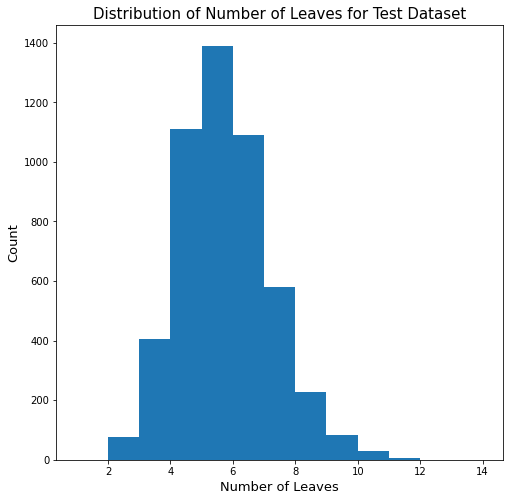

In [5]:
num_leaves = [len(x["leaves"]) for x in jet_list]
#print(np.sum(np.array(num_leaves) == 11))

fig, ax = plt.subplots(nrows=1, ncols=1)
fig.set_size_inches(8,8)

ax.hist(num_leaves, bins=np.arange(1,15))

ax.set_xlabel("Number of Leaves", size=13)
ax.set_ylabel("Count", size=13)
ax.set_title("Distribution of Number of Leaves for Test Dataset", size=15)

In [6]:
simulator.save(jet_list, "./data", "ginkgo_5000_jets_mle_jetp_400")

## Generate data on the grid

In [ ]:
Nsamples = 1000
minLeaves = 1
maxLeaves = 50
maxNTry = 5000

n_cuts = 30
n_lambda = 30

cut_vals = np.linspace(1, 150, n_cuts)
lambda_vals = np.round(np.exp(np.linspace(np.log(1e-3), np.log(5), n_lambda)), decimals=6)

grid_cut, grid_lambda = np.meshgrid(cut_vals, lambda_vals)

for i in range(n_cuts):
    for j in range(n_lambda):
        rate2=torch.tensor(8.)
        pt_min = torch.tensor(float(grid_cut[j,i]))

        ### Physics inspired parameters to get ~ between 20 and 50 constituents
        QCD_rate = float(grid_lambda[j,i])

        QCD_mass = 30.

        rate=torch.tensor([QCD_rate,QCD_rate]) #Entries: [root node, every other node] decaying rates. Choose same values for a QCD jet
        M2start = torch.tensor(QCD_mass**2)

        jetM = np.sqrt(M2start.numpy())

        jetdir = np.array([1,1,1])
        jetP = 400.
        jetvec = jetP * jetdir / np.linalg.norm(jetdir)

        jet4vec = np.concatenate(([np.sqrt(jetP**2 + jetM**2)], jetvec))


        simulator = invMass_ginkgo.Simulator(jet_p=jet4vec,
                                             pt_cut=float(pt_min),
                                             Delta_0=M2start,
                                             M_hard=jetM ,
                                             num_samples=Nsamples,
                                             minLeaves =minLeaves,
                                             maxLeaves = maxLeaves,
                                             maxNTry = maxNTry)
        
        jet_list = simulator(rate)
        
        simulator.save(jet_list, "/scratch/mdd424/data/ginkgo", "ginkgo_1000_jets_jetp_400_lambda_{:.4f}_ptcut_{:.4f}_{}{}".format(
            float(grid_lambda[j,i]),
            float(grid_cut[j,i]),
            j,
            i
        ))

2021-06-17 12:17:12,120:INFO::Num samples: 1000
2021-06-17 12:17:12,120:INFO::Initial squared mass: 900.0
2021-06-17 12:17:12,175:INFO:: Off-shell subjets mass = (tensor(13.8675), tensor(10.3748))
2021-06-17 12:17:13,081:INFO:: Leaves  = [[ 6.18749943  3.7370149   3.42408343  3.5427906 ]
 [22.97751097 13.96502013 12.25872508 13.48565611]
 [ 4.64566355  3.31655207  2.29357931  2.28275125]
 [ 6.31656912  3.62225715  3.24365198  3.94421983]
 [ 6.35461623  3.33718812  3.4318241   4.13023413]
 [ 4.16863599  2.54025192  2.25519382  2.40487972]
 [ 0.39259102  0.1860701   0.18190318  0.28924765]
 [ 0.98790103  0.51502563  0.53823542  0.64194514]
 [ 9.57830305  5.09946679  5.40544398  6.00072594]
 [ 3.08824294  1.7233008   1.71869733  1.89272665]
 [ 5.48368429  3.76749382  2.75081785  2.78424232]
 [ 2.54549483  1.74074721  1.15597405  1.42489095]
 [ 1.05529682  0.65478341  0.52373336  0.6379065 ]
 [ 5.51701992  3.28164428  3.20410463  3.00733243]
 [ 9.11694459  5.55906254  4.95519039  5.2432784

2021-06-17 12:17:15,567:INFO:: N const = 42
2021-06-17 12:17:15,570:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:17:15,571:INFO:: Total momentum from leaves = [401.1234346  230.94011488 230.94011497 230.94011426]
2021-06-17 12:17:15,572:INFO:: Jet Mass = 30.0
2021-06-17 12:17:15,573:INFO:: Jet likelihood = [-14.81981468 -11.01027012  -8.89042473  -1.89770007  -7.17937183
  -5.94309807  -2.72973561   0.           0.          -3.06293416
   0.           0.          -1.32741117  -1.91626227  -3.5229609
   0.           0.           0.           0.           0.
  -4.06309938  -1.10879087   0.59688187  -4.349226     0.
   0.           0.           0.           0.          -3.88430357
  -5.77294731  -2.98948765   2.00571227  -3.92940068   0.
   0.           0.           0.           0.           0.
 -10.86504555  -8.7986517   -9.13212299  -7.83003044  -7.11464882
  -3.59858561  -2.26967001  -3.76522183   0.           0.
   0.           

2021-06-17 12:17:18,283:INFO:: N const = 34
2021-06-17 12:17:18,286:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:17:18,286:INFO:: Total momentum from leaves = [401.12340895 230.94009983 230.94010007 230.94009989]
2021-06-17 12:17:18,287:INFO:: Jet Mass = 30.0
2021-06-17 12:17:18,288:INFO:: Jet likelihood = [-14.80975723 -10.14340305  -7.60612297  -8.92367458  -9.00345802
  -6.11375809  -7.76355553   0.45175076  -3.0578053    0.
   0.           0.           2.25146556  -3.80857587   0.
   0.           0.           0.          -3.30128312   0.
   0.           0.53213191  -5.08178234   0.           0.
   0.           0.          -2.09493828  -2.9275744    0.
   0.           0.          -7.10696793 -10.88853359  -9.49329185
  -8.35436726  -6.45632648  -2.77247262   0.           0.
  -2.66486835  -2.74056649   0.           0.           0.
  -2.52541447  -4.61273956   0.           0.           0.
  -1.77670825  -4.51229858   0.        

2021-06-17 12:17:21,608:INFO:: N const = 41
2021-06-17 12:17:21,611:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:17:21,611:INFO:: Total momentum from leaves = [401.12341614 230.94010408 230.94010389 230.94010424]
2021-06-17 12:17:21,612:INFO:: Jet Mass = 30.0
2021-06-17 12:17:21,614:INFO:: Jet likelihood = [-13.95653439 -13.2041769   -9.48646069  -6.4202919   -7.3312521
   0.51520681   0.1716063   -5.74046755  -4.81961775   0.
   0.33458543  -3.30848336   0.           0.           0.
   0.           0.           0.          -3.25861764   0.
   0.           0.          -3.65766573  -4.06469154   1.392241
  -2.31654978   0.          -0.95824492  -2.84077764   0.
   0.           0.           0.           0.           0.
  -6.82973385  -8.54673862  -7.54237747  -4.54352474  -3.35885811
  -6.59676838  -4.67029762   0.           0.           0.
   0.           0.           0.          -4.91828442   0.
   0.           0.         -10.373

2021-06-17 12:17:24,168:INFO:: N const = 26
2021-06-17 12:17:24,170:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:17:24,171:INFO:: Total momentum from leaves = [401.12344016 230.94011809 230.94011784 230.9401178 ]
2021-06-17 12:17:24,172:INFO:: Jet Mass = 30.0
2021-06-17 12:17:24,173:INFO:: Jet likelihood = [-14.09459114  -9.97963428  -6.26318073  -4.33183575   0.
   0.          -2.94026589   0.           0.          -3.20290709
  -2.74427819   0.           0.           0.         -13.17362118
  -8.06526089  -4.59096813  -5.32704639  -6.76167393  -4.72120476
  -5.69422197  -1.63420939  -2.42610478  -1.77004933  -0.53346837
  -3.90720677   0.           0.           0.           0.
   0.           0.           0.           0.           0.
   0.           0.           0.          -0.79741549  -7.34109497
  -5.03291607  -2.19951916  -3.31570935   0.           0.
   0.           0.          -2.8989861    0.           0.
   0.        ]


2021-06-17 12:17:26,912:INFO:: N const = 21
2021-06-17 12:17:26,915:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:17:26,915:INFO:: Total momentum from leaves = [401.12343407 230.94011452 230.94011421 230.94011444]
2021-06-17 12:17:26,917:INFO:: Jet Mass = 30.0
2021-06-17 12:17:26,917:INFO:: Jet likelihood = [-14.19684696 -12.34548092  -9.99849129  -4.96605968  -6.3477459
  -8.51250076  -6.76922894  -3.48027682  -1.38933516  -3.21852422
   0.           0.           0.           0.          -3.15805745
   0.           0.           0.           0.           0.
  -1.53070104  -3.48282647   0.           0.           0.
  -3.26016951  -4.21994638  -2.95384264  -3.75749898   0.
   0.           0.           0.           0.          -8.81435966
   0.          -5.57831097  -6.06425381   0.           0.
   0.        ]
2021-06-17 12:17:26,931:INFO:: Off-shell subjets mass = (tensor(24.6736), tensor(2.4033))
2021-06-17 12:17:27,746:INFO:: Leav

2021-06-17 12:17:30,236:INFO:: N const = 41
2021-06-17 12:17:30,239:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:17:30,240:INFO:: Total momentum from leaves = [401.12339577 230.94009216 230.94009258 230.9400923 ]
2021-06-17 12:17:30,241:INFO:: Jet Mass = 30.0
2021-06-17 12:17:30,242:INFO:: Jet likelihood = [-13.39492989 -13.70594978  -9.90252495  -6.49499607  -2.48901606
   1.82053256  -1.54815197   0.70252824  -3.43427873   0.
   0.           0.           0.           0.           0.
  -2.93019319   0.           0.          -7.75849342  -6.5669384
  -5.00636578   0.           0.          -3.98315263   0.
   0.          -1.13268137  -1.74475098  -4.21333313   0.
   0.           0.           0.         -10.1457634   -5.28982639
  -9.01638317   2.55231929  -4.7526083    0.           0.
   0.           1.59397864  -1.92111051  -2.6569159    0.
   0.           0.           0.           0.          -3.69682407
  -3.98767877  -0.241149

2021-06-17 12:17:33,547:INFO:: N const = 38
2021-06-17 12:17:33,550:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:17:33,550:INFO:: Total momentum from leaves = [401.12346015 230.94012996 230.94012889 230.94012936]
2021-06-17 12:17:33,551:INFO:: Jet Mass = 30.0
2021-06-17 12:17:33,553:INFO:: Jet likelihood = [ -4.80613422 -10.79461384 -12.88574123 -10.82244968  -8.3931179
 -12.76124096  -8.42694855   0.          -6.73165894  -7.91447926
  -7.00289536  -2.47752595  -0.71226692  -5.86262417   0.
   0.           0.           0.          -4.34449482   0.
   0.          -0.43744302  -2.58898568   0.           0.
   0.           0.          -8.21951199  -6.36931801  -7.71487141
  -2.26684594  -1.97388732   0.24756789  -2.82834363   2.91282153
  -3.42642522   0.           0.           0.           0.
   0.           0.           0.          -5.10195255   0.
   0.           0.           2.52729678  -2.92191052   0.
   0.           0.      

2021-06-17 12:17:36,112:INFO:: N const = 22
2021-06-17 12:17:36,114:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:17:36,114:INFO:: Total momentum from leaves = [401.12343681 230.94011597 230.94011593 230.94011602]
2021-06-17 12:17:36,115:INFO:: Jet Mass = 30.0
2021-06-17 12:17:36,116:INFO:: Jet likelihood = [-12.95807171 -10.0685997  -13.47070122  -8.83241081  -9.72177124
  -6.08952236  -3.93200207  -7.37306499  -2.97606659  -5.58146048
   0.59729743  -6.06355572   0.           0.           0.
   0.           0.          -2.80804467   0.           0.
   0.           0.          -3.03634667   0.           0.
  -2.75879312   0.           0.          -4.43728161   0.
   0.           0.          -8.39620304  -3.69558573  -0.27788138
  -4.51744366   0.           0.           0.           0.
  -4.29952335   0.           0.        ]
2021-06-17 12:17:36,142:INFO:: Off-shell subjets mass = (tensor(27.2092), tensor(1.5348))
2021-06-17 12:17

2021-06-17 12:17:38,751:INFO:: N const = 26
2021-06-17 12:17:38,753:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:17:38,754:INFO:: Total momentum from leaves = [401.12341038 230.94010083 230.94010091 230.94010058]
2021-06-17 12:17:38,755:INFO:: Jet Mass = 30.0
2021-06-17 12:17:38,756:INFO:: Jet likelihood = [-14.04360485 -11.19381237 -11.82989979  -4.6966114   -5.77538157
   0.          -5.40746498  -6.08031845   0.          -2.91467309
   0.           0.           0.           0.          -6.50495911
  -8.7363987   -7.55300331  -6.64019012  -4.81802654  -3.96492529
  -2.71320653   0.           0.           0.           0.
   0.          -2.69914651   0.           0.          -4.53618336
  -2.53448606   0.           0.           0.           0.
  -2.65340495  -4.3769455    0.          -2.78137422   0.
   0.           0.          -7.8896389   -5.60887432  -3.69611764
  -3.53671765   0.           0.           0.           0.
   0.  

2021-06-17 12:17:42,144:INFO:: N const = 41
2021-06-17 12:17:42,147:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:17:42,148:INFO:: Total momentum from leaves = [401.12339251 230.94009034 230.94009046 230.94009059]
2021-06-17 12:17:42,149:INFO:: Jet Mass = 30.0
2021-06-17 12:17:42,150:INFO:: Jet likelihood = [-12.22257519  -8.16484737 -13.06329155 -11.364007   -11.07408905
  -9.7202177    1.85361409  -5.67243958  -2.66029549  -3.11000943
   0.           0.           0.           0.           0.
  -5.09804201  -2.67108154   1.71804404  -3.8691237    0.
   0.           0.           0.           0.          -6.97027779
  -1.54892039   1.18647599  -3.38981175   0.           0.
   0.           0.          -2.99596691   0.80737185  -2.76848221
  -3.42400098   0.           0.           0.           0.
   0.           1.83504128  -2.40838075  -4.31330776  -4.10960627
  -4.27056789   0.           0.           0.           0.
   0.          

2021-06-17 12:17:45,062:INFO:: N const = 32
2021-06-17 12:17:45,065:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:17:45,065:INFO:: Total momentum from leaves = [401.12342504 230.94010909 230.94010932 230.94010918]
2021-06-17 12:17:45,066:INFO:: Jet Mass = 30.0
2021-06-17 12:17:45,067:INFO:: Jet likelihood = [-11.98959446 -13.97758007 -10.27628899 -10.79444218  -7.02588367
   0.          -6.55534458  -5.28296947   1.27124906  -3.96388602
  -0.12982798   2.21761489  -4.98469067   0.           0.
   0.           0.           0.           0.           0.
   0.          -6.89453602  -3.46087193   0.           0.
  -5.96820164   0.           0.          -6.43840885   0.
   0.          -4.40156651  -3.56420612  -8.49907112  -6.1706028
  -8.36037636  -2.62206507  -1.54238796  -4.35218811   0.
   0.           0.           0.          -2.1994071   -0.63666213
  -4.14161587   0.           0.           0.           0.
   0.          -3.614938

2021-06-17 12:17:47,527:INFO:: Off-shell subjets mass = (tensor(16.6685), tensor(6.5851))
2021-06-17 12:17:48,387:INFO:: Leaves  = [[ 9.74162786  5.86831056  5.62809106  5.28323198]
 [18.4828807  10.51699302 10.38035488 11.08868427]
 [ 9.76598659  5.45315552  5.60268994  5.81483284]
 [ 4.44608895  2.39664107  2.73923149  2.53432625]
 [14.80715397  7.2371246   9.21617095  9.03634539]
 [ 7.70921071  4.42627707  4.18504748  4.72013108]
 [ 0.25197495  0.13457943  0.14928608  0.1517193 ]
 [13.53910516  7.01482235  8.51394438  7.79285412]
 [11.20654251  5.93376373  6.8621041   6.55172474]
 [ 6.87815538  3.27671283  4.6901031   3.80821954]
 [ 4.80858305  2.55311421  2.99240848  2.72784845]
 [23.11451622 12.89925367 14.40002205 12.6680412 ]
 [10.02819109  5.69410564  5.78024035  5.87276714]
 [ 1.45931065  0.79465677  0.88986885  0.82715121]
 [15.86951504  7.97213911  9.71078728  9.64310116]
 [ 0.4472422   0.23373148  0.28522094  0.25296821]
 [ 1.84406653  1.01427893  1.11691768  1.05627198]
 [

2021-06-17 12:17:50,302:INFO:: Off-shell subjets mass = (tensor(8.1493), tensor(4.6908))
2021-06-17 12:17:50,934:INFO:: Leaves  = [[3.42878103e+01 2.00833509e+01 1.96855540e+01 1.96002400e+01]
 [1.79393191e+01 1.04043652e+01 1.02522441e+01 1.04074658e+01]
 [2.11559961e+01 1.24886935e+01 1.20814489e+01 1.20610079e+01]
 [2.55740985e+01 1.49372790e+01 1.45926478e+01 1.47481761e+01]
 [1.52495555e+01 8.89980281e+00 8.81876414e+00 8.69126572e+00]
 [4.42765812e+01 2.57321894e+01 2.47702582e+01 2.61551512e+01]
 [8.97297063e+01 5.33458892e+01 4.99143419e+01 5.20942308e+01]
 [1.45509516e+01 8.71498941e+00 8.01595045e+00 8.45617724e+00]
 [1.31838465e+01 7.82730523e+00 7.45924401e+00 7.53781316e+00]
 [3.58884709e+01 2.08813124e+01 2.09706565e+01 2.02887041e+01]
 [6.00365213e+00 3.55308545e+00 3.38115418e+00 3.46118039e+00]
 [5.58931920e+01 3.26648229e+01 3.16794329e+01 3.24420082e+01]
 [1.65327415e+01 6.72092340e+00 1.18183769e+01 9.38340837e+00]
 [4.01225020e+00 1.20475197e+00 2.76813705e+00 2.62

2021-06-17 12:17:53,131:INFO:: Leaves  = [[65.74058387 36.95869641 37.71287261 39.15578424]
 [45.21787017 25.31559789 25.11055568 27.8044255 ]
 [39.7153144  23.42674041 21.40283841 23.87728412]
 [26.64392631 14.87540144 14.94039776 16.28549434]
 [15.41635213  8.66129675  8.24157421  9.69117596]
 [12.83169285  7.12816016  7.32044417  7.75238864]
 [47.54923547 28.16147194 24.50008653 29.4450096 ]
 [12.39243057  6.47833945  6.70964128  8.1512229 ]
 [16.46012044  9.63788273 10.34901326  8.40060755]
 [12.77038097  7.8077933   7.84728319  6.32190698]
 [49.52964728 28.97979654 31.20707197 25.28560569]
 [ 4.17498792  2.37172285  2.67027405  2.15410455]
 [40.01506664 23.99800073 24.72398546 20.34672746]
 [ 2.25829419  1.60286558  1.16885618  0.98551243]
 [10.40749776  5.53632914  7.03520088  5.28284505]]
2021-06-17 12:17:53,131:INFO:: N const = 15
2021-06-17 12:17:53,132:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:17:53,133:INFO:: Total 

2021-06-17 12:17:56,237:INFO:: N const = 40
2021-06-17 12:17:56,240:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:17:56,240:INFO:: Total momentum from leaves = [401.12341671 230.94010436 230.94010441 230.9401044 ]
2021-06-17 12:17:56,241:INFO:: Jet Mass = 30.0
2021-06-17 12:17:56,243:INFO:: Jet likelihood = [-13.99276638 -12.83071613  -7.79092598  -8.08182621  -3.25105238
  -0.56833112  -4.17254066   0.           0.           0.
   0.          -4.9712944   -3.84574246   0.           0.
   0.          -3.20661855   0.           0.          -3.24122119
  -9.59882545  -8.5622654   -3.02237105  -7.54385662   2.00498462
  -3.28417706   0.           0.           0.          -7.32321167
  -3.19544721   0.           0.           0.           0.
   2.56917167  -1.72074723  -2.79589009   0.           0.
   0.           0.          -3.86881495  -1.47627568  -0.36758256
  -3.24681211   0.           0.           0.           0.
   0.          

2021-06-17 12:17:59,410:INFO:: N const = 38
2021-06-17 12:17:59,413:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:17:59,413:INFO:: Total momentum from leaves = [401.1233895  230.94008881 230.94008867 230.94008868]
2021-06-17 12:17:59,415:INFO:: Jet Mass = 30.0
2021-06-17 12:17:59,416:INFO:: Jet likelihood = [-10.73499489 -12.9009676  -11.37327099 -12.91109562  -4.4305315
  -4.71676159  -8.55173206  -3.25746489  -1.3184607   -3.53120351
   0.           0.           0.           0.          -3.38955212
  -4.96808338   0.           0.           0.           0.
   0.          -9.39926147  -4.46523666  -7.70049381  -7.37236404
  -4.543046     0.           0.           0.19705868  -0.39709401
  -5.23203564   0.           0.           0.           0.
   1.48558211  -2.87208891  -2.87193131   0.           0.
   0.           0.           0.          -5.91309834   0.
   0.           0.02627969  -6.22915077  -3.40932965   0.
   0.          -

2021-06-17 12:18:02,525:INFO:: N const = 33
2021-06-17 12:18:02,528:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:18:02,528:INFO:: Total momentum from leaves = [401.12343548 230.94011551 230.94011537 230.94011471]
2021-06-17 12:18:02,529:INFO:: Jet Mass = 30.0
2021-06-17 12:18:02,530:INFO:: Jet likelihood = [-14.77321625 -11.5042448   -7.46508026  -2.90130186   2.11083531
   2.55581546  -3.00647569   0.           0.           0.
   0.           0.          -2.63050914  -2.26977611  -1.98466277
  -2.88100362   0.           0.           0.           0.
   0.         -10.70946789  -0.75959432  -3.45480251  -1.98047364
   0.          -0.83822703  -2.95510221   0.           0.
   0.           0.           0.          -0.66857314   1.57983279
  -3.60756993   0.           0.           0.           0.
  -4.6041832   -4.26229572  -9.67007446  -7.49213123  -4.37331295
   0.          -2.6032784    0.           0.          -5.0419507
   0.   

2021-06-17 12:18:05,508:INFO:: N const = 35
2021-06-17 12:18:05,510:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:18:05,511:INFO:: Total momentum from leaves = [401.12343593 230.9401154  230.94011541 230.94011559]
2021-06-17 12:18:05,512:INFO:: Jet Mass = 30.0
2021-06-17 12:18:05,513:INFO:: Jet likelihood = [-13.98622608 -11.86291409  -2.14432788 -11.6996479   -9.33893967
  -7.30860043  -3.13080025  -3.63700128   0.           0.
   0.          -3.73952222   0.           0.          -4.30965519
   0.           0.          -4.79858112  -3.3100481    2.63849139
   2.41142058  -3.17644906  -4.08842659   0.           0.
   0.           0.           0.           0.           0.
   0.          -4.50937843  -4.99606323  -0.55598783  -3.63741612
   0.           0.           0.           0.           0.
 -10.30772114  -6.92972946  -6.06213331  -3.76036382   0.
   0.          -2.95790601   0.           0.          -2.85811925
   0.          

2021-06-17 12:18:08,601:INFO:: N const = 20
2021-06-17 12:18:08,603:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:18:08,603:INFO:: Total momentum from leaves = [401.1234364  230.94011585 230.94011575 230.94011561]
2021-06-17 12:18:08,605:INFO:: Jet Mass = 30.0
2021-06-17 12:18:08,606:INFO:: Jet likelihood = [-15.33925152  -9.40562344  -3.46849442  -3.93868613  -2.70187306
   0.           0.           0.           0.          -6.20204449
  -4.02095127  -7.43849468   0.32258797  -5.66795921  -3.58032894
  -4.40907478   0.          -2.33686852  -3.18235517   0.
   0.           0.           0.           0.           0.
  -3.97921205   0.           0.           0.           0.
  -3.6558249   -1.67916346   0.92713809  -2.82925344   0.
   0.           0.           0.           0.        ]
2021-06-17 12:18:08,631:INFO:: Off-shell subjets mass = (tensor(20.5364), tensor(6.9921))
2021-06-17 12:18:09,785:INFO:: Leaves  = [[21.36233458 12.643

2021-06-17 12:18:11,433:INFO:: N const = 25
2021-06-17 12:18:11,435:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:18:11,436:INFO:: Total momentum from leaves = [401.1234196  230.94010553 230.94010575 230.94010685]
2021-06-17 12:18:11,436:INFO:: Jet Mass = 30.0
2021-06-17 12:18:11,438:INFO:: Jet likelihood = [-14.24810028 -13.04335213  -4.2542181   -6.20554256  -7.64986706
  -1.70895863  -1.61007774  -1.65745687  -3.66918969   0.
   0.           0.           0.           0.           2.10381675
  -2.8460753    0.           0.           0.           0.
   0.          -8.37829876  -6.26189232  -6.26845837  -5.3669672
  -3.0000453   -4.50762701  -2.53759503   0.           0.
   0.           0.           0.           0.           0.
  -5.06350613   0.           0.          -6.21607494  -1.73574328
  -6.40939379  -3.91386247   0.           0.          -5.03995228
   0.           0.           0.           0.        ]
2021-06-17 12:18:11,

2021-06-17 12:18:14,514:INFO:: N const = 43
2021-06-17 12:18:14,517:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:18:14,518:INFO:: Total momentum from leaves = [401.1233835  230.94008539 230.94008491 230.94008553]
2021-06-17 12:18:14,519:INFO:: Jet Mass = 30.0
2021-06-17 12:18:14,520:INFO:: Jet likelihood = [ -6.42455578 -14.17607975 -10.65162659  -6.39635563 -10.37496471
 -10.93900967  -6.66619778  -2.21852779  -4.36781693   0.
  -2.77126241   0.           0.           0.          -0.25886917
  -2.61481118   0.           0.           0.          -8.38754749
  -6.28335571   0.36830759   0.08795285  -1.06512737  -6.91894341
  -3.96480584   0.           1.30483747   1.69888663  -2.64943528
   0.           0.           0.           0.          -2.00309873
  -2.65501142   0.           0.           0.           0.
   0.           0.           0.          -2.56385255   0.
   0.          -4.34533691  -2.61418939   0.           0.
   0.  

2021-06-17 12:18:17,755:INFO:: N const = 23
2021-06-17 12:18:17,757:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:18:17,757:INFO:: Total momentum from leaves = [401.12341471 230.94010337 230.94010357 230.94010287]
2021-06-17 12:18:17,758:INFO:: Jet Mass = 30.0
2021-06-17 12:18:17,760:INFO:: Jet likelihood = [-10.74440098 -14.54332638  -9.56730556  -0.64561343 -11.84921932
  -3.91595554  -3.548347    -3.62618685  -1.69258451  -2.20814443
  -3.22560143   0.           0.           0.           0.
   0.           0.           0.          -6.49796486  -3.83083844
   0.           0.          -2.8412745   -3.27360272   0.
   0.           0.           0.          -4.40080261   0.
   0.         -10.26339817   0.          -6.33258724  -3.16316533
  -1.64302397  -3.61781144   0.           0.           0.
   0.           0.          -3.13695455   0.           0.        ]
2021-06-17 12:18:17,807:INFO:: Off-shell subjets mass = (tensor(29.8970)

2021-06-17 12:18:20,164:INFO:: N const = 25
2021-06-17 12:18:20,165:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:18:20,166:INFO:: Total momentum from leaves = [401.12339951 230.94009435 230.94009448 230.94009461]
2021-06-17 12:18:20,166:INFO:: Jet Mass = 30.0
2021-06-17 12:18:20,168:INFO:: Jet likelihood = [-14.72519779  -9.3715229   -8.3356638  -11.29929161  -4.59851074
  -5.898489    -2.27343321  -6.49013042  -4.4135747   -3.6966784
  -3.936373     0.           0.           0.           0.
   0.           0.           0.           0.          -3.92232227
  -1.69537902  -2.87504506   0.           0.           0.
   0.           0.          -0.95059407  -2.7633431    0.
   0.           0.          -5.64799404  -9.59807014  -5.09635448
   0.           0.          -4.14957523  -5.87778664  -3.0683744
  -2.14437342  -6.56518841   0.           0.           0.
   0.           0.           0.           0.        ]
2021-06-17 12:18:20,2

2021-06-17 12:18:23,010:INFO:: N const = 28
2021-06-17 12:18:23,012:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:18:23,013:INFO:: Total momentum from leaves = [401.12344072 230.94011812 230.94011804 230.94011846]
2021-06-17 12:18:23,013:INFO:: Jet Mass = 30.0
2021-06-17 12:18:23,015:INFO:: Jet likelihood = [-13.40605259 -13.00492954  -7.41652012 -11.80527782  -7.83172989
  -6.51598454  -3.80541539   0.           0.          -4.51905537
   0.           0.           0.30613446  -1.88627076   2.89300704
  -2.78476906  -3.10364747   0.           0.           0.
   0.           0.           0.          -6.86597538  -4.71920538
  -4.39559269  -0.87580562  -3.60818219   0.           0.
   0.           0.           0.           0.           0.
  -4.78216267   0.           0.          -4.2244215   -0.3365736
  -3.20100474  -2.34957123  -5.65894127   0.           2.86738133
  -1.80960822  -3.45291352   0.           0.           0.
   0.   

2021-06-17 12:18:26,158:INFO:: N const = 33
2021-06-17 12:18:26,161:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:18:26,162:INFO:: Total momentum from leaves = [401.12339686 230.94009305 230.94009285 230.94009305]
2021-06-17 12:18:26,163:INFO:: Jet Mass = 30.0
2021-06-17 12:18:26,164:INFO:: Jet likelihood = [-11.41891479 -11.3555479  -13.12324905 -11.13172722 -11.6791048
  -2.55821013  -4.81169415  -3.44099259  -0.22218609  -2.55476356
  -0.08055282  -3.7292912    0.           0.           0.
   0.           0.           0.           0.           0.
  -2.24154592  -4.94622707  -2.85323787  -2.01930594  -3.37811971
   0.           0.           0.           0.           0.
   0.          -6.47614861  -4.52948856  -2.98579025   0.
  -2.7343514    0.           0.           0.           0.
  -7.65489674  -6.70795822  -3.7977016    2.79243779   2.75453448
  -3.13824677   0.           0.           0.           0.
   0.           0.186269

2021-06-17 12:18:29,240:INFO:: Leaves  = [[20.37645898 11.77141122 11.33085162 12.14141525]
 [ 6.0153114   3.53126802  3.0908576   3.71887545]
 [10.47628283  6.61075744  4.74279696  6.55090872]
 [26.5530607  15.3461596  15.33114749 15.30929615]
 [ 1.12600971  0.65934348  0.60938618  0.6732919 ]
 [14.55667566  9.06720246  7.64016014  8.40696003]
 [12.0357223   7.89040838  5.87544455  6.9260096 ]
 [ 1.08544566  0.74558455  0.45393111  0.5815985 ]
 [39.34211196 22.08625052 23.30575789 22.7180048 ]
 [14.35591436  8.18305436  8.44491963  8.23301997]
 [26.41998571 14.25469838 16.00066148 15.44394007]
 [32.64494948 18.19840516 19.46706854 18.85398165]
 [ 2.94665816  1.6611063   1.74285012  1.6825637 ]
 [ 4.91468014  2.9859916   2.63511759  2.85204803]
 [ 5.37966224  2.64769922  3.37526718  3.20070585]
 [ 7.68675879  4.27085724  4.47190401  4.4765352 ]
 [ 9.59641746  5.97973785  5.27825318  5.30880215]
 [ 9.71048614  5.39822515  5.92479188  5.46776655]
 [ 7.95438798  4.4610119   5.0243324   4.

2021-06-17 12:18:31,627:INFO:: N const = 31
2021-06-17 12:18:31,630:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:18:31,630:INFO:: Total momentum from leaves = [401.12341908 230.9401058  230.9401059  230.94010561]
2021-06-17 12:18:31,632:INFO:: Jet Mass = 30.0
2021-06-17 12:18:31,632:INFO:: Jet likelihood = [ -7.91158485 -13.59963322  -7.97469616 -10.32999325 -11.58127785
 -11.43959427  -1.84941745  -8.59477615  -5.89852238  -5.24218845
   0.           0.           0.           0.           0.
  -7.51429367  -1.45817065  -3.31165242   0.           0.
   0.          -6.50263071  -3.54547405  -2.92408681   0.
   0.           0.          -3.98019719   0.           0.
  -2.29406667  -0.93789601  -0.36136556  -3.39091229   0.
   0.           0.           0.           0.           1.22885156
  -4.65609741   0.           0.           0.           0.
  -8.84776402  -5.29366684  -3.16506076  -3.62843394  -1.81450057
  -3.04065061   0.     

2021-06-17 12:18:33,971:INFO:: N const = 30
2021-06-17 12:18:33,974:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:18:33,974:INFO:: Total momentum from leaves = [401.12343749 230.94011651 230.94011624 230.94011635]
2021-06-17 12:18:33,975:INFO:: Jet Mass = 30.0
2021-06-17 12:18:33,976:INFO:: Jet likelihood = [-14.21726704 -12.1905508   -7.26426029  -0.48385954  -4.21568012
   0.76955056  -0.19053388   1.86482501  -2.67093587   0.
   0.           0.           0.           0.           0.
   0.           0.         -10.31669903  -9.94833279  -6.74909687
   0.           0.          -3.39697671  -5.06101799   0.
  -2.86952901   0.           0.           0.          -0.58684897
  -6.5431385    0.           1.21694207  -2.70551324   0.
   0.           0.           0.          -9.78387737  -9.786273
  -6.31273079   1.92583013  -2.68531346   0.           0.
   0.          -2.15659189  -1.7493459   -2.53771424   0.
   0.           0.       

2021-06-17 12:18:37,660:INFO:: N const = 40
2021-06-17 12:18:37,663:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:18:37,663:INFO:: Total momentum from leaves = [401.12343111 230.94011275 230.94011271 230.94011259]
2021-06-17 12:18:37,664:INFO:: Jet Mass = 30.0
2021-06-17 12:18:37,665:INFO:: Jet likelihood = [-12.49246883 -12.27508259 -10.26918697 -12.70040989  -9.85236263
  -8.14170551   2.8810761   -3.34129834   0.           0.
   0.          -3.17757058   0.           0.          -6.84726048
  -1.90076363  -3.94953156   0.          -2.60043645   0.
   0.           0.          -2.9322331    0.           0.
  -6.85714722  -7.44088554  -3.88109446  -1.21491051  -2.06324315
  -2.46072364  -0.26317286   0.           0.08426261  -2.78218579
   0.           0.           0.           0.           0.
   0.           0.          -1.49005151   2.85411477  -3.12806535
  -2.56300378   0.           0.           0.           0.
   0.          

2021-06-17 12:18:40,186:INFO:: Off-shell subjets mass = (tensor(26.0899), tensor(3.4472))
2021-06-17 12:18:41,063:INFO:: Leaves  = [[3.13054824e+01 1.86089506e+01 1.69752294e+01 1.85681192e+01]
 [1.47478640e+01 8.82487405e+00 7.94169137e+00 8.74118920e+00]
 [5.41976538e+00 3.67122319e+00 2.53077557e+00 3.03719685e+00]
 [1.05611170e+01 6.41996256e+00 5.80545744e+00 6.03674442e+00]
 [1.53053641e+01 8.48141624e+00 8.58735194e+00 9.40378826e+00]
 [2.10924899e+01 1.17314413e+01 1.17971662e+01 1.29648515e+01]
 [2.04991966e+00 1.02850254e+00 1.38763213e+00 1.03807147e+00]
 [2.21399354e+01 1.26588369e+01 1.28696340e+01 1.27890186e+01]
 [4.23304069e-01 2.45170589e-01 2.25733978e-01 2.58305200e-01]
 [8.12063061e+00 4.45402566e+00 4.74342069e+00 4.77714534e+00]
 [3.54360395e+00 1.42652592e+00 2.47815708e+00 1.96613579e+00]
 [1.25094543e+01 6.89203661e+00 7.16991207e+00 7.56086435e+00]
 [8.32580183e+00 4.33874794e+00 4.90710152e+00 5.09114838e+00]
 [1.73958248e+01 9.58257571e+00 1.05997877e+01 9.8

2021-06-17 12:18:43,450:INFO:: N const = 37
2021-06-17 12:18:43,453:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:18:43,453:INFO:: Total momentum from leaves = [401.1234411  230.94011861 230.94011826 230.94011843]
2021-06-17 12:18:43,454:INFO:: Jet Mass = 30.0
2021-06-17 12:18:43,456:INFO:: Jet likelihood = [-12.46993351 -13.78945255 -10.23482037  -7.93602085  -4.16323185
  -6.3290844   -2.65888643  -4.49598503   0.           0.
   0.           0.           0.          -0.28815532  -3.192554
  -3.31676984   0.           0.           0.           0.
  -4.98052454  -5.33935261   0.           0.           0.
  -6.70265102  -7.32030678 -10.66039658  -7.05464649  -4.29923439
   0.           0.           2.7754972   -3.29323506   0.
   0.           0.          -5.01909542  -8.23745346  -5.72863483
  -0.23323894  -8.63511181  -3.64323163   0.           0.
  -6.38747787  -2.59846139   0.           0.          -2.13920307
  -2.89483285   0

2021-06-17 12:18:46,116:INFO:: Off-shell subjets mass = (tensor(25.4008), tensor(3.2572))
2021-06-17 12:18:47,028:INFO:: Leaves  = [[ 4.2823579   2.40736806  2.85114279  1.86410422]
 [ 0.81269694  0.45101184  0.45480097  0.39872394]
 [ 2.54315516  0.38825011  1.77607377  1.77794045]
 [ 0.30458567  0.14192212  0.2067897   0.15869496]
 [ 2.19356706  0.93933704  1.33767825  1.23238775]
 [23.88461108 13.70129302 14.05124523 13.61282623]
 [62.14037018 35.18676953 35.39250859 37.01972003]
 [54.17608695 30.70926389 31.30918913 31.80504934]
 [70.97788979 40.89550702 40.59495444 41.43842877]
 [14.16385208  7.6707972   8.49531314  8.30084272]
 [ 3.04364292  1.59413797  1.84478708  1.80789005]
 [ 1.7996327   1.06283467  1.02246599  1.03088734]
 [ 6.35796351  3.19332225  3.63077444  4.07505871]
 [ 7.35380186  4.15419485  4.07001955  4.43209908]
 [22.43541945 13.24299823 13.30066402 12.26204205]
 [15.21562018  9.00552413  8.99791724  8.31583233]
 [20.09754601 11.95925947 11.96309553 10.82857153]
 [

2021-06-17 12:18:49,082:INFO:: Off-shell subjets mass = (tensor(27.2976), tensor(2.2575))
2021-06-17 12:18:50,245:INFO:: Leaves  = [[27.06386391 14.49640092 13.74964827 18.22788107]
 [11.90863203  7.36481784  6.64036992  6.55866387]
 [ 5.32482441  3.41305242  2.8052445   2.95678194]
 [ 2.27131678  1.36562947  1.24214463  1.31999469]
 [ 2.94768982  1.9326174   1.55531971  1.57978113]
 [ 8.38166239  5.262682    4.51294374  4.6854897 ]
 [10.07979272  6.04786833  5.8445233   5.54116734]
 [ 7.85071757  4.12270011  4.36679706  5.05426561]
 [18.31385672 10.70271744 10.91794426 10.07289636]
 [10.0040797   5.70602036  5.9562396   5.63983882]
 [17.72675778 10.45024517 10.4117984   9.79044127]
 [ 3.9665058   2.3147678   2.34076364  2.18529011]
 [10.21757001  5.30156828  6.20803415  6.1006853 ]
 [ 1.80123852  1.05322618  1.13199596  0.92268901]
 [ 9.27541394  5.28428879  5.69488037  5.05375733]
 [23.85933495 13.57208573 14.2543398  13.45774518]
 [ 1.83884876  1.06114718  1.06346972  1.0593095 ]
 [

2021-06-17 12:18:52,305:INFO:: N const = 33
2021-06-17 12:18:52,307:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:18:52,308:INFO:: Total momentum from leaves = [401.12336169 230.94007275 230.94007267 230.94007275]
2021-06-17 12:18:52,308:INFO:: Jet Mass = 30.0
2021-06-17 12:18:52,310:INFO:: Jet likelihood = [ -8.74905109 -13.3692255   -5.84868908  -8.84258366 -12.77197647
 -11.16850662  -6.60547256  -3.74204731   1.36230445  -2.77059007
   0.           0.           0.           0.           2.0023849
  -2.84105611   0.           0.           0.          -6.27139473
  -2.60758519   0.36515021  -5.86669588  -4.01587486  -5.09200001
  -2.97387099  -0.79708004  -2.79045129   0.           0.
   0.           0.           0.           0.           0.
   0.           0.           0.          -8.46664333  -4.52268505
  -4.5401125    0.           0.           0.          -0.78568125
  -4.19488716   0.           0.           0.           0.


2021-06-17 12:18:55,621:INFO:: N const = 38
2021-06-17 12:18:55,624:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:18:55,626:INFO:: Total momentum from leaves = [401.12339278 230.94009035 230.94009066 230.94009082]
2021-06-17 12:18:55,626:INFO:: Jet Mass = 30.0
2021-06-17 12:18:55,627:INFO:: Jet likelihood = [ -7.76794624 -13.77737331 -10.64516163 -11.87761211  -5.82333183
 -10.56385326  -6.10189533  -4.82420588  -7.6513443   -3.5218401
  -5.57971907  -1.51240039  -4.62799549   0.           0.
   0.           0.           0.          -2.62029099   0.
   0.           0.           0.          -1.15731335  -7.92475796
  -4.18859386   0.           0.          -4.24792767   0.
   0.           0.           0.          -4.64597368   0.79032135
  -6.58990479   0.43495917   0.37297893  -4.42740726   0.
   0.           0.           0.          -3.19761014   0.
   0.           0.           0.          -3.91628146  -3.44197583
   0.           

2021-06-17 12:18:58,770:INFO:: N const = 38
2021-06-17 12:18:58,772:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:18:58,773:INFO:: Total momentum from leaves = [401.1234548  230.94012623 230.94012631 230.94012644]
2021-06-17 12:18:58,774:INFO:: Jet Mass = 30.0
2021-06-17 12:18:58,775:INFO:: Jet likelihood = [-13.65230465  -8.02278614  -6.45162487  -1.33580959  -2.8031199
   0.           0.           0.          -2.69279981   0.
   0.          -6.47932005  -0.11663485   2.21765733  -2.77543569
   0.           0.           0.           0.           1.04314399
  -2.81504369   0.           0.           0.         -10.23112488
 -11.83124256  -5.21811962 -11.66856956  -8.60098839  -5.71926212
  -4.90996742  -4.05927181   1.43483233  -3.23306394  -1.17186093
  -2.88954663   0.           0.           0.           0.
   0.           0.           0.           0.          -0.86186671
  -2.86135221   0.           0.           0.          -5.2

2021-06-17 12:19:01,364:INFO:: N const = 30
2021-06-17 12:19:01,366:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:19:01,366:INFO:: Total momentum from leaves = [401.12339172 230.94009012 230.94008988 230.94009004]
2021-06-17 12:19:01,367:INFO:: Jet Mass = 30.0
2021-06-17 12:19:01,369:INFO:: Jet likelihood = [-11.18789577 -12.3254137   -3.78299522   0.           2.31823421
  -4.12223053   0.           0.           0.         -12.09474087
 -12.59086895  -7.16235638  -6.37618446  -9.03982925  -5.01639652
  -4.86744261  -3.2873292   -0.37430978  -1.17879057  -5.30230045
   0.           0.           0.           0.           0.
   0.           0.          -4.18728638  -2.79221749   0.
   0.           0.           0.           0.          -8.92671967
  -4.2873373   -3.56931925  -3.21214318   0.           0.
   0.           0.          -2.62675238  -0.2194736   -2.0970695
  -3.78231645   0.           0.           0.           0.
   0.   

2021-06-17 12:19:04,411:INFO:: N const = 25
2021-06-17 12:19:04,413:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:19:04,413:INFO:: Total momentum from leaves = [401.12340596 230.9400985  230.94009806 230.9400981 ]
2021-06-17 12:19:04,414:INFO:: Jet Mass = 30.0
2021-06-17 12:19:04,415:INFO:: Jet likelihood = [-10.95877075 -12.64761829 -13.05750942 -11.7475214   -8.70324802
  -3.33561039  -1.5361383   -1.40241742  -2.84649491   0.
   0.           0.           0.           0.          -6.7698431
   0.           0.          -2.32908654  -8.06746864  -6.26907969
  -2.99687147  -4.71964455  -3.85975981  -3.89608312   0.
   0.           0.           0.           0.           0.
  -2.80421281   0.           0.           0.          -7.91643238
  -2.21401739  -0.83162999  -3.25844598   0.           0.
   0.           0.          -4.75623226   0.           0.
  -3.90791821   0.           0.           0.        ]
2021-06-17 12:19:04,517:INFO

2021-06-17 12:19:07,310:INFO:: N const = 43
2021-06-17 12:19:07,314:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:19:07,314:INFO:: Total momentum from leaves = [401.12340539 230.94009834 230.94009746 230.94009788]
2021-06-17 12:19:07,315:INFO:: Jet Mass = 30.0
2021-06-17 12:19:07,317:INFO:: Jet likelihood = [-14.20156193 -12.77473354  -9.52033138  -7.70300674  -6.12919712
  -6.04140091  -3.27066731  -0.63673127  -4.63823032   0.
   0.           0.           0.           0.           0.
  -3.98142743   0.           0.          -1.40580201   0.01667929
  -4.13237286   2.32921958   2.87972236  -2.22174597  -0.67242932
  -2.86487222   0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -8.6881094   -1.84199333   0.          -1.03822684  -3.29393411
   0.           0.           0.          -4.35897923  -2.97913098
   0.           0.           0.          -3.38160658  -9.97941017
  -7.84

2021-06-17 12:19:10,808:INFO:: N const = 35
2021-06-17 12:19:10,811:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:19:10,811:INFO:: Total momentum from leaves = [401.12341289 230.94010234 230.94010217 230.94010205]
2021-06-17 12:19:10,812:INFO:: Jet Mass = 30.0
2021-06-17 12:19:10,814:INFO:: Jet likelihood = [-1.35205240e+01 -8.91115379e+00 -1.06735544e+01 -8.74760151e+00
 -9.77515602e+00 -1.19860926e+01 -8.69252968e+00 -6.66219425e+00
 -3.91500115e+00 -1.45896292e+00 -2.96041703e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -3.18136430e+00
  0.00000000e+00  0.00000000e+00 -2.49045253e+00 -3.45404840e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -9.70898628e+00
 -2.54994631e+00 -5.44649696e+00  8.89199495e-01 -1.06332302e-02
 -9.29955959e-01 -3.39531636e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -6.35091209e+00 -4.06903267e+00  

2021-06-17 12:19:13,770:INFO:: N const = 30
2021-06-17 12:19:13,772:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:19:13,772:INFO:: Total momentum from leaves = [401.12338352 230.94008607 230.94008538 230.94008446]
2021-06-17 12:19:13,773:INFO:: Jet Mass = 30.0
2021-06-17 12:19:13,775:INFO:: Jet likelihood = [-13.62954617 -11.43365383 -11.9950552  -10.71884346  -7.97674465
  -6.88348579  -2.92701578   0.          -2.6186707    0.
   0.           1.35638785  -2.57182074  -2.9015677    0.
   0.           0.           0.           0.          -3.33392906
  -3.24459577   0.           0.           0.          -5.81882286
  -4.7451458   -5.48530722  -6.37460995  -2.31263542  -3.06558061
   0.           0.           0.          -2.64665341   0.
   0.           0.           0.           0.          -1.16369283
  -2.81272817  -1.55358267  -2.8989861    0.           0.
   0.           0.           0.          -7.07267666  -3.21113801
   0.  

2021-06-17 12:19:16,412:INFO:: Total momentum from leaves = [401.12338859 230.94008825 230.94008814 230.94008827]
2021-06-17 12:19:16,413:INFO:: Jet Mass = 30.0
2021-06-17 12:19:16,414:INFO:: Jet likelihood = [ -9.3716774  -13.39317989 -13.26522064  -8.92931938  -9.46078873
  -4.68442822  -2.91773319  -7.5662632    0.72649789  -0.97412777
  -0.58427501   1.43021393  -2.9546597    0.           0.
   0.           0.           0.           0.          -4.72628641
  -5.1176281    0.           1.38496161  -2.75692296   0.
   0.           0.           0.           0.           0.
  -5.01560926  -1.16803217   1.87788987  -4.3462677    0.
   0.           0.           0.           0.          -3.34918332
   0.           0.          -8.47630596  -1.58587003  -7.77474403
  -4.08933067  -5.91210079  -5.60527182   0.76142192  -3.54937863
   0.           0.           0.           0.           0.
   0.           0.           0.           0.          -4.9306879
  -1.14046144  -4.802145    -6.75796032 

2021-06-17 12:19:19,777:INFO:: N const = 30
2021-06-17 12:19:19,779:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:19:19,780:INFO:: Total momentum from leaves = [401.1234405  230.94011797 230.94011804 230.94011828]
2021-06-17 12:19:19,781:INFO:: Jet Mass = 30.0
2021-06-17 12:19:19,782:INFO:: Jet likelihood = [-12.55161095 -10.90629959 -11.56291389  -9.78075981 -12.38508892
  -5.48916054  -5.2656703   -4.67854261  -6.39384365  -7.81817627
  -4.96654129  -3.4241879    0.           0.           0.
  -1.9075731   -3.27850437  -3.22745919   0.           0.
   0.           0.           0.           0.           0.
   0.         -10.2518301   -6.89961815   0.          -6.17324162
   0.           0.          -5.29571056  -3.8369813   -2.74520707
   0.           0.           0.           0.          -1.30971885
  -3.12616467   0.           0.           0.           0.
  -2.80859303   0.           0.           0.67632556  -0.92604494
  -0.78

2021-06-17 12:19:23,159:INFO:: N const = 32
2021-06-17 12:19:23,162:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:19:23,162:INFO:: Total momentum from leaves = [401.12341991 230.94010624 230.94010612 230.94010634]
2021-06-17 12:19:23,163:INFO:: Jet Mass = 30.0
2021-06-17 12:19:23,165:INFO:: Jet likelihood = [-1.17191210e+01 -1.28880816e+01 -1.04321346e+01 -1.28266010e+01
 -6.58783913e+00 -6.97448158e+00 -8.95916462e+00  7.87690163e-01
 -4.40669155e+00 -2.82424998e+00 -4.34360886e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -2.79364181e+00 -3.36046982e+00 -4.41318750e-01 -3.01648450e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -6.96491337e+00
 -3.18837023e+00 -5.41104412e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  4.56616402e-01 -1.51681900e-03
 -2.26037979e+00 -2.89040303e+00  0.00000000e+00  

2021-06-17 12:19:25,466:INFO:: Jet likelihood = [-1.48946114e+01 -1.01251945e+01 -8.69081497e+00 -8.59944439e+00
 -9.37839699e+00 -3.78231645e+00  0.00000000e+00  0.00000000e+00
 -4.91504192e+00 -4.00820732e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -2.78915262e+00 -3.18020940e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -8.58521461e-03
  1.25788474e+00 -2.80694985e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -1.07511492e+01 -8.59701252e+00
 -4.44076729e+00 -1.62753391e+00 -3.26411653e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -9.30898428e-01
 -6.88968945e+00 -4.09407759e+00 -3.92078042e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  4.07392263e-01  2.80648685e+00
 -3.44603777e-01 -2.90070653e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -5.56884003e+00 -6.21619511e+00  2.44034457e+00 -1.93062007e+00
 -2.62529683e+00  4.15918589e-01 -4.021229

2021-06-17 12:19:28,360:INFO:: N const = 30
2021-06-17 12:19:28,362:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:19:28,362:INFO:: Total momentum from leaves = [401.12344752 230.94012208 230.94012208 230.94012221]
2021-06-17 12:19:28,363:INFO:: Jet Mass = 30.0
2021-06-17 12:19:28,365:INFO:: Jet likelihood = [-12.09880829 -12.30531311 -13.72299957  -1.22411609  -6.30788231
  -8.07294178  -8.18420792  -6.94916439  -3.87019992   0.
  -4.20532799   0.           0.          -1.41522336  -3.74608064
   0.           0.           0.          -1.28598225  -2.847193
   0.           0.           0.          -2.66608167   0.
   0.           0.           0.         -10.25249672  -1.50368488
  -2.90602231   0.           0.           0.          -5.87020969
   0.           0.          -6.92208958  -2.13488102  -3.97061944
   0.           0.           0.          -1.5529871   -0.82521033
   0.32634449  -3.33951116   0.           0.           0.
 

2021-06-17 12:19:30,867:INFO:: N const = 26
2021-06-17 12:19:30,869:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:19:30,870:INFO:: Total momentum from leaves = [401.12343684 230.94011598 230.9401161  230.94011589]
2021-06-17 12:19:30,871:INFO:: Jet Mass = 30.0
2021-06-17 12:19:30,872:INFO:: Jet likelihood = [-14.64395237  -9.72116566  -8.46516323 -10.98473644  -7.77768517
  -4.76310062  -6.89983749  -0.85323358  -4.6710186   -1.8415916
  -2.75652242   0.           0.           0.           0.
   0.          -2.9558394    0.           0.           0.
  -3.86284661   0.           0.          -4.79952431  -6.6844244
  -4.37544489   0.          -3.57293439   0.           0.
  -0.41860414  -2.86078954   0.           0.           0.
   0.           0.           0.          -7.3920002   -5.73552561
  -3.72776866  -3.5590992   -4.85668087   0.           0.
   0.           0.           0.          -3.35745931   0.
   0.        ]
2021-06-17

2021-06-17 12:19:33,562:INFO:: Total momentum from leaves = [401.12343505 230.94011507 230.94011498 230.94011482]
2021-06-17 12:19:33,563:INFO:: Jet Mass = 30.0
2021-06-17 12:19:33,564:INFO:: Jet likelihood = [-13.51194286 -11.19973469  -8.90883541 -11.84758759  -9.48806095
  -9.45277405  -6.16546965  -0.3597827   -6.8648386   -4.65628147
  -0.68246758  -1.78716421  -3.95403028   0.           0.
   0.           0.           0.          -2.97183251   0.
   0.           0.           0.          -1.35908771  -4.26028824
  -0.05374813   0.          -3.92724252   0.           0.
   0.           0.           0.04695916  -0.4234221   -3.19794297
   0.           0.           0.           0.          -6.36553478
  -2.79862261  -3.71048951   0.           0.           0.
  -2.91236234   0.           0.           0.          -0.27043653
  -1.57473242  -0.81757998  -2.5552628    0.           0.
   0.           0.           0.          -9.52238274  -1.29860473
  -3.99750257   0.           0.        

2021-06-17 12:19:36,580:INFO:: N const = 34
2021-06-17 12:19:36,583:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:19:36,583:INFO:: Total momentum from leaves = [401.12342083 230.94010714 230.94010675 230.94010651]
2021-06-17 12:19:36,584:INFO:: Jet Mass = 30.0
2021-06-17 12:19:36,586:INFO:: Jet likelihood = [-1.07782335e+01 -1.43824339e+01 -1.25346279e+01 -4.77881813e+00
 -4.19558907e+00 -2.27144003e+00 -3.19126821e+00 -2.71222353e-01
 -5.39250469e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -7.39405060e+00 -5.27097321e+00 -5.60301590e+00 -9.75990295e-03
 -2.01745892e+00 -3.07416844e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  8.60370874e-01 -3.47038770e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -1.14086618e+01 -8.47625923e+00 -3.11659122e+00
 -6.11809921e+00 -2.81972337e+00  0.00000000e+00  

2021-06-17 12:19:39,209:INFO:: Total momentum from leaves = [401.12341422 230.94010275 230.94010316 230.94010297]
2021-06-17 12:19:39,210:INFO:: Jet Mass = 30.0
2021-06-17 12:19:39,211:INFO:: Jet likelihood = [-11.90668774 -11.81049442 -12.12479115 -11.68040848  -6.98845673
  -2.76233745  -2.74786401   0.           0.           0.
  -4.24933529   0.           0.         -10.98130703  -5.98655891
  -8.46284485  -1.98591304   1.31635332  -2.59439492   0.
   0.           0.           0.          -5.46573544  -3.10015607
   0.           0.           0.           0.          -4.74489546
  -6.80569077  -3.58987355   0.           0.          -3.41116047
  -3.81717896   0.           0.           0.           0.
  -5.09983063  -4.55245113  -2.56190825   2.96361232  -2.09308696
  -0.21618819  -2.57796597   0.           0.           0.
   0.           0.           0.           0.           0.
  -1.40679884  -3.57094455  -4.6560545   -2.42011571  -3.68484235
   0.           0.           0.        

2021-06-17 12:19:41,841:INFO:: Jet Mass = 30.0
2021-06-17 12:19:41,843:INFO:: Jet likelihood = [-14.83103085  -9.72340107  -9.3580637   -6.43599892  -7.86449909
  -7.62986279  -6.74309635  -4.04778767   0.           0.
  -1.20083404  -3.51346636  -1.64409661  -2.60241246   0.
   0.           0.           0.           0.          -0.96460056
  -2.69927621   0.           0.           0.          -2.61418939
   0.           0.           0.           0.          -5.26264858
   0.           0.         -10.39712811 -10.37257671  -0.99134636
  -4.26190615  -8.01219845  -1.28840816   2.86868644  -3.85242772
   0.           0.           0.           0.          -4.5750742
  -5.73602772  -1.6843071   -4.38265991   0.           0.
   0.           0.           0.           0.           0.
  -4.62203407  -4.97194433   0.          -4.71138382   0.
   0.           0.          -6.4025526    0.           0.        ]
2021-06-17 12:19:41,896:INFO:: Off-shell subjets mass = (tensor(21.5023), tensor(3.5727

2021-06-17 12:19:45,540:INFO:: N const = 34
2021-06-17 12:19:45,542:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:19:45,543:INFO:: Total momentum from leaves = [401.12344061 230.94011813 230.94011807 230.94011828]
2021-06-17 12:19:45,544:INFO:: Jet Mass = 30.0
2021-06-17 12:19:45,545:INFO:: Jet likelihood = [-12.2896595  -13.82945633  -9.92781734  -6.6845026  -10.91101933
  -2.82354283  -5.3036294   -5.45949554  -7.070755     1.18107867
   2.38790107  -1.86485887  -0.33179808  -2.97019792   0.
   0.           0.           0.           0.           0.
  -3.18963647   0.           0.           0.           0.
   0.          -5.80740643  -3.34979033  -3.53730989   0.
   0.           0.           0.           0.           0.
 -10.4951992   -5.0260253   -3.28256178  -0.53048873  -4.95925188
  -3.65073323   0.           0.           0.           0.
   0.           0.          -4.81584263  -7.00391102  -4.05467749
  -3.91356277  -3.18847

2021-06-17 12:19:47,833:INFO:: Off-shell subjets mass = (tensor(19.0098), tensor(9.1749))
2021-06-17 12:19:48,663:INFO:: Leaves  = [[25.2377713  13.62274234 14.40470264 15.58782632]
 [17.22558076  9.05972982 10.06622081 10.6059724 ]
 [ 2.77496577  1.22405854  1.60209965  1.88575651]
 [22.17896768 11.52494543 12.89832475 13.87646784]
 [ 4.2359704   2.17871934  2.30582433  2.79997031]
 [ 5.46467796  2.86778062  3.22828451  3.3444659 ]
 [ 4.85364704  2.69242929  2.71864378  2.96507631]
 [13.84003747  8.38565123  8.13788972  7.37265621]
 [20.04035107 10.93949691 13.02673016 10.58998434]
 [47.41789731 27.58821057 28.93753369 25.48113632]
 [10.10941853  5.88990734  6.14554631  5.45000714]
 [58.50278319 33.85019697 32.58549335 34.84168291]
 [ 9.96231845  5.74159844  5.5220007   5.98125901]
 [24.52385794 13.98300151 14.01476371 14.46694918]
 [11.60933741  6.76993954  6.00769951  7.2368653 ]
 [ 5.30921208  3.17482367  2.78540228  3.18556399]
 [ 1.98685702  1.19347083  1.06365218  1.16153671]
 [

2021-06-17 12:19:50,636:INFO:: Off-shell subjets mass = (tensor(23.9692), tensor(3.2363))
2021-06-17 12:19:51,747:INFO:: Leaves  = [[12.73783371  6.57805128  7.83058403  7.53102677]
 [ 0.62948937  0.32172728  0.38277334  0.38068661]
 [ 1.6139776   0.86562777  1.01210966  0.90715942]
 [ 6.12428478  3.28052782  3.21265001  4.02596452]
 [ 9.74639912  5.07219293  6.37196668  5.34928905]
 [ 2.59057741  1.39811712  1.44531409  1.63085268]
 [12.02481834  6.28358686  7.35091189  7.11564901]
 [15.49321539  8.39962438  9.01989851  9.33508763]
 [ 0.90336407  0.3936377   0.577248    0.55300098]
 [14.56413367  7.62620812  8.99342597  8.49904292]
 [ 4.42054548  2.52803648  2.79098717  2.30801204]
 [ 3.01559874  1.69721895  1.94477616  1.54354432]
 [ 1.92590667  1.01877849  1.21193243  1.08851262]
 [11.49717876  5.99799951  7.01971568  6.84892547]
 [ 4.10163901  2.30943972  2.34161558  2.41002716]
 [28.16453976 16.92563585 16.13487218 15.68580477]
 [19.74460767 11.64344512 10.790617   11.72790485]
 [

2021-06-17 12:19:53,583:INFO:: N const = 37
2021-06-17 12:19:53,585:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:19:53,586:INFO:: Total momentum from leaves = [401.12341878 230.94010562 230.94010535 230.94010577]
2021-06-17 12:19:53,587:INFO:: Jet Mass = 30.0
2021-06-17 12:19:53,588:INFO:: Jet likelihood = [-13.61135197 -11.97191906 -10.4342947  -10.15376663  -9.91143131
  -6.42332792  -3.04418731  -3.70088196  -5.33402061  -4.97462368
  -6.23251343  -1.96677053  -3.47899079   0.           0.
   0.          -3.0488236    0.           0.           0.
   0.           0.           0.           0.          -7.09048653
  -2.59525704   0.           0.          -0.73596144  -3.93468785
   0.           0.           0.          -2.61872816  -6.13817883
   0.           0.           0.           0.          -7.35282135
  -5.38603306   0.           0.           1.84408498  -4.89209461
   0.           0.           0.          -6.00548172  -9.

2021-06-17 12:19:56,878:INFO:: N const = 38
2021-06-17 12:19:56,881:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:19:56,881:INFO:: Total momentum from leaves = [401.1234488  230.94012292 230.94012273 230.94012296]
2021-06-17 12:19:56,881:INFO:: Jet Mass = 30.0
2021-06-17 12:19:56,883:INFO:: Jet likelihood = [ -6.97198677 -13.35905933 -12.75796032  -9.27713776  -3.68090868
   0.          -3.88455129   0.           0.          -3.17823052
   0.           0.         -10.4147501   -0.89779866   1.09011912
  -4.620924     2.47287393  -2.97019792   0.           0.
   0.           0.           0.           0.         -10.6770134
  -8.85436249  -1.30693221  -0.12105799  -2.88433957  -2.62725687
  -0.29973578  -3.21375465  -3.36052728   0.           0.
   0.           0.           0.           0.           0.
   0.          -2.73178148  -3.17230439   0.           0.
   0.          -7.05085945  -4.17139435  -3.71756744  -3.89537454
   0.   

2021-06-17 12:19:59,500:INFO:: N const = 31
2021-06-17 12:19:59,502:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:19:59,503:INFO:: Total momentum from leaves = [401.12342584 230.94010982 230.94010988 230.94010927]
2021-06-17 12:19:59,504:INFO:: Jet Mass = 30.0
2021-06-17 12:19:59,505:INFO:: Jet likelihood = [-13.9995451  -13.01052475  -7.96167564  -9.65479374  -6.66367435
  -2.7451539   -3.01420522   0.           0.           0.
   2.77343249  -0.58262789  -2.58124352  -0.48722076  -2.78746629
   0.           0.           0.           0.           0.
   0.          -5.29493332  -4.73391676   1.65878081  -6.52497196
  -0.40109611  -2.58261132   0.           0.           0.
  -0.70890713  -4.51037216   0.           0.           0.
   0.           0.           0.           0.          -7.9324789
  -7.61073208  -4.79165697  -2.19847965  -3.0386517    0.
   0.           0.           0.           0.          -3.32048249
   0.           

2021-06-17 12:20:02,049:INFO:: N const = 23
2021-06-17 12:20:02,051:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:20:02,051:INFO:: Total momentum from leaves = [401.12341987 230.94010568 230.94010676 230.94010627]
2021-06-17 12:20:02,052:INFO:: Jet Mass = 30.0
2021-06-17 12:20:02,053:INFO:: Jet likelihood = [-14.28273869 -13.57153797  -4.22359371   0.           0.
  -5.22972488  -6.61882019  -3.63223219  -0.66098201   0.65611672
  -3.85844064   0.           0.           0.           0.
   0.          -0.90149331   1.18904972  -2.60798287   0.
   0.           0.           0.           0.          -9.16868877
  -8.31966972  -7.16812897  -1.360811    -3.48014092   0.
   0.           0.           0.          -4.5219574    0.
   0.          -4.04811335   0.          -0.20439219   0.72672367
  -3.26205277   0.           0.           0.           0.        ]
2021-06-17 12:20:02,095:INFO:: Off-shell subjets mass = (tensor(13.2759), tensor

2021-06-17 12:20:04,682:INFO:: N const = 30
2021-06-17 12:20:04,684:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:20:04,685:INFO:: Total momentum from leaves = [401.12342644 230.94010979 230.94011022 230.9401099 ]
2021-06-17 12:20:04,686:INFO:: Jet Mass = 30.0
2021-06-17 12:20:04,687:INFO:: Jet likelihood = [-13.07437038 -12.69317341   0.93546057  -3.6099124   -6.09576416
  -3.86723447  -6.06601238  -5.36427593   0.           0.
   0.           0.           0.           0.           0.
  -9.64263153  -7.36592388  -9.73895264 -12.02186108  -3.98635435
   2.98950648  -0.17700648   0.74492717  -3.07432485   0.
   0.           0.           0.           0.           0.
  -4.71665287   0.          -4.99202633   0.           0.
  -2.14910221  -3.64822888   0.           0.           0.
   0.           1.966151    -0.25544691  -2.75478768   0.
   0.           0.           0.          -2.06043386  -4.1652689
  -1.82256579   0.16174531  -2.5

2021-06-17 12:20:06,780:INFO:: Off-shell subjets mass = (tensor(22.0688), tensor(5.9141))
2021-06-17 12:20:07,529:INFO:: Leaves  = [[1.53884566e+01 8.34768821e+00 9.12509843e+00 9.11213099e+00]
 [3.67278837e+00 1.92578708e+00 2.21877913e+00 2.20261220e+00]
 [1.61851290e+00 7.80253304e-01 1.02727093e+00 9.74839446e-01]
 [8.30993591e+00 4.50211303e+00 4.87571589e+00 4.98853130e+00]
 [5.47610597e+00 3.02965125e+00 3.21308204e+00 3.20250351e+00]
 [1.48926122e+01 8.42769630e+00 9.14745717e+00 8.14075153e+00]
 [2.10669386e+00 1.21830115e+00 1.27669827e+00 1.14696067e+00]
 [2.39048669e+00 1.38582115e+00 1.33967656e+00 1.40806115e+00]
 [5.25318389e+00 2.53937320e+00 3.39596142e+00 3.05507797e+00]
 [6.91874713e+00 3.94669048e+00 4.16253410e+00 3.86423113e+00]
 [8.43405630e+00 4.52945940e+00 5.19331797e+00 4.86214670e+00]
 [4.31430360e+00 1.95631051e+00 3.27517953e+00 1.97981527e+00]
 [5.60369473e+00 2.93755504e+00 3.77767244e+00 2.78400647e+00]
 [5.95881968e+00 2.73682473e+00 4.04210784e+00 3.4

2021-06-17 12:20:09,125:INFO:: Off-shell subjets mass = (tensor(22.4509), tensor(3.2661))
2021-06-17 12:20:09,936:INFO:: Leaves  = [[27.92946383 14.80996511 17.412112   16.03586708]
 [23.96850071 13.22277909 14.84435668 13.37465038]
 [ 7.89449266  5.15923044  4.54249924  3.8703212 ]
 [25.13652267 15.96011944 14.06187355 13.37941257]
 [38.31272801 20.03551018 22.58453282 23.56748722]
 [28.00862816 14.21256604 16.92093004 17.19032375]
 [63.0178888  37.93114655 34.70388457 36.44169919]
 [20.33652198 12.38458234 10.75914775 11.98507307]
 [30.71100251 17.72037598 17.71412654 17.73046844]
 [ 5.81962084  3.42413377  3.33072718  3.32076388]
 [ 1.21643997  0.67067458  0.6953806   0.73869932]
 [ 8.7246617   4.99031892  4.98651968  5.13180838]
 [22.44770554 13.23534976 12.66121727 12.9547122 ]
 [ 8.26716854  4.93599842  4.43311565  4.92915935]
 [ 2.41117181  1.37723331  1.39635732  1.40103875]
 [ 2.57743305  1.4615858   1.46826473  1.5320644 ]
 [ 1.8433013   1.04153139  1.04872358  1.10023155]
 [

2021-06-17 12:20:12,311:INFO:: Total momentum from leaves = [401.12345643 230.94012724 230.9401276  230.94012708]
2021-06-17 12:20:12,312:INFO:: Jet Mass = 30.0
2021-06-17 12:20:12,313:INFO:: Jet likelihood = [-14.40776348 -11.38510036 -10.92007923  -7.99608135  -8.9676342
  -1.99843645  -2.99615908   1.80798364  -1.24707007  -2.90731835
   0.           0.           0.           0.           0.
   0.          -1.33221698  -4.09105587  -3.5850184    0.
   0.           0.           0.           1.54610753  -3.29445767
   0.           0.           0.          -6.87203217  -4.97898817
  -0.38378739  -4.41024208   0.           0.           0.
   0.          -2.77233815   0.           0.          -1.53233647
  -5.17227793   0.04146099   1.29359031  -4.8173914    0.
   0.           0.           0.           0.           0.
  -9.27149868  -5.06478786  -6.3418889   -1.66297531  -3.5677197
   0.           0.           0.           0.           0.
  -2.91304231  -5.79684162   0.           0.     

2021-06-17 12:20:14,681:INFO:: Total momentum from leaves = [401.12341594 230.94010411 230.94010398 230.94010376]
2021-06-17 12:20:14,682:INFO:: Jet Mass = 30.0
2021-06-17 12:20:14,684:INFO:: Jet likelihood = [-14.29125023 -10.88611507 -11.44918346  -9.64050007  -6.49850416
  -4.15903664   0.           0.          -4.11985302   0.
   0.          -6.23057556  -5.52975464  -0.17910409  -0.968907
  -2.50924301  -4.33066273   0.           0.           0.
   0.           0.           0.           0.          -5.19418144
  -5.20459843  -3.79258537  -3.78566384   0.           0.
   0.           0.           0.           0.          -7.28789425
  -5.0769062   -6.75368786  -4.89182997   0.          -4.79814434
  -3.49418378   0.           0.           0.           0.
   0.           0.        ]
2021-06-17 12:20:14,699:INFO:: Off-shell subjets mass = (tensor(20.0674), tensor(9.2816))
2021-06-17 12:20:15,710:INFO:: Leaves  = [[32.31527778 18.72311488 18.03361889 19.18451579]
 [27.05532814 15.0444

2021-06-17 12:20:18,013:INFO:: N const = 33
2021-06-17 12:20:18,015:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:20:18,016:INFO:: Total momentum from leaves = [401.12344668 230.940122   230.94012183 230.94012113]
2021-06-17 12:20:18,017:INFO:: Jet Mass = 30.0
2021-06-17 12:20:18,018:INFO:: Jet likelihood = [-12.30404282  -8.62671852 -12.66073704 -12.46560574  -7.46357632
  -6.16623497  -9.01341438  -8.21487617  -0.56066179  -7.27982044
  -0.08431387  -3.1332438    0.           0.           0.
  -4.30994606   0.           0.           0.          -3.86772656
   0.           0.          -1.11652195   1.37788844  -4.42594433
  -2.89855599   0.           0.           0.           0.
   0.           0.           0.          -3.83547115  -7.42189503
  -7.01190186  -2.9996798    0.           0.          -2.64610147
  -5.11971569   0.           0.           0.          -2.84035993
   0.           0.           0.          -7.11948204  -6.

2021-06-17 12:20:20,776:INFO:: N const = 39
2021-06-17 12:20:20,779:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:20:20,779:INFO:: Total momentum from leaves = [401.12342572 230.9401094  230.94010996 230.94010944]
2021-06-17 12:20:20,781:INFO:: Jet Mass = 30.0
2021-06-17 12:20:20,782:INFO:: Jet likelihood = [-11.92445755 -11.81181812  -7.60481071 -10.13307953 -13.43033123
 -10.42301083  -6.88467121  -4.55273056   1.07948422  -4.07444382
   0.           0.           0.           0.          -2.78326726
   0.           0.          -6.86360645  -0.82679176  -3.21566725
  -2.66896415  -0.84514928   1.17108703  -2.96960378   0.
   0.           0.           0.           0.           0.
   0.          -2.73052621   0.           0.          -4.5411377
  -0.78216195  -4.50223732  -4.54513073   0.83766842   2.26217818
  -3.32874489  -3.60104203   0.           0.           0.
   0.           0.           0.           0.           0.
   0.   

2021-06-17 12:20:23,554:INFO:: N const = 30
2021-06-17 12:20:23,556:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:20:23,557:INFO:: Total momentum from leaves = [401.12342949 230.94011167 230.94011191 230.9401117 ]
2021-06-17 12:20:23,558:INFO:: Jet Mass = 30.0
2021-06-17 12:20:23,559:INFO:: Jet likelihood = [-1.41455956e+01 -1.17284679e+01 -1.20240602e+01 -3.46619534e+00
  0.00000000e+00  0.00000000e+00 -3.29789400e-01 -4.27615929e+00
 -5.23644018e+00 -6.86794281e+00  0.00000000e+00 -4.15031910e+00
 -4.28485012e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -5.13161564e+00
 -6.88649273e+00 -3.11686420e+00 -3.66701436e+00  5.07827759e-01
  7.24359512e-01 -1.33086705e+00 -2.90803742e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -3.69570279e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -7.52267361e+00  

2021-06-17 12:20:25,894:INFO:: N const = 38
2021-06-17 12:20:25,897:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:20:25,898:INFO:: Total momentum from leaves = [401.12342891 230.94011146 230.94011115 230.94011166]
2021-06-17 12:20:25,899:INFO:: Jet Mass = 30.0
2021-06-17 12:20:25,900:INFO:: Jet likelihood = [-13.30907154  -8.8620491  -11.21165466  -9.99843884 -11.11575603
 -10.88018608  -4.34766912  -8.5169363   -3.49427199  -4.87365532
  -3.81804204  -4.06748962   0.           0.           0.
   0.           0.          -3.79080796   0.           0.
   0.          -5.91487885  -7.12469578  -0.95689404   0.19932866
   0.80317807   0.94828105  -2.93851113   0.           0.
   0.           0.           0.           0.          -4.40080261
   0.           0.           0.          -6.88376904  -3.8944881
  -3.61329222  -2.39597797  -2.8139441    0.           0.
   0.           0.           0.          -3.49766183   0.
   0.          -

2021-06-17 12:20:28,252:INFO:: N const = 29
2021-06-17 12:20:28,255:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:20:28,255:INFO:: Total momentum from leaves = [401.12343815 230.94011649 230.94011648 230.94011731]
2021-06-17 12:20:28,256:INFO:: Jet Mass = 30.0
2021-06-17 12:20:28,258:INFO:: Jet likelihood = [-13.81581783  -7.73819351 -12.93400002  -8.73870659  -6.80634975
  -3.05222535   0.           0.          -2.6547122   -2.86722159
  -3.11735082   0.           0.           0.           0.
  -3.1730504    2.95977664   0.36249781  -3.6584723    0.
   0.           0.           0.           0.          -9.26782322
  -4.78308392 -10.30423355  -4.54844379  -3.73777699   0.
   0.           0.          -3.69731951  -3.54173994  -2.73065782
   0.           0.           0.           0.           0.
  -3.27585149   0.           0.           0.         -10.35092068
  -6.34379578   0.          -5.3306303    0.           0.
  -0.41539955  

2021-06-17 12:20:31,394:INFO:: N const = 36
2021-06-17 12:20:31,397:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:20:31,397:INFO:: Total momentum from leaves = [401.1234813  230.94014179 230.94014097 230.9401419 ]
2021-06-17 12:20:31,398:INFO:: Jet Mass = 30.0
2021-06-17 12:20:31,400:INFO:: Jet likelihood = [ -5.43728828 -13.6149683   -3.24257922  -8.65470505  -6.33645248
  -3.57333589   0.           0.          -4.65609741   0.
   0.          -3.22689605  -3.4703877    0.           0.
   0.           0.         -10.06267738 -10.29732418 -11.19925213
 -11.84915447   1.00109863  -7.2503233   -3.09980106  -5.06499672
  -2.91164136   0.           0.           0.           0.
  -4.4465847    0.           0.           0.          -6.26504517
  -6.39691162  -5.23665619   0.40891218  -3.98830009  -1.57808769
   0.26289845  -3.42462492  -2.85825944   0.           0.
   0.           0.           0.           0.           0.
   0.          

2021-06-17 12:20:34,313:INFO:: Total momentum from leaves = [401.12343115 230.94011273 230.94011266 230.94011273]
2021-06-17 12:20:34,314:INFO:: Jet Mass = 30.0
2021-06-17 12:20:34,315:INFO:: Jet likelihood = [-13.85831738  -7.02771759  -2.28458285  -3.32083631   0.
   0.           0.          -3.34713078  -2.56191373   0.
   0.           0.         -11.86136723  -8.8797245   -9.31031322
 -10.2587595   -6.74205875  -7.08575916  -8.10934544  -6.90168381
   0.          -2.53162026   0.           0.          -3.61017179
   0.          -4.23250961   0.           0.           0.
   0.          -2.71382022  -1.78145158  -3.33754659   0.
   0.           0.           0.          -0.57064223   1.9190805
  -2.99711823   0.           0.           0.           0.
   0.          -7.24366188  -5.83905315  -4.37005615   0.
   0.           0.          -2.76736569   0.           0.        ]
2021-06-17 12:20:34,380:INFO:: Off-shell subjets mass = (tensor(18.4844), tensor(7.5219))
2021-06-17 12:20:34,988

2021-06-17 12:20:36,821:INFO:: N const = 32
2021-06-17 12:20:36,824:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:20:36,824:INFO:: Total momentum from leaves = [401.12341799 230.94010544 230.94010481 230.9401052 ]
2021-06-17 12:20:36,825:INFO:: Jet Mass = 30.0
2021-06-17 12:20:36,826:INFO:: Jet likelihood = [-14.0148592  -12.14500141  -4.93728065 -11.12700176  -9.28703594
  -2.00006056  -4.28338909  -2.62291169   0.           0.
   0.           0.           0.67040658  -6.89817429  -5.18406105
  -1.11430085  -4.19214821   0.           0.           0.
   0.          -2.8031199    0.           0.           0.
   0.94104886  -6.29688883  -2.79616284   0.           0.
  -3.15349317   0.           0.           0.           0.
  -7.3424263   -7.0297575   -2.19338346  -3.05763555  -2.81683183
   0.           0.           0.           0.           2.92227483
  -2.14571571  -3.00496316   0.           0.           0.
   0.          -2.82717

2021-06-17 12:20:39,908:INFO:: N const = 32
2021-06-17 12:20:39,911:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:20:39,911:INFO:: Total momentum from leaves = [401.12340127 230.94009507 230.94009574 230.94009563]
2021-06-17 12:20:39,912:INFO:: Jet Mass = 30.0
2021-06-17 12:20:39,914:INFO:: Jet likelihood = [-13.55633831 -13.43093967  -6.66513062  -9.46909809  -9.90915585
  -2.35862589  -3.85047364  -0.51505685  -0.51635289  -2.82468915
   0.           0.           0.           0.           0.
   0.          -4.08139801  -3.38857007  -2.57894349   0.
   0.           0.           0.           2.15973926  -3.72107291
  -1.44526243  -5.28332043   0.           0.           0.
   0.           0.           0.          -7.95484447  -7.42336464
  -4.14868116  -6.59801865  -1.77042973  -1.54092884  -1.06943178
  -4.04041672   0.           0.           0.           0.
   0.          -3.56172013   0.           0.           0.
   0.          

2021-06-17 12:20:42,514:INFO:: N const = 28
2021-06-17 12:20:42,516:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:20:42,516:INFO:: Total momentum from leaves = [401.12341654 230.94010432 230.94010452 230.94010405]
2021-06-17 12:20:42,518:INFO:: Jet Mass = 30.0
2021-06-17 12:20:42,519:INFO:: Jet likelihood = [-10.7216711  -12.61737442 -12.82761097  -9.36964798 -10.6418314
  -9.30757427  -7.72118568  -5.50298691  -7.72773647  -3.54319644
  -2.60238862  -2.54634881   0.           0.           0.
   0.          -3.86377549   0.           0.           0.
   0.          -5.7420435    0.           0.           0.96790433
  -4.89559269   0.           0.           0.           0.
  -5.29896832  -1.24689889  -5.86711264   0.          -1.63058424
  -4.06677341  -1.893749    -3.99924111   0.           0.
   0.           0.           0.           0.           0.
  -4.07238102   0.           0.           1.72114444   1.66541934
  -2.62578607   

2021-06-17 12:20:45,570:INFO:: N const = 34
2021-06-17 12:20:45,573:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:20:45,574:INFO:: Total momentum from leaves = [401.12342196 230.94010752 230.94010749 230.94010728]
2021-06-17 12:20:45,575:INFO:: Jet Mass = 30.0
2021-06-17 12:20:45,576:INFO:: Jet likelihood = [-13.89317894 -13.34139156  -6.42575359  -8.42952919  -3.72246552
  -5.47337246  -5.98426676   0.           1.97274327  -2.80900407
   0.           0.           0.           0.           0.
  -1.89859831  -0.85483527   1.58467841  -2.72079778   0.
   0.           0.           0.           0.           0.
  -9.84390259  -7.99543285  -6.66348553   0.           0.
  -5.08794117   0.          -3.31942105   0.           0.
  -6.13805485   1.70467067  -0.15927529   0.15542102  -3.07369924
   0.           0.           0.           0.           0.
  -2.7141211    0.           0.          -4.02942848  -7.90014362
  -7.78283691  -3.60245

2021-06-17 12:20:47,807:INFO:: Off-shell subjets mass = (tensor(29.0739), tensor(0.4491))
2021-06-17 12:20:48,888:INFO:: Leaves  = [[ 8.3089418   5.58446537  4.68556333  3.95378112]
 [ 7.86212481  5.20511983  4.62170167  3.58558488]
 [17.43580748 11.02753529 11.06416766  7.71033072]
 [ 5.92432008  3.50859504  3.11677818  3.61032795]
 [ 6.4580367   3.83686328  3.5350016   3.74383926]
 [31.36164444 18.41784967 18.10821277 17.77510509]
 [ 4.99412874  2.81840787  2.99460852  2.78260694]
 [ 0.83579077  0.45966857  0.49354146  0.49258067]
 [14.89212269  8.75821911  8.37651274  8.64770475]
 [ 4.6711586   2.83600678  2.70001014  2.51494079]
 [12.04274387  6.61955845  7.241616    6.96025841]
 [ 5.31498571  3.3440729   3.05171459  2.76508813]
 [11.19771072  6.63851031  6.73373197  5.94957429]
 [ 2.78026612  1.74573846  1.6744535   1.35557027]
 [ 0.36740006  0.2147334   0.2066338   0.21159286]
 [ 0.15536336  0.07484002  0.08018457  0.10972345]
 [ 3.01363294  1.74851871  1.92238253  1.4223227 ]
 [

2021-06-17 12:20:51,075:INFO:: N const = 32
2021-06-17 12:20:51,077:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:20:51,077:INFO:: Total momentum from leaves = [401.12342752 230.94011078 230.94011065 230.9401104 ]
2021-06-17 12:20:51,078:INFO:: Jet Mass = 30.0
2021-06-17 12:20:51,080:INFO:: Jet likelihood = [-14.02713871 -11.99454403 -11.09236431  -9.22495747  -5.74393368
  -7.67230701   0.          -6.00851345   0.           0.
   0.          -5.94177341   0.           0.          -3.88910222
  -2.63787723  -5.82388592   0.           0.           0.
   0.          -2.06666875  -4.18268538  -2.50295663   0.
   0.29914689  -3.45385957   0.           0.           0.
   0.           0.          -8.59714031  -9.10711193  -1.37603545
  -6.54632282  -3.45348096   0.           0.          -1.45753074
  -0.76134384   2.73677945  -2.73115635  -2.74255395   0.
   0.           0.           0.           0.           0.
   0.          -4.44863

2021-06-17 12:20:54,176:INFO:: N const = 40
2021-06-17 12:20:54,179:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:20:54,179:INFO:: Total momentum from leaves = [401.1233916  230.94009    230.94008996 230.94008986]
2021-06-17 12:20:54,181:INFO:: Jet Mass = 30.0
2021-06-17 12:20:54,182:INFO:: Jet likelihood = [-12.37625217 -13.65165997 -11.38133621  -9.9991188   -9.29903793
  -1.60733294  -3.23830056   0.           0.           0.
  -3.66476941   0.           0.          -6.53947353  -3.7939446
   0.           0.          -3.34941196  -2.23314881  -2.77867246
   0.           0.           0.           0.          -6.48460817
  -6.60564709   1.20191693  -4.16986847   0.           1.5153482
  -2.78841615   0.           0.           0.           0.
  -2.92931962   0.           0.           0.          -9.01627064
  -6.65301609  -3.89757013  -0.88379264  -7.41025352  -6.45305443
  -3.66394901   1.95743346  -2.96041703   0.           0.
 

2021-06-17 12:20:57,064:INFO:: N const = 26
2021-06-17 12:20:57,066:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:20:57,067:INFO:: Total momentum from leaves = [401.12343908 230.94011704 230.94011781 230.94011699]
2021-06-17 12:20:57,068:INFO:: Jet Mass = 30.0
2021-06-17 12:20:57,069:INFO:: Jet likelihood = [-15.2977438  -10.59947681  -7.70938778  -2.62152791   0.
  -2.7121613    0.           0.          -3.6717298   -5.08220959
   0.           0.           0.          -4.9708147    0.
  -4.30781937  -5.08100033  -3.42476749   0.10989618   2.23108792
  -2.19040918  -4.40719223   0.           0.           0.
   0.           0.           0.           0.           0.
  -3.66943836  -9.07562733  -6.04606247  -7.16130829  -0.88472676
  -2.88384748   0.           0.           0.           0.
   0.           2.98452687   2.23550677  -1.37899113  -3.07667375
   0.           0.           0.           0.           0.
   0.        ]
2021-06-

2021-06-17 12:21:00,107:INFO:: N const = 27
2021-06-17 12:21:00,109:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:21:00,109:INFO:: Total momentum from leaves = [401.12341657 230.94010437 230.94010445 230.94010415]
2021-06-17 12:21:00,111:INFO:: Jet Mass = 30.0
2021-06-17 12:21:00,111:INFO:: Jet likelihood = [-10.7752142  -14.55489445  -4.31457329  -6.09987164  -3.11176753
  -4.48797512  -2.47804475  -4.9904232   -0.5018785   -3.53017473
  -2.43111134  -2.76441503   0.           0.           0.
   0.           0.           0.           0.           0.
   0.           0.           0.         -10.39121437  -4.02449226
 -10.73799419  -8.72594261   0.63212323  -2.35935807  -1.02377677
  -2.78421521   0.           0.           0.           0.
   0.           0.          -4.13428402  -4.34719181  -3.58340287
   0.           0.           0.           0.           0.
  -4.52812672  -5.66684818   0.           0.           0.
  -3.49090505  

2021-06-17 12:21:02,467:INFO:: Off-shell subjets mass = (tensor(15.6827), tensor(0.7091))
2021-06-17 12:21:03,070:INFO:: Leaves  = [[26.40549055 15.6336639  14.48981522 15.57037627]
 [20.7812943  11.8009378  11.67648341 12.49105738]
 [ 4.85839663  2.73838041  2.82054666  2.85446011]
 [ 4.44081391  2.62474394  2.39559082  2.66257949]
 [26.89184481 15.41580524 14.75382728 16.337657  ]
 [ 3.02960726  1.7362646   1.62963583  1.87260659]
 [ 5.0871056   2.71757249  3.07154085  2.97133209]
 [ 5.73502421  3.3958343   3.12856259  3.39733816]
 [ 9.50053341  5.66230066  5.13002034  5.63779786]
 [16.92510031  8.8194887   9.08356863 11.20272289]
 [11.30379613  5.34330474  7.07033622  6.99369553]
 [ 4.11910011  2.18038177  2.3102769   2.60458043]
 [ 0.86002832  0.48565066  0.44790975  0.5427232 ]
 [ 0.45570854  0.19937524  0.29365088  0.28144785]
 [ 5.73818641  2.90657327  3.31470474  3.58280165]
 [ 8.46402754  4.59311333  4.78339827  5.25466681]
 [37.22920946 21.42561357 20.80570664 22.21585697]
 [

2021-06-17 12:21:05,419:INFO:: N const = 35
2021-06-17 12:21:05,422:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:21:05,422:INFO:: Total momentum from leaves = [401.12345966 230.94012899 230.9401293  230.9401291 ]
2021-06-17 12:21:05,423:INFO:: Jet Mass = 30.0
2021-06-17 12:21:05,425:INFO:: Jet likelihood = [-12.81666088 -11.81311512  -8.64862347 -10.70744133 -12.0466795
 -11.14645481  -0.60813534  -3.08562493   0.           0.
   0.           2.46869636  -2.88413167   0.           0.
   0.          -8.71352673  -5.193501    -0.94977105   0.13346386
  -1.38675165  -3.06104064  -1.14370179   0.          -2.61394048
   0.           0.           0.           0.           0.
   0.           0.          -2.95827627   0.60203838  -1.2993803
   0.31353331   2.36790395  -2.87490392   0.           0.
   0.           0.           0.           0.           0.
  -4.93828011   2.38042378  -1.67118001  -0.93062639  -3.50657773
   0.           0

2021-06-17 12:21:08,244:INFO:: N const = 33
2021-06-17 12:21:08,247:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:21:08,247:INFO:: Total momentum from leaves = [401.1234469  230.94012186 230.94012193 230.94012154]
2021-06-17 12:21:08,249:INFO:: Jet Mass = 30.0
2021-06-17 12:21:08,250:INFO:: Jet likelihood = [-14.76926517 -11.49784088  -8.44797993  -6.36248302  -7.86110687
  -7.47146225  -3.35358548  -0.16570306  -3.7441113    0.
   0.           0.           0.          -4.21483135  -0.73548985
  -3.01815724   0.           0.           0.           0.
  -0.68765426  -2.76133466   0.           0.           0.
   0.          -4.16874981   0.           0.          -3.56408787
  -5.12374783  -1.2321372   -3.46867108   0.           0.
   0.           0.           0.         -10.79617596 -11.00798225
  -5.05604267   0.          -1.81960964  -3.43053555   0.
   0.           0.          -0.56281185  -6.49276924  -4.32246685
   0.          

2021-06-17 12:21:11,484:INFO:: N const = 43
2021-06-17 12:21:11,487:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:21:11,487:INFO:: Total momentum from leaves = [401.1234357  230.94011501 230.9401152  230.94011575]
2021-06-17 12:21:11,489:INFO:: Jet Mass = 30.0
2021-06-17 12:21:11,490:INFO:: Jet likelihood = [-13.27137661 -10.81985664  -6.36910915 -12.3157835  -12.03097057
  -4.18305683  -7.49677658  -5.81154728   0.           0.
  -2.62680626  -2.29954267  -2.87702966   0.           0.
   0.           0.           0.          -7.03713131  -3.71427965
  -1.02941632  -2.75505471   0.           0.           0.
   0.          -2.23565817   1.85739589   2.9655993   -4.25158882
   0.           0.           0.           0.           0.
  -7.88949299  -3.87590384  -4.50339317   0.5556159   -0.97996342
  -3.87729001   0.           0.           0.           0.
   0.           0.          -2.23590779  -2.89340234   0.
   0.           0.     

2021-06-17 12:21:14,922:INFO:: N const = 35
2021-06-17 12:21:14,924:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:21:14,925:INFO:: Total momentum from leaves = [401.12341466 230.94010336 230.94010257 230.94010376]
2021-06-17 12:21:14,926:INFO:: Jet Mass = 30.0
2021-06-17 12:21:14,927:INFO:: Jet likelihood = [-13.18654156 -10.25331783 -13.51123905  -5.16352367  -6.57585239
  -7.44455528  -9.46981144  -4.93852711   0.          -6.33771229
   0.          -3.6866982   -2.76066518   0.           0.
   0.          -4.28102779  -2.7994802   -2.45687079  -1.78413773
  -4.11011028   0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -5.46423817  -9.85411453  -4.9412365    0.          -2.9136622
   0.           0.          -6.63538742  -4.65296268  -2.57735562
   0.           0.           0.          -2.97123837   0.
   0.           0.          -3.9970057    0.           0.
  -9.08455563  -

2021-06-17 12:21:16,984:INFO:: Off-shell subjets mass = (tensor(27.4892), tensor(1.4886))
2021-06-17 12:21:17,985:INFO:: Leaves  = [[15.53339096  8.70830416  8.97419742  9.19257507]
 [ 8.08678945  4.90713247  4.31471252  4.75520675]
 [ 4.34899086  2.7305481   2.40452662  2.34622124]
 [ 1.88683253  1.3779899   0.75567489  1.0276798 ]
 [40.0430024  22.3029461  22.86699879 24.13905057]
 [57.90875718 31.68187029 33.68413436 34.84644422]
 [17.12698605  9.38307667 10.36924696  9.87797424]
 [21.53551996 11.61692789 12.81089722 12.80953755]
 [19.82085815 10.45489993 11.87708728 11.90723208]
 [15.32732802  8.52259539  9.00224149  8.98027298]
 [ 6.82014977  3.62692015  4.20506264  3.95201874]
 [14.35548287  7.92605936  8.39282626  8.52312413]
 [24.58547148 13.77032115 14.12493609 14.65811065]
 [10.15957466  6.26871397  6.20778218  4.95176759]
 [14.46558495  9.16003334  8.05513818  7.7555151 ]
 [ 1.814762    0.99038093  0.94073437  1.19135854]
 [ 9.43966934  5.8133901   5.34521023  5.12929984]
 [

2021-06-17 12:21:19,992:INFO:: Off-shell subjets mass = (tensor(15.4391), tensor(10.5074))
2021-06-17 12:21:20,745:INFO:: Leaves  = [[15.61515165  9.41484044  9.48374948  8.06040021]
 [23.35719854 14.11458813 13.73750443 12.54876929]
 [49.31199424 28.53142344 30.14395639 26.61246831]
 [ 3.22758106  1.87737551  1.75425209  1.95167799]
 [ 4.10468929  2.51208837  2.30960532  2.27436082]
 [52.03767757 30.64900301 32.23428228 27.00723547]
 [ 7.54953814  4.708883    4.3747776   3.95968123]
 [ 5.34110826  3.22294089  3.19207098  2.81831419]
 [66.51014921 35.89271921 38.54099189 40.61370442]
 [39.26377564 21.00072214 22.64613801 24.24300192]
 [16.87107368  9.83777323  9.74124467  9.64081448]
 [ 8.74745687  4.848767    4.76299432  5.48860658]
 [15.94890752  8.68064703  8.72703703 10.10686251]
 [14.7008658   7.71631905  7.96139266  9.64676213]
 [ 2.73535585  1.6627382   1.38391287  1.64841312]
 [13.59109855  8.20148473  6.90733438  8.3053092 ]
 [ 3.07035304  1.84205826  1.47792113  1.95906125]
 

2021-06-17 12:21:22,916:INFO:: Off-shell subjets mass = (tensor(18.7565), tensor(7.4568))
2021-06-17 12:21:24,111:INFO:: Leaves  = [[59.42420773 33.25755256 35.05481037 34.57555592]
 [14.78160981  8.59755142  9.12189886  7.77281824]
 [ 0.22557844  0.13792802  0.14887779  0.09738639]
 [ 1.28591678  0.70568929  0.83125685  0.6730374 ]
 [ 3.36119869  2.07921492  2.01759623  1.68111835]
 [11.4868962   6.58701162  6.97987246  6.30153099]
 [21.14706505 12.44300736 12.65839169 11.45487011]
 [ 1.02390507  0.60269676  0.63211518  0.53312918]
 [ 5.15594498  2.98561804  3.37138791  2.45019615]
 [ 4.94251265  3.09578084  2.77802436  2.65950228]
 [18.01845073 10.24398137 10.84740137 10.09903356]
 [ 1.62479728  1.02373643  0.95849911  0.80492588]
 [ 0.44955651  0.25417078  0.27371391  0.24944004]
 [25.13304086 15.60432938 12.71872984 15.02656318]
 [29.38307021 18.50444786 14.64684414 17.49698728]
 [13.48095379  8.22746439  6.93210409  8.12123136]
 [ 2.87119914  1.83932542  1.35136455  1.74181062]
 [

2021-06-17 12:21:26,067:INFO:: N const = 35
2021-06-17 12:21:26,070:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:21:26,070:INFO:: Total momentum from leaves = [401.12342926 230.94011166 230.94011155 230.94011167]
2021-06-17 12:21:26,072:INFO:: Jet Mass = 30.0
2021-06-17 12:21:26,073:INFO:: Jet likelihood = [-14.01570511 -10.20657635 -12.16984081 -10.79172897  -7.174016
  -3.74234509  -3.4415822    2.87411809   2.84679866  -1.59849811
  -3.9143393    0.           0.           0.           0.
   0.           0.           0.           0.07390332  -1.91827524
  -2.56567216   0.           0.           0.           0.
  -5.52322721  -6.2007103   -2.85304236  -1.7958498   -3.0191083
  -3.34004712   0.           0.           0.           0.
   0.           0.           0.          -6.44372797  -7.06299019
  -2.78947854  -7.67324543   0.           0.           0.
   0.           0.          -3.57321787  -3.0976212    0.
   0.           0.

2021-06-17 12:21:28,618:INFO:: Off-shell subjets mass = (tensor(27.3175), tensor(1.4491))
2021-06-17 12:21:29,337:INFO:: Leaves  = [[20.76433027 11.65929369 12.56839051 11.68722498]
 [11.54047853  6.49853049  7.1800786   6.22513494]
 [17.40962244  9.64933768 10.23620614 10.23309146]
 [ 4.7390934   2.47196111  3.0746166   2.61541818]
 [ 9.58285154  5.40384748  5.90315472  5.19437362]
 [13.80040167  7.07539435  8.85869994  7.81528968]
 [12.16734437  6.89031489  7.4534198   6.66326937]
 [ 9.02542131  4.71602249  5.74708682  5.09958358]
 [16.7197931   9.55554263  9.2597947  10.0998525 ]
 [ 4.52623243  2.62315722  2.18710089  2.94896452]
 [ 7.52614037  4.74658223  4.22307278  4.0264649 ]
 [ 1.40764505  0.76902482  0.73317295  0.89786327]
 [14.54645627  8.51529123  8.33190843  8.29158732]
 [ 4.62036852  2.43758404  2.77909118  2.75698381]
 [15.28627427  7.5698      9.88721651  8.84866739]
 [54.57929754 28.92795455 34.63054711 30.69115801]
 [32.99184129 19.7274192  17.93289178 19.42366188]
 [

2021-06-17 12:21:31,795:INFO:: Off-shell subjets mass = (tensor(29.6172), tensor(0.3540))
2021-06-17 12:21:32,216:INFO:: Leaves  = [[10.0218804   4.03439161  5.60630546  7.22635125]
 [ 1.22641185  0.62183938  0.71568325  0.66999269]
 [17.68392612  9.23547391  9.87811317 11.35591657]
 [ 5.54000837  2.69765187  3.29265539  3.41622084]
 [ 0.89608849  0.49423933  0.37748439  0.6434816 ]
 [ 2.70362101  1.36458697  1.35929827  1.87751086]
 [ 3.33418347  2.25935082  1.47197433  1.87835461]
 [17.95694359  9.94990713 10.19554896 10.91629823]
 [24.11453745 13.9575452  13.02060942 14.70911754]
 [41.07342935 23.34258457 23.7751699  24.00993817]
 [36.89601468 21.01567541 20.83339894 22.01501126]
 [ 0.87906185  0.49500491  0.49987849  0.5268463 ]
 [19.99995531 10.51492932 11.9548278  12.08713487]
 [39.55738529 24.89539135 22.81945665 20.59645001]
 [59.94440575 36.69413529 34.78343851 32.2014448 ]
 [90.30680319 52.30524109 53.43293412 50.63856617]
 [24.02180725 14.29104131 14.08815048 13.20026834]
 [

2021-06-17 12:21:34,825:INFO:: N const = 25
2021-06-17 12:21:34,826:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:21:34,827:INFO:: Total momentum from leaves = [401.1234177  230.94010472 230.94010427 230.94010581]
2021-06-17 12:21:34,828:INFO:: Jet Mass = 30.0
2021-06-17 12:21:34,829:INFO:: Jet likelihood = [-15.36527729  -9.38393879  -3.96394873  -2.63984132   0.
   0.           0.           1.15543389  -8.30688381  -3.4139607
   0.           0.          -0.01756144  -3.60165334   0.
   0.           0.           0.          -8.46015835  -9.3790884
  -6.64773655   0.          -0.91450334  -2.78326726   0.
   0.           0.          -5.20684052  -6.64913559  -3.07836294
   1.46736693  -2.86328101  -3.5355351    0.           0.
   0.           0.           0.          -2.76548791   0.
   0.           0.           2.33611369   1.78280902  -3.60716081
   0.           0.           0.           0.        ]
2021-06-17 12:21:34,870:INFO:

2021-06-17 12:21:37,515:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:21:37,515:INFO:: Total momentum from leaves = [401.12341652 230.9401044  230.9401042  230.94010427]
2021-06-17 12:21:37,515:INFO:: Jet Mass = 30.0
2021-06-17 12:21:37,517:INFO:: Jet likelihood = [-15.6506052   -8.28679371  -1.17959809  -2.08043623  -4.35184288
   0.40526915   1.08339667  -3.01374936   0.           0.
   0.           0.           0.           0.           0.
  -3.79950833  -3.64531255   0.           0.           0.
  -0.1820662   -7.90805435  -3.96426034   0.           0.
  -7.36336994  -4.41407013  -3.90175557   0.           0.
   0.          -4.1602478   -2.83105397   0.           0.
   0.           0.        ]
2021-06-17 12:21:37,544:INFO:: Off-shell subjets mass = (tensor(14.2769), tensor(9.1470))
2021-06-17 12:21:38,405:INFO:: Leaves  = [[33.66179896 18.84359721 19.95510963 19.47295437]
 [44.93349402 25.1652023  26.23683938 26.39729589]
 [ 5

2021-06-17 12:21:40,473:INFO:: N const = 32
2021-06-17 12:21:40,475:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:21:40,475:INFO:: Total momentum from leaves = [401.12340668 230.94009855 230.94009855 230.94009874]
2021-06-17 12:21:40,476:INFO:: Jet Mass = 30.0
2021-06-17 12:21:40,478:INFO:: Jet likelihood = [-14.60510731  -9.18873882  -1.37476039  -3.41563058   0.
   0.           0.          -2.59930015  -3.12826347  -3.40988469
   0.           0.           0.           0.         -12.31513882
  -8.65161705  -6.29150677  -4.71573448  -4.07600927   0.12879348
  -3.55673432   0.           0.           0.           0.
   0.           0.          -2.24627423   2.66539454  -1.15205765
  -1.12107968  -0.30651808  -2.54538751   0.           0.
   0.           0.           0.           0.           0.
  -9.50909901  -6.7098856   -4.64312458   0.          -4.11011028
   0.           0.          -0.62111986  -2.94950795   0.
   0.          

2021-06-17 12:21:43,074:INFO:: Off-shell subjets mass = (tensor(15.5673), tensor(12.6076))
2021-06-17 12:21:43,974:INFO:: Leaves  = [[17.12595308  9.94889397  9.45434139 10.21048709]
 [24.64454418 14.0758276  14.4089413  14.16606942]
 [ 7.34128001  4.21237988  4.2880596   4.20749236]
 [ 6.19819329  3.46751392  3.56005053  3.70215824]
 [21.67130534 12.7573604  11.80340394 12.94024632]
 [10.53606785  6.04593314  5.95781019  6.23890332]
 [13.0717675   6.88709082  7.74762044  7.92822131]
 [ 2.60293635  1.74085006  1.49133737  1.21527163]
 [ 1.28154764  0.7109706   0.70498733  0.79644793]
 [15.80479847  9.15514792  8.96128865  9.25554195]
 [ 5.29529017  3.22356552  3.37858998  2.49667548]
 [13.60047036  7.36732699  8.20979995  7.9395324 ]
 [ 2.86509819  1.56304228  1.71572611  1.67947044]
 [ 6.68918167  3.83224405  4.05883405  3.66980589]
 [ 6.84807943  3.74627717  3.87926311  4.19020073]
 [20.98104804 11.86513139 12.3894215  12.07709536]
 [ 5.38445676  2.89124749  3.46028321  2.92316818]
 

2021-06-17 12:21:46,180:INFO:: Off-shell subjets mass = (tensor(27.8972), tensor(1.8220))
2021-06-17 12:21:46,858:INFO:: Leaves  = [[13.01142044  6.82451903  8.3722608   7.21161057]
 [ 4.48231145  2.60379261  2.79634425  2.32850427]
 [ 0.37896842  0.20609885  0.23875972  0.20602306]
 [ 5.63702422  3.25730649  3.0986577   3.39425736]
 [12.11409436  5.76404872  7.36042235  7.65261258]
 [ 5.40816306  2.44538886  3.08369014  3.69314361]
 [26.22192245 14.08353638 16.1328022  15.12346334]
 [21.73815942 11.97092642 12.94645165 12.68449986]
 [ 1.02291907  0.53248262  0.62266374  0.61137933]
 [17.58399841 10.18373624 10.35967868  9.88803335]
 [ 5.47371708  3.39972085  2.94635209  3.11069504]
 [ 2.74282755  1.48704693  1.65467643  1.59784051]
 [18.84621446 10.94558318 10.81103182 10.88360367]
 [12.8147417   8.01796649  7.45886817  6.64446854]
 [25.02078766 15.47147126 14.66767804 13.0881315 ]
 [31.59216053 19.60483466 18.67502131 16.26493012]
 [ 1.16075359  0.75250947  0.6807415   0.56137164]
 [

2021-06-17 12:21:49,270:INFO:: N const = 32
2021-06-17 12:21:49,272:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:21:49,272:INFO:: Total momentum from leaves = [401.12340322 230.94009629 230.94009703 230.94009658]
2021-06-17 12:21:49,274:INFO:: Jet Mass = 30.0
2021-06-17 12:21:49,275:INFO:: Jet likelihood = [-14.25179291  -9.75954437  -8.50545406  -8.53374577 -10.43883896
  -9.09905529 -10.08013439  -3.68720245  -1.95064628   2.53402352
  -3.267838     1.43075323   2.96028209  -3.57233167   0.
   0.           0.           0.           0.           0.
   0.           0.          -3.35201621  -4.12600183  -4.28405571
   2.90700459  -4.55515003   0.           0.           0.
   0.           0.           0.          -3.70128775   0.84504604
  -3.60573125   0.           0.           0.           0.
   0.           0.           0.          -1.21331096  -2.77813268
   0.           0.           0.          -9.50329208  -2.80856252
  -7.23

2021-06-17 12:21:52,694:INFO:: N const = 35
2021-06-17 12:21:52,697:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:21:52,697:INFO:: Total momentum from leaves = [401.12337485 230.94008024 230.94007957 230.94008101]
2021-06-17 12:21:52,699:INFO:: Jet Mass = 30.0
2021-06-17 12:21:52,699:INFO:: Jet likelihood = [-13.86725521  -7.70527935  -3.34486961   0.35599232  -3.48705316
   0.           0.           0.           0.          -4.23752356
  -0.17922473  -2.54887414   0.           0.           0.
   0.         -11.70093918 -11.54456425  -8.96711063   0.19197536
  -3.32994437  -9.07195377  -3.5320127   -5.62699127  -3.35009694
   0.93859816  -4.12184238  -2.5332973    0.          -2.67875409
   0.           0.           0.           0.           0.
   0.           0.          -4.83467388   0.           0.
   0.           0.          -5.28190517   0.           0.
  -7.19316769  -6.6729393   -3.57380271   0.          -2.9974196
   0.   

2021-06-17 12:21:54,919:INFO:: Off-shell subjets mass = (tensor(28.3417), tensor(1.3790))
2021-06-17 12:21:55,699:INFO:: Leaves  = [[15.05421345  9.10953004  8.07753197  8.83538657]
 [ 6.673099    4.08973278  3.80763776  3.61387979]
 [13.32875497  7.65824909  7.32342904  8.07549769]
 [12.47235885  7.72561611  6.55750975  7.23081074]
 [48.50812239 29.54126741 25.27967451 29.00030393]
 [14.6932937   8.74831723  8.49758016  8.15164433]
 [13.39761359  8.75961542  6.99833202  7.33039975]
 [ 2.91236871  1.81269972  1.56984802  1.64269136]
 [10.10235971  6.25929666  5.56608448  5.62305055]
 [10.09365451  6.3015152   5.63472396  5.426835  ]
 [ 1.38353953  0.79575068  0.83551571  0.76336454]
 [25.89004885 14.66542122 15.27843518 14.87553054]
 [20.51625915 11.69720481 12.47957288 11.31961107]
 [ 9.97067149  5.87342966  5.47019222  5.83321416]
 [ 4.96990906  2.86311034  3.04344996  2.6535983 ]
 [ 7.50936754  3.94430818  4.89735376  4.08084511]
 [ 3.95608698  1.90218672  2.25302333  2.63386849]
 [

2021-06-17 12:21:57,674:INFO:: Off-shell subjets mass = (tensor(19.9550), tensor(8.0218))
2021-06-17 12:21:58,580:INFO:: Leaves  = [[14.95252992  8.64803141  8.57493728  8.62076123]
 [ 8.78756056  4.92361411  4.860211    5.40542304]
 [16.20247677  9.26346585  9.76636806  8.98539238]
 [12.69576644  7.17086714  7.78905865  7.00298373]
 [10.77649946  6.1632869   5.98242592  6.44984236]
 [ 5.81516838  3.36876055  3.42208013  3.27681869]
 [10.5664476   7.12176662  5.55554649  5.4485471 ]
 [10.87528854  7.09514106  6.04134085  5.55147737]
 [ 0.99169237  0.62444778  0.48416836  0.5981978 ]
 [ 3.24915546  2.17093655  1.76230844  1.63415479]
 [ 3.00565006  1.94965705  1.60848191  1.62629725]
 [ 3.46482312  2.04758126  1.77486516  2.10463934]
 [14.44173657  7.8593178   8.07303492  9.03108739]
 [27.44339491 14.9716675  15.42779738 17.04115361]
 [10.82604956  5.80116057  6.13758348  6.76553252]
 [28.82335801 15.73663599 16.0583074  18.03095037]
 [ 0.72026629  0.38415651  0.43179692  0.41506302]
 [

2021-06-17 12:22:00,963:INFO:: N const = 38
2021-06-17 12:22:00,966:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:22:00,966:INFO:: Total momentum from leaves = [401.12339812 230.94009347 230.94009443 230.94009325]
2021-06-17 12:22:00,967:INFO:: Jet Mass = 30.0
2021-06-17 12:22:00,969:INFO:: Jet likelihood = [-13.5598259  -12.49881363  -6.02901173  -7.86957169  -2.49940825
  -2.447649    -3.67214131   0.           0.           0.
   0.          -1.75549209  -3.91659927  -3.55335164   0.
   0.           0.           0.           0.          -3.31229186
 -10.38431549 -10.14751148  -4.0199194   -9.66897869  -0.58858538
  -2.48603368  -6.50030708  -2.19519329  -3.83060956   0.
   0.           0.          -3.87612176   0.           0.
   0.           0.           1.28861213  -2.79344106   0.
   0.           0.           0.          -3.33390045  -0.0708673
   1.9763782   -0.46398067  -3.6597302    0.           0.
   0.           0.      

2021-06-17 12:22:04,267:INFO:: N const = 35
2021-06-17 12:22:04,270:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:22:04,270:INFO:: Total momentum from leaves = [401.12341881 230.94010535 230.94010567 230.94010581]
2021-06-17 12:22:04,271:INFO:: Jet Mass = 30.0
2021-06-17 12:22:04,272:INFO:: Jet likelihood = [-14.06793499 -12.18392754 -11.50580597  -7.72998619  -4.57472944
   1.43503904  -2.58016515   0.           0.           0.
   0.           0.          -8.69078159  -2.21737504  -1.33540273
  -4.4894762    2.98869061  -3.82331395   0.           0.
   0.           0.           0.           0.          -1.86383772
  -5.45700455  -4.0429554    0.           0.           0.
   0.          -7.75056267  -5.01362419  -3.65799618   0.54490423
  -5.32146358   0.           0.           0.           0.
   0.           0.          -9.00335026  -5.22824001  -9.20389557
  -4.83467388   0.           0.          -0.47643375   0.70230985
  -3.08

2021-06-17 12:22:06,843:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:22:06,845:INFO:: Total momentum from leaves = [401.12340203 230.9400958  230.94009604 230.94009601]
2021-06-17 12:22:06,845:INFO:: Jet Mass = 30.0
2021-06-17 12:22:06,846:INFO:: Jet likelihood = [-14.9175024  -10.29357815  -8.78461266  -8.9475975   -6.71579266
  -6.88370705   0.93760443   2.176934    -6.14906979   0.
   0.           0.           0.           0.           0.
  -3.80622482  -4.78253078   0.           0.           0.
  -2.73655987  -2.63029313   0.           0.           0.
  -3.23745179   0.           0.          -0.91114902  -6.92724609
  -0.59973478  -4.20335102  -5.25239277   0.           0.
   0.           0.          -3.88807416   0.           0.
   0.        ]
2021-06-17 12:22:06,856:INFO:: Off-shell subjets mass = (tensor(10.0831), tensor(15.1090))
2021-06-17 12:22:07,798:INFO:: Leaves  = [[22.19685917 12.86682658 13.33635224 12.19865739]
 

2021-06-17 12:22:09,410:INFO:: Off-shell subjets mass = (tensor(14.9389), tensor(9.6647))
2021-06-17 12:22:10,366:INFO:: Leaves  = [[23.860394   14.30607949 13.26422833 13.70251319]
 [12.1329111   7.97977334  6.4207566   6.46773777]
 [ 4.70573486  2.63518015  2.95375057  2.51844753]
 [14.05790103  8.42828057  7.89433509  7.9858957 ]
 [27.33202645 17.11368319 14.28177736 15.79952863]
 [21.83267027 12.61949607 12.06471318 13.08956603]
 [15.46415527  9.26176907  8.29416169  9.18043611]
 [19.23674424 11.50234688 10.39618593 11.36977037]
 [16.27885191 10.85942041  9.16153932  7.94487386]
 [23.85124644 14.52222752 14.11945749 12.5877253 ]
 [ 9.76440104  5.62025535  5.72038154  5.5313086 ]
 [ 4.76538311  2.95186877  3.00896247  2.21964553]
 [ 0.75867584  0.44565774  0.41654826  0.4466328 ]
 [ 1.16328463  0.67231656  0.71697488  0.6183143 ]
 [ 2.479227    1.61219864  1.41345443  1.10503744]
 [ 5.37571809  2.998113    3.37181151  2.87221707]
 [19.95989359 10.99153574 11.47485961 12.04784923]
 [

2021-06-17 12:22:12,386:INFO:: Off-shell subjets mass = (tensor(29.6174), tensor(0.1559))
2021-06-17 12:22:13,359:INFO:: Leaves  = [[ 7.28488214  3.88131056  4.06809283  4.54403218]
 [ 2.46942066  1.28616925  1.20110533  1.70137433]
 [ 9.62235515  5.47180768  5.74965403  5.41137695]
 [12.75253225  6.38914317  7.41631854  8.15756741]
 [24.72371044 14.70211538 13.68845592 14.38658025]
 [ 8.79305876  5.22030471  4.76683702  5.22134037]
 [22.69719024 13.4007485  12.73537055 13.13730273]
 [ 0.68608977  0.2349336   0.61139131  0.15474433]
 [ 7.7562015   4.54971705  4.38051652  4.50185121]
 [ 4.49882245  2.57810406  2.3618462   2.82753526]
 [ 3.23020695  1.91667804  2.18095871  1.41166588]
 [12.03514568  7.24586933  6.0187933   7.48936759]
 [50.32477851 28.71441549 29.26220877 29.18286588]
 [20.00885353 10.94330473 11.9306978  11.74620376]
 [13.87274773  8.41574589  7.47368005  8.09894   ]
 [ 2.01828603  1.38323688  1.07105737  0.97674966]
 [ 8.99512288  5.21021574  5.26246987  5.09566427]
 [

2021-06-17 12:22:15,075:INFO:: Off-shell subjets mass = (tensor(27.0514), tensor(1.3633))
2021-06-17 12:22:16,208:INFO:: Leaves  = [[4.50719315e+01 2.52817575e+01 2.61663239e+01 2.65903708e+01]
 [2.20256762e+01 1.26463230e+01 1.28141726e+01 1.26736004e+01]
 [1.57064545e+01 8.69567821e+00 9.28491967e+00 9.18726654e+00]
 [1.31878292e+00 7.57457981e-01 7.62749337e-01 7.62409038e-01]
 [3.47107488e+00 2.16797391e+00 1.91141442e+00 1.92181567e+00]
 [9.68188062e+00 6.21715844e+00 5.15704638e+00 5.26374498e+00]
 [7.92631762e-01 5.36706879e-01 4.03519410e-01 4.20944881e-01]
 [2.37020043e+00 1.35198865e+00 1.33583576e+00 1.41559075e+00]
 [3.46765171e+00 2.11640267e+00 1.97610105e+00 1.90687366e+00]
 [3.29247021e-02 2.07270642e-02 1.78825138e-02 1.82919092e-02]
 [2.84146246e+01 1.69968978e+01 1.59529001e+01 1.62268989e+01]
 [1.83092825e+00 1.15014818e+00 9.67489999e-01 1.04430861e+00]
 [3.59089238e+01 2.03519822e+01 2.06937900e+01 2.11346725e+01]
 [1.44923719e+01 8.67837499e+00 8.60468259e+00 7.7

2021-06-17 12:22:18,129:INFO:: N const = 39
2021-06-17 12:22:18,131:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:22:18,132:INFO:: Total momentum from leaves = [401.12343109 230.94011224 230.9401131  230.94011269]
2021-06-17 12:22:18,133:INFO:: Jet Mass = 30.0
2021-06-17 12:22:18,134:INFO:: Jet likelihood = [-13.15737343 -13.44811726  -9.6461544   -1.61816621  -3.58875227
  -5.15173626   0.           0.           0.           0.
  -7.31894016  -6.41670895  -5.08562946   0.           0.
  -3.81831288   0.           0.          -1.05100274  -2.99832273
   0.           0.           0.         -10.67037582  -6.54952526
  -1.05719543  -3.63310003  -2.15339184  -3.48186612   0.
   0.           0.           0.           0.           0.
  -2.67665744  -9.61349583  -2.1446352   -4.93816137  -6.19493484
  -6.15522766  -3.1332438    0.           0.           0.
   0.           0.           0.          -5.24134398  -3.13582444
   0.          

2021-06-17 12:22:21,020:INFO:: N const = 31
2021-06-17 12:22:21,022:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:22:21,023:INFO:: Total momentum from leaves = [401.12342989 230.94011254 230.94011171 230.94011167]
2021-06-17 12:22:21,024:INFO:: Jet Mass = 30.0
2021-06-17 12:22:21,025:INFO:: Jet likelihood = [-13.57311726 -13.95940113  -3.00954103  -7.70531845  -4.3222518
  -6.86148739  -6.01987123  -3.46867108   0.           0.
  -2.9730227    0.           0.           1.71066308  -1.58356285
  -3.11847138   0.           0.           0.           0.
   0.          -2.82593274   0.           0.           0.
  -9.84534168  -1.34337068  -4.67521858  -0.19112563  -3.13566327
   0.           0.           0.           0.           0.
  -3.15558004  -2.97323918  -0.73192072  -5.31809711   0.
   0.           0.           0.           0.          -4.07860947
  -0.85396528  -6.63897896  -2.46308994  -3.59418154   0.
  -3.1543076    0.      

2021-06-17 12:22:23,889:INFO:: N const = 38
2021-06-17 12:22:23,891:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:22:23,892:INFO:: Total momentum from leaves = [401.12341277 230.94010199 230.94010219 230.94010223]
2021-06-17 12:22:23,893:INFO:: Jet Mass = 30.0
2021-06-17 12:22:23,894:INFO:: Jet likelihood = [-14.11727142 -13.15092182  -8.28578949  -6.72366428  -2.90133381
  -3.03373837   0.           0.           0.          -4.12820196
   0.          -2.54851365   0.           0.          -4.17309666
   2.5810039   -3.07072949   0.           0.           0.
   0.          -9.65320396  -5.08271122  -4.08223438  -2.56034398
  -3.71517611  -5.01111698   0.          -0.12327766  -3.05625367
   0.           0.           0.           0.           0.
   0.           0.          -6.58522511   2.65330768  -2.90237331
  -4.31605053   0.           0.           0.           0.
  -3.5280602    0.           0.          -9.77631664  -8.37124538

2021-06-17 12:22:27,007:INFO:: N const = 36
2021-06-17 12:22:27,009:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:22:27,010:INFO:: Total momentum from leaves = [401.1234016  230.94009537 230.94009561 230.94009608]
2021-06-17 12:22:27,011:INFO:: Jet Mass = 30.0
2021-06-17 12:22:27,012:INFO:: Jet likelihood = [-14.35673809  -6.25621223  -5.00107193  -7.89249992  -4.63343239
   0.83464456  -2.05292273   0.58602118  -1.77030122  -0.70490694
   1.0590632   -3.74083257   0.           0.           0.
   0.           0.           0.           0.           0.
   0.           0.59073663  -3.36141491  -2.62703729   0.
   0.           0.           0.           0.           0.
 -11.27311897   2.28437972  -3.45530796  -3.62107992   0.
  -2.63682103   0.           0.           0.           0.
  -5.37597275 -10.37915325  -7.32872295   0.           0.
  -7.21729374  -7.32153225  -8.65811729  -7.32900047  -2.25368667
  -3.50463605   0.           0.

2021-06-17 12:22:30,112:INFO:: N const = 31
2021-06-17 12:22:30,114:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:22:30,114:INFO:: Total momentum from leaves = [401.12343403 230.94011465 230.94011429 230.9401142 ]
2021-06-17 12:22:30,115:INFO:: Jet Mass = 30.0
2021-06-17 12:22:30,117:INFO:: Jet likelihood = [-11.31041908 -14.9563055   -9.49292374  -0.23407459  -4.29778385
  -6.40007496   0.           0.           0.           0.
  -5.54486275  -7.07186317  -0.74391198  -0.80449164  -2.83119226
   0.           0.           0.           0.          -3.63432312
  -0.07786489  -2.63167214   0.           0.           0.
   0.           0.          -7.9112854    0.          -7.03526688
  -3.22720289  -7.54595661  -4.19182587  -3.03331351  -6.71093559
   1.87172484  -2.43973899  -3.33204699  -3.73930478   0.
   0.           0.           0.           0.          -2.93237901
   0.           0.           0.           0.           0.
   0.  

2021-06-17 12:22:32,549:INFO:: N const = 32
2021-06-17 12:22:32,551:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:22:32,552:INFO:: Total momentum from leaves = [401.12338078 230.94008381 230.94008359 230.94008373]
2021-06-17 12:22:32,553:INFO:: Jet Mass = 30.0
2021-06-17 12:22:32,554:INFO:: Jet likelihood = [-1.24504499e+01 -1.17923546e+01 -1.31716585e+01 -9.93352699e+00
 -9.49197102e+00 -4.20998621e+00 -4.21505737e+00 -3.56912255e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -3.01052928e+00 -7.07667542e+00 -5.57415676e+00  0.00000000e+00
 -4.86509228e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -4.16370153e+00 -2.62678647e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -5.89142323e+00 -6.68291759e+00
 -6.79669476e+00 -9.03246212e+00 -4.35423470e+00 -4.23685217e+00
 -2.63506150e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -4.49885464e+00  0.00000000e+00  

2021-06-17 12:22:34,925:INFO:: Total momentum from leaves = [401.12343052 230.94011252 230.94011225 230.94011229]
2021-06-17 12:22:34,926:INFO:: Jet Mass = 30.0
2021-06-17 12:22:34,928:INFO:: Jet likelihood = [-13.31157112 -12.45516205  -8.86872673 -10.47266865  -0.602175
 -11.10469341  -7.72435951  -4.15113831  -5.11138153  -5.43994617
   0.           0.           0.           0.          -2.80996346
   0.           0.          -5.18186188  -0.1304462   -3.17770386
  -2.6569159    0.           0.           0.           0.
   0.           0.          -2.57685947  -4.97530651  -3.25707364
   0.           0.           0.           0.           0.
  -2.48441339  -2.21615505  -2.36829042   2.59066367  -3.05959415
  -2.0453074   -3.19944215   0.           0.           0.
   0.           0.           0.           0.           0.
  -4.81174946  -2.62299991  -3.86857891  -2.32705712  -2.75065732
   0.           0.           0.           0.           0.
   0.        ]
2021-06-17 12:22:35,015:IN

2021-06-17 12:22:37,585:INFO:: Jet Mass = 30.0
2021-06-17 12:22:37,586:INFO:: Jet likelihood = [-14.85962391  -8.11101627  -4.61227417  -7.91583061   0.
  -5.04036999   0.           0.           0.           0.
  -8.72859859  -6.63841534  -6.94730854  -9.59940624  -9.33533859
  -7.04756165  -6.63649845  -2.82494545  -4.24286842   0.
   0.           0.          -2.6448853    0.           0.
   0.          -4.31365871  -3.24802184  -3.54145646   0.
   0.           0.           0.          -2.80798292  -3.32742143
  -2.60587621   0.           0.           0.           0.
   0.           0.           0.        ]
2021-06-17 12:22:37,601:INFO:: Off-shell subjets mass = (tensor(29.6668), tensor(0.2937))
2021-06-17 12:22:38,361:INFO:: Leaves  = [[4.55178217e+01 2.62574986e+01 2.63676478e+01 2.62030499e+01]
 [1.16578244e+01 7.01544363e+00 6.78318313e+00 6.32438221e+00]
 [8.61757790e+00 5.06759678e+00 5.14702095e+00 4.67219659e+00]
 [2.37570767e+01 1.42425026e+01 1.30559342e+01 1.37899429e+01]
 

2021-06-17 12:22:40,088:INFO:: Off-shell subjets mass = (tensor(19.4114), tensor(5.6840))
2021-06-17 12:22:40,790:INFO:: Leaves  = [[23.40911443 12.49903312 14.65395307 13.29748922]
 [27.38829819 14.66811583 16.34313089 16.35852384]
 [39.47521433 20.22521282 22.57075731 25.2813733 ]
 [43.9944734  22.59207527 25.02940314 28.257135  ]
 [18.27781806  9.75982844 10.39967493 11.42879438]
 [ 1.05042796  0.54737745  0.59667102  0.66820423]
 [16.78433008  8.55590711  9.88679988 10.52149172]
 [13.21913409  7.47612184  7.87180159  7.48397651]
 [ 0.89720637  0.47897333  0.52297738  0.54812996]
 [28.14064585 17.75857148 16.06565611 14.77528279]
 [37.65847538 23.08245296 22.27491496 19.70433298]
 [11.29731582  7.1095873   6.54971664  5.83627617]
 [ 0.44040033  0.21994073  0.27051396  0.26430398]
 [ 6.09568559  3.59021793  3.49318769  3.44264883]
 [15.03013821  9.35390835  8.21336332  8.38714899]
 [37.50699912 23.52310216 21.00984016 20.29145536]
 [20.63415626 12.86512847 11.4021277  11.39440407]
 [

2021-06-17 12:22:43,252:INFO:: Off-shell subjets mass = (tensor(12.4112), tensor(16.0738))
2021-06-17 12:22:43,963:INFO:: Leaves  = [[26.12925313 13.73565594 16.12985579 15.28528734]
 [14.30972353  7.74560073  8.71004435  8.26735458]
 [ 7.25879484  3.55090773  4.68995522  4.25095511]
 [ 2.59760001  1.34226352  1.66898596  1.46901118]
 [23.77120292 13.44969091 12.86657192 14.75596276]
 [ 1.53846952  1.01665736  0.74146158  0.86168063]
 [11.99309076  7.5910615   6.25035577  6.85869429]
 [17.92317824  9.13265864 11.23709223 10.52357715]
 [ 7.4210355   3.67824505  4.6502938   4.45347134]
 [ 2.32458878  1.24739156  1.3312233   1.43649695]
 [31.22636141 17.67607261 17.74999082 18.61826664]
 [15.777353    9.5787619   9.78714523  7.78901096]
 [ 9.43202309  4.9690715   6.24047291  4.9767544 ]
 [12.08359962  7.58102131  6.97404431  6.26873826]
 [ 9.16321614  5.9201025   5.08859371  4.79487686]
 [ 2.84635695  1.30875859  1.50805974  1.99950953]
 [ 3.24241269  1.85547606  1.90370209  1.83520333]
 

2021-06-17 12:22:46,442:INFO:: N const = 31
2021-06-17 12:22:46,444:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:22:46,445:INFO:: Total momentum from leaves = [401.12345426 230.94012604 230.9401261  230.94012592]
2021-06-17 12:22:46,446:INFO:: Jet Mass = 30.0
2021-06-17 12:22:46,447:INFO:: Jet likelihood = [-15.0448103  -11.31689739  -8.25413418  -4.30001497  -2.42344475
  -4.20711994  -0.34903145  -4.15082741  -3.24085069   0.
   0.           0.           0.           0.           0.
   0.          -1.24832416  -3.80271077   0.           0.
   0.          -7.17830276  -4.79810143  -4.42602921  -3.1365881
  -2.78110886   0.          -2.87688756   0.           0.
   0.           0.           0.           0.         -10.09381294
  -3.63174343  -4.36664963   0.          -3.31570935   0.
   0.           0.          -7.78838348  -1.92143917  -5.32712269
  -2.64069533  -3.96636391  -2.50053716  -2.66289449   0.
   0.           0.      

2021-06-17 12:22:48,994:INFO:: N const = 32
2021-06-17 12:22:48,997:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:22:48,997:INFO:: Total momentum from leaves = [401.12342751 230.94011036 230.94011081 230.9401107 ]
2021-06-17 12:22:48,998:INFO:: Jet Mass = 30.0
2021-06-17 12:22:48,999:INFO:: Jet likelihood = [-14.99522114  -9.2127676  -10.56752872  -8.11894608  -7.09359932
  -6.02897739   0.           0.          -2.53424668   0.
   0.          -2.79303288   0.           0.          -7.0882225
  -4.72481108  -3.97167373   0.          -2.72763109   0.
  -3.02853131   0.           0.           0.          -0.82601953
  -3.20394444   0.           0.           0.          -0.67516971
  -2.66429639   0.           0.           0.          -9.9073391
  -9.42662048  -8.75913048  -6.1093812    1.16761923  -4.83996487
   0.           0.           0.           0.          -2.06113839
   1.12744284   2.7754333   -3.27498651   0.           0.
 

2021-06-17 12:22:51,432:INFO:: Off-shell subjets mass = (tensor(11.2267), tensor(9.4115))
2021-06-17 12:22:52,304:INFO:: Leaves  = [[ 3.30742388  1.9894637   1.7765753   1.94573713]
 [21.61294492 13.04096657 13.38502553 10.8383438 ]
 [10.65910583  6.32056285  6.62175484  5.45071104]
 [22.34986032 12.47192261 13.93274486 12.20625538]
 [11.10370133  6.16761136  7.27470822  5.68409915]
 [ 5.91821236  3.01136019  3.66614684  3.48858397]
 [11.93041148  6.33908166  7.7684282   6.45083264]
 [ 2.04315834  1.28272188  1.36184066  0.7659581 ]
 [27.87799998 16.1741804  16.87366678 15.17119584]
 [37.36742352 21.17641142 22.72130557 20.76584878]
 [ 1.85670059  1.08362982  1.12672918  0.99679294]
 [ 9.0537104   5.33626131  5.51143192  4.73775784]
 [ 2.04842439  1.17746676  1.32379249  1.00889712]
 [25.02687827 14.43910564 15.13151225 13.73154783]
 [14.79590267  8.95838236  8.18629409  8.44397458]
 [13.69882306  7.39403182  7.86476369  8.41257225]
 [48.50419501 28.14618556 25.35212648 30.27856053]
 [

2021-06-17 12:22:54,418:INFO:: Off-shell subjets mass = (tensor(19.8009), tensor(7.9104))
2021-06-17 12:22:55,413:INFO:: Leaves  = [[ 3.35420194  1.90370114  2.01618795  1.85634451]
 [44.70248575 25.97551387 26.37434968 25.05845286]
 [ 3.60859989  2.06924745  2.09882168  2.08204338]
 [24.66005914 14.10871325 14.4623502  14.11183826]
 [ 8.57222846  4.92623309  5.02573611  4.88781355]
 [13.54459122  7.77430746  7.77310633  7.90991498]
 [15.35234001  9.80516708  8.3618693   8.31687278]
 [ 4.34902203  2.17762068  2.97798999  2.24581876]
 [ 1.7177021   1.28197278  0.82788515  0.7823041 ]
 [ 2.59447794  1.72304065  1.52851134  1.15671997]
 [29.51847457 18.07927105 15.78863972 17.15304221]
 [ 1.24986449  0.75778864  0.68067859  0.72427778]
 [ 2.35904661  1.42929272  1.29634315  1.35589199]
 [ 4.54642077  2.92904828  2.4786235   2.43789367]
 [21.11560767 12.40385132 12.01486771 12.14697178]
 [ 3.7334355   2.15290907  2.11638045  2.1703336 ]
 [22.47473577 13.6415685  11.95667874 13.26338732]
 [

2021-06-17 12:22:56,884:INFO:: Off-shell subjets mass = (tensor(17.2955), tensor(11.2056))
2021-06-17 12:22:57,776:INFO:: Leaves  = [[10.02147847  5.72425465  6.22166353  5.31844026]
 [ 1.77290426  0.98769565  1.09167206  0.97213724]
 [ 6.53914991  3.84739402  3.91680084  3.45827952]
 [12.86042578  8.1592385   7.70957828  6.24954666]
 [10.32960411  5.85157922  6.77694055  5.10828671]
 [21.81127044 11.93605584 11.77481871 13.94203042]
 [17.78865773  9.54212807 10.29355923 10.9240355 ]
 [12.82837922  7.00952833  7.000797    8.14563161]
 [30.65541925 17.14737704 18.29580899 17.61108596]
 [10.31115978  5.70331206  6.14227219  6.00365453]
 [31.68218721 17.65853261 18.78682047 18.39580789]
 [ 3.43098829  1.86186587  2.09448872  1.9791571 ]
 [53.27630295 31.0981703  30.44576646 30.7276866 ]
 [23.94511915 14.25830765 13.92993812 13.23508146]
 [ 9.54006449  5.47574541  5.59576703  5.44086617]
 [26.73820078 15.04479687 15.66980283 15.58134728]
 [12.47771718  7.68751535  6.17451352  7.61689762]
 

2021-06-17 12:22:59,896:INFO:: Off-shell subjets mass = (tensor(13.4476), tensor(16.4064))
2021-06-17 12:23:00,732:INFO:: Leaves  = [[26.52455288 14.9468527  15.67264792 15.30279344]
 [ 7.59091371  4.73487176  4.33017862  4.05472782]
 [ 0.66959413  0.36379356  0.40933904  0.3841109 ]
 [ 1.40270444  0.81023819  0.77665847  0.8407789 ]
 [ 6.37488861  3.50578765  3.86772002  3.65527054]
 [ 6.65683101  3.81646802  3.89278922  3.81589496]
 [21.27273691 12.08248738 12.56590186 12.16931456]
 [15.36261329  8.66331464  8.49933201  9.39947176]
 [19.66111131 11.60982746 11.17447147 11.26420927]
 [29.41855113 16.78210741 17.60781535 16.5322511 ]
 [ 8.081985    4.62190903  4.68195788  4.69121652]
 [11.16911237  6.33168513  6.60995058  6.38040154]
 [ 0.73100798  0.40762361  0.43037798  0.4263725 ]
 [ 6.66437755  4.06813561  3.94057152  3.38231559]
 [ 2.53419037  1.49097722  1.56784099  1.2954495 ]
 [10.94093848  6.60077615  6.24598521  6.09227194]
 [ 0.47828097  0.26974543  0.28681115  0.27099611]
 

2021-06-17 12:23:02,853:INFO:: Jet Mass = 30.0
2021-06-17 12:23:02,854:INFO:: Jet likelihood = [-14.10843945 -11.51326466 -11.86242199  -6.75165462  -7.50125122
   0.          -5.87691832   0.          -4.64507389   0.
  -4.33374405  -0.26877666  -0.24535322   0.           0.02316761
  -3.25039792   0.           0.           0.           0.
   0.           0.          -8.38924789  -6.1977191    1.35679889
  -2.97689366   0.           0.           0.          -2.92510343
   0.           0.          -3.55037832   0.          -2.78380895
   0.           0.          -6.70608902  -2.86135221   0.
   0.           1.21288729  -3.45121217   0.           0.
   0.          -7.77766609  -6.0412674   -8.25150394  -9.71863937
  -1.89084005  -1.49010181  -4.65058231   0.           0.
   0.           0.           1.28126383  -2.86135221   0.
   0.           0.           1.94178557  -3.30233502   0.
   0.           0.           0.           0.        ]
2021-06-17 12:23:02,946:INFO:: Off-shell subjets 

2021-06-17 12:23:06,102:INFO:: N const = 33
2021-06-17 12:23:06,105:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:23:06,105:INFO:: Total momentum from leaves = [401.12340734 230.94009888 230.94009924 230.94009883]
2021-06-17 12:23:06,106:INFO:: Jet Mass = 30.0
2021-06-17 12:23:06,107:INFO:: Jet likelihood = [-13.28512478 -10.87501812 -12.88231182  -8.91087151  -7.44642925
  -9.95278931   2.44236255  -3.6053021   -4.53101444   0.
   0.           0.           0.          -5.12741566  -6.42258406
   2.70948243  -3.07651734   0.           0.           0.
  -0.40796065  -4.88937855   0.           0.           0.
   0.           0.          -1.87054026   0.82623506  -2.83896756
   0.           0.           0.           0.          -6.6537714
  -3.70662141   0.           0.          -2.11910152  -3.17707658
   0.           0.           0.          -4.62908363   2.03755927
  -3.54264283   0.           0.           0.           0.
  -7.057

2021-06-17 12:23:08,657:INFO:: N const = 38
2021-06-17 12:23:08,659:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:23:08,660:INFO:: Total momentum from leaves = [401.12344817 230.94012261 230.94012248 230.94012246]
2021-06-17 12:23:08,661:INFO:: Jet Mass = 30.0
2021-06-17 12:23:08,662:INFO:: Jet likelihood = [-11.07972622 -13.72530079 -12.74264431  -8.73826694  -8.37360096
  -4.9703908   -5.11446714  -6.71463394  -2.60355806   2.46065593
  -2.89283109   0.           0.           0.           0.
  -4.4209528    0.           0.           0.           0.
  -3.03235841   0.           0.          -4.61138916   0.
   0.          -9.26482201   0.79773092  -7.00533009  -4.08390808
  -2.55490041   0.           0.           0.          -2.02131367
  -0.54272676  -3.02730775   0.           0.           0.
   0.           0.          -5.07709217   0.           0.
  -8.19994354  -7.32052517  -3.09585047   2.75505233  -3.1219933
   0.           

2021-06-17 12:23:11,249:INFO:: N const = 40
2021-06-17 12:23:11,252:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:23:11,252:INFO:: Total momentum from leaves = [401.12344475 230.94012064 230.9401207  230.94012031]
2021-06-17 12:23:11,254:INFO:: Jet Mass = 30.0
2021-06-17 12:23:11,254:INFO:: Jet likelihood = [ -6.77843761 -13.08273792 -13.13754177  -7.28607178  -7.12243843
   1.40868354  -7.22045994  -2.61451364  -4.53881073   0.
   0.           0.          -2.92079639   0.          -2.88926148
   0.           0.           0.           0.           0.
 -11.11734676  -9.87879944  -7.52944851  -6.96269035  -6.39814472
   2.87390637  -0.31870627  -2.78990865   0.           0.
   0.           0.           0.49372673  -0.20921063  -2.63518739
   0.           0.           0.           0.          -2.63167214
   0.           0.          -0.16623664  -3.83770299   0.
   0.           0.          -4.69239902  -5.61207294  -2.20520329
  -2.53

2021-06-17 12:23:14,284:INFO:: N const = 38
2021-06-17 12:23:14,287:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:23:14,288:INFO:: Total momentum from leaves = [401.12342127 230.94010705 230.94010721 230.94010681]
2021-06-17 12:23:14,289:INFO:: Jet Mass = 30.0
2021-06-17 12:23:14,290:INFO:: Jet likelihood = [ -9.78134346 -11.5678854  -10.86751175 -10.31886482 -11.45894337
 -11.28400898  -6.57452297 -11.05417538  -3.35243297  -5.24575377
  -6.52336216  -3.81061006   0.           0.           1.92399478
  -3.91672254   0.           0.           0.           0.
   0.          -9.3838644   -0.78230834  -2.39296556  -0.45229173
  -4.61284065  -5.32254505  -4.06184006   0.           0.
   0.           0.           0.           0.           0.
   0.           0.           2.25405383   1.99195933   1.29679465
  -3.74870992   0.           0.           0.           0.
   0.          -4.48676872  -3.65464687  -0.49554849  -2.56506467
   0.  

2021-06-17 12:23:16,576:INFO:: Off-shell subjets mass = (tensor(20.5077), tensor(1.8209))
2021-06-17 12:23:17,060:INFO:: Leaves  = [[28.45105769 18.35562248 16.12407352 14.56574049]
 [13.27478174  8.4300303   7.42343912  7.06528715]
 [24.19735646 14.81711307 14.32951896 12.66326567]
 [ 3.09231096  1.86592985  1.8573049   1.61597557]
 [26.7687334  16.19919297 14.11274999 15.94081896]
 [33.74376903 20.96303127 18.23617221 19.14741842]
 [ 3.8094986   2.03975726  2.22741768  2.31176397]
 [15.7253187   9.34439261  9.08382582  8.77964836]
 [12.27416708  7.37022095  7.05735986  6.80842788]
 [ 0.66642116  0.39143061  0.38601662  0.37531851]
 [13.83846364  8.58797815  7.31281222  8.01393589]
 [14.74663834  8.89241768  8.68289876  7.91940428]
 [10.17330848  6.19515694  5.98476562  5.37845634]
 [17.78583144 10.29857687  9.29868587 11.10841864]
 [10.76788975  6.16470162  5.24838483  7.09617713]
 [ 2.48248278  1.41983601  1.26243098  1.59664737]
 [31.54208398 16.34424905 17.28229261 20.69217997]
 [

2021-06-17 12:23:19,009:INFO:: Off-shell subjets mass = (tensor(22.1488), tensor(0.6437))
2021-06-17 12:23:20,037:INFO:: Leaves  = [[3.46821966e+01 1.93455824e+01 2.10529182e+01 1.96216934e+01]
 [7.89050394e+00 4.46387909e+00 4.92279672e+00 4.24836656e+00]
 [3.87845172e+01 2.19174822e+01 2.35075596e+01 2.16937348e+01]
 [6.71544562e+00 3.57904969e+00 4.42621653e+00 3.54380068e+00]
 [2.24852416e+00 1.26150898e+00 1.34967550e+00 1.27981091e+00]
 [2.97852740e+01 1.68853099e+01 1.84954107e+01 1.61218727e+01]
 [2.77932669e+01 1.58652224e+01 1.67740920e+01 1.54615722e+01]
 [1.49930589e+01 8.08492032e+00 9.42366686e+00 8.40083263e+00]
 [9.58227337e-01 5.32124667e-01 5.66695387e-01 5.59319746e-01]
 [1.59508103e-01 9.53056923e-02 9.56088491e-02 8.47888863e-02]
 [1.88746286e+00 9.81423067e-01 1.21050664e+00 1.06298461e+00]
 [2.72880699e+01 1.51521472e+01 1.69282833e+01 1.50881975e+01]
 [1.19726016e+01 7.06436463e+00 6.32614562e+00 7.30047567e+00]
 [7.33986677e+00 4.61862523e+00 3.82461722e+00 4.1

2021-06-17 12:23:22,112:INFO:: N const = 44
2021-06-17 12:23:22,115:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:23:22,116:INFO:: Total momentum from leaves = [401.12341851 230.94010558 230.94010546 230.94010524]
2021-06-17 12:23:22,116:INFO:: Jet Mass = 30.0
2021-06-17 12:23:22,118:INFO:: Jet likelihood = [-12.47340584 -13.57269192 -10.83160114 -10.66447735  -8.61635971
  -0.15404296  -2.70326924  -4.7390008   -3.69399476   0.
   0.           0.           0.           0.          -5.97193146
  -2.71695471  -4.75586987   0.           0.           0.
   0.          -0.80851555  -1.80240321  -5.32114315   0.
   0.03757977   1.95839143  -1.2928952   -2.80996346   0.
   0.           0.           0.           0.           0.
   0.           0.14215779  -1.10619509  -2.98040819  -3.39164567
   0.           0.           0.           0.           0.
  -9.53745937  -8.17399883  -2.47671628  -5.18787813  -2.21628475
  -3.20896077   0.     

2021-06-17 12:23:25,482:INFO:: N const = 43
2021-06-17 12:23:25,485:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:23:25,486:INFO:: Total momentum from leaves = [401.12340327 230.94009664 230.94009682 230.94009653]
2021-06-17 12:23:25,487:INFO:: Jet Mass = 30.0
2021-06-17 12:23:25,488:INFO:: Jet likelihood = [-11.4763937   -9.35990429 -14.19758987  -9.62386799  -6.58219814
  -8.61842823  -9.27084637  -7.50196838  -3.55821967  -0.26222324
  -3.93637586  -2.43054008  -2.59523058  -2.8282845    0.
   0.           0.           0.           0.           0.
   0.          -0.38152099  -3.55852818   0.           0.
   0.          -1.3184855   -3.53088498  -0.8712132   -1.64961863
  -3.29061818   0.           0.           0.           0.
   0.           0.           0.51352739  -3.67678952   0.
   0.           0.           0.          -2.84156871  -1.51078236
  -0.97056866  -3.67552018   0.           0.           0.
   0.           0.     

2021-06-17 12:23:27,519:INFO:: Jet likelihood = [-14.51265049 -10.50934029  -9.92757511  -9.6299839  -10.46033478
   0.20790982  -3.66182828   0.           0.           0.
  -3.06200051   0.           0.          -3.41699123  -3.42904019
   0.           0.           0.          -2.94368672   0.53278756
  -4.33154202   0.           0.           0.           0.
  -4.4413023   -2.5693152    0.           0.           0.
  -9.15380669 -10.35612011  -5.54358196   0.43099642  -4.37664795
   0.           0.           0.           0.          -7.50680161
  -6.46628666  -3.64833832  -1.49221814   2.96268725  -3.59778619
   0.           0.           0.           0.           0.
   0.          -1.6599021   -3.25416112   0.           0.
   0.           0.        ]
2021-06-17 12:23:27,544:INFO:: Off-shell subjets mass = (tensor(28.8643), tensor(1.0004))
2021-06-17 12:23:28,641:INFO:: Leaves  = [[43.26326234 24.71452805 23.6010895  26.5262318 ]
 [43.1304247  24.05008653 27.20033535 23.27726348]
 [ 5.

2021-06-17 12:23:30,696:INFO:: N const = 33
2021-06-17 12:23:30,699:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:23:30,699:INFO:: Total momentum from leaves = [401.12343807 230.94011652 230.94011678 230.94011677]
2021-06-17 12:23:30,700:INFO:: Jet Mass = 30.0
2021-06-17 12:23:30,702:INFO:: Jet likelihood = [ -7.27451515 -13.01506329  -6.50795174   0.          -3.581249
  -4.74317551  -3.97559953  -3.65781403   0.          -2.68570065
   0.           0.           0.           0.           0.
  -7.35510445 -13.35739231 -10.00529099 -10.11320591  -5.06006765
  -7.53274345  -2.84976006  -5.19338131  -0.94196582   0.
  -4.50716591   0.           0.           0.           0.
   0.75602293  -2.59519577  -3.12777162   0.           0.
   0.           0.           0.          -4.4632349   -4.76068687
  -4.23055553   0.           0.           0.           0.
  -4.02979374  -2.67400861   0.           0.           0.
  -7.73283958  -4.1708450

2021-06-17 12:23:33,845:INFO:: N const = 34
2021-06-17 12:23:33,847:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:23:33,848:INFO:: Total momentum from leaves = [401.12343687 230.94011574 230.94011604 230.9401162 ]
2021-06-17 12:23:33,849:INFO:: Jet Mass = 30.0
2021-06-17 12:23:33,850:INFO:: Jet likelihood = [-14.76285934 -10.90936661 -10.34416008  -8.50293255  -4.05384254
   1.55138755   2.41500974  -4.01772881  -2.48214316  -3.13598561
   0.           0.           0.           0.           0.
   0.           0.          -4.91936588   0.           0.03322339
  -2.16604257  -2.86656404   0.           0.           0.
   0.          -6.78159523  -3.30883527   0.           0.
  -5.42924976   0.           0.          -3.31271362   0.71253252
  -4.51486969   0.           0.           0.           0.
 -10.32311535  -9.91106987  -8.49061775  -3.40843439  -3.42269635
   0.           0.           0.          -1.51367283  -3.43408728
  -3.64

2021-06-17 12:23:36,130:INFO:: Off-shell subjets mass = (tensor(19.6018), tensor(8.5995))
2021-06-17 12:23:37,164:INFO:: Leaves  = [[5.57036181e+00 3.53601910e+00 2.98578550e+00 2.96504489e+00]
 [1.74969518e+00 1.07240197e+00 9.48505565e-01 9.85855445e-01]
 [1.16701351e-01 7.13382947e-02 6.07029174e-02 6.95537454e-02]
 [2.36037150e+00 1.48197486e+00 1.46002726e+00 1.11060313e+00]
 [7.50537275e-02 5.34066238e-02 4.30434635e-02 3.01688652e-02]
 [3.85015677e-01 1.95571541e-01 2.53565374e-01 2.08543338e-01]
 [1.39736340e+00 8.82170210e-01 8.09532671e-01 7.04228183e-01]
 [1.52002980e+00 9.71754821e-01 8.21410424e-01 8.26483387e-01]
 [5.65402214e+00 3.21807869e+00 3.23374713e+00 3.21174424e+00]
 [8.12690513e+00 5.03893526e+00 4.33565007e+00 4.67366864e+00]
 [9.63478226e+00 6.06182443e+00 5.69489669e+00 4.77719469e+00]
 [4.04001317e+00 2.74990391e+00 2.01896579e+00 2.15452380e+00]
 [4.91141021e+00 2.89933264e+00 2.96461734e+00 2.60338424e+00]
 [1.18927305e+01 7.13255804e+00 7.08708250e+00 6.3

2021-06-17 12:23:39,352:INFO:: N const = 35
2021-06-17 12:23:39,354:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:23:39,355:INFO:: Total momentum from leaves = [401.12345495 230.94012638 230.94012658 230.94012628]
2021-06-17 12:23:39,356:INFO:: Jet Mass = 30.0
2021-06-17 12:23:39,357:INFO:: Jet likelihood = [-14.80503941 -10.46243858  -8.60573292  -2.90499902  -5.64830875
  -8.60517502  -8.29383945   0.           0.          -3.73720455
   0.2188642   -3.00844312   0.           0.           0.
   0.           0.           0.          -2.42479539   2.77592349
   0.18749881  -2.98391175   0.           0.           0.
   0.           0.          -2.117764     0.          -5.08178234
   0.           0.         -10.07602501 -11.40167236  -7.12500381
  -4.6651144   -5.01118088   0.          -3.34900403   0.
   0.           0.          -2.57894349   0.           0.
  -7.2026968   -3.19013929  -3.81879783  -3.63265252   0.
   0.          

2021-06-17 12:23:42,243:INFO:: N const = 32
2021-06-17 12:23:42,245:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:23:42,246:INFO:: Total momentum from leaves = [401.12342907 230.94011129 230.94011179 230.94011152]
2021-06-17 12:23:42,246:INFO:: Jet Mass = 30.0
2021-06-17 12:23:42,247:INFO:: Jet likelihood = [-10.82819176 -11.21065331 -12.60347462 -10.69790936 -12.15302753
  -9.20586109  -5.45018673   0.           0.          -6.5404501
  -6.20792961  -7.70540142  -3.9368546    0.           0.
   2.53892589  -2.62755728  -2.35747051  -3.4591639    0.
   0.           0.           0.           0.           0.
   0.           0.          -0.69805145  -1.04122353   1.55003142
  -4.44285774   0.           0.           0.           0.
   0.          -8.069067     0.7669518   -1.56325507  -0.73177862
  -3.66206312  -4.84982586   0.           0.           0.
   0.           0.           0.          -5.22239447   0.
  -3.18599248   0.      

2021-06-17 12:23:45,446:INFO:: N const = 30
2021-06-17 12:23:45,448:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:23:45,449:INFO:: Total momentum from leaves = [401.12339042 230.94008903 230.94008936 230.94008938]
2021-06-17 12:23:45,450:INFO:: Jet Mass = 30.0
2021-06-17 12:23:45,451:INFO:: Jet likelihood = [ -7.7472105  -14.89017868  -9.49605942  -4.82925415  -3.84441924
  -5.11048937  -4.35406446  -4.42154932  -1.74798536  -3.01526856
   0.           0.           0.           0.           0.
   0.           0.           0.          -5.47521496  -2.0550983
  -0.70464516  -2.53329206   0.           0.           0.
   0.           0.         -11.34997845  -6.08442593  -4.99283314
  -7.07247925  -2.83577085   0.           0.          -3.19344521
  -3.88431668   0.           0.           0.           0.
   0.          -8.28233719  -6.60807228  -6.57398701   0.15322948
  -2.63142133   0.           0.           0.          -4.73458004


2021-06-17 12:23:48,477:INFO:: N const = 25
2021-06-17 12:23:48,479:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:23:48,479:INFO:: Total momentum from leaves = [401.12343703 230.94011608 230.94011608 230.94011613]
2021-06-17 12:23:48,480:INFO:: Jet Mass = 30.0
2021-06-17 12:23:48,482:INFO:: Jet likelihood = [-14.31440639 -12.42315578  -7.0746336   -6.64830112  -9.9020443
  -6.60788059  -5.11841106   0.           0.           0.
  -6.82268238  -2.03932762  -2.82834864  -3.56431794   0.
   0.           0.           0.          -4.71422482   0.
   0.           0.           0.           2.72397304  -3.24476647
   0.           0.           0.          -9.35238552  -7.4445219
  -5.44689322  -1.70881033  -3.73755956   0.           0.
   0.           0.           0.          -4.50952721  -4.22007513
   2.85919404   0.4013145   -2.93063092   0.           0.
   0.           0.           0.           0.        ]
2021-06-17 12:23:48,508:INFO:

2021-06-17 12:23:51,164:INFO:: N const = 32
2021-06-17 12:23:51,167:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:23:51,167:INFO:: Total momentum from leaves = [401.12337996 230.94008377 230.94008325 230.94008271]
2021-06-17 12:23:51,168:INFO:: Jet Mass = 30.0
2021-06-17 12:23:51,170:INFO:: Jet likelihood = [-10.72201538  -9.10579872  -8.89380741  -3.13256383 -12.86913395
 -10.24001884 -12.93795013  -8.90952396  -6.22956657  -4.3477459
   0.           0.           2.97991252   1.41125965  -3.51846147
   0.           0.           0.           0.          -2.24695086
  -3.67111802  -4.05294514  -2.69943857  -2.56046033   0.
   0.           0.           0.           0.           0.
  -7.8143959   -3.29461956  -7.76455975  -1.29716063  -2.62864494
  -7.47724247   0.           0.           0.           0.
  -2.99732637  -2.94290185   0.           0.           0.
   0.           0.           0.          -3.95249462  -2.6747067
   0.2046

2021-06-17 12:23:54,206:INFO:: N const = 27
2021-06-17 12:23:54,209:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:23:54,209:INFO:: Total momentum from leaves = [401.1234071  230.94009896 230.94009875 230.94009884]
2021-06-17 12:23:54,210:INFO:: Jet Mass = 30.0
2021-06-17 12:23:54,211:INFO:: Jet likelihood = [-12.98038197 -13.37059307  -7.61034298  -7.33004951  -5.59813595
  -3.87052083   0.           0.           0.          -2.86844921
   0.          -2.86487222   0.           0.           0.
 -11.78096008  -8.28030682  -4.45722961  -6.50483513  -2.94774365
   0.           0.          -4.76933765   0.           0.
   0.          -3.15219045   0.           0.          -8.12146568
  -0.45012045  -7.90800571  -6.62103271  -4.69337082   0.
   0.          -0.8603909   -3.6750977    0.           0.
   0.          -4.77011585  -2.68711782   0.           0.
   0.           0.          -4.5196991    0.           0.
  -3.03067327   0.     

2021-06-17 12:23:56,882:INFO:: Off-shell subjets mass = (tensor(19.9910), tensor(1.2996))
2021-06-17 12:23:57,859:INFO:: Leaves  = [[ 12.8828724    6.97616488   6.80247056   8.38299222]
 [  5.45880183   2.86345241   2.54812924   3.85607669]
 [  0.511907     0.19783608   0.3056845    0.34974799]
 [ 11.01360919   6.68477238   6.09279408   6.23279441]
 [  5.21273398   3.2913553    2.89903748   2.81651518]
 [  2.48539991   1.50064424   1.42924331   1.37191802]
 [  2.24826975   1.14060122   1.39377699   1.32730744]
 [  5.55637906   3.26627045   3.09358132   3.2606712 ]
 [ 10.61462389   6.25411909   6.03010154   6.07377625]
 [  1.68228778   1.03473258   0.96294762   0.91055312]
 [ 39.97871078  21.39414892  22.88364713  24.82655478]
 [  5.77502639   3.43342111   3.07403029   3.47496085]
 [ 31.37690625  17.94733566  17.26300162  19.06790304]
 [  6.91509359   3.93639957   3.73969041   4.27874122]
 [ 12.2412048    6.89481922   6.91944671   7.37340085]
 [ 15.16528577   9.35412515   8.32629953   8

2021-06-17 12:24:00,898:INFO:: N const = 38
2021-06-17 12:24:00,901:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:24:00,902:INFO:: Total momentum from leaves = [401.12341842 230.94010533 230.94010526 230.94010556]
2021-06-17 12:24:00,903:INFO:: Jet Mass = 30.0
2021-06-17 12:24:00,904:INFO:: Jet likelihood = [-13.09195995 -13.54038906  -9.58400917 -10.14731884  -7.8852129
  -7.27528763  -0.55915141  -5.03134537  -6.66898823  -3.44291615
   0.           0.          -2.76709771   0.           0.
   0.           0.          -3.04388547   0.           0.
  -2.70994306   0.           0.          -3.23745179   0.
   0.           2.65521169  -4.01916695   0.          -3.16050649
   0.           0.           0.          -7.81743431  -5.32244253
  -6.10991001   0.46931529  -0.33315563  -2.54058862   0.
   0.           0.           0.          -3.05858159   0.
   0.           0.          -2.64223599   0.           0.
  -7.99718094  -1.629012

2021-06-17 12:24:04,348:INFO:: Leaves  = [[14.59330281  8.87387942  7.85617989  8.49627637]
 [34.3745252  20.46718095 19.72799471 19.31047304]
 [ 2.90383177  1.78520591  1.59816457  1.64021414]
 [19.38091229 12.42624886 10.54450413 10.46093301]
 [11.33534279  6.97958784  6.27253305  6.35724054]
 [11.09689762  6.14543573  6.26929328  6.77525589]
 [14.06685995  8.81762685  7.7607546   7.6998369 ]
 [ 5.61660738  3.39291882  3.2616142   3.05016477]
 [ 3.56948594  2.15118457  2.08951212  1.92798402]
 [ 7.77573916  4.78802847  4.45088593  4.19762123]
 [ 6.5430145   3.42848341  4.22232469  3.59087823]
 [ 7.00427514  3.35984197  4.51858564  4.12299065]
 [ 2.42690339  1.17394117  1.56913728  1.42674849]
 [32.40492047 17.2813526  19.03832028 19.71628973]
 [ 7.19158621  4.60477988  3.99623604  3.74351574]
 [ 3.5969083   2.20237506  1.86386767  2.10267974]
 [ 8.67122049  5.04552274  4.65491428  5.2261284 ]
 [ 1.73493561  1.0764037   1.06040913  0.84890633]
 [12.95358297  7.94068375  7.01996167  7.

2021-06-17 12:24:06,330:INFO:: Off-shell subjets mass = (tensor(23.8249), tensor(4.9739))
2021-06-17 12:24:07,156:INFO:: Leaves  = [[126.06609126  72.48795132  73.31551061  72.54152615]
 [  4.4384502    2.75554979   2.40704716   2.32737854]
 [  2.43492084   1.03698852   1.64576211   1.46322285]
 [ 10.10650644   5.24413521   6.46519373   5.68041257]
 [  2.81185296   1.56943616   1.67689361   1.58223752]
 [  1.61037395   0.85393374   0.80911883   1.07860607]
 [  0.62221325   0.33610178   0.37567813   0.35523546]
 [  1.24493639   0.4682308    0.8380054    0.77371556]
 [  7.24975817   3.81456835   4.1742627    4.45935034]
 [ 11.20700193   5.68952122   6.76275594   6.8478196 ]
 [  2.88194865   1.62952569   1.51030309   1.83532955]
 [  6.25736701   3.69809485   3.30013112   3.81522441]
 [  3.29811618   1.89376706   1.93510605   1.8365374 ]
 [  3.20857599   1.45269831   2.19657762   1.82563625]
 [ 10.51262949   5.12274922   6.31388976   6.58850251]
 [  9.83342912   5.27848417   5.88281289   5

2021-06-17 12:24:09,188:INFO:: Off-shell subjets mass = (tensor(25.8490), tensor(2.3312))
2021-06-17 12:24:10,294:INFO:: Leaves  = [[11.40030815  6.43671196  6.84245516  6.4396238 ]
 [13.69137749  7.75793095  8.3348222   7.54468369]
 [19.78710994 11.87177005 11.16288226 11.21641663]
 [21.39122102 13.05920263 10.93532748 12.91277659]
 [10.09729711  6.01960853  5.29876747  6.13136784]
 [21.99800671 13.24615838 11.46992475 13.29905836]
 [16.88196202  9.76929851  9.66334216  9.79365861]
 [20.2707024  11.90249917 10.87333367 12.25488664]
 [26.13577998 15.14000618 15.23914628 14.87730252]
 [ 8.8883476   5.13798392  5.07927611  5.16879043]
 [ 8.08083688  4.09206567  4.90876834  4.85101622]
 [ 1.66990116  0.80955328  1.00544672  0.97324597]
 [21.54211607 11.59976045 13.77011624 11.81385509]
 [ 9.05559006  4.63390161  5.52272375  5.46836732]
 [ 8.09717092  4.26719495  5.02826869  4.6977274 ]
 [ 3.59953321  1.96719105  2.29765223  1.94884097]
 [ 4.17686361  2.53418986  2.35946954  2.3282907 ]
 [

2021-06-17 12:24:13,103:INFO:: N const = 40
2021-06-17 12:24:13,106:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:24:13,107:INFO:: Total momentum from leaves = [401.12344802 230.94012237 230.94012228 230.94012263]
2021-06-17 12:24:13,107:INFO:: Jet Mass = 30.0
2021-06-17 12:24:13,109:INFO:: Jet likelihood = [-13.37166882 -11.54870987  -9.16494846 -12.89366436  -1.69878602
  -3.80982375  -7.24063778  -3.25910616  -0.05673623  -3.49938965
  -4.38115501   0.           0.           0.           0.
   0.           2.94956565  -1.77829742   0.           1.30737901
  -2.58322358   0.           0.           0.           0.
   0.           0.          -8.28339386  -5.30092525  -4.2627182
  -2.48890853  -3.02330232  -1.24965572   0.28366494  -4.08328438
   0.          -0.14783549  -2.7762444    0.           0.
   0.           0.           0.           0.           0.
   0.           0.          -2.74074769   2.58276534  -2.12215662
  -3.750

2021-06-17 12:24:15,968:INFO:: N const = 31
2021-06-17 12:24:15,970:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:24:15,971:INFO:: Total momentum from leaves = [401.12341308 230.94010235 230.94010231 230.94010226]
2021-06-17 12:24:15,972:INFO:: Jet Mass = 30.0
2021-06-17 12:24:15,973:INFO:: Jet likelihood = [-14.27459049  -6.43369865   0.          -1.88203692  -7.29157829
  -4.94922638  -3.81128359  -4.65930557  -3.5412581    0.
   0.           0.           0.           0.          -2.87887406
   0.           0.           0.         -10.38559532 -10.60685825
 -10.82318974  -7.21127987  -4.26187706  -8.49607563  -1.93829465
   0.98906517   1.75758433  -3.54541326   0.           0.
   0.           0.           0.          -4.26233101   0.
   0.           0.           0.          -3.19600892  -4.37066269
  -2.66811132  -0.47542262   2.71003604   2.77254605  -3.17575955
   0.           0.           0.           0.           0.
   0.  

2021-06-17 12:24:18,804:INFO:: N const = 29
2021-06-17 12:24:18,806:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:24:18,806:INFO:: Total momentum from leaves = [401.12340366 230.94009668 230.94009682 230.94009715]
2021-06-17 12:24:18,806:INFO:: Jet Mass = 30.0
2021-06-17 12:24:18,808:INFO:: Jet likelihood = [-10.08731747 -14.06513119 -11.49300003  -4.91200256 -11.15240288
  -8.51107788  -4.86716843  -3.62008905  -3.22239709   0.
   0.           0.           0.           0.          -4.5456562
  -4.35193968  -4.07906246   1.57814193  -2.48341227  -3.58704019
   0.           0.           0.           0.           0.
   0.           0.           0.          -2.91090631  -4.14722729
   0.           0.           0.          -8.46487999  -8.51696396
  -3.06190181  -3.60398173  -6.05986691  -3.12921929   0.
   0.          -3.7559588    0.           0.           0.
   0.          -2.82612514   0.36654615  -2.42132354   0.
  -3.0128386    

2021-06-17 12:24:21,093:INFO:: N const = 25
2021-06-17 12:24:21,095:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:24:21,096:INFO:: Total momentum from leaves = [401.12344932 230.94012327 230.94012328 230.94012299]
2021-06-17 12:24:21,097:INFO:: Jet Mass = 30.0
2021-06-17 12:24:21,098:INFO:: Jet likelihood = [ -7.80166626 -11.92129421 -14.51783085  -9.03005219  -8.49644947
  -7.97637463  -4.44596291   0.           0.           0.52804708
  -7.2096405   -3.61282992  -3.39439797   0.           0.
   0.          -1.6536541   -3.26938343  -4.24286842   0.
   0.           0.           0.           0.          -0.77811515
  -2.1231792   -3.30514359   0.           0.           0.
   0.           2.67146659  -5.38603306   0.           0.
   0.          -5.10059929  -5.09879684  -4.02438259  -3.2165072
   0.           0.           0.           0.           0.
  -5.49168301   0.           0.           0.        ]
2021-06-17 12:24:21,116:INFO

2021-06-17 12:24:24,458:INFO:: N const = 31
2021-06-17 12:24:24,461:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:24:24,461:INFO:: Total momentum from leaves = [401.12340218 230.94009658 230.9400959  230.94009569]
2021-06-17 12:24:24,462:INFO:: Jet Mass = 30.0
2021-06-17 12:24:24,463:INFO:: Jet likelihood = [-14.84564877 -11.21479511  -3.26493502  -4.14813328  -1.49214864
  -6.52601528  -3.30883527   0.           0.          -3.11735082
   0.           0.           0.           0.           0.
  -4.39445686   1.12456965  -0.7235446   -4.044734     0.
   0.           0.           0.           0.          -8.07205391
  -7.27896404  -8.52758789  -3.13886857  -5.94692039 -10.20045757
  -5.35279083  -4.59516621   0.          -5.20869732   0.
   0.           0.          -7.54395962  -3.82581925   0.
   0.          -6.84462166  -3.04860997   0.          -1.82417858
  -3.82673097   0.           0.           0.           2.98716235
  -1.49

2021-06-17 12:24:27,402:INFO:: N const = 36
2021-06-17 12:24:27,405:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:24:27,405:INFO:: Total momentum from leaves = [401.12344307 230.94011948 230.94011948 230.94011972]
2021-06-17 12:24:27,406:INFO:: Jet Mass = 30.0
2021-06-17 12:24:27,408:INFO:: Jet likelihood = [-12.32200813 -12.99366283 -10.95836067 -10.48791981  -5.60169315
  -9.1979208   -9.00972176  -1.04582071  -6.37000751  -7.73469543
  -3.13976073  -0.279526    -1.63887167  -1.38848662  -2.50473166
  -3.17954946   0.           0.           0.           0.
   0.           0.           0.          -3.38599825   0.
  -1.27751398   0.52708077   0.65877175  -2.57467198   0.
   0.           0.           0.           0.           0.
   0.          -3.08028054   0.           0.          -3.66434884
   0.           0.           0.          -3.1405015    0.70124578
  -0.88246334  -1.38543677  -2.97019792   0.           0.
   0.          

2021-06-17 12:24:29,683:INFO:: Jet Mass = 30.0
2021-06-17 12:24:29,684:INFO:: Jet likelihood = [-13.8297472   -8.99697208  -4.21649647  -8.70187283  -3.25570226
   0.           0.          -3.35836148   0.           0.
   0.           0.         -10.83412361 -13.37003422  -7.22990036
  -6.15429688   0.          -4.56040764   0.           0.
  -3.20595002   0.           0.          -1.37295806   0.
  -1.51291752  -0.7937032    2.89628863  -3.35800099   0.
   0.           0.           0.           0.          -3.09381509
  -4.83203411   0.           0.           0.        ]
2021-06-17 12:24:29,720:INFO:: Off-shell subjets mass = (tensor(9.7662), tensor(3.8838))
2021-06-17 12:24:30,430:INFO:: Leaves  = [[26.49630847 14.82898048 15.6447317  15.38976451]
 [18.51780376 10.58180293 10.56464232 10.91905275]
 [12.19896045  6.75195172  7.35741969  6.99982652]
 [18.46458222 10.22648367 10.68699562 11.03965096]
 [ 0.856942    0.4728462   0.49958254  0.51083978]
 [ 2.99312747  1.69456758  1.7644740

2021-06-17 12:24:32,447:INFO:: N const = 25
2021-06-17 12:24:32,449:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:24:32,449:INFO:: Total momentum from leaves = [401.12342054 230.94010679 230.94010646 230.94010663]
2021-06-17 12:24:32,451:INFO:: Jet Mass = 30.0
2021-06-17 12:24:32,451:INFO:: Jet likelihood = [-14.81449795 -10.59054947  -9.69115257   0.          -0.15954661
  -9.07263184  -3.77323985  -4.4612751   -4.07341194   0.
   0.           0.           0.          -7.15129566  -3.97392392
  -1.21289694  -2.61493611   0.           0.           0.
   0.           0.11944842  -1.52164173  -3.48609185   0.
   0.           0.           0.           0.          -3.65167332
   0.          -3.60287595   0.           0.          -4.86268139
  -3.07199526  -5.81984043  -3.0483613   -3.14384079  -2.03428745
  -2.64892983   0.           0.           0.           0.
   0.           0.           0.           0.        ]
2021-06-17 12:24:32

2021-06-17 12:24:35,165:INFO:: N const = 31
2021-06-17 12:24:35,167:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:24:35,168:INFO:: Total momentum from leaves = [401.12342059 230.94010651 230.94010639 230.94010703]
2021-06-17 12:24:35,169:INFO:: Jet Mass = 30.0
2021-06-17 12:24:35,169:INFO:: Jet likelihood = [ -8.56276512 -14.26372147  -9.29079342 -10.14645195 -11.58650208
  -6.09764862  -1.93605423  -2.89477968  -4.69900417   0.
   0.           0.           0.           0.          -6.16530561
  -7.55817318  -4.54384756  -2.16586304  -2.06369019  -2.56191373
   0.           0.           0.           0.           0.
  -3.79241991  -2.93573499   0.           0.           0.
   0.          -4.56666851   0.           0.           0.
  -9.09496593  -3.85465956  -3.24829173  -7.32302666  -4.79071617
   2.54714894  -1.63384342  -3.02623868   0.           0.
   0.           0.           0.           0.           0.
   0.          -3.38283

2021-06-17 12:24:38,040:INFO:: N const = 33
2021-06-17 12:24:38,043:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:24:38,043:INFO:: Total momentum from leaves = [401.12340479 230.94009772 230.94009742 230.94009747]
2021-06-17 12:24:38,044:INFO:: Jet Mass = 30.0
2021-06-17 12:24:38,045:INFO:: Jet likelihood = [-12.47499657 -13.38149548 -12.33424854 -10.07446289  -3.57313466
   0.           0.          -4.16484976  -5.07226181   1.23828244
  -2.84230924   0.           0.           0.           0.
   0.          -6.60911846  -7.28045559  -2.47306299  -2.63619256
   0.           0.           0.          -4.84734392   1.7704103
   1.2667191   -5.0270319    0.           0.           0.
   0.           0.           0.          -8.35962868  -0.72811675
  -2.77043772  -5.25285816   0.           0.           0.
   0.          -2.29573536  -2.88543701  -2.68990016  -0.37812948
  -2.64223599   0.           0.           0.           0.
   0.   

2021-06-17 12:24:40,421:INFO:: N const = 27
2021-06-17 12:24:40,423:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:24:40,424:INFO:: Total momentum from leaves = [401.12340589 230.9400984  230.94009824 230.94009776]
2021-06-17 12:24:40,425:INFO:: Jet Mass = 30.0
2021-06-17 12:24:40,426:INFO:: Jet likelihood = [-11.92283916 -13.87030888 -12.33518696  -8.57392025  -7.44104481
  -2.94216943   0.           0.          -3.94750071  -3.43016171
   0.           0.           0.           2.8925631   -0.88097668
  -2.24277759   0.          -2.64362264   0.           0.
   0.           0.          -6.75505257   0.           0.81284809
  -3.63544655  -4.30704498   0.           0.           0.
   0.          -7.8269453   -8.52714825  -4.19817829   0.
   0.          -3.22865915   1.03366709  -2.57821012   0.
   0.           0.           0.          -0.5734216   -2.66722989
   0.           0.           0.          -5.64590645   0.
  -3.19877553  

2021-06-17 12:24:42,860:INFO:: Off-shell subjets mass = (tensor(19.9147), tensor(7.6633))
2021-06-17 12:24:43,658:INFO:: Leaves  = [[14.35285838  8.31146591  8.30480308  8.22253919]
 [12.79722825  7.2348991   7.56817826  7.31369293]
 [ 0.73406678  0.4128512   0.4288706   0.42393848]
 [ 2.45708638  1.40541061  1.58244594  1.21480725]
 [20.56860778 12.6796056  10.3370348  12.45609869]
 [ 7.57216558  4.85951641  3.45317304  4.58460559]
 [11.15494091  6.92216463  5.72107998  6.6054918 ]
 [ 1.35085043  0.84033819  0.63193078  0.8478178 ]
 [ 2.07108838  1.48204279  0.76119521  1.2203114 ]
 [ 8.12117683  4.83917815  4.18644283  4.95676188]
 [ 0.8081392   0.31999433  0.63107751  0.38421404]
 [ 2.57691912  1.75645246  1.34920964  1.28757374]
 [31.81066234 18.07315174 16.54565284 20.26385064]
 [ 6.40609255  3.65399095  3.37244206  4.03859906]
 [30.17371189 17.46294165 18.26280532 16.47002787]
 [52.47919327 30.07569509 30.42730186 30.38194628]
 [51.40282593 28.667649   30.02211828 30.30962796]
 [

2021-06-17 12:24:45,493:INFO:: Off-shell subjets mass = (tensor(14.1748), tensor(9.4761))
2021-06-17 12:24:46,305:INFO:: Leaves  = [[28.3860631  15.44493891 17.05374022 16.60045076]
 [ 4.17085016  2.13355198  2.63092717  2.43142473]
 [13.99282239  7.68764784  8.53705069  7.98610383]
 [ 4.26218408  2.39491294  2.53449401  2.45057349]
 [11.23719721  5.39328724  7.01982205  6.90210025]
 [ 6.81846936  3.8537521   4.05155652  3.86837406]
 [ 6.28245899  2.96959263  3.88817587  3.88142727]
 [ 5.62062966  2.85492584  3.5494878   3.2194019 ]
 [ 6.07369529  3.00359515  3.73049013  3.70951619]
 [ 1.03340427  0.47583278  0.69947802  0.59188178]
 [ 5.52176133  2.85571974  3.42989568  3.24844461]
 [ 8.71006805  4.83418466  5.46780976  4.692609  ]
 [ 6.27935506  3.69268864  4.04204106  3.04558237]
 [27.1422629  15.57476095 15.2122092  16.18138113]
 [ 4.59681309  2.6158405   2.51053577  2.82559903]
 [ 8.34528259  4.40261656  4.29857547  5.55883384]
 [46.29373633 24.70133327 27.73411049 27.6314456 ]
 [

2021-06-17 12:24:48,369:INFO:: N const = 36
2021-06-17 12:24:48,373:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:24:48,373:INFO:: Total momentum from leaves = [401.12343761 230.94011613 230.94011647 230.94011682]
2021-06-17 12:24:48,374:INFO:: Jet Mass = 30.0
2021-06-17 12:24:48,374:INFO:: Jet likelihood = [-14.6761198  -10.2663765   -7.64179897  -9.57611752 -10.21559429
  -7.24618626  -2.85924268   0.           0.          -2.81152582
  -3.02287984   0.           0.           0.          -3.75943828
  -5.56451607   0.          -0.95503032   0.44636893  -1.17839849
  -1.30922389  -1.01211119  -2.55767846   0.           0.
   0.           0.           0.           0.           0.
   0.          -5.18820953   0.          -3.57333589   0.
   0.           0.           2.1680696   -2.2482903    0.88046479
  -3.79933476   0.           0.           0.           0.
   0.          -5.74694824  -8.35129833  -7.27997303   0.72677231
  -6.92

2021-06-17 12:24:51,417:INFO:: N const = 34
2021-06-17 12:24:51,420:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:24:51,421:INFO:: Total momentum from leaves = [401.12340991 230.94010054 230.94010058 230.94010034]
2021-06-17 12:24:51,421:INFO:: Jet Mass = 30.0
2021-06-17 12:24:51,422:INFO:: Jet likelihood = [ -9.03130913 -10.23344707 -14.48645592 -11.18517303  -6.78551483
  -1.29065084  -4.25009632  -8.62697411  -5.70490456   0.
   0.66239262  -3.08672643   0.           0.           0.
  -1.25525522  -4.74868107  -2.98166966   0.           0.
   0.           0.           0.           0.           0.
  -5.79071712  -7.03325558  -0.99471068  -6.38175392  -5.0245409
   0.           0.          -3.20394444   0.           0.
   0.          -3.11224103   0.           0.           0.
  -9.45603848  -8.63991737  -4.63223982   0.          -3.68335652
   0.           0.          -4.02661562  -0.44460225  -3.86772656
   0.           0.      

2021-06-17 12:24:53,874:INFO:: Off-shell subjets mass = (tensor(23.2906), tensor(5.9180))
2021-06-17 12:24:54,759:INFO:: Leaves  = [[1.88979118e+01 1.11327774e+01 1.02797374e+01 1.12767306e+01]
 [1.84857107e+01 1.05198255e+01 1.08908041e+01 1.05896018e+01]
 [2.27330692e+01 1.26653397e+01 1.39291279e+01 1.27136862e+01]
 [6.32624502e+00 3.68155776e+00 2.04061737e+00 4.64668425e+00]
 [1.21346971e+00 7.26927477e-01 5.51509875e-01 7.92770888e-01]
 [1.58684085e+01 9.20554096e+00 9.94077321e+00 8.22696492e+00]
 [2.10930906e+01 1.28345625e+01 1.14814343e+01 1.21741067e+01]
 [4.19133471e+00 2.39285666e+00 2.30234864e+00 2.53411139e+00]
 [1.62423612e-01 9.33975197e-02 8.50490616e-02 1.01758347e-01]
 [1.76438472e+00 1.01890867e+00 9.29447992e-01 1.09442005e+00]
 [1.99193828e+00 1.18882524e+00 1.12620393e+00 1.13166191e+00]
 [1.61728824e+01 9.60701381e+00 8.98165212e+00 9.36958396e+00]
 [2.04699066e+01 1.25587826e+01 1.06488299e+01 1.21376639e+01]
 [1.49310981e+01 8.37151767e+00 9.28719461e+00 8.1

2021-06-17 12:24:57,223:INFO:: N const = 38
2021-06-17 12:24:57,225:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:24:57,226:INFO:: Total momentum from leaves = [401.12339498 230.9400917  230.94009208 230.94009184]
2021-06-17 12:24:57,227:INFO:: Jet Mass = 30.0
2021-06-17 12:24:57,228:INFO:: Jet likelihood = [-11.52887344 -14.08277035  -6.52361488 -12.07365322  -5.86347198
  -9.04163742  -3.47305989   0.           0.           0.02539873
  -3.77698517  -1.29990697   0.           1.14111161  -0.53426909
   1.28817916  -2.82925344   0.           0.           0.
   0.           0.           0.           0.           0.
  -4.7842741   -3.54139233  -5.03881454  -2.49545002  -7.17096233
   0.           0.           0.           0.           0.
   0.           0.          -6.25477409 -10.72236919  -7.91754913
  -4.19297028   0.           0.          -6.33338928  -2.37328672
   2.35896134  -3.52080846   0.           0.           0.
   0.  

2021-06-17 12:25:00,153:INFO:: N const = 35
2021-06-17 12:25:00,156:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:25:00,156:INFO:: Total momentum from leaves = [401.1234011  230.94009507 230.94009574 230.94009544]
2021-06-17 12:25:00,157:INFO:: Jet Mass = 30.0
2021-06-17 12:25:00,159:INFO:: Jet likelihood = [-1.38190413e+01 -1.16938057e+01 -6.29024410e+00 -1.01682711e+01
 -1.05622969e+01 -6.52513123e+00 -5.55279636e+00 -9.32834530e+00
 -6.49160671e+00  2.68702769e+00 -2.77572393e+00 -1.70009136e+00
 -3.25484586e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -2.95893979e+00  0.00000000e+00
  0.00000000e+00 -6.44032192e+00 -4.00297165e+00  0.00000000e+00
  0.00000000e+00 -3.18725729e+00 -3.30531907e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -6.65192795e+00 -3.08383465e+00 -7.87809014e-01 -3.02059388e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  

2021-06-17 12:25:03,434:INFO:: N const = 35
2021-06-17 12:25:03,437:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:25:03,437:INFO:: Total momentum from leaves = [401.12339558 230.94009235 230.94009242 230.94009195]
2021-06-17 12:25:03,438:INFO:: Jet Mass = 30.0
2021-06-17 12:25:03,440:INFO:: Jet likelihood = [ -9.24971485 -11.54866505 -13.01560402 -10.89728737  -9.83551311
  -9.40267563  -9.48444843  -6.71125889  -8.45236778  -4.476367
  -3.6205647   -7.078578    -1.50975657   1.65464473   0.1571641
   1.55287194  -2.92786527   0.           0.           0.
   0.           0.           0.          -4.28892422  -2.48106098
  -3.56411862   0.           0.           0.           0.
   0.           0.           0.           0.           0.
   2.84870028   0.49039245  -0.49590135  -2.364923    -2.67119241
   0.           0.           0.           0.           0.
   0.          -2.47037148  -3.63265252   0.           0.
   0.          -3.

2021-06-17 12:25:06,204:INFO:: Off-shell subjets mass = (tensor(26.6224), tensor(1.5531))
2021-06-17 12:25:07,642:INFO:: Leaves  = [[ 5.27729358  2.83682532  2.89976535  3.24126922]
 [ 0.29514304  0.16281248  0.14537827  0.18954702]
 [ 9.78954134  5.22595846  5.29497286  6.31745247]
 [ 3.79463451  2.17765889  1.76936525  2.49529304]
 [ 0.69412761  0.28940729  0.39823822  0.48698189]
 [ 2.01668672  1.2339538   1.01271385  1.21416161]
 [ 1.49451178  1.13936954  0.64856048  0.69087722]
 [ 1.70877934  1.03925788  0.93894094  0.95135583]
 [13.41068516  7.5693164   8.06871121  7.52546691]
 [22.38447787 13.07162987 13.02519574 12.64737497]
 [ 1.64863175  0.92405483  1.01343775  0.90339149]
 [ 0.12114519  0.06928186  0.07505275  0.06469139]
 [ 1.05108545  0.67516028  0.53353752  0.59585615]
 [24.18761404 13.50326747 14.29071009 14.08330256]
 [ 7.22819753  4.37093612  4.40764374  3.68320883]
 [13.88114556  7.93350213  8.10817698  7.96851915]
 [ 9.72099241  5.64324802  5.85109896  5.329454  ]
 [

2021-06-17 12:25:09,815:INFO:: N const = 47
2021-06-17 12:25:09,818:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:25:09,819:INFO:: Total momentum from leaves = [401.12344385 230.94012029 230.9401198  230.94012002]
2021-06-17 12:25:09,820:INFO:: Jet Mass = 30.0
2021-06-17 12:25:09,821:INFO:: Jet likelihood = [-13.32983971 -13.63908195  -5.75217533  -9.38054371  -9.65095234
  -3.47579741  -5.88645649  -2.66736197  -1.82216084  -2.33543921
   0.          -0.08725905   0.99077034  -0.76911664  -3.14488244
   0.           0.           0.           0.           0.
   0.           0.           0.           0.          -4.34329319
  -1.19536138  -2.04444575  -1.06126308   0.18246794   2.34554362
   0.47542214  -3.49998403   0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -0.71417093  -2.63960361  -1.42327905   0.
  -1.45152736  -3.58967042   0.           0.           0.
   0.          

2021-06-17 12:25:12,819:INFO:: N const = 37
2021-06-17 12:25:12,821:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:25:12,822:INFO:: Total momentum from leaves = [401.12342654 230.94011008 230.94010998 230.94011009]
2021-06-17 12:25:12,823:INFO:: Jet Mass = 30.0
2021-06-17 12:25:12,824:INFO:: Jet likelihood = [-14.69934464  -5.09033346  -5.42225647  -8.19185162  -5.07894802
  -4.44257164   0.12063336  -2.99757028   0.           0.
   0.           0.           0.          -0.71547854  -3.70029092
  -3.42102075   0.           0.           0.           0.
   0.           0.         -11.09777737  -9.54258347  -7.7898035
  -7.85155296  -4.30333996   0.          -6.57526302  -2.87926102
  -5.3889246    0.           2.69159484  -3.07213521   0.
   0.           0.           0.           0.           0.75458646
   0.87193441  -2.53783441   0.           0.           0.
   0.           0.          -2.78318763  -3.44530344   0.
  -2.21236992   

2021-06-17 12:25:15,639:INFO:: N const = 29
2021-06-17 12:25:15,642:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:25:15,644:INFO:: Total momentum from leaves = [401.12341532 230.94010345 230.94010395 230.94010338]
2021-06-17 12:25:15,644:INFO:: Jet Mass = 30.0
2021-06-17 12:25:15,645:INFO:: Jet likelihood = [-15.14072227 -10.83615208  -4.94570589  -4.00162029  -5.0313282
  -3.03942037   0.           0.           0.           0.
   0.          -7.93155003  -6.17293167   0.          -5.90955544
  -1.08536732  -0.91244304  -3.40507913   0.           0.
   0.           0.           0.          -2.05255628  -1.34256673
   2.45638251   2.32887244  -3.29743028   0.           0.
   0.           0.           0.           0.          -8.6025877
  -8.4904089   -3.55084562   1.47460914  -1.31032586  -3.53156757
   2.74041677   2.98975587  -3.86726117   0.           0.
   0.           0.           0.           0.           0.
   0.          -2

2021-06-17 12:25:18,805:INFO:: N const = 37
2021-06-17 12:25:18,808:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:25:18,809:INFO:: Total momentum from leaves = [401.12339604 230.94009243 230.94009248 230.94009257]
2021-06-17 12:25:18,809:INFO:: Jet Mass = 30.0
2021-06-17 12:25:18,811:INFO:: Jet likelihood = [-11.49133301 -13.94877911 -12.47308636  -6.55758667   2.44233489
  -1.39503419  -3.91669703  -2.82427526   0.           0.
   0.           0.           0.          -2.84942937   0.
   0.          -9.19667339  -4.0822258   -4.73857307  -1.32387567
  -4.07263851   0.           0.           0.           0.
   0.          -6.73195267  -3.25917053   2.32503819  -0.77355266
  -1.5373528   -3.43859315   0.           0.           0.
   0.           0.           0.           1.54031253  -1.14025712
  -2.56361032   0.           0.           0.           0.
  -9.17114639  -3.5622375   -3.70027375  -4.79308701  -3.94189763
  -5.3875246   

2021-06-17 12:25:21,120:INFO:: N const = 34
2021-06-17 12:25:21,122:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:25:21,123:INFO:: Total momentum from leaves = [401.12342102 230.9401069  230.94010698 230.94010674]
2021-06-17 12:25:21,124:INFO:: Jet Mass = 30.0
2021-06-17 12:25:21,125:INFO:: Jet likelihood = [-14.18403339 -12.72471714 -10.57138348  -7.49672318  -3.87057352
   0.          -0.44439101   0.20403934  -3.04142022   0.
   0.           0.           0.          -3.80338597   0.
   0.          -5.33126736  -5.12346268  -5.14646053  -2.32034016
  -0.95158315  -2.93252492   0.           0.           0.
   0.           0.           0.           0.          -1.84790683
  -4.8754344    0.           2.85318494  -0.78514624  -4.08998585
   0.           0.           0.           0.           0.
  -9.52879715  -2.32782578  -2.65534687  -2.09442306  -7.50033474
  -6.48180294  -3.35565782   0.           0.          -2.08563042
  -3.46

2021-06-17 12:25:24,545:INFO:: N const = 39
2021-06-17 12:25:24,547:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:25:24,548:INFO:: Total momentum from leaves = [401.12346336 230.94013196 230.9401309  230.94013092]
2021-06-17 12:25:24,549:INFO:: Jet Mass = 30.0
2021-06-17 12:25:24,550:INFO:: Jet likelihood = [-13.9358263   -9.95694923 -11.17499828  -3.63597536  -4.92656422
   0.           0.           0.         -11.14391994  -9.70561123
  -1.45019841  -3.58624959   0.          -2.98194933   0.
  -3.29471111  -2.8756125    0.           0.           0.
   0.          -3.88545203  -8.54050636  -4.81666756  -2.89211679
   0.           0.           0.          -3.01018715   0.
   0.58658099  -2.9833138    0.           0.           0.
   0.          -4.81876659  -3.34400201  -2.73531532  -2.63958955
   0.           0.           0.           0.           0.
  -1.36775076  -2.78936505   0.           0.           0.
  -5.30890656  -9.94111

2021-06-17 12:25:27,064:INFO:: N const = 27
2021-06-17 12:25:27,067:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:25:27,067:INFO:: Total momentum from leaves = [401.1233896  230.94008787 230.94008999 230.94008852]
2021-06-17 12:25:27,068:INFO:: Jet Mass = 30.0
2021-06-17 12:25:27,069:INFO:: Jet likelihood = [-14.85112     -6.91030598  -8.24788761  -6.49927235  -4.96795797
  -4.15387726  -9.0307436   -5.02664328  -2.59095025   0.
   0.           0.          -3.36866879   0.           0.
   0.           0.           0.           0.           0.
 -11.61213112  -9.68376827  -7.11118603   0.           0.
  -3.18109536  -0.36378384  -6.35886765   0.154217    -4.24539661
   0.           0.           0.          -3.02364278   0.
   0.           0.           0.          -7.79719162  -4.38782501
  -0.81014538  -5.04172993  -2.47431254  -2.9232161    0.
   0.           0.           0.           0.           0.
  -2.56737161   0.           0.

2021-06-17 12:25:30,057:INFO:: N const = 31
2021-06-17 12:25:30,059:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:25:30,059:INFO:: Total momentum from leaves = [401.12344432 230.94012027 230.94012021 230.94012039]
2021-06-17 12:25:30,061:INFO:: Jet Mass = 30.0
2021-06-17 12:25:30,062:INFO:: Jet likelihood = [-12.02196789 -12.79044533  -6.25326061  -5.98239803  -4.8521409
  -3.85555315  -2.57533073  -2.67824006   0.           0.
   0.           0.           0.           0.           0.
 -11.81748104 -11.20497322  -1.26723218  -6.05588722  -4.11683464
  -3.20770168  -3.4772675    0.           0.           0.
   0.           0.           0.          -9.13994789  -9.5736475
   0.          -4.92126656  -4.53360939   0.           0.
   0.          -4.05476379  -2.58224416   0.           0.
   0.          -6.90922642  -2.94436002  -1.83230972  -0.27368855
  -2.94070554   0.           0.           0.           0.
   0.          -2.8342430

2021-06-17 12:25:32,366:INFO:: Off-shell subjets mass = (tensor(13.9731), tensor(10.7773))
2021-06-17 12:25:32,978:INFO:: Leaves  = [[ 7.00369188  3.73808282  4.73982648  3.54160159]
 [26.08991945 15.87213019 14.25529529 14.99857087]
 [23.84675036 14.00297595 13.51087569 13.77474082]
 [13.66157743  8.28844584  7.50854993  7.83579004]
 [19.65339505 11.65952441 11.02206483 11.34356841]
 [ 4.70328758  2.83651233  2.76108977  2.53739745]
 [28.18850097 15.00457618 14.27993943 19.11188352]
 [21.48389021 11.49450955 11.20935307 14.26934654]
 [ 2.37935068  1.49367401  0.96371803  1.53506989]
 [19.80527877 11.0703956  10.85164976 12.29148286]
 [15.38601193  8.61191484  8.55882044  9.43678377]
 [ 5.10531064  2.66851302  2.91154099  3.22632527]
 [ 5.97407877  3.60883772  3.38764217  3.32102313]
 [23.14899311 14.15591399 13.43036241 12.44532553]
 [ 7.81387527  4.31293638  4.69896637  4.51170567]
 [ 1.51555008  0.90619394  0.88460244  0.82980429]
 [10.62127784  6.28749022  6.25935961  5.82427936]
 

2021-06-17 12:25:35,194:INFO:: Off-shell subjets mass = (tensor(21.6817), tensor(7.2175))
2021-06-17 12:25:36,532:INFO:: Leaves  = [[5.26156923e+00 2.77998001e+00 2.81367350e+00 3.34326556e+00]
 [1.60351120e+00 6.01022838e-01 1.16093724e+00 9.08943462e-01]
 [8.25921950e+00 5.09255786e+00 4.60759940e+00 4.53483418e+00]
 [2.46252236e+00 1.47636060e+00 1.30881934e+00 1.43872772e+00]
 [1.32905836e+01 8.07006589e+00 7.25648043e+00 7.61752076e+00]
 [2.68394424e+00 1.61085380e+00 1.49785110e+00 1.53482699e+00]
 [4.93364716e-02 2.69288464e-02 2.89055362e-02 2.91534442e-02]
 [6.76601227e+00 3.67849777e+00 4.13675134e+00 3.79407592e+00]
 [1.81508077e+00 1.01984270e+00 1.00032445e+00 1.11777144e+00]
 [1.01398759e+01 5.66083878e+00 6.12440601e+00 5.73473722e+00]
 [5.88203143e+00 3.33184475e+00 3.57937119e+00 3.23724308e+00]
 [3.71905567e+00 2.09874603e+00 2.27468946e+00 2.04822966e+00]
 [1.53344077e+00 7.09043035e-01 9.60898700e-01 9.21204012e-01]
 [8.98996860e+00 5.14072979e+00 5.10575689e+00 5.2

2021-06-17 12:25:38,401:INFO:: N const = 21
2021-06-17 12:25:38,403:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:25:38,404:INFO:: Total momentum from leaves = [401.12340559 230.94009773 230.94009801 230.94009823]
2021-06-17 12:25:38,404:INFO:: Jet Mass = 30.0
2021-06-17 12:25:38,405:INFO:: Jet likelihood = [-15.1193161   -6.55934048 -10.15088558  -6.80080795  -6.56173801
   0.39782643  -2.71634412   0.           0.           0.
  -4.42679119   0.           0.           0.          -3.81772399
  -5.3065958    0.           0.           0.           0.
  -9.38551617 -10.53854465  -3.90901065  -5.47646618   0.
  -5.14643764   0.          -3.23948979   0.           0.
   0.          -3.27483892  -2.61680245   0.           0.
   0.          -2.51116514  -2.7911303    0.           0.
   0.        ]
2021-06-17 12:25:38,475:INFO:: Off-shell subjets mass = (tensor(25.1653), tensor(4.5287))
2021-06-17 12:25:39,395:INFO:: Leaves  = [[29.7800

2021-06-17 12:25:41,153:INFO:: Jet Mass = 30.0
2021-06-17 12:25:41,154:INFO:: Jet likelihood = [-14.80387688 -10.31286621  -8.49645805  -7.29345608  -6.13210583
   2.39308715  -3.90341306   0.           0.           0.
  -3.35836148   0.           0.           0.          -4.30207539
  -2.96915841   0.           0.           0.           2.49211287
  -1.78122926  -2.2620399   -2.57875633   1.20172405  -2.80380273
   0.           0.           0.           0.           0.
   0.           0.          -9.44562149 -11.14015865  -2.39306235
  -6.38266754  -1.91701722   0.68827176   2.5273211   -2.98555779
   0.           0.           0.           0.           0.
  -4.05339718   0.           0.           0.          -8.92487812
  -3.79566669  -3.32872653   0.18849826  -6.13076162  -2.65513825
   0.           0.          -3.49727464   0.           0.
   0.           0.           0.           0.          -0.66699231
   1.77373385  -3.00813985   0.           0.           0.
   0.        ]
2021-0

2021-06-17 12:25:43,282:INFO:: Off-shell subjets mass = (tensor(16.1017), tensor(13.5067))
2021-06-17 12:25:44,322:INFO:: Leaves  = [[1.65988821e+01 1.03233971e+01 8.75329458e+00 9.58936155e+00]
 [1.12850580e+01 6.99491024e+00 6.15700202e+00 6.35050552e+00]
 [4.53387721e+00 2.40887249e+00 2.45992828e+00 2.90729592e+00]
 [3.56343249e+00 2.27906712e+00 1.67649930e+00 2.13845116e+00]
 [5.00417100e-01 2.81245582e-01 2.59284134e-01 3.13338619e-01]
 [7.75080285e+00 4.65772997e+00 4.81845970e+00 3.83782324e+00]
 [3.55984071e+00 1.78655363e+00 1.99389974e+00 2.29826109e+00]
 [5.06596021e+00 2.98967552e+00 3.16740576e+00 2.45613345e+00]
 [1.28816985e-01 6.82213026e-02 9.51331345e-02 4.75263811e-02]
 [8.06005829e-01 4.59017869e-01 4.46600714e-01 4.89233235e-01]
 [4.67504435e+00 2.59915777e+00 2.86280180e+00 2.61038457e+00]
 [1.28040268e+01 7.15686501e+00 7.85081769e+00 7.11876574e+00]
 [1.05053190e+01 5.99100984e+00 6.22677553e+00 5.93885476e+00]
 [1.27701461e+00 7.13889966e-01 7.73708979e-01 7.

2021-06-17 12:25:46,339:INFO:: Jet Mass = 30.0
2021-06-17 12:25:46,340:INFO:: Jet likelihood = [-15.05918598 -10.38122463  -4.53612614  -9.68612957  -6.83129597
  -4.68196201  -2.24008536  -0.59406567  -3.16639638   0.
   0.           0.           0.           0.          -2.72316003
   0.           0.          -5.13102627   0.          -4.1760397
  -3.17608857   0.           0.           0.           0.
  -6.99591637  -6.55713558   0.           0.          -2.90300393
   0.           0.          -5.93058968  -3.92450762  -6.85467339
  -8.95246506  -2.93284512  -6.59297085   0.          -3.64372206
  -3.89513898   0.           0.           0.           0.
  -2.85699797   1.85088325   0.25390935  -2.66735768   0.
   0.           0.           0.           0.           0.
   0.           0.        ]
2021-06-17 12:25:46,404:INFO:: Off-shell subjets mass = (tensor(3.3029), tensor(19.0538))
2021-06-17 12:25:47,185:INFO:: Leaves  = [[8.05366002e+01 4.82111188e+01 4.56036872e+01 4.56202249e+01

2021-06-17 12:25:48,548:INFO:: Off-shell subjets mass = (tensor(13.7395), tensor(8.3969))
2021-06-17 12:25:49,281:INFO:: Leaves  = [[5.89693960e+00 3.13533655e+00 3.27265344e+00 3.72813711e+00]
 [2.89158902e+00 1.77780710e+00 1.63851255e+00 1.55200793e+00]
 [6.53304277e+00 3.67358658e+00 3.94648679e+00 3.68530624e+00]
 [4.79870081e+00 3.09533530e+00 2.37946196e+00 2.78306996e+00]
 [3.14927469e+00 1.37651807e+00 1.68300730e+00 2.19537742e+00]
 [7.58653869e+00 4.22418267e+00 4.70590764e+00 4.07289670e+00]
 [2.79674216e+00 1.56281560e+00 1.51205814e+00 1.73414944e+00]
 [2.94879758e+00 1.34231471e+00 1.52695377e+00 2.04973688e+00]
 [4.54674018e+00 2.68879643e+00 2.40896254e+00 2.75731087e+00]
 [1.69101311e+01 8.54864903e+00 1.10231077e+01 9.50687062e+00]
 [9.24486531e+00 4.78335781e+00 5.06823117e+00 6.00108598e+00]
 [3.78823654e-01 2.24627898e-01 2.60809472e-01 1.19985531e-01]
 [1.93011666e+01 1.31835349e+01 9.15389197e+00 1.07072723e+01]
 [5.05752859e+00 2.43915203e+00 3.16449953e+00 3.0

2021-06-17 12:25:51,820:INFO:: N const = 37
2021-06-17 12:25:51,823:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:25:51,823:INFO:: Total momentum from leaves = [401.12341281 230.94010216 230.94010203 230.94010226]
2021-06-17 12:25:51,824:INFO:: Jet Mass = 30.0
2021-06-17 12:25:51,825:INFO:: Jet likelihood = [-12.53561115 -11.28602123 -12.01139545  -9.59118462 -11.30534172
  -7.00622654  -8.85917854  -9.15432358   1.67002463  -5.67311478
  -6.24930859  -2.59267163   0.           0.          -0.34909105
  -3.15365624   0.           0.           0.           0.
   0.          -1.0334239   -4.00936031  -4.33477306   0.
   0.           0.           0.          -2.73618937   1.0868783
  -2.69099069   0.           0.           0.           0.
   0.          -1.34791994  -4.1485548   -3.72365403   0.
   0.           0.           0.           1.8021667   -3.39458203
   0.           0.           0.          -4.31111813   1.62127376
  -2.432

2021-06-17 12:25:54,238:INFO:: Off-shell subjets mass = (tensor(23.7586), tensor(1.4953))
2021-06-17 12:25:54,867:INFO:: Leaves  = [[ 4.47190008  1.7167723   3.07253092  2.57855349]
 [ 1.07026505  0.48719313  0.69973086  0.64498019]
 [29.2453     15.46323846 18.76527192 16.24439731]
 [ 9.06662383  4.86424226  5.54999445  5.22668153]
 [ 5.74031364  2.98985903  3.38653349  3.52640915]
 [11.4938337   5.78435844  7.08655128  6.93808455]
 [ 0.88345836  0.44860812  0.53840758  0.53612377]
 [ 1.39359494  0.61527077  0.96767095  0.76110831]
 [ 3.34148981  1.81272578  2.02303484  1.92977992]
 [25.58629685 13.30977552 16.00561384 14.85054041]
 [20.59396158 10.90524017 12.13681457 12.55724204]
 [16.04407674  8.40374496  8.62533333 10.58170086]
 [13.41566178  7.78591306  7.30146259  8.1140588 ]
 [11.67341091  6.68024139  6.85566522  6.64780037]
 [10.35157445  6.30633654  5.13771528  6.36757725]
 [ 8.02810767  4.78675269  4.35630089  4.73022688]
 [ 3.11509129  1.84676505  1.60913533  1.91434214]
 [

2021-06-17 12:25:56,717:INFO:: Off-shell subjets mass = (tensor(14.8414), tensor(11.7838))
2021-06-17 12:25:57,782:INFO:: Leaves  = [[19.94727681 10.14103414 12.09052165 12.16952996]
 [14.83548344  8.51455955  8.19029148  8.93276322]
 [ 7.70972114  4.4517637   4.26401293  4.62151178]
 [ 1.7937371   0.91124444  1.11634268  1.04472924]
 [10.10036232  5.9292634   5.76283231  5.71518674]
 [ 6.59391428  4.06550854  3.29146608  4.01002456]
 [ 2.14809788  1.32460504  1.07541431  1.30339513]
 [ 1.00755597  0.55714661  0.54971677  0.63429165]
 [ 6.94454252  4.40259121  3.67129649  3.91430573]
 [13.60126819  8.22061925  8.08135409  7.19209657]
 [11.16632572  6.96386913  6.29959746  5.98844011]
 [ 7.78208797  5.04353354  3.53704846  4.71722141]
 [ 4.59393717  3.1172617   2.11938482  2.57559284]
 [17.44250516  9.63758452  9.81069287 10.68928386]
 [ 2.97328851  1.53323855  1.60520834  1.95527844]
 [ 6.07971527  3.25480287  3.77719075  3.43655928]
 [ 3.85691132  1.96023851  2.05599427  2.56851358]
 

2021-06-17 12:26:00,172:INFO:: N const = 28
2021-06-17 12:26:00,175:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:26:00,175:INFO:: Total momentum from leaves = [401.12342518 230.94010936 230.94010894 230.94010951]
2021-06-17 12:26:00,176:INFO:: Jet Mass = 30.0
2021-06-17 12:26:00,177:INFO:: Jet likelihood = [-1.45749502e+01 -1.12940588e+01 -9.90410423e+00 -4.40369987e+00
 -5.73555470e-01 -3.89398193e+00 -2.48366404e+00 -3.08043790e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -9.08380699e+00 -7.33302021e+00
 -1.51473975e+00 -3.86588645e+00 -3.43133736e+00 -2.77244186e+00
 -3.08782887e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -5.71607685e+00  0.00000000e+00  0.00000000e+00  2.70568871e+00
  8.89062881e-04 -2.63807893e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -8.41165257e+00 -

2021-06-17 12:26:02,932:INFO:: Total momentum from leaves = [401.12340982 230.94010055 230.9401004  230.9401003 ]
2021-06-17 12:26:02,933:INFO:: Jet Mass = 30.0
2021-06-17 12:26:02,934:INFO:: Jet likelihood = [-13.78022289 -13.41155148  -7.30581951  -9.93830585  -4.02743435
  -3.12972903  -6.50490665  -0.73570597   2.36311793  -3.04203629
   0.           0.           0.           0.          -0.46818614
  -3.36903214   0.           0.           0.           0.
   0.           0.           0.          -1.13574934  -6.02497721
  -5.44276905  -7.90717983  -5.0328064    0.          -4.42547321
  -2.76763463   0.           0.           0.           0.
   0.           0.           0.          -8.4669714    0.
  -4.52221203  -6.27933884  -3.86958909   0.           0.
  -1.02476704  -2.72473645   0.           0.           0.
   0.        ]
2021-06-17 12:26:02,948:INFO:: Off-shell subjets mass = (tensor(13.3193), tensor(13.1558))
2021-06-17 12:26:03,890:INFO:: Leaves  = [[23.37392884 13.8888862

2021-06-17 12:26:05,770:INFO:: N const = 31
2021-06-17 12:26:05,772:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:26:05,772:INFO:: Total momentum from leaves = [401.12345383 230.94012588 230.94012567 230.94012575]
2021-06-17 12:26:05,773:INFO:: Jet Mass = 30.0
2021-06-17 12:26:05,775:INFO:: Jet likelihood = [-14.17460537 -13.21399117  -8.50471878  -7.75991344  -5.16714668
  -2.86750364   0.          -1.16452467  -2.78489232   0.
   0.           0.           0.           0.          -1.96797168
  -0.59128523  -4.02122974   0.           0.           0.
   0.          -4.60044861  -3.49683762  -4.51429605  -3.95048714
   0.          -3.42009091   0.           0.           0.
   0.           0.          -5.97989368 -10.1478672   -7.55212688
  -1.39268684  -2.65374303   0.           0.           0.
  -0.59595871  -4.54991341  -3.46746707  -5.51512623  -4.71655607
   0.          -3.46809983   0.           0.           0.
   0.          

2021-06-17 12:26:08,474:INFO:: N const = 30
2021-06-17 12:26:08,476:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:26:08,477:INFO:: Total momentum from leaves = [401.12341687 230.94010414 230.94010524 230.94010404]
2021-06-17 12:26:08,478:INFO:: Jet Mass = 30.0
2021-06-17 12:26:08,479:INFO:: Jet likelihood = [-12.58039379 -13.03279591  -0.96003771  -7.97384453  -6.44979095
  -3.06215596   0.           0.          -2.82593918  -2.87901521
   0.           0.           0.           0.           0.
  -9.81594372 -11.58595181 -10.61699104  -7.27499962  -2.06326914
  -1.65053201  -1.74939501  -2.57613492   0.           0.
   0.           0.           0.          -3.27032018   0.
   0.          -0.62284398  -2.79875207   0.           0.
   0.          -6.72782135  -4.29912329  -2.32743692   1.17660403
  -3.20027471   0.           0.           0.           0.
   0.          -2.63770127   0.           0.          -2.59095025
   0.          

2021-06-17 12:26:10,449:INFO:: Total momentum from leaves = [401.12341333 230.94010234 230.94010226 230.94010272]
2021-06-17 12:26:10,451:INFO:: Jet Mass = 30.0
2021-06-17 12:26:10,452:INFO:: Jet likelihood = [-14.07985973 -12.47425556 -10.78011894  -8.24649239  -7.69417953
  -6.59412384   2.3976419    1.69093299  -2.99117565  -3.34255052
   0.           0.           0.           0.           0.
   2.88723779  -0.39950037  -2.91988206   0.           0.
   0.           0.           1.40390587  -2.60167146   0.
   0.           0.          -1.34892869  -2.49797821  -2.16780567
  -2.80722356   0.           0.           0.           0.
   0.           2.30778432  -4.7192049    0.           0.
   0.          -3.26874304  -4.37208986   1.4584136   -5.49535465
   0.           0.           0.           0.           0.
  -3.11604953   0.40505123  -3.27894616  -1.8741827   -3.11639237
   0.           0.           0.           0.           0.
   0.        ]
2021-06-17 12:26:10,493:INFO:: Off-shell

2021-06-17 12:26:13,297:INFO:: N const = 31
2021-06-17 12:26:13,299:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:26:13,300:INFO:: Total momentum from leaves = [401.12342418 230.94010858 230.94010895 230.94010857]
2021-06-17 12:26:13,301:INFO:: Jet Mass = 30.0
2021-06-17 12:26:13,302:INFO:: Jet likelihood = [-14.96057034  -8.3972435   -8.27523613  -4.95339394  -4.40549755
  -6.65860748  -3.60124612   0.           0.          -3.33633757
  -4.90768909   0.           0.           0.           0.
   0.          -4.24550295   0.          -2.90329099   0.
   0.          -2.49554062   1.08549047  -2.60971856   0.
   0.           0.           0.          -9.17551994  -7.69953251
  -7.35121822 -10.3011198   -0.81850076  -2.60081601  -2.5407095
  -3.3106513   -1.24834013  -3.02639127   0.           0.
   0.           0.           0.           0.           0.
  -6.9337225   -2.66819096  -2.9113524    0.           0.
   0.          -0.073848

2021-06-17 12:26:16,353:INFO:: N const = 30
2021-06-17 12:26:16,355:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:26:16,356:INFO:: Total momentum from leaves = [401.12341661 230.94010343 230.940105   230.94010464]
2021-06-17 12:26:16,356:INFO:: Jet Mass = 30.0
2021-06-17 12:26:16,358:INFO:: Jet likelihood = [-13.9392128  -12.94965744 -11.23483753  -0.47715497  -4.99893761
  -3.26084924   0.           0.           0.           0.
  -2.73889446  -1.99920177  -4.31526947  -6.18559647  -0.53956497
  -0.38097072  -2.9746592    0.           0.           0.
   0.          -2.73382306   0.           0.           0.
   0.           0.          -9.06512451  -3.31771994  -7.54016876
  -6.33505249  -2.32567811  -3.78410172   0.           0.
   0.          -3.69356847   0.           0.          -2.6343081
   0.           0.           0.          -4.83909416  -1.87292838
  -0.88275862  -3.70147538   0.           0.           0.
   0.           

2021-06-17 12:26:18,922:INFO:: N const = 32
2021-06-17 12:26:18,924:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:26:18,925:INFO:: Total momentum from leaves = [401.12341467 230.94010367 230.94010326 230.9401027 ]
2021-06-17 12:26:18,926:INFO:: Jet Mass = 30.0
2021-06-17 12:26:18,927:INFO:: Jet likelihood = [ -9.34374142 -15.18460464  -9.12588024 -10.05653095  -3.96457458
  -3.33445549   0.11820126  -3.39127851   0.           0.
   0.           0.           0.          -4.25891066  -3.65518975
  -2.57706761  -0.86680448   2.91495013  -3.43577886   0.
   0.           0.           0.           0.           0.
   0.          -2.55586648   0.           0.         -10.08551121
  -5.83176994  -1.01913369   1.96346927  -3.95322752  -3.92054105
   0.           0.           0.           0.           0.
   0.          -7.50323677  -2.9923842   -6.4225831    2.7280848
  -5.18113613   0.           0.           0.          -2.82690072
   0.   

2021-06-17 12:26:22,088:INFO:: Leaves  = [[14.46525618  9.41692043  7.87092325  7.60560322]
 [ 7.65987274  4.21773671  4.609659    4.35195541]
 [ 2.20723458  1.42849809  1.08282488  1.27661034]
 [12.21878754  6.85351575  7.98533959  6.18280695]
 [20.69940907 11.27159444 12.23905482 12.28332865]
 [ 3.30176215  1.75695151  2.01575384  1.93269106]
 [12.03509601  6.7486874   7.11730938  6.96430162]
 [ 5.77932623  3.22343882  3.55077967  3.22286611]
 [ 0.29741803  0.16601736  0.17086102  0.17803064]
 [10.12650287  5.62878706  5.93358451  5.94918735]
 [ 6.67193002  3.44629992  3.64284546  4.3978447 ]
 [89.77321097 52.45480039 49.86985769 53.10466872]
 [20.07635838 11.9784943  10.8855505  11.86201289]
 [10.35279725  6.34418047  5.97239761  5.58528056]
 [ 7.24948384  3.97024     3.86345151  4.5776434 ]
 [ 6.48437929  3.07117157  3.29402387  4.64266745]
 [ 3.36924265  1.56147669  1.81927685  2.3373752 ]
 [26.13201501 15.46282688 14.42294593 15.32551761]
 [ 4.02913766  2.34083848  2.18181979  2.

2021-06-17 12:26:24,114:INFO:: Off-shell subjets mass = (tensor(22.7185), tensor(5.7282))
2021-06-17 12:26:24,879:INFO:: Leaves  = [[64.40500626 37.16076531 39.89663076 34.27502177]
 [ 5.26913782  2.98499994  3.19650072  2.93648984]
 [14.41558022  8.18151085  8.34212689  8.40577321]
 [14.18348238  8.24420277  8.98478547  7.2203569 ]
 [19.32100002 10.79929609 12.02745973 10.55174186]
 [ 5.75194657  3.14810467  3.5806559   3.195235  ]
 [ 7.76588834  3.32616357  5.26269668  4.5341776 ]
 [13.75898825  8.14389997  7.50178036  8.10757078]
 [18.51162701 10.10880377 10.99317965 10.90361102]
 [ 6.63986593  3.359501    4.05316375  4.04397308]
 [12.88779344  7.25162224  7.46487961  7.56391391]
 [26.70699304 15.00970999 15.1672513  16.03549813]
 [ 8.80799538  4.9205092   4.02387895  6.03772004]
 [ 1.76418637  1.0391592   0.9879139   1.00950396]
 [23.24887995 14.22097177 11.99882004 13.91335996]
 [ 7.88785313  4.88278195  4.07451738  4.65595871]
 [13.43669635  7.92337683  7.01941432  8.2746073 ]
 [

2021-06-17 12:26:27,362:INFO:: N const = 35
2021-06-17 12:26:27,365:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:26:27,365:INFO:: Total momentum from leaves = [401.12344118 230.94011826 230.940119   230.9401182 ]
2021-06-17 12:26:27,367:INFO:: Jet Mass = 30.0
2021-06-17 12:26:27,368:INFO:: Jet likelihood = [-14.18290615 -11.54174328  -6.1437788  -11.29988098  -8.27449894
  -7.46748829  -6.88106441  -0.86968434  -2.93471265   0.
   0.           0.          -4.12401724  -3.30163407   0.
   0.           0.          -2.21385002  -2.60773492   0.
   0.           0.           0.          -6.27590227  -2.58013654
  -2.94026589   0.           0.           0.          -4.02626133
   0.           0.           0.          -2.30322433   1.75316787
  -5.60401869   0.          -0.17843509  -1.63498807  -2.03734684
  -3.1053946    0.           0.           0.           0.
   0.           0.           0.          -9.10336018  -3.89348817
   0.  

2021-06-17 12:26:30,250:INFO:: N const = 32
2021-06-17 12:26:30,252:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:26:30,253:INFO:: Total momentum from leaves = [401.12343291 230.94011367 230.94011363 230.94011391]
2021-06-17 12:26:30,254:INFO:: Jet Mass = 30.0
2021-06-17 12:26:30,255:INFO:: Jet likelihood = [-14.48010445 -12.02631664  -7.48975086 -10.2160759   -4.73779774
  -1.43206573   1.30709004  -4.82672691   0.36827397  -4.13176632
   0.           0.           0.           0.           0.
   0.           0.          -7.14611435  -3.88892984  -2.55224729
   0.           0.           0.          -1.13558125   1.07155347
  -3.54799008   0.           0.           0.           0.
   0.          -5.2515955   -3.11338472  -2.2897768   -4.19708061
   0.           0.           0.           0.           0.
  -3.89770865  -8.475914    -3.70925522  -3.37848401   0.
   0.           0.          -5.0569458    0.          -3.90053225
  -4.01

2021-06-17 12:26:33,276:INFO:: N const = 30
2021-06-17 12:26:33,278:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:26:33,279:INFO:: Total momentum from leaves = [401.12340692 230.94009886 230.94009877 230.94009865]
2021-06-17 12:26:33,279:INFO:: Jet Mass = 30.0
2021-06-17 12:26:33,281:INFO:: Jet likelihood = [-12.29202652  -4.24314117  -3.70126176   0.           0.
   0.         -12.1686964  -11.47087765 -10.96950054  -9.42743587
 -10.76691723  -2.65226841  -0.29096723  -5.86134434  -6.46539307
  -3.80834985   0.           0.          -3.68335652   0.
   0.           0.           0.           0.          -5.80737591
  -2.83740425  -6.85872269  -3.02044129   0.           0.
  -6.17085838  -3.63555074   0.           0.          -3.63720918
   0.           0.           0.           0.          -3.04712415
   0.           0.           0.          -3.57633924  -2.79201937
  -4.13043976   0.           0.           0.           0.
  -6.36

2021-06-17 12:26:36,343:INFO:: N const = 28
2021-06-17 12:26:36,345:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:26:36,346:INFO:: Total momentum from leaves = [401.12341734 230.94010482 230.94010469 230.94010478]
2021-06-17 12:26:36,347:INFO:: Jet Mass = 30.0
2021-06-17 12:26:36,348:INFO:: Jet likelihood = [-15.54373264  -7.98788071  -8.12730789  -4.3569994    1.48057342
  -6.09988832  -2.70850873   0.           0.           0.89943242
  -0.82202196  -2.63782716   0.           0.           0.
   0.           0.           0.          -0.75397265  -3.35100007
   1.00129151  -3.66245866   0.           0.           0.
   0.           0.          -0.08083892  -0.64421272  -2.99516129
   0.           0.           0.           0.          -5.00460339
  -9.50222492  -6.21894646  -2.72710252   0.           0.
   0.83242202  -0.2838366   -3.79282403   0.           0.
   0.           0.          -2.61023235   0.           0.33251834
  -2.65

2021-06-17 12:26:38,725:INFO:: N const = 22
2021-06-17 12:26:38,727:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:26:38,728:INFO:: Total momentum from leaves = [401.12339349 230.94009106 230.94009095 230.9400911 ]
2021-06-17 12:26:38,728:INFO:: Jet Mass = 30.0
2021-06-17 12:26:38,730:INFO:: Jet likelihood = [-12.10371304 -13.50775814  -9.83034515 -12.21708393  -7.03314018
  -7.37223148  -4.90886402   0.           0.           2.0867126
  -3.42791963   0.           0.           0.           0.
   1.22710586  -4.56195641  -5.056427    -4.47241497  -4.21887302
   0.           0.           0.           0.           0.
   0.           0.          -6.09484291  -7.46746063  -5.70900774
  -3.70553637  -3.94748139   0.           0.           0.
   0.          -1.37699795  -3.17477155   0.           0.
   0.           0.           0.        ]
2021-06-17 12:26:38,785:INFO:: Off-shell subjets mass = (tensor(24.8666), tensor(2.5600))
2021-06-1

2021-06-17 12:26:41,325:INFO:: Off-shell subjets mass = (tensor(4.1059), tensor(17.5643))
2021-06-17 12:26:42,530:INFO:: Leaves  = [[27.19685451 14.83136968 17.76475455 14.25761982]
 [ 3.24829773  1.79496586  2.05306973  1.76314371]
 [17.65081853  9.43704759 11.37895501  9.63745936]
 [10.88838789  5.79080553  6.87936212  6.13839738]
 [16.9787966   7.9839106  12.08085838  8.83272635]
 [18.48369446 10.83910855  9.35166519 11.65141739]
 [20.32923912 12.01864413 10.34164376 12.7205565 ]
 [ 8.74081943  5.41844106  4.66266671  5.02985088]
 [26.32301032 15.34599821 14.94685341 15.28335965]
 [14.51944687  8.56962798  8.52703677  8.03714847]
 [10.49314093  5.99467676  5.67886027  6.45777121]
 [ 5.05766715  2.9455387   2.95067272  2.8557404 ]
 [13.16706806  7.47161286  7.8370187   7.45509208]
 [23.13780535 13.18605787 13.87458471 12.98721265]
 [14.06898831  8.48631606  7.82568249  8.01781144]
 [11.51656357  6.77154137  6.43109406  6.73463206]
 [18.65943608 11.02009828 10.381869   10.88921341]
 [

2021-06-17 12:26:44,699:INFO:: Off-shell subjets mass = (tensor(15.3079), tensor(9.9171))
2021-06-17 12:26:45,265:INFO:: Leaves  = [[14.45353505  6.84795324 10.7294113   6.80004265]
 [10.94739193  5.61988446  7.98380955  4.91475101]
 [31.11411567 17.07604808 17.73570535 19.01755894]
 [47.56084999 26.91804394 27.38869912 28.05900442]
 [17.99723524  9.93805724 10.48165624 10.73387316]
 [ 8.21515811  4.58150739  4.72148571  4.91918563]
 [49.00583164 26.5371235  28.54276287 29.69665464]
 [10.9378963   6.12121426  6.24721912  6.56228898]
 [27.64809696 16.99525907 15.59498921 15.22363517]
 [18.22334636 11.09678158 10.19565737 10.24361798]
 [16.74759445 10.53265884  9.28149041  9.10197181]
 [ 3.72503213  2.2610902   2.10575911  2.06390518]
 [16.71238695 10.0855507   9.20409987  9.63588375]
 [ 1.89004282  1.11963659  0.99945805  1.1290828 ]
 [ 8.63927121  5.23082852  5.03194667  4.67998438]
 [24.41986481 14.58749563 12.18290555 15.30451037]
 [45.72024111 27.32873476 25.63819566 26.18464461]
 [

2021-06-17 12:26:48,423:INFO:: Leaves  = [[17.43027367 10.68796558  9.15114798 10.25456296]
 [ 4.74778513  3.04421942  2.487538    2.65585272]
 [ 5.898806    3.45515829  2.97830174  3.68348357]
 [ 8.18208337  4.88707865  4.18892134  5.023614  ]
 [14.59429028  9.15657153  7.39046786  8.6275062 ]
 [13.6994606   8.38798778  7.1533948   8.10228839]
 [ 3.24807659  1.8878862   1.84670297  1.86712398]
 [ 5.38861966  2.96522506  3.11250517  3.17161238]
 [ 1.46748476  0.74015855  1.09069125  0.63860651]
 [ 5.01011188  3.20309573  2.39497699  2.87493733]
 [ 1.27381454  0.71741228  0.69979246  0.75499125]
 [ 3.34022881  2.00748608  1.69875146  2.05230503]
 [ 4.53827642  2.62830994  2.51614487  2.7121387 ]
 [27.47135054 15.00080053 16.19553535 16.33977139]
 [35.01553281 20.03769284 19.78378336 20.80123241]
 [20.40791254 11.50818338 11.97067052 11.86352177]
 [30.05182102 16.6345827  17.99350086 17.37894977]
 [11.99210644  6.88662231  7.23855693  6.59690042]
 [ 7.98453292  4.4413256   4.80035453  4.

2021-06-17 12:26:50,428:INFO:: N const = 32
2021-06-17 12:26:50,430:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:26:50,431:INFO:: Total momentum from leaves = [401.12342521 230.94010928 230.94010919 230.94010942]
2021-06-17 12:26:50,431:INFO:: Jet Mass = 30.0
2021-06-17 12:26:50,432:INFO:: Jet likelihood = [-11.9465971  -13.87654495 -11.66448879  -9.15678883   0.61942267
  -2.11953163  -1.03687811  -0.22720623  -3.40581727   0.
   0.           0.           0.           0.           0.
  -0.32189775  -7.74318409  -6.19848156  -5.15070248   2.15247893
  -1.83513606  -4.70217991   0.           0.           0.
   0.           0.           0.           0.26509166  -2.87518716
   0.           0.           0.           0.          -6.27930641
  -7.16724873  -5.64649773  -3.62826324  -4.07315445   0.
   0.           0.           0.          -3.86726117   0.
   0.           0.          -6.03787136   0.          -7.07051468
  -4.66730309  

2021-06-17 12:26:53,726:INFO:: N const = 45
2021-06-17 12:26:53,729:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:26:53,730:INFO:: Total momentum from leaves = [401.12342227 230.94010758 230.94010769 230.94010755]
2021-06-17 12:26:53,731:INFO:: Jet Mass = 30.0
2021-06-17 12:26:53,732:INFO:: Jet likelihood = [-11.24744987 -13.72566509 -11.62994003 -10.52499771  -5.93864155
  -3.86212134  -5.19491863  -2.45765567   0.34460855  -5.55857658
  -9.27960014  -2.85752678  -4.86164761   0.           0.
   0.          -1.54498172  -3.48186612   0.           0.
   0.           0.           0.           0.           0.
   0.           0.          -5.17093563  -3.1644311    2.64643979
  -3.59494233   0.           0.           0.           0.
   0.          -6.96145058  -2.09383869   1.29057336  -3.86122251
   0.           0.           0.           0.          -4.214921
   0.           1.10432673  -2.99817204   0.           0.
   0.          -9

2021-06-17 12:26:56,365:INFO:: N const = 35
2021-06-17 12:26:56,369:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:26:56,370:INFO:: Total momentum from leaves = [401.12341182 230.9401015  230.94010139 230.94010183]
2021-06-17 12:26:56,370:INFO:: Jet Mass = 30.0
2021-06-17 12:26:56,372:INFO:: Jet likelihood = [-14.35569     -3.01942706  -4.44438553  -5.19238567   0.
   0.           0.           0.          -7.72007179  -7.47241402
 -11.33795261 -10.10774803  -8.66075993  -2.68328381  -7.20420074
  -1.98411965  -4.89497089  -2.53910875  -4.24764633   0.
   0.           0.           0.           0.          -3.94578671
   0.           0.           0.           1.41552901   1.27147269
   0.39885163  -2.73556089  -3.19208384  -2.9562819    0.
   0.           0.           0.           0.           0.
   0.          -3.82294106  -3.73297954  -4.40902948   0.19317532
  -0.470258     0.68810058  -3.20010877   0.           0.
   0.          

2021-06-17 12:26:59,045:INFO:: N const = 26
2021-06-17 12:26:59,047:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:26:59,048:INFO:: Total momentum from leaves = [401.12339961 230.94009464 230.94009409 230.94009495]
2021-06-17 12:26:59,049:INFO:: Jet Mass = 30.0
2021-06-17 12:26:59,050:INFO:: Jet likelihood = [ -9.3905983  -14.9493742   -9.88454723  -6.49725342  -5.44096851
   0.           0.          -3.37848401   0.           0.
  -8.75679588  -1.42083669  -2.00188065  -2.68593454   0.
  -4.61476707   0.           0.           0.           0.
   0.51189399  -4.14950371  -3.39082241   0.          -0.9823246
  -2.96604276   0.           0.           0.           0.
   0.         -12.09706402  -2.21812344   1.17992568   1.4656229
  -1.01595008  -2.83924603   0.           0.           0.
   0.           0.           0.          -0.24000931  -0.90950561
   0.          -3.36975694   0.           0.           0.
   0.        ]
2021-06-17

2021-06-17 12:27:01,654:INFO:: Off-shell subjets mass = (tensor(25.3205), tensor(3.5783))
2021-06-17 12:27:02,441:INFO:: Leaves  = [[12.83145753  6.79028135  7.73436652  7.6425207 ]
 [11.29458913  6.47897051  6.99763901  5.96915856]
 [ 0.74336034  0.4593841   0.45948997  0.36064541]
 [ 0.16462151  0.08902465  0.10233159  0.09323846]
 [32.78052629 18.47909791 20.51629448 17.65315421]
 [15.14419693  8.37143851  9.56753153  8.20978327]
 [13.33452351  7.43787307  8.19865449  7.40712884]
 [ 7.60633983  4.30212986  4.87490961  3.94712465]
 [ 2.1286032   1.23967716  1.33839971  1.08043544]
 [ 9.10995576  5.8736166   5.76633795  3.88434083]
 [18.14878923  9.89231966  9.03909099 12.23874856]
 [33.75676995 19.78337757 18.9195313  19.73782528]
 [ 9.39654145  5.39944579  5.27133729  5.59205408]
 [56.32549929 32.10920348 31.20160727 34.17188801]
 [ 5.76896048  3.75577303  2.7602261   3.31175357]
 [ 3.42958725  2.00292694  1.71875514  2.17844937]
 [50.06556732 28.59545509 28.68229845 29.41967292]
 [

2021-06-17 12:27:04,199:INFO:: Off-shell subjets mass = (tensor(21.6666), tensor(7.2545))
2021-06-17 12:27:05,113:INFO:: Leaves  = [[ 4.60300663  2.7598391   2.51109409  2.66216829]
 [ 6.33928718  3.75860488  3.55273768  3.59610629]
 [ 2.53789239  1.5845415   1.36930454  1.42572306]
 [ 1.39423994  0.65610888  0.7007963   1.00845011]
 [ 0.74321209  0.38974093  0.44086453  0.45238925]
 [ 0.18036908  0.10962564  0.09679986  0.10546812]
 [ 4.18667846  2.400316    2.24699165  2.56817922]
 [ 3.18788333  2.3393002   0.71658212  1.89127257]
 [11.07236908  6.25648291  6.01740411  6.81919075]
 [ 2.27087717  1.31739655  1.20606167  1.37859917]
 [ 3.02701298  1.65464588  1.62190942  1.94753214]
 [12.40366185  7.04442327  6.98335211  7.43791227]
 [15.56222397  8.68900709  8.87964076  9.35236881]
 [15.88956335  9.24604565  9.39955302  8.86420025]
 [24.88437611 14.70389554 14.22567271 14.15182948]
 [ 6.65975746  3.35190902  3.92433541  4.19589389]
 [ 4.05758695  2.28970216  2.29501967  2.43946211]
 [

2021-06-17 12:27:06,840:INFO:: Jet Mass = 30.0
2021-06-17 12:27:06,840:INFO:: Jet likelihood = [-12.25767994 -11.43325996 -13.51301479  -4.4386158   -9.02432346
  -5.2580452   -5.21304893  -5.98422909   0.           0.
   0.           0.          -3.08165336  -2.02181196   1.9091022
  -2.97674489   0.           0.           0.           0.
   0.           0.         -10.67400265  -7.17112541  -8.12534618
   0.          -2.92929578  -5.4020052    0.           0.
   0.           0.          -3.85852337  -7.20436668   0.
  -3.60226464   0.           0.           0.           0.
  -1.46795774  -1.39520383  -0.89708567   2.08113742  -2.72040486
   0.           0.           0.           0.           0.
   0.        ]
2021-06-17 12:27:06,903:INFO:: Off-shell subjets mass = (tensor(14.7427), tensor(9.5897))
2021-06-17 12:27:07,767:INFO:: Leaves  = [[1.52621978e+01 9.18105001e+00 8.29684600e+00 8.92051741e+00]
 [1.85459927e+01 1.17706792e+01 9.75949721e+00 1.04799689e+01]
 [1.18754770e+01 7.047

2021-06-17 12:27:09,662:INFO:: N const = 33
2021-06-17 12:27:09,664:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:27:09,665:INFO:: Total momentum from leaves = [401.12338889 230.94008845 230.94008827 230.94008843]
2021-06-17 12:27:09,665:INFO:: Jet Mass = 30.0
2021-06-17 12:27:09,667:INFO:: Jet likelihood = [-13.01797771 -12.39787102 -13.02012348  -8.7115097   -7.92560005
  -1.08283317   1.54581523  -5.11928082   0.           0.
   0.           0.          -3.27219892   2.9635942    0.46575189
  -1.62828767  -2.97346902   0.           0.           0.
   0.           0.           0.          -2.23110056  -2.68723488
  -0.63254595  -0.58890009  -2.65869451   0.           0.
   0.           0.           0.           0.          -7.00343227
  -4.82788658  -3.44856858   0.           0.           0.
   0.          -8.18670464  -3.69954896   0.           0.
  -2.56409478   0.           0.          -8.12476349  -4.7923665
  -4.48168659  -

2021-06-17 12:27:12,752:INFO:: N const = 37
2021-06-17 12:27:12,755:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:27:12,756:INFO:: Total momentum from leaves = [401.12343419 230.94011438 230.94011478 230.94011423]
2021-06-17 12:27:12,756:INFO:: Jet Mass = 30.0
2021-06-17 12:27:12,758:INFO:: Jet likelihood = [ -4.08112049 -12.84764671 -13.39213657  -3.84293103 -12.57106304
  -4.45694447  -0.66858435  -2.49999928  -3.63962173   1.90972972
  -3.28992105   0.           0.           0.           0.
   0.           0.           0.          -3.55875683  -7.07289791
  -1.0604558    1.12917352  -1.43658185   1.01783156  -3.29009557
   0.           0.           0.           0.           0.
   0.          -3.62011003   0.          -0.75776851   2.75192237
  -3.53159738   0.           0.           0.           0.
   0.           0.          -8.86777306  -3.35100698  -2.76101971
   0.          -2.99110436   0.           0.           0.
  -6.55

2021-06-17 12:27:15,005:INFO:: Off-shell subjets mass = (tensor(19.9623), tensor(6.4321))
2021-06-17 12:27:15,723:INFO:: Leaves  = [[1.36765669e+01 7.16847739e+00 8.86812449e+00 7.49271967e+00]
 [3.02747395e+00 1.50945617e+00 2.00140393e+00 1.68663469e+00]
 [2.37517368e+00 1.12594226e+00 1.37860119e+00 1.53397036e+00]
 [7.76945863e-01 4.05405401e-01 5.01173312e-01 4.27571071e-01]
 [4.68808397e+00 2.52185554e+00 2.89024311e+00 2.67676964e+00]
 [7.19513669e-02 3.69793068e-02 4.32780504e-02 4.31406915e-02]
 [2.36844852e+01 1.27800243e+01 1.45441277e+01 1.36207165e+01]
 [2.16817451e+01 1.21042830e+01 1.28881201e+01 1.25141380e+01]
 [1.56207317e+00 8.60379214e-01 9.55475881e-01 8.86586740e-01]
 [2.31934619e+00 1.22423596e+00 1.29651540e+00 1.47641552e+00]
 [4.47252305e+01 2.65001251e+01 2.35858560e+01 2.72214962e+01]
 [5.03796708e+01 2.91690219e+01 2.76439014e+01 3.03701543e+01]
 [1.46984526e+01 9.02363253e+00 8.20502572e+00 8.17833685e+00]
 [3.80834259e+01 2.32282865e+01 1.97177474e+01 2.2

2021-06-17 12:27:17,852:INFO:: Off-shell subjets mass = (tensor(11.1317), tensor(12.7481))
2021-06-17 12:27:18,865:INFO:: Leaves  = [[1.07451920e+01 6.29767473e+00 6.08257540e+00 6.20607293e+00]
 [1.70421177e+01 1.02778808e+01 9.44619495e+00 9.76856629e+00]
 [3.59978831e+01 2.11912069e+01 2.08906754e+01 2.02514387e+01]
 [5.12321192e+00 3.36137881e+00 2.79792570e+00 2.64626996e+00]
 [5.12515625e+00 3.07033266e+00 2.88177573e+00 2.91800689e+00]
 [5.28162880e+01 3.09102883e+01 2.96317756e+01 3.09059289e+01]
 [3.41269264e+00 2.01248133e+00 1.91361891e+00 1.97976138e+00]
 [7.29789722e+01 4.29840119e+01 4.21668200e+01 4.12237721e+01]
 [8.32978403e+00 4.85927158e+00 4.77790849e+00 4.78938528e+00]
 [1.53096052e+01 9.04696623e+00 8.70600774e+00 8.75331420e+00]
 [9.24764419e+00 5.66158817e+00 5.17571883e+00 5.15490024e+00]
 [3.27584329e+01 1.97007979e+01 1.73758079e+01 1.95696392e+01]
 [1.07276066e+01 5.83278282e+00 6.76528112e+00 5.92670164e+00]
 [1.29927792e+00 7.85190565e-01 7.36602090e-01 7.

2021-06-17 12:27:20,497:INFO:: Off-shell subjets mass = (tensor(18.9678), tensor(2.8559))
2021-06-17 12:27:21,187:INFO:: Leaves  = [[ 4.95610054  2.40661074  3.32923953  2.75913662]
 [20.48358425 13.01860373 11.03400695 11.30512374]
 [15.80644829 10.06063749  8.33282843  8.87524698]
 [ 1.30619271  0.85663976  0.6867145   0.70717824]
 [10.6133072   7.33361566  5.33028291  5.45339117]
 [19.9144091  11.43836906 12.12969373 10.86951758]
 [ 3.22994229  2.22384996  1.47728871  1.78592009]
 [12.13868198  7.26329943  6.61160877  7.11689687]
 [ 2.98937542  1.84371309  1.68840991  1.62216412]
 [ 1.7161036   1.07234744  0.93451932  0.95291031]
 [13.10356398  7.90815203  6.80446743  7.91636727]
 [10.43450799  6.34336572  5.73743571  5.94776777]
 [ 7.19663017  4.33076702  3.82959524  4.27577991]
 [ 1.69894173  0.99126379  0.93444857  1.01500018]
 [59.23476582 34.24468568 33.8115052  34.53266355]
 [80.8751119  46.73825935 46.30030155 47.03032911]
 [82.48663942 47.61232281 47.40829022 47.84755249]
 [

2021-06-17 12:27:23,299:INFO:: N const = 26
2021-06-17 12:27:23,301:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:27:23,301:INFO:: Total momentum from leaves = [401.12344397 230.94012019 230.94012001 230.94012015]
2021-06-17 12:27:23,302:INFO:: Jet Mass = 30.0
2021-06-17 12:27:23,304:INFO:: Jet likelihood = [-14.72997379  -9.93889618 -10.8583498   -6.67033958   0.
  -3.46435475  -5.22697926   0.           0.           0.
  -9.08429241  -7.41738129  -2.99138427  -1.02406204  -1.5305202
   1.82994342   2.69742942  -3.08641171   0.           0.
   0.           0.           0.           0.           0.
   0.          -3.95973802  -0.92825532  -3.44159913   0.
   0.           0.           0.          -3.90390778  -2.65450406
   0.           0.           0.          -9.40168762  -4.19960737
  -3.3345139    0.           0.           0.          -6.75304985
  -3.11591268   0.           0.          -5.17128849   0.
   0.        ]
2021-06-1

2021-06-17 12:27:26,260:INFO:: N const = 31
2021-06-17 12:27:26,262:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:27:26,262:INFO:: Total momentum from leaves = [401.12343004 230.94011201 230.94011183 230.94011237]
2021-06-17 12:27:26,264:INFO:: Jet Mass = 30.0
2021-06-17 12:27:26,265:INFO:: Jet likelihood = [-13.82331753 -12.48506832 -10.14329433  -9.83021259  -9.81749153
  -2.26446867  -1.11465907   0.05526185  -2.81586862   0.
   0.           0.           0.           0.           1.24219728
   1.27367711  -2.08978391  -2.62516046   0.           0.
   0.           0.           0.          -6.55325127   2.60110068
  -3.9720602    0.          -2.78150964   0.           0.
   0.          -3.08232236   0.           0.          -5.86901569
   2.68279529  -3.53573155   0.           0.           0.
   0.          -8.54200745  -4.86347103   0.          -4.99652195
   0.           0.          -1.76041031  -3.73494458   0.
   0.          

2021-06-17 12:27:28,505:INFO:: Off-shell subjets mass = (tensor(11.1266), tensor(18.0784))
2021-06-17 12:27:29,602:INFO:: Leaves  = [[19.21599749 10.59865108 11.20407651 11.44774757]
 [15.99244357  8.92914442  9.46963135  9.25858021]
 [13.08910149  7.75878721  8.06457689  6.7391075 ]
 [ 8.9829082   5.23441179  5.6118675   4.62377377]
 [13.42330426  7.63844943  7.75249119  7.80148081]
 [39.73246611 23.2895985  23.14879304 22.35698057]
 [20.41711606 11.47297127 11.92933256 11.94597452]
 [13.64501548  8.14952845  7.67721592  7.78732317]
 [13.76399197  7.44999157  8.3636722   7.98556601]
 [ 6.23340069  2.7936905   3.8023527   3.99288186]
 [ 4.97338152  2.56610175  3.11596275  2.88382483]
 [ 7.07632914  4.91874773  3.66774368  3.45873076]
 [ 1.9675705   0.78702024  1.24310856  1.22235468]
 [ 3.61811211  2.20614173  1.5368928   2.34845975]
 [11.7404749   6.65087567  6.89135509  6.77804255]
 [ 7.35110265  3.85597109  4.62722661  4.18524522]
 [ 1.59466295  0.8999208   0.94720256  0.90818171]
 

2021-06-17 12:27:31,790:INFO:: N const = 39
2021-06-17 12:27:31,896:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:27:31,896:INFO:: Total momentum from leaves = [401.12340099 230.94009543 230.94009534 230.94009522]
2021-06-17 12:27:31,897:INFO:: Jet Mass = 30.0
2021-06-17 12:27:31,899:INFO:: Jet likelihood = [-11.6410656  -14.10144615  -3.68879414  -6.08715677  -6.38182926
  -6.73360634  -1.33194685  -0.98858356   1.84538436  -0.94390202
  -2.92205548   0.           0.           0.           0.
   0.           0.          -0.82285404  -3.85682034   0.
   0.           0.           0.           0.           0.
 -11.97624493  -8.74695396  -4.04060936  -7.11794567  -3.8394351
   1.93827605  -3.49576902   0.69797587  -3.21264672   0.
   0.           0.           0.           0.           0.
   2.98424506  -0.41235113  -3.50405335   0.           0.
   0.           0.           0.          -3.0909481    2.71414208
  -3.07651734   0.      

2021-06-17 12:27:35,425:INFO:: N const = 43
2021-06-17 12:27:35,428:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:27:35,428:INFO:: Total momentum from leaves = [401.12344138 230.9401187  230.9401186  230.94011851]
2021-06-17 12:27:35,429:INFO:: Jet Mass = 30.0
2021-06-17 12:27:35,431:INFO:: Jet likelihood = [-11.89739227 -14.12929249 -10.36114311  -5.79709816  -8.10091782
   0.56251311  -3.90175557   0.           0.           0.
  -4.0156517   -0.88455892  -3.90137291  -2.91090345   0.69916511
  -2.47235155  -0.31196666  -0.15143681  -2.69461083   0.
   0.           0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -3.96426034   0.           0.         -11.14625359  -8.61122131
  -8.80786514  -4.44742584  -2.73629165  -5.59500313   1.95575786
  -2.30157137   2.72127891  -0.42506814  -2.56494355   0.
   0.           0.           0.           0.           0.
   0.           0.     

2021-06-17 12:27:37,582:INFO:: N const = 24
2021-06-17 12:27:37,584:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:27:37,585:INFO:: Total momentum from leaves = [401.12344359 230.94011956 230.94012025 230.94011993]
2021-06-17 12:27:37,586:INFO:: Jet Mass = 30.0
2021-06-17 12:27:37,586:INFO:: Jet likelihood = [-14.08295155 -12.25877666  -2.78129959  -4.71107197  -3.48609185
   0.           0.           0.           0.          -5.26470757
 -10.89358425  -8.04100037  -7.61542892  -6.67955685   0.
   0.          -2.54058862   0.           0.           0.
  -7.65962505  -0.99055839  -6.11513996   0.           0.
   0.           0.22895122  -1.31874013  -0.76645875  -2.93369126
   0.           0.           0.           0.           0.
   0.          -1.51803303  -6.32604551  -2.10001373   0.
  -3.9627955    0.           0.          -2.64501119   0.
   0.           0.        ]
2021-06-17 12:27:37,622:INFO:: Off-shell subjets mass = (tens

2021-06-17 12:27:40,273:INFO:: N const = 22
2021-06-17 12:27:40,275:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:27:40,275:INFO:: Total momentum from leaves = [401.12344869 230.9401236  230.94012183 230.940123  ]
2021-06-17 12:27:40,276:INFO:: Jet Mass = 30.0
2021-06-17 12:27:40,278:INFO:: Jet likelihood = [-14.94148159  -5.03440189  -1.51418829  -0.22362399  -2.99982619
   0.          -3.72647023   0.           0.           0.
   0.           0.         -11.77686405  -4.19377327  -3.87115145
  -6.85711384  -6.98308945   2.70220208  -2.66035628  -2.87873197
   0.           0.           0.           0.          -2.31779146
  -3.55992436   0.           0.           0.           0.
   0.           0.          -3.04409552  -5.29387093   2.6775372
  -0.13902569  -2.65729642   0.           0.           0.
   0.           0.           0.        ]
2021-06-17 12:27:40,302:INFO:: Off-shell subjets mass = (tensor(21.1247), tensor(4.1850))
2

2021-06-17 12:27:43,222:INFO:: N const = 32
2021-06-17 12:27:43,224:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:27:43,224:INFO:: Total momentum from leaves = [401.12342893 230.94011086 230.94011177 230.94011161]
2021-06-17 12:27:43,225:INFO:: Jet Mass = 30.0
2021-06-17 12:27:43,227:INFO:: Jet likelihood = [-14.62862396 -11.51090145  -6.49525166  -7.01692867  -5.58445358
  -9.61575985  -6.8043623   -6.45870495   0.           0.
  -3.85104299   0.           0.           0.           0.
   0.           0.          -3.88326192  -8.07428932  -3.55733228
   0.           0.          -4.05820084  -3.49998403   0.
   0.           0.           0.          -9.22763729  -8.59970856
  -5.22043228  -4.79155779  -3.63526511  -4.42805195  -6.42670536
  -1.49416363  -4.63344765   0.           0.           0.
  -0.7522223    0.42310405  -2.83493733   0.           0.
   0.           0.           0.           0.           0.
   0.           0.     

2021-06-17 12:27:46,045:INFO:: N const = 19
2021-06-17 12:27:46,046:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:27:46,047:INFO:: Total momentum from leaves = [401.12339927 230.94009458 230.9400939  230.94009454]
2021-06-17 12:27:46,048:INFO:: Jet Mass = 30.0
2021-06-17 12:27:46,049:INFO:: Jet likelihood = [-14.72284412  -9.71125412 -11.02452278   0.          -9.42370796
  -6.27270985  -5.14806271  -2.95053697   0.           0.
   0.           0.          -5.86460686  -1.16798139  -3.81695199
   0.           0.           0.           0.          -4.25610542
   0.           0.          -9.5958643   -4.71548271  -4.21039867
  -2.91322923   0.           0.           0.           0.
  -2.80116558  -7.6962738    0.          -2.79208207   0.
   0.           0.        ]
2021-06-17 12:27:46,086:INFO:: Off-shell subjets mass = (tensor(22.1546), tensor(6.9978))
2021-06-17 12:27:47,147:INFO:: Leaves  = [[17.23495354 10.0045886   9.50920138 

2021-06-17 12:27:48,705:INFO:: N const = 37
2021-06-17 12:27:48,708:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:27:48,709:INFO:: Total momentum from leaves = [401.12341879 230.94010556 230.94010558 230.94010567]
2021-06-17 12:27:48,709:INFO:: Jet Mass = 30.0
2021-06-17 12:27:48,710:INFO:: Jet likelihood = [-11.70471668 -11.11812401 -12.97221279 -12.10755444  -9.84089088
  -6.67328072  -1.93146515  -3.0280726    0.           0.
   0.          -1.6786108   -0.17601848  -4.45218658   0.
   0.           0.           0.          -5.32629013  -2.89733863
  -7.68460178  -4.82939816   0.           0.          -3.10769939
  -5.43298721   0.          -0.82484746  -2.72986722   0.
   0.           0.           0.           0.           0.
  -3.89681435  -3.46243715  -6.79918861  -3.5587275    0.
   0.           1.30579591  -1.25329268  -2.85250878   0.
   0.           0.           0.           0.           0.
  -9.71701908  -3.95548844   0.

2021-06-17 12:27:51,882:INFO:: N const = 41
2021-06-17 12:27:51,885:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:27:51,885:INFO:: Total momentum from leaves = [401.12340803 230.94009966 230.94009926 230.94009935]
2021-06-17 12:27:51,886:INFO:: Jet Mass = 30.0
2021-06-17 12:27:51,888:INFO:: Jet likelihood = [-13.55499554 -11.32271862 -12.41714859  -3.60334444  -1.26091635
  -3.79759455   0.          -2.64400125   0.           0.
   0.           0.          -9.97404385  -2.79172182  -3.65368843
  -5.74118328  -5.76377201   0.          -7.92624664  -2.12240934
  -1.80332184  -1.05183816  -3.27619767   0.           0.
   0.           0.           0.          -2.3187809   -4.51294136
   0.           0.           0.           0.           0.
   0.          -5.00952291  -3.17665577  -2.69300103   0.02702427
  -0.67527902  -1.47828197  -3.42511964   0.           0.
   0.           0.           0.           0.           0.
   0.          

2021-06-17 12:27:54,519:INFO:: Total momentum from leaves = [401.12341886 230.94010597 230.94010556 230.9401054 ]
2021-06-17 12:27:54,520:INFO:: Jet Mass = 30.0
2021-06-17 12:27:54,521:INFO:: Jet likelihood = [-10.26763344 -14.08271313  -8.90551662  -8.41195774  -0.59177661
  -4.25738907  -8.63641357  -8.6044302   -2.60414433   0.
   0.          -0.59573746   1.37436604  -2.59144235   0.
   0.           0.           0.          -4.28231239  -2.06545663
  -1.09945643  -2.58824849   0.           0.           0.
   0.           0.           0.           0.          -3.15349317
   0.           0.          -3.62645459   0.           0.
 -11.74428082 -10.94920731  -8.06973076  -3.24988484   0.
   0.          -6.21819067  -2.33595204  -3.18070436   0.
   0.           0.           1.39838004  -3.24000001   0.
   0.           0.          -6.10558701  -5.70205402   0.
   0.           0.          -4.49662209   0.           0.
   0.        ]
2021-06-17 12:27:54,563:INFO:: Off-shell subjets mass = 

2021-06-17 12:27:56,551:INFO:: Off-shell subjets mass = (tensor(26.7084), tensor(1.2412))
2021-06-17 12:27:57,500:INFO:: Leaves  = [[16.2083802  10.1369994   9.39840189  8.43789696]
 [ 7.58574694  4.09297759  4.28613714  4.65883545]
 [ 7.01588846  4.22932928  3.94183811  3.97285926]
 [ 7.60126334  4.38858762  3.8133104   4.87782932]
 [ 9.10450072  5.4318111   5.0878229   5.20465857]
 [ 9.19961657  5.53668655  4.93617474  5.36339311]
 [26.13552815 13.0907727  15.3171061  16.63730692]
 [14.21689431  7.5685723   8.74090879  8.22645017]
 [ 8.2172615   4.41581041  5.05269238  4.73978118]
 [ 1.87686041  1.00484995  1.16602797  1.06928335]
 [17.27083373  9.37110316 10.06744113 10.40578378]
 [23.78035558 13.3704183  13.69374682 14.10632526]
 [ 2.4872891   1.3932783   1.39206613  1.51547386]
 [11.64380814  6.31191997  6.82579158  6.97133634]
 [ 5.93755003  3.36776312  3.48342772  3.41617038]
 [ 9.61328336  5.39920125  5.65887859  5.557504  ]
 [ 9.17319128  5.28376897  5.42742013  5.1655346 ]
 [

2021-06-17 12:28:00,532:INFO:: N const = 38
2021-06-17 12:28:00,535:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:28:00,536:INFO:: Total momentum from leaves = [401.12340621 230.94009814 230.94009845 230.94009845]
2021-06-17 12:28:00,536:INFO:: Jet Mass = 30.0
2021-06-17 12:28:00,538:INFO:: Jet likelihood = [ -6.10487747 -14.40419865 -11.66423321  -7.35577583  -2.66659188
   0.           0.          -3.18947625  -7.02281952  -3.38103604
   0.           0.          -2.33134174  -0.93425834  -2.56397367
   0.           0.           0.           0.           0.
 -10.94916344  -8.25039673  -4.21618032  -5.21457911   0.13655567
  -3.07354283   0.           0.           0.           0.
   0.          -2.61364985  -2.75678945   0.           0.
   0.           1.978585     0.25543666  -3.88927913  -5.17771292
   0.          -2.69810891   0.           0.           0.
   0.           0.          -9.16247845 -10.65475559  -8.50785351
   1.45

2021-06-17 12:28:03,335:INFO:: N const = 34
2021-06-17 12:28:03,337:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:28:03,338:INFO:: Total momentum from leaves = [401.12341585 230.94010409 230.94010386 230.94010368]
2021-06-17 12:28:03,339:INFO:: Jet Mass = 30.0
2021-06-17 12:28:03,340:INFO:: Jet likelihood = [-12.69579315 -12.80942917 -12.23802662  -9.40444279  -5.6648674
  -9.00168896  -2.68288803   0.78903556  -6.64164734   0.
  -2.34952545  -4.11154938  -2.99651551   0.           0.
   0.           0.           0.           0.          -0.30676126
  -5.49219847   0.          -3.31659245   0.           0.
   0.           0.          -3.3700912    0.          -2.78205037
   0.           0.          -0.41409469  -7.25389385  -5.0084219
   0.           0.          -4.83354282   0.           0.
   0.          -6.52182102  -6.69692898  -3.30279994  -3.06177211
  -3.57413888   0.           0.           0.           0.
   1.52372527  -0

2021-06-17 12:28:05,621:INFO:: Off-shell subjets mass = (tensor(5.7689), tensor(6.4543))
2021-06-17 12:28:06,270:INFO:: Leaves  = [[22.20738899 13.10517041 13.87925279 11.33483789]
 [ 8.71051891  4.97365869  5.44842067  4.61463371]
 [ 1.32510001  0.82375286  0.81281183  0.64541021]
 [ 0.64038371  0.3783486   0.39493232  0.33185087]
 [ 3.24838187  1.87912806  1.89871255  1.84692411]
 [ 1.5034039   0.86857143  0.927735    0.79994646]
 [28.62479789 17.3034739  17.46688403 14.6427113 ]
 [10.21869272  6.02338812  6.38236885  5.20083564]
 [29.1136524  17.94980954 17.56176333 14.72070742]
 [10.89296297  6.83159607  6.43042782  5.52804121]
 [ 3.92488073  2.29770953  2.4755882   1.99630709]
 [ 6.83978545  4.16653517  4.21746999  3.40905433]
 [ 1.13608969  0.70528134  0.70022147  0.55038613]
 [33.39967731 20.45643487 20.61152009 16.48506557]
 [16.17380989  8.82016464  9.03225834 10.10407719]
 [19.30841568 10.62819831 10.51787155 12.18496516]
 [16.86763859  9.19283077  9.35586557 10.60462867]
 [2

2021-06-17 12:28:08,867:INFO:: N const = 31
2021-06-17 12:28:08,869:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:28:08,870:INFO:: Total momentum from leaves = [401.12341905 230.94010599 230.9401056  230.94010562]
2021-06-17 12:28:08,870:INFO:: Jet Mass = 30.0
2021-06-17 12:28:08,872:INFO:: Jet likelihood = [-13.88275814 -13.08251381 -10.42975712  -6.66339684  -3.43412304
  -6.62824059   0.           0.61881161  -2.82640147  -0.5594579
  -6.32591867  -2.71843934   0.           0.          -2.99877477
   0.           0.           0.           0.           0.
   0.           0.          -7.09419823  -2.67682862   0.
   0.           0.          -5.80249023  -8.25698757  -5.10724068
  -7.56112385  -7.68700314  -4.29807949   0.           0.
   0.64441776  -4.15876675   0.           0.           0.
   2.98949599  -1.00933719  -3.17954946   0.           0.
   0.           0.           0.          -3.52668595   0.
   0.           0.      

2021-06-17 12:28:11,665:INFO:: N const = 37
2021-06-17 12:28:11,668:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:28:11,669:INFO:: Total momentum from leaves = [401.12339222 230.94009044 230.94009046 230.94009006]
2021-06-17 12:28:11,669:INFO:: Jet Mass = 30.0
2021-06-17 12:28:11,670:INFO:: Jet likelihood = [-10.13129044  -9.30254173 -12.47818375 -14.12089252  -8.00423717
  -7.80138397  -6.90795612  -6.18683815   2.36646438   2.1104033
  -2.76227117   0.           0.           0.           0.
  -2.76374459   0.           0.          -0.13319111  -3.70104718
   0.           0.           0.          -2.76631546  -3.50250173
   0.           0.           0.          -1.36518538  -2.82068753
   0.           0.           0.          -6.17539358  -8.34324074
  -6.09654379  -0.31095886  -3.42605233   0.           0.
   0.          -1.32819629  -2.57528138   0.           0.
   0.           0.25271106  -3.87424636   0.90799451  -1.31897891


2021-06-17 12:28:13,964:INFO:: Off-shell subjets mass = (tensor(22.1766), tensor(6.7058))
2021-06-17 12:28:15,017:INFO:: Leaves  = [[11.582987    6.80663207  6.52544538  6.68959265]
 [22.84490191 13.58604393 13.21687781 12.73502641]
 [ 6.43628609  3.64447094  3.8864458   3.61010837]
 [11.60728356  6.46037913  6.69116195  6.89338277]
 [ 4.44482435  2.70297804  2.65585642  2.28670791]
 [ 7.03752466  3.75949993  4.04445368  4.30103747]
 [21.36217427 13.29039172 12.36669107 11.24812523]
 [28.01404616 17.88848689 15.66864192 14.78166737]
 [ 8.05916297  4.64112432  4.51060687  4.78216134]
 [ 4.41441216  2.27065184  2.97089315  2.34532355]
 [ 0.85007908  0.4693171   0.49116491  0.51016289]
 [ 1.73896988  1.06138557  0.95699644  0.98836219]
 [15.999118    8.79023223  8.78198391 10.0636337 ]
 [ 8.04606968  4.56332463  4.65361212  4.71022594]
 [ 9.98427283  5.40633941  5.82719825  6.02873964]
 [ 6.2414198   3.12501321  3.85930617  3.73675349]
 [ 3.25075804  1.5804058   1.83433523  2.16607951]
 [

2021-06-17 12:28:16,907:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:28:16,908:INFO:: Total momentum from leaves = [401.12343274 230.94011349 230.94011379 230.94011364]
2021-06-17 12:28:16,909:INFO:: Jet Mass = 30.0
2021-06-17 12:28:16,910:INFO:: Jet likelihood = [-12.92284584 -13.96978188  -9.37426567  -8.40327454  -6.3293066
  -2.8121264   -8.77614117  -5.16805267  -3.57014608   2.60095859
  -3.67047691   0.          -0.70052755  -2.77314591   0.
   0.           0.           0.           0.           0.
  -6.13670254  -2.76736569   0.           0.          -0.76694775
  -2.76642632   0.           0.           0.           0.
   0.           0.26087809   1.48642707  -2.63217378   0.
   0.           0.           0.          -2.83884048  -3.95548844
   0.           0.           0.         -10.59896374  -7.57842445
  -6.60828686   0.          -3.53790116   0.           0.
  -3.08959341  -3.77763963   0.           0.           0.
  

2021-06-17 12:28:19,278:INFO:: Jet Mass = 30.0
2021-06-17 12:28:19,279:INFO:: Jet likelihood = [-14.82335186  -9.77762604  -9.65047836  -5.2133007   -6.37658405
  -9.01939869  -8.06315041  -3.74058914  -3.41363096  -4.26006508
   0.           0.           0.           0.          -0.30531383
  -3.81355214   0.           0.           0.          -3.8982079
   0.           0.           0.           0.          -4.43728065
  -0.17975998  -3.32686448   0.           0.           0.
   0.          -1.82276714  -4.31779861   0.           0.
   0.          -9.09734535  -7.42844868   0.           2.38010192
  -3.31782937   0.           0.           0.          -5.28838921
  -4.33977509   0.           0.           0.        ]
2021-06-17 12:28:19,341:INFO:: Off-shell subjets mass = (tensor(21.4141), tensor(4.9740))
2021-06-17 12:28:20,280:INFO:: Leaves  = [[13.69740391  7.54960889  7.69018487  8.43148655]
 [14.32799698  7.95318414  8.16269676  8.65838197]
 [11.34631001  6.01186768  6.74412509  6.

2021-06-17 12:28:22,341:INFO:: N const = 46
2021-06-17 12:28:22,344:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:28:22,345:INFO:: Total momentum from leaves = [401.12341711 230.94010452 230.94010477 230.94010459]
2021-06-17 12:28:22,345:INFO:: Jet Mass = 30.0
2021-06-17 12:28:22,347:INFO:: Jet likelihood = [-12.05905628 -12.95932865  -8.720191   -10.3795681  -10.12147808
 -10.49775219  -8.9950161   -1.47424901  -3.76279187   0.
   0.           0.          -8.03237057  -4.64228058  -5.3340168
   0.           2.73025393   0.37051845   0.04009056   1.0568521
  -3.5613215    0.           0.           0.           0.
   0.           0.           0.          -1.44127798  -2.35354757
  -4.34242916   0.           0.           0.           0.
  -6.7367878   -0.14810991  -7.43315029   0.73490143  -3.49186826
   0.           0.           0.          -2.56203485   0.
   0.           0.           0.74321151  -3.13598561   0.
   0.           0

2021-06-17 12:28:25,384:INFO:: N const = 40
2021-06-17 12:28:25,387:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:28:25,387:INFO:: Total momentum from leaves = [401.12340684 230.94009855 230.9400987  230.94009892]
2021-06-17 12:28:25,389:INFO:: Jet Mass = 30.0
2021-06-17 12:28:25,390:INFO:: Jet likelihood = [-11.57527828  -8.66077995 -13.68748379 -12.13018227  -8.99773216
  -3.38969946  -8.7832756   -6.06846905  -2.78042817   0.
   0.          -3.77741742   0.           0.           1.47761273
  -4.1583786   -2.61493611   0.           0.           0.
   0.           0.          -2.76013136  -3.76522183   0.
   0.           0.          -5.92161942  -4.68958855  -5.71837616
  -7.4794569   -3.22125387  -0.53448725  -2.87940025  -2.61530066
  -3.10960722   0.          -2.99395871   0.           0.
   0.           0.           0.           0.          -2.54732895
   0.           1.14266014  -2.61058736   0.           0.
   0.          

2021-06-17 12:28:28,597:INFO:: N const = 31
2021-06-17 12:28:28,599:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:28:28,599:INFO:: Total momentum from leaves = [401.12340371 230.94009689 230.94009702 230.9400968 ]
2021-06-17 12:28:28,600:INFO:: Jet Mass = 30.0
2021-06-17 12:28:28,602:INFO:: Jet likelihood = [-11.52375793 -14.2011795   -9.57087708  -9.51401424  -4.95003033
  -3.24352956  -5.31329632   0.           0.           0.
   0.          -4.37810612  -4.66751862   0.           0.
   0.           2.3842752   -4.90319061   0.          -2.85938382
   0.           0.           0.         -11.29811382  -7.37291527
  -8.97254276   0.33832455  -4.20532799   0.           0.
   0.          -6.59502983  -6.72564316  -4.05723      0.
   0.          -3.33705235  -3.35473514  -2.59513307   0.
   0.           0.           0.           0.           0.
  -5.08257627  -5.81770897  -4.81398582   0.          -5.26504421
   0.          -2.70408

2021-06-17 12:28:31,201:INFO:: N const = 33
2021-06-17 12:28:31,203:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:28:31,204:INFO:: Total momentum from leaves = [401.12336648 230.94007521 230.94007526 230.94007598]
2021-06-17 12:28:31,205:INFO:: Jet Mass = 30.0
2021-06-17 12:28:31,206:INFO:: Jet likelihood = [-12.95336056 -12.27250004 -11.07526207 -10.94116879  -7.50548553
  -9.06414223  -8.03809547  -2.0394187   -1.98621631  -0.38762522
  -7.41856098  -5.03909922  -0.70129085  -2.64072347   0.
   0.           0.           0.          -5.36083698   0.
   0.           0.           0.           0.           1.08741522
  -2.72986722   0.           0.           0.          -1.63335395
  -3.25690198   0.           0.           0.           0.
  -1.62035942  -5.16020298   2.5252521   -4.12170219   0.
   0.           0.           0.           0.          -3.97262287
  -3.85975432  -2.85138822   0.           0.           0.
   0.          

2021-06-17 12:28:33,558:INFO:: N const = 31
2021-06-17 12:28:33,560:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:28:33,561:INFO:: Total momentum from leaves = [401.12339203 230.94008969 230.9400903  230.94009051]
2021-06-17 12:28:33,562:INFO:: Jet Mass = 30.0
2021-06-17 12:28:33,563:INFO:: Jet likelihood = [-15.01131916 -10.19635105  -4.39001942  -6.50195217 -10.01136494
  -5.03783894  -3.89793134   0.          -0.29040504   2.09479117
  -3.10333681  -3.01010919   0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -4.34878922   1.46474528  -2.64400125   0.
   0.           0.           0.          -9.0061636  -11.07324123
  -3.34133172  -6.34988213  -2.11871099  -2.75118947   0.
   0.           0.           0.04933      2.1841619   -2.7633431
   0.           0.           0.           0.           0.
  -5.13758373  -3.05711579  -3.78544092  -3.54973888   0.
   0.61728978  -4.302124

2021-06-17 12:28:36,759:INFO:: N const = 42
2021-06-17 12:28:36,762:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:28:36,762:INFO:: Total momentum from leaves = [401.12339805 230.94009357 230.94009345 230.94009391]
2021-06-17 12:28:36,764:INFO:: Jet Mass = 30.0
2021-06-17 12:28:36,765:INFO:: Jet likelihood = [-13.53650188  -6.09282684 -10.78504848 -10.74843311 -10.53413486
  -9.27048683 -10.05364895   0.50008297  -7.78745747  -2.96219182
   0.           0.          -1.58958817  -7.2243309   -4.89675236
  -1.63547873   0.21440816  -3.4175539   -4.19105434   0.
   0.           0.           0.           0.           0.
   0.           0.           0.          -6.25536156   2.50116324
  -4.68056345  -2.59230256   0.           0.           0.
   0.           0.          -0.63334775  -2.60389638   0.
   0.           0.           0.68613458   1.684129    -2.96871305
   0.           0.           0.           0.          -1.09218097
  -4.43

2021-06-17 12:28:39,684:INFO:: N const = 27
2021-06-17 12:28:39,686:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:28:39,687:INFO:: Total momentum from leaves = [401.12341914 230.94010579 230.94010563 230.94010598]
2021-06-17 12:28:39,688:INFO:: Jet Mass = 30.0
2021-06-17 12:28:39,689:INFO:: Jet likelihood = [-14.75730038 -12.18589497  -7.81422234  -7.75980473  -2.61598325
  -3.06417871   0.           0.           0.          -4.193995
  -1.33252478  -1.81432581   0.40854239  -0.01501775  -2.91843343
   0.           0.           0.           0.           0.
   0.           0.          -2.68166089  -2.74626946   0.
   0.           0.          -8.97049522   0.86277652  -2.32327175
  -2.92089581   0.           0.           0.           0.
  -4.48075199   0.           0.         -11.10435104  -2.53304815
  -5.9671793    0.          -2.31157088  -3.92246318  -3.7669909
   0.           0.           0.           0.           0.
  -6.59135

2021-06-17 12:28:42,746:INFO:: N const = 25
2021-06-17 12:28:42,748:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:28:42,749:INFO:: Total momentum from leaves = [401.12341962 230.94010666 230.94010565 230.94010591]
2021-06-17 12:28:42,749:INFO:: Jet Mass = 30.0
2021-06-17 12:28:42,751:INFO:: Jet likelihood = [-14.30136585 -11.56904125  -7.3090229  -10.51983261  -8.49373436
  -7.78247643   1.10219669  -5.30267668  -1.43535638  -4.19505596
  -4.42802238   0.           0.           0.           0.
   0.           0.          -4.24764633   0.           0.
  -2.50486708  -4.03585625   0.           0.           0.
  -6.41165066  -5.07283688   0.           0.           0.
   0.          -4.09858608   0.           0.          -9.92890549
  -7.21656895  -4.92202568   1.16968703  -2.85390043  -2.69564748
   0.           0.           0.           0.           0.
  -3.89089704   0.           0.           0.        ]
2021-06-17 12:28:42,824:INF

2021-06-17 12:28:46,245:INFO:: N const = 31
2021-06-17 12:28:46,247:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:28:46,248:INFO:: Total momentum from leaves = [401.12341001 230.94010046 230.94010039 230.94010078]
2021-06-17 12:28:46,248:INFO:: Jet Mass = 30.0
2021-06-17 12:28:46,250:INFO:: Jet likelihood = [-15.00432873 -10.94213486  -9.26622009  -5.24553204  -3.17757058
   0.           0.           0.          -7.23823547  -4.44304276
  -4.37484837   0.           0.           0.          -4.97373867
   0.           0.          -0.280164     0.3627007   -6.11570263
   2.15834308  -3.03419805   0.           0.           0.
  -1.20041883  -0.36198068  -2.68763375   0.           0.
   0.           0.           0.           0.         -10.43173504
  -9.454566    -5.32220745  -6.16141129   2.98990798  -0.34331441
  -3.36197209   0.           0.           0.           0.
  -2.88029313   0.           0.           0.          -5.98637867

2021-06-17 12:28:49,049:INFO:: Off-shell subjets mass = (tensor(7.7731), tensor(2.4341))
2021-06-17 12:28:49,423:INFO:: Leaves  = [[24.00849445 15.79577978 12.40265135 13.15420462]
 [ 7.73913536  5.11870307  3.50129213  4.59761725]
 [ 5.39823842  3.11932801  3.15891978  3.04227421]
 [ 5.64298759  3.53655117  3.58600866  2.53252935]
 [ 1.97305359  1.34094371  0.9486778   1.05580762]
 [25.4879413  17.41777901 13.26329573 13.01714434]
 [17.85700136 11.93370373  9.66948953  9.10689922]
 [ 4.3984718   3.16177307  1.85257216  2.38238019]
 [ 5.4534623   3.48655953  2.89844768  2.99824197]
 [80.87478081 44.22813163 47.67247302 48.07339944]
 [11.46511952  6.23953137  6.80175205  6.80066204]
 [93.81046091 51.14266107 55.74458946 55.47245144]
 [32.19417543 17.73928057 19.0458514  18.94797925]
 [84.8201114  46.67938968 50.39409323 49.75852305]]
2021-06-17 12:28:49,424:INFO:: N const = 14
2021-06-17 12:28:49,425:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]

2021-06-17 12:28:51,978:INFO:: N const = 24
2021-06-17 12:28:51,980:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:28:51,980:INFO:: Total momentum from leaves = [401.12342804 230.94011083 230.9401112  230.94011075]
2021-06-17 12:28:51,981:INFO:: Jet Mass = 30.0
2021-06-17 12:28:51,982:INFO:: Jet likelihood = [-14.47927856 -11.97608376  -3.62130284  -5.92737007  -6.91635132
  -5.25959396   0.          -3.6702435    0.           0.
  -2.92205548   0.           0.           0.           0.
 -11.2525053   -4.42980766  -3.75476074  -3.78633428   0.
   0.           0.           0.          -3.40600228   0.
   0.          -2.3296001   -7.60697079  -9.3386879   -3.97543573
  -0.54336178  -1.42020464   0.19281912  -2.81586862   0.
   0.           0.           0.           0.           0.
  -5.0594449   -4.19406509   0.           0.           0.
   0.           0.        ]
2021-06-17 12:28:52,005:INFO:: Off-shell subjets mass = (tensor(29.11

2021-06-17 12:28:54,848:INFO:: N const = 21
2021-06-17 12:28:54,850:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:28:54,850:INFO:: Total momentum from leaves = [401.12342799 230.94011072 230.94011092 230.94011099]
2021-06-17 12:28:54,852:INFO:: Jet Mass = 30.0
2021-06-17 12:28:54,852:INFO:: Jet likelihood = [-13.37638664 -10.21189404 -11.24117947  -1.96109128 -11.97525787
 -10.75923538  -6.07709074  -5.26701927  -2.92733383  -2.41288638
  -2.33128166  -3.6265204    0.          -2.53855252   0.
   0.           0.           0.           0.           0.
   0.          -4.80793858  -4.16755629   0.          -3.70168996
   0.           0.           0.          -3.83541226   0.
   0.           0.           0.          -4.25723553   0.
   0.          -4.01882362  -4.7526083    0.           0.
   0.        ]
2021-06-17 12:28:54,877:INFO:: Off-shell subjets mass = (tensor(24.6447), tensor(4.0081))
2021-06-17 12:28:55,746:INFO:: Leaves  = [

2021-06-17 12:28:58,098:INFO:: N const = 40
2021-06-17 12:28:58,101:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:28:58,101:INFO:: Total momentum from leaves = [401.12341331 230.94010236 230.94010238 230.9401026 ]
2021-06-17 12:28:58,102:INFO:: Jet Mass = 30.0
2021-06-17 12:28:58,104:INFO:: Jet likelihood = [ -7.02393055 -11.2934103  -13.02346325  -7.05806065 -12.22244263
  -4.33817673   0.          -2.81380677   0.           0.
 -10.12792206  -1.11743665   1.09448671  -2.93439126  -4.01320553
   0.           0.           0.           0.           0.
  -8.66731548  -2.07816768  -8.37514782  -8.41462708  -5.79684162
   0.           0.          -8.04292107  -6.4563036   -1.65522528
  -0.74857485   0.99258304   1.12365437  -2.59439492   0.
   0.           0.           0.           0.           0.
   0.          -2.56688523   0.           0.          -3.96499276
   0.           0.           0.          -3.96645951   0.
   0.          

2021-06-17 12:29:00,354:INFO:: Off-shell subjets mass = (tensor(22.1234), tensor(5.7130))
2021-06-17 12:29:01,425:INFO:: Leaves  = [[12.09840889  7.37337946  7.34155135  6.11662442]
 [ 3.21228951  1.68658861  2.00191874  1.79725747]
 [12.70338508  6.87070579  7.56882689  7.51253061]
 [15.56279672  9.43515541  9.32665948  8.13575143]
 [ 8.06365576  4.18232611  4.92518709  4.8179031 ]
 [19.18697201 10.27721882 12.06592069 10.77324956]
 [ 3.06845767  1.72660751  1.98733818  1.56693974]
 [22.79115974 12.55704018 14.13524261 12.70284129]
 [33.07091116 17.40889072 21.06739255 18.60371293]
 [ 6.72458934  3.91683227  3.92484893  3.76553505]
 [ 8.40960816  4.5761408   5.12671015  4.83110668]
 [11.0830011   6.06611219  6.64247465  6.43235005]
 [ 7.35490168  4.02956156  4.60799223  4.05972028]
 [26.3116845  15.53081757 14.91912137 15.08959112]
 [28.9434554  17.32078493 16.40025574 16.38150593]
 [21.73025976 12.95112752 12.60801064 12.05390697]
 [14.32778847  8.40003882  7.14007968  9.14113464]
 [

2021-06-17 12:29:03,860:INFO:: N const = 35
2021-06-17 12:29:03,862:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:29:03,863:INFO:: Total momentum from leaves = [401.12342587 230.94010963 230.9401102  230.94010921]
2021-06-17 12:29:03,864:INFO:: Jet Mass = 30.0
2021-06-17 12:29:03,865:INFO:: Jet likelihood = [-13.30366421 -13.70390511 -10.94323254  -2.64575291  -3.40705609
  -3.38642621  -7.24803543  -1.73703337  -4.01159286  -1.17455053
  -2.63556409   0.           0.           0.           0.
   0.          -4.73709393   0.           0.           0.
   0.           0.          -7.32622433  -5.41300249  -5.62708282
  -3.86935639   0.           0.           0.           0.
  -3.19744325   0.           0.          -3.29560947  -7.86566257
   2.73706412  -1.95896196   1.36369371  -4.28542328   0.
   0.           0.           0.           0.          -4.87831402
  -6.43098927  -2.79521012   0.           0.          -3.06417871
   0.  

2021-06-17 12:29:06,589:INFO:: N const = 30
2021-06-17 12:29:06,591:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:29:06,592:INFO:: Total momentum from leaves = [401.12340622 230.94009845 230.94009819 230.94009844]
2021-06-17 12:29:06,593:INFO:: Jet Mass = 30.0
2021-06-17 12:29:06,594:INFO:: Jet likelihood = [ -7.62568951 -14.27480793 -10.83615971  -9.64277172  -8.90668678
  -8.05542183  -5.46204567  -6.0376215   -9.19241905   0.
  -7.04792023  -2.95142007   0.           0.          -5.02738571
   0.          -2.81331205  -3.93300366   0.           0.
   0.           0.           0.           0.          -2.8674109
   0.           0.          -1.24342465  -2.59131932   0.
   0.           0.          -3.97112703  -2.63556409   0.
   0.           0.          -9.33161736  -9.53564548  -5.67712975
  -5.0596652    0.          -3.61473298   0.           0.
   0.          -0.91438937  -3.7327683    0.           0.
   0.          -6.128285

2021-06-17 12:29:09,116:INFO:: N const = 29
2021-06-17 12:29:09,118:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:29:09,119:INFO:: Total momentum from leaves = [401.123427   230.94011019 230.94011062 230.94011015]
2021-06-17 12:29:09,120:INFO:: Jet Mass = 30.0
2021-06-17 12:29:09,121:INFO:: Jet likelihood = [-12.69323254 -13.74238682 -10.35731316  -9.51928329  -7.36536121
  -6.60331821  -3.28821731  -7.22057915   0.40066552  -3.88376617
  -2.66391397   0.           0.           0.           0.
  -1.28207159   2.78584075  -1.21945226   1.89417148  -4.37874985
   0.           0.           0.           0.           0.
   0.           0.           0.           0.          -0.54161894
  -0.98300958  -2.65925074  -2.85236859   0.           0.
   0.           0.           0.          -4.25265598   0.
  -3.87261987   0.           0.          -2.26682949  -5.04665279
   0.           0.           0.          -6.94791508  -2.16172957
  -3.18

2021-06-17 12:29:11,969:INFO:: N const = 25
2021-06-17 12:29:11,971:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:29:11,972:INFO:: Total momentum from leaves = [401.12340457 230.94009708 230.94009748 230.94009757]
2021-06-17 12:29:11,973:INFO:: Jet Mass = 30.0
2021-06-17 12:29:11,974:INFO:: Jet likelihood = [-14.4678793   -9.59817696  -8.21151638 -11.84772778  -5.93001127
  -7.9712925   -0.98121381  -4.50514364  -6.02169609   0.12223935
  -2.87539768   2.89926171  -4.55580711   0.           0.
   0.           0.           0.           0.           0.
   0.           0.04811645  -3.22449589  -2.61418939   0.
   0.           0.           0.           0.          -5.63506603
   0.           0.           0.          -3.14083409   0.
   0.          -9.761549    -5.31368732  -4.97414303   0.
   0.           0.          -3.33563089   0.31936669  -2.60600019
   0.           0.           0.           0.        ]
2021-06-17 12:29:11,990:INF

2021-06-17 12:29:14,150:INFO:: Off-shell subjets mass = (tensor(24.6544), tensor(5.1598))
2021-06-17 12:29:15,142:INFO:: Leaves  = [[2.14934588e+01 1.24674628e+01 1.24117838e+01 1.23176445e+01]
 [2.83393744e+01 1.63688461e+01 1.77615225e+01 1.48169391e+01]
 [2.82771412e+01 1.51676823e+01 1.58502209e+01 1.78387139e+01]
 [2.28324500e+01 1.28669168e+01 1.22654028e+01 1.43266754e+01]
 [2.80957140e+01 1.63545684e+01 1.52257887e+01 1.70176391e+01]
 [7.34880319e+00 4.09205644e+00 4.00577597e+00 4.59878741e+00]
 [1.43978915e+01 8.35083403e+00 7.91791861e+00 8.62289284e+00]
 [2.22678657e+01 1.21542901e+01 1.28663769e+01 1.34766170e+01]
 [2.24937307e+01 1.48486328e+01 1.21638837e+01 1.17187963e+01]
 [1.27922422e+01 7.74255925e+00 7.05653206e+00 7.32213994e+00]
 [5.20594415e+00 2.98909757e+00 3.01738479e+00 2.97339113e+00]
 [7.12644627e+00 4.65011614e+00 3.44918128e+00 4.15299090e+00]
 [2.51118984e+01 1.43327644e+01 1.46239161e+01 1.45221278e+01]
 [5.81608553e+00 3.48976048e+00 3.48444331e+00 3.0

2021-06-17 12:29:17,793:INFO:: N const = 29
2021-06-17 12:29:17,795:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:29:17,796:INFO:: Total momentum from leaves = [401.12342509 230.94010914 230.94010931 230.94010922]
2021-06-17 12:29:17,797:INFO:: Jet Mass = 30.0
2021-06-17 12:29:17,798:INFO:: Jet likelihood = [ -7.73383427 -13.27151966 -13.5093174  -11.23813534  -7.4893074
  -4.93617964  -0.99948049  -5.10987377  -2.85491657  -2.79711652
   0.           0.           0.           0.           0.
   0.          -2.77934766   0.           0.          -6.9084816
   0.          -2.04795599   2.7907784   -3.17115426   0.
   0.           0.           0.          -7.5760355   -4.74186897
  -4.12641525  -4.62518597  -4.43112755   2.55903411   1.58323264
  -2.79521012   0.           0.           0.           0.
   0.           0.           0.           0.          -1.06361413
  -3.72647023   0.           0.           0.          -5.82438707
 

2021-06-17 12:29:20,860:INFO:: N const = 48
2021-06-17 12:29:20,864:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:29:20,864:INFO:: Total momentum from leaves = [401.12342922 230.94011162 230.94011162 230.94011153]
2021-06-17 12:29:20,865:INFO:: Jet Mass = 30.0
2021-06-17 12:29:20,867:INFO:: Jet likelihood = [-13.93453693 -12.14293957 -11.21186352  -9.51272011  -4.42049885
  -2.96796679  -7.34177685  -3.5701406   -1.75716257  -0.95195925
   1.43990564  -2.59513307   0.           0.           0.
   0.           0.           0.          -3.78566384   0.
   0.           0.           0.          -3.6071527    0.74957514
  -6.27297735   2.37215543  -2.86064839   0.           0.
   0.          -1.31425405   0.82632375  -0.84422338  -3.07777143
   0.           0.           0.           0.           0.
   0.           0.          -7.70784187   1.72068763  -5.14119053
   0.           0.78981447  -3.44989038   0.           0.
   0.          

2021-06-17 12:29:23,772:INFO:: N const = 31
2021-06-17 12:29:23,774:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:29:23,775:INFO:: Total momentum from leaves = [401.12342699 230.94011019 230.94011058 230.94011018]
2021-06-17 12:29:23,776:INFO:: Jet Mass = 30.0
2021-06-17 12:29:23,777:INFO:: Jet likelihood = [-13.23239613 -10.73580074 -13.16341305  -9.58473206  -3.54653978
  -7.62613583  -8.10672379  -7.65418243   2.07397246  -3.51377702
   0.           0.           0.          -2.86452937  -4.14173031
  -4.12011719   0.           0.           0.           0.
  -2.79330468   0.           0.           0.           0.
  -3.68762493  -1.94474852  -0.33867908   0.9017837   -2.85545182
   0.           0.           0.           0.           0.
   0.          -3.425493    -6.37099934  -1.09087372  -1.55839062
  -3.59494233   0.           0.           0.           0.
  -3.13147187   0.           0.           0.          -2.05899
  -2.56118

2021-06-17 12:29:26,970:INFO:: N const = 37
2021-06-17 12:29:26,972:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:29:26,973:INFO:: Total momentum from leaves = [401.12344158 230.94011864 230.94011923 230.94011834]
2021-06-17 12:29:26,974:INFO:: Jet Mass = 30.0
2021-06-17 12:29:26,975:INFO:: Jet likelihood = [-13.39936638  -8.83441162 -12.67331982  -2.01466131  -9.08591652
  -2.82292891  -4.15684795  -3.04018903   0.           0.
   0.           0.          -6.09624958  -3.44272089  -3.41600251
   0.           0.           0.           0.           0.
 -11.38485336  -6.66914749  -4.26332283  -2.87069988  -6.63783264
  -0.53192973  -2.53341126   0.           0.           0.
   1.99965978   0.44288087  -3.00360322   0.           0.
   0.           0.           0.           0.           0.
  -9.68984032  -3.83646321  -4.17300034  -4.51818657  -1.91440022
  -2.65612936  -2.83535409   0.           0.           0.
   0.           0.     

2021-06-17 12:29:29,942:INFO:: N const = 24
2021-06-17 12:29:29,944:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:29:29,944:INFO:: Total momentum from leaves = [401.12342308 230.94010799 230.94010814 230.94010816]
2021-06-17 12:29:29,945:INFO:: Jet Mass = 30.0
2021-06-17 12:29:29,946:INFO:: Jet likelihood = [-14.75790882  -9.79464626 -11.45263767  -6.06044197  -7.81684017
  -1.71294785  -4.38081837   1.87682223  -3.51397252   0.
   0.           0.           0.           0.          -2.72978139
  -2.80038857   0.           0.           0.           0.
  -7.78947639  -3.67541051   0.          -3.24459577   0.
   0.          -0.17846465  -4.04692221  -3.13582444   0.
   0.           0.           0.          -5.29041767   0.
   0.          -5.12517071  -2.52277899  -6.73100853  -3.63720918
   0.           0.          -4.79358959   0.           0.
   0.           0.        ]
2021-06-17 12:29:29,992:INFO:: Off-shell subjets mass = (tens

2021-06-17 12:29:32,595:INFO:: Off-shell subjets mass = (tensor(10.1803), tensor(4.8572))
2021-06-17 12:29:32,961:INFO:: Leaves  = [[29.22545743 18.11539187 16.90387413 15.49229691]
 [43.38201428 26.1231169  25.03631256 23.93022416]
 [ 9.57455905  5.79797786  5.62975297  5.12919285]
 [40.17376006 26.31789579 23.30915319 19.42898769]
 [13.77459382  8.51841384  7.62949578  7.65935491]
 [15.18192424  9.42788352  8.87836647  7.90153559]
 [11.12474467  7.11472263  6.07149864  5.99759652]
 [ 3.31533972  2.10854071  1.88050729  1.7345114 ]
 [ 2.92653583  1.64921009  1.70255254  1.7148222 ]
 [ 9.02384282  5.81957982  5.10417478  4.61872841]
 [10.91621032  6.94189554  5.14041917  6.66535978]
 [42.85427085 22.37754337 25.06336009 26.59498458]
 [25.55110977 13.58703013 15.03281724 15.55297021]
 [30.31178167 16.16337258 17.12788377 19.0725355 ]
 [37.58270233 19.75029978 21.71891709 23.46545293]
 [30.74119849 16.18973761 18.13121029 18.81177531]
 [19.30936806 10.38388908 11.2826297  11.7355796 ]
 [

2021-06-17 12:29:35,787:INFO:: Leaves  = [[17.11001202  9.71118165 10.21119524  9.68268275]
 [24.7014421  14.19684012 14.68779188 13.88354725]
 [ 0.2951717   0.16113618  0.17524775  0.1742752 ]
 [ 6.27753107  3.42463797  3.75127825  3.68636736]
 [20.35554793 11.87124729 11.07828961 12.24959973]
 [27.22372882 15.36746431 15.09096785 16.62518537]
 [ 3.57030412  2.0127419   1.96502293  2.19556547]
 [26.80287144 15.01950881 14.93303515 16.4191583 ]
 [23.43104121 13.05492573 13.70812975 13.80262076]
 [33.66072606 19.12464511 18.79117667 20.34597974]
 [ 2.2582662   1.29947488  1.2645297   1.3458786 ]
 [ 9.21685496  4.97121535  6.26847046  4.54075478]
 [11.90199037  6.18625567  7.35575252  7.00214351]
 [ 2.40129085  1.16482538  1.45640283  1.42250707]
 [10.0516079   5.48739068  5.07573487  6.66107425]
 [ 1.48748541  0.61496939  0.61883965  1.18966583]
 [15.56749857  9.71184234  8.43640709  8.71813619]
 [12.18893332  7.4390287   6.71322081  6.93855389]
 [31.39459169 19.00975645 16.26864214 18.

2021-06-17 12:29:38,797:INFO:: N const = 41
2021-06-17 12:29:38,800:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:29:38,800:INFO:: Total momentum from leaves = [401.12340449 230.9400972  230.94009752 230.94009739]
2021-06-17 12:29:38,801:INFO:: Jet Mass = 30.0
2021-06-17 12:29:38,803:INFO:: Jet likelihood = [-13.97193718 -12.35097599 -11.31886005  -7.2513504   -4.81675243
  -3.39385796   0.          -6.20593166   0.           0.
   0.          -2.6448853    0.           0.          -8.0489378
  -8.04922295  -6.52018547  -3.92913723   0.          -3.49862885
   0.           0.           1.19606543   0.17229104  -3.08704209
   0.           0.           0.           0.          -1.64652193
  -0.80247402  -5.01915264   0.           0.           0.
   0.          -3.17164731   0.           0.          -2.2409811
  -8.21666622  -1.6342088   -1.30007482  -3.04944158   0.
   0.           0.           0.          -3.22548366  -4.91203117
 

2021-06-17 12:29:40,919:INFO:: Off-shell subjets mass = (tensor(19.1442), tensor(6.3418))
2021-06-17 12:29:42,021:INFO:: Leaves  = [[43.24739312 24.9824265  26.19408782 23.64521514]
 [ 5.98121112  3.21394423  3.42888402  3.68876028]
 [ 9.23816678  5.6847336   4.67538152  5.56280844]
 [ 8.3564226   5.02007769  4.88129641  4.55670946]
 [13.04204016  8.78984016  6.39610445  7.19201048]
 [12.7657203   8.17425226  6.12204448  7.62112929]
 [ 7.69966726  4.75669537  3.74708508  4.74354789]
 [ 0.41562144  0.26892067  0.19140299  0.2511996 ]
 [ 9.76627439  5.9964462   5.32518177  5.54937426]
 [13.65283916  8.50683654  7.46881203  7.61477903]
 [ 0.36346074  0.21815395  0.20223214  0.20747695]
 [ 5.06028829  3.13377579  2.97007023  2.63334586]
 [36.02075049 20.01448488 21.38233958 20.94563009]
 [ 0.21145168  0.112053    0.12753139  0.1259572 ]
 [40.41301937 23.6681955  22.80000837 23.50981292]
 [15.90501535  9.13880304  9.27654355  9.10654944]
 [ 4.15485627  2.53292656  2.25292083  2.39914818]
 [

2021-06-17 12:29:44,149:INFO:: N const = 34
2021-06-17 12:29:44,152:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:29:44,152:INFO:: Total momentum from leaves = [401.12341905 230.94010566 230.94010583 230.94010569]
2021-06-17 12:29:44,153:INFO:: Jet Mass = 30.0
2021-06-17 12:29:44,155:INFO:: Jet likelihood = [-14.11009407  -1.59276772  -4.94817924  -6.47221279  -3.70898461
   0.           0.          -2.31485915  -0.1354351   -3.01086736
   0.           0.           0.           0.           0.
   0.         -10.07152462 -11.05650425  -8.47757816 -10.77322292
  -8.87300396  -6.08953381   0.           0.          -4.21195412
  -3.12401295  -4.26695299   0.63095737  -2.61916852   0.
   0.           0.           0.           0.           0.
  -1.30924559  -6.73998165  -2.57333946   0.          -1.32662201
   2.60345101  -2.9875052    0.           0.           0.
   0.          -3.09066224  -2.89354539   0.           0.
   0.          

2021-06-17 12:29:47,702:INFO:: N const = 25
2021-06-17 12:29:47,704:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:29:47,705:INFO:: Total momentum from leaves = [401.12340926 230.94009973 230.9401001  230.94010052]
2021-06-17 12:29:47,705:INFO:: Jet Mass = 30.0
2021-06-17 12:29:47,707:INFO:: Jet likelihood = [-13.79157352 -13.47202015  -5.06569004  -9.75157356  -6.14050484
  -4.21976757  -3.83895612  -4.14456749  -1.95620489  -1.87129545
  -3.64510465   0.           0.           0.           0.
   0.           0.           0.           0.          -3.66792607
   0.           0.           0.          -9.22826576  -5.19976807
  -5.15830755  -7.53343773  -1.47469234   0.54229116  -3.451401
   0.           0.           0.           0.           0.
   0.           0.          -4.93908405   0.          -4.59659386
   0.           0.          -6.22678328   0.           2.93823504
  -3.48186612   0.           0.           0.        ]
2021-

2021-06-17 12:29:49,937:INFO:: Off-shell subjets mass = (tensor(29.0126), tensor(0.6555))
2021-06-17 12:29:50,784:INFO:: Leaves  = [[49.93160152 30.49874385 25.5532241  30.161171  ]
 [34.92168574 19.95645622 19.55142084 20.94677074]
 [ 7.38889703  4.16535353  4.33724535  4.25495535]
 [15.56783989  8.45300834  8.92367119  9.53485715]
 [ 0.2099957   0.11770349  0.11841385  0.12721517]
 [ 9.55386156  5.64747001  5.04610584  5.82334863]
 [ 0.25648348  0.14554728  0.14569262  0.15287443]
 [ 4.2180305   2.41274834  2.59957843  2.25840746]
 [23.55298247 14.46463048 14.07991355 12.13450935]
 [14.41959404  8.64208727  8.70237435  7.57961414]
 [13.67247187  7.84446142  7.44651201  8.34979737]
 [ 5.28375362  3.3012997   2.9938961   2.83586183]
 [15.89809275  9.42640515  9.81319377  8.21694594]
 [10.9403096   6.47320441  6.29312366  6.1743593 ]
 [ 7.34903697  4.27930782  4.33046469  3.99410182]
 [ 2.06031208  1.18191381  1.19874509  1.15811554]
 [11.43906469  6.26328441  7.3970199   6.02718713]
 [

2021-06-17 12:29:52,898:INFO:: N const = 39
2021-06-17 12:29:52,901:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:29:52,902:INFO:: Total momentum from leaves = [401.12342416 230.94010871 230.94010874 230.94010861]
2021-06-17 12:29:52,903:INFO:: Jet Mass = 30.0
2021-06-17 12:29:52,905:INFO:: Jet likelihood = [-14.36584282 -12.37073708 -10.1976614   -6.38342953  -7.46411228
  -3.54520011  -2.79017949   0.           0.           0.
  -2.96174836   0.           0.           0.          -5.17743301
  -3.72984433  -1.90346289  -2.05435467  -3.82936597  -3.86644125
  -2.71896291   0.           0.           0.           0.
   0.           0.           0.           0.          -5.95608044
   0.49213862  -6.21024942  -5.54436016  -1.70185757  -2.16372204
  -6.15450764   2.12500024  -2.78150964   0.           0.
   0.           1.40197492  -2.10620785  -2.60228944   0.
   0.           0.           0.           0.           0.
   0.          

2021-06-17 12:29:55,222:INFO:: Off-shell subjets mass = (tensor(25.9513), tensor(3.2485))
2021-06-17 12:29:55,717:INFO:: Leaves  = [[28.7158145  16.95684124 17.30094951 15.3865506 ]
 [ 3.34740122  2.06195289  2.07253946  1.61452105]
 [37.32788651 21.97290644 23.59678631 18.79243886]
 [27.34247127 15.97086539 17.98086035 12.97315004]
 [35.85342425 20.26852912 20.11205292 21.66727618]
 [64.54539    36.54250413 35.6319729  39.50536392]
 [12.21524558  7.24408387  6.63417118  7.25642698]
 [29.47468994 17.03849228 16.5105265  17.46205406]
 [ 9.73019384  5.34435432  5.06152041  6.33593078]
 [21.81544078 10.95278084 12.97841377 13.66745537]
 [ 9.20535131  4.99411842  4.87957765  5.94055965]
 [18.75987096 10.43670166 10.52765716 11.45969344]
 [25.30134233 15.02516257 13.14082919 15.52382919]
 [ 9.96175213  5.69909041  5.87042285  5.65276783]
 [15.93484908  9.77521116  8.88796603  8.85775893]
 [ 2.89352462  1.74847724  1.69365786  1.56406009]
 [ 9.0869575   5.48605683  5.25124226  4.96656707]
 [

2021-06-17 12:29:58,174:INFO:: N const = 26
2021-06-17 12:29:58,176:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:29:58,177:INFO:: Total momentum from leaves = [401.1234526  230.94012597 230.94012466 230.94012461]
2021-06-17 12:29:58,178:INFO:: Jet Mass = 30.0
2021-06-17 12:29:58,179:INFO:: Jet likelihood = [-12.68383884 -10.96679306 -11.86361027 -10.66683769  -9.46447277
  -8.18083477 -11.01521301  -8.31953526   0.           0.
  -7.5476656    0.          -5.15838146   0.           0.
   0.           0.          -3.07542157   0.           0.
  -5.33911324   0.          -1.4188838    1.92149758  -3.64913654
   0.          -3.42754579   0.           0.           0.
   0.          -6.05412102  -3.21097016   0.           0.
  -2.70850873   0.           0.          -1.84866118  -6.81383991
   2.42955947  -3.44413066   0.          -4.60330582   0.
   0.           0.          -2.99983048   0.           0.
   0.        ]
2021-06-17 12:29

2021-06-17 12:30:00,359:INFO:: Jet Mass = 30.0
2021-06-17 12:30:00,361:INFO:: Jet likelihood = [-15.20422459  -9.81322765  -5.02475643  -5.00849104  -2.56237102
   0.          -3.09825039  -4.29030418   0.           0.
   0.           0.           0.          -3.71760011   0.
   0.          -9.15926933  -6.83004379  -8.81804085  -7.29255199
  -3.07124662  -5.57052517  -4.13708401   0.           0.
   0.           0.          -4.52227974   0.           0.
  -1.21833253  -2.67759824   0.           0.           0.
   0.           0.        ]
2021-06-17 12:30:00,402:INFO:: Off-shell subjets mass = (tensor(28.1324), tensor(1.6430))
2021-06-17 12:30:01,660:INFO:: Leaves  = [[ 7.21763435  4.81772697  3.66118431  3.91174524]
 [11.37388325  6.40770832  6.92919508  6.33263629]
 [23.12250645 13.36533514 12.57904251 14.03179265]
 [ 2.22356269  1.3131976   1.17579609  1.3513598 ]
 [ 3.526362    1.98415226  2.00963184  2.09837263]
 [ 8.80207299  5.42645975  4.44826752  5.26782486]
 [ 1.62269233  0.8

2021-06-17 12:30:03,184:INFO:: Total momentum from leaves = [401.12341077 230.94010031 230.9401015  230.94010098]
2021-06-17 12:30:03,185:INFO:: Jet Mass = 30.0
2021-06-17 12:30:03,186:INFO:: Jet likelihood = [-11.75122738 -15.10043144  -6.66059113  -3.13518739  -2.95834851
   0.           0.           0.           1.30361485   0.99061418
   0.25499845   1.39101362   0.11705637  -3.60165334   0.
   0.           0.           0.           0.           0.
   0.          -6.56770706  -7.45809269  -6.01641035  -5.65127468
  -2.24667692  -0.43272257  -2.93252492   0.           0.
   0.           0.           0.           0.           0.50573015
  -2.97242761   0.           0.           0.           0.
  -5.65222168   0.          -1.874632    -3.69420838   0.
   0.           0.        ]
2021-06-17 12:30:03,310:INFO:: Off-shell subjets mass = (tensor(18.3556), tensor(6.9075))
2021-06-17 12:30:04,472:INFO:: Leaves  = [[10.08849293  5.49027109  5.81889082  6.13576889]
 [16.65595317  9.38700426  

2021-06-17 12:30:06,273:INFO:: N const = 34
2021-06-17 12:30:06,276:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:30:06,276:INFO:: Total momentum from leaves = [401.12344537 230.94012079 230.94012115 230.94012076]
2021-06-17 12:30:06,277:INFO:: Jet Mass = 30.0
2021-06-17 12:30:06,279:INFO:: Jet likelihood = [-11.42210674 -13.68702507 -11.72423458 -11.01567554  -7.60857773
  -5.95628166  -5.38073397  -4.84254837  -2.99817204   0.
   0.           0.           0.           0.          -3.98068929
   0.           0.          -6.85472488  -4.46698856  -4.47674084
  -4.05784607  -3.76892519   0.          -3.75815988   0.
   0.           0.           0.           0.           0.
  -1.8246038   -7.99301434   2.6024878   -0.92633033  -3.95597482
   0.           0.           0.           0.          -4.53773975
  -5.04329967   0.           0.           0.           0.
  -9.38128471  -6.3320303   -3.00315022   0.           0.
   0.          

2021-06-17 12:30:09,486:INFO:: N const = 33
2021-06-17 12:30:09,489:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:30:09,489:INFO:: Total momentum from leaves = [401.12343589 230.94011542 230.94011547 230.94011544]
2021-06-17 12:30:09,490:INFO:: Jet Mass = 30.0
2021-06-17 12:30:09,492:INFO:: Jet likelihood = [ -9.62485886 -14.32648373 -11.27199554 -10.57250977  -8.45283794
  -5.9750452   -5.62423611  -3.9885838    0.           0.
   0.           0.           2.31198573  -4.84317875   1.89501452
  -3.0883019    0.           0.           0.           0.
   0.          -3.25665283  -3.78253961   0.           0.
   0.          -4.46177197  -2.33745956  -3.29029608   0.67322063
  -6.07504845  -2.83313298   0.           0.          -1.42880166
  -2.72289777   0.           0.           0.           0.
   0.           0.           0.         -10.67256927  -8.33902836
  -5.90355015  -5.31042194   0.           0.           0.
  -3.16521978  

2021-06-17 12:30:12,115:INFO:: N const = 26
2021-06-17 12:30:12,117:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:30:12,118:INFO:: Total momentum from leaves = [401.12339077 230.94008838 230.94008978 230.94009012]
2021-06-17 12:30:12,118:INFO:: Jet Mass = 30.0
2021-06-17 12:30:12,120:INFO:: Jet likelihood = [-1.48622484e+01 -1.07707548e+01 -4.92865944e+00 -6.67990398e+00
 -3.72711945e+00 -1.04776354e+01 -9.07967091e-02 -2.82687902e+00
 -4.05441856e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -4.06017494e+00 -1.07186687e+00 -4.26148129e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -4.99616194e+00
 -3.76842022e+00 -1.41361928e+00 -2.97942948e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -7.64063644e+00 -3.79162955e+00 -3.76242828e+00 -1.95015001e+00
 -1.44138336e-02  2.90155888e-01 -2.99065423e+00  

2021-06-17 12:30:15,297:INFO:: N const = 33
2021-06-17 12:30:15,299:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:30:15,300:INFO:: Total momentum from leaves = [401.12341663 230.94010436 230.94010458 230.94010405]
2021-06-17 12:30:15,301:INFO:: Jet Mass = 30.0
2021-06-17 12:30:15,302:INFO:: Jet likelihood = [-10.77641964 -11.35768795 -13.16002941 -12.65431595  -0.46522307
  -1.71140933  -3.61092567  -2.75819016  -3.28469872   0.
   0.           0.           0.           0.           0.
  -5.67473221 -10.99790859  -7.87086391  -5.1880703    0.
  -5.48560619   2.94955373   2.98554492  -3.78120255   0.
   0.           0.           0.           0.          -2.60199165
   0.           2.1361692   -2.75065732   0.           0.
   0.          -2.08711863  -4.88679981  -3.76942658   0.
   0.           0.           0.           0.          -7.41316891
  -1.01902771  -5.95610237  -4.32944298  -4.94961262   0.
   0.           0.           0.

2021-06-17 12:30:18,247:INFO:: N const = 36
2021-06-17 12:30:18,250:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:30:18,251:INFO:: Total momentum from leaves = [401.12344703 230.94012201 230.94012163 230.9401219 ]
2021-06-17 12:30:18,251:INFO:: Jet Mass = 30.0
2021-06-17 12:30:18,253:INFO:: Jet likelihood = [-1.46697626e+01 -1.20305624e+01 -8.73126507e+00 -7.01713371e+00
 -7.03238964e+00 -3.98888421e+00 -2.14376736e+00 -2.47865844e+00
 -2.60662007e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -3.69976354e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -3.54838681e+00  0.00000000e+00
  0.00000000e+00 -8.31348801e+00 -7.36606979e+00 -4.53911495e+00
  0.00000000e+00 -2.11815119e+00 -3.64413595e+00 -2.58236623e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -2.84803128e+00  0.00000000e+00  0.00000000e+00 -3.74542356e+00
  0.00000000e+00  0.00000000e+00 -2.31298614e+00 -

2021-06-17 12:30:20,833:INFO:: N const = 18
2021-06-17 12:30:20,835:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:30:20,836:INFO:: Total momentum from leaves = [401.12342699 230.94011056 230.94011037 230.94011001]
2021-06-17 12:30:20,837:INFO:: Jet Mass = 30.0
2021-06-17 12:30:20,837:INFO:: Jet likelihood = [-15.526721    -9.73443222  -6.15771103   1.00072813  -3.83953786
   0.           0.           0.          -3.62377572   0.
   0.          -6.29982376  -4.34863377   0.           0.
   0.          -7.53435802  -7.7111845   -2.38716912  -2.96160054
   0.           0.           0.          -7.56777668  -2.02593088
  -3.57573271  -2.72302842   0.           0.           0.
   0.          -5.16549206   0.           0.           0.        ]
2021-06-17 12:30:20,874:INFO:: Off-shell subjets mass = (tensor(25.7404), tensor(2.9611))
2021-06-17 12:30:22,032:INFO:: Leaves  = [[27.85896412 15.14489284 17.91045519 15.02091581]
 [25.84731121 

2021-06-17 12:30:23,571:INFO:: Off-shell subjets mass = (tensor(11.4016), tensor(17.9362))
2021-06-17 12:30:24,719:INFO:: Leaves  = [[17.13103339 10.11250285 10.23230822  9.2632611 ]
 [ 5.77795705  3.22640231  3.36081984  3.4013533 ]
 [11.07660153  6.42035378  6.70170542  6.02564   ]
 [ 0.51166724  0.28815746  0.29219501  0.30482873]
 [16.62617507 10.36978598  9.98121765  8.30942674]
 [12.49702707  7.85721592  7.18017289  6.54322598]
 [45.82736667 26.90279114 25.90611769 26.54717513]
 [25.38622611 13.5236091  15.31872783 15.03264686]
 [ 3.16687831  1.63025521  1.90935473  1.92787381]
 [ 4.00672735  2.09299379  2.48579895  2.34003673]
 [ 1.16846525  0.62204897  0.69925546  0.6992146 ]
 [ 5.40452764  2.67488207  3.35909062  3.27342857]
 [ 1.06450695  0.52618313  0.64603773  0.65774371]
 [ 0.80526867  0.41810553  0.46541127  0.50604815]
 [ 2.47289089  1.31100254  1.55271581  1.39615062]
 [14.38416204  7.64791914  8.76489615  8.44114913]
 [ 3.08980626  1.62073965  1.64276491  2.01942902]
 

2021-06-17 12:30:26,522:INFO:: N const = 33
2021-06-17 12:30:26,525:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:30:26,525:INFO:: Total momentum from leaves = [401.1234231  230.94010806 230.94010825 230.94010793]
2021-06-17 12:30:26,526:INFO:: Jet Mass = 30.0
2021-06-17 12:30:26,528:INFO:: Jet likelihood = [-14.27092648 -12.44914722  -4.28432274  -7.45359135  -0.02666092
  -3.57921386  -6.53548145  -1.47450221  -0.17314935  -0.73461795
  -4.46531963   0.           0.           0.           0.
   0.          -3.56551766   0.           0.           0.
   0.          -0.85435963   2.09766841   1.22766995  -2.78394437
   0.           0.           0.           0.           0.
   0.          -9.91556168  -8.77934742  -6.27117395  -4.81664181
   0.           0.           0.          -0.43364644  -4.96126604
   0.           1.73671889  -1.58266425  -3.24459577   0.
   0.           0.           0.           0.           0.
  -7.47047806  

2021-06-17 12:30:29,044:INFO:: Off-shell subjets mass = (tensor(6.3778), tensor(13.2225))
2021-06-17 12:30:29,763:INFO:: Leaves  = [[66.33153088 35.38966489 38.76320941 40.54647571]
 [ 6.24899509  3.08235697  3.79337093  3.8898774 ]
 [ 0.4699792   0.24930615  0.28052208  0.2827595 ]
 [21.69545163 11.45843857 12.76915623 13.27923014]
 [30.60353293 16.91583188 17.57769509 18.46318361]
 [ 2.60325791  1.31852906  1.45802911  1.70000117]
 [45.3445588  25.40914987 25.52017407 27.5414096 ]
 [15.21430667  8.48626542  8.81457088  9.02982936]
 [43.03285837 24.13703301 24.40616205 25.95282164]
 [12.72745424  8.45529797  7.20779013  6.16855251]
 [22.88510263 14.29238168 13.83145168 11.30154212]
 [ 3.89878223  2.50433503  2.30223895  1.89736387]
 [ 9.40417164  6.21077321  5.35314727  4.56556614]
 [ 9.65238067  5.34050661  5.93352102  5.38625215]
 [16.62161428  9.43412967  9.84798199  9.4572181 ]
 [ 2.70184334  1.61750549  1.49628627  1.52000161]
 [ 9.97970366  5.46752956  6.12105883  5.61944934]
 [

2021-06-17 12:30:32,441:INFO:: N const = 27
2021-06-17 12:30:32,443:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:30:32,444:INFO:: Total momentum from leaves = [401.12342102 230.94010684 230.94010696 230.94010686]
2021-06-17 12:30:32,445:INFO:: Jet Mass = 30.0
2021-06-17 12:30:32,446:INFO:: Jet likelihood = [-12.83266258  -8.89367104 -10.22722912 -13.64535427  -8.28223991
  -7.89109993  -8.3691864   -4.3522892    0.          -4.33977509
   0.           0.          -3.7669909    0.           0.
  -2.65907598   0.           0.           1.8786447   -2.79303288
   0.           0.           0.         -10.86904621  -5.71465635
  -4.18232346  -1.87456286  -5.0295248    0.           0.
   0.           0.           0.          -5.8391943    0.
  -0.43201017   0.25705743  -2.87674642   0.           0.
   0.           0.          -0.58640265  -2.85839963   0.
   0.           0.           0.          -4.52517223   0.
  -5.01130581   0.     

2021-06-17 12:30:35,048:INFO:: Total momentum from leaves = [401.12342182 230.94010721 230.94010743 230.94010736]
2021-06-17 12:30:35,050:INFO:: Jet Mass = 30.0
2021-06-17 12:30:35,051:INFO:: Jet likelihood = [-12.77421284 -13.12231827 -11.12738895 -11.28139877  -5.11419392
  -5.50691891  -4.87302113  -3.37066889  -3.91304445   0.
  -3.41025567   0.           0.           0.           0.
   0.           0.          -7.66300583  -4.39804363   0.
  -2.57454991   0.           0.          -3.89072561  -6.51998425
   0.           0.           0.          -3.12832737  -2.57918763
   0.           0.           0.          -8.0498867   -7.39761639
  -7.18776226   2.24023986  -3.06172132  -4.15473366   0.
   0.           0.           0.          -1.93927467  -0.822299
  -1.89493704  -2.65869451   0.           0.           0.
   0.           0.          -2.75278783   0.           0.
   0.4133954   -4.01020527   0.           0.           0.
   0.        ]
2021-06-17 12:30:35,096:INFO:: Off-shell s

2021-06-17 12:30:37,484:INFO:: N const = 34
2021-06-17 12:30:37,488:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:30:37,489:INFO:: Total momentum from leaves = [401.12341181 230.94010174 230.94010178 230.94010123]
2021-06-17 12:30:37,490:INFO:: Jet Mass = 30.0
2021-06-17 12:30:37,492:INFO:: Jet likelihood = [-10.53891754 -13.65624619 -10.04915428  -5.72058392  -9.30423069
 -11.0144825   -7.31703472  -2.67682862   0.           0.
  -3.60879493   0.          -3.61801648   0.           0.
 -10.13570976  -2.33537865  -4.4361124   -5.04358912   0.79765105
  -1.30790663  -3.3359406    0.           0.           0.
   0.           0.           0.           0.          -6.18192482
  -5.41318989  -5.10245943  -5.07506943   0.          -2.85207105
   0.          -2.60414433   0.           0.           0.
   0.           0.           0.           0.           0.
  -7.95761681  -4.93360424  -3.97441626  -6.74537563   0.91609073
  -4.69307232  

2021-06-17 12:30:40,786:INFO:: N const = 35
2021-06-17 12:30:40,788:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:30:40,789:INFO:: Total momentum from leaves = [401.12340586 230.94009791 230.94009802 230.9400985 ]
2021-06-17 12:30:40,790:INFO:: Jet Mass = 30.0
2021-06-17 12:30:40,791:INFO:: Jet likelihood = [-13.2763834  -13.11954212 -11.9001503   -8.7566967   -2.12295079
  -5.09640121  -4.3980031   -3.10348821   0.           0.
   0.           0.           0.           0.          -9.13567924
  -4.65951157  -3.45500255   1.37431312   0.27407908  -2.69577622
   0.           0.           0.           0.           0.
   0.           0.70297027  -2.90716171  -3.97529888  -2.86233735
   0.           0.           0.           0.           0.
  -7.05751228  -8.10104656  -8.02479744  -2.95126748  -3.92460752
   0.           0.           0.          -2.88071942   0.
   0.           2.58277631  -2.14238548  -3.53297448   0.
   0.          

2021-06-17 12:30:43,730:INFO:: N const = 32
2021-06-17 12:30:43,732:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:30:43,733:INFO:: Total momentum from leaves = [401.12343189 230.94011316 230.94011311 230.94011313]
2021-06-17 12:30:43,734:INFO:: Jet Mass = 30.0
2021-06-17 12:30:43,736:INFO:: Jet likelihood = [-13.95931053 -10.08158016  -7.38650036 -10.65419483 -11.83604431
  -9.16200352   0.          -4.39410591  -3.46943402   0.
   0.           0.          -4.05995369  -6.40497398  -4.32071495
   0.           0.          -2.77846336  -2.81669354   0.
   0.           0.           0.           2.18921256  -3.97159982
   0.           0.           0.           0.           0.
  -7.07442951  -7.75287437  -1.58398819  -8.90740108  -6.80832863
  -2.89340234   0.           0.          -3.07769728  -1.61847103
  -2.36646366  -0.92398226   2.26738143  -2.79017949   0.
   0.           0.           0.           0.           0.
   0.          

2021-06-17 12:30:45,974:INFO:: Off-shell subjets mass = (tensor(19.5962), tensor(9.6534))
2021-06-17 12:30:46,955:INFO:: Leaves  = [[4.23247297e+01 2.50065367e+01 2.35330061e+01 2.47280875e+01]
 [9.72400700e+01 5.74173389e+01 5.36537698e+01 5.72687697e+01]
 [7.13027672e+00 4.12128109e+00 4.01365636e+00 4.20896203e+00]
 [6.23077033e+00 3.40558407e+00 3.58606476e+00 3.78739329e+00]
 [1.09027187e+01 5.57299459e+00 7.39979385e+00 5.73320293e+00]
 [7.77237701e+00 4.01512167e+00 5.47013344e+00 3.74050227e+00]
 [7.25891203e+00 3.73192166e+00 4.80677902e+00 3.84436529e+00]
 [1.10692907e+00 5.77545508e-01 7.44138432e-01 5.73519392e-01]
 [8.92052510e+00 5.08141796e+00 6.00322770e+00 4.13257331e+00]
 [4.68889456e+00 2.78606338e+00 2.64064094e+00 2.66316406e+00]
 [1.11181494e+01 6.21359500e+00 6.61614623e+00 6.35599606e+00]
 [8.13655736e-01 4.88101228e-01 4.42473194e-01 4.65541940e-01]
 [8.99994539e-02 5.09956494e-02 5.75407603e-02 4.34824014e-02]
 [1.23630567e+00 6.96113510e-01 6.96183060e-01 7.4

2021-06-17 12:30:49,314:INFO:: N const = 29
2021-06-17 12:30:49,316:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:30:49,317:INFO:: Total momentum from leaves = [401.12344673 230.94012165 230.94012158 230.9401218 ]
2021-06-17 12:30:49,318:INFO:: Jet Mass = 30.0
2021-06-17 12:30:49,319:INFO:: Jet likelihood = [-14.72840786  -9.94347191  -5.63296604  -9.45948124  -6.73619843
  -4.45824099  -4.40323448   0.           0.           0.
   0.          -3.20313263  -3.17563939  -1.88707423  -2.53603959
   0.           0.           0.           0.           0.
   0.          -3.02791905   0.           0.         -11.91856766
 -10.12942314  -2.84398293   0.           0.          -3.31892014
  -6.2104845   -2.54887414   0.           0.          -2.91236234
   0.           0.           0.          -5.08898449  -4.70451927
  -7.41053677   2.39110351  -2.50079513  -2.97151589  -2.6350615
   0.           0.           0.           0.           0.


2021-06-17 12:30:52,422:INFO:: N const = 33
2021-06-17 12:30:52,425:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:30:52,425:INFO:: Total momentum from leaves = [401.12341814 230.94010533 230.9401052  230.9401051 ]
2021-06-17 12:30:52,426:INFO:: Jet Mass = 30.0
2021-06-17 12:30:52,426:INFO:: Jet likelihood = [-12.69561386 -13.777915    -4.59658146 -10.43638515 -10.18310833
  -1.24858546  -7.90524483  -3.49843526   0.           0.
  -4.7192049    0.           0.           0.          -7.7679472
  -2.02385712  -2.88313603   0.           0.           0.
   2.75137687  -3.23838782  -0.69413209  -2.75292134   0.
   0.           0.           0.           0.          -1.935076
  -1.16533983   0.          -2.60885072   0.           0.
   0.           0.          -8.34023476  -4.15035248  -5.74617863
  -8.76966953  -7.43409061  -4.18162823  -2.18378639  -5.08819866
   0.           0.           0.           0.           2.37663245
  -3.66603

2021-06-17 12:30:55,190:INFO:: N const = 32
2021-06-17 12:30:55,192:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:30:55,193:INFO:: Total momentum from leaves = [401.12342753 230.94011033 230.94011056 230.94011097]
2021-06-17 12:30:55,194:INFO:: Jet Mass = 30.0
2021-06-17 12:30:55,195:INFO:: Jet likelihood = [-14.36724567  -9.65565014  -4.52438927 -12.08775425  -8.73662853
  -7.93574524  -5.37193727  -2.9197371    0.           0.
   0.           0.          -5.15971279   0.           0.
  -9.10438824  -4.00335455  -8.40197468  -2.32055926  -3.38517833
  -0.64764214  -1.63332963  -2.80982709   0.           0.
   0.           0.           0.           0.          -2.58077645
   0.           0.           0.           0.05103588  -4.94887209
  -3.48148274   0.           0.           0.           0.
   0.           0.          -7.95089817  -9.18151188  -5.21183443
  -6.52294064  -6.80274296  -4.58978081  -3.24817777   0.
   0.          

2021-06-17 12:30:57,964:INFO:: N const = 35
2021-06-17 12:30:57,967:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:30:57,968:INFO:: Total momentum from leaves = [401.12340738 230.94009904 230.94009879 230.94009922]
2021-06-17 12:30:57,969:INFO:: Jet Mass = 30.0
2021-06-17 12:30:57,970:INFO:: Jet likelihood = [-13.02003765  -9.7688427  -10.53949165 -13.26810551  -8.91179371
  -6.81544304  -3.60584664  -3.94506097   0.           0.
   0.           1.98321462   0.33525467   2.39163423  -3.40507913
   0.           0.           0.           0.           0.
  -4.44410992  -4.08831835  -4.47317791   0.           0.
   0.           0.          -9.75590038  -7.49063873  -4.60599613
   0.           0.          -5.71316576  -2.67895508   0.
  -3.74965811   0.          -2.53341126   0.           0.
   0.           0.          -2.54375839  -4.05033493   0.
   0.           0.           0.          -3.62010384  -2.74029088
  -7.72688484  -3.33680

2021-06-17 12:31:00,654:INFO:: N const = 36
2021-06-17 12:31:00,657:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:31:00,657:INFO:: Total momentum from leaves = [401.12339825 230.94009382 230.94009362 230.94009389]
2021-06-17 12:31:00,658:INFO:: Jet Mass = 30.0
2021-06-17 12:31:00,659:INFO:: Jet likelihood = [-12.2211113  -13.66414356 -10.59739494  -5.27568722   0.
  -3.53258061   0.           0.          -9.29643154  -6.24178123
  -6.28624821  -6.38290882 -10.05805588  -4.7428875   -2.20210767
  -0.89525723  -5.34324169   0.           0.           0.
   0.           0.          -2.01548862  -2.4504323   -2.83008409
   0.           0.           0.           0.           0.
   0.           0.          -3.75112367   0.           0.
  -7.10686016  -6.86913967  -4.03138638  -8.6525383   -6.22761059
  -2.01780891  -3.19481349  -0.1430614   -2.77718854   0.
   0.           0.           0.           0.           0.
  -2.78334713  -2.56841

2021-06-17 12:31:03,353:INFO:: N const = 35
2021-06-17 12:31:03,356:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:31:03,356:INFO:: Total momentum from leaves = [401.12338748 230.94008729 230.94008743 230.94008797]
2021-06-17 12:31:03,357:INFO:: Jet Mass = 30.0
2021-06-17 12:31:03,359:INFO:: Jet likelihood = [-11.54128551 -13.90590191  -9.69878006  -8.48230648 -10.38118172
  -9.99866581  -6.6350174   -4.85096645   0.           0.
  -0.91365862   1.67094922  -3.85104299   0.           0.
   0.           0.          -7.88481045  -6.30195808  -2.34239721
   1.541085     2.30797648  -2.82151532   0.           0.
   0.           0.           0.          -2.56130815   0.
   0.          -2.73033953   2.83082557  -2.47144723   0.95653272
  -2.67464948   0.           0.           0.           0.
   0.           0.          -6.21854258   1.0112133   -5.13588047
   0.           0.           0.           0.           0.
  -4.62765503   0.     

2021-06-17 12:31:06,634:INFO:: N const = 34
2021-06-17 12:31:06,636:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:31:06,638:INFO:: Total momentum from leaves = [401.12348187 230.94014259 230.94014174 230.94014149]
2021-06-17 12:31:06,639:INFO:: Jet Mass = 30.0
2021-06-17 12:31:06,639:INFO:: Jet likelihood = [ -9.42686367  -7.34044075  -2.87751651 -11.79345798 -10.61474133
 -13.88861752  -9.46681881  -6.28607082  -8.63415718  -5.06054783
   0.           0.          -6.84974766   1.45625329  -3.07213521
   0.           0.           0.          -4.5692358   -0.28403544
  -3.38889623   0.           0.           0.           0.
   0.          -1.7225858   -2.89083123   0.           0.
   0.          -0.70838451  -8.50248432  -3.84293318  -3.42909932
  -2.13640547   0.          -1.11800337  -2.85671449   0.
   0.           0.           0.           0.          -4.61581564
  -2.11170411  -1.66874611   0.95194197  -2.55900884   0.
   0.  

2021-06-17 12:31:09,698:INFO:: N const = 31
2021-06-17 12:31:09,700:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:31:09,701:INFO:: Total momentum from leaves = [401.12338497 230.94008542 230.94008648 230.94008641]
2021-06-17 12:31:09,702:INFO:: Jet Mass = 30.0
2021-06-17 12:31:09,703:INFO:: Jet likelihood = [-14.06253242 -11.93875313  -4.77350616  -6.71425819 -11.38197041
  -8.24203682  -5.76970196  -4.74750757  -2.25573349  -4.2669878
  -2.61282277   0.           0.           0.           0.
   0.           0.          -4.40125465   0.          -3.16132283
   0.           0.          -7.74635315  -0.86716676  -6.28142405
  -2.68132424   0.           0.          -4.14589024   0.
   0.           0.          -2.85461068   0.           0.
   0.           0.          -5.100245    -2.42656398   0.
  -3.45138741  -4.12540436   0.           0.           0.
   0.          -7.02077007   0.          -6.26178646  -6.4430418
  -3.16324234  -1

2021-06-17 12:31:12,318:INFO:: Off-shell subjets mass = (tensor(23.1452), tensor(2.9831))
2021-06-17 12:31:12,935:INFO:: Leaves  = [[6.02218676e+01 3.61928104e+01 3.32806531e+01 3.47620408e+01]
 [1.78815614e+01 1.08796570e+01 9.65835531e+00 1.03628179e+01]
 [9.27210168e+00 5.62348316e+00 5.00973777e+00 5.40826962e+00]
 [3.00816407e+01 1.73945759e+01 1.72288228e+01 1.74766590e+01]
 [9.91077050e+00 5.40926887e+00 5.62075523e+00 6.09793854e+00]
 [3.09828663e+01 1.73753731e+01 1.74076382e+01 1.88380929e+01]
 [1.06194311e+01 5.93178434e+00 5.99696716e+00 6.44622227e+00]
 [9.63727928e+01 5.41733916e+01 5.44855457e+01 5.81723145e+01]
 [8.09497983e+00 4.91751428e+00 4.91496867e+00 4.05667372e+00]
 [1.08134077e+01 6.61160944e+00 6.74815607e+00 5.20572518e+00]
 [2.21929206e+00 1.71533622e+00 8.64685002e-01 1.01674082e+00]
 [4.84472358e-02 3.13930157e-02 2.47129369e-02 2.58083143e-02]
 [2.25073112e+00 1.16224495e+00 1.45830795e+00 1.25298677e+00]
 [1.02587879e+00 6.24321575e-01 6.45143511e-01 4.6

2021-06-17 12:31:15,332:INFO:: N const = 32
2021-06-17 12:31:15,334:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:31:15,335:INFO:: Total momentum from leaves = [401.12342908 230.94011142 230.94011125 230.94011189]
2021-06-17 12:31:15,336:INFO:: Jet Mass = 30.0
2021-06-17 12:31:15,337:INFO:: Jet likelihood = [-14.05410957 -11.13635731  -6.45199203  -4.11774254   0.
   0.          -4.05927849   0.           0.         -12.13456821
  -6.02035809   0.32660604  -9.53922749  -2.18556595   1.77081466
  -2.87575364   0.           0.           0.           0.
  -6.55345154  -2.62316155   0.           0.           0.
   0.           0.          -5.47565079  -8.56345463  -6.84523106
  -2.93072867  -1.52347016  -3.17632008  -3.28713441   0.
   0.           0.           0.           0.          -3.86749387
   0.           0.           0.           0.          -6.30489922
  -8.85211372  -4.62257957  -7.40962029  -7.45159245   0.
  -2.42636681  

2021-06-17 12:31:17,707:INFO:: N const = 34
2021-06-17 12:31:17,709:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:31:17,710:INFO:: Total momentum from leaves = [401.12339667 230.94009295 230.94009286 230.9400928 ]
2021-06-17 12:31:17,711:INFO:: Jet Mass = 30.0
2021-06-17 12:31:17,713:INFO:: Jet likelihood = [-14.39635563 -12.10316467  -8.01420307   0.09788823  -2.9755528
   0.           0.           0.          -7.17575645  -4.52131176
   0.           0.           0.6230123   -5.14955139  -0.85077441
  -1.66902733   2.16917491  -3.01511693   0.           0.
   0.           0.           0.           0.           0.
  -7.56861115  -9.79425621  -0.48707676  -5.82473469  -3.47803903
  -6.96747494  -6.9956255    0.           0.          -3.53139997
   0.           0.           0.           0.           0.
  -3.04490066  -2.60885072   0.           0.           0.
   0.          -9.58459282  -5.07279348  -3.88641691  -3.57474256
   0.   

2021-06-17 12:31:20,171:INFO:: Jet Mass = 30.0
2021-06-17 12:31:20,173:INFO:: Jet likelihood = [-14.60435009 -12.45317173  -7.83317566  -5.31147099  -4.6096487
  -5.16632366  -4.72777081   0.           0.           0.
   0.           0.           1.27733111  -3.21231103   0.
   0.           0.          -8.1422081   -8.52702904   2.47106814
   0.163728    -3.05284524   0.           0.           0.
   0.          -4.89720726  -2.84113145  -1.66325808  -1.15046144
  -2.55345273   0.           0.           0.           0.
   0.           0.          -3.14407182   0.           0.
  -2.14371824   1.50781035  -1.92398381  -2.72657609   0.
   0.           0.           0.           0.        ]
2021-06-17 12:31:20,216:INFO:: Off-shell subjets mass = (tensor(14.1850), tensor(15.2742))
2021-06-17 12:31:20,982:INFO:: Leaves  = [[12.57875587  7.159806    6.93036622  7.63325599]
 [ 7.11374625  4.13227856  3.98267776  4.1999141 ]
 [ 8.48591074  4.77220276  4.98070107  4.9392649 ]
 [ 7.59734369  4.3825

2021-06-17 12:31:22,851:INFO:: Total momentum from leaves = [401.12342735 230.94011087 230.94011065 230.94011007]
2021-06-17 12:31:22,852:INFO:: Jet Mass = 30.0
2021-06-17 12:31:22,854:INFO:: Jet likelihood = [-14.07896805 -12.38784218 -10.52711296  -9.84118176  -2.02761483
  -3.8371532   -5.68639469   0.           0.           0.
   0.          -3.57463431  -6.08712387  -2.82220483   0.
   0.          -3.85058141   0.           0.           0.
  -4.60162544   0.           0.          -2.61760855  -5.35654545
  -5.33529854  -6.30564117   0.           0.43012834  -6.26608658
   0.           0.5215621   -2.26105118  -1.70692742  -3.73168111
   0.           0.           0.           0.           0.
   0.           0.           0.           0.          -9.48003483
  -6.21343517   0.           0.          -7.97209358  -3.83220983
   0.           0.          -7.5849781   -5.04815578   2.49035716
  -4.93845272   0.           0.           0.           0.
  -2.62853932   0.           0.        

2021-06-17 12:31:25,152:INFO:: Total momentum from leaves = [401.12342112 230.94010677 230.94010704 230.94010696]
2021-06-17 12:31:25,152:INFO:: Jet Mass = 30.0
2021-06-17 12:31:25,154:INFO:: Jet likelihood = [-15.17903137 -11.44380856  -5.52814245  -3.3860662   -3.5474627
  -4.87662029   0.           0.           0.           0.
   0.          -1.08646381  -2.71503663   0.           0.
   0.          -6.88501453  -8.22565556  -7.30280781  -4.61115742
  -0.28576446  -2.217026    -4.15097713   0.           0.
   0.           0.           0.          -3.96866059   0.
   0.          -4.17742443   0.           0.           0.        ]
2021-06-17 12:31:25,169:INFO:: Off-shell subjets mass = (tensor(15.3180), tensor(11.2710))
2021-06-17 12:31:25,994:INFO:: Leaves  = [[25.5284742  16.30924863 13.66880482 14.07232563]
 [10.02899342  6.98474543  4.99359478  5.16807999]
 [ 1.69459443  1.18029845  0.86843168  0.84603129]
 [ 2.80755304  1.82072763  1.54389219  1.47638285]
 [12.02239827  6.20342665

2021-06-17 12:31:28,411:INFO:: N const = 33
2021-06-17 12:31:28,414:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:31:28,414:INFO:: Total momentum from leaves = [401.12343811 230.94011677 230.94011647 230.9401169 ]
2021-06-17 12:31:28,415:INFO:: Jet Mass = 30.0
2021-06-17 12:31:28,417:INFO:: Jet likelihood = [-12.37620449 -13.36196327  -6.46988773 -12.29162884  -2.55815959
  -8.48269367  -6.60441589  -7.89526749  -3.84413648   2.17927289
   0.90230298  -3.8528893    0.           0.           0.
   0.           0.          -4.02289009  -4.43851948   0.
   0.           0.           0.          -2.97138691   0.
  -3.03711534   0.           0.           0.          -5.43774509
  -9.06683826  -3.59061933  -4.78504086  -3.32513857  -3.57741261
  -2.72211003   0.           0.           0.           0.
   0.           0.          -4.24254656   0.72083426  -2.94304872
   0.           0.           0.           0.           0.
   0.          

2021-06-17 12:31:30,479:INFO:: Jet Mass = 30.0
2021-06-17 12:31:30,481:INFO:: Jet likelihood = [-12.57644367 -12.33992386 -10.72894287 -11.37979794  -9.5499897
  -8.75549316  -5.82231045  -9.06072903  -6.67697811  -4.27180386
   0.          -2.75598836   0.           0.          -2.65894914
   0.           0.           1.12720203  -3.78544068   0.
   0.           0.           0.          -5.14864445   0.
   0.          -1.89129949  -3.35896277  -3.12680745   0.
   0.           0.           0.          -6.60893631   0.
  -4.34828138  -3.11367726   0.           0.           0.
  -0.47654724  -6.25215435   0.           0.           0.
  -7.52625751  -2.72472763   0.14228559  -3.12905812   0.
   0.           0.           0.          -3.17148328   0.
   0.          -7.35569191  -4.63515472   0.           0.
  -2.02534771  -2.42269182  -3.044348     0.           0.
   0.           0.        ]
2021-06-17 12:31:30,506:INFO:: Off-shell subjets mass = (tensor(24.4413), tensor(4.0225))
2021-06-17

2021-06-17 12:31:33,367:INFO:: N const = 25
2021-06-17 12:31:33,369:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:31:33,370:INFO:: Total momentum from leaves = [401.12343061 230.94011245 230.94011236 230.94011243]
2021-06-17 12:31:33,371:INFO:: Jet Mass = 30.0
2021-06-17 12:31:33,372:INFO:: Jet likelihood = [-14.02741337 -11.36281776 -12.60800457  -7.51018143  -3.2529633
   0.           0.          -6.75714588  -2.44930696  -4.06132793
   0.           0.           0.           0.          -8.04387379
  -5.06695652   0.          -2.83355117   0.          -3.03404546
   0.           0.          -3.51670384   0.           0.
  -3.61350942  -6.52177429  -2.60791826   2.10423827  -3.08353758
  -2.64905572   0.           0.           0.           0.
   0.          -0.20519233  -3.27827668   0.           0.
   0.           0.          -5.0546031   -2.8750608   -5.17486286
   0.           0.           0.           0.        ]
2021-06-17 1

2021-06-17 12:31:36,037:INFO:: N const = 31
2021-06-17 12:31:36,039:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:31:36,039:INFO:: Total momentum from leaves = [401.12345293 230.94012505 230.94012498 230.94012576]
2021-06-17 12:31:36,041:INFO:: Jet Mass = 30.0
2021-06-17 12:31:36,042:INFO:: Jet likelihood = [-12.31533813 -13.77071571  -6.61587238   0.2265811   -0.04238033
  -2.65412259   0.           0.           0.           0.
  -5.77619076   0.           0.         -12.21431732   0.85811996
  -2.30510783  -4.80494785  -7.03166103  -2.16763806  -5.60733318
  -3.77119946   0.           0.           0.           0.
  -2.65971208   0.           0.           0.           0.
   0.          -8.16801357  -4.3101778   -1.74391818  -5.96067524
   0.          -5.73197079   0.           0.           0.
   0.          -3.64447999   0.           0.          -6.5905056
  -3.85701656   1.13630867  -2.9125073    0.           0.
   0.           

2021-06-17 12:31:38,753:INFO:: N const = 37
2021-06-17 12:31:38,755:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:31:38,756:INFO:: Total momentum from leaves = [401.12340665 230.94009871 230.94009854 230.94009861]
2021-06-17 12:31:38,757:INFO:: Jet Mass = 30.0
2021-06-17 12:31:38,758:INFO:: Jet likelihood = [-13.13880539 -13.74027538  -8.28538418 -10.17058945  -8.6289196
  -4.02255583  -1.58898473  -2.18305397  -3.18615842   0.
   0.           0.           0.           0.          -5.11201859
   1.20922112  -0.84528446  -3.3533175    0.           0.
   0.           0.           0.           0.11391592  -2.12002921
  -4.23935699  -2.68980503   0.           0.57882881  -2.66544366
   0.           0.           0.           0.           0.
   0.           0.         -10.97575092  -8.59134674  -4.49153042
   0.           0.          -3.10428262   0.           0.
  -6.73579788  -2.89916968  -2.24758363  -4.04967213  -0.4522903
  -2.7363

2021-06-17 12:31:41,390:INFO:: N const = 28
2021-06-17 12:31:41,392:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:31:41,393:INFO:: Total momentum from leaves = [401.12341136 230.94010139 230.94010074 230.9401018 ]
2021-06-17 12:31:41,394:INFO:: Jet Mass = 30.0
2021-06-17 12:31:41,395:INFO:: Jet likelihood = [-12.73092747 -14.45374107  -6.2005415   -8.58001041  -4.31541061
  -3.92604375   0.           0.           0.           1.5497601
  -1.10508001   1.27572894  -3.65052438   0.           0.
   0.           0.           0.           0.          -9.73020077
  -4.98062801   0.           0.          -7.22576809  -5.74259758
   1.37476015  -3.01231098   2.78861928  -3.50905347  -3.00632405
   0.           0.           0.           0.           0.
   0.           0.          -0.41512132  -2.57101846   0.
   0.           0.          -7.26656437  -7.19397259  -4.01746464
   0.           0.          -1.21750402  -3.50871491   0.
   0.   

2021-06-17 12:31:44,772:INFO:: N const = 36
2021-06-17 12:31:44,774:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:31:44,775:INFO:: Total momentum from leaves = [401.12341896 230.94010574 230.94010576 230.94010559]
2021-06-17 12:31:44,776:INFO:: Jet Mass = 30.0
2021-06-17 12:31:44,777:INFO:: Jet likelihood = [-11.91169071 -13.8496418   -9.51105881 -11.75192261  -7.85777378
  -8.05585194  -6.15951395   0.          -3.86191773   0.
   0.          -4.0816412   -3.78320909   0.           0.
   0.           0.84755731  -2.61406541   0.           0.
   0.          -8.24369907  -3.99954987  -1.00349212  -5.99171638
  -2.8683989    0.           0.          -2.98271585   0.
   0.           0.           0.          -5.17620564   0.
   0.          -2.65539193   0.           0.         -10.08536911
  -7.33473778  -0.93759465  -2.11798096   0.13178229  -2.99531198
   0.           0.           0.           0.           0.
  -3.89986253   0.     

2021-06-17 12:31:47,421:INFO:: N const = 27
2021-06-17 12:31:47,423:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:31:47,423:INFO:: Total momentum from leaves = [401.12343313 230.94011351 230.94011397 230.94011411]
2021-06-17 12:31:47,424:INFO:: Jet Mass = 30.0
2021-06-17 12:31:47,426:INFO:: Jet likelihood = [-14.31867409  -6.50980949  -5.77829027  -8.15553665  -6.41166401
   0.           0.          -2.4441309   -2.48007441  -3.04465604
   0.           0.           0.           0.           0.
   0.          -6.75934505 -12.38962841  -8.78776073  -8.42544842
  -4.13526392  -7.73683929  -4.00964832  -2.68861437  -0.97418618
  -3.0058701    0.           0.           0.           0.
   0.          -0.09478283  -0.71209133  -3.19428372   0.
   0.           0.           0.           0.          -5.13939381
   0.           0.          -2.88954663   0.           0.
  -6.0221014   -6.58923626   0.          -4.50973034   0.
   0.          

2021-06-17 12:31:51,020:INFO:: N const = 41
2021-06-17 12:31:51,023:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:31:51,024:INFO:: Total momentum from leaves = [401.12340616 230.94009845 230.94009825 230.94009831]
2021-06-17 12:31:51,025:INFO:: Jet Mass = 30.0
2021-06-17 12:31:51,026:INFO:: Jet likelihood = [ -8.2834568  -13.02308655 -12.96701145 -11.69546223  -9.26271915
  -7.22497272  -5.29673481   2.21641946  -3.28188753   0.37293363
  -0.42113304  -4.07958221   0.74423742  -2.57016683   0.
   0.           0.           0.           0.           0.
   0.           0.           0.           0.          -5.70821953
   0.          -2.5400424   -2.56142926   0.           0.
   0.          -1.26481819  -7.73077774  -2.11855602  -3.37549591
  -3.21215463  -3.79926157   0.          -5.4492712    0.
   2.67134738  -3.20611691   0.           0.           0.
   0.           0.           0.           0.           0.
  -9.30342579  -5.01080

2021-06-17 12:31:53,272:INFO:: Off-shell subjets mass = (tensor(21.8236), tensor(6.2665))
2021-06-17 12:31:54,078:INFO:: Leaves  = [[37.43381497 22.02178735 22.28409091 20.47752468]
 [22.75660603 12.97399324 14.08666999 12.28717642]
 [24.20089449 13.95812737 14.88754422 13.00614835]
 [30.65833099 18.51726286 17.96255367 16.56098299]
 [18.70727387 11.71236907 10.06683141 10.51265767]
 [12.31004838  6.20517538  6.34127675  8.48669168]
 [ 5.92052046  3.00535175  3.09234926  4.02731658]
 [10.21886238  5.0689542   5.31324136  7.06910159]
 [ 4.57519964  2.17595627  2.3545041   3.26015648]
 [33.04063556 19.0863448  18.58166544 19.53509697]
 [12.2925719   7.30286452  6.84008782  7.09804683]
 [ 5.43513312  3.06225329  3.11941351  3.19701968]
 [ 6.28477378  3.17218244  3.81083083  3.85597206]
 [ 3.4252      1.93913247  1.97862049  1.98259274]
 [ 4.03868433  2.40164178  1.77832368  2.64134493]
 [ 4.37764685  2.50858376  2.54862227  2.52458003]
 [ 7.04971291  4.50577311  3.29635677  4.29410235]
 [

2021-06-17 12:31:55,984:INFO:: N const = 22
2021-06-17 12:31:55,986:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:31:55,986:INFO:: Total momentum from leaves = [401.12339315 230.94009067 230.94009116 230.94009064]
2021-06-17 12:31:55,987:INFO:: Jet Mass = 30.0
2021-06-17 12:31:55,989:INFO:: Jet likelihood = [-13.30731678 -11.45860004 -13.15701389  -7.52544785  -4.52979946
  -4.02973366   0.          -2.64236188   0.           0.
   0.           0.          -9.5959053   -7.10355854  -3.52956343
  -3.64868116  -3.28435063   0.           0.           0.
   0.           1.39636779  -4.74537754   0.           0.
   0.          -2.24778581  -2.89597726   0.           0.
   0.           0.           1.87886357  -4.05388689  -3.51523304
  -3.27306294  -2.85952401   0.           0.           0.
   0.           0.           0.        ]
2021-06-17 12:31:56,014:INFO:: Off-shell subjets mass = (tensor(25.7652), tensor(3.2569))
2021-06-17 12:31

2021-06-17 12:31:58,981:INFO:: N const = 27
2021-06-17 12:31:58,983:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:31:58,983:INFO:: Total momentum from leaves = [401.1234318  230.94011346 230.94011329 230.94011259]
2021-06-17 12:31:58,984:INFO:: Jet Mass = 30.0
2021-06-17 12:31:58,985:INFO:: Jet likelihood = [-12.92270947 -11.54459953 -12.8677969  -11.49874496  -6.2367959
  -4.39622974  -4.15117455  -4.69935703   0.           0.
   0.           0.           0.          -5.14820194   0.
   0.          -5.1486721   -6.39087486  -5.63081694  -5.41678762
  -4.06723213   0.           0.           0.           0.
   0.           0.          -4.06058407   0.57908607  -4.19147778
   0.          -0.27137947  -3.11703134   0.           0.
   0.           0.           0.          -4.16070557  -6.479146
  -4.04225683  -6.01898289  -3.29358506   0.           0.
  -1.1048758   -2.74149346   0.           0.           0.
   0.           0.        

2021-06-17 12:32:01,517:INFO:: N const = 27
2021-06-17 12:32:01,519:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:32:01,519:INFO:: Total momentum from leaves = [401.12342321 230.94010812 230.94010824 230.94010808]
2021-06-17 12:32:01,520:INFO:: Jet Mass = 30.0
2021-06-17 12:32:01,522:INFO:: Jet likelihood = [-13.70682049  -9.69377232 -12.58630466  -7.90656281 -10.79768181
  -5.31564379  -6.6534214    0.63535571  -1.76863337  -3.28701878
  -3.02394795   0.           0.           0.           0.
   0.          -3.42251039   0.           0.           0.
  -7.6233387   -4.67273235   0.           0.          -3.04928708
   0.           0.           0.          -8.57277203  -5.1471734
  -5.13325024   0.           0.           0.          -1.15944612
  -3.39282465  -4.1943388    0.           0.           0.
   0.           0.           0.31063414  -7.46874619  -6.23703575
   0.          -4.03509712   0.           0.          -2.66098428


2021-06-17 12:32:04,327:INFO:: N const = 29
2021-06-17 12:32:04,329:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:32:04,330:INFO:: Total momentum from leaves = [401.12342242 230.94010721 230.94010805 230.94010778]
2021-06-17 12:32:04,330:INFO:: Jet Mass = 30.0
2021-06-17 12:32:04,332:INFO:: Jet likelihood = [ -9.62965107 -11.35401249 -14.01001453  -9.65130234  -6.72242165
 -11.54204845  -5.3107152    0.          -0.77241683  -2.76776814
   0.           0.           0.           2.02420354  -4.38989735
   0.           0.           0.           0.           0.
  -7.91921806  -8.23361206  -9.9172287   -3.71532726  -4.85018539
  -1.51054406  -1.46481586  -0.96372724  -4.00120735  -2.45104241
   0.25441957  -0.29910398   1.76928687  -3.57032514   0.
   0.           0.           0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -5.21007586   0.          -1.20862293  -5.37018681
   0.  

2021-06-17 12:32:07,251:INFO:: N const = 34
2021-06-17 12:32:07,253:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:32:07,255:INFO:: Total momentum from leaves = [401.12337236 230.94007869 230.94007899 230.94007887]
2021-06-17 12:32:07,255:INFO:: Jet Mass = 30.0
2021-06-17 12:32:07,256:INFO:: Jet likelihood = [-14.80705166 -11.27015781  -9.54114246  -1.47444272  -6.58160305
  -6.28430796  -4.36707973  -3.56166601  -4.67099285   0.
   0.           0.           0.           0.           0.
   0.          -5.13229942  -2.88256669   0.           0.
   0.          -4.91296768  -5.59017897  -4.12540436   0.
   0.           0.           0.          -0.83993411 -10.14942551
  -9.92290974  -6.49859571   0.          -4.85962534  -6.00448036
  -3.26859498   0.           0.          -3.06791902   0.
   0.           0.          -6.81228447   1.5081799    2.66707063
  -2.93402052  -3.62769246   0.           0.           0.
   0.           0.     

2021-06-17 12:32:09,941:INFO:: N const = 26
2021-06-17 12:32:09,943:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:32:09,943:INFO:: Total momentum from leaves = [401.12342406 230.94010847 230.94010864 230.94010883]
2021-06-17 12:32:09,943:INFO:: Jet Mass = 30.0
2021-06-17 12:32:09,945:INFO:: Jet likelihood = [-13.18539047 -12.47186756  -7.06030083 -10.64112949  -9.65509892
 -10.86632061  -6.28167915  -6.62617016  -4.19393682  -2.71791482
   0.           0.           0.          -4.33565426   0.
   0.           0.          -6.03398132  -5.33935928  -4.93728733
   2.94535661  -3.87075448   0.           0.           0.
   0.           0.           0.          -4.83467388   0.
   0.          -3.06785893  -3.02316689  -1.62734365  -4.43419075
   0.           0.           0.           0.           0.
   0.          -4.91921663  -4.92500591   0.          -2.7201426
   0.           0.           0.          -2.5559876    0.
   0.        ]
2

2021-06-17 12:32:12,791:INFO:: Off-shell subjets mass = (tensor(9.3096), tensor(16.8327))
2021-06-17 12:32:13,581:INFO:: Leaves  = [[ 3.25973183  1.93800861  1.80624698  1.81798088]
 [16.67702001  9.35193428  9.47082619 10.0217509 ]
 [16.43781167 10.12718186  9.29526456  8.99784557]
 [15.77808208  9.12331288  8.87844052  9.27363553]
 [ 2.57160407  1.53949592  1.34364867  1.48886363]
 [ 5.85922302  3.62058125  3.18718388  3.21748204]
 [ 4.93271538  3.09249749  1.93859967  3.30046162]
 [ 8.00385882  4.99327144  3.70700308  4.96069751]
 [ 1.31851715  0.62967684  0.63752473  0.90250838]
 [ 0.78619341  0.51431675  0.34613265  0.48241221]
 [ 3.85971307  2.53052128  1.53106554  2.46866891]
 [16.21078172  9.43984938  8.90461984  9.67007154]
 [ 1.01466096  0.60042204  0.59460192  0.55805966]
 [18.26262644 10.88425968  9.99206776 10.73221281]
 [ 6.31739504  3.63789213  3.71477176  3.58613382]
 [ 0.69222422  0.43278324  0.34615046  0.41157277]
 [ 6.55358034  3.86895098  3.6773153   3.8017572 ]
 [

2021-06-17 12:32:15,825:INFO:: N const = 24
2021-06-17 12:32:15,827:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:32:15,827:INFO:: Total momentum from leaves = [401.12339889 230.94009381 230.94009529 230.94009332]
2021-06-17 12:32:15,828:INFO:: Jet Mass = 30.0
2021-06-17 12:32:15,829:INFO:: Jet likelihood = [-15.11128902  -5.94906521  -1.69512391  -5.42570877  -3.43692875
  -3.50707006  -5.32392025   0.          -4.57261753   0.
   0.           0.           0.           0.           0.
   0.          -7.74203873  -6.09294796  -9.73120308  -3.6557653
  -7.80661678  -1.21721697  -7.59277153  -6.67827606  -3.41841722
   0.           0.           0.          -4.9924345    0.
   0.           0.          -2.89683652   0.           0.
   0.          -1.29491758  -2.10861492   0.           0.98419261
  -4.19708061   0.           0.           0.           0.
   0.           0.        ]
2021-06-17 12:32:15,891:INFO:: Off-shell subjets mass 

2021-06-17 12:32:18,437:INFO:: Off-shell subjets mass = (tensor(14.5403), tensor(14.6099))
2021-06-17 12:32:19,437:INFO:: Leaves  = [[7.23704768e+00 4.67924108e+00 4.13724650e+00 3.59044357e+00]
 [5.99095252e+00 3.33360362e+00 3.28216037e+00 3.65472264e+00]
 [2.99495407e+00 1.59395446e+00 1.74420920e+00 1.82537834e+00]
 [6.64014656e-01 3.95128173e-01 3.69629964e-01 3.75905607e-01]
 [1.03689247e+00 7.05115818e-01 5.12854607e-01 5.48028983e-01]
 [1.48681006e+01 8.63957394e+00 7.99979470e+00 9.05854183e+00]
 [9.61926840e+00 5.74861067e+00 5.52031819e+00 5.37888908e+00]
 [8.85816025e+00 4.73562548e+00 5.18390322e+00 5.35986576e+00]
 [1.39733549e+01 7.97702284e+00 8.86714817e+00 7.22791106e+00]
 [1.13149136e+01 6.50056517e+00 6.87818169e+00 6.20135226e+00]
 [5.44196432e+00 3.26018696e+00 2.98184931e+00 3.17649136e+00]
 [8.59180324e-03 4.29548785e-03 4.83083150e-03 5.33401227e-03]
 [1.34155885e+01 8.86111662e+00 6.90861864e+00 7.30142423e+00]
 [2.80211606e+01 1.69425427e+01 1.54121340e+01 1.

2021-06-17 12:32:21,107:INFO:: Off-shell subjets mass = (tensor(22.2145), tensor(3.4675))
2021-06-17 12:32:21,908:INFO:: Leaves  = [[28.32125499 15.52865792 17.85659057 15.53003645]
 [19.09072184 10.73822131 11.67900402 10.61629033]
 [14.2550119   9.54431979  7.20098924  7.7385842 ]
 [ 3.8181682   1.86145949  1.88114622  2.667516  ]
 [ 2.03145027  1.29836246  0.9259752   1.250129  ]
 [ 0.33263481  0.1699757   0.16636585  0.22625957]
 [ 1.85524267  1.06232811  0.83628729  1.25018546]
 [ 5.3163611   2.88416586  2.52302018  3.65665847]
 [ 6.04107214  3.11703158  3.87562958  3.38835828]
 [ 5.02785498  2.80060128  2.89421217  2.95582282]
 [ 0.16274984  0.0822762   0.09356758  0.10271572]
 [ 2.18138505  1.19849238  1.22466157  1.34834489]
 [ 0.73400314  0.40516346  0.4018502   0.45885281]
 [12.61815612  6.46917383  7.54546622  7.72076913]
 [ 2.3840377   1.53022185  1.14454627  1.40561124]
 [ 0.49349754  0.27985642  0.28797742  0.28183179]
 [ 4.59101921  2.51425505  2.88249949  2.51338751]
 [

2021-06-17 12:32:24,329:INFO:: Total momentum from leaves = [401.12338661 230.94008714 230.94008702 230.94008701]
2021-06-17 12:32:24,331:INFO:: Jet Mass = 30.0
2021-06-17 12:32:24,331:INFO:: Jet likelihood = [ -6.7327528  -15.10020351  -9.69762421  -4.55263901  -8.97098637
  -6.31267738  -2.12035251  -7.97122955  -3.66624188   0.
   0.           0.           0.           0.          -2.47996998
  -0.1016438   -4.03928614  -2.54851365   0.           0.
   0.           0.           0.           0.          -3.86964655
  -2.11750555  -2.89655042   0.           0.           0.
   0.          -7.73968697  -8.50531006  -8.7157793   -5.8882761
  -2.55345178  -0.36223817  -4.82491875  -6.17683125   0.3701551
  -3.00692868   0.           0.           0.          -3.83358121
   0.           0.           0.           0.           0.
   0.          -2.80175328   0.           0.          -2.55072212
   0.60838628  -2.66531587   0.           0.           0.
   0.           0.           0.        ]


2021-06-17 12:32:26,622:INFO:: Off-shell subjets mass = (tensor(7.6624), tensor(21.1027))
2021-06-17 12:32:27,182:INFO:: Leaves  = [[20.55143054 12.11740357 12.90657042 10.40328151]
 [71.83104116 40.7302478  38.82414744 44.64271025]
 [ 2.30838692  1.01641155  1.33449158  1.56946954]
 [13.81584051  8.26335373  6.88922429  8.65812698]
 [16.72054406  9.83438418 10.09178117  8.98086041]
 [12.56668707  6.954016    7.96720781  6.7805234 ]
 [ 2.82601017  1.62881865  1.71393447  1.54654826]
 [21.38605286 11.85638205 13.20480463 11.93331795]
 [12.10700195  7.11494164  7.58392632  6.18147207]
 [ 6.93763726  3.81191313  4.31688556  3.85293021]
 [ 1.71816635  0.9855257   1.07990046  0.90037432]
 [ 1.56881841  0.85437057  0.98692313  0.86991805]
 [11.21481531  6.17486209  6.83303636  6.33763193]
 [ 4.50320746  2.46373929  2.82711367  2.4908577 ]
 [ 4.1551556   2.34010675  2.5298154   2.30849755]
 [ 3.45357021  1.89580965  2.08248833  1.99139018]
 [23.46598576 11.3099631  14.4020228  14.67063582]
 [

2021-06-17 12:32:29,322:INFO:: Off-shell subjets mass = (tensor(16.2634), tensor(11.6367))
2021-06-17 12:32:29,913:INFO:: Leaves  = [[15.19816652  7.39981213  9.45879181  9.26098332]
 [ 7.59077963  3.65634721  4.93197953  4.39491698]
 [17.92326078  9.39412453 10.9341839  10.62759602]
 [ 0.47979551  0.23017679  0.28860734  0.28832891]
 [ 2.40690843  1.10982345  1.60627906  1.40709328]
 [14.3062666   8.96410895  6.13714775  9.28775719]
 [22.77242209 14.87927688 12.17341652 12.16849598]
 [ 7.50321189  4.66561621  4.24988278  4.01959316]
 [25.8842423  14.29680766 15.55961883 14.92624309]
 [ 1.93513381  1.09119102  1.20972261  1.03674855]
 [ 5.91317828  3.27997604  3.46923744  3.48868724]
 [23.5335045  13.27714274 14.51370622 12.89377916]
 [ 9.47527199  5.39059211  5.78885003  5.19794046]
 [ 6.76069054  3.82984051  3.94877369  3.86816792]
 [26.61292329 15.1714052  14.93775236 15.95838611]
 [ 1.99905989  0.94081053  1.26789254  1.19829944]
 [18.8710061  11.68110456 10.15675932 10.77434101]
 

2021-06-17 12:32:32,300:INFO:: Off-shell subjets mass = (tensor(12.8794), tensor(15.8678))
2021-06-17 12:32:33,654:INFO:: Leaves  = [[10.31030704  6.52977016  5.73414865  5.50548239]
 [ 8.69080155  5.21072849  4.46020091  5.30411555]
 [ 0.61567037  0.3804092   0.32150895  0.35305183]
 [ 4.49575463  2.51711158  2.74220424  2.51703121]
 [10.55922142  6.49590649  5.31912756  6.39008288]
 [ 2.05907542  1.31678489  1.08225859  1.14019742]
 [10.5596071   6.34920139  6.03919573  5.87151982]
 [ 2.09103805  1.26238789  1.09552151  1.25352059]
 [ 8.12660657  4.60550648  4.74575962  4.6972326 ]
 [ 8.26586504  5.17856584  4.31368975  4.75031458]
 [55.73283496 34.73152066 29.98352793 31.62668722]
 [36.80497437 20.29567952 22.47290066 20.9133689 ]
 [ 8.44707523  4.655348    5.32384089  4.61181258]
 [ 1.1301039   0.62472293  0.68503382  0.64559496]
 [ 8.01820458  4.71545507  4.65416005  4.48828485]
 [11.4391099   6.57822242  6.98108447  6.20833449]
 [ 2.91013766  1.54873047  1.81745129  1.66232205]
 

2021-06-17 12:32:35,709:INFO:: N const = 38
2021-06-17 12:32:35,714:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:32:35,716:INFO:: Total momentum from leaves = [401.12344411 230.94012056 230.94012039 230.94011962]
2021-06-17 12:32:35,716:INFO:: Jet Mass = 30.0
2021-06-17 12:32:35,717:INFO:: Jet likelihood = [-11.79354763 -12.47970676  -5.41791916  -3.60001945   0.43788886
  -4.20188093  -3.75819492  -0.77572608  -1.1123991   -3.75231671
   0.49875665  -3.78276277   0.           0.           0.
   0.           0.           0.           0.           0.
   0.           0.           0.         -12.67029095  -9.5871582
  -5.06604576  -9.6309948   -6.43890381  -9.87593842  -2.61161804
  -2.51549125  -5.33595562   0.           0.           0.
   0.           2.88916421  -3.5438292    0.           0.
   0.           0.          -2.67646742  -2.33191776  -2.83604836
   0.           0.           0.           0.           0.
   0.          -

2021-06-17 12:32:37,960:INFO:: Off-shell subjets mass = (tensor(25.5371), tensor(2.7945))
2021-06-17 12:32:38,896:INFO:: Leaves  = [[36.72262426 20.55698909 21.771313   21.24773639]
 [24.52450041 13.46931833 14.48161037 14.48631445]
 [ 2.43727199  1.57262196  1.28903714  1.23207401]
 [20.14072781 11.7587533  12.04326432 11.03284094]
 [11.62656142  6.55022378  6.08058894  7.38015884]
 [15.57095186  9.25176127  8.78815218  8.91432163]
 [ 7.01735505  4.1446668   3.53201528  4.42105756]
 [ 8.73815969  5.43546226  4.51365906  5.13365009]
 [17.79163721  8.98790134 10.38851158 11.2912479 ]
 [ 0.82936393  0.41083163  0.60790363  0.38348058]
 [ 1.45745723  0.70817035  0.75756869  1.02365757]
 [ 6.39099668  3.71982383  3.65311299  3.67917036]
 [18.11079395 10.06212028 10.53788288 10.71317172]
 [ 0.87073481  0.50855209  0.48169186  0.51672289]
 [12.02499373  6.72627569  6.80906688  7.27791541]
 [ 5.12287529  3.01395485  3.07023697  2.76302283]
 [ 7.38195999  3.96238809  3.9474049   4.81605769]
 [

2021-06-17 12:32:41,160:INFO:: N const = 42
2021-06-17 12:32:41,163:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:32:41,164:INFO:: Total momentum from leaves = [401.12342205 230.94010721 230.94010773 230.94010748]
2021-06-17 12:32:41,165:INFO:: Jet Mass = 30.0
2021-06-17 12:32:41,166:INFO:: Jet likelihood = [-12.79937172 -13.58303738 -10.40474319  -4.27349758  -1.47741342
  -3.83485532   0.           0.57946277  -2.73329568   0.
   0.           0.           0.           0.          -6.2358017
  -3.4344666    0.           0.          -3.30075765   0.
   0.         -10.26545906  -7.40562916  -6.61681461  -8.39697075
  -9.1673708   -7.35512924  -1.86748421   2.95989728  -1.17850995
   0.15815353  -2.82524228   0.           0.           0.
   0.           0.           0.          -4.19469261   0.
  -2.90386605   0.           0.          -3.4138236   -4.83617496
  -0.29464364  -3.51533723   0.           0.           0.
   0.           

2021-06-17 12:32:43,826:INFO:: N const = 28
2021-06-17 12:32:43,828:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:32:43,828:INFO:: Total momentum from leaves = [401.12342951 230.94011176 230.94011187 230.94011167]
2021-06-17 12:32:43,830:INFO:: Jet Mass = 30.0
2021-06-17 12:32:43,831:INFO:: Jet likelihood = [-11.63404083 -14.82610035  -5.43199253 -10.04149723  -7.89433098
  -3.03917694  -2.76393032   0.72229815  -2.6581862    0.
   0.           0.           0.           0.          -0.90673447
  -3.56611848   0.           0.           0.          -4.12371635
  -4.25827503  -1.68237543  -2.21176767  -3.29131627   0.
   0.           0.           0.           0.           0.
   0.          -9.70121098  -5.3993721   -6.26956463  -3.28105092
   0.           0.          -4.46814537   0.           0.
   0.          -4.38302231  -3.26360059   0.           0.
   0.          -3.43009973  -1.13016438  -2.61297584  -3.1205523
   0.           

2021-06-17 12:32:47,104:INFO:: N const = 39
2021-06-17 12:32:47,107:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:32:47,108:INFO:: Total momentum from leaves = [401.1234715  230.94013552 230.94013579 230.94013656]
2021-06-17 12:32:47,109:INFO:: Jet Mass = 30.0
2021-06-17 12:32:47,111:INFO:: Jet likelihood = [-14.58959007  -9.53036785  -9.75411987  -9.99925709  -6.94358444
  -8.3982811   -2.67146826  -7.13051033  -3.20949149  -0.23862457
  -6.85485268  -3.63257122  -1.55441713  -3.67848229   0.
   0.           0.           0.          -2.32989883   0.
  -2.794801     0.           0.           0.           0.
   0.           0.          -4.92498493   0.           0.
   0.          -2.05964994  -2.7751658    0.           0.
   0.          -2.15622878  -3.72994256   0.           0.
   0.          -2.32394123  -2.95083165   0.           0.
   0.          -9.49998093  -8.13160229  -5.55959272  -4.63630581
  -1.66192317  -5.78395462  -6.

Generated  1000 jets with  1 <=number of leaves< 50
Generated  1000  jets


2021-06-17 12:32:50,509:INFO::Num samples: 1000
2021-06-17 12:32:50,510:INFO::Initial squared mass: 900.0
2021-06-17 12:32:50,529:INFO:: Off-shell subjets mass = (tensor(4.7858), tensor(13.3857))
2021-06-17 12:32:51,001:INFO:: Leaves  = [[1.36659928e+01 7.39834190e+00 9.21164352e+00 6.81899354e+00]
 [1.33570318e+02 7.22594766e+01 8.38748364e+01 7.47292385e+01]
 [1.41461469e+01 7.30386057e+00 9.01664039e+00 8.08442366e+00]
 [2.59805708e+01 1.65357851e+01 1.34972685e+01 1.47813379e+01]
 [5.26583615e+00 3.23515150e+00 2.80743859e+00 3.06154877e+00]
 [4.51032019e+00 2.90755793e+00 2.52449386e+00 2.34237989e+00]
 [1.62351190e-01 1.08816250e-01 8.09096910e-02 8.85541777e-02]
 [2.00794816e+01 1.27771446e+01 1.03345276e+01 1.15132825e+01]
 [1.06426286e+01 6.51597683e+00 5.50323377e+00 6.35712422e+00]
 [1.78816604e+01 1.09246604e+01 9.10490890e+00 1.08148469e+01]
 [3.38930406e+01 1.99074755e+01 1.89401388e+01 1.98372697e+01]
 [2.49360017e+01 1.42080439e+01 1.36901851e+01 1.52288895e+01]
 [3.761

2021-06-17 12:32:52,555:INFO:: Off-shell subjets mass = (tensor(29.0350), tensor(0.7445))
2021-06-17 12:32:53,119:INFO:: Leaves  = [[39.20744824 21.50475723 22.87749052 23.4815891 ]
 [ 9.57859188  5.26110465  5.68733624  5.62725465]
 [ 9.74226801  5.23307138  5.93518202  5.63514259]
 [ 4.41448635  2.30219073  2.92172888  2.37602972]
 [ 0.78139803  0.43301645  0.46904217  0.44887135]
 [ 5.98427726  2.98242341  3.71793532  3.60980374]
 [40.22386968 21.03458544 24.62698319 23.85255953]
 [ 3.07811388  1.72336705  1.7186208   1.85142625]
 [10.52416623  5.12655135  6.58740945  6.35739566]
 [36.10579138 21.50727861 21.39047549 19.58093474]
 [11.7124954   6.60018813  6.94829703  6.71359007]
 [ 8.26934543  5.55664442  4.4709885   4.10052402]
 [ 2.04526229  1.36926141  0.88461372  1.21607231]
 [ 3.28219785  2.13082218  1.48415354  2.00572247]
 [24.84410791 15.35522804 13.4032993  14.17778766]
 [10.69093919  6.35038087  5.66094108  6.4309677 ]
 [ 5.87380772  3.4449248   3.00999317  3.61954155]
 [

2021-06-17 12:32:54,928:INFO:: Off-shell subjets mass = (tensor(14.3617), tensor(9.8665))
2021-06-17 12:32:55,629:INFO:: Leaves  = [[ 7.21151251  3.34568288  4.49724638  4.44265696]
 [10.44462831  5.52187028  6.58921479  5.89600907]
 [ 9.93960104  4.4503089   6.59700423  5.93466004]
 [ 6.28561943  2.79956136  4.1872348   3.67005064]
 [ 7.03959519  3.11736447  4.45533644  4.4082997 ]
 [ 2.35351247  0.88078645  1.54393926  1.53312559]
 [21.92526456 12.83788964 12.5887648  12.51469694]
 [ 5.44314777  3.00361903  3.03939937  3.3675198 ]
 [ 5.99523307  3.3784922   3.43175851  3.55279027]
 [ 2.10866253  1.14303577  1.22625761  1.2712553 ]
 [12.51506905  7.31466626  7.26603761  7.09362308]
 [10.46494956  5.89075577  5.33523644  6.75951836]
 [ 4.09196978  2.34225949  2.18971971  2.52521578]
 [12.86714908  7.07633623  7.04141976  8.08347141]
 [ 7.48447899  4.12011817  4.62712242  4.18677167]
 [11.41535517  7.02196446  6.04665442  6.64372444]
 [31.35069801 18.14205271 18.70565245 17.40360681]
 [

2021-06-17 12:32:56,970:INFO:: Off-shell subjets mass = (tensor(11.8975), tensor(17.9892))
2021-06-17 12:32:57,751:INFO:: Leaves  = [[ 8.8763328   4.95117604  5.32433585  5.02808314]
 [ 7.62582437  4.4775676   4.55658823  4.0649561 ]
 [ 2.85513087  1.67055044  1.77855399  1.45781427]
 [ 9.03157417  5.04905224  5.68145169  4.86761177]
 [ 3.1622489   1.73088449  2.05134101  1.58997733]
 [ 9.58164728  5.33823962  6.00639858  5.17865756]
 [20.9362866  12.20405213 11.81197902 12.20797216]
 [10.94605583  6.6177303   5.92443338  6.37457546]
 [18.46833011 11.03298149 10.01216105 10.88116741]
 [ 2.02537336  1.25122038  1.05317737  1.18321481]
 [ 2.18049052  1.30602759  1.17248377  1.2891449 ]
 [15.75446452  9.21706503  8.61977361  9.41876349]
 [18.89659211 10.55330203 10.98152569 11.18240316]
 [20.37533171 10.57090663 12.17073615 12.43165045]
 [ 0.43284824  0.19178965  0.24070485  0.29992981]
 [ 0.77341423  0.36666811  0.42403332  0.52636027]
 [19.46220202 11.60005247 10.71693029 11.34325583]
 

2021-06-17 12:32:59,819:INFO:: N const = 26
2021-06-17 12:32:59,822:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:32:59,822:INFO:: Total momentum from leaves = [401.12341438 230.94010274 230.94010302 230.94010334]
2021-06-17 12:32:59,823:INFO:: Jet Mass = 30.0
2021-06-17 12:32:59,824:INFO:: Jet likelihood = [-15.04615784  -6.72375107  -6.58655262  -8.16287041  -9.36763668
  -3.35337949  -4.755476     0.           0.           0.
  -4.31879616   0.          -0.28804541  -4.47970772   0.
   0.           0.           0.           0.           0.
  -9.37703705  -9.16396046  -7.33407688  -9.29286957   2.18192124
  -0.46023488  -4.55071068  -2.86440492   0.           0.
   0.           0.           0.          -4.79283381  -4.19545555
   0.           0.           0.           0.           2.54167533
  -3.1080339   -3.12416959   0.           0.           0.
   0.           1.57285762  -2.65742898   0.           0.
   0.        ]
2021-06-

2021-06-17 12:33:01,846:INFO:: Jet Mass = 30.0
2021-06-17 12:33:01,848:INFO:: Jet likelihood = [-1.12739191e+01 -1.51327200e+01 -8.50546741e+00  1.38331199e+00
  2.64694428e+00 -4.36609840e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -3.61855459e+00 -4.83242130e+00
 -4.04256821e+00 -4.04699898e+00 -6.51370811e+00 -2.93974113e+00
 -4.18627548e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -8.02483654e+00 -7.08483410e+00 -3.21350336e-01
 -3.94201446e+00 -3.66301155e+00 -1.04315281e-02 -2.81561208e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  1.65911746e+00 -1.64629579e+00
 -3.66563821e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -2.63828492e+00  0.00000000e+00  0.00000000e+00
 -3.25394082e+00  0.00000000e+00  0.00000000e+00]
2021-06-17 12:33:01,868:INFO:: Off-shell subjets mass = (tensor(22.8760), t

2021-06-17 12:33:03,973:INFO:: N const = 31
2021-06-17 12:33:03,976:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:33:03,976:INFO:: Total momentum from leaves = [401.12342966 230.94011205 230.9401118  230.94011169]
2021-06-17 12:33:03,977:INFO:: Jet Mass = 30.0
2021-06-17 12:33:03,978:INFO:: Jet likelihood = [-13.29130459 -13.2368536   -9.90908909  -7.41981697  -3.89244795
  -3.38879728   0.           2.08530641  -3.32702184   0.
   0.           0.           0.           0.          -6.2631588
   0.04607344  -2.67264771   0.           0.           0.
  -2.91625142   0.           0.          -7.175313    -8.25669003
  -8.67474461  -6.43663025  -9.94917107  -7.65515327  -2.07537079
  -4.67020988   0.           0.           0.          -1.97450304
  -3.1354506    0.           0.           0.          -4.10234928
  -0.80327308   0.          -2.63912988   0.           0.
   0.           0.           0.           0.           0.
  -8.166

2021-06-17 12:33:05,905:INFO:: Off-shell subjets mass = (tensor(27.3896), tensor(2.3526))
2021-06-17 12:33:06,727:INFO:: Leaves  = [[14.88465688  8.72076671  8.25292055  8.75536341]
 [ 7.89063807  4.44151772  4.62147659  4.54707492]
 [ 6.50513347  3.64944376  3.94829339  3.65837023]
 [11.44484904  6.8736232   6.58109753  6.34560349]
 [12.97147717  8.54485165  7.10610702  6.64100753]
 [ 4.52648227  2.94018802  2.44470658  2.40920734]
 [ 6.58277174  2.83914388  3.80383211  4.51021061]
 [ 3.13405551  1.37576656  2.04414472  1.8860764 ]
 [10.01098581  5.52103401  5.92039777  5.87303387]
 [ 9.23404227  4.8822806   5.56640209  5.51680404]
 [36.98883183 20.29765552 21.31913834 22.38794165]
 [ 8.65306238  4.98541293  4.91183409  5.08766972]
 [11.76002599  6.5375173   6.75379316  7.06198382]
 [12.37193178  6.52559157  7.65508858  7.20153134]
 [ 8.48241511  4.90122306  4.52078673  5.15798199]
 [ 3.41731654  1.92584622  1.91951469  2.06660775]
 [ 0.88883814  0.47802067  0.47528899  0.57165261]
 [

2021-06-17 12:33:08,044:INFO:: Jet Mass = 30.0
2021-06-17 12:33:08,045:INFO:: Jet likelihood = [-15.58365536   0.09970355  -9.55584908  -5.98020077  -3.3424437
   0.           0.           2.12259364  -3.00073266   0.
   0.           0.          -4.15215778  -2.4974556    2.11716962
  -4.32903576   0.           0.           0.           0.
   0.           0.          -6.36394739  -5.92997169  -4.73363686
  -5.45519781  -6.47229862  -2.82580543  -1.30921531  -3.01563859
   0.           0.           0.           0.          -3.37283731
   0.           0.           0.           0.           0.
   0.        ]
2021-06-17 12:33:08,091:INFO:: Off-shell subjets mass = (tensor(14.5807), tensor(12.2887))
2021-06-17 12:33:08,708:INFO:: Leaves  = [[ 7.84907172  4.99835282  4.31562484  4.21456337]
 [ 5.41131527  3.26677435  2.92039803  3.02908981]
 [ 2.42378092  1.4282928   1.32790625  1.41654251]
 [ 8.44554107  5.06420174  4.47882227  4.99087027]
 [ 2.70499482  1.53166587  1.49589284  1.62635415]


2021-06-17 12:33:10,166:INFO:: Off-shell subjets mass = (tensor(28.3542), tensor(0.5733))
2021-06-17 12:33:10,772:INFO:: Leaves  = [[47.71488887 28.60598607 27.55727601 26.4284622 ]
 [ 8.89100651  5.35872759  5.22399472  4.77305882]
 [53.6264547  31.81945192 32.73045438 28.1425455 ]
 [ 3.84007522  2.25872537  2.27296061  2.10070719]
 [10.08166123  6.11936632  6.0597042   5.2255836 ]
 [13.13366628  7.72376907  7.47117887  7.52228937]
 [16.74414717  9.56223261 10.1573167   9.23038628]
 [ 5.82030995  3.42462968  3.44713361  3.19297702]
 [36.44019926 21.82630638 20.41333212 20.84401819]
 [24.89543244 14.99779912 14.43959863 13.62088131]
 [12.20951389  7.32605029  7.05525533  6.73965891]
 [ 1.23195774  0.32219984  0.61594226  0.97039249]
 [ 6.30533329  4.12786036  3.4627449   3.27076937]
 [ 1.17829632  0.67966868  0.69418454  0.65879443]
 [ 5.82012317  3.21132568  3.32139832  3.50125749]
 [ 0.62683663  0.4736206   0.18653652  0.27061321]
 [ 1.62515879  1.0757765   1.02237026  0.58023258]
 [

2021-06-17 12:33:13,405:INFO:: N const = 40
2021-06-17 12:33:13,408:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:33:13,409:INFO:: Total momentum from leaves = [401.12339416 230.94009153 230.94009148 230.94009124]
2021-06-17 12:33:13,410:INFO:: Jet Mass = 30.0
2021-06-17 12:33:13,411:INFO:: Jet likelihood = [ -9.59681511 -14.64903259  -6.12622643 -10.1745348   -8.82252789
  -7.66266251  -9.13761806  -4.35729456  -1.80582261   1.78461909
   2.18825364   2.1892097   -2.12217593  -2.13332224  -1.66118705
  -3.57396054   0.           0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -4.48081684  -1.66824937  -4.96120262   0.
  -3.57470918   0.           0.           0.           0.
   0.          -1.76016903  -3.43267083   0.           0.
   0.          -1.15903759  -1.2775948   -2.77832246   0.
   0.           0.           0.           0.          -9.09340858
  -9.20261669  -1.65383

2021-06-17 12:33:15,865:INFO:: N const = 36
2021-06-17 12:33:15,868:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:33:15,869:INFO:: Total momentum from leaves = [401.12340889 230.94009963 230.94009981 230.94010023]
2021-06-17 12:33:15,869:INFO:: Jet Mass = 30.0
2021-06-17 12:33:15,871:INFO:: Jet likelihood = [-13.7679472   -8.09639645 -11.36231709 -12.10588551  -9.71063614
  -3.92699981  -4.02687693   1.17939997  -1.84674489  -3.63087058
  -4.01437473   0.           0.           0.           0.
   0.           0.           0.          -7.13696861  -1.84527898
  -5.94960499   1.71015906  -3.38357186   0.           0.
   0.           0.           0.          -3.5489428    0.
   0.          -6.42886877  -8.47233486  -4.43557644  -4.74576092
   0.           0.           0.           2.01275611  -4.48693132
  -3.73848367   0.           0.           0.           0.
   0.          -3.45632815  -4.19179344  -0.85809016   0.59134912
  -2.59

2021-06-17 12:33:18,186:INFO:: N const = 39
2021-06-17 12:33:18,189:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:33:18,190:INFO:: Total momentum from leaves = [401.12342413 230.94010854 230.94010888 230.94010857]
2021-06-17 12:33:18,190:INFO:: Jet Mass = 30.0
2021-06-17 12:33:18,191:INFO:: Jet likelihood = [ -9.95334721 -12.66263294 -13.168046   -11.69488716  -8.12898731
  -6.8515377   -1.90241718  -3.97165179  -1.7140007   -2.61764932
   0.           0.           0.           0.           0.
  -3.54244256   0.           0.          -2.27893782   2.58636832
  -0.77545953  -2.64693856   0.           0.           0.
   0.           0.          -6.7781496   -8.47785282  -4.42260647
   1.17750645  -4.28322506   0.           0.           0.
   0.          -1.32346344  -6.74473858  -4.13743114  -0.83799267
  -4.44211864   0.           0.           0.           0.
  -1.35932946  -2.77229238   0.           0.           0.
   0.          

2021-06-17 12:33:20,141:INFO:: N const = 32
2021-06-17 12:33:20,144:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:33:20,144:INFO:: Total momentum from leaves = [401.12339908 230.940094   230.94009441 230.94009433]
2021-06-17 12:33:20,145:INFO:: Jet Mass = 30.0
2021-06-17 12:33:20,147:INFO:: Jet likelihood = [-14.08087921  -9.89842129 -11.97191334  -9.38900375  -8.55173969
  -8.6420145   -4.85053205  -4.62054062   0.           0.
   0.          -3.83130383  -3.97138739  -2.78639245   0.
   0.           0.           0.          -3.51228547   0.
   0.          -2.35711288  -4.3918705    0.           0.
   0.          -6.02260303  -5.04705429  -4.13589525  -4.37771034
   0.           0.           0.           0.           0.
   0.          -8.37799931  -8.59501743  -7.77501678  -2.04042792
   1.3295784    0.36424804  -3.67874861  -4.93420124   0.
   0.           0.           0.           0.           0.
   0.17753148   2.23697543   2.

2021-06-17 12:33:22,610:INFO:: N const = 28
2021-06-17 12:33:22,612:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:33:22,614:INFO:: Total momentum from leaves = [401.12342663 230.94011033 230.94011038 230.94010964]
2021-06-17 12:33:22,614:INFO:: Jet Mass = 30.0
2021-06-17 12:33:22,615:INFO:: Jet likelihood = [-13.73089314 -11.14369106 -11.45833874  -8.08594036 -11.18167019
  -7.87519932  -4.52808571  -1.00862408  -2.79845643   0.
   0.           0.           0.          -1.4563942   -1.82897472
  -4.83767986   0.          -3.06126714   0.           0.
   0.           0.          -6.29375648   0.           0.
   0.          -2.95754194   0.91226935  -5.38378334  -0.57460725
  -3.35906243   0.           0.           0.           0.
   0.           0.          -3.65095234  -3.03988004  -3.67554498
   0.           0.           0.           0.          -8.60167027
  -4.99012089  -2.63734651   0.           0.           0.
   1.13085437  

2021-06-17 12:33:24,381:INFO:: Jet likelihood = [-12.00088215 -14.47577381  -7.66698456  -8.03216267 -10.40707016
  -2.83389139  -0.84779811  -2.71793866   0.           0.
   0.           0.          -3.41820168   0.           0.
   0.           0.          -3.38777757 -11.43754673  -4.02018118
  -6.36837864   0.          -4.09380913   0.           0.
   0.          -2.97674489  -5.05658913  -2.21358943  -2.35926628
  -2.60838151   0.           0.           0.           0.
   0.           0.           0.          -2.69958472  -5.80696678
  -4.82483768   0.           0.           0.           0.        ]
2021-06-17 12:33:24,433:INFO:: Off-shell subjets mass = (tensor(29.8842), tensor(0.0995))
2021-06-17 12:33:25,212:INFO:: Leaves  = [[ 4.84714254  2.66937356  2.8772291   2.83650235]
 [27.42411551 15.26208942 15.1414852  17.01302917]
 [ 2.24501075  1.17262851  1.28411001  1.40568464]
 [ 9.34041742  5.15579774  5.18302983  5.80183132]
 [16.01207014  8.66108554  9.29407612  9.74144405]
 [1

2021-06-17 12:33:26,823:INFO:: N const = 33
2021-06-17 12:33:26,826:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:33:26,826:INFO:: Total momentum from leaves = [401.12339315 230.9400908  230.94009072 230.94009095]
2021-06-17 12:33:26,827:INFO:: Jet Mass = 30.0
2021-06-17 12:33:26,829:INFO:: Jet likelihood = [-14.52661324  -2.1636827   -5.50509739 -10.34963894  -5.90712452
  -8.33175945  -7.12941265  -2.46353197  -4.31770134   0.
   0.           0.           2.31732535  -3.64045954  -3.82000566
   0.           0.           0.           0.          -4.03692389
   0.          -3.3997128    0.           0.           0.
  -2.4233551   -0.95665276  -2.75888848   0.           0.
   0.           0.           0.           0.          -9.62230968
 -10.70727634 -11.22505474  -7.21025944  -4.07697392   0.
   0.          -5.5780735    0.           0.          -5.92723656
  -5.28792763  -4.93894005   0.           0.           0.
   0.          

2021-06-17 12:33:29,450:INFO:: N const = 39
2021-06-17 12:33:29,453:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:33:29,454:INFO:: Total momentum from leaves = [401.12346214 230.9401305  230.94013087 230.94013028]
2021-06-17 12:33:29,455:INFO:: Jet Mass = 30.0
2021-06-17 12:33:29,456:INFO:: Jet likelihood = [ -7.81883526 -12.31866932 -11.48331833 -12.36236477 -11.3458643
  -8.92239189  -7.24716759  -8.18426895  -2.87300372  -3.23753142
  -7.54042721  -3.355762     0.          -3.57201314   0.
   0.          -6.20079613   0.           0.           0.
   0.          -2.90345788   0.           0.           0.
  -2.12644839  -2.74270463   0.           0.           0.
  -7.23503399   2.31825423  -2.12898278  -1.05582619   0.11720586
  -0.29348063  -2.99915814   0.           0.           0.
   0.           0.           0.           0.          -0.04015946
  -3.14631104   0.           0.           0.          -3.36719728
   0.82595181  -

2021-06-17 12:33:31,378:INFO:: N const = 25
2021-06-17 12:33:31,380:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:33:31,381:INFO:: Total momentum from leaves = [401.12343941 230.94011686 230.94011757 230.94011794]
2021-06-17 12:33:31,381:INFO:: Jet Mass = 30.0
2021-06-17 12:33:31,383:INFO:: Jet likelihood = [-14.76585484  -8.44895744  -3.78288198  -1.28498566  -2.96224165
  -3.11577106  -2.54674268   0.           0.           0.
   0.           0.           0.          -4.73514271   0.
  -5.37709045   0.           0.         -12.489604    -7.65956593
  -3.88546109   0.           0.           0.03293324  -4.8459096
  -0.2189436   -2.56986761  -0.62143123  -3.27370286   0.
   0.           0.           0.           0.           0.
   0.          -7.02326202  -1.26973248  -5.72664547   0.
  -0.26951885  -3.17593217   0.           0.           0.
   0.          -3.04993463   0.           0.        ]
2021-06-17 12:33:31,472:INFO:: Off-s

2021-06-17 12:33:33,360:INFO:: Off-shell subjets mass = (tensor(14.8299), tensor(4.3570))
2021-06-17 12:33:33,959:INFO:: Leaves  = [[28.7866278  16.80009777 14.96816852 17.93659557]
 [32.9445088  19.10229857 17.73356883 20.13865467]
 [15.36755082  8.90877529  8.2215275   9.43083433]
 [ 8.56492317  4.63433547  4.43764498  5.6165168 ]
 [13.09713174  7.15062914  6.81870436  8.55316368]
 [ 1.50252823  0.74613421  0.79855602  1.02622366]
 [ 2.95277884  1.71735167  1.4044153   1.93139028]
 [ 3.20475215  1.76285811  1.62721306  2.09998741]
 [ 6.50445509  3.67069096  3.74869472  3.82684797]
 [12.83344307  7.73220606  7.02028814  7.42624231]
 [15.70169314  9.13409091  8.83810291  9.17422709]
 [ 4.45826141  2.51401503  2.44309999  2.75342726]
 [ 5.89652958  3.2756486   3.17381034  3.7289275 ]
 [23.97419467 14.11729424 13.00040862 14.36540135]
 [16.2479959   9.29586417  9.33882893  9.46876912]
 [ 3.64116892  2.13860254  2.09881956  2.06033215]
 [ 4.48121878  2.67331039  2.37174303  2.70039983]
 [

2021-06-17 12:33:35,816:INFO:: Jet Mass = 30.0
2021-06-17 12:33:35,817:INFO:: Jet likelihood = [-13.66577053 -10.33804512 -11.13572788  -7.7085619   -3.20770907
 -10.7564249  -10.67075253  -6.38255119  -4.49496078  -2.81407976
  -4.21467781  -4.69039917   0.          -0.81158996  -2.89127851
   0.           0.           0.           0.           0.
   0.           0.           0.5620327   -2.91673517   0.81858706
   2.60112071  -3.12113714   0.          -2.72841668   0.
   0.           0.           0.           0.           0.
  -2.95219898  -2.9324944    0.           0.           0.
   0.           0.           1.17952681  -4.99087381   0.
   1.83762288  -2.732939     0.           0.           0.
   0.          -2.74230886   0.           0.          -4.50084686
   2.04616189  -0.53873014  -6.036129     0.           0.
   0.           0.           0.        ]
2021-06-17 12:33:35,832:INFO:: Off-shell subjets mass = (tensor(27.2105), tensor(2.0960))
2021-06-17 12:33:36,633:INFO:: Leaves 

2021-06-17 12:33:37,926:INFO:: Off-shell subjets mass = (tensor(19.9739), tensor(5.4568))
2021-06-17 12:33:38,641:INFO:: Leaves  = [[13.27932251  7.45820371  6.77071347  8.60150314]
 [ 0.84173644  0.45301855  0.38589797  0.5942703 ]
 [ 6.11878656  3.173019    3.070005    4.23050449]
 [13.09786526  6.78260984  6.96984147  8.76341577]
 [ 1.49953152  0.726019    0.6207754   1.1440614 ]
 [ 3.13097247  1.66786072  1.57510715  2.12084383]
 [22.3400101  12.41851523 13.93085568 12.25911019]
 [22.16961688 12.37415154 13.54891762 12.44161319]
 [42.01627357 23.79404724 25.7117578  23.19329167]
 [13.6195139   7.65113531  8.33189305  7.57298878]
 [ 1.63110198  0.89791566  1.01763809  0.9038088 ]
 [15.06158518  8.51652883  9.19649253  8.34664405]
 [19.08085795 10.75867604 11.70582769 10.54749399]
 [ 2.00026696  1.14295145  1.22293156  1.09492738]
 [10.12397844  5.8731619   6.12104184  5.52565086]
 [29.50176119 16.8673074  17.62579078 16.56183415]
 [30.46405147 18.18597372 17.48598526 17.07342628]
 [

2021-06-17 12:33:40,548:INFO:: N const = 40
2021-06-17 12:33:40,552:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:33:40,552:INFO:: Total momentum from leaves = [401.12343166 230.94011313 230.94011296 230.94011302]
2021-06-17 12:33:40,553:INFO:: Jet Mass = 30.0
2021-06-17 12:33:40,555:INFO:: Jet likelihood = [-13.5714674  -13.36794281 -11.01755047  -5.83571625  -2.87258077
  -4.61890745  -4.52259064  -4.25867939  -3.14313698  -1.05037141
  -3.58297086   0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -4.39205551  -6.19099951  -1.4655211   -4.81229591  -3.67132306
   0.           2.42446446  -3.40053678   0.           0.
   0.           0.           0.           0.           0.
  -7.40821838  -3.79782939  -3.72676253  -4.77498245   2.17893052
  -4.53448677  -3.53787541   0.           0.           0.
   0.           0.           0.           0.          -1.39457834
  -2.86146474  

2021-06-17 12:33:42,532:INFO:: Total momentum from leaves = [401.12345829 230.94012868 230.94012827 230.94012809]
2021-06-17 12:33:42,533:INFO:: Jet Mass = 30.0
2021-06-17 12:33:42,535:INFO:: Jet likelihood = [-14.19421291 -11.74712849  -7.27456188 -11.0868845   -9.21302319
  -6.70679283  -3.50513959  -3.26970887   0.           0.
   0.          -2.74805188   0.           0.          -0.96647143
  -4.11683464  -3.04820657   0.           0.           0.
   0.           0.           0.          -4.33141232  -8.1445179
   0.           0.           0.          -3.87491894  -7.6085062
  -6.99437809   1.6094749   -1.97270298  -1.19809175  -0.94026279
   0.          -1.06672037  -2.63884759   0.           0.
   0.           0.           0.           0.           0.
  -0.57892227   1.77758384  -2.82373071   0.           0.
   0.           0.           0.        ]
2021-06-17 12:33:42,561:INFO:: Off-shell subjets mass = (tensor(28.4183), tensor(1.1031))
2021-06-17 12:33:43,064:INFO:: Leaves  = [

2021-06-17 12:33:44,638:INFO:: N const = 32
2021-06-17 12:33:44,640:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:33:44,641:INFO:: Total momentum from leaves = [401.12342321 230.94010819 230.94010842 230.94010782]
2021-06-17 12:33:44,641:INFO:: Jet Mass = 30.0
2021-06-17 12:33:44,642:INFO:: Jet likelihood = [-14.20176029 -11.4920969  -10.36355591  -9.30196476  -4.49727821
  -7.7822094   -3.43492341  -7.73823547  -4.66861248  -2.83875656
  -3.60510492  -1.10086346  -2.58949041  -0.01585269  -2.8946898
   0.           0.           0.           0.           0.
   0.           0.           0.          -4.22989464   0.
   0.           0.           0.           0.          -3.44337273
  -3.05883336   0.           0.           0.          -4.83403778
   0.          -5.01786804   0.           0.          -6.69118214
  -3.30791664  -4.58370876   0.           0.           0.
  -2.13014627  -2.70004773   0.           0.           0.
  -9.019

2021-06-17 12:33:46,587:INFO:: N const = 26
2021-06-17 12:33:46,589:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:33:46,590:INFO:: Total momentum from leaves = [401.12345412 230.94012584 230.94012591 230.94012607]
2021-06-17 12:33:46,591:INFO:: Jet Mass = 30.0
2021-06-17 12:33:46,592:INFO:: Jet likelihood = [-14.92255116  -9.43778992  -3.47028303  -3.39029336  -0.19305086
  -2.85706258   0.           0.           0.           0.
   0.          -3.60366035  -5.37322378  -2.43324208  -0.98477077
  -2.65118432   0.           0.           0.           0.
   0.           0.         -11.27345276  -8.54673767  -7.52925205
  -6.98745632   0.          -6.04897547  -3.48286271   0.
   0.          -2.95765996   0.           0.          -3.2222712
   0.           0.          -4.2313509    0.           0.
  -6.42653084  -2.93209457  -2.79682946   0.           0.
   0.          -2.37380409   0.          -2.90142274   0.
   0.        ]
2021-06-1

2021-06-17 12:33:48,459:INFO:: Off-shell subjets mass = (tensor(21.9713), tensor(4.0339))
2021-06-17 12:33:49,103:INFO:: Leaves  = [[38.45844778 22.62891586 21.78692755 22.1669382 ]
 [ 2.72799405  1.58463405  1.57656018  1.56325758]
 [ 4.0531296   2.53609621  2.38214816  2.06808177]
 [ 4.89736513  2.87642312  2.80725959  2.7943974 ]
 [ 7.43305839  4.47107282  4.2436628   4.14937731]
 [35.24587054 20.70910374 19.93176031 20.39774259]
 [36.39070483 21.07336214 20.60569427 21.32520492]
 [ 7.603426    4.38181689  4.22742301  4.53805192]
 [ 9.59935548  5.92566172  5.3347691   5.33502356]
 [ 8.1678256   4.72161359  4.46661589  4.94305985]
 [21.32688922 12.13683766 12.10607568 12.67894083]
 [33.04565682 18.99801791 19.47754359 18.75400733]
 [ 7.73448414  4.81180072  4.13480159  4.37089213]
 [ 8.91116732  5.1132138   4.63871843  5.56934854]
 [39.65196175 23.42550166 22.93363347 22.30577304]
 [14.52457382  8.71885599  8.77784785  7.58847495]
 [ 5.11518336  2.86274789  2.7613153   3.1705376 ]
 [

2021-06-17 12:33:50,696:INFO:: Off-shell subjets mass = (tensor(10.7765), tensor(18.4712))
2021-06-17 12:33:51,538:INFO:: Leaves  = [[20.15760606 11.85659699 10.89918997 12.11281804]
 [13.08120695  7.23429918  7.29203382  8.05946172]
 [ 8.24060939  4.59134285  4.91459534  4.74622079]
 [ 0.95852695  0.55740614  0.63805235  0.44074893]
 [17.95982801 10.5916528  10.68482835  9.7810956 ]
 [28.86497063 16.4258118  17.24644364 16.30735832]
 [ 3.56063298  2.05494308  2.0308092   2.07109568]
 [ 3.94449507  2.2212393   2.23015142  2.35577752]
 [ 7.50933056  4.10273174  4.7291445   4.08525722]
 [ 5.98755568  3.58459133  3.19391552  3.56012969]
 [13.66903782  7.92124132  7.24239049  8.43337045]
 [ 8.64108572  5.00955544  4.61163345  5.31479747]
 [ 0.35475436  0.20721607  0.1755151   0.22780206]
 [ 3.93825582  2.31430301  2.03836094  2.44655231]
 [ 9.06897033  5.11046632  5.44576044  5.13095154]
 [37.39968045 21.288092   21.48226692 21.99773443]
 [ 3.23464569  1.89444704  1.82631559  1.87855332]
 

2021-06-17 12:33:52,787:INFO:: Off-shell subjets mass = (tensor(23.9307), tensor(3.2649))
2021-06-17 12:33:53,387:INFO:: Leaves  = [[ 8.80706719  4.89259331  5.01498669  5.26525964]
 [ 4.75716252  2.40656253  2.67287397  3.06742251]
 [ 3.69517936  2.06567405  2.45109036  1.80281613]
 [ 0.35955805  0.19794663  0.19108416  0.2313733 ]
 [19.79012076 12.4693786   9.25290915 12.25673381]
 [ 2.19261002  1.43590257  1.35522509  0.91920476]
 [39.35302823 22.20661124 24.10842085 21.76390204]
 [ 2.58409295  1.3764476   1.6227327   1.4619249 ]
 [ 1.03554771  0.60078648  0.62350834  0.56760489]
 [23.1116573  13.17214321 13.82301113 13.01767406]
 [26.33008237 15.39005479 15.51551997 14.66619366]
 [10.62088214  6.159058    6.30554222  5.91870852]
 [41.35218387 23.31967749 24.91343608 23.35036804]
 [ 6.54585613  3.59078143  3.78036436  3.94660833]
 [13.94329337  7.69151571  7.36336653  8.97381382]
 [ 3.71938723  2.07399244  1.93326721  2.38768816]
 [27.3380901  16.02718421 15.78776333 15.50356605]
 [

2021-06-17 12:33:54,769:INFO:: Off-shell subjets mass = (tensor(20.5397), tensor(8.6581))
2021-06-17 12:33:55,506:INFO:: Leaves  = [[ 5.85108324  3.68247296  3.10182394  3.23154773]
 [ 2.48856774  1.46605838  1.51846675  1.29668385]
 [ 1.20374927  0.66311179  0.61557025  0.79357622]
 [ 0.24800987  0.14704506  0.14534446  0.13169438]
 [ 3.19234177  2.19154366  1.78385592  1.40642627]
 [ 0.36356081  0.18642165  0.23421243  0.18871818]
 [17.53934878 10.80683524 10.32748876  9.15622404]
 [10.01496125  6.22509845  5.97879493  5.06009046]
 [ 2.84939603  1.71177282  1.72882607  1.48249851]
 [ 9.86760996  5.95840552  6.05418147  5.02000368]
 [12.36598682  7.36036634  7.49840764  6.50950156]
 [37.53071037 23.33643567 21.16907957 20.37649224]
 [16.02136848  8.9689038   9.2889189   9.46158477]
 [38.7230246  21.67638765 22.81530403 22.54607053]
 [31.18497941 17.22762752 17.70951524 19.0216856 ]
 [42.88053094 22.93074088 25.47964654 25.74359747]
 [10.47742908  5.70613861  6.4462329   5.95639987]
 [

2021-06-17 12:33:56,878:INFO:: Jet Mass = 30.0
2021-06-17 12:33:56,879:INFO:: Jet likelihood = [-13.85560703 -11.25005627 -12.13439465 -10.14726353  -7.94451809
  -0.65515018  -3.21224141   0.           0.           0.
  -6.03305244   0.           0.          -7.09231663   0.16435266
  -3.75317979   0.           0.           0.          -3.40879273
  -1.64903581  -5.03241825   0.           0.           0.
   0.          -3.06984711  -3.53317094   0.           0.
   0.          -3.41014552  -4.40083599  -2.56593156   0.
   0.           0.           0.          -9.18156242  -3.65912724
  -4.80453825  -5.04800415  -1.12583947   0.          -2.80191636
   0.           0.           0.           0.           0.
  -3.98173571  -1.69407153  -2.96173882   0.           0.
   0.           0.        ]
2021-06-17 12:33:56,921:INFO:: Off-shell subjets mass = (tensor(28.2411), tensor(1.4433))
2021-06-17 12:33:57,823:INFO:: Leaves  = [[4.48150894e+01 2.61517782e+01 2.45992036e+01 2.68025257e+01]
 [2.6

2021-06-17 12:33:59,332:INFO:: N const = 32
2021-06-17 12:33:59,335:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:33:59,335:INFO:: Total momentum from leaves = [401.12342697 230.94011053 230.94011018 230.94011018]
2021-06-17 12:33:59,336:INFO:: Jet Mass = 30.0
2021-06-17 12:33:59,337:INFO:: Jet likelihood = [-14.12687778 -13.1216116   -4.53098392  -6.27075958  -9.6404438
  -0.30147862  -6.2340188   -2.70693231   0.           0.
   0.           0.          -5.89305115   0.           0.
   0.           0.          -8.49217987  -2.23061705  -5.28918266
  -7.91180229  -1.63098574  -3.77675462   0.           0.
   0.          -5.15903473  -3.79120898  -1.18202317  -2.66597581
   0.           0.           0.           0.           0.
   0.           0.          -1.20049763  -3.00839734   0.
   0.           0.          -6.71559906   0.          -5.36644173
  -4.61127567  -5.04012203  -0.31745768  -2.98258066  -3.21364307
  -2.00689936  -

2021-06-17 12:34:01,517:INFO:: N const = 31
2021-06-17 12:34:01,519:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:34:01,519:INFO:: Total momentum from leaves = [401.12343114 230.94011255 230.94011267 230.94011288]
2021-06-17 12:34:01,520:INFO:: Jet Mass = 30.0
2021-06-17 12:34:01,521:INFO:: Jet likelihood = [-13.61634827  -9.02766609  -2.01463175  -5.51301956   0.
   0.           0.          -5.72134256  -5.19145155  -2.37569308
  -0.45263171  -2.84839082   0.           0.           0.
   0.           0.           0.         -10.75366306 -12.39205456
  -5.52449465  -7.69552898  -6.15698433  -1.5998652   -1.37789083
   0.65051484  -2.75152516   0.           0.           0.
   0.           0.           0.          -3.34124303   0.
   0.           0.         -11.31110001  -7.86223125  -2.23295069
   0.          -3.69105554   0.           0.          -3.14340901
   0.           0.          -6.56842709  -6.74355125   0.
   0.02023387  

2021-06-17 12:34:03,799:INFO:: N const = 26
2021-06-17 12:34:03,801:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:34:03,801:INFO:: Total momentum from leaves = [401.12344151 230.94011832 230.94011869 230.94011905]
2021-06-17 12:34:03,802:INFO:: Jet Mass = 30.0
2021-06-17 12:34:03,804:INFO:: Jet likelihood = [-14.92171574 -11.34676743  -8.68204594  -8.32714653  -2.85962653
   1.52448821  -4.02692604   0.           0.           0.
   0.           0.77925014  -2.89404893   0.           0.
   0.           2.05819726   0.15151715  -2.87874794   1.31168747
  -3.51650357   0.           0.           0.           0.
   0.           0.          -6.17721653  -3.66987824   0.
   0.          -1.39795649   2.33115077  -3.02575231   0.
   0.           0.           0.          -6.27420282  -1.9189477
   1.59647775  -3.58507943   0.           0.           0.
   0.          -1.22826064  -2.6562922    0.           0.
   0.        ]
2021-06-17 12:34:

2021-06-17 12:34:06,291:INFO:: N const = 28
2021-06-17 12:34:06,293:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:34:06,294:INFO:: Total momentum from leaves = [401.1234314  230.94011258 230.94011321 230.94011282]
2021-06-17 12:34:06,295:INFO:: Jet Mass = 30.0
2021-06-17 12:34:06,296:INFO:: Jet likelihood = [-14.7478056  -11.70982647  -8.9838295   -3.30357647  -7.39618492
  -5.4066124   -4.33163452  -1.4744494   -0.73737407  -0.65368283
  -2.63884759   0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -3.14679456   0.           0.          -5.30713558  -7.2683239
  -3.96051621  -1.95717335  -5.14554691   0.           0.
   0.           0.          -2.56050706   0.           0.
   0.          -6.65555477  -8.47698021  -8.12460232  -3.35814714
  -3.7758615   -2.8419373    0.           0.           0.
   0.          -2.88950706  -3.62664437   0.           0.
   0.          -2.681260

2021-06-17 12:34:08,668:INFO:: N const = 32
2021-06-17 12:34:08,670:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:34:08,671:INFO:: Total momentum from leaves = [401.12343176 230.94011272 230.94011366 230.94011281]
2021-06-17 12:34:08,672:INFO:: Jet Mass = 30.0
2021-06-17 12:34:08,673:INFO:: Jet likelihood = [-13.85008717 -11.88739204 -11.93487549  -8.16514587  -2.7003715
  -3.76499772  -0.13684154  -2.73441529   0.           0.
   0.           0.           0.          -4.25690937   0.
   0.          -9.35576248  -3.3131063   -2.97449493  -7.42927456
  -3.11381435  -2.90689015   0.           0.           0.
   2.42984414   1.77195859  -2.93151593   0.           0.
   0.           0.           0.           0.          -3.40337157
  -4.1434083    0.          -5.24738979   0.           0.
   0.          -3.29632664  -3.26585126   0.           0.
   0.          -8.02779961  -4.64871216  -5.93247795  -5.04083824
  -0.51164508  -4.737164

2021-06-17 12:34:10,345:INFO:: Off-shell subjets mass = (tensor(22.9045), tensor(5.3725))
2021-06-17 12:34:10,881:INFO:: Leaves  = [[25.96514481 14.08551027 13.01224781 17.49421827]
 [10.7457468   6.36055867  5.59078062  6.61439201]
 [ 9.11396753  5.19841802  4.71776623  5.75854683]
 [14.85516595  8.35547316  8.08410505  9.20241197]
 [30.61244611 17.20053344 17.45223786 18.34871671]
 [ 5.10800673  2.82628945  2.70252687  3.27895232]
 [15.06944057  8.22678617  9.08630462  8.7581562 ]
 [37.42182484 20.19520534 22.61108098 21.92307147]
 [ 3.05765599  1.70257849  1.76090305  1.82028469]
 [27.54960161 15.51589246 17.46503644 14.57209406]
 [ 1.9893357   1.0992032   1.31356435  1.01008108]
 [11.90352248  6.78373044  7.17549235  6.63045288]
 [ 2.43880767  1.44065873  1.47079766  1.29987104]
 [ 8.67237173  5.11011514  5.14123795  4.75798548]
 [ 3.6634039   2.11813046  2.59741188  1.38324187]
 [11.36848894  6.6478096   7.00476892  5.98080705]
 [34.03675168 20.59690086 19.31521176 18.98091363]
 [

2021-06-17 12:34:12,445:INFO:: Off-shell subjets mass = (tensor(25.8038), tensor(2.9968))
2021-06-17 12:34:13,192:INFO:: Leaves  = [[10.53369118  6.45349169  5.50032989  6.22055547]
 [ 8.22985332  4.78859679  4.41392785  5.0082809 ]
 [ 4.82871046  2.88628425  2.41669891  3.02333887]
 [ 8.65407313  5.25805551  4.61677103  5.04851711]
 [ 1.38846807  0.8505978   0.46456635  0.99277804]
 [ 6.85416082  3.93216443  3.85640064  4.01804365]
 [ 8.19899751  4.53959096  4.97773538  4.64215484]
 [ 2.26032561  1.3029079   1.24729408  1.35942659]
 [15.07721029  8.42633849  8.10282487  9.50396752]
 [ 8.02560228  4.608652    4.20288195  4.988999  ]
 [ 0.49485228  0.25914917  0.24832833  0.33798546]
 [ 5.52269618  2.88384365  2.93556993  3.67678596]
 [20.64081913 13.65680108 11.2622017  10.60853459]
 [ 6.84736129  4.03054222  4.16202558  3.61287594]
 [10.12144333  5.28384818  6.63357878  5.48118288]
 [ 1.87676922  1.0342361   1.22352121  0.96840596]
 [ 8.90638103  5.37889672  5.14682225  4.88219279]
 [

2021-06-17 12:34:14,655:INFO:: N const = 28
2021-06-17 12:34:14,657:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:34:14,659:INFO:: Total momentum from leaves = [401.12340436 230.94009708 230.94009714 230.94009756]
2021-06-17 12:34:14,660:INFO:: Jet Mass = 30.0
2021-06-17 12:34:14,660:INFO:: Jet likelihood = [-13.31664467 -13.97322941  -9.42832279   0.          -7.59807587
  -0.74232888  -3.00873685   0.           0.           0.
  -3.84209204  -6.7691946   -2.16822505  -3.5478518   -3.12792802
  -2.92500615   0.           0.           0.           0.
   0.          -3.37351537   0.           0.           0.
  -8.0272522   -7.86817169  -4.55786419  -5.36862087  -4.64470959
   0.           0.           0.           0.          -3.67797947
  -3.60811543   0.           0.           0.          -2.79977822
   0.           0.          -7.97129345  -5.92965031  -6.74374962
  -3.87463403   0.           0.          -3.79524827   0.
   0.  

2021-06-17 12:34:16,583:INFO:: Off-shell subjets mass = (tensor(28.3388), tensor(1.5208))
2021-06-17 12:34:17,045:INFO:: Leaves  = [[15.72832824  8.19878433 11.13308953  7.44989423]
 [ 5.89658841  3.3049889   3.95181662  2.85358084]
 [ 0.48452088  0.25597843  0.33887289  0.23071435]
 [16.65821337  7.64582487 10.57384482 10.3183824 ]
 [ 5.1878229   2.55070972  3.19424927  3.18974748]
 [ 3.94790898  1.79490873  2.48951024  2.48206536]
 [ 9.92629753  6.44614804  5.3416624   5.32743903]
 [ 3.48893846  2.1722657   1.56449364  2.20744612]
 [ 1.62121426  1.06770461  0.86182339  0.86233078]
 [24.27645756 13.52756271 13.76477224 14.71046039]
 [ 5.93946409  3.27357426  3.60609529  3.30417056]
 [ 8.29103916  4.32514787  4.77287441  5.2131833 ]
 [ 3.04416426  1.64573816  1.59514764  1.92790464]
 [ 5.73864403  3.28268305  3.45863119  3.10758177]
 [ 1.70300231  0.66766104  1.14035223  1.02969833]
 [ 0.43937404  0.24704971  0.23290278  0.26677842]
 [29.12998604 17.12337606 16.32755786 16.98102232]
 [

2021-06-17 12:34:18,680:INFO:: Off-shell subjets mass = (tensor(22.6723), tensor(5.8241))
2021-06-17 12:34:19,353:INFO:: Leaves  = [[46.16920888 26.67421642 26.46685979 26.81349014]
 [43.84886307 25.79995393 25.1425171  24.99553924]
 [28.43435177 17.12914564 17.02000704 14.99188236]
 [ 4.96265283  2.61427781  2.50750108  3.26026454]
 [ 2.27794493  1.29897701  1.09375875  1.46917503]
 [ 4.40521392  1.93522086  2.46298826  3.08005522]
 [ 2.27877227  0.66787763  1.04019092  1.89666151]
 [ 2.27084679  1.07986456  1.41850606  1.35560119]
 [12.53979096  7.52529844  7.38210005  6.72106038]
 [ 9.42349488  5.47001093  5.21769403  5.58685196]
 [14.17421249  8.55272532  8.4915198   7.4599487 ]
 [ 1.20188428  0.68585656  0.69928349  0.69526403]
 [ 3.10843431  1.5100363   1.96582052  1.87488609]
 [ 6.75875541  3.8391714   4.28581332  3.51352319]
 [ 9.8902158   5.65015964  5.71886253  5.73687991]
 [10.39958218  6.14815878  5.60019923  6.23570226]
 [ 2.58334608  1.52398439  1.42530754  1.51410911]
 [

2021-06-17 12:34:21,236:INFO:: N const = 39
2021-06-17 12:34:21,239:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:34:21,240:INFO:: Total momentum from leaves = [401.12340836 230.94009979 230.94009946 230.94009947]
2021-06-17 12:34:21,241:INFO:: Jet Mass = 30.0
2021-06-17 12:34:21,242:INFO:: Jet likelihood = [-14.09115887  -5.00903893  -8.91874409 -12.56237888  -9.95931816
  -4.41159725  -7.49958801  -0.47228503  -3.15917802   0.
   0.           0.          -4.55558729   0.          -0.37415671
   0.21703053   0.51488662  -2.9842627    0.           0.
   0.           0.           0.           0.          -7.25243187
   1.01589561   0.10769129  -2.68135571   0.           0.
   0.           0.          -1.80037975  -2.56855798   0.
   0.           0.          -6.48643208  -3.03175235  -4.13821602
   0.           0.           0.          -3.33245873   0.
   0.           0.           0.          -4.76627731 -10.49534512
  -3.36110258  

2021-06-17 12:34:23,157:INFO:: Off-shell subjets mass = (tensor(5.6579), tensor(18.7166))
2021-06-17 12:34:23,728:INFO:: Leaves  = [[1.68967073e+01 1.06652492e+01 9.79531660e+00 8.65966155e+00]
 [3.26739767e+00 2.10561169e+00 1.84669303e+00 1.66556443e+00]
 [6.26276651e+00 4.04287090e+00 3.55909770e+00 3.18358156e+00]
 [3.81570819e-01 2.35245927e-01 2.38756660e-01 1.81951629e-01]
 [6.07797333e+00 3.49607954e+00 3.58524484e+00 3.42091747e+00]
 [1.36154073e+01 8.80013601e+00 8.05373727e+00 6.55825011e+00]
 [1.14313994e+01 7.62920255e+00 6.42316118e+00 5.58694319e+00]
 [1.29309237e+00 9.18429978e-01 5.46982429e-01 4.30329499e-01]
 [9.20262862e-01 5.68534529e-01 5.75245378e-01 4.37301824e-01]
 [8.26693681e+00 4.83603880e+00 4.59929012e+00 4.82612321e+00]
 [2.38946515e+00 1.35860123e+00 1.35788430e+00 1.39428233e+00]
 [1.91420939e-01 1.14494470e-01 1.11888425e-01 1.04850955e-01]
 [3.24022545e+00 1.83444107e+00 1.46942529e+00 2.21896315e+00]
 [8.81928842e-01 5.45457460e-01 4.67427792e-01 5.0

2021-06-17 12:34:25,258:INFO:: N const = 29
2021-06-17 12:34:25,260:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:34:25,262:INFO:: Total momentum from leaves = [401.12344739 230.94012187 230.94012213 230.94012219]
2021-06-17 12:34:25,263:INFO:: Jet Mass = 30.0
2021-06-17 12:34:25,263:INFO:: Jet likelihood = [-11.31678581 -14.36942387 -11.45637798  -9.42359543  -4.30268288
  -4.79288769  -4.38954926  -4.01505852  -3.2361443    0.
   0.           0.           0.           0.           0.
  -3.66958547  -4.49295998  -2.21927714  -3.17900395   0.
   0.           0.           0.           0.          -4.51040316
  -6.26117802  -3.56424356   0.           0.          -4.52982426
   0.           0.           0.          -8.08747768  -6.1812377
  -5.79749203  -7.85622501  -1.63447952  -3.55739617   0.
   0.           0.          -4.24136829   0.           0.
   0.           0.          -3.26970887   0.           0.
  -0.55695868   1.298938

2021-06-17 12:34:28,158:INFO:: N const = 37
2021-06-17 12:34:28,161:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:34:28,162:INFO:: Total momentum from leaves = [401.12345546 230.94012676 230.9401265  230.94012686]
2021-06-17 12:34:28,162:INFO:: Jet Mass = 30.0
2021-06-17 12:34:28,163:INFO:: Jet likelihood = [ -8.78361511 -11.8613863   -9.79404926 -10.79333782 -12.29489994
  -9.67516899 -11.03694153 -10.13279819  -8.8071785    0.
   0.          -6.5696907   -4.33867645   0.           0.
  -1.80390847   0.          -1.75653911   0.          -3.56498933
   0.           0.          -6.32893848   0.          -2.01200461
  -5.62237263  -2.52111697  -3.78923154   0.           0.
   0.           0.           0.          -2.14716482   0.
  -3.33338857   0.           0.          -4.07108688  -7.8041954
  -3.02636266  -1.09149814  -2.79155374   0.           0.
   0.           0.          -2.9981463    0.           0.
   0.          -2.935541

2021-06-17 12:34:29,958:INFO:: Off-shell subjets mass = (tensor(10.8754), tensor(16.8985))
2021-06-17 12:34:30,755:INFO:: Leaves  = [[13.81577319  8.42494279  8.12513339  7.28933952]
 [ 2.72420006  1.13869549  1.5526496   1.8760662 ]
 [25.25761665 12.99211522 15.34968593 15.27805985]
 [16.90439651  9.55400774  9.67859074  9.99536136]
 [ 7.28870032  4.12751368  4.20187969  4.27816768]
 [ 0.17658178  0.09894401  0.10210311  0.1036612 ]
 [ 0.87300218  0.48579049  0.53723754  0.47404268]
 [17.60511266 10.32825004 10.40349713  9.73518226]
 [13.51208733  7.61763001  8.63619866  7.05790134]
 [17.3577559   9.95719422 10.80082424  9.19664028]
 [ 5.59700149  3.24632325  3.58463538  2.81647788]
 [ 3.36342117  1.87457808  1.90759796  2.01707122]
 [18.52974449 10.62438255 11.54375422  9.84075935]
 [ 2.63455999  1.373178    1.76444795  1.38738985]
 [19.14896136  9.99044757 11.91657112 11.15056712]
 [ 5.58549865  3.39158799  2.91096089  3.31810026]
 [14.33116637  8.26544617  8.25943781  8.2461909 ]
 

2021-06-17 12:34:32,542:INFO:: N const = 38
2021-06-17 12:34:32,545:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:34:32,545:INFO:: Total momentum from leaves = [401.12344489 230.94012025 230.94012103 230.94012052]
2021-06-17 12:34:32,546:INFO:: Jet Mass = 30.0
2021-06-17 12:34:32,548:INFO:: Jet likelihood = [-14.63041878 -11.12091541  -2.53346181  -4.06695032  -4.55927849
  -6.48115444  -2.41717982   0.          -1.61906302  -1.85775185
  -3.1147387    0.           0.           0.           0.
   0.           0.           0.           0.          -5.60177422
  -5.26114655  -7.0234623   -3.40511703  -3.8659451    0.
   0.           0.          -2.64939046   0.           0.
   0.           0.         -12.0944643   -4.16208935  -8.24401474
  -6.35055494  -7.85885239  -2.88899922  -2.17323279  -3.43042922
  -0.5700202    2.28331256  -2.80631828  -3.60369992   0.
   0.           0.           0.           0.           0.
   0.          

2021-06-17 12:34:35,041:INFO:: N const = 34
2021-06-17 12:34:35,044:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:34:35,045:INFO:: Total momentum from leaves = [401.1234114  230.94010175 230.9401011  230.94010114]
2021-06-17 12:34:35,046:INFO:: Jet Mass = 30.0
2021-06-17 12:34:35,048:INFO:: Jet likelihood = [-10.73954487 -11.81604195 -12.50687218 -11.62147617 -10.15591812
 -11.47454929  -3.60563588  -5.66874504  -2.50914717  -2.21956253
  -4.15077305   0.           0.           0.           0.
   0.           0.          -5.9428215   -5.36972046   0.
   0.           0.           1.11112428  -5.75615883  -2.8775847
   0.           0.           0.           0.          -4.64236164
  -4.27339077  -2.88858104  -3.28335118  -1.22783017  -2.88819146
   0.           0.           0.           0.           0.
   0.           0.          -5.97360325  -5.02550077  -0.45319963
  -3.16228867  -2.54611516   0.           0.           0.
   0.   

2021-06-17 12:34:37,318:INFO:: N const = 34
2021-06-17 12:34:37,321:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:34:37,322:INFO:: Total momentum from leaves = [401.12342129 230.94010702 230.94010672 230.94010739]
2021-06-17 12:34:37,323:INFO:: Jet Mass = 30.0
2021-06-17 12:34:37,324:INFO:: Jet likelihood = [-14.42588615 -10.11427116  -7.36339092 -10.54941463  -0.38934112
  -1.27384782  -3.4487927    0.           0.           0.
   0.         -10.38234043  -5.93187428  -2.65583801  -6.09247875
  -5.02088451  -5.23953533   0.          -2.79479909   0.
   0.           0.           0.           0.           0.
   0.42606735  -4.80050278  -6.5720253    0.           0.
   0.           0.           0.          -1.24257362  -5.47971535
   0.           0.           0.          -6.99552536  -9.02799034
  -7.84488392  -3.07103181   0.           0.          -2.21066475
  -4.11201811  -5.40963364   0.           1.95911288  -1.30881906
  -2.55

2021-06-17 12:34:39,898:INFO:: N const = 28
2021-06-17 12:34:39,901:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:34:39,901:INFO:: Total momentum from leaves = [401.12340411 230.94009723 230.94009718 230.94009701]
2021-06-17 12:34:39,902:INFO:: Jet Mass = 30.0
2021-06-17 12:34:39,903:INFO:: Jet likelihood = [-14.36214352 -12.25256824  -8.79018784  -9.92447948  -7.27712059
  -3.54470921  -3.12752366   0.           0.           0.
  -2.42395401  -2.76258016   0.           0.           0.
  -6.15317726  -4.95053768   0.           0.           0.
  -0.43262458   0.06395292  -4.13821602   0.           0.
   0.           0.          -8.13815689  -8.23950005   0.
  -2.7908442    0.           0.           1.31841898  -2.68682981
   0.           0.           0.         -10.04007912  -7.15318012
  -6.55626106  -3.77775669  -3.01473165   0.           0.
   0.          -3.97114396   0.           0.           0.
  -5.08165359   0.          -2.

2021-06-17 12:34:42,236:INFO:: N const = 23
2021-06-17 12:34:42,238:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:34:42,240:INFO:: Total momentum from leaves = [401.12342599 230.94011002 230.94010946 230.94010977]
2021-06-17 12:34:42,240:INFO:: Jet Mass = 30.0
2021-06-17 12:34:42,240:INFO:: Jet likelihood = [-12.75782013 -13.91371059 -11.43107986  -6.68564987  -6.3196516
  -1.91105676  -4.48855782  -3.70658064  -2.69174027   0.
   0.           0.           0.           0.           0.
   0.          -1.86596203  -0.57987821  -2.67331624   0.
   0.           0.           0.          -6.46471691  -7.13949299
  -4.72740316  -2.96406436  -4.4692049   -3.05120397   0.
   0.           0.           0.           0.          -3.16931176
   0.           0.           0.          -3.3482008   -2.08373976
  -2.88659692   0.           0.           0.           0.        ]
2021-06-17 12:34:42,269:INFO:: Off-shell subjets mass = (tensor(26.2678),

2021-06-17 12:34:44,193:INFO:: Off-shell subjets mass = (tensor(15.3000), tensor(13.4331))
2021-06-17 12:34:44,943:INFO:: Leaves  = [[19.48178963 11.40410106 11.19363187 11.11351456]
 [ 4.21219137  2.36808705  2.47815918  2.37960702]
 [13.20414936  7.60472364  8.35349998  6.78045753]
 [ 3.06574095  1.98036127  1.98068742  1.22840292]
 [32.12095492 18.78669707 18.55781113 18.28373177]
 [ 3.28592015  2.00701253  1.79670743  1.87731871]
 [24.2000248  14.09771571 13.6170515  14.163956  ]
 [27.34062196 16.64252409 15.0834097  15.58654531]
 [ 5.66581429  3.01793223  3.17871781  3.50041499]
 [15.01884605  8.03217001  7.95705008  9.87048011]
 [ 0.46891764  0.25129329  0.23731564  0.31408177]
 [ 4.55551637  2.50236407  2.37307673  2.94273231]
 [ 5.85965737  3.25430026  3.50254453  3.36756567]
 [30.00613687 18.32868714 15.88996906 17.63359566]
 [ 4.32927604  2.60765179  2.26945374  2.60277803]
 [11.8755593   7.17418271  6.31206785  7.03998113]
 [ 7.39519744  4.51743664  3.92337642  4.34435025]
 

2021-06-17 12:34:46,636:INFO:: Total momentum from leaves = [401.12340624 230.94009871 230.94009816 230.9400983 ]
2021-06-17 12:34:46,637:INFO:: Jet Mass = 30.0
2021-06-17 12:34:46,639:INFO:: Jet likelihood = [-14.2815733  -11.07648945 -10.34347248 -10.16332531   0.18461967
  -5.4996233   -8.1961422   -4.57855225  -3.18439555  -1.89755487
  -4.91977215  -3.28664041   0.           0.           0.
   0.           0.           0.          -2.22629786  -5.26023197
   0.           0.           0.           0.           0.
  -2.86146474   0.           0.           0.          -5.13710594
  -3.654562    -3.68597817   0.           0.           0.
   0.          -6.91070366  -0.28132725  -5.13009357  -2.76078343
   0.           0.           0.           0.          -4.33231735
   0.           0.        ]
2021-06-17 12:34:46,661:INFO:: Off-shell subjets mass = (tensor(3.6627), tensor(13.8872))
2021-06-17 12:34:47,191:INFO:: Leaves  = [[ 7.9873254   4.72989731  4.06111493  4.96018671]
 [ 9.877477

2021-06-17 12:34:48,822:INFO:: N const = 38
2021-06-17 12:34:48,825:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:34:48,825:INFO:: Total momentum from leaves = [401.12342217 230.94010761 230.9401074  230.94010762]
2021-06-17 12:34:48,826:INFO:: Jet Mass = 30.0
2021-06-17 12:34:48,828:INFO:: Jet likelihood = [-1.37397642e+01 -1.24322081e+01 -1.16290903e+01 -9.02985954e+00
 -7.59467793e+00 -3.78523684e+00 -2.32859373e+00 -3.96075273e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -5.70356178e+00  0.00000000e+00  0.00000000e+00 -4.24366760e+00
 -1.98701322e+00 -2.84912038e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -8.56610298e+00  1.54652858e+00
 -5.90618658e+00 -2.87441373e+00  0.00000000e+00  0.00000000e+00
 -2.86209416e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -1.12850308e+00  1.40981960e+00 -1.83332300e+00 -4.73789692e+00
 -4.88424683e+00  0.00000000e+00  0.00000000e+00  

2021-06-17 12:34:50,570:INFO:: Jet Mass = 30.0
2021-06-17 12:34:50,572:INFO:: Jet likelihood = [-1.40760031e+01 -1.23986092e+01 -9.31097984e+00 -6.63758278e-01
 -6.04438305e+00 -2.68721414e+00  0.00000000e+00  0.00000000e+00
 -2.00629234e-03 -2.64373517e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  1.31961894e+00 -4.33101034e+00
 -3.43099618e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -1.12549515e+01 -7.78375816e+00 -4.78265524e+00
 -3.40442085e+00 -5.00628185e+00 -5.97614288e-01  6.83640718e-01
 -3.57171369e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -3.77344155e+00  0.00000000e+00  0.00000000e+00 -3.16617084e+00
 -7.94028664e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -7.07408142e+00 -5.79268169e+00 -8.48362732e+00  1.46334338e+00
 -6.70981216e+00  3.48578691e-01 -1.12776279e+00 -3.62004018e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000

2021-06-17 12:34:52,714:INFO:: N const = 29
2021-06-17 12:34:52,717:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:34:52,717:INFO:: Total momentum from leaves = [401.12336322 230.94007347 230.94007343 230.94007387]
2021-06-17 12:34:52,717:INFO:: Jet Mass = 30.0
2021-06-17 12:34:52,718:INFO:: Jet likelihood = [-10.15908909 -10.65081978 -12.90351582 -11.85374451 -10.37055016
 -11.4054842   -4.40692186   0.87709618  -4.5184803   -3.93261623
  -3.72437882   0.           0.           0.           0.
   0.           0.          -7.09710312   2.5808785   -0.17503738
  -1.09104729  -2.81920457   0.           0.           0.
   0.           0.          -2.69338155  -2.7616818    0.
   0.           0.          -2.03267264   0.23830438   2.60657001
  -2.71601439  -2.72792649   0.           0.           0.
   0.           0.           0.          -3.50098491  -0.7296139
  -3.68613648   0.           0.           0.           0.
  -4.96437454  -

2021-06-17 12:34:55,111:INFO:: N const = 26
2021-06-17 12:34:55,113:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:34:55,115:INFO:: Total momentum from leaves = [401.12341993 230.94010571 230.94010652 230.94010659]
2021-06-17 12:34:55,115:INFO:: Jet Mass = 30.0
2021-06-17 12:34:55,116:INFO:: Jet likelihood = [-14.14510059 -13.15197849  -7.22353935  -3.3545053    0.
  -3.01495862   0.           0.          -0.66796601   0.1275177
  -4.27810478   0.           0.           0.           0.
  -4.57507896  -7.69469452   0.          -7.65747929  -7.88043594
  -4.10664701  -3.58357358   0.           0.           0.
  -5.01140118   0.           0.          -3.43994451   0.
   0.           0.          -9.28790283  -6.53873444   0.
  -0.1905055   -3.21574616   0.           0.           0.
  -1.80173159  -5.58411503  -1.52125132  -3.54465389   0.
  -4.35765457   0.           0.           0.           0.
   0.        ]
2021-06-17 12:34:55,145:I

2021-06-17 12:34:57,161:INFO:: N const = 46
2021-06-17 12:34:57,165:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:34:57,165:INFO:: Total momentum from leaves = [401.12341881 230.94010561 230.94010557 230.94010566]
2021-06-17 12:34:57,166:INFO:: Jet Mass = 30.0
2021-06-17 12:34:57,168:INFO:: Jet likelihood = [-12.59704971 -13.95286846 -10.58808327  -9.55251026  -7.2259655
  -3.94726586  -5.64404678  -4.95083618   0.           0.
   0.           0.          -2.85444665   0.           0.
  -4.09893274  -3.4064157    1.42788363  -0.37389731  -0.64045393
  -2.55834222   0.           0.           0.           0.
   0.           0.           0.          -2.99825001  -6.26158953
  -3.72454095   0.           0.          -0.03711987  -4.04542923
   0.           0.           0.           0.          -9.22849846
  -4.2608943   -2.86105847  -9.16989422  -8.20268917  -2.67626953
  -4.39120913   0.          -3.023247     0.           0.
   0.   

2021-06-17 12:34:59,453:INFO:: N const = 37
2021-06-17 12:34:59,456:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:34:59,457:INFO:: Total momentum from leaves = [401.1234162  230.9401041  230.94010381 230.94010442]
2021-06-17 12:34:59,458:INFO:: Jet Mass = 30.0
2021-06-17 12:34:59,460:INFO:: Jet likelihood = [-14.44850063 -11.97737598  -8.79453754 -10.01280022  -4.99829578
  -4.71410179  -3.92079091   0.           0.           0.
   0.          -5.57445908  -1.18547368  -6.35545206  -3.60277891
   0.          -2.81756139   0.           0.          -3.23779035
   0.           0.           0.           0.          -4.5262022
   0.           0.          -6.58555126  -1.96974277   0.71531153
  -0.89318931  -1.1140641   -2.68721414   0.           0.
   0.           0.           0.           0.          -4.35079288
   0.           0.         -10.29719162  -8.32911396  -5.06355381
  -3.71873307   0.           0.           0.           0.1

2021-06-17 12:35:01,695:INFO:: N const = 32
2021-06-17 12:35:01,698:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:35:01,698:INFO:: Total momentum from leaves = [401.12340843 230.94009931 230.94009968 230.94009988]
2021-06-17 12:35:01,699:INFO:: Jet Mass = 30.0
2021-06-17 12:35:01,700:INFO:: Jet likelihood = [-12.98928642 -13.30714321  -4.56789494  -3.5724082   -6.44307137
  -3.43563175  -3.00715566   0.           0.           0.
  -3.10867333   0.           0.           0.           0.
 -11.89548397  -8.60337925  -3.03230739  -3.80008984  -4.55384827
  -7.83916283   0.           0.           0.           0.
   0.          -2.11500692  -4.94606972   0.           0.
   0.          -7.65436172  -7.23818398  -3.59882021   0.
   2.54021716  -1.43165541  -4.04012489   0.           0.
   0.           0.          -3.94842744   0.           0.
  -2.93811989  -2.80324101   0.           0.           0.
  -7.51454163  -4.20810986  -5.64460039

2021-06-17 12:35:03,900:INFO:: N const = 30
2021-06-17 12:35:03,902:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:35:03,903:INFO:: Total momentum from leaves = [401.12343989 230.9401174  230.9401182  230.94011771]
2021-06-17 12:35:03,904:INFO:: Jet Mass = 30.0
2021-06-17 12:35:03,905:INFO:: Jet likelihood = [-11.59706974 -10.59641075 -11.83152771 -13.17607784  -9.80815983
  -9.96244335  -6.4393177    0.           0.28420639  -5.14160538
   0.           0.           0.          -6.50751209  -3.64530897
   0.          -3.91687417   0.           0.          -2.81376672
   0.           0.          -2.97699594   0.          -3.98177171
   0.           0.          -4.04755211  -2.35929418   1.05451274
  -3.15246153  -1.84911799  -3.23159337   0.           0.
   0.           0.           0.           0.           0.
  -5.23733807   0.02714109  -4.10195065  -2.54281139  -2.54530811
  -2.68885064   0.           0.           0.           0.

2021-06-17 12:35:05,822:INFO:: Total momentum from leaves = [401.12341941 230.94010614 230.94010596 230.94010574]
2021-06-17 12:35:05,823:INFO:: Jet Mass = 30.0
2021-06-17 12:35:05,824:INFO:: Jet likelihood = [-11.64647961 -14.547925    -9.10908031  -5.24393559  -0.71110415
  -2.34869432  -5.93037701  -0.07384992  -3.41900349   0.
  -3.28664041   0.           0.           0.           0.
   0.           0.           0.          -2.87164688   0.
  -2.31023073   0.75399041  -3.41142106   0.           0.
   0.           0.         -10.64953899  -8.79423046  -7.11336136
  -3.62363791  -2.8592627    0.           0.           0.
   0.          -5.96306419   0.           0.           0.
  -1.84351683  -0.74488401  -4.66539955  -3.33458543   0.
   0.           0.           0.           0.        ]
2021-06-17 12:35:05,839:INFO:: Off-shell subjets mass = (tensor(7.7185), tensor(17.8261))
2021-06-17 12:35:06,416:INFO:: Leaves  = [[3.62540042e+00 2.00630266e+00 1.93872544e+00 2.26747572e+00]
 [9.4

2021-06-17 12:35:07,985:INFO:: Jet Mass = 30.0
2021-06-17 12:35:07,986:INFO:: Jet likelihood = [-13.1160593  -12.05960941 -11.22235966  -5.49954987  -5.21615314
   0.           0.           0.         -11.93534565  -8.60156822
  -3.79117775  -4.20290184  -2.70363259   0.           0.
   0.           0.          -4.04486799  -5.40175438  -2.62285733
   0.           0.           0.           0.          -9.43021965
  -2.28644919  -5.94692755  -2.94646096   0.           0.
  -2.97702241   0.           0.           0.           0.
  -3.78741741  -2.94339681   0.           0.           0.
  -8.5376606   -3.54535532  -3.31513715   0.           0.
   0.          -0.49132657  -2.38361311  -5.50823498  -3.71165681
   0.           0.           0.           0.           0.        ]
2021-06-17 12:35:08,001:INFO:: Off-shell subjets mass = (tensor(18.7423), tensor(7.7117))
2021-06-17 12:35:08,568:INFO:: Leaves  = [[12.41727015  6.83455849  8.04317099  6.46990919]
 [ 2.2931697   1.24149297  1.4525055

2021-06-17 12:35:10,431:INFO:: N const = 27
2021-06-17 12:35:10,433:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:35:10,434:INFO:: Total momentum from leaves = [401.1234019  230.9400959  230.94009604 230.94009566]
2021-06-17 12:35:10,435:INFO:: Jet Mass = 30.0
2021-06-17 12:35:10,436:INFO:: Jet likelihood = [-14.82017422  -8.92668152 -10.00133896  -6.7161684   -8.80666828
  -5.47749424  -1.28817916  -8.41889286  -4.67095566  -3.32653332
  -3.17961907   0.           0.           0.           0.
  -2.3203845   -4.07504845   0.           0.           0.
   0.           0.          -3.60038519  -3.26572347   0.
   0.           0.           0.          -4.80197144   0.
  -3.0725472    0.           0.           0.         -10.87418652
  -4.91244507  -7.08751583  -6.10940933  -4.62890339   0.
   0.           0.           2.52988601  -3.24362493   0.
   0.           0.           0.           2.17432952  -5.93994331
   0.           0.     

2021-06-17 12:35:12,498:INFO:: N const = 37
2021-06-17 12:35:12,500:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:35:12,501:INFO:: Total momentum from leaves = [401.12343348 230.94011408 230.94011414 230.94011393]
2021-06-17 12:35:12,502:INFO:: Jet Mass = 30.0
2021-06-17 12:35:12,503:INFO:: Jet likelihood = [-10.90866375 -12.91188049   0.68717813  -3.75446057  -6.04429388
   0.46618342  -3.73903871  -3.0937674    0.           0.
   0.           0.           0.           0.           0.
 -11.82428932 -12.71835232  -5.48904085  -8.55136967  -6.58145618
  -0.39762521   2.43366313  -1.13205004  -1.32185566  -4.03181839
   0.           0.           0.           0.           0.
   0.           1.27056623  -3.83941865   0.           0.
   0.          -1.92103124  -3.16112781  -1.38056469  -4.46983337
   0.           0.           0.           0.           0.
   0.          -5.1603899   -8.51992893  -3.92174172  -2.60778379
  -5.28203201  

2021-06-17 12:35:14,621:INFO:: N const = 25
2021-06-17 12:35:14,623:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:35:14,626:INFO:: Total momentum from leaves = [401.12341824 230.94010554 230.94010547 230.94010481]
2021-06-17 12:35:14,627:INFO:: Jet Mass = 30.0
2021-06-17 12:35:14,628:INFO:: Jet likelihood = [-12.1561861  -13.84744167  -8.23594856 -11.20422268  -9.71356392
  -7.41280651  -2.38874912  -4.28472137   0.           0.
   0.           0.          -4.13225651  -1.95509529   0.07731032
  -4.89292049   0.           0.           0.           0.
   0.          -4.4026022   -4.43542194   0.           0.
   0.           0.          -8.704566    -4.52163744  -7.31763077
  -4.52182865  -6.95215988   0.           0.           0.
  -2.96991944   0.           0.           0.          -3.20774484
   0.           0.          -5.01281786  -4.91838074  -2.96748376
   0.           0.           0.           0.        ]
2021-06-17 12:35:14

2021-06-17 12:35:17,143:INFO:: N const = 27
2021-06-17 12:35:17,145:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:35:17,146:INFO:: Total momentum from leaves = [401.1234262  230.94010973 230.94010961 230.94011019]
2021-06-17 12:35:17,147:INFO:: Jet Mass = 30.0
2021-06-17 12:35:17,148:INFO:: Jet likelihood = [-13.60456276 -13.20708179 -11.17413139  -7.95512867  -6.435956
  -2.67666268   0.           0.          -5.29217052   0.
   0.           0.          -7.86029243   0.19257736  -3.49982858
   0.           0.           0.          -4.76667595  -2.43713856
  -3.80010819   0.           0.           0.           0.
  -6.58139229  -3.20251107   0.           0.          -3.3663969
  -2.57855344   0.           0.           0.          -7.89202881
  -7.28400803  -2.73721719   0.          -3.99301171   0.
   0.          -3.06410384  -2.25704217  -3.80095482  -2.5944674
   0.           0.           0.           0.           0.
  -2.771890

2021-06-17 12:35:19,369:INFO:: N const = 23
2021-06-17 12:35:19,371:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:35:19,372:INFO:: Total momentum from leaves = [401.12341914 230.94010625 230.94010539 230.94010576]
2021-06-17 12:35:19,373:INFO:: Jet Mass = 30.0
2021-06-17 12:35:19,374:INFO:: Jet likelihood = [-14.24023724 -11.62926292 -10.41351032  -7.27982616  -6.86735535
  -9.25673008  -6.65904999  -5.47118568   0.           0.
  -0.04781365  -3.35395551   0.           0.           0.
  -4.10221815  -2.45628119  -2.04452085  -4.513937     0.
   0.           0.           0.           0.           0.
   0.           0.          -0.79503012  -5.25154591   0.
   0.           0.          -3.12427783  -3.4872539   -0.25258708
  -0.95779252   1.34274149  -2.62276483   0.           0.
   0.           0.           0.           0.           0.        ]
2021-06-17 12:35:19,423:INFO:: Off-shell subjets mass = (tensor(19.1224), tensor(8.5577)

2021-06-17 12:35:21,616:INFO:: N const = 25
2021-06-17 12:35:21,618:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:35:21,619:INFO:: Total momentum from leaves = [401.12342888 230.94011099 230.94011117 230.94011202]
2021-06-17 12:35:21,620:INFO:: Jet Mass = 30.0
2021-06-17 12:35:21,621:INFO:: Jet likelihood = [-14.82351971 -11.57821655  -3.0582602   -6.84085941  -8.83000565
   2.64465976  -1.54452658  -3.58236909   0.           0.
   0.           0.           0.94570994  -5.19808006  -2.65648866
  -6.19301033   0.           0.           0.           0.
   0.           0.           0.          -7.4958992   -3.48064184
  -6.72970772   0.           0.           0.          -3.93187165
   0.           0.          -6.39042854  -8.95118046  -6.5480957
  -5.7308979   -5.27870655  -0.18791461  -0.66722751  -3.28754926
   0.           0.           0.           0.           0.
   0.           0.           0.           0.        ]
2021-06-17 1

2021-06-17 12:35:24,435:INFO:: N const = 27
2021-06-17 12:35:24,437:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:35:24,438:INFO:: Total momentum from leaves = [401.12339506 230.94009248 230.94009134 230.94009201]
2021-06-17 12:35:24,439:INFO:: Jet Mass = 30.0
2021-06-17 12:35:24,440:INFO:: Jet likelihood = [-13.58592129 -12.57154179 -12.23858261  -8.20541382  -6.62836552
   0.          -2.85652828  -2.82537866   0.           0.
   0.          -0.48431873  -0.2214942   -2.64307714   0.
   0.           0.           0.          -5.70290375  -3.27328706
  -3.56783414   0.          -4.92704964  -3.24401569  -2.81786942
   0.           0.           0.           0.           0.
   0.          -7.3199625   -4.47664642   0.           0.
  -4.81478596  -2.91106582  -2.20846176  -3.01643205   0.
   0.           0.           0.           0.          -7.36543083
  -2.91669011  -6.42337799   0.           0.           0.
  -2.56168103   0.     

2021-06-17 12:35:26,764:INFO:: N const = 23
2021-06-17 12:35:26,766:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:35:26,767:INFO:: Total momentum from leaves = [401.12343178 230.9401127  230.94011331 230.94011323]
2021-06-17 12:35:26,767:INFO:: Jet Mass = 30.0
2021-06-17 12:35:26,768:INFO:: Jet likelihood = [-15.05908489  -9.35131931  -3.98179245   0.51660252  -2.63209939
   0.           0.           0.           0.          -9.01760864
   0.          -5.00848198  -1.43386364  -3.14958024   0.
   0.           0.           0.          -6.53447056  -9.38036346
 -10.11765003  -4.93034506  -6.15954256   1.77309966  -3.45118642
   0.           0.           0.          -2.66074777   0.
   0.           0.          -7.32853317   0.           2.06413102
  -4.1455698   -2.48966122  -3.2299521    0.           0.
   0.           0.           0.           0.           0.        ]
2021-06-17 12:35:26,801:INFO:: Off-shell subjets mass = (tensor(

2021-06-17 12:35:29,165:INFO:: N const = 35
2021-06-17 12:35:29,168:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:35:29,169:INFO:: Total momentum from leaves = [401.12343147 230.94011262 230.94011345 230.94011265]
2021-06-17 12:35:29,170:INFO:: Jet Mass = 30.0
2021-06-17 12:35:29,171:INFO:: Jet likelihood = [-13.91106987 -12.34336185  -6.76856709  -4.63389444  -6.08424091
  -3.93258882   0.           0.           0.           0.
   0.         -10.56317043 -10.51840591  -5.68064022  -3.51021194
  -6.0985055    1.44635296  -3.0273478    0.           0.
   0.          -0.94578075  -2.89789319   0.           0.
   0.           0.           0.           0.20394588  -2.57801175
  -3.31532526  -3.89463902  -2.72773004   0.           0.
   0.           0.           0.           0.          -5.98609734
  -3.01699948   0.           0.           0.          -6.32326031
  -5.96945953  -7.39203167  -7.85799217  -8.15906429  -5.16603184
   0.  

2021-06-17 12:35:31,808:INFO:: N const = 34
2021-06-17 12:35:31,811:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:35:31,812:INFO:: Total momentum from leaves = [401.12340495 230.9400976  230.94009774 230.94009754]
2021-06-17 12:35:31,812:INFO:: Jet Mass = 30.0
2021-06-17 12:35:31,814:INFO:: Jet likelihood = [ -7.62072754  -9.72121716 -11.31736088 -13.7674818   -9.8910532
 -10.55028343  -6.33992863  -9.297575    -5.94798374   0.
  -2.23926616   1.58966804   1.45898128  -2.69212556   0.
   0.           0.           0.           0.          -1.142061
  -3.69551706  -1.53674912  -2.7050879    0.           0.
   0.           0.           0.           0.          -3.53369975
  -4.52985954   0.           1.0893271   -2.6197865    0.
   0.           0.           0.          -1.62332928  -2.89554334
   0.           0.           0.          -7.02795887  -9.97698975
  -5.12427902  -3.31229639  -2.84547353   0.           0.
   0.           0.

2021-06-17 12:35:33,838:INFO:: Jet Mass = 30.0
2021-06-17 12:35:33,839:INFO:: Jet likelihood = [-14.11576939 -12.23730469  -9.98990726 -10.7843771   -6.24226761
  -4.43749809   0.           0.          -3.34993196   0.
   0.          -4.63271523   0.           0.          -4.16663074
   0.           0.          -7.01240635  -3.24425673  -2.43129277
  -2.0097928   -4.46959877   0.           0.           0.
   0.           0.           2.65337348  -3.5235045    0.
   0.           0.          -6.90784168  -4.41364193   0.
   0.           0.        ]
2021-06-17 12:35:33,876:INFO:: Off-shell subjets mass = (tensor(10.4831), tensor(17.9692))
2021-06-17 12:35:34,629:INFO:: Leaves  = [[21.66083194 11.49185267 11.61022445 14.20531818]
 [12.44318092  6.75926428  6.80814445  7.92165256]
 [ 2.56433611  1.33879621  1.31472937  1.74430005]
 [ 0.47553024  0.23209608  0.24870129  0.33087383]
 [ 1.57235588  0.79876622  0.85285996  1.05083183]
 [ 2.28434909  1.26778011  1.11854072  1.53580775]
 [ 0.8122

2021-06-17 12:35:35,980:INFO:: N const = 26
2021-06-17 12:35:35,983:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:35:35,983:INFO:: Total momentum from leaves = [401.12344232 230.94011917 230.94011914 230.94011913]
2021-06-17 12:35:35,984:INFO:: Jet Mass = 30.0
2021-06-17 12:35:35,986:INFO:: Jet likelihood = [-13.49740028  -2.15794754  -3.06835294   0.           0.
   0.         -13.80038166  -9.78387737  -7.59839916  -7.10062695
  -3.05189633   0.           0.          -0.98143458  -2.9139874
   0.           0.           0.           2.66727138  -3.58041406
   0.           0.           0.          -6.80225754  -0.81441283
  -3.67239499   0.           0.           0.          -2.80660748
   0.           0.          -9.26641846   0.74519229  -7.42623615
  -4.03993607   0.           0.          -6.70153427   0.19616175
  -3.16381097   0.           0.           0.          -3.95566869
   0.           0.           0.          -4.296298

2021-06-17 12:35:38,085:INFO:: Off-shell subjets mass = (tensor(16.3409), tensor(7.8737))
2021-06-17 12:35:38,765:INFO:: Leaves  = [[27.85894275 15.87949883 14.39368161 17.78407096]
 [11.48890179  6.597258    6.79276496  6.44736852]
 [12.93193221  7.38832279  8.13610439  6.8053875 ]
 [32.42500537 18.62419246 19.40692597 18.09949039]
 [ 3.98884009  2.21266285  2.44915027  2.23598885]
 [27.6039118  15.58101589 16.70602422 15.47696162]
 [ 7.73712334  4.57284188  4.59346675  4.22118319]
 [ 4.73712002  2.7639419   2.79214129  2.63353121]
 [ 1.89370388  1.11619405  1.12805412  1.03131619]
 [ 1.3857925   0.86072634  0.81400544  0.71869049]
 [16.16665665  9.47976743  9.49985364  9.00160947]
 [27.71000827 16.32683033 16.33568831 15.29543271]
 [12.97191837  7.7507919   7.38229609  7.28905094]
 [ 1.49170983  0.85946946  0.87226639  0.84618757]
 [29.33720844 16.61492924 17.07156657 17.10738464]
 [25.59402903 14.55153594 14.87673311 14.88856367]
 [ 4.1129218   2.32987561  2.36202819  2.42899138]
 [

2021-06-17 12:35:40,459:INFO:: N const = 25
2021-06-17 12:35:40,461:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:35:40,461:INFO:: Total momentum from leaves = [401.12342611 230.94010981 230.9401098  230.94010982]
2021-06-17 12:35:40,462:INFO:: Jet Mass = 30.0
2021-06-17 12:35:40,464:INFO:: Jet likelihood = [-10.73300457 -13.20965099 -12.50269032  -6.26253843  -5.5160346
  -3.30674839  -2.72429776   0.           0.           0.
   0.           0.         -10.32541656  -7.18711281  -5.17719364
 -11.4912672   -3.11354756   0.           0.           0.
   0.           0.          -5.18065214   0.           1.4684155
   1.24416685  -3.2096169    0.           0.           0.
   0.          -3.88593793  -8.9299202   -2.85411882  -0.5277071
  -4.04088211   0.           0.           0.           0.
  -2.74871802  -2.86356473   0.           0.           0.
   0.          -2.78568482   0.           0.        ]
2021-06-17 12:35:40,532:INFO::

2021-06-17 12:35:42,515:INFO:: N const = 35
2021-06-17 12:35:42,518:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:35:42,518:INFO:: Total momentum from leaves = [401.12338677 230.94008712 230.9400871  230.94008729]
2021-06-17 12:35:42,519:INFO:: Jet Mass = 30.0
2021-06-17 12:35:42,521:INFO:: Jet likelihood = [-14.73195744 -10.42567539   0.          -9.46423244  -8.6744585
  -6.68320084  -8.22928047  -2.08603954  -4.51892424  -2.54952359
   0.           0.           0.           0.          -6.59979534
  -3.23554373  -3.38163829   0.          -2.58558011   0.
   0.           0.          -3.47101426   0.           0.
   0.          -3.07544351   1.28073692  -2.80120301   0.
   0.           0.           0.          -1.20404649  -2.75301576
   0.           0.           0.          -9.20811272 -10.35751152
  -9.52259445   1.60377669  -6.20465994   0.34230733  -3.25253701
   0.           0.           0.           0.           0.
  -6.684

2021-06-17 12:35:45,198:INFO:: N const = 31
2021-06-17 12:35:45,201:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:35:45,201:INFO:: Total momentum from leaves = [401.12341511 230.9401031  230.94010399 230.94010331]
2021-06-17 12:35:45,202:INFO:: Jet Mass = 30.0
2021-06-17 12:35:45,202:INFO:: Jet likelihood = [-15.14805603 -10.30830193  -6.5988903   -8.49685955   0.
  -1.14685488  -7.00171089   0.          -3.42667603   0.
   0.           0.           0.          -7.73590755  -2.71491361
   0.           0.          -2.88145542  -0.81195307   1.9981029
  -2.75240135  -2.45245743  -3.10962319   0.           0.
   0.           0.           0.           0.           0.
 -10.34719372  -4.71691227  -5.84176445  -8.08983707  -3.32926488
  -3.76612496  -6.91301823   0.          -2.74587178   0.
   0.           0.           0.          -3.72406173   1.80455756
  -1.38314319  -2.72645402   0.           0.           0.
   0.           0.      

2021-06-17 12:35:47,788:INFO:: N const = 32
2021-06-17 12:35:47,790:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:35:47,791:INFO:: Total momentum from leaves = [401.12335801 230.94007067 230.94007064 230.94007051]
2021-06-17 12:35:47,792:INFO:: Jet Mass = 30.0
2021-06-17 12:35:47,793:INFO:: Jet likelihood = [-12.62946892 -10.62009716 -12.74735546 -10.58381176 -10.94274235
  -2.3607657   -2.64685297  -3.05570173   1.58778834  -3.09058785
   0.           0.           0.           0.           0.
   0.          -3.81728601  -7.88023281  -8.4146347   -1.79388785
  -3.14921689   0.           0.           0.           2.22650647
  -4.74414635   0.           0.           0.          -2.15263796
  -2.76968408   0.           0.           0.           0.
  -1.86317992  -0.73447633  -4.5654211    0.           0.
   0.           0.          -5.48546791  -4.73379898  -5.15968227
  -1.74730587  -3.23449922   0.           0.           0.
   0.  

2021-06-17 12:35:50,341:INFO:: N const = 29
2021-06-17 12:35:50,344:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:35:50,344:INFO:: Total momentum from leaves = [401.12344215 230.94011908 230.94011908 230.94011898]
2021-06-17 12:35:50,345:INFO:: Jet Mass = 30.0
2021-06-17 12:35:50,346:INFO:: Jet likelihood = [ -9.50785923 -13.35042477  -7.57406902 -11.80589104  -6.18545723
  -6.79546738  -7.86168289  -8.15957165 -11.03782749  -8.93633556
  -4.01084518  -4.74764633   0.           0.           0.
  -4.99588871  -8.35363483  -3.6232295   -4.08915138   0.
   0.           0.          -2.54790807   0.           0.
   0.          -5.54316664  -3.62496018  -1.91619897  -2.04330969
  -3.09141183   0.           0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -0.31738448  -3.94463658   0.           0.
   0.           0.          -5.17078114  -3.97858238  -2.21223569
  -2.83115888   0.     

2021-06-17 12:35:52,750:INFO:: N const = 36
2021-06-17 12:35:52,753:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:35:52,753:INFO:: Total momentum from leaves = [401.12343676 230.94011593 230.94011599 230.94011589]
2021-06-17 12:35:52,754:INFO:: Jet Mass = 30.0
2021-06-17 12:35:52,756:INFO:: Jet likelihood = [-14.16553402  -4.77817535  -7.4300108   -7.8948431   -3.68043923
   0.           0.          -3.69519067   0.           0.
   0.           0.         -12.14177036  -7.50663185   0.43096232
  -3.85919762  -3.80281258  -3.24215126  -1.3389473   -2.57509851
  -2.62546754   0.           0.           0.           0.
   0.           0.           0.           0.          -0.82128358
   2.67485309  -1.62979913   0.          -2.53556657   0.
   0.           0.           0.         -10.30067921  -5.16830635
  -3.97967482  -1.69893146  -3.87289357   0.           0.
   0.           0.           0.          -8.3550272   -8.04822826
  -8.03

2021-06-17 12:35:54,826:INFO:: Total momentum from leaves = [401.12345878 230.9401286  230.9401277  230.94012954]
2021-06-17 12:35:54,826:INFO:: Jet Mass = 30.0
2021-06-17 12:35:54,827:INFO:: Jet likelihood = [-14.07060909 -11.26259804  -9.84404945 -11.39257526  -6.13480663
  -7.67760754  -5.15992451  -5.5893302   -2.92649531  -1.59230375
  -4.59870672  -0.9646256   -3.02518201   0.           0.
   0.           0.           0.           0.           0.
   0.          -2.63668942   0.           0.           0.
  -7.71518707  -2.73786473   0.           0.           0.
   2.24569154  -3.00190544  -3.88598657   0.           0.
   0.           0.          -4.23682117  -4.53296757   0.
   0.           0.          -4.54293442   0.          -2.81930757
   0.           0.        ]
2021-06-17 12:35:54,847:INFO:: Off-shell subjets mass = (tensor(29.9211), tensor(0.0355))
2021-06-17 12:35:55,802:INFO:: Leaves  = [[37.54255992 19.49525569 22.8736769  22.49722216]
 [34.60757756 19.5734289  19.533163

2021-06-17 12:35:57,637:INFO:: N const = 39
2021-06-17 12:35:57,640:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:35:57,641:INFO:: Total momentum from leaves = [401.12342003 230.94010673 230.94010597 230.94010626]
2021-06-17 12:35:57,642:INFO:: Jet Mass = 30.0
2021-06-17 12:35:57,643:INFO:: Jet likelihood = [-12.87190247 -12.76544476 -12.6865778   -6.43737888  -6.05767918
  -8.12814331  -1.2390182   -1.79255199  -7.45638371  -2.45462394
  -3.64270902   0.           0.           0.          -3.2689364
   0.           0.           0.           0.          -2.53351712
   0.           0.           0.           0.          -0.47107959
  -5.92924452  -2.5659101   -8.27806473  -4.86045361   0.
   0.1330626   -3.38217926  -1.08645916  -2.56113935   0.
   0.           0.           0.           0.           0.
   0.           0.           0.          -8.02701855  -3.41703653
  -1.29937863  -4.08833599  -5.52773952   0.          -4.64089775


2021-06-17 12:35:59,694:INFO:: N const = 30
2021-06-17 12:35:59,697:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:35:59,697:INFO:: Total momentum from leaves = [401.12340627 230.9400985  230.94009861 230.94009809]
2021-06-17 12:35:59,698:INFO:: Jet Mass = 30.0
2021-06-17 12:35:59,698:INFO:: Jet likelihood = [-1.32093763e+01 -1.10668764e+01 -1.26693964e+01 -1.12303247e+01
 -5.02606964e+00 -8.40531826e+00 -3.56084728e+00  2.17833352e+00
 -4.64016438e+00  0.00000000e+00 -2.61597753e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -1.53136253e-03
 -4.95185947e+00  2.73453951e-01 -3.33551621e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -4.71636391e+00  0.00000000e+00  0.00000000e+00
 -9.42912579e+00  7.69510508e-01 -4.83100891e+00 -4.19320774e+00
 -4.22580242e+00  0.00000000e+00 -2.80038857e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  

2021-06-17 12:36:02,475:INFO:: N const = 32
2021-06-17 12:36:02,478:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:36:02,478:INFO:: Total momentum from leaves = [401.12341982 230.94010583 230.94010684 230.94010591]
2021-06-17 12:36:02,479:INFO:: Jet Mass = 30.0
2021-06-17 12:36:02,480:INFO:: Jet likelihood = [-15.13755989 -10.46739483  -9.26531506  -3.72147965  -6.42299366
  -2.59898186  -4.21332264   0.           0.           0.
   0.57192159   1.70250916  -2.68308282   0.           0.
   0.           0.           0.          -2.89929533  -2.53743958
   0.           0.           0.          -4.65655136  -4.92034626
   0.           0.           0.          -9.60815716  -8.05716515
  -7.03770161  -4.80315971   0.03716993  -1.31656456  -2.73049355
   0.          -3.23184514   0.           0.           0.
   0.           0.          -0.83786309  -3.50387597   0.
   0.           0.          -3.61418033  -3.30371594   0.
   0.          

2021-06-17 12:36:04,672:INFO:: N const = 24
2021-06-17 12:36:04,674:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:36:04,675:INFO:: Total momentum from leaves = [401.12342835 230.94011118 230.94011124 230.94011095]
2021-06-17 12:36:04,676:INFO:: Jet Mass = 30.0
2021-06-17 12:36:04,677:INFO:: Jet likelihood = [-14.1622858  -13.16999912  -9.10838413  -8.33409119  -3.89757943
   0.           0.           0.          -3.89365864  -4.40318012
   0.           0.           0.          -7.29976273  -5.89954901
  -1.43301606  -7.74620533  -2.29036307  -4.26012278  -4.23280907
   0.           0.           0.           0.          -1.96583819
   0.13006282  -3.55363035  -2.72175145   0.           0.
   0.           0.           0.           0.           0.
   0.          -6.73148537  -6.87275887  -6.20054436  -4.284935
   0.           0.          -2.92988706   0.           0.
   0.           0.        ]
2021-06-17 12:36:04,691:INFO:: Off-shel

2021-06-17 12:36:06,707:INFO:: N const = 37
2021-06-17 12:36:06,710:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:36:06,711:INFO:: Total momentum from leaves = [401.12342604 230.9401097  230.94010982 230.94010983]
2021-06-17 12:36:06,712:INFO:: Jet Mass = 30.0
2021-06-17 12:36:06,712:INFO:: Jet likelihood = [-14.17418003 -10.68262577  -8.0931015  -11.91562176  -8.00664043
  -1.2923193   -7.88175106  -4.2207818   -3.87365246  -5.0982461
  -1.70479703  -3.14800572   0.           0.           0.
   0.           0.           0.          -0.68373084   0.75003576
  -3.30869603   0.           0.           0.           0.
   0.          -2.73687863   0.           0.          -5.36342669
  -6.08142233  -4.36936474   1.78442407  -4.1338501    0.
   0.           0.           0.           0.           0.
   0.          -6.64699841   2.69670081  -3.91562963   0.
   0.           0.          -2.53485322   0.           0.
  -7.56073856  -9.397852

2021-06-17 12:36:09,181:INFO:: N const = 29
2021-06-17 12:36:09,183:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:36:09,184:INFO:: Total momentum from leaves = [401.12340098 230.94009575 230.94009571 230.94009454]
2021-06-17 12:36:09,185:INFO:: Jet Mass = 30.0
2021-06-17 12:36:09,186:INFO:: Jet likelihood = [-14.28890228 -11.76350117 -10.52921486 -10.41240597  -4.21416092
  -4.69945717   0.           0.           0.          -4.17127132
   0.           0.          -5.80422306   0.          -3.51388383
   0.           0.           1.5669601    2.4502275    2.62470269
  -2.37318516  -3.26508069   0.           0.           0.
   0.           0.           0.          -4.22566032  -9.8626442
  -3.36182714  -6.71008968   1.48160291  -4.20035172  -2.63697076
   0.           0.           0.           0.          -2.72547364
   0.           0.           0.          -8.7034235   -3.50461459
  -3.3354857    0.          -5.24289703   0.      

2021-06-17 12:36:11,645:INFO:: N const = 27
2021-06-17 12:36:11,647:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:36:11,648:INFO:: Total momentum from leaves = [401.12340833 230.94009982 230.94009934 230.94009948]
2021-06-17 12:36:11,649:INFO:: Jet Mass = 30.0
2021-06-17 12:36:11,650:INFO:: Jet likelihood = [-12.54267406 -11.63815784 -11.61383629 -10.45082092 -11.51507568
  -5.4584446   -9.75382805  -4.37725353   0.          -6.00860596
   0.           0.           0.           0.          -6.51040459
  -4.82586861  -6.97027016  -4.32420015   0.          -2.10797143
   0.          -2.54369664   0.           0.          -2.94569421
   0.           0.           0.           0.          -4.69457054
   0.          -4.92152214   0.           0.          -4.87911892
  -1.16024041  -0.88999343  -3.00659108   0.           0.
   0.           0.           0.          -6.82562065   0.
   0.          -3.68683171  -4.78865528  -4.09594822   0.

2021-06-17 12:36:13,691:INFO:: Jet likelihood = [-10.72735023 -14.62070942  -8.64070034  -8.10291004  -5.46423149
   0.           0.          -6.55639744  -3.60050893   0.
   0.           0.          -3.00858283  -3.99559999   0.
   0.           0.         -10.89365578  -9.9459362   -7.86641788
  -4.31784439  -2.45462275  -2.6803019    0.           0.
   0.           0.           0.          -7.15138626  -3.44762087
  -2.58147073   0.           0.           0.          -4.28600407
   0.           0.          -6.41423512  -1.79468906   0.
  -1.26632285  -3.16613126   0.           0.           0.
  -3.87916684   0.           0.          -3.32781625   0.
   0.        ]
2021-06-17 12:36:13,731:INFO:: Off-shell subjets mass = (tensor(28.2881), tensor(1.1687))
2021-06-17 12:36:14,355:INFO:: Leaves  = [[49.45718482 30.37105002 26.1936867  28.93889671]
 [19.48774534 11.39351628 11.41783922 10.91574747]
 [ 5.47740211  3.46224788  2.82036071  3.1716964 ]
 [12.88794576  7.82533157  7.00159403  7.

2021-06-17 12:36:16,079:INFO:: Total momentum from leaves = [401.12345035 230.94012376 230.9401241  230.94012344]
2021-06-17 12:36:16,081:INFO:: Jet Mass = 30.0
2021-06-17 12:36:16,082:INFO:: Jet likelihood = [-10.2166853   -9.34785366 -12.07799244 -13.30472279 -10.9443264
  -9.35327435  -9.1870842   -3.74598145   0.           0.
   0.          -4.14375305  -4.02110863   0.           0.
   0.          -2.24004984  -1.83495617   0.36997628  -2.91743779
   0.           0.           0.           0.           0.
  -8.62456417  -8.19388294  -4.85570431  -0.9729867   -2.47031808
  -2.60768986  -1.91608405  -0.80636358   2.42406535  -3.10997987
   0.           0.           0.           0.           0.
   0.           0.           0.           0.           1.93960786
  -3.93335342  -2.81161618   0.           0.           0.
   0.          -4.76062298   0.           0.           0.89792085
  -6.41503525  -3.36485791   0.           0.          -1.87028337
  -2.06978989   0.          -3.34110951 

2021-06-17 12:36:18,653:INFO:: N const = 36
2021-06-17 12:36:18,655:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:36:18,656:INFO:: Total momentum from leaves = [401.12341977 230.94010613 230.94010626 230.94010609]
2021-06-17 12:36:18,657:INFO:: Jet Mass = 30.0
2021-06-17 12:36:18,658:INFO:: Jet likelihood = [-13.5254488  -13.40299606 -10.58984661   0.23406434   0.03114104
  -4.46087074  -8.11006355   2.54713893  -3.46417141  -2.67781091
   0.           0.           0.           0.          -4.28032589
  -5.70249653  -4.01297426  -3.65156865   0.           0.
   0.           0.           0.           0.           0.
   0.           0.69290161   2.44373107  -1.2332902   -2.34449196
  -3.35207677   0.           0.           0.           0.
   0.           0.          -9.98215294  -3.49379873  -4.68439054
  -2.72601318  -0.99738884  -4.7063179    0.          -1.09213197
  -2.63397145   0.           0.           0.           0.
   0.  

2021-06-17 12:36:20,310:INFO:: Off-shell subjets mass = (tensor(16.2259), tensor(5.3706))
2021-06-17 12:36:20,693:INFO:: Leaves  = [[1.64849795e+01 9.97123535e+00 9.50088424e+00 9.04319452e+00]
 [1.95825582e+01 1.16463921e+01 1.12396684e+01 1.09880466e+01]
 [3.16998355e+01 1.88656157e+01 1.79201310e+01 1.81038525e+01]
 [9.55289127e+01 5.67314024e+01 5.43351695e+01 5.43534067e+01]
 [1.04597773e+00 5.77169508e-01 5.76491689e-01 6.52908615e-01]
 [8.66820229e+00 4.35106411e+00 5.74049500e+00 4.79638640e+00]
 [3.35586831e+00 1.48835451e+00 2.34890654e+00 1.82883904e+00]
 [1.06386859e+01 5.79909970e+00 6.94637223e+00 5.59134323e+00]
 [1.02969867e+00 6.22472167e-01 6.30405052e-01 5.21412956e-01]
 [2.18456359e+01 1.20996952e+01 1.35837261e+01 1.20924350e+01]
 [9.62244808e-02 4.85187305e-02 6.42285996e-02 5.23812029e-02]
 [2.40048292e+01 1.52287209e+01 1.43486478e+01 1.17407267e+01]
 [3.61042563e+01 2.21685619e+01 2.21276775e+01 1.79352489e+01]
 [9.16206515e-02 5.41546589e-02 4.92814427e-02 5.4

2021-06-17 12:36:22,744:INFO:: N const = 30
2021-06-17 12:36:22,746:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:36:22,747:INFO:: Total momentum from leaves = [401.12338946 230.94008856 230.94008887 230.94008866]
2021-06-17 12:36:22,747:INFO:: Jet Mass = 30.0
2021-06-17 12:36:22,749:INFO:: Jet likelihood = [-14.12211895 -11.65035152 -11.72560978  -9.15110779  -5.39521217
   0.60261178  -5.29955482   0.          -3.11438107   0.
   0.           0.           0.          -4.59985971  -3.04854178
  -4.11039257  -2.88702226   0.           0.           0.
   0.           0.          -6.90970993  -7.91257858   0.71769595
  -3.37826562   0.           0.           0.          -0.16024184
  -5.60188675   0.           0.           0.           0.
  -6.2346077    0.          -6.44488335   2.48823714  -2.88568926
  -2.93477941   0.           0.           0.           0.
  -3.7558043    0.           0.          -6.03610992  -3.02321172
  -6.98

2021-06-17 12:36:24,877:INFO:: N const = 30
2021-06-17 12:36:24,879:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:36:24,880:INFO:: Total momentum from leaves = [401.12341282 230.94010253 230.94010199 230.94010201]
2021-06-17 12:36:24,881:INFO:: Jet Mass = 30.0
2021-06-17 12:36:24,882:INFO:: Jet likelihood = [-12.41019726 -11.5166254  -11.09965992 -12.56814671  -8.35756779
  -6.33205318  -5.57874393  -2.75276279  -0.98962593  -4.07100964
   0.           0.           0.           0.           0.
   0.          -1.89137423  -4.12909794   0.           0.
   0.         -11.103055    -7.03909874  -1.49719632  -5.38152504
   0.           0.           0.          -4.42645168   0.
   0.          -2.64877939  -5.20435238  -4.95005131  -4.07135487
  -5.42906952   0.           0.           0.           0.
   0.           0.          -3.98692346   0.           0.
  -2.6614387   -1.34148693  -5.32696867   0.          -4.09633732
   0.          

2021-06-17 12:36:27,264:INFO:: N const = 40
2021-06-17 12:36:27,267:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:36:27,268:INFO:: Total momentum from leaves = [401.12340131 230.94009577 230.94009544 230.94009533]
2021-06-17 12:36:27,269:INFO:: Jet Mass = 30.0
2021-06-17 12:36:27,271:INFO:: Jet likelihood = [-13.86704636 -13.11108017  -9.98759937  -2.71480584   0.
  -5.48250198  -3.96493936   0.           0.           0.
  -7.72099686   1.62909436  -3.46892047  -2.75968671   0.
   0.           0.           0.          -3.09066463  -3.09332585
  -4.30150795  -1.09968936  -4.0877943    0.           0.
   0.           0.           0.           0.         -10.18674946
  -7.67737389  -0.10184741  -7.1852417    0.79090428  -6.35969448
  -2.63472104   0.           0.          -2.81055498  -2.67484593
   0.           0.           0.           0.          -2.35109472
  -2.55149961   0.           0.           0.           0.
   0.          

2021-06-17 12:36:29,444:INFO:: N const = 35
2021-06-17 12:36:29,446:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:36:29,448:INFO:: Total momentum from leaves = [401.12342465 230.94010882 230.94010907 230.940109  ]
2021-06-17 12:36:29,449:INFO:: Jet Mass = 30.0
2021-06-17 12:36:29,449:INFO:: Jet likelihood = [-13.38748455 -11.61659336 -10.24073982 -10.69517612 -10.22038937
  -8.61561108  -7.18146038  -8.68890476  -3.43183351   0.
   0.           0.           0.           0.          -0.18140769
  -5.27188015  -3.4060328   -2.99769711   0.           0.
   0.           0.           0.          -0.60453773  -1.14056981
  -1.98035562   2.10373759  -2.89010644   0.           0.
   0.           0.           0.           0.          -4.90046883
   0.           0.          -2.44108534  -1.96255064  -3.94157267
  -3.28304195   0.38854551  -3.88984323   0.           0.
   0.           0.           0.           0.           0.
  -4.67630386  

2021-06-17 12:36:32,042:INFO:: N const = 35
2021-06-17 12:36:32,045:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:36:32,045:INFO:: Total momentum from leaves = [401.12340107 230.9400955  230.94009497 230.94009573]
2021-06-17 12:36:32,046:INFO:: Jet Mass = 30.0
2021-06-17 12:36:32,048:INFO:: Jet likelihood = [-13.00475502 -11.2097435  -12.17671108 -11.98009396  -5.92840004
  -7.56725311  -5.55193424  -6.62828064  -3.14571428  -0.4650569
  -3.93474126   0.           0.           0.           0.
  -2.63847184   0.           0.           0.           0.
   0.          -2.70955229  -3.15018678   0.           0.
   0.          -7.75587368  -4.83106995   1.03950477  -5.9659152
   0.           1.25589585  -2.6803019    0.           0.
   0.           0.           0.          -4.15057373   0.
   0.           0.          -8.05294704  -1.74907255   0.03043246
  -1.96331167   0.48971915  -2.92016387  -2.66017842   0.
   0.           0.       

2021-06-17 12:36:34,180:INFO:: N const = 29
2021-06-17 12:36:34,182:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:36:34,182:INFO:: Total momentum from leaves = [401.12342978 230.94011171 230.94011195 230.94011212]
2021-06-17 12:36:34,183:INFO:: Jet Mass = 30.0
2021-06-17 12:36:34,184:INFO:: Jet likelihood = [-14.84552288 -11.69001389  -3.72486711  -9.21112347  -1.3495388
  -5.24616241  -4.91045189  -0.74333787   1.69414687  -2.67953515
   0.           0.           0.           0.           0.
   0.           0.          -0.49666405  -4.52844715  -4.45185661
   0.           0.           0.           0.           0.
  -7.7988863    0.          -3.76055455  -5.03517675  -6.49810314
  -5.29890442   0.           0.          -2.77973294   0.
   0.           0.           0.          -5.24289465  -7.25239944
  -5.57295609  -6.87347412  -5.02252626  -0.73000765  -3.46731687
   0.           0.           0.           0.          -0.47798038


2021-06-17 12:36:36,395:INFO:: N const = 29
2021-06-17 12:36:36,397:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:36:36,398:INFO:: Total momentum from leaves = [401.12345239 230.94012486 230.94012499 230.940125  ]
2021-06-17 12:36:36,399:INFO:: Jet Mass = 30.0
2021-06-17 12:36:36,400:INFO:: Jet likelihood = [ -9.11391449 -13.85946751 -12.28002834 -10.17092705  -8.86070633
  -7.81797314  -3.94103265   0.           0.          -0.21040964
  -7.44341469  -4.15517712   0.           0.          -3.533777
  -3.22467589  -3.22126508   0.           0.           0.
   0.           0.           0.          -6.68769836   0.08251619
   1.82676625  -2.72126222   0.           0.           0.
   0.          -4.25227642   0.           0.          -4.48146248
  -7.89794636  -1.71683884  -4.31073523   0.          -2.71803689
   0.           0.           0.          -4.00313759   1.96254134
  -5.22304296   0.          -2.95556951   0.           0.
 

------------------------------


2021-06-17 12:36:38,533:INFO:: Leaves  = [[11.93737833  7.10476214  7.3254537   6.1561428 ]
 [10.91148219  6.51382861  6.39318476  5.97229552]
 [ 0.59698948  0.33199304  0.3779386   0.31836283]
 [ 3.19606875  1.71739705  2.24117216  1.46778598]
 [ 3.2325452   1.8917828   1.87953029  1.81886386]
 [ 5.11257593  2.77468143  3.36210632  2.67019957]
 [ 0.49965409  0.21534638  0.32094635  0.30400029]
 [38.9431187  22.29476888 23.75477229 21.31962979]
 [18.85421351 10.7542834  11.07483664 10.78079828]
 [ 9.91989064  5.60913233  6.05419859  5.49235408]
 [12.05471909  7.08540543  7.44274974  6.25026513]
 [ 5.43067882  3.25901181  3.14292168  2.9983383 ]
 [14.58337107  8.524297    8.78417607  7.89264883]
 [ 9.20588303  5.50501501  5.63185363  4.73672281]
 [ 5.30344885  2.91316851  3.19829854  3.05737765]
 [ 4.4894489   2.58696513  2.77168057  2.40366635]
 [13.1705695   7.47555074  7.92378472  7.35051435]
 [ 3.11730403  1.79583853  1.95284183  1.62280928]
 [19.17606818 10.95534348 10.70648373 11.

2021-06-17 12:36:40,032:INFO:: Off-shell subjets mass = (tensor(29.2031), tensor(0.7452))
2021-06-17 12:36:40,551:INFO:: Leaves  = [[4.92011286e+00 3.12484881e+00 2.67434791e+00 2.54122190e+00]
 [2.41905641e+00 1.29730457e+00 1.46564876e+00 1.41823633e+00]
 [1.44586630e-01 9.44988499e-02 2.57852781e-02 5.97799840e-02]
 [1.89007372e+00 1.18498878e+00 1.07599965e+00 9.59653662e-01]
 [2.69824792e+00 1.85084661e+00 1.59606681e+00 9.52464618e-01]
 [5.26054520e-01 3.32102385e-01 2.89813249e-01 2.85870595e-01]
 [7.22663227e-01 5.36108419e-01 4.21410875e-01 1.90574231e-01]
 [9.98183502e-01 4.46191535e-01 4.63993367e-01 6.64357902e-01]
 [1.34045345e+00 7.47793231e-01 6.56274748e-01 8.03763703e-01]
 [4.24952067e+00 2.18415108e+00 2.27567888e+00 2.75715567e+00]
 [1.09631947e+01 7.24758266e+00 5.46614716e+00 6.08556228e+00]
 [5.96769877e+00 3.74430557e+00 2.95776388e+00 3.46677937e+00]
 [1.34778490e+00 8.54675811e-01 7.17800730e-01 7.48989488e-01]
 [8.41820588e-01 5.74925951e-01 3.65505792e-01 4.9

2021-06-17 12:36:42,877:INFO:: N const = 34
2021-06-17 12:36:42,880:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:36:42,880:INFO:: Total momentum from leaves = [401.12342477 230.94010921 230.94010899 230.94010894]
2021-06-17 12:36:42,881:INFO:: Jet Mass = 30.0
2021-06-17 12:36:42,883:INFO:: Jet likelihood = [-13.45101738 -12.37206554  -9.16090107  -9.79576492 -11.08776951
  -5.76975822  -2.64312553  -6.34275341  -1.54558277  -6.90385723
  -2.3322444   -3.65203595   0.           0.           0.
  -2.37876654  -1.50204754  -3.4724381    0.           0.
   0.           0.           0.           0.           0.
   0.          -7.21932507  -6.79435158  -3.52657533   0.
   0.           0.           2.44664979  -3.10096955   0.
   0.           0.          -2.83239961   0.           0.
   0.          -5.73702574  -6.68183136  -3.67037249  -4.46795845
   0.           0.           0.          -4.0877943    0.
   0.           0.          -6.

2021-06-17 12:36:45,034:INFO:: N const = 31
2021-06-17 12:36:45,036:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:36:45,037:INFO:: Total momentum from leaves = [401.12342609 230.94010952 230.94011072 230.94010908]
2021-06-17 12:36:45,038:INFO:: Jet Mass = 30.0
2021-06-17 12:36:45,039:INFO:: Jet likelihood = [-14.72359943 -10.13848114  -8.45265675 -10.5736084   -4.73355961
  -8.23592854  -3.9333384    0.15337586  -3.01776099  -0.25328422
  -2.59180665   0.           0.           0.           0.
   0.           0.          -2.71276879   0.           0.
   0.          -4.62915707   0.           0.           0.
  -3.26932287  -4.32292461   0.           0.           0.
 -10.87336254  -7.01703167  -0.45655346  -0.19430184  -3.17263722
  -3.70642972   0.          -3.73577023   0.          -2.95380998
   0.           0.           0.           0.           0.
  -3.39545941   0.           0.          -6.12359047  -4.43439388
  -4.97856236  

2021-06-17 12:36:47,078:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:36:47,078:INFO:: Total momentum from leaves = [401.12342811 230.94011037 230.94011131 230.94011121]
2021-06-17 12:36:47,079:INFO:: Jet Mass = 30.0
2021-06-17 12:36:47,081:INFO:: Jet likelihood = [-14.65202713 -12.20231724  -9.48421383  -3.81375098  -3.50784039
  -5.16434574  -2.60219598   0.           0.           0.
   0.           0.           1.1439476   -3.19251513  -4.64785099
  -3.65820694  -2.73527122  -2.71336412  -2.98459744   0.
   0.           0.           0.           0.           0.
   0.           0.          -8.76512432  -4.05284405  -4.51897812
   0.           0.           0.          -6.08366489  -2.78740335
   0.           0.          -2.53244805   0.           0.
  -7.93688011  -8.24551392   0.          -3.58935642  -4.36107683
  -2.58942342   0.           0.           0.           0.
   0.52949333  -1.11496723  -2.77590775   0.           0.
 

2021-06-17 12:36:49,607:INFO:: N const = 35
2021-06-17 12:36:49,610:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:36:49,610:INFO:: Total momentum from leaves = [401.12341744 230.94010481 230.94010495 230.94010468]
2021-06-17 12:36:49,611:INFO:: Jet Mass = 30.0
2021-06-17 12:36:49,614:INFO:: Jet likelihood = [-13.9612112  -10.86112022 -12.73547745  -3.45180583  -5.48614979
  -5.65782022  -2.26825166  -7.01989174  -5.39341593   0.
  -2.37779641  -0.18732285  -5.01967525  -2.59143949   0.
   0.           0.           0.           0.           0.
   0.           0.           0.           0.          -4.68652534
  -7.00622654   1.26154828  -3.60446095   0.           0.
   0.          -4.5452528   -0.77592373  -3.72359514  -3.02700543
   0.           0.           0.           0.           0.
   0.          -2.14751363  -0.81110942  -0.56233323  -0.87681484
  -4.0817976    0.           0.           0.           0.
   0.           0.     

2021-06-17 12:36:51,422:INFO:: Off-shell subjets mass = (tensor(29.9079), tensor(0.0917))
2021-06-17 12:36:52,051:INFO:: Leaves  = [[31.22872676 18.21968983 17.57805865 18.27906425]
 [ 7.61842947  4.39268752  4.7174081   4.01444851]
 [34.01582398 18.875166   19.86318891 20.13577676]
 [19.95043397 11.05876585 11.84305865 11.61882436]
 [ 1.73820182  1.02117365  1.01265934  0.9759042 ]
 [ 7.02412635  3.77675505  4.11666968  4.25563204]
 [40.72046814 22.19000788 24.77665878 23.48179956]
 [10.93266946  6.2285846   6.49440729  6.20826944]
 [ 7.27297191  3.80538295  4.48133682  4.28000514]
 [ 7.61726966  4.26381166  4.40821609  4.44443712]
 [51.69275305 28.88154022 30.40652761 30.20908599]
 [14.19534876 10.0059613   6.7878354   7.4050821 ]
 [ 3.72665797  1.99818183  2.4525385   1.86177794]
 [10.30086791  6.6094095   5.31644212  5.80991476]
 [36.01442856 21.75257611 19.76629204 20.79247497]
 [ 6.15673655  3.58569814  3.4637972   3.51614659]
 [ 5.16694753  3.38424631  2.66556785  2.8287176 ]
 [

2021-06-17 12:36:53,563:INFO:: Jet likelihood = [-13.01304054 -14.16754436  -9.96619225  -5.58861065  -4.16263723
  -2.13981056  -2.88511014   0.           0.           0.
   0.           0.          -3.3620255    0.           0.
  -9.3754015   -8.77843094  -2.65679693  -4.52599239  -3.16886091
  -2.63359666   0.           0.           0.           0.
   0.          -0.39329219  -4.93493319  -3.15502071   0.
  -1.10304594  -3.94626069   0.           0.           0.
   0.           0.          -2.76636267  -2.94236565  -4.27214718
   0.           0.           0.           0.           0.        ]
2021-06-17 12:36:53,599:INFO:: Off-shell subjets mass = (tensor(27.7071), tensor(0.7733))
2021-06-17 12:36:54,033:INFO:: Leaves  = [[44.1496223  26.4168041  24.42941683 25.57291332]
 [35.81879382 20.9308915  19.9786636  21.09161623]
 [27.90562342 16.76864279 15.39649364 16.13844814]
 [ 2.6643501   1.50126261  1.51930828  1.59230315]
 [37.70231024 22.31441538 21.02317458 21.93628308]
 [15.235757

2021-06-17 12:36:55,593:INFO:: N const = 26
2021-06-17 12:36:55,596:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:36:55,596:INFO:: Total momentum from leaves = [401.1234029  230.94009643 230.94009664 230.94009633]
2021-06-17 12:36:55,597:INFO:: Jet Mass = 30.0
2021-06-17 12:36:55,598:INFO:: Jet likelihood = [-13.01258755  -9.70178604 -12.76627254  -4.02546597 -10.84219265
 -11.32316303  -2.26949191  -5.00904799  -1.35699344  -2.76607919
   0.           0.           0.           0.           0.
  -6.18296432  -2.03476954  -2.64552426   0.           0.
   0.          -2.69675946   0.           0.          -5.03526688
  -2.19457626   2.66910529  -3.60263562   0.           0.
   0.           0.           0.           0.          -5.78457451
  -3.60876822  -5.76760149  -6.13550186  -4.09867382   0.
   0.          -3.1689446    0.           0.           0.
   0.           0.           0.          -5.02466583   0.
   0.        ]
2021-06-

2021-06-17 12:36:57,858:INFO:: N const = 27
2021-06-17 12:36:57,861:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:36:57,862:INFO:: Total momentum from leaves = [401.12341965 230.94010622 230.94010596 230.94010608]
2021-06-17 12:36:57,863:INFO:: Jet Mass = 30.0
2021-06-17 12:36:57,863:INFO:: Jet likelihood = [ -5.8529439  -14.86214066  -3.99402046 -10.81841755 -10.19671249
  -6.39707279  -0.27643943  -3.79968548  -2.69530988   0.
   0.           0.           0.           0.          -6.20866489
  -5.34933758  -4.97152424   0.           0.           0.
   0.          -3.71330833  -3.62484932  -5.42649364  -2.80415845
   0.           0.           0.           0.           0.
   0.         -10.43213463  -2.70728111  -3.95212984   0.
   1.660115    -3.60720086   0.           0.           0.
   0.           0.86254811  -1.00838363  -2.01477528   1.85930896
  -2.76727986   0.           0.           0.           0.
   0.           0.     

2021-06-17 12:37:00,270:INFO:: N const = 39
2021-06-17 12:37:00,272:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:37:00,273:INFO:: Total momentum from leaves = [401.1234312  230.94011258 230.94011262 230.94011302]
2021-06-17 12:37:00,274:INFO:: Jet Mass = 30.0
2021-06-17 12:37:00,275:INFO:: Jet likelihood = [-12.90834236 -13.63079929  -8.68164539  -6.15371132  -7.50488949
  -3.28468084  -3.45299006  -9.55171013  -2.62554073  -8.63556004
   0.73673654  -5.82592726  -4.10599756   0.417979    -3.05131936
   0.           0.           0.           0.           0.
   0.          -2.40946603  -0.70353997  -0.74100327  -3.66532445
   0.           0.           0.           0.           0.
   0.           0.           0.           0.           0.
   0.           0.          -9.306674    -5.97686958  -5.28888607
   0.          -5.26112747   1.02225184  -4.04965639   0.
  -0.89410722  -3.55704045  -3.81121278   0.           0.
   0.          

2021-06-17 12:37:02,876:INFO:: N const = 39
2021-06-17 12:37:02,879:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:37:02,880:INFO:: Total momentum from leaves = [401.12343198 230.94011336 230.94011338 230.94011278]
2021-06-17 12:37:02,880:INFO:: Jet Mass = 30.0
2021-06-17 12:37:02,882:INFO:: Jet likelihood = [-12.68743992  -8.04986954 -10.6869812   -9.03861046 -13.40616989
  -7.60804558  -3.55658627  -9.74767685  -6.81024456  -1.42435813
  -3.43239141   0.           0.           0.          -2.59409976
   0.          -2.27928662  -4.16240311   0.           0.
   0.          -3.48034906  -6.48677588  -2.04126549  -3.16393304
   0.           0.           0.          -2.65752339   0.
   0.           0.           0.           0.          -3.98220754
  -9.00718403  -4.23374748   1.09548974  -6.91021633  -3.37175393
   0.           0.          -6.22911644   2.66142058  -3.96020722
   0.           0.           0.          -4.03068829   0.

2021-06-17 12:37:04,963:INFO:: Total momentum from leaves = [401.12340913 230.9400999  230.94010014 230.94010006]
2021-06-17 12:37:04,963:INFO:: Jet Mass = 30.0
2021-06-17 12:37:04,964:INFO:: Jet likelihood = [-13.37395191  -8.98198128 -12.47647381 -10.26723003  -7.52655411
 -10.31463337  -4.78334045  -6.64252186  -3.28281236  -4.98573971
   0.           0.           0.          -3.59626126   0.
   0.           0.          -7.63793373  -3.71561146  -7.6693058
  -3.0131011   -1.61087489  -2.98526692   0.           0.
   0.           0.          -2.45812321  -3.92793298   0.
   0.           0.           0.          -2.55132031   0.
   0.           0.          -5.74217606   0.           0.
  -7.07530785  -0.95883346  -3.36593843   0.           0.
   0.          -3.64920664  -1.97884691  -3.72244096   0.
   0.           0.           0.           0.          -7.08072662
  -7.43439293  -4.72225571  -2.11494875  -1.34340453   1.9198215
  -3.20238614   0.           0.           0.           0.

2021-06-17 12:37:07,165:INFO:: N const = 30
2021-06-17 12:37:07,167:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:37:07,168:INFO:: Total momentum from leaves = [401.12342672 230.94011015 230.94011073 230.94010954]
2021-06-17 12:37:07,169:INFO:: Jet Mass = 30.0
2021-06-17 12:37:07,169:INFO:: Jet likelihood = [-13.12557411 -13.55647755  -7.17927265  -0.92702007  -3.31573558
   0.           2.66738582  -1.00395584  -2.79540753   0.
   0.           0.           0.           0.           0.
 -10.10349941 -10.46652222  -4.9353652   -3.62664437   0.
   0.           0.          -5.08727312  -4.911726    -5.05233669
   0.          -1.22233486  -2.77832246   0.           0.
   0.           0.           0.          -1.41790342  -1.98664856
  -1.83162355  -1.95035458  -4.09021378   0.          -3.11485791
   0.           0.           0.           0.           0.
   0.          -4.94553328   1.34497929  -0.36286616  -2.90298653
  -4.0892849   

2021-06-17 12:37:08,907:INFO:: Off-shell subjets mass = (tensor(22.9698), tensor(5.3920))
2021-06-17 12:37:09,382:INFO:: Leaves  = [[27.0889259  16.1150682  15.15369732 15.61482958]
 [12.50012651  7.34843687  6.25086935  7.93068867]
 [ 4.32258541  2.76434551  2.42674391  2.21905252]
 [ 2.09010131  1.22934617  1.11859809  1.25227009]
 [ 5.00886748  2.33962138  3.09472536  3.09310209]
 [ 3.08588951  1.38250038  1.74960043  2.05156951]
 [ 7.04943695  3.74883774  3.94647245  4.4707437 ]
 [ 3.28940878  1.76880654  1.9048759   1.99195224]
 [53.50257455 29.08273353 33.46962516 29.93000259]
 [32.60679954 18.52292803 18.74035165 19.18970129]
 [17.63787393 10.18718969 10.80140349  9.49821585]
 [65.91703704 38.33291672 37.29010487 38.52597779]
 [31.57553194 19.63372662 16.86769569 18.06400403]
 [17.73552365 10.63745705  9.77382392 10.24828171]
 [ 0.9456572   0.57525353  0.51482058  0.54339708]
 [13.98358645  8.48494305  7.70253613  7.96816216]
 [ 3.95206387  2.39212959  2.10579711  2.33471199]
 [

2021-06-17 12:37:11,344:INFO:: N const = 23
2021-06-17 12:37:11,346:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:37:11,346:INFO:: Total momentum from leaves = [401.12344277 230.9401196  230.94011918 230.94011944]
2021-06-17 12:37:11,347:INFO:: Jet Mass = 30.0
2021-06-17 12:37:11,349:INFO:: Jet likelihood = [-14.01771832 -12.9713335   -8.58746719  -2.58000779  -5.15011311
  -3.84532738   0.          -3.62859464  -3.95948052   0.
   0.           0.           0.           0.          -3.56543684
  -2.76078892  -2.61273122   0.           0.           0.
   0.         -10.7080574   -1.23653936  -3.07359719   0.
   0.           0.          -6.51412392  -3.25505853  -2.82319593
  -0.74767983  -4.29883575  -2.6565764    0.           0.
   0.           0.           0.           0.           0.
  -3.37201166  -4.02504826   0.           0.           0.        ]
2021-06-17 12:37:11,364:INFO:: Off-shell subjets mass = (tensor(1.6436), tensor(

2021-06-17 12:37:13,387:INFO:: N const = 40
2021-06-17 12:37:13,390:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:37:13,391:INFO:: Total momentum from leaves = [401.12345817 230.94012839 230.94012845 230.94012799]
2021-06-17 12:37:13,391:INFO:: Jet Mass = 30.0
2021-06-17 12:37:13,392:INFO:: Jet likelihood = [-12.67109013 -12.99065113 -12.20606709 -10.36680603  -8.09566212
  -4.07308483  -2.01102734  -3.86351895   0.           0.
   0.           0.          -4.0039649    0.          -1.09121239
  -3.25943971   0.           0.           0.          -5.9645977
  -4.42349625   0.4484756   -2.92192936   0.           1.46822333
   0.56678891  -4.07967377   0.           0.           0.
   0.           0.           0.           0.          -0.76160026
  -7.85601902  -1.99845982  -4.38862324  -7.54280281  -3.5404253
  -3.28949761   0.           0.           0.          -2.6443007
   0.           0.           0.           0.           0.220

2021-06-17 12:37:15,508:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:37:15,509:INFO:: Total momentum from leaves = [401.12342451 230.94010892 230.94010891 230.94010881]
2021-06-17 12:37:15,510:INFO:: Jet Mass = 30.0
2021-06-17 12:37:15,511:INFO:: Jet likelihood = [-11.93319893 -11.16984749 -11.92925835 -12.0894556  -11.48636532
  -5.62594891  -4.44050026   0.           0.           0.
  -6.36414051  -3.83308983  -8.56585884   0.          -2.9119699
  -3.71663976   0.           0.           0.           0.
   0.          -3.70205212  -4.44327545   0.           0.
   0.          -5.64004421  -3.06260586  -3.12218571  -4.27031136
   0.          -3.56812501   0.           0.           0.
   0.           0.          -5.4362812    0.           0.
  -5.67221308   0.          -3.59676623  -4.00524426   0.
   0.           0.        ]
2021-06-17 12:37:15,540:INFO:: Off-shell subjets mass = (tensor(25.2382), tensor(4.4572))
2021-06-17 12:37

2021-06-17 12:37:17,594:INFO:: N const = 27
2021-06-17 12:37:17,596:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:37:17,597:INFO:: Total momentum from leaves = [401.12341499 230.94010342 230.94010358 230.94010323]
2021-06-17 12:37:17,598:INFO:: Jet Mass = 30.0
2021-06-17 12:37:17,599:INFO:: Jet likelihood = [-10.7941637   -9.04695797 -13.5770216  -12.48240376 -10.14483643
  -2.69646955   0.           0.          -8.82537365  -3.1402328
  -4.83322716   2.10402751  -4.01586914   0.           0.
   0.           0.           0.          -3.9932034    0.33621192
  -3.00004196  -2.10870934  -3.20949197   0.           0.
   0.           0.           0.           0.          -3.99153447
   0.           0.          -6.85049438  -6.53373432  -7.65899277
  -3.35368657   0.           0.          -4.1605134    0.
  -4.03309631   0.          -2.98013806   0.           0.
   0.           0.           0.          -1.54718161  -2.55446839
   0.   

2021-06-17 12:37:19,401:INFO:: Jet Mass = 30.0
2021-06-17 12:37:19,403:INFO:: Jet likelihood = [-12.36586475 -12.48592854 -11.82227707 -12.03020477  -6.15786552
  -8.33457088  -6.93598461  -4.70077324   0.           0.
  -2.5517695    0.           0.          -2.43704271  -0.87013793
  -3.13220334   0.           0.           0.           0.
   0.          -4.04582548  -7.64743328  -5.37487602   0.
   0.           0.           0.          -2.55500817   0.
   0.          -6.40606689  -2.72545242  -2.96914411   0.
   0.           0.           0.78094935  -3.42792916   0.
   0.           0.          -5.68867397  -3.85499763  -0.28543544
  -4.15337372   0.           0.           0.           0.
   0.        ]
2021-06-17 12:37:19,438:INFO:: Off-shell subjets mass = (tensor(27.1991), tensor(0.2785))
2021-06-17 12:37:20,311:INFO:: Leaves  = [[22.1874963  13.62093416 12.30052346 12.44618808]
 [17.20636267  9.90726337 10.21941403  9.65003676]
 [ 9.47199614  5.50529581  5.25837869  5.62139124]
 [

2021-06-17 12:37:22,042:INFO:: N const = 39
2021-06-17 12:37:22,045:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:37:22,046:INFO:: Total momentum from leaves = [401.12342307 230.9401079  230.9401082  230.94010807]
2021-06-17 12:37:22,047:INFO:: Jet Mass = 30.0
2021-06-17 12:37:22,048:INFO:: Jet likelihood = [-14.77840328 -10.69321728  -9.14543629  -7.27608681  -4.35521698
   0.           0.          -3.69430161  -2.80049062   0.
   0.           0.          -2.01289248  -2.01997423   0.20188808
  -5.11024475   0.          -3.23689699  -2.74765515   0.
   0.           0.           0.           0.           0.
  -6.75223446   1.49776101  -3.33618093   0.           0.
   0.          -1.10878396  -2.66397786   0.           0.
   0.         -11.77841854  -8.33428288  -8.37237549  -6.52075481
  -3.54155755   0.           0.           0.88876224  -4.2821579
   0.           0.           0.           1.41037345   1.2956655
  -4.95501709   0

2021-06-17 12:37:24,228:INFO:: N const = 28
2021-06-17 12:37:24,230:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:37:24,230:INFO:: Total momentum from leaves = [401.12342607 230.94010986 230.94011022 230.94010932]
2021-06-17 12:37:24,231:INFO:: Jet Mass = 30.0
2021-06-17 12:37:24,233:INFO:: Jet likelihood = [-13.08362961 -13.97151852  -3.0402987  -10.20500946  -8.98714256
   0.15107822  -2.91269517   0.           0.           0.
  -4.79938412   0.          -0.44789171  -3.06173062   0.
   0.           0.           0.64396477  -0.61987734  -5.24041891
   0.          -1.10978174  -1.25488997   2.55393624   2.50345111
  -3.20064473   0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -8.02284241  -7.17538357  -4.77313805   0.           0.
  -4.97695732   0.           0.          -4.301898     0.
   0.          -6.78398228  -1.46987486  -4.78867149  -5.66312027
   0.           0.     

2021-06-17 12:37:26,423:INFO:: N const = 32
2021-06-17 12:37:26,425:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:37:26,427:INFO:: Total momentum from leaves = [401.12342829 230.94011088 230.94011111 230.9401112 ]
2021-06-17 12:37:26,427:INFO:: Jet Mass = 30.0
2021-06-17 12:37:26,428:INFO:: Jet likelihood = [-13.60107517 -10.87501144  -7.63966942 -12.44281101 -10.08569622
  -8.6530304   -1.60113406  -6.23082304  -4.133255     0.
   0.          -2.6186707    0.           0.           0.
  -6.40354538   0.           0.          -1.8203311   -3.79605317
  -4.78732681   0.          -1.62289333  -2.72370934   0.
   0.           0.           0.           0.          -4.98028374
   0.           0.           0.          -4.30350924   0.
  -3.48329186   0.           0.          -8.96253109  -6.65342045
  -6.4425869    2.43154979  -3.12700176   2.59034944   1.77302337
  -3.23816991   0.           0.           0.           0.
   0.          

2021-06-17 12:37:28,423:INFO:: Off-shell subjets mass = (tensor(28.0913), tensor(0.5844))
2021-06-17 12:37:29,153:INFO:: Leaves  = [[6.56531921e+00 3.52162482e+00 4.68418196e+00 2.89520310e+00]
 [4.69452589e+00 3.20585162e+00 1.88190796e+00 2.84179391e+00]
 [1.16288917e+01 7.23763567e+00 6.98767472e+00 5.76462183e+00]
 [2.51250096e+01 1.41098642e+01 1.41467187e+01 1.52115804e+01]
 [2.27682700e+01 1.27513111e+01 1.26691327e+01 1.39664516e+01]
 [1.22236049e+01 6.73803038e+00 7.11927830e+00 7.29782366e+00]
 [1.38596871e+01 8.03078383e+00 7.74733709e+00 8.19717668e+00]
 [1.41487164e+01 7.74811554e+00 8.12450617e+00 8.60144907e+00]
 [2.78793291e-01 1.46329848e-01 1.60025077e-01 1.75013580e-01]
 [6.20588776e+00 3.66059925e+00 3.78251574e+00 3.25810379e+00]
 [8.44117766e+00 4.28475594e+00 5.00454236e+00 5.22231379e+00]
 [1.48214390e+01 8.73828521e+00 8.22885638e+00 8.66514313e+00]
 [1.59155056e+01 9.37826576e+00 8.64528456e+00 9.50190252e+00]
 [5.56925890e+01 3.24257150e+01 3.19844988e+01 3.2

2021-06-17 12:37:30,589:INFO:: Jet Mass = 30.0
2021-06-17 12:37:30,591:INFO:: Jet likelihood = [ -9.30462074 -12.30905437 -14.00099277 -11.46983242  -5.36758423
  -4.67177963  -5.93017673  -2.8946898    0.           0.
   1.03307819  -2.79439282   0.           0.           0.
   0.           0.          -6.53499889  -6.61722374  -2.90613866
   0.           0.          -3.97480226   0.           0.
   0.          -5.05924082  -1.50074899  -3.23235059   0.
   0.           0.           0.           0.73202467  -6.72289658
  -3.45400333   0.          -4.55634022   0.           0.
  -2.65970445   0.           0.           0.           0.        ]
2021-06-17 12:37:30,611:INFO:: Off-shell subjets mass = (tensor(21.9884), tensor(4.9575))
2021-06-17 12:37:31,394:INFO:: Leaves  = [[14.07007756  7.65951288  8.60374565  8.05212564]
 [ 3.95340373  2.45375588  2.15134296  2.2160451 ]
 [14.30130013  8.41410823  8.39524488  7.95202803]
 [ 1.38094605  0.7424526   0.80608043  0.83103538]
 [ 1.44970967  

2021-06-17 12:37:33,072:INFO:: N const = 39
2021-06-17 12:37:33,075:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:37:33,076:INFO:: Total momentum from leaves = [401.12341476 230.94010324 230.9401033  230.94010328]
2021-06-17 12:37:33,078:INFO:: Jet Mass = 30.0
2021-06-17 12:37:33,080:INFO:: Jet likelihood = [ -5.27227879 -13.75263882  -9.70104504  -7.53665924  -5.91757631
   0.          -3.52219033   0.           0.          -1.47846925
  -0.76526856   0.           1.66325641  -2.72136045   0.
   0.           0.           0.           0.72640967  -4.51797009
   0.41113257  -3.61254048   0.           0.           0.
   0.           0.          -4.29485989  -8.2133522   -7.35406303
  -7.7756958  -12.70044994 -10.00419998  -7.63449001   0.
  -4.11364365  -4.90547943  -2.73248148  -0.86073387  -4.11510372
   0.           0.           0.           0.           0.
   0.          -6.54469681  -3.27447629   0.           0.
  -1.77942061  

2021-06-17 12:37:35,434:INFO:: N const = 36
2021-06-17 12:37:35,437:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:37:35,437:INFO:: Total momentum from leaves = [401.12343218 230.94011324 230.94011361 230.94011301]
2021-06-17 12:37:35,438:INFO:: Jet Mass = 30.0
2021-06-17 12:37:35,440:INFO:: Jet likelihood = [-13.19406796  -9.79827595 -10.69983959 -11.28407764 -11.25765324
  -9.69116211  -6.02171135  -6.36697102  -5.11284161  -0.84884644
  -6.31329155   0.86020947  -3.98839784   0.           0.
   0.          -0.24895024  -2.89234376   0.           0.
   0.           0.           0.           0.           0.
   0.          -6.72645283  -1.19630659  -2.77815604   0.
  -2.67828965   0.           0.           0.          -3.41321778
   0.           0.          -5.29914474  -0.46162915   0.55421472
  -5.18506241  -3.25688004   0.           0.           0.
   0.           0.           0.          -2.55471134   0.3134563
  -3.37392163   

2021-06-17 12:37:37,967:INFO:: N const = 40
2021-06-17 12:37:37,970:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:37:37,970:INFO:: Total momentum from leaves = [401.12342452 230.94010868 230.94010933 230.94010876]
2021-06-17 12:37:37,971:INFO:: Jet Mass = 30.0
2021-06-17 12:37:37,974:INFO:: Jet likelihood = [ -9.77110386 -13.27878857 -10.26998997 -12.18346691  -9.34114265
  -7.03695202  -8.86315727  -8.55576515  -8.42173576  -6.344203
  -2.37162971  -3.82934785   0.           0.           0.
   1.39612174  -2.67618394   0.           0.           0.
   1.00157571  -1.8341248   -1.82661283  -3.32533407   2.40022159
  -0.90267241  -3.01450562   0.           0.           0.
   0.           0.           0.           0.           0.
  -3.60368824  -3.46618104   0.           0.           0.
  -2.78603745   1.64597011  -0.62896991  -2.70809865   0.
   0.           0.           0.           0.           0.
  -1.46781683  -4.1999588    0.  

2021-06-17 12:37:40,181:INFO:: N const = 33
2021-06-17 12:37:40,184:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:37:40,186:INFO:: Total momentum from leaves = [401.12340483 230.94009789 230.94009718 230.94009754]
2021-06-17 12:37:40,187:INFO:: Jet Mass = 30.0
2021-06-17 12:37:40,188:INFO:: Jet likelihood = [-13.53929043  -6.29423141 -13.88198948  -8.07635117  -6.32525969
  -7.22447491  -0.2016995   -6.75736523  -1.18263447  -4.44258118
   0.           0.           0.          -4.88771152   0.
   0.           0.          -3.24718499   0.           0.
   0.          -3.04406285   0.           0.          -9.77856541
  -5.02840137  -2.96220613  -2.70711327  -3.45203233   0.
   0.           0.           0.           0.          -7.04289722
   2.23575139  -0.68631887  -3.10357404   0.           0.
   0.           0.          -2.91215634   0.           0.
   0.          -8.39783096  -4.44977283  -2.37469792  -5.28038979
  -5.78043127  

2021-06-17 12:37:42,484:INFO:: N const = 38
2021-06-17 12:37:42,487:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:37:42,487:INFO:: Total momentum from leaves = [401.12340903 230.94009991 230.94009996 230.94010006]
2021-06-17 12:37:42,488:INFO:: Jet Mass = 30.0
2021-06-17 12:37:42,490:INFO:: Jet likelihood = [-14.43154049 -10.3433218   -9.55827141  -2.93478894  -4.73267651
  -0.43766737  -5.10869884  -2.54998589  -2.89543653   0.
   0.           0.           0.           0.           0.
   0.          -4.06745148  -5.11850691  -2.6360333    0.
   0.           0.           0.          -1.86606789  -2.55015206
   0.           0.           0.         -10.46888256 -11.74025249
  -9.0932188   -4.41536379  -3.4329052    0.          -4.81505871
   0.           0.           0.          -5.42461491  -4.67384386
  -2.65959287  -2.64420176  -1.85350633   0.38634849  -2.5609591
   0.           0.           0.           0.           0.
   0.   

2021-06-17 12:37:44,468:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:37:44,468:INFO:: Total momentum from leaves = [401.12344366 230.94011954 230.94011956 230.94012068]
2021-06-17 12:37:44,469:INFO:: Jet Mass = 30.0
2021-06-17 12:37:44,471:INFO:: Jet likelihood = [-12.92103577 -14.93692017  -4.83458328  -3.72758007  -4.39685869
   0.70867848  -2.53895783   0.           0.           0.
   0.           0.           0.          -5.01339722  -1.6067338
  -1.63999081   0.          -0.31082153  -3.50026155   0.
   0.           0.           0.           0.          -7.75585556
  -1.42808151  -7.75375843  -0.54810095  -1.88898027  -2.98529553
   0.          -1.44011092  -3.1323235    0.           0.
   0.           0.           0.          -2.53503156   0.
   0.           0.          -2.71647477   0.           0.        ]
2021-06-17 12:37:44,499:INFO:: Off-shell subjets mass = (tensor(21.0737), tensor(7.0330))
2021-06-17 12:37:45,278:INF

2021-06-17 12:37:46,591:INFO:: N const = 25
2021-06-17 12:37:46,593:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:37:46,594:INFO:: Total momentum from leaves = [401.12340611 230.94009832 230.9400984  230.94009818]
2021-06-17 12:37:46,595:INFO:: Jet Mass = 30.0
2021-06-17 12:37:46,596:INFO:: Jet likelihood = [-14.35192204 -11.99164677 -11.48070621  -3.70125031   0.
   0.          -6.88911247  -4.60894203   0.           0.
   0.          -7.16238213  -4.18196487  -3.75454235  -3.15407944
  -3.46134043  -3.11223912   0.           0.           0.
   0.           0.           0.          -3.05224252   0.
   0.          -5.49492073  -6.85094643  -6.23042917   0.29083157
  -2.9080708    0.           0.           0.          -0.18800592
   0.          -0.71119881   2.3517344   -0.38181949  -2.72998834
   0.           0.           0.           0.           0.
  -2.57682347   0.           0.           0.        ]
2021-06-17 12:37:46,612:INF

2021-06-17 12:37:48,557:INFO:: Off-shell subjets mass = (tensor(6.0102), tensor(17.7110))
2021-06-17 12:37:49,143:INFO:: Leaves  = [[3.79459977e+01 2.19655816e+01 2.22265206e+01 2.15244436e+01]
 [3.48895399e+01 2.00166126e+01 1.96680240e+01 2.07175911e+01]
 [1.37038161e+01 7.70772356e+00 7.71598666e+00 8.29379698e+00]
 [2.52937174e+00 1.45966819e+00 1.42867810e+00 1.49112734e+00]
 [2.11704129e+01 1.21362703e+01 1.18029956e+01 1.27062979e+01]
 [3.23766767e+01 1.89816048e+01 1.83321217e+01 1.87554992e+01]
 [4.60684843e+01 2.63189371e+01 2.64113527e+01 2.70539220e+01]
 [4.82803392e+01 2.77556680e+01 2.78051501e+01 2.80571754e+01]
 [8.86866470e+00 5.16377524e+00 4.84291959e+00 5.30457133e+00]
 [4.92210677e+00 3.17408572e+00 2.34958557e+00 2.88917680e+00]
 [3.14230240e+00 1.97722729e+00 1.63233994e+00 1.70401576e+00]
 [5.36867929e-01 2.84597474e-01 3.75894318e-01 2.15651363e-01]
 [1.45483699e-02 8.06808636e-03 6.87301433e-03 8.89102059e-03]
 [9.44787974e+00 5.71228200e+00 5.79848648e+00 4.6

2021-06-17 12:37:51,057:INFO:: N const = 35
2021-06-17 12:37:51,060:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:37:51,061:INFO:: Total momentum from leaves = [401.12343776 230.94011665 230.94011644 230.94011647]
2021-06-17 12:37:51,062:INFO:: Jet Mass = 30.0
2021-06-17 12:37:51,063:INFO:: Jet likelihood = [-1.38069773e+01 -1.32925873e+01 -1.06112776e+01 -7.21510983e+00
 -3.71494055e+00 -6.44061565e+00 -3.29483342e+00  0.00000000e+00
  0.00000000e+00 -3.76633477e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -2.62723947e+00  0.00000000e+00  0.00000000e+00
 -4.40574837e+00 -2.98166203e+00 -2.40732050e+00 -6.54815865e+00
 -4.21869373e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -9.84939384e+00
 -3.21748114e+00 -7.80786133e+00  9.96765137e-01  1.17852688e-02
 -5.43438148e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -5.16044998e+00 -3.07700610e+00 -

2021-06-17 12:37:53,344:INFO:: N const = 30
2021-06-17 12:37:53,349:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:37:53,350:INFO:: Total momentum from leaves = [401.12342096 230.94010718 230.94010691 230.94010645]
2021-06-17 12:37:53,352:INFO:: Jet Mass = 30.0
2021-06-17 12:37:53,352:INFO:: Jet likelihood = [-13.97048473 -13.19604015 -10.52685165  -6.80011463  -1.02544236
  -5.14160538   0.           0.           0.          -0.27727437
  -2.9324944    0.           0.           0.          -4.69606876
  -3.95625043  -3.22841835  -3.36709905   0.          -4.21311665
   0.           0.           0.           0.           0.
  -5.81336784  -5.54557514  -2.8580482   -6.56987762   1.85381961
  -4.93763828  -1.49250662  -2.73185658   0.           0.
   0.           0.           0.           0.           0.
   0.           0.          -7.20253849  -0.44302893  -2.62789679
  -3.34483337  -2.91432834  -3.03569889  -3.40521359   0.
   0.  

2021-06-17 12:37:55,375:INFO:: N const = 25
2021-06-17 12:37:55,377:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:37:55,377:INFO:: Total momentum from leaves = [401.12339011 230.94008901 230.94008888 230.94008927]
2021-06-17 12:37:55,378:INFO:: Jet Mass = 30.0
2021-06-17 12:37:55,380:INFO:: Jet likelihood = [-14.44894218 -13.18253422  -6.41767883  -2.50051475  -2.70091939
   0.           0.           0.          -2.8197186    0.
   0.          -5.33710003  -5.26069736  -3.47545481  -6.34302473
   0.          -2.99108052   0.           0.           0.
   0.           0.         -10.71438026  -7.88864708  -8.1145792
  -1.67345381  -0.52491331  -4.45567751   1.67266297  -3.80514836
   0.           0.           0.           0.           0.
   0.          -2.55578351  -1.5489707    0.          -3.74483895
   0.           0.           0.          -2.67532372   0.
   0.          -5.5241127    0.           0.        ]
2021-06-17 12:37:55,

2021-06-17 12:37:57,794:INFO:: N const = 30
2021-06-17 12:37:57,796:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:37:57,796:INFO:: Total momentum from leaves = [401.12341853 230.94010595 230.94010581 230.94010453]
2021-06-17 12:37:57,797:INFO:: Jet Mass = 30.0
2021-06-17 12:37:57,799:INFO:: Jet likelihood = [-1.44758415e+01 -1.23207512e+01 -8.97402668e+00 -8.02795315e+00
 -1.11524010e+00 -7.69277573e+00  0.00000000e+00 -4.74737644e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -3.65656018e+00
  0.00000000e+00  0.00000000e+00 -2.99747300e+00  0.00000000e+00
  0.00000000e+00 -8.96140480e+00 -5.89580345e+00  0.00000000e+00
  1.25534534e-02 -2.09303427e+00 -4.14185524e-01  1.67707038e+00
 -2.44631267e+00 -4.12633038e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -4.82932377e+00  0.00000000e+00  0.00000000e+00
 -8.92016411e+00 -6.73794556e+00 -2.85017109e+00 -

2021-06-17 12:37:59,976:INFO:: N const = 34
2021-06-17 12:37:59,979:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:37:59,979:INFO:: Total momentum from leaves = [401.12339357 230.94009069 230.9400913  230.94009125]
2021-06-17 12:37:59,980:INFO:: Jet Mass = 30.0
2021-06-17 12:37:59,982:INFO:: Jet likelihood = [-13.52032471  -5.63561296  -2.05723429  -0.34822369  -6.80843163
  -3.06186938  -1.53393042  -1.55950785  -4.1585865    0.
   0.           0.           0.           0.           1.68249679
  -3.04360318   0.           0.           0.           0.
   0.           0.         -11.76905632 -11.39435863  -9.9938736
  -8.53357983  -8.42836571  -9.44999313   0.           0.
  -3.34783411   1.55451608   0.70436883  -2.92901826   0.
   0.           0.           0.           0.          -2.64561868
   0.           0.           0.          -1.4403441   -6.8252964
   0.78746724  -2.98616052   0.           0.           0.
  -0.54921389  -1

2021-06-17 12:38:02,252:INFO:: Total momentum from leaves = [401.12341819 230.94010524 230.94010548 230.94010503]
2021-06-17 12:38:02,253:INFO:: Jet Mass = 30.0
2021-06-17 12:38:02,255:INFO:: Jet likelihood = [-12.16335678 -11.34043503 -13.6548996  -10.1658392   -9.02330017
  -7.63782597  -2.24048305  -1.72851658  -1.33369446  -3.18146539
   0.           0.           0.           0.           0.
  -4.44534206  -2.76565647  -4.85844707   0.           0.
   0.           0.          -1.94580841  -0.06503892  -2.2468102
  -2.96516156   0.           0.           0.           0.
   0.          -5.0064764    0.          -2.23418856  -5.99599075
   0.           0.           0.         -10.02744293  -8.58981037
  -5.43771505   0.          -6.5367794    0.           0.
   1.640239    -3.21471167   0.          -3.23639703   0.
   0.           0.          -0.8987608   -3.61940336   2.48663354
  -5.00679493   0.           0.           0.           0.
   0.          -3.97938466   0.           0.    

2021-06-17 12:38:04,481:INFO:: N const = 35
2021-06-17 12:38:04,484:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:38:04,485:INFO:: Total momentum from leaves = [401.12343195 230.94011318 230.94011328 230.94011307]
2021-06-17 12:38:04,485:INFO:: Jet Mass = 30.0
2021-06-17 12:38:04,486:INFO:: Jet likelihood = [-12.91410446 -12.95439816  -8.68662739  -4.26072502  -9.97393036
  -9.09423828  -5.99859238 -10.76310825  -7.89190102  -1.06142282
  -4.32429314  -2.08263135   0.23346472  -1.70008779  -2.92749906
   0.           0.           0.           0.           0.
   0.           0.          -2.667413     1.87017751   1.53610635
  -2.8055861    0.           0.           0.           0.
   0.          -2.76758027   0.           0.           0.
  -2.55473828   0.           0.          -3.63018632   0.
   0.           0.           0.          -9.12504005  -4.31313133
  -4.82567787   0.           0.           0.          -5.23235607
  -2.58

2021-06-17 12:38:07,151:INFO:: N const = 41
2021-06-17 12:38:07,154:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:38:07,155:INFO:: Total momentum from leaves = [401.12336766 230.94007619 230.94007626 230.94007603]
2021-06-17 12:38:07,156:INFO:: Jet Mass = 30.0
2021-06-17 12:38:07,157:INFO:: Jet likelihood = [-1.10086622e+01 -1.45769138e+01 -7.88000584e+00 -9.86483383e+00
 -6.61999607e+00 -9.65224266e+00  8.19635391e-03 -6.00651789e+00
 -4.69003582e+00 -9.34097767e-02 -2.62142038e+00 -1.70650816e+00
 -2.98571324e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -6.46255398e+00  4.96263742e-01  7.37819672e-01
 -2.71481633e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -4.79702473e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -3.97160578e+00 -2.72184968e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -

2021-06-17 12:38:09,120:INFO:: N const = 33
2021-06-17 12:38:09,123:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:38:09,123:INFO:: Total momentum from leaves = [401.12341196 230.94010179 230.94010225 230.94010096]
2021-06-17 12:38:09,124:INFO:: Jet Mass = 30.0
2021-06-17 12:38:09,126:INFO:: Jet likelihood = [-14.17022228 -10.86028767  -5.60540295  -1.85081947  -0.61104214
  -3.65515447   0.           0.           0.           0.
   0.          -9.08786011 -10.70166397  -8.88789368  -4.3924284
  -8.96765041  -4.37529469  -6.51938057  -3.61789441   0.
   0.          -4.48253822   0.           0.           0.
  -6.21754074   0.          -3.45414853   0.           0.
   0.          -1.70372045  -2.03598404   0.          -2.92608953
   0.           0.           0.          -7.23100567  -3.58161664
   0.           0.          -0.16359067  -3.04820657   0.
   0.           0.           0.          -9.420928    -1.20088148
  -4.24413586   

2021-06-17 12:38:10,931:INFO:: Off-shell subjets mass = (tensor(25.8492), tensor(3.2607))
2021-06-17 12:38:11,855:INFO:: Leaves  = [[ 3.46162585  1.81659348  1.99107517  2.11942579]
 [19.45844006 11.4836018  11.94962684 10.15810821]
 [ 1.30078867  0.56492237  0.85619507  0.79123999]
 [ 9.09579873  4.87857098  5.70332141  5.09631326]
 [12.87238559  7.08351875  7.57657044  7.55886891]
 [ 1.67679283  0.89251153  0.99096321  1.00861467]
 [ 8.78434391  4.9997159   4.93256388  5.25458322]
 [ 0.74512735  0.40892643  0.42281339  0.44348384]
 [ 2.53766201  1.39010873  1.70264247  1.26633797]
 [ 6.84039183  3.6696246   4.24717459  3.8959234 ]
 [ 2.20539958  1.27182396  1.33281949  1.20873129]
 [ 3.89852255  2.21915849  2.40796853  2.1135338 ]
 [ 0.95375886  0.61757952  0.50529942  0.50707687]
 [12.83027394  7.69868536  7.56152893  6.90635114]
 [ 8.33379855  5.09907873  4.92464587  4.36444375]
 [ 1.82958342  1.14268319  1.0979894   0.84606767]
 [ 2.97947867  1.58349084  1.81954816  1.74376885]
 [

2021-06-17 12:38:13,378:INFO:: N const = 30
2021-06-17 12:38:13,380:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:38:13,381:INFO:: Total momentum from leaves = [401.12342867 230.94011171 230.94011114 230.94011116]
2021-06-17 12:38:13,382:INFO:: Jet Mass = 30.0
2021-06-17 12:38:13,383:INFO:: Jet likelihood = [ -9.79815578 -13.46017933 -10.45457268  -9.42579746 -11.91533852
 -10.07731915  -8.88410282  -6.00228119  -5.9963007   -6.71137142
   0.03479123  -3.21901202   1.79517817  -4.41097069  -2.29345274
  -0.48039794  -3.49348569   0.           0.           0.
   0.           0.           0.           0.           0.
   0.           0.           0.          -2.91851068  -3.06835294
   0.           0.           0.          -2.62593389   0.
   0.          -2.57364106   0.           0.           0.
  -3.27844238   0.          -2.8828814    0.           0.
  -4.16853666  -6.33393812   0.          -6.71604443  -3.9626236
  -4.42392921   

2021-06-17 12:38:15,430:INFO:: Off-shell subjets mass = (tensor(23.6402), tensor(3.4733))
2021-06-17 12:38:16,153:INFO:: Leaves  = [[10.8703709   6.13172175  5.39452094  7.11895112]
 [ 6.35868078  3.5142342   3.35694583  4.06950662]
 [ 0.49411703  0.28024885  0.26035908  0.3118142 ]
 [12.36709045  7.2360459   6.55169705  7.54357417]
 [ 4.66969949  2.31170074  2.39466841  3.26515268]
 [26.14582742 15.60102892 14.46704493 15.18765118]
 [ 9.64857164  5.4634345   5.56135087  5.67467197]
 [ 3.11936284  1.81126002  1.70560376  1.87992652]
 [33.12755492 19.07536001 18.71345004 19.56251522]
 [23.34588786 13.74709862 12.91172169 13.75842972]
 [ 1.17185503  0.69942748  0.65668514  0.67268482]
 [25.99020626 15.3763743  15.06689069 14.54136155]
 [29.43124523 17.34226839 17.36861917 16.22841958]
 [13.88384835  8.08151843  8.04612593  7.91130857]
 [ 6.36522342  3.78011899  3.73863194  3.49657463]
 [18.02466087 10.24664586  9.94017375 10.96984553]
 [ 5.38033565  3.27132516  2.94966704  3.06203933]
 [

2021-06-17 12:38:17,700:INFO:: Off-shell subjets mass = (tensor(15.9855), tensor(10.6395))
2021-06-17 12:38:18,486:INFO:: Leaves  = [[ 7.04892161  4.1549615   3.77621684  4.17364099]
 [ 4.97592007  2.94707866  2.95781207  2.69816893]
 [ 3.37347123  1.99955119  1.82660668  1.96106772]
 [ 1.53434682  0.91783302  0.85410331  0.8796342 ]
 [ 4.45221622  2.62745447  2.44324578  2.59837531]
 [ 0.18314295  0.11675355  0.09102811  0.10771876]
 [16.82434179 10.96794936  8.42177833  9.53828019]
 [ 2.61645309  1.59663528  1.40825388  1.50284908]
 [ 6.57802129  4.35540845  3.31724344  3.62595326]
 [ 9.6538471   5.65068629  6.18425243  4.70307606]
 [17.55448605 10.82752021  9.90847433  9.59220057]
 [16.08250924  9.78745004  9.63611509  8.32816238]
 [30.83843737 18.31364465 17.72602619 17.35415259]
 [21.84805309 12.97767435 12.37119798 12.4709283 ]
 [15.80851926  9.2116417   9.52721365  8.61175576]
 [37.51657179 22.55150099 21.64604823 20.73502741]
 [23.97359529 12.75551086 15.28115023 13.34634548]
 

2021-06-17 12:38:20,027:INFO:: Off-shell subjets mass = (tensor(12.8498), tensor(10.4923))
2021-06-17 12:38:20,862:INFO:: Leaves  = [[16.80824029 10.77148747  9.47387998  8.71653612]
 [ 1.13062582  0.66322458  0.67723704  0.60708118]
 [ 1.78180134  1.1299001   1.01855374  0.92724194]
 [ 3.23767552  2.06761271  1.87513396  1.628014  ]
 [ 2.50184733  1.77874654  1.26290164  1.20074632]
 [ 2.6881922   1.27926342  1.96657955  1.20750243]
 [ 3.24333466  2.21528313  1.57395559  1.71273146]
 [ 8.35093904  5.32664721  4.46828175  4.6140094 ]
 [32.6525725  19.68901294 17.50731835 19.28463883]
 [ 5.65425807  2.88302988  3.60231921  3.13947006]
 [ 0.5569086   0.29196355  0.37954753  0.26603084]
 [ 0.87632917  0.2154718   0.73188476  0.31259752]
 [ 4.47028977  2.39889909  2.52105237  2.69537484]
 [ 2.22431092  1.19359757  1.24823752  1.36446106]
 [ 0.78887153  0.3034613   0.43876955  0.55643816]
 [ 0.75375452  0.3366281   0.38667846  0.5221227 ]
 [ 4.32269581  2.02509125  2.91199619  2.43394372]
 

2021-06-17 12:38:22,689:INFO:: N const = 33
2021-06-17 12:38:22,691:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:38:22,692:INFO:: Total momentum from leaves = [401.12341417 230.94010282 230.94010307 230.94010293]
2021-06-17 12:38:22,692:INFO:: Jet Mass = 30.0
2021-06-17 12:38:22,693:INFO:: Jet likelihood = [-11.53724194 -13.3324194  -10.44805622 -11.15980244 -11.63012695
  -5.39376354  -3.27904129  -5.90348721  -2.46034575   0.4169786
  -3.24057794   0.           0.           0.           0.
   0.           0.           0.          -3.44957876  -2.87293553
   0.           0.           0.          -7.11058807  -0.26975083
  -1.55734944  -3.10440278   0.           0.           0.
   0.          -4.13305998  -3.10606217   0.           0.
   0.          -6.0146904    0.           0.          -8.14676762
  -1.09352064  -8.95768642  -4.15488625   2.55040383  -2.39432526
   2.67559934  -1.27152932  -2.74478269   0.           0.
   0.   

2021-06-17 12:38:24,760:INFO:: N const = 25
2021-06-17 12:38:24,762:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:38:24,763:INFO:: Total momentum from leaves = [401.12342981 230.94011191 230.94011198 230.94011194]
2021-06-17 12:38:24,764:INFO:: Jet Mass = 30.0
2021-06-17 12:38:24,766:INFO:: Jet likelihood = [-12.21803474 -12.85827351 -10.32747746  -6.20888805 -12.88180542
  -4.32230377  -8.18479538  -4.14828587  -3.35751677  -2.90410066
   0.           0.           0.           0.          -0.69280851
  -5.55413437   0.           0.           0.           0.
  -5.23992157  -0.85620236  -6.14062881  -7.0131979   -5.60767937
   0.           0.          -4.1585865    0.           0.
   0.           0.           0.           0.           1.14363027
  -3.34970951  -3.98085332   0.           0.           0.
   0.          -3.11879182   0.           0.          -4.51680326
   0.          -4.2067318    0.           0.        ]
2021-06-17 

2021-06-17 12:38:26,703:INFO:: Off-shell subjets mass = (tensor(26.1502), tensor(3.8283))
2021-06-17 12:38:27,552:INFO:: Leaves  = [[30.48732952 16.93636479 18.7848338  17.00012358]
 [14.3208224   8.0020648   8.64401085  8.12286612]
 [ 1.08725102  0.603687    0.65208427  0.62595481]
 [ 0.61779732  0.33648859  0.38659768  0.34472702]
 [17.24983582  9.70538623 10.62883778  9.49603787]
 [12.8278668   7.39709079  7.38704206  7.37809368]
 [25.91346279 14.46049507 15.19627718 15.21362447]
 [ 7.29380751  4.02359441  4.29802775  4.29005669]
 [38.4244262  21.32005758 23.836999   21.28477013]
 [ 5.38618819  2.96384586  3.36218551  2.96146133]
 [ 5.06809035  3.11536122  2.79852841  2.68166709]
 [10.26038341  5.70770235  6.34406633  5.66303376]
 [27.86281142 17.04018509 14.86351571 16.2546972 ]
 [10.3420803   6.65643181  5.95272645  5.21261372]
 [ 9.0018973   5.38399293  4.97766594  5.20906758]
 [ 8.07351618  5.06208173  4.1414272   4.72126192]
 [ 3.63031297  1.87961225  1.88514802  2.46572924]
 [

2021-06-17 12:38:28,980:INFO:: N const = 17
2021-06-17 12:38:28,982:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:38:28,982:INFO:: Total momentum from leaves = [401.12339891 230.94009412 230.94009364 230.94009465]
2021-06-17 12:38:28,983:INFO:: Jet Mass = 30.0
2021-06-17 12:38:28,984:INFO:: Jet likelihood = [-11.78277683 -13.95941639 -12.17032146  -9.5864296   -4.5178771
  -0.71114445  -4.39365387   0.          -3.49247766   0.
   0.           0.           0.          -6.91120338   0.
   0.          -4.98447657  -5.93664455  -2.7402482   -2.74198222
  -3.99837708   0.           0.           0.           0.
   0.           0.          -5.03304005   0.           0.
  -2.94405293   0.           0.        ]
2021-06-17 12:38:29,000:INFO:: Off-shell subjets mass = (tensor(24.7055), tensor(4.2195))
2021-06-17 12:38:29,511:INFO:: Leaves  = [[ 4.58485697  2.71646862  2.15844547  2.98077197]
 [ 3.85600995  2.29815526  1.79837056  2.49279963

2021-06-17 12:38:31,028:INFO:: N const = 23
2021-06-17 12:38:31,030:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:38:31,030:INFO:: Total momentum from leaves = [401.123392   230.94009042 230.94008992 230.9400902 ]
2021-06-17 12:38:31,031:INFO:: Jet Mass = 30.0
2021-06-17 12:38:31,032:INFO:: Jet likelihood = [-14.47271156  -6.75113106 -12.26701164  -8.38328362  -3.59239244
   0.          -2.63753343   0.           0.          -3.4582777
   0.31172681  -3.8996408   -3.92864823   0.           0.
   0.           0.           0.          -9.17887783  -5.98561811
  -4.89399719  -5.00612259  -3.35975647  -3.7532897   -3.00582314
  -1.12805939  -3.8709805    0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -3.15447307  -2.65487218   0.           0.
   0.           0.          -3.64627957   0.           0.        ]
2021-06-17 12:38:31,070:INFO:: Off-shell subjets mass = (tensor(28.4579),

2021-06-17 12:38:33,320:INFO:: N const = 33
2021-06-17 12:38:33,323:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:38:33,323:INFO:: Total momentum from leaves = [401.12339769 230.94009342 230.94009344 230.94009349]
2021-06-17 12:38:33,324:INFO:: Jet Mass = 30.0
2021-06-17 12:38:33,326:INFO:: Jet likelihood = [-13.32834911 -12.59981632  -9.78430653  -9.24089336 -10.27798462
  -9.3272171   -3.45544219  -1.12677574  -5.96405411   0.
   0.           0.           0.          -7.21294308  -3.91877151
  -5.10164642   0.           0.           0.          -2.67484593
   0.           0.          -1.99853802  -4.99403858  -0.49696231
  -5.20935249   0.           0.           0.           0.
   0.           0.          -3.30777764   0.           0.
  -3.32766199  -4.51900005  -0.13502383  -3.81980443  -1.96692657
  -5.42006302  -2.82816339   0.           0.           0.
   0.           0.           0.           0.           0.
  -1.24523211  

2021-06-17 12:38:35,577:INFO:: N const = 35
2021-06-17 12:38:35,579:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:38:35,580:INFO:: Total momentum from leaves = [401.12342044 230.94010652 230.9401067  230.94010642]
2021-06-17 12:38:35,581:INFO:: Jet Mass = 30.0
2021-06-17 12:38:35,582:INFO:: Jet likelihood = [-14.38057041  -5.01087046  -7.34761715  -4.77383614  -6.91210747
  -3.05184841  -1.79727364  -2.57831335  -3.38766861  -3.08459496
   0.           0.           0.           0.           0.
   0.          -3.10108781   0.           0.           0.
   0.           0.         -12.45041561  -8.86290073  -8.7955389
  -7.68284798  -3.43264294  -2.54351735   0.           0.
   0.          -3.11414289  -2.57909989   0.           0.
   0.          -4.56200981  -1.35105431  -0.82495725  -3.25675225
   0.           0.           0.           0.           0.
  -2.55761051   0.          -4.39503098   0.           0.
  -8.50979805  -4.801009

2021-06-17 12:38:37,917:INFO:: N const = 31
2021-06-17 12:38:37,919:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:38:37,920:INFO:: Total momentum from leaves = [401.12341817 230.9401052  230.94010534 230.94010521]
2021-06-17 12:38:37,921:INFO:: Jet Mass = 30.0
2021-06-17 12:38:37,921:INFO:: Jet likelihood = [-11.59962559 -10.62007427 -13.39378643 -12.23782635 -10.01327801
  -4.99825001   0.          -6.35758495  -0.06353927  -2.64042544
  -2.84807801   0.           0.           0.           0.
  -2.885216     0.           0.          -2.94099355   0.
   0.          -7.31014538  -2.28811693   0.13253951  -1.2179172
  -2.01102352  -3.55885506  -4.16985798   0.           0.
   0.           0.           0.           0.           0.
   0.          -7.61350727  -5.0428896   -4.92174721  -3.69232678
   0.           0.           0.           0.          -3.94211316
   0.           0.          -2.57418561   0.           0.
  -4.7883234    

2021-06-17 12:38:40,236:INFO:: Leaves  = [[15.47520957  8.68046516  9.52919181  8.54370987]
 [17.51790802 10.40375034  9.95401582  9.97736747]
 [12.12986594  7.05067802  7.16551462  6.76019759]
 [16.59578702  9.78388371  9.46469188  9.4555164 ]
 [ 6.77362799  3.98686728  3.94123529  3.80043606]
 [ 0.76410132  0.52180067  0.36276788  0.41921693]
 [18.20038791 10.46197742 10.31367688 10.71158391]
 [ 3.51696604  1.91060785  1.96447776  2.10661381]
 [20.18475463 10.99334643 12.31128573 11.58584539]
 [24.82576412 14.59986305 14.27043409 14.09189749]
 [ 3.02609064  1.80165958  1.8067601   1.62352607]
 [ 5.97532312  3.29488565  3.83850142  3.17895325]
 [10.8594271   6.80951936  5.85603688  6.08159231]
 [ 3.08237473  2.267724    0.81502601  1.85096974]
 [ 6.62746917  4.60517167  3.50406254  3.12640473]
 [ 6.7925544   3.81896537  4.20724191  3.68876811]
 [27.78820876 15.46254742 15.76272755 16.85703598]
 [18.98983414 10.75246387 10.44105101 11.65099824]
 [ 0.61052364  0.32012981  0.37915638  0.

2021-06-17 12:38:41,570:INFO:: Off-shell subjets mass = (tensor(29.1843), tensor(0.5524))
2021-06-17 12:38:42,257:INFO:: Leaves  = [[10.63406676  6.80314975  6.4292337   4.9833431 ]
 [ 5.47391866  3.33568219  3.29771248  2.75760975]
 [ 6.65125116  4.26766634  3.82553465  3.34577892]
 [ 7.92136162  5.32904775  3.41304459  4.69626688]
 [ 1.04694301  0.63129246  0.52479042  0.62713457]
 [ 1.48417256  0.85351872  0.77524559  0.92713695]
 [ 4.15863857  2.65853189  2.16754787  2.30381426]
 [32.80535041 17.99890777 19.94887968 18.81370427]
 [37.95873519 21.59179197 21.7072963  22.42548908]
 [53.97015009 31.02664747 30.36746023 32.05349136]
 [22.73899166 13.31715434 12.97278961 13.058983  ]
 [10.50617669  5.60805632  6.52321479  5.99338552]
 [ 1.83054062  0.86299361  1.1493189   1.08888112]
 [ 0.66473199  0.33097226  0.41334927  0.40152412]
 [ 1.22305033  0.73973853  0.71559615  0.65281783]
 [ 4.77117278  2.726612    2.77306523  2.74306242]
 [25.73800028 14.16455342 15.82624514 14.5081974 ]
 [

2021-06-17 12:38:44,093:INFO:: Total momentum from leaves = [401.12343289 230.94011375 230.94011358 230.94011379]
2021-06-17 12:38:44,093:INFO:: Jet Mass = 30.0
2021-06-17 12:38:44,094:INFO:: Jet likelihood = [ -6.054883   -12.16876698 -14.03703976  -7.56457138  -5.58436871
 -10.78073025  -7.36127377  -8.98962593  -5.64987755   0.
  -7.15528584  -3.33772039   0.70770049  -2.85549188   0.
   0.           0.           0.           0.67398119  -2.84682679
   0.           0.           0.          -2.62677312   0.
   0.           0.          -0.9647665   -5.92814016  -4.78243923
   0.           0.           0.           0.           0.
   0.          -9.83765316  -9.33813763  -8.54814529  -1.19035757
  -4.09303284   0.           0.           0.          -4.10081768
   0.           0.          -3.79942989  -2.35958362   0.72259903
  -0.22698283  -1.3637352   -4.99822426   0.           0.
   0.           0.           0.           0.           0.
   0.          -4.90469885  -0.24150753  -3.404

2021-06-17 12:38:46,278:INFO:: Off-shell subjets mass = (tensor(25.8957), tensor(3.3599))
2021-06-17 12:38:46,977:INFO:: Leaves  = [[18.73750656 10.31211012 10.62987073 11.4510896 ]
 [15.44163713  8.76319127  8.73357438  9.22160178]
 [ 9.44415056  5.25594961  5.62171333  5.45477841]
 [18.05389198  9.20758156 11.2043091  10.74447902]
 [ 0.9212835   0.51000775  0.57858532  0.48230088]
 [32.03854614 19.31702095 18.32611653 17.79979973]
 [14.33774965  7.94647701  8.42233931  8.44144034]
 [ 5.76388843  3.61655609  3.08919853  3.13458032]
 [ 4.05987131  2.44639736  2.46174773  2.06936446]
 [ 8.41920578  5.14887522  5.09802671  4.19637903]
 [ 3.77326032  2.24007556  2.26556079  1.97758541]
 [13.26415072  8.13851038  7.39958366  7.38092402]
 [ 2.75564978  1.80939508  1.25326846  1.56126398]
 [22.7334845  13.38839364 13.40730055 12.52675319]
 [36.83445074 22.04976096 21.27444861 20.42632654]
 [21.73703229 12.94949834 12.49992246 12.18155573]
 [ 6.44403977  3.20719155  3.53179137  4.2346963 ]
 [

2021-06-17 12:38:49,056:INFO:: N const = 26
2021-06-17 12:38:49,058:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:38:49,058:INFO:: Total momentum from leaves = [401.12341963 230.94010663 230.94010556 230.94010607]
2021-06-17 12:38:49,059:INFO:: Jet Mass = 30.0
2021-06-17 12:38:49,061:INFO:: Jet likelihood = [-13.60616016  -7.81609535 -11.32044506  -7.91553211 -11.79053783
  -9.19015598  -2.29341388  -9.97807503   0.          -1.72221887
  -2.25492692  -4.20529366   0.           0.           0.
   0.           0.          -1.92081285   1.04185295  -0.48948789
  -2.63622117   0.           0.           0.           0.
   0.           0.69676638  -1.11097312  -2.74184537   1.73122668
  -2.61627412  -3.05536199   0.           0.           0.
   0.           0.           0.           0.           0.
  -0.23871064  -2.96848035   0.           0.           0.
   0.          -4.59436274   0.          -4.67098808   0.
   0.        ]
2021-06-

2021-06-17 12:38:51,558:INFO:: N const = 35
2021-06-17 12:38:51,561:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:38:51,562:INFO:: Total momentum from leaves = [401.12339743 230.94009353 230.94009295 230.94009341]
2021-06-17 12:38:51,563:INFO:: Jet Mass = 30.0
2021-06-17 12:38:51,564:INFO:: Jet likelihood = [-13.2058239  -13.27962589 -10.47195625 -10.40273666  -7.0315752
  -6.56769466   2.63649487   0.18901038  -3.04199433   0.
   0.           0.           0.          -1.78662372  -1.74041188
  -4.54242992   0.           0.           0.           0.
   0.          -6.85108566  -0.83770728  -3.85710073  -2.16741157
  -3.65421891   0.           0.           0.           0.
   0.          -3.12046361   0.           0.          -2.49620175
  -3.92794013  -4.26726723   0.           0.           0.
   0.          -5.48661041  -8.75125217  -8.59686852  -4.71104908
  -3.78523088   0.           0.           0.          -4.37980795
  -3.580

2021-06-17 12:38:53,330:INFO:: Off-shell subjets mass = (tensor(1.1840), tensor(17.8143))
2021-06-17 12:38:53,879:INFO:: Leaves  = [[31.92538838 21.84006926 15.96914916 16.9257649 ]
 [24.51369139 16.77733324 12.08762046 13.16545868]
 [13.41619553  7.16932094  8.1181047   7.88508509]
 [10.98759677  6.1696119   6.589518    6.25812019]
 [20.82293333 11.79606801 12.74728514 11.48645898]
 [16.32781603  8.72837209 10.38741256  9.08296022]
 [67.97183943 39.65033367 40.31167561 37.71535831]
 [ 4.20476895  2.41164842  2.45029662  2.42061131]
 [14.49377302  7.88659525  8.86183642  8.31812177]
 [11.90343427  6.77622581  7.29186296  6.50842067]
 [10.06724242  5.823652    6.49330387  5.02529058]
 [10.87972978  5.71030326  6.02402329  7.02984333]
 [85.83952644 46.56710225 47.87053985 53.92653644]
 [14.81974782  8.22212824  8.91916226  8.48096466]
 [10.04135011  5.77760572  5.9094425   5.70114809]
 [ 2.62047633  1.43983678  1.58416474  1.5111541 ]
 [ 1.00909941  0.53552745  0.68061095  0.51533126]
 [

2021-06-17 12:38:56,263:INFO:: N const = 41
2021-06-17 12:38:56,267:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:38:56,268:INFO:: Total momentum from leaves = [401.12339791 230.94009348 230.94009366 230.94009355]
2021-06-17 12:38:56,268:INFO:: Jet Mass = 30.0
2021-06-17 12:38:56,269:INFO:: Jet likelihood = [-14.66906834 -10.82435131  -9.87790489  -7.60339165  -7.82789803
  -2.35572863  -1.53996539  -2.84620214   0.           0.
   0.           0.          -2.38783026  -2.78730226   0.
   0.           0.          -3.29522443   0.           0.
  -6.1785078    0.76585007  -2.55248857   0.           0.
   0.          -1.03879666  -2.87589288   0.           0.
   0.          -7.19881058   0.           0.         -11.55510139
 -10.17713547  -7.0093832   -2.84703565   0.           0.
  -4.63460207  -5.76087189   0.           0.           0.
  -7.36471462  -2.72900152  -1.33228087  -3.52568102  -6.44065952
  -2.57726407  -3.44569802   0.

2021-06-17 12:38:58,274:INFO:: N const = 28
2021-06-17 12:38:58,276:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:38:58,278:INFO:: Total momentum from leaves = [401.12342476 230.94010888 230.940109   230.94010919]
2021-06-17 12:38:58,278:INFO:: Jet Mass = 30.0
2021-06-17 12:38:58,279:INFO:: Jet likelihood = [-14.39731312  -5.98824501 -12.54056263  -7.73363304  -7.24683952
  -0.76803994  -3.80866766  -7.60284805  -6.1727109   -0.45222998
  -2.88914895   0.           0.           0.          -3.54657674
   0.           0.          -2.94580388   0.           0.
   0.           0.           0.           0.          -5.87875938
   0.          -2.73914742   0.           0.           0.
  -5.60426331  -4.83325195 -10.76558971  -2.13572383  -7.4696064
  -5.52410698   0.          -2.2945559   -3.29736805  -3.67381215
   0.           0.           0.           0.          -1.76954603
  -2.57091641   0.           0.           0.           0.


2021-06-17 12:39:00,210:INFO:: Jet Mass = 30.0
2021-06-17 12:39:00,211:INFO:: Jet likelihood = [-12.85691357 -13.38465214  -7.94637394  -6.71483326  -2.77682352
  -3.38372445  -3.04199433   0.           0.           0.
   0.           0.          -3.601156    -3.7445128    0.
   0.           0.         -12.36478901   1.12070751  -5.91367245
  -4.23816872  -3.24039793  -2.09455204   0.          -1.8939569
  -2.5978682    0.           0.           0.           0.
   0.           0.           0.          -8.7758112   -3.91211367
  -2.63697076   0.           0.           0.          -3.62065339
   0.           0.           0.        ]
2021-06-17 12:39:00,255:INFO:: Off-shell subjets mass = (tensor(27.3877), tensor(2.3423))
2021-06-17 12:39:01,388:INFO:: Leaves  = [[1.45547917e+01 8.64050520e+00 8.61643285e+00 7.91849899e+00]
 [6.86716849e+00 4.52246710e+00 3.85887942e+00 3.36637730e+00]
 [1.14131349e+01 7.11376639e+00 6.66549100e+00 5.90187981e+00]
 [1.10014531e+01 6.06944319e+00 7.0957582

2021-06-17 12:39:02,574:INFO:: N const = 37
2021-06-17 12:39:02,576:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:39:02,577:INFO:: Total momentum from leaves = [401.12342786 230.94011106 230.94011115 230.9401103 ]
2021-06-17 12:39:02,578:INFO:: Jet Mass = 30.0
2021-06-17 12:39:02,579:INFO:: Jet likelihood = [-14.70055485 -11.66052532  -9.91294956  -6.61443424  -2.32895064
  -5.12950134   0.           0.           0.          -3.07149816
   0.           0.          -5.46434307  -4.4584837   -1.63278627
  -6.72059345  -4.36276054   0.           0.          -1.48168254
  -2.97869134   0.           0.           0.           0.
   0.           0.          -6.66390991  -4.66667509   0.
   0.69149542   2.06848407  -3.31816792   0.           0.
   0.           0.          -3.10879159   0.           0.
  -7.71660042  -9.19816494  -4.63846016   2.03144193  -3.0284133
  -3.5550456   -3.13809991   0.           0.           0.
   0.           

2021-06-17 12:39:05,210:INFO:: N const = 28
2021-06-17 12:39:05,212:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:39:05,214:INFO:: Total momentum from leaves = [401.12340174 230.94009564 230.94009537 230.94009627]
2021-06-17 12:39:05,214:INFO:: Jet Mass = 30.0
2021-06-17 12:39:05,215:INFO:: Jet likelihood = [-15.13532352 -10.27235317  -7.58090115  -5.4143486    0.
   0.           2.0964582   -1.48088598  -1.83551097  -4.0581789
   0.           0.           0.           0.           0.
  -5.08899498  -3.84352899   0.           0.           0.
  -6.22773933 -10.71794987  -7.58025646  -5.90191269  -5.01787949
  -6.0933733   -1.511199     0.          -2.62751985   0.
   0.          -0.40503478  -2.74805188   0.           0.
   0.           0.           0.          -3.01643205   0.
   0.          -0.19136214  -6.47548771  -0.78493106  -3.02526331
  -3.54657674   0.           0.           0.           0.
  -3.36067891   0.           0. 

2021-06-17 12:39:07,060:INFO:: Off-shell subjets mass = (tensor(28.0823), tensor(1.1747))
2021-06-17 12:39:07,988:INFO:: Leaves  = [[12.91586674  8.07882271  6.99377447  7.21467265]
 [ 7.38045685  4.52342254  4.12746837  4.11023714]
 [ 0.78317522  0.49334105  0.42609776  0.43374916]
 [ 3.40922579  2.12745039  1.79561112  1.96395993]
 [16.41611195  9.69013566  8.44926629 10.15914893]
 [ 8.54333661  5.22854599  4.21971926  5.27142187]
 [ 4.10998473  2.37876397  2.15284342  2.56830802]
 [13.23231074  7.75023531  7.28174236  7.85974327]
 [30.24716941 18.45614779 16.6967657  17.16368571]
 [ 4.21723668  2.56927714  2.10994348  2.58885088]
 [ 4.05139832  2.56736517  2.21002473  2.20047407]
 [11.92140854  7.20467332  6.51074956  6.90966311]
 [31.62448351 20.10912713 17.30317577 17.18551444]
 [ 0.6300185   0.37857613  0.3756329   0.33404632]
 [ 3.51247943  2.18428434  2.02059773  1.86419051]
 [ 3.37171901  2.12005174  1.82540386  1.88092645]
 [33.80213479 20.56056499 17.63051492 20.22360491]
 [

2021-06-17 12:39:09,697:INFO:: N const = 40
2021-06-17 12:39:09,700:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:39:09,701:INFO:: Total momentum from leaves = [401.12341949 230.94010594 230.94010562 230.94010638]
2021-06-17 12:39:09,702:INFO:: Jet Mass = 30.0
2021-06-17 12:39:09,703:INFO:: Jet likelihood = [ -7.98340607 -12.94937038  -6.74224281  -1.61409616  -3.38125634
   0.           0.           0.          -3.89549875   0.
  -3.08295274   0.           0.          -7.14330387  -9.12768745
 -13.27430248 -10.72476673   0.28939748  -7.46547985  -4.64485836
  -3.74549127   0.           0.           0.           0.
   0.          -8.88157272  -3.29479766  -6.72174931  -4.26938725
   0.           0.          -2.70140386   0.           0.
   0.          -3.18870258  -2.00128245  -1.75885797  -3.56096578
   0.           0.           0.           0.           0.
  -1.66046357  -8.01142788  -7.58754921  -1.06846905  -2.75789189
   0.  

2021-06-17 12:39:12,289:INFO:: N const = 28
2021-06-17 12:39:12,291:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:39:12,292:INFO:: Total momentum from leaves = [401.12340595 230.94009788 230.94009833 230.94009842]
2021-06-17 12:39:12,293:INFO:: Jet Mass = 30.0
2021-06-17 12:39:12,294:INFO:: Jet likelihood = [-13.81530094 -12.03855419 -11.09744263  -5.52418423 -10.3092308
  -3.10253024  -4.92478561  -1.94390106  -4.41067982   0.
   0.           0.           0.           0.          -5.72175312
  -6.94499111  -4.88969612  -3.17655087  -3.41169763   0.
   0.           0.           0.          -4.07196999   0.
   0.           0.           0.          -2.42395735  -4.8769474
   2.39049554  -4.07678127   0.           0.           0.
   0.           0.          -2.92531681  -3.37930131  -3.17546654
  -2.96659875   0.           0.           0.           0.
   0.          -7.7720356   -4.77831697   0.          -3.83105111
   0.           0

2021-06-17 12:39:15,277:INFO:: Leaves  = [[21.84185981 14.44075908 12.3069832  10.78099563]
 [ 0.3129768   0.21422547  0.20441722  0.09838226]
 [ 4.16960465  2.65997618  2.42160307  2.08761789]
 [19.8421629  13.17768611 11.27261903  9.61246297]
 [ 8.39413475  5.10000859  4.56051696  4.78134257]
 [ 2.22718733  1.35264089  1.3030831   1.18012091]
 [ 6.37859214  3.83864478  3.65950655  3.54259619]
 [ 4.49485315  2.65718989  2.8663541   2.13501584]
 [18.43415203 10.39127485 11.04285881 10.442247  ]
 [ 8.52642624  5.07768552  5.00339556  4.67261426]
 [ 5.41870545  3.00789415  3.53481457  2.79519809]
 [30.80959936 17.35814536 18.373948   17.59526619]
 [ 3.09424486  1.78737919  1.8316045   1.7344577 ]
 [ 0.67490737  0.38515515  0.40340425  0.37965646]
 [13.36697379  7.58582509  7.97718727  7.58032205]
 [17.14162195  9.61900339  9.96130736 10.09581493]
 [25.37743279 14.71891404 14.25570987 14.96342453]
 [27.17670859 14.94190074 15.64972076 16.41956901]
 [16.68236004  9.37954149  9.33693513 10.

2021-06-17 12:39:16,781:INFO:: Off-shell subjets mass = (tensor(20.6684), tensor(8.0583))
2021-06-17 12:39:17,478:INFO:: Leaves  = [[49.30804029 27.27251701 29.75470816 28.31164909]
 [21.41841652 11.86777965 13.13593154 12.04935632]
 [27.6246284  14.6561843  17.04740761 16.03694608]
 [13.33527774  7.19072045  8.35922444  7.49847359]
 [11.56069432  6.39778481  6.71270898  6.88175035]
 [ 7.67398763  4.3510795   4.55852425  4.37255853]
 [12.45943183  7.5211769   6.79273427  7.18355098]
 [ 4.19891124  2.6123079   2.2376909   2.37926256]
 [ 9.56775387  6.01424355  5.04753354  5.41833394]
 [ 4.227618    2.73497834  2.10635591  2.42128564]
 [14.25020827  7.93634315  8.09222974  8.62841706]
 [ 6.25196405  3.88328547  3.44346066  3.44094411]
 [23.49815214 14.86574725 12.37921316 13.31738688]
 [10.97069226  6.62001554  6.24792503  6.08948666]
 [31.23259829 17.69098731 16.72740969 19.53791256]
 [28.16016804 17.19921927 13.78111211 17.50619389]
 [ 6.72154184  4.20976694  3.25017635  4.10442766]
 [

2021-06-17 12:39:19,527:INFO:: N const = 26
2021-06-17 12:39:19,529:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:39:19,531:INFO:: Total momentum from leaves = [401.12343333 230.94011359 230.94011447 230.94011383]
2021-06-17 12:39:19,531:INFO:: Jet Mass = 30.0
2021-06-17 12:39:19,532:INFO:: Jet likelihood = [-14.66197681 -12.65801716  -2.90921068  -6.12710094  -7.16240025
  -3.20234156  -2.58823323   0.           0.           0.
  -3.10579801  -2.88641119  -1.76385975  -2.77199101   0.
   0.           0.           0.           0.           0.
   0.          -5.73327303  -6.72252178  -1.61209822  -4.96597195
  -2.65752339   0.           0.           0.           0.
  -3.6091826    0.           0.           0.          -7.56305122
  -2.61879539  -7.10607529  -3.20712018   0.           0.
  -3.3885181   -1.6093719   -4.65034771   0.           0.
   0.           0.           0.          -3.27641225   0.
   0.        ]
2021-06-17 12:39

2021-06-17 12:39:21,809:INFO:: Jet Mass = 30.0
2021-06-17 12:39:21,810:INFO:: Jet likelihood = [ -7.47483826 -10.79628181 -11.81829357 -10.99897099  -9.99316406
 -13.66066074  -7.82502937  -5.46873856  -3.55490232  -6.0167675
  -3.82244682  -0.33736873  -3.57710958   0.           0.
   0.           0.           0.           0.           0.
  -0.63261116  -2.79550958   0.           0.           0.
  -6.61949825  -0.70023906   2.31016421  -2.96748376   0.
   0.           0.           0.          -3.80531621   0.
   0.           0.          -2.88745475  -0.83604741   0.69474316
  -1.45018554  -2.82434869   0.           0.           0.
   0.           0.           0.          -0.04907393  -2.69801641
   0.           0.           0.          -3.80868363   0.
   0.           0.        ]
2021-06-17 12:39:21,848:INFO:: Off-shell subjets mass = (tensor(24.7116), tensor(3.3413))
2021-06-17 12:39:22,583:INFO:: Leaves  = [[2.09587891e+01 1.29826764e+01 1.18665895e+01 1.13642588e+01]
 [1.82393470e+

2021-06-17 12:39:23,830:INFO:: Off-shell subjets mass = (tensor(12.0489), tensor(11.1249))
2021-06-17 12:39:24,445:INFO:: Leaves  = [[40.79125057 23.86840705 23.98650131 22.76705861]
 [12.9358014   7.15050311  7.96172817  7.25666017]
 [15.09337421  8.50533736  9.36933249  8.16662731]
 [15.05442078  8.58350173  9.65796087  7.67856313]
 [ 1.52978775  0.79283316  0.99350047  0.84902585]
 [ 9.96734592  5.54902794  6.00471782  5.69801653]
 [20.61417031 11.66008869 12.96171089 10.99217243]
 [21.3505324  11.89483188 13.62297512 11.31920448]
 [16.59015077  9.17662412 10.01395401  9.5044258 ]
 [11.45408086  6.39505212  7.16610292  6.21349713]
 [17.25535338  9.10441363 10.40995323 10.27888079]
 [ 3.09262685  1.6610042   1.91154484  1.76730291]
 [22.89985925 13.97287809 13.43229729 12.19030791]
 [ 6.93393917  4.22829021  4.0126482   3.68977513]
 [ 3.36181835  1.80782636  2.16346509  1.81721847]
 [12.87849287  7.44553575  7.57302619  7.25467059]
 [ 1.76660965  1.06922186  0.98984921  0.99582241]
 

2021-06-17 12:39:26,266:INFO:: N const = 23
2021-06-17 12:39:26,268:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:39:26,268:INFO:: Total momentum from leaves = [401.12342739 230.94011051 230.94011058 230.94011052]
2021-06-17 12:39:26,269:INFO:: Jet Mass = 30.0
2021-06-17 12:39:26,271:INFO:: Jet likelihood = [-13.35690403 -12.00124359 -12.94333363  -8.40733242  -3.54483151
  -7.81020164  -5.47002411   0.           0.          -3.89603591
  -1.99873924   0.          -2.58832479   0.           0.
   0.           0.          -4.50484753   0.           0.
  -4.45402241  -4.53620768  -5.84023666  -4.04794693  -4.23898506
   0.          -4.30383968   0.           0.           0.
   0.           0.           0.          -2.02884912  -4.24681473
   0.           0.           0.          -9.81286049  -3.3676343
   0.          -3.14232183   0.           0.           0.        ]
2021-06-17 12:39:26,288:INFO:: Off-shell subjets mass = (tensor(2

2021-06-17 12:39:28,662:INFO:: N const = 27
2021-06-17 12:39:28,664:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:39:28,665:INFO:: Total momentum from leaves = [401.12344413 230.94012006 230.94012038 230.94012013]
2021-06-17 12:39:28,667:INFO:: Jet Mass = 30.0
2021-06-17 12:39:28,667:INFO:: Jet likelihood = [-12.60012722 -13.07020569 -11.82183838  -6.70789719  -9.47109985
  -8.8933382   -6.73027515  -4.57087708  -5.01704979  -1.5066154
   0.          -2.71501088   0.           0.           0.
   0.           0.          -0.03625774  -4.07120132   0.
   0.           0.          -5.25166273  -3.85574079   0.
   0.           0.           0.          -4.2060132    0.
  -3.52306581   0.           0.          -8.81797791  -4.44427109
  -3.37649059  -4.76170826   0.           0.           0.
   0.          -1.52322483  -3.64007401   0.           0.
   0.          -4.96200943   0.           1.80514169  -4.17997646
   0.           0.      

2021-06-17 12:39:30,712:INFO:: N const = 31
2021-06-17 12:39:30,715:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:39:30,715:INFO:: Total momentum from leaves = [401.12341722 230.94010493 230.94010459 230.94010453]
2021-06-17 12:39:30,717:INFO:: Jet Mass = 30.0
2021-06-17 12:39:30,718:INFO:: Jet likelihood = [-14.59353924 -12.55718708  -5.13961411  -2.56508422  -0.57390785
  -3.28946161  -3.66450691  -0.32648206   1.32849884  -2.73283982
   0.           0.           0.           0.           0.
   0.           0.           0.           0.          -8.40352058
  -4.22199297  -4.2853632    0.           0.           0.
  -6.970994    -6.98323059   0.           0.           2.69662118
  -3.92775369   0.           0.           0.          -9.08705139
  -9.84145832  -8.37337017  -3.41163588  -4.27257252   0.
   0.           0.           0.35894752   0.24546218  -3.00422311
   0.           0.           0.           0.          -5.13027287

------------------------------


2021-06-17 12:39:33,432:INFO:: Leaves  = [[2.62355415e+01 1.65752791e+01 1.38967296e+01 1.48354204e+01]
 [5.90889577e+01 3.66882299e+01 3.43566642e+01 3.10500000e+01]
 [1.75719057e+01 1.08160988e+01 1.02497036e+01 9.30908029e+00]
 [6.14686497e+00 3.75133044e+00 3.64123035e+00 3.23258198e+00]
 [6.18557032e+00 3.67805250e+00 3.77896983e+00 3.17375140e+00]
 [9.38382373e+00 4.87040759e+00 6.27721726e+00 4.96956279e+00]
 [2.89883782e+00 1.48992843e+00 1.86785853e+00 1.62322428e+00]
 [1.74564120e+01 9.64339108e+00 1.05777853e+01 9.97686445e+00]
 [1.26576727e+01 7.00677017e+00 8.00381482e+00 6.81881470e+00]
 [7.32163725e+00 4.25277647e+00 3.91576292e+00 4.40271555e+00]
 [4.33309720e+00 2.40365998e+00 2.49864622e+00 2.53265795e+00]
 [3.14141689e-02 1.88974310e-02 1.76227699e-02 1.78666593e-02]
 [1.11134896e+01 6.57256293e+00 6.67220750e+00 5.95568109e+00]
 [1.51638761e+01 8.50059172e+00 8.85897840e+00 8.85923383e+00]
 [3.61751070e+00 2.18394348e+00 1.88921153e+00 2.16773696e+00]
 [9.49826864e-

2021-06-17 12:39:34,818:INFO:: Jet Mass = 30.0
2021-06-17 12:39:34,819:INFO:: Jet likelihood = [-1.19444723e+01 -1.42783613e+01 -8.54016876e+00 -3.50654125e+00
 -4.91126060e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -3.04961729e+00  0.00000000e+00 -4.00115776e+00  0.00000000e+00
  0.00000000e+00 -9.99467373e+00 -5.56641674e+00 -1.01425734e+01
 -5.17824936e+00 -7.25367928e+00 -5.25710011e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -2.38525772e+00
  3.35239410e-01 -3.60598302e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -3.69645929e+00
 -2.00036049e+00 -3.38044000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -7.16318011e-01  1.37059689e-02
 -2.62192655e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00]
2021-06-17 12:39:34,830:INFO:: Off-shell subjets mass = (tensor(20.9710), tensor(0.6735))
2021-06-17 12:39:35,520:INFO:: Leaves  = [[30.7135302  18.62903213 18.04209303 16.

2021-06-17 12:39:37,201:INFO:: Off-shell subjets mass = (tensor(17.9806), tensor(2.9925))
2021-06-17 12:39:37,759:INFO:: Leaves  = [[3.92863976e+00 2.35738194e+00 2.03503521e+00 2.32812386e+00]
 [1.16001591e+01 6.62104656e+00 6.96256152e+00 6.44994496e+00]
 [5.05001902e+00 2.83501712e+00 2.69836560e+00 3.19061086e+00]
 [3.18220040e+01 1.81051388e+01 1.84911023e+01 1.85127810e+01]
 [3.73455882e+00 2.10361181e+00 2.13375993e+00 2.21811931e+00]
 [7.24826985e+01 4.12340992e+01 4.25335809e+01 4.17561940e+01]
 [2.79022640e+00 1.58523606e+00 1.66843484e+00 1.57585433e+00]
 [1.46980992e+01 8.12011315e+00 8.53963296e+00 8.77800720e+00]
 [1.22609168e+01 6.84550478e+00 7.15585143e+00 7.18390823e+00]
 [3.14939683e+00 1.77281004e+00 1.86077089e+00 1.80764485e+00]
 [1.37706642e+01 7.63110921e+00 8.00726202e+00 8.18897305e+00]
 [1.12230482e+01 6.55885507e+00 6.52016651e+00 6.35173772e+00]
 [1.38536336e+01 8.46382624e+00 7.97489182e+00 7.50363420e+00]
 [2.91802668e+01 1.64545242e+01 1.70623084e+01 1.7

2021-06-17 12:39:39,413:INFO:: Off-shell subjets mass = (tensor(25.5992), tensor(3.0705))
2021-06-17 12:39:40,148:INFO:: Leaves  = [[22.26851781 13.68141397 10.64245623 13.95695999]
 [ 6.57661969  3.86647375  3.60314965  3.91188456]
 [ 2.87342896  1.95563722  1.38773016  1.56915463]
 [55.72233667 32.15350594 31.92658516 32.42859109]
 [13.81815633  8.48279622  7.30927893  8.08571604]
 [12.25891244  6.10952505  7.64572612  7.34612783]
 [ 8.60066639  4.38291284  5.25213917  5.20807545]
 [ 0.34738029  0.17432502  0.21444904  0.20944545]
 [10.45984032  5.22966088  6.5136171   6.27600481]
 [ 4.07762456  2.1481036   2.49577822  2.40387052]
 [16.59896248  9.8664571   9.28032046  9.54763681]
 [ 5.7153957   3.27910149  3.2201991   3.39391203]
 [10.82426901  6.33169215  6.25028256  6.15184828]
 [ 1.63088879  1.00445963  0.92310927  0.88696069]
 [45.55470709 27.20618367 25.98507751 25.67177845]
 [14.68950575  8.77691112  8.35281267  8.29426485]
 [ 3.50527994  2.38990417  1.81118777  1.73591358]
 [

2021-06-17 12:39:41,843:INFO:: Jet Mass = 30.0
2021-06-17 12:39:41,845:INFO:: Jet likelihood = [-11.99609566 -14.05534554 -10.09354591  -4.79062891  -7.07087898
  -2.18178225  -2.74359441   0.           0.           0.
   0.           0.          -7.10163593  -1.93314886  -4.64700031
  -0.13231635  -2.68241143   0.           0.           0.
   0.           0.          -3.7794106    0.           0.
  -4.8738327   -9.76310635 -11.05413914  -5.11919689  -0.39411306
  -1.317788    -4.2649374    0.           0.           0.
   0.           0.          -6.12308025  -7.83149815  -2.45174837
  -2.06385183  -3.64270902   0.           0.           0.
   0.          -3.3271029   -1.95218515  -2.66217256   0.
   0.           0.           0.           0.          -1.85496521
   0.06922483  -3.42375493   0.           0.           0.
   0.           0.          -1.14912319  -5.10058355  -2.61328721
   0.           0.           0.           0.        ]
2021-06-17 12:39:41,869:INFO:: Off-shell subjets 

2021-06-17 12:39:44,037:INFO:: N const = 30
2021-06-17 12:39:44,040:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:39:44,040:INFO:: Total momentum from leaves = [401.12341518 230.94010362 230.94010352 230.94010339]
2021-06-17 12:39:44,042:INFO:: Jet Mass = 30.0
2021-06-17 12:39:44,043:INFO:: Jet likelihood = [-14.30535984 -12.770401    -6.78301811   0.67481947  -2.98738885
   0.           0.           0.          -3.1195991   -1.8596276
  -2.70649433  -3.95929933   0.           0.           0.
   0.           0.          -7.76582336  -8.71791363  -6.06458569
  -2.01919317  -6.22117138  -3.69407678   0.           0.
  -1.5049839   -3.58026338   0.           0.           0.
   0.           0.          -4.64240742   0.           0.
   0.          -8.65261745  -7.27521038  -4.63567734   0.
  -2.81097054  -2.59999943  -3.58692765  -5.04053259   0.
  -3.92025685   0.           0.           0.           0.
   0.           0.          -2.9

2021-06-17 12:39:46,162:INFO:: Off-shell subjets mass = (tensor(24.1436), tensor(5.6687))
2021-06-17 12:39:46,767:INFO:: Leaves  = [[ 3.84052164  2.40614324  2.08764869  2.09469027]
 [15.81279363  9.71523687  9.28998702  8.29916517]
 [19.19822976 11.4163411  11.34361836 10.4452385 ]
 [ 7.42681177  4.71940505  4.25555814  3.83963265]
 [20.41217583 12.88026641 11.69545129 10.64312955]
 [ 8.40811973  5.54266405  4.76433427  4.12401686]
 [ 7.56892856  4.15755924  4.33361579  4.58160531]
 [11.29383618  6.6623027   6.33823399  6.53682746]
 [ 6.04947624  3.5416881   3.7160117   3.18436326]
 [ 5.47310397  3.31274468  3.22832623  2.90771657]
 [ 4.6229425   2.65217011  2.26164646  2.87248421]
 [ 0.24976258  0.16791438  0.0985936   0.15279383]
 [ 0.17843127  0.0988104   0.09416526  0.09884323]
 [30.41114199 15.83146784 17.39685185 19.26142449]
 [19.20118685 10.07058119 11.25640349 11.82788935]
 [26.53691994 13.85606483 15.91787798 16.0869833 ]
 [25.21579335 14.02479108 14.41542286 15.190103  ]
 [

2021-06-17 12:39:48,265:INFO:: Off-shell subjets mass = (tensor(4.9651), tensor(17.9692))
2021-06-17 12:39:48,904:INFO:: Leaves  = [[9.42239416e+00 7.12851898e+00 3.91237207e+00 4.66386096e+00]
 [5.85895464e+00 3.81883530e+00 3.32969432e+00 2.84006974e+00]
 [2.16244840e+00 1.54432633e+00 1.32320352e+00 7.33589109e-01]
 [1.17465373e+01 6.90646033e+00 7.52262335e+00 5.72608357e+00]
 [7.63894023e-01 4.38399436e-01 4.78034935e-01 3.89273174e-01]
 [1.08596683e+00 6.78944347e-01 6.58540659e-01 5.33059623e-01]
 [1.25547155e-01 9.71504818e-02 6.93126249e-02 3.70532670e-02]
 [2.04922336e+01 1.22285337e+01 1.24855331e+01 1.06623307e+01]
 [1.90483595e+00 1.04687232e+00 1.20024185e+00 1.04177440e+00]
 [6.74161357e+00 3.98534066e+00 3.89563235e+00 3.79218063e+00]
 [2.83129798e+01 1.76274781e+01 1.58789342e+01 1.54205526e+01]
 [2.28224758e+00 1.39201165e+00 1.31490113e+00 1.24134071e+00]
 [1.89005562e+01 1.00910329e+01 1.14746176e+01 1.11186511e+01]
 [4.45079874e+00 2.60683862e+00 2.56135557e+00 2.5

2021-06-17 12:39:51,226:INFO:: N const = 38
2021-06-17 12:39:51,229:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:39:51,230:INFO:: Total momentum from leaves = [401.12342066 230.94010661 230.94010683 230.94010657]
2021-06-17 12:39:51,233:INFO:: Jet Mass = 30.0
2021-06-17 12:39:51,234:INFO:: Jet likelihood = [-12.13759518  -8.87932014 -12.52343178  -7.29777908   0.74860716
  -1.57532477  -6.66072083  -2.79774404   0.           0.
  -3.15394807   0.           0.           0.           0.
  -2.66454816   0.           0.         -13.09995174  -9.78795242
  -5.91929436  -6.03913832  -6.30453062  -2.81851006   0.24953008
   1.19658303  -2.74003625   0.           0.           0.
   0.           0.          -3.1191504    0.           0.
   0.           0.          -0.23501062  -3.74438047  -0.89674664
  -3.47371984   0.           0.           0.           0.
   0.          -4.98372364  -7.88599396   0.          -5.28862762
  -6.37985802  

2021-06-17 12:39:53,421:INFO:: N const = 30
2021-06-17 12:39:53,424:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:39:53,424:INFO:: Total momentum from leaves = [401.12339716 230.94009345 230.94009291 230.940093  ]
2021-06-17 12:39:53,426:INFO:: Jet Mass = 30.0
2021-06-17 12:39:53,427:INFO:: Jet likelihood = [-12.95209408 -11.25745296 -11.17345905 -12.84160137  -5.51925278
  -4.89956474   0.28812838   0.4648447   -3.039469     0.
   0.           0.           0.           0.           0.
  -8.19269085  -8.5231905    0.          -3.57338572   0.52072978
   2.48117661  -1.35644436   2.36693645  -3.01495862   0.
   0.           0.           0.           0.           0.
   0.          -1.19980884  -3.29966187   0.           0.
   0.          -3.95874882   2.54758573  -4.74145794   0.
   0.           0.           0.           0.79059529  -5.06067324
   0.          -2.84328866   0.           0.           0.
  -7.78926563  -3.09789681   0.

2021-06-17 12:39:55,288:INFO:: Off-shell subjets mass = (tensor(11.2960), tensor(14.4546))
2021-06-17 12:39:56,099:INFO:: Leaves  = [[5.87161895e+00 3.68491557e+00 3.50487473e+00 2.86619017e+00]
 [9.87931188e+00 5.85605528e+00 6.00559705e+00 5.15879565e+00]
 [1.53592860e+00 8.30425122e-01 6.99910412e-01 1.07171632e+00]
 [6.65624483e+00 4.26320648e+00 3.84649735e+00 3.28971493e+00]
 [2.79521934e+00 1.83046540e+00 1.46042781e+00 1.50836934e+00]
 [6.98056400e-01 4.53056095e-01 3.97217416e-01 3.51756023e-01]
 [1.48467977e-01 8.66196826e-02 8.30288427e-02 8.54242594e-02]
 [2.77081080e-01 1.25929125e-01 1.43991775e-01 1.99565032e-01]
 [1.43569896e+00 9.16453045e-01 7.48925161e-01 7.82590252e-01]
 [7.11378435e+00 4.49997051e+00 3.34044469e+00 4.32625410e+00]
 [5.81991250e+00 3.47204669e+00 2.68787061e+00 3.78707290e+00]
 [7.05142811e+00 4.30817987e+00 3.55456978e+00 4.21071200e+00]
 [7.24101395e+00 4.42221326e+00 3.58383904e+00 4.40889904e+00]
 [5.90824781e+00 3.29402695e+00 3.47820342e+00 3.

2021-06-17 12:39:57,835:INFO:: N const = 33
2021-06-17 12:39:57,838:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:39:57,838:INFO:: Total momentum from leaves = [401.12343294 230.94011367 230.94011366 230.94011393]
2021-06-17 12:39:57,839:INFO:: Jet Mass = 30.0
2021-06-17 12:39:57,840:INFO:: Jet likelihood = [ -4.84201717 -14.49363804  -7.55734158  -8.13825798  -9.16859436
  -6.83920097  -9.49337578  -3.65297151   0.           0.
   0.           0.          -3.64519238   0.           0.
   0.           0.          -8.49890423 -11.30982113  -9.14831352
  -7.42167187  -8.60871315  -1.18378496  -6.57292747   1.93986487
  -0.58903301   2.39470172   0.27475953  -5.04958057   0.
   0.           0.           0.           0.           0.
  -3.25815892   0.           0.           0.           0.69980812
  -3.64009571  -0.58242869  -2.95150399   0.           0.
   0.           0.           0.           0.          -5.55696106
   0.          

2021-06-17 12:40:00,039:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:40:00,039:INFO:: Total momentum from leaves = [401.12343836 230.94011684 230.94011705 230.94011671]
2021-06-17 12:40:00,041:INFO:: Jet Mass = 30.0
2021-06-17 12:40:00,042:INFO:: Jet likelihood = [-12.96325588  -5.46327019 -13.95123768  -2.61646676 -10.38061333
  -4.33143806  -4.83860874   0.           0.           0.
  -7.26153374  -3.04970479   0.           0.          -6.07589722
   0.19659615  -3.43267083   0.           0.           0.
  -2.75580049   0.           0.           0.          -7.62595272
 -10.40576363  -7.23590469  -4.1977787   -1.40954447  -2.65298939
   0.          -4.08953857   0.           0.           0.
   0.           2.31787181  -3.83105111   0.           0.
   0.          -7.11389351  -3.06722689  -3.77857995   0.
   0.           0.          -0.85556293   2.67897677  -3.87533116
   0.           0.           0.           0.           0.
 

2021-06-17 12:40:02,127:INFO:: Off-shell subjets mass = (tensor(13.9080), tensor(14.4441))
2021-06-17 12:40:03,027:INFO:: Leaves  = [[ 6.42542179  3.46597987  3.41528004  4.18377534]
 [10.69256293  6.00835125  6.031385    6.43418953]
 [15.72651323  8.41441474  8.7123326  10.0137458 ]
 [ 0.50691423  0.26762117  0.2884586   0.31835647]
 [ 8.92183802  4.86818814  4.96858309  5.56934353]
 [ 8.50194867  4.55615112  5.1977733   4.93404955]
 [ 3.98441159  2.1546985   2.26451145  2.46833381]
 [37.70512846 21.66477656 21.87245224 21.75967736]
 [11.5531792   6.99759886  6.27733322  6.69710497]
 [ 6.04878441  3.47728597  3.1850274   3.76985041]
 [ 7.80288715  4.77699061  4.17471516  4.50347913]
 [ 3.46672549  2.01721301  1.8716876   2.10142236]
 [12.84379256  7.27800637  7.21442279  7.73857861]
 [ 5.16891605  3.06455092  2.66683098  3.18838548]
 [11.62569731  6.45795618  7.1773539   6.44975051]
 [14.37646815  7.90636211  8.98860961  7.90925558]
 [ 6.32721876  3.4967649   3.68853474  3.76351268]
 

2021-06-17 12:40:04,628:INFO:: N const = 15
2021-06-17 12:40:04,629:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:40:04,630:INFO:: Total momentum from leaves = [401.12344872 230.9401234  230.94012169 230.94012328]
2021-06-17 12:40:04,631:INFO:: Jet Mass = 30.0
2021-06-17 12:40:04,633:INFO:: Jet likelihood = [-15.14278889  -7.80715179  -6.58979607 -10.27927303  -5.2484684
  -5.96156979  -7.1099472    0.           0.           0.
   0.          -6.91631031  -0.0326817    0.25393176  -2.7840693
   0.           0.           0.           0.          -2.82136369
   0.           0.           0.           0.           0.52285314
  -5.46461868   0.           0.           0.        ]
2021-06-17 12:40:04,662:INFO:: Off-shell subjets mass = (tensor(8.8335), tensor(15.7321))
2021-06-17 12:40:05,508:INFO:: Leaves  = [[14.45496067  8.41110543  8.17497154  8.41168347]
 [43.93806454 26.348434   25.17179738 24.54564825]
 [ 0.10502632  0.06069864  0

2021-06-17 12:40:07,161:INFO:: N const = 37
2021-06-17 12:40:07,164:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:40:07,165:INFO:: Total momentum from leaves = [401.12344816 230.9401224  230.94012245 230.94012265]
2021-06-17 12:40:07,168:INFO:: Jet Mass = 30.0
2021-06-17 12:40:07,169:INFO:: Jet likelihood = [-11.7001667  -11.00391102 -12.19602394  -7.49422264 -12.49797726
  -8.45590782  -9.9524622   -8.78663254  -0.41974974  -0.97214913
  -3.00377297   0.           0.           0.           0.
   0.69560313  -4.62560463   0.           0.           0.
  -6.16866016  -2.62472177   0.           0.          -1.1421622
  -0.71132851  -2.77249265   0.           0.           0.
   0.           0.          -7.0084095   -6.08206272  -7.00261593
  -1.86760116  -4.74403572   0.           1.6217792   -4.72407246
   0.           0.           0.           0.          -3.48529744
   0.           0.           0.           0.           0.
  -8.209

2021-06-17 12:40:10,121:INFO:: N const = 40
2021-06-17 12:40:10,126:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:40:10,127:INFO:: Total momentum from leaves = [401.12343172 230.9401135  230.94011308 230.9401125 ]
2021-06-17 12:40:10,127:INFO:: Jet Mass = 30.0
2021-06-17 12:40:10,130:INFO:: Jet likelihood = [-14.83152103 -11.59393597  -7.51412201  -5.20534372  -7.96310711
  -6.75393772  -2.3599577   -3.11342835   0.           0.
   0.           0.24211884  -3.5346396    0.           0.
   0.           0.           0.           0.          -5.46926785
  -7.40562916  -6.89483929  -4.96112537   0.          -0.54999197
  -4.09225559   0.           0.           0.          -2.68154836
   0.           0.          -1.36552215  -2.86230397   0.
   0.           0.           0.          -7.42063904  -1.42843509
 -10.15843487  -8.60968971  -9.3080883   -3.80239582  -5.47362995
  -5.20673466  -2.01993108  -2.96991944   0.           0.
   0.  

2021-06-17 12:40:12,849:INFO:: N const = 36
2021-06-17 12:40:12,852:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:40:12,852:INFO:: Total momentum from leaves = [401.12343393 230.94011431 230.94011439 230.9401143 ]
2021-06-17 12:40:12,854:INFO:: Jet Mass = 30.0
2021-06-17 12:40:12,855:INFO:: Jet likelihood = [-12.20670605 -11.10908794 -12.7232523  -10.33383465 -11.4740572
  -8.62051201  -3.67171693  -4.24065304  -4.81448984   1.2357223
  -4.55438232   0.           0.           0.           0.
   0.           0.          -2.16709042  -2.93917084  -2.1946125
   2.4281795   -3.11438107   0.           0.           0.
   0.           0.           0.          -7.57070351  -3.65006852
  -4.17412806  -5.25800419  -3.53419828   0.          -2.65250707
   0.           0.           0.           0.           0.
  -3.51083302   0.           0.          -5.00020409   0.
  -4.30146694   0.           0.          -7.80672359  -7.78727627
   1.22099

2021-06-17 12:40:15,714:INFO:: Leaves  = [[23.33179509 13.40416538 14.17492707 12.79475081]
 [ 8.7179458   5.24977688  5.29954208  4.48538511]
 [ 2.36246909  1.37420743  1.44091589  1.27118236]
 [ 4.62314204  2.82313342  2.79856894  2.3578491 ]
 [ 1.08729139  0.74834107  0.54531256  0.56315997]
 [ 1.42796329  0.87705622  0.76358609  0.81793505]
 [ 3.77521727  2.10782971  2.4271359   1.95981351]
 [ 2.43269296  1.48831433  1.39800687  1.30202135]
 [ 6.88002734  4.2820594   3.86213638  3.74070155]
 [15.97557314  9.84091439  8.74598572  9.02217872]
 [ 5.45277025  3.18313164  3.24295387  3.00997895]
 [ 4.64579416  2.80650258  2.62401029  2.60846082]
 [ 0.51440021  0.24443024  0.30286965  0.33517101]
 [14.85570897 10.54116622  7.560781    7.20627778]
 [14.72601813  9.20366687  8.32427417  7.89923987]
 [ 1.4291113   0.88319564  0.83062572  0.71288425]
 [ 3.51214395  1.72363028  2.38902754  1.87983751]
 [ 1.3731858   0.81739152  0.78598558  0.77352619]
 [95.69935343 53.41612399 55.00612914 57.

2021-06-17 12:40:17,146:INFO:: Off-shell subjets mass = (tensor(29.0256), tensor(0.2950))
2021-06-17 12:40:17,770:INFO:: Leaves  = [[2.74849340e+01 1.64168726e+01 1.61313776e+01 1.50160179e+01]
 [2.83199095e+01 1.65012082e+01 1.55158201e+01 1.69940175e+01]
 [1.94707162e+01 1.09694761e+01 1.14431919e+01 1.12909235e+01]
 [1.40894317e+01 8.24863645e+00 7.97848989e+00 8.12460536e+00]
 [4.52749912e+00 2.46783734e+00 2.58448163e+00 2.75740773e+00]
 [3.47330346e+00 2.07570531e+00 1.94742678e+00 1.94603351e+00]
 [4.70123980e+00 2.64597172e+00 3.02548206e+00 2.40462538e+00]
 [2.44872748e-01 1.45525388e-01 1.06359579e-01 1.63778573e-01]
 [5.82133946e+00 3.49250638e+00 3.52338319e+00 3.01659099e+00]
 [1.92361779e+01 1.12424215e+01 1.04030454e+01 1.16310318e+01]
 [1.48017744e+01 9.22519177e+00 8.16563835e+00 8.19068583e+00]
 [9.25377889e+00 5.88262873e+00 5.09571310e+00 4.98230587e+00]
 [6.34346982e+00 3.72354301e+00 3.60979446e+00 3.63653069e+00]
 [6.26314278e+00 3.23015638e+00 4.31797709e+00 3.1

2021-06-17 12:40:19,687:INFO:: N const = 24
2021-06-17 12:40:19,690:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:40:19,690:INFO:: Total momentum from leaves = [401.12341787 230.94010518 230.94010509 230.94010493]
2021-06-17 12:40:19,692:INFO:: Jet Mass = 30.0
2021-06-17 12:40:19,693:INFO:: Jet likelihood = [-13.72435951 -13.48602962  -9.22777653  -5.96567202  -7.9314127
  -3.29783368   0.           0.          -6.94723606  -2.53918052
  -3.35691094   0.           0.           0.          -2.21857691
  -0.38655353  -4.24933338   0.           0.           0.
   0.           0.           0.          -6.9885273   -7.9738512
  -7.6791687   -6.31555271  -2.96761703  -6.34923029  -2.54656339
   0.           0.           0.           0.           0.
   2.67047143  -4.25185585   0.           0.           0.
   0.           0.          -2.58800554  -6.29784775   0.
   0.           0.        ]
2021-06-17 12:40:19,720:INFO:: Off-shell subjet

2021-06-17 12:40:22,212:INFO:: N const = 32
2021-06-17 12:40:22,214:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:40:22,215:INFO:: Total momentum from leaves = [401.12340069 230.94009504 230.94009528 230.9400952 ]
2021-06-17 12:40:22,216:INFO:: Jet Mass = 30.0
2021-06-17 12:40:22,218:INFO:: Jet likelihood = [-12.02096748 -12.08837891 -11.88624859  -9.24876785 -11.89354992
  -9.98870659  -6.33439302   0.          -2.73658299   0.
   0.          -6.86846256  -3.70772362  -3.17004609   0.
   0.           0.          -0.35112047  -3.21338677  -2.60865808
   0.           0.           0.           0.          -7.5244236
  -4.86084318  -5.80217028  -1.0380981   -3.08506417   0.
   0.           0.           0.           0.          -3.05732846
   0.           0.           0.          -7.29874134  -5.81022263
   0.           0.          -2.65458798   0.           0.
  -5.34834099  -4.35807943  -3.72583318   0.           0.
   0.           

2021-06-17 12:40:24,540:INFO:: N const = 33
2021-06-17 12:40:24,544:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:40:24,545:INFO:: Total momentum from leaves = [401.12340462 230.94009751 230.94009749 230.94009728]
2021-06-17 12:40:24,545:INFO:: Jet Mass = 30.0
2021-06-17 12:40:24,547:INFO:: Jet likelihood = [-10.59677601 -14.44932842  -9.55743313 -10.4845686   -5.24896526
  -3.01208925 -10.0067215    0.           0.78819585  -6.94011116
  -0.93353605  -4.17881918  -2.82084966   0.           0.
   0.           0.          -3.17875791   0.           0.
   0.           0.           0.          -4.87490368  -3.45020032
   0.           0.           0.           0.39510179  -2.63256764
   0.           0.           0.          -8.25958633  -9.00670719
  -8.82059097  -8.90067577  -8.95247936  -3.72082829   0.
   0.          -5.15024567  -4.80921459   0.           0.
   0.           1.63353705  -2.16872811  -2.63203049  -2.61402917
   0.  

2021-06-17 12:40:27,329:INFO:: N const = 33
2021-06-17 12:40:27,331:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:40:27,332:INFO:: Total momentum from leaves = [401.12344096 230.94011832 230.94011851 230.94011828]
2021-06-17 12:40:27,333:INFO:: Jet Mass = 30.0
2021-06-17 12:40:27,335:INFO:: Jet likelihood = [-14.65434361 -10.54155827  -9.15266514  -7.58564854  -9.15142345
  -7.7904768   -2.29355574  -7.65979195  -2.60053658   0.
   0.          -6.37598419   0.           0.           0.
  -3.39313149   0.           0.          -4.25522327   0.
   0.           0.          -2.90163636   0.           0.
  -6.25288105  -4.58172417   0.           0.           0.07763362
  -2.84995484   0.           0.           0.         -10.96674252
  -7.01920795  -4.80092239  -7.59720993  -3.02253532  -1.36842
  -2.74854779   0.           0.           0.           0.
  -1.73881805  -4.81561661   0.           0.           0.
   0.           0.        

2021-06-17 12:40:29,473:INFO:: N const = 31
2021-06-17 12:40:29,476:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:40:29,476:INFO:: Total momentum from leaves = [401.12343791 230.94011706 230.9401165  230.94011626]
2021-06-17 12:40:29,478:INFO:: Jet Mass = 30.0
2021-06-17 12:40:29,479:INFO:: Jet likelihood = [-11.19126797 -11.700284   -14.13894939 -10.38527393  -7.71502399
  -6.97097683  -6.4575119   -0.07675433  -2.27315474   0.
  -3.69566846   0.           0.           0.          -3.05224252
   0.           0.           1.58927083  -3.21988416   0.
   0.           0.          -2.18030524  -0.37084723  -2.88044286
   0.           0.           0.           0.          -4.33563375
  -6.8268528   -4.52306843   0.           0.           0.
   0.          -8.50418091  -3.35664201   0.           0.
  -4.53267956  -4.05078888  -3.27965188  -2.92500615   0.
   0.           0.           0.           0.          -3.64305019
  -4.08644199  

2021-06-17 12:40:31,781:INFO:: N const = 28
2021-06-17 12:40:31,783:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:40:31,784:INFO:: Total momentum from leaves = [401.12344026 230.94011765 230.94011829 230.94011797]
2021-06-17 12:40:31,785:INFO:: Jet Mass = 30.0
2021-06-17 12:40:31,787:INFO:: Jet likelihood = [-14.84513664 -10.25234795  -3.91590571  -8.76235008  -9.89595413
   1.41295791  -0.22012925   1.43401814  -0.66356671   0.50253987
  -0.38073421  -1.15584826  -3.78406549   0.           0.
   0.           0.           0.           0.           0.
   0.           0.          -6.08522749  -4.64621353  -2.19291949
  -4.38722849  -3.55754495   0.           0.           0.
   0.           0.           0.           0.           0.
  -5.25501251  -1.31410956  -4.23260021   0.           0.
   0.           0.          -6.82866669  -8.86046982  -3.89528775
  -4.0879879    0.           0.           0.          -4.73571205
  -2.82218671  

2021-06-17 12:40:34,131:INFO:: N const = 31
2021-06-17 12:40:34,134:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:40:34,135:INFO:: Total momentum from leaves = [401.12340958 230.94010015 230.94010031 230.94010044]
2021-06-17 12:40:34,136:INFO:: Jet Mass = 30.0
2021-06-17 12:40:34,137:INFO:: Jet likelihood = [-10.52833366 -14.2868433   -8.58299923  -8.24067307  -5.70978642
  -3.14560223   1.4154439   -4.78429127  -5.00031948   2.0862596
  -2.50168014   2.3936851   -3.12237573   0.           0.
   0.           0.           0.           0.           0.
   0.           0.           0.          -2.66911817   0.
   0.          -1.62868285  -3.60903001   0.           0.
   0.          -9.42973423 -10.89060211 -10.23047543  -5.97056913
  -5.84789896  -5.5593853    0.           0.           0.
   0.          -6.15404844  -6.12993336  -2.90796399   0.
   0.          -3.60035634   0.           0.           0.
  -3.6986928   -5.12111855   0. 

2021-06-17 12:40:36,285:INFO:: Total momentum from leaves = [401.12343287 230.94011315 230.94011408 230.9401139 ]
2021-06-17 12:40:36,286:INFO:: Jet Mass = 30.0
2021-06-17 12:40:36,288:INFO:: Jet likelihood = [-11.53114033 -13.78215981 -12.35388565  -5.80162716  -9.82650185
  -3.51920295  -6.61923218   0.          -5.36054802   0.
   0.           0.          -4.85311985  -3.63141942   0.
   0.           0.           0.          -5.67392731  -7.06004238
  -3.70891571  -4.8410778   -4.31965828   0.           0.
   0.           0.           0.           0.          -5.46836567
  -6.13027859  -2.23746681  -4.88125134  -3.43187666  -4.98273468
  -2.70634961   0.           0.           0.           0.
   0.           0.           0.           0.          -3.43169332
   0.           0.        ]
2021-06-17 12:40:36,353:INFO:: Off-shell subjets mass = (tensor(18.4771), tensor(7.2561))
2021-06-17 12:40:37,141:INFO:: Leaves  = [[6.13023379e+01 3.40939960e+01 3.51408279e+01 3.68845426e+01]
 [2.041

2021-06-17 12:40:39,423:INFO:: N const = 37
2021-06-17 12:40:39,426:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:40:39,426:INFO:: Total momentum from leaves = [401.12342427 230.94010869 230.9401088  230.94010877]
2021-06-17 12:40:39,428:INFO:: Jet Mass = 30.0
2021-06-17 12:40:39,429:INFO:: Jet likelihood = [-12.92753124 -13.85449791 -11.08318615  -2.76453757  -6.47182369
  -4.25438118   0.           0.          -4.52330971   0.
   0.           0.           0.14181828  -7.62803173  -4.2561245
  -4.34643555  -5.34951973  -2.65133834  -4.13677406  -4.67644119
   0.           0.           0.           0.           0.
   0.           0.          -3.46277642   0.           0.
   0.          -9.87064362  -3.9145124   -4.01618576  -0.26856208
   1.12005782  -4.24283314   0.           0.           0.
   0.           0.           0.          -7.99856186  -7.33771324
  -4.91033077  -5.33540154  -0.57344913  -1.20884466  -4.82959509
  -3.006

2021-06-17 12:40:41,263:INFO:: Off-shell subjets mass = (tensor(15.2191), tensor(8.4682))
2021-06-17 12:40:42,042:INFO:: Leaves  = [[10.72989409  6.68445109  6.00667711  5.78205937]
 [ 1.02689339  0.64433891  0.51251837  0.61014278]
 [ 4.84764239  3.10756937  2.56205145  2.60406882]
 [ 3.7076117   2.54506725  1.49812325  2.23913132]
 [ 0.70805734  0.24162154  0.37972404  0.47231712]
 [ 2.6313289   1.86951571  1.16978789  1.43035505]
 [10.78722932  6.05655509  6.73820118  5.85249878]
 [33.76330446 20.07796277 19.54191871 18.82357808]
 [15.11716022  8.4597978   9.1722472   8.52691989]
 [28.04751028 16.76907406 16.35247768 15.41084427]
 [ 4.71055643  3.09422347  2.37706303  2.57924562]
 [12.82980257  7.92606456  7.69382041  6.48849548]
 [14.67790807  9.10894186  8.54577252  7.70541606]
 [ 0.14354986  0.08626039  0.08822295  0.071813  ]
 [24.58018965 14.9235262  14.1371466  13.44112203]
 [ 3.2691699   1.99421142  1.87443509  1.78727702]
 [15.88689748  9.3041873   9.36983712  8.82180722]
 [

2021-06-17 12:40:44,319:INFO:: N const = 33
2021-06-17 12:40:44,323:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:40:44,324:INFO:: Total momentum from leaves = [401.1233911  230.94008957 230.94009004 230.94008936]
2021-06-17 12:40:44,325:INFO:: Jet Mass = 30.0
2021-06-17 12:40:44,326:INFO:: Jet likelihood = [-14.78534031  -8.22841072  -6.89714146 -10.3987093   -9.78787518
  -7.42836857  -4.27461147  -1.24852967  -3.83117485  -3.51114416
   0.56560993  -2.56366944   0.           0.           0.
   0.           0.           0.           0.          -0.04639459
  -0.03440022   2.6127069   -3.82271886   0.           0.
   0.           0.           0.          -2.80554485  -3.83701801
  -3.98085332   0.           0.           0.           0.
  -3.83917952  -4.5044632    0.          -2.98984933   0.
   0.           0.           0.           0.         -11.28360844
  -5.62183666  -7.50354195  -5.7302494    0.           0.
   0.          

2021-06-17 12:40:46,687:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:40:46,687:INFO:: Total momentum from leaves = [401.12339799 230.94009374 230.94009347 230.94009363]
2021-06-17 12:40:46,689:INFO:: Jet Mass = 30.0
2021-06-17 12:40:46,690:INFO:: Jet likelihood = [-12.4929409  -13.39769268 -12.81303501  -4.42549133  -5.65061188
  -3.95229983  -4.111022    -3.32442427  -3.03225636   0.
   0.           0.           0.           0.           0.
   0.          -7.61764622  -2.07162476  -7.30226612  -2.91118836
   0.           0.           0.           0.          -1.65658629
  -2.68577218   0.           0.           0.          -7.69394588
  -4.88085413  -7.08252621   0.29048204  -4.06715775  -4.03988934
  -3.43756318   0.           0.           0.           0.
   0.           2.03449035  -3.95548749   0.           0.
   0.           0.           0.          -3.99454594  -3.19650364
  -2.08853102  -3.80161881   0.           0.       

2021-06-17 12:40:48,761:INFO:: Off-shell subjets mass = (tensor(26.1583), tensor(3.0688))
2021-06-17 12:40:49,649:INFO:: Leaves  = [[ 8.80180356  4.78543035  5.1202628   5.2309004 ]
 [ 2.12891826  1.1379379   1.24748153  1.29336273]
 [ 0.2262777   0.10834166  0.1228813   0.15351072]
 [ 4.39959624  2.48668914  2.41907385  2.57011587]
 [ 6.7134245   3.24534421  3.84236165  4.42979907]
 [ 9.8424687   5.46560281  5.37431817  6.15984384]
 [ 3.14405344  1.79658467  1.71288851  1.91598971]
 [ 6.88611356  3.37207042  4.26391609  4.22546391]
 [ 8.13777235  4.48795345  5.03840794  4.54324568]
 [ 1.93093811  0.96107941  1.14497722  1.22113727]
 [ 4.89587329  2.55556176  2.79799338  3.09726514]
 [ 9.85137938  5.24079114  5.71458103  6.04190022]
 [11.30477435  5.71491444  6.84331008  6.91732444]
 [ 7.08773566  3.11239464  4.32702356  4.6697399 ]
 [ 1.09467903  0.64716569  0.72827765  0.49289884]
 [ 4.45975449  2.31338867  2.6456565   2.73478712]
 [ 0.71168032  0.35639585  0.44411394  0.42496983]
 [

2021-06-17 12:40:51,117:INFO:: N const = 29
2021-06-17 12:40:51,119:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:40:51,121:INFO:: Total momentum from leaves = [401.12341067 230.94010063 230.94010098 230.94010115]
2021-06-17 12:40:51,122:INFO:: Jet Mass = 30.0
2021-06-17 12:40:51,122:INFO:: Jet likelihood = [-11.62626839 -12.92972183 -13.13571644  -8.44047165  -5.71481991
  -8.69590664  -8.64406776  -4.19709206   0.           0.
  -4.76851559   0.          -4.11215973   0.           0.
  -4.32484913   0.          -2.55698991   0.           0.
   0.           0.          -7.77918148  -4.84884262  -4.82435656
  -6.82846928  -4.32971525   0.          -0.71514881  -2.77058625
   0.           0.           0.           0.           0.
   0.          -3.22365403   0.           0.          -6.91157436
   0.87962604  -6.68423462  -5.15048504   0.           0.
  -1.37158811  -3.59595799   0.           0.           0.
   0.           0.     

2021-06-17 12:40:53,583:INFO:: N const = 39
2021-06-17 12:40:53,586:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:40:53,588:INFO:: Total momentum from leaves = [401.1234358  230.94011626 230.94011517 230.94011471]
2021-06-17 12:40:53,588:INFO:: Jet Mass = 30.0
2021-06-17 12:40:53,589:INFO:: Jet likelihood = [-12.56701469 -14.04690266 -10.42664433  -6.6889677   -0.34816909
   1.01402092  -2.54665303   0.           0.           0.
   0.           2.65463805   0.67904925   1.50283599  -3.95168233
   0.           0.           0.           0.           0.
  -9.91632462  -0.39849973   2.19162345   0.0572803    0.81120849
   1.52671504  -3.45838666   0.           0.           0.
   0.           0.           0.           0.           1.29675436
  -0.5899353   -6.70380402  -3.28751063  -1.66487312  -0.96094918
  -2.8399632    0.           0.           0.           0.
   0.          -4.09517002   0.           0.           0.
   0.          

2021-06-17 12:40:55,616:INFO:: Off-shell subjets mass = (tensor(26.3152), tensor(3.3635))
2021-06-17 12:40:56,481:INFO:: Leaves  = [[2.71344416e+01 1.55823464e+01 1.42697929e+01 1.69970841e+01]
 [7.25768828e+00 4.67426407e+00 3.79829689e+00 3.99196371e+00]
 [5.74036703e+00 3.27565560e+00 3.50570926e+00 3.14245110e+00]
 [1.96697286e+01 1.16481199e+01 1.11486205e+01 1.12242065e+01]
 [1.35680988e+01 7.12947788e+00 7.85471934e+00 8.43271391e+00]
 [5.63492368e+00 3.09656391e+00 3.17849567e+00 3.45450867e+00]
 [7.12637121e+00 3.84639623e+00 4.01612839e+00 4.40510130e+00]
 [1.68201630e+01 1.02480081e+01 9.20933807e+00 9.64669881e+00]
 [3.72866284e+00 2.13371500e+00 1.97557750e+00 2.33393901e+00]
 [1.12077921e+01 6.38163855e+00 7.17992130e+00 5.74628307e+00]
 [4.19746751e+00 2.34392255e+00 2.28811821e+00 2.62041546e+00]
 [7.10118517e+00 3.68494569e+00 4.20376866e+00 4.36354506e+00]
 [6.62331267e+00 3.49883699e+00 4.04472649e+00 3.89644428e+00]
 [8.48014932e+00 5.01449686e+00 4.91696635e+00 4.7

2021-06-17 12:40:58,117:INFO:: N const = 35
2021-06-17 12:40:58,122:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:40:58,130:INFO:: Total momentum from leaves = [401.12344259 230.94011921 230.94011918 230.94011947]
2021-06-17 12:40:58,141:INFO:: Jet Mass = 30.0
2021-06-17 12:40:58,153:INFO:: Jet likelihood = [-13.42102432 -10.77629375  -9.51439095 -11.5878973   -7.61847305
  -9.8856554  -10.29401875  -2.34342933  -6.89303493  -3.80868363
   0.           0.          -4.82036114   0.           0.
   0.          -3.86880994  -4.94208431  -2.83494496  -4.59121037
   0.           1.28364348   1.28896379  -2.5954783    0.
   0.           0.           0.           0.           0.
   0.          -6.08317089  -3.61025071   0.           0.
   2.08441663  -3.73653245   0.           0.           0.
   0.          -4.7151475   -5.51192665  -5.08776855   0.
  -2.29972744   0.           2.41870332  -3.12704396   0.
   0.           0.           0.

2021-06-17 12:41:00,258:INFO:: Off-shell subjets mass = (tensor(24.5237), tensor(3.5646))
2021-06-17 12:41:00,988:INFO:: Leaves  = [[ 22.36607039  13.12644431  12.61327366  12.98086398]
 [ 25.22408287  15.39300781  13.95441217  14.30311979]
 [  5.72817547   3.33610626   3.21543721   3.32792752]
 [ 10.85723064   6.02830698   6.72218936   6.02791197]
 [ 22.27504147  12.21864384  13.2665045   13.04032432]
 [  2.0756919    1.13870467   1.26078546   1.18562397]
 [  2.48627276   1.39399839   1.49215015   1.41754877]
 [  1.67617966   0.95548545   0.91708077   0.94663501]
 [ 10.07558919   5.65359908   6.03197652   5.73258996]
 [  1.15099301   0.65047076   0.67204137   0.67004436]
 [  8.47853263   4.6949216    4.64349368   5.2801757 ]
 [  3.51850034   2.07756317   1.7742558    2.18993432]
 [  3.95132368   1.89633661   2.16735987   2.5981527 ]
 [  5.85556733   3.06055347   3.85967309   3.1431738 ]
 [ 12.33480545   6.92078668   6.66153744   7.6951936 ]
 [  5.02865901   2.29714404   2.93898919   3

2021-06-17 12:41:02,811:INFO:: Jet Mass = 30.0
2021-06-17 12:41:02,813:INFO:: Jet likelihood = [-12.0072298  -13.4368248   -2.58793139 -12.2085247  -10.56567001
  -7.60844612  -4.8762188   -5.12526608   0.           0.
   0.          -2.70889688  -3.97406983   0.           0.
   0.          -4.53897381  -2.92110658  -6.82807827  -1.8331027
  -0.85021329   2.6357801   -1.26277494  -2.57818913   0.
   0.           0.           0.           0.           0.
   0.           0.           0.          -6.95103455  -3.84433913
  -3.32093835   0.           0.           0.          -2.92912698
   0.           0.           0.          -8.45712852  -4.32750607
   0.           0.          -4.04188251  -3.60711551  -4.88107634
   0.          -3.20126653   0.           0.           0.
   0.          -2.63785315  -2.69917703   0.           0.
   0.        ]
2021-06-17 12:41:02,838:INFO:: Off-shell subjets mass = (tensor(19.0803), tensor(8.1955))
2021-06-17 12:41:03,313:INFO:: Leaves  = [[ 13.408114    

2021-06-17 12:41:05,332:INFO:: N const = 32
2021-06-17 12:41:05,335:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:41:05,335:INFO:: Total momentum from leaves = [401.12345992 230.94012902 230.94012898 230.94012985]
2021-06-17 12:41:05,337:INFO:: Jet Mass = 30.0
2021-06-17 12:41:05,338:INFO:: Jet likelihood = [-12.0529089  -12.99534702 -13.0126543   -1.13934135  -5.38850737
  -5.68582153   0.           0.           0.           0.
  -5.95170975  -1.72016835  -4.62927532  -9.33285141  -3.29047894
   2.6028173    1.32628417  -1.97053695  -3.42751145   0.
   0.           0.           0.           0.           0.
  -7.76576996  -2.89842725   0.           0.          -4.3089323
  -3.05732369  -3.32318425   0.           0.           0.
   0.           0.           0.           0.          -5.49526787
  -7.21907616  -0.22565508  -4.75710011  -4.96209621   0.
  -4.72593784   0.           0.           0.           0.
  -3.5127213    0.      

2021-06-17 12:41:08,066:INFO:: N const = 33
2021-06-17 12:41:08,070:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:41:08,072:INFO:: Total momentum from leaves = [401.12340871 230.94009987 230.94009975 230.94009976]
2021-06-17 12:41:08,072:INFO:: Jet Mass = 30.0
2021-06-17 12:41:08,075:INFO:: Jet likelihood = [-12.78628063 -13.6265955  -10.316535    -7.00826454 -10.21754837
  -7.95717716  -2.24723601  -3.48663902  -4.74522209   0.
   0.           0.           0.          -5.31386948   0.
   0.          -2.66053152  -3.65036225   0.61680698  -4.37547207
   0.           0.           0.           0.           0.
   0.          -2.34583759  -4.59216785   0.           0.
   0.          -8.53820515  -9.21535778  -6.60611248  -3.18998075
   0.           0.          -2.36090899  -2.38720036   0.
   1.49346519  -2.89714456   0.           0.           0.
   0.          -6.50323296  -4.19934368   0.           0.
  -2.91011262   0.           0.

2021-06-17 12:41:10,284:INFO:: Total momentum from leaves = [401.12342817 230.94011117 230.94011107 230.94011079]
2021-06-17 12:41:10,286:INFO:: Jet Mass = 30.0
2021-06-17 12:41:10,287:INFO:: Jet likelihood = [-1.21299219e+01 -1.09792414e+01 -1.47297001e+01 -7.90565872e+00
 -3.39604616e+00 -6.39086533e+00  1.09590697e+00 -1.31676197e-02
 -2.78851533e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -3.29680204e-01 -3.85194898e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -2.60357881e+00
  0.00000000e+00  0.00000000e+00 -7.20781517e+00 -3.63515687e+00
 -5.72757244e+00 -5.49032807e-01 -4.39029217e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -3.02632165e+00  0.00000000e+00  0.00000000e+00 -5.91915703e+00
 -2.67503667e+00  0.00000000e+00  0.00000000e+00 -2.64025617e+00
  0.00000000e+00  0.00000000e+00 -4.21559525e+00  0.00000000e+00
 -1.21514106e+00 -2.62723947e+00  0.00000000e+00  0.00000000e+00
  0.0000000

2021-06-17 12:41:12,489:INFO:: N const = 32
2021-06-17 12:41:12,492:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:41:12,492:INFO:: Total momentum from leaves = [401.12341156 230.94010151 230.94010116 230.94010161]
2021-06-17 12:41:12,494:INFO:: Jet Mass = 30.0
2021-06-17 12:41:12,495:INFO:: Jet likelihood = [-13.82639027 -10.8874588  -10.92902088 -11.01426315  -7.14783764
 -10.06598282  -4.22034931   0.           0.          -5.06233311
   0.05162835   1.72429347  -4.08083153   0.           0.
   0.           0.           0.           0.          -5.47784519
  -4.12762642  -4.2468152    1.39603114  -2.87531662  -2.7542088
   0.           0.           0.           0.           0.
   0.           0.          -6.01215172   0.           0.
  -5.89305115   0.           0.          -1.16934347  -8.24494648
  -3.84134722  -6.96559906  -4.93042421   0.30239248  -2.33382654
  -1.42905474  -2.625561     0.           0.           0.
   0.   

2021-06-17 12:41:14,614:INFO:: N const = 26
2021-06-17 12:41:14,617:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:41:14,617:INFO:: Total momentum from leaves = [401.12342982 230.94011191 230.94011188 230.94011213]
2021-06-17 12:41:14,618:INFO:: Jet Mass = 30.0
2021-06-17 12:41:14,620:INFO:: Jet likelihood = [-13.07300568 -13.24027157  -9.10097218 -11.32834053  -5.88002682
  -4.45632029  -6.65682507  -6.7602644   -0.96929121  -6.14041901
   0.           0.           0.           1.91219878  -0.14563394
  -2.61709142   0.           0.           0.           0.
   0.           0.           0.          -6.96230888  -3.33934069
  -2.97191453   0.           0.           0.          -2.05714369
  -4.73931026   0.           0.           0.           0.
  -5.9924736    0.           0.          -7.6847229   -2.060215
   1.47969127  -3.43742394   0.           0.           0.
   0.          -3.41128659   0.          -4.31314278   0.
   0.    

2021-06-17 12:41:16,503:INFO:: Off-shell subjets mass = (tensor(14.8889), tensor(11.1683))
2021-06-17 12:41:17,235:INFO:: Leaves  = [[45.54269583 25.20776622 28.25484539 25.29264659]
 [27.25713326 16.47942182 15.99397058 14.67697307]
 [ 4.11833435  2.35972215  2.49921551  2.26428355]
 [12.89431343  7.40672934  7.85921496  7.03333003]
 [15.50433459  8.9389365   9.52448333  8.34624644]
 [16.16502173  8.69392668  9.91341197  9.34761882]
 [ 1.04090156  0.60579753  0.61179346  0.58301073]
 [ 1.79921789  1.02282215  1.10779289  0.98113562]
 [43.89220432 24.60870188 24.61833422 26.73323831]
 [22.48997405 13.26851202 13.02794691 12.62731037]
 [ 3.42322121  1.84228214  2.01014117  2.06535912]
 [ 8.63463789  4.98836617  5.05126535  4.88465912]
 [13.32180506  8.01638024  8.16022533  6.80762846]
 [ 4.83340839  2.87789404  2.8392707   2.61287756]
 [ 4.85613461  2.77006516  2.83488864  2.74003115]
 [ 5.63023255  3.28942995  3.27437326  3.10649891]
 [ 1.46683257  1.02046368  0.83640331  0.6339348 ]
 

2021-06-17 12:41:19,462:INFO:: N const = 33
2021-06-17 12:41:19,464:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:41:19,465:INFO:: Total momentum from leaves = [401.12340314 230.94009648 230.9400966  230.94009668]
2021-06-17 12:41:19,467:INFO:: Jet Mass = 30.0
2021-06-17 12:41:19,468:INFO:: Jet likelihood = [-12.2049551  -12.45230198 -12.26113605  -6.99941063  -3.10965919
  -2.43732786  -2.88815069  -2.54916501   0.           0.
   0.           0.           0.          -4.0199852    0.
   0.          -4.61140442 -10.19759846  -5.54842567 -10.65451622
  -7.43972588  -4.77744675  -3.93707585   0.           0.
   0.          -3.78090501   0.           0.          -3.81495786
  -6.57357788  -2.69534898  -5.80534458   0.          -0.44241714
  -3.59550405   0.           0.           0.           0.
   0.           0.           0.          -4.46146393  -3.17814946
  -3.45965981   0.           0.           0.           0.
   0.          

2021-06-17 12:41:22,221:INFO:: N const = 33
2021-06-17 12:41:22,225:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:41:22,226:INFO:: Total momentum from leaves = [401.12344437 230.94012044 230.94012022 230.94012031]
2021-06-17 12:41:22,226:INFO:: Jet Mass = 30.0
2021-06-17 12:41:22,228:INFO:: Jet likelihood = [-14.4306078  -10.50446415  -3.8502934   -5.43096542   0.
   0.           0.         -11.63304329  -5.00721455  -8.60304928
  -3.24044704   0.          -2.95058393   0.          -2.17035961
  -2.7639792    0.           0.           0.          -4.22442293
  -5.47738314  -4.2612505   -2.5323236   -4.88319111  -2.68894696
   0.           0.           0.           0.           0.
   0.           0.           0.          -5.67950058  -6.59873962
  -5.06480408  -5.58518314  -3.01314664   0.           0.
   0.           0.           0.           0.          -7.4380188
  -8.8027153   -4.11771441  -2.47750568   0.           1.27020049


2021-06-17 12:41:24,953:INFO:: N const = 32
2021-06-17 12:41:24,956:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:41:24,956:INFO:: Total momentum from leaves = [401.12339883 230.94009412 230.9400943  230.94009386]
2021-06-17 12:41:24,957:INFO:: Jet Mass = 30.0
2021-06-17 12:41:24,959:INFO:: Jet likelihood = [-14.79378033  -9.91601849 -10.40477753  -9.57588577  -6.73796177
  -5.32967949  -2.77249265   0.           0.           0.
   0.9439342    0.33477616   0.47287941  -2.65619683   0.
   0.           0.           0.           0.          -3.45049
  -3.08008671  -3.71812916   0.           0.13239932   0.76745152
  -4.4499979    0.           0.           0.           0.
   0.           0.           0.          -3.61927342   0.
   0.         -10.835742    -9.47408485  -5.30922508   0.
   0.          -5.82970905  -5.05680084   0.           0.
   0.          -7.85932159  -2.81598997  -1.0590657   -0.55129254
  -2.58375287   0.        

2021-06-17 12:41:27,120:INFO:: N const = 33
2021-06-17 12:41:27,123:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:41:27,123:INFO:: Total momentum from leaves = [401.12345653 230.94012701 230.9401276  230.94012735]
2021-06-17 12:41:27,124:INFO:: Jet Mass = 30.0
2021-06-17 12:41:27,126:INFO:: Jet likelihood = [-12.57960415 -14.33481598  -6.56021595  -2.32414389  -4.6932869
  -4.85872746  -6.44790268  -0.49033117   0.          -3.64472604
   0.           0.           2.58400989   0.25783038  -4.40091324
   0.           0.           0.           0.           0.
   0.           0.           0.         -10.05487061  -6.68662262
  -3.66814923   0.           0.           2.15126872  -3.0517633
  -3.99930406   0.           0.           0.           0.
  -7.69513607  -6.89161587   0.          -3.57359958  -4.05705643
  -5.88970947   0.           0.           0.           0.
   2.67745423  -3.65874696   0.           0.           0.
  -5.4888

2021-06-17 12:41:28,947:INFO:: Jet likelihood = [-13.97041607 -12.55111217 -12.07211018  -6.19408083  -1.41346228
  -2.67848134   0.           0.           0.          -2.72155595
   0.           0.          -3.47275877  -3.7622149    0.
   0.           0.          -9.20369244  -3.46980691  -3.2361443
   0.           0.           0.          -4.98351049  -6.32604313
  -3.54023099   0.           0.          -3.06428456   0.
   0.           0.           0.        ]
2021-06-17 12:41:28,969:INFO:: Off-shell subjets mass = (tensor(29.1345), tensor(0.6505))
2021-06-17 12:41:29,571:INFO:: Leaves  = [[48.29007153 28.51692594 28.42049297 26.66278089]
 [10.1659567   5.90532107  6.16773021  5.49027781]
 [ 7.09279431  3.49996523  4.24534266  4.43486401]
 [ 7.69681829  3.6807672   5.22979713  4.19651928]
 [ 7.04222429  4.60827617  4.14031699  3.28195761]
 [ 6.97906071  3.15217956  3.88954597  4.80462514]
 [ 6.4391173   3.6107762   3.62007157  3.88271964]
 [ 0.50791976  0.18913996  0.22168101  0.407

2021-06-17 12:41:32,417:INFO:: N const = 45
2021-06-17 12:41:32,420:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:41:32,421:INFO:: Total momentum from leaves = [401.12339697 230.94009295 230.94009326 230.94009289]
2021-06-17 12:41:32,422:INFO:: Jet Mass = 30.0
2021-06-17 12:41:32,424:INFO:: Jet likelihood = [-10.76420498 -14.49989319 -10.16672897  -8.81628418  -8.56112194
  -8.3784132   -8.83782005  -6.61069584  -3.9190228   -1.65395725
  -2.58320451   0.           0.           0.           0.
  -0.88642287  -0.41814041   0.71168804  -2.55473828   0.
   0.           0.           0.           0.           1.02110982
  -0.84972775   0.          -1.12889242  -2.62388253   0.
   0.           0.           0.          -2.80207777  -3.17998815
   0.           0.           0.          -4.03087711   0.
   0.          -2.91097283   0.           0.          -3.30188394
   0.           0.          -5.58117867  -9.52235126  -8.79056263
 -10.37

2021-06-17 12:41:34,530:INFO:: N const = 32
2021-06-17 12:41:34,533:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:41:34,533:INFO:: Total momentum from leaves = [401.12343816 230.94011653 230.94011722 230.94011653]
2021-06-17 12:41:34,535:INFO:: Jet Mass = 30.0
2021-06-17 12:41:34,536:INFO:: Jet likelihood = [-13.52036572  -7.31989384 -12.46165752 -11.89886379  -5.96803284
  -3.19920897  -7.50585365  -3.09117627   0.           0.
  -4.4245615   -4.74333954   0.           0.           0.
   0.           0.          -6.2809124   -7.86256027  -2.373528
  -7.49676704  -4.08825111   0.          -2.24637365  -3.70061827
   0.          -2.75799203   0.           0.           0.
  -0.4610827   -4.41889286   0.           0.           0.
   0.          -1.58383465  -2.69782281   0.           0.
   0.           0.          -6.46955156  -7.42003345  -4.45511341
   0.           0.          -1.53268397   0.24331164   0.
  -3.67933297   0.       

2021-06-17 12:41:36,464:INFO:: Off-shell subjets mass = (tensor(12.8261), tensor(14.1413))
2021-06-17 12:41:37,247:INFO:: Leaves  = [[10.50408619  6.70609842  5.06432077  6.24684781]
 [12.45230408  7.02324128  7.95925639  6.50280082]
 [14.75677859  8.46927151  8.50712653  8.55714116]
 [ 0.09470862  0.06297038  0.04923782  0.05048284]
 [11.72447265  6.74595389  7.39213498  6.10061068]
 [14.71080232  8.72556629  8.47570417  8.21493345]
 [ 1.02192541  0.68118415  0.52974941  0.54626737]
 [ 7.42229125  4.35857152  3.93062158  4.51823113]
 [ 1.03190336  0.62437314  0.59629081  0.56369561]
 [12.70185581  6.99979412  7.44864782  7.49660024]
 [45.22502784 29.3725026  25.68025507 22.85652924]
 [ 7.25482721  3.32998161  4.79977021  4.2007233 ]
 [13.86501961  7.85030736  7.78451799  8.34704495]
 [31.97711918 17.22365326 18.52484134 19.54288386]
 [13.62751673  7.35977179  7.76587223  8.42715046]
 [ 0.30378236  0.15562229  0.17535309  0.19048333]
 [10.95716803  5.84213829  6.39743534  6.70613591]
 

2021-06-17 12:41:38,782:INFO:: Off-shell subjets mass = (tensor(19.2403), tensor(10.3524))
2021-06-17 12:41:39,525:INFO:: Leaves  = [[17.17762842  9.71826836 10.21334873  9.77612218]
 [ 5.10830326  2.91671431  2.97782622  2.94878136]
 [ 5.64428152  3.22414937  3.0088647   3.51904863]
 [14.77172206  9.02187408  7.48295252  8.96624889]
 [ 8.02351154  4.73813848  4.3673531   4.75649767]
 [ 8.38155745  4.90868195  4.36141175  5.16167529]
 [ 8.50640222  4.53620932  4.54473815  5.57138799]
 [ 2.03305643  1.29716246  1.13472456  0.99120685]
 [12.11268939  7.05550549  6.74911748  7.13740899]
 [ 1.2994116   0.71120131  0.67274375  0.82939732]
 [ 0.91191355  0.53232629  0.28124738  0.65012059]
 [34.44952487 20.48556765 17.98304959 21.0572515 ]
 [24.35844508 14.09260713 13.37944587 14.68552866]
 [12.3090857   6.64961255  7.65033742  6.91360319]
 [ 3.06930433  1.82892473  1.85626281  1.6216778 ]
 [13.66491819  7.46422646  8.21537696  7.94315153]
 [ 7.16961961  4.1197639   4.38304107  3.87286153]
 

2021-06-17 12:41:41,853:INFO:: N const = 38
2021-06-17 12:41:41,856:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:41:41,857:INFO:: Total momentum from leaves = [401.12341143 230.94010143 230.94010129 230.94010135]
2021-06-17 12:41:41,858:INFO:: Jet Mass = 30.0
2021-06-17 12:41:41,860:INFO:: Jet likelihood = [-12.15322399  -7.10464573 -12.93558407 -11.24826908  -9.73491955
 -10.47310257  -7.4868288   -8.38023567  -8.09227753  -2.53164697
   0.           0.          -4.69705009  -5.19413567   0.
   0.           0.          -2.9262073   -0.20712352  -0.60639167
  -3.84335732   0.           0.           0.           0.
   0.           0.          -0.22568464  -2.53831434  -5.24301815
  -3.40896487  -1.69386792   1.61023879  -3.14958024   0.
   0.           0.           0.           0.           0.
   0.           0.           0.49622035  -1.92196298   2.69546247
  -1.96732211  -2.57191491   0.           0.           0.
   0.          

2021-06-17 12:41:44,251:INFO:: N const = 29
2021-06-17 12:41:44,253:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:41:44,254:INFO:: Total momentum from leaves = [401.12341115 230.940101   230.94010136 230.94010123]
2021-06-17 12:41:44,255:INFO:: Jet Mass = 30.0
2021-06-17 12:41:44,256:INFO:: Jet likelihood = [-14.80417538  -8.74034309 -11.10492039  -8.66290474  -8.37752438
  -2.54464483  -3.22440839   0.           0.           0.
   1.58745122  -2.82228971   0.           0.           0.
  -2.26882768  -4.87503529   0.           0.           0.
  -3.81664062  -2.68334818  -4.34654331   0.67379045  -2.74834943
   0.           0.           0.           0.           0.
   0.           0.          -9.34623337  -5.00307083  -5.35762024
   0.           0.           0.          -3.57162333  -2.9289372
  -4.80005455  -1.46374702  -2.41627026   0.16960764  -2.75197434
  -2.58009887  -3.43966413   0.           0.           0.
   0.           

2021-06-17 12:41:46,122:INFO:: Off-shell subjets mass = (tensor(14.4718), tensor(2.7649))
2021-06-17 12:41:46,737:INFO:: Leaves  = [[27.67680637 16.66458247 16.29386145 14.92340481]
 [27.84986703 16.41846093 16.45452134 15.32044091]
 [20.29828007 12.04107503 11.8604191  11.23242495]
 [ 5.81428391  3.47663466  3.40133998  3.18309185]
 [12.58730984  7.59486855  7.4519909   6.68528436]
 [ 3.24161213  1.8852046   1.99710277  1.70356896]
 [10.81105788  6.94811902  5.78733023  5.91543986]
 [20.31577115 12.21114062 11.8098389  11.12995948]
 [ 2.20198876  1.20745391  1.35844018  1.21589021]
 [21.41391068 12.45002601 12.82263117 11.75335977]
 [ 6.78152858  3.97316735  3.93361001  3.82689725]
 [23.60053105 14.06535683 13.71619211 13.0732428 ]
 [10.85720634  6.28149935  6.70006344  5.76769094]
 [12.14560773  6.42212281  7.75249956  6.79086417]
 [ 5.10731249  3.21629439  2.95451964  2.64634234]
 [ 7.91722244  4.88075069  4.7407832   4.01775682]
 [ 2.57303036  1.36348852  1.64472843  1.38838246]
 [

2021-06-17 12:41:48,282:INFO:: Off-shell subjets mass = (tensor(27.7807), tensor(0.9673))
2021-06-17 12:41:48,977:INFO:: Leaves  = [[10.18962273  5.97859885  5.95291945  5.70464081]
 [23.09629406 13.22785874 13.40441783 13.35509004]
 [22.91691046 12.98048415 13.82151547 12.87003925]
 [19.8698862  11.36143286 11.98428817 11.04874952]
 [14.58321163  8.22527399  8.78341769  8.2339466 ]
 [10.45698221  6.6546073   5.79196861  5.57843013]
 [10.20275657  5.43283958  6.3892977   5.79384786]
 [12.78950845  7.21020446  7.48623835  7.41663527]
 [22.3874303  12.32815838 13.44182929 12.95849353]
 [ 1.94085599  1.07928361  1.15275197  1.11627245]
 [15.92951729  9.09030486  9.78990402  8.65610729]
 [12.0981759   6.65065092  6.79367838  7.48017774]
 [11.04326515  6.37774407  5.91291939  6.78858037]
 [29.89745734 16.83635993 15.8090591  18.96469153]
 [ 7.84050123  4.23669344  4.29046338  4.98684844]
 [ 7.68982487  4.08330031  4.55378556  4.64224068]
 [12.79744428  7.20954649  7.60327827  7.33159392]
 [

2021-06-17 12:41:50,682:INFO:: Off-shell subjets mass = (tensor(29.8200), tensor(0.1724))
2021-06-17 12:41:51,471:INFO:: Leaves  = [[ 8.56482517  5.0509298   4.45331012  5.2196005 ]
 [ 0.75597272  0.40640203  0.40892807  0.46257226]
 [ 5.49771658  3.30285754  3.57380587  2.53097415]
 [21.64278484 12.89241544 13.7392191  10.60901545]
 [ 0.30401785  0.18403658  0.19284477  0.14369593]
 [ 5.07890124  2.89103904  3.02345538  2.80905969]
 [ 1.84007572  0.91238646  1.17797814  1.06285933]
 [36.92672625 23.70653215 20.52389702 19.47996514]
 [ 6.34754635  3.82143107  3.52053794  3.5670272 ]
 [13.71630577  8.81537236  7.4238988   7.38951046]
 [ 2.41418743  1.40608302  1.41073866  1.36144991]
 [ 0.89013306  0.53725225  0.51628863  0.48163264]
 [ 3.08683618  1.89285588  1.9188275   1.37605105]
 [15.94048333  9.05465633  9.86725104  8.59771141]
 [ 4.37288299  2.60270425  2.66589379  2.28538104]
 [10.51690494  5.72258574  5.96552959  6.49804141]
 [16.00751956  9.17409131  9.12787553  9.39394282]
 [

2021-06-17 12:41:53,119:INFO:: N const = 30
2021-06-17 12:41:53,121:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:41:53,122:INFO:: Total momentum from leaves = [401.12340569 230.94009795 230.9400983  230.9400979 ]
2021-06-17 12:41:53,122:INFO:: Jet Mass = 30.0
2021-06-17 12:41:53,125:INFO:: Jet likelihood = [-11.64205837 -11.35870361 -13.56636715  -9.19256592  -6.33371115
  -4.3201828   -4.32265282  -4.86300945   0.           0.
   0.           0.           0.          -4.34418106  -3.09111166
  -2.14109755  -3.60111642   0.           0.           0.
   0.           0.         -11.73639774  -4.97725964  -4.14194107
  -6.53653526   1.74672151  -2.93506241  -1.19143653  -3.87080598
   0.           0.           0.           0.           0.
  -3.70860887   0.           0.           0.           0.
  -8.57179356  -1.88396955  -4.03195333  -4.15077305   0.
   0.           0.           0.          -4.30868244  -2.50383711
  -1.96164858  

2021-06-17 12:41:55,105:INFO:: Off-shell subjets mass = (tensor(25.0018), tensor(2.2338))
2021-06-17 12:41:55,783:INFO:: Leaves  = [[20.32670072 10.92108146 11.97867436 12.25240311]
 [11.01469038  5.68750367  6.75029067  6.57936319]
 [32.6442681  17.81980754 19.30614704 19.35062728]
 [ 8.05531931  4.36684787  4.79272921  4.77976949]
 [19.27193292 12.16542151 10.19178604 10.91006912]
 [ 4.70888688  2.99351578  2.55323002  2.55604516]
 [ 2.18057948  1.38181677  1.13253595  1.24995032]
 [ 7.62131615  4.4682376   4.32681069  4.32884349]
 [ 9.94930027  4.93304843  6.41043249  5.74364346]
 [ 3.63733882  1.82876385  2.19600728  2.21926693]
 [ 2.33205223  1.24134953  1.50908179  1.26739641]
 [ 9.34150062  5.06840524  5.50701511  5.57219584]
 [ 7.12424223  3.8832168   4.04128867  4.39550104]
 [26.22654344 15.78017336 14.13383619 15.44349639]
 [ 7.8855783   4.49687636  4.15319818  4.8932653 ]
 [26.31195503 14.62978194 16.00266608 14.89230182]
 [27.17808179 15.8237187  15.06764071 16.1414201 ]
 [

2021-06-17 12:41:57,382:INFO:: Off-shell subjets mass = (tensor(15.0505), tensor(8.8945))
2021-06-17 12:41:57,755:INFO:: Leaves  = [[41.46164746 23.91376882 26.11196998 21.55480175]
 [14.66095644  8.32776659  9.32798699  7.6485679 ]
 [44.85405726 25.29651939 27.95673451 24.2913741 ]
 [55.00190607 32.48740794 34.03586967 28.47605064]
 [20.36497196 11.44626674 11.62647056 12.17411582]
 [36.05563161 21.01274251 19.88627378 21.51611025]
 [ 8.39845639  4.8626128   4.69579487  4.9809272 ]
 [36.64238759 20.78156377 20.6650144  21.98513185]
 [33.50041771 19.14682324 19.03899096 19.82355143]
 [16.82105372  9.08882429  8.06650326 11.5910059 ]
 [ 9.8060693   5.53414405  5.36123173  6.05446389]
 [11.27389056  7.2817413   5.63854758  6.45343323]
 [ 9.71105821  5.57743783  5.32074525  5.82352237]
 [11.72609518  7.42063408  5.96715322  6.79004816]
 [12.64922306  6.91746007  6.69486809  8.17575092]
 [ 3.2336321   1.86662088  1.74005634  1.95959319]
 [ 6.54346509  3.66243822  3.69991684  3.94749746]
 [

2021-06-17 12:42:00,128:INFO:: N const = 32
2021-06-17 12:42:00,131:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:42:00,131:INFO:: Total momentum from leaves = [401.12343554 230.94011475 230.94011575 230.94011517]
2021-06-17 12:42:00,132:INFO:: Jet Mass = 30.0
2021-06-17 12:42:00,134:INFO:: Jet likelihood = [-11.78298378 -13.2702961   -8.06940079  -4.30953217  -1.93510604
  -4.46537018  -3.94010067  -1.52601719  -1.85894966  -4.19852448
   0.           0.           0.           0.           0.
   0.           0.           0.          -2.66492867   0.
   0.         -11.31450176  -5.39390755 -10.34255409  -6.76403427
  -9.86331272  -5.32036781  -8.60394287  -5.74943495   0.
  -2.78295827   0.           0.           0.           0.
  -5.25194597   0.          -2.42974305  -3.01292062   0.
   0.           0.           0.          -0.92936981  -1.67297471
  -3.92221761   0.           0.           0.           0.
   0.          -3.77645

2021-06-17 12:42:02,175:INFO:: Off-shell subjets mass = (tensor(10.6504), tensor(7.3238))
2021-06-17 12:42:02,719:INFO:: Leaves  = [[35.0645685  18.97594367 21.83678955 19.80394741]
 [24.06033285 13.23913422 14.50528397 13.88098198]
 [20.40458463 11.05251256 12.06612047 12.18814958]
 [ 5.69558324  3.23491154  3.49873037  3.11588608]
 [ 0.7846623   0.40268977  0.48134733  0.47096623]
 [ 9.54797453  5.23976091  5.75301861  5.5235851 ]
 [14.26432734  7.89560199  8.52576724  8.272023  ]
 [13.77659812  5.76729534  8.71402402  8.92313433]
 [14.59743638  6.415723    9.48565916  9.02785229]
 [ 1.5868676   0.83698225  0.90125837  1.00048888]
 [21.91950392 11.2625113  14.29699889 12.1903594 ]
 [12.22990892  7.66831837  6.45925864  6.98584859]
 [15.90904317  9.63043608  8.6417349   9.24454514]
 [46.36077934 28.0447952  25.13138095 27.02899016]
 [15.61803502  9.28383282  8.06887756  9.59033736]
 [27.22389992 16.607911   15.13528145 15.35610198]
 [83.45079219 51.74064977 45.82866713 46.75985403]
 [

2021-06-17 12:42:04,542:INFO:: N const = 30
2021-06-17 12:42:04,544:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:42:04,545:INFO:: Total momentum from leaves = [401.12342449 230.94010871 230.94010913 230.94010879]
2021-06-17 12:42:04,546:INFO:: Jet Mass = 30.0
2021-06-17 12:42:04,547:INFO:: Jet likelihood = [-14.74493313 -11.71029949  -7.9190855    2.02746129  -2.70139933
  -2.1859417   -2.79672837   0.           0.           0.
   0.           0.          -2.03014326  -2.7171576    0.
   0.           0.          -7.4088192   -4.12593555   0.
   0.          -3.47864318  -3.43443441  -3.51912618   0.
   0.           0.           0.          -8.2785387   -5.39839554
  -9.15847111 -11.2801466   -4.41956377  -8.39421654  -2.933213
  -0.59466803  -1.6165266   -2.79906583   0.           0.
   0.           0.           0.           0.           0.
  -3.53874731   0.1453445   -0.41376019  -2.8578999    0.
   0.           0.           0.  

2021-06-17 12:42:07,291:INFO:: N const = 37
2021-06-17 12:42:07,296:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:42:07,297:INFO:: Total momentum from leaves = [401.12342958 230.94011196 230.9401118  230.94011165]
2021-06-17 12:42:07,297:INFO:: Jet Mass = 30.0
2021-06-17 12:42:07,299:INFO:: Jet likelihood = [-12.78783989  -5.12288094  -1.37995625  -5.41506386  -3.9774344
  -6.26540422  -3.1672318    0.           0.          -1.78342056
  -3.42361569   0.           0.           0.           0.
   0.           0.           0.         -13.68758678 -10.43439293
  -2.93071389  -5.68645     -1.22361577  -3.10487676   0.
   0.           0.           0.           0.          -4.8962574
  -3.52327204   1.60585284  -6.61159134   2.65632749  -3.54317975
   0.           0.           0.          -3.8413012    0.
   0.           0.           0.           0.          -3.07948613
 -10.37755108 -10.5698595   -5.61431694   0.           0.
  -7.3533

2021-06-17 12:42:09,660:INFO:: N const = 32
2021-06-17 12:42:09,663:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:42:09,663:INFO:: Total momentum from leaves = [401.12338887 230.94008834 230.94008859 230.94008819]
2021-06-17 12:42:09,664:INFO:: Jet Mass = 30.0
2021-06-17 12:42:09,665:INFO:: Jet likelihood = [-14.31356621 -10.85370064 -11.05879498 -10.81533813  -6.24209785
  -3.51712584  -2.72930074   0.           0.           0.
   0.          -3.60816383   0.          -2.54405427   0.
   0.          -6.33927822  -2.91864061   2.53691983  -1.89143312
  -1.02786803  -3.34257722   0.           0.           0.
   0.           0.           0.           0.          -3.0716145
   0.           0.         -10.36722851  -0.55919957  -5.93155956
  -4.79129839  -2.49602032  -8.04699993  -5.07283783  -2.5443902
  -6.55998611   0.           0.           0.           0.
   2.1939528   -1.77976835  -3.64736676   0.           0.
   0.           0

2021-06-17 12:42:12,010:INFO:: Off-shell subjets mass = (tensor(23.8216), tensor(3.9185))
2021-06-17 12:42:12,530:INFO:: Leaves  = [[ 4.33882055  1.99145422  3.04548873  2.2616984 ]
 [ 2.55157622  1.60385637  1.62135056  1.121927  ]
 [ 4.52563547  2.01984906  2.6753429   3.03970856]
 [13.07806081  6.76259953  7.83683398  7.96277749]
 [ 4.43031725  2.0035568   3.10915942  2.42696451]
 [23.77756915 13.49999035 15.6083141  11.78104783]
 [12.10479311  7.51996799  6.41778411  6.95660642]
 [12.53713132  8.14231706  6.37748819  7.06742873]
 [14.81491195  9.81996907  7.66933478  7.97292179]
 [13.04320314  7.35901973  6.89613508  8.2187481 ]
 [ 2.77611929  1.63015959  1.36520134  1.7846301 ]
 [ 1.87018367  1.12042179  0.93622599  1.16244119]
 [80.57230474 47.04380787 44.82977423 47.63166452]
 [57.82796995 33.96957189 31.42963043 34.66358013]
 [13.61940577  7.80094677  7.43447054  8.32755693]
 [18.81367028 10.87143298 11.36491414 10.30997945]
 [10.8188731   6.49564402  6.28591942  5.92024149]
 [

2021-06-17 12:42:14,854:INFO:: Leaves  = [[8.80231388e+00 4.92497434e+00 5.95561478e+00 4.18838358e+00]
 [9.60035833e+00 5.42411497e+00 6.00378333e+00 5.09069776e+00]
 [4.38811964e+00 2.38698962e+00 2.84344382e+00 2.33327756e+00]
 [1.65734250e+00 9.53453362e-01 1.10412382e+00 7.81954427e-01]
 [4.30105902e+00 2.30300997e+00 2.78438785e+00 2.32996641e+00]
 [2.74218284e-02 1.47239605e-02 1.95603301e-02 1.20778892e-02]
 [3.93120161e+00 2.15134245e+00 2.47226545e+00 2.15754115e+00]
 [1.03401017e+01 5.99825003e+00 6.34110209e+00 5.54235241e+00]
 [1.72577647e+01 9.53403686e+00 9.59064831e+00 1.07050270e+01]
 [1.61330334e+01 8.90836746e+00 8.95307833e+00 9.99897421e+00]
 [2.02682161e+01 1.14975200e+01 1.21482386e+01 1.14356592e+01]
 [1.70102477e+01 9.64493369e+00 1.03208355e+01 9.44233313e+00]
 [2.09757022e+00 1.16860676e+00 1.25625452e+00 1.20501338e+00]
 [1.41115435e+01 7.85583953e+00 8.25857861e+00 8.31404647e+00]
 [1.01097432e+01 5.74600452e+00 5.95058016e+00 5.79732279e+00]
 [2.47297671e+

2021-06-17 12:42:16,593:INFO:: N const = 27
2021-06-17 12:42:16,595:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:42:16,596:INFO:: Total momentum from leaves = [401.12342792 230.94011093 230.94011078 230.94011086]
2021-06-17 12:42:16,597:INFO:: Jet Mass = 30.0
2021-06-17 12:42:16,598:INFO:: Jet likelihood = [-14.01365471 -12.34794617  -9.67279148  -7.30402184  -9.8149128
  -6.84758759   1.36719799  -7.10586071  -3.23058343   0.
   0.           0.           0.           0.          -6.97719002
  -2.35291123   1.13757181  -4.07890224   0.           0.
   0.           0.           1.36405063   2.34620166  -3.87254548
   0.           0.           0.           0.           0.
  -1.6556741   -1.28110445  -3.4122498    0.           0.
   0.           0.          -5.354743    -6.89691448  -4.40046024
   0.           0.           0.           0.          -3.73486257
  -6.68981934  -3.21624684   0.           0.          -4.56714439
   0.   

2021-06-17 12:42:19,061:INFO:: N const = 30
2021-06-17 12:42:19,064:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:42:19,066:INFO:: Total momentum from leaves = [401.12343079 230.94011261 230.94011264 230.94011224]
2021-06-17 12:42:19,066:INFO:: Jet Mass = 30.0
2021-06-17 12:42:19,067:INFO:: Jet likelihood = [-13.0992794  -10.88006973 -12.74842262  -8.21802998  -4.10602808
  -2.70868134   0.           0.           0.          -3.55353189
  -5.71620369   0.           0.           0.          -9.87995625
  -4.21632767 -10.1080265   -6.04229736   0.           0.
  -8.38577271  -3.20353222  -2.92422509  -4.00933838   0.
   0.           0.           0.          -6.25037575  -4.5659132
   0.           0.          -2.6409142    0.           0.
   0.          -5.97160053  -3.32318425   0.           0.
  -2.97213674   0.           0.           2.42415643  -2.79710484
  -2.93565011   0.           0.           0.           0.
  -6.19153404  -

2021-06-17 12:42:21,288:INFO:: Total momentum from leaves = [401.12342562 230.94010923 230.9401098  230.94010957]
2021-06-17 12:42:21,289:INFO:: Jet Mass = 30.0
2021-06-17 12:42:21,290:INFO:: Jet likelihood = [-14.83184719 -11.28248501  -6.15067959   2.30709672  -3.82577538
   0.           0.           0.          -3.56917119   0.
   0.          -3.93097568  -5.25569725  -6.17635918  -6.17364073
  -7.50690269  -2.21305132   2.07961822   1.7266748   -3.53053021
   0.           0.           0.           0.           0.
  -3.0726974   -2.77744102   0.           1.64869285  -2.70780683
   0.           0.           0.           0.           0.
   0.           0.           0.         -11.3925066  -10.43964481
   1.88709283  -3.20748687  -1.05004311  -5.58871269   0.
   0.           0.           0.           0.          -2.86003757
  -4.14467382   0.          -2.76297975   0.           0.
   0.          -3.41845632  -3.99297905  -4.20837927  -2.01686811
   1.48317218   2.60137105  -2.54397774

2021-06-17 12:42:23,704:INFO:: N const = 33
2021-06-17 12:42:23,707:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:42:23,707:INFO:: Total momentum from leaves = [401.12344684 230.94012199 230.94012209 230.94012119]
2021-06-17 12:42:23,708:INFO:: Jet Mass = 30.0
2021-06-17 12:42:23,710:INFO:: Jet likelihood = [-14.01974583 -12.15315151  -4.93793678 -10.3844595   -7.12717915
  -6.80407333  -8.00353622  -8.12687492  -5.75383806  -2.75231957
   0.           0.           0.          -5.98208475  -3.36445355
   0.           0.          -3.29327035   0.           0.
   0.           0.           0.          -3.31132245   0.
   0.           0.          -6.17739487   0.          -3.84658742
  -4.60359097  -3.0786202    0.           0.           0.
   0.          -8.81916142   0.62386465  -1.67042899  -4.1356945
  -4.7168293   -3.8214488   -2.34166598  -3.03603101   0.
   0.           0.           0.           0.           0.
   0.           

2021-06-17 12:42:26,148:INFO:: N const = 36
2021-06-17 12:42:26,151:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:42:26,151:INFO:: Total momentum from leaves = [401.12342441 230.94010857 230.94010923 230.94010875]
2021-06-17 12:42:26,152:INFO:: Jet Mass = 30.0
2021-06-17 12:42:26,154:INFO:: Jet likelihood = [-14.1655941  -10.79415989 -12.01561642  -9.8433609   -5.28800631
  -5.37932444  -4.01822376  -2.54172826   0.           0.
   0.           0.           0.          -3.06091857  -0.81971121
  -4.31987667   0.           0.           0.           0.
  -5.74735737  -7.84222889  -1.50179696  -0.29998827  -2.40380001
  -5.38078499   0.           0.           0.           0.
   0.          -3.82747579   0.           0.           0.
  -2.0121448    0.21919036  -0.54136884  -2.29456091  -3.29966187
   0.           0.           0.           0.           0.
   0.          -7.97414207  -8.21324253  -1.82196665   1.58199954
  -3.94121361  

2021-06-17 12:42:27,737:INFO:: Off-shell subjets mass = (tensor(29.0313), tensor(0.7417))
2021-06-17 12:42:28,316:INFO:: Leaves  = [[74.68812379 40.23575577 42.82389463 46.09362927]
 [ 9.12009412  4.59263167  5.35572236  5.76285982]
 [ 9.77211006  5.92320469  5.41485251  5.52072841]
 [ 8.94855852  5.24331066  5.52084187  4.6876282 ]
 [22.4086166  12.93696635 13.79724011 12.00026487]
 [ 4.12289721  2.58881904  2.43704506  2.05768558]
 [ 3.5893239   2.03514921  2.31643889  1.83658782]
 [ 8.22250701  4.78235639  4.95802864  4.48718109]
 [68.01377529 40.52675238 38.89798286 38.33481601]
 [ 9.92942164  5.94114506  5.75875465  5.46663083]
 [12.1742596   6.71342544  7.18542751  7.1353083 ]
 [ 0.96422332  0.55647746  0.61526373  0.45705002]
 [ 3.35884022  1.85082088  1.90288267  2.05178044]
 [ 3.06291365  1.79467297  1.69684621  1.79964912]
 [14.86171883  7.88296162  8.77719444  9.00584076]
 [ 7.81814784  4.24690389  4.20859895  5.01308225]
 [ 2.65889578  1.38458558  1.42395356  1.7121822 ]
 [

2021-06-17 12:42:30,049:INFO:: Off-shell subjets mass = (tensor(24.6079), tensor(4.2616))
2021-06-17 12:42:30,893:INFO:: Leaves  = [[6.02008426e+00 3.61120703e+00 3.58239209e+00 3.13571201e+00]
 [1.17112957e+01 7.46398239e+00 7.20680583e+00 5.34312966e+00]
 [1.28279857e+01 7.85390968e+00 8.30470840e+00 5.79063497e+00]
 [6.09810171e+00 3.35276587e+00 3.76361987e+00 3.37770054e+00]
 [4.06283398e+00 2.49749830e+00 2.22499184e+00 2.27702103e+00]
 [1.15847707e+00 7.17486087e-01 6.85385641e-01 5.94737969e-01]
 [5.60259180e+00 3.18317043e+00 3.43181705e+00 3.05350248e+00]
 [3.68191546e+00 2.11790232e+00 2.18590616e+00 2.06665690e+00]
 [1.75846978e+01 9.70532346e+00 1.01803848e+01 1.05262165e+01]
 [1.32001353e+01 7.40641598e+00 7.47574654e+00 7.96633330e+00]
 [8.31244473e+00 4.68022751e+00 4.87193330e+00 4.82440680e+00]
 [1.45210513e+01 7.84775119e+00 9.22462414e+00 7.99484726e+00]
 [5.11372751e+00 2.81223762e+00 2.98778754e+00 3.04126955e+00]
 [3.16831630e+01 1.76455727e+01 1.80362012e+01 1.9

2021-06-17 12:42:32,732:INFO:: N const = 34
2021-06-17 12:42:32,734:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:42:32,735:INFO:: Total momentum from leaves = [401.12343668 230.94011603 230.94011588 230.94011585]
2021-06-17 12:42:32,736:INFO:: Jet Mass = 30.0
2021-06-17 12:42:32,738:INFO:: Jet likelihood = [-13.54699135 -10.72729492  -6.983675   -11.75531292 -11.61913776
  -6.89609528  -1.68295097  -4.70826912   1.12409997  -3.26572347
   0.           0.           0.           0.           0.
  -3.79324079   0.           0.          -7.99154568  -7.10007477
  -4.17977333   0.           0.          -0.59367275  -5.58398056
   0.          -2.90549493   0.           0.           0.
   0.          -4.56510067   0.          -6.7895174   -5.53579617
   0.           2.23300624  -2.96394658   0.           0.
   0.          -0.38832235   0.13849902  -2.7310698    0.
   0.           0.           0.           0.          -4.95203543
  -2.69

2021-06-17 12:42:35,302:INFO:: N const = 31
2021-06-17 12:42:35,305:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:42:35,305:INFO:: Total momentum from leaves = [401.12340305 230.94009651 230.94009625 230.94009681]
2021-06-17 12:42:35,307:INFO:: Jet Mass = 30.0
2021-06-17 12:42:35,307:INFO:: Jet likelihood = [-13.40727425 -10.83777428  -9.91239643 -12.73621082  -6.82495594
 -10.29880333   1.60299277  -5.88121796  -3.4276185   -2.56783319
   0.           0.           0.           0.           0.
  -4.0309391   -3.49982858   0.           0.           0.
   0.          -7.84379768  -1.94671619  -1.98757267  -4.3786068
   0.           0.           0.           0.          -1.70048523
  -4.06248426  -3.52774644   0.           0.           0.
   0.          -1.33655453  -2.56231332   0.           0.
   0.          -2.82926846  -5.30815506   0.           0.
   0.          -3.82255244  -1.14838886   2.61674714  -1.95953059
   0.           

2021-06-17 12:42:37,438:INFO:: N const = 25
2021-06-17 12:42:37,440:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:42:37,441:INFO:: Total momentum from leaves = [401.12342119 230.94010726 230.94010674 230.94010693]
2021-06-17 12:42:37,442:INFO:: Jet Mass = 30.0
2021-06-17 12:42:37,443:INFO:: Jet likelihood = [-14.21869564 -13.50957012  -7.37911987  -7.1154623    0.62715745
  -2.1378293   -2.11184621  -2.80110192   0.           0.
   0.           0.           0.          -2.20078611  -4.88165188
   0.           0.           0.          -3.68534398   0.
   0.          -5.61639786   0.           0.          -9.13527966
   0.          -8.21648979  -8.24709415  -4.60737324  -6.14024067
  -6.31107283  -3.55516839   0.           0.          -3.79508138
   0.           0.           0.           0.          -0.78013396
  -2.10780263  -4.26663113   0.           0.           0.
   0.          -3.76996732   0.           0.        ]
2021-06-17 

2021-06-17 12:42:39,330:INFO:: Total momentum from leaves = [401.12343819 230.9401168  230.94011664 230.94011683]
2021-06-17 12:42:39,331:INFO:: Jet Mass = 30.0
2021-06-17 12:42:39,333:INFO:: Jet likelihood = [-13.41848469 -10.26559925 -13.59783077  -0.03299785  -9.09601307
  -7.39003086   0.          -5.44275475   0.           0.
  -5.04968548  -3.64814496   0.           0.           0.
   0.          -3.25913692  -2.62844372  -0.84532332  -0.27114844
  -3.08989406   2.58696866  -4.32445049   0.           0.
   0.           0.           0.           0.           0.
   0.           0.          -4.34272003  -8.6542902   -4.93188381
  -5.67551041   0.           0.           0.          -3.29835534
   0.           0.           0.        ]
2021-06-17 12:42:39,387:INFO:: Off-shell subjets mass = (tensor(26.1044), tensor(2.6828))
2021-06-17 12:42:39,969:INFO:: Leaves  = [[ 5.96882799  2.72359421  3.81202184  3.66651104]
 [15.57908497  8.28473374  9.06006799  9.55470951]
 [11.16744075  5.6301

2021-06-17 12:42:41,729:INFO:: N const = 28
2021-06-17 12:42:41,731:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:42:41,732:INFO:: Total momentum from leaves = [401.12341812 230.94010521 230.9401052  230.9401052 ]
2021-06-17 12:42:41,733:INFO:: Jet Mass = 30.0
2021-06-17 12:42:41,734:INFO:: Jet likelihood = [-14.73321056  -9.416255    -9.23021793 -10.36158562  -4.94410992
  -3.10096955   0.           0.           0.          -5.70279217
  -8.49197578  -4.67586613  -4.9694643    1.89683557  -0.3370285
  -0.36399198  -2.656955     0.           0.           0.
   0.           0.           0.           0.          -3.4818604
   0.           0.           0.          -2.8754704    0.
   0.           0.          -6.15560246  -8.85086441 -10.73717403
  -6.29374599   1.10019708  -4.55462646   0.           0.
   0.          -2.86377454   0.           0.          -2.94586945
  -1.12567317  -2.91204953   0.           0.           0.
   0.    

2021-06-17 12:42:43,986:INFO:: N const = 38
2021-06-17 12:42:43,988:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:42:43,989:INFO:: Total momentum from leaves = [401.12341512 230.9401039  230.94010302 230.94010356]
2021-06-17 12:42:43,990:INFO:: Jet Mass = 30.0
2021-06-17 12:42:43,991:INFO:: Jet likelihood = [-14.29487896  -9.86175728 -10.60843277  -9.69064426 -10.38008118
  -7.55730915  -0.37071872  -2.84428668   1.43608069  -2.7545073
   0.           0.           0.           0.           0.
  -2.86263704  -2.91495728   0.           0.           0.
  -7.20736504  -3.8658607    0.          -4.63116074  -4.87905979
   0.           0.           0.          -2.14357734  -2.8775847
   0.           0.           0.          -1.44756079  -3.23310876
   0.           0.           0.           1.87534881  -3.11213112
  -2.53344822   1.0908041   -3.79554391   0.          -2.82960916
   0.           0.           0.           0.           0.
 

2021-06-17 12:42:45,936:INFO:: N const = 28
2021-06-17 12:42:45,938:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:42:45,939:INFO:: Total momentum from leaves = [401.12344436 230.94012046 230.9401204  230.94012013]
2021-06-17 12:42:45,940:INFO:: Jet Mass = 30.0
2021-06-17 12:42:45,941:INFO:: Jet likelihood = [-10.72288036 -11.69040203 -10.85650444 -10.37439442 -11.3052845
 -11.40578461  -4.88773203 -11.14505482   0.          -4.74970007
  -4.45978117  -7.85910034   0.          -4.69893837  -4.33738279
   0.          -3.55249071  -2.84609818   0.           0.
   0.           0.           0.           0.           0.
   2.58551812  -3.33166242   0.           0.           0.
   2.12937903  -1.03871489  -2.98448586   0.           0.
   0.           0.           0.14336944  -2.61746335   0.
   0.           0.          -1.4517318    2.35308051  -3.04210973
   0.           0.           0.           0.          -4.61776066
   0.           

2021-06-17 12:42:48,048:INFO:: Off-shell subjets mass = (tensor(18.9638), tensor(10.6005))
2021-06-17 12:42:49,047:INFO:: Leaves  = [[ 8.1961921   4.82403297  4.99645128  4.33875655]
 [ 2.87336588  1.71322598  1.66167185  1.58668632]
 [22.27340656 12.88182986 12.5647167  13.10124175]
 [ 2.55676505  1.62354662  1.48813081  1.29749454]
 [ 4.73772646  3.00560848  2.48437875  2.68561356]
 [ 3.78107337  2.36482491  2.04645051  2.12074971]
 [ 0.22916465  0.13867562  0.1276411   0.13027409]
 [ 7.40851899  4.13027421  4.58823954  4.09349771]
 [ 4.49042233  2.52827272  2.67676153  2.54724899]
 [ 6.26683165  3.35902241  3.82901929  3.63616757]
 [ 8.37101829  4.85440438  4.56135923  5.03595317]
 [16.27489516  9.4109026   9.26162507  9.4865572 ]
 [ 0.75575333  0.44966865  0.41772524  0.43882357]
 [ 9.2037893   5.44738487  5.22503001  5.21536539]
 [15.68499849  8.50095104  9.63933076  8.94448478]
 [ 1.67912746  0.96689649  0.95045287  0.98452766]
 [21.27043432 11.88053441 13.0983085  11.81785445]
 

2021-06-17 12:42:50,543:INFO:: Jet Mass = 30.0
2021-06-17 12:42:50,545:INFO:: Jet likelihood = [-11.59599209 -12.79262447  -5.67072868 -13.93474293  -6.40310669
  -7.2637825   -4.52243328   0.78644156   1.08869576  -4.02085972
  -4.58096361  -3.10796094   0.           0.           0.
   0.           0.           0.           0.          -3.76485085
   0.           0.           0.          -5.72405529  -3.64585423
  -5.78280592  -0.42804694  -4.86415195   0.           0.
   0.           0.           0.           0.           0.
  -5.45973587  -7.50292778  -1.36542988  -3.01824689   0.
   0.           0.           0.321311    -4.0386939   -2.81225014
   0.65723968   1.11139321  -3.61131883   0.           0.
   0.           0.           0.           0.           0.
   0.          -5.40225363  -0.18323421   1.3631227   -3.04165006
   0.           0.           0.           0.           0.        ]
2021-06-17 12:42:50,598:INFO:: Off-shell subjets mass = (tensor(28.5399), tensor(1.1127))
2021

2021-06-17 12:42:53,326:INFO:: N const = 34
2021-06-17 12:42:53,329:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:42:53,329:INFO:: Total momentum from leaves = [401.12342173 230.94010785 230.94010703 230.94010696]
2021-06-17 12:42:53,331:INFO:: Jet Mass = 30.0
2021-06-17 12:42:53,331:INFO:: Jet likelihood = [-14.30387402  -9.35956097  -7.79289246  -2.15265131  -3.21436048
  -7.68856525  -4.38219452   0.           0.          -6.19199276
  -3.13292432   0.           0.          -2.6326611    0.
   0.           0.           0.           0.          -3.81745052
  -3.04878259   0.           0.           0.         -12.82119656
  -5.97098541  -8.61684132   0.36768961  -8.18256378  -1.23814154
  -2.5796473    0.           0.           0.          -3.02359438
   2.15489793  -3.20349956  -2.5599606   -1.36589813   0.
  -2.65184617   0.           0.           0.           0.
   0.           0.           0.          -3.11783719   0.
   0.  

2021-06-17 12:42:55,408:INFO:: N const = 28
2021-06-17 12:42:55,410:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:42:55,410:INFO:: Total momentum from leaves = [401.1234181  230.94010516 230.94010512 230.94010533]
2021-06-17 12:42:55,412:INFO:: Jet Mass = 30.0
2021-06-17 12:42:55,413:INFO:: Jet likelihood = [-13.2602129  -11.76823235  -5.2524662  -12.99317074  -2.93880582
  -7.76653099  -3.57688165  -8.01421165  -3.77567577   0.
  -3.00546384   0.           0.          -4.10489321  -3.40934968
   0.           0.           0.           0.          -2.99096894
   0.           0.           0.          -7.50529957  -3.70853353
  -9.43159389  -4.12240791  -3.01745343   0.           0.
   0.           0.           0.           0.           0.
  -6.85818005  -4.65629196  -3.53669763   0.           0.
   0.           2.34367537  -2.99489045   0.           0.
   0.          -8.5270977   -4.04568958   0.          -4.71981621
   0.          

2021-06-17 12:42:58,022:INFO:: Leaves  = [[30.3927511  17.84746423 17.69795713 17.06481231]
 [31.37502742 18.23369375 18.40410309 17.67201105]
 [10.48235935  6.01643657  6.00326284  6.13091519]
 [ 2.43228042  1.41979904  1.39504651  1.39695882]
 [67.63924561 40.91353756 39.3195885  36.80471849]
 [44.67173258 26.4235661  26.12864486 24.78985486]
 [ 7.26198717  4.14931298  4.04693931  4.3689707 ]
 [35.49971162 20.81348289 19.28081225 21.32148607]
 [12.03163878  7.19304766  7.04510295  6.57573246]
 [15.06156339  8.56099492  9.39825436  8.05584912]
 [ 9.36331517  5.53832233  5.87643883  4.73980789]
 [24.13871107 14.58766396 13.10489342 14.06860122]
 [11.47761026  7.11058203  5.82718459  6.85022884]
 [22.39244405 13.07160522 12.65270928 13.03601093]
 [21.40631222 12.48031816 12.06845184 12.51573152]
 [15.57256129  6.8745343   8.94942799 10.70201681]
 [ 8.28758253  3.80358719  4.38249715  5.91292107]
 [ 0.93455295  0.29553867  0.48800217  0.739482  ]
 [ 0.61215408  0.17901082  0.3427026   0.

2021-06-17 12:42:59,771:INFO:: Off-shell subjets mass = (tensor(25.8379), tensor(2.4662))
2021-06-17 12:43:00,426:INFO:: Leaves  = [[15.07010244  8.29004881  8.95453711  8.80572936]
 [ 2.61911825  1.43421023  1.45475771  1.63210735]
 [12.99109065  7.29675371  7.33085498  7.8553668 ]
 [ 2.38225833  1.40001519  1.36504048  1.360634  ]
 [ 2.00188182  1.14109479  1.09056986  1.22997049]
 [ 4.83413193  2.79562631  2.87415366  2.70002296]
 [12.65199069  6.91220397  7.7615961   7.21063039]
 [ 5.38784224  2.88216883  3.27052859  3.16610645]
 [33.68242291 18.60519227 20.72601486 18.92208744]
 [ 0.8951793   0.36203881  0.68311082  0.41971322]
 [41.55025986 22.64092459 26.08695691 23.0863096 ]
 [ 3.86947358  2.12405386  2.42957213  2.13308997]
 [19.9926516  11.04887626 12.83098906 10.61272854]
 [24.61148592 13.73536031 15.20977028 13.62799669]
 [33.17650075 20.56606265 18.9192525  17.86085941]
 [13.51647475  8.33933979  8.05135506  6.88978315]
 [23.79999023 13.90983146 14.44172958 12.81265587]
 [

2021-06-17 12:43:02,087:INFO:: N const = 36
2021-06-17 12:43:02,090:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:43:02,090:INFO:: Total momentum from leaves = [401.12343159 230.94011308 230.94011324 230.94011256]
2021-06-17 12:43:02,091:INFO:: Jet Mass = 30.0
2021-06-17 12:43:02,092:INFO:: Jet likelihood = [-13.61376095 -11.30100822 -10.77772045 -10.83212948  -9.59187889
  -9.06217575  -3.55858755  -6.17500591  -3.31777525  -3.20289373
  -2.74230886   0.           0.           0.           0.
   0.           0.          -2.18880343  -0.6537838   -3.84713292
   0.           0.           0.           0.           0.52432036
  -2.86083531   0.           0.           0.          -2.45275021
  -3.66820097  -2.91034102  -2.62462831   0.           0.
   0.           0.           0.          -3.66575456   0.48928261
  -2.54486012   0.           0.           0.           0.
  -3.88532066  -1.0987041   -1.20662487  -5.26336765   0.
   0.  

2021-06-17 12:43:04,637:INFO:: N const = 31
2021-06-17 12:43:04,639:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:43:04,640:INFO:: Total momentum from leaves = [401.12339043 230.94008911 230.94008944 230.94008917]
2021-06-17 12:43:04,641:INFO:: Jet Mass = 30.0
2021-06-17 12:43:04,642:INFO:: Jet likelihood = [-1.48511696e+01 -1.04575186e+01 -1.01865520e+01 -7.75382519e+00
 -7.06942463e+00 -3.26234293e+00 -5.99521351e+00 -3.21975827e+00
  0.00000000e+00  0.00000000e+00 -2.94263196e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -5.64464092e-01  7.94191599e-01
 -3.56752706e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -3.92982984e+00 -3.65300441e+00
 -1.57207680e+00 -4.56833839e-03  4.37049389e-01 -3.24184728e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -5.24246216e+00
 -3.16442132e+00  0.00000000e+00  0.00000000e+00  

2021-06-17 12:43:07,171:INFO:: N const = 31
2021-06-17 12:43:07,173:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:43:07,174:INFO:: Total momentum from leaves = [401.12343157 230.94011314 230.94011321 230.94011251]
2021-06-17 12:43:07,175:INFO:: Jet Mass = 30.0
2021-06-17 12:43:07,176:INFO:: Jet likelihood = [-13.87316227 -13.11787891  -8.76247692 -10.75455666  -2.92132068
   2.42109084  -1.6211468    0.83857131  -3.88879037   0.
   0.           0.           0.           0.           0.
  -0.83550262  -4.15204239   0.          -2.90345788   0.
   0.           0.          -3.40907407   0.           0.
  -8.25360107  -0.48601985  -4.80311012   0.           0.
   0.          -2.55987573   0.           0.          -9.69026947
  -7.12999439  -1.10758829  -3.55101609   0.           0.
   0.          -3.51087689  -3.0820775   -0.14296508  -3.41820168
   0.           0.           0.           0.           0.
  -1.97252047  -0.44348741   0.

2021-06-17 12:43:09,338:INFO:: N const = 38
2021-06-17 12:43:09,341:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:43:09,342:INFO:: Total momentum from leaves = [401.12341116 230.94010121 230.94010135 230.94010105]
2021-06-17 12:43:09,343:INFO:: Jet Mass = 30.0
2021-06-17 12:43:09,344:INFO:: Jet likelihood = [-13.30902195 -12.94169426 -10.22725201  -9.82331753  -8.59356689
  -4.28193855  -4.59348154  -5.42499542  -7.49050903  -2.39610267
  -6.43686771  -0.91001964  -0.53548908  -0.3179915    1.86944795
  -2.7465651    0.           0.           0.           0.
   0.           0.          -2.61941457   0.           0.
   0.          -0.83982813  -4.21807289   0.           0.
   0.           0.           0.           0.          -5.1272192
   0.           0.          -2.68512011  -2.61699891   0.
   0.           0.          -4.2853632    0.           0.
  -7.64182377  -1.69403875  -4.55403709  -2.78326154   0.
   0.           0.      

2021-06-17 12:43:11,772:INFO:: N const = 29
2021-06-17 12:43:11,775:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:43:11,775:INFO:: Total momentum from leaves = [401.12343227 230.94011366 230.94011348 230.94011297]
2021-06-17 12:43:11,777:INFO:: Jet Mass = 30.0
2021-06-17 12:43:11,778:INFO:: Jet likelihood = [-13.36878872 -13.6791544   -4.8833971  -10.75806808  -7.20148468
  -4.75180578  -4.82789135   0.3828299   -3.6670506    0.
   0.           0.           0.           0.          -0.61416376
  -2.90560174   0.           0.           0.          -7.34106159
  -2.15337682  -4.48365593   0.          -4.13107681   0.
   0.           0.           0.           0.          -0.4612658
  -7.1058979   -0.74223351  -2.72341347   1.67484879  -3.66642213
   0.           0.           0.           0.           0.
  -2.59410024   0.           0.           0.          -5.71791935
  -5.99404573  -4.27159977   0.          -2.62686801   0.
   2.170

2021-06-17 12:43:14,299:INFO:: N const = 33
2021-06-17 12:43:14,302:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:43:14,303:INFO:: Total momentum from leaves = [401.12341043 230.94010067 230.94010083 230.94010085]
2021-06-17 12:43:14,304:INFO:: Jet Mass = 30.0
2021-06-17 12:43:14,305:INFO:: Jet likelihood = [-12.14229488 -14.14499569  -9.07012367  -8.12752151  -8.96205711
  -1.89211917  -8.25265503  -4.42233276  -6.55038166  -5.91205311
  -5.58294106  -3.56946969   0.           0.           0.
   0.           0.           0.          -4.77177429   0.
   0.           0.          -2.37940049  -2.03426504  -2.8055861
   0.           0.           0.           0.           0.
  -3.01938272   0.           0.         -11.03758907  -4.06895542
  -6.39702225  -5.15874195   0.           0.           1.07451034
  -2.55843186   0.           0.           0.           0.
  -9.42948723  -6.7624321   -2.67537737  -3.19419026   0.
   0.           

2021-06-17 12:43:16,688:INFO:: N const = 28
2021-06-17 12:43:16,690:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:43:16,690:INFO:: Total momentum from leaves = [401.12342752 230.94011068 230.94011063 230.94011058]
2021-06-17 12:43:16,691:INFO:: Jet Mass = 30.0
2021-06-17 12:43:16,692:INFO:: Jet likelihood = [ -7.58740234 -10.25982857 -13.97732067 -11.08548641  -9.97742176
  -9.20345879  -6.61287212  -5.38883209  -7.72167492  -6.14217186
  -2.72355938  -3.24540448   0.           0.           0.
   0.          -4.02223396   0.           0.           0.
   0.          -3.98361039   0.           0.          -2.8289566
  -4.69866848   0.           0.           0.           0.
  -5.44325066  -8.06627655  -8.62153721  -6.46599007   0.55551767
  -3.94752431   0.           0.           0.           0.
  -2.37527037   0.           0.19511795  -3.1106801    0.
  -2.8087523    0.           0.           0.          -3.78589749
   0.           

2021-06-17 12:43:19,005:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:43:19,006:INFO:: Total momentum from leaves = [401.12342735 230.94011059 230.94011044 230.94011058]
2021-06-17 12:43:19,006:INFO:: Jet Mass = 30.0
2021-06-17 12:43:19,007:INFO:: Jet likelihood = [-12.57472801 -12.72276211 -12.16091442  -9.10956573  -7.25404739
  -8.49472427  -7.90166187  -7.5764389   -0.59496951  -4.73371792
  -0.92962313  -5.2591877    0.           0.           0.
   0.           0.           0.           0.          -4.05303097
   0.           0.           0.          -2.93097329   0.
   0.          -3.99406528  -3.81185627   0.12029624  -2.7805388
   0.           0.           0.           0.           0.
  -3.69785404  -1.94848442  -2.96947694   0.           0.
   0.           0.          -6.58259964  -4.74791527   0.
   0.          -2.8563292    0.           0.        ]
2021-06-17 12:43:19,036:INFO:: Off-shell subjets mass = (tensor(18.2020)

2021-06-17 12:43:20,870:INFO:: N const = 24
2021-06-17 12:43:20,872:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:43:20,873:INFO:: Total momentum from leaves = [401.12341907 230.94010549 230.94010577 230.94010601]
2021-06-17 12:43:20,874:INFO:: Jet Mass = 30.0
2021-06-17 12:43:20,875:INFO:: Jet likelihood = [-14.34837818 -12.03347111  -8.86381817  -4.87408638  -9.583601
  -6.72921753  -7.16965008  -3.91510725  -5.29890442   0.
   0.           0.          -4.56886864   0.           0.
   0.          -3.828578    -2.8471396    0.           0.
   0.           0.          -2.27296782   0.          -2.60228753
   0.           0.          -5.17864513  -6.70935917  -2.57091641
   0.           0.          -4.03822327  -4.57974052   0.
   0.           0.           0.          -6.60929966  -4.37491322
  -3.6091826    0.           0.           0.          -3.07663274
   0.           0.        ]
2021-06-17 12:43:20,895:INFO:: Off-shell subjet

2021-06-17 12:43:23,213:INFO:: N const = 36
2021-06-17 12:43:23,216:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:43:23,217:INFO:: Total momentum from leaves = [401.12341209 230.94010184 230.94010151 230.94010186]
2021-06-17 12:43:23,218:INFO:: Jet Mass = 30.0
2021-06-17 12:43:23,219:INFO:: Jet likelihood = [-12.39827156 -14.09721661  -7.99291897 -10.04444027  -5.34007454
  -7.64725304  -8.28016663  -6.30458832  -4.54461956   0.
   0.          -3.93509984   0.           0.          -2.64387608
  -3.38952303  -1.08467269  -2.89149117   0.           0.
   0.           0.           0.           0.           0.
  -4.3299551   -3.57187223  -2.61449265   0.           0.
   0.           0.           0.          -4.43656731  -7.68976498
  -7.44453621  -2.26230621  -6.41049719  -5.20765591   0.
   0.           2.30717015  -3.03111386   0.           0.
   0.           0.          -2.68798375   0.           0.
   0.97678685  -4.15397453   0.

2021-06-17 12:43:25,127:INFO:: Off-shell subjets mass = (tensor(21.2846), tensor(7.9791))
2021-06-17 12:43:25,821:INFO:: Leaves  = [[27.47006653 15.92779931 16.18132729 15.43823401]
 [ 3.2416206   1.89352052  1.93707531  1.77438128]
 [ 3.13279747  1.75009816  1.90900223  1.75905217]
 [20.72197431 12.12110671 12.19682831 11.56218103]
 [34.56885505 20.70417188 19.69829249 19.42780052]
 [ 8.7315704   5.20621615  5.0009883   4.91118863]
 [46.5753777  27.68449859 26.51170815 26.44380701]
 [32.30887431 19.39841161 18.32656025 18.19786513]
 [10.50992343  5.79107097  6.19503381  6.16704901]
 [22.97764498 12.26354089 13.52819206 13.94817291]
 [ 2.13358381  0.93036112  1.50608148  1.12584593]
 [14.87909584  8.05259264  8.53495858  9.13772253]
 [19.07696312  9.94522293 11.50810623 11.49597286]
 [ 2.83075769  1.4451542   1.93916124  1.43933705]
 [ 9.09456668  5.31517374  5.7255965   4.59952994]
 [ 2.63223513  1.34961688  1.63720489  1.44223076]
 [ 2.28969558  0.94502497  1.41243129  1.40831418]
 [

2021-06-17 12:43:27,662:INFO:: N const = 33
2021-06-17 12:43:27,664:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:43:27,665:INFO:: Total momentum from leaves = [401.1234405  230.94011798 230.9401182  230.94011812]
2021-06-17 12:43:27,666:INFO:: Jet Mass = 30.0
2021-06-17 12:43:27,667:INFO:: Jet likelihood = [-11.7410717  -13.95953465  -0.39302039  -6.55964565  -9.45252228
  -7.16403484  -6.23055077   0.           0.          -1.39456666
  -2.46624994  -3.07103181   0.           0.           0.
   0.          -6.70842457  -4.81701088   0.           0.
  -1.81904602  -3.66814923   0.           0.           0.
   0.           0.          -8.07710171 -10.78286839  -6.56643867
  -4.4341197    0.          -3.16246915   0.           0.
   2.10587955  -2.88203263   0.           0.           0.
  -9.96422386  -8.12561226  -5.08505154  -6.24894714  -2.96593595
   0.           0.          -0.25358677  -1.7162025    0.93202639
  -2.94471002  

2021-06-17 12:43:29,804:INFO:: N const = 21
2021-06-17 12:43:29,807:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:43:29,808:INFO:: Total momentum from leaves = [401.12343737 230.9401164  230.9401161  230.94011638]
2021-06-17 12:43:29,808:INFO:: Jet Mass = 30.0
2021-06-17 12:43:29,809:INFO:: Jet likelihood = [-12.73360157 -12.59250641 -12.13880444 -10.45418453  -6.3151474
  -8.28346157  -7.47035503  -4.86129761   0.           0.
  -2.04276967  -0.85207868  -3.87916684   0.           0.
   0.           0.          -3.78358793  -2.63191247   0.
   0.           0.           0.          -0.400208    -4.42150307
  -4.25233459   0.          -2.92901826   0.           0.
   0.           0.          -3.16796517   0.           0.
   0.          -4.84731817  -4.89176178   0.           0.
   0.        ]
2021-06-17 12:43:29,828:INFO:: Off-shell subjets mass = (tensor(16.9843), tensor(11.5871))
2021-06-17 12:43:30,798:INFO:: Leaves  = [[7.62852

2021-06-17 12:43:32,157:INFO:: N const = 28
2021-06-17 12:43:32,160:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:43:32,161:INFO:: Total momentum from leaves = [401.12343095 230.9401124  230.94011247 230.94011293]
2021-06-17 12:43:32,162:INFO:: Jet Mass = 30.0
2021-06-17 12:43:32,163:INFO:: Jet likelihood = [-14.60346317  -9.55933475  -5.59540272 -12.81759548  -5.40160179
   0.           0.          -0.43800473  -2.72635674   0.
   0.           0.           0.          -3.13148332   0.
   0.          -8.89964962 -10.52833176  -6.12116671  -4.6207056
  -5.51124287  -6.16073227  -1.18002319   1.01868081  -2.87473035
   0.           0.           0.           0.          -2.55132031
   0.           0.           0.           0.           0.
  -3.9553051    0.05374503  -3.99306011  -1.34469581   1.87962508
  -2.74262524  -0.98513627  -3.09482789   0.           0.
   0.           0.           0.           0.           0.
   0.           

2021-06-17 12:43:34,766:INFO:: N const = 36
2021-06-17 12:43:34,769:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:43:34,770:INFO:: Total momentum from leaves = [401.12341409 230.94010297 230.94010265 230.94010308]
2021-06-17 12:43:34,770:INFO:: Jet Mass = 30.0
2021-06-17 12:43:34,771:INFO:: Jet likelihood = [-14.40812778  -9.53523254  -4.34896374  -1.74953628  -5.32492638
  -4.48899364  -3.76298237  -2.3194809    0.          -2.81889653
   0.           0.           0.           0.           0.
   0.           0.          -4.88796329  -6.66260719   0.
   0.           0.         -12.17901134 -10.6793232   -2.6086998
  -4.57407188  -5.81722593  -4.34183884  -3.33799219  -3.03740621
   0.           0.           0.           0.           0.
   0.           0.          -0.32730079  -4.74270868  -5.28877401
  -5.01252604  -3.07406354   0.           0.           0.
   0.           0.           0.          -2.55223465  -7.73379326
  -4.731

2021-06-17 12:43:36,778:INFO:: Total momentum from leaves = [401.12342273 230.94010784 230.94010755 230.94010824]
2021-06-17 12:43:36,779:INFO:: Jet Mass = 30.0
2021-06-17 12:43:36,780:INFO:: Jet likelihood = [-14.04921436 -13.27527714  -9.09188557  -3.59732938  -4.94401169
   0.          -2.24601269  -3.00422311   0.           0.
   0.           0.           0.          -9.62808037  -1.25209403
  -6.49357414   0.          -4.81262493  -3.27966356   1.84933925
  -2.99152875   0.           0.           0.           0.
   0.           0.          -3.99023962  -2.68160558  -3.14075208
   0.           0.           0.           0.          -7.72523499
  -6.89041424   0.29432082  -3.99153447   0.           0.
   0.          -3.16088319   0.           0.           0.        ]
2021-06-17 12:43:36,824:INFO:: Off-shell subjets mass = (tensor(16.2672), tensor(5.7478))
2021-06-17 12:43:37,598:INFO:: Leaves  = [[31.5029984  19.00889838 17.08523658 18.4066878 ]
 [ 5.52865405  3.19200827  3.08145264 

2021-06-17 12:43:38,897:INFO:: Jet Mass = 30.0
2021-06-17 12:43:38,898:INFO:: Jet likelihood = [-14.81262112  -6.36198807  -8.43626976  -7.28458595  -4.43423653
   0.          -2.87557626   0.           0.           0.
  -1.34724236  -5.16537285   0.           0.           0.
   0.          -9.38772869  -7.77394009  -8.86430359 -10.01679134
  -7.22989559  -1.49954605  -2.66027379   0.           0.
   0.           0.          -7.90014267  -5.29842949  -6.52766514
  -1.31769276   0.45206189  -2.94821382   0.           0.
   0.           0.          -3.45313191  -3.41059232   0.
   0.           0.           0.          -1.26828599   0.92952418
  -3.42556214   0.           0.           0.           0.
   1.160537     0.33028579  -3.03065705   0.           0.
   0.           0.           0.          -3.52628255   0.
   0.        ]
2021-06-17 12:43:38,913:INFO:: Off-shell subjets mass = (tensor(24.4175), tensor(0.7308))
2021-06-17 12:43:39,497:INFO:: Leaves  = [[15.4976784  10.52784576  7.27

2021-06-17 12:43:40,773:INFO:: Total momentum from leaves = [401.12340941 230.94010017 230.94010025 230.94010016]
2021-06-17 12:43:40,775:INFO:: Jet Mass = 30.0
2021-06-17 12:43:40,775:INFO:: Jet likelihood = [-13.33493423 -12.54776764  -7.08737564  -4.301898     0.
   0.           0.          -9.05314922 -11.50470066  -7.36285973
  -2.24782944  -2.63472104   0.           0.           0.
  -4.40601349  -5.72189713   0.           0.           0.
 -10.15746784  -6.46658468   1.51553416  -3.95090055   0.
   1.53416324  -2.84849477   0.           0.           0.
   0.           1.25099969  -0.32699084  -2.53672624   0.
   0.           0.           0.          -3.1308825    0.
   0.           0.          -6.57901859  -9.1010294   -3.3052876
   0.           0.          -2.0477519   -2.90796399   0.
   0.           0.           0.        ]
2021-06-17 12:43:40,800:INFO:: Off-shell subjets mass = (tensor(17.8766), tensor(4.1896))
2021-06-17 12:43:41,442:INFO:: Leaves  = [[2.08135384e+01 1.09808

2021-06-17 12:43:42,916:INFO:: N const = 33
2021-06-17 12:43:42,918:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:43:42,919:INFO:: Total momentum from leaves = [401.12339014 230.94008957 230.94008903 230.94008873]
2021-06-17 12:43:42,920:INFO:: Jet Mass = 30.0
2021-06-17 12:43:42,921:INFO:: Jet likelihood = [-12.73242664  -7.32034492 -12.82437801  -8.14403248  -5.59458828
   0.          -2.73441529   0.           0.          -6.51725912
   0.89090657  -2.86671686  -0.39344192  -2.70140386   0.
   0.           0.           0.           0.          -2.7479527
   0.           0.          -4.24705982  -5.39141798  -4.07150555
 -10.55597973 -11.1398344   -6.61106682  -3.27035642  -1.97362638
  -8.93450165  -5.59449959  -2.05818152  -3.56528783   0.
   0.           0.           0.           0.53692031  -4.59667015
   0.          -2.61430764   0.           0.           0.
   0.           0.           0.          -6.49789619   0.
  -5.288

2021-06-17 12:43:45,329:INFO:: N const = 29
2021-06-17 12:43:45,332:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:43:45,332:INFO:: Total momentum from leaves = [401.12343146 230.94011283 230.94011284 230.94011295]
2021-06-17 12:43:45,333:INFO:: Jet Mass = 30.0
2021-06-17 12:43:45,335:INFO:: Jet likelihood = [-13.17850971 -12.24380016 -11.70206738  -2.65875554   0.
   0.         -10.63499165  -9.27340794  -3.69094205  -7.58767128
  -3.14510083   0.           0.          -2.81633019   0.
   0.           0.           0.4817555   -3.11628747   0.
   0.           0.          -6.40051746  -2.30107212   0.
  -2.24927807  -2.93205953   0.           0.           0.
  -2.77038598   0.           0.          -6.62161255   0.
   0.          -8.42858982  -1.73230052  -3.02507234  -3.50556087
  -3.89234495  -2.5963161   -2.59924817   0.           0.
   0.           0.           0.           0.           0.
  -3.33276892  -2.07046318  -3.84610295

2021-06-17 12:43:47,375:INFO:: N const = 32
2021-06-17 12:43:47,377:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:43:47,378:INFO:: Total momentum from leaves = [401.12342772 230.94011085 230.94011039 230.94011093]
2021-06-17 12:43:47,379:INFO:: Jet Mass = 30.0
2021-06-17 12:43:47,380:INFO:: Jet likelihood = [-13.41726875 -12.98554897 -11.31111622  -6.45701313  -4.42487335
  -1.1988095   -2.08697772  -3.61483407   0.           0.
   0.           0.           0.           0.          -9.3630209
  -7.33624744  -3.13205934  -6.39439297  -2.62416196   0.
   0.          -2.99769711   0.           0.           0.
  -2.91635919   0.           0.          -5.75595856   0.
   0.          -4.21005821  -6.46634865  -6.81228447  -6.53905201
  -2.60579324   0.           0.           2.61600995  -1.9210732
   0.          -3.61284661   0.           0.           0.
   0.           0.           0.          -5.2136569   -6.35262537
   0.          -3

2021-06-17 12:43:49,529:INFO:: N const = 20
2021-06-17 12:43:49,531:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:43:49,532:INFO:: Total momentum from leaves = [401.12340029 230.94009466 230.94009564 230.9400945 ]
2021-06-17 12:43:49,532:INFO:: Jet Mass = 30.0
2021-06-17 12:43:49,533:INFO:: Jet likelihood = [-15.2759943   -8.64557171  -8.58005333  -9.88820839   0.02138162
  -2.67465425   0.           0.           0.           2.18698478
   2.44217467  -2.33852959  -0.37407017  -3.8161118    0.
   0.           0.           0.           0.           0.
  -1.86620855  -3.0904696    0.           0.           0.
  -2.56973672   0.           0.          -4.47967529  -4.50227976
  -3.04320526  -0.53574431  -2.80334306   0.           0.
   0.           0.           0.           0.        ]
2021-06-17 12:43:49,582:INFO:: Off-shell subjets mass = (tensor(20.5759), tensor(8.6886))
2021-06-17 12:43:50,252:INFO:: Leaves  = [[25.17311737 14.292

2021-06-17 12:43:52,045:INFO:: N const = 32
2021-06-17 12:43:52,047:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:43:52,048:INFO:: Total momentum from leaves = [401.1233969  230.94009302 230.94009319 230.94009278]
2021-06-17 12:43:52,049:INFO:: Jet Mass = 30.0
2021-06-17 12:43:52,050:INFO:: Jet likelihood = [-13.69069767  -9.63111591 -10.11898327 -10.82994938  -6.0423708
  -9.30786037  -9.27461815  -9.80951595  -8.79292679  -7.30456829
  -7.14184666  -3.88686204   0.           0.           2.56450248
  -4.76986599   0.           0.           0.          -0.34094143
  -3.08131242   0.           0.           0.          -3.15226579
  -0.6524086   -5.18774509   0.           0.           0.
   0.          -3.2255168   -2.53188944   2.43757224  -3.08800054
   0.           0.           0.           0.           0.
   0.          -2.55707955   0.           0.           0.
  -6.06092167  -3.62341619   0.           0.           1.3640821
 

2021-06-17 12:43:54,116:INFO:: N const = 29
2021-06-17 12:43:54,118:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:43:54,119:INFO:: Total momentum from leaves = [401.1234251  230.94010963 230.94010942 230.94010868]
2021-06-17 12:43:54,120:INFO:: Jet Mass = 30.0
2021-06-17 12:43:54,121:INFO:: Jet likelihood = [-11.22991276 -13.44774151  -8.57159901  -2.99244142  -4.59724998
  -4.32383585  -0.19210792  -3.71631575  -3.01190209   0.
   0.           0.           0.           0.           0.
   0.          -5.39339828   0.           0.          -5.77188873
 -12.01434517 -11.52100658  -5.23230839   0.          -1.93535912
  -0.80602169   2.43308043  -3.12500787   0.           0.
   0.           0.           0.          -7.57901478  -2.96826458
  -4.55034637  -5.42381191   1.84289241  -5.07606173  -2.99970031
  -2.8952229    0.           0.           0.           0.
   0.           0.           0.           0.          -2.97768998
   0.  

2021-06-17 12:43:56,895:INFO:: N const = 37
2021-06-17 12:43:56,898:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:43:56,898:INFO:: Total momentum from leaves = [401.12341139 230.94010157 230.9401013  230.94010112]
2021-06-17 12:43:56,900:INFO:: Jet Mass = 30.0
2021-06-17 12:43:56,901:INFO:: Jet likelihood = [-14.73730755 -10.79899025  -7.31747818  -6.63166046  -9.79715729
  -7.15906143  -6.94441414  -2.587044     0.           0.
  -2.72351384   0.           0.           2.33044791  -3.00535035
   0.           0.           0.          -1.09034634  -3.15279436
  -3.8109169   -2.66740346   0.           0.           0.
   0.           0.           0.           0.          -5.49863625
  -4.70416212   0.          -3.07312989   0.           0.
   0.         -11.42440701 -10.17887688  -7.4803257   -1.18932652
   0.86061406  -3.40425038   0.           0.           0.
   0.          -5.60985518  -1.275352    -3.16613126   0.
   0.          

2021-06-17 12:43:58,563:INFO:: Off-shell subjets mass = (tensor(23.1276), tensor(4.7171))
2021-06-17 12:43:59,317:INFO:: Leaves  = [[23.48636296 14.61745054 12.79365419 13.1750025 ]
 [13.11891022  7.99286142  7.58821714  7.10349965]
 [12.21751617  7.67844436  6.75386344  6.61732349]
 [49.85028684 29.39071574 30.22081495 26.59154643]
 [ 7.07432618  4.16772124  4.28630096  3.77920306]
 [13.78866121  8.22571263  8.38448282  7.22181497]
 [ 8.62792967  4.75662912  5.19626857  4.93967457]
 [14.96128733  8.20103612  8.94150756  8.71185263]
 [ 7.15790901  3.7026178   4.37126145  4.28744232]
 [27.03401456 14.62026662 16.12086809 16.02457965]
 [26.22237671 14.28574339 15.69763354 15.38988059]
 [ 5.75722003  3.11744124  3.04275765  3.72338096]
 [ 4.4653246   2.52234828  2.17261468  2.93394866]
 [ 2.00739503  1.29619963  0.97130654  1.17580599]
 [ 3.2176479   1.7044712   1.71758393  2.1201994 ]
 [ 1.29722606  0.70834713  0.63474008  0.88137062]
 [ 1.16950529  0.78970159  0.4571146   0.72402849]
 [

2021-06-17 12:44:01,281:INFO:: N const = 26
2021-06-17 12:44:01,284:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:44:01,284:INFO:: Total momentum from leaves = [401.12341167 230.94010151 230.9401015  230.94010146]
2021-06-17 12:44:01,286:INFO:: Jet Mass = 30.0
2021-06-17 12:44:01,286:INFO:: Jet likelihood = [-15.11846542  -6.18032551  -9.35390759  -4.88072109  -4.99695015
  -2.65704203   1.6154964   -3.39244676   0.           0.
   0.           0.           0.           0.          -5.34954071
  -3.62932634  -3.97278905   0.           0.           0.
   0.           0.         -11.16980457  -7.88557625  -4.26811314
  -4.9320612    0.          -4.14957428   0.           0.
   0.          -4.28064871  -2.87282968   0.           0.
   0.          -8.46436501  -5.3797698    0.           2.63474154
  -3.51854253   0.           0.           0.          -3.62995911
  -1.95589614  -2.84672284   0.           0.           0.
   0.        ]


2021-06-17 12:44:03,731:INFO:: N const = 36
2021-06-17 12:44:03,736:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:44:03,736:INFO:: Total momentum from leaves = [401.1234544  230.94012558 230.94012607 230.94012665]
2021-06-17 12:44:03,737:INFO:: Jet Mass = 30.0
2021-06-17 12:44:03,739:INFO:: Jet likelihood = [-12.89151382 -12.59655476 -12.03942585  -9.9039011   -9.42230034
  -5.73288727  -6.54442787  -1.38018298  -3.39134622  -2.71832967
   0.           0.           0.           0.          -2.77691388
   0.           0.           0.          -4.77155972  -6.1059227
   0.81751704  -2.72939897   0.           0.           0.
   1.22519183   0.9924221   -0.03082323  -2.94110322   0.
   0.           0.           0.           0.           0.
  -5.79254341  -0.76272261  -1.10792518  -3.18948579   0.
   0.           0.           0.           0.          -0.73772073
  -7.70194721  -1.96105766  -5.40053892   2.49192786  -4.41843605
   0.   

2021-06-17 12:44:06,322:INFO:: N const = 34
2021-06-17 12:44:06,325:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:44:06,325:INFO:: Total momentum from leaves = [401.12343754 230.94011651 230.94011639 230.94011626]
2021-06-17 12:44:06,326:INFO:: Jet Mass = 30.0
2021-06-17 12:44:06,327:INFO:: Jet likelihood = [-12.07817936 -12.68933773  -8.12717152  -9.46778584 -12.83016777
  -6.29407215  -8.5567379   -5.00096607   1.19061399  -3.77841401
   0.           0.           0.           0.          -4.55210114
  -3.24955797  -1.22565722  -3.51141381   0.           0.
   0.           0.           0.           0.          -2.97829914
  -9.29811478  -4.20947266  -5.92443943   0.          -2.83633351
   0.           0.           0.          -4.73042297  -0.32259178
  -5.43338203  -5.95024109   0.           0.           0.
   0.           0.           0.           0.           0.
  -7.99936295   1.26314616  -5.1299758   -2.26553631  -3.63296247

2021-06-17 12:44:08,362:INFO:: Off-shell subjets mass = (tensor(14.3214), tensor(13.2023))
2021-06-17 12:44:09,045:INFO:: Leaves  = [[14.72381644  8.43533968  8.7342493   8.31644856]
 [19.63772479 10.95966808 11.5880545  11.42707507]
 [ 0.77490805  0.4201735   0.40437825  0.50974075]
 [11.52534464  6.49707134  6.65169272  6.79703103]
 [17.74491749  9.94257157 10.77903958  9.97107436]
 [ 8.77098995  5.25952941  5.05127809  4.86922793]
 [14.35151672  7.06370516  8.75054629  8.87431823]
 [14.36688392  7.91312238  8.78677142  8.11851022]
 [ 3.31409717  1.70823255  2.08745844  1.91720376]
 [21.16882751 12.19671743 11.92979857 12.51693578]
 [19.34273911 11.45225461 10.4057301  11.58469287]
 [ 7.1377813   4.22585795  4.20107846  3.92226181]
 [11.0676202   6.34936337  6.757593    5.95928509]
 [18.54808893  9.97741299 11.80163776 10.2180082 ]
 [17.90720881 10.26665792 10.84015274  9.87654449]
 [14.04606138  8.02386012  8.51744255  7.76540541]
 [24.49445389 14.32584306 14.81560479 13.21009792]
 

2021-06-17 12:44:10,975:INFO:: N const = 33
2021-06-17 12:44:10,978:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:44:10,978:INFO:: Total momentum from leaves = [401.123433   230.94011394 230.94011362 230.94011375]
2021-06-17 12:44:10,979:INFO:: Jet Mass = 30.0
2021-06-17 12:44:10,980:INFO:: Jet likelihood = [-12.46798038 -11.36658764 -11.91636181 -12.1143074   -6.97015476
  -9.04622269  -9.08666801  -6.23076725  -4.06966496   0.
   0.          -2.73008657   0.           0.          -4.92394924
  -3.54494524  -1.50912678  -3.4979527    0.           0.
   0.           0.           0.          -1.3646009   -3.35704541
   0.           0.           0.           0.          -4.90537834
  -6.79824066  -4.61451721   0.          -2.98839498   0.
   0.          -2.56131959   0.           0.           0.
  -5.98770618  -2.98415112   0.           0.           2.58812499
  -3.32107091   0.           0.           0.           0.
  -5.63457632  

2021-06-17 12:44:13,069:INFO:: Off-shell subjets mass = (tensor(28.4763), tensor(1.0749))
2021-06-17 12:44:13,530:INFO:: Leaves  = [[24.11930298 12.90068107 12.68475245 15.93380417]
 [11.91817365  6.54665963  6.309356    7.70314201]
 [ 8.51121255  4.84334125  4.391895    5.4140808 ]
 [ 3.5294465   1.97413487  1.86542972  2.21828801]
 [ 6.17166863  3.64170696  3.29883722  3.66898905]
 [ 4.42192705  2.61877076  2.42349013  2.56980053]
 [ 1.73912346  0.89904186  0.914527    1.17422234]
 [14.25867631  7.84713429  7.58662023  9.13947051]
 [ 7.72724745  4.45134194  4.23821553  4.67801248]
 [ 0.54197017  0.3174662   0.23431937  0.36537017]
 [ 0.91247177  0.50066362  0.49227586  0.5806186 ]
 [65.09078075 36.40839771 40.26309242 35.90896432]
 [ 9.20767459  5.22692992  5.54929967  5.1633229 ]
 [ 0.68509102  0.38177621  0.43755445  0.36313282]
 [ 8.03058054  4.51114875  4.92848795  4.45463489]
 [32.56631555 18.23052631 20.17940229 17.91318766]
 [31.83306519 18.08196584 19.91317554 17.01938482]
 [

2021-06-17 12:44:15,485:INFO:: N const = 30
2021-06-17 12:44:15,488:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:44:15,489:INFO:: Total momentum from leaves = [401.12340512 230.94009772 230.94009779 230.94009768]
2021-06-17 12:44:15,490:INFO:: Jet Mass = 30.0
2021-06-17 12:44:15,490:INFO:: Jet likelihood = [-11.46734047  -6.51090384 -12.27838039 -12.79890728  -7.86883926
 -11.44813442  -9.09987068  -4.45750713  -5.80134678  -4.55213737
   2.49500537  -3.89652276   0.           0.           0.
   0.           0.           0.          -5.97133684  -3.31684995
   0.           0.          -2.9539206    0.           0.
  -7.74947643  -6.47176027  -4.20714378   0.           0.
   0.           0.26820326  -2.24368286   0.          -3.59262776
   0.           0.           0.           0.          -6.47154093
  -5.9772706    0.          -3.99245763   0.           0.
   0.          -6.72790623  -4.45534611   0.           0.
  -3.52504587  

2021-06-17 12:44:17,607:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:44:17,607:INFO:: Total momentum from leaves = [401.12343315 230.94011391 230.94011402 230.94011371]
2021-06-17 12:44:17,609:INFO:: Jet Mass = 30.0
2021-06-17 12:44:17,610:INFO:: Jet likelihood = [-11.05155849  -9.57774544 -13.85965157  -9.02306747  -2.70224833
  -5.56870651   0.           0.           0.          -5.30779171
  -5.44750977   0.           2.37338758  -3.11521459   0.
   0.           0.           0.          -6.07159519 -11.33603382
 -10.92819881  -6.53472614   0.79253411  -3.79070377  -2.58258796
  -2.73471093   0.           0.           0.           0.
   0.           0.           0.96098757  -4.92886353  -4.61737108
  -3.01337266   0.           0.           0.           0.
   0.           0.           0.           0.          -2.97869134
   0.           0.        ]
2021-06-17 12:44:17,666:INFO:: Off-shell subjets mass = (tensor(20.1854), tensor(

2021-06-17 12:44:19,797:INFO:: Jet Mass = 30.0
2021-06-17 12:44:19,798:INFO:: Jet likelihood = [-11.47461319 -13.64883518 -10.55338383  -9.30416298 -10.64453316
 -10.3634901   -2.07133174  -4.59780693   0.25978446  -0.70204663
  -3.03362775   0.           0.           0.           0.
   0.           0.          -5.22929859   0.          -4.811553
  -4.23239231   0.           0.           0.          -2.46023488
  -3.83312464   2.63604188  -2.8909781   -2.62593389   0.
   0.           0.           0.           0.           0.
   2.57730174  -0.17900157  -3.08025861   0.           0.
   0.           0.          -6.26823425   0.           0.
  -6.58114719  -6.79238796  -5.54501677   0.          -2.63501263
  -2.64317155   0.           0.           0.           0.
   0.           0.        ]
2021-06-17 12:44:19,830:INFO:: Off-shell subjets mass = (tensor(20.5107), tensor(3.5427))
2021-06-17 12:44:20,299:INFO:: Leaves  = [[3.45765014e+01 2.21288154e+01 1.66696980e+01 2.06643449e+01]
 [1.168

2021-06-17 12:44:22,256:INFO:: Leaves  = [[ 4.62396077  3.04562451  1.84350723  2.86990987]
 [ 5.60518809  3.58503498  3.03581891  2.92737986]
 [ 5.20927642  3.09447211  2.47441458  3.23646619]
 [ 1.02464753  0.59237427  0.33644119  0.72558103]
 [ 0.42509087  0.31613964  0.17242116  0.20373384]
 [ 2.92156555  1.90548856  1.18448682  1.82290568]
 [83.11868981 46.23283492 49.83731489 47.81721731]
 [19.06607007 10.85503831 11.82580414 10.28279427]
 [11.93921762  6.30669174  7.40363433  6.90996411]
 [ 2.94723184  1.50770659  2.0124412   1.52060741]
 [ 8.38300759  4.67159224  5.13365926  4.69029651]
 [41.9657902  24.45408148 25.81181249 22.27936538]
 [22.58888425 13.25264918 12.32588764 13.50434048]
 [43.21078896 24.86776372 25.24972316 24.70929646]
 [71.28847163 40.89515708 40.95178287 41.61683722]
 [ 7.5280944   4.78719994  3.97229653  4.13928228]
 [ 2.66806721  1.85049648  1.21238828  1.47278087]
 [ 2.24503601  1.4605641   1.2181505   1.18569269]
 [23.39830542 13.49642397 12.75767646 14.

2021-06-17 12:44:23,869:INFO:: Jet Mass = 30.0
2021-06-17 12:44:23,870:INFO:: Jet likelihood = [-14.49704838 -12.30757427 -10.58078289  -1.16034865   0.
  -3.01303315   0.           0.          -6.80817986   0.
   0.          -5.83778763  -7.13724995  -6.29487038  -2.08903646
  -0.47907305  -2.63359666   0.           0.           0.
   0.           0.08600259   1.75612855  -2.7079041    0.
   0.           0.           0.          -3.88861489   0.
   0.           0.          -0.50705981  -5.02138424  -6.15482712
  -6.20388889  -3.80107927  -4.65130854  -7.75220966   1.67172027
   2.66077876  -0.71280074  -2.90013814   0.           0.
   0.           0.           0.          -3.84370065   0.
   0.           0.           0.           0.           0.
   0.           0.        ]
2021-06-17 12:44:23,895:INFO:: Off-shell subjets mass = (tensor(26.0408), tensor(1.4846))
2021-06-17 12:44:24,533:INFO:: Leaves  = [[4.82825186e+00 3.00740110e+00 2.23864763e+00 3.01239192e+00]
 [6.15825703e+00 3.91

2021-06-17 12:44:25,928:INFO:: N const = 32
2021-06-17 12:44:25,931:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:44:25,931:INFO:: Total momentum from leaves = [401.12342609 230.94010964 230.94010991 230.94010984]
2021-06-17 12:44:25,934:INFO:: Jet Mass = 30.0
2021-06-17 12:44:25,934:INFO:: Jet likelihood = [-15.08888245  -9.37622833  -5.71892929  -6.78162766  -0.88963723
  -3.62329483  -2.02443385  -2.86167455   0.           0.
   0.           0.           0.           0.           0.
  -6.39732075  -1.58578312   0.20205617  -1.70907533  -2.57500386
   0.           0.           0.           0.           0.
   1.02028537   1.20364857  -2.63022923   0.           0.
   0.           0.          -8.4468689  -10.68699551  -6.33374119
  -6.77745724  -2.48718953  -4.33781099   0.10719633  -3.3404429
   0.           0.           0.           0.           0.
  -3.45697331   0.           0.           0.          -6.82244205
   1.28908324  -

2021-06-17 12:44:28,553:INFO:: N const = 31
2021-06-17 12:44:28,555:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:44:28,555:INFO:: Total momentum from leaves = [401.12345901 230.94012847 230.94012875 230.94012892]
2021-06-17 12:44:28,558:INFO:: Jet Mass = 30.0
2021-06-17 12:44:28,558:INFO:: Jet likelihood = [-13.60433292  -6.19038868  -9.24318409  -7.4373312  -11.93819237
 -11.56464767  -3.76456261  -8.47038937  -7.5754118   -5.31172371
   0.           0.           0.01417899  -2.00001431  -2.54298043
   0.           0.           0.           0.          -2.62938809
   0.           0.           0.          -8.15599537   0.3164413
  -3.71551347   0.           0.           0.          -5.54314995
  -3.95747423  -4.47075748  -0.49338746   2.01810813  -2.83177876
   0.           0.           0.           0.           0.
   0.           0.          -5.49942398   0.          -3.77070189
  -1.74052215   0.          -3.10262609   0.      

2021-06-17 12:44:30,857:INFO:: N const = 33
2021-06-17 12:44:30,860:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:44:30,860:INFO:: Total momentum from leaves = [401.12341976 230.94010627 230.94010596 230.94010625]
2021-06-17 12:44:30,861:INFO:: Jet Mass = 30.0
2021-06-17 12:44:30,862:INFO:: Jet likelihood = [-14.21704674 -11.88105583 -11.15017891  -8.3036375   -5.85870838
  -6.95257473   0.0505724   -3.80635166  -3.53157878  -0.91572189
  -3.0273478    0.           0.           0.           0.
   0.           0.          -2.95271134   0.           0.
   0.          -2.42118931  -2.88054872   0.           0.
   0.          -4.35521126  -5.30627537  -3.38933229   2.36646581
  -5.15345383   0.           0.           0.           0.
   0.           0.          -8.08833504  -1.94338799  -3.71631742
   0.           0.           0.          -1.93182516  -2.54997277
   0.           0.           0.          -4.98609734  -5.26695442
  -5.02

2021-06-17 12:44:33,221:INFO:: N const = 28
2021-06-17 12:44:33,223:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:44:33,224:INFO:: Total momentum from leaves = [401.12341214 230.94010196 230.94010109 230.94010228]
2021-06-17 12:44:33,225:INFO:: Jet Mass = 30.0
2021-06-17 12:44:33,226:INFO:: Jet likelihood = [-14.91107082 -10.49715996  -8.06622791  -9.3193922   -2.53085566
  -7.76906395  -2.77661753  -2.09928179  -4.47452927   0.
   0.           0.           0.          -3.58794045  -1.5462873
  -0.61080229  -3.05964398   0.           0.           0.
   0.           0.           0.          -4.11754131  -4.38615799
  -4.97122288   0.           0.           0.           0.
   0.          -6.55314064   0.72389865  -2.67150235   0.
   0.           0.           0.          -7.48901939  -5.08657742
  -4.75714207  -4.30884886  -3.34511495   0.           0.
   0.           0.           0.           2.63764405   0.28361773
  -4.11019993   

2021-06-17 12:44:35,634:INFO:: N const = 32
2021-06-17 12:44:35,636:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:44:35,637:INFO:: Total momentum from leaves = [401.12342907 230.94011137 230.94011173 230.94011144]
2021-06-17 12:44:35,638:INFO:: Jet Mass = 30.0
2021-06-17 12:44:35,639:INFO:: Jet likelihood = [-14.13117695  -6.96400738  -9.29744339  -7.32740974  -4.21593475
   0.          -3.30686021   0.           0.          -2.85215425
  -4.40363407   0.           0.           0.          -2.60508895
  -4.89324331  -1.47522843  -4.82764053   0.           0.
   0.           0.           0.           0.         -12.4796648
  -9.58112335   0.          -8.70777988  -4.2818737   -8.37147617
  -4.77547979  -2.55644226  -2.17793798  -0.89967597  -2.69521356
   0.           0.           0.           0.           0.
   0.          -2.67339945  -2.57909989   0.           0.
   0.           0.           2.21767879  -3.91865373   0.
   0.   

2021-06-17 12:44:37,569:INFO:: N const = 20
2021-06-17 12:44:37,571:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:44:37,572:INFO:: Total momentum from leaves = [401.12342553 230.94010991 230.94010968 230.94010883]
2021-06-17 12:44:37,573:INFO:: Jet Mass = 30.0
2021-06-17 12:44:37,573:INFO:: Jet likelihood = [-15.39251423  -8.36962223  -5.40069342  -7.42281532   0.3989265
  -3.09220362  -4.60191441   0.           0.           0.
   0.          -3.1274035    0.           0.           0.
   0.          -9.47254753  -7.87083626  -6.19782066  -2.36318135
  -4.17921591  -3.48644471   0.           0.           0.
   0.           0.          -3.13581109   0.           0.
  -2.36225796  -1.3490665    1.07946324  -2.58037686   0.
   0.           0.           0.           0.        ]
2021-06-17 12:44:37,599:INFO:: Off-shell subjets mass = (tensor(4.0090), tensor(9.5911))
2021-06-17 12:44:38,000:INFO:: Leaves  = [[33.177099   20.2167175  16.7

2021-06-17 12:44:39,618:INFO:: Off-shell subjets mass = (tensor(15.4606), tensor(9.7775))
2021-06-17 12:44:40,491:INFO:: Leaves  = [[ 5.45704125  2.19366134  3.16601951  3.81291028]
 [26.03880756 15.02344008 15.79612411 14.23284126]
 [ 6.23455851  3.5144298   3.76607335  3.51035479]
 [18.38608495 11.2421531   9.87965183 10.67422443]
 [ 4.07222291  2.24690205  2.42214115  2.36625106]
 [10.32294753  6.22837877  5.94489404  5.67751545]
 [10.97368364  6.31864447  5.90076635  6.75619352]
 [ 4.41261169  2.25716964  2.71245281  2.63518597]
 [19.20416397 10.27331641 11.94637158 10.94619246]
 [41.79616053 22.3859927  25.32204862 24.57323578]
 [ 1.3103925   0.72829094  0.77077549  0.76854467]
 [ 1.28665043  0.70153762  0.76658824  0.75726826]
 [ 9.97935851  5.19624141  6.21964246  5.81858115]
 [ 6.13908844  3.20183822  3.78916333  3.6084892 ]
 [ 0.51478086  0.28966685  0.30010838  0.30143053]
 [20.32841763 10.7161215  12.88147275 11.48232068]
 [11.4363113   5.96975916  7.12706046  6.6485568 ]
 [

2021-06-17 12:44:42,368:INFO:: N const = 33
2021-06-17 12:44:42,370:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:44:42,371:INFO:: Total momentum from leaves = [401.12339984 230.94009446 230.94009482 230.94009477]
2021-06-17 12:44:42,373:INFO:: Jet Mass = 30.0
2021-06-17 12:44:42,373:INFO:: Jet likelihood = [-13.23415852 -13.63490772  -9.67614841 -10.09499931  -7.56984615
  -3.79424405   0.           0.          -3.74325085   0.
  -3.30279946   0.           0.          -4.36161375   0.95766497
  -3.66810989  -2.30032539  -3.9044621    0.           0.
   0.           0.           0.           0.          -4.23266888
  -2.87473035   0.           0.           0.          -9.11561394
   1.15704036  -6.21300888  -4.51365662  -4.8978529    0.
   0.           0.           0.           0.          -5.48865032
   0.          -3.9790175    0.           0.          -8.38735676
  -1.23145819  -3.20502329  -3.48173356  -4.67023849  -2.88508487

2021-06-17 12:44:44,049:INFO:: Off-shell subjets mass = (tensor(25.4023), tensor(4.2697))
2021-06-17 12:44:44,880:INFO:: Leaves  = [[1.42175350e+01 7.13999615e+00 8.43573553e+00 8.91846984e+00]
 [1.10941341e+01 6.75357254e+00 6.47075463e+00 5.88677811e+00]
 [7.50255444e-01 4.70793707e-01 4.04206390e-01 4.19355209e-01]
 [3.72525758e+00 2.31476792e+00 2.17409751e+00 1.93727158e+00]
 [7.09922521e+00 4.51051577e+00 3.76978296e+00 3.95346955e+00]
 [5.90858345e+00 3.73769626e+00 3.44080272e+00 3.00935235e+00]
 [1.99155542e+01 1.12012532e+01 1.16294496e+01 1.16299109e+01]
 [5.18596609e+00 3.03394588e+00 3.26906964e+00 2.52135811e+00]
 [2.50729950e+00 1.54191981e+00 1.60728153e+00 1.12480721e+00]
 [9.67830740e-02 5.71669611e-02 5.78848155e-02 5.12720396e-02]
 [5.50977468e+00 3.41482967e+00 3.29414333e+00 2.72743073e+00]
 [3.07409844e+00 1.81306437e+00 1.89404039e+00 1.55606673e+00]
 [2.63859282e-01 1.59481598e-01 1.59019504e-01 1.33466010e-01]
 [1.40379399e-01 2.35192564e-02 8.30064842e-02 9.7

2021-06-17 12:44:46,819:INFO:: N const = 42
2021-06-17 12:44:46,822:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:44:46,823:INFO:: Total momentum from leaves = [401.12341657 230.94010462 230.9401038  230.94010455]
2021-06-17 12:44:46,823:INFO:: Jet Mass = 30.0
2021-06-17 12:44:46,825:INFO:: Jet likelihood = [-14.83595371 -11.27293873  -7.76767349  -4.95013809   0.15870833
  -1.76655185  -4.26550817  -3.35408998   0.           0.
   0.           0.           0.           0.           1.26858115
  -3.26106906  -3.01960969   0.           0.           0.
   0.          -1.8764987   -8.0720644   -5.83491516  -4.39061737
  -3.35894108  -4.70472527   0.           0.           0.
   0.           0.           0.           0.          -5.62080002
 -11.33497047  -5.20538235   0.78223157   1.53881145  -5.27327538
   0.          -1.44742167  -0.82535827   1.35819697   0.89543772
  -3.83497453   0.           0.           0.           0.
   0.  

2021-06-17 12:44:48,694:INFO:: N const = 33
2021-06-17 12:44:48,697:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:44:48,698:INFO:: Total momentum from leaves = [401.12339565 230.94009198 230.94009257 230.9400923 ]
2021-06-17 12:44:48,699:INFO:: Jet Mass = 30.0
2021-06-17 12:44:48,699:INFO:: Jet likelihood = [-14.97505951  -8.5191164   -7.11038208   2.02627301  -0.80100107
  -3.34605145   0.           0.           0.           0.
  -4.89206028  -2.48087859  -2.59786034  -2.34119701   0.29004502
  -2.5848496    0.           0.           0.           0.
   0.           0.           0.           0.         -11.22931385
  -8.84889698  -2.29629111  -4.93373299  -3.37785745   0.
   0.           0.           0.          -7.17524719  -3.44120073
  -3.04992414  -1.0089891   -4.14957428   0.           0.
   0.           0.           0.           1.96855521   1.79466796
  -2.72057748   0.           0.           0.           0.
  -6.55189133  

2021-06-17 12:44:51,435:INFO:: N const = 41
2021-06-17 12:44:51,439:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:44:51,439:INFO:: Total momentum from leaves = [401.12339864 230.94009404 230.94009399 230.94009395]
2021-06-17 12:44:51,440:INFO:: Jet Mass = 30.0
2021-06-17 12:44:51,442:INFO:: Jet likelihood = [-14.2284174  -12.76950359  -9.76457787  -8.19383144  -6.32418966
  -3.40672994   0.           0.          -1.47054005   0.
  -3.24324346   0.           0.          -1.08355212  -2.77669382
  -2.51328969   0.           0.07925344  -3.44302964   0.
   0.           0.           0.           0.          -3.54996181
  -2.97219419  -3.21673512   2.23367572  -3.09848714   0.
   0.           0.           0.           0.           0.
  -9.75058079  -7.03664017  -4.62408447   0.           0.
  -3.06844044  -1.04046929  -4.1267252    0.           0.
   0.           0.           0.78776336  -1.40885675  -4.42714024
   0.           0.     

2021-06-17 12:44:53,600:INFO:: N const = 31
2021-06-17 12:44:53,603:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:44:53,603:INFO:: Total momentum from leaves = [401.12343389 230.94011443 230.94011489 230.94011357]
2021-06-17 12:44:53,604:INFO:: Jet Mass = 30.0
2021-06-17 12:44:53,606:INFO:: Jet likelihood = [-15.139328    -9.55375671 -10.50204659  -5.92326212  -4.25151634
  -6.83349609  -2.55114007   0.           0.          -5.20424891
   0.          -1.15754521   2.4872787   -3.16478753   0.
   0.           0.           0.           0.           0.
  -6.21500111  -5.09878922  -4.28472137   0.           0.
   0.           0.          -2.8238337    0.           0.
  -9.53920841  -2.2944653   -9.85125065  -7.7343626   -3.26768994
   0.49878168  -1.12633133  -4.14338875   0.           0.
   0.           0.           0.           0.          -1.70387888
  -1.91229177   0.98335481  -3.20089364   0.           0.
   0.           0.     

2021-06-17 12:44:56,408:INFO:: N const = 35
2021-06-17 12:44:56,410:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:44:56,411:INFO:: Total momentum from leaves = [401.12341647 230.94010426 230.94010409 230.94010441]
2021-06-17 12:44:56,411:INFO:: Jet Mass = 30.0
2021-06-17 12:44:56,412:INFO:: Jet likelihood = [-11.1975708   -1.32419169  -2.86251473   0.           0.
   0.         -13.15464592 -12.48831081 -10.63162899  -7.24937439
  -8.8888607   -8.05689716  -2.66332173  -4.45049143   0.
  -3.6955092    0.           0.           0.           0.
  -2.33776617   0.           2.58990645  -3.83190274   0.
   0.           0.           0.          -6.75525761  -3.60172391
   0.           0.          -3.51970887   0.           0.
  -6.38388252  -2.96189523  -6.64760113   1.72510791   1.51935077
  -1.79381323  -3.88528562   0.           0.           0.
   0.           0.          -4.07948112   0.           0.
   0.           0.          -8.

2021-06-17 12:44:58,849:INFO:: N const = 27
2021-06-17 12:44:58,851:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:44:58,851:INFO:: Total momentum from leaves = [401.123414   230.94010288 230.94010287 230.94010276]
2021-06-17 12:44:58,852:INFO:: Jet Mass = 30.0
2021-06-17 12:44:58,854:INFO:: Jet likelihood = [-12.09346104 -14.03818607 -10.89947987  -7.61085224  -6.33745193
  -8.77001858  -4.90259457  -7.40730381   0.          -3.87376332
   0.           0.           0.          -2.97058415   0.
   0.           0.           0.          -6.72940922  -4.72251463
  -2.67838502   0.           0.           0.          -0.87867713
  -3.03454328   0.           0.           0.          -8.13147736
  -3.67487621  -4.95284796  -6.54188347  -4.42452002   0.
  -2.91344857   0.           0.           0.           0.
   0.          -1.97153795  -3.66187692   0.           0.
   0.          -2.58442998   1.55912662  -2.64448857   0.
   0.          

2021-06-17 12:45:01,819:INFO:: N const = 40
2021-06-17 12:45:01,822:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:45:01,823:INFO:: Total momentum from leaves = [401.12345283 230.94012501 230.94012527 230.9401253 ]
2021-06-17 12:45:01,824:INFO:: Jet Mass = 30.0
2021-06-17 12:45:01,825:INFO:: Jet likelihood = [-13.50656986 -13.26685715  -8.14712143  -7.24248123 -10.4679203
  -2.49503016  -6.36355734  -2.24777198  -0.51540971  -2.71491361
   0.           0.           0.           0.          -3.70588613
   0.           0.           0.          -3.29613256   0.73759007
  -5.93147087   0.          -6.45990276  -1.33242071  -2.73007774
  -3.40535188   0.           0.           0.           0.
  -3.46944928   0.           0.           0.           0.
   0.           0.          -7.77547264  -5.6935091   -6.41198969
  -7.61313629  -5.05735397  -5.83642769  -0.66357207  -2.9663775
   0.           0.           0.           0.           0.
 

2021-06-17 12:45:04,809:INFO:: N const = 44
2021-06-17 12:45:04,812:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:45:04,813:INFO:: Total momentum from leaves = [401.12340406 230.9400971  230.94009705 230.94009718]
2021-06-17 12:45:04,814:INFO:: Jet Mass = 30.0
2021-06-17 12:45:04,816:INFO:: Jet likelihood = [-14.47399426  -8.83496666  -6.94785118 -11.75425243  -8.23946381
  -8.46382618  -6.56409359  -6.08613253   0.          -0.10937333
  -3.03981328   0.           0.           0.           0.
  -4.27086926  -2.857795     0.           0.           0.
  -3.01212811   0.           0.          -8.15363979  -4.48348236
  -1.10069716  -3.14472294  -0.96419895  -1.81673193   1.30397844
  -3.06684136   0.           0.           0.           0.
   0.           0.           0.           0.          -2.89894319
   0.          -4.37256622   0.           0.           0.
   0.          -7.48158741  -9.88292789  -1.3211596   -6.10759401
  -3.37

2021-06-17 12:45:06,715:INFO:: N const = 30
2021-06-17 12:45:06,718:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:45:06,718:INFO:: Total momentum from leaves = [401.12340928 230.94010012 230.94010008 230.94010014]
2021-06-17 12:45:06,719:INFO:: Jet Mass = 30.0
2021-06-17 12:45:06,720:INFO:: Jet likelihood = [-11.27463531 -12.78146076 -10.06938839 -12.03530884 -10.51544094
  -5.627882   -10.34745502  -4.42804241  -6.42641306  -4.60768509
   0.           0.          -3.34484792   0.           0.
   0.          -8.26957417  -6.35332012  -2.75431108   0.
  -3.15942121   0.           0.          -3.11366677   0.
   0.           0.           0.           2.35438848  -1.91887844
  -4.79481602   0.           0.           0.           0.
  -4.89413834  -3.82635331  -4.5731926    0.04605651  -3.73555684
   0.           0.           0.           0.           0.
   0.          -3.67964864   0.           0.          -6.75122833
  -4.94072056  

2021-06-17 12:45:09,000:INFO:: N const = 33
2021-06-17 12:45:09,002:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:45:09,003:INFO:: Total momentum from leaves = [401.12341498 230.94010315 230.94010363 230.9401034 ]
2021-06-17 12:45:09,004:INFO:: Jet Mass = 30.0
2021-06-17 12:45:09,005:INFO:: Jet likelihood = [-11.35389614 -13.73819637 -11.79994869  -9.11360645 -10.64332867
  -7.02834797  -2.744174    -2.82589459   0.           0.
   0.          -1.03001261  -3.29053807   0.           0.
   0.           0.           0.          -7.47875977  -2.86044097
  -4.48702145  -1.94913626  -2.87991357   0.           0.
   0.           0.           0.           0.          -8.64088345
  -9.56890869  -5.55344152  -1.39964581   0.          -0.08038664
  -3.86976361   0.           0.           0.           0.
  -1.05629539  -3.28638005   0.           0.           0.
  -1.30812907   1.54285979  -1.50226974   2.12710929  -3.1804812
   0.           

2021-06-17 12:45:11,441:INFO:: N const = 38
2021-06-17 12:45:11,444:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:45:11,444:INFO:: Total momentum from leaves = [401.12342289 230.94010809 230.94010775 230.94010798]
2021-06-17 12:45:11,445:INFO:: Jet Mass = 30.0
2021-06-17 12:45:11,447:INFO:: Jet likelihood = [-13.87549591  -7.82062531  -8.67917061 -10.98733234  -5.35572529
 -10.5089674  -10.32175159  -9.62146568  -1.71156085   0.03622556
  -1.41906571  -0.59644222  -1.4058764   -3.28936791   0.
   0.           0.           0.           0.           0.
   0.           0.61594367  -4.28274345   0.56417441  -3.12776303
   0.           0.           0.           0.           0.
  -6.89226246  -1.87839699   2.63051677  -2.01497793  -2.73038125
   0.           0.           0.           0.           0.
  -3.12129998   0.           0.          -1.43452156  -1.53125668
  -0.55050659  -2.5828402    0.           0.           0.
   0.          

2021-06-17 12:45:13,746:INFO:: N const = 40
2021-06-17 12:45:13,749:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:45:13,749:INFO:: Total momentum from leaves = [401.12338904 230.94008834 230.94008853 230.94008855]
2021-06-17 12:45:13,750:INFO:: Jet Mass = 30.0
2021-06-17 12:45:13,751:INFO:: Jet likelihood = [-12.29805851 -13.37326527 -12.56241035  -8.61035919  -7.62949467
   0.13566947  -3.6023314    0.           0.           0.
  -4.38297844  -5.41782665  -0.77104819  -3.87933087  -3.05987573
   0.           0.           0.           0.           0.
   0.          -3.14032936   2.15788293  -0.05899024  -2.72292638
   0.           0.           0.           0.           0.
  -8.37995052  -3.76417613  -4.15335083  -5.69842482  -7.82709122
  -3.52891755   0.           0.           0.18332124  -2.75372601
  -2.34288454  -2.59153104   0.           0.           0.
   0.           0.           0.           0.           0.
  -0.78959394  

2021-06-17 12:45:15,854:INFO:: N const = 27
2021-06-17 12:45:15,856:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:45:15,857:INFO:: Total momentum from leaves = [401.12340456 230.94009741 230.9400975  230.9400973 ]
2021-06-17 12:45:15,858:INFO:: Jet Mass = 30.0
2021-06-17 12:45:15,859:INFO:: Jet likelihood = [ -9.14281368 -14.81129074 -11.76321983  -7.41867447  -6.88867664
  -2.97946882  -2.84022903  -3.59474683   0.           0.
   0.           0.          -3.71149659   0.           0.
  -2.91517282   0.           0.          -4.2628212    0.
   0.         -11.10450554  -7.80925179  -2.96284914   0.
  -2.66293263   0.           0.          -4.00360727   0.26234937
  -4.80283356   0.           0.           0.           0.
  -8.79908752  -6.87985611  -2.60690928  -5.27771759   0.
   0.           0.           0.54101682   1.55775762   2.12080216
  -2.84703565   0.           0.           0.           0.
   0.           0.           0.

2021-06-17 12:45:18,382:INFO:: N const = 40
2021-06-17 12:45:18,387:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:45:18,387:INFO:: Total momentum from leaves = [401.12341374 230.94010284 230.94010259 230.94010256]
2021-06-17 12:45:18,387:INFO:: Jet Mass = 30.0
2021-06-17 12:45:18,389:INFO:: Jet likelihood = [-14.74613094 -12.05922031  -6.91937828  -3.78352118  -2.79145169
   0.           0.           0.          -4.02128744  -2.6490128
   0.           0.           0.          -5.94401073  -0.51096034
  -5.0629282   -3.58146691   0.           0.           0.
   0.           0.          -9.35752964 -11.32951832  -9.58236694
  -6.60215092  -1.74329758  -0.04172587  -2.66864228   0.
   0.           0.           0.          -1.45709741  -3.85091615
   0.           0.           0.          -3.50023913   1.1518178
  -3.01058006  -0.8362236    1.22590971   2.60377145  -2.76870251
  -3.06835294   0.           0.           0.           0.
 

2021-06-17 12:45:20,122:INFO:: Off-shell subjets mass = (tensor(27.9932), tensor(1.9796))
2021-06-17 12:45:20,680:INFO:: Leaves  = [[ 2.25858863  1.27906404  1.6472362   0.83520251]
 [ 7.83481422  4.31137293  4.6076021   4.59181348]
 [ 5.24280171  2.87157656  3.18858743  2.96173893]
 [ 1.16880064  0.63727946  0.75981098  0.60176391]
 [ 1.76896675  0.98701872  1.10189661  0.94910529]
 [11.75891916  5.80763943  6.07375792  8.22048779]
 [34.77082063 16.7436903  18.90399169 23.88961923]
 [50.97695798 30.35426826 29.25119585 28.65023706]
 [ 5.55693344  3.40083262  3.12804361  3.08317141]
 [22.88872989 13.81952433 12.82197827 12.94841121]
 [ 2.32647675  1.3841281   1.23553266  1.40270751]
 [10.44313416  6.2423359   5.92594171  5.91191316]
 [23.02896163 13.94434498 12.75251661 13.16263086]
 [22.19394249 13.30991938 12.37716545 12.72395003]
 [10.73362817  6.19116841  6.15313671  6.24132442]
 [14.49530641  8.78917554  8.02318613  8.27166176]
 [32.73923628 19.54582772 19.14233686 17.96575316]
 [

Generated  1000 jets with  1 <=number of leaves< 50
Generated  1000  jets


2021-06-17 12:45:24,306:INFO::Num samples: 1000
2021-06-17 12:45:24,307:INFO::Initial squared mass: 900.0
2021-06-17 12:45:24,332:INFO:: Off-shell subjets mass = (tensor(14.4741), tensor(11.6052))
2021-06-17 12:45:24,843:INFO:: Leaves  = [[1.63228048e+01 9.14089001e+00 9.73724803e+00 9.36817292e+00]
 [5.07515888e+00 2.64524479e+00 2.62726428e+00 3.40247652e+00]
 [1.27682109e+01 7.11409170e+00 7.11933226e+00 7.85342688e+00]
 [5.36520839e+00 3.07587734e+00 2.84966276e+00 3.34168347e+00]
 [2.87908706e+00 1.39712990e+00 1.59172436e+00 1.94383088e+00]
 [1.46498954e+01 7.93295377e+00 8.03384201e+00 9.31039948e+00]
 [1.04944438e+01 5.80246331e+00 5.76659507e+00 6.50202652e+00]
 [8.21480769e+00 4.63245474e+00 4.51693751e+00 5.00527349e+00]
 [1.32141775e-02 6.97592516e-03 7.71885240e-03 8.10660084e-03]
 [2.39082425e+00 1.38739685e+00 1.27322539e+00 1.47002090e+00]
 [5.66213006e+00 2.80718133e+00 3.19845415e+00 3.70724579e+00]
 [6.65936774e+00 3.36383962e+00 3.50032488e+00 4.50647611e+00]
 [6.61

2021-06-17 12:45:25,836:INFO:: N const = 32
2021-06-17 12:45:25,840:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:45:25,841:INFO:: Total momentum from leaves = [401.12343107 230.94011279 230.94011278 230.94011244]
2021-06-17 12:45:25,841:INFO:: Jet Mass = 30.0
2021-06-17 12:45:25,843:INFO:: Jet likelihood = [-13.96279049 -12.6039114   -8.94346809  -8.15960979  -7.84236526
  -8.94652271  -4.98384857  -5.98609877  -5.06395292  -4.58389282
   0.           0.           0.           0.           0.
   2.07530713  -0.30034709   0.          -2.92346358  -3.78559041
   0.           0.           0.           0.           0.
   0.          -3.83258653   0.           0.          -7.04511547
   0.           0.          -6.44148636  -8.76969433  -7.40370083
   2.14238524  -1.50380504  -0.2676816    0.64666033  -1.32424724
  -2.56176782   0.           0.           0.           0.
   0.           0.           0.          -2.82076955  -3.06401706

2021-06-17 12:45:27,445:INFO:: N const = 30
2021-06-17 12:45:27,447:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:45:27,448:INFO:: Total momentum from leaves = [401.12342798 230.94011106 230.94011089 230.94011075]
2021-06-17 12:45:27,449:INFO:: Jet Mass = 30.0
2021-06-17 12:45:27,450:INFO:: Jet likelihood = [-13.51203346 -13.65392113  -6.96385002  -9.03710747  -8.37073612
  -3.8301115   -5.34389687  -2.31696296  -4.10136032  -3.61236405
   0.           0.           0.           0.           0.
   0.           0.          -3.04119825   0.8869164   -2.82530332
   0.           0.           0.           0.           0.
  -3.84003615  -0.56624293   1.07135439   0.80633497  -3.92945743
   1.42903996  -2.3404243   -3.26968884   0.           0.
   0.           0.           0.           0.           0.
   0.           0.          -5.03447199  -7.34430027  -5.09419775
  -7.38293743  -5.03973579   0.           0.          -3.87234926
  -1.53

2021-06-17 12:45:29,190:INFO:: N const = 29
2021-06-17 12:45:29,192:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:45:29,193:INFO:: Total momentum from leaves = [401.1234458  230.94012207 230.94012034 230.94012108]
2021-06-17 12:45:29,193:INFO:: Jet Mass = 30.0
2021-06-17 12:45:29,195:INFO:: Jet likelihood = [-14.89248371 -11.20650101  -9.36820412   0.53553891  -7.34402943
  -3.89340353  -3.05799532  -4.18936825  -3.02275777   0.
   0.           0.           0.           0.          -3.87667966
   0.           0.           0.          -1.73157573  -4.63488865
   0.           0.           0.          -5.32944584   0.
   0.          -7.00621796 -11.83595181  -7.92489815  -0.35741234
   0.66763711  -2.56642079   0.           0.           0.
   0.          -4.77189875  -3.16820693  -3.94584107   0.
   0.           0.           0.          -5.19335556  -3.06633854
  -6.84915066  -4.58589268  -4.93488407   0.           0.
   0.          

2021-06-17 12:45:30,672:INFO:: Total momentum from leaves = [401.12341894 230.94010584 230.94010557 230.94010567]
2021-06-17 12:45:30,672:INFO:: Jet Mass = 30.0
2021-06-17 12:45:30,673:INFO:: Jet likelihood = [-12.06313705  -6.68129539  -4.48881721   0.           0.
  -1.30181837  -3.4810183    0.           0.           0.
 -14.07068729  -9.1206131  -10.50160885  -3.21806741  -7.07666111
   0.          -2.68081689   0.           0.           0.
 -10.0278368   -4.79811811  -0.61029911  -0.17108035  -3.06198335
   0.           0.           0.           0.           0.
  -1.91708755  -2.7610352    0.           0.           0.
   0.          -9.60844231  -8.03556347  -2.7810216   -3.57757092
  -3.31628633   0.           0.           0.           0.
  -6.29282951  -3.20669007   0.           0.          -2.86273861
  -3.04184651   0.           0.           0.          -2.70396805
  -1.14174068  -2.0623343   -4.0044136    0.           0.
   0.           0.           0.        ]
2021-06-17 12:

2021-06-17 12:45:32,785:INFO:: N const = 43
2021-06-17 12:45:32,789:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:45:32,790:INFO:: Total momentum from leaves = [401.12335394 230.94006809 230.94006812 230.94006858]
2021-06-17 12:45:32,791:INFO:: Jet Mass = 30.0
2021-06-17 12:45:32,793:INFO:: Jet likelihood = [-13.86115265  -6.39068508 -12.87883854  -7.43651962  -5.24252415
  -7.95193958  -7.43130207  -0.72896147  -4.85005283  -3.70370793
   0.           0.           0.           0.           2.31547427
  -1.01657629   0.          -0.49610519  -3.39573026   0.
   0.           0.           0.          -4.40329361   0.
   0.           0.           0.          -8.79391861  -9.39492989
  -2.66329241  -9.18023014  -3.39208102  -4.07078838  -2.6333487
   0.           0.           0.           0.          -5.37892914
  -0.07443357  -1.03029048  -0.85251236  -3.82168126   0.
   0.           0.           0.           0.           0.
   0.   

2021-06-17 12:45:34,820:INFO:: N const = 37
2021-06-17 12:45:34,823:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:45:34,823:INFO:: Total momentum from leaves = [401.12342251 230.94010789 230.94010736 230.940108  ]
2021-06-17 12:45:34,824:INFO:: Jet Mass = 30.0
2021-06-17 12:45:34,826:INFO:: Jet likelihood = [-14.14153767 -12.91888046  -5.45612621  -6.53090668  -8.88086605
  -7.37299252   0.46729016  -2.84499288   0.           0.
   0.          -2.56567883   0.           0.          -6.76467133
  -5.3370223   -2.94474721   0.           0.           0.
  -3.12882066   0.           0.           0.           0.
  -8.97041416  -6.45431328  -7.97129536  -6.94728661  -1.43189335
  -3.70300794  -3.72335458   0.           0.           0.
   0.          -0.55552649   0.92401385   1.50110126  -2.70353436
   0.           0.           0.           0.           0.
  -3.5016613   -3.72082829   0.           0.           0.
   0.          -5.47113

2021-06-17 12:45:36,468:INFO:: Off-shell subjets mass = (tensor(13.8994), tensor(13.2529))
2021-06-17 12:45:36,949:INFO:: Leaves  = [[9.96692668e+00 5.64115823e+00 6.41564759e+00 5.08129933e+00]
 [1.20346530e+01 7.71349162e+00 6.54526593e+00 6.50603792e+00]
 [7.00613934e+00 4.08927005e+00 4.26530540e+00 3.75416435e+00]
 [8.13392730e+00 4.88870066e+00 4.70532172e+00 4.43389568e+00]
 [6.98638138e-02 5.07334694e-02 3.70807492e-02 3.04714697e-02]
 [6.80519199e+00 4.14017516e+00 3.87218828e+00 3.65886016e+00]
 [2.56623837e-01 1.29976312e-01 1.86870030e-01 8.19166340e-02]
 [3.82120858e+00 2.28288049e+00 2.21267325e+00 2.03751553e+00]
 [1.92726357e+00 1.17582188e+00 9.13126537e-01 1.22100610e+00]
 [1.47774182e-01 8.96650907e-02 8.42843410e-02 8.00873726e-02]
 [1.16548399e+01 6.91802238e+00 6.86054802e+00 6.39296587e+00]
 [7.54053337e+00 4.82064639e+00 3.66382893e+00 4.44374100e+00]
 [5.34802607e+01 3.08789562e+01 2.81856791e+01 3.33420075e+01]
 [2.09906144e+01 1.15537978e+01 1.12022685e+01 1.

2021-06-17 12:45:38,032:INFO:: Off-shell subjets mass = (tensor(4.5491), tensor(2.4818))
2021-06-17 12:45:38,188:INFO:: Leaves  = [[ 59.12096501  34.23025758  36.41106137  31.57710264]
 [  2.84831352   1.65531421   1.7235195    1.54516294]
 [ 28.90068945  16.69857062  17.8649636   15.40012845]
 [ 19.01032798  11.05176188  11.56567923  10.26704633]
 [157.63781149  94.35588853  93.92898188  84.40084716]
 [ 20.38589874  10.76992293  10.95521816  13.40058632]
 [ 64.66194979  35.51724936  33.47956429  42.40075005]
 [ 12.21805148   6.71012242   6.33546581   8.00485056]
 [ 35.46737362  19.4672447   18.22466227  23.37541755]
 [  0.87204653   0.48377848   0.45099482   0.56821838]]
2021-06-17 12:45:38,189:INFO:: N const = 10
2021-06-17 12:45:38,190:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:45:38,190:INFO:: Total momentum from leaves = [401.1234276  230.94011071 230.94011092 230.94011038]
2021-06-17 12:45:38,191:INFO:: Jet Mass = 30.0
20

2021-06-17 12:45:40,035:INFO:: N const = 31
2021-06-17 12:45:40,037:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:45:40,038:INFO:: Total momentum from leaves = [401.12343248 230.94011345 230.9401135  230.94011353]
2021-06-17 12:45:40,039:INFO:: Jet Mass = 30.0
2021-06-17 12:45:40,040:INFO:: Jet likelihood = [-13.17765903 -13.72475147   0.30003405  -5.29329252   0.
  -6.532094    -3.62676001  -1.82476449  -2.60128713   0.
   0.           0.           0.           1.67921233  -2.76379037
   0.           0.           0.           0.          -8.33141994
 -10.75738239  -5.80644226  -0.95776224   0.          -6.18790054
  -3.07491231   0.           0.          -4.19225121   0.
   0.           0.          -3.66307688  -3.06197214  -3.93457055
   0.           0.           0.           0.           0.
  -7.83291817  -2.90635657  -7.33263969  -1.33987355   0.
  -3.62791371   0.           0.          -1.55114913  -2.81267881
   0.          

2021-06-17 12:45:41,650:INFO:: N const = 30
2021-06-17 12:45:41,654:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:45:41,655:INFO:: Total momentum from leaves = [401.12338523 230.94008631 230.94008602 230.94008646]
2021-06-17 12:45:41,655:INFO:: Jet Mass = 30.0
2021-06-17 12:45:41,656:INFO:: Jet likelihood = [-11.46212769 -12.62399769 -11.72402096 -13.2432642   -6.52024603
  -5.67537403   0.          -4.29616642  -2.04984045  -2.71346402
   0.           0.           0.           0.           0.
  -3.77245998  -5.43896198  -4.39704561  -5.40361309  -0.49705887
  -0.81357861  -2.85409284   0.           0.           0.
   0.           0.           0.           0.           0.
  -5.51518154   0.           0.          -1.15929866  -7.72020149
  -3.11521816  -6.02516079  -3.43661523   0.           0.
   0.67518353  -2.66005254   0.           0.           0.
   0.          -3.3689301    0.           0.           0.
  -1.09038734  -3.63425

2021-06-17 12:45:43,635:INFO:: N const = 24
2021-06-17 12:45:43,637:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:45:43,638:INFO:: Total momentum from leaves = [401.12338894 230.94008876 230.9400877  230.94008877]
2021-06-17 12:45:43,640:INFO:: Jet Mass = 30.0
2021-06-17 12:45:43,640:INFO:: Jet likelihood = [-15.12219906  -8.54333305  -0.98432612  -3.02657723   0.2061727
  -5.60165977   0.           0.           0.           0.
   0.          -4.42647171  -2.97831655  -4.4747448    0.
   0.           0.           0.          -9.92952728  -8.75857639
  -9.184762    -6.14478779  -3.91486573   0.           0.
  -3.25973439   0.           0.          -1.8214066   -2.17786765
  -6.52524567   0.          -5.23727322   0.           0.
   0.           0.          -2.79298615   0.           0.
  -6.12770081  -1.8969264   -2.6657908    0.           0.
   0.           0.        ]
2021-06-17 12:45:43,664:INFO:: Off-shell subjets mass = (tenso

2021-06-17 12:45:45,348:INFO:: Off-shell subjets mass = (tensor(27.1740), tensor(1.8621))
2021-06-17 12:45:45,917:INFO:: Leaves  = [[10.18306528  5.49687715  5.54582428  6.46203344]
 [10.31775369  5.53109084  6.15951686  6.13788081]
 [ 9.75246679  5.03385614  5.96636868  5.82692954]
 [ 3.28578797  1.90066066  1.92145303  1.80879824]
 [ 4.48531269  2.65345789  2.62576249  2.42712337]
 [ 8.73107497  4.0383217   5.33401513  5.53337307]
 [ 2.08692047  1.21896155  1.20592295  1.02309951]
 [ 1.31360849  0.68780757  0.76129152  0.80960309]
 [ 0.72006412  0.36079853  0.45782008  0.38609783]
 [ 1.27162367  0.18638383  1.14869641  0.45907007]
 [ 8.62901585  4.88890515  4.71950081  5.30541922]
 [29.01647873 16.47820633 17.16945942 16.5780517 ]
 [ 8.13490952  4.63253574  4.76137281  4.69447924]
 [21.42112738 12.58801722 12.1193965  12.3832347 ]
 [15.58834233  9.15789312  8.85583164  8.97295787]
 [32.67607433 19.19998474 18.48159375 18.90005784]
 [ 1.42501629  0.84173765  0.80300695  0.82232219]
 [

2021-06-17 12:45:46,834:INFO:: Off-shell subjets mass = (tensor(19.1100), tensor(1.2750))
2021-06-17 12:45:47,035:INFO:: Leaves  = [[84.95727498 47.3566906  50.07255367 49.67232596]
 [68.88840168 38.27610648 40.39764279 40.59838248]
 [32.33247141 17.22187103 18.1974692  20.42658184]
 [16.69073385  8.98883467  8.9440191  10.84601414]
 [ 8.52042133  4.46498188  4.47970541  5.70287906]
 [18.1833373   9.94323629  9.86843541 11.59101194]
 [14.21845705  7.58776298  8.06727213  8.90716327]
 [ 5.05021784  2.92579653  2.61818874  3.17292418]
 [ 6.68528906  4.66126622  3.24457065  3.48434919]
 [ 7.94246246  5.36504581  3.56409484  4.56666801]
 [ 0.63173265  0.43119901  0.39793698  0.21903114]
 [ 1.30755071  0.88743704  0.5902951   0.75715036]
 [ 6.31178892  4.17071407  3.00621417  3.56707265]
 [ 2.71091264  1.44188179  1.6099456   1.63508807]
 [29.92097938 18.23108812 18.11894756 15.3094288 ]
 [96.77138713 58.9861928  57.76281392 50.48403438]]
2021-06-17 12:45:47,036:INFO:: N const = 16
2021-06-

2021-06-17 12:45:48,708:INFO:: N const = 28
2021-06-17 12:45:48,710:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:45:48,712:INFO:: Total momentum from leaves = [401.12340038 230.94009501 230.94009502 230.94009497]
2021-06-17 12:45:48,713:INFO:: Jet Mass = 30.0
2021-06-17 12:45:48,713:INFO:: Jet likelihood = [-14.01517963 -12.79855156 -10.0240469   -8.9782238   -4.60292196
  -4.7951479    0.           0.           0.          -6.06818676
  -4.39133358  -1.30365944  -3.58805466   0.          -3.13007283
   0.           0.           0.           0.           0.
  -3.58128762   0.           0.          -6.28894806  -5.02913141
  -7.4710207   -0.44400287   0.08413649  -2.02174044  -3.13940072
   0.           0.           0.           0.           0.
  -3.97580075   0.           0.           0.           0.
  -8.22819805  -7.64718723  -5.61975765  -6.00153446  -2.87540841
   0.           0.           0.           0.           0.
  -0.76

2021-06-17 12:45:50,029:INFO:: Jet likelihood = [-15.3308897   -6.83452606  -5.11458111  -4.5377512   -5.96255875
  -7.65236855  -5.48038769  -5.83712769   0.317065    -4.85552025
   0.          -2.6148665    0.           0.           0.
   0.           0.          -4.12932968   0.           0.
   0.           0.           0.           0.          -1.38322902
  -5.63170338  -8.65385628  -2.54436135  -2.56298089   0.
   0.           0.          -9.65954018  -1.55596471   0.14409518
  -2.63390756   0.           0.           0.           0.
  -6.23028851   0.09567952  -3.86941361   0.           0.
   0.          -2.94034791   0.           0.           0.
   0.        ]
2021-06-17 12:45:50,059:INFO:: Off-shell subjets mass = (tensor(11.3446), tensor(16.7057))
2021-06-17 12:45:50,644:INFO:: Leaves  = [[19.52834845 11.00831127 11.40107752 11.36961812]
 [36.87838892 20.81481212 21.68539898 21.35357438]
 [27.50538862 16.517448   15.47314565 15.6191125 ]
 [ 5.1747912   2.73914595  2.97924731  3

2021-06-17 12:45:51,757:INFO:: Total momentum from leaves = [401.12343759 230.94011637 230.94011648 230.94011642]
2021-06-17 12:45:51,757:INFO:: Jet Mass = 30.0
2021-06-17 12:45:51,758:INFO:: Jet likelihood = [-13.53892231 -13.69974995  -5.67165852  -4.2600503   -9.27962971
  -3.88836718   0.          -3.3359282    0.           0.
  -8.22816944  -4.05072594  -4.86378908  -4.27300072   0.
   0.           0.           0.          -2.94670606   0.
   0.           0.           0.           0.          -5.23757744
  -8.30365944  -4.42664194  -4.04006004   0.           0.
   0.          -3.6650362   -3.67333078  -2.53213954  -3.4667294
  -1.55980194   0.          -4.48370457   0.           0.
   0.           0.           0.           0.           0.        ]
2021-06-17 12:45:51,789:INFO:: Off-shell subjets mass = (tensor(17.8732), tensor(8.1533))
2021-06-17 12:45:52,421:INFO:: Leaves  = [[8.37585528e+00 3.86928077e+00 5.68500138e+00 4.73186116e+00]
 [1.98003830e+01 1.19166403e+01 1.17260647e

2021-06-17 12:45:53,545:INFO:: N const = 34
2021-06-17 12:45:53,547:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:45:53,548:INFO:: Total momentum from leaves = [401.12343485 230.94011495 230.94011496 230.94011455]
2021-06-17 12:45:53,550:INFO:: Jet Mass = 30.0
2021-06-17 12:45:53,551:INFO:: Jet likelihood = [-13.94697285 -11.21363068  -8.97038174  -5.2428689  -10.11229992
 -10.43729115  -8.13606262  -4.06011438  -5.53766489  -6.92380333
  -5.44079685   0.          -0.38506722  -2.68396497   0.
   0.           0.          -2.03455305  -2.96376061   0.
   0.           0.           0.           0.          -2.73530698
   0.           0.          -6.77002335  -4.15612316  -4.94883156
   0.           0.           0.          -3.44256997   0.
   0.          -6.18618107   0.           0.           0.
   0.          -3.86684704  -4.49055099   2.18239617  -1.25887442
  -3.46921468   0.           0.           0.           0.
   0.          

2021-06-17 12:45:55,324:INFO:: N const = 28
2021-06-17 12:45:55,326:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:45:55,327:INFO:: Total momentum from leaves = [401.12340252 230.94009683 230.94009556 230.94009625]
2021-06-17 12:45:55,328:INFO:: Jet Mass = 30.0
2021-06-17 12:45:55,329:INFO:: Jet likelihood = [-13.46947193 -11.71683979  -8.52047539 -12.27439213  -9.52050209
  -8.14890957  -5.10456753   0.          -4.01232719   0.
   0.          -4.42677116   0.           0.          -4.48351574
  -3.48738861  -4.30623627   0.           0.           0.
   0.          -6.93678379  -8.58353138  -2.72643876   0.
   0.          -3.47048664   0.48141742  -2.08450365  -2.95587087
   0.           0.           0.           0.           0.
   0.           0.          -1.21008015  -6.60522747  -0.72352552
  -2.6097548    0.           0.           0.          -2.55249524
   0.           0.           0.          -3.92155838  -3.71641111
  -3.06

2021-06-17 12:45:57,059:INFO:: N const = 31
2021-06-17 12:45:57,061:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:45:57,062:INFO:: Total momentum from leaves = [401.12342519 230.94010941 230.94010919 230.94010924]
2021-06-17 12:45:57,063:INFO:: Jet Mass = 30.0
2021-06-17 12:45:57,064:INFO:: Jet likelihood = [-14.93656445 -10.66454983  -9.34325695  -8.79142284  -5.13224792
   1.98367     -3.04882264  -3.22255921   0.           0.
   0.           0.           0.           1.3195591   -3.20427346
   0.           0.           0.          -3.96042371  -2.7183392
  -3.68992734   0.           0.           0.           0.
  -4.25330973  -5.30871725   0.          -4.73256397   0.
   0.           0.         -11.50001144  -9.12893867   0.
  -4.59503078   0.           0.          -8.41035271  -4.64029026
  -4.70754337   1.21581459  -4.99019241  -3.77353477  -0.43496108
   0.83434367   1.77962422  -4.28300953   0.           0.
   0.           

2021-06-17 12:45:58,758:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:45:58,758:INFO:: Total momentum from leaves = [401.12341218 230.94010168 230.9401018  230.9401019 ]
2021-06-17 12:45:58,759:INFO:: Jet Mass = 30.0
2021-06-17 12:45:58,761:INFO:: Jet likelihood = [-14.11662483 -12.71722507 -10.52036667  -3.79099083  -5.03233719
  -0.67207026  -3.72124124  -4.83497286  -0.97323191  -2.84146833
  -2.67667508   0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -8.2638588   -4.73377419   2.18317485  -5.06218147   0.
   0.           0.           0.          -3.73195648  -4.50815105
   0.           0.           0.          -8.86713409  -5.01514435
  -3.53694367  -6.69233799  -5.79415989   0.           0.
  -3.24897504   0.           0.           0.           0.
   0.          -8.07233143  -7.80482674  -5.88128805   0.
  -3.14958596   0.           0.          -1.41540861  -2.69185567
 

2021-06-17 12:46:00,264:INFO:: Off-shell subjets mass = (tensor(25.7274), tensor(3.1398))
2021-06-17 12:46:00,773:INFO:: Leaves  = [[10.42964114  6.23306461  5.69488844  6.07696829]
 [15.13846044  8.86388241  8.75385213  8.57739518]
 [ 5.73380965  3.5535873   2.99718714  3.31779787]
 [ 6.42908586  3.77238709  3.63194692  3.70797666]
 [ 4.85798874  2.57455328  2.11971586  3.4478742 ]
 [11.04955207  6.81301892  6.08231844  6.16998078]
 [ 3.99879313  2.33257918  2.1902947   2.35174348]
 [ 2.0896015   1.317961    1.04999732  1.23222637]
 [25.9542361  14.18371747 15.45638944 15.25840466]
 [ 3.23880582  1.89373364  1.78134682  1.93035537]
 [ 6.41592915  3.68257175  3.55945646  3.84756354]
 [ 9.41028495  5.84420285  5.42088118  4.96926737]
 [ 0.65377215  0.41045764  0.3597465   0.35970412]
 [ 0.42316672  0.26782342  0.23765272  0.22534176]
 [ 7.00567524  4.1240464   3.95450244  4.03884524]
 [11.87962949  6.50293311  7.4787395   6.53164746]
 [ 4.20102982  2.59650301  2.33047236  2.32608255]
 [

2021-06-17 12:46:02,222:INFO:: Total momentum from leaves = [401.12339781 230.94009376 230.94009362 230.94009315]
2021-06-17 12:46:02,223:INFO:: Jet Mass = 30.0
2021-06-17 12:46:02,225:INFO:: Jet likelihood = [-12.88004112  -5.82759857  -9.20425224  -5.52556562 -10.1831646
  -5.43931389 -12.22271252 -11.78295422  -8.90848446  -5.99600697
  -3.96034622  -6.5055027   -2.70828724   1.30034041  -2.36315727
  -2.67482114   0.           0.           0.           0.
   0.           0.           0.           0.          -2.80160379
  -3.57255101   2.07648349   1.78446555  -3.07909513   0.
   0.           0.           0.           0.           0.
  -8.05517197  -5.88787651   0.          -3.6854105   -3.38492608
   0.           0.           0.          -3.1175096   -0.67268252
  -2.66848874   0.           0.           0.           0.
  -0.85375333  -6.23233891  -2.62006021   0.           0.
  -4.08903313   0.           0.           0.           0.
  -3.28558469   0.           0.           0.    

2021-06-17 12:46:03,888:INFO:: N const = 30
2021-06-17 12:46:03,890:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:03,892:INFO:: Total momentum from leaves = [401.12346055 230.94012971 230.9401298  230.94012945]
2021-06-17 12:46:03,893:INFO:: Jet Mass = 30.0
2021-06-17 12:46:03,893:INFO:: Jet likelihood = [-14.62513256 -10.26077175  -8.25061893  -6.97862816  -6.94591808
  -7.33482075  -6.05044174  -5.85440636  -4.50066185  -5.51606655
   0.           0.           0.           0.           0.
   0.           0.           0.           0.           0.
 -10.99159718 -11.35333633  -3.44847703  -2.94531012  -2.66685796
  -6.08757687  -2.70686269   0.           0.          -2.79147458
   0.           0.           0.           0.           0.
  -4.92922497   0.48067856  -6.98762417  -4.11459494   1.96936107
  -4.16069221   0.           0.           0.           0.
   1.7216475   -2.83554864   0.           0.           0.
   0.          

2021-06-17 12:46:05,592:INFO:: N const = 29
2021-06-17 12:46:05,594:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:05,595:INFO:: Total momentum from leaves = [401.12342537 230.94010938 230.94010915 230.94010964]
2021-06-17 12:46:05,596:INFO:: Jet Mass = 30.0
2021-06-17 12:46:05,597:INFO:: Jet likelihood = [-14.01289272 -10.38372993  -8.09635735 -12.2647028   -1.24388623
  -8.69050407  -4.98534298  -4.74831772  -4.70728493  -4.40447807
   0.           0.           0.           0.           0.
  -5.25583744   0.           0.           0.          -6.28191853
  -9.4201088   -5.95359516   0.           0.          -4.31336403
  -5.08836079  -3.86902547   0.           0.           0.
   0.           0.           0.           0.          -9.42481041
  -3.81045032  -2.55323315  -3.55223298   0.           0.
   0.           0.          -6.80109692   0.8144207   -4.47577572
  -1.77162743  -1.3023808   -2.54814267   0.           0.
   0.  

2021-06-17 12:46:07,461:INFO:: N const = 41
2021-06-17 12:46:07,464:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:07,465:INFO:: Total momentum from leaves = [401.1233821  230.9400847  230.94008439 230.94008433]
2021-06-17 12:46:07,466:INFO:: Jet Mass = 30.0
2021-06-17 12:46:07,467:INFO:: Jet likelihood = [-14.70601368  -9.92964172 -10.64985561  -5.48172235  -5.83599949
  -7.55095291  -3.36668205   0.           2.38550162  -3.62779927
   0.           0.           0.          -2.22697163  -2.26652741
  -3.18744302   0.           0.           0.           0.
   0.           0.          -6.61022377  -0.54715121  -5.67472649
   0.           0.           0.          -2.59922719   0.
   0.          -1.27194452  -4.63907623  -3.17963052   0.
   0.           0.           0.         -10.10219574  -9.5021677
  -9.25915241  -8.06335735  -7.43808079  -6.30955791  -4.80551529
  -2.91637707  -2.76827621   2.40170074   1.13926244  -3.63251042


2021-06-17 12:46:08,967:INFO:: N const = 25
2021-06-17 12:46:08,969:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:08,970:INFO:: Total momentum from leaves = [401.12340754 230.9400994  230.94009893 230.94009902]
2021-06-17 12:46:08,971:INFO:: Jet Mass = 30.0
2021-06-17 12:46:08,972:INFO:: Jet likelihood = [-14.15051651 -11.90160084  -9.54982471  -4.24389744   0.
   0.         -10.31445789  -8.65566063  -2.64347172  -4.03173256
  -3.13664603   0.          -5.97074604  -2.65899205   0.
   0.          -2.99112058   0.           0.           0.
   0.           0.          -3.77844167  -0.88781464  -4.81661987
   0.          -2.55813432   0.           0.           0.
   0.          -3.35466218   0.           0.          -7.77668762
  -8.03987598   1.77917838  -6.19444561   0.           0.
   0.          -4.76534653  -3.92922616   0.           0.
   0.          -3.06787324   0.           0.        ]
2021-06-17 12:46:08,999:INFO:: Off-

2021-06-17 12:46:10,731:INFO:: N const = 29
2021-06-17 12:46:10,733:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:10,735:INFO:: Total momentum from leaves = [401.12342938 230.94011195 230.94011125 230.94011189]
2021-06-17 12:46:10,735:INFO:: Jet Mass = 30.0
2021-06-17 12:46:10,736:INFO:: Jet likelihood = [-14.47111607 -10.19236374 -10.94652176  -8.73499966  -6.12528038
  -7.92306232  -8.29375362  -0.9147017   -2.91045952  -4.41091919
   0.           0.           0.           0.          -4.84240532
   0.           0.           2.36765075  -0.04300737  -3.93042684
   0.           0.           0.           0.           0.
   0.           1.95174956  -1.19516575  -2.64996171   0.
   0.           0.           0.          -3.91486573   0.
   0.         -11.15678501   2.06882262  -3.40345097  -0.3326292
   1.67545104   2.2181251   -3.1761477    0.           0.
   0.           0.           0.           0.           0.
  -4.31833458  -

2021-06-17 12:46:12,196:INFO:: Off-shell subjets mass = (tensor(21.8725), tensor(6.0116))
2021-06-17 12:46:12,899:INFO:: Leaves  = [[10.14073798  5.76635367  6.01806631  5.70910579]
 [13.83450133  7.20375205  8.59327739  8.09107401]
 [ 0.16991585  0.12209375  0.08367643  0.05874849]
 [16.96530575  9.22525717 10.25172314  9.86597662]
 [13.28456451  7.33603129  8.09320161  7.55325774]
 [11.42588067  6.45457769  6.7538035   6.54032839]
 [ 8.25841638  4.73950116  4.5915515   4.9236512 ]
 [ 4.43481418  2.41792286  2.62664809  2.60904672]
 [ 1.92108719  0.94752247  1.12288634  1.23693473]
 [ 0.34417232  0.16405751  0.19076082  0.21690425]
 [ 3.97215614  2.44785282  2.26240277  2.15004917]
 [ 5.73505101  2.56326776  3.63059345  3.62359612]
 [ 5.66649199  2.9387781   3.39095095  3.41902531]
 [ 8.36359001  4.60328256  5.45705753  4.35184999]
 [10.91178452  6.03901109  7.08071072  5.67434987]
 [ 4.08488282  2.20420944  2.55403     2.24449753]
 [ 1.1867513   0.77071689  0.58280263  0.6492777 ]
 [

2021-06-17 12:46:14,383:INFO:: N const = 29
2021-06-17 12:46:14,385:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:14,385:INFO:: Total momentum from leaves = [401.12344296 230.94011935 230.94011968 230.94011953]
2021-06-17 12:46:14,386:INFO:: Jet Mass = 30.0
2021-06-17 12:46:14,388:INFO:: Jet likelihood = [-13.56053638 -13.57971478 -10.32560444  -1.02423429  -3.78346157
  -2.58420944  -6.77664661  -1.07264924  -1.88954949  -1.1314261
  -0.59899688  -3.16546273   0.           0.           0.
   0.           0.           0.          -3.4248631    0.
   0.           0.           0.           0.          -8.56248188
  -1.92489398  -3.86291218   1.27822661  -3.08171391   0.
   0.           0.           0.           0.          -4.82144928
   0.           0.          -5.2579689   -2.06229258  -4.78570652
   0.           0.           0.           0.          -4.50251341
  -5.42348289  -5.67987728  -4.39011908   0.          -1.18218637


2021-06-17 12:46:16,448:INFO:: N const = 32
2021-06-17 12:46:16,450:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:16,451:INFO:: Total momentum from leaves = [401.12341936 230.9401059  230.94010587 230.94010601]
2021-06-17 12:46:16,452:INFO:: Jet Mass = 30.0
2021-06-17 12:46:16,453:INFO:: Jet likelihood = [-11.68339062 -13.78778362  -4.69080544  -3.9958601   -2.33970714
   0.           0.9581213   -3.8074429    0.           0.
   0.           0.           0.          -3.37485194 -12.51451397
  -9.0369873   -1.17247152  -1.93835914  -1.91666222  -2.68420506
   1.51953435  -3.15837026   0.           0.           0.
   0.           0.           0.           0.          -7.82453346
   0.64364004  -1.67466426  -3.51229596   0.           0.
   0.           0.           0.          -8.91112232  -4.21176624
  -5.5562973    0.           0.           0.          -7.47502708
  -4.15179825  -2.38063693  -1.96113253  -2.79321313   0.
   0.  

2021-06-17 12:46:18,393:INFO:: N const = 41
2021-06-17 12:46:18,396:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:18,397:INFO:: Total momentum from leaves = [401.12345689 230.94012773 230.94012769 230.9401272 ]
2021-06-17 12:46:18,398:INFO:: Jet Mass = 30.0
2021-06-17 12:46:18,400:INFO:: Jet likelihood = [-11.93172932 -13.04866695 -11.75561619 -11.17365646  -7.59166145
  -4.63002586  -1.484056    -6.15668678  -2.34927535  -2.76639962
   0.           0.           0.          -3.10543752   0.
   0.           0.           0.          -2.88464761   0.
   0.          -8.81660366  -1.35351968  -7.9910984   -0.20523405
   0.           1.28462887  -3.10879922   0.           0.
   0.          -5.30046272  -1.78764033  -2.2024157   -5.26993847
  -3.36360097  -4.7427597    0.           0.           0.
   0.           0.           0.           0.           0.
  -1.99634504  -4.95127678   0.           0.           0.
  -4.52478409  -3.80850

2021-06-17 12:46:20,030:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:20,032:INFO:: Total momentum from leaves = [401.12345139 230.94012431 230.9401245  230.94012427]
2021-06-17 12:46:20,033:INFO:: Jet Mass = 30.0
2021-06-17 12:46:20,033:INFO:: Jet likelihood = [-14.54327106 -11.64510155  -9.90138912  -8.20648479  -6.24562168
  -4.83983803  -6.51272678  -3.30208397  -4.24264812   0.
   0.           0.          -3.5274117    0.           0.
   0.           0.          -4.86166763   0.           0.
   0.09490895  -4.41040993   0.           0.           0.
  -4.45125675   0.          -6.38814068  -3.21413636  -5.81347227
  -0.24165606  -3.55234361   0.           0.           0.
   0.           0.           0.         -11.80666256  -3.05246258
  -6.03034687   1.04927707  -5.59326458  -4.31501102   0.
  -3.36198449   0.           0.           0.           0.
   0.           0.          -6.0493803   -3.14841199   0.
   0.          -2

2021-06-17 12:46:21,767:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:21,768:INFO:: Total momentum from leaves = [401.12337302 230.94007876 230.94007934 230.94007963]
2021-06-17 12:46:21,768:INFO:: Jet Mass = 30.0
2021-06-17 12:46:21,770:INFO:: Jet likelihood = [ -6.69916058 -13.48143291  -9.48296833 -11.65347481 -11.45916557
  -9.78088093  -2.5884738   -8.89118576  -0.76593494  -4.95174026
   0.          -3.9298079   -3.3531611    0.           0.
   0.           0.          -0.21120811  -2.66600347   0.
   0.           0.           0.          -5.9522686   -4.33987045
   0.           0.           0.          -7.49645042  -6.2940979
  -2.35319638  -0.50599837  -2.53407693   0.           0.
   0.           0.          -3.98868108   0.           0.
  -2.46462059  -4.31673717   0.           0.           0.
  -7.13059902  -1.75377429  -2.11136675  -0.87116265  -2.56952882
   0.           0.           0.           0.           0.
  

2021-06-17 12:46:23,501:INFO:: N const = 36
2021-06-17 12:46:23,504:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:23,504:INFO:: Total momentum from leaves = [401.12339446 230.94009172 230.94009109 230.94009192]
2021-06-17 12:46:23,505:INFO:: Jet Mass = 30.0
2021-06-17 12:46:23,507:INFO:: Jet likelihood = [-13.22475719  -4.22441673   0.326823    -4.92907906  -7.63665485
  -4.18084621  -1.46182036  -4.75359535   0.          -4.18423939
  -3.4197886    0.           0.           0.           0.
   0.          -2.65454221   0.           0.           0.
   0.           0.         -13.61608028 -10.00580978  -9.71810722
  -7.47254944  -4.30368376  -3.38477325  -2.82146478   0.
   0.           0.           0.          -4.08268356   0.
   0.          -4.34544134   2.39435458   0.51650023  -1.06150627
  -3.01598477   0.           0.           0.           0.
   0.           0.          -3.22462201   0.           0.
  -9.65180206  -3.04712

2021-06-17 12:46:25,466:INFO:: N const = 37
2021-06-17 12:46:25,469:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:25,469:INFO:: Total momentum from leaves = [401.12340727 230.94009874 230.94009895 230.9400992 ]
2021-06-17 12:46:25,470:INFO:: Jet Mass = 30.0
2021-06-17 12:46:25,472:INFO:: Jet likelihood = [-14.65439701  -9.01791763  -8.75368595  -9.48556423  -4.65490818
  -6.02971935   0.          -6.0456028   -3.63757825   0.
   0.           1.48886847  -3.2028811    0.           0.
   0.           0.          -0.17146683  -6.3541317   -4.14680862
   0.           0.          -4.09859562   0.           0.
   0.          -3.15226936   1.92459273  -2.94458413   0.
   0.           0.           0.           0.         -11.54695225
  -8.80203438  -9.04938126  -7.3046999   -5.66062927  -4.25077629
  -2.26766419  -1.66620421  -0.20632172  -2.62450337   0.
   0.           0.           0.           0.           0.
   0.          -2.61196

2021-06-17 12:46:27,513:INFO:: N const = 43
2021-06-17 12:46:27,516:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:27,517:INFO:: Total momentum from leaves = [401.12341474 230.94010329 230.94010316 230.94010334]
2021-06-17 12:46:27,518:INFO:: Jet Mass = 30.0
2021-06-17 12:46:27,520:INFO:: Jet likelihood = [-10.97510338  -9.93134499  -6.24382687 -13.63852787 -10.32413673
 -11.33608627  -4.42636776  -7.67990017  -3.89951634  -5.4698782
  -8.02839375  -1.66048753  -5.33052158   0.           0.
   0.          -0.05799603  -5.09059811   0.           0.
   0.           0.           0.           0.           0.
  -7.67224216  -4.3326149   -6.0986557   -1.22860384  -3.03287625
   0.           0.           0.          -3.27757287   0.
   0.           0.          -1.43364799  -1.28002357  -2.77454877
   0.           0.           0.           0.          -0.27032566
  -2.6912806    0.           0.           0.          -9.0758791
  -8.5696

2021-06-17 12:46:29,076:INFO:: N const = 30
2021-06-17 12:46:29,078:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:29,079:INFO:: Total momentum from leaves = [401.12339811 230.9400936  230.94009377 230.94009372]
2021-06-17 12:46:29,080:INFO:: Jet Mass = 30.0
2021-06-17 12:46:29,081:INFO:: Jet likelihood = [-13.5014286  -13.18583965  -5.36871576  -2.08545446  -5.3016901
   0.           0.           0.           0.         -11.28325081
  -8.07880116  -5.63381672  -3.68765569  -6.22879648  -2.60479379
   0.           0.          -1.52873826   2.09587312   1.93250585
   0.66825509  -2.80040956   0.           0.           0.
   0.           0.           0.           0.           0.
  -4.06932831   0.           0.          -6.09470463  -6.39792538
   2.20594096  -2.29663944  -2.0461731   -2.73295808   0.
   0.           0.           0.           0.           0.
   0.          -6.77308273  -5.52232122  -5.68273354  -3.66233969
   0.   

2021-06-17 12:46:30,699:INFO:: N const = 30
2021-06-17 12:46:30,702:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:30,702:INFO:: Total momentum from leaves = [401.12342667 230.94011018 230.94011002 230.9401102 ]
2021-06-17 12:46:30,703:INFO:: Jet Mass = 30.0
2021-06-17 12:46:30,704:INFO:: Jet likelihood = [-14.54666042 -11.51173878  -9.72873402  -9.97528744  -4.97549915
  -3.2348752   -4.29098797   0.           0.           0.
   0.          -4.13039684  -3.13769364   0.           0.
   0.          -6.28311157  -2.57541966   0.           0.
   2.25864959  -1.38008142  -3.31972718   0.           0.
   0.           0.          -6.69435596   0.           0.
 -10.24622726  -1.01027536  -4.67488337   0.14246941  -3.81897926
   0.          -3.68094945   0.           0.           0.
   0.           0.          -8.95773697  -1.92959726  -0.99571359
  -3.94180894   0.           0.           0.           0.
  -5.76908827  -2.29435873  -1.

2021-06-17 12:46:32,993:INFO:: N const = 33
2021-06-17 12:46:32,996:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:32,998:INFO:: Total momentum from leaves = [401.12343379 230.94011407 230.94011413 230.9401145 ]
2021-06-17 12:46:32,998:INFO:: Jet Mass = 30.0
2021-06-17 12:46:32,999:INFO:: Jet likelihood = [-10.91700649 -14.03626537 -10.29810715 -12.03145885  -7.17872524
  -6.39687109  -4.32615376   0.           0.          -0.61431777
   0.67543864  -2.94336152   0.           0.           0.
   0.          -1.25573993   0.17932796   0.           0.13936877
  -2.61597276   0.           0.           0.           0.
  -1.47010303  -7.86675453  -6.97272396   1.62788844  -5.11998558
   0.           0.65704751  -3.87745976   0.           0.
   0.           0.          -2.59518266   0.           0.
  -3.74368215   0.           0.           0.           2.0890224
  -3.05921769   0.           0.           0.          -8.32997513
  -3.210

2021-06-17 12:46:34,600:INFO:: N const = 32
2021-06-17 12:46:34,602:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:34,603:INFO:: Total momentum from leaves = [401.12342962 230.94011191 230.94011168 230.94011191]
2021-06-17 12:46:34,604:INFO:: Jet Mass = 30.0
2021-06-17 12:46:34,605:INFO:: Jet likelihood = [-12.73568058 -11.65403938 -10.82058907 -11.93051624  -5.79515266
  -6.58019257  -6.74345779  -8.77192211  -8.20178509  -5.14022589
  -7.78477192  -7.35818958  -2.38026738  -2.77866697   0.
  -1.19774067  -2.82407403   0.           0.           0.
   0.           0.          -3.41390157   0.           0.
   0.          -3.7533133    0.           0.          -2.78626847
   0.           0.           0.           0.           0.
  -7.61066055  -7.69800854   0.           0.          -2.8526144
  -2.53454232   0.           0.           0.          -0.56712842
  -3.57714295   0.           0.           0.           0.63771462
  -4.154

2021-06-17 12:46:36,325:INFO:: N const = 24
2021-06-17 12:46:36,329:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:36,329:INFO:: Total momentum from leaves = [401.12339797 230.94009374 230.94009383 230.94009327]
2021-06-17 12:46:36,330:INFO:: Jet Mass = 30.0
2021-06-17 12:46:36,331:INFO:: Jet likelihood = [-11.21678734 -14.54987526  -8.86899376 -10.43766975  -7.46878815
   0.          -4.12553883   0.40403104  -4.77447605   0.
   0.           0.           0.          -4.03724098   0.
   0.           0.73250437  -2.80413175   0.           0.
   0.          -7.53558254  -4.94363499 -11.905797    -4.48021984
  -0.81887448   1.31294703  -4.27363491   0.           0.
   0.           0.           0.          -3.26265001  -1.72247338
  -3.62573361   0.           0.           0.           0.
   0.           0.          -3.93191814  -2.66330934   0.
   0.           0.        ]
2021-06-17 12:46:36,348:INFO:: Off-shell subjets mass = (tens

2021-06-17 12:46:38,028:INFO:: N const = 36
2021-06-17 12:46:38,031:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:38,031:INFO:: Total momentum from leaves = [401.12344191 230.94011895 230.94011871 230.94011908]
2021-06-17 12:46:38,032:INFO:: Jet Mass = 30.0
2021-06-17 12:46:38,034:INFO:: Jet likelihood = [-1.40381260e+01 -1.14619932e+01 -9.90132332e+00 -3.22640634e+00
 -7.08218193e+00 -8.94094467e+00 -1.05826654e+01 -2.18098116e+00
 -2.24114013e+00  2.38337684e+00 -3.64196610e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -3.39464688e+00 -7.53364086e+00 -4.34214544e+00  1.35939884e+00
 -3.09920311e-03  7.82085180e-01 -4.85763073e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -6.74934387e-01 -4.29402924e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -3.11110234e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  

2021-06-17 12:46:39,971:INFO:: N const = 39
2021-06-17 12:46:39,973:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:39,974:INFO:: Total momentum from leaves = [401.12339825 230.94009365 230.94009396 230.94009371]
2021-06-17 12:46:39,976:INFO:: Jet Mass = 30.0
2021-06-17 12:46:39,976:INFO:: Jet likelihood = [-10.05602741 -14.3240118   -9.95510292  -9.20029545 -10.52554512
  -8.83948421  -4.89108849  -7.74443436  -5.07066441   0.
   0.          -5.47113991   0.           0.           0.
  -3.69078875  -0.8759501   -2.85986924   0.           0.
   0.           0.          -0.85699487  -0.89426136  -0.75127506
  -5.42607737  -0.08175659  -3.90785623   0.           0.
   0.           0.           0.           0.           0.
   1.89961648   1.3559444    2.12072444  -3.08031678   0.
   0.           0.           0.           0.          -2.91094041
   0.           0.          -3.02564931 -10.40025902  -3.4152503
  -6.29099894  -3.814116

2021-06-17 12:46:41,966:INFO:: N const = 31
2021-06-17 12:46:41,968:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:41,970:INFO:: Total momentum from leaves = [401.12340457 230.94009748 230.94009759 230.94009712]
2021-06-17 12:46:41,970:INFO:: Jet Mass = 30.0
2021-06-17 12:46:41,971:INFO:: Jet likelihood = [-14.62738228 -12.20210743  -7.75308895  -3.22931457  -6.81555939
  -6.48483658  -3.66054559   0.           0.          -1.74354863
  -4.90054131   0.           0.           0.           0.
   0.          -3.45737576   0.           0.          -9.83641529
  -6.55923939  -3.47641873  -1.9839679   -3.13607717   0.
   0.           0.           0.          -3.26279187   0.
   0.          -6.58403873  -3.33711839   0.           0.
  -1.85033631  -2.19027901  -4.36642647   0.           0.
   0.           0.          -8.15885353  -3.69478798  -0.81917644
  -4.64531612   0.          -2.91403532  -1.93923569  -2.78928494
   0.          

2021-06-17 12:46:43,597:INFO:: N const = 31
2021-06-17 12:46:43,600:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:43,600:INFO:: Total momentum from leaves = [401.12343765 230.94011635 230.94011616 230.94011685]
2021-06-17 12:46:43,600:INFO:: Jet Mass = 30.0
2021-06-17 12:46:43,603:INFO:: Jet likelihood = [-14.73139954 -10.62518215 -10.31453514  -7.57179928  -0.52082396
  -5.43707991  -6.85452271  -3.56743169   0.           0.
  -3.75653601   0.          -2.5415976    0.           0.
   0.           0.          -3.00292611   0.           0.
  -6.18705654   2.12568116  -3.09081864   0.           0.
   0.          -3.71602464   0.           0.          -4.66702461
   0.          -1.88484311  -4.88936806  -2.87588143   0.
   0.           0.           0.          -6.29746437  -6.67473507
  -4.00070572 -12.71960545  -3.71072388  -1.22616041  -2.93036199
   0.           0.           0.           0.          -6.53146172
   0.55586362  

2021-06-17 12:46:45,001:INFO:: Off-shell subjets mass = (tensor(27.4002), tensor(1.9743))
2021-06-17 12:46:45,346:INFO:: Leaves  = [[13.17545228  7.58804471  8.5368005   6.5594101 ]
 [ 8.71172567  4.80958355  5.63029844  4.48732505]
 [ 1.17333517  0.62294032  0.79986333  0.57719872]
 [ 3.98209622  2.3594877   2.59392951  1.78163065]
 [ 4.13423262  2.64914103  2.30025071  2.15846598]
 [ 9.32718996  6.07495679  5.01687984  4.90526556]
 [ 7.77353419  5.0877314   4.44577291  3.84326341]
 [ 1.13216467  0.69841201  0.59205032  0.66393727]
 [ 1.26524724  0.73818568  0.74243329  0.703444  ]
 [ 0.57577298  0.30662959  0.35841714  0.32750202]
 [33.48778317 21.18963638 18.56717144 18.07550103]
 [19.21897079 12.27286808 10.51403893 10.37141637]
 [ 7.02745093  4.34862122  3.85299426  3.95314258]
 [ 5.54989381  3.34928573  3.19264887  3.06327868]
 [63.846242   39.70776839 33.91822898 36.72169226]
 [34.68801554 18.32852239 20.81573018 20.82100695]
 [73.44000282 39.56953352 43.61555856 43.87460066]
 [

2021-06-17 12:46:46,781:INFO:: N const = 25
2021-06-17 12:46:46,783:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:46,784:INFO:: Total momentum from leaves = [401.1234154  230.9401029  230.94010377 230.9401042 ]
2021-06-17 12:46:46,785:INFO:: Jet Mass = 30.0
2021-06-17 12:46:46,786:INFO:: Jet likelihood = [-13.89385509 -12.1886301  -12.26072502  -0.10962391  -2.45381045
  -3.26432252   0.           0.           0.           0.
  -5.86091471  -3.92483473  -5.5585804    0.          -2.84327888
  -1.78096461  -2.80849624  -3.26049829   0.           0.
   0.           0.           0.           0.           0.
  -4.63942146  -7.75871658  -4.74517727  -3.06103253   0.
   0.           0.          -1.34208095  -3.20718026   0.34503865
  -2.22768521   0.          -2.64013124   0.           0.
   0.           0.           0.           0.          -1.34570169
  -3.68614221   0.           0.           0.        ]
2021-06-17 12:46:46,822:INF

2021-06-17 12:46:48,475:INFO:: Jet Mass = 30.0
2021-06-17 12:46:48,475:INFO:: Jet likelihood = [ -9.73250961 -14.20704365  -9.40977573  -8.32220364  -7.06503201
  -2.0827651   -2.3802042   -5.46854591   0.           0.
   0.           0.          -2.88425183   0.           0.
  -4.74637032   0.           0.          -2.57708979   2.03725648
  -3.06808448  -4.26398849   0.           0.           0.
   0.           0.         -12.9712534   -8.72145844  -4.27160835
  -4.17965889   0.           0.           0.           0.
  -7.64381123  -2.4460578    0.29977608  -4.36808681   0.
   0.           0.           0.           0.           0.        ]
2021-06-17 12:46:48,486:INFO:: Off-shell subjets mass = (tensor(28.2504), tensor(1.4823))
2021-06-17 12:46:49,198:INFO:: Leaves  = [[1.03675371e+01 6.25779831e+00 5.51931247e+00 6.12666491e+00]
 [1.71060553e+01 1.05420911e+01 9.63981066e+00 9.41037459e+00]
 [2.05907963e+01 1.25790632e+01 1.12111361e+01 1.18162082e+01]
 [9.35364377e+00 5.30800294e+0

2021-06-17 12:46:50,100:INFO:: N const = 28
2021-06-17 12:46:50,102:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:50,102:INFO:: Total momentum from leaves = [401.12342378 230.94010846 230.94010839 230.94010854]
2021-06-17 12:46:50,103:INFO:: Jet Mass = 30.0
2021-06-17 12:46:50,105:INFO:: Jet likelihood = [-12.97404957 -10.60077667 -10.54923725 -12.8953104   -9.34207153
  -4.57453156  -2.73795342   0.           0.           0.
  -4.6076088   -6.84300137  -6.10063457  -9.13580513  -7.03086853
  -5.17287397   0.          -2.98445344   0.           0.
   0.          -2.56325078   0.           0.           0.
   0.           0.          -8.08469391  -6.27166748   0.
  -2.60885835   0.           0.           0.          -2.44965363
   0.           2.33149409  -1.81852961  -3.54660439   0.
   0.           0.           0.           2.27246451  -4.75260448
   0.           0.           0.          -7.8415041    0.
  -4.00642109  -2.80329

2021-06-17 12:46:52,016:INFO:: N const = 27
2021-06-17 12:46:52,018:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:52,019:INFO:: Total momentum from leaves = [401.12340213 230.94009597 230.94009544 230.94009657]
2021-06-17 12:46:52,020:INFO:: Jet Mass = 30.0
2021-06-17 12:46:52,021:INFO:: Jet likelihood = [-13.58291245 -11.12179375 -12.84207058  -8.83720398  -9.37365246
  -5.28288937   2.23819327   2.22230172   1.39021826  -3.02216458
   0.           0.           0.           0.           0.
   0.          -3.89776897  -3.9590714    0.           0.
   0.          -5.55088615   0.           0.          -9.62397861
  -5.52645111  -2.31867599   1.15102124  -6.23526573  -4.10747433
   0.           0.          -3.53616261   0.           0.
   0.           0.           0.          -4.15972805  -1.46242046
  -3.09450746   0.           0.           0.           0.
  -2.13339496  -3.22556043   0.           0.           0.
  -7.29810429  

2021-06-17 12:46:53,388:INFO:: Off-shell subjets mass = (tensor(23.6130), tensor(3.0290))
2021-06-17 12:46:53,903:INFO:: Leaves  = [[10.37196077  6.65234674  5.70851711  5.53459498]
 [15.22575814  9.65901653  8.70273681  7.9090947 ]
 [ 8.25216904  4.85656522  4.79255173  4.6227299 ]
 [ 0.973138    0.58679485  0.53853094  0.55828159]
 [ 1.91779223  1.18929363  1.09989957  1.02007968]
 [10.62378981  6.71357175  6.06238236  5.55259702]
 [ 7.4984857   4.71416511  4.15288123  4.0902475 ]
 [15.2561244   9.9606618   8.36563527  7.96761516]
 [ 5.85836098  3.64644288  3.23800791  3.23724919]
 [ 2.46160296  1.57556359  1.2606673   1.40185373]
 [ 1.24210687  0.68639079  0.85935746  0.57631034]
 [28.38788783 15.55821778 16.90636664 16.6657723 ]
 [33.79497847 18.00733059 20.41710059 20.01751862]
 [ 4.17060538  2.41272461  2.42603314  2.33195043]
 [12.76630276  8.39487044  7.1209405   6.38803518]
 [26.43893737 16.44666318 13.98197556 15.2370801 ]
 [12.23203729  6.74835705  7.31147678  7.11480998]
 [

2021-06-17 12:46:55,159:INFO:: Off-shell subjets mass = (tensor(22.0318), tensor(6.4645))
2021-06-17 12:46:55,682:INFO:: Leaves  = [[12.25227593  6.84556716  7.00901657  7.29850578]
 [ 2.26264064  0.92190376  1.49674398  1.4218996 ]
 [ 6.93369019  3.92454995  3.48934622  4.51460041]
 [ 7.26092911  3.95321627  4.07922731  4.5013862 ]
 [ 7.07881085  4.38598065  3.93777357  3.89386911]
 [ 0.87961115  0.51041965  0.4788961   0.44500581]
 [ 2.22537048  1.36979397  1.15992235  1.26040948]
 [ 1.89789195  1.14285357  0.94886765  1.07182558]
 [33.15095323 19.63238468 19.38025157 18.36835442]
 [11.96993615  6.92923009  6.61509752  7.13365583]
 [ 7.57992619  4.88530942  3.87908759  4.30389446]
 [ 0.89455016  0.54521673  0.47575697  0.52232848]
 [16.28407638  9.67259468  9.0077747   9.49745949]
 [ 3.73739737  2.29836196  2.12513206  2.03640977]
 [12.61582349  6.59689008  7.56756909  7.62904944]
 [13.24872421  8.36391776  7.5465026   6.96981445]
 [ 4.55661547  2.67092602  2.50662127  2.66287553]
 [

2021-06-17 12:46:57,409:INFO:: N const = 32
2021-06-17 12:46:57,411:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:57,412:INFO:: Total momentum from leaves = [401.1234464  230.94012165 230.94012154 230.94012124]
2021-06-17 12:46:57,412:INFO:: Jet Mass = 30.0
2021-06-17 12:46:57,413:INFO:: Jet likelihood = [-14.3083334  -12.35199261  -9.62217712  -6.14193439  -4.49626732
  -7.45464516  -6.60085964   0.          -4.20951033  -2.51916218
  -2.59416008  -2.5509541    0.           0.           0.
   0.           0.           0.           0.           0.
  -4.17717934  -3.61795568   0.13447094  -1.09294462  -2.94482923
   0.           0.           0.           0.           0.
   0.          -4.91783714  -0.78071117  -0.38686991   1.82747149
  -5.50694084   0.           0.           0.           0.
   0.           0.          -8.34522438  -8.46862221  -7.15250397
  -0.52941346  -5.59051514   1.91307759  -2.42227077  -2.70773149
   0.  

2021-06-17 12:46:59,148:INFO:: N const = 29
2021-06-17 12:46:59,150:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:46:59,151:INFO:: Total momentum from leaves = [401.12341143 230.94010132 230.94010135 230.94010143]
2021-06-17 12:46:59,152:INFO:: Jet Mass = 30.0
2021-06-17 12:46:59,153:INFO:: Jet likelihood = [-14.51573277 -10.72201824  -7.39396286  -3.180439    -6.07579279
  -2.59751248   0.           0.          -2.94482923   0.
   0.           0.          -0.35042953  -3.49272895   0.
  -2.56507134   0.           0.           0.          -3.35052872
  -7.18256855  -2.25390482  -2.94048643  -2.56500363   0.
   0.           0.           0.          -4.177845     0.
   0.           0.         -12.66719151  -7.29222202  -3.80129719
  -1.72343588  -4.97821522  -2.87414861   0.           0.
   0.           0.           0.           0.          -8.31026077
  -7.16836452  -3.83797479  -4.93944454  -3.79480195   0.
   0.           0.     

2021-06-17 12:47:00,851:INFO:: Off-shell subjets mass = (tensor(23.5150), tensor(5.4168))
2021-06-17 12:47:01,329:INFO:: Leaves  = [[46.1986837  27.48789739 25.24088582 27.21633436]
 [30.45971663 17.97966749 16.72911172 18.00863573]
 [16.18453298  9.71803701  8.73856217  9.54366308]
 [41.54185925 24.08882952 22.89725711 24.91107487]
 [ 8.71123532  5.00223101  4.8514136   5.22275777]
 [40.94598161 23.66374015 22.47561147 24.72407318]
 [ 4.43674497  2.61336382  2.26938986  2.76843075]
 [ 7.81767414  4.47329157  4.43684378  4.62480781]
 [13.32881861  7.72864335  7.67724972  7.67067937]
 [ 2.20144126  1.17507358  0.84456853  1.51093382]
 [ 1.73034492  0.80199618  1.12812496  1.03241014]
 [ 0.44819922  0.29606174  0.24936479  0.16831918]
 [ 1.23970112  0.76522911  0.69957481  0.62445036]
 [ 3.71769624  2.35388463  2.36107705  1.53424437]
 [ 9.23240645  5.05682436  5.90690583  4.92381608]
 [ 6.09185752  2.92862672  3.96394067  3.57102841]
 [ 5.66336113  2.71005169  3.41866691  3.51367253]
 [

2021-06-17 12:47:02,674:INFO:: N const = 20
2021-06-17 12:47:02,676:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:47:02,676:INFO:: Total momentum from leaves = [401.12347309 230.94013664 230.94013724 230.94013675]
2021-06-17 12:47:02,677:INFO:: Jet Mass = 30.0
2021-06-17 12:47:02,678:INFO:: Jet likelihood = [-12.03381824 -13.73037434  -7.19277573  -9.22713757  -3.04412389
  -4.67145395  -4.47037888  -2.78513932   0.           0.
   0.           0.           0.          -2.87974668   0.
   0.           0.          -8.79054737 -11.80419827  -7.43542671
   0.18803978  -8.25868034   0.          -2.57656837  -4.2837863
   1.49227118  -4.02684593   0.           0.           0.
   0.           0.           0.           0.          -3.89391065
   0.           0.           0.           0.        ]
2021-06-17 12:47:02,703:INFO:: Off-shell subjets mass = (tensor(14.8759), tensor(10.6554))
2021-06-17 12:47:03,188:INFO:: Leaves  = [[15.1297615

2021-06-17 12:47:04,315:INFO:: N const = 25
2021-06-17 12:47:04,317:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:47:04,318:INFO:: Total momentum from leaves = [401.12346061 230.94012994 230.94013025 230.94012891]
2021-06-17 12:47:04,319:INFO:: Jet Mass = 30.0
2021-06-17 12:47:04,320:INFO:: Jet likelihood = [-14.45532703 -11.07574272  -5.82031345  -1.50407052  -5.99859381
  -4.84535837  -8.18194866   1.35945868  -4.87682629   0.
   0.           0.          -4.29066849   0.           0.
   0.           0.           0.           0.          -4.41207647
  -3.96439147  -2.6051755   -2.83763528   0.           0.
   0.           0.           0.         -13.24945164  -7.41931629
  -4.39326954   0.          -2.90829492   0.           0.
  -5.53503799   0.           0.          -4.32630157  -4.33932877
  -6.23704147  -4.05548191   0.          -2.65814328   0.
   0.           0.           0.           0.        ]
2021-06-17 12:47:04,333:INF

2021-06-17 12:47:06,208:INFO:: N const = 45
2021-06-17 12:47:06,212:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:47:06,213:INFO:: Total momentum from leaves = [401.12341684 230.94010441 230.94010451 230.94010448]
2021-06-17 12:47:06,213:INFO:: Jet Mass = 30.0
2021-06-17 12:47:06,215:INFO:: Jet likelihood = [ -8.52432823 -13.54736042 -12.91164112 -10.31881618  -4.12192059
  -6.19616508  -1.31414747  -3.0152247    0.           0.
   0.           1.63649249  -2.77417397   0.           0.
   0.           0.          -8.52181911  -8.78619766  -3.04391026
  -0.88748312  -7.28188801  -3.34858465  -1.55493844   1.97928214
   2.385566    -1.5219779   -3.01716828   0.           0.
   0.           0.           0.           0.           0.
  -1.0068655   -1.59635961  -3.08258748   0.           0.
   0.           0.           0.           0.          -2.62582946
   0.          -3.23195219   1.41271114  -3.20046926   0.
   0.           0.     

2021-06-17 12:47:08,091:INFO:: N const = 43
2021-06-17 12:47:08,094:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:47:08,095:INFO:: Total momentum from leaves = [401.12344304 230.94011946 230.94011968 230.94011954]
2021-06-17 12:47:08,096:INFO:: Jet Mass = 30.0
2021-06-17 12:47:08,097:INFO:: Jet likelihood = [-14.43635654 -11.38721752  -6.9616251   -4.01302242   0.
   0.           0.          -3.10501838  -7.43002796  -1.99650264
   0.66943145   1.81701732  -4.37281275  -4.1122942    0.
   0.           0.           0.           0.           0.
   0.           0.         -10.59013462 -10.01708412 -11.02781487
  -0.20480323  -7.65279198  -4.39115238   0.           0.
   2.25954223  -0.13011694  -2.29331303   0.10075808  -2.82161832
   0.           0.           0.           0.           0.
   0.           0.          -5.63836288  -7.37688255  -1.43548679
  -1.89268541  -1.45580292  -3.90640473   0.           0.
   0.           0.     

2021-06-17 12:47:10,031:INFO:: N const = 34
2021-06-17 12:47:10,034:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:47:10,034:INFO:: Total momentum from leaves = [401.12342557 230.94010958 230.94010952 230.9401094 ]
2021-06-17 12:47:10,037:INFO:: Jet Mass = 30.0
2021-06-17 12:47:10,037:INFO:: Jet likelihood = [-13.22639751  -7.54375458 -12.9548645  -11.05677319  -9.6279459
  -8.67859268  -5.75536919  -3.04338861   0.           0.
   0.          -3.30756402   0.           0.           0.
  -5.51148415  -5.91304016   0.          -3.57943583  -1.78743625
  -0.32275081  -3.72865891   0.           0.           0.
   0.           0.           0.          -5.37474251  -6.78345871
  -0.04889154  -4.77350473  -0.76095843   1.87196517   0.797894
  -2.66635823   0.           0.           0.           0.
   0.           0.           0.          -1.27849483  -3.18201661
   0.           0.           0.           0.           0.
  -7.92119312  -6.

2021-06-17 12:47:11,637:INFO:: N const = 30
2021-06-17 12:47:11,639:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:47:11,640:INFO:: Total momentum from leaves = [401.12344921 230.94012317 230.94012314 230.94012303]
2021-06-17 12:47:11,641:INFO:: Jet Mass = 30.0
2021-06-17 12:47:11,642:INFO:: Jet likelihood = [-11.57882786 -13.47754192 -10.50246429 -12.84629917  -7.00565815
  -4.37250948  -3.27019548   0.          -2.66104341   0.
   0.           0.          -2.0243969    0.26388478  -2.99848104
   0.           0.           0.           0.          -4.40117455
  -1.67140388  -4.54738903   0.           0.           0.
   0.           0.          -7.41272163  -7.43093395  -6.60709286
  -3.42278981   0.           0.          -1.7186048   -3.71801281
  -2.77897286   0.           0.           0.           0.
  -0.48346972  -0.09448981   1.84925628  -0.58475554  -2.85471654
   0.           0.           0.           0.           0.
   0.  

2021-06-17 12:47:13,127:INFO:: Off-shell subjets mass = (tensor(29.4618), tensor(0.3747))
2021-06-17 12:47:13,476:INFO:: Leaves  = [[36.20022161 19.50380015 20.64236631 22.4353482 ]
 [25.21896031 13.59041896 14.39435007 15.61714571]
 [ 2.44632605  1.28782882  1.45414153  1.48321827]
 [ 5.77451337  2.7871035   3.36670576  3.73830916]
 [ 8.79282053  4.97129733  5.52636762  4.63320261]
 [15.872592    8.71207661  9.62705025  9.07740337]
 [ 0.5976633   0.33281934  0.37319711  0.32677557]
 [ 4.54584108  2.58800587  2.69245938  2.5857818 ]
 [14.65794887  8.85804205  8.95458213  7.48180842]
 [23.36329843 12.6872512  14.49120918 13.20880034]
 [82.76046958 49.1486934  46.26960173 47.8733585 ]
 [31.18738591 18.84691837 17.19129604 17.91977037]
 [18.11732306 10.64502284 10.30030322 10.43130022]
 [11.7169418   6.72838308  6.7253011   6.80646609]
 [16.02857842  9.76973787  9.03720884  8.91975172]
 [33.54900076 19.40667823 18.55043495 20.11729088]
 [47.69603803 27.67456509 27.92064903 26.9941086 ]
 [

2021-06-17 12:47:14,761:INFO:: Off-shell subjets mass = (tensor(23.2880), tensor(2.9254))
2021-06-17 12:47:15,294:INFO:: Leaves  = [[2.08111812e+01 1.22228977e+01 1.18645162e+01 1.19185570e+01]
 [2.87454251e+00 1.66893928e+00 1.67729796e+00 1.62772990e+00]
 [2.55540750e+01 1.48695508e+01 1.38192571e+01 1.55111876e+01]
 [6.31450439e+00 3.12970303e+00 3.65984913e+00 4.07778810e+00]
 [3.58580911e+00 2.35723666e+00 1.74652963e+00 2.00328909e+00]
 [9.22776720e+00 5.16863696e+00 5.49189249e+00 5.24845182e+00]
 [6.48437820e+00 3.17323836e+00 4.11182585e+00 3.86664213e+00]
 [2.34594761e+01 1.28054729e+01 1.48461128e+01 1.28457134e+01]
 [7.57367333e+00 3.76867939e+00 4.70114091e+00 4.50875720e+00]
 [2.51810663e+00 1.45951120e+00 1.33159496e+00 1.55725198e+00]
 [3.42230640e+00 1.81151885e+00 2.00988515e+00 2.09155033e+00]
 [8.05469647e+00 4.71496143e+00 4.22744836e+00 4.89782241e+00]
 [9.75028190e+00 5.98436504e+00 5.15024009e+00 5.71266947e+00]
 [2.46898785e+00 1.59078314e+00 1.37062905e+00 1.2

2021-06-17 12:47:16,482:INFO:: Off-shell subjets mass = (tensor(13.1195), tensor(13.2389))
2021-06-17 12:47:16,984:INFO:: Leaves  = [[87.40421921 51.68481074 48.41774252 51.21540337]
 [ 9.21210972  5.92374697  4.50514952  5.39176419]
 [11.8597116   7.67360033  6.14824585  6.61576578]
 [11.24910754  7.18545796  6.50903846  5.67235312]
 [22.98050432 14.31493934 13.71549499 11.60347933]
 [ 3.59892789  2.27751863  2.21879208  1.64648058]
 [ 6.99762593  4.20730694  4.10630335  3.79277555]
 [14.82901904  8.88572102  8.92916163  7.80877096]
 [11.32547191  6.42684228  6.74362439  6.37896179]
 [ 8.03078898  4.94088112  4.97300097  3.84426327]
 [ 2.37175819  1.43098536  1.3931668   1.27740399]
 [ 1.46867812  0.84947215  0.76675207  0.90348473]
 [47.23953753 26.65295282 27.83460023 27.30403872]
 [ 2.96645066  1.63797697  1.79356179  1.7028584 ]
 [ 6.40829406  3.74720592  3.62015151  3.72435151]
 [ 2.34189052  1.33649197  1.36014444  1.35926169]
 [12.06777153  6.77215927  6.77615036  7.31383845]
 

2021-06-17 12:47:18,508:INFO:: N const = 35
2021-06-17 12:47:18,512:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:47:18,513:INFO:: Total momentum from leaves = [401.12341482 230.94010348 230.94010315 230.94010327]
2021-06-17 12:47:18,513:INFO:: Jet Mass = 30.0
2021-06-17 12:47:18,515:INFO:: Jet likelihood = [-11.24804497 -11.65182018  -2.1114161    0.          -3.47324777
   0.           0.         -11.08605576 -11.7583313  -12.15486526
  -4.56225395  -8.44029999  -5.14713573  -4.65540266  -2.75252628
  -3.35786939   0.           0.           0.           0.
   0.          -4.08658886   2.06364179  -3.06267571   0.
   0.           0.           0.           0.          -9.60919666
  -8.39889336  -4.97111511  -5.85272884   0.          -0.7272625
  -4.08787727   0.           0.           0.           0.
   0.2225101   -3.00797105   0.           0.           0.
  -2.61416936   1.3639977   -3.11225533   0.           0.
   0.           

2021-06-17 12:47:19,923:INFO:: Off-shell subjets mass = (tensor(27.0678), tensor(1.3293))
2021-06-17 12:47:20,126:INFO:: Leaves  = [[12.33234358  6.02087383  8.6562925   6.36824227]
 [10.2342794   5.34232951  7.04418062  5.10533656]
 [13.43473547  6.64285724  9.3856166   6.94154429]
 [ 3.21195036  1.60034926  2.47835726  1.25084085]
 [ 1.43165674  0.51388279  1.0626357   0.7983843 ]
 [ 7.79139786  3.40252628  5.72903629  3.97938299]
 [70.95425767 42.84904488 40.04108703 39.93255879]
 [87.14629856 50.99284923 48.81394012 51.09838281]
 [91.59690164 53.83130269 51.01623623 53.74904038]
 [63.88750547 37.68506054 35.67710872 37.26012878]
 [30.38103807 17.20583476 16.45681284 18.84613019]
 [ 0.20165587  0.10884861  0.10288143  0.13452046]
 [ 8.51940432  4.7443493   4.47592425  5.47561628]]
2021-06-17 12:47:20,126:INFO:: N const = 13
2021-06-17 12:47:20,127:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:47:20,128:INFO:: Total momentum fro

2021-06-17 12:47:21,943:INFO:: N const = 48
2021-06-17 12:47:21,946:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:47:21,947:INFO:: Total momentum from leaves = [401.12344636 230.94012138 230.94012167 230.94012134]
2021-06-17 12:47:21,948:INFO:: Jet Mass = 30.0
2021-06-17 12:47:21,950:INFO:: Jet likelihood = [-12.73261547 -10.73746681 -13.70388031 -10.53700161   0.12932491
  -6.34999561  -2.37129664  -2.55095959  -2.61872506  -4.09120274
   0.           2.33999801   0.23886633   1.14057398   2.31353259
   0.0700078    2.02580905  -0.31452847  -2.82376695   0.
   0.           0.           0.           0.           0.
   0.           0.           0.           0.           0.
   0.           0.           0.          -6.80095673   0.81557918
   1.6549871   -0.37012362  -3.72804761  -3.09433103   0.
   0.           0.           0.           0.           0.
  -3.62539029   0.           0.          -5.89124298 -10.18113422
  -3.86987114  

2021-06-17 12:47:23,683:INFO:: N const = 36
2021-06-17 12:47:23,685:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:47:23,686:INFO:: Total momentum from leaves = [401.12342172 230.94010716 230.94010729 230.9401074 ]
2021-06-17 12:47:23,687:INFO:: Jet Mass = 30.0
2021-06-17 12:47:23,688:INFO:: Jet likelihood = [-1.17283783e+01 -1.05244789e+01 -1.44638186e+01 -1.00811262e+01
 -7.64026356e+00 -4.80311489e+00  0.00000000e+00 -2.84695029e+00
 -1.57787848e+00 -4.74133587e+00 -1.00681138e+00  1.74011016e+00
 -1.94300413e-01 -2.68654370e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -3.75099301e+00  0.00000000e+00
  0.00000000e+00  8.92448425e-03 -3.02776742e+00 -6.70859432e+00
 -3.97949147e+00  0.00000000e+00  0.00000000e+00 -3.50354123e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -1.02519512e+01 -7.69385338e+00 -5.60670948e+00 -

2021-06-17 12:47:25,671:INFO:: N const = 41
2021-06-17 12:47:25,674:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:47:25,675:INFO:: Total momentum from leaves = [401.12341307 230.94010235 230.94010242 230.94010215]
2021-06-17 12:47:25,676:INFO:: Jet Mass = 30.0
2021-06-17 12:47:25,677:INFO:: Jet likelihood = [-10.70450878 -10.69580841 -11.14681339 -13.03106594 -12.14943027
  -9.09070778  -7.54955864  -1.26390457  -4.79876041   2.35771966
   2.37551475  -0.12174892  -3.18956208   0.           0.
   0.           0.           0.           0.           0.
  -2.62649918  -4.17965889   0.           0.           0.
  -1.3453362   -1.62883019  -2.71615338   0.           0.
   0.           0.          -8.19667149  -7.6232872   -0.64487374
  -0.921067    -3.44780755   0.           0.           0.
   0.          -4.49315071  -3.73990583  -3.64682603   0.
   0.           0.           0.           0.          -8.35309219
  -7.53117657  -5.31482

2021-06-17 12:47:27,326:INFO:: N const = 32
2021-06-17 12:47:27,329:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:47:27,329:INFO:: Total momentum from leaves = [401.12342614 230.94011001 230.94010996 230.94010946]
2021-06-17 12:47:27,330:INFO:: Jet Mass = 30.0
2021-06-17 12:47:27,332:INFO:: Jet likelihood = [-13.67819118 -12.72385311 -10.03170204  -9.06344604 -10.04557991
  -6.97175312  -1.78603578   0.6661737   -2.76662374   0.
   0.           0.           0.           0.          -4.67644787
  -1.84763396  -1.48034334  -1.12656593  -3.5205462    0.
   0.           0.           0.           0.           0.
  -4.07247925   0.           0.           2.01061606  -4.27387714
   0.5932374   -2.74872136   0.           0.           0.
   0.           0.          -9.3866291   -3.57015824   0.
   1.01899028  -2.87777352   0.           0.           0.
  -3.56160855  -3.73518777   0.           0.           0.
 -10.52424431  -3.54857802  -4.

2021-06-17 12:47:29,353:INFO:: N const = 33
2021-06-17 12:47:29,355:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:47:29,356:INFO:: Total momentum from leaves = [401.12341389 230.94010228 230.940103   230.940103  ]
2021-06-17 12:47:29,357:INFO:: Jet Mass = 30.0
2021-06-17 12:47:29,359:INFO:: Jet likelihood = [-14.04743862 -12.05547714  -5.60175991  -7.54799652 -10.62889481
  -6.18069077  -8.54603577   0.48963094  -3.73900938  -3.58151174
   0.           0.           0.           0.          -7.34611893
  -0.62350583   0.          -3.03227925   0.           0.
  -0.93323374  -5.26674652   0.           0.           0.
   0.          -4.1625247   -1.73546112  -3.37064481   0.
   0.           0.           0.           0.           0.
  -4.15795422  -6.31775665  -2.69408536   0.           0.
  -3.06543183   0.49392104  -2.86198163   0.           0.
   0.           0.           0.         -10.50127506  -1.02584219
  -3.43503475  -4.48247

------------------------------


2021-06-17 12:47:30,234:INFO:: Leaves  = [[13.23942024  6.93834693  7.46103407  8.4369337 ]
 [28.21035602 15.44588953 16.97604913 16.37677003]
 [ 7.9930197   4.90648541  4.8397477   3.923262  ]
 [ 1.23513941  0.67922638  0.76738418  0.6876638 ]
 [ 3.93853408  2.48927767  2.13173655  2.10203419]
 [ 6.31706731  4.18249173  3.30257126  3.33839911]
 [ 6.46941471  3.47678374  4.16178953  3.42530725]
 [29.66461413 15.82680826 17.97301929 17.4815789 ]
 [ 7.77944338  4.33646382  4.38345809  4.73918528]
 [10.87517464  6.04682362  6.31064975  6.4641275 ]
 [16.47567748  8.86760555  9.63431563  9.98381626]
 [ 8.5036867   4.62785537  4.9749826   5.10222215]
 [21.09756401 12.3682167  12.95341834 11.14403252]
 [ 4.31763295  2.61785035  2.4694045   2.27504423]
 [ 2.73319915  1.41809128  1.74062285  1.54757848]
 [ 5.23933557  3.05907013  3.05274698  2.9394149 ]
 [ 9.64764712  5.63577783  5.85073504  5.19136602]
 [ 4.06263606  2.42661671  2.26300605  2.34293447]
 [48.31284519 29.67579954 26.3365379  27.

2021-06-17 12:47:31,270:INFO:: Off-shell subjets mass = (tensor(23.1672), tensor(4.9555))
2021-06-17 12:47:31,786:INFO:: Leaves  = [[24.69569195 14.76660462 12.88549651 15.00568311]
 [ 5.46249937  3.37585643  2.87092381  3.18788034]
 [ 6.58825666  4.06837729  3.37635602  3.93054203]
 [15.35517573  9.70590124  7.92937955  8.86521254]
 [ 8.52545299  4.97188356  4.83481508  4.86819935]
 [ 4.05998236  2.12685404  2.43010871  2.44711236]
 [ 4.86196122  2.62069317  2.71293102  3.00323775]
 [16.16275069  9.49131546  8.57169838  9.87802966]
 [ 1.28752263  0.80419765  0.6735326   0.74643015]
 [13.74420909  7.99224706  7.66982711  8.12370427]
 [13.37048072  7.86524349  7.36490992  7.89485337]
 [ 4.1775183   2.20954718  2.60606976  2.3820214 ]
 [ 9.98882968  5.05075285  6.43842405  5.70588547]
 [ 6.60224787  3.88325955  3.92486828  3.57736052]
 [ 3.38422864  2.15649715  1.79198816  1.86400794]
 [12.40888892  6.88195756  7.26635359  7.31019629]
 [12.53671493  7.48454185  7.49075872  6.67089032]
 [

2021-06-17 12:47:32,853:INFO:: Off-shell subjets mass = (tensor(26.5874), tensor(1.5752))
2021-06-17 12:47:33,360:INFO:: Leaves  = [[ 4.77907992  2.54389542  2.72792054  2.92167778]
 [12.56739703  7.15677342  7.60213125  6.9281354 ]
 [16.6258075  10.12501958  7.78517378 10.6385277 ]
 [20.35746834 12.44984171 10.93428179 11.81699974]
 [15.14896682  8.52855773  8.27370027  9.38934809]
 [ 1.42865414  0.90204692  0.62059499  0.83503086]
 [34.59973137 21.01155274 18.86373536 19.98451728]
 [37.20295203 22.32270682 20.30898471 21.75177583]
 [14.32805782  8.60033483  7.94721427  8.25588363]
 [12.89837208  7.16276826  7.58687541  7.580104  ]
 [18.97330712 10.31239959 10.92983814 11.55346423]
 [ 4.2298679   2.26371009  2.44056477  2.60204492]
 [ 2.28237124  1.26428348  1.30145187  1.3831815 ]
 [ 4.01143959  2.11364658  2.30144065  2.50512664]
 [25.10277308 14.19887676 14.7970213  14.47320381]
 [15.57976257  9.26240367  8.95612911  8.74481682]
 [10.05361554  5.30115504  6.24558799  5.81935205]
 [

2021-06-17 12:47:34,533:INFO:: Off-shell subjets mass = (tensor(14.8118), tensor(2.8449))
2021-06-17 12:47:34,843:INFO:: Leaves  = [[30.88471671 17.26468506 16.53795899 19.54756089]
 [24.1450604  14.39863016 14.26782111 13.10384847]
 [ 8.60645038  4.87540475  5.11646845  4.88183651]
 [19.82620093 11.22106525 10.87883879 12.16915266]
 [26.95389904 15.84300961 14.93092784 15.88138679]
 [12.93422037  7.20262942  7.20974684  7.92326029]
 [17.67726391 10.36933428  8.76978485 11.31536861]
 [ 5.66966055  3.13978695  3.1777994   3.43229476]
 [10.64960122  6.57819257  5.10351768  6.58076746]
 [ 8.13717873  5.61891699  3.77501502  4.50103794]
 [13.71539337  8.32505474  6.55312228  8.70229642]
 [ 7.73181555  4.98632322  3.63943054  4.63773816]
 [ 7.37583409  4.74620573  3.39755239  4.48553113]
 [57.59360877 32.39843393 36.11280921 31.03431873]
 [73.30163905 41.37200042 44.62703465 40.86328995]
 [74.1861408  41.65698658 45.76816943 40.89932386]
 [ 1.73474602  0.94345232  1.07411434  0.9810995 ]]
2

2021-06-17 12:47:36,653:INFO:: N const = 31
2021-06-17 12:47:36,655:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:47:36,656:INFO:: Total momentum from leaves = [401.12343081 230.94011238 230.9401125  230.94011267]
2021-06-17 12:47:36,657:INFO:: Jet Mass = 30.0
2021-06-17 12:47:36,658:INFO:: Jet likelihood = [-14.74690628 -11.13898754  -9.76650906  -8.06327629  -7.33628845
  -6.60931492  -1.35381126  -4.16519165   0.           0.
   0.          -2.77192807   0.           0.          -4.65665531
   0.           0.          -1.95365131  -3.84662175   0.
   0.           0.          -5.50175142  -3.61327577   0.
   0.           0.          -3.94839907  -6.92812634  -1.64303398
  -2.56365514   0.           0.           0.           0.
   0.          -6.58809471  -8.29850483  -4.2142334   -7.64394188
  -6.97842216  -5.77492714   0.           0.           2.30609584
   2.28535056  -0.04530573   0.          -2.87233853   0.
   0.          

2021-06-17 12:47:38,585:INFO:: N const = 34
2021-06-17 12:47:38,587:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:47:38,588:INFO:: Total momentum from leaves = [401.12342271 230.94010827 230.94010783 230.94010749]
2021-06-17 12:47:38,589:INFO:: Jet Mass = 30.0
2021-06-17 12:47:38,590:INFO:: Jet likelihood = [-13.52806664 -13.19142342  -7.84108925  -5.31615973  -4.72738647
   0.           0.           0.          -3.792557     0.
   0.          -9.41673279  -9.50499058  -6.09799862  -7.10279465
   0.          -3.88367772  -7.36832237  -3.56062698   1.6567471
   1.37857223   0.44673133  -3.98753905  -2.89846826   0.
   0.           0.           0.           0.           0.
   0.          -2.55460906  -3.33196473   0.           0.
   0.           0.           0.           1.28685498  -3.23472166
  -1.87316763  -2.76076698  -0.04200959   0.35980821   2.09257913
  -3.08162618   0.           0.           0.           0.
   0.           

------------------------------


2021-06-17 12:47:39,239:INFO:: Leaves  = [[17.22469791  9.36464385 10.04977994 10.365722  ]
 [ 2.76961677  1.33922058  1.75919552  1.66256505]
 [ 4.09348863  2.20403208  2.40416996  2.46649427]
 [ 5.80504752  2.83932958  3.55067583  3.60620342]
 [ 0.21730327  0.12168212  0.13165919  0.12261416]
 [27.65438066 15.22472835 16.31208562 16.32089879]
 [10.6278214   5.79797788  6.52481836  6.05425656]
 [28.37689405 15.71009145 16.48269318 16.9164438 ]
 [14.21044751  7.67207954  9.05083229  7.81611673]
 [16.9998135  10.06241228  9.44581736  9.91519435]
 [15.05362639  8.92613173  8.87311611  8.21964909]
 [ 1.79246865  1.09476135  1.03470296  0.94730905]
 [ 2.81051653  1.75765119  1.59185392  1.49560875]
 [13.67024286  8.52597376  6.68121597  8.30832626]
 [ 1.60928352  0.98364401  0.91098692  0.85878744]
 [15.72530539  9.67637343  8.38306671  9.11952182]
 [23.07775923 14.41950805 13.18067072 12.25645222]
 [19.85173    11.25197081 11.63850861 11.44693643]
 [21.26872196 12.64767515 12.42855943 11.

2021-06-17 12:47:40,307:INFO:: Jet Mass = 30.0
2021-06-17 12:47:40,309:INFO:: Jet likelihood = [-14.11246777  -9.99016476 -12.29304028 -10.69836521  -3.77813816
  -4.5525794   -5.40903378   0.          -3.1148293    0.
   0.           0.           0.          -4.1101017    0.
   0.          -7.42647552  -6.29831362  -3.33638144  -2.35252905
   1.43331409  -2.75308919   0.           0.           0.
   0.           0.           0.           0.35138106  -2.55309892
   0.           0.           0.          -4.19651699   0.
   0.          -7.23608208  -8.76808548  -4.32257652   0.
   0.          -6.55593586   2.2129705   -2.00176764   1.55262828
  -3.99860311   0.           0.           0.           0.
   0.           1.7632463    1.59854674   0.           1.01837254
  -2.66621709   0.           0.           0.           0.
   0.        ]
2021-06-17 12:47:40,335:INFO:: Off-shell subjets mass = (tensor(26.6261), tensor(2.5952))
2021-06-17 12:47:40,551:INFO:: Leaves  = [[19.57722904 12.607205

2021-06-17 12:47:42,245:INFO:: N const = 32
2021-06-17 12:47:42,248:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:47:42,249:INFO:: Total momentum from leaves = [401.12341554 230.94010353 230.94010379 230.94010384]
2021-06-17 12:47:42,251:INFO:: Jet Mass = 30.0
2021-06-17 12:47:42,252:INFO:: Jet likelihood = [-12.67086315 -13.56972027 -10.26340199  -5.75256443  -9.43920612
  -3.81577349  -6.77881432  -4.8485384   -2.15293694  -8.33057404
  -3.97654366  -7.41217327  -3.62288737   0.65231633  -0.55879688
   0.          -2.55430627   0.           0.           0.
   0.          -4.62182903   0.           0.           0.
  -3.09229803   0.54739237  -3.93631101   0.           0.
   0.           0.           0.           0.           0.
   0.          -2.66012311   0.           0.           0.
  -0.6823765   -2.86393857   0.           0.           0.
  -2.29385185  -0.05671716  -4.09351921   0.           0.
   0.           0.          -7.

2021-06-17 12:47:43,883:INFO:: Off-shell subjets mass = (tensor(29.5366), tensor(0.4481))
2021-06-17 12:47:44,420:INFO:: Leaves  = [[58.27634077 31.413161   34.74223476 34.66581973]
 [44.29637215 23.78236715 26.35125038 26.49813539]
 [31.93144641 16.9596024  18.91561131 19.34191552]
 [17.65599052 11.07252421 10.72569756  8.58170778]
 [ 8.05365067  4.3570021   4.99995922  4.53596304]
 [13.70322947  8.6512317   7.54447214  7.46065059]
 [11.79371581  7.29666477  6.27251973  6.81292591]
 [ 2.79704009  1.72886308  1.56798498  1.54000267]
 [10.31677332  6.59112883  6.03443228  5.12624991]
 [21.11494111 12.52708615 11.9272826  12.08622585]
 [ 0.36436978  0.23749808  0.19128862  0.19409842]
 [ 3.5770782   1.5082566   2.18552317  2.38270936]
 [25.89839055 16.805364   13.39143007 14.42683501]
 [14.33573328  8.42370806  8.05382557  8.30985887]
 [23.4675779  14.53663602 12.57877137 13.42752954]
 [ 4.14488409  2.47409872  2.40603857  2.29435574]
 [11.70570312  6.8373766   7.23770626  6.14180393]
 [

2021-06-17 12:47:45,867:INFO:: N const = 30
2021-06-17 12:47:45,869:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:47:45,870:INFO:: Total momentum from leaves = [401.12341384 230.94010268 230.9401028  230.94010276]
2021-06-17 12:47:45,871:INFO:: Jet Mass = 30.0
2021-06-17 12:47:45,872:INFO:: Jet likelihood = [-14.8189106   -8.06669807  -6.37469196  -5.93296766  -5.33713722
  -3.0844233    0.           0.           0.           0.
   0.           0.4139905    1.02885962   0.14826441  -2.12867403
  -2.55296445   0.           0.           0.           0.
   0.           0.          -6.12252998 -10.50504112  -9.94950294
  -5.73182154  -2.53801847  -3.6525197   -5.8079505   -7.07410049
   1.17066741  -4.35464859  -4.31398582   0.           0.
   0.           0.          -1.93100357  -2.81312299   0.
   0.           0.           0.           0.           0.
   0.           0.           0.75881696  -5.46089077  -2.84882283
  -1.62326145  

2021-06-17 12:47:47,720:INFO:: N const = 26
2021-06-17 12:47:47,722:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:47:47,723:INFO:: Total momentum from leaves = [401.1234068  230.94009844 230.9400993  230.94009839]
2021-06-17 12:47:47,724:INFO:: Jet Mass = 30.0
2021-06-17 12:47:47,725:INFO:: Jet likelihood = [-10.74685955 -11.44769382 -12.53704548 -10.02072334 -11.32416248
 -11.27007866  -1.5779748   -4.97756672  -8.90842438  -4.46119928
   2.39196849  -3.69930196   0.           0.           0.
   0.           0.           0.           0.          -0.70326114
  -3.15837026   0.           0.           0.           1.03322744
  -3.41773796  -4.89162731   0.05454659   0.87799454  -3.8355124
   0.           0.           0.           0.           0.
   0.           0.          -3.93350053   0.           0.
  -5.79600811  -5.06783867  -5.34292889   0.           0.
   0.           0.          -2.58439088   0.           0.
   0.        ]
2

2021-06-17 12:47:49,535:INFO:: N const = 30
2021-06-17 12:47:49,538:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:47:49,538:INFO:: Total momentum from leaves = [401.12343743 230.94011622 230.94011637 230.94011642]
2021-06-17 12:47:49,539:INFO:: Jet Mass = 30.0
2021-06-17 12:47:49,541:INFO:: Jet likelihood = [ -6.78752899 -11.65695477 -14.30169582  -7.09170151 -10.45785999
 -10.12761784  -4.82873726   0.          -3.64428353  -2.71682096
  -3.23138833   0.           0.           0.           0.
  -1.41238499  -3.86383629   0.           0.7718761   -4.16822052
  -3.85393262   0.           0.           0.           0.
   0.          -4.11022234  -4.94812584  -1.06986856  -2.720505
   0.          -3.59874463   0.           0.           0.
   0.           0.           0.          -9.51907253  -4.44586086
  -8.71700954  -9.70162296  -5.95953083  -6.24307537   0.
   0.           0.           0.          -4.43019676   0.
   0.           0

2021-06-17 12:47:51,159:INFO:: Off-shell subjets mass = (tensor(29.7658), tensor(0.0708))
2021-06-17 12:47:51,631:INFO:: Leaves  = [[39.14980858 25.15784395 21.9070805  20.48277426]
 [33.6304215  19.84300547 17.08326809 21.09614096]
 [28.78169208 16.04003282 16.19588417 17.55043785]
 [16.82563524  9.14110126  9.39993513 10.53558076]
 [ 3.07659729  1.69652464  1.70291294  1.91818339]
 [ 6.3081561   3.26270329  3.99749646  3.5693216 ]
 [ 1.2641333   0.7539714   0.53592581  0.85146187]
 [ 3.70634047  1.94069233  2.37284407  2.05684631]
 [ 0.26645431  0.14118822  0.14442655  0.17245369]
 [ 2.4512748   1.16865994  1.60150632  1.4229345 ]
 [25.05026704 14.34402864 14.55752603 14.46006617]
 [10.6351936   6.04518094  6.41683492  5.9425205 ]
 [ 7.65327184  4.39023441  4.46521731  4.39494398]
 [15.93138575  9.15231693  9.3293419   9.10338295]
 [23.94884465 13.31369546 14.05075455 14.07651004]
 [12.88981141  7.5183078   8.10654781  6.59136459]
 [ 4.95062848  2.6412354   3.07237492  2.8390761 ]
 [

2021-06-17 12:47:52,766:INFO:: Off-shell subjets mass = (tensor(27.7871), tensor(1.5165))
2021-06-17 12:47:53,483:INFO:: Leaves  = [[15.81681598  8.99982971  8.56921184  9.73604472]
 [22.8915139  12.8666594  13.74335073 12.98797161]
 [ 1.24283868  0.69442236  0.73982404  0.71604932]
 [ 1.93401999  1.10762542  1.11805661  1.11933761]
 [ 3.37166214  1.8850556   1.83788969  2.10384376]
 [ 3.40945688  1.99230144  1.81537558  2.06863814]
 [ 8.16553484  4.34546322  4.75333404  4.9895375 ]
 [ 7.06926169  4.34622529  3.54252575  4.30441406]
 [ 6.51292321  3.95919058  3.65384908  3.60053412]
 [ 8.56994395  5.14563957  4.2988488   5.30745791]
 [ 0.88872324  0.54328063  0.38299518  0.57051934]
 [32.87092599 18.39835586 19.6174333  18.87266032]
 [14.58957754  8.3639713   8.69265389  8.16890051]
 [17.95759196 10.84610228 10.44213801  9.78644663]
 [10.65967454  6.19189403  6.40154962  5.83962344]
 [20.60432333 12.63540601 11.25991763 11.71794464]
 [12.84234467  7.39095743  7.41924307  7.38002034]
 [

2021-06-17 12:47:54,812:INFO:: N const = 40
2021-06-17 12:47:54,815:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:47:54,816:INFO:: Total momentum from leaves = [401.12343211 230.94011326 230.94011331 230.94011322]
2021-06-17 12:47:54,816:INFO:: Jet Mass = 30.0
2021-06-17 12:47:54,817:INFO:: Jet likelihood = [-13.01536655 -12.27295685  -7.54782009  -4.56337261  -3.98950958
  -3.77778172   0.           0.           0.           0.
  -2.03031945  -2.70143819  -2.75954747   0.           0.
   0.           0.         -10.53140163  -8.13505459 -11.14148617
  -9.50770473  -5.43009186  -7.62741566  -4.13296175   0.
  -3.23644662  -6.30211449  -4.70641518   0.           0.
  -2.91174245   0.           0.           0.          -1.81220746
  -3.77889466   0.           0.           0.           0.
  -3.11428404  -4.98922825   0.           0.           0.
  -7.07426071  -0.93171895  -2.47808456   2.01037574  -2.20777035
   2.05008864  -3.01066

2021-06-17 12:47:56,965:INFO:: N const = 28
2021-06-17 12:47:56,967:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:47:56,969:INFO:: Total momentum from leaves = [401.12339456 230.94009181 230.94009182 230.94009135]
2021-06-17 12:47:56,969:INFO:: Jet Mass = 30.0
2021-06-17 12:47:56,970:INFO:: Jet likelihood = [-12.89570236 -11.40786648 -11.60960293 -10.94314098 -12.31997013
   1.87243533  -3.6305213   -2.80542397   0.           0.
   0.           0.          -1.79967344   1.6037786   -0.96614587
   0.77770352  -3.18275189   0.           0.           0.
   0.           0.           0.          -2.83172965  -4.96558857
  -5.33025265   0.           0.           0.           0.
  -5.44041061  -6.44015408  -0.57371902  -3.51631999   0.
  -2.67760301   0.           0.           0.          -2.59367681
   0.           0.           0.          -5.44619846   0.
   0.          -0.04889369  -2.46611309  -0.38420367  -4.74215794
   0.          

2021-06-17 12:47:58,992:INFO:: N const = 41
2021-06-17 12:47:58,995:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:47:58,996:INFO:: Total momentum from leaves = [401.12344393 230.94012004 230.94012011 230.94012007]
2021-06-17 12:47:58,997:INFO:: Jet Mass = 30.0
2021-06-17 12:47:58,998:INFO:: Jet likelihood = [-11.00106335 -10.84357834 -12.58356953 -11.11927605  -6.28206253
 -10.77920055  -3.00851035 -10.10382938  -4.82825708  -4.10269547
   0.          -4.88584805   0.           0.           0.
  -9.93754387  -6.60035896  -4.24155617   0.           0.
  -0.57080483   1.57522845  -2.70860147   1.01370311  -3.3478663
   0.           0.           0.           0.           0.
   0.          -6.87824535  -4.5062418    0.           2.157336
  -0.97836149  -0.06437802  -2.76542974   0.           0.
   0.           0.           0.          -3.48315263   0.
   0.           0.          -5.99920893  -2.72563481   0.
   0.          -3.43421769

2021-06-17 12:48:00,801:INFO:: N const = 36
2021-06-17 12:48:00,804:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:48:00,805:INFO:: Total momentum from leaves = [401.12341094 230.94010104 230.94010109 230.94010112]
2021-06-17 12:48:00,806:INFO:: Jet Mass = 30.0
2021-06-17 12:48:00,807:INFO:: Jet likelihood = [-13.32002926 -12.05508995 -10.60563946 -11.64916706  -9.05191803
  -4.57171345  -7.72644329  -2.74590254  -3.6835022   -2.83879495
   0.           0.           0.           0.           2.1833508
  -3.05084705   0.          -1.46206427  -2.54406571   0.
   0.           0.           0.           0.          -2.99480605
  -4.77916431   0.           0.           0.          -7.58106899
  -3.67528725  -3.03334999  -3.23449731   0.           0.
   0.           0.          -3.6013217   -3.84726167   0.
   0.           0.           0.08275652  -3.30766225   0.
   0.           0.          -4.96142006  -3.35368514  -3.26489758
   0.   

2021-06-17 12:48:02,607:INFO:: N const = 35
2021-06-17 12:48:02,610:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:48:02,610:INFO:: Total momentum from leaves = [401.12343137 230.94011249 230.94011331 230.94011272]
2021-06-17 12:48:02,611:INFO:: Jet Mass = 30.0
2021-06-17 12:48:02,613:INFO:: Jet likelihood = [-14.00757885  -7.82103157 -12.8650713   -4.82114506  -7.67709351
  -5.27535725  -6.37173271   0.          -4.18844986   0.
   0.           0.          -4.24608517   0.           0.
   0.         -10.00358009  -2.32490778  -8.20241261  -5.39386082
  -3.58701444   0.           0.           0.          -3.55316782
  -1.00655198  -3.28297544   0.           0.           0.
   0.           0.          -5.16750145  -5.35980892   0.
  -1.37760043  -3.51565766   0.           0.           0.
   0.           0.          -6.11897564  -8.63732147  -2.63680863
  -7.90400791  -6.01462936  -4.60421848  -2.37549877   1.23062587
  -0.581375    

2021-06-17 12:48:04,051:INFO:: N const = 24
2021-06-17 12:48:04,053:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:48:04,053:INFO:: Total momentum from leaves = [401.12342072 230.94010641 230.94010665 230.94010705]
2021-06-17 12:48:04,054:INFO:: Jet Mass = 30.0
2021-06-17 12:48:04,056:INFO:: Jet likelihood = [-14.49232769 -11.86168957  -9.90525627  -6.37630987  -7.55989838
  -7.54444218  -6.035285     0.           0.           0.54180598
  -3.04570317   0.           0.           0.          -3.43640637
   0.           0.           0.          -5.22436047   2.18725848
  -2.36597681  -1.77137005  -3.04501653   0.           0.
   0.           0.           0.           0.          -1.22309518
  -4.89351416  -2.71506786   0.          -0.74769318  -2.71717286
   0.           0.           0.           0.           0.
  -1.58398008  -7.19219875  -3.32297635   0.           0.
   0.           0.        ]
2021-06-17 12:48:04,072:INFO:: Off-sh

2021-06-17 12:48:05,922:INFO:: N const = 30
2021-06-17 12:48:05,925:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:48:05,927:INFO:: Total momentum from leaves = [401.12342041 230.94010643 230.94010663 230.94010653]
2021-06-17 12:48:05,927:INFO:: Jet Mass = 30.0
2021-06-17 12:48:05,928:INFO:: Jet likelihood = [-13.57368469 -13.48201466  -7.38707066  -9.02391624  -4.13868141
  -6.01453114  -7.61419678  -5.79553509  -6.67591     -4.25400352
  -2.838485     0.           0.           0.          -2.62582421
   0.           0.           0.          -3.06008172   0.
   0.           0.           0.           0.           0.
 -10.73707962  -5.37435436   0.          -5.99664783   0.
   0.          -3.80628419  -6.72378635   1.98738933  -2.18049717
  -0.76342797  -3.42683434   0.           0.           0.
   0.           0.           0.           0.          -8.45171928
  -0.23864913  -3.81285572  -3.26403546   0.           0.
   0.          

2021-06-17 12:48:07,587:INFO:: N const = 28
2021-06-17 12:48:07,590:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:48:07,590:INFO:: Total momentum from leaves = [401.12337346 230.94007949 230.94007987 230.94007911]
2021-06-17 12:48:07,591:INFO:: Jet Mass = 30.0
2021-06-17 12:48:07,593:INFO:: Jet likelihood = [-12.58657074  -9.36176968 -11.85196877 -12.2459631  -11.84592056
  -5.15307713   0.           2.35368371  -4.32973671   0.
   0.           0.          -7.75160408  -4.55670166  -0.26213741
  -0.84589827  -2.82553315   0.           0.           0.
   0.           0.          -1.10812378  -4.38410473   0.
   0.           0.          -7.56502151  -6.80136204  -5.27420712
  -3.64624715   0.           0.           0.          -2.7320044
   0.           0.           0.           0.47545338  -1.42123687
  -2.90453458   0.           0.           0.           0.
   0.           0.78103518  -2.55539489   2.2050283   -3.18477368
   0.   

2021-06-17 12:48:09,349:INFO:: N const = 30
2021-06-17 12:48:09,352:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:48:09,352:INFO:: Total momentum from leaves = [401.12345299 230.94012511 230.94012546 230.94012534]
2021-06-17 12:48:09,354:INFO:: Jet Mass = 30.0
2021-06-17 12:48:09,355:INFO:: Jet likelihood = [-14.6007185   -5.37235165  -9.22486401 -11.07751274  -9.0697031
  -5.0395031    0.           0.          -4.38452339  -7.93857002
  -6.02738428  -3.41280937  -3.60116529  -2.99095368   0.
   0.           0.           0.           0.          -3.94382405
   0.           0.           0.          -5.84694624  -4.14678001
  -4.51472855  -3.49240828  -4.86251831   0.           0.
   0.           0.           0.           0.           0.
   0.          -7.68594933  -5.76339626  -9.02091217  -9.65982246
  -7.33000088   0.           0.          -5.09936619   0.
  -1.55815732  -2.52342176   0.          -3.02360654   0.
   0.           

2021-06-17 12:48:11,361:INFO:: N const = 34
2021-06-17 12:48:11,364:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:48:11,364:INFO:: Total momentum from leaves = [401.12344708 230.94012203 230.94012192 230.94012165]
2021-06-17 12:48:11,365:INFO:: Jet Mass = 30.0
2021-06-17 12:48:11,366:INFO:: Jet likelihood = [-13.76236629 -12.69057846  -9.76505947  -5.92471886 -10.7901926
  -6.35239363  -3.23053503  -1.21688056  -0.55718327  -3.57538462
  -2.71070409   0.           0.           0.           0.
   0.           0.           0.          -0.18689919  -4.69463253
   0.          -2.83184195  -2.84581423  -1.81404567  -2.65863824
   0.           0.           0.           0.           0.
   0.           0.          -3.10234141  -3.53047013   0.
   0.           0.          -7.14810371  -2.74439526  -0.45633245
  -4.27411079   0.           0.           0.           0.
  -1.40656114   0.21885657  -2.61369061   0.           0.
   0.           

2021-06-17 12:48:13,041:INFO:: N const = 27
2021-06-17 12:48:13,044:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:48:13,044:INFO:: Total momentum from leaves = [401.12345217 230.94012501 230.9401253  230.94012422]
2021-06-17 12:48:13,046:INFO:: Jet Mass = 30.0
2021-06-17 12:48:13,047:INFO:: Jet likelihood = [-14.8860445  -10.40229416  -8.78505325  -9.43241787  -8.03210831
  -1.78564572  -4.37400723  -3.20418096   0.           0.
   0.           0.          -2.88979936   0.           0.
  -5.80678177   0.81610751  -2.55149007   0.           0.
   0.           0.          -1.72348452  -3.34796548   0.
   0.           0.          -0.83391809  -3.9041636    0.
   0.           0.          -8.37878227  -6.59825897   1.73959804
  -2.90546274  -2.30013728   1.13064885  -3.09648561  -2.71244645
   0.           0.           0.           0.           0.
   0.           0.           0.          -2.3916285    0.
  -4.61749458   0.           0.

2021-06-17 12:48:15,063:INFO:: N const = 35
2021-06-17 12:48:15,066:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:48:15,067:INFO:: Total momentum from leaves = [401.12343095 230.94011312 230.94011218 230.94011254]
2021-06-17 12:48:15,068:INFO:: Jet Mass = 30.0
2021-06-17 12:48:15,069:INFO:: Jet likelihood = [-13.55596447  -8.34514332  -2.98478627   0.           0.
  -8.24056816   1.3622601   -5.03717709  -2.24381161   0.89400887
  -0.63446343  -0.53848219   0.87362552  -3.47462964   0.
   0.           0.           0.           0.           0.
   0.           0.           0.          -4.59707928   0.
   0.         -13.49326038 -10.98275471  -4.91864586  -3.40433335
   0.           0.           0.          -3.666044    -7.07546043
  -1.93776107  -4.16324139   0.           0.           0.
  -1.4813273   -0.78925204   2.0849874   -0.39414096  -3.31243062
   0.          -0.3167274    0.          -2.80907941   0.
   0.           0.     

2021-06-17 12:48:16,692:INFO:: Total momentum from leaves = [401.12340946 230.94010029 230.94010004 230.94010034]
2021-06-17 12:48:16,693:INFO:: Jet Mass = 30.0
2021-06-17 12:48:16,694:INFO:: Jet likelihood = [-14.14365673 -13.03470135  -8.61130238  -3.7639153   -4.1349411
   0.           0.           0.          -3.85959554   0.
   0.          -9.87523842  -8.00784683  -4.24124432   0.
   0.           0.          -6.47326469   1.2338779    0.72229505
  -2.78619337   0.           0.38331413  -2.85315728   0.
   0.           0.           0.           0.           0.
  -8.90936184  -1.55691934  -2.9655695   -6.42384195  -3.9271822
  -3.44539666   0.           0.           0.           0.
   0.           0.          -6.84908581   0.           0.        ]
2021-06-17 12:48:16,745:INFO:: Off-shell subjets mass = (tensor(26.0449), tensor(2.2915))
2021-06-17 12:48:17,200:INFO:: Leaves  = [[ 22.50459168  11.61720045  14.32830455  12.8635496 ]
 [  8.02182082   5.329189     4.22919134   4.2076572

2021-06-17 12:48:18,623:INFO:: N const = 34
2021-06-17 12:48:18,625:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:48:18,626:INFO:: Total momentum from leaves = [401.12340941 230.94010009 230.94010062 230.94009989]
2021-06-17 12:48:18,627:INFO:: Jet Mass = 30.0
2021-06-17 12:48:18,629:INFO:: Jet likelihood = [-13.03448582  -7.0627203  -12.2965765  -11.32424641 -11.79066086
  -7.29943848  -3.50336361  -6.13229752   0.77000403  -4.41823292
   0.           0.           0.           0.           0.
   0.          -4.04466534  -7.40548706   0.79028869   2.17518401
  -3.99860311   0.           0.           0.           0.
  -1.60398221  -2.04727602  -0.34457183   1.97306609  -3.64474225
   0.           0.           0.           0.           0.
   0.           0.          -5.09265423  -2.72841477   0.
   0.           0.          -6.36155653  -2.73075795   0.
   0.          -3.50347924  -2.73420548   0.           0.
   0.           0.     

2021-06-17 12:48:20,454:INFO:: N const = 33
2021-06-17 12:48:20,456:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:48:20,457:INFO:: Total momentum from leaves = [401.12346649 230.94013293 230.94013358 230.94013273]
2021-06-17 12:48:20,458:INFO:: Jet Mass = 30.0
2021-06-17 12:48:20,460:INFO:: Jet likelihood = [-11.2997694  -14.61127663  -9.88717079  -2.21989655  -9.88711929
  -7.22034168  -6.65423012  -1.37707639  -0.037462    -2.89440751
   0.           0.           0.           0.          -1.81204832
  -2.42042017  -4.09438801   0.           0.           0.
   0.          -3.15356565   0.           0.          -1.98547888
  -6.5303669   -3.58645272   0.           0.           0.16802764
  -2.79088688  -2.94597077   0.           0.           0.
   0.           0.           0.          -2.44663095  -1.32698703
  -3.81511617   0.           0.           0.           0.
 -11.73338413  -6.97343826  -3.79106259   0.           0.
  -5.60

2021-06-17 12:48:22,201:INFO:: N const = 32
2021-06-17 12:48:22,203:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:48:22,204:INFO:: Total momentum from leaves = [401.12340187 230.94009595 230.94009569 230.94009588]
2021-06-17 12:48:22,204:INFO:: Jet Mass = 30.0
2021-06-17 12:48:22,205:INFO:: Jet likelihood = [-14.5949316   -9.98753548 -11.37414742  -8.41806316  -5.9719696
  -5.75785637  -5.4782753   -4.33721638  -1.464396    -1.18796885
  -1.70369005  -3.20771241   0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -2.56516457  -4.1244688    0.           0.
   0.          -5.66532707  -5.0996809    0.           0.
   0.          -1.57200694   0.49453545  -2.65998197   0.
   0.           0.           0.         -10.31348515  -8.29400063
   0.          -6.46085835  -2.33192205  -2.78733158  -2.70592141
   0.           0.           0.           0.          -2.95234799
   0.           

2021-06-17 12:48:24,107:INFO:: Off-shell subjets mass = (tensor(15.8655), tensor(12.2704))
2021-06-17 12:48:24,718:INFO:: Leaves  = [[10.54490383  5.84346468  6.84345498  5.48130993]
 [ 9.36356667  6.02002208  5.12569567  4.95321219]
 [17.50630152 10.18708128 11.19189876  8.75461053]
 [ 2.42398215  1.41374195  1.62475331  1.11097249]
 [22.06753572 13.14569231 12.37362982 12.66551148]
 [16.09265949  9.3764496   8.78447985  9.68954087]
 [ 3.82612491  2.19098427  2.14845202  2.28508529]
 [10.98848675  6.44887266  6.10476233  6.45863593]
 [19.69320397 11.21553844 11.31146572 11.56112925]
 [ 2.98223388  1.72006462  1.6924908   1.7519995 ]
 [ 5.97711743  3.53466982  3.3108391   3.5028859 ]
 [94.43742895 54.66635946 50.0642485  58.51005087]
 [16.72579507 10.69367235  9.21967375  8.95899391]
 [ 6.16796566  3.56121095  3.66252795  3.44301808]
 [ 6.4321039   3.26053765  4.03646309  3.72400664]
 [ 5.83653874  2.69782696  3.71662795  3.55617322]
 [13.61608614  7.50831821  8.40605178  7.61222092]
 

2021-06-17 12:48:25,983:INFO:: Off-shell subjets mass = (tensor(14.2063), tensor(9.6232))
2021-06-17 12:48:26,565:INFO:: Leaves  = [[20.77144503 11.55201683 11.71381373 12.64695331]
 [ 5.95594302  3.52860456  3.26248641  3.51573229]
 [ 1.53848988  0.88785841  0.9017295   0.87270303]
 [ 9.02098055  4.97182317  5.17600254  5.45621908]
 [19.57948929 11.26891001 10.42882762 12.14512078]
 [ 5.42594762  3.09512128  3.03295892  3.25156951]
 [33.99353571 20.02860931 18.37832956 20.40796649]
 [ 4.27082366  2.42310022  2.42632848  2.54016262]
 [ 8.68514786  5.2676348   4.85023227  4.91214898]
 [ 2.23297568  1.43017719  1.08277117  1.30601399]
 [15.86670698  9.15670756  8.83957495  9.46115547]
 [12.51910423  6.90141293  7.20466321  7.56224121]
 [16.10455577  9.39759701  9.17778051  9.29906858]
 [15.09885498  8.693969    8.46042106  8.96478867]
 [ 1.03246983  0.57668882  0.5984426   0.61159291]
 [11.56908255  6.24522073  6.84426932  6.87023682]
 [ 2.39660279  1.23365721  1.41230974  1.48547094]
 [

2021-06-17 12:48:28,214:INFO:: Leaves  = [[15.72341257  8.42208866  9.19603547  9.57065448]
 [34.72252112 19.32930228 20.16027257 20.61402123]
 [ 8.99625731  5.1303084   5.2592169   5.18788955]
 [18.18606281 10.11806497 10.76644187 10.59559295]
 [20.62197976 11.85003597 11.75487193 12.10353407]
 [10.97818743  6.08792733  5.7707302   7.0455952 ]
 [ 4.24498154  2.60680066  2.25530202  2.47184536]
 [ 1.55735538  0.88918762  0.78680309  0.97688502]
 [14.69926065  7.65347979  7.77269551  9.83106602]
 [ 3.53705891  1.94933851  2.05958541  2.11115973]
 [12.19237955  6.70118128  6.75106478  7.56947023]
 [ 4.15543667  2.39972091  2.3709948   2.41151567]
 [ 9.09998652  4.99599631  5.1079377   5.59296667]
 [ 4.1666721   2.55490314  2.19169031  2.44791906]
 [ 1.08700227  0.59030552  0.61582701  0.67335713]
 [ 0.963709    0.54115485  0.51269951  0.60611603]
 [17.84800464 10.7876251  10.06453877 10.02469112]
 [ 3.78813328  2.06445488  1.81270015  2.5719104 ]
 [ 8.83128171  5.20672854  5.12097759  4.

2021-06-17 12:48:29,545:INFO:: Jet likelihood = [-10.7236805  -13.22762966 -13.33720207 -10.60727787  -5.01336002
   0.          -4.32741737  -1.83772707  -4.12991905   0.
   0.           0.           0.          -8.16829872  -5.80349922
  -5.16692257   0.           0.           0.          -0.95682502
  -1.52747488  -2.31445098   0.          -4.11331844   0.
   0.           0.           0.          -1.89761329  -5.28861475
  -4.72012711  -3.43569827  -3.9487524   -2.87021565   0.
   0.           0.           0.           0.           0.
   0.          -4.48824024  -8.76993656  -1.2793839    0.25547624
  -3.7795136    0.           0.           0.           0.
  -1.123523     0.15832901  -2.24367714  -3.88089418  -3.98744416
   0.           0.           0.           0.           0.
   0.           0.          -3.30219293   0.           0.        ]
2021-06-17 12:48:29,581:INFO:: Off-shell subjets mass = (tensor(15.4227), tensor(12.3032))
2021-06-17 12:48:30,190:INFO:: Leaves  = [[1.88489

2021-06-17 12:48:31,396:INFO:: N const = 25
2021-06-17 12:48:31,398:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:48:31,398:INFO:: Total momentum from leaves = [401.12345578 230.94012643 230.94012778 230.94012648]
2021-06-17 12:48:31,399:INFO:: Jet Mass = 30.0
2021-06-17 12:48:31,401:INFO:: Jet likelihood = [-12.35702991 -13.28759956 -12.92103863  -8.56994915  -0.12562871
  -6.78570747  -0.31611466   0.8868494   -1.78671408   2.25427938
  -3.3577683    0.           0.           0.           0.
   0.           0.          -3.07117295   0.           0.
   0.           0.          -3.81844568   0.5009234   -2.84631276
   0.           0.           0.           0.          -3.14583921
  -2.40101814  -5.95701647  -5.01295805  -3.70967698   0.
   0.           0.           0.           0.           0.
  -6.651474    -4.3249135   -3.69561791   0.           0.
   0.          -2.97756028   0.           0.        ]
2021-06-17 12:48:31,421:INF

2021-06-17 12:48:33,067:INFO:: N const = 31
2021-06-17 12:48:33,069:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:48:33,070:INFO:: Total momentum from leaves = [401.12341126 230.94010099 230.94010139 230.9401014 ]
2021-06-17 12:48:33,071:INFO:: Jet Mass = 30.0
2021-06-17 12:48:33,072:INFO:: Jet likelihood = [-12.12761497 -14.2597065   -8.524086    -9.37475204  -6.92473221
  -0.61923301  -1.28635192  -3.29062104   0.           0.
   0.           0.          -4.39616489  -2.61846566   0.
   0.           0.          -6.53296947   1.37306857  -3.72445202
   2.06742358  -3.2517302    0.           0.           0.
   0.           0.           2.16054416  -3.10871053   0.
   0.           0.           0.26461625  -3.60157418   0.
   0.           0.          -7.56338978 -11.47531891  -3.05336785
  -0.46397567  -4.08784676  -3.8150804   -4.96722412  -4.19529724
   0.           0.           0.           0.           0.
   0.           0.     

2021-06-17 12:48:34,697:INFO:: Off-shell subjets mass = (tensor(27.1236), tensor(2.3378))
2021-06-17 12:48:35,241:INFO:: Leaves  = [[14.41260761  8.16462317  8.3426665   8.41700748]
 [ 9.03052921  5.28683904  5.29184253  5.04558242]
 [10.54958267  5.73311933  6.59089752  5.8925385 ]
 [17.38054613 10.24878906 10.60106421  9.18273477]
 [13.36481614  7.755405    7.88773408  7.49897209]
 [ 5.55072888  3.01863284  3.63893139  2.86941438]
 [19.57034783 12.03647494 10.56269309 11.2261279 ]
 [ 8.60219577  4.89849971  4.73820564  5.2298934 ]
 [ 5.05084102  3.04931373  2.58514058  3.05290411]
 [ 1.87790311  1.09378027  1.02170563  1.1293122 ]
 [ 1.01088411  0.63085793  0.4836781   0.62428522]
 [27.34788201 16.03172762 15.30420748 16.01624204]
 [35.35739209 19.4630693  21.45963779 20.2464878 ]
 [25.94655706 14.28907471 15.81509776 14.77125963]
 [24.05580333 13.28341966 14.46947796 13.88647088]
 [ 1.90001916  1.00079918  1.22822643  1.0009167 ]
 [ 8.03072286  4.29588771  4.86627266  4.67776566]
 [

2021-06-17 12:48:36,644:INFO:: Off-shell subjets mass = (tensor(26.6018), tensor(3.1198))
2021-06-17 12:48:37,064:INFO:: Leaves  = [[10.99206164  6.34257854  6.34279517  6.30860832]
 [34.05661061 19.83914506 19.57158203 19.56963002]
 [19.50347859 11.64489416 11.21689328 10.8939713 ]
 [37.04179016 21.36772515 21.41888252 21.3537691 ]
 [37.84310252 23.73195371 17.72391026 23.53746928]
 [26.69449629 14.44213096 16.03375982 15.69514071]
 [13.02069497  7.13624906  7.75742613  7.63872666]
 [61.6617719  32.24271151 37.99586733 36.30315368]
 [ 9.83456814  5.10017642  5.86947404  6.01992347]
 [ 3.52259591  1.81693628  2.16657251  2.09985827]
 [ 4.42376046  2.18795511  2.33753251  3.00264293]
 [ 8.66879839  4.62726403  5.56989978  4.72808601]
 [ 1.70526364  0.97094681  0.93073754  1.02372285]
 [ 1.50573969  0.90294913  0.77957447  0.91508932]
 [ 6.9643466   3.77322185  4.38686206  3.7715009 ]
 [ 6.13429846  3.57700892  3.34729183  3.687414  ]
 [43.7142015  26.74099239 24.34056048 24.55025405]
 [

2021-06-17 12:48:38,651:INFO:: N const = 32
2021-06-17 12:48:38,654:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:48:38,654:INFO:: Total momentum from leaves = [401.12340925 230.94010001 230.94010004 230.94010027]
2021-06-17 12:48:38,655:INFO:: Jet Mass = 30.0
2021-06-17 12:48:38,657:INFO:: Jet likelihood = [-14.42683506 -11.97268009 -10.61048508  -8.24363708   0.76007867
  -3.29410911  -3.72008538  -4.02572536   0.           0.
   0.           0.           0.          -0.18069601  -3.07069874
  -2.93366861  -2.72138357  -4.37841702   0.           0.
   0.           0.           0.           0.          -3.93092418
  -5.7846117   -2.26510882  -4.29760933   0.          -4.08167458
   0.           0.           0.           0.           0.
  -7.09714794  -6.61551666  -4.83504581   0.           0.
  -2.64946866   0.           0.          -2.61728883   0.
   0.          -9.14291954  -8.3562479   -7.81945419  -7.91686344
  -5.30992317  

2021-06-17 12:48:40,406:INFO:: N const = 24
2021-06-17 12:48:40,408:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:48:40,409:INFO:: Total momentum from leaves = [401.12348051 230.94014037 230.94014141 230.94014172]
2021-06-17 12:48:40,410:INFO:: Jet Mass = 30.0
2021-06-17 12:48:40,411:INFO:: Jet likelihood = [-14.0466795  -13.15452671  -6.99614716  -7.62344933  -4.50007629
  -5.62943077  -8.372159    -3.66215444  -0.04325366  -3.90469098
   0.           0.           0.           0.          -4.05712986
  -2.70845628   0.           0.           0.           0.
   0.           0.           0.          -6.83964062  -6.70371342
  -0.52392316  -0.37253165  -6.9473877   -2.70839572  -3.76633978
  -2.79136896  -2.88093114   0.           0.           0.
   0.           0.           0.           0.           0.
   0.           0.          -3.68603563   0.          -3.24669671
   0.           0.        ]
2021-06-17 12:48:40,446:INFO:: Off-sh

2021-06-17 12:48:42,413:INFO:: N const = 29
2021-06-17 12:48:42,415:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:48:42,415:INFO:: Total momentum from leaves = [401.12342443 230.94010816 230.9401091  230.94010923]
2021-06-17 12:48:42,416:INFO:: Jet Mass = 30.0
2021-06-17 12:48:42,418:INFO:: Jet likelihood = [-14.060256   -10.00140095 -10.92489052  -9.43236542 -10.81856537
  -6.39311695  -1.85263824  -4.29899979   0.           0.
   0.          -3.13985085   0.           0.          -4.64749146
  -7.94854927  -5.62434673  -6.63697243  -4.51232243  -3.42123723
   0.           0.           0.           2.26449943  -3.71830487
   0.           0.           0.           0.           1.76672339
  -1.40984356  -3.4810183    0.           0.           0.
   0.           0.          -2.32924414  -0.54735374  -3.34089303
   0.           0.           0.           0.          -5.81666279
   0.           0.          -4.03414536   0.           0.

2021-06-17 12:48:44,280:INFO:: N const = 27
2021-06-17 12:48:44,282:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:48:44,283:INFO:: Total momentum from leaves = [401.12343373 230.94011405 230.94011437 230.94011418]
2021-06-17 12:48:44,284:INFO:: Jet Mass = 30.0
2021-06-17 12:48:44,285:INFO:: Jet likelihood = [-11.79013538 -13.54348755 -11.06540203  -7.41919231  -9.08340454
  -8.47185612  -8.21021175  -5.1487751   -8.06693363  -1.24451423
  -5.92045832  -6.36149025  -4.49522877   0.          -3.14444184
   0.           0.           0.           0.           0.
  -2.21570349  -3.34736657   0.           0.           0.
   0.           0.           0.          -2.60596395   0.
   0.           0.           0.          -7.18067169   0.
  -8.30688477  -2.75898695  -3.4789927    0.           0.
   0.           0.          -3.29817438  -1.09797764   0.46591711
  -2.26733923  -2.53500772   0.           0.           0.
   0.           0.     

2021-06-17 12:48:46,382:INFO:: N const = 28
2021-06-17 12:48:46,384:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:48:46,385:INFO:: Total momentum from leaves = [401.12341456 230.94010325 230.94010317 230.94010304]
2021-06-17 12:48:46,386:INFO:: Jet Mass = 30.0
2021-06-17 12:48:46,387:INFO:: Jet likelihood = [ -9.43178463 -14.51209068  -9.02155685  -4.27194738  -2.24506307
 -11.78372765  -8.19502354  -2.83894944   0.           0.
   2.23939824   0.61921358  -4.67129898   0.           0.
   0.           0.          -6.15901566  -5.30512238  -7.11318874
  -0.93384433  -3.3497622    0.           0.           0.
   1.1365602   -3.51717687   0.           0.           0.
   0.           0.           0.           0.           0.
  -8.42661953  -8.58944416  -3.87021828   0.03789043  -4.47327805
   2.38915324  -3.98031354   0.           0.           0.
   0.           0.           0.          -2.58829784   0.
  -3.55942941   0.           0.

2021-06-17 12:48:48,035:INFO:: Jet Mass = 30.0
2021-06-17 12:48:48,037:INFO:: Jet likelihood = [-14.9262085   -9.30706024 -10.31561089  -9.03989029  -0.82746637
  -2.77088761  -2.57061124   0.           0.           0.
   0.          -6.89788437   0.04143167  -4.63481426  -2.54273152
   0.           0.           0.           0.          -4.25690269
   0.           0.          -3.25349927  -3.2028811    0.
   0.           0.           0.          -7.87571621  -1.64126325
  -5.68318272  -8.24380875  -7.892416    -7.44266415  -3.87975979
  -0.38081479  -2.83809876   0.           0.           0.
   0.          -4.63128376   0.           0.           0.
  -2.74222398   0.           0.           0.           0.
   0.        ]
2021-06-17 12:48:48,055:INFO:: Off-shell subjets mass = (tensor(28.6658), tensor(0.3826))
2021-06-17 12:48:48,515:INFO:: Leaves  = [[22.42338494 11.68612434 14.08683911 12.93935843]
 [14.02880086  7.41694452  8.86734283  7.92512481]
 [32.71872331 16.85324869 20.50563737

2021-06-17 12:48:49,683:INFO:: Off-shell subjets mass = (tensor(9.4448), tensor(19.5363))
2021-06-17 12:48:50,343:INFO:: Leaves  = [[11.82230125  6.43319529  7.28085817  6.66891216]
 [ 9.98897757  5.23574209  6.34062415  5.66765285]
 [ 8.49143912  5.26751047  4.64199815  4.74195433]
 [ 8.83154832  5.45303741  5.01865974  4.77958557]
 [ 7.91945399  5.0887674   4.18550901  4.37283965]
 [ 7.54269905  4.5839604   4.15744389  4.30660495]
 [ 6.78295155  3.98576648  3.84520209  3.87727345]
 [27.30606913 16.39824975 15.3111258  15.53736439]
 [ 4.23321946  2.60205282  2.36859553  2.35188841]
 [ 6.7411165   4.0083231   3.74949142  3.88828855]
 [ 0.46501113  0.26731913  0.26162064  0.27042634]
 [ 0.44816835  0.28658149  0.24612363  0.24045979]
 [11.82915411  6.90647463  6.68175588  6.89605144]
 [37.30347515 21.73254856 21.84309143 21.01966224]
 [11.6656183   7.02743833  6.83459785  6.31013564]
 [17.51069039 10.31279043  9.74577276 10.21720392]
 [19.12587914 10.6422056  11.60889374 10.84671268]
 [

2021-06-17 12:48:51,444:INFO:: Off-shell subjets mass = (tensor(26.9956), tensor(2.6829))
2021-06-17 12:48:52,343:INFO:: Leaves  = [[1.60475957e+01 9.42836607e+00 8.95546474e+00 9.35514445e+00]
 [1.95636498e+01 1.17452025e+01 1.15556320e+01 1.05131197e+01]
 [1.53000509e+00 7.63830863e-01 9.17856528e-01 9.56332649e-01]
 [1.35144119e-01 7.60266664e-02 7.70321552e-02 8.00575728e-02]
 [3.94182317e+00 2.27762266e+00 2.30890216e+00 2.22805097e+00]
 [1.98846617e+01 1.20417409e+01 1.17045109e+01 1.06326488e+01]
 [1.05155035e+01 6.12536642e+00 6.07801401e+00 6.00506052e+00]
 [1.52470316e+01 9.13630838e+00 8.64525208e+00 8.57817640e+00]
 [1.45208674e+01 9.36586084e+00 7.44671881e+00 8.22560983e+00]
 [1.61111922e+01 8.93113668e+00 9.98553761e+00 8.94442525e+00]
 [2.32715114e+00 1.36831245e+00 1.35656575e+00 1.29801165e+00]
 [7.09302585e+00 4.41784230e+00 3.82113795e+00 4.00829781e+00]
 [3.95291637e+00 2.23733300e+00 2.31940449e+00 2.25300112e+00]
 [1.46666025e+01 8.44087800e+00 8.18089732e+00 8.7

2021-06-17 12:48:53,631:INFO:: N const = 34
2021-06-17 12:48:53,634:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:48:53,634:INFO:: Total momentum from leaves = [401.12343125 230.94011293 230.94011241 230.94011299]
2021-06-17 12:48:53,635:INFO:: Jet Mass = 30.0
2021-06-17 12:48:53,638:INFO:: Jet likelihood = [-14.31578541  -4.07242107  -7.93295479  -1.69605482  -0.02807498
  -3.59249926  -3.37014031   0.           0.           0.
   0.           0.          -3.8561759    2.12941384  -3.30056953
  -2.65031362   0.           0.           0.           0.
   0.           0.         -12.3999815   -6.72523308  -5.3088932
   0.          -2.62228036   0.           0.           0.
 -10.33294868  -7.62925243  -5.55129051  -4.48287964   0.94637561
  -0.69901228   2.39157081  -3.73736882   0.           0.
   0.           0.           0.           0.           0.
   0.260185    -0.22738862  -3.52588391   0.           0.
   0.           0.      

2021-06-17 12:48:55,122:INFO:: Off-shell subjets mass = (tensor(20.9910), tensor(6.3081))
2021-06-17 12:48:55,916:INFO:: Leaves  = [[1.93012238e+01 1.13852080e+01 1.11629287e+01 1.08595270e+01]
 [1.50729103e+01 8.49217714e+00 9.14815795e+00 8.41827817e+00]
 [3.12211643e+01 1.75932365e+01 1.92390464e+01 1.71584033e+01]
 [2.13216743e+01 1.26544328e+01 1.22939986e+01 1.19585871e+01]
 [5.22315872e+00 3.20317593e+00 3.03018213e+00 2.76867924e+00]
 [1.18480947e+01 6.70884649e+00 6.84521342e+00 6.96345965e+00]
 [6.27610068e+00 3.70266934e+00 3.80545791e+00 3.27833482e+00]
 [2.66245928e+00 1.62899442e+00 1.53194964e+00 1.40960613e+00]
 [2.35996063e+00 1.31406110e+00 1.44226549e+00 1.32667775e+00]
 [1.22281167e+01 6.87198629e+00 6.99029804e+00 7.29951856e+00]
 [1.30503045e+01 7.90200090e+00 7.00070926e+00 7.65186614e+00]
 [2.61990820e+01 1.52442835e+01 1.48271886e+01 1.52772530e+01]
 [2.12098602e+00 1.17287434e+00 1.14276031e+00 1.34537323e+00]
 [9.05481547e+00 5.36134391e+00 5.12884222e+00 5.1

2021-06-17 12:48:57,295:INFO:: N const = 41
2021-06-17 12:48:57,298:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:48:57,299:INFO:: Total momentum from leaves = [401.12342937 230.94011199 230.94011136 230.94011168]
2021-06-17 12:48:57,299:INFO:: Jet Mass = 30.0
2021-06-17 12:48:57,300:INFO:: Jet likelihood = [ -8.44567204 -10.78847313 -13.22852612 -13.23507595  -7.18591595
  -8.24738503  -8.33551693  -5.28558922   0.          -6.22763348
  -2.87337065  -2.35682726  -3.28732705   0.           0.
   0.           0.           0.           0.          -3.73991609
   0.           0.           0.          -6.46410656  -5.15880442
  -7.34918404  -6.3703146   -2.45335388  -0.62448001  -0.35689235
  -2.7223475    0.           0.           0.           0.
   0.          -3.00057626   0.           0.          -2.44810343
  -3.85856462   0.           0.           0.           0.
   0.           0.02522182  -7.79077911  -2.83766627  -4.68966579

2021-06-17 12:48:58,856:INFO:: Jet Mass = 30.0
2021-06-17 12:48:58,858:INFO:: Jet likelihood = [-14.38330841 -11.18349552  -3.32823038   0.          -0.94438744
  -2.6825335    0.           0.           0.          -4.03458023
   0.          -2.80162454   0.           0.         -12.48740959
  -6.9313755   -7.9242506    0.          -7.74890327  -5.35090828
  -5.46886253  -6.55582428  -3.12462163   0.           0.
  -4.55139256   0.           0.           0.           0.
  -3.42724919   0.           0.           0.          -3.43543959
  -9.71657372  -0.12931228  -3.62860227   0.           0.
   0.          -4.94061756  -0.14212108  -5.88041401   0.
   0.           0.           0.           0.        ]
2021-06-17 12:48:58,876:INFO:: Off-shell subjets mass = (tensor(9.7940), tensor(8.3044))
2021-06-17 12:48:59,163:INFO:: Leaves  = [[  3.14899189   2.18630507   1.56990742   1.44313323]
 [  2.99093542   1.64804124   1.5018457    1.89009276]
 [  2.09254795   1.57121353   0.68155288   1.0711

2021-06-17 12:49:00,903:INFO:: N const = 26
2021-06-17 12:49:00,905:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:49:00,906:INFO:: Total momentum from leaves = [401.12340597 230.94009826 230.94009809 230.9400983 ]
2021-06-17 12:49:00,907:INFO:: Jet Mass = 30.0
2021-06-17 12:49:00,909:INFO:: Jet likelihood = [ -8.65954018 -10.88386917  -4.99795914  -8.62566757 -14.3322649
  -6.67144299  -8.64271355  -3.95107579  -2.71026921   0.
   0.           0.           0.           0.         -10.63298035
  -5.7264204   -6.72417736  -7.77924633  -3.48613644  -8.33141708
  -4.95350266   0.           0.          -3.49880052   0.
   0.           0.          -3.67424226   0.           0.
   0.           0.          -5.27743101  -4.37181282   0.
  -2.01428795   1.79324222  -2.14244056  -3.35967469   0.
   0.           0.           0.           0.           0.
   0.           0.          -4.82708645   0.           0.
   0.        ]
2021-06-17 12:49:

2021-06-17 12:49:02,602:INFO:: Jet likelihood = [-11.16894054  -9.18445301 -11.69467831 -12.9749155   -6.11059475
 -11.87022209  -8.07118416  -7.96452618  -3.86323667  -4.72001171
  -3.54011369   0.           0.           0.           0.
  -0.77289128  -3.682482     0.           0.           0.
  -1.8819387   -3.41823697   0.           0.           0.
  -2.56093693  -5.44079304   0.           0.           0.
   0.          -2.9238131    0.           0.          -3.66001773
   1.77362847  -0.60132039  -4.65550327   0.           0.
   0.           0.           0.           0.           0.        ]
2021-06-17 12:49:02,624:INFO:: Off-shell subjets mass = (tensor(25.8056), tensor(3.6642))
2021-06-17 12:49:03,095:INFO:: Leaves  = [[2.37446496e+01 1.32747464e+01 1.40755896e+01 1.37527935e+01]
 [2.79356235e+01 1.56678315e+01 1.58328666e+01 1.68575282e+01]
 [8.84831631e+00 5.32833789e+00 4.44267130e+00 5.47425686e+00]
 [1.26956000e+01 7.58579439e+00 6.39403380e+00 7.89645527e+00]
 [9.39164096e+

2021-06-17 12:49:04,220:INFO:: Off-shell subjets mass = (tensor(9.7375), tensor(6.6017))
2021-06-17 12:49:04,629:INFO:: Leaves  = [[ 21.8784497   13.23188156  10.31856244  14.01422372]
 [  1.20839516   0.82209073   0.56272796   0.65955654]
 [  3.28042981   2.03477029   1.52422351   2.02245972]
 [ 11.54339477   7.24803774   5.37924578   7.18533275]
 [  1.32876076   0.83092443   0.5635897    0.86394706]
 [  6.417714     3.97862413   3.0076073    4.03653619]
 [ 20.13969955  11.00623132  11.45490198  12.35067742]
 [  7.82803195   3.7766817    3.88002237   5.62330626]
 [  2.1086149    1.21248387   1.32604642   1.0913049 ]
 [  7.45005853   4.55519428   3.93774877   4.36657263]
 [  6.4343677    4.03510162   2.76998896   4.09390386]
 [  2.18163756   1.3325202    1.00175751   1.38346817]
 [  2.39510104   1.48433299   1.15216903   1.48082992]
 [  2.16153253   1.42004941   1.12021062   1.16320929]
 [ 12.02354354   6.80308254   7.20143273   6.79146035]
 [ 20.52865708  11.64149189  12.60129351  11.

2021-06-17 12:49:06,511:INFO:: N const = 33
2021-06-17 12:49:06,514:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:49:06,515:INFO:: Total momentum from leaves = [401.12342315 230.94010809 230.94010807 230.94010816]
2021-06-17 12:49:06,516:INFO:: Jet Mass = 30.0
2021-06-17 12:49:06,517:INFO:: Jet likelihood = [-13.32947445 -10.86933994 -13.2222662   -4.17658424  -8.84625626
  -5.91315079   0.13814664  -6.89133644  -3.06223726   0.
  -0.06808019  -2.69034696   0.           0.           0.
  -2.83400464   0.           0.           0.           0.
  -5.24962997   0.           0.           0.          -9.68488789
  -3.51843882  -7.96174622  -3.18519807  -2.08512259  -3.24230552
  -4.3333621   -3.39083028   0.           0.           0.
   0.           0.           0.           0.           0.
  -5.40378094   0.83222389  -4.06058025   0.          -3.31982541
   0.           0.           0.           0.          -1.32706881
  -4.17633438  

2021-06-17 12:49:08,256:INFO:: N const = 40
2021-06-17 12:49:08,259:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:49:08,260:INFO:: Total momentum from leaves = [401.12337573 230.9400808  230.9400807  230.94008088]
2021-06-17 12:49:08,261:INFO:: Jet Mass = 30.0
2021-06-17 12:49:08,263:INFO:: Jet likelihood = [-12.36855984 -13.58845997 -10.15933323 -10.61027145 -10.23007679
  -6.70813751  -3.57840729  -1.41233993  -3.16464257   0.
   0.           0.           0.          -2.63195801  -2.79775548
   0.           0.           0.          -4.63683224  -6.08541775
   2.35962653  -0.94034302  -2.75501657   0.           0.
   0.           0.           1.72402024  -3.12882066   0.
   0.           0.           0.          -4.12269783  -4.24280453
   1.74071908  -3.90693307   0.           0.           0.
   0.           0.          -0.58969593  -4.40044737  -1.59985161
   0.52968884  -2.60183644   0.           0.           0.
   0.          

2021-06-17 12:49:10,003:INFO:: Total momentum from leaves = [401.12343572 230.94011518 230.94011538 230.94011548]
2021-06-17 12:49:10,004:INFO:: Jet Mass = 30.0
2021-06-17 12:49:10,006:INFO:: Jet likelihood = [-12.15834522 -14.0722456  -10.31552219  -8.96925259  -4.17580223
  -3.57415581  -4.88498688   0.           0.           0.
   0.           0.          -4.24030876   0.           0.
 -11.72282124  -5.50387764  -8.29762363  -3.10201693  -5.12643433
  -4.58389282   0.           0.           0.           0.
  -0.63074362   2.17027307   1.57782626  -0.92051458   0.93534398
  -3.63677144   0.           0.           0.           0.
   0.           0.           0.           0.           0.18403196
  -8.22558498  -5.31289625   0.25278449   1.09873509  -4.82938671
   0.           0.           0.           0.           0.
  -3.10096955  -2.71404481   0.           0.           0.
   0.          -5.30189896  -4.3062973   -1.25162911  -1.07835734
  -3.20492387   0.           0.           0.   

2021-06-17 12:49:11,973:INFO:: N const = 34
2021-06-17 12:49:11,976:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:49:11,976:INFO:: Total momentum from leaves = [401.12341008 230.94010062 230.94010055 230.94010052]
2021-06-17 12:49:11,978:INFO:: Jet Mass = 30.0
2021-06-17 12:49:11,980:INFO:: Jet likelihood = [-14.77925396  -9.4960146   -9.54895782 -10.74917316  -3.69749284
  -4.84252357  -4.83965778  -2.99789453   0.           0.
   0.           0.           0.          -6.78574657  -2.64488244
   0.          -6.32352448   0.68273091  -0.21079946  -2.91929841
   0.           0.           0.           0.          -2.96025038
   0.          -3.13473153   0.           0.           0.
  -3.55321741  -3.63711667   0.           0.           0.
  -3.23449731   0.           0.          -8.17423344  -5.53861237
 -11.08826542  -5.07025003  -6.60491276  -5.22513294   0.
   0.16549516  -1.99649191  -4.70761967   0.          -3.38899636
   0.  

2021-06-17 12:49:14,551:INFO:: N const = 36
2021-06-17 12:49:14,554:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:49:14,555:INFO:: Total momentum from leaves = [401.12341924 230.94010591 230.94010566 230.94010588]
2021-06-17 12:49:14,556:INFO:: Jet Mass = 30.0
2021-06-17 12:49:14,557:INFO:: Jet likelihood = [-14.44947147 -10.36037731 -11.15747643  -7.14410877  -8.92246723
  -7.90769863  -0.81069291  -3.99860311   0.           0.
   0.          -6.4623909    1.54880404   0.19263554  -3.62241197
   0.           0.           0.           0.          -2.06533003
  -2.85799432   0.           0.           0.          -4.15645599
  -3.23771405  -3.5457232    0.           0.           0.
   0.           0.          -6.85560513  -3.9215014    0.
   0.           0.82089925  -2.55283093   0.           0.
   0.          -2.82661963  -2.73034143  -0.90741086  -3.0032618
   0.           0.           0.           0.           0.
  -9.01914406  -

2021-06-17 12:49:16,215:INFO:: N const = 30
2021-06-17 12:49:16,219:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:49:16,220:INFO:: Total momentum from leaves = [401.12342566 230.94010961 230.9401094  230.94010962]
2021-06-17 12:49:16,221:INFO:: Jet Mass = 30.0
2021-06-17 12:49:16,223:INFO:: Jet likelihood = [-14.56404018  -9.86745453 -10.57251358  -5.2501936   -8.8176012
  -9.46995354  -3.66968417  -4.4382      -4.42470121  -2.2927444
   0.          -2.86339021   0.           0.           0.
   0.           0.          -2.02869439  -3.00985551  -4.36604977
  -3.24747705  -3.1002295    0.           0.           0.
   0.           0.           0.          -2.93774533   0.
   0.           0.          -2.36204052  -3.75869775   0.
   0.           0.           0.          -6.86263275 -10.04940796
  -9.93588352  -8.72141552   0.           0.           1.67860007
  -2.52627468  -0.77139854  -2.76118398   0.           0.
   0.           0

2021-06-17 12:49:17,876:INFO:: N const = 31
2021-06-17 12:49:17,879:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:49:17,880:INFO:: Total momentum from leaves = [401.12344023 230.94011818 230.94011768 230.94011791]
2021-06-17 12:49:17,881:INFO:: Jet Mass = 30.0
2021-06-17 12:49:17,882:INFO:: Jet likelihood = [-14.8630619   -8.22320938  -5.01499367   0.          -2.94911575
  -1.68415153   0.          -2.71019673   0.           0.
   0.          -6.11519527  -0.94644856  -2.91519475   0.
   0.           0.          -3.08924031   0.           0.
 -11.90317059  -7.92341423   0.27749014  -6.90498734  -6.11759663
  -2.85495019   0.           0.          -0.56348276   0.80243564
  -3.181741     0.           0.           0.           0.
   0.           0.          -1.38381112  -4.116539     0.
   0.           0.          -5.79328537  -7.64636993  -3.34966874
  -4.89180946  -2.83956838   0.           0.           0.
   0.           0.97072

2021-06-17 12:49:19,467:INFO:: Off-shell subjets mass = (tensor(25.7613), tensor(0.8035))
2021-06-17 12:49:20,125:INFO:: Leaves  = [[10.91081769  5.95747749  6.56276987  6.32599906]
 [30.98561413 17.9988324  18.57285151 17.06065937]
 [ 2.01422541  1.19861089  1.2276164   1.05208742]
 [ 2.76153195  1.60563294  1.88820676  1.19808158]
 [ 5.75806054  3.3820758   3.07426679  3.44238849]
 [ 7.3193267   4.58037766  3.95821793  4.11343384]
 [13.3979238   7.67384855  8.28695064  7.17912271]
 [ 7.85629949  4.31055132  4.61135144  4.66614355]
 [ 9.37661897  5.91275981  4.30499053  5.79873871]
 [10.59490684  5.87311603  5.62953384  6.71897882]
 [ 2.12370112  1.42366366  1.01656689  1.19113926]
 [ 2.2127176   1.3406675   1.29065191  1.19130298]
 [ 5.1268689   3.02374147  2.86316375  2.95440107]
 [ 7.98178561  4.79597846  4.43739835  4.54798388]
 [ 0.51487788  0.32072941  0.25678198  0.29565761]
 [15.0351153   8.44945417  8.7177123   8.85942401]
 [11.79553885  6.16591567  7.10315523  7.09938528]
 [

2021-06-17 12:49:21,239:INFO:: Off-shell subjets mass = (tensor(6.0944), tensor(20.7362))
2021-06-17 12:49:21,771:INFO:: Leaves  = [[7.60266921e+01 4.35585029e+01 4.28893433e+01 4.51940242e+01]
 [4.89570892e+01 2.80436155e+01 2.73158962e+01 2.93939173e+01]
 [2.56806607e+01 1.49170441e+01 1.39176445e+01 1.55750943e+01]
 [1.36292623e+01 7.48226944e+00 8.23272875e+00 7.83799269e+00]
 [5.12600717e+00 2.61671956e+00 3.22046237e+00 2.97442989e+00]
 [1.40743521e+01 6.42251904e+00 8.84885605e+00 8.82037907e+00]
 [3.17547772e+00 1.44649936e+00 1.96824557e+00 2.00558268e+00]
 [7.00880073e+00 3.93818313e+00 4.15426435e+00 3.97280156e+00]
 [3.24561162e+00 1.79739485e+00 1.97324527e+00 1.82765054e+00]
 [6.87578199e+00 4.37579463e+00 3.67535044e+00 3.76240911e+00]
 [1.12105490e+01 6.98451966e+00 6.37204204e+00 5.96493241e+00]
 [6.97448546e+00 4.20390013e+00 3.79734526e+00 4.06814686e+00]
 [1.26001621e+01 7.03757454e+00 7.31400427e+00 7.40874636e+00]
 [2.07773260e+00 1.27941569e+00 9.70353733e-01 1.2

2021-06-17 12:49:23,331:INFO:: N const = 48
2021-06-17 12:49:23,335:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:49:23,336:INFO:: Total momentum from leaves = [401.12342069 230.9401064  230.9401069  230.94010679]
2021-06-17 12:49:23,337:INFO:: Jet Mass = 30.0
2021-06-17 12:49:23,339:INFO:: Jet likelihood = [-14.26511478  -6.95978069  -9.61104488  -5.93984461  -6.00230122
  -3.03850961   0.           0.          -2.87147355   0.
   0.           0.          -3.1988678   -3.32959509  -5.17040777
   1.54661107  -3.36093116  -1.96456075  -3.64692974  -1.87541294
  -2.55793309   0.           0.           0.           0.
   0.           0.           0.           0.           0.
   0.           0.         -10.82355785  -9.69769382  -9.15573692
  -6.52969646 -10.52210236  -7.38395214  -3.76000309  -4.51373053
  -3.27171755  -8.00343704  -2.78446126   0.           0.
  -2.55350137   0.           0.           0.           0.
   0.          

2021-06-17 12:49:25,154:INFO:: N const = 30
2021-06-17 12:49:25,156:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:49:25,157:INFO:: Total momentum from leaves = [401.1234145  230.94010321 230.94010305 230.94010311]
2021-06-17 12:49:25,158:INFO:: Jet Mass = 30.0
2021-06-17 12:49:25,159:INFO:: Jet likelihood = [-13.91096592 -10.39816856 -11.64264584  -7.1566267  -10.1800108
  -2.40810943   0.56237698   2.14875293   0.19526696   0.
  -4.35698414   0.           0.           0.           0.
   0.          -9.81923962  -3.76853466   0.          -3.48135805
   0.           2.33117652  -4.51368427   0.           0.
   0.           0.           0.          -7.79376411  -1.56940866
  -1.76243007  -3.68386745  -2.79381871   0.           0.
   0.           0.           0.          -3.18541741   0.
   0.           0.          -1.94354582  -8.54284     -3.62254262
  -5.75489426  -2.83406782  -0.54181385  -4.00579929   0.
   0.           0.      

2021-06-17 12:49:27,272:INFO:: N const = 39
2021-06-17 12:49:27,275:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:49:27,276:INFO:: Total momentum from leaves = [401.12338362 230.94008505 230.94008517 230.94008578]
2021-06-17 12:49:27,277:INFO:: Jet Mass = 30.0
2021-06-17 12:49:27,279:INFO:: Jet likelihood = [ -6.74337959 -11.25449944 -14.02993679  -9.5265255   -5.74571228
 -11.27912045  -6.22259808  -9.16556168  -3.63829541  -4.90645027
  -3.67835546  -4.3718915    0.          -3.23931146   0.
   0.           0.           0.           0.          -4.44190502
   0.          -2.66792035   0.           0.           0.
  -4.30869007  -2.69490004  -3.47955394  -1.55978251  -0.94374859
  -0.95691526  -1.27697468  -3.17343307  -2.74436307   0.
   0.           0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -2.91182256   0.           0.          -8.42534065  -8.29906178
  -8.68992043  

2021-06-17 12:49:28,977:INFO:: N const = 31
2021-06-17 12:49:28,980:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:49:28,981:INFO:: Total momentum from leaves = [401.12341217 230.94010194 230.94010167 230.94010172]
2021-06-17 12:49:28,982:INFO:: Jet Mass = 30.0
2021-06-17 12:49:28,983:INFO:: Jet likelihood = [-13.5516901  -13.51668072 -10.80200863  -5.45804214  -0.71715999
  -2.04171681  -0.08989549  -6.44406986  -2.89630365  -2.23851991
  -3.16564488   0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -6.25372028  -3.83247733  -3.02745843   0.29009676  -3.10031819
   0.           0.           0.           0.           0.
   0.          -7.79403687  -4.12739038  -0.41529489  -4.28811264
   0.           0.           0.           0.           0.
  -6.84959984  -6.63435078  -1.99710512  -1.42077827  -3.58005452
   0.           0.           0.           0.           1.17457366
   1.76

2021-06-17 12:49:30,899:INFO:: N const = 26
2021-06-17 12:49:30,901:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:49:30,905:INFO:: Total momentum from leaves = [401.12342944 230.94011199 230.94011128 230.94011189]
2021-06-17 12:49:30,905:INFO:: Jet Mass = 30.0
2021-06-17 12:49:30,907:INFO:: Jet likelihood = [-13.15181637 -11.46936703 -11.06517887  -9.54756927 -12.65841961
  -4.14596748   0.13481593  -3.18536758  -0.15894675  -3.69028211
   0.           0.           0.           0.           0.
   0.          -5.24898195  -4.62592125  -3.17719531  -4.4965992
   0.           0.           0.           0.           0.
  -2.58793664   0.           0.          -3.52108741  -4.63514328
   0.          -4.71331501   0.           0.           0.
  -4.43904638  -4.68468761   0.           0.           0.
  -4.32518816  -3.50361967  -5.53944635   0.          -3.47703981
   0.          -3.06605268   0.           0.           0.
   0.        ]
2

2021-06-17 12:49:32,993:INFO:: N const = 35
2021-06-17 12:49:32,995:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:49:32,996:INFO:: Total momentum from leaves = [401.12344444 230.94012035 230.94012045 230.94012034]
2021-06-17 12:49:32,997:INFO:: Jet Mass = 30.0
2021-06-17 12:49:32,999:INFO:: Jet likelihood = [-12.00713253 -13.03727627  -5.5478735  -10.11513233 -10.49812794
 -10.07625771  -7.50186443  -9.28361797  -7.91915226  -5.43447018
  -4.03350639  -6.55770493  -3.53368163  -2.99818659  -3.79871321
   0.          -2.87186646   0.           0.           0.
   0.           0.           0.           0.          -2.59634709
   0.           0.           0.           0.          -3.06186891
  -3.17038655   0.           0.           0.          -4.02530575
   0.           0.          -2.9005518    0.          -2.84499288
   0.           0.           0.          -7.61895084  -3.45085168
   0.           0.          -2.37420321  -2.77144

2021-06-17 12:49:34,395:INFO:: Off-shell subjets mass = (tensor(19.5470), tensor(6.4026))
2021-06-17 12:49:34,930:INFO:: Leaves  = [[33.06461215 18.73474179 19.68801082 18.80699932]
 [58.30590506 34.62621565 29.92887779 36.11079653]
 [ 7.04153232  4.2648145   3.78828302  4.10334742]
 [14.84859316  8.82339403  8.69563645  8.18206985]
 [22.44991737 12.76048953 12.9573577  13.15379411]
 [11.15082331  5.97945496  7.11280561  6.1069932 ]
 [ 3.19458233  1.67580315  2.05122985  1.77758395]
 [ 6.22974873  2.59340394  4.18806249  3.72209933]
 [ 3.19129832  1.59172334  1.97337577  1.92790501]
 [ 9.86947607  5.09894862  6.28537405  5.64354276]
 [ 6.55175941  3.22516612  3.82213382  4.20653806]
 [ 4.60523535  2.15506898  2.94130435  2.69556834]
 [ 2.53528619  1.20458611  1.49119371  1.65496141]
 [ 3.27658807  1.69119082  1.97979965  1.88020393]
 [10.12651368  5.1298538   6.20169417  6.14431906]
 [ 7.50966924  4.2673959   4.0103255   4.61331196]
 [ 4.53647599  2.82617086  2.74986344  2.19521458]
 [

2021-06-17 12:49:36,687:INFO:: N const = 36
2021-06-17 12:49:36,690:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:49:36,691:INFO:: Total momentum from leaves = [401.12347071 230.94013553 230.94013541 230.94013556]
2021-06-17 12:49:36,691:INFO:: Jet Mass = 30.0
2021-06-17 12:49:36,692:INFO:: Jet likelihood = [-13.13916588  -5.51804638  -6.62094688  -3.09605765  -1.39740586
   0.98331475  -3.93805242   0.           0.           0.
   0.           0.          -2.77859807   0.           0.
   0.         -12.62758636  -9.91837883 -11.87615681  -6.16577387
  -4.24962139  -4.99081612   0.           0.           0.
   0.          -8.79853725  -7.0895443   -3.48191047  -0.9594425
  -2.8046639    0.           0.           0.           0.
   0.09970212  -1.49039316  -2.60341763   0.           0.
   0.           0.          -4.99084187  -3.06735349   0.
   0.           0.           0.          -6.27807331  -7.28635311
  -6.99321079  -2.630722

2021-06-17 12:49:38,578:INFO:: N const = 44
2021-06-17 12:49:38,581:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:49:38,582:INFO:: Total momentum from leaves = [401.12338001 230.94008361 230.94008334 230.94008288]
2021-06-17 12:49:38,584:INFO:: Jet Mass = 30.0
2021-06-17 12:49:38,586:INFO:: Jet likelihood = [-13.19016361 -12.76352787 -11.66116428  -7.52128601  -2.71285915
   2.34070277  -3.43213487   0.           0.           0.
   0.          -0.44694638  -5.36902046   0.          -0.42230105
  -2.73310494   0.           0.           0.           0.
 -10.37776947  -4.99218607  -1.0755744   -3.70420766  -6.94941998
  -3.09776235   0.           0.          -6.06656075  -2.81656289
   0.           0.          -3.51902413   0.           0.
   0.           0.           0.          -4.58393526  -3.62756872
   0.7946794    1.92149329   0.32830977  -3.04896569   0.
   0.           0.           0.           0.           0.
   0.          

2021-06-17 12:49:40,477:INFO:: N const = 33
2021-06-17 12:49:40,480:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:49:40,480:INFO:: Total momentum from leaves = [401.12341654 230.94010392 230.9401044  230.94010459]
2021-06-17 12:49:40,481:INFO:: Jet Mass = 30.0
2021-06-17 12:49:40,483:INFO:: Jet likelihood = [ -9.18650818 -12.00927162 -13.53682709 -12.8681345   -6.84348965
  -3.52642941   0.           0.          -3.61397314  -0.42794394
  -0.39118075  -0.12277198  -2.69985032   0.           0.
   0.           0.           0.           0.          -0.27335763
  -5.66326809  -5.36399555  -1.14608145   0.46246195  -1.2208432
  -0.94081414  -3.87641931   0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -7.46755981  -7.39949131  -1.52440274  -5.11676407
   0.           0.           0.           2.17579675  -0.23722148
  -4.4733429    0.           0.           0.           0.
  -2.905

2021-06-17 12:49:42,664:INFO:: N const = 37
2021-06-17 12:49:42,667:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:49:42,667:INFO:: Total momentum from leaves = [401.12342806 230.94011091 230.94011092 230.94011094]
2021-06-17 12:49:42,668:INFO:: Jet Mass = 30.0
2021-06-17 12:49:42,670:INFO:: Jet likelihood = [-14.42762089 -11.03643036  -9.15709782  -5.24993134  -2.51613069
 -11.29393864  -6.44794941  -0.60414255  -2.8700583    0.
   0.           0.          -0.41503358   2.22212577  -0.78765547
  -2.54253125   0.           0.           0.           0.
   0.          -7.29447937  -4.35685635  -3.05519795  -1.69444013
  -4.32957363   0.           0.           0.           0.
   0.          -2.23578167  -2.74318242   0.           0.
   0.           0.           0.          -0.08503604   0.88912177
  -2.57034039   0.           0.           0.           0.
  -3.70788407   0.           0.          -5.14477444  -8.77920628
  -1.93862081  

2021-06-17 12:49:44,572:INFO:: N const = 37
2021-06-17 12:49:44,575:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:49:44,576:INFO:: Total momentum from leaves = [401.123395   230.9400919  230.94009206 230.94009172]
2021-06-17 12:49:44,577:INFO:: Jet Mass = 30.0
2021-06-17 12:49:44,578:INFO:: Jet likelihood = [-14.19766903  -8.62254715  -9.05052471  -7.96424007  -3.85221314
  -6.70934391  -0.62985182  -1.02273512  -2.66522336   0.
   0.           0.           0.           0.           0.
  -5.13131523   0.           0.           0.10982561  -6.11169338
   0.           0.           0.          -2.06964016  -2.56723142
   0.           0.           0.         -12.30048847  -7.86085129
  -7.77410793  -1.21897531  -2.8473227    0.           0.
   0.           0.          -1.37754548   0.          -2.67938828
   0.           0.          -8.40377903  -6.95209312 -10.62538528
  -4.2795949   -4.45931149   0.           0.58108425  -3.09055543

2021-06-17 12:49:46,278:INFO:: N const = 33
2021-06-17 12:49:46,281:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:49:46,282:INFO:: Total momentum from leaves = [401.12345216 230.9401248  230.94012465 230.94012502]
2021-06-17 12:49:46,283:INFO:: Jet Mass = 30.0
2021-06-17 12:49:46,285:INFO:: Jet likelihood = [-11.51554012 -12.39019012 -11.1371851  -12.7303896   -5.62206173
  -8.35941887  -6.51521444  -2.45896745  -4.25632238   0.
   0.18114352  -2.99521565   0.           0.           0.
   0.           0.           0.           0.          -6.10145283
  -8.54189968  -7.7722702   -9.26083946  -4.44922352  -6.79725933
  -2.59025788   0.           0.          -3.26250577   0.
   0.           0.          -0.53457868  -0.34659505  -2.57956052
   0.           0.           0.           0.           0.
  -1.23186994  -3.14850163   0.           0.           0.
   0.          -3.35186124   0.           0.          -0.64359212
  -6.36234093  

2021-06-17 12:49:47,818:INFO:: Off-shell subjets mass = (tensor(20.1544), tensor(3.2991))
2021-06-17 12:49:48,190:INFO:: Leaves  = [[ 5.5038411   4.01419172  3.02609273  2.11249116]
 [ 6.10122348  4.16577166  3.28387617  2.95930227]
 [ 7.18671073  4.22449481  4.58354717  3.52895658]
 [ 5.51878526  3.38008257  3.43996061  2.64134747]
 [ 4.29277975  2.80770101  2.6575476   1.86081941]
 [ 4.35885422  3.1218424   2.6752099   1.35055291]
 [ 0.23142205  0.14506227  0.1516012   0.09675986]
 [20.79979854 12.3051025  11.15815832 12.51215206]
 [35.8275876  20.89819326 19.84985315 21.27469   ]
 [66.92625786 39.993095   36.71824983 39.12442295]
 [22.8752966  12.78639656 12.60636578 14.14557227]
 [18.2261947  10.47635149 10.30425246 10.78096043]
 [22.14463945 13.72781226 12.05562468 12.50083268]
 [ 9.62813882  5.39477215  5.73544323  5.53189556]
 [11.9400246   7.01125393  7.03828471  6.610588  ]
 [54.31557903 29.18992382 32.86008982 31.90664519]
 [59.11309835 32.2322256  35.42772583 34.63177657]
 [

2021-06-17 12:49:49,834:INFO:: N const = 38
2021-06-17 12:49:49,837:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:49:49,838:INFO:: Total momentum from leaves = [401.12340324 230.94009653 230.94009688 230.94009647]
2021-06-17 12:49:49,838:INFO:: Jet Mass = 30.0
2021-06-17 12:49:49,839:INFO:: Jet likelihood = [-14.57283306 -12.41652584  -9.68098927  -5.2165885    1.91428399
  -4.18440342  -3.79492688   0.           0.           0.
   0.           0.          -0.77676368  -2.80410385  -2.91809011
   0.           0.           0.           0.          -8.90650463
  -4.1917181   -4.90010738   0.           0.           0.
  -6.21198273   2.2486217    1.08404684  -3.92735887   0.
   0.           0.           0.           0.         -10.11907959
  -8.80089569  -8.13676262  -7.07904053  -7.51463604  -5.53992653
   0.          -6.36088562  -3.32573724   0.           0.
  -3.37096095   0.           0.19950271   1.46776342   1.334409
  -2.6715

2021-06-17 12:49:51,318:INFO:: N const = 22
2021-06-17 12:49:51,320:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:49:51,320:INFO:: Total momentum from leaves = [401.12342444 230.94010921 230.94010796 230.94010936]
2021-06-17 12:49:51,321:INFO:: Jet Mass = 30.0
2021-06-17 12:49:51,323:INFO:: Jet likelihood = [-14.92251873 -10.95659065  -4.04364967  -1.77159691   0.05088735
  -2.16339803  -0.65169978  -2.78543973   0.           0.
   0.           0.           0.           0.           0.
  -6.04097939 -10.11334801  -3.63880229  -4.03551579  -2.52344918
  -2.87753701   0.           0.           0.           0.
   0.          -3.16819692   0.           0.           0.
  -8.10696983  -0.73340046  -4.2478056    0.           0.
   0.          -4.46062613  -1.99175048  -3.06908822   0.
   0.           0.           0.        ]
2021-06-17 12:49:51,357:INFO:: Off-shell subjets mass = (tensor(27.4512), tensor(1.7982))
2021-06-17 12:49:51,933:

2021-06-17 12:49:53,076:INFO:: Total momentum from leaves = [401.12343166 230.94011282 230.94011291 230.94011331]
2021-06-17 12:49:53,077:INFO:: Jet Mass = 30.0
2021-06-17 12:49:53,079:INFO:: Jet likelihood = [-14.35084629 -12.68941975  -7.94795036  -5.46088791  -5.49217415
  -7.17532444  -1.75580621  -2.11346769  -4.02698612   0.
   0.           0.           0.           0.           0.
   0.           0.         -10.4473896   -6.24944496  -3.01674581
   0.           0.           1.41263771  -3.46085668   0.
   0.           0.          -3.64000154   0.           0.
  -8.85769176  -2.74746442   0.           0.          -5.43547535
  -1.54707527  -0.99324298  -2.9121139   -4.60894203  -4.33905125
   0.           0.           0.           0.           0.
   0.           0.        ]
2021-06-17 12:49:53,097:INFO:: Off-shell subjets mass = (tensor(18.7531), tensor(8.7329))
2021-06-17 12:49:53,780:INFO:: Leaves  = [[ 6.39671105  3.73043503  3.7205048   3.60665993]
 [21.26358388 12.13581457 1

2021-06-17 12:49:55,215:INFO:: N const = 36
2021-06-17 12:49:55,219:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:49:55,220:INFO:: Total momentum from leaves = [401.12344185 230.94011879 230.94011909 230.94011872]
2021-06-17 12:49:55,221:INFO:: Jet Mass = 30.0
2021-06-17 12:49:55,223:INFO:: Jet likelihood = [ -5.92893696 -12.87107658 -11.70432281 -11.65634823 -11.57285595
  -9.45710564  -6.3904562   -1.48829579  -5.53863716  -7.45106888
  -1.16587222  -4.22632694   0.           0.           0.
  -3.59031105  -3.41658425   0.           0.           0.
   0.           0.           0.          -3.89255929  -3.40618157
   0.           0.           0.          -7.03948402  -3.84156585
   0.08739209  -2.77043271   0.           0.           0.
   0.           0.           0.75236297  -4.91795015   0.
  -4.12053871  -3.59696007  -3.48020887   0.          -3.0084765
   0.           0.           0.           0.           0.
  -3.22932124  -

2021-06-17 12:49:57,382:INFO:: N const = 38
2021-06-17 12:49:57,385:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:49:57,386:INFO:: Total momentum from leaves = [401.12345184 230.94012488 230.94012433 230.94012461]
2021-06-17 12:49:57,386:INFO:: Jet Mass = 30.0
2021-06-17 12:49:57,387:INFO:: Jet likelihood = [-13.78757381 -12.28931141 -10.05814075  -9.50162792 -10.06433487
  -4.75099373   0.           0.          -5.98641682  -6.59106922
  -4.76033497  -2.88520169   0.           0.           0.
  -3.07682824   0.           0.           0.          -0.16163373
  -2.5969243   -2.85022879  -3.56131577   0.           0.
   0.           0.           0.          -0.95135021  -2.5364697
   0.           0.           0.          -6.41446018   0.
  -0.81067824  -1.45083237   0.          -2.67924523   0.
   0.           0.          -4.24149132  -0.90609384  -2.94384861
  -8.12609291  -8.1974802   -8.32441807   0.41755271  -2.52877235
  -2.322

2021-06-17 12:49:58,928:INFO:: N const = 25
2021-06-17 12:49:58,930:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:49:58,931:INFO:: Total momentum from leaves = [401.12339278 230.94009081 230.94009045 230.94009057]
2021-06-17 12:49:58,932:INFO:: Jet Mass = 30.0
2021-06-17 12:49:58,934:INFO:: Jet likelihood = [-13.31280041 -13.53479481  -9.81629562  -8.54924202  -8.80898476
  -5.27418566  -2.61424398  -5.19550323  -2.86284184   0.
   0.           0.           0.           0.          -3.02981019
   0.           0.           0.58722115  -4.94972038   0.
   0.           0.           0.          -8.75178146  -3.71771789
  -3.54330182   0.           0.           0.          -6.96421242
  -3.14363122   0.           0.           0.          -5.91452503
  -4.11450481  -6.06759834  -3.65704846   0.           0.
   0.34307051  -1.02138269  -2.57480931   0.           0.
   0.           0.           0.           0.        ]
2021-06-17 12:49:59

2021-06-17 12:50:00,823:INFO:: N const = 30
2021-06-17 12:50:00,826:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:50:00,827:INFO:: Total momentum from leaves = [401.12339452 230.94009153 230.94009158 230.94009173]
2021-06-17 12:50:00,828:INFO:: Jet Mass = 30.0
2021-06-17 12:50:00,830:INFO:: Jet likelihood = [-13.95410824 -11.96033955 -11.6322813   -6.97449398   1.04401422
  -2.67168832   0.           0.           0.          -2.84545922
   0.           0.          -9.50110912  -3.35016179   0.
   0.          -5.2474432   -6.49080896  -4.21613598   0.
   0.          -4.31447124   0.           0.           0.
  -7.58441925  -2.39508343  -3.11074853   0.           0.
   0.           0.         -10.25328827  -6.79346943  -3.96948552
   0.33966088  -3.9175179    0.           0.           0.
   0.          -2.84127164   0.           0.          -6.88690376
   0.08718467   1.42228103  -2.82338262   0.           0.
   0.           0.     

2021-06-17 12:50:02,823:INFO:: Leaves  = [[3.79803861e+01 2.10731782e+01 2.15187286e+01 2.31266831e+01]
 [2.70975774e+01 1.53392673e+01 1.51993033e+01 1.63683189e+01]
 [7.74179404e+00 4.34577577e+00 4.35436406e+00 4.69901282e+00]
 [2.60578305e+01 1.44704146e+01 1.46329711e+01 1.59710739e+01]
 [6.95557808e+01 3.87484221e+01 3.90151099e+01 4.25867622e+01]
 [3.32883590e+01 1.83301800e+01 1.87403601e+01 2.05081823e+01]
 [5.71842327e+01 3.27420035e+01 3.15548063e+01 3.46693425e+01]
 [2.86564352e+00 1.69967402e+00 1.31133451e+00 1.89563566e+00]
 [5.30686601e+00 3.46519920e+00 2.97022193e+00 2.63266599e+00]
 [3.51658487e-01 2.25107845e-01 1.80666209e-01 1.97627050e-01]
 [2.62055746e+00 1.52484257e+00 1.57343402e+00 1.43266757e+00]
 [5.86174207e+00 4.13137101e+00 2.86140497e+00 2.99218569e+00]
 [4.08779160e+01 2.37129680e+01 2.47142480e+01 2.23043389e+01]
 [3.72927383e+01 2.18075234e+01 2.23342502e+01 2.04019413e+01]
 [4.14263854e-02 2.35078039e-02 2.50985955e-02 2.30911149e-02]
 [1.77090963e+

2021-06-17 12:50:04,653:INFO:: N const = 36
2021-06-17 12:50:04,656:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:50:04,657:INFO:: Total momentum from leaves = [401.12339207 230.94009028 230.94009015 230.94009014]
2021-06-17 12:50:04,658:INFO:: Jet Mass = 30.0
2021-06-17 12:50:04,660:INFO:: Jet likelihood = [-14.54438686  -6.83529854 -11.04380798  -2.67190695  -7.72056293
  -6.8696804   -0.28015018   0.2352407   -3.81133866   0.
   0.           0.           0.          -3.80694032   0.
   0.          -0.49042296  -3.4466536    0.           0.
   0.           0.          -5.44590569   1.15765834   2.36638904
  -3.54231191   0.           0.           0.           0.
   0.           0.         -10.82615376 -10.31445885  -4.14511776
  -1.38888347  -3.50795555  -2.9828732    0.           0.
   0.           0.           0.          -9.33163548  -7.40234566
  -3.85814595  -2.06625247  -6.94045734  -3.07360673   0.
   0.          -4.02768

2021-06-17 12:50:06,274:INFO:: Total momentum from leaves = [401.12342146 230.94010689 230.94010746 230.94010706]
2021-06-17 12:50:06,275:INFO:: Jet Mass = 30.0
2021-06-17 12:50:06,277:INFO:: Jet likelihood = [-13.9922123  -11.87342358  -9.68567562  -7.14757633  -7.20940781
 -10.59445286  -7.57075691  -6.4766655   -3.7608552    1.90568042
  -3.17532372   0.           0.           0.           0.
  -2.62860799   0.           0.          -2.39959264  -3.36580682
   0.           0.           0.          -1.97211242  -5.35917377
   0.          -3.02394605   0.           0.           0.
   0.           0.          -4.49447346   0.           0.
  -7.97354317  -5.50374842  -2.53741193  -5.97438526  -0.80954313
  -2.56015229   0.           0.           0.          -3.06761289
   0.           0.           0.           0.          -2.65186334
   0.           0.          -5.82106876  -9.63413239  -5.58938169
  -3.57794785  -2.82937932   0.           0.           0.
   0.          -4.28587818   0.

2021-06-17 12:50:08,105:INFO:: N const = 38
2021-06-17 12:50:08,108:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:50:08,108:INFO:: Total momentum from leaves = [401.12340971 230.94010077 230.94009981 230.94010054]
2021-06-17 12:50:08,110:INFO:: Jet Mass = 30.0
2021-06-17 12:50:08,111:INFO:: Jet likelihood = [-12.49816895 -14.02390289  -9.93690395  -8.66852665  -7.24880981
  -1.80574107  -2.97979951   0.           0.           0.
  -4.84446049  -3.35456204   0.           0.           0.
  -4.49765921  -3.12021804  -3.33453965   0.           0.
   0.           0.          -2.64620662  -0.58546376   1.17344117
  -2.8143456    0.           0.           0.           0.
   0.         -10.53860283  -3.01790357  -2.09604931   0.63168526
  -1.47762477  -1.1190387   -2.81916547   0.           0.
   0.           0.           0.           0.           0.
  -9.82884121  -2.396837    -7.46199703  -2.34420323  -0.71004224
  -3.81171632   0.     

2021-06-17 12:50:09,735:INFO:: Off-shell subjets mass = (tensor(17.4209), tensor(9.0828))
2021-06-17 12:50:10,502:INFO:: Leaves  = [[4.09755839e+01 2.44717373e+01 2.40344069e+01 2.24088049e+01]
 [8.36340671e+00 4.88205524e+00 4.99609972e+00 4.57110078e+00]
 [1.44060498e+01 8.63791133e+00 8.42683468e+00 7.85854010e+00]
 [1.20182698e+01 7.02018488e+00 7.32016314e+00 6.44198976e+00]
 [4.00791689e+01 2.40418826e+01 2.36127692e+01 2.16825169e+01]
 [1.86181940e+01 1.09743202e+01 1.10079844e+01 1.02479419e+01]
 [2.88196279e+00 1.46200564e+00 1.26142413e+00 2.00173751e+00]
 [2.01871495e+00 1.20142361e+00 8.24123092e-01 1.37254680e+00]
 [9.04827038e-02 5.00596468e-02 3.17881733e-02 6.66101175e-02]
 [1.89115323e+01 1.07908626e+01 1.10725818e+01 1.08879884e+01]
 [3.17966557e+01 1.81339681e+01 1.88525452e+01 1.80617199e+01]
 [2.72824756e+01 1.53847230e+01 1.58155873e+01 1.60285762e+01]
 [3.43650943e+01 1.93051215e+01 1.97737545e+01 2.04265024e+01]
 [5.76287450e+00 3.12960983e+00 3.48419607e+00 3.3

2021-06-17 12:50:11,617:INFO:: N const = 35
2021-06-17 12:50:11,620:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:50:11,621:INFO:: Total momentum from leaves = [401.12343889 230.94011698 230.94011757 230.94011695]
2021-06-17 12:50:11,622:INFO:: Jet Mass = 30.0
2021-06-17 12:50:11,624:INFO:: Jet likelihood = [-11.61750126 -11.51602936 -13.30665493  -7.11996078  -4.30780888
   0.          -1.22295475  -0.83073306   0.          -2.77972341
   0.           0.           0.          -1.96627176  -4.17724037
   0.           0.           0.          -9.34863949 -11.83274937
  -3.36207342  -0.57064319  -4.35803509   0.          -1.65104282
  -4.20829582   0.           0.           0.           0.
   0.          -3.14048266  -7.58086872  -6.55564308   0.12306619
   0.7854979   -3.2133019    0.           0.           0.
   0.           1.67118287  -3.36349225   0.           0.
   0.          -3.90609527  -3.08818841   0.           0.
   0.  

2021-06-17 12:50:13,452:INFO:: N const = 33
2021-06-17 12:50:13,454:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:50:13,457:INFO:: Total momentum from leaves = [401.12345993 230.94012938 230.94012881 230.94012963]
2021-06-17 12:50:13,457:INFO:: Jet Mass = 30.0
2021-06-17 12:50:13,458:INFO:: Jet likelihood = [-11.85207081 -12.98195648 -13.11470604  -8.48215294  -8.20575905
  -7.97463799  -7.92818546  -2.79687047  -3.07521558  -4.13423395
  -2.57449675  -3.54649472   0.           0.           0.
   0.           0.           0.           0.          -3.04836488
   0.           0.          -2.9297955    0.           0.
  -3.61293435   0.           0.          -5.17486858  -4.40645409
   0.          -7.05116749  -1.8325119   -4.21862793  -1.17749429
  -4.53091621   0.           0.           0.           0.
   0.          -4.1917944    0.           0.           0.
  -7.08046532  -1.07383728  -4.97972393  -1.53339481  -2.73890996
   0.  

2021-06-17 12:50:15,330:INFO:: N const = 35
2021-06-17 12:50:15,333:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:50:15,334:INFO:: Total momentum from leaves = [401.12339729 230.94009341 230.94009322 230.940093  ]
2021-06-17 12:50:15,335:INFO:: Jet Mass = 30.0
2021-06-17 12:50:15,337:INFO:: Jet likelihood = [-12.53352928 -13.98448849 -10.94540787  -4.8785038   -4.19717979
  -3.19750619   0.           0.           0.           0.
  -7.3414259   -5.30834007  -6.28728819  -4.70503712   0.
   0.          -3.43348813   0.           0.           0.
  -2.89854741   0.           0.          -4.59452581  -6.33347893
 -10.2637949   -5.26101494  -8.18366909  -6.41046143  -7.33163357
  -6.91203022  -3.76627183  -3.12114453   0.           0.
   0.          -4.13760567   0.           0.          -3.58308244
   0.           0.           0.          -1.21160829   0.91799998
  -3.38401151   0.           0.           0.           0.
   0.          

2021-06-17 12:50:17,183:INFO:: N const = 24
2021-06-17 12:50:17,187:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:50:17,188:INFO:: Total momentum from leaves = [401.12339734 230.94009311 230.94009342 230.94009319]
2021-06-17 12:50:17,189:INFO:: Jet Mass = 30.0
2021-06-17 12:50:17,190:INFO:: Jet likelihood = [-13.9358778  -11.14261341 -13.20437241  -4.11561394  -2.75517678
   0.          -0.16532946  -2.87777352   0.           0.
   0.           0.          -6.79283524  -4.81198692  -3.61407399
   0.           0.           0.          -3.20799184   0.
   0.          -1.42126393  -3.80025315  -0.79016614   1.27714658
  -2.91736627   0.           0.           0.           0.
   0.           0.          -7.0336771   -9.06292725  -7.34657574
  -3.73037124  -2.00489378  -4.50530195  -3.5577662    0.
   0.           0.           0.           0.           0.
   0.           0.        ]
2021-06-17 12:50:17,227:INFO:: Off-shell subjets mass

2021-06-17 12:50:18,835:INFO:: N const = 28
2021-06-17 12:50:18,837:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:50:18,838:INFO:: Total momentum from leaves = [401.12344766 230.94012273 230.94012201 230.94012189]
2021-06-17 12:50:18,839:INFO:: Jet Mass = 30.0
2021-06-17 12:50:18,841:INFO:: Jet likelihood = [-12.87091923 -12.34858418 -12.71026516  -9.62050533  -7.53693771
  -7.87190151  -1.08424973  -2.94303536   0.           0.
   0.          -4.06379318   0.          -4.01692295   0.
   0.           0.           0.           1.43163133  -2.37699962
  -0.80958796  -3.5982604    0.          -3.7185452    0.
   0.           0.           0.           0.          -4.47529793
  -3.242414    -2.05834985  -3.66486669   0.           0.
   0.           0.           0.          -5.52634239  -6.89820957
  -4.20400429   0.           0.          -0.45908284  -1.2178371
   0.01521611   0.26044011  -2.93506455   0.           0.
   0.           

2021-06-17 12:50:20,371:INFO:: Jet Mass = 30.0
2021-06-17 12:50:20,373:INFO:: Jet likelihood = [ -8.55265141 -15.41850948  -8.58989334  -7.97389603  -7.14900494
  -2.59566236   0.           0.          -2.80514717  -2.92058682
   0.           0.           0.          -3.20836377   0.
   0.           0.          -4.81425714  -3.1783042   -5.25231218
  -2.17098141   0.          -3.39440179   0.           0.
   0.           0.           0.           0.        ]
2021-06-17 12:50:20,384:INFO:: Off-shell subjets mass = (tensor(26.7654), tensor(2.4165))
2021-06-17 12:50:20,952:INFO:: Leaves  = [[ 8.41751337  4.87822945  5.35542015  4.2126474 ]
 [ 6.53991185  3.5200686   4.44087619  3.25556185]
 [ 2.68327537  1.57670992  1.54651737  1.52265181]
 [ 8.02484889  4.78645558  4.85689104  4.18274942]
 [ 3.60978678  1.98322331  2.2422495   1.99127974]
 [ 2.31369658  1.42114995  1.45272281  1.08181047]
 [48.58467281 26.21266717 27.04244308 30.68477643]
 [19.57027134 11.33114617 11.29109648 11.24717954

2021-06-17 12:50:22,095:INFO:: N const = 29
2021-06-17 12:50:22,098:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:50:22,099:INFO:: Total momentum from leaves = [401.12340047 230.94009518 230.94009484 230.94009508]
2021-06-17 12:50:22,100:INFO:: Jet Mass = 30.0
2021-06-17 12:50:22,101:INFO:: Jet likelihood = [-13.6509161  -13.21428204 -10.92699051  -9.03496647   0.42475009
  -3.09024382  -0.54414701  -3.44194245   0.           0.
   0.           0.           0.          -1.14980507  -4.82938671
   0.           0.           0.           0.25715494   2.40268683
  -1.43366861  -2.96788239   0.           0.           0.
   0.           0.          -9.02154732  -6.78376007  -7.46129227
  -7.06469345  -3.48719525   0.           1.84036374  -3.67032433
   0.          -2.55289769   0.           0.           0.
   2.36335826   1.18364429  -4.10397625   0.           0.
   0.           0.          -0.88276684  -3.10287595   0.
   0.          

2021-06-17 12:50:23,692:INFO:: N const = 32
2021-06-17 12:50:23,695:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:50:23,696:INFO:: Total momentum from leaves = [401.12343348 230.94011376 230.9401144  230.94011397]
2021-06-17 12:50:23,697:INFO:: Jet Mass = 30.0
2021-06-17 12:50:23,699:INFO:: Jet likelihood = [-13.35974216  -7.41915798 -12.14091206 -12.16549969  -8.9314003
  -8.67275143  -3.09925127  -3.08535838   0.39120126  -2.54606938
   0.           0.           0.           0.           0.
  -4.38474417  -5.80501938  -5.25817013   0.           0.
   0.           0.          -1.00335598   0.58706737  -2.65471745
  -3.08180165   0.           0.           0.           0.
   0.          -6.61413479   0.          -4.1872282   -3.81196809
   0.           0.           0.          -5.98349094   0.77069139
  -5.89429665  -2.68389344   0.           0.          -2.88267064
   0.           0.           0.           0.           0.
  -4.727

2021-06-17 12:50:25,513:INFO:: N const = 32
2021-06-17 12:50:25,515:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:50:25,516:INFO:: Total momentum from leaves = [401.12343204 230.94011349 230.94011291 230.94011333]
2021-06-17 12:50:25,517:INFO:: Jet Mass = 30.0
2021-06-17 12:50:25,519:INFO:: Jet likelihood = [-13.8908186  -11.03947926 -10.19993114 -11.29452801  -6.55680656
  -0.72911286 -10.1795063   -3.32198763  -5.37318897   0.
   0.           0.          -5.14918804   0.          -4.41959667
   0.           0.           0.           0.          -3.58277225
  -2.98870111   0.           0.           0.          -6.0125227
   1.92393231  -2.89083123   0.           0.           0.
  -2.70172715   0.           0.          -6.87070465  -4.19619322
   1.54193711  -2.92898583   0.           0.           0.
   0.          -2.89607835   0.           0.          -5.30687523
  -8.65096951  -3.41439009  -4.71578264  -7.02271175  -2.71433568


2021-06-17 12:50:27,411:INFO:: N const = 33
2021-06-17 12:50:27,414:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:50:27,414:INFO:: Total momentum from leaves = [401.12344301 230.94011958 230.94011944 230.9401196 ]
2021-06-17 12:50:27,415:INFO:: Jet Mass = 30.0
2021-06-17 12:50:27,417:INFO:: Jet likelihood = [ -8.80737114 -14.29813862 -12.85016727  -5.6189518   -4.95120573
  -8.16380501   0.          -6.05541706  -3.36118054   0.
   0.          -0.80422938  -3.06163716   0.           0.
   0.           0.           0.          -8.64603138  -3.13510919
  -4.86294746   0.          -1.57717252  -2.54553533   0.
   0.           0.           0.          -5.27686024  -1.58985186
   2.3309381   -3.40638661   0.           0.           0.
   0.           0.          -5.95189095  -9.63596249  -2.90253091
  -5.66898537   0.           0.           0.          -9.75168228
  -5.27362919  -5.50427055  -3.68040538  -4.19499302   0.
   0.          

2021-06-17 12:50:29,021:INFO:: N const = 25
2021-06-17 12:50:29,023:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:50:29,024:INFO:: Total momentum from leaves = [401.12346794 230.9401339  230.94013432 230.94013359]
2021-06-17 12:50:29,025:INFO:: Jet Mass = 30.0
2021-06-17 12:50:29,026:INFO:: Jet likelihood = [-14.53532696  -9.95116425 -10.56221485 -10.84229565  -7.01178455
  -4.4456358   -3.38240004   2.17330241  -1.60124731  -4.27823734
   0.           0.           0.           0.           0.
   0.          -3.24233747   0.           0.          -5.73272896
   0.           0.           0.          -3.59795308   0.
   0.          -8.73267937  -3.53894854  -0.85479009  -2.75175595
   0.           0.           0.           0.          -3.82997203
  -8.02137661  -6.16275406  -3.27160954   0.           0.
  -1.65622759  -3.2542994    0.           0.           0.
  -3.43807626   0.           0.           0.        ]
2021-06-17 12:50:29

2021-06-17 12:50:30,997:INFO:: N const = 34
2021-06-17 12:50:31,000:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:50:31,001:INFO:: Total momentum from leaves = [401.12341493 230.94010349 230.94010316 230.94010349]
2021-06-17 12:50:31,001:INFO:: Jet Mass = 30.0
2021-06-17 12:50:31,003:INFO:: Jet likelihood = [-14.27520847 -11.86566448  -4.82760429 -10.36959553 -10.02824974
  -1.09367681  -5.04629421   0.          -2.36692715  -4.4893465
   0.           0.           0.           0.          -1.91545057
  -3.0630219    0.           0.           0.          -4.1882267
  -6.44726753   2.10631728  -3.49071264  -3.3287003    0.
   0.           0.           0.          -2.93920827   0.
   0.           0.           0.          -0.82036686  -6.55959797
   2.04642177  -5.45619583   0.           0.           0.
   1.41003323  -3.3982861    0.           0.           0.
   0.         -10.59504128  -4.9594965   -0.05829048  -5.06470013
   1.9893

2021-06-17 12:50:32,794:INFO:: N const = 26
2021-06-17 12:50:32,796:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:50:32,796:INFO:: Total momentum from leaves = [401.12343389 230.94011422 230.94011452 230.94011411]
2021-06-17 12:50:32,798:INFO:: Jet Mass = 30.0
2021-06-17 12:50:32,798:INFO:: Jet likelihood = [-14.88608456  -2.03064418  -6.53655243  -8.75082779  -5.8644495
   0.09438658  -4.7387476    0.          -4.24374199   0.
   0.           0.           0.          -2.84980893  -2.21975422
  -3.5463841    0.           0.           0.           0.
   0.           0.         -11.67947006  -6.57784462   1.89037299
   1.99332976  -3.65774751   0.           0.           0.
   0.          -0.79179358  -2.80755544   0.           0.
   0.          -5.46534824  -9.57336998   2.39237285  -0.9562273
  -3.44644475   0.           0.           0.           0.
   2.10568166  -3.09274983   0.           0.           0.
   0.        ]
2021-06-17

------------------------------


2021-06-17 12:50:33,448:INFO:: Leaves  = [[29.49481356 16.21799806 17.02981409 17.77644529]
 [ 0.74782822  0.41379558  0.43877047  0.39923264]
 [ 5.82200627  3.2493834   3.063142    3.72485552]
 [ 0.88711134  0.48972334  0.49954467  0.54346388]
 [ 3.64478648  1.73165179  2.21336481  2.31836428]
 [ 7.53026025  4.18654521  4.36087899  4.48744717]
 [17.36675053  9.52110986  9.69657218 10.77744932]
 [ 1.24177143  0.72148756  0.74067187  0.68345792]
 [11.17776468  6.12732308  6.76560245  6.40384606]
 [13.56578693  7.89428519  8.23589267  7.31511675]
 [10.87498349  5.68402714  6.528696    6.55234423]
 [20.09487752 10.71455805 11.48098851 12.52764526]
 [ 9.25542708  5.11838364  5.56878922  5.26469256]
 [ 7.7046258   4.08293812  4.17916994  4.98785813]
 [ 7.88503415  4.53750119  4.58135828  4.51747244]
 [ 6.85887706  4.34197793  3.54468492  3.9328502 ]
 [ 1.50561547  0.72421726  0.90882066  0.94324988]
 [ 3.35115154  1.96666554  1.92023402  1.9059104 ]
 [ 5.92381551  3.41988412  3.36784943  3.

2021-06-17 12:50:34,711:INFO:: Off-shell subjets mass = (tensor(21.3757), tensor(6.5260))
2021-06-17 12:50:35,392:INFO:: Leaves  = [[36.07696739 21.45684476 21.02840294 19.95549554]
 [ 3.81318405  2.42717418  2.158163    1.96045528]
 [ 8.37987139  4.98238229  5.01144166  4.47223459]
 [ 5.33729997  2.90276024  3.12615713  3.19185575]
 [ 2.74593928  1.6715333   1.57668834  1.49546801]
 [ 1.00431541  0.52662576  0.65301593  0.54767868]
 [ 1.46783846  0.88500384  0.80656581  0.84178606]
 [31.4093667  17.73975282 17.6106484  19.0057848 ]
 [ 0.12871331  0.07576566  0.07696149  0.06645284]
 [23.1132945  13.65551882 13.69931262 12.63435587]
 [21.71236809 12.79224079 12.7337934  12.06673434]
 [16.81575675  9.9435975   9.84350273  9.28303019]
 [24.01672353 14.29449312 14.34408751 12.90568183]
 [ 5.50899625  3.45572462  3.08669228  2.97029834]
 [24.4889414  13.87297486 13.19699361 15.25478712]
 [18.45347528 11.854712   10.39126832  9.58047753]
 [12.08008181  6.56908807  7.51272219  6.78660635]
 [

2021-06-17 12:50:36,740:INFO:: N const = 28
2021-06-17 12:50:36,742:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:50:36,743:INFO:: Total momentum from leaves = [401.12344065 230.94011817 230.94011834 230.94011804]
2021-06-17 12:50:36,744:INFO:: Jet Mass = 30.0
2021-06-17 12:50:36,745:INFO:: Jet likelihood = [-15.00133991  -9.98489666  -3.61301541 -10.13698387  -6.20035744
  -5.56248665  -1.58791852  -4.27139664  -2.84898186   1.67607284
   1.57248235  -3.73059106   0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -5.56430149  -6.1956892    0.           0.
   0.           0.          -4.7924757    0.           0.
 -11.87139416  -6.84997559  -2.91590571  -2.94116139   0.
   0.           0.           2.30600381  -2.72989392  -3.12560391
   0.           0.           0.           0.          -5.9495821
  -2.46233892   0.02767396  -6.15120745  -4.92761612   0.
   0.           0.      

2021-06-17 12:50:38,735:INFO:: N const = 27
2021-06-17 12:50:38,737:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:50:38,738:INFO:: Total momentum from leaves = [401.123428   230.94011077 230.94011098 230.94011097]
2021-06-17 12:50:38,739:INFO:: Jet Mass = 30.0
2021-06-17 12:50:38,740:INFO:: Jet likelihood = [-13.89153957 -12.84166145  -5.41648865 -10.77502632  -6.0958252
  -8.0520153   -4.19684696  -4.30173016   0.           0.
   0.          -6.0344696   -3.3478663    0.           0.
  -3.47931218   0.           0.           0.          -7.21494102
  -2.22439671  -2.94213891   0.           0.           0.
  -3.84585309   0.           0.           0.          -6.86711788
   1.68915677  -5.59476662  -2.59627843   0.           0.
   0.           0.           0.04964995  -3.17203164   0.
   0.           0.          -9.11075878  -8.99394989  -3.5200026
   0.           0.          -1.49453413  -3.8720057    0.
   0.           0.       

2021-06-17 12:50:40,589:INFO:: N const = 30
2021-06-17 12:50:40,592:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:50:40,592:INFO:: Total momentum from leaves = [401.12338694 230.94008708 230.94008713 230.94008759]
2021-06-17 12:50:40,593:INFO:: Jet Mass = 30.0
2021-06-17 12:50:40,595:INFO:: Jet likelihood = [-14.10194492  -9.70424652  -7.41595173 -11.0800581  -11.49096203
  -2.83118153  -4.0465889   -2.56048679  -5.72691059  -4.25034332
   1.15914083  -2.86683965   0.           0.           0.
   0.           0.           0.           0.           0.
  -7.59213829  -2.74996328   0.          -2.92825723   0.
   0.          -5.13226986  -3.23086166  -5.49814987   0.
   0.           0.           0.          -0.40423894  -2.3663888
  -2.77073121   0.           0.           0.           0.
   0.           0.          -0.375319    -3.73751259  -4.94936085
  -1.34153605  -9.14313602  -2.09377098  -2.94425797   0.
   0.           0.      

2021-06-17 12:50:42,390:INFO:: Jet Mass = 30.0
2021-06-17 12:50:42,392:INFO:: Jet likelihood = [-15.02382374  -4.39811993  -8.68878555  -9.73898029  -3.96277356
  -0.96122777   0.75418067  -2.72936654   0.           0.
   0.           0.           0.          -8.25883102  -1.82350361
  -3.80491209  -2.85128808   0.           0.           0.
   0.           0.          -3.01007676   0.           0.
   0.         -11.41123867  -7.64011669  -6.45565701  -5.53034496
   0.19191837  -4.02013111  -2.91945958   0.           0.
   0.           0.           0.           0.          -2.85245633
   0.           0.          -4.96275234  -7.19251728  -3.25839829
   0.           0.          -4.00926733  -5.11838531   0.
  -4.65799904   0.           0.           0.           0.        ]
2021-06-17 12:50:42,417:INFO:: Off-shell subjets mass = (tensor(4.6742), tensor(13.3670))
2021-06-17 12:50:42,900:INFO:: Leaves  = [[ 6.09944292  2.62291548  3.56524268  4.11718776]
 [ 2.48860879  1.32829177  1.4569978

2021-06-17 12:50:44,249:INFO:: N const = 36
2021-06-17 12:50:44,252:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:50:44,253:INFO:: Total momentum from leaves = [401.12339636 230.94009279 230.94009277 230.94009248]
2021-06-17 12:50:44,254:INFO:: Jet Mass = 30.0
2021-06-17 12:50:44,255:INFO:: Jet likelihood = [-11.06287098 -12.64473248 -11.64216518 -12.59710503 -10.1094532
  -8.27111435  -4.11240292  -2.76153612   0.73041677  -3.98826909
   0.           0.           0.           0.           0.
  -1.15839016  -2.86978197  -3.67706323   0.           0.
   0.           0.          -2.90349841  -1.64671755  -4.62955189
  -2.03695178  -3.48550248   0.           0.           0.
   0.           0.           0.          -7.25785255  -5.81963444
   0.          -3.02172446   0.84306979  -2.8114686    0.
  -3.68000627   0.           0.           0.           0.
  -3.36600804   0.           0.          -4.64612961  -5.91636086
   1.29062295  -

2021-06-17 12:50:46,240:INFO:: N const = 35
2021-06-17 12:50:46,243:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:50:46,244:INFO:: Total momentum from leaves = [401.12341365 230.94010253 230.94010249 230.9401029 ]
2021-06-17 12:50:46,245:INFO:: Jet Mass = 30.0
2021-06-17 12:50:46,246:INFO:: Jet likelihood = [-1.29735880e+01 -8.46985531e+00 -4.45104694e+00  0.00000000e+00
  0.00000000e+00 -4.37496138e+00 -3.04201818e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -1.23049974e+01 -1.16427126e+01
 -8.30440521e+00 -9.14795303e+00 -9.12530804e+00 -9.49238968e+00
 -6.67983150e+00 -1.18029475e+00 -1.85701132e-01 -1.97304416e+00
 -4.21783066e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  7.13486910e-01  1.33535218e+00
 -3.57177949e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -6.45775700e+00 -2.90485406e+00  0.00000000e+00
  0.00000000e+00 -3.99033093e+00  0.00000000e+00  

2021-06-17 12:50:48,615:INFO:: N const = 35
2021-06-17 12:50:48,618:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:50:48,619:INFO:: Total momentum from leaves = [401.12342086 230.94010677 230.94010673 230.94010687]
2021-06-17 12:50:48,620:INFO:: Jet Mass = 30.0
2021-06-17 12:50:48,621:INFO:: Jet likelihood = [-13.56570911 -13.27207279 -11.02211094  -5.21966028  -6.02966881
  -4.69041014  -1.16926408  -3.32946992  -6.9819231   -2.6179812
   0.           0.           2.25620961  -3.23855519   0.
   0.           0.           0.           0.           0.
   0.           0.          -6.13537169   0.          -2.31723046
  -5.01899529  -0.58654416  -0.2269454   -3.41772103   0.
   0.           0.           0.           0.           0.
  -8.88025856  -7.11513519  -3.386549    -3.67588735   0.
   0.           0.          -3.40996432  -2.84623551   0.
   0.           0.          -1.89640772  -2.43861747   0.
  -3.47888589   0.           0. 

2021-06-17 12:50:50,417:INFO:: N const = 27
2021-06-17 12:50:50,420:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:50:50,421:INFO:: Total momentum from leaves = [401.12343669 230.94011612 230.94011579 230.9401158 ]
2021-06-17 12:50:50,423:INFO:: Jet Mass = 30.0
2021-06-17 12:50:50,424:INFO:: Jet likelihood = [-14.33163548  -5.21685314  -8.84285164  -6.88628769  -4.66782093
   0.           0.          -2.02121854  -2.55191064  -3.02021527
   0.           0.           0.           0.          -3.65313959
   0.          -4.56418228   0.           0.           0.
 -12.03291416 -10.98324013  -6.64857292  -2.97510123  -4.35142994
  -3.67626333   0.          -2.56337333   0.          -2.72439218
   0.           0.           0.           0.           0.
  -8.14533043  -5.15845966  -1.29576635  -4.21536541   0.
   0.           0.           0.          -2.87245893  -3.71609735
  -3.01970696   0.           0.           0.           0.
  -4.67

2021-06-17 12:50:52,352:INFO:: N const = 24
2021-06-17 12:50:52,356:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:50:52,358:INFO:: Total momentum from leaves = [401.12340247 230.94009599 230.94009622 230.94009637]
2021-06-17 12:50:52,359:INFO:: Jet Mass = 30.0
2021-06-17 12:50:52,361:INFO:: Jet likelihood = [-15.3833437   -8.65576077  -4.48870468  -1.75447023  -0.57079673
  -3.65274453   0.           0.           0.           0.
   0.          -4.25596142  -3.92522645   0.           0.
   0.          -8.47912788  -9.27113914  -3.57571816  -6.92373562
   0.88086247  -0.89934695  -4.60604382   0.           0.
   0.           0.          -1.72263634  -2.89210248   0.
   0.           0.           0.          -5.33238697   1.11140466
  -1.19357026  -2.70512509   0.           0.           0.
   0.           0.          -1.10263968  -2.65948701   0.
   0.           0.        ]
2021-06-17 12:50:52,377:INFO:: Off-shell subjets mass = (tens

2021-06-17 12:50:54,272:INFO:: N const = 35
2021-06-17 12:50:54,275:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:50:54,276:INFO:: Total momentum from leaves = [401.12339507 230.9400922  230.94009137 230.94009222]
2021-06-17 12:50:54,277:INFO:: Jet Mass = 30.0
2021-06-17 12:50:54,278:INFO:: Jet likelihood = [-11.96288204  -6.83799076  -4.74103451 -13.12224865 -10.80401897
 -11.23096943  -7.71190453 -10.00908947  -6.06239843  -5.32614899
   0.34598684   0.71442604  -1.48446226  -2.99320912   0.
   0.           0.           0.           0.           0.
   0.           0.92062616  -1.32475019  -2.77514768   0.
   0.           0.           0.           0.          -7.24738979
  -6.17076015  -3.10676408   0.           0.          -1.50507855
  -3.36993909   0.           0.           0.           0.
  -1.9912951   -4.94803143  -3.99722219   0.           0.
   0.           0.          -7.71664333  -4.32946682  -4.74996758
   0.          

2021-06-17 12:50:55,701:INFO:: Off-shell subjets mass = (tensor(26.0582), tensor(3.3802))
2021-06-17 12:50:56,126:INFO:: Leaves  = [[1.34014329e+01 7.54027384e+00 8.61005027e+00 6.93038171e+00]
 [1.35885253e+01 7.70671747e+00 8.41700512e+00 7.36364327e+00]
 [5.17024066e+00 2.90649675e+00 3.27847740e+00 2.74067509e+00]
 [3.51990715e-01 1.97732892e-01 2.31740826e-01 1.75138883e-01]
 [1.86071194e+01 1.06765168e+01 1.15670578e+01 9.89745314e+00]
 [1.01886154e+01 5.82301767e+00 6.18457806e+00 5.61192217e+00]
 [4.48946741e+01 2.57472126e+01 2.84479824e+01 2.33000017e+01]
 [9.51997046e+00 5.46457799e+00 6.02573534e+00 4.91558187e+00]
 [1.27264508e+01 6.17737469e+00 7.75008302e+00 7.95143556e+00]
 [2.59812109e+01 1.33536442e+01 1.55516828e+01 1.59474971e+01]
 [1.15591732e+02 6.82239555e+01 6.08142497e+01 7.07645588e+01]
 [1.31198075e+01 7.86267231e+00 7.41245519e+00 7.38672665e+00]
 [5.93658313e+00 3.49270880e+00 3.28605557e+00 3.48749543e+00]
 [2.14633424e+00 1.28913362e+00 1.13178682e+00 1.2

2021-06-17 12:50:57,497:INFO:: Off-shell subjets mass = (tensor(10.0593), tensor(9.6176))
2021-06-17 12:50:58,009:INFO:: Leaves  = [[ 3.73186094e+00  2.11226097e+00  2.18642951e+00  2.02701933e+00]
 [ 2.71768018e-01  2.39927558e-01 -1.00828461e-02  9.58833697e-02]
 [ 6.92158246e+00  3.51383331e+00  3.72106181e+00  4.55957367e+00]
 [ 8.08086562e+00  4.83417822e+00  4.37482868e+00  4.73230462e+00]
 [ 2.85619305e+00  1.59384962e+00  1.62071720e+00  1.72447690e+00]
 [ 2.99373189e+00  1.83693278e+00  1.74988869e+00  1.58554440e+00]
 [ 7.86021176e+00  4.28534659e+00  4.17562801e+00  5.03808231e+00]
 [ 1.95073844e+01  9.37582718e+00  1.13423246e+01  1.27667828e+01]
 [ 1.42670447e+00  6.40394639e-01  8.70619169e-01  9.30827178e-01]
 [ 1.83466706e+00  8.76873166e-01  1.10243443e+00  1.16621911e+00]
 [ 4.17942836e+00  2.25421181e+00  2.19380943e+00  2.73850562e+00]
 [ 7.86987919e+00  3.28208691e+00  4.77781951e+00  5.31637771e+00]
 [ 5.17803268e+00  2.26598470e+00  3.10123231e+00  3.45837123e+00

2021-06-17 12:50:59,595:INFO:: N const = 37
2021-06-17 12:50:59,598:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:50:59,599:INFO:: Total momentum from leaves = [401.12342246 230.94010768 230.94010772 230.94010772]
2021-06-17 12:50:59,600:INFO:: Jet Mass = 30.0
2021-06-17 12:50:59,602:INFO:: Jet likelihood = [-13.68843269 -11.40255451 -12.56672382  -8.67922974  -9.51966763
  -6.29422283   0.           0.          -4.3495121   -4.78180933
  -5.04835701   0.           0.           0.           0.
  -2.71186566   0.           0.          -9.43047523   1.54083514
  -2.09145308  -4.18269491  -2.49014521  -3.51717687   0.
   0.           0.           0.           0.           0.
  -3.25099182  -3.39378953   0.           0.           0.
  -1.00615048  -4.27987766  -3.00578332   0.           0.
   0.           0.          -9.00639439  -2.7476182   -1.74828792
  -6.1250453   -6.44272661  -2.07152891  -4.8323555   -2.01726437
  -1.17489862  

------------------------------


2021-06-17 12:51:01,354:INFO:: Leaves  = [[26.50362566 14.81332432 14.86035494 16.18468448]
 [24.36146141 13.32477265 14.47435607 14.36550699]
 [ 9.89462796  5.55575855  5.78136333  5.77636089]
 [ 3.94904645  2.19937623  2.32656142  2.31063227]
 [ 0.88640855  0.51123564  0.49091968  0.53148248]
 [ 2.52348697  1.42055804  1.49034376  1.44649007]
 [13.25896087  7.48588535  7.81552374  7.64658801]
 [34.73968106 19.2767343  20.15602575 20.69692225]
 [16.01323605  8.94289198  9.23049504  9.54775867]
 [ 7.66064464  4.60292616  4.15560368  4.4833897 ]
 [26.98820728 15.75782433 15.45798726 15.5217686 ]
 [ 8.51731963  4.41201429  5.29522923  4.97165432]
 [ 6.8536046   3.93767584  4.01321121  3.91826289]
 [27.73600833 16.03519867 16.14199848 15.85399249]
 [23.62666834 14.63413429 13.33609115 12.88968281]
 [ 2.84092592  1.65105149  1.66011799  1.60678499]
 [ 8.393937    5.17462391  4.60958098  4.73634497]
 [ 6.79120726  4.22788132  3.29182828  4.0810591 ]
 [ 5.01565503  3.49116941  2.54253571  2.

2021-06-17 12:51:02,853:INFO:: N const = 34
2021-06-17 12:51:02,856:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:02,857:INFO:: Total momentum from leaves = [401.12343017 230.94011217 230.94011215 230.94011209]
2021-06-17 12:51:02,858:INFO:: Jet Mass = 30.0
2021-06-17 12:51:02,859:INFO:: Jet likelihood = [-13.14362621 -11.66437817  -9.86355782 -11.56508255  -9.82864952
  -8.66976738  -8.59564972  -8.63747883  -5.63818455  -4.25149488
   2.07369208  -4.2501173   -2.69588494   0.           0.
   0.           0.           0.           0.          -2.9245398
   0.           0.          -2.64623475   0.           0.
   0.          -5.18696737  -3.7440474    0.           0.
   0.          -3.29663825   0.85838246  -1.53360391  -4.34672165
  -2.55598474   0.           0.           0.           0.
   0.           0.          -3.23779988   0.           0.
  -5.1869607   -2.42973542  -4.39054823   0.2562778   -4.25407505
   0.           

2021-06-17 12:51:04,493:INFO:: Off-shell subjets mass = (tensor(29.7456), tensor(0.2160))
2021-06-17 12:51:05,066:INFO:: Leaves  = [[ 7.53800896  4.16905054  4.39348334  4.37759906]
 [ 4.3805789   2.5844647   2.43677749  2.53102736]
 [ 8.22679809  5.31673909  4.78892178  3.97071253]
 [ 4.85866093  2.59353068  3.15940099  2.57687909]
 [ 0.71512004  0.40283658  0.42001267  0.41404101]
 [11.72150488  7.02338803  7.09413245  6.12012567]
 [ 6.67694483  3.67041793  3.8394111   4.01445536]
 [ 7.14834399  4.15720091  3.98933298  4.15530149]
 [ 4.83066355  2.84035736  2.62282395  2.89623336]
 [11.42828584  6.47752072  6.56221706  6.72698809]
 [11.2711961   6.99074612  5.94372177  6.4822301 ]
 [11.1815634   5.98865483  6.93721918  6.36957978]
 [15.8903103   8.66200409  9.64359618  9.16111871]
 [ 0.35840334  0.19785675  0.20730019  0.21426025]
 [ 6.8345109   3.84755502  3.85375991  4.10501566]
 [10.51718358  5.91930959  6.17199086  6.05516529]
 [30.96786471 17.05339634 18.79037352 17.73469421]
 [

2021-06-17 12:51:06,727:INFO:: N const = 21
2021-06-17 12:51:06,730:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:06,730:INFO:: Total momentum from leaves = [401.12341689 230.94010452 230.94010441 230.94010459]
2021-06-17 12:51:06,731:INFO:: Jet Mass = 30.0
2021-06-17 12:51:06,733:INFO:: Jet likelihood = [-14.10475445 -13.24106598  -4.03338909  -9.35004807  -6.9634552
  -2.88151884  -2.75977063   0.           0.           0.
  -4.49474478  -3.34728241   1.26769614  -2.6668551    0.
   0.           0.           0.           0.          -2.33946633
  -4.11917067  -4.13508892   0.           0.           0.
   0.           0.          -6.11959124  -4.02614594   0.
   0.          -3.01285958   0.           0.          -6.58533764
  -5.47460461   0.           0.          -3.5173943    0.
   0.        ]
2021-06-17 12:51:06,751:INFO:: Off-shell subjets mass = (tensor(25.9345), tensor(3.6798))
2021-06-17 12:51:07,470:INFO:: Leaves  = [[

2021-06-17 12:51:08,712:INFO:: N const = 37
2021-06-17 12:51:08,715:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:08,716:INFO:: Total momentum from leaves = [401.1234135  230.94010266 230.94010263 230.94010231]
2021-06-17 12:51:08,716:INFO:: Jet Mass = 30.0
2021-06-17 12:51:08,718:INFO:: Jet likelihood = [-14.49504375 -12.09095001  -8.99655914  -0.54189801  -3.53873634
  -9.42551517  -2.46388173  -0.80438948  -6.22575283   0.
   0.           0.           0.          -3.87069631  -4.73235798
  -0.34173369  -0.68722737  -2.90981793   0.           0.
   0.           0.           0.           0.           0.
   0.          -3.24427843  -4.49518204   0.           0.
   0.          -3.46070218  -6.08148956  -3.72371602   0.
   0.          -2.98195958   0.           0.           0.
  -8.29841042  -8.86319828  -2.75796413  -0.58098269  -3.15643525
  -1.6095072   -2.14741778  -0.07693672  -1.56751823   0.8608036
  -3.12747979   0.      

2021-06-17 12:51:10,578:INFO:: N const = 45
2021-06-17 12:51:10,582:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:10,582:INFO:: Total momentum from leaves = [401.1234106  230.94010072 230.94010108 230.94010085]
2021-06-17 12:51:10,583:INFO:: Jet Mass = 30.0
2021-06-17 12:51:10,585:INFO:: Jet likelihood = [-13.87853336 -13.30811214  -9.79568005  -6.73728275   1.37517238
  -0.66418266  -1.84723663  -3.50785947   0.           0.
   0.           0.           0.          -3.03757024   0.
   0.          -7.87885475  -7.85319424   0.           0.
  -3.51232886   0.19965816   0.97136855  -2.74709535   0.
   0.           0.           0.           0.          -5.6296854
  -6.33316994  -8.78945255  -2.375247    -5.99302387  -7.32577515
  -3.10783577  -3.66404843   0.           0.           0.
  -2.20778036  -0.59192562  -3.47867012  -0.9073658   -2.45880342
  -2.74215055   0.           0.           0.           0.
   0.           0.      

2021-06-17 12:51:12,371:INFO:: N const = 39
2021-06-17 12:51:12,374:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:12,375:INFO:: Total momentum from leaves = [401.12343894 230.94011763 230.94011692 230.94011714]
2021-06-17 12:51:12,375:INFO:: Jet Mass = 30.0
2021-06-17 12:51:12,376:INFO:: Jet likelihood = [-11.04297829  -7.60105133 -13.35678291 -10.99199009 -12.37281132
  -5.55768394  -7.73922825  -7.15642357  -6.66600227  -2.35734797
   2.40119529  -3.80104947   0.           0.           0.
   0.          -3.13266969   0.           0.          -0.51846671
  -2.55712628   0.           0.           0.          -1.74729085
  -3.39154458   0.           0.           0.           0.
  -9.56859207  -5.3263135   -2.74259305   0.           0.
   0.          -6.51008892  -4.16549206   0.           0.
  -1.05162382  -3.04587483   0.           0.           0.
  -4.34469366  -4.75311661  -2.33120894  -2.69250321   0.
   0.           0.     

2021-06-17 12:51:14,155:INFO:: N const = 30
2021-06-17 12:51:14,159:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:14,160:INFO:: Total momentum from leaves = [401.12340319 230.9400966  230.94009664 230.94009658]
2021-06-17 12:51:14,160:INFO:: Jet Mass = 30.0
2021-06-17 12:51:14,162:INFO:: Jet likelihood = [-14.49257183 -12.9897337   -7.84701061   0.89842415  -6.62482548
  -3.27507043   0.           0.          -2.23976493  -3.53238726
  -2.68640065   0.           0.           0.           0.
   0.          -1.30592442  -3.63677144   0.           0.
   0.          -5.55968189  -2.84430099  -4.91325808  -1.5262351
   0.32471871  -3.00343919   2.13380456  -3.1215899    0.
   0.           0.           0.           0.           0.
   0.           0.           0.          -8.14211845  -9.9926157
  -9.31482315  -5.11906004  -4.03288698  -2.33649206  -1.13788724
  -2.9200232    0.           0.           0.           0.
   0.           0

2021-06-17 12:51:16,065:INFO:: N const = 25
2021-06-17 12:51:16,068:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:16,069:INFO:: Total momentum from leaves = [401.12343374 230.94011394 230.94011447 230.9401142 ]
2021-06-17 12:51:16,069:INFO:: Jet Mass = 30.0
2021-06-17 12:51:16,071:INFO:: Jet likelihood = [-11.43770504 -13.65413189  -9.63239002  -7.40816402   0.
   2.21029162  -3.2292037   -3.27132154   0.           0.
   0.           0.          -2.5013454   -0.31129313  -2.67510629
   0.           0.           0.           0.         -12.99071789
 -10.21137524  -3.84943986   0.           0.           0.
  -8.4463892   -7.35891342  -5.04602337   0.           0.
  -0.67177701  -0.54007125  -1.89185166  -2.0056963   -3.9448998
   0.           0.           0.           0.           0.
   0.          -3.4715538   -4.66627693   0.           0.
   0.          -5.59029865   0.           0.        ]
2021-06-17 12:51:16,102:INFO:: Off-s

2021-06-17 12:51:17,748:INFO:: N const = 25
2021-06-17 12:51:17,750:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:17,750:INFO:: Total momentum from leaves = [401.12344563 230.94012097 230.94012079 230.94012134]
2021-06-17 12:51:17,751:INFO:: Jet Mass = 30.0
2021-06-17 12:51:17,753:INFO:: Jet likelihood = [-14.64321995  -6.5006609   -8.75934315  -8.55718422  -8.17814827
   2.04768109   2.04896045  -2.61974859  -4.26888561   0.
   0.           0.           0.           0.          -2.69963384
   0.           0.          -2.40091658  -5.15925694   0.
   0.           0.           0.           0.          -6.66564083
 -11.84313011  -8.30171776  -5.36872053  -9.20219898  -4.50471163
  -4.50103474   0.           0.           0.           0.
   0.          -3.10217023   0.           0.          -2.07739115
  -2.71696377  -1.52989995  -2.65927434   0.           0.
   0.           0.           0.           0.        ]
2021-06-17 12:51:17

2021-06-17 12:51:19,361:INFO:: N const = 28
2021-06-17 12:51:19,363:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:19,364:INFO:: Total momentum from leaves = [401.12339324 230.94009038 230.94009092 230.94009127]
2021-06-17 12:51:19,365:INFO:: Jet Mass = 30.0
2021-06-17 12:51:19,367:INFO:: Jet likelihood = [-14.00906658 -12.97996235 -10.97788906  -0.20957685   0.31022263
  -0.60339117  -1.25574446  -4.4331131    0.           0.
   0.           0.           0.           0.          -4.61050034
  -6.47389984  -2.9639256    0.           0.          -3.4688971
   0.           0.           0.          -8.02334404  -6.13630247
  -5.60034657  -4.37776089  -4.27178955  -2.05705786  -2.92639756
   0.           0.           0.           0.           0.
   0.           0.          -1.65510297  -2.88148427   0.
   0.           0.          -5.25223207  -0.35036159  -5.8387804
  -5.57490444  -1.65806258  -2.96920323   0.           0.
   0.    

2021-06-17 12:51:20,913:INFO:: Off-shell subjets mass = (tensor(20.5278), tensor(5.5246))
2021-06-17 12:51:21,354:INFO:: Leaves  = [[ 7.49563102  4.40965062  4.11782008  4.33909215]
 [ 5.91902481  3.42626764  3.51531028  3.29156677]
 [12.69301882  7.49830068  6.99209687  7.4474656 ]
 [11.26617458  6.46011381  6.97450382  6.00517279]
 [13.41723239  7.86449417  8.28094512  7.00504869]
 [ 9.62526716  5.52344079  5.91924496  5.20440944]
 [ 6.91954663  3.96368461  4.15752086  3.85010116]
 [11.85377305  7.77152931  5.07890876  7.3462361 ]
 [ 3.24164115  1.97332509  1.55574959  2.01820006]
 [ 2.5672602   1.50647934  1.23514484  1.63675312]
 [ 0.78023336  0.38824535  0.49291022  0.06941959]
 [ 2.26170461  1.42309084  0.53468797  1.57393734]
 [26.50704614 15.12959509 15.54202889 15.23186122]
 [36.08947736 20.61014197 20.75057423 21.135945  ]
 [29.78529823 16.93538437 17.61272171 17.03144057]
 [16.74063741  9.62769778  9.65556629  9.71156199]
 [ 7.41862197  4.33387802  4.4279197   3.95890411]
 [

2021-06-17 12:51:22,939:INFO:: N const = 24
2021-06-17 12:51:22,941:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:22,941:INFO:: Total momentum from leaves = [401.12337742 230.94008231 230.94008174 230.94008125]
2021-06-17 12:51:22,943:INFO:: Jet Mass = 30.0
2021-06-17 12:51:22,944:INFO:: Jet likelihood = [-15.46951389  -9.55653572  -3.91584778  -4.01238728  -5.14750385
  -2.49912238  -6.20454025  -4.00677013   0.           0.
  -3.06137776   0.           0.           0.           0.
   0.           0.          -3.19772243  -2.26882482   0.12619519
  -3.53554463  -2.68339181   0.           0.           0.
   0.           0.           0.          -7.92709064  -3.75355816
  -8.07299614  -3.51996803  -3.37499046  -3.84546971   0.
   0.           0.           0.          -4.43234444   0.
  -3.11119103   0.           0.           0.          -2.87682748
   0.           0.        ]
2021-06-17 12:51:22,965:INFO:: Off-shell subjets mass

2021-06-17 12:51:24,496:INFO:: Total momentum from leaves = [401.12344757 230.94012216 230.94012201 230.94012236]
2021-06-17 12:51:24,497:INFO:: Jet Mass = 30.0
2021-06-17 12:51:24,498:INFO:: Jet likelihood = [-12.57491875 -14.3574934   -7.99961662  -7.00740337  -8.13697624
  -5.4108429   -7.36585426  -7.20059204  -1.75065613  -2.65517735
   0.           0.           0.          -4.16744518   0.
   0.          -3.3859427    0.           0.           0.
  -2.59723878   0.           0.           0.           0.
  -8.65601349  -6.89927006  -6.3913002   -3.53366899  -7.70213223
  -4.66237879  -1.05042481  -3.66105533  -4.60866547   0.
   0.           0.           0.           0.          -3.94772553
   0.           0.           0.           0.           0.
  -4.72361088   0.           0.          -7.48501015  -4.55341434
  -4.20860291   0.           0.           0.          -3.16373277
   0.           0.        ]
2021-06-17 12:51:24,528:INFO:: Off-shell subjets mass = (tensor(25.6785), ten

2021-06-17 12:51:26,301:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:26,301:INFO:: Total momentum from leaves = [401.12344008 230.94011789 230.94011798 230.94011768]
2021-06-17 12:51:26,302:INFO:: Jet Mass = 30.0
2021-06-17 12:51:26,304:INFO:: Jet likelihood = [-14.11612892 -12.44352055  -8.98100281  -8.99252605  -7.99273491
  -7.54635906  -7.36245441  -3.76081657  -1.87968969  -2.68347311
  -0.11999249  -5.89747715   0.           0.           0.
   0.           0.           0.           2.01228595  -2.97118592
   0.           0.           0.          -3.7712357    0.
   0.          -3.0307467    0.           0.          -2.58078408
   0.           0.           0.          -8.92722511  -5.00105286
  -4.13659525  -1.64170182  -3.25372815   0.           0.
   0.           0.           0.           0.17695451  -3.69030762
   0.45535016  -2.74687314   0.           0.           0.
   0.           0.          -9.75752831  -2.4130539

2021-06-17 12:51:28,555:INFO:: N const = 37
2021-06-17 12:51:28,558:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:28,559:INFO:: Total momentum from leaves = [401.12340906 230.94009926 230.94009973 230.94010095]
2021-06-17 12:51:28,560:INFO:: Jet Mass = 30.0
2021-06-17 12:51:28,561:INFO:: Jet likelihood = [-12.69944382  -6.36154842 -10.82582378 -13.34829235  -9.64121914
  -9.30915642  -2.03204513  -3.26968074   0.          -2.72731614
   0.           0.           0.          -4.12170839  -8.56157207
  -3.32995653   2.20701814  -2.9718082   -3.55942941   0.
   0.           0.           0.           0.          -6.21952963
  -2.7530148    0.           0.          -4.09583759   0.
   0.           0.           2.18788838  -2.38212705   0.61562514
  -3.76754022   0.           0.           0.           0.
   0.          -2.17590809  -6.74178696  -0.44747663  -1.20377505
  -4.10383034   0.           0.           0.           0.
  -3.10

2021-06-17 12:51:30,262:INFO:: N const = 29
2021-06-17 12:51:30,264:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:30,265:INFO:: Total momentum from leaves = [401.12343531 230.94011531 230.94011515 230.94011491]
2021-06-17 12:51:30,266:INFO:: Jet Mass = 30.0
2021-06-17 12:51:30,267:INFO:: Jet likelihood = [-12.27699184 -14.43318462  -5.98809147  -9.50188255  -6.54185867
  -8.28586674  -4.84043312  -0.33757424  -5.01756239  -3.09545851
  -2.16471648  -2.78483796   0.           0.           0.
   0.           0.           0.           0.          -4.53906918
   0.           1.17830563  -2.61528134   0.           0.
   0.           0.          -6.58720112   0.           0.
   0.          -9.38334942  -6.44392967   0.           2.32342029
  -4.20186234   0.           0.           0.          -5.26204634
  -4.08143473  -4.76657009   0.          -4.76736164   0.
   0.           0.           0.          -4.96352863  -3.78339553
   0.59

2021-06-17 12:51:32,013:INFO:: N const = 27
2021-06-17 12:51:32,015:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:32,016:INFO:: Total momentum from leaves = [401.12338537 230.94008618 230.94008671 230.94008614]
2021-06-17 12:51:32,017:INFO:: Jet Mass = 30.0
2021-06-17 12:51:32,018:INFO:: Jet likelihood = [-12.55413437 -10.57851696 -13.60626698  -2.45402312 -10.04733658
 -10.25028324  -6.0974369   -3.40340924   0.           0.
  -2.01489735   0.          -2.60224938   0.           0.
  -5.23394012   0.           0.          -4.60744858   0.
   1.32411861  -2.67746472  -3.23685575   0.           0.
   0.           0.           0.          -8.43954659  -2.65409493
  -0.68206596  -2.88322377   0.           0.           0.
   0.          -5.23711014  -3.65553498   0.           0.
   0.           0.          -5.77427483  -4.59270239  -4.92589712
   0.           0.75601578  -3.22584176   0.           0.
   0.           0.           0.

2021-06-17 12:51:33,730:INFO:: N const = 27
2021-06-17 12:51:33,732:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:33,732:INFO:: Total momentum from leaves = [401.12342646 230.94011006 230.94011014 230.94010987]
2021-06-17 12:51:33,733:INFO:: Jet Mass = 30.0
2021-06-17 12:51:33,735:INFO:: Jet likelihood = [-12.8756361  -12.49601555 -11.3006382  -11.58438683  -9.17601776
  -6.80278492  -0.85090613  -1.6300205    0.74102926  -2.65348363
   0.           0.           0.           0.           0.
   1.54069066  -4.67516994   0.           0.           0.
   0.          -8.71631432  -5.25995064  -3.72865891   0.
   0.           0.          -4.23144245   0.           0.
  -5.06835222  -4.78197193  -0.28086925  -3.29266834   0.
  -2.77409863   0.           0.           0.           0.
   0.           0.          -7.42948627  -6.23592567  -1.20579123
  -4.00538349   0.           0.           0.           0.
  -2.73420548   0.           0.

2021-06-17 12:51:35,288:INFO:: Off-shell subjets mass = (tensor(27.9035), tensor(1.4625))
2021-06-17 12:51:35,636:INFO:: Leaves  = [[2.46051927e+01 1.44102427e+01 1.39454560e+01 1.42406355e+01]
 [4.66212749e+01 2.69994506e+01 2.58970676e+01 2.78155168e+01]
 [5.05255565e+01 2.99434291e+01 2.73017754e+01 3.01743902e+01]
 [5.55862010e+01 3.29968126e+01 3.13504373e+01 3.19018480e+01]
 [1.88308806e+01 9.85635538e+00 1.07840363e+01 1.18497329e+01]
 [1.38028885e+00 7.92074079e-01 6.67174701e-01 8.92837802e-01]
 [2.47058612e+01 1.38859392e+01 1.40657439e+01 1.47947181e+01]
 [1.07445551e+00 5.57418455e-01 6.34991690e-01 6.57197433e-01]
 [6.77446500e+00 3.61661177e+00 3.64173379e+00 4.42001929e+00]
 [7.25996156e-02 3.88529910e-02 4.38165263e-02 4.26752466e-02]
 [1.71919014e+01 8.70938691e+00 9.94791822e+00 1.09486402e+01]
 [2.87564116e+01 1.57314728e+01 1.63931349e+01 1.76136012e+01]
 [2.69403566e+01 1.44831218e+01 1.55928657e+01 1.64953864e+01]
 [1.59137034e+01 1.02337910e+01 9.52707578e+00 7.5

2021-06-17 12:51:37,012:INFO:: N const = 23
2021-06-17 12:51:37,014:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:37,015:INFO:: Total momentum from leaves = [401.12343977 230.94011762 230.94011793 230.94011753]
2021-06-17 12:51:37,016:INFO:: Jet Mass = 30.0
2021-06-17 12:51:37,017:INFO:: Jet likelihood = [-14.40565586 -11.76068592 -11.40255165  -3.97215939  -5.4024353
  -4.81863785  -2.78897238  -3.09871244   2.25817752  -3.27795815
   0.           0.           0.           0.           0.
   0.           0.           0.          -5.25255489  -2.20968628
  -4.28747368   0.           0.           0.           0.
  -7.32052326   0.           0.         -10.11713886  -9.35406208
  -5.00730324  -5.09611273  -4.34147167  -3.88932729   0.
   0.           0.           0.           0.          -2.18724489
  -4.1566515    0.           0.           0.           0.        ]
2021-06-17 12:51:37,046:INFO:: Off-shell subjets mass = (tensor(1

2021-06-17 12:51:39,011:INFO:: N const = 37
2021-06-17 12:51:39,014:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:39,016:INFO:: Total momentum from leaves = [401.12347189 230.94013647 230.94013578 230.94013617]
2021-06-17 12:51:39,016:INFO:: Jet Mass = 30.0
2021-06-17 12:51:39,017:INFO:: Jet likelihood = [-11.9364357  -12.15280819 -10.30681229  -9.38632107 -11.30115223
  -7.04489613 -11.31714058  -4.90940189  -5.56633854  -5.23804092
  -2.00911617  -2.83420849  -1.93925023  -2.956774     0.
   0.           0.           0.           0.           0.
   0.           0.          -9.17448711  -2.50595522  -2.23024702
  -4.23240137  -2.54478097  -7.36538601   0.           0.
   0.           0.           0.           0.          -5.53962994
  -1.41035295  -2.03058887  -2.68138909   0.           0.
   0.           0.           0.           0.          -4.60541821
  -6.75777054  -2.94515538   0.           0.           0.
   0.          

2021-06-17 12:51:40,756:INFO:: N const = 35
2021-06-17 12:51:40,759:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:40,760:INFO:: Total momentum from leaves = [401.12342961 230.94011173 230.94011187 230.94011186]
2021-06-17 12:51:40,761:INFO:: Jet Mass = 30.0
2021-06-17 12:51:40,762:INFO:: Jet likelihood = [-10.73893833 -13.70466232  -8.66030884 -11.11856842 -11.77556324
  -8.54644108  -7.45168877  -1.89398611  -3.15148473   0.
   0.           0.          -4.85975456   0.           0.
  -3.24555492  -4.51493549   0.           0.           0.
  -9.6913681   -4.39410782  -2.67724633   0.           0.
   0.          -3.43174052  -3.18817925   0.           0.
   0.          -3.16066027  -0.72941875  -2.30391884  -1.32136703
  -2.20633435   1.90448022  -1.60472107  -2.79714894   0.
   0.           0.           0.           0.           0.
   0.           0.           0.           0.          -8.07864475
  -1.09375525  -7.07101536  -4.

2021-06-17 12:51:42,509:INFO:: N const = 35
2021-06-17 12:51:42,514:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:42,514:INFO:: Total momentum from leaves = [401.12343515 230.94011523 230.94011492 230.94011488]
2021-06-17 12:51:42,515:INFO:: Jet Mass = 30.0
2021-06-17 12:51:42,516:INFO:: Jet likelihood = [-10.72612572 -13.78810406 -12.05872631 -10.10962486  -9.39447689
  -5.10586739  -2.88975453  -6.60015869   0.78192711  -3.51067185
   0.           0.           0.          -1.85569572  -3.41132474
   0.           0.           0.           0.           0.
  -6.43923664   1.41858602   2.18485045  -2.27906704  -2.65179276
   0.           0.           0.           0.           0.
  -1.82969117   0.          -2.80702233   0.           0.
  -3.12650657  -1.24943388  -2.62686753   0.           0.
   0.           0.          -4.47293282  -3.23041582  -3.98031354
   0.           0.           0.           0.          -5.67015934
  -8.06

2021-06-17 12:51:43,878:INFO:: Jet likelihood = [-13.87410259 -13.32464981  -1.41432738  -9.59810352  -2.01841593
   0.          -2.54366517   0.           0.          -3.52375865
  -4.08901501  -1.8916316   -3.01835275   0.           0.
   0.           0.           0.           0.          -6.44740582
  -9.28281593  -7.61719704  -7.18271637  -3.97457147   0.
   0.           0.          -0.91043532  -3.92243218   0.
   0.           0.          -4.68721962   0.           0.
   0.          -8.79459953  -3.81806946  -2.58745885   0.
   0.           0.          -0.28315425  -4.39721394   0.
   0.           0.        ]
2021-06-17 12:51:43,903:INFO:: Off-shell subjets mass = (tensor(27.1233), tensor(0.9745))
2021-06-17 12:51:44,408:INFO:: Leaves  = [[10.93128257  6.27753577  6.85044022  5.73319079]
 [ 9.78382924  5.19181482  6.12154884  5.58751475]
 [ 3.80387948  2.01898196  2.32962379  2.22696702]
 [ 1.35502473  0.69631808  0.87282537  0.7675293 ]
 [ 3.7307661   2.04490898  2.3253303   2.07

2021-06-17 12:51:45,568:INFO:: Off-shell subjets mass = (tensor(25.6496), tensor(4.3128))
2021-06-17 12:51:46,327:INFO:: Leaves  = [[10.76537772  5.74530526  6.18228512  6.65250195]
 [18.9086051   9.92705175 11.11084249 11.6032653 ]
 [ 1.90669778  0.96561405  1.0916896   1.2280985 ]
 [ 6.65552017  3.37148013  3.65961261  4.38979244]
 [14.84897485  7.5550714   8.74794639  9.27692449]
 [11.81537807  5.61613121  7.04719152  7.63579308]
 [15.50160221  9.72965676  8.35285759  8.67991041]
 [12.78871728  6.96643778  7.59910432  7.53144757]
 [ 8.55936937  5.39238947  4.83782741  4.463225  ]
 [ 1.20838788  0.73500276  0.66116411  0.69456834]
 [ 1.23078985  0.77730263  0.64349208  0.67170161]
 [ 1.57819155  1.02466669  0.84246445  0.84082628]
 [30.92385064 18.92526547 17.80009089 16.76996837]
 [15.51437921  9.67523226  9.05669922  8.03511835]
 [10.27250301  6.15860178  6.00463348  5.58315501]
 [14.35252119  8.48166729  8.42497286  7.91993366]
 [11.87470215  7.08318015  6.98457066  6.47178396]
 [

2021-06-17 12:51:47,558:INFO:: N const = 28
2021-06-17 12:51:47,560:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:47,561:INFO:: Total momentum from leaves = [401.12339061 230.9400894  230.94008922 230.94008949]
2021-06-17 12:51:47,562:INFO:: Jet Mass = 30.0
2021-06-17 12:51:47,563:INFO:: Jet likelihood = [-13.02724171 -12.90117741  -2.99459815  -4.46963215   0.
  -1.58327544  -2.17245507   2.37757516   0.02822661  -3.88645196
   0.           0.           0.           0.           0.
   0.           0.         -10.23717308 -12.43761826  -4.64300346
  -3.11731005  -1.45071638  -4.68644047   0.           0.
   0.           0.           0.           1.81078267  -3.3512845
   0.          -2.64335561   0.           0.           0.
  -2.13328362   0.          -2.71865749   0.           0.86429882
  -2.60417485   0.           0.           0.          -1.49529243
  -7.54394245  -8.02969074  -3.09705853   0.           0.
   0.          -

2021-06-17 12:51:49,274:INFO:: N const = 28
2021-06-17 12:51:49,276:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:49,277:INFO:: Total momentum from leaves = [401.12344735 230.94012217 230.9401222  230.94012174]
2021-06-17 12:51:49,278:INFO:: Jet Mass = 30.0
2021-06-17 12:51:49,279:INFO:: Jet likelihood = [-14.99981976 -11.18382835  -9.29380608  -6.50247383  -3.97238946
   0.           0.          -3.56208134   0.48458123  -3.35396218
   0.           0.           0.           0.          -3.97849536
   2.37369895  -4.28173542   0.           0.           0.
   0.          -0.44743943  -5.01707935   0.           0.
   0.          -9.05647373  -2.54331446  -2.53486657  -3.37266469
   0.           0.           0.           0.          -7.16543579
  -3.71583843  -2.59557271   2.1789434   -2.08742237   2.38281226
   0.96720719  -1.00069833  -2.58275723   0.           0.
   0.           0.           0.           0.           0.
   0.  

2021-06-17 12:51:51,218:INFO:: N const = 30
2021-06-17 12:51:51,220:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:51,221:INFO:: Total momentum from leaves = [401.12341571 230.94010372 230.94010386 230.94010391]
2021-06-17 12:51:51,222:INFO:: Jet Mass = 30.0
2021-06-17 12:51:51,223:INFO:: Jet likelihood = [-14.9520483  -10.70872021  -9.93324089  -3.74930215  -3.69911075
   0.13443685  -0.54751229  -3.81209397   0.           0.
   0.           0.           0.           0.          -4.88708925
  -5.76491308  -3.50155187  -3.0931406   -3.71446729   0.
  -3.37418103   0.           0.           0.           0.
   0.           0.          -2.0404501   -6.83549976   0.56424022
  -3.95704007   0.           0.           0.          -0.94014049
  -4.36642647   0.           0.           0.           0.
  -9.21998024  -7.08027172  -2.72489977  -5.2778945   -4.23921776
   0.           0.           0.           0.          -2.66515279
   0.  

2021-06-17 12:51:53,035:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:53,036:INFO:: Total momentum from leaves = [401.12345113 230.94012404 230.94012417 230.94012442]
2021-06-17 12:51:53,036:INFO:: Jet Mass = 30.0
2021-06-17 12:51:53,038:INFO:: Jet likelihood = [-12.19277859 -13.21861744 -11.54934597  -6.47158718 -11.03670025
  -7.36128044  -7.84177017  -4.63430405  -3.81646967   0.
  -3.43421769   0.           0.           0.          -0.3649261
  -3.47356629   0.           0.           0.           0.
  -5.52155256  -4.15908051   0.          -3.82598519   0.
   0.           0.           0.          -7.02147865  -3.55825329
  -2.78836226  -5.00059605   0.           0.           0.
   0.           1.19501138  -2.8867867    0.           0.
   0.          -5.20836639  -1.6946218   -3.62480831  -3.03041363
  -3.94359159   1.34381962  -2.6520741    0.           0.
   0.           0.           0.           0.           0.
   0.     

2021-06-17 12:51:54,680:INFO:: N const = 35
2021-06-17 12:51:54,683:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:54,683:INFO:: Total momentum from leaves = [401.12345203 230.94012469 230.94012491 230.94012459]
2021-06-17 12:51:54,684:INFO:: Jet Mass = 30.0
2021-06-17 12:51:54,686:INFO:: Jet likelihood = [-14.54203796 -12.36936569 -10.00735855  -6.45177317   1.37105846
  -0.11860418  -2.06723022  -3.77604985   0.           0.
   0.           0.           0.          -1.50494385  -2.6190207
   0.           0.           0.          -0.4794085   -3.35208225
  -4.70599842   0.           1.67020488  -0.09517193  -2.59223962
   0.           0.           0.           0.           0.
   0.          -6.93953228  -7.4550457    0.45902705  -2.75080276
   0.          -2.9529264   -3.34517407   0.           0.
   0.           0.          -2.17857909  -0.51043439  -0.86945021
  -2.89520288   0.           0.           0.           0.
   0.   

2021-06-17 12:51:56,456:INFO:: N const = 37
2021-06-17 12:51:56,459:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:56,459:INFO:: Total momentum from leaves = [401.12342373 230.94010837 230.94010828 230.94010866]
2021-06-17 12:51:56,460:INFO:: Jet Mass = 30.0
2021-06-17 12:51:56,462:INFO:: Jet likelihood = [-14.17416859  -9.95235157  -7.52180672  -7.45885754  -2.64375162
  -2.77346754  -3.94974732   0.           0.           0.
   0.          -4.24890137   0.           0.          -3.06553292
   0.           0.          -6.59485817  -1.51365829  -3.25782609
   0.           0.           0.          -5.46710587   0.
   0.         -12.11616993 -11.16124058  -7.06827641  -3.58251953
  -2.16993165  -1.80501652  -3.38889432   0.           0.
   0.           0.           0.          -4.53470612   0.
   0.          -8.12475014  -7.21574306  -6.00237083  -2.73288465
   0.           0.           0.32920909  -2.8565886    0.
   0.          

2021-06-17 12:51:57,968:INFO:: N const = 44
2021-06-17 12:51:57,973:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:57,973:INFO:: Total momentum from leaves = [401.12336221 230.94007335 230.94007284 230.94007287]
2021-06-17 12:51:57,974:INFO:: Jet Mass = 30.0
2021-06-17 12:51:57,975:INFO:: Jet likelihood = [ -3.02055287 -11.12107086 -12.34821415 -10.29441833 -10.14816761
 -13.15798855  -8.81118965  -7.00311279  -5.97309065  -6.39004612
  -6.7970705   -4.74596882   0.           0.          -2.97101998
   0.           0.           0.           0.           0.
  -1.31357324  -4.17527771   0.           0.           0.
  -6.07629395  -9.13557243  -5.08091831  -7.03179741  -0.35472941
  -3.19287181  -2.29441214  -4.35522366   0.           0.9120152
   2.40258002  -1.91848254  -2.74746442   0.           0.
   0.           0.           0.           0.           0.
   0.          -2.60617089   0.           0.           0.
  -2.71155262   

2021-06-17 12:51:59,563:INFO:: N const = 17
2021-06-17 12:51:59,564:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:51:59,565:INFO:: Total momentum from leaves = [401.12342442 230.94010919 230.94010934 230.94010796]
2021-06-17 12:51:59,566:INFO:: Jet Mass = 30.0
2021-06-17 12:51:59,567:INFO:: Jet likelihood = [-15.09120464 -10.84119892  -9.0707674   -4.986413    -4.61078501
  -4.80835915   0.           0.           0.           0.
  -4.04588127  -4.78365993   0.           0.           0.
  -0.65898168   0.72514582  -3.26815438   0.           0.
   0.           0.          -7.10234547  -1.52055073  -1.76208329
   0.          -2.69063401   0.           0.           0.
  -3.38157487   0.           0.        ]
2021-06-17 12:51:59,599:INFO:: Off-shell subjets mass = (tensor(28.7770), tensor(0.9076))
2021-06-17 12:52:00,196:INFO:: Leaves  = [[11.50038826  6.34153353  6.95176623  6.54530313]
 [ 9.80173749  5.14665288  6.06257196  5.6999593

2021-06-17 12:52:01,327:INFO:: N const = 26
2021-06-17 12:52:01,329:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:52:01,330:INFO:: Total momentum from leaves = [401.12343462 230.94011443 230.94011518 230.94011448]
2021-06-17 12:52:01,331:INFO:: Jet Mass = 30.0
2021-06-17 12:52:01,332:INFO:: Jet likelihood = [-10.51221561 -12.90770245 -11.0674572  -12.84058857 -10.00289249
  -4.2712183   -3.85944724   0.66209483  -4.07434368   0.
   0.           0.           0.           0.          -8.34140491
  -5.3799715    0.          -2.54413247   0.           0.
  -1.15932918  -2.76356626   0.           0.           0.
  -7.10735416  -8.12250996  -4.33856678  -1.56482732  -5.32488251
   0.           0.           0.           0.          -3.45892572
  -4.27887249   0.           0.           0.           0.
  -4.82040787   0.           0.          -4.04182196   0.
   0.09435225  -3.82902932   0.           0.           0.
   0.        ]
2021-06-

2021-06-17 12:52:03,028:INFO:: N const = 37
2021-06-17 12:52:03,031:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:52:03,032:INFO:: Total momentum from leaves = [401.12342927 230.94011187 230.9401112  230.94011186]
2021-06-17 12:52:03,033:INFO:: Jet Mass = 30.0
2021-06-17 12:52:03,034:INFO:: Jet likelihood = [-14.415555   -10.68123245 -11.48020744  -7.89212227  -2.52061343
  -2.7549181   -0.4341805   -3.1502192    0.           0.
   0.           0.           0.          -1.15876818   2.1523025
  -3.55201173   0.           0.           0.           0.
  -9.36639595  -5.67566013   0.          -4.66550541   0.
   0.          -5.71252966  -5.71698284  -1.68782556  -4.42215633
   0.           0.           0.           0.           0.
  -3.45756125  -2.20802712   0.           1.10375333  -1.37269723
  -4.01344013   0.           0.           0.           0.
   0.          -9.16302204  -3.69672036  -7.43867111  -6.55432701
  -0.4085896    

2021-06-17 12:52:04,418:INFO:: Off-shell subjets mass = (tensor(10.0680), tensor(18.9963))
2021-06-17 12:52:05,068:INFO:: Leaves  = [[ 2.56965665  1.62320527  1.59738158  1.17112638]
 [18.09966303 10.92710139 10.44032545  9.94501833]
 [16.90404838  9.4395107  10.11724385  9.70214164]
 [12.03518271  6.92266696  7.445188    6.3952256 ]
 [ 3.67699577  2.16949639  2.15980247  2.02023717]
 [ 0.68174387  0.39390792  0.43351353  0.34607687]
 [ 8.33360819  4.73688671  5.04945828  4.59674032]
 [ 0.71681622  0.40745626  0.45037812  0.37758493]
 [ 7.96878154  4.42418716  4.67764382  4.67353885]
 [33.88496728 20.19003075 18.17504501 20.23197101]
 [ 6.70730781  4.10406671  3.65231855  3.84637535]
 [19.21231406 12.24287338 10.65611702 10.26885082]
 [12.34818981  7.75653097  6.91063887  6.6573988 ]
 [12.31224319  6.96725406  6.71725768  7.59962717]
 [ 3.72030687  2.43350604  2.03771032  1.93062632]
 [20.18258793 11.3379058  11.48315399 12.08382393]
 [ 6.28100052  3.56015434  3.47279553  3.83109844]
 

2021-06-17 12:52:06,539:INFO:: N const = 39
2021-06-17 12:52:06,542:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:52:06,543:INFO:: Total momentum from leaves = [401.12343503 230.94011499 230.94011504 230.94011484]
2021-06-17 12:52:06,544:INFO:: Jet Mass = 30.0
2021-06-17 12:52:06,545:INFO:: Jet likelihood = [-1.45595388e+01 -9.90751171e+00 -1.20096979e+01 -1.50721836e+00
 -8.17764378e+00 -6.71442604e+00 -3.19374633e+00 -1.13182867e+00
 -3.59433770e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -1.03963828e+00  1.45450425e+00  1.43937826e-01
 -2.53979802e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -5.34022522e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -8.14039612e+00 -3.37423015e+00
 -3.62421465e+00 -4.34966564e-01 -3.31896544e-01 -3.89784837e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -9.94719505e-01  

2021-06-17 12:52:08,622:INFO:: N const = 40
2021-06-17 12:52:08,625:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:52:08,626:INFO:: Total momentum from leaves = [401.12343275 230.94011372 230.94011347 230.94011373]
2021-06-17 12:52:08,627:INFO:: Jet Mass = 30.0
2021-06-17 12:52:08,629:INFO:: Jet likelihood = [-13.66782188 -10.75539303 -11.26024818  -6.57913494  -4.87192345
  -8.9110117   -9.79168034  -2.62211347  -9.64148521  -7.77824497
  -2.63021898  -2.63803124   0.           0.           0.
  -1.86306572  -1.15034699  -2.14425802  -0.89183402  -4.96953011
   0.          -2.82361341   0.           0.           0.
   0.           0.           0.          -0.69864082  -5.02036858
  -0.33334994  -4.69821644  -2.9733355    0.           0.
   0.           0.           0.           0.           0.
   1.266469    -1.62238383  -4.32810307   0.           2.31711459
  -1.76283431  -3.07621884   0.           0.           0.
   0.          

2021-06-17 12:52:10,149:INFO:: Total momentum from leaves = [401.12339291 230.9400906  230.94009075 230.94009074]
2021-06-17 12:52:10,150:INFO:: Jet Mass = 30.0
2021-06-17 12:52:10,150:INFO:: Jet likelihood = [-13.24381828  -9.92226982  -7.60299397 -11.91568947 -10.41394138
 -10.96226597  -3.96506047  -6.65447521  -5.14330292  -7.58686161
  -4.02482462  -0.8376112   -2.6584971    0.           0.
   0.           0.           1.69753289  -3.44414997  -3.79429984
  -3.36480069   0.           0.           0.           0.
   0.           0.           0.           0.          -7.76355362
  -1.64096975   0.          -0.4334414   -0.18576765  -0.22718763
   0.77319312  -2.89544129   0.           0.           0.
   0.           0.           0.           1.0149045   -1.44142914
  -0.76538563  -4.14606476   0.           0.           0.
   0.           0.          -0.46328664  -3.13105702   0.
   0.           0.          -1.91840768  -5.81462479   0.
  -4.31787109   0.           0.           0.   

2021-06-17 12:52:11,895:INFO:: Jet Mass = 30.0
2021-06-17 12:52:11,897:INFO:: Jet likelihood = [-12.30150414  -9.63673782 -12.01407719 -11.9229269  -10.26542091
 -10.47356319  -7.08049107   0.62954497  -5.64870644   0.
   0.           0.          -3.33781362   0.           0.
  -6.56343365  -4.63203907  -7.47887707  -1.28434396  -6.0766468
   0.19710851  -3.45095658   0.           0.           0.
  -2.67261338   0.           0.           0.          -4.63431931
   0.           0.           0.           0.          -5.94297504
   0.           0.          -1.82526755  -1.49923515  -6.89334297
  -0.42964387  -3.91486883  -2.6981194    0.           0.
   0.           0.          -1.50724363  -3.16828847   0.
   0.           0.           0.           0.           0.74508548
  -2.1272738    1.65208554  -3.44647312  -1.65871596   1.73378253
  -3.28413415   0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -4.27122879  -5.25765133   0.       

2021-06-17 12:52:13,510:INFO:: Off-shell subjets mass = (tensor(25.9980), tensor(1.8214))
2021-06-17 12:52:14,018:INFO:: Leaves  = [[48.32479486 27.61315651 27.46933466 28.59409898]
 [22.59772954 12.8250087  12.94400775 13.36110369]
 [23.24676573 13.3596593  13.16155605 13.72443965]
 [ 7.60053597  4.4207912   4.20617395  4.52628285]
 [ 8.52558637  4.48570628  5.54139548  4.62627874]
 [33.67013161 18.63753329 20.84002566 18.75797063]
 [27.50248555 14.20637433 17.17547776 16.09018257]
 [ 6.07171008  3.40879727  3.86364655  3.20453257]
 [ 3.62490185  2.10054862  2.19930243  1.95707342]
 [19.49666639 10.87179296 11.43121249 11.44103766]
 [17.3316997  11.44233544  8.45664659  9.84633216]
 [ 0.90449669  0.58112605  0.42649313  0.54508403]
 [ 0.48577898  0.34893897  0.2639884   0.21011288]
 [12.56798432  6.9828778   7.84451511  6.84416385]
 [ 3.99314714  2.24187227  2.46883654  2.13781936]
 [ 0.25399886  0.12748878  0.15353054  0.15678322]
 [17.46192591 10.5558078   9.59446112 10.03017579]
 [

2021-06-17 12:52:15,578:INFO:: N const = 38
2021-06-17 12:52:15,580:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:52:15,581:INFO:: Total momentum from leaves = [401.123461   230.94012988 230.94012985 230.94013003]
2021-06-17 12:52:15,582:INFO:: Jet Mass = 30.0
2021-06-17 12:52:15,583:INFO:: Jet likelihood = [ -8.60115242 -10.0340271  -12.88215351 -13.55305195  -9.82714939
  -7.71604729  -5.20086384  -7.20739365  -5.06322765  -2.77994943
   0.           0.           0.          -1.86163688   0.30388093
  -2.81472707   0.           0.           0.           0.
   0.           0.78232741  -0.91810465  -2.96565557   0.
   0.           0.           0.          -3.2943089    0.
   0.          -8.99418163  -7.68473339  -2.87974668   0.
   0.          -7.57456112  -1.68617094  -5.44990635   0.
   0.           0.          -0.84648025  -1.83636034  -3.16164041
   0.           0.           0.           0.          -5.44392109
   0.          

2021-06-17 12:52:17,572:INFO:: N const = 28
2021-06-17 12:52:17,574:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:52:17,575:INFO:: Total momentum from leaves = [401.12343619 230.94011607 230.94011549 230.94011528]
2021-06-17 12:52:17,575:INFO:: Jet Mass = 30.0
2021-06-17 12:52:17,577:INFO:: Jet likelihood = [-14.31548786 -11.63044262  -8.70480251  -9.37620735  -9.60096073
  -4.71666813  -6.82364178  -2.63803124   0.           0.
  -4.86902428   0.          -4.52138424   0.           0.
   0.          -6.10381126  -2.54794145   0.           0.
  -0.10154223  -2.61804986   0.           0.           0.
  -1.13193023  -2.60623956   0.           0.           0.
   0.          -4.16346598  -4.56564093  -3.60007381  -4.90510082
   0.           0.           0.           0.           0.
  -7.45214558  -7.75814438  -5.99685669  -5.35732079   0.
   0.43473125  -5.53235912   0.           0.           0.
   0.          -2.65447164   0.        

2021-06-17 12:52:19,135:INFO:: N const = 31
2021-06-17 12:52:19,137:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:52:19,138:INFO:: Total momentum from leaves = [401.12342041 230.94010616 230.940107   230.94010643]
2021-06-17 12:52:19,139:INFO:: Jet Mass = 30.0
2021-06-17 12:52:19,140:INFO:: Jet likelihood = [-14.66878986 -10.94097137  -4.23459911  -2.40197444  -5.10175419
   0.          -3.96939206   0.           0.           0.
   0.          -5.07021856  -5.26913261  -5.20644379  -3.55119777
  -6.27397633  -3.16282177  -2.69120908   0.           0.
   0.           0.           0.           0.           0.
   0.         -12.34140968  -5.84432793  -3.5681324   -5.67738914
   0.20693994  -3.81336522  -2.57630181   0.           0.
   0.           0.           0.           0.           0.
  -8.04156208  -6.01571894  -7.50527668  -5.68949604   0.
  -3.3446753    0.           0.          -0.70083785  -1.60996413
   1.49263453  -3.08941

2021-06-17 12:52:20,950:INFO:: N const = 30
2021-06-17 12:52:20,953:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:52:20,953:INFO:: Total momentum from leaves = [401.1234344  230.94011494 230.94011437 230.94011451]
2021-06-17 12:52:20,954:INFO:: Jet Mass = 30.0
2021-06-17 12:52:20,955:INFO:: Jet likelihood = [-14.64319324  -8.94087029   0.         -11.70543575  -9.07449627
  -0.89431453  -4.89139986   0.          -4.94705486   0.
   0.           0.          -7.41648102  -4.53741741   0.
   0.           1.65523028  -4.00330544   0.           0.
   0.          -4.05919266   0.           0.         -10.37534142
  -8.77303791  -1.61916506  -2.66586232   0.           0.
   0.          -6.25921154  -1.68965793   0.13166809  -0.10918903
  -2.76207662   0.           0.           0.           0.
   0.           1.47931361  -2.8820374    0.           0.
   0.           0.19202852  -5.27100277  -5.72360706   0.
  -2.10425043   2.36952662  -3.

2021-06-17 12:52:22,496:INFO:: N const = 25
2021-06-17 12:52:22,498:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:52:22,499:INFO:: Total momentum from leaves = [401.12341941 230.94010599 230.94010595 230.94010589]
2021-06-17 12:52:22,500:INFO:: Jet Mass = 30.0
2021-06-17 12:52:22,501:INFO:: Jet likelihood = [-12.16475487 -12.97305012 -10.05826283 -12.62390041  -9.41748047
  -2.56608319   0.           0.          -7.73734856   0.
   1.42077994  -2.75397897   0.           0.           0.
  -0.12422776  -4.21776581  -2.07799959  -0.76742411   2.08165526
  -4.5757637    0.           0.           0.           0.
   0.           0.           0.          -3.67435956   0.
   0.          -0.18463111  -0.13641429   2.3859117   -4.15859604
   0.           0.           0.           0.           0.
  -6.81334877  -3.89273095   0.           0.          -0.82047462
  -4.83483601   0.           0.           0.        ]
2021-06-17 12:52:22,515:INF

2021-06-17 12:52:24,158:INFO:: N const = 34
2021-06-17 12:52:24,160:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:52:24,161:INFO:: Total momentum from leaves = [401.12343509 230.94011482 230.94011502 230.94011509]
2021-06-17 12:52:24,162:INFO:: Jet Mass = 30.0
2021-06-17 12:52:24,163:INFO:: Jet likelihood = [-14.17905903  -8.41786766  -8.91839027  -6.50547218  -1.56573641
  -2.7192843    0.           0.           0.          -3.7433753
  -2.55202603   0.           0.           0.          -6.70074749
   0.           0.          -0.23620415   2.08140922  -0.80363691
  -2.68941331   0.           0.           0.           0.
   0.         -12.26746845  -9.29257393  -5.55508709  -9.75671673
  -7.54201221  -6.47273636  -2.4480927   -4.55978775   0.
   0.           0.          -3.26700425   0.           0.
   2.03981566   1.08733225  -2.79874063   0.           0.
   0.           0.           0.           0.          -2.87076592
   0.   

2021-06-17 12:52:25,620:INFO:: N const = 27
2021-06-17 12:52:25,622:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:52:25,623:INFO:: Total momentum from leaves = [401.12345661 230.94012722 230.94012727 230.94012764]
2021-06-17 12:52:25,624:INFO:: Jet Mass = 30.0
2021-06-17 12:52:25,625:INFO:: Jet likelihood = [-13.66704464 -13.43842793  -8.63954067  -8.98466206  -8.44561195
  -4.91880751   0.          -3.13408899  -2.4932642   -2.54015923
  -3.36832547   0.           0.           0.           0.
   0.          -5.28559494   0.78709412  -3.45948434   0.
   0.           0.           0.          -5.24395752   0.
   0.          -3.74307466   0.           0.           1.72303843
  -4.99509716  -0.7582078   -2.95439553   0.           0.
   0.           0.           0.          -6.98503971  -9.01343346
  -2.23316884  -4.10653925   0.          -3.00746655   0.
   0.           0.          -2.92410755  -4.15217113   0.
   0.           0.     

2021-06-17 12:52:27,179:INFO:: N const = 35
2021-06-17 12:52:27,182:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:52:27,182:INFO:: Total momentum from leaves = [401.12341124 230.94010146 230.94010133 230.94010094]
2021-06-17 12:52:27,183:INFO:: Jet Mass = 30.0
2021-06-17 12:52:27,185:INFO:: Jet likelihood = [-14.45468235  -9.00185871  -4.17447233  -5.56132174  -2.3863802
  -6.5636425   -3.73245025  -1.6972754   -3.00696111   0.
   0.           0.           0.          -2.68024564   0.
   0.           0.           0.           0.          -4.96790218
  -3.79767346   0.           0.           0.         -10.08159924
 -11.26850796 -10.07963753  -6.04748249  -5.91631126   0.26987457
  -6.07417297  -3.75160336   0.           0.          -3.17139173
   0.           0.           0.           0.           0.
  -6.84591579  -3.79621887  -5.12208748   0.           0.
   0.          -3.9097054    0.           0.          -6.65899467
  -2.600

2021-06-17 12:52:28,921:INFO:: N const = 27
2021-06-17 12:52:28,923:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:52:28,923:INFO:: Total momentum from leaves = [401.12344436 230.94012011 230.94012029 230.94012061]
2021-06-17 12:52:28,927:INFO:: Jet Mass = 30.0
2021-06-17 12:52:28,928:INFO:: Jet likelihood = [-14.82998562  -7.43696022  -8.79995537  -5.64176273  -5.9069519
  -8.23578739  -9.35112572  -3.65458441  -5.28428173  -3.4283917
   0.           0.           0.           0.           0.24357915
  -5.03254128   0.           0.           0.          -2.78604245
   0.           0.           0.           0.          -1.44688416
  -2.89886689   0.           0.           0.           0.
 -10.9331007  -10.93676853  -4.52718449  -4.15667582  -0.47323203
  -4.15545559   0.           0.           0.           0.
   0.          -4.90222549   2.39201617  -1.23126626  -2.82039094
   0.           0.           0.           0.           0.
 

2021-06-17 12:52:30,515:INFO:: Off-shell subjets mass = (tensor(28.4163), tensor(0.7054))
2021-06-17 12:52:30,915:INFO:: Leaves  = [[30.46774892 17.52993087 18.20446496 17.01393615]
 [ 1.85961033  0.82093895  1.27142712  1.04586356]
 [10.54848115  6.10445837  6.22434146  5.90805269]
 [ 5.93469393  3.36989741  3.77297941  3.0764726 ]
 [39.35199945 21.74174318 23.94221609 22.39841441]
 [12.65911787  7.21755589  7.65823617  7.02185865]
 [ 4.89431626  2.8384879   2.93534085  2.66152188]
 [ 8.38927177  4.87578046  4.89812544  4.68414556]
 [ 7.69964194  4.2547218   4.44002189  4.59372355]
 [ 4.53193153  2.31849926  2.58597609  2.87273804]
 [10.86856177  6.68038425  5.72619224  6.33751538]
 [50.06047058 30.04343528 26.79972787 29.74543813]
 [ 5.35800559  3.06164579  2.50683174  3.59064765]
 [15.53437692  8.98060576  9.27014484  8.58924538]
 [10.92232867  6.07786276  6.24653693  6.5475338 ]
 [54.82347268 30.94565398 29.45626216 34.34630337]
 [ 5.80692139  3.17053833  3.09762639  3.74953315]
 [

2021-06-17 12:52:32,243:INFO:: N const = 35
2021-06-17 12:52:32,246:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:52:32,246:INFO:: Total momentum from leaves = [401.12339417 230.94009155 230.9400917  230.94009097]
2021-06-17 12:52:32,247:INFO:: Jet Mass = 30.0
2021-06-17 12:52:32,249:INFO:: Jet likelihood = [-14.81346416 -10.33729172  -8.97367954 -10.74923706  -5.04975891
   0.           0.          -5.1084013    0.          -1.44856155
  -2.61436605  -3.67154241   0.           0.           0.
   0.          -4.95528507   0.           0.          -2.87367654
   0.           0.          -9.9163208   -9.77044296  -7.09131908
  -8.65819359  -4.59596157   0.           0.          -3.42353606
  -1.18049383  -6.52388573  -2.246243    -2.75657582   0.
   0.           0.          -0.20450473  -2.9369328    0.
   0.           0.           0.           0.           0.
   0.43686461  -2.68906856  -2.42770529   0.          -3.38474703
   2.22

2021-06-17 12:52:33,943:INFO:: N const = 26
2021-06-17 12:52:33,945:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:52:33,946:INFO:: Total momentum from leaves = [401.12338417 230.94008564 230.9400857  230.94008564]
2021-06-17 12:52:33,947:INFO:: Jet Mass = 30.0
2021-06-17 12:52:33,948:INFO:: Jet likelihood = [-14.86588478 -11.08596897  -8.69684982  -8.88231564  -3.20279932
   0.          -2.95598602  -4.64975548   0.           0.
   0.          -5.74232531  -6.46263409   0.           0.
   0.           1.45975184  -0.71439695   2.3889339   -0.35670829
  -3.1442616    0.           0.           0.           0.
   0.           0.          -3.88393402  -3.54645658   0.60415578
  -2.71244645   0.           0.           0.           0.
   0.         -11.55443096  -5.09009075  -4.32336998   0.
  -3.96884751   0.           0.           0.          -6.54321957
  -5.54886627  -4.18753815   0.           0.           0.
   0.        ]
2021-06-

2021-06-17 12:52:35,893:INFO:: N const = 35
2021-06-17 12:52:35,895:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:52:35,897:INFO:: Total momentum from leaves = [401.12343348 230.94011408 230.94011408 230.94011406]
2021-06-17 12:52:35,897:INFO:: Jet Mass = 30.0
2021-06-17 12:52:35,898:INFO:: Jet likelihood = [-14.54665947 -12.10628605  -9.68670368  -4.34098148  -7.24155045
  -4.14374876  -6.35808372  -4.54629898   0.           0.
  -3.71842504   0.           0.           0.          -1.2827214
  -2.9245398    0.           0.           0.           0.
  -2.82457995  -2.69230652  -5.274436    -2.68718934   0.
   0.           0.           0.           0.          -1.41586781
  -8.50507545  -2.8631115   -3.16956282  -2.50765848  -3.9781239
   0.           0.           0.           0.           0.
  -0.56497002  -6.3081131   -2.41111135  -0.4343462    0.73042202
  -2.72621942   0.           0.           0.           0.
   0.          -2

2021-06-17 12:52:37,707:INFO:: N const = 34
2021-06-17 12:52:37,709:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:52:37,711:INFO:: Total momentum from leaves = [401.12341083 230.94010096 230.94010128 230.94010078]
2021-06-17 12:52:37,711:INFO:: Jet Mass = 30.0
2021-06-17 12:52:37,712:INFO:: Jet likelihood = [-12.84553337 -13.25453281 -12.60508442  -7.97461605  -6.11268425
   2.23939347  -3.59622622  -2.54794145   0.           0.
   0.           0.           0.          -0.27438879  -2.79858899
   0.           0.           0.          -2.0754714   -6.69716454
  -3.16592622  -1.26382637  -2.69415426  -3.45927358   0.
   0.           0.           0.           0.          -3.31638455
   0.           0.           0.          -9.59524632  -6.6446104
  -4.08375454   0.           0.12114525   2.09269452  -3.05094361
   0.           0.           0.           0.          -2.82415032
   0.           0.          -5.2749052   -4.63016129  -2.5

2021-06-17 12:52:39,686:INFO:: N const = 38
2021-06-17 12:52:39,691:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:52:39,691:INFO:: Total momentum from leaves = [401.12342448 230.94010853 230.94010898 230.94010913]
2021-06-17 12:52:39,692:INFO:: Jet Mass = 30.0
2021-06-17 12:52:39,693:INFO:: Jet likelihood = [-14.00387859 -11.72753429 -11.74522781  -8.13491344  -7.80063057
  -6.78132153  -4.73685551  -1.16881227  -2.15291786  -4.68259048
  -5.04602337   0.           0.           0.           0.
   0.           0.           0.          -3.01032948   0.
   0.          -2.76595235   0.           0.          -4.43808079
  -4.44602299  -2.96119571  -2.74207711   0.           0.
   0.           0.           0.          -3.47549129  -7.01654625
  -3.0004549    1.61603141   0.01495743  -4.59935951  -2.9215548
   0.           0.           0.           0.           0.
   0.           0.31337476  -1.53739142   1.90015244  -2.94132447
   0.   

2021-06-17 12:52:41,477:INFO:: N const = 26
2021-06-17 12:52:41,479:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:52:41,479:INFO:: Total momentum from leaves = [401.12343065 230.94011244 230.94011247 230.94011235]
2021-06-17 12:52:41,480:INFO:: Jet Mass = 30.0
2021-06-17 12:52:41,481:INFO:: Jet likelihood = [-12.78125477 -14.33947849  -8.51148987  -8.10154724  -7.87637901
  -6.68984604  -5.65805674  -4.85311985   2.29850698  -3.34248471
   0.           0.           0.           0.           0.
   0.           1.9144423   -2.92147374   0.           0.
   0.           2.02481532   0.61641026   0.39882159   0.50703311
  -2.56513906   0.           0.           0.           0.
   0.           0.          -4.13716125   0.           0.
  -5.16076565  -7.34276676  -1.94485569  -3.70680928   0.
   0.           0.          -3.09970117   0.           0.
   0.          -4.59654522   0.          -3.78670812   0.
   0.        ]
2021-06-17 12:52

2021-06-17 12:52:42,843:INFO:: N const = 27
2021-06-17 12:52:42,845:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:52:42,846:INFO:: Total momentum from leaves = [401.12342568 230.94010965 230.94010928 230.94010977]
2021-06-17 12:52:42,847:INFO:: Jet Mass = 30.0
2021-06-17 12:52:42,848:INFO:: Jet likelihood = [-12.2354269  -12.08350563 -10.08797455 -12.87627888  -5.26960278
  -8.52465916  -6.96509838  -9.29370117  -6.75024128  -4.1508193
   0.          -2.72490335   0.           0.          -2.99680543
   0.           0.          -2.48629761  -3.96015477   0.
   0.           0.           0.          -2.68518186   0.
   0.           0.          -5.93969917  -1.06291962  -8.17956638
  -2.93603921   0.           0.          -2.45918036  -3.19103742
   0.           0.           0.           0.           0.
   0.          -2.8897202    0.           0.          -1.48782516
  -3.34270287   0.          -0.33007026  -3.94718766   0.
   0.   

2021-06-17 12:52:44,300:INFO:: Off-shell subjets mass = (tensor(15.8837), tensor(13.0108))
2021-06-17 12:52:44,869:INFO:: Leaves  = [[10.92623685  6.13322191  6.13745648  6.63264585]
 [30.48300951 17.47628585 17.90216201 17.40394403]
 [13.03465152  7.43606718  7.35905347  7.76762741]
 [20.92365005 11.74604833 13.21441565 11.18939372]
 [18.00269149 10.0322575  11.19507604  9.90542789]
 [19.01514847  9.64809287 11.37455976 11.77426882]
 [ 5.37131451  2.8352823   3.4723132   2.9558615 ]
 [ 9.03438289  4.7555845   5.62901405  5.21070623]
 [ 7.07583174  3.74002125  3.97448325  4.48508614]
 [ 3.27839827  1.37886148  2.52010097  1.55653627]
 [ 3.04004194  1.60952612  1.66261854  1.93282692]
 [23.49592715 13.58388107 13.63942447 13.45800432]
 [40.77371461 24.4007917  22.7551052  23.41806635]
 [ 1.34570026  0.75258279  0.77853617  0.79650016]
 [ 8.81507066  5.25651937  4.80377381  5.19460056]
 [ 2.04130872  1.18511876  1.07958067  1.2584772 ]
 [37.80216543 22.42378938 21.14407711 21.8702383 ]
 

2021-06-17 12:52:46,381:INFO:: Jet Mass = 30.0
2021-06-17 12:52:46,383:INFO:: Jet likelihood = [-13.66648579 -12.40414906  -9.44284058  -7.16930103  -9.35218143
  -9.8255024   -8.72583103  -1.76167274  -3.44613624  -3.05714178
   0.91500211  -1.4612627   -3.49740243   0.           0.
   0.           0.           0.           0.           0.
  -2.88263369  -6.36868     -3.91685414   0.           0.
   0.4716742   -2.48710108   2.16005778   0.99864626  -2.89257932
   0.           0.           0.           0.           0.
   0.           0.          -2.57747626  -4.87559795   0.
  -4.53886414   0.           0.           0.          -3.85136437
   0.           0.           0.          -3.26614213   0.
   0.          -7.45461464  -6.38263226  -0.36330199  -1.87734032
  -2.90485406   0.           0.           0.           0.
   0.          -2.27580404   0.          -0.24497461  -0.67530453
  -2.55927777   0.           0.           0.           0.
  -6.9354763   -8.43826199  -4.48701859  -1.9

2021-06-17 12:52:47,973:INFO:: N const = 17
2021-06-17 12:52:47,974:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:52:47,975:INFO:: Total momentum from leaves = [401.12342022 230.94010648 230.94010649 230.94010627]
2021-06-17 12:52:47,975:INFO:: Jet Mass = 30.0
2021-06-17 12:52:47,977:INFO:: Jet likelihood = [-15.26867485  -6.86100101   0.          -4.226789    -4.53886414
   0.           0.           0.          -9.54366112  -4.49740314
  -6.90977097  -5.04241276  -8.19447994  -3.79571438  -4.01957321
   0.           0.           0.          -4.41313028  -4.78181934
   0.           0.           0.           0.           0.
   0.          -2.63556862  -3.412148    -3.79505086   0.
   0.           0.           0.        ]
2021-06-17 12:52:48,015:INFO:: Off-shell subjets mass = (tensor(29.9156), tensor(0.0712))
2021-06-17 12:52:48,479:INFO:: Leaves  = [[58.95190755 32.49612164 34.78322583 34.76916358]
 [32.16312834 16.94101839 18.834

2021-06-17 12:52:49,885:INFO:: N const = 38
2021-06-17 12:52:49,888:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:52:49,889:INFO:: Total momentum from leaves = [401.12340999 230.94010026 230.94010073 230.94010058]
2021-06-17 12:52:49,889:INFO:: Jet Mass = 30.0
2021-06-17 12:52:49,891:INFO:: Jet likelihood = [-14.15024757 -12.04512691 -11.12256241  -5.68497658  -6.1475296
  -6.4078598   -1.86437011  -2.72563481   0.           0.
   0.          -0.81352305  -3.03542042  -2.9094975    0.
   0.           0.           0.           0.           0.
  -8.87468624  -6.07446861   0.          -5.18621159  -2.92191458
   0.          -2.84150434   0.           0.           0.
  -4.36123991  -1.80547261  -0.65040827  -2.87233853   0.
   0.           0.           0.           0.          -5.71306992
  -4.39325142  -6.7770052   -2.88314462   0.           0.
  -3.17422605   0.           0.           0.           0.
 -10.0882473   -6.54648876  -5.3

2021-06-17 12:52:51,277:INFO:: Total momentum from leaves = [401.12341342 230.9401024  230.94010241 230.94010268]
2021-06-17 12:52:51,278:INFO:: Jet Mass = 30.0
2021-06-17 12:52:51,279:INFO:: Jet likelihood = [-14.4377985  -11.81072521   0.          -6.51849461  -7.03115749
  -7.78829288  -8.45202065  -3.47527552  -2.01919866  -2.89117169
  -7.75038719  -3.8249588   -4.95712948  -5.2059536    0.
   0.           0.           0.          -0.60204625   1.85091662
  -4.41669941   0.           0.           0.           0.
   0.           0.           0.           1.78737378  -1.88722289
  -2.66472745   0.           0.           0.           0.
   0.           0.           0.          -9.4398098   -9.16479874
  -2.63553405  -3.56469584   0.          -2.76736951   0.
   0.           0.           0.          -0.95162237  -0.02521443
  -3.5756886    0.           0.           0.           0.        ]
2021-06-17 12:52:51,301:INFO:: Off-shell subjets mass = (tensor(24.5190), tensor(3.6542))
2021-0

2021-06-17 12:52:53,064:INFO:: N const = 35
2021-06-17 12:52:53,067:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:52:53,067:INFO:: Total momentum from leaves = [401.12341295 230.94010222 230.94010214 230.94010225]
2021-06-17 12:52:53,069:INFO:: Jet Mass = 30.0
2021-06-17 12:52:53,069:INFO:: Jet likelihood = [-11.80105305 -11.8033247  -13.61910057  -4.09788322  -3.54071283
  -0.83498979  -5.03981686  -4.9472723    0.           0.57221079
   0.46905684  -3.36826801  -3.35706639   0.           0.
   0.           0.           0.           0.           0.
   0.           0.          -4.04796791 -11.12516689  -8.33629227
  -3.8082428   -0.15716481  -5.09465694   0.           0.
   0.           0.          -1.95045424  -3.7881763   -2.49440646
  -2.53294873   0.           0.           0.           0.
   0.          -5.26223135   0.6474936   -3.31844831   0.
   0.           0.           0.           0.          -6.49987602
   1.56540847  

2021-06-17 12:52:54,670:INFO:: Total momentum from leaves = [401.12338647 230.94008742 230.94008656 230.94008698]
2021-06-17 12:52:54,671:INFO:: Jet Mass = 30.0
2021-06-17 12:52:54,672:INFO:: Jet likelihood = [-14.07171249 -10.88192844  -6.72716522 -11.97993469  -5.89674473
  -9.3550005   -7.28140545  -3.54435205   0.           2.264467
  -3.25315785   0.           0.           0.          -4.09526348
  -1.24219775  -2.5661509    0.           0.           0.
   0.          -4.33305359   0.          -3.30512071   0.
   0.           0.          -3.57203674  -4.97492313  -6.46693802
  -3.8383162    0.           0.          -4.97634792   0.
   0.           0.           0.           0.          -3.73519182
  -6.18918037  -2.67617631   0.           0.          -0.89756656
  -3.22340322   0.           0.           0.           0.
  -6.84911251  -3.31432271   0.           0.          -4.22011757
  -3.43630242   0.           0.           0.        ]
2021-06-17 12:52:54,694:INFO:: Off-shell subj

2021-06-17 12:52:56,352:INFO:: N const = 37
2021-06-17 12:52:56,355:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:52:56,357:INFO:: Total momentum from leaves = [401.12341084 230.940101   230.940101   230.94010104]
2021-06-17 12:52:56,357:INFO:: Jet Mass = 30.0
2021-06-17 12:52:56,358:INFO:: Jet likelihood = [-14.87970638  -9.55199051  -9.58869267  -8.54016304  -6.16674519
  -8.52127171  -5.1717453   -3.29170465  -3.79295635  -5.20873451
   0.           0.           0.           0.           0.
  -1.16959929  -2.29569435  -3.02420068   0.           0.
   0.           0.           0.          -3.07621884   0.
   0.           1.64902949  -2.76990914   0.           0.
   0.          -4.1488924    0.           0.         -10.71818733
  -7.31791878  -5.98064709  -8.95961761  -4.77020359  -2.49176812
  -1.84747672  -3.52337503  -1.98383021  -3.69692445   0.
   0.           0.           0.           0.           0.
   0.          -2.53439

2021-06-17 12:52:58,206:INFO:: N const = 38
2021-06-17 12:52:58,209:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:52:58,210:INFO:: Total momentum from leaves = [401.12338156 230.94008422 230.94008409 230.94008409]
2021-06-17 12:52:58,210:INFO:: Jet Mass = 30.0
2021-06-17 12:52:58,211:INFO:: Jet likelihood = [-14.96504498 -10.14898396 -10.42885113  -1.92420268  -3.88525653
  -0.99475312  -4.33685875  -5.36660767   0.           0.
   0.           0.           0.           0.          -5.2947216
  -7.55205727  -2.1239171   -4.07176304   0.           0.
   0.          -4.36277676   0.           0.           0.
  -0.5682987   -2.59689546   0.           0.           0.
 -10.46151066  -9.19801426  -4.36604071  -3.756356    -4.9728384
  -4.89827728  -6.47251272  -0.27892518  -0.96855414  -2.85089898
   0.           0.           0.           0.          -3.4676249
   0.           0.           0.           0.           0.
   0.          -2.

2021-06-17 12:52:59,955:INFO:: N const = 30
2021-06-17 12:52:59,958:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:52:59,958:INFO:: Total momentum from leaves = [401.12344671 230.94012168 230.94012142 230.94012192]
2021-06-17 12:52:59,959:INFO:: Jet Mass = 30.0
2021-06-17 12:52:59,960:INFO:: Jet likelihood = [-14.41120434 -11.98787689 -10.58461189  -7.72326469  -4.42245626
  -5.6115098   -2.98173356  -4.61937714   0.           0.
   0.           0.           0.          -4.14220142   0.
   0.          -3.80044127  -3.43203092   0.           0.
   0.          -0.23936033  -5.08169365  -6.93801594  -4.95603275
  -3.61624074   0.           0.           0.          -2.91857362
   0.           0.           0.           0.          -5.06876087
  -8.67989349  -3.02292752   0.           0.          -4.99638367
  -4.01747656  -5.43225479  -2.43826556  -3.03410673   1.73650241
  -1.89678025  -0.77972734  -2.6446898    0.           0.
   0.  

2021-06-17 12:53:01,655:INFO:: N const = 29
2021-06-17 12:53:01,657:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:53:01,658:INFO:: Total momentum from leaves = [401.12340951 230.94010037 230.94009993 230.94010048]
2021-06-17 12:53:01,659:INFO:: Jet Mass = 30.0
2021-06-17 12:53:01,660:INFO:: Jet likelihood = [-15.00538921  -7.42428112 -11.35492992  -7.35267353  -6.92121983
  -0.90033829  -2.57602096   0.          -0.58779931  -2.56345296
   0.           0.           0.           0.          -3.44643521
   0.          -2.6224196    0.           0.          -2.85432649
   0.           0.          -3.46514821  -7.06155014  -2.86343169
  -5.69620657   0.          -0.8221755   -2.53846574   0.
   0.           0.           0.          -3.18965459   0.
   0.           0.           0.          -9.47450352  -3.74772549
  -4.72322369  -5.45247841  -4.1406126    0.          -3.81625104
   0.           0.           0.           0.           0.

2021-06-17 12:53:03,240:INFO:: N const = 27
2021-06-17 12:53:03,242:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:53:03,244:INFO:: Total momentum from leaves = [401.12341951 230.94010627 230.94010523 230.94010657]
2021-06-17 12:53:03,244:INFO:: Jet Mass = 30.0
2021-06-17 12:53:03,245:INFO:: Jet likelihood = [-15.56640053  -7.75627136  -6.78719425   1.14948869  -1.90753436
   0.84198189  -3.50834465   1.68238044   0.66790986  -0.84096014
   0.2687428   -2.58323312   0.           0.           0.
   0.           0.           0.           0.           0.
   0.           0.          -4.27236748   0.           0.
  -4.61824703   0.           0.          -6.68177032  -8.18589211
  -1.95422697  -2.84869027  -2.53973126   0.           0.
   0.           0.          -6.84974384  -2.66423249  -3.54476595
  -3.46068668  -2.74178147   0.           0.           0.
   0.           0.          -0.25622654  -2.60238671   0.
   0.           0.     

2021-06-17 12:53:04,948:INFO:: N const = 22
2021-06-17 12:53:04,949:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:53:04,950:INFO:: Total momentum from leaves = [401.12340764 230.94009954 230.9400989  230.94009911]
2021-06-17 12:53:04,951:INFO:: Jet Mass = 30.0
2021-06-17 12:53:04,952:INFO:: Jet likelihood = [-13.89009285 -13.14693356  -9.46701908  -9.57716751  -3.13521457
  -4.06389713   0.           0.           0.           1.54994082
  -2.57228494  -2.82909298  -5.50547314   0.           0.
   0.           0.           0.           0.          -4.16798019
  -4.83340931  -6.44672871  -4.27315998   0.           0.
  -4.05478287   0.           0.           0.           0.
  -4.38122559  -8.28696346  -4.84324837   0.           0.
  -4.82199669  -4.15907383   0.          -2.68403649   0.
   0.           0.           0.        ]
2021-06-17 12:53:04,990:INFO:: Off-shell subjets mass = (tensor(19.7998), tensor(10.1860))
2021-06-17 12:5

2021-06-17 12:53:07,079:INFO:: N const = 37
2021-06-17 12:53:07,082:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:53:07,083:INFO:: Total momentum from leaves = [401.12343904 230.94011728 230.94011706 230.94011739]
2021-06-17 12:53:07,084:INFO:: Jet Mass = 30.0
2021-06-17 12:53:07,085:INFO:: Jet likelihood = [-11.09768391 -12.70390892 -11.6103487  -12.3046751   -5.12496281
  -5.45457363  -4.63581944  -2.46773696  -6.05949116  -3.70549703
   0.           0.           1.63676095   2.1911695   -3.1589148
   0.           0.           0.           0.           0.
   0.           0.           0.         -10.57976341  -2.98340392
  -6.37892437  -6.78072453  -1.2653389   -3.54252863  -2.90644217
  -2.55719399   0.           0.           0.           0.
   0.           0.           0.           0.          -4.47868156
  -6.10495186  -1.68522537  -3.59774017  -2.9547236    0.
   0.           0.           0.           0.           0.
  -0.975

2021-06-17 12:53:08,947:INFO:: N const = 32
2021-06-17 12:53:08,950:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:53:08,952:INFO:: Total momentum from leaves = [401.12339624 230.94009305 230.9400925  230.94009227]
2021-06-17 12:53:08,952:INFO:: Jet Mass = 30.0
2021-06-17 12:53:08,953:INFO:: Jet likelihood = [-14.2562685  -12.40119743  -8.78950787 -10.56226444  -6.38668251
   0.           1.19435883  -2.67062116   0.           0.
   0.          -5.21258736   0.          -4.34594154   0.
   0.          -4.28237247   0.           0.          -9.24249554
   1.60341716  -5.63614082   0.          -2.55867219   0.
   0.           0.          -5.73422623   0.          -4.13630676
   0.81937623  -2.64485812   0.          -2.67988801   0.
   0.           0.           0.          -7.83342552  -7.92613888
  -6.24842834  -4.50547981   0.           0.          -0.24451661
  -2.92793393   0.           0.           0.          -3.33692718
   0.  

2021-06-17 12:53:10,855:INFO:: N const = 33
2021-06-17 12:53:10,858:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:53:10,859:INFO:: Total momentum from leaves = [401.12340599 230.94009844 230.94009806 230.9400981 ]
2021-06-17 12:53:10,859:INFO:: Jet Mass = 30.0
2021-06-17 12:53:10,861:INFO:: Jet likelihood = [-13.98088932  -9.57256794  -7.03188133  -4.7089262   -1.51518726
  -7.1188879   -2.85573816  -0.63128531  -3.17963052   0.
   0.           0.           0.          -3.46244073   0.
   0.           0.           0.           0.          -4.92969275
  -2.30479598  -5.08607197   0.           0.           0.
   0.         -11.79586315 -12.36723423  -7.9419508   -6.59900188
  -2.76863885   0.           0.          -3.06395435  -4.09018993
   0.           0.           0.          -2.64771008   0.
   0.          -4.1461153   -6.90001774   0.          -3.20785761
  -3.35226083   0.           0.           0.           0.
  -6.97976112  

2021-06-17 12:53:12,540:INFO:: N const = 29
2021-06-17 12:53:12,542:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:53:12,543:INFO:: Total momentum from leaves = [401.12342932 230.94011196 230.94011166 230.94011138]
2021-06-17 12:53:12,544:INFO:: Jet Mass = 30.0
2021-06-17 12:53:12,545:INFO:: Jet likelihood = [-13.54592228 -10.8362875  -13.00859928 -10.00700855  -6.69571209
  -4.66313648  -3.59016633   0.           0.           0.
   1.3984673   -3.074651     0.           0.           0.
  -6.34904289  -4.96511984  -4.04001999   2.01802039  -2.26532602
  -2.51829767  -3.64184976   0.           0.           0.
   0.           0.           0.           0.           0.
  -2.70365047  -8.97434425   0.          -4.90298462   0.
  -0.8365742   -1.93027568  -3.60508847   0.           0.
   0.           0.           0.          -4.13745689   0.
   0.          -4.41046047  -6.92946434  -6.99015141  -4.71173573
   0.           0.          -3.

2021-06-17 12:53:13,960:INFO:: Off-shell subjets mass = (tensor(23.6934), tensor(4.6367))
2021-06-17 12:53:14,232:INFO:: Leaves  = [[36.28874699 26.18870593 16.68102064 18.78200631]
 [19.5782574  10.56605495 11.45076896 11.85004252]
 [18.58001169 10.35666725 10.46926598 11.29090222]
 [ 6.61612452  3.79451297  3.82719     3.83158916]
 [ 7.21614874  3.89918856  4.38299207  4.20208612]
 [32.43484656 17.29135013 19.02029467 19.76596211]
 [ 9.64975938  5.28476118  5.76153722  5.65388629]
 [30.92950232 16.75990641 18.36412817 18.39405317]
 [31.19529216 17.42450953 17.99859049 18.5679381 ]
 [ 7.90287863  4.29544604  4.70180535  4.6769985 ]
 [17.27341505  9.7726016  10.05186064 10.09020211]
 [15.10946988  8.53090224  8.78218158  8.85167917]
 [57.3614471  31.79578681 33.77854664 33.73218139]
 [16.88345776  9.39206117  9.82003629 10.01701315]
 [27.14295704 15.63245753 15.81354449 15.55705821]
 [ 2.5595143   1.67377546  1.56906018  1.12579563]
 [ 6.68732219  4.19206763  4.04156216  3.27322348]
 [

2021-06-17 12:53:15,577:INFO:: Off-shell subjets mass = (tensor(28.0667), tensor(1.3483))
2021-06-17 12:53:16,125:INFO:: Leaves  = [[16.51230149  9.11355154 10.32297644  9.06019315]
 [ 7.66028329  3.77377572  4.85979534  4.51815602]
 [ 2.008881    1.13832727  1.20525848  1.12690725]
 [16.13962491  9.0012567   9.5497106   9.38618952]
 [ 7.60096337  4.46905011  4.05733066  4.61371669]
 [26.05309198 14.2893718  15.95032295 14.82330051]
 [26.64752331 14.64321577 16.30920246 15.14003402]
 [17.81107537  9.78909233 10.85991852 10.15914277]
 [ 4.48070978  2.20169305  2.81922184  2.63006432]
 [10.07374224  5.23666455  6.52321067  5.58111655]
 [65.61463331 39.67906736 36.17101741 37.70314927]
 [22.03752288 13.45409662 12.07167457 12.60079899]
 [20.60300361 12.11581864 10.65617137 12.79989696]
 [22.14262566 11.26682177 12.00941834 14.78879016]
 [ 2.17746837  1.22515439  1.1557818   1.37834581]
 [18.38780053 10.84464299 10.17927932 10.78286938]
 [ 4.0901925   2.45011217  2.18300814  2.42305508]
 [

2021-06-17 12:53:17,601:INFO:: N const = 40
2021-06-17 12:53:17,604:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:53:17,604:INFO:: Total momentum from leaves = [401.12341571 230.94010373 230.94010405 230.94010371]
2021-06-17 12:53:17,605:INFO:: Jet Mass = 30.0
2021-06-17 12:53:17,607:INFO:: Jet likelihood = [-13.97510147 -11.51233006 -10.06137085 -10.32464218  -6.47845554
  -8.98306465  -8.20383644  -6.14369011   0.          -3.62998033
   0.           0.          -2.42107463   0.9918189   -5.39195538
   0.           0.           0.           0.          -4.68769312
  -3.14318013   0.           0.           0.           0.
  -2.98836184   1.3115778   -4.29306793   0.           0.
   0.           0.          -3.68945336   0.           0.
  -5.50835085   2.1898458   -3.77690125   0.          -2.70389581
   0.           0.           0.           0.          -9.60525417
  -8.16207409  -4.15178204  -4.71044445  -1.24889493  -1.23337913

2021-06-17 12:53:19,189:INFO:: N const = 37
2021-06-17 12:53:19,192:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:53:19,192:INFO:: Total momentum from leaves = [401.12342328 230.94010795 230.9401085  230.94010814]
2021-06-17 12:53:19,194:INFO:: Jet Mass = 30.0
2021-06-17 12:53:19,195:INFO:: Jet likelihood = [-12.48881626 -13.79949474  -9.10062885  -9.13804436  -0.99558735
   0.26575327  -2.68840408  -4.7996521   -5.35985279  -6.16610813
  -2.69660497   0.           0.           0.11079669  -3.26126313
   0.           0.           0.           0.           0.
   0.           0.           0.          -4.0585742   -0.52368402
   2.36623359  -4.30221272   0.           0.           0.
   0.           0.           0.          -9.60450459  -5.10595226
 -10.66991234  -3.23229265  -6.73915005  -5.79006147  -5.45912266
  -7.23418522  -3.46720147   0.           0.           0.88993645
  -3.72516084   0.           0.           0.           0.

2021-06-17 12:53:20,513:INFO:: N const = 30
2021-06-17 12:53:20,516:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:53:20,516:INFO:: Total momentum from leaves = [401.12341504 230.94010355 230.94010341 230.94010339]
2021-06-17 12:53:20,517:INFO:: Jet Mass = 30.0
2021-06-17 12:53:20,519:INFO:: Jet likelihood = [-10.72360516 -13.4572401   -4.27367115 -13.22475529  -7.37442017
  -7.31053543  -4.7137785   -8.64019299  -5.88963985   0.
   0.          -4.81243467  -0.71500421  -4.12686586  -5.40805149
  -1.05412292   0.          -1.27206206  -3.16400552   0.
   0.           0.           0.           0.           0.
   0.           0.           0.           0.          -9.54873657
  -8.00613213  -4.65584755  -3.96972871  -6.67153263  -6.05527401
   0.           0.          -3.40618157   0.           0.
   0.           0.          -3.0158999    0.           0.
   0.26267433  -3.86915517   0.           0.           0.
   0.          -3.07979

2021-06-17 12:53:22,288:INFO:: N const = 31
2021-06-17 12:53:22,291:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:53:22,291:INFO:: Total momentum from leaves = [401.1234203  230.9401068  230.94010706 230.94010552]
2021-06-17 12:53:22,292:INFO:: Jet Mass = 30.0
2021-06-17 12:53:22,294:INFO:: Jet likelihood = [-13.93876076  -8.12904835  -0.30076933  -4.44639444  -1.30187702
  -2.9050796   -5.80197239   0.           0.           0.
   0.           0.           0.           0.         -13.31460476
 -10.15159798  -4.72673607  -5.17258024  -6.06463337  -3.59535336
   0.           0.          -2.72037816   0.           0.
   0.           0.          -4.0440464    0.08365321  -2.16538906
  -1.5189079    1.02070022  -4.36675835   0.           0.
   0.           0.           0.           0.           0.
  -7.9326067   -7.47840309  -1.25623131  -5.95954609   0.
   0.55363274  -2.54653764   0.           0.           0.
   0.          -0.19483

2021-06-17 12:53:24,418:INFO:: N const = 45
2021-06-17 12:53:24,422:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:53:24,423:INFO:: Total momentum from leaves = [401.12341687 230.94010442 230.94010431 230.94010474]
2021-06-17 12:53:24,424:INFO:: Jet Mass = 30.0
2021-06-17 12:53:24,425:INFO:: Jet likelihood = [-1.32765102e+01 -1.11752806e+01 -1.02815247e+01 -1.04092932e+01
 -1.02342300e+01 -1.04064436e+01 -5.65965652e+00 -4.20724535e+00
 -5.28540468e+00 -4.55630589e+00 -3.22145557e+00 -6.04853344e+00
 -7.03057289e+00 -2.92960048e+00 -2.71979451e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  4.58915234e-02 -1.82699335e+00
 -3.14553499e+00 -4.20538330e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -7.14875126e+00  6.25445843e-02 -2.90637422e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -

2021-06-17 12:53:26,347:INFO:: N const = 38
2021-06-17 12:53:26,350:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:53:26,352:INFO:: Total momentum from leaves = [401.12340789 230.94009926 230.94009927 230.94009942]
2021-06-17 12:53:26,352:INFO:: Jet Mass = 30.0
2021-06-17 12:53:26,353:INFO:: Jet likelihood = [-1.21752920e+01 -1.17092104e+01 -1.10895357e+01 -1.05315619e+01
 -1.25120401e+01 -2.54675174e+00 -4.85721827e+00 -8.41487312e+00
 -5.28105545e+00 -5.08568287e+00 -1.52623785e+00 -3.17965817e+00
 -1.21612144e+00 -1.43225205e+00 -2.96524358e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  9.05604124e-01
 -2.19231606e+00 -3.03662992e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -8.17280769e+00 -7.29354382e+00 -5.41281128e+00  0.00000000e+00
  8.34057093e-01 -3.00046730e+00 -5.53783274e+00 -

2021-06-17 12:53:28,088:INFO:: N const = 35
2021-06-17 12:53:28,091:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:53:28,091:INFO:: Total momentum from leaves = [401.12343091 230.94011301 230.94011226 230.9401125 ]
2021-06-17 12:53:28,092:INFO:: Jet Mass = 30.0
2021-06-17 12:53:28,094:INFO:: Jet likelihood = [-12.34108162 -14.12355709 -11.36117649  -3.8977437   -6.32461786
  -1.69621634  -2.93473935   0.           0.           0.
  -2.86101413  -3.10658765   0.           0.           0.
   0.          -7.98429871  -4.10363293  -5.40554333  -4.03536654
  -5.83146095   0.           0.           0.           0.
   0.          -2.87192321   0.20371413  -3.30199838   0.
   0.           0.           0.          -9.71821976  -4.49217415
  -3.27482486  -3.65215278  -1.16163325  -2.63009548  -3.07178044
   0.           0.           0.           0.           0.
   0.           0.          -8.27611732  -3.80626559  -3.44430447
  -4.64688873  

2021-06-17 12:53:29,672:INFO:: N const = 38
2021-06-17 12:53:29,675:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:53:29,676:INFO:: Total momentum from leaves = [401.12341367 230.94010211 230.9401031  230.94010274]
2021-06-17 12:53:29,677:INFO:: Jet Mass = 30.0
2021-06-17 12:53:29,678:INFO:: Jet likelihood = [-12.17051029 -14.21206379  -9.22231388  -2.02000642 -10.6322813
  -4.28811264  -7.30205917   0.          -3.49686456   0.
   0.           0.          -4.48079586  -6.84290791  -0.22556329
  -4.3284297   -5.02698898   0.           0.           0.
   0.           0.90460873  -3.12783742   0.           0.
   0.           0.           0.          -0.4434979   -2.7012217
   0.           0.           0.          -6.14694309 -10.96476173
  -4.68570232  -2.23324442  -2.98908639  -6.57622719  -1.10545886
  -5.19386292   0.           0.           0.          -3.98442388
   0.           0.           0.           0.           0.
  -8.8750

2021-06-17 12:53:30,941:INFO:: Jet Mass = 30.0
2021-06-17 12:53:30,942:INFO:: Jet likelihood = [-14.94518375  -9.2720232  -10.41261387  -2.48676515  -6.36512089
   0.           0.           0.          -6.19636726  -8.88824463
  -4.12562656  -4.14528084  -3.05056477  -2.87651181   0.
   0.           0.           0.           0.          -5.50114489
   0.          -1.1855278   -4.58111763   0.           0.
   0.           0.          -1.60918796   1.17686558   0.33146071
  -3.32919431   0.           0.           0.           0.
   0.          -8.59336853  -4.3867774   -9.54909515  -3.19076085
   0.           0.          -4.35500145   0.           0.
   0.          -3.66755795   0.           0.        ]
2021-06-17 12:53:30,984:INFO:: Off-shell subjets mass = (tensor(24.4136), tensor(5.3619))
2021-06-17 12:53:31,490:INFO:: Leaves  = [[9.26287386e+01 5.34138370e+01 5.55261466e+01 5.14137889e+01]
 [3.05316205e+01 1.81912176e+01 1.76523361e+01 1.70190569e+01]
 [3.64814391e+01 2.16607849e+01 

2021-06-17 12:53:32,296:INFO:: Off-shell subjets mass = (tensor(3.9437), tensor(18.2916))
2021-06-17 12:53:32,755:INFO:: Leaves  = [[51.79518318 28.71747025 28.66455499 32.18600419]
 [24.48809004 12.82872129 13.83551783 15.6051773 ]
 [ 3.66681288  2.06564855  1.96793358  2.30099687]
 [18.48762427 10.47988913 10.26420335 11.24911348]
 [44.73077509 25.11423929 24.83112547 27.43698234]
 [18.98064547 10.67259903 10.54272415 11.61858172]
 [17.1931121   9.75555594 10.81204835  9.10485039]
 [20.75407798 11.82078338 12.88124921 11.1543461 ]
 [ 4.61568705  2.68349805  2.97457852  2.2905886 ]
 [ 1.18290172  0.68231843  0.75782136  0.59684327]
 [ 4.3619561   2.57199034  2.5612249   2.35354905]
 [28.90531513 15.23755035 18.70767261 15.90184902]
 [ 0.34767386  0.21017107  0.2144916   0.17433583]
 [11.04719835  5.74091374  7.49835237  5.71237022]
 [10.12784678  6.13468065  5.16724416  6.14023921]
 [ 9.84248656  6.15967557  5.44122108  5.34326736]
 [10.92316329  6.70329345  5.93153644  6.24802994]
 [

2021-06-17 12:53:34,166:INFO:: Off-shell subjets mass = (tensor(25.5086), tensor(2.0708))
2021-06-17 12:53:34,666:INFO:: Leaves  = [[15.67794249  9.12864193  8.59965775  9.36586919]
 [10.22603884  5.93609319  6.00469658  5.7033606 ]
 [14.8623013   8.31742327  8.78644218  8.60131775]
 [11.6312257   7.36757987  6.29528218  6.42984898]
 [59.10329175 36.81572572 33.14121338 32.22876464]
 [26.50800015 16.62678054 14.56995599 14.62391609]
 [ 2.35675667  1.45501157  1.32806497  1.29217569]
 [ 8.63215326  5.3866866   4.82955308  4.70672553]
 [18.68885018 11.31182328 10.67705589 10.33140136]
 [ 2.47206857  1.49575569  1.32150671  1.44739978]
 [14.63637691  9.06212264  8.16527892  8.08670184]
 [15.28190903  9.76597971  8.53573     8.06578967]
 [16.34760339  9.25837967  9.49396314  9.53256342]
 [ 4.32169979  2.31094137  2.65416548  2.47549584]
 [ 4.06087389  2.16726476  2.4139091   2.44028888]
 [39.06165078 22.6594275  22.46197271 22.52054   ]
 [ 9.25076006  5.19539972  5.94911198  4.79481354]
 [

2021-06-17 12:53:36,037:INFO:: Leaves  = [[1.61752562e+01 8.66021475e+00 9.63911729e+00 9.66788782e+00]
 [1.31781031e+01 7.27242441e+00 7.32625773e+00 8.18961672e+00]
 [1.12715210e+00 6.63078107e-01 6.21730740e-01 6.66356293e-01]
 [1.00675331e+01 5.70665775e+00 5.45702111e+00 6.23937903e+00]
 [7.79599339e-01 4.39771712e-01 4.36218369e-01 4.72787052e-01]
 [4.08706097e+00 2.23456212e+00 2.41004800e+00 2.41751225e+00]
 [7.14536158e+00 3.67308238e+00 4.12337277e+00 4.53137264e+00]
 [8.65520876e+00 4.45167261e+00 5.18872313e+00 5.28939695e+00]
 [6.62082212e+00 3.60411196e+00 3.76860151e+00 4.06371615e+00]
 [3.41231562e+00 1.76610623e+00 1.98599599e+00 2.05299688e+00]
 [4.40700082e+00 2.94656539e+00 1.79900934e+00 2.63397383e+00]
 [2.78334240e+00 1.94907374e+00 1.56392331e+00 1.20764507e+00]
 [1.56364151e-01 9.06356994e-02 5.01078317e-02 7.94643079e-02]
 [1.43173574e+01 1.10984326e+01 5.61692205e+00 7.03463309e+00]
 [1.44754175e+02 8.24523088e+01 8.55301744e+01 8.27030252e+01]
 [2.73912824e+

2021-06-17 12:53:37,906:INFO:: N const = 35
2021-06-17 12:53:37,908:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:53:37,909:INFO:: Total momentum from leaves = [401.12341149 230.94010146 230.94010135 230.9401013 ]
2021-06-17 12:53:37,911:INFO:: Jet Mass = 30.0
2021-06-17 12:53:37,911:INFO:: Jet likelihood = [-13.24898243 -11.54732895 -11.738554   -11.79021931  -1.98901916
  -8.80330753  -4.18463182  -3.51363039  -4.54600906   1.22926641
   0.79834318  -3.76397347   0.           0.           0.
   0.           0.           0.           0.          -3.71022296
  -1.69576108  -4.17105675   0.           0.           0.
   0.           0.          -5.24004078  -3.5078125   -2.58119202
  -6.28207111   0.           0.           0.           0.
   0.          -6.97770309   1.68877101  -1.55364954  -2.67389965
  -2.85104489  -3.2920754    0.           0.           0.
   0.           0.           0.           1.07193089  -0.89519906
  -3.12

2021-06-17 12:53:39,781:INFO:: N const = 42
2021-06-17 12:53:39,784:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:53:39,784:INFO:: Total momentum from leaves = [401.12340242 230.94009565 230.94009588 230.94009697]
2021-06-17 12:53:39,785:INFO:: Jet Mass = 30.0
2021-06-17 12:53:39,787:INFO:: Jet likelihood = [-14.83084202  -7.56614685  -7.43617439  -9.00944614  -5.94067001
 -10.41140842  -2.82312226  -1.91590476   0.          -3.15755391
   0.           0.           0.          -2.73594236  -8.12681961
  -6.62454891   1.73302579  -2.64544392  -3.89456677   0.
   0.           0.           0.          -3.71398664   0.
   0.          -1.29520559  -3.16225934  -4.50583553   0.
   0.           0.           0.           0.           0.
  -3.15175557   0.           0.           0.           0.
  -4.99771833  -7.67635155 -10.64855671  -7.85378838  -5.41132355
  -1.86350632  -5.2974062   -0.03550816  -6.15786982  -0.99993706
  -3.49880052  

2021-06-17 12:53:41,282:INFO:: Off-shell subjets mass = (tensor(21.0295), tensor(6.8014))
2021-06-17 12:53:41,656:INFO:: Leaves  = [[21.25401747 12.1249875  12.97753159 11.64338043]
 [ 2.51383915  1.36603746  1.65647725  1.30582057]
 [ 4.7405792   2.76863277  2.71124402  2.70442937]
 [ 1.23382738  0.73219757  0.71274854  0.69017661]
 [ 4.58483219  2.9700177   2.56946445  2.33598241]
 [ 5.70331208  3.21116341  3.36277965  3.19682265]
 [96.21340097 57.03481718 55.45500447 54.11046111]
 [23.17779696 13.73770209 13.24732029 13.15135206]
 [15.23318021  9.0523572   8.71602453  8.60824383]
 [11.51167501  6.80265963  6.6479311   6.48172307]
 [ 7.03535167  4.17011536  4.07207875  3.9388121 ]
 [85.22190952 50.25731841 49.33107801 47.9904576 ]
 [ 9.66435178  5.59123837  5.63098993  5.50900304]
 [11.04809936  5.764136    6.18414753  7.08359085]
 [ 8.0492849   4.46981317  3.99175688  5.3716148 ]
 [13.77505401  6.99956599  7.70737132  8.98395232]
 [10.31549839  5.30019505  6.02310507  6.44798282]
 [

2021-06-17 12:53:43,080:INFO:: N const = 22
2021-06-17 12:53:43,082:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:53:43,083:INFO:: Total momentum from leaves = [401.12344585 230.94012133 230.94012118 230.94012108]
2021-06-17 12:53:43,083:INFO:: Jet Mass = 30.0
2021-06-17 12:53:43,084:INFO:: Jet likelihood = [-14.26738644 -12.38684368  -3.81743622  -4.97242785  -6.05426788
  -3.31432271   0.           0.          -2.87753701   0.
   0.           0.           0.          -8.45335484  -9.75658417
  -5.20195961  -5.90316916  -6.9808836    0.           0.
   0.           0.           0.83397841  -2.7177546    0.
   0.           0.           0.          -4.72810841  -6.88192272
  -5.20680714  -1.51267242  -3.71338677   0.           0.
   0.           0.          -0.6553576   -2.94948411   0.
   0.           0.           0.        ]
2021-06-17 12:53:43,125:INFO:: Off-shell subjets mass = (tensor(26.3083), tensor(2.9159))
2021-06-17 12:53

2021-06-17 12:53:44,794:INFO:: N const = 20
2021-06-17 12:53:44,796:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:53:44,797:INFO:: Total momentum from leaves = [401.12338854 230.94008819 230.94008806 230.94008823]
2021-06-17 12:53:44,798:INFO:: Jet Mass = 30.0
2021-06-17 12:53:44,798:INFO:: Jet likelihood = [-14.18118763 -13.22025585  -6.24765205  -7.78133011  -5.04822016
  -4.0350523   -7.50376034  -2.52676773  -4.11785889   0.
   0.           0.          -2.53580499   0.           0.
   0.           0.          -2.74702096   0.           0.
   0.          -4.45298862  -3.66946673  -5.77492714   0.
   0.           0.           0.          -9.40065861  -3.97323132
   0.          -0.89791012  -3.72600484   0.           0.
   0.          -4.17663574   0.           0.        ]
2021-06-17 12:53:44,820:INFO:: Off-shell subjets mass = (tensor(24.9557), tensor(2.9022))
2021-06-17 12:53:45,459:INFO:: Leaves  = [[2.06213524e+01 1.13824114e

2021-06-17 12:53:46,574:INFO:: N const = 35
2021-06-17 12:53:46,577:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:53:46,577:INFO:: Total momentum from leaves = [401.12342548 230.94010952 230.94010938 230.94010943]
2021-06-17 12:53:46,579:INFO:: Jet Mass = 30.0
2021-06-17 12:53:46,580:INFO:: Jet likelihood = [ -7.38415051 -12.77807903  -5.39369822 -11.61157227 -10.77749443
 -10.19225502  -7.69824123  -5.10067463 -11.12958622  -9.27542686
  -7.37839508  -2.41768885   1.43537331  -3.6670897    0.
   0.           0.           0.          -6.05759335   0.
   0.          -6.34421396  -3.27036119   0.           0.
  -4.7003231    0.           0.          -4.28083324  -4.74265289
  -2.16936183  -3.04596066   0.           0.           0.
   0.           0.           0.           0.          -2.97111988
  -3.40982127   0.          -2.69480538   0.           0.
   0.           0.          -3.63243365  -4.2645402   -0.7668283
  -4.24921513   

2021-06-17 12:53:48,243:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:53:48,243:INFO:: Total momentum from leaves = [401.12342021 230.94010639 230.94010659 230.94010628]
2021-06-17 12:53:48,244:INFO:: Jet Mass = 30.0
2021-06-17 12:53:48,245:INFO:: Jet likelihood = [-13.57374477 -11.95474148 -10.43417454 -11.88187313  -3.11798382
  -3.24334764  -8.05353165  -3.20093536   1.59294581  -2.73633599
   0.           0.           0.           0.          -1.30532241
  -3.33018517  -4.13382816   0.          -1.49646902  -1.73929119
   1.54052472  -2.75494313   0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -5.32069683  -4.67245197   0.          -2.81381059
   0.           0.           0.          -1.65931296  -9.06245422
  -2.58221269   0.           0.          -2.53919816   0.
   0.           0.          -5.44993114  -3.32317162  -0.32794666
  -4.41057968   0.           0.           0

2021-06-17 12:53:49,946:INFO:: N const = 27
2021-06-17 12:53:49,950:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:53:49,951:INFO:: Total momentum from leaves = [401.12341833 230.94010526 230.94010553 230.94010523]
2021-06-17 12:53:49,951:INFO:: Jet Mass = 30.0
2021-06-17 12:53:49,952:INFO:: Jet likelihood = [ -9.41257954 -12.35989666 -14.60558319  -5.51109505  -5.7688694
  -7.33068752  -5.37498188  -5.51766348  -4.45677185   0.
   0.           0.           0.           1.69320655  -2.76916146
   0.           0.           0.           0.           0.
  -9.2489357   -3.72471118  -4.00706863  -2.66435146  -2.41091681
  -3.13311791   0.           0.           0.           0.
   0.           0.          -4.6491704   -3.58998084  -2.24457335
  -4.51797867   0.           0.           0.           0.
   0.          -1.44235373  -5.89819717  -2.7210927    0.
   1.71540618  -3.61829591   0.           0.           0.
   0.           0.      

2021-06-17 12:53:51,663:INFO:: N const = 34
2021-06-17 12:53:51,666:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:53:51,666:INFO:: Total momentum from leaves = [401.12341949 230.94010603 230.94010604 230.94010591]
2021-06-17 12:53:51,667:INFO:: Jet Mass = 30.0
2021-06-17 12:53:51,669:INFO:: Jet likelihood = [-14.24905205 -10.92123032 -11.49127483  -9.93066978  -7.60457706
  -3.93574858   0.          -3.02776837   0.           0.
  -3.86967158  -3.35735083  -2.87115884   0.           0.
   0.           0.          -6.5362196   -2.45794058   2.32176137
  -1.94480979  -2.90589356   0.           0.           0.
   0.           0.          -3.63021016   0.           0.
  -6.50437355   0.          -2.88029981   0.           0.
  -6.27128124   0.           0.          -8.753335    -9.79490757
  -7.4417963   -6.72392178  -3.01915407   2.08161616   1.45127368
  -3.49702406  -2.76468396   0.           0.           0.
   0.           0.     

2021-06-17 12:53:53,168:INFO:: Off-shell subjets mass = (tensor(10.7595), tensor(12.4407))
2021-06-17 12:53:53,619:INFO:: Leaves  = [[27.37866193 17.83988737 13.87422159 15.42592836]
 [ 8.29765614  5.90316354  4.08993723  4.13980579]
 [ 3.76856147  2.37934754  2.21924495  1.89876107]
 [44.20395151 26.11121816 24.33134675 26.07718226]
 [49.79002295 29.48485175 28.09179605 28.63974344]
 [ 3.1522812   2.01238988  1.82383859  1.55352672]
 [27.7315072  16.27226254 15.61742574 16.1258351 ]
 [22.58793115 14.94756623 11.76546082 12.15899401]
 [12.86582685  7.10482985  7.5646961   7.57172891]
 [17.90431837 10.11322719 10.72920634 10.13289985]
 [ 4.44279728  2.47133456  2.97405892  2.16521951]
 [ 0.18747846  0.10100417  0.07051312  0.13604543]
 [19.3589972  10.1542966  11.73800169 11.56940673]
 [21.98285672 11.7996146  14.34069515 11.74194218]
 [30.56272466 17.01720219 17.76622413 18.11169706]
 [ 8.49331444  4.66990707  4.98469763  5.04687095]
 [ 4.18287258  2.32108988  2.42237155  2.49611475]
 

2021-06-17 12:53:55,183:INFO:: N const = 30
2021-06-17 12:53:55,185:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:53:55,185:INFO:: Total momentum from leaves = [401.12340953 230.94010025 230.94010003 230.94010054]
2021-06-17 12:53:55,186:INFO:: Jet Mass = 30.0
2021-06-17 12:53:55,188:INFO:: Jet likelihood = [-13.75234509 -12.59010887  -7.74851322   2.28538108   0.11773634
   1.04365396  -2.79555821   0.           0.           0.
   0.           0.          -0.78300714  -4.04627609   0.
   0.           0.         -11.70779324  -7.98503113  -6.2471199
   0.90611243  -4.39988232  -4.71399021   0.          -4.34462738
   0.           0.           0.           0.           0.
   0.95227194  -0.14454031  -3.72431779   0.           0.
   0.           0.          -4.78770924  -2.66503239  -3.46544886
  -2.60844445   0.           0.           0.           0.
   0.          -9.00163364  -4.70381546  -6.84301949  -5.92128563
   0.          -

2021-06-17 12:53:56,815:INFO:: N const = 28
2021-06-17 12:53:56,817:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:53:56,818:INFO:: Total momentum from leaves = [401.1234215  230.94010734 230.94010754 230.9401066 ]
2021-06-17 12:53:56,819:INFO:: Jet Mass = 30.0
2021-06-17 12:53:56,820:INFO:: Jet likelihood = [-13.10062885 -13.6247263  -11.10486698  -8.93267918  -2.04138637
  -3.3686235   -5.16242218   1.78795218  -0.1869483   -3.57803845
   0.           0.           0.           0.           0.
   0.           0.          -1.43747663  -4.56449842  -2.63845086
   0.           0.           0.           0.           2.13742423
  -2.4671917   -0.46722722  -3.73930955   0.           0.
   0.           0.           0.          -5.92088413  -5.63435936
  -9.57077122  -5.60949802  -4.01392174   2.0828464   -2.27829409
   0.          -1.8990705   -2.76044011   0.           0.
   0.           0.           0.           0.          -4.81416702

2021-06-17 12:53:58,351:INFO:: N const = 23
2021-06-17 12:53:58,353:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:53:58,355:INFO:: Total momentum from leaves = [401.12339382 230.94009169 230.94009082 230.94009104]
2021-06-17 12:53:58,355:INFO:: Jet Mass = 30.0
2021-06-17 12:53:58,356:INFO:: Jet likelihood = [-14.29809284 -12.82223415  -4.19318199  -7.30643463  -7.36855602
  -5.05651426  -4.96293736  -5.52167988   0.           0.
   0.           0.          -2.69034696   0.           0.
   0.           0.          -5.94583702  -8.92515564  -7.32482433
  -3.67927456  -2.80880356  -4.07074022  -3.36339211   0.
   0.           0.           0.           0.           0.
  -2.60156298  -2.99755883   0.           0.           0.
   0.          -2.66952252  -2.44025803  -0.07538247  -3.91950822
   0.           0.           0.           0.           0.        ]
2021-06-17 12:53:58,385:INFO:: Off-shell subjets mass = (tensor(27.7632), tensor

2021-06-17 12:54:00,094:INFO:: N const = 25
2021-06-17 12:54:00,096:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:54:00,097:INFO:: Total momentum from leaves = [401.12342462 230.94010893 230.94010896 230.94010899]
2021-06-17 12:54:00,098:INFO:: Jet Mass = 30.0
2021-06-17 12:54:00,099:INFO:: Jet likelihood = [-13.65220833 -12.55405521  -9.9602375  -10.48095417  -7.50960922
  -6.882267    -5.67096376  -4.79196644  -4.28691006   0.
   0.05182385  -2.68711782   0.           0.           0.
   0.           0.           0.           0.          -4.23300648
  -2.5637219    0.           0.           0.          -2.63395786
   0.          -2.19566345   0.          -2.66125512   0.
   0.          -8.17341995  -6.90811634  -3.81713414   0.
   0.          -2.48734856  -4.73081303  -3.78236413   0.
   0.           0.           0.          -0.69985259  -2.53686929
   0.           0.           0.           0.        ]
2021-06-17 12:54:00,123:INF

2021-06-17 12:54:01,595:INFO:: Off-shell subjets mass = (tensor(26.7315), tensor(1.5398))
2021-06-17 12:54:02,046:INFO:: Leaves  = [[25.8890216  14.99341239 15.98237205 13.77385117]
 [23.12587626 12.94834714 13.45384546 13.6326799 ]
 [ 6.08399386  3.40376333  3.50100184  3.58604834]
 [ 4.12895221  2.42267794  2.3468043   2.37973142]
 [31.68762676 17.43690145 18.91669278 18.47923774]
 [12.92213664  7.97756177  7.07354506  7.27804738]
 [10.16218969  6.27838176  5.81952074  5.42760305]
 [ 6.50575512  3.8780551   3.73694963  3.64599141]
 [46.30498938 26.66641521 27.62386182 25.87007063]
 [ 0.57557248  0.30654725  0.31417173  0.37228422]
 [12.32654218  6.95037138  7.49560549  6.88107649]
 [ 2.68419159  1.53848897  1.57051147  1.53830976]
 [23.70945601 13.73443276 13.63464407 13.69408024]
 [17.36665416 10.82416042  9.65884747  9.54024512]
 [ 7.02664881  4.02248292  3.99536231  4.13504811]
 [14.00579269  8.765105    8.04282762  7.38956595]
 [ 0.72065024  0.4286094   0.45817722  0.35306632]
 [

2021-06-17 12:54:03,075:INFO:: Off-shell subjets mass = (tensor(21.6184), tensor(3.7001))
2021-06-17 12:54:03,608:INFO:: Leaves  = [[2.40246303e+01 1.48496560e+01 1.37873150e+01 1.28816580e+01]
 [1.54212657e+01 9.66017674e+00 8.41007625e+00 8.54916122e+00]
 [1.71252639e+01 9.52360993e+00 1.06975124e+01 9.38219328e+00]
 [4.85238168e+01 2.95322193e+01 2.68143242e+01 2.76154585e+01]
 [1.02479185e+01 6.00810972e+00 5.66816657e+00 6.06419794e+00]
 [2.75219814e+01 1.64587229e+01 1.51111924e+01 1.60687423e+01]
 [5.35331336e-01 2.01509480e-01 4.01335648e-01 2.48254627e-01]
 [6.95488597e+00 4.07445352e+00 3.74760703e+00 4.13320245e+00]
 [1.02213195e-01 4.15925584e-02 8.17512476e-02 4.15301736e-02]
 [6.94665699e-01 3.38088756e-01 3.58541451e-01 4.70032967e-01]
 [4.67376212e+00 3.05266444e+00 2.73660130e+00 2.22391505e+00]
 [6.41691288e-01 3.12585435e-01 3.98917012e-01 3.91684704e-01]
 [2.29061260e+00 1.17436225e+00 1.55380529e+00 1.19819027e+00]
 [7.62874923e-01 4.42134434e-01 4.44857825e-01 4.2

2021-06-17 12:54:04,841:INFO:: N const = 23
2021-06-17 12:54:04,843:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:54:04,844:INFO:: Total momentum from leaves = [401.12344309 230.94011978 230.94011984 230.94011912]
2021-06-17 12:54:04,844:INFO:: Jet Mass = 30.0
2021-06-17 12:54:04,846:INFO:: Jet likelihood = [-12.2022562   -4.63623428  -4.00087833  -3.77209878   0.
   0.           0.           0.         -14.26577282 -11.26261044
  -4.44843531  -8.83143139  -2.75457215   0.           0.
  -3.27709126   0.           0.           0.          -6.77188015
  -8.13082981  -0.58710051   0.7870872   -3.06085896   0.
   0.           0.           0.          -0.94812441  -3.4912827
   0.           0.           0.           0.          -7.28339863
  -4.59422779  -3.16309571   0.           0.           0.
   0.11284375  -2.65122914   0.           0.           0.        ]
2021-06-17 12:54:04,881:INFO:: Off-shell subjets mass = (tensor(24.8848),

2021-06-17 12:54:06,687:INFO:: N const = 27
2021-06-17 12:54:06,689:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:54:06,690:INFO:: Total momentum from leaves = [401.12343998 230.94011773 230.94011766 230.94011798]
2021-06-17 12:54:06,690:INFO:: Jet Mass = 30.0
2021-06-17 12:54:06,691:INFO:: Jet likelihood = [-14.7740469  -11.16448593  -9.56885815  -7.74664593  -5.45593643
  -7.38289928  -5.09609127   0.           0.          -1.88459516
  -2.56455517  -4.20722198   0.           0.           0.
   0.           0.          -3.57177949   0.           0.
  -6.27827835  -2.77118039   0.           0.          -4.55795956
   0.           0.          -6.50941944  -2.96557355   0.
   0.          -4.19990921   1.2731638   -2.9838717    0.
   0.           0.           0.          -7.14151764  -3.37568355
  -7.09219837  -6.12023163  -3.78162026   0.           0.
  -3.93042684   0.           0.          -3.31648278   0.
   0.           0.     

2021-06-17 12:54:08,382:INFO:: N const = 34
2021-06-17 12:54:08,384:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:54:08,385:INFO:: Total momentum from leaves = [401.12344717 230.94012189 230.94012206 230.94012188]
2021-06-17 12:54:08,386:INFO:: Jet Mass = 30.0
2021-06-17 12:54:08,387:INFO:: Jet likelihood = [-14.69522953 -10.16327286  -7.24760246  -6.10565233  -0.71661353
  -0.10110688   1.54886985  -5.15580368   0.           0.
   0.           0.           0.           0.           1.590832
  -2.97573686   0.           0.           0.          -4.21966839
  -4.98698568  -1.8586607   -3.27584743   0.30696225  -4.00053787
   0.           0.           0.           0.           0.
   0.           0.         -11.52143764  -8.87103558  -9.18859482
  -0.28070331  -5.18266773  -6.21362019  -3.23515725   0.
   0.           0.           0.           0.          -0.88118231
  -2.82611275   2.11435771  -0.40199018  -1.43415344  -3.08941483
 

2021-06-17 12:54:09,800:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:54:09,800:INFO:: Total momentum from leaves = [401.12341968 230.9401061  230.94010569 230.94010656]
2021-06-17 12:54:09,802:INFO:: Jet Mass = 30.0
2021-06-17 12:54:09,802:INFO:: Jet likelihood = [-14.79118252  -8.14631176 -10.46935749  -6.37498856 -10.14801025
  -7.70682716   0.          -3.40094876   0.           0.
   0.           0.          -3.32642865   0.           0.
   0.          -9.5157156   -8.90524864  -2.99780369  -3.01085067
  -3.54090452   2.24897504  -1.64361143   0.2988832   -0.85558414
   0.          -3.11874032   0.           0.           0.
   0.           0.           0.           0.           0.
  -5.69712734  -0.32788277  -4.5332613    0.           0.
   0.           0.          -4.63340759  -2.21730661   1.61983562
  -3.05766416   0.           0.           0.           0.
   0.        ]
2021-06-17 12:54:09,832:INFO:: Off-shell subjets mas

2021-06-17 12:54:11,292:INFO:: Jet Mass = 30.0
2021-06-17 12:54:11,293:INFO:: Jet likelihood = [-14.57589436 -10.63460445 -11.10119724  -4.65044451  -0.67331362
  -6.42894268  -4.62240696  -4.36160755   1.0403316   -3.28664899
   0.           0.           0.           0.           0.
   0.           0.           0.          -7.55899239  -7.78495693
  -4.5201292    0.           0.          -6.70096207  -3.00532532
  -3.99007368   0.77330446  -2.60851312   0.           0.
   0.           0.           0.          -3.16173196   0.
   0.           0.          -2.41370535   0.05216742  -3.33652329
   0.           0.           0.           0.          -9.69282722
  -2.86428046  -4.43639517  -2.47847271  -3.06900191  -0.66730595
   1.03368521  -2.9499743    0.           0.           0.
   0.           0.           0.           0.           0.
  -5.91312313  -2.81526303   0.           0.          -2.65722489
   0.           0.        ]
2021-06-17 12:54:11,318:INFO:: Off-shell subjets mass = (te

2021-06-17 12:54:13,134:INFO:: N const = 32
2021-06-17 12:54:13,136:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:54:13,137:INFO:: Total momentum from leaves = [401.12344675 230.94012147 230.94012143 230.94012217]
2021-06-17 12:54:13,138:INFO:: Jet Mass = 30.0
2021-06-17 12:54:13,139:INFO:: Jet likelihood = [-15.06167507  -9.70279884  -4.35336876  -9.22832489  -4.43805027
  -2.41436124   1.5795939   -3.14149833  -2.64918733   0.
   0.           0.           0.           0.           0.
  -6.35172081   0.24914193  -3.83729577   0.           0.
   0.           2.03780627  -0.12618423  -2.56062341   0.
   0.           0.           0.           0.          -6.02481747
   0.          -3.4397471    0.           0.         -10.66863441
  -8.32397461  -6.30341625  -0.75603032  -4.92557955  -4.96497726
   1.55046105  -6.22041798  -2.59490895   0.           0.
   0.67448401   0.32931209  -2.67005277   0.           0.
   0.           0.     

2021-06-17 12:54:14,633:INFO:: N const = 19
2021-06-17 12:54:14,635:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:54:14,635:INFO:: Total momentum from leaves = [401.12341766 230.94010513 230.9401048  230.9401049 ]
2021-06-17 12:54:14,636:INFO:: Jet Mass = 30.0
2021-06-17 12:54:14,637:INFO:: Jet likelihood = [-15.07676029  -8.71015072  -5.95406914  -9.10846615  -9.35205555
  -4.73433781  -2.81512094  -4.67834282   0.          -3.55789995
   0.          -2.67567658   0.           0.           0.
   0.          -3.52614021  -1.90791392  -2.5583365    0.
   0.           0.           0.          -4.9194994    0.
   0.           0.           0.         -10.6333313   -5.53676033
  -3.27170491   0.           0.           0.          -4.32615376
   0.           0.        ]
2021-06-17 12:54:14,653:INFO:: Off-shell subjets mass = (tensor(26.3659), tensor(3.1184))
2021-06-17 12:54:15,212:INFO:: Leaves  = [[ 7.94889882  4.6089417   4.39043583 

2021-06-17 12:54:16,363:INFO:: N const = 35
2021-06-17 12:54:16,365:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:54:16,367:INFO:: Total momentum from leaves = [401.12339789 230.9400935  230.94009401 230.9400932 ]
2021-06-17 12:54:16,367:INFO:: Jet Mass = 30.0
2021-06-17 12:54:16,368:INFO:: Jet likelihood = [-14.55150795 -11.1682024   -7.40796566  -8.27696419  -7.86497307
  -8.32623959  -8.68625927  -4.97317886  -0.70265031   2.02506995
  -2.98187566   0.           0.           0.           0.
   0.          -3.83184814  -2.5435729   -0.80651712   2.36436868
  -3.7045424    0.           0.           0.           0.
   0.           0.          -2.83145928   0.           0.
   0.           0.           0.          -3.19415069  -4.02250767
  -3.35584497  -0.34298658  -4.18511105   0.           0.
   0.           0.           0.           0.          -9.55669117
  -6.02164268  -9.6499691   -8.68382645  -6.82566738   0.
   0.          

2021-06-17 12:54:17,729:INFO:: N const = 32
2021-06-17 12:54:17,732:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:54:17,732:INFO:: Total momentum from leaves = [401.12341567 230.9401038  230.94010372 230.94010394]
2021-06-17 12:54:17,733:INFO:: Jet Mass = 30.0
2021-06-17 12:54:17,733:INFO:: Jet likelihood = [-14.67108822  -9.62005424  -6.07974911 -10.33910561  -8.87375355
  -6.07663918  -8.77728462  -1.31042576  -4.55550098  -5.57361221
  -3.72094846   0.           0.           0.           0.
   0.           2.24826741  -2.10178947  -1.86767924  -2.73471951
   0.           0.           0.           0.           0.
   0.          -3.17468286   0.           0.          -0.61980987
  -3.86540341   0.           0.           0.           0.
  -4.3356142    0.           0.         -10.56968689  -4.84335089
  -6.02594948  -3.27026486   0.           0.          -2.88686585
   0.           0.           0.          -4.38458538  -4.46308041

2021-06-17 12:54:19,620:INFO:: N const = 38
2021-06-17 12:54:19,622:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:54:19,623:INFO:: Total momentum from leaves = [401.12343823 230.94011662 230.94011665 230.94011712]
2021-06-17 12:54:19,624:INFO:: Jet Mass = 30.0
2021-06-17 12:54:19,625:INFO:: Jet likelihood = [-14.15011978 -12.4081068  -10.81289959  -6.12811756  -7.66345024
   0.88172936  -3.43592834   1.31900787   1.38037539   0.99468279
  -2.58330178   0.           0.           0.           0.
   0.           0.           0.          -6.05995274  -2.71952033
   2.0690372    0.62629056  -2.80428338   0.           0.
   0.           0.           0.           0.           0.
  -2.96272302  -5.10266304  -3.61008763   0.           0.
   0.           0.          -9.24851704  -4.16299725  -1.94417739
  -6.2468996    0.           0.           0.           0.
  -1.43592787  -3.10588002   0.           0.           0.
  -7.79777622  -4.92905

2021-06-17 12:54:21,100:INFO:: N const = 26
2021-06-17 12:54:21,102:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:54:21,103:INFO:: Total momentum from leaves = [401.12344064 230.94011751 230.94011861 230.94011842]
2021-06-17 12:54:21,104:INFO:: Jet Mass = 30.0
2021-06-17 12:54:21,105:INFO:: Jet likelihood = [-15.04393005 -10.86415386  -8.77471828  -7.15568352  -3.65083122
  -4.15581465  -2.39842176  -3.41130733  -3.51143003   0.
   0.           0.           0.           0.           0.
  -3.00738168   0.           0.           2.11887717  -1.77956545
  -4.62579441   0.           0.           0.           0.
  -4.20599556   0.           0.          -3.50361252  -8.20939732
  -7.34768867  -4.94222021  -1.58332801  -4.91914272  -4.91928005
   0.           0.           0.           0.           0.
  -0.97258258   0.          -2.70816636   0.           0.
  -1.97731495  -3.2682507    0.           0.           0.
   0.        ]
2021-06-

2021-06-17 12:54:22,895:INFO:: N const = 32
2021-06-17 12:54:22,897:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:54:22,898:INFO:: Total momentum from leaves = [401.12336229 230.94007259 230.94007302 230.94007351]
2021-06-17 12:54:22,899:INFO:: Jet Mass = 30.0
2021-06-17 12:54:22,900:INFO:: Jet likelihood = [-12.0621624  -11.39382648 -13.13172913 -12.29452896  -5.44377041
  -7.59974289  -6.48889399   2.32306266  -3.4747355    0.
   0.           0.          -3.14409113   0.           1.4387157
  -0.73466313  -3.47335362   0.           0.           0.
   0.          -2.76975942   0.           0.           0.
  -6.86384106  -6.11686897   0.          -4.67805386  -4.97139835
   0.           0.           0.           0.          -6.61283016
  -5.84933949  -7.61804867  -2.63964105   0.           0.
   1.94744182  -0.89907861  -2.97721648   0.86971521  -4.04062462
   0.           0.           0.           0.           0.
   0.           

2021-06-17 12:54:24,387:INFO:: Off-shell subjets mass = (tensor(20.8734), tensor(0.9679))
2021-06-17 12:54:24,603:INFO:: Leaves  = [[ 25.2276049   15.07857044  14.68907084  13.87310757]
 [ 14.66334092   9.23056859   7.98701277   8.12243474]
 [ 50.08276027  29.7438738   28.85510825  28.12097433]
 [ 41.09306237  23.91738936  24.54589863  22.66052831]
 [ 14.03118571   8.05215767   6.27499715   9.61679802]
 [ 10.47074156   6.18122804   4.47357086   7.13510426]
 [  4.95117739   3.00473934   2.10241368   3.32516564]
 [ 14.74187908   6.2612858   10.5380955    8.14567076]
 [  2.31060791   1.06262626   1.5929787    1.28717762]
 [ 10.65887192   6.75477934   5.65843241   5.95845254]
 [  5.56889659   3.11102254   3.18568283   3.28345503]
 [  4.74073629   3.09653817   2.71694618   2.31498239]
 [202.58256393 115.44533199 118.31990363 117.09626023]]
2021-06-17 12:54:24,604:INFO:: N const = 13
2021-06-17 12:54:24,605:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.9401076

2021-06-17 12:54:25,779:INFO:: Off-shell subjets mass = (tensor(16.9693), tensor(7.8030))
2021-06-17 12:54:26,188:INFO:: Leaves  = [[ 8.72608276  4.88071283  4.90217177  5.29702966]
 [ 0.65075509  0.46853753  0.29203713  0.24245102]
 [ 1.673222    0.95483169  0.98153544  0.93755238]
 [ 8.84222365  5.08252163  4.95675093  5.23584818]
 [ 1.85018871  1.11984453  0.92277309  1.09730634]
 [12.80124396  7.12793053  7.72644881  7.24395199]
 [ 2.02945019  1.06356171  1.25651746  1.18300689]
 [11.44828481  6.26706271  7.4039421   6.04640963]
 [ 8.86251036  5.29424761  5.24402399  4.77224528]
 [11.17779597  7.20084857  5.68620822  6.36299409]
 [ 7.23714087  4.18573732  4.08073346  4.24564086]
 [29.00507506 17.83479393 15.14278992 17.11994938]
 [ 7.66883773  4.73471178  4.08572834  4.40957827]
 [13.0257801   8.0650505   7.33715828  7.08979112]
 [ 9.13203269  5.60311868  5.15966222  4.95647168]
 [13.60169728  8.62193567  7.62693097  7.18641697]
 [ 7.7816742   4.76886007  3.99565381  4.60784884]
 [

------------------------------


2021-06-17 12:54:27,342:INFO:: Leaves  = [[2.23144575e+01 1.29436201e+01 1.33447211e+01 1.23069657e+01]
 [4.20457181e+00 2.07022337e+00 2.47337553e+00 2.69710672e+00]
 [6.26053668e+00 3.56788996e+00 3.75203920e+00 3.49637723e+00]
 [7.50676791e+00 4.26922577e+00 4.51259776e+00 4.19069328e+00]
 [9.66721424e+00 4.87610849e+00 5.76922198e+00 6.01629309e+00]
 [7.93318093e+00 4.54879977e+00 4.40547906e+00 4.76458625e+00]
 [3.65438129e+00 2.01288067e+00 2.14842255e+00 2.14894898e+00]
 [2.29067401e+01 1.35729478e+01 1.32495435e+01 1.28245713e+01]
 [5.33375129e+00 2.87976424e+00 3.24762722e+00 3.08380680e+00]
 [2.09659228e-02 9.47547822e-03 1.24442266e-02 1.39704501e-02]
 [5.50662097e+00 3.39893297e+00 3.57057752e+00 2.44120672e+00]
 [1.81566156e+01 1.11306509e+01 1.03903272e+01 9.87821535e+00]
 [5.40860020e+00 3.30539435e+00 2.87865873e+00 3.16377750e+00]
 [6.05256968e+00 3.74852874e+00 3.33113823e+00 3.38354078e+00]
 [2.29116674e+00 1.32372707e+00 1.30232487e+00 1.34146165e+00]
 [1.77603850e+

2021-06-17 12:54:28,654:INFO:: N const = 34
2021-06-17 12:54:28,657:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:54:28,658:INFO:: Total momentum from leaves = [401.12338197 230.94008432 230.94008459 230.94008432]
2021-06-17 12:54:28,659:INFO:: Jet Mass = 30.0
2021-06-17 12:54:28,660:INFO:: Jet likelihood = [-12.42461014  -9.33877373 -12.70976067 -13.07684994  -4.36227226
  -4.63099003   0.69998312  -6.68675232  -2.59046292   0.
   0.          -3.01269507   1.97852397  -3.1142962    0.
   0.           0.           0.           0.           0.
   0.          -8.49923134  -3.53552508  -4.64742565  -3.08097482
  -3.0615952   -1.08827579  -1.5781796   -3.18091512   0.
   0.           0.           0.           0.           0.
   0.           0.          -2.89695382   0.           0.
  -7.43194008  -6.19821072  -3.9963944    0.           0.
  -0.87710404  -2.62283635   0.           0.           0.
  -0.70134711  -4.06847      0.        

2021-06-17 12:54:30,159:INFO:: Off-shell subjets mass = (tensor(28.4981), tensor(1.2607))
2021-06-17 12:54:30,909:INFO:: Leaves  = [[16.97587911  9.89358616 10.30214479  9.17232215]
 [16.86331369 10.11359745  9.93777327  9.12288335]
 [45.27761197 26.98403129 26.68044431 24.68658072]
 [14.36707422  7.51945896  8.49386386  8.76977301]
 [ 7.43879189  4.57287054  4.07568814  4.21669211]
 [ 0.56702611  0.30800164  0.3345619   0.33704592]
 [ 0.19011834  0.0799351   0.11633097  0.12608884]
 [24.23085843 12.35986674 15.82050637 13.55498935]
 [ 4.57415261  2.70233864  2.88461311  2.29182301]
 [ 9.07407347  4.39627632  5.90886965  5.28004412]
 [ 1.10380267  0.57751873  0.7267951   0.59104097]
 [ 4.6439906   2.51899774  2.98591445  2.50471956]
 [ 1.36803159  0.77259692  0.83864677  0.75326392]
 [11.97942895  6.55043977  6.52085288  7.61769219]
 [18.94831416 10.66736712 10.5478754  11.55821081]
 [ 5.11640135  2.9288577   2.71261223  3.19887655]
 [ 0.74079257  0.41494337  0.42130794  0.44581227]
 [

2021-06-17 12:54:32,453:INFO:: N const = 39
2021-06-17 12:54:32,456:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:54:32,456:INFO:: Total momentum from leaves = [401.12340271 230.94009616 230.94009617 230.94009665]
2021-06-17 12:54:32,457:INFO:: Jet Mass = 30.0
2021-06-17 12:54:32,459:INFO:: Jet likelihood = [-14.62787437 -10.88139153  -9.73952103  -5.66067886  -5.52879238
   0.           0.           0.          -6.87882233  -3.99812531
  -3.00450969  -1.14675915   1.22189355  -2.66323876   0.
   0.           0.           0.           0.           0.
  -2.63859105   0.           0.          -6.70736885   1.96616244
  -2.21198201  -2.74377275   0.           0.           0.
   0.          -2.06849861  -0.12209725  -0.13200593  -2.5842545
   0.           0.           0.           0.           0.
  -9.47865963 -12.28311634   0.05285311  -7.19302845   0.93270946
  -5.65236664  -4.21860123   0.           0.           0.
   0.           

2021-06-17 12:54:33,845:INFO:: Jet Mass = 30.0
2021-06-17 12:54:33,847:INFO:: Jet likelihood = [-14.09199333  -5.6828537   -4.37013721  -6.1373539    0.
  -2.21257234  -1.43977165  -3.32420111   2.39200902  -3.87408185
   0.           0.           0.           0.           0.
   0.           0.           0.          -8.08414841  -4.16789341
 -12.59235287  -4.32050896  -5.70379686  -8.1406126   -2.59165549
  -4.28841782  -1.90440071  -2.54767442   0.           0.
   0.           0.           0.          -2.88227487   0.
   0.           0.           0.          -9.89670849  -4.69951534
  -8.33227158   0.          -4.37715149   0.52596021  -4.43826962
   0.           0.           0.           0.           0.
  -6.71286774  -1.96055353  -2.24397898  -3.74356103   0.
   0.           0.           0.          -3.31138158   0.
   0.           0.           0.        ]
2021-06-17 12:54:33,868:INFO:: Off-shell subjets mass = (tensor(28.8542), tensor(1.1033))
2021-06-17 12:54:34,339:INFO:: Leaves 

2021-06-17 12:54:35,304:INFO:: N const = 23
2021-06-17 12:54:35,306:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:54:35,307:INFO:: Total momentum from leaves = [401.1234425  230.94011931 230.94011931 230.94011916]
2021-06-17 12:54:35,307:INFO:: Jet Mass = 30.0
2021-06-17 12:54:35,309:INFO:: Jet likelihood = [ -8.8278017   -9.23404694 -13.04894352 -13.62543964 -10.50810242
  -7.19895172  -2.45327806  -1.60093021  -2.76707101   0.
   0.           0.           0.          -4.13099766   0.
  -3.01970696   0.           0.          -3.72781396   0.
   0.          -9.20955753  -5.41936111  -6.28678846  -2.97789121
   0.           0.           0.           0.           0.
  -3.5094316   -2.74872303   0.          -6.43557262  -1.74975276
  -3.70239663   0.           0.           0.          -4.17015266
   0.           0.           0.           0.           0.        ]
2021-06-17 12:54:35,332:INFO:: Off-shell subjets mass = (tensor(16.3999)

2021-06-17 12:54:36,731:INFO:: Off-shell subjets mass = (tensor(28.4690), tensor(1.5029))
2021-06-17 12:54:37,300:INFO:: Leaves  = [[19.62136679 11.97062843 11.06148029 10.88342489]
 [ 9.59725858  5.63753748  5.85075713  5.08897389]
 [ 9.32279211  5.35085034  5.47762761  5.27484917]
 [ 2.09399322  1.22212991  1.21376689  1.17542544]
 [ 4.04685558  2.28733815  2.29523729  2.31689261]
 [ 5.12804322  2.98617417  3.21861539  2.61797144]
 [14.03261073  9.13881564  7.23351607  7.79297962]
 [ 6.02722113  3.48688776  3.42689306  3.46448834]
 [ 6.30785432  3.59316005  3.55869554  3.74868673]
 [ 4.44567049  2.53963849  2.42099175  2.70324457]
 [10.82048388  7.01535047  6.22307372  5.3829151 ]
 [14.0453774   8.67539729  7.75729881  7.81077713]
 [ 4.96933975  2.96683811  2.88222593  2.75013602]
 [ 5.65553647  3.61621029  3.32749357  2.78592496]
 [20.12455947 11.24330388 11.93438061 11.6392975 ]
 [ 6.03835125  3.05460772  3.3298571   3.93547774]
 [13.37142051  7.43312428  7.44590355  8.24262218]
 [

2021-06-17 12:54:38,586:INFO:: N const = 36
2021-06-17 12:54:38,589:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:54:38,589:INFO:: Total momentum from leaves = [401.12343241 230.94011329 230.94011345 230.94011359]
2021-06-17 12:54:38,590:INFO:: Jet Mass = 30.0
2021-06-17 12:54:38,592:INFO:: Jet likelihood = [-14.1077261  -12.48141193  -3.09250546  -5.85221481  -4.06333637
  -2.48481226  -6.43547821   0.32127929  -4.82053041  -2.61168694
   0.           0.           0.           0.           0.
   0.           0.           0.           0.         -10.68537235
  -8.15128517  -3.39673924  -7.04528904  -1.7242415   -3.45864034
   0.           0.           0.          -1.44450498  -4.67506647
   2.19170785  -0.04318476  -2.70700765   0.           0.
   0.           0.           0.           0.           0.
  -5.27091789   0.           0.          -3.78410077   0.
   0.          -8.87983131  -9.20506287  -5.94569969  -6.37832928
  -2.96

2021-06-17 12:54:39,983:INFO:: Off-shell subjets mass = (tensor(24.4537), tensor(3.6335))
2021-06-17 12:54:40,485:INFO:: Leaves  = [[46.44861767 27.94288514 27.09537022 25.32953604]
 [ 8.8426831   5.54373917  4.92170989  4.81974175]
 [ 3.70151019  2.29334577  2.13909294  1.96358216]
 [ 8.0228794   4.75953327  4.32612005  4.79527521]
 [23.60911455 14.23175399 13.88952801 12.72166499]
 [ 2.4198669   1.75224792  1.18793281  1.15124978]
 [20.60070287 11.07031093 11.79023542 12.74699508]
 [16.89396736  9.03266118  9.70595209 10.45691351]
 [20.307714   11.16085028 11.65633755 12.31727734]
 [15.95531469  8.29318785  8.83626009 10.37687545]
 [24.83989339 12.71866362 13.54919901 16.46397804]
 [ 2.11612733  1.28842288  1.18406561  1.18721514]
 [10.71886826  6.90100563  5.71167635  5.87592758]
 [24.3287659  13.94763712 14.62582305 13.50882674]
 [30.30120646 18.7896622  16.48973184 17.10408643]
 [ 8.71610213  5.34444802  4.63491266  5.07539682]
 [ 8.07942212  4.9383379   4.35465448  4.67558642]
 [

2021-06-17 12:54:41,606:INFO:: Off-shell subjets mass = (tensor(18.5735), tensor(2.2877))
2021-06-17 12:54:42,154:INFO:: Leaves  = [[21.38690561 12.81208648 11.87746384 12.32266081]
 [ 5.12656753  3.16184006  2.91392875  2.76703969]
 [ 0.43781778  0.25091683  0.2566324   0.25036342]
 [18.17373077 10.99033338 10.25163127 10.20197131]
 [30.63841137 17.88053596 17.82235207 17.34225333]
 [13.11487126  7.35870346  7.69751914  7.64080609]
 [ 7.92987079  4.43061672  4.79124647  4.48955024]
 [30.89984619 17.70972524 18.28820128 17.51040321]
 [ 0.84114083  0.50436409  0.49170797  0.45939696]
 [18.13195116 10.4958526  10.56954029 10.31349015]
 [ 9.67794841  5.43659437  5.71615813  5.59818536]
 [83.60175347 46.56072746 50.71419903 47.42733545]
 [19.89180906 11.40781269 11.72688208 11.29641729]
 [19.12306204 11.25315975 10.91010571 10.94876071]
 [ 0.94390391  0.52518627  0.55387597  0.55481184]
 [14.17400062  8.08506408  8.31367897  8.14130201]
 [ 1.45071305  0.84967459  0.85945363  0.80085268]
 [

2021-06-17 12:54:43,265:INFO:: Off-shell subjets mass = (tensor(14.2607), tensor(12.5018))
2021-06-17 12:54:43,765:INFO:: Leaves  = [[21.85409248 12.61861015 12.7594272  12.43721512]
 [17.50248549 10.06200618 10.74636286  9.45694637]
 [29.65785236 16.66565707 17.34155328 17.34080389]
 [13.53271973  7.71824559  7.88548459  7.82364597]
 [14.35684705  8.14919577  8.6103272   8.09341784]
 [20.17702354 11.5563617  11.86444536 11.50469477]
 [ 8.12205357  4.7085265   4.83801384  4.50318253]
 [ 2.49152062  1.49504706  1.67968929  1.05458234]
 [ 6.16286913  3.35099351  3.32324719  3.93523589]
 [ 2.5691231   1.6218754   1.42645025  1.35091571]
 [ 5.36577695  3.04038215  2.8121738   3.35560205]
 [40.97109448 21.01240258 24.11873427 25.59041909]
 [20.12400628 10.09109979 11.91597695 12.69209749]
 [29.99822308 16.68207152 17.59178444 17.64409776]
 [ 1.34854573  0.82006096  0.73215362  0.7733466 ]
 [22.11735196 14.31023413 12.59119287 11.19535106]
 [ 6.46306228  4.109243    3.73553643  3.25607043]
 

2021-06-17 12:54:45,190:INFO:: N const = 26
2021-06-17 12:54:45,192:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:54:45,193:INFO:: Total momentum from leaves = [401.12342772 230.94011055 230.94011054 230.94011115]
2021-06-17 12:54:45,194:INFO:: Jet Mass = 30.0
2021-06-17 12:54:45,195:INFO:: Jet likelihood = [-13.70394611 -12.04257965  -7.42733765 -11.17531109   1.94490981
  -0.83725882  -5.44107723   0.           0.           0.
   0.          -8.74802113  -5.5448885   -6.65807533  -5.72846127
  -7.54906273  -6.8718605   -1.71422911  -3.09434628   0.02249837
  -5.16296196   0.           0.           0.           0.
   0.           0.          -3.67447782   0.           0.
   0.           0.           0.          -3.63193536   0.
   0.           0.          -7.33551121  -5.20115852   0.
   0.          -3.6346972    0.           0.          -5.7558322
  -8.92904568   0.          -3.78385186   0.           0.
   0.        ]
2021-06-1

2021-06-17 12:54:46,755:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:54:46,755:INFO:: Total momentum from leaves = [401.12342468 230.94010909 230.9401087  230.94010918]
2021-06-17 12:54:46,756:INFO:: Jet Mass = 30.0
2021-06-17 12:54:46,757:INFO:: Jet likelihood = [-13.44227219 -13.61527157 -10.86115456  -5.70953941  -1.27204394
  -3.00833511  -3.28249192   0.           0.           0.
   0.           0.          -7.87042904  -6.10732555   0.
   0.          -3.26819468  -3.27160954   0.           0.
   0.          -7.88140392  -6.74736786  -5.22269821   0.
   0.           2.36392236  -1.73931599  -3.35326123   0.
   0.           0.           0.          -2.79639173   0.
   0.          -0.94387317  -4.88002682   0.41487432  -7.44736385
  -4.61506128  -4.00320244  -3.64229298  -3.39982247   0.
   0.           0.           0.           0.          -4.60697937
   0.           0.           0.           0.           0.        ]
2021-06-

2021-06-17 12:54:48,319:INFO:: Off-shell subjets mass = (tensor(16.2516), tensor(7.4800))
2021-06-17 12:54:48,597:INFO:: Leaves  = [[ 51.95393289  29.72132516  30.15203658  30.1111452 ]
 [129.79514902  75.06404014  75.43989851  74.2997166 ]
 [  2.44094184   1.38038651   1.41213776   1.3903661 ]
 [ 20.84258079  11.99167959  11.93622585  12.16258951]
 [ 43.87415293  25.12931564  26.88132352  23.87206904]
 [  3.62824801   2.11668047   2.18941813   1.97119926]
 [ 14.15098523   8.27618205   8.231516     7.99360191]
 [ 31.32833614  17.25640408  20.18555276  16.61740473]
 [  6.59892634   3.64254344   2.87595708   4.66821745]
 [  7.61973385   4.5862652    4.03781602   4.54496914]
 [ 31.3097006   18.24454058  18.14485901  17.82491971]
 [  3.28942953   1.86334574   2.05488007   1.74826015]
 [  6.31954062   3.58622616   2.72570239   4.36515029]
 [  8.17586257   4.86439232   3.85578268   5.26520536]
 [  4.08731121   2.24813263   1.96491176   2.65316163]
 [  1.67126279   0.75765391   0.95783091   0

2021-06-17 12:54:49,875:INFO:: N const = 33
2021-06-17 12:54:50,001:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:54:50,002:INFO:: Total momentum from leaves = [401.12342572 230.94010987 230.94010947 230.94010942]
2021-06-17 12:54:50,003:INFO:: Jet Mass = 30.0
2021-06-17 12:54:50,005:INFO:: Jet likelihood = [-13.83422279  -8.82218075 -11.00630856 -11.33001614   0.
 -10.77338314  -5.36123848  -3.37057018  -5.14667988  -4.54574394
  -4.00739622  -4.51815748  -2.88765836   0.           0.
   0.           0.           0.           0.           0.
   0.          -7.14959621   0.75939345  -2.62179494   0.
   0.           0.          -2.30562019  -3.02601314   2.04620433
   1.99513984  -2.94654298   0.           0.           0.
   0.           0.           0.          -3.62469006   0.8550663
  -2.68927813   0.          -2.80268788   0.           0.
   0.           0.           0.          -8.51864815  -4.92686462
  -3.5199697   -3.016550

2021-06-17 12:54:51,749:INFO:: N const = 29
2021-06-17 12:54:51,752:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:54:51,752:INFO:: Total momentum from leaves = [401.1233992  230.94009436 230.9400942  230.94009438]
2021-06-17 12:54:51,753:INFO:: Jet Mass = 30.0
2021-06-17 12:54:51,754:INFO:: Jet likelihood = [-11.46646595 -14.42294216  -7.30367756  -4.6133194    0.12106037
  -5.6327467   -4.10601616   0.           0.           0.
   0.           0.          -2.86378217   0.           0.
 -11.50852871  -5.18212461   0.           1.32771397  -4.4657526
  -0.47603059  -1.61195457  -4.54629898   0.           0.
   0.           0.           0.           0.          -7.80655193
  -5.21273518  -7.69622326  -1.84345603  -4.36294174   0.
   0.           0.          -2.001899    -4.17553806  -2.72863412
   0.           0.           0.           0.           0.
  -2.65045476   0.           0.          -2.04129338  -0.41226315
  -1.54119921  -

2021-06-17 12:54:53,689:INFO:: N const = 36
2021-06-17 12:54:53,692:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:54:53,693:INFO:: Total momentum from leaves = [401.12341568 230.9401039  230.94010384 230.94010369]
2021-06-17 12:54:53,694:INFO:: Jet Mass = 30.0
2021-06-17 12:54:53,695:INFO:: Jet likelihood = [-14.34037495 -12.20097733 -10.35578537  -6.9967556   -3.76021385
  -0.36696243  -1.86429524  -2.80272913  -0.26047611  -0.53799987
  -1.36957562  -2.95259309   0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -3.46222997   0.           0.          -6.80632019
  -7.48320007   2.22808719  -2.1293807    0.99458385  -0.90685391
  -3.08136487   0.           0.           0.           0.
   0.           0.          -4.93995571  -5.33455849   0.
   0.           0.           0.          -0.68615937  -7.95099735
  -6.1418972   -2.78717351   0.           0.          -3.81347871
   0.  

2021-06-17 12:54:55,454:INFO:: N const = 21
2021-06-17 12:54:55,456:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:54:55,457:INFO:: Total momentum from leaves = [401.12343288 230.94011376 230.94011395 230.94011341]
2021-06-17 12:54:55,458:INFO:: Jet Mass = 30.0
2021-06-17 12:54:55,459:INFO:: Jet likelihood = [-14.43164349 -11.98018551 -10.78426838  -6.23308086  -0.88744855
  -5.50613785  -4.93500185  -4.5728159    0.           0.
   0.           0.           0.           0.          -4.81811714
   0.           0.          -7.71451569  -3.00569797  -6.14779043
  -3.03270555   0.           0.           0.           0.
   0.          -8.88841057  -4.84813404 -10.33243561  -5.80674362
   0.           0.          -1.47447371   0.          -4.28603745
   0.           0.           0.          -4.24264812   0.
   0.        ]
2021-06-17 12:54:55,489:INFO:: Off-shell subjets mass = (tensor(19.2411), tensor(7.1351))
2021-06-17 12:54:55,944:IN

2021-06-17 12:54:57,025:INFO:: N const = 33
2021-06-17 12:54:57,027:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:54:57,029:INFO:: Total momentum from leaves = [401.12340759 230.94009915 230.94009905 230.94009923]
2021-06-17 12:54:57,030:INFO:: Jet Mass = 30.0
2021-06-17 12:54:57,030:INFO:: Jet likelihood = [-14.83270836  -9.57012653  -9.43036747  -9.71373653  -9.09186649
  -1.09822357  -3.55643678   0.           0.           0.
  -4.40752602   0.           0.          -3.1846242   -2.11990833
  -4.10587025   0.           0.           0.           0.
   0.          -2.40274858  -0.31059289   1.76173902  -3.78025746
   0.           0.           0.           0.           0.
 -11.0164175   -9.57283306   0.          -7.60430622  -7.64454842
   0.16127229  -1.19128227  -0.02710652  -1.69196558   0.5528996
  -3.71842504   0.           0.           0.           0.
   0.           0.           0.           1.78645587  -4.54170942
  -0.764

2021-06-17 12:54:58,821:INFO:: N const = 27
2021-06-17 12:54:58,824:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:54:58,824:INFO:: Total momentum from leaves = [401.12343101 230.94011252 230.94011285 230.94011253]
2021-06-17 12:54:58,825:INFO:: Jet Mass = 30.0
2021-06-17 12:54:58,826:INFO:: Jet likelihood = [-13.41601181  -6.31908607  -7.84161472  -5.76756763  -5.68196201
   0.          -3.86265898  -1.37203574  -3.14850163   0.
   0.           0.           0.           0.           0.
   0.          -5.61405945 -13.9294281   -7.0386982   -9.23710728
  -4.48839283  -4.15269804  -1.3467555   -3.38586307  -1.54342961
  -3.39190197   2.06633735  -3.16482472   0.           0.
   0.           0.           0.           0.           0.
   0.           0.          -5.96329689   0.           1.27552176
  -3.3941977    0.           0.           0.           0.
  -3.3735466   -3.36204386  -3.8985045    0.           0.
   0.           0.     

Generated  1000 jets with  1 <=number of leaves< 50
Generated  1000  jets


2021-06-17 12:55:02,905:INFO::Num samples: 1000
2021-06-17 12:55:02,907:INFO::Initial squared mass: 900.0
2021-06-17 12:55:02,920:INFO:: Off-shell subjets mass = (tensor(19.7077), tensor(9.8229))
2021-06-17 12:55:03,430:INFO:: Leaves  = [[24.46668207 13.50235672 15.38351712 13.3694602 ]
 [ 2.04448845  1.07273249  1.32082212  1.13259979]
 [29.65742478 16.28464564 18.53153652 16.43221668]
 [11.40360507  6.21082706  7.12228821  6.38018631]
 [10.73151476  6.28374332  6.53168184  5.71627889]
 [23.80365833 12.85192918 13.47258816 14.82136555]
 [ 8.71549953  4.90800123  4.57714167  5.55278574]
 [15.2097236   8.38186626  9.23523678  8.70328742]
 [13.88213019  8.1077218   7.85460736  8.03605447]
 [ 8.59710561  5.40353464  4.6976331   4.74858589]
 [ 1.03570124  0.52365762  0.48348201  0.74654786]
 [27.69573477 16.50096684 15.09403396 16.3356643 ]
 [14.76154221  8.64759599  8.08614521  8.8144691 ]
 [37.36783312 22.25338568 21.36522526 21.07896088]
 [ 3.02197149  1.8316722   1.65964315  1.73862263

2021-06-17 12:55:04,390:INFO:: N const = 30
2021-06-17 12:55:04,393:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:04,393:INFO:: Total momentum from leaves = [401.12344503 230.94012073 230.9401207  230.94012068]
2021-06-17 12:55:04,394:INFO:: Jet Mass = 30.0
2021-06-17 12:55:04,395:INFO:: Jet likelihood = [ -7.72107792 -14.87652683 -10.12015057  -7.91670036  -9.99769878
  -5.14015436  -3.59755826   0.           0.           0.
  -4.08052158  -6.4416132   -2.72707129  -3.30065465   0.
   0.           0.          -3.99705625   0.           0.
   0.           0.           0.         -10.23834419  -7.7431345
  -3.63018441   0.           0.          -3.93124676  -0.53910136
  -2.9030242   -1.86713052  -5.21573925  -0.33880448  -4.95140171
  -2.70758843   0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -7.00120926  -4.09426022   0.           0.          -3.68243027
   0.           

2021-06-17 12:55:05,792:INFO:: N const = 37
2021-06-17 12:55:05,795:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:05,796:INFO:: Total momentum from leaves = [401.12340935 230.94010034 230.94010038 230.94009977]
2021-06-17 12:55:05,797:INFO:: Jet Mass = 30.0
2021-06-17 12:55:05,798:INFO:: Jet likelihood = [-11.28134537 -12.15538979 -10.28009605  -7.30179882 -13.43579769
 -10.03904724  -6.89320087  -2.03594732  -3.68102384   0.
  -0.61118042  -3.04333735  -3.04461026   0.           0.
   0.           0.           0.          -1.24453115  -3.22565293
   0.           0.           0.          -3.19825053  -3.24986959
   0.           0.           0.          -5.67810249  -7.5803318
  -4.36757183  -8.8817606   -4.6030035    2.09421039  -0.8192209
  -0.20253396  -2.54925275   0.           0.           0.
   0.           0.           0.          -6.82405567  -5.5442791
   2.03845906  -0.92242551  -2.66468453   0.           0.
   0.     

2021-06-17 12:55:07,142:INFO:: N const = 29
2021-06-17 12:55:07,144:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:07,145:INFO:: Total momentum from leaves = [401.12341305 230.94010244 230.94010225 230.94010221]
2021-06-17 12:55:07,146:INFO:: Jet Mass = 30.0
2021-06-17 12:55:07,147:INFO:: Jet likelihood = [-13.6479311   -6.51567554  -3.45554638  -7.08525276  -4.36125088
  -5.18199492  -6.05434227  -2.77682042   0.           0.
   1.49481273  -3.16527581   0.           0.           0.
   0.           0.           0.           0.           0.
 -12.19213772 -12.87749386  -7.5930891    0.05556035  -0.34696436
   1.77451491  -4.12979317   0.           0.           0.
   0.           0.           1.61947513  -2.2045064   -2.51805496
  -2.5922215    0.           0.           0.           0.
   0.          -7.66769505  -4.61446762   0.           0.
  -3.77427983   0.           0.          -6.32792759  -3.44783854
   0.          -2.75784

2021-06-17 12:55:08,330:INFO:: Jet likelihood = [-14.46161938  -7.20583344  -9.99993229 -11.16149235 -10.62055969
  -5.30774593  -0.98182356  -2.55760217   0.           0.
   0.           0.          -6.185812    -2.94693875   0.
   0.          -2.93740392   0.           0.          -5.18558216
   0.          -5.67092514  -3.41265488   0.86620927  -2.59109998
   0.           0.           0.           0.           0.
  -5.64402771   0.           0.           0.         -11.53584194
  -5.62745285  -2.48272276   2.09496951  -4.14502621   0.
   0.           0.           0.           0.          -6.50426865
  -4.05557728  -0.07544255   1.41841507  -2.78741479   0.
   0.           0.           0.           0.          -3.3910048
   0.           0.        ]
2021-06-17 12:55:08,344:INFO:: Off-shell subjets mass = (tensor(17.8951), tensor(6.0983))
2021-06-17 12:55:08,737:INFO:: Leaves  = [[13.29832087  7.9925842   7.18048129  7.80036226]
 [ 3.18690687  2.08520458  1.56951088  1.81503457]
 [ 7.4

2021-06-17 12:55:09,852:INFO:: N const = 33
2021-06-17 12:55:09,855:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:09,855:INFO:: Total momentum from leaves = [401.12340587 230.94009806 230.94009809 230.94009834]
2021-06-17 12:55:09,857:INFO:: Jet Mass = 30.0
2021-06-17 12:55:09,858:INFO:: Jet likelihood = [-12.2258749  -14.23402119 -10.3985796   -8.67649269  -8.09519672
  -4.19331551  -6.35860348   0.69478369  -3.36803174   0.
   0.           0.          -2.77629519   1.18975973  -2.90149999
   0.           0.           0.           0.           0.
  -0.87845814  -0.5843699   -3.51363683   0.           0.
   0.           0.          -1.0478375    1.67475104   1.45274639
  -0.8001411    0.45254159   0.67995977  -2.55030084   0.
   0.           0.           0.           0.           0.
   0.           0.           0.         -11.83290005  -6.205616
  -2.2368803   -0.64367247  -4.18690491   0.           0.
   0.           0.       

2021-06-17 12:55:11,004:INFO:: Off-shell subjets mass = (tensor(14.8580), tensor(12.0685))
2021-06-17 12:55:11,458:INFO:: Leaves  = [[ 5.98310143  3.39727764  3.40784923  3.50746443]
 [37.00462719 19.83495381 21.26249935 22.86625144]
 [ 0.20985125  0.11399658  0.11928643  0.1295696 ]
 [55.08130054 30.280568   30.25410515 34.65828863]
 [ 3.95617022  2.35226429  2.11331655  2.3644497 ]
 [ 5.5401253   3.55565297  2.05927454  3.69582875]
 [18.4923619  10.38603037 10.6223131  10.97285739]
 [ 4.09507951  2.17750347  2.34092557  2.54632739]
 [33.7338093  19.36880702 20.02053017 19.01038542]
 [17.02375163  9.67446596  9.5935338  10.18549878]
 [ 8.6851836   4.96605592  4.95472686  5.12064951]
 [ 0.14365727  0.0810445   0.08255331  0.08502574]
 [12.32174932  6.97504018  7.30500633  7.01797734]
 [21.74712147 12.63127988 12.66532884 12.3480786 ]
 [ 2.78884302  1.61902646  1.49853152  1.67234146]
 [ 0.21614699  0.12452049  0.11916897  0.13023498]
 [ 7.18801514  4.3445334   4.2364355   3.84368618]
 

2021-06-17 12:55:12,620:INFO:: N const = 41
2021-06-17 12:55:12,624:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:12,624:INFO:: Total momentum from leaves = [401.12341061 230.94010101 230.94010118 230.94010034]
2021-06-17 12:55:12,624:INFO:: Jet Mass = 30.0
2021-06-17 12:55:12,626:INFO:: Jet likelihood = [-1.41320028e+01 -9.68437958e+00 -1.08007402e+01 -1.15474491e+01
 -8.52550411e+00 -7.73556519e+00 -3.38259029e+00  0.00000000e+00
 -4.06369448e-01  1.04751301e+00 -2.63785481e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  1.93836856e+00
 -2.74681473e+00 -3.56919122e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -3.78351927e+00 -1.22319460e+00
 -2.74185014e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -7.32905293e+00 -3.38223720e+00 -2.09145045e+00
 -4.24780369e+00 -2.34459615e+00 -3.36039233e+00 -3.07518458e+00
 -1.84475565e+00  0.00000000e+00 -2.59222150e+00  

2021-06-17 12:55:13,629:INFO:: Jet Mass = 30.0
2021-06-17 12:55:13,630:INFO:: Jet likelihood = [ -8.94517136 -11.6990881  -10.46962547 -11.19444084 -10.98033428
  -9.77858829 -12.11004829  -7.94503593  -9.14821815  -8.1326685
  -3.22551537  -0.02942014   1.27558184  -1.00300848  -3.88694596
   0.           0.           0.           0.           0.
   0.          -0.13592076  -1.88430071  -0.17757511  -5.67304802
  -4.8187685    0.           0.           0.           0.
   0.           0.          -6.0555582    0.90389585  -3.02622247
   0.           0.           0.          -3.48650765   0.
   0.           0.          -8.23638821  -4.49064302  -6.11091042
   1.65987897  -2.91505361   0.           0.           0.
   0.           0.          -4.87846947   0.           0.
  -2.84905648   0.           0.           0.          -4.84359837
   0.           0.          -2.96854234   0.           0.
  -5.10778999   0.           0.           0.        ]
2021-06-17 12:55:13,655:INFO:: Off-shell s

2021-06-17 12:55:14,968:INFO:: N const = 29
2021-06-17 12:55:14,971:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:14,971:INFO:: Total momentum from leaves = [401.12342924 230.94011143 230.94011169 230.94011176]
2021-06-17 12:55:14,973:INFO:: Jet Mass = 30.0
2021-06-17 12:55:14,974:INFO:: Jet likelihood = [-13.76420689 -13.04474926  -8.93997669 -11.06835842  -5.56485748
  -4.5437212    0.          -1.44646001  -4.04317093   0.
   0.           0.           0.           0.86259961  -2.99907494
  -0.65115762  -2.55019426   0.57692814  -5.41653299   2.04415822
  -3.62402654   0.           0.           0.           0.
   0.           0.           0.           0.           0.
   0.04226422  -2.75458074   0.           0.           0.
  -3.60464239   0.34930611  -4.47778988  -2.80024529  -6.78253365
  -4.24427509  -3.25796056   0.           0.           0.
  -3.02558374  -2.61328435   0.           0.           0.
   0.           0.     

2021-06-17 12:55:16,504:INFO:: N const = 38
2021-06-17 12:55:16,507:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:16,509:INFO:: Total momentum from leaves = [401.12342482 230.94010921 230.94010904 230.94010895]
2021-06-17 12:55:16,509:INFO:: Jet Mass = 30.0
2021-06-17 12:55:16,510:INFO:: Jet likelihood = [-1.43213053e+01 -9.98753166e+00 -8.48585033e+00 -2.21257401e+00
 -7.35068130e+00 -2.68041682e+00 -2.93543482e+00 -3.56214166e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -2.34047055e+00 -2.74691033e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -2.64051652e+00  0.00000000e+00
  0.00000000e+00 -7.31146097e-01 -6.01001978e-01 -4.63114071e+00
 -9.54549313e-01 -1.09321690e+00 -1.36211634e-01 -3.34524560e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -1.22562475e+01 -1.04591827e+01 -4.98057079e+00 -

2021-06-17 12:55:17,997:INFO:: N const = 29
2021-06-17 12:55:18,000:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:18,000:INFO:: Total momentum from leaves = [401.12339745 230.94009315 230.94009302 230.9400937 ]
2021-06-17 12:55:18,001:INFO:: Jet Mass = 30.0
2021-06-17 12:55:18,002:INFO:: Jet likelihood = [-11.22034645 -12.607831   -13.62228107  -7.92242241  -8.71788597
  -9.10170078  -6.84077168  -2.28458762  -4.69233131   0.
   0.           0.          -2.74454331   0.           0.
  -3.81470776  -3.29810882   0.          -3.81705523  -2.70144105
   0.           0.           0.           0.          -0.84303284
  -4.81442833   0.           0.           0.           0.
  -8.9910574   -9.77421188  -4.17166901  -4.77594185  -3.69486451
   0.           0.           0.           0.          -5.45319462
   0.           0.          -4.31445026   0.           0.
  -5.46697044  -2.16771436  -0.09739041  -2.63176179   0.
   0.          

2021-06-17 12:55:19,298:INFO:: Total momentum from leaves = [401.12343159 230.9401131  230.94011288 230.94011293]
2021-06-17 12:55:19,298:INFO:: Jet Mass = 30.0
2021-06-17 12:55:19,299:INFO:: Jet likelihood = [ -8.41367435 -14.79724503 -10.23332691 -10.17083073  -6.04699564
   0.          -4.25468826   0.           0.          -5.40938377
  -4.21197319  -6.5850563   -3.09686875   0.           0.
   0.11428142   0.07630658  -3.37623811   0.           0.
   0.           0.           0.           0.           1.19954109
  -5.0026226   -2.69079781  -2.77687573   0.           0.
   0.           0.           0.         -10.92603207  -8.09519672
  -9.62569237  -3.17726064   0.           0.          -1.33940125
  -4.60054111  -3.42759156   0.           0.           0.
   0.           0.          -6.31064224  -3.84721589   0.
   0.          -2.59431291   0.           0.           0.        ]
2021-06-17 12:55:19,327:INFO:: Off-shell subjets mass = (tensor(17.7402), tensor(9.4655))
2021-06-17 12:

2021-06-17 12:55:20,602:INFO:: N const = 24
2021-06-17 12:55:20,604:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:20,605:INFO:: Total momentum from leaves = [401.12342917 230.94011177 230.94011133 230.94011159]
2021-06-17 12:55:20,606:INFO:: Jet Mass = 30.0
2021-06-17 12:55:20,607:INFO:: Jet likelihood = [-13.27429581  -8.70251751  -4.90592241  -2.20493698   0.82049584
  -2.94809556   0.           0.           0.           0.
   0.          -3.39379168  -1.21664524   0.73333406  -2.79851532
  -2.75303388   0.           0.           0.           0.
   0.           0.         -14.00820637  -9.81820011  -8.18232346
  -5.4825778   -2.80106282   0.           0.           0.
  -5.09688091   0.           0.          -5.54499722   0.
   0.          -5.25365877  -4.38862896   0.          -3.22786856
  -0.37940288  -2.82514501   0.           0.           0.
   0.           0.        ]
2021-06-17 12:55:20,628:INFO:: Off-shell subjets mass

2021-06-17 12:55:22,090:INFO:: N const = 20
2021-06-17 12:55:22,091:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:22,093:INFO:: Total momentum from leaves = [401.12341741 230.94010511 230.94010449 230.94010487]
2021-06-17 12:55:22,093:INFO:: Jet Mass = 30.0
2021-06-17 12:55:22,094:INFO:: Jet likelihood = [-14.2970295  -12.91065693  -6.61239815  -2.93377233   0.
   0.          -4.01694584   0.          -3.73625493   0.
   0.          -9.2959919   -6.98996162   0.          -3.22899461
  -3.44308329  -3.45238686  -3.12761235   0.           0.
   0.           0.           0.          -2.18499613  -6.22145557
  -4.41816139   0.           0.          -2.90871358   0.
   0.           0.          -2.51836228  -2.95114088   0.
  -2.5779984    0.           0.           0.        ]
2021-06-17 12:55:22,107:INFO:: Off-shell subjets mass = (tensor(16.4774), tensor(5.5894))
2021-06-17 12:55:22,289:INFO:: Leaves  = [[113.68711438  63.60198271 

2021-06-17 12:55:23,538:INFO:: N const = 37
2021-06-17 12:55:23,541:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:23,541:INFO:: Total momentum from leaves = [401.12340415 230.9400972  230.94009718 230.94009712]
2021-06-17 12:55:23,542:INFO:: Jet Mass = 30.0
2021-06-17 12:55:23,544:INFO:: Jet likelihood = [ -9.87030983  -9.36661911 -13.49317646 -12.23551941  -6.89234829
 -10.59858894  -8.95034313  -7.39445114  -5.20151043  -2.83559632
   0.           0.           0.          -2.74911523   0.
   0.          -4.32640123  -1.64257514   0.48214054  -2.7820828
   0.           0.           0.           0.           0.
  -2.76526117  -0.98504162  -3.55886149   0.          -2.63629079
   0.           0.           0.           0.           0.
  -8.09765339   0.6236155   -5.47090387  -1.75352597  -6.1375103
  -3.7469418    0.           0.          -2.81309628   0.
   0.           0.           0.           0.          -1.57304978
  -3.0014

2021-06-17 12:55:24,807:INFO:: N const = 30
2021-06-17 12:55:24,810:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:24,810:INFO:: Total momentum from leaves = [401.1234378  230.94011665 230.9401164  230.94011655]
2021-06-17 12:55:24,811:INFO:: Jet Mass = 30.0
2021-06-17 12:55:24,812:INFO:: Jet likelihood = [-14.42162514 -11.79585171  -7.96629238  -5.32543659   0.
   0.           0.         -11.23323727  -5.8628788   -3.11020184
  -3.33351994  -2.27494788  -4.15827942  -1.48193097  -1.10138857
   0.85805988   0.21653795   1.94295859  -3.22670293   0.
   0.           0.           0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -3.36932683   0.01858926  -2.49494362  -4.32000637
   0.           0.           0.           0.           0.
  -2.78722692  -8.13531494   1.64854121  -1.70227706  -1.24134815
   1.33549356  -3.29985547   0.           0.           0.
   0.           0.     

2021-06-17 12:55:26,131:INFO:: N const = 23
2021-06-17 12:55:26,133:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:26,134:INFO:: Total momentum from leaves = [401.12343812 230.94011657 230.9401167  230.94011694]
2021-06-17 12:55:26,135:INFO:: Jet Mass = 30.0
2021-06-17 12:55:26,136:INFO:: Jet likelihood = [-15.09493732 -10.5018301   -3.44854856  -5.08097172  -3.19625044
  -2.27124739  -3.37036252   0.           0.           0.
   0.           0.           0.          -5.16252089  -4.07135868
  -2.27570939  -3.02236295   0.           0.           0.
   0.           0.         -10.90164471  -7.13611507   0.
  -4.0041256   -5.74436855  -6.94351959   1.76462245   1.80440497
  -3.46851683  -3.68374753   0.           0.           0.
   0.           0.           0.           0.           0.
  -3.03718328  -4.44553089   0.           0.           0.        ]
2021-06-17 12:55:26,156:INFO:: Off-shell subjets mass = (tensor(24.0581), tensor

2021-06-17 12:55:27,201:INFO:: N const = 17
2021-06-17 12:55:27,203:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:27,203:INFO:: Total momentum from leaves = [401.12342947 230.94011149 230.940112   230.94011173]
2021-06-17 12:55:27,204:INFO:: Jet Mass = 30.0
2021-06-17 12:55:27,205:INFO:: Jet likelihood = [-12.95285988 -13.86329937  -8.02034855 -11.231493    -0.11349034
  -6.82805252  -3.71496129   0.           0.          -2.88786054
   0.           0.           0.          -3.43982458  -3.29746079
   0.           0.           0.           0.          -1.91764545
  -2.89294291   1.83719802  -5.22370052   0.           0.
   0.           0.           0.          -3.91272545  -5.41540432
   0.           0.           0.        ]
2021-06-17 12:55:27,215:INFO:: Off-shell subjets mass = (tensor(11.9544), tensor(10.8092))
2021-06-17 12:55:27,549:INFO:: Leaves  = [[10.12737504  5.67679078  5.93099206  5.89450732]
 [18.30060964 11.598648

2021-06-17 12:55:28,301:INFO:: Off-shell subjets mass = (tensor(24.1800), tensor(4.0273))
2021-06-17 12:55:28,690:INFO:: Leaves  = [[15.61101456  8.12602754  9.53305646  9.30041515]
 [19.12989185 10.12058065 12.08501228 10.80712959]
 [ 7.6842379   3.86067243  4.86206993  4.51871109]
 [11.27643925  6.14045442  7.16033905  6.16655111]
 [32.76902078 17.48211067 20.66022054 18.46534869]
 [16.11145192  9.63070194  8.39308247  9.77982615]
 [ 2.68504109  1.58248609  1.41163365  1.64084181]
 [ 6.22932978  3.71735405  3.19761425  3.82661899]
 [13.61849211  8.5903125   6.9061077   7.98494722]
 [ 4.10765822  2.49756     2.08889934  2.50203191]
 [ 4.72117207  2.40096676  2.48599314  3.1399621 ]
 [ 2.42017107  1.5930855   1.00323019  1.50014241]
 [ 3.21436343  1.74050216  1.7579964   2.00038306]
 [ 5.02679279  2.77434734  2.66636799  3.17881957]
 [ 2.59554345  1.2147786   1.83811982  1.36592127]
 [32.20951411 19.15545273 19.01484947 17.56006656]
 [ 7.20482078  3.98689007  4.24272044  4.23790961]
 [

2021-06-17 12:55:29,710:INFO:: Off-shell subjets mass = (tensor(17.1846), tensor(11.6798))
2021-06-17 12:55:30,238:INFO:: Leaves  = [[ 4.99059036  3.04749283  2.25230554  3.13524529]
 [ 0.94722327  0.4441377   0.37699222  0.74378309]
 [ 2.15236442  1.08654901  1.13828045  1.43872545]
 [16.09112659 10.0107741   7.47640436 10.13410585]
 [17.52793296 10.60615218  7.80709409 11.53764784]
 [11.73322165  6.58997256  7.18492314  6.48986909]
 [ 9.47584233  5.65323462  5.43732657  5.29505767]
 [21.62196104 12.23059124 13.04340073 12.13409375]
 [ 1.28537005  0.7168925   0.79116688  0.71491756]
 [17.89051568 10.47074507 10.53148424  9.94969812]
 [14.76334917  8.86186528  8.40127542  8.28923095]
 [26.33625398 15.04684947 15.92505767 14.60006837]
 [ 6.28572248  3.65410131  3.73016124  3.49192979]
 [31.12175962 17.27483043 18.50139549 18.08951846]
 [15.31884125  9.1698387   8.72731905  8.588788  ]
 [22.3003177  12.91831282 13.4142334  12.24344367]
 [ 8.89513831  5.0114187   5.38031605  4.99993785]
 

2021-06-17 12:55:31,261:INFO:: N const = 38
2021-06-17 12:55:31,264:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:31,264:INFO:: Total momentum from leaves = [401.12338821 230.94008807 230.94008811 230.9400878 ]
2021-06-17 12:55:31,265:INFO:: Jet Mass = 30.0
2021-06-17 12:55:31,267:INFO:: Jet likelihood = [-10.75368595 -11.57461452 -10.88738728 -11.29422855 -13.14499569
  -9.26211166  -8.02411556  -6.4524622   -7.18265533  -6.77041054
  -2.88036942   0.           0.          -3.04617596  -4.33213711
   0.           0.           0.          -3.62847161   0.
   0.           0.          -3.07312799   0.           0.
  -2.69450784   0.           0.          -9.20366001  -3.92112947
   0.           0.          -4.01572895  -7.80947113  -7.96003723
  -3.76033521   0.           0.          -5.01206493  -4.41651058
   0.           0.           0.          -4.01888752   0.
   0.           0.           1.29679608  -6.11789417  -3.4011395


2021-06-17 12:55:32,580:INFO:: N const = 20
2021-06-17 12:55:32,582:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:32,582:INFO:: Total momentum from leaves = [401.12339244 230.9400907  230.94009035 230.94009025]
2021-06-17 12:55:32,583:INFO:: Jet Mass = 30.0
2021-06-17 12:55:32,584:INFO:: Jet likelihood = [-13.13137245 -14.73332787  -2.06558561   1.20271683  -2.49541879
  -3.50259018  -0.04677582  -3.56829357   0.          -3.34695458
   0.           0.           0.           0.           0.
   0.           0.          -3.57428908  -0.04465079  -6.62076664
  -4.07795572  -2.80191159   0.           0.           0.
   0.           0.           0.          -2.56102109  -5.58978844
  -3.69981909   1.20884585  -6.83565712   0.           0.
   0.           0.           0.           0.        ]
2021-06-17 12:55:32,600:INFO:: Off-shell subjets mass = (tensor(24.9627), tensor(4.7051))
2021-06-17 12:55:32,909:INFO:: Leaves  = [[ 0.8512093

2021-06-17 12:55:33,739:INFO:: Jet Mass = 30.0
2021-06-17 12:55:33,740:INFO:: Jet likelihood = [-14.46123409  -4.15618277  -8.8742218   -9.9537487   -5.59067488
   0.          -0.80555665  -5.3956337    0.           0.
   0.          -4.30818939   0.           0.          -2.87689805
   0.           0.           0.          -2.53546786 -12.08937836
  -2.35096359  -7.82979584  -7.66760063  -3.09018731   0.
   0.          -1.71670091  -2.5188024   -3.5120213    0.
   0.           0.           0.          -4.63899899   0.
   0.           0.          -8.82039928  -1.63627076  -8.26066971
  -4.43533897  -7.98897743  -4.23650503   0.          -3.32433152
   0.           0.          -3.42759371   0.          -4.49177647
   0.           0.           0.           0.           0.
   0.           0.        ]
2021-06-17 12:55:33,781:INFO:: Off-shell subjets mass = (tensor(22.7788), tensor(4.3255))
2021-06-17 12:55:34,016:INFO:: Leaves  = [[34.06837857 19.86476776 18.68351319 20.40697194]
 [ 7.1292

2021-06-17 12:55:35,092:INFO:: Off-shell subjets mass = (tensor(12.6179), tensor(9.4641))
2021-06-17 12:55:35,522:INFO:: Leaves  = [[23.37699745 13.3181936  13.23989144 13.91470755]
 [17.8133809   9.8789923  10.32882928 10.61967854]
 [21.39091151 12.01221804 12.35160314 12.67669446]
 [30.35482358 17.05928295 17.41335577 18.08664342]
 [20.86300465 12.0200838  11.51082318 12.57690401]
 [18.82858273  9.89712343 11.10669557 11.50374362]
 [ 3.4524233   1.7737554   2.0022203   2.182179  ]
 [ 1.44895168  0.67052061  0.92081873  0.87899327]
 [ 0.41356105  0.19994763  0.26513543  0.24559845]
 [10.38120702  4.70534098  6.39960136  6.6810324 ]
 [ 3.54395678  1.8696484   2.05536097  2.1991279 ]
 [ 1.28972327  0.65411048  0.76878044  0.798815  ]
 [ 3.04634906  1.50834559  1.71331531  2.01058894]
 [12.4442703   6.71943388  7.47034526  7.31420991]
 [16.25230859  8.96132272  9.35212733  9.78494426]
 [ 7.49564971  3.94440802  4.03617627  4.9329797 ]
 [ 3.79675637  1.87715204  2.38731237  2.26246384]
 [

2021-06-17 12:55:36,505:INFO:: N const = 27
2021-06-17 12:55:36,507:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:36,508:INFO:: Total momentum from leaves = [401.12343787 230.9401166  230.94011645 230.94011673]
2021-06-17 12:55:36,509:INFO:: Jet Mass = 30.0
2021-06-17 12:55:36,510:INFO:: Jet likelihood = [-14.75631142 -10.28383541  -9.48207092   0.          -8.36104488
  -3.289289    -5.23179531   1.10021472  -5.91246319  -1.49606633
  -3.20997071   0.           0.           0.           0.
   0.           0.           0.           0.           0.18461609
  -2.14872241  -3.02559566  -2.61715245   0.           0.
   0.           0.           0.         -11.16610718 -10.09017754
  -8.31514263  -2.69606423   0.           0.          -3.57880425
  -3.72808194  -3.15680456   0.          -3.72490525   0.
   0.           0.           0.          -4.98297882  -5.28525543
   0.           0.           0.          -4.45611286  -6.22518444

2021-06-17 12:55:37,988:INFO:: N const = 31
2021-06-17 12:55:37,993:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:37,993:INFO:: Total momentum from leaves = [401.12345482 230.94012634 230.94012648 230.94012627]
2021-06-17 12:55:37,993:INFO:: Jet Mass = 30.0
2021-06-17 12:55:37,995:INFO:: Jet likelihood = [-13.29079247 -13.59208298  -1.59098077 -11.18684006  -5.03491116
  -4.27986526  -5.6735239   -4.97105789   0.           1.98860908
  -0.79314101  -3.04832101   0.           0.           0.
   0.           0.           0.           0.          -5.73532915
  -5.34970665  -5.79517365   0.          -4.66820621   0.
  -3.66047978   0.           0.           0.           0.
   0.          -5.30714369  -3.82735777  -7.23257923   1.44375706
  -3.4293294    1.61724734   1.0451014   -5.07735825   0.
   0.           0.           0.           0.           0.
   1.04622722  -3.03963017   0.           0.           0.
   0.           0.     

2021-06-17 12:55:39,618:INFO:: N const = 35
2021-06-17 12:55:39,621:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:39,621:INFO:: Total momentum from leaves = [401.12343243 230.94011364 230.94011314 230.94011354]
2021-06-17 12:55:39,622:INFO:: Jet Mass = 30.0
2021-06-17 12:55:39,623:INFO:: Jet likelihood = [ -9.37579823 -12.78545094 -10.39464188 -13.69397068  -7.70497894
  -0.40682316  -0.40299988  -7.82116222  -6.0099659   -7.01795006
  -4.65079308  -4.89194679   0.           0.           0.
  -1.65546465   1.26124072  -3.18095231   0.           0.
   0.           0.           0.           0.48252988  -2.54780602
   0.           0.           0.           0.           0.
   0.          -9.27544785  -7.00928593   1.40844083  -3.14704943
  -1.87472749  -4.59522343   0.           0.           0.
   0.           0.           0.45338845   1.19016314  -2.7028954
   0.           0.           0.           0.          -5.42055511
   0.   

2021-06-17 12:55:41,155:INFO:: N const = 37
2021-06-17 12:55:41,158:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:41,160:INFO:: Total momentum from leaves = [401.12343706 230.94011567 230.9401164  230.94011624]
2021-06-17 12:55:41,160:INFO:: Jet Mass = 30.0
2021-06-17 12:55:41,161:INFO:: Jet likelihood = [-13.59907532  -9.60744381   1.5113399   -3.9273808    0.
   0.           0.          -3.5827446   -3.6930964    0.
   0.           0.         -12.70795918 -11.3140049   -6.43170834
  -2.78736758  -2.56056046   0.           0.           0.
  -3.39404702   0.           0.          -7.20749092  -0.54143596
  -5.45194435  -4.54565239  -6.37739944  -2.93697762  -4.0213747
   0.32441211  -7.52289677   1.69494796   1.62736773  -2.23479867
  -2.67459416   0.           0.           0.           0.
   0.          -0.74329066   0.          -3.94604015   0.
  -0.91107368  -3.86707902   0.           0.           0.
   0.           0.      

2021-06-17 12:55:42,707:INFO:: N const = 40
2021-06-17 12:55:42,710:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:42,712:INFO:: Total momentum from leaves = [401.12340969 230.94010039 230.9401003  230.94010032]
2021-06-17 12:55:42,712:INFO:: Jet Mass = 30.0
2021-06-17 12:55:42,713:INFO:: Jet likelihood = [-13.16235733 -13.50202847  -9.3840332   -9.67580128  -8.13586235
  -7.95786572  -3.67562246  -3.6434195    0.           0.
   0.          -5.49852848  -6.41108227   0.32785249  -3.41562963
   0.           0.           0.          -3.82273316   0.
   0.           0.          -0.90337944  -0.04530954  -3.19979024
   0.           0.           0.           0.          -4.5386982
  -0.97021735  -2.63681746   0.72959876  -3.51081014   0.
   0.           0.           0.           0.           0.
  -3.08607221   0.           0.          -8.33503246  -7.3001461
  -3.48558092  -6.57255936  -3.64135194   0.           0.
  -3.38220716   0

2021-06-17 12:55:44,244:INFO:: N const = 36
2021-06-17 12:55:44,247:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:44,248:INFO:: Total momentum from leaves = [401.12340086 230.94009518 230.9400952  230.94009537]
2021-06-17 12:55:44,248:INFO:: Jet Mass = 30.0
2021-06-17 12:55:44,249:INFO:: Jet likelihood = [ -5.57086658 -11.89374828 -13.1476059  -11.68296051 -10.71600342
  -9.52339935  -3.13064194  -3.63498712   0.           0.
   0.          -8.908638    -3.63431668  -2.78275514  -0.65273952
  -3.5358212    0.           0.           0.           0.
   0.          -3.82797241  -1.36777043  -0.49913859  -3.31897283
   0.           0.           0.           0.           0.
  -6.42626095   0.          -5.13396263   0.           0.
  -6.75566483  -3.83412027  -3.05114007   0.           0.
   0.           0.68490934  -2.04213357  -2.92821717   0.
   0.           0.           0.          -7.85457993  -3.465837
  -2.15931392  -5.0833721

2021-06-17 12:55:45,788:INFO:: N const = 40
2021-06-17 12:55:45,791:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:45,792:INFO:: Total momentum from leaves = [401.123424   230.9401086  230.94010861 230.9401086 ]
2021-06-17 12:55:45,793:INFO:: Jet Mass = 30.0
2021-06-17 12:55:45,794:INFO:: Jet likelihood = [-10.86183071 -13.84331417 -11.51406479  -5.91728163  -6.63656139
   0.4261651   -3.79138398   0.           0.           0.
   2.00853324  -0.39867043  -3.34479928   0.           0.
   0.           0.           0.          -6.4961834   -9.47296524
  -2.95682359   0.           0.         -10.05866814  -6.70177841
  -1.82497978  -3.54624319   0.          -4.38890648   0.
   0.           0.          -3.0150435    0.           0.
  -7.2650919   -5.80269146  -0.52879095  -5.37664318  -4.8634634
  -1.05653644  -4.86190891   0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -9.097706

2021-06-17 12:55:47,126:INFO:: N const = 32
2021-06-17 12:55:47,129:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:47,129:INFO:: Total momentum from leaves = [401.12340964 230.94010029 230.94010008 230.94010049]
2021-06-17 12:55:47,130:INFO:: Jet Mass = 30.0
2021-06-17 12:55:47,130:INFO:: Jet likelihood = [-15.02277088 -11.44197559  -7.1763401    0.          -3.0483849
   0.           0.          -8.67323494  -6.22475338  -2.80383801
   0.           0.          -4.46611118   0.           0.
  -4.90663099  -1.61541462  -0.6200794   -2.7745297    0.
   0.           0.           0.           0.         -10.55273151
  -2.06844544  -2.28864765  -0.90425885  -1.24383736   2.10817218
  -3.85784268   0.           0.           0.           0.
   0.           0.           0.          -5.22331285  -5.2434454
  -5.9693594   -2.13652229  -5.73272085  -3.5397234   -3.97828722
   0.94970584   0.06078506  -4.32022429   2.08647084  -3.61890912
 

2021-06-17 12:55:48,755:INFO:: N const = 29
2021-06-17 12:55:48,758:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:48,758:INFO:: Total momentum from leaves = [401.12342339 230.94010809 230.9401081  230.94010855]
2021-06-17 12:55:48,759:INFO:: Jet Mass = 30.0
2021-06-17 12:55:48,761:INFO:: Jet likelihood = [-14.2861948   -8.93030262  -3.15169501  -6.96050453  -2.94876504
   0.           0.           0.           0.          -0.79276037
  -3.18343997   0.          -2.53429055   0.           0.
   0.          -8.00826168  -9.72882843 -12.1151762   -6.37611294
  -1.44169152  -0.79102325  -2.94529557   0.           0.
   0.           0.           0.          -9.17847729  -7.63121414
  -4.13948488   0.          -2.7141335    0.           0.
  -2.42752314  -1.712291    -0.85639322  -3.32469964   0.
   0.           0.           0.           0.          -2.52931166
  -2.67460752  -2.89449143   0.           0.           0.
   0.          

2021-06-17 12:55:50,277:INFO:: N const = 34
2021-06-17 12:55:50,280:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:50,281:INFO:: Total momentum from leaves = [401.12340477 230.9400977  230.94009759 230.94009733]
2021-06-17 12:55:50,282:INFO:: Jet Mass = 30.0
2021-06-17 12:55:50,282:INFO:: Jet likelihood = [-13.79014301 -12.73377895 -10.92091274  -6.85979271  -3.59427476
   0.           0.           0.          -6.16111088  -9.11760235
  -4.93467903  -2.87007713   1.61604428  -3.01547098  -1.387959
  -1.43519711   0.03701115  -2.9624598    0.           0.
   0.           0.           0.           0.           0.
   0.           0.           1.82289052   0.16790986  -2.66183305
   0.           0.           0.           0.           0.
  -0.51511741  -9.02917576  -5.5182724   -1.51538062  -4.93967819
   0.           0.           0.           0.          -3.87335849
  -3.56855273  -3.56338334   0.           0.           0.
   0.    

2021-06-17 12:55:51,289:INFO:: Jet Mass = 30.0
2021-06-17 12:55:51,291:INFO:: Jet likelihood = [-15.270504    -6.68785381  -4.80540276  -4.52812386   0.
  -6.01483345  -1.14861965  -4.02190685   0.           0.
   0.           0.           0.           0.         -10.96379566
  -6.28335285  -6.14677429  -4.09458447   0.           0.
  -3.02831388   0.           0.           0.          -2.03220749
  -3.71702671   1.06197262  -3.47094274   0.           0.
   0.           0.           0.        ]
2021-06-17 12:55:51,302:INFO:: Off-shell subjets mass = (tensor(27.3932), tensor(2.3514))
2021-06-17 12:55:51,885:INFO:: Leaves  = [[2.17373365e+01 1.24632571e+01 1.19712324e+01 1.31815931e+01]
 [1.69671469e+01 1.00283712e+01 9.33443904e+00 9.99551115e+00]
 [8.31907935e+00 4.95251991e+00 4.64411774e+00 4.80622368e+00]
 [9.10585805e+00 5.37992888e+00 5.10720202e+00 5.27853595e+00]
 [2.66473787e+01 1.56670599e+01 1.47879583e+01 1.56636025e+01]
 [2.21219494e+01 1.22131881e+01 1.31158498e+01 1.29491

2021-06-17 12:55:52,886:INFO:: N const = 34
2021-06-17 12:55:52,888:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:52,889:INFO:: Total momentum from leaves = [401.12344585 230.94012108 230.94012119 230.94012125]
2021-06-17 12:55:52,890:INFO:: Jet Mass = 30.0
2021-06-17 12:55:52,891:INFO:: Jet likelihood = [-14.36013889 -10.24944019 -12.039464    -8.12606144  -4.56562424
  -5.28094769  -4.41985607  -4.49155426   0.          -3.36717129
  -3.29666257   0.           0.           0.           0.
   0.           0.           2.01553845   0.80870104  -3.26351476
   0.           0.           0.           0.          -8.69034004
  -4.65976238   0.          -5.94706249   0.71729112   1.35087347
  -5.06203556   0.          -0.25022149  -3.650244     0.
   0.           0.           0.           0.           0.
  -5.11099339  -2.76628137   0.           0.           0.
   0.         -10.62153149 -10.01187992  -1.21559548  -3.87839174
  -2.84

2021-06-17 12:55:54,202:INFO:: N const = 24
2021-06-17 12:55:54,206:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:54,207:INFO:: Total momentum from leaves = [401.12342781 230.94011105 230.9401104  230.94011087]
2021-06-17 12:55:54,207:INFO:: Jet Mass = 30.0
2021-06-17 12:55:54,208:INFO:: Jet likelihood = [ -9.4937067  -14.02908993  -0.2571106   -7.14995193  -4.89553022
  -3.60819674  -3.69099283  -6.50518417  -1.94308698  -0.54665232
  -3.4574616    0.           0.           0.           0.
   0.73824334   0.7803936    0.12176037  -0.6068635   -2.65613961
   0.           0.           0.           0.           0.
   0.           0.           0.           0.           0.
   0.         -13.49867058  -2.36491632  -2.47522831  -4.89678192
   0.           0.           0.           0.          -7.1523838
  -7.32864571   0.           0.          -4.18430328   0.
   0.           0.        ]
2021-06-17 12:55:54,227:INFO:: Off-shell subje

2021-06-17 12:55:55,466:INFO:: N const = 27
2021-06-17 12:55:55,468:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:55,469:INFO:: Total momentum from leaves = [401.12346248 230.9401317  230.94013053 230.94013015]
2021-06-17 12:55:55,470:INFO:: Jet Mass = 30.0
2021-06-17 12:55:55,471:INFO:: Jet likelihood = [-14.03878307 -10.18549061 -11.59049892  -6.09774017 -11.36496162
  -4.59169483  -6.85304546  -2.19256973  -1.66979671   0.81679082
  -2.69660854  -4.07865715   0.           0.           0.
   0.           0.           0.           1.08874655  -2.14819741
  -2.66373372   0.           0.           0.           0.
   0.          -4.90012264  -4.00408936  -5.02162457   0.
   0.           0.           0.           0.           0.
   2.03459811  -2.58049035   0.26721311  -2.74547887   0.
   0.           0.           0.           0.          -5.38989067
  -6.19848633  -3.69459939   0.           0.          -3.39176488
   0.          

2021-06-17 12:55:56,857:INFO:: N const = 20
2021-06-17 12:55:56,859:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:56,859:INFO:: Total momentum from leaves = [401.1234133  230.94010281 230.94010226 230.94010221]
2021-06-17 12:55:56,860:INFO:: Jet Mass = 30.0
2021-06-17 12:55:56,861:INFO:: Jet likelihood = [-14.46023083  -6.99572849 -10.83219051  -9.2564249  -11.60662556
  -6.44694376  -3.02021432   0.           0.          -3.67834878
  -3.2313292    0.           0.           0.           0.7673831
  -6.6374073   -4.23430729   0.           0.          -0.08227015
  -5.26944542   0.           0.           0.           0.
  -3.08652902   0.           0.          -3.79914165  -5.1423378
   0.           0.           0.           0.          -5.46641397
  -4.20943546   0.           0.           0.        ]
2021-06-17 12:55:56,871:INFO:: Off-shell subjets mass = (tensor(27.2145), tensor(2.0039))
2021-06-17 12:55:57,238:INFO:: Leaves  

2021-06-17 12:55:58,077:INFO:: N const = 33
2021-06-17 12:55:58,080:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:55:58,080:INFO:: Total momentum from leaves = [401.12340718 230.940099   230.94009875 230.94009901]
2021-06-17 12:55:58,081:INFO:: Jet Mass = 30.0
2021-06-17 12:55:58,083:INFO:: Jet likelihood = [-9.20301914e+00 -1.23737497e+01 -1.30510855e+01 -1.22418470e+01
 -6.11213112e+00 -6.74796963e+00 -6.92275715e+00 -1.99272180e+00
 -3.90879750e+00 -6.70594215e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -8.94355488e+00 -5.46902847e+00  0.00000000e+00
  0.00000000e+00 -7.83070374e+00 -7.97204590e+00 -1.01898384e+00
  7.49468803e-03  1.88353086e+00 -1.55216229e+00 -2.57855535e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -3.92817974e+00 -2.57117677e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -

2021-06-17 12:55:59,189:INFO:: Off-shell subjets mass = (tensor(7.1899), tensor(12.4569))
2021-06-17 12:55:59,509:INFO:: Leaves  = [[ 8.81531473  4.1360861   5.26950907  5.69035446]
 [ 9.47602184  4.23670205  5.72059846  6.21576473]
 [ 6.14096556  2.87917941  2.68758116  4.70387315]
 [ 4.84303617  2.57508899  2.83324145  2.95164628]
 [ 5.43608154  3.29528337  2.78666298  3.28786901]
 [ 5.59278056  2.7664739   2.783623    3.93248714]
 [ 6.862396    3.59098841  3.57805142  4.55944962]
 [ 2.58272165  1.45523047  1.34277431  1.59127338]
 [ 0.34022938  0.21134023  0.18766571  0.18820382]
 [ 4.56330503  2.48866399  2.27949334  2.97770267]
 [29.02190277 17.15269743 16.7600044  16.33926194]
 [46.4395505  27.56009039 26.0713976  26.78219053]
 [26.18751668 15.91944505 14.85690075 14.54606035]
 [44.24859121 26.29897584 26.07460234 24.19655972]
 [ 1.55869988  0.92968411  0.91844141  0.84884333]
 [27.83332247 16.57546717 16.00365394 15.59328879]
 [24.89752844 15.35217185 14.16348589 13.54540117]
 [

2021-06-17 12:56:00,757:INFO:: N const = 31
2021-06-17 12:56:00,760:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:56:00,760:INFO:: Total momentum from leaves = [401.12344575 230.94012129 230.94012146 230.94012066]
2021-06-17 12:56:00,761:INFO:: Jet Mass = 30.0
2021-06-17 12:56:00,763:INFO:: Jet likelihood = [-14.7625618  -10.58101082 -10.29884529  -3.53269649  -4.95661926
  -4.54987526  -3.01477098   0.           0.69416642  -2.77687573
   0.           0.           0.           0.           0.
   0.          -7.95074654  -5.70965862  -3.79955077  -4.68463612
  -4.40274525  -4.24152136  -2.46162581  -5.06257725   0.
   0.           0.           0.           0.           0.
   0.           0.          -3.75978684   0.           0.
  -3.66343904   0.           0.          -4.22051907  -1.48699117
  -9.93879795  -3.58864903  -3.82141304  -8.23185539  -2.50447583
  -8.72552967   0.          -2.8477242    0.           0.
   0.          

2021-06-17 12:56:02,235:INFO:: N const = 34
2021-06-17 12:56:02,238:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:56:02,239:INFO:: Total momentum from leaves = [401.12342507 230.94010931 230.94010921 230.94010904]
2021-06-17 12:56:02,240:INFO:: Jet Mass = 30.0
2021-06-17 12:56:02,241:INFO:: Jet likelihood = [-14.51836681  -9.49576664  -9.06053257  -4.62247086   0.
   0.          -0.02413297  -1.47684979  -1.33403826  -2.46888971
  -6.01536465  -2.81298184   0.           0.          -2.65661359
   0.           0.           0.           0.           0.
   0.          -2.54745698   0.           0.         -11.97682095
  -9.9412365   -1.02985406  -7.99802017  -4.3985405    0.04295468
  -6.28905392  -4.57588768   0.           0.          -3.81482625
   0.           0.           0.           0.          -2.95576859
  -4.28048897   0.           0.           0.           0.
  -3.54064775   0.           0.          -7.97261715  -3.52881217

2021-06-17 12:56:03,485:INFO:: N const = 30
2021-06-17 12:56:03,487:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:56:03,487:INFO:: Total momentum from leaves = [401.12342327 230.9401083  230.9401081  230.9401081 ]
2021-06-17 12:56:03,488:INFO:: Jet Mass = 30.0
2021-06-17 12:56:03,490:INFO:: Jet likelihood = [-14.84431362  -9.6163311  -10.87013626 -10.03480911  -1.65624356
  -6.52091885  -4.07694244   0.           0.          -2.06412268
  -2.85387349   0.           0.           0.           0.
  -0.11761904  -4.50924873   0.           0.           0.
  -3.72599959  -4.68380642  -1.79098749  -3.33875608   0.
  -2.72140718   0.           0.           0.           0.
   0.           0.37108994  -2.6549294    0.           0.
   0.          -9.54419708  -0.91962028  -4.2556076   -2.49823499
  -1.77908492  -2.80211949  -5.28976727   0.           0.
   0.           0.           0.           0.           0.
  -6.04386902   0.6845212   -2.

2021-06-17 12:56:04,894:INFO:: Off-shell subjets mass = (tensor(14.0984), tensor(14.1271))
2021-06-17 12:56:05,255:INFO:: Leaves  = [[ 9.72230324  5.47036632  5.68626416  5.61567397]
 [23.03920249 13.06399378 13.11078482 13.68821471]
 [ 7.38576182  4.15573759  4.22993136  4.40183438]
 [ 6.41480189  3.80334765  3.68554068  3.61135432]
 [13.65338878  7.87795762  7.51843175  8.1905097 ]
 [ 1.13604163  0.56202383  0.67236584  0.71999335]
 [ 3.33641135  1.87730523  1.93527332  1.96347441]
 [ 6.5894041   3.83097798  3.73208259  3.83931824]
 [33.93108878 20.09632212 19.42103006 19.24207014]
 [ 5.14276112  3.26345085  2.83416319  2.77025626]
 [13.36579926  8.58176903  7.68033697  6.71376245]
 [ 9.5630162   5.30652141  5.12869081  6.04572297]
 [ 4.30397021  2.66716763  2.297447    2.42202038]
 [20.27708018 13.35782407 11.75213067  9.68643734]
 [ 3.7207148   2.44537092  2.25074535  1.67002032]
 [ 3.15594658  2.06891683  1.85693676  1.4907589 ]
 [10.15636086  5.898934    5.80665432  5.83114972]
 

2021-06-17 12:56:06,068:INFO:: Off-shell subjets mass = (tensor(3.7858), tensor(16.1312))
2021-06-17 12:56:06,407:INFO:: Leaves  = [[39.71563377 21.89807866 21.97475847 24.78998002]
 [18.58947554 10.57368183 10.16959667 11.40903442]
 [24.30689253 13.3150942  13.61329767 15.10651751]
 [19.62807969 10.6409584  11.22522028 12.08290024]
 [17.58314348  9.7701948   9.88228011 10.77242454]
 [65.48900092 35.24298905 37.55823586 40.44015564]
 [ 0.9116578   0.56735813  0.46485537  0.54130966]
 [13.51733453  7.04603706  9.05660657  7.10535979]
 [ 3.61858193  2.21755646  2.29672381  1.48472485]
 [ 2.62340557  1.78716966  1.51220849  1.15622723]
 [24.57827471 14.41120543 16.42173659 11.25633205]
 [28.68410533 17.60651748 15.86451395 16.13471324]
 [ 3.32040344  1.91007306  1.93106704  1.90120659]
 [ 2.9463072   1.77215744  1.65021454  1.6726779 ]
 [ 4.77433944  2.76010818  2.75051227  2.73869721]
 [ 9.21764541  5.63584643  5.2130378   5.07427272]
 [35.65147526 21.88493984 20.33694975 19.43778786]
 [

2021-06-17 12:56:07,378:INFO:: Off-shell subjets mass = (tensor(28.1480), tensor(0.5901))
2021-06-17 12:56:07,827:INFO:: Leaves  = [[16.73188414  9.48502289  9.04402622 10.36844613]
 [ 3.9929567   2.19774609  2.22779656  2.4713655 ]
 [ 1.76807451  0.87048043  0.95603173  1.1333701 ]
 [ 3.7517308   1.94308137  2.00737801  2.47915966]
 [ 0.68032522  0.3820841   0.41635703  0.36751215]
 [ 1.22284374  0.6963557   0.59732252  0.80459043]
 [ 3.9556046   1.85122984  2.19004435  2.67402571]
 [10.20126449  5.20689007  5.89124224  6.4390505 ]
 [ 1.81058442  1.0787109   0.96756056  1.08046954]
 [ 1.1653502   0.57035768  0.60857618  0.81087204]
 [ 1.432108    0.77063273  0.81511468  0.86106264]
 [19.50000057  9.35674978 12.65840301 11.49798631]
 [ 9.96184087  5.34067108  6.38375785  5.45308933]
 [15.51382649  8.19213464 10.14117685  8.36891807]
 [ 1.3803039   0.65060298  0.96107528  0.7464221 ]
 [ 3.22540852  1.7427308   2.12743505  1.68452474]
 [10.80577271  6.95265785  6.02116406  5.64242681]
 [

2021-06-17 12:56:09,071:INFO:: Leaves  = [[13.32242863  7.53757998  7.02215287  8.40628377]
 [ 4.71991643  2.78997615  2.5178478   2.84999271]
 [ 0.44777016  0.25403323  0.2396588   0.28013816]
 [16.43280956  9.09538812  9.61177562  9.73207419]
 [17.08596242  9.55823306  9.72775404 10.27226216]
 [10.32670405  5.66747174  6.00669373  6.19373969]
 [ 0.3986173   0.22496213  0.22577505  0.2390285 ]
 [36.67533937 19.71652642 22.52021786 21.1783398 ]
 [ 3.15060664  1.71153281  1.79719299  1.93818029]
 [ 3.08374895  1.84540844  1.80835181  1.67928941]
 [15.96813163  8.90500206  9.64407468  9.06413398]
 [21.69104485 12.42201335 13.53542447 11.50881414]
 [11.07032227  5.87828705  7.14089048  6.07606096]
 [ 1.59576598  0.89885847  0.98815485  0.87170926]
 [ 4.5507788   2.53792663  2.84971075  2.47798165]
 [12.38942909  6.82512651  7.68834689  6.86700641]
 [ 3.20654381  1.8012627   1.90744486  1.83466572]
 [23.89604558 12.89912283 14.80018945 13.61059924]
 [ 9.21614938  5.31917358  5.77823319  4.

2021-06-17 12:56:10,056:INFO:: Total momentum from leaves = [401.12345869 230.94012826 230.94012875 230.94012868]
2021-06-17 12:56:10,057:INFO:: Jet Mass = 30.0
2021-06-17 12:56:10,058:INFO:: Jet likelihood = [-13.77184963  -6.8545742   -5.65184689  -3.94819641   2.10038638
  -4.06157875   0.           0.           0.           0.
   0.           0.          -9.31276512 -11.92845249 -10.2832365
  -7.74818802 -10.35449219  -6.38110065   0.          -0.94039583
  -3.82253695  -4.18837547   0.           0.           0.
   0.          -2.74525857   0.           0.           0.
  -3.93844247   0.           0.          -7.53849888  -6.75485134
  -3.09457421   0.           0.          -0.92492247  -1.5623796
  -3.58705163   0.           0.           0.           0.
  -3.98976254   0.           0.           0.        ]
2021-06-17 12:56:10,084:INFO:: Off-shell subjets mass = (tensor(15.8973), tensor(8.9681))
2021-06-17 12:56:10,600:INFO:: Leaves  = [[23.30226843 14.4026032  12.18574829 13.65166

2021-06-17 12:56:11,772:INFO:: N const = 44
2021-06-17 12:56:11,775:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:56:11,776:INFO:: Total momentum from leaves = [401.12342833 230.94011108 230.94011102 230.94011115]
2021-06-17 12:56:11,777:INFO:: Jet Mass = 30.0
2021-06-17 12:56:11,778:INFO:: Jet likelihood = [-13.85046864  -8.77260685  -7.69959831  -4.47484064  -4.38005114
  -6.82554722  -3.44707584   0.           0.28392291  -2.76355863
   0.           0.           0.          -3.85630727   0.
   0.           0.           0.          -3.22348428   0.
   0.          -3.58790255  -4.32424355   0.           0.
   0.         -12.91358852 -10.62856007  -4.08893347  -6.77805424
  -1.43447161   1.75798678  -3.33818865   1.46163321  -2.00755405
  -2.57041955   0.           0.           0.           0.
   0.           0.           0.           0.62919235  -4.10075283
   0.           0.           0.           0.          -8.44531345
  -3.69

2021-06-17 12:56:13,019:INFO:: N const = 24
2021-06-17 12:56:13,021:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:56:13,021:INFO:: Total momentum from leaves = [401.12342819 230.94011152 230.94011104 230.94011044]
2021-06-17 12:56:13,022:INFO:: Jet Mass = 30.0
2021-06-17 12:56:13,023:INFO:: Jet likelihood = [-14.72735882 -10.59829426  -8.84042168 -10.03401661  -5.29921722
   0.           0.          -3.64321518  -7.7468729   -4.86699009
   0.           0.          -2.16337061  -5.62830067  -6.63204288
   0.71618056  -2.56845403   0.           0.           0.
  -1.4701345   -2.77961755   0.           0.           0.
   0.           0.           0.          -2.79608941   0.
   0.          -5.01049137   0.           0.          -4.75546837
  -1.37764239  -4.98651028   0.          -6.00375271  -3.45173383
   0.           0.          -2.96780419   0.           0.
   0.           0.        ]
2021-06-17 12:56:13,054:INFO:: Off-shell subj

2021-06-17 12:56:14,262:INFO:: Off-shell subjets mass = (tensor(28.3367), tensor(1.1051))
2021-06-17 12:56:14,622:INFO:: Leaves  = [[20.63492207 11.82876869 12.46662089 11.39550616]
 [17.56295493 10.37677437 10.68972548  9.28978585]
 [ 4.58618771  2.71534481  2.74043805  2.47791737]
 [ 0.35137571  0.20421183  0.17779717  0.21727281]
 [ 1.36171157  0.77727014  0.83322335  0.74528727]
 [24.35062956 14.28131047 14.84721197 12.95607925]
 [ 6.20479591  3.6724621   3.76562451  3.28560019]
 [38.81025206 21.69504875 23.20904649 22.28745123]
 [ 7.69389293  4.64855988  4.45236303  4.16309842]
 [10.49501883  6.74390964  6.28080391  4.99849864]
 [ 8.86105481  4.49899656  4.76128263  5.9188373 ]
 [ 4.01563047  1.730951    2.34639826  2.75861337]
 [ 8.02001323  3.71980544  4.64002866  5.37593342]
 [ 5.50075735  3.02215403  2.7430079   3.67010565]
 [ 6.11861261  2.66726735  3.42896702  4.29996539]
 [18.45387802  8.74394931  9.72079315 12.99857286]
 [55.43582344 33.58732322 31.11395438 31.25348282]
 [

2021-06-17 12:56:15,889:INFO:: N const = 28
2021-06-17 12:56:15,891:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:56:15,893:INFO:: Total momentum from leaves = [401.12341753 230.94010464 230.940105   230.94010501]
2021-06-17 12:56:15,893:INFO:: Jet Mass = 30.0
2021-06-17 12:56:15,894:INFO:: Jet likelihood = [-14.9482336  -10.94814968  -5.18253422  -9.52057743  -3.55616045
  -4.08284187   0.           0.           0.          -1.69918478
  -3.86813951   0.           0.           0.           0.
  -7.47684956  -2.19063425  -4.63938999  -0.91859484  -2.95144773
   0.           0.           0.           0.           0.
  -3.65839314   0.           0.          -9.66490555  -8.40116119
  -9.15945435  -8.50905037  -4.06310081  -3.09719062  -5.70432091
   0.36084557  -2.92406011   0.           0.           0.
   0.           0.           0.           0.          -3.4266746
   0.          -3.83190274   0.           0.           0.
  -3.714

2021-06-17 12:56:17,021:INFO:: Off-shell subjets mass = (tensor(20.5838), tensor(1.8210))
2021-06-17 12:56:17,372:INFO:: Leaves  = [[ 8.14455036  4.55570689  4.75536376  4.75803854]
 [16.5421736   8.79997029  9.83820506  9.96542773]
 [ 6.3130682   3.50409927  3.8089846   3.6131077 ]
 [18.72642413 11.36131489  9.30620352 11.59194902]
 [ 8.30785578  5.56223449  4.27986313  4.44374446]
 [ 9.14700211  4.29864726  4.95695231  6.35412085]
 [13.10673246  7.25951806  6.79953442  8.53427276]
 [ 8.1571821   3.92454992  4.45684542  5.53940827]
 [14.99572368  7.54004614  9.0052369   9.28376082]
 [ 1.56445883  0.76046906  1.00636066  0.91633245]
 [ 1.8702917   1.02012805  1.0642969   1.14299839]
 [ 4.71991082  2.31570699  2.76089767  3.04493995]
 [10.50365666  6.49918495  5.68610019  5.94010999]
 [ 3.53895333  1.94707065  2.14647882  2.02587981]
 [ 1.62267906  1.0002471   0.83272815  0.96744894]
 [17.80008673 10.94188836  9.70304543 10.10476357]
 [ 7.46921429  4.47262314  4.04183084  4.39556437]
 [

2021-06-17 12:56:18,653:INFO:: N const = 35
2021-06-17 12:56:18,656:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:56:18,657:INFO:: Total momentum from leaves = [401.12342491 230.9401093  230.94010909 230.94010895]
2021-06-17 12:56:18,658:INFO:: Jet Mass = 30.0
2021-06-17 12:56:18,659:INFO:: Jet likelihood = [-10.75662518 -14.47183132 -11.13421345  -8.61688423  -9.98968983
  -2.62619114  -2.37237287  -2.88296151   0.           0.
   0.           0.          -1.69296312   0.03301859  -3.31572199
  -1.74626052  -2.71944284   1.89986682  -4.04918289   0.
   0.           0.           0.           0.           0.
   0.           0.          -0.44171047  -3.90868497   0.
   0.           0.          -3.5147078   -3.54871321  -3.3523674
  -2.63301015   0.           0.           0.           0.
   0.          -7.60324574  -8.92074394  -8.2670393   -0.35433984
  -0.08762169  -0.20557237  -2.33400154  -3.24916196   0.
   0.           0.      

2021-06-17 12:56:20,163:INFO:: N const = 27
2021-06-17 12:56:20,165:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:56:20,166:INFO:: Total momentum from leaves = [401.12342803 230.94011118 230.94011079 230.9401107 ]
2021-06-17 12:56:20,167:INFO:: Jet Mass = 30.0
2021-06-17 12:56:20,168:INFO:: Jet likelihood = [-14.58305645  -9.69007015 -12.22555733  -8.48848152  -2.59282398
  -3.14876842   0.44941592  -2.55614972   0.           0.
   0.           0.           0.           0.          -6.8108902
   0.          -4.61099815  -1.07564378  -4.14469433   0.
   0.           0.           0.          -3.09271908   0.
  -3.24880815   0.           0.         -10.28275871  -3.59025621
  -0.12450838  -6.40471458  -4.55523968   0.           0.
  -3.08072877   0.           0.           0.           0.
   0.01679873  -4.5593338   -5.27470493  -2.91287136  -3.58065605
  -3.13836884   0.           0.           0.           0.
   0.           0.      

2021-06-17 12:56:21,641:INFO:: N const = 34
2021-06-17 12:56:21,644:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:56:21,644:INFO:: Total momentum from leaves = [401.12341212 230.94010175 230.94010178 230.94010175]
2021-06-17 12:56:21,645:INFO:: Jet Mass = 30.0
2021-06-17 12:56:21,647:INFO:: Jet likelihood = [ -8.09889793 -13.39518261 -13.29576969  -9.63567543  -2.84261823
  -8.03086758  -9.29057884  -6.70829582   2.08299804  -3.91885209
   0.           0.           0.           0.023453    -2.99449182
   0.           0.           0.          -2.92609382   0.
  -2.71402574   0.           0.           0.           0.
  -3.34329224  -3.17432213   1.58861661  -1.19217217  -3.67742276
   0.           0.           0.           0.           0.
   0.         -10.08521366  -5.88068581  -7.11950493  -3.63078427
   0.           0.          -3.64643979   0.           0.
   0.          -7.0403471    0.          -1.10326123  -4.01172256
   0.  

2021-06-17 12:56:22,943:INFO:: N const = 29
2021-06-17 12:56:22,945:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:56:22,946:INFO:: Total momentum from leaves = [401.12342964 230.94011184 230.94011191 230.94011175]
2021-06-17 12:56:22,948:INFO:: Jet Mass = 30.0
2021-06-17 12:56:22,948:INFO:: Jet likelihood = [-14.21395493 -11.68568325 -11.50439262  -0.65914965  -5.90552425
  -4.93770409  -7.39480305  -3.4574616    0.           0.
  -5.85420561  -5.47827148   0.          -2.34109116  -2.71641088
   0.           0.           0.           0.           0.
   0.           0.          -5.24101734   0.          -4.17956257
   0.           0.          -6.60976887  -3.81720185   1.26984644
  -3.85008264   0.           0.           0.           0.
  -3.13101315   0.           0.          -9.44947529  -9.43054104
  -5.461936    -4.53359127   0.           0.           0.
  -2.7130239   -5.33094501  -3.07596231  -5.70787334   0.
   0.          

2021-06-17 12:56:24,268:INFO:: N const = 25
2021-06-17 12:56:24,270:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:56:24,271:INFO:: Total momentum from leaves = [401.12340718 230.94009897 230.9400989  230.94009887]
2021-06-17 12:56:24,272:INFO:: Jet Mass = 30.0
2021-06-17 12:56:24,273:INFO:: Jet likelihood = [-14.91067982 -11.59257317  -6.37317657  -5.04467773  -1.61671329
  -8.0526123   -4.0177474    0.          -3.84130502   0.
   0.          -5.18281269   0.          -1.333884    -3.98699594
   0.           0.           0.           0.           0.
   0.          -3.28462791  -5.37544155   0.           0.
   0.          -9.95012569 -10.19609833  -2.73364592  -2.11555529
  -4.46606064  -6.76250458  -4.53817272   0.           0.
  -2.75430512   0.           0.           0.           0.
   0.          -6.67037392   0.           0.          -1.5502913
  -3.85439038   0.           0.           0.        ]
2021-06-17 12:56:24,292:INFO

2021-06-17 12:56:25,584:INFO:: Off-shell subjets mass = (tensor(23.8913), tensor(1.7451))
2021-06-17 12:56:25,965:INFO:: Leaves  = [[42.76399327 24.57308129 26.17122415 23.22097056]
 [ 7.71837197  4.4680323   4.63230946  4.25778638]
 [12.59196676  7.17665134  7.60133534  7.01382394]
 [11.34451165  6.29041652  6.79117728  6.55237904]
 [17.33055559  9.90649292 10.46657428  9.60909338]
 [ 1.71188642  0.99356875  1.03577824  0.93228815]
 [29.44750422 16.77069629 17.1926833  17.0365938 ]
 [18.77548229 10.77313709 11.45726457 10.24025456]
 [ 7.3681166   4.11347765  4.66493381  3.94533111]
 [17.10601001  9.76447941 10.2294424   9.61285076]
 [59.76295369 34.73512981 33.58017984 35.17154632]
 [10.62829365  6.16246412  6.16774757  6.06680642]
 [ 7.04698954  4.59167426  3.93582512  3.56140687]
 [19.97926064 13.26813975  9.96093937 11.11797121]
 [ 8.33005475  5.43414251  4.46930652  4.44968907]
 [23.87570897 12.46343763 15.21089375 13.51776845]
 [21.19439629 13.72965277 11.01942374 11.77085   ]
 [

2021-06-17 12:56:27,010:INFO:: Off-shell subjets mass = (tensor(18.5710), tensor(9.0683))
2021-06-17 12:56:27,319:INFO:: Leaves  = [[13.9619304   8.22471892  7.23442849  8.63962215]
 [12.19545829  6.92077882  6.96194199  7.22713496]
 [15.16485021  8.81082346  8.36592425  9.06996357]
 [11.73343384  6.55847403  7.0983674   6.65217306]
 [27.74406626 15.11376898 17.65703505 15.137845  ]
 [14.9649418   7.99632127  9.61192461  8.21095925]
 [ 5.16086861  2.82894778  3.26145066  2.82675375]
 [27.90774841 14.78741333 17.78351507 15.60380928]
 [16.53224647  8.93858714 10.59871406  9.00460077]
 [42.67956796 24.34895698 26.46541131 22.98005382]
 [23.83514016 14.00820159 14.49339357 12.6941877 ]
 [55.26594575 33.39779518 29.51326615 32.67302532]
 [20.80615408 13.0419354  10.79652122 12.09291606]
 [10.03036292  5.18616589  6.13594769  5.92692323]
 [10.43580233  5.46575041  5.08581361  7.27013095]
 [ 5.2166538   2.70594952  2.54528138  3.6136992 ]
 [ 0.13081344  0.07531178  0.06662168  0.08281337]
 [

2021-06-17 12:56:28,846:INFO:: N const = 33
2021-06-17 12:56:28,848:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:56:28,849:INFO:: Total momentum from leaves = [401.12343253 230.94011389 230.94011345 230.94011317]
2021-06-17 12:56:28,850:INFO:: Jet Mass = 30.0
2021-06-17 12:56:28,851:INFO:: Jet likelihood = [-14.36472702 -11.80662441 -11.41953182  -4.33125782  -6.73742867
  -4.80232859  -0.80351877  -3.42999291   0.           0.
   0.           0.           0.           0.          -6.47808266
  -6.20817423  -2.6925776    0.           0.          -3.57426667
   0.           0.           0.          -2.87621617  -0.17858624
  -4.779737    -0.52473903  -2.37492895   0.78737354  -2.59921765
   0.           0.           0.           0.           0.
   0.           0.           0.         -10.60613441  -7.41135406
  -3.37533307   0.           0.          -3.27474236   0.
   0.          -8.78370094  -3.79760122   0.34811068  -4.0692215


2021-06-17 12:56:29,897:INFO:: Off-shell subjets mass = (tensor(29.1422), tensor(0.6347))
2021-06-17 12:56:30,418:INFO:: Leaves  = [[ 9.12352014  5.40268128  5.02069516  5.28011555]
 [ 3.21431661  1.58122636  1.5379856   2.30587171]
 [ 3.43461895  1.872356    1.93723669  2.10968831]
 [ 2.1238386   1.35147824  1.1510809   1.1476677 ]
 [10.36438379  6.00514709  5.48635253  6.3581289 ]
 [10.9755318   6.95833533  6.04878551  5.93454684]
 [29.70620843 17.79384694 17.56564101 16.02873608]
 [ 5.68191608  3.5901038   3.34230749  2.81816457]
 [42.44687523 23.40063179 25.39249261 24.68217576]
 [16.16531884  8.93260108  9.47100033  9.53600541]
 [ 2.0065571   1.04137104  1.21535833  1.20922854]
 [ 6.28899514  3.49868358  3.59148264  3.78297328]
 [ 9.09823682  5.37009471  5.16545631  5.21904242]
 [10.56856529  5.56066908  6.43478968  6.25380072]
 [21.74753419 11.97262736 12.55815427 13.08030493]
 [ 5.70478354  3.55334494  3.00199018  3.29264602]
 [ 4.08017465  2.09908496  2.49736808  2.44952597]
 [

2021-06-17 12:56:31,309:INFO:: Total momentum from leaves = [401.12341487 230.9401032  230.94010375 230.94010307]
2021-06-17 12:56:31,310:INFO:: Jet Mass = 30.0
2021-06-17 12:56:31,312:INFO:: Jet likelihood = [-14.6785326  -12.29933643  -4.77204037  -4.50618839  -7.86754131
  -5.3340044   -0.82182121  -5.76566029  -3.84101987   0.
   0.           0.           0.           0.           0.
   0.           0.          -9.03125858  -5.23539257  -3.69820499
   1.78927112  -0.74878454  -1.92137933  -3.39884877   0.
   0.           0.           0.           0.           0.
   0.          -4.55437183   0.          -0.14177251  -2.57457137
  -0.50770068  -3.32164526   0.          -3.2410357    0.
   0.           0.           0.           0.         -10.13018894
  -6.92575073   1.97317958   0.15023541   1.79805255  -0.74238205
  -2.89028573   0.           0.           0.           0.
   0.           0.          -3.94937181  -5.44383907   0.
   0.           0.          -4.14549971   0.07766199  -

2021-06-17 12:56:32,623:INFO:: N const = 32
2021-06-17 12:56:32,626:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:56:32,628:INFO:: Total momentum from leaves = [401.12345084 230.94012408 230.94012385 230.94012421]
2021-06-17 12:56:32,628:INFO:: Jet Mass = 30.0
2021-06-17 12:56:32,629:INFO:: Jet likelihood = [-14.59265232 -10.19151688  -1.34038091  -3.60140443  -9.289217
  -7.90339947  -8.13465118   1.32495809  -3.30629921   1.85165811
  -3.34650826   0.           0.           0.           0.
   0.          -0.4275732   -2.68316579   0.           0.
   0.          -2.79227352   1.89353442  -3.14702821   0.
   0.           0.           0.          -4.57915115  -4.63985062
   0.           0.           0.           0.           0.
   0.         -12.59301186  -8.3733263   -6.55693626   0.
  -3.25589967   0.           0.          -0.94726539  -3.71809125
   0.           0.           0.          -9.09665108  -2.22765207
  -3.03652787  -3

2021-06-17 12:56:34,087:INFO:: N const = 38
2021-06-17 12:56:34,090:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:56:34,090:INFO:: Total momentum from leaves = [401.12344824 230.94012263 230.94012255 230.94012246]
2021-06-17 12:56:34,091:INFO:: Jet Mass = 30.0
2021-06-17 12:56:34,093:INFO:: Jet likelihood = [-14.31923103 -10.97093678  -9.96184158  -9.932374    -4.32215977
  -1.24863362  -5.28329659   0.           0.           0.
   0.          -5.09470272   0.          -8.39935207  -0.84800935
  -5.05910969  -7.43070316  -5.62216806  -4.46726322  -2.69118428
   0.           0.           0.           0.          -0.96828854
   1.25045395  -2.74503922   0.           0.           0.
   0.           0.           0.          -3.8870039    0.
  -2.71841836   0.           0.           0.98300457  -3.48008013
  -3.6308701    0.          -2.57430673   0.           0.
   0.           0.           0.5837791    0.27576137  -2.8663466
   0.   

2021-06-17 12:56:35,545:INFO:: N const = 34
2021-06-17 12:56:35,548:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:56:35,548:INFO:: Total momentum from leaves = [401.12341727 230.94010471 230.94010478 230.94010469]
2021-06-17 12:56:35,549:INFO:: Jet Mass = 30.0
2021-06-17 12:56:35,550:INFO:: Jet likelihood = [-14.70491505 -11.3609457   -8.55342484  -1.99423361   0.
  -2.62056184   0.           0.          -5.38013268  -7.5073204
  -2.9871614    0.          -1.70640707  -4.81954479   0.
   0.           0.          -3.88023686   0.           0.
   0.          -6.39213467  -2.81971097   0.           0.
  -5.02678394   0.           0.         -11.54182625  -7.28148937
  -7.47227478  -6.20198345  -5.93215084  -6.79642868  -4.19665337
  -3.61772275  -4.88092089  -0.79137135   2.01590037  -3.76830506
   0.           0.           0.           0.           0.
   0.           0.           0.           0.           0.
   0.           0.      

2021-06-17 12:56:36,761:INFO:: Total momentum from leaves = [401.12342909 230.94011165 230.94011147 230.94011145]
2021-06-17 12:56:36,762:INFO:: Jet Mass = 30.0
2021-06-17 12:56:36,764:INFO:: Jet likelihood = [-13.55986023  -8.07914257 -11.55907726 -11.8682375  -10.13640404
  -2.93894935  -4.85133982  -0.01946592  -3.80582738   0.
   0.           0.           0.           0.          -8.32141495
  -5.86294746  -5.42626905  -2.758178     0.           0.
   0.           0.          -4.21115303   0.           0.
   0.          -7.09249115  -4.1708045    1.98071218   1.32990479
  -3.08124948   0.           0.           0.           0.
   0.          -2.58347249   0.           0.           0.
  -4.20908928  -6.85352802  -5.78789616  -2.65220761  -5.81463814
  -0.2879107   -6.51794147  -1.69728351  -0.62464476  -2.84015012
   0.           0.           0.           0.          -1.32485294
  -3.34146047   0.           0.           0.           0.
   0.           0.           0.           0.   

2021-06-17 12:56:38,285:INFO:: N const = 32
2021-06-17 12:56:38,288:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:56:38,288:INFO:: Total momentum from leaves = [401.12344307 230.94011976 230.94011881 230.94012035]
2021-06-17 12:56:38,289:INFO:: Jet Mass = 30.0
2021-06-17 12:56:38,291:INFO:: Jet likelihood = [-14.64583206 -11.35235214  -4.53688431  -1.48100305  -2.88974786
  -3.09384704  -0.9004513   -3.07273889   0.           0.
   0.           0.           0.           0.           0.
  -5.31917953   0.          -4.3411665   -4.28488064   0.
   0.           0.         -10.08828068  -9.78423023  -6.51714706
  -8.93602848  -8.4006176   -3.4432807   -7.33521461  -7.08588028
  -3.2974112   -2.58758759   0.           0.           0.
   0.          -3.24470639   0.           0.           0.
   1.94948792  -2.45404863  -2.66236043   0.           0.
   0.           0.          -4.61755276   0.           0.
   0.           1.59817624   1.

2021-06-17 12:56:39,480:INFO:: Jet Mass = 30.0
2021-06-17 12:56:39,481:INFO:: Jet likelihood = [ -5.8503294   -8.33470154 -15.11253643 -10.14168835  -4.29054546
  -3.19212914  -8.2961483   -4.44719696  -4.26913738   0.
   0.           0.          -5.9986515   -2.93703866   0.
  -2.31752539  -2.78786492   0.           0.           0.
   0.           0.           0.          -0.99672818  -3.80097532
   1.94827771   1.91329646  -3.21003938   0.           0.
   0.           0.           0.           0.         -10.48986721
  -2.54904103  -7.20305634  -4.50721025   0.           1.46720243
  -0.58419013  -4.29190445   0.           0.           0.
   0.          -3.29325795   0.           0.           0.
  -6.44137192   1.58830142   0.04158497  -0.88233781  -3.00649667
   0.           0.           0.           0.           0.
   0.           0.           0.        ]
2021-06-17 12:56:39,512:INFO:: Off-shell subjets mass = (tensor(21.2129), tensor(6.2104))
2021-06-17 12:56:39,828:INFO:: Leaves 

2021-06-17 12:56:40,801:INFO:: N const = 36
2021-06-17 12:56:40,804:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:56:40,804:INFO:: Total momentum from leaves = [401.12342946 230.94011185 230.94011147 230.94011187]
2021-06-17 12:56:40,805:INFO:: Jet Mass = 30.0
2021-06-17 12:56:40,806:INFO:: Jet likelihood = [-11.34414005 -13.9628706   -8.5952549   -0.77414489  -5.241189
  -6.76063251  -3.69300771   0.           0.          -2.72817373
  -3.10996842   0.           0.           0.           0.
   0.          -3.18119955  -3.78064179   0.           0.
   0.          -6.18709469 -10.06288433  -9.54879093  -9.13415813
  -4.9080534  -10.31525612  -0.54284358  -5.669034    -3.44641638
  -3.53820515   0.94977641  -2.67422223   0.           0.
   0.           0.           0.           0.           0.
  -4.91848803   0.45573521  -7.06778145   1.16582966  -3.37805724
  -3.56288648   0.           0.           0.           0.
   0.           0

2021-06-17 12:56:42,014:INFO:: Leaves  = [[2.93463609e+00 1.74677008e+00 1.62371492e+00 1.50900467e+00]
 [7.89455322e+00 3.41454452e+00 5.09490799e+00 4.94697201e+00]
 [1.00028988e+00 3.17067726e-01 7.35735634e-01 4.88964133e-01]
 [6.80348961e+00 4.05955644e+00 3.91013763e+00 3.72527348e+00]
 [4.06849258e+00 2.26599100e+00 2.66913621e+00 2.06069054e+00]
 [4.15344606e+00 2.23915486e+00 2.49574944e+00 2.37382253e+00]
 [2.07448542e+00 9.47603225e-01 1.48777602e+00 7.03217705e-01]
 [2.11162373e+00 1.37406153e+00 1.19686212e+00 8.04378534e-01]
 [2.17346730e+00 1.46717729e+00 1.07499561e+00 1.15268846e+00]
 [1.83047270e+00 7.08069676e-01 1.04284018e+00 1.16446080e+00]
 [5.20556371e+00 3.17548771e+00 3.16197624e+00 2.64625628e+00]
 [3.60872889e+02 2.09224616e+02 2.06446268e+02 2.09364371e+02]]
2021-06-17 12:56:42,015:INFO:: N const = 12
2021-06-17 12:56:42,016:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:56:42,016:INFO:: Total momentum 

2021-06-17 12:56:43,185:INFO:: Off-shell subjets mass = (tensor(28.3199), tensor(0.8093))
2021-06-17 12:56:43,596:INFO:: Leaves  = [[42.15555051 23.13819354 24.47423839 25.345788  ]
 [17.72927339 10.20900854 10.65764456  9.78467894]
 [ 3.87961921  2.20423544  2.30841636  2.19896666]
 [ 7.02975962  4.1702773   4.18115812  3.81084841]
 [17.85285209 10.42494953 10.45791114  9.99662199]
 [12.16843882  6.81287542  7.64225729  6.53971483]
 [ 0.14738295  0.08329773  0.0890014   0.0825905 ]
 [23.55708535 12.5455439  14.03489435 14.13863715]
 [21.57407405 11.75376016 12.7097247  12.8690544 ]
 [ 5.66744253  3.14294297  3.38517902  3.28051874]
 [14.86343129  7.80759239  9.46432735  8.37595912]
 [ 1.52473904  0.87147777  0.93959254  0.82562621]
 [21.73196684 11.12478447 12.54393461 13.80333593]
 [28.97292708 15.8220812  17.35702031 16.94809209]
 [ 8.9689566   4.49111234  5.47698069  5.49873462]
 [14.46814561  9.4846575   6.52744105  8.74169983]
 [56.95079135 35.73813178 32.44509491 30.22115624]
 [

2021-06-17 12:56:45,052:INFO:: N const = 30
2021-06-17 12:56:45,055:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:56:45,055:INFO:: Total momentum from leaves = [401.12341598 230.94010362 230.94010376 230.9401046 ]
2021-06-17 12:56:45,056:INFO:: Jet Mass = 30.0
2021-06-17 12:56:45,057:INFO:: Jet likelihood = [-14.35247326 -10.15153313 -12.53571129  -7.97129059  -6.8334074
  -2.6869328   -3.32393909  -1.90312815  -2.8293879    0.
   0.           0.           0.           0.          -2.84610295
   0.           0.          -3.95943952   0.           0.
  -3.8893199   -7.40034866  -3.32816458  -0.91332066  -1.4172312
  -0.58379376  -3.50726342   0.           0.           0.
   0.           0.           0.          -4.47288895   0.
   0.           0.          -4.7073946    0.           0.
  -8.96114349  -5.9700346   -7.11563873  -5.93107796  -2.98944974
   0.           0.          -3.10521913   0.           0.
   0.64045429  -2.9351036

2021-06-17 12:56:46,560:INFO:: Off-shell subjets mass = (tensor(14.2010), tensor(13.5986))
2021-06-17 12:56:46,842:INFO:: Leaves  = [[41.47334606 24.26056541 23.72548534 23.83143743]
 [34.25465266 20.54724926 19.7893922  18.94466575]
 [24.65591883 14.68161115 13.97943978 14.02607156]
 [ 3.4625457   2.04739122  1.72389355  2.14948448]
 [ 6.98277699  3.27003205  4.18722211  4.51885875]
 [ 8.98089456  5.25620176  5.27981817  4.99790467]
 [26.03621843 15.4680176  15.60719792 13.94145459]
 [ 6.82591395  4.01851729  4.07940692  3.64183157]
 [ 1.98152951  1.29728546  0.95826601  1.13737479]
 [17.06925747  9.4034395  10.85375238  9.1877087 ]
 [ 3.90080183  2.17806634  2.5300451   2.01407789]
 [ 2.67477228  1.36606378  1.73255304  1.50566106]
 [64.92989181 35.41461261 39.49918806 37.43129578]
 [45.31173512 26.00186498 26.50401955 25.9616401 ]
 [10.17511089  5.67883982  5.8737284   6.05865261]
 [ 1.89310255  1.09685495  1.08811505  1.09117769]
 [13.2903815   8.02560634  7.49086373  7.45808606]
 

2021-06-17 12:56:47,804:INFO:: Off-shell subjets mass = (tensor(17.2837), tensor(10.9132))
2021-06-17 12:56:48,338:INFO:: Leaves  = [[14.67168766  8.80297003  8.45411152  8.107486  ]
 [ 5.44119767  3.35573446  3.22811777  2.80901243]
 [ 0.34282206  0.23086129  0.17130909  0.18583729]
 [ 7.51766731  4.37643997  4.43149765  4.15948542]
 [ 1.75576487  1.14824878  0.99807864  0.87072608]
 [15.52516758  9.19133945  8.92467973  8.75388413]
 [ 2.52771548  1.75497446  1.25577636  1.30987821]
 [ 4.31761128  2.45227209  2.42657958  2.56910013]
 [ 3.81973188  2.35072079  2.17593972  2.06155731]
 [19.35548195 11.43423103 11.00221464 11.04653792]
 [ 3.60170718  2.1710704   2.03042575  2.02735751]
 [ 2.76878656  1.75406126  1.68395187  1.32238009]
 [ 4.30947047  2.69224007  2.15216202  2.57107416]
 [78.14805416 46.54901184 42.50420245 46.18483984]
 [30.49713544 18.17728605 16.59215823 18.00754255]
 [ 6.90600183  3.60978866  3.73979655  4.48878527]
 [ 2.79825651  1.24005506  1.44881814  2.02351253]
 

2021-06-17 12:56:49,269:INFO:: Off-shell subjets mass = (tensor(11.6714), tensor(12.1525))
2021-06-17 12:56:49,599:INFO:: Leaves  = [[ 8.00256928  4.4365457   4.74323233  4.62463703]
 [23.5094913  14.07812613 13.7729743  12.81750196]
 [35.14414009 20.76047555 20.48473472 19.59751543]
 [51.66697765 32.20096566 29.78004615 27.29920799]
 [20.44901595 12.06725906 12.2030084  11.08404072]
 [ 3.94081031  1.89143146  2.33331809  2.53556852]
 [ 0.77091455  0.40955779  0.47843074  0.44369936]
 [32.68386822 20.71877482 18.10595085 17.61113808]
 [ 6.24271679  3.9098497   3.57871192  3.2938076 ]
 [ 2.19889999  1.39474568  1.21446465  1.18931628]
 [16.4625154   9.76653625  9.42671642  9.27305399]
 [26.51737002 15.92693596 14.33439035 15.6181417 ]
 [ 3.77345931  2.29275098  2.09551055  2.1406994 ]
 [47.58782799 26.24184245 27.22673497 28.88848404]
 [13.3652975   6.50002225  7.89137448  8.59166826]
 [ 3.10877472  1.63396857  1.52921699  2.14989929]
 [ 7.91865925  4.07383012  4.59376827  5.00031001]
 

2021-06-17 12:56:50,998:INFO:: N const = 43
2021-06-17 12:56:51,001:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:56:51,002:INFO:: Total momentum from leaves = [401.12343501 230.94011502 230.94011482 230.94011496]
2021-06-17 12:56:51,003:INFO:: Jet Mass = 30.0
2021-06-17 12:56:51,004:INFO:: Jet likelihood = [-11.51941776 -14.136796    -5.67862892  -9.38414669  -8.11126137
  -9.03511143  -5.15147591  -2.73625684   0.          -0.98286104
  -2.9310534    0.           0.           0.           0.
  -6.21455383   2.03655267  -1.04222286  -2.60695767   0.
   0.           0.           0.          -0.86960626  -3.87325978
   0.           0.           0.          -3.28805375   0.
   0.          -2.02719259  -0.13646865   0.70580554  -2.63129354
   0.           0.           0.           0.           0.
   0.         -11.53385162 -10.00150681  -3.41571903  -7.70036983
  -5.05749893   0.           0.           1.22297859  -2.87513566
   0.  

2021-06-17 12:56:52,223:INFO:: Off-shell subjets mass = (tensor(5.0373), tensor(20.1661))
2021-06-17 12:56:52,566:INFO:: Leaves  = [[4.96876367e+01 2.68694737e+01 2.96013368e+01 2.94909929e+01]
 [9.10154879e+00 4.87630248e+00 5.51075634e+00 5.35537660e+00]
 [2.44362785e+01 1.28028257e+01 1.46407687e+01 1.47848619e+01]
 [1.28630304e+01 7.05233261e+00 7.44959451e+00 7.75953106e+00]
 [1.93659678e+01 1.09346817e+01 1.12585375e+01 1.13330216e+01]
 [5.06220096e+01 2.87235255e+01 2.86379857e+01 3.02723930e+01]
 [2.93430152e+00 1.63717911e+00 1.71590489e+00 1.72700435e+00]
 [9.10460645e+00 4.88281217e+00 4.90509454e+00 5.84607006e+00]
 [3.73978581e+00 1.96317736e+00 1.90721865e+00 2.42458625e+00]
 [5.66614946e-01 3.22085753e-01 3.41014670e-01 3.12856041e-01]
 [1.11905067e+01 6.62510474e+00 6.17016486e+00 6.53671279e+00]
 [5.68500040e+00 3.17962808e+00 3.14929039e+00 3.49782065e+00]
 [1.10178012e+01 5.86699533e+00 6.46829947e+00 6.68453957e+00]
 [1.76586109e+00 9.07396005e-01 8.16655563e-01 1.2

2021-06-17 12:56:53,779:INFO:: N const = 23
2021-06-17 12:56:53,781:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:56:53,782:INFO:: Total momentum from leaves = [401.1234196  230.94010676 230.94010571 230.94010573]
2021-06-17 12:56:53,782:INFO:: Jet Mass = 30.0
2021-06-17 12:56:53,783:INFO:: Jet likelihood = [-10.61072445 -12.6991415  -14.47437     -7.0942297   -5.53346157
  -4.31964302   0.           0.           0.           1.21428752
  -3.35380673   0.           0.           0.          -5.06047249
  -0.61259937  -5.54589939  -0.1876123   -6.31520844  -3.09339452
   0.           0.          -4.63914108   0.           0.
   0.           0.           0.           0.          -3.11951709
  -4.19594049  -2.69071126  -1.42852914   0.51140904  -2.26712155
  -3.75951314   0.           0.           0.           0.
   0.           0.           0.           0.           0.        ]
2021-06-17 12:56:53,799:INFO:: Off-shell subjets mass = 

2021-06-17 12:56:55,016:INFO:: N const = 29
2021-06-17 12:56:55,019:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:56:55,019:INFO:: Total momentum from leaves = [401.12341353 230.94010218 230.94010269 230.94010288]
2021-06-17 12:56:55,020:INFO:: Jet Mass = 30.0
2021-06-17 12:56:55,021:INFO:: Jet likelihood = [-11.60407925 -13.80515671  -9.62383938 -10.20181847  -3.194134
   0.           0.         -10.52679157  -9.15089607  -5.17007828
   0.           0.          -4.45495605  -6.40173817  -2.39354753
  -4.20201111   0.           0.           0.          -3.36262918
   0.           0.           0.          -6.93110657  -1.34357083
  -2.85695481   0.           0.           0.          -5.05442333
   0.          -2.99673772   0.           0.          -4.02086544
   0.           0.          -1.40372586  -4.96075821  -4.9265337
  -6.58112621  -0.05027056  -0.63850617  -1.56046081  -2.7378428
   0.           0.           0.           0. 

2021-06-17 12:56:56,337:INFO:: Jet likelihood = [-14.94737816  -9.25479507  -4.67266846  -2.05213785  -2.3337369
  -2.5495522    0.           0.           0.           0.
   0.          -2.72338319  -4.34311771   0.           0.
   0.         -10.61561298  -8.93346691  -8.9658165   -5.03795719
  -1.37088513  -2.55815339   0.           0.           0.
   0.          -6.61960506  -3.89623594   0.          -4.38315678
   0.           0.          -3.04333234   0.           0.
  -3.51783991  -4.08649731   0.           0.           0.
  -3.83376956   0.78056598  -2.88431764   0.           0.
   0.           0.        ]
2021-06-17 12:56:56,348:INFO:: Off-shell subjets mass = (tensor(12.7754), tensor(3.5558))
2021-06-17 12:56:56,619:INFO:: Leaves  = [[68.05827751 37.13728397 43.48591484 36.88849279]
 [18.52912078 10.19761397 11.8388974   9.9579385 ]
 [19.73693763 11.86616895 12.06556889 10.12481579]
 [ 0.77096492  0.51471355  0.35263765  0.39683953]
 [ 4.7320377   2.67248567  3.07573632  2.368

2021-06-17 12:56:57,589:INFO:: Off-shell subjets mass = (tensor(13.3652), tensor(9.0642))
2021-06-17 12:56:57,822:INFO:: Leaves  = [[20.1487868  11.54206836 11.28410528 12.03858341]
 [35.84448702 21.54494714 19.84514325 20.65024238]
 [16.83350746  9.78629215  9.48120798  9.87142968]
 [27.78180099 16.73669532 15.51039093 15.84663011]
 [26.85063403 15.46557442 14.90682354 16.09690142]
 [ 0.32394925  0.19513944  0.17675035  0.188517  ]
 [15.13302553  8.95268594  8.2105277   9.01399194]
 [39.06963986 26.08962857 21.92023334 19.08734653]
 [13.10802455  8.9375266   7.13409137  6.40464669]
 [ 9.68243861  6.56957217  5.3697484   4.66423575]
 [11.40971676  6.38790856  6.15310296  7.11406911]
 [26.77744309 14.16650534 15.98771046 16.11870087]
 [ 6.7564392   3.47591269  4.11796892  4.07265371]
 [11.34283746  6.29751794  7.07754083  6.23377074]
 [52.27721778 27.90764702 31.24277771 31.25679372]
 [14.1480136   7.31653414  8.65130223  8.4413727 ]
 [ 8.80447713  4.18331336  5.67004607  5.26839544]
 [

2021-06-17 12:56:58,985:INFO:: N const = 23
2021-06-17 12:56:58,987:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:56:58,988:INFO:: Total momentum from leaves = [401.12343661 230.94011544 230.94011612 230.94011602]
2021-06-17 12:56:58,989:INFO:: Jet Mass = 30.0
2021-06-17 12:56:58,990:INFO:: Jet likelihood = [-15.48673534  -8.36743164  -6.58827305  -7.95467854  -2.01069927
  -4.54222298   0.           0.           0.          -4.36940098
  -1.4823935   -4.48047447   0.           0.           0.
   0.           0.          -3.84731126   0.           0.
  -7.32274437  -4.5566473   -1.08814907  -3.11090565  -2.67091346
  -7.39528465  -2.96832776  -6.51040554  -3.90750337   0.
   0.          -5.00333023   0.           0.           0.
  -2.73837519  -2.53696656   0.           0.           0.
   0.           0.           0.           0.           0.        ]
2021-06-17 12:56:59,024:INFO:: Off-shell subjets mass = (tensor(19.4847), tensor

2021-06-17 12:57:00,191:INFO:: Total momentum from leaves = [401.12338203 230.94008438 230.94008443 230.94008442]
2021-06-17 12:57:00,191:INFO:: Jet Mass = 30.0
2021-06-17 12:57:00,192:INFO:: Jet likelihood = [-13.43925953 -13.87862492  -4.49921894  -6.30812359  -7.23757839
   1.01145649  -6.4557972   -2.23879147  -4.50234699   0.
   0.           0.          -2.56226754   0.           0.
   0.           0.           0.           0.          -5.02850437
  -6.02943897  -7.65515423  -6.15962839  -7.52301121  -4.91154861
  -4.71580935   1.916085    -3.5756588   -2.83214498   0.
   0.           0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -5.59111691  -7.33726692  -3.0912993    0.           0.
  -4.05394173   0.           0.           0.        ]
2021-06-17 12:57:00,226:INFO:: Off-shell subjets mass = (tensor(21.0965), tensor(7.3620))
2021-06-17 12:57:00,726:INFO:: Leaves  = [[15.63899634  8.38609275  9.20783295  9.42414297]
 [ 1.6365

2021-06-17 12:57:01,733:INFO:: N const = 36
2021-06-17 12:57:01,736:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:01,736:INFO:: Total momentum from leaves = [401.12341707 230.94010476 230.94010468 230.94010434]
2021-06-17 12:57:01,737:INFO:: Jet Mass = 30.0
2021-06-17 12:57:01,738:INFO:: Jet likelihood = [-14.72564602 -11.40966511  -8.70980167  -2.83041477  -4.0299654
  -4.44205666   0.           0.           0.           0.
  -2.78416109  -4.72529221   0.          -3.09496713   0.
   0.           0.          -2.387429    -5.46177769   0.
  -1.79886842  -0.56917357   0.76056981  -1.1064353   -3.16534352
   0.           0.           0.           0.           0.
   0.           0.         -10.46864128 -10.78120708  -7.1964674
  -3.08698583   0.           0.          -5.94567251  -4.00847006
  -1.68436658  -2.72140718   0.           0.           0.
   0.           0.          -8.21284866  -4.97011185  -6.92537308
  -3.50640559  -3

2021-06-17 12:57:02,958:INFO:: Off-shell subjets mass = (tensor(1.7626), tensor(24.3607))
2021-06-17 12:57:03,398:INFO:: Leaves  = [[70.28830515 42.29158452 40.75387209 38.60369482]
 [19.28568585 11.52821103 11.13154472 10.72867643]
 [18.8441689  11.15994322 11.16658063 10.27861706]
 [ 8.67794878  5.45831108  4.39328489  5.09476335]
 [ 1.01780193  0.46439964  0.46201918  0.76922333]
 [16.16731461  9.39328403  8.72767578  9.83485191]
 [12.3670888   7.0024766   7.16802388  7.21129831]
 [14.14743883  8.06509764  8.4631465   7.92468708]
 [ 1.26865205  0.64896079  0.83483337  0.69554323]
 [ 5.86111361  3.43778675  3.41967521  3.27585442]
 [25.06955094 14.08768618 14.00735906 15.26935508]
 [ 9.41155573  5.31211807  5.12581383  5.83253544]
 [32.07708433 18.15533352 17.2548241  20.01970852]
 [ 6.57899664  3.72060062  3.72021791  3.94797742]
 [ 0.36670652  0.20905359  0.19987232  0.22543025]
 [13.23106283  8.38217229  7.41904896  7.01781922]
 [ 3.64678865  2.28680917  2.02759298  1.93633726]
 [

2021-06-17 12:57:04,752:INFO:: N const = 35
2021-06-17 12:57:04,755:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:04,755:INFO:: Total momentum from leaves = [401.12339702 230.94009299 230.940093   230.94009316]
2021-06-17 12:57:04,756:INFO:: Jet Mass = 30.0
2021-06-17 12:57:04,757:INFO:: Jet likelihood = [-12.48128796  -7.0881958   -1.91217792  -2.60798478   0.
   0.           0.           1.67884898  -0.81297588  -3.7404139
   0.           0.           0.           0.         -12.37591267
  -9.17475891 -10.79034138 -10.98291111  -3.46221733  -4.65721035
  -3.24209428   0.           0.           0.           0.
  -7.34153271  -8.32782078  -8.85102177  -7.40328884  -6.55544472
  -3.0787766    0.           0.          -2.89440107  -1.89301968
  -3.68207669   0.           0.           0.           0.
  -3.13582611   0.          -2.7721293    0.           0.
  -4.50076771   0.          -1.67920613  -3.73003221   0.
   0.           

2021-06-17 12:57:05,981:INFO:: N const = 19
2021-06-17 12:57:05,983:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:05,984:INFO:: Total momentum from leaves = [401.12340496 230.94009767 230.94009739 230.94009773]
2021-06-17 12:57:05,984:INFO:: Jet Mass = 30.0
2021-06-17 12:57:05,985:INFO:: Jet likelihood = [-11.94639301 -14.45300484 -10.5621767   -9.29576683  -6.3608284
  -4.9203186    0.           0.          -3.24350572   0.
   0.          -4.07473469   1.71568942  -3.99448514   0.
   0.           0.           0.           0.          -8.65997505
  -8.62633991  -4.6493063   -5.72415829   0.           0.
   0.           0.           0.          -4.47681141  -2.16591883
  -0.96870327  -2.90841508   0.           0.           0.
   0.           0.        ]
2021-06-17 12:57:06,008:INFO:: Off-shell subjets mass = (tensor(9.6128), tensor(9.9766))
2021-06-17 12:57:06,361:INFO:: Leaves  = [[53.35443362 31.15385524 31.42297045 29.7955438

2021-06-17 12:57:07,096:INFO:: Off-shell subjets mass = (tensor(17.3209), tensor(9.5987))
2021-06-17 12:57:07,645:INFO:: Leaves  = [[11.78498116  7.14441837  6.38600514  6.79800037]
 [29.93522648 18.36112947 16.12818977 17.27127896]
 [ 3.41165707  2.05932127  1.83117794  2.00598477]
 [16.21122399  9.98478804  8.56687682  9.44766855]
 [ 8.06275356  4.67417941  4.60610289  4.66462201]
 [ 5.43959615  3.33929887  2.95527367  3.09865711]
 [ 5.82934893  3.62765624  3.2341402   3.20001798]
 [ 3.78258745  2.28055464  2.23292847  2.01526642]
 [18.65998452 11.18465196 10.43120612 10.65344695]
 [15.87121865  9.48803241  8.85278433  9.10280451]
 [56.44200908 33.03435438 32.96739947 31.73979567]
 [24.75248294 14.39829366 14.73210028 13.71730561]
 [ 2.55014861  1.48357486  1.50109208  1.43081077]
 [21.25772818 12.17563059 12.73401958 11.89318421]
 [11.48459958  6.92131261  7.17746686  5.66863342]
 [ 7.04433852  4.1123384   4.35502923  3.65393839]
 [ 7.44194828  4.11765818  4.92672083  3.75805728]
 [

2021-06-17 12:57:08,887:INFO:: Leaves  = [[1.49951424e+01 8.68313427e+00 8.89725266e+00 8.33419461e+00]
 [1.98452556e+00 1.14868887e+00 1.20988088e+00 1.06519389e+00]
 [1.54044450e+01 9.45822804e+00 8.62639130e+00 8.51504448e+00]
 [8.60719448e-01 5.37776570e-01 4.93345353e-01 4.53753524e-01]
 [3.88921490e+00 2.35889425e+00 2.30648254e+00 2.05641448e+00]
 [2.06502912e+01 1.23860285e+01 1.18622026e+01 1.14812608e+01]
 [5.08165339e+00 3.19252112e+00 3.01610192e+00 2.52465291e+00]
 [8.03909641e+00 4.75210557e+00 4.62736184e+00 4.53382153e+00]
 [1.72663179e+01 1.00222896e+01 1.03715688e+01 9.46773215e+00]
 [9.61935467e+00 5.39244744e+00 5.77951818e+00 5.47559220e+00]
 [1.57734267e+01 9.26714817e+00 9.74735525e+00 8.23632268e+00]
 [3.90693816e+00 2.34151518e+00 2.18750551e+00 2.12098238e+00]
 [6.60419271e-01 3.68401532e-01 2.27241671e-01 3.82732202e-01]
 [1.13621306e+01 5.90036725e+00 6.47675004e+00 7.21585745e+00]
 [2.67093602e-01 1.22236577e-01 1.62867238e-01 1.72145281e-01]
 [1.76528956e+

2021-06-17 12:57:09,799:INFO:: N const = 32
2021-06-17 12:57:09,802:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:09,802:INFO:: Total momentum from leaves = [401.12343054 230.9401124  230.94011224 230.94011247]
2021-06-17 12:57:09,803:INFO:: Jet Mass = 30.0
2021-06-17 12:57:09,804:INFO:: Jet likelihood = [-14.68747807 -11.92959595  -5.37803078  -8.63119221  -8.57919312
  -1.99431014  -2.91086411   0.           0.           0.
  -5.70642185   0.           0.          -4.87285137  -3.00837922
   0.           0.           0.           0.          -8.12249374
  -4.36454105  -0.39323997  -0.77212906  -6.70969486   0.
   1.01254392   1.29131365   0.96601224  -2.61328435   0.
   0.           0.           0.           0.           0.
   0.           0.          -4.08800411   0.           0.
  -9.55794048  -9.01156521  -8.71794033   0.99077058  -3.85314488
   0.           0.           0.          -2.67513633  -4.43302011
   0.          

2021-06-17 12:57:10,938:INFO:: Off-shell subjets mass = (tensor(23.6756), tensor(5.5347))
2021-06-17 12:57:11,417:INFO:: Leaves  = [[15.87927443  8.76452642  9.12453528  9.55468133]
 [11.44238557  6.63650826  6.46126261  6.69652129]
 [19.03778807 10.84212978 10.72891441 11.3649382 ]
 [13.09452835  7.37503729  7.38392518  7.89545609]
 [ 0.09927956  0.0581066   0.05354968  0.05948399]
 [ 8.96636458  5.08409287  5.04658665  5.3800541 ]
 [20.20035276 11.82422959 11.35878988 11.79591973]
 [14.01472723  7.76793527  8.18866197  8.27336224]
 [ 3.41007571  1.89770533  2.21364113  1.64164825]
 [ 9.23102996  5.0548294   5.66610499  5.177403  ]
 [ 6.89532241  3.67068703  4.02547374  4.20236604]
 [ 3.33979923  1.88971668  2.025011    1.83671704]
 [ 1.00665391  0.53764109  0.60164646  0.59970731]
 [ 0.23628797  0.12248786  0.14633964  0.13825731]
 [ 0.52958461  0.30227965  0.37265612  0.17885521]
 [11.60897838  6.17653753  6.89464668  6.99597373]
 [18.85824232 10.40073801 11.05720166 11.16967515]
 [

2021-06-17 12:57:12,670:INFO:: N const = 39
2021-06-17 12:57:12,673:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:12,673:INFO:: Total momentum from leaves = [401.12341449 230.94010281 230.94010321 230.94010335]
2021-06-17 12:57:12,674:INFO:: Jet Mass = 30.0
2021-06-17 12:57:12,675:INFO:: Jet likelihood = [-1.46307764e+01 -7.33201885e+00 -1.13166990e+01 -4.12933922e+00
 -9.24084377e+00 -8.76910019e+00 -7.48904943e-01 -3.04921770e+00
 -5.94303036e+00 -4.29878807e+00  0.00000000e+00 -1.32861567e+00
 -2.85538507e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -3.58571076e+00
  0.00000000e+00  0.00000000e+00 -3.79386210e+00 -3.39967752e+00
  2.03806901e+00 -3.42063737e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -6.63802624e+00 -3.27684927e+00 -2.56091237e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  

2021-06-17 12:57:13,943:INFO:: N const = 21
2021-06-17 12:57:13,945:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:13,946:INFO:: Total momentum from leaves = [401.12345063 230.94012371 230.94012399 230.9401241 ]
2021-06-17 12:57:13,946:INFO:: Jet Mass = 30.0
2021-06-17 12:57:13,947:INFO:: Jet likelihood = [-15.46992207  -7.47415543  -6.551054    -2.94128537   0.
   0.           0.           0.29067707  -1.19904673   0.
   1.68558574  -2.92099309   0.           0.           0.
   0.          -9.65197945  -2.59606314  -6.91193867  -4.97075319
  -4.61530876   0.           0.           0.          -0.92719579
  -3.39290547   0.           0.           0.           0.
  -1.93143415  -4.08057404  -3.59011912   1.99693751  -4.68186951
   0.           0.           0.           0.           0.
   0.        ]
2021-06-17 12:57:13,971:INFO:: Off-shell subjets mass = (tensor(29.3301), tensor(0.3424))
2021-06-17 12:57:14,600:INFO:: Leaves  = [

2021-06-17 12:57:15,607:INFO:: N const = 39
2021-06-17 12:57:15,610:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:15,610:INFO:: Total momentum from leaves = [401.12339638 230.94009275 230.94009241 230.94009288]
2021-06-17 12:57:15,611:INFO:: Jet Mass = 30.0
2021-06-17 12:57:15,612:INFO:: Jet likelihood = [-12.11651516 -13.35125923 -12.77732849  -3.74685812  -8.72912693
  -2.43847442  -3.39134431  -2.63373494  -1.42403769  -3.26465631
   0.           0.           0.           0.           0.
   0.          -6.49150181  -4.3276515   -2.80061078   0.
   0.           0.           2.09159684  -0.69583583  -3.00461602
   0.           0.           0.           0.           0.
  -8.93546963  -5.00349998   0.           0.          -5.66275978
  -4.54893208  -4.33289909   1.02212381  -3.85795712  -6.055089
  -2.63093019   0.           0.          -3.58336663   0.
   0.           0.           0.           0.           0.
   0.          -1

2021-06-17 12:57:16,785:INFO:: Off-shell subjets mass = (tensor(11.6828), tensor(11.8092))
2021-06-17 12:57:17,334:INFO:: Leaves  = [[ 4.36216157  2.7049008   2.10268149  2.6995001 ]
 [ 0.83532402  0.26059764  0.3228821   0.64425355]
 [ 0.70130948  0.38761645  0.35698472  0.45550196]
 [22.84390754 11.91153776 13.83112806 13.70233464]
 [ 1.92433377  0.9360481   1.24488723  1.12945824]
 [16.24770818  8.27951065  9.68035207 10.0816815 ]
 [16.19260681  8.38687818  9.63282973  9.93175939]
 [ 2.95113842  1.63313321  1.86426113  1.58116435]
 [ 5.57469968  2.70626722  3.49796395  3.36007133]
 [10.7129826   5.78427488  6.07712838  6.64498615]
 [11.16307807  5.70847957  6.6026157   6.93289497]
 [ 4.778548    2.67497346  2.93353947  2.55536378]
 [ 5.74320372  3.21137395  3.34736057  3.37860956]
 [17.27746589  9.08216216 11.12877126  9.57050538]
 [15.97253129  8.64979034  9.87086007  9.06779364]
 [ 1.17393774  0.59105628  0.73742169  0.66623503]
 [29.03417305 17.30973352 16.45660589 16.50345083]
 

2021-06-17 12:57:18,344:INFO:: Total momentum from leaves = [401.12345873 230.94012839 230.94012852 230.94012885]
2021-06-17 12:57:18,345:INFO:: Jet Mass = 30.0
2021-06-17 12:57:18,346:INFO:: Jet likelihood = [-13.9389658  -13.17686939  -9.10292339  -8.8606472   -6.94431782
  -3.59212542   0.          -3.51371789   0.           0.
  -3.99685025   0.           0.          -1.39582705  -2.35757303
  -0.9420979   -3.34984303   1.24827719   1.88431144  -3.714782
   0.           0.           0.           0.           0.
   0.           0.           0.          -3.57718396   0.
   0.          -6.11496162  -7.64287281  -8.38717556  -3.76238871
   0.12289333  -2.85394168  -3.32869887  -3.81752014  -0.82777452
  -4.88894796  -6.54737377   0.2664907   -2.71869016   0.
   0.           0.          -5.13778114   0.           0.
   0.           0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -4.99368477  -8.41759109  -8.00095367  -2.44644642  -2.

2021-06-17 12:57:19,785:INFO:: N const = 27
2021-06-17 12:57:19,787:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:19,788:INFO:: Total momentum from leaves = [401.12334689 230.94006429 230.94006438 230.94006386]
2021-06-17 12:57:19,789:INFO:: Jet Mass = 30.0
2021-06-17 12:57:19,790:INFO:: Jet likelihood = [-14.06825829 -10.42431831  -8.57068157  -9.8993206   -9.52341366
 -10.03742695  -8.97126579  -2.77782178  -6.78543472  -4.52475119
  -4.57204247   0.           0.           0.           0.
   0.          -2.98379922   0.           0.          -5.90366459
  -2.78741479   0.           0.           0.103405    -2.5599587
   0.           0.           0.          -5.08248711   0.
   0.          -3.07981706   0.           0.           0.
  -4.1169672    0.           0.          -6.17119503  -6.5830183
  -7.72363377  -6.15528345   0.          -7.94827366   0.
  -5.67996216  -4.98857784   0.           0.           0.
   0.           0

2021-06-17 12:57:21,212:INFO:: N const = 37
2021-06-17 12:57:21,215:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:21,216:INFO:: Total momentum from leaves = [401.12340669 230.94009871 230.9400985  230.94009858]
2021-06-17 12:57:21,217:INFO:: Jet Mass = 30.0
2021-06-17 12:57:21,217:INFO:: Jet likelihood = [-12.9499321  -13.0261755   -8.33069897  -3.96257734  -3.8822031
   0.          -4.08564663  -2.82737255   1.98424268   1.97383285
  -3.25888562   0.           0.           0.           0.
   0.           0.           0.           1.72203231  -4.2022872
  -3.20477033   0.           0.           0.           0.
 -10.54867744  -8.52746391 -11.04930592  -5.35660648  -7.11087894
  -1.81852674  -0.982162    -3.86407399  -1.98128891  -2.86593747
   0.           0.           0.           0.           0.
   0.          -0.27276969  -3.35918546   0.           0.
   0.           0.          -2.10107994  -4.78796768   0.
   0.           0

2021-06-17 12:57:22,558:INFO:: N const = 37
2021-06-17 12:57:22,561:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:22,561:INFO:: Total momentum from leaves = [401.12343247 230.94011348 230.94011343 230.9401135 ]
2021-06-17 12:57:22,562:INFO:: Jet Mass = 30.0
2021-06-17 12:57:22,563:INFO:: Jet likelihood = [-14.73394489  -4.51999092  -6.8395443  -11.43883419  -3.79204178
  -8.21480465  -5.8920002   -8.33596516   0.           1.08272171
  -5.59482288  -4.02378368   0.           0.           0.
   0.           0.          -3.850178     0.           0.
   0.          -5.19903374  -5.42747164  -2.17985559  -5.72254753
  -3.83442807  -2.92906117   0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -9.95845699 -10.89361382  -5.10044193  -6.47398329
  -8.12066936  -3.35793972  -4.01795197   0.           0.
   0.          -4.52543783  -3.18876863   0.           0.
   0.           0.     

2021-06-17 12:57:23,892:INFO:: N const = 38
2021-06-17 12:57:23,896:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:23,896:INFO:: Total momentum from leaves = [401.12344842 230.94012261 230.9401229  230.94012249]
2021-06-17 12:57:23,897:INFO:: Jet Mass = 30.0
2021-06-17 12:57:23,898:INFO:: Jet likelihood = [-14.79073048 -10.03323936  -7.8721199   -6.63885307  -9.96979713
  -8.42580509  -6.65671158   0.           0.          -3.72757387
  -5.24257755   0.67953444  -4.3014679    0.           0.
   0.           0.           0.          -2.56528163  -5.09974957
  -2.86886239   0.           0.           0.           0.
   0.           0.          -2.42610478  -1.40149736  -2.96166253
   0.           0.           0.           0.          -9.87154579
  -9.70833969  -6.5463829   -4.39654064  -2.56915975   0.
   0.           0.           0.78599715  -3.4891398    0.
   0.           0.          -0.79887295  -4.75043106  -7.58590508
  -1.87

2021-06-17 12:57:25,375:INFO:: N const = 39
2021-06-17 12:57:25,378:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:25,379:INFO:: Total momentum from leaves = [401.12338818 230.94008791 230.94008861 230.94008742]
2021-06-17 12:57:25,380:INFO:: Jet Mass = 30.0
2021-06-17 12:57:25,381:INFO:: Jet likelihood = [-12.81480503 -13.72443867  -5.13489723 -10.98425674  -8.4255228
  -7.93310165  -3.58027291   0.           0.          -5.65427208
  -3.48279786  -1.90384245  -2.99120951   0.          -2.77726769
   0.           0.           0.           0.           0.
   1.70570731  -2.15951443  -1.58073092  -2.63087773   0.
   0.           0.           0.           0.          -7.19355869
  -1.31992531  -2.21873403  -5.84662724  -2.5894196    0.
   0.           0.16301489  -2.59048867   0.           0.
   0.           0.           0.          -1.65232396   0.37083173
  -2.92369866   0.           0.           0.           0.
   0.          -

2021-06-17 12:57:26,868:INFO:: N const = 35
2021-06-17 12:57:26,871:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:26,871:INFO:: Total momentum from leaves = [401.1233948  230.94009191 230.94009175 230.94009171]
2021-06-17 12:57:26,872:INFO:: Jet Mass = 30.0
2021-06-17 12:57:26,873:INFO:: Jet likelihood = [-13.10391331 -12.60646725 -11.33373642 -11.23575306  -8.14095306
  -4.96658945  -6.23338509   0.95596051  -3.12302041   0.
   0.           0.          -3.40266728   0.           0.
   0.          -2.71703744  -3.90283966  -2.53290391   0.
   0.           0.           0.          -5.24668026  -5.62721157
  -1.51458693  -3.1154716    0.          -5.43431568   0.
   0.           0.           0.           0.          -6.82396603
  -2.94268155   0.           0.          -2.58128834  -3.39156485
  -2.7116425    0.           0.           0.           0.
  -6.52751923  -2.42676783  -4.12547588  -4.96131706  -1.7906214
  -3.25768375   

2021-06-17 12:57:28,248:INFO:: N const = 43
2021-06-17 12:57:28,251:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:28,252:INFO:: Total momentum from leaves = [401.12342357 230.94010814 230.94010824 230.94010861]
2021-06-17 12:57:28,252:INFO:: Jet Mass = 30.0
2021-06-17 12:57:28,253:INFO:: Jet likelihood = [ -4.33661938 -13.0933218   -4.27406693   1.12268209  -4.69831085
  -3.64565945   1.75909591  -1.28206682  -3.13074613   0.
   0.           0.           0.           0.           0.
   0.           0.         -11.11095619 -12.72616196  -8.23901367
  -9.99858761  -5.15448666   1.93226695  -4.22413731   0.
   0.           0.           0.          -5.54194832  -8.73061562
  -6.87946796  -1.88340878  -1.60286999  -4.06138706   0.
  -3.58319879   0.           0.           0.           0.
  -1.48455596  -2.6558764    0.           0.           0.
  -3.55124211   0.           0.           0.           0.
  -5.24099731  -8.17221355  -6.

2021-06-17 12:57:29,531:INFO:: Off-shell subjets mass = (tensor(23.0867), tensor(6.2162))
2021-06-17 12:57:29,985:INFO:: Leaves  = [[ 9.71734699  6.14051187  4.95053108  5.59259999]
 [14.38041461  9.13684973  7.82648362  7.85930304]
 [ 0.29249545  0.13488853  0.15136421  0.19922753]
 [ 3.51506331  2.31970579  1.62727137  2.07369345]
 [ 0.5641863   0.34783624  0.304577    0.32264505]
 [11.43129035  7.44138962  6.02466668  6.21089119]
 [ 1.56866379  0.89605652  0.93499159  0.83804059]
 [20.27436962 10.07871883 11.71771371 13.10863921]
 [19.31390743 10.34010861 12.27628748 10.73203477]
 [ 1.83330025  1.08199043  0.89514529  1.15848471]
 [54.32836827 29.35786284 33.69763536 30.88249187]
 [ 7.66562989  4.07181904  4.73813492  4.42269691]
 [11.37685463  6.62447649  6.45414439  6.58440786]
 [10.19604033  5.51923901  6.05875155  6.02099968]
 [ 2.11963617  1.12027152  1.26708523  1.26788957]
 [17.1424762   9.45456025  9.912544   10.26543673]
 [ 1.38655156  0.84130068  0.73546153  0.80695508]
 [

2021-06-17 12:57:31,110:INFO:: N const = 21
2021-06-17 12:57:31,112:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:31,112:INFO:: Total momentum from leaves = [401.12341544 230.94010406 230.9401034  230.94010352]
2021-06-17 12:57:31,113:INFO:: Jet Mass = 30.0
2021-06-17 12:57:31,114:INFO:: Jet likelihood = [-13.9611845  -10.30649853 -12.8717289   -8.12133121  -2.53518224
   0.           0.          -4.37576818  -7.91596127  -6.85151768
  -3.03536344   0.           0.          -3.52359962  -3.07890725
   0.           0.           0.          -0.81829023  -4.00943184
  -2.57324624   0.           0.           0.           0.
   0.          -4.82063198   0.           0.          -3.84844303
  -3.67365479   0.           0.           0.          -7.21481419
  -6.40963745   0.           0.          -3.40167356   0.
   0.        ]
2021-06-17 12:57:31,146:INFO:: Off-shell subjets mass = (tensor(21.1510), tensor(3.8461))
2021-06-17 12:57:3

2021-06-17 12:57:32,476:INFO:: N const = 30
2021-06-17 12:57:32,479:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:32,479:INFO:: Total momentum from leaves = [401.12342995 230.94011221 230.9401117  230.94011217]
2021-06-17 12:57:32,480:INFO:: Jet Mass = 30.0
2021-06-17 12:57:32,481:INFO:: Jet likelihood = [-11.90921021 -13.8008585  -11.3728714   -8.92843533  -3.59250855
   0.           0.         -10.01167488  -4.37704945   0.
   0.          -7.7979126   -2.05546999  -0.79193842  -3.25909829
   0.           0.           0.           0.           0.67120457
  -2.78882051   0.           0.           0.          -7.42027569
   0.49145818  -0.63093472  -2.8294549   -0.28826571  -2.77073598
   0.           0.           0.           0.           0.
   0.           0.37452674  -4.38212013  -3.67356706   0.
   0.           0.           0.          -7.00105286  -3.41275835
  -6.76410389  -2.58840203   0.           0.          -3.05614877

2021-06-17 12:57:33,964:INFO:: N const = 31
2021-06-17 12:57:33,967:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:33,967:INFO:: Total momentum from leaves = [401.12341751 230.94010474 230.94010501 230.94010485]
2021-06-17 12:57:33,968:INFO:: Jet Mass = 30.0
2021-06-17 12:57:33,969:INFO:: Jet likelihood = [-13.37217236 -13.30546665  -8.07479954  -2.44034791 -10.89072132
  -4.47084045  -6.26475239  -8.01678848  -0.04662061  -3.26672673
   0.           0.           0.          -3.38667703   0.
   0.           0.           0.          -6.99302387  -5.90758324
   0.          -3.14299607   0.           0.          -3.10054612
   0.           0.           0.           0.          -8.67878628
  -8.23177338  -6.59598732  -2.15985441   1.88064504  -3.5912478
   0.           0.           0.           0.          -0.96675491
  -3.56288648   0.           0.           0.          -2.42269087
  -3.50147176   0.           0.           0.      

2021-06-17 12:57:35,480:INFO:: N const = 28
2021-06-17 12:57:35,482:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:35,482:INFO:: Total momentum from leaves = [401.12340876 230.94009994 230.94009993 230.94009957]
2021-06-17 12:57:35,483:INFO:: Jet Mass = 30.0
2021-06-17 12:57:35,484:INFO:: Jet likelihood = [-13.04533768 -13.66897297 -11.39171886  -6.56652069  -8.26225471
  -4.01037502   0.           0.          -1.80235636   0.68628478
  -3.20096517   0.           0.           0.           0.
   0.          -1.62928748  -2.86488557   0.           0.
   0.          -9.56231117  -3.88532424  -4.40507603  -5.7576437
  -1.41835475  -5.34708023  -3.32904267   0.           0.
   0.           0.           0.           0.           0.
  -0.57800841  -2.53542924   0.           0.           0.
  -7.22847366  -3.97973347  -2.46594429  -4.46559811   0.
  -2.98404431  -2.87437272   0.           0.           0.
   0.           0.          -3.2

2021-06-17 12:57:36,822:INFO:: N const = 27
2021-06-17 12:57:36,824:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:36,825:INFO:: Total momentum from leaves = [401.12342577 230.94010978 230.94010968 230.94010939]
2021-06-17 12:57:36,826:INFO:: Jet Mass = 30.0
2021-06-17 12:57:36,827:INFO:: Jet likelihood = [-12.34145451 -12.76963711 -12.75186443  -7.95686913  -4.08709288
  -2.66141057   0.           0.           0.          -6.94320774
  -4.14369678   0.           0.          -3.73381734   0.
   0.         -10.19118595  -0.97308469  -8.58684826  -6.32725334
  -3.80891633   0.           0.           0.           0.70617461
  -2.61085248   0.21226048  -0.83456874  -2.53394341   0.
   0.           0.           0.           0.           0.
   0.          -7.0373745   -2.99511552   0.           0.
  -5.02093792   0.           0.          -4.55849266  -2.37987614
  -3.02248883   0.           0.           0.           0.
  -4.94562244  

2021-06-17 12:57:38,121:INFO:: Jet Mass = 30.0
2021-06-17 12:57:38,122:INFO:: Jet likelihood = [-11.7443924  -13.3316927  -12.76982212  -8.14077663  -2.82444596
  -4.20611954   0.           0.           0.          -0.05647612
  -4.68827248  -5.78511429   0.           0.           0.
   0.          -6.66379547  -9.05818844  -7.34617043  -6.98884869
  -3.77551627  -4.72344589  -1.8332305   -3.20677876   0.
   0.           0.           0.           0.          -3.60464978
   0.           0.           0.          -2.38146162  -2.88478971
   0.           0.           0.           0.          -6.14483166
  -4.27401447  -1.95345855   0.46312404  -3.32662368  -5.98758602
  -2.92466187   0.           0.           0.69884562  -3.10107255
   0.           0.           0.           0.           0.
   0.           0.           0.          -4.34165001   0.
   0.        ]
2021-06-17 12:57:38,148:INFO:: Off-shell subjets mass = (tensor(26.2844), tensor(2.1517))
2021-06-17 12:57:38,652:INFO:: Leaves  =

2021-06-17 12:57:39,564:INFO:: Off-shell subjets mass = (tensor(19.8526), tensor(1.4897))
2021-06-17 12:57:39,859:INFO:: Leaves  = [[10.03234045  5.76097005  6.01548635  5.57030587]
 [20.10665866 11.92571493 11.79072803 11.08655137]
 [21.64671423 12.90136953 12.10778778 12.46430158]
 [10.92680417  5.96315226  6.26180283  6.62431525]
 [45.28556823 25.87102716 26.41104165 26.13626748]
 [26.37618708 14.78547381 15.22425768 15.65260982]
 [23.20669943 13.92280451 12.55691619 13.65948125]
 [22.93448184 13.62657236 12.5175607  13.54021973]
 [15.65354909  9.07235848  8.67656723  9.34387537]
 [ 2.85576914  1.55463358  1.59502974  1.78626861]
 [13.8260286   8.00268941  7.91489643  8.00043243]
 [ 9.1349567   5.76694705  5.12989345  4.82918332]
 [ 4.14444319  2.46385055  2.28855367  2.41225052]
 [ 3.02252823  1.76312741  1.64670642  1.81695171]
 [18.28250748 12.22107919  7.95350799 10.99820589]
 [ 1.27178245  0.81611562  0.64004786  0.67624357]
 [ 0.31253526  0.2054084   0.1522095   0.17967301]
 [

2021-06-17 12:57:40,806:INFO:: N const = 23
2021-06-17 12:57:40,808:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:40,809:INFO:: Total momentum from leaves = [401.12339197 230.94009004 230.94008972 230.94009069]
2021-06-17 12:57:40,809:INFO:: Jet Mass = 30.0
2021-06-17 12:57:40,810:INFO:: Jet likelihood = [-13.16533756  -5.90056324 -14.22910976  -8.55373192  -5.53906727
  -3.82024264  -5.71003342  -5.48342609  -4.09999466   0.
   0.           0.           0.           0.           0.
  -3.66945767   0.           0.          -9.54211712   1.42167211
  -5.71053791   0.           0.           0.          -2.56820107
  -6.69447041  -3.86234093  -4.23453903   0.           0.
   0.           0.40446019  -1.33940947  -2.81099057   0.
   0.           0.           0.           0.           0.
   0.30251384  -3.48937917   0.           0.           0.        ]
2021-06-17 12:57:40,832:INFO:: Off-shell subjets mass = (tensor(26.6243), tensor

2021-06-17 12:57:42,178:INFO:: N const = 33
2021-06-17 12:57:42,180:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:42,181:INFO:: Total momentum from leaves = [401.12343999 230.94011797 230.94011748 230.94011796]
2021-06-17 12:57:42,182:INFO:: Jet Mass = 30.0
2021-06-17 12:57:42,183:INFO:: Jet likelihood = [-13.20621967 -13.3471899   -8.70183277  -8.41756916  -9.86247444
  -7.89332676  -5.84896469  -7.34759331   0.          -1.79613841
  -2.93703032  -2.32988024  -2.61112142   0.           0.
   0.           0.           0.           0.          -2.7567389
   0.           0.          -3.84269357  -3.93165898   0.
   0.           0.           0.           0.          -8.86579514
  -5.67249584  -2.36665773  -0.3590889    2.05714202  -3.67523122
   0.           0.           0.           0.           0.
   0.          -3.31249905  -1.6304698   -2.54382157   0.
   0.           0.           0.          -8.65635395  -3.58259273
  -6.403

2021-06-17 12:57:43,488:INFO:: N const = 37
2021-06-17 12:57:43,491:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:43,492:INFO:: Total momentum from leaves = [401.12340071 230.94009529 230.94009521 230.94009508]
2021-06-17 12:57:43,493:INFO:: Jet Mass = 30.0
2021-06-17 12:57:43,494:INFO:: Jet likelihood = [ -7.54818821  -5.01913357 -14.81923389 -11.3860178   -9.47856712
  -3.96709514  -1.80557942  -2.46115828  -3.09646297   0.
  -4.10129452   0.           0.           0.           0.
   0.          -3.44834566   0.          -2.45844841  -4.00076389
   0.           0.           0.          -5.14251328  -4.59286499
   0.           0.           0.         -11.58248711  -7.93983746
  -7.68926048  -3.61730647   0.          -2.56437802   0.
   0.          -6.97832966   0.09315038  -3.14703822   0.
  -3.48571038   0.           0.           0.          -3.25504708
   0.           0.          -2.80979657   0.           0.
  -7.99779701  

2021-06-17 12:57:44,762:INFO:: N const = 29
2021-06-17 12:57:44,764:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:44,765:INFO:: Total momentum from leaves = [401.1234244  230.94010889 230.94010898 230.94010857]
2021-06-17 12:57:44,766:INFO:: Jet Mass = 30.0
2021-06-17 12:57:44,767:INFO:: Jet likelihood = [-13.69781399  -8.99266338 -13.23952198  -9.957304    -7.39789581
  -6.57573032  -3.08881545  -1.51263785  -0.10927796  -2.93558717
   0.           0.           0.           0.           0.
   1.60682654  -3.66535592   0.           0.           0.
  -2.65088391   0.           0.          -5.3283639    0.
  -4.37803936   0.26880193  -3.25788903   0.           0.
   0.           0.          -3.55023432  -1.97158837   0.
  -3.72146797  -3.09657145  -2.75132203   0.           0.
   0.           0.           0.           0.          -4.10571003
  -7.45036411  -6.6672163   -1.92554915  -3.67138028   0.
   0.           0.           0.

2021-06-17 12:57:46,088:INFO:: Off-shell subjets mass = (tensor(29.2558), tensor(0.3921))
2021-06-17 12:57:46,510:INFO:: Leaves  = [[ 4.25295056  2.52711005  1.99448157  2.67445283]
 [14.38491244  9.03451403  6.88050149  8.78977257]
 [29.19518252 15.94022541 16.01126646 18.46576701]
 [ 6.77599189  4.03758906  3.6457537   4.02807948]
 [24.76520181 13.11221073 14.42799213 15.24096799]
 [ 1.63534318  0.9249637   0.9711724   0.93567982]
 [11.59470755  6.01313185  6.85526556  7.1585023 ]
 [23.8613435  13.98916409 12.24779173 14.9536231 ]
 [31.00037242 16.64150364 17.07331218 19.81110192]
 [ 1.20459813  0.69601322  0.62241434  0.76090765]
 [90.21017639 54.35249996 52.42707509 49.3406142 ]
 [19.85546921 12.9179112  10.93797317 10.36411142]
 [ 7.98422815  5.05375593  4.24704695  4.46436498]
 [ 0.38890142  0.20760935  0.22855974  0.23575191]
 [20.74246127 11.08850694 13.26691629 11.43192901]
 [ 6.23795155  3.20509034  3.94639036  3.61239862]
 [ 2.39696916  1.26956081  1.5201337   1.34721944]
 [

2021-06-17 12:57:47,355:INFO:: Off-shell subjets mass = (tensor(26.0187), tensor(3.2686))
2021-06-17 12:57:47,950:INFO:: Leaves  = [[33.15416311 18.94163685 19.84301963 18.60357049]
 [25.86639604 15.14379459 15.4145135  14.20696978]
 [ 4.81083228  2.80094626  3.05217077  2.37110149]
 [38.91512664 22.94019714 21.39234445 23.02675083]
 [19.65661312 10.82992593 11.80656883 11.36793168]
 [ 6.11450989  3.67562621  3.3130362   3.5889697 ]
 [16.85448946 10.14013687  9.74292482  9.29076774]
 [ 7.5659501   4.58119087  4.32230668  4.18051087]
 [ 2.37325458  1.33860545  1.46866779  1.27800107]
 [17.67214557 10.15970922 10.21747035 10.21802775]
 [35.04223355 20.2691742  20.81052691 19.57443619]
 [17.27461939  9.70533039 10.10645405 10.05725245]
 [ 1.84986448  0.99440457  1.11275521  1.06951365]
 [ 7.15785878  4.31668169  4.13297204  3.86585147]
 [ 0.9561317   0.51107477  0.56186036  0.5517485 ]
 [ 2.77186011  1.6762613   1.46420471  1.64550021]
 [ 9.773852    6.32102706  5.96727602  4.46785396]
 [

2021-06-17 12:57:48,774:INFO:: Total momentum from leaves = [401.12340571 230.94009811 230.940098   230.94009795]
2021-06-17 12:57:48,774:INFO:: Jet Mass = 30.0
2021-06-17 12:57:48,775:INFO:: Jet likelihood = [-15.10974121  -5.29111576 -10.0585146   -4.93857765  -3.35060048
   0.           0.           0.           0.           0.
  -7.97610855  -7.27986622  -9.08339691  -9.07496929  -7.12002659
   0.41951251   1.74133897  -2.67126799  -3.29137731   0.
   0.           0.           0.           0.          -2.59465265
   0.           0.67193723  -2.78943944   0.           0.
   0.          -0.46415758  -2.99942327   0.           0.
   0.          -0.91431022   1.76802039  -5.4099741    0.
   0.           0.           0.           0.           0.        ]
2021-06-17 12:57:48,794:INFO:: Off-shell subjets mass = (tensor(28.3228), tensor(1.6750))
2021-06-17 12:57:49,311:INFO:: Leaves  = [[16.25504327  9.31356966 10.05745573  8.68294438]
 [12.76096874  7.71486627  7.63463596  6.70009247]
 [ 

2021-06-17 12:57:50,257:INFO:: N const = 37
2021-06-17 12:57:50,260:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:50,260:INFO:: Total momentum from leaves = [401.12339313 230.94009098 230.94009075 230.94009075]
2021-06-17 12:57:50,261:INFO:: Jet Mass = 30.0
2021-06-17 12:57:50,262:INFO:: Jet likelihood = [-11.17788696 -12.29495621 -10.74590015 -10.75347042 -12.09333897
  -8.59401417  -3.9054327    0.          -0.92507696   0.78495216
  -2.65798306   0.           0.           0.           0.
  -3.87025237  -4.04508972  -0.70408463   1.57412362  -2.85323453
   0.           0.           0.           0.           0.
   0.         -10.34284019  -9.1304512   -3.48378539  -4.57108212
   0.           0.           0.          -3.61797118  -1.12409675
  -1.5648582   -0.38358855  -2.99125314   0.           0.
   0.           0.           0.           0.          -7.54170895
  -4.73756599   0.           0.          -3.194134     0.
   0.  

2021-06-17 12:57:51,776:INFO:: N const = 34
2021-06-17 12:57:51,779:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:51,779:INFO:: Total momentum from leaves = [401.1234605  230.94012995 230.94012923 230.9401296 ]
2021-06-17 12:57:51,780:INFO:: Jet Mass = 30.0
2021-06-17 12:57:51,781:INFO:: Jet likelihood = [-13.15010643 -11.82247734  -8.12942028 -11.79246807 -11.15112686
  -6.99750423  -8.03481483  -2.10253119  -2.99858761  -2.92975688
  -3.32587647   0.           0.           0.           0.
   0.          -1.94395351  -4.93881416   0.70122242  -3.30305314
   0.           0.           0.           0.           0.
   0.          -6.67373562  -4.61460781   0.           0.
  -4.97829819   0.           0.          -7.36802769  -3.30450845
   0.           0.           0.53564358  -2.97829771   0.03841472
  -2.54880357   0.           0.           0.           0.
   0.           0.          -6.54994965  -2.51938868   1.55168462
  -0.99

2021-06-17 12:57:53,274:INFO:: N const = 34
2021-06-17 12:57:53,277:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:53,278:INFO:: Total momentum from leaves = [401.12343911 230.9401171  230.94011719 230.94011758]
2021-06-17 12:57:53,278:INFO:: Jet Mass = 30.0
2021-06-17 12:57:53,279:INFO:: Jet likelihood = [-13.75301456 -13.3975296  -10.60972404  -5.80693769  -4.43497705
  -4.97695351   0.           0.           0.           0.
  -7.57810688  -5.56518078   0.           0.          -4.06043053
  -3.14031243   0.           0.           0.          -7.36507511
  -9.11102295  -7.72365379  -6.85758305  -2.4459548    0.
  -2.90263104   0.           0.          -3.08447266  -2.99411798
   0.           0.           0.           0.          -6.44374752
  -0.31522822  -2.57400346   0.           0.           0.
  -4.61713123   0.           0.           0.          -7.7599678
  -7.79687214  -1.68853593  -4.08291245  -4.90170002  -6.13542747


2021-06-17 12:57:54,588:INFO:: N const = 30
2021-06-17 12:57:54,591:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:54,592:INFO:: Total momentum from leaves = [401.12344278 230.94011918 230.94011966 230.94011937]
2021-06-17 12:57:54,592:INFO:: Jet Mass = 30.0
2021-06-17 12:57:54,593:INFO:: Jet likelihood = [-1.22051821e+01 -1.43185434e+01 -1.02921419e+01 -3.50539374e+00
 -4.67694855e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -1.48382688e+00 -6.95159531e+00 -8.15753746e+00 -5.70124435e+00
 -2.49346113e+00 -3.49961138e+00 -6.04403400e+00 -3.55561090e+00
  0.00000000e+00  0.00000000e+00 -3.29456162e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -9.67752457e+00
 -7.52804661e+00  1.17876530e-02  1.27348971e+00 -5.93610001e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -2.89085436e+00  0.00000000e+00 -2.90829492e+00  

2021-06-17 12:57:55,701:INFO:: Jet likelihood = [-15.02564526  -8.11479473  -8.5678587   -4.92248774   1.48508573
   0.09859061  -2.42268729   0.          -2.54690862   0.
   0.           0.           0.           0.           0.
  -0.78541923  -2.84645009   0.           0.           0.
 -11.79152775  -6.79639339   0.42218518  -3.70862603   0.
   0.           0.          -4.08960676  -4.46338081   0.
   0.           0.          -7.21421528  -7.1934185    0.
   0.          -2.83312249   0.           0.        ]
2021-06-17 12:57:55,725:INFO:: Off-shell subjets mass = (tensor(16.5197), tensor(11.8521))
2021-06-17 12:57:56,343:INFO:: Leaves  = [[1.40772876e+01 7.11231232e+00 8.08324292e+00 9.04276204e+00]
 [8.45081067e+00 4.39515813e+00 4.79422946e+00 5.38488347e+00]
 [3.16807047e+00 1.33645551e+00 1.81488103e+00 2.22621590e+00]
 [5.34148692e+01 3.04851784e+01 2.95733636e+01 3.23791611e+01]
 [9.53206728e+00 5.10474625e+00 5.36070618e+00 6.00125543e+00]
 [3.96037099e+01 2.23866946e+01 2.201

2021-06-17 12:57:57,475:INFO:: N const = 35
2021-06-17 12:57:57,478:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:57,478:INFO:: Total momentum from leaves = [401.12342258 230.9401068  230.94010832 230.94010814]
2021-06-17 12:57:57,479:INFO:: Jet Mass = 30.0
2021-06-17 12:57:57,480:INFO:: Jet likelihood = [-14.78016663  -9.35142422  -9.55584621  -9.83962822  -8.59795666
  -5.4109025   -7.22391605  -2.75454664  -2.7699275    0.
  -0.87213111  -2.91835141   0.           0.           0.
   0.           0.92214704  -1.93140316  -3.71827054   0.
   0.           0.           0.           0.          -4.74251938
   1.39556265   0.83345747  -2.9363749    0.           0.
   0.           0.           0.          -3.85301447  -4.46533108
   0.           0.           0.           1.79155517  -1.30420995
  -3.39839101   0.           0.           0.           0.
  -3.23174977   0.           0.          -4.99600697  -3.51413321
  -9.11203766  

2021-06-17 12:57:58,769:INFO:: N const = 34
2021-06-17 12:57:58,772:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:57:58,773:INFO:: Total momentum from leaves = [401.12342216 230.94010758 230.94010749 230.9401076 ]
2021-06-17 12:57:58,774:INFO:: Jet Mass = 30.0
2021-06-17 12:57:58,775:INFO:: Jet likelihood = [-1.38474665e+01 -1.06964025e+01 -7.61473179e+00 -1.26744947e+01
 -4.18050146e+00 -6.83173370e+00 -4.68953896e+00  0.00000000e+00
  2.00950885e+00 -3.35634446e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -5.10588360e+00
 -5.23545837e+00 -8.96437931e+00 -6.56066036e+00 -1.46755922e+00
 -2.94170976e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -2.04096365e+00 -2.18011189e+00 -2.72248745e+00
  6.52551651e-03 -3.85161328e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -

2021-06-17 12:58:00,075:INFO:: N const = 24
2021-06-17 12:58:00,078:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:00,078:INFO:: Total momentum from leaves = [401.12342931 230.94011177 230.94011126 230.94011194]
2021-06-17 12:58:00,079:INFO:: Jet Mass = 30.0
2021-06-17 12:58:00,079:INFO:: Jet likelihood = [-14.48288631 -11.83052254 -10.68691921  -8.24948025  -4.35699081
   0.           0.           0.          -4.18203735  -7.24055958
  -3.11818314  -6.21051407  -2.2160902   -3.50669885   0.
   0.           0.           0.           0.          -2.96614385
   0.           0.           0.          -6.77076244   1.88307452
   1.75693297  -3.68345022  -2.73811746   0.           0.
   0.           0.           0.           0.          -7.52345562
  -5.87608528  -7.99105453  -2.70126486  -6.08650875   0.
   0.           0.          -5.53786945   0.           0.
   0.           0.        ]
2021-06-17 12:58:00,093:INFO:: Off-shell subj

2021-06-17 12:58:01,495:INFO:: N const = 25
2021-06-17 12:58:01,497:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:01,498:INFO:: Total momentum from leaves = [401.12342809 230.94011106 230.94011062 230.94011119]
2021-06-17 12:58:01,499:INFO:: Jet Mass = 30.0
2021-06-17 12:58:01,500:INFO:: Jet likelihood = [-14.60528946 -12.2718401   -9.40943241  -6.51952314  -1.72658443
  -1.89554811  -1.980829    -2.38903666   0.          -2.27271175
  -2.81719899   0.           0.           0.           0.
   0.           0.           0.          -5.0085001    0.
   0.20961761  -5.7115078    0.           0.           0.
  -8.70442486  -5.54407692  -4.32569885   0.           0.
   0.          -2.64271092   0.           0.         -10.13230991
  -4.10204172  -3.57643342   0.           0.           0.
  -3.62183356  -6.76118374  -6.40757561   0.           0.
  -3.39229703   0.           0.           0.        ]
2021-06-17 12:58:01,515:INFO:: Off-

2021-06-17 12:58:02,694:INFO:: N const = 19
2021-06-17 12:58:02,695:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:02,696:INFO:: Total momentum from leaves = [401.12341642 230.94010431 230.94010405 230.94010432]
2021-06-17 12:58:02,697:INFO:: Jet Mass = 30.0
2021-06-17 12:58:02,698:INFO:: Jet likelihood = [-15.11078835 -10.74721813  -8.57939816  -7.8925333   -2.10192466
  -2.8033278    0.           0.           0.          -0.96222568
  -2.62113023   0.           0.           0.          -1.32129061
  -1.43243039  -4.56930065   0.           0.           0.
   0.          -1.62769616  -3.61329484   0.           0.
   0.          -4.15019131  -4.28693485   0.           1.08125424
  -2.49023819  -3.12621427   0.           0.           0.
   0.           0.        ]
2021-06-17 12:58:02,716:INFO:: Off-shell subjets mass = (tensor(8.2245), tensor(12.2013))
2021-06-17 12:58:03,005:INFO:: Leaves  = [[ 4.11056096  2.28014779  2.17271159 

2021-06-17 12:58:03,872:INFO:: N const = 24
2021-06-17 12:58:03,874:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:03,875:INFO:: Total momentum from leaves = [401.12345537 230.94012672 230.94012655 230.94012673]
2021-06-17 12:58:03,876:INFO:: Jet Mass = 30.0
2021-06-17 12:58:03,876:INFO:: Jet likelihood = [-13.8413496  -11.95111656 -10.71051121  -1.38733125 -10.2610817
  -6.30351257   0.           0.          -9.69269371  -5.17786407
   0.           0.          -4.29923725  -3.1093967    2.04467511
  -3.46407247   0.           0.           0.           0.
   0.           0.          -2.58403039   0.           0.
  -6.81297016  -2.69520497   0.           0.          -3.618577
   0.          -2.7402575    0.           0.          -6.9387331
  -1.24553657  -3.78484106   0.          -2.67220402  -3.45455575
   0.           0.           0.           0.          -3.39077687
   0.           0.        ]
2021-06-17 12:58:03,920:INFO:: Of

2021-06-17 12:58:05,351:INFO:: N const = 21
2021-06-17 12:58:05,353:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:05,354:INFO:: Total momentum from leaves = [401.12341442 230.94010325 230.94010299 230.94010302]
2021-06-17 12:58:05,354:INFO:: Jet Mass = 30.0
2021-06-17 12:58:05,355:INFO:: Jet likelihood = [-13.92342091 -11.38844109 -11.55118275  -7.32360172 -10.59492207
  -7.04035473   0.          -3.37782311   0.           0.
  -4.27691793   0.48388219  -4.0957737    0.           0.
   0.           0.           0.          -7.37487698  -3.11520433
  -3.48348069   0.           0.           0.          -4.47667789
   0.           0.          -3.60710454   0.           0.
  -7.25407219  -1.60355735  -2.63431096   0.           0.
   0.          -5.64757586  -5.06257725   0.           0.
   0.        ]
2021-06-17 12:58:05,371:INFO:: Off-shell subjets mass = (tensor(21.7731), tensor(7.7948))
2021-06-17 12:58:05,808:INFO:: Leaves  = [

2021-06-17 12:58:06,597:INFO:: N const = 18
2021-06-17 12:58:06,599:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:06,599:INFO:: Total momentum from leaves = [401.12342723 230.94011046 230.9401104  230.94011052]
2021-06-17 12:58:06,600:INFO:: Jet Mass = 30.0
2021-06-17 12:58:06,601:INFO:: Jet likelihood = [-14.51478291  -3.05126882   0.           0.         -10.98522663
  -6.94966316 -11.40296268  -7.54047489  -2.85908508   0.
  -2.47344208   0.          -2.67688012   0.           0.
  -6.25738144  -2.39766598  -3.36577916   0.           0.
   0.          -3.32808423   0.           0.          -4.4392662
   0.          -2.56312108   0.           0.           0.
  -4.21688986  -2.91925168   0.           0.           0.        ]
2021-06-17 12:58:06,633:INFO:: Off-shell subjets mass = (tensor(26.6877), tensor(1.9833))
2021-06-17 12:58:07,214:INFO:: Leaves  = [[1.23065900e+01 6.97340216e+00 7.55808274e+00 6.68785424e+00]
 [1.6273717

2021-06-17 12:58:08,094:INFO:: N const = 33
2021-06-17 12:58:08,097:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:08,097:INFO:: Total momentum from leaves = [401.12340714 230.9400989  230.94009897 230.94009877]
2021-06-17 12:58:08,098:INFO:: Jet Mass = 30.0
2021-06-17 12:58:08,099:INFO:: Jet likelihood = [-14.05925274 -12.81452847  -9.69852543  -7.97280884  -7.61653137
   0.45713282  -7.04354668  -4.1701231   -1.75564313  -2.53364682
   0.           0.           0.           0.           0.
   0.          -2.77067971   0.           0.          -2.80792165
   0.           0.          -4.43062305  -3.03183699  -3.55437398
   0.           0.           0.           0.          -2.39074755
  -7.22702885  -2.34448862  -3.58679986   0.           0.
   0.          -3.45847631   0.          -3.48507333   0.
   0.           0.          -5.47463512  -7.55559158  -6.66902256
  -4.24896049   0.           0.          -1.98816669  -3.60346627

2021-06-17 12:58:09,456:INFO:: N const = 41
2021-06-17 12:58:09,460:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:09,460:INFO:: Total momentum from leaves = [401.12338743 230.94008743 230.94008752 230.94008763]
2021-06-17 12:58:09,461:INFO:: Jet Mass = 30.0
2021-06-17 12:58:09,462:INFO:: Jet likelihood = [-11.40987015 -12.87832165 -11.39467812  -7.32670975  -8.46198845
 -12.060956    -8.22723293  -2.10398054  -4.00048065   0.13093162
  -4.23385859  -0.97730017  -2.53795838   0.           0.
   0.           0.           0.           0.           0.
  -4.53795242   0.4273994    2.05365825   2.03767848   1.10176063
  -3.20338559   0.           0.           0.           0.
   0.           0.           0.          -7.08173275  -8.40841484
  -3.96166086  -1.77034712  -4.65885687  -6.12758923   0.
   0.           0.           0.           0.          -4.91832352
   0.           0.12322712   1.84361339  -3.33605504   0.
   0.          

2021-06-17 12:58:10,813:INFO:: N const = 24
2021-06-17 12:58:10,816:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:10,816:INFO:: Total momentum from leaves = [401.12343434 230.94011458 230.94011461 230.94011447]
2021-06-17 12:58:10,817:INFO:: Jet Mass = 30.0
2021-06-17 12:58:10,818:INFO:: Jet likelihood = [-13.84211445 -10.62165356 -13.08671951  -9.27629948  -3.22408652
  -6.7396574   -1.52309513  -3.89143109   0.           0.
   0.          -2.70856023   0.           0.           0.
  -0.91897106  -4.25257778   0.          -0.41019845  -3.4559691
   0.           0.           0.           0.          -6.40155792
   1.33117557   0.36247611  -2.81680036   0.           0.
   0.           0.          -3.2354753   -3.59924436   0.
   0.           0.          -3.18167615  -3.27553105   0.
   0.           0.          -9.09074211  -4.9525795    0.
   0.           0.        ]
2021-06-17 12:58:10,834:INFO:: Off-shell subjets mass = (tenso

2021-06-17 12:58:12,037:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:12,038:INFO:: Total momentum from leaves = [401.12343237 230.9401135  230.94011328 230.94011349]
2021-06-17 12:58:12,039:INFO:: Jet Mass = 30.0
2021-06-17 12:58:12,040:INFO:: Jet likelihood = [-12.02151012 -14.02098083  -9.89310551  -5.91465473  -6.93192005
   0.          -5.48753166  -2.14386702   0.          -4.01847172
   0.           0.           0.           0.           0.
 -10.48110962  -9.71785831  -8.62160015  -8.12831211  -4.57795048
   0.           0.          -2.67386389  -4.54149961   0.
  -0.45642805  -2.61534619   0.           0.           0.
   0.          -4.50009632   0.           0.          -6.11605453
  -3.69760919   0.           0.          -2.81264043   0.
   0.          -4.40697956  -4.05513573  -1.40806675   2.09710574
  -3.70506501   0.           0.           0.           0.
   0.           0.          -3.88014174   0.          -3.67

2021-06-17 12:58:13,553:INFO:: N const = 31
2021-06-17 12:58:13,555:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:13,556:INFO:: Total momentum from leaves = [401.12339558 230.94009229 230.94009199 230.94009243]
2021-06-17 12:58:13,557:INFO:: Jet Mass = 30.0
2021-06-17 12:58:13,558:INFO:: Jet likelihood = [-14.86850452 -10.98318768  -9.85923767  -4.52869511  -5.55838585
  -3.43246698  -6.9994278    1.54867864  -2.83720899   0.
   0.           0.           0.           0.           0.
   0.          -4.71689701  -4.16487885  -1.95015287  -2.56709504
   0.           0.           0.           0.           0.
  -3.77640152  -6.08212566   0.           0.           0.
  -9.88382244  -8.34756088   0.12381434  -4.73870659  -3.83534431
  -3.48751688  -2.48397899  -3.53418756   0.           0.
   0.           0.           0.           0.           0.
  -1.429389    -3.12142587   0.           0.           0.
  -0.02263498  -5.0271554    0.

2021-06-17 12:58:14,944:INFO:: N const = 22
2021-06-17 12:58:14,946:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:14,947:INFO:: Total momentum from leaves = [401.12342629 230.9401098  230.9401096  230.94011039]
2021-06-17 12:58:14,947:INFO:: Jet Mass = 30.0
2021-06-17 12:58:14,948:INFO:: Jet likelihood = [-15.2359724   -6.27914047  -5.88307476   1.97158551  -0.21642661
   0.38228869  -4.00975323   0.           0.           0.
   0.           0.           0.           0.          -8.73670387
  -9.27556992  -8.29527092  -1.82015204   0.80057669  -4.87683296
  -4.63170433  -3.81821871   0.          -2.69295239   0.
   0.           0.           0.           0.           0.
  -3.02436399  -4.04485703   0.           0.           0.
  -1.57199407  -2.5682528    0.           0.           0.
  -3.84521222   0.           0.        ]
2021-06-17 12:58:14,979:INFO:: Off-shell subjets mass = (tensor(7.8536), tensor(15.5959))
2021-06-17 12:58

2021-06-17 12:58:16,593:INFO:: N const = 40
2021-06-17 12:58:16,597:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:16,598:INFO:: Total momentum from leaves = [401.12342967 230.94011181 230.94011179 230.94011197]
2021-06-17 12:58:16,598:INFO:: Jet Mass = 30.0
2021-06-17 12:58:16,600:INFO:: Jet likelihood = [-14.22069454 -12.82781506  -9.96474648  -7.23114872  -3.52384496
   0.           0.          -1.48616076  -2.81356096  -4.05241442
  -0.66457498  -3.7285912    0.           0.           0.
   0.           0.           0.          -6.73603821  -4.221066
   0.           1.98393703   1.35634947   0.20236921   0.1642406
  -2.98324132   0.           0.           0.           0.
   0.           0.          -3.15309262   0.           0.
  -9.15504932  -9.05069637  -4.71802616  -2.54045296  -3.79268384
   0.           0.           0.           0.          -4.72171831
  -2.75554371   0.          -2.88455415   0.           0.
   0.     

2021-06-17 12:58:17,877:INFO:: N const = 37
2021-06-17 12:58:17,880:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:17,881:INFO:: Total momentum from leaves = [401.1234108  230.94010117 230.94010089 230.94010093]
2021-06-17 12:58:17,881:INFO:: Jet Mass = 30.0
2021-06-17 12:58:17,883:INFO:: Jet likelihood = [-13.58401585 -13.02280903 -10.07625484  -1.47523856  -5.53920841
  -0.44661975  -2.93383336   0.           0.           0.
   0.           0.          -6.48634815  -1.13199198  -4.38590431
   0.           0.           0.           0.69427228  -2.57334638
   0.           0.           0.          -9.52821064 -10.55856419
  -7.63931465  -2.73051667  -2.67110562  -6.61586666  -3.86755943
  -3.5075047    0.           0.           0.          -2.7378428
   0.           0.           0.           0.          -2.81298184
   0.           0.          -1.73412919  -0.64731646  -5.92445087
   0.          -3.31253171   0.           0.      

2021-06-17 12:58:19,281:INFO:: N const = 34
2021-06-17 12:58:19,284:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:19,285:INFO:: Total momentum from leaves = [401.12340812 230.94009943 230.94009934 230.94009958]
2021-06-17 12:58:19,286:INFO:: Jet Mass = 30.0
2021-06-17 12:58:19,287:INFO:: Jet likelihood = [-14.46801662  -5.87367249 -10.85294819 -11.1895504   -3.17793179
  -7.88461018  -1.10315585  -5.64153385  -5.77672958   0.63227868
  -6.61651516  -4.31940079  -3.6930964    0.           0.
   0.          -2.58047986   0.           0.           0.
   0.           0.           0.          -2.81019521   0.
   0.           0.          -7.87332916  -4.06619453   1.69383121
  -1.55820417  -0.57796788   1.88056159  -3.11479497   0.
   0.           0.           0.           0.           0.
   0.           0.          -2.94529557   0.           0.
   0.         -10.7972002   -6.3796277   -3.97849274  -2.19764566
  -3.40273333  -2.55392

2021-06-17 12:58:20,837:INFO:: N const = 30
2021-06-17 12:58:20,840:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:20,840:INFO:: Total momentum from leaves = [401.12343369 230.94011428 230.94011399 230.94011422]
2021-06-17 12:58:20,841:INFO:: Jet Mass = 30.0
2021-06-17 12:58:20,842:INFO:: Jet likelihood = [-13.3790369   -6.72212315 -11.11260319  -9.84815407  -7.08166027
 -12.53489971  -8.70176506  -7.87375641  -2.06800532  -3.07306314
   0.           0.           0.          -4.61295843  -5.35768461
   0.          -4.07223606   0.           0.           0.
  -1.96788776  -3.42875314   0.           0.           0.
  -5.45378208  -4.40893078   1.18311381  -1.32752705  -3.75358129
   0.           0.           0.           0.           0.
   0.           0.           0.87620711  -2.81201482   0.
   0.           0.          -3.30363488   0.           0.
   0.          -2.79595709  -4.63094378  -6.55493927   0.
  -4.51214981  -5.52972

2021-06-17 12:58:22,084:INFO:: Off-shell subjets mass = (tensor(16.2488), tensor(10.6058))
2021-06-17 12:58:22,665:INFO:: Leaves  = [[6.81375209e+00 3.35056868e+00 3.85135632e+00 4.48437177e+00]
 [4.47342300e+00 2.47574805e+00 2.64800666e+00 2.58522278e+00]
 [5.06318806e-01 2.07974697e-01 3.11502577e-01 3.34934888e-01]
 [1.11224281e+01 6.33797601e+00 7.21642858e+00 5.53172589e+00]
 [9.02556112e+00 4.84439070e+00 5.73615457e+00 4.99850575e+00]
 [2.03778637e+01 1.14961824e+01 1.19040521e+01 1.18776605e+01]
 [1.02203323e+01 5.84102265e+00 6.02308503e+00 5.83054800e+00]
 [2.47885004e+01 1.43123430e+01 1.49705664e+01 1.36186538e+01]
 [6.52705072e+00 3.70526337e+00 3.74918492e+00 3.80800903e+00]
 [6.49912752e+00 3.68064284e+00 3.34009315e+00 4.18323090e+00]
 [2.93370015e+00 1.65229281e+00 1.59450970e+00 1.82440240e+00]
 [8.64357678e-02 4.80310171e-02 4.51599244e-02 5.54886646e-02]
 [2.33769383e+00 1.31036324e+00 1.42030804e+00 1.30476744e+00]
 [1.03516858e+01 5.68898128e+00 6.23883837e+00 5.

2021-06-17 12:58:23,798:INFO:: N const = 32
2021-06-17 12:58:23,801:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:23,801:INFO:: Total momentum from leaves = [401.1234411  230.9401184  230.94011858 230.94011831]
2021-06-17 12:58:23,802:INFO:: Jet Mass = 30.0
2021-06-17 12:58:23,803:INFO:: Jet likelihood = [-14.76356983 -10.07128239 -11.76544666  -5.69166565  -5.96289349
  -3.16161275   0.           0.          -3.20497727   0.
   0.           0.          -6.50303173  -3.2421546    0.75045967
  -1.73104548  -2.67852902   0.           0.           0.
   0.           0.           0.16770005  -2.6438086    0.
   0.           0.           0.         -10.23614788  -3.87783313
  -6.67890644  -0.59654951  -4.26302195   0.          -3.78934216
   0.           0.           0.           0.63211727  -2.55685067
   0.           0.           0.           0.          -7.65870857
  -5.7193737   -6.40700436  -2.68199921  -3.50315881   0.
   0.  

2021-06-17 12:58:25,095:INFO:: Off-shell subjets mass = (tensor(16.8191), tensor(6.4086))
2021-06-17 12:58:25,573:INFO:: Leaves  = [[20.70335357 13.06342152 11.38172727 11.31521782]
 [14.67106665  9.29525522  7.83394569  8.17288538]
 [20.45213303 12.42733144 11.72796018 11.19576977]
 [ 1.89970637  1.16423892  1.07918081  1.02964127]
 [ 3.55034047  1.98268058  2.24889559  1.892382  ]
 [ 0.27021034  0.12438989  0.17674043  0.14396202]
 [ 2.9694208   1.65763088  1.69641282  1.78342954]
 [ 7.85369429  4.82812645  4.31487478  4.43283911]
 [ 5.20660061  3.15226553  2.94578262  2.89766264]
 [16.77560154 10.6897372   9.11751983  9.16534521]
 [ 8.79671401  5.22106496  4.82323527  5.10692915]
 [ 5.81093477  2.92016974  3.6058525   3.44631386]
 [ 3.2085087   1.92040949  1.58179475  2.01141289]
 [ 5.46815484  3.10549148  2.90960335  3.37955761]
 [20.85104407 12.52702751 11.07971553 12.42059148]
 [ 4.77082006  2.72982617  2.55151788  2.96576873]
 [ 0.46095367  0.2545911   0.26558635  0.27721133]
 [

2021-06-17 12:58:26,579:INFO:: N const = 27
2021-06-17 12:58:26,582:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:26,582:INFO:: Total momentum from leaves = [401.12343135 230.94011273 230.94011301 230.94011279]
2021-06-17 12:58:26,583:INFO:: Jet Mass = 30.0
2021-06-17 12:58:26,584:INFO:: Jet likelihood = [-12.99386406 -13.93676281 -10.09797955  -2.64080572  -6.07970619
  -3.04883313   0.           0.           0.           0.
  -0.5803225   -8.03854752  -6.36744118   0.25983024  -8.14202404
   0.0871191    0.68291807  -0.10078025   0.97759676  -2.74228978
   0.           0.           0.           0.           0.
   0.          -3.05993462  -2.86933064   0.           0.
   0.           0.           0.          -4.10248756   0.
   0.           0.          -9.28499603  -3.95943952   0.
   0.           0.          -6.68116283  -6.22762966  -2.6808188
   0.           0.           0.27559662  -3.53279996   0.
   0.           0.      

2021-06-17 12:58:28,122:INFO:: N const = 41
2021-06-17 12:58:28,125:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:28,126:INFO:: Total momentum from leaves = [401.12342984 230.94011263 230.94011159 230.94011163]
2021-06-17 12:58:28,127:INFO:: Jet Mass = 30.0
2021-06-17 12:58:28,128:INFO:: Jet likelihood = [ -8.27243519 -13.61015987 -11.98644543  -6.704216    -9.60270786
  -4.97490788 -11.30600262  -3.27120447  -7.78752613  -5.45419407
  -2.69382048  -6.57471943  -3.23055673   0.           0.
   2.09639907  -4.14048862   0.           0.           0.
   0.           0.          -1.21153951  -3.26787019   0.
   0.           0.           0.          -7.62778187  -7.22750473
  -3.7066164    2.09060073  -3.88558221   0.           0.
   0.           0.          -3.00713253   2.07444024  -0.88519216
  -0.07127166  -0.38309407  -2.71272492   0.           0.
   0.           0.           0.           0.           0.
  -3.69911599   0.     

2021-06-17 12:58:29,761:INFO:: N const = 29
2021-06-17 12:58:29,763:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:29,764:INFO:: Total momentum from leaves = [401.12343441 230.94011464 230.94011455 230.94011459]
2021-06-17 12:58:29,765:INFO:: Jet Mass = 30.0
2021-06-17 12:58:29,766:INFO:: Jet likelihood = [-13.47048473 -11.46117878 -11.49493885 -10.89186668  -1.18510509
  -9.79735661  -6.92929554  -5.38767719  -1.35298014  -1.88133645
  -3.45439935   0.           0.           0.           0.
   0.           0.          -6.14508152  -4.12287712   0.
   0.          -3.41901803   0.           0.           0.
  -6.41398144  -2.95951772   0.           0.          -3.20739222
  -3.26052213   0.           0.           0.           1.63689303
  -0.39772916  -3.61816049   1.9816978    0.86420655  -3.55693173
   0.           0.           0.           0.           0.
   0.           0.          -5.56641293   0.          -1.9958849
  -4.204

2021-06-17 12:58:31,234:INFO:: N const = 29
2021-06-17 12:58:31,236:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:31,237:INFO:: Total momentum from leaves = [401.12345956 230.94012924 230.9401292  230.9401288 ]
2021-06-17 12:58:31,238:INFO:: Jet Mass = 30.0
2021-06-17 12:58:31,239:INFO:: Jet likelihood = [-1.14741364e+01 -1.44231749e+01 -1.16101446e+01 -7.50273132e+00
 -5.00427914e+00 -3.78924966e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -3.67412543e+00 -2.71234632e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  1.37937069e-02 -5.41948891e+00
 -3.12588143e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -1.03536148e+01 -4.10075808e+00 -3.23273301e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -9.41203690e+00
 -9.27221012e+00 -1.69503307e+00 -5.88511848e+00 -2.85021615e+00
  0.00000000e+00  0.00000000e+00 -2.56885743e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -3.06036258e+00 -

2021-06-17 12:58:32,389:INFO:: Off-shell subjets mass = (tensor(24.4885), tensor(1.6880))
2021-06-17 12:58:32,799:INFO:: Leaves  = [[10.03493992  5.02741927  5.85102601  6.34673139]
 [23.36218063 14.31911979 11.76923418 14.20838424]
 [ 1.19090897  0.72177095  0.61879353  0.70610882]
 [ 3.00653243  1.63879363  1.61972995  1.92766346]
 [ 3.45069861  1.86707376  2.19197122  1.89653688]
 [15.12605606  8.8265545   9.11379022  8.20396049]
 [ 7.82379197  4.41711721  4.8360505   4.26957661]
 [40.26648734 22.45100133 24.74372697 22.4741023 ]
 [ 0.87972623  0.48996917  0.5259464   0.50649804]
 [19.61467954 12.09795658 10.84206387 10.98420174]
 [23.74167191 13.26357486 14.19466085 13.61650037]
 [21.71116287 12.75073254 12.92260971 11.90185507]
 [34.72933505 19.99862478 21.06086086 19.03541571]
 [26.06429301 15.27670338 15.82812899 13.97130702]
 [ 7.37058865  3.7032189   3.99813797  4.93105503]
 [12.16692441  6.87086619  6.8838222   7.3022705 ]
 [44.67418124 23.75156797 24.72285531 28.64026644]
 [

2021-06-17 12:58:33,902:INFO:: N const = 22
2021-06-17 12:58:33,904:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:33,905:INFO:: Total momentum from leaves = [401.12341228 230.94010199 230.94010167 230.94010185]
2021-06-17 12:58:33,905:INFO:: Jet Mass = 30.0
2021-06-17 12:58:33,906:INFO:: Jet likelihood = [-14.88273907  -7.11928272  -7.99547291  -2.74448895   0.
   0.          -2.53900075   0.           0.           0.
  -9.97333241 -10.39201069  -7.90373802  -8.0400877    1.07019162
  -2.96098471  -1.03424811  -3.49465585   0.           0.
   0.           0.           0.          -0.621755    -5.68884087
   0.           0.           0.          -3.71397805   0.
   0.          -5.95213413  -4.97013617  -3.85094285   0.
   0.           0.           0.          -3.15112948  -3.8007834
   0.           0.           0.        ]
2021-06-17 12:58:33,956:INFO:: Off-shell subjets mass = (tensor(21.8980), tensor(5.9794))
2021-06-17 12:58:

2021-06-17 12:58:35,398:INFO:: N const = 26
2021-06-17 12:58:35,401:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:35,401:INFO:: Total momentum from leaves = [401.1234212  230.94010716 230.94010698 230.94010682]
2021-06-17 12:58:35,402:INFO:: Jet Mass = 30.0
2021-06-17 12:58:35,403:INFO:: Jet likelihood = [-12.13112164 -13.76915646  -7.38276482 -11.48853874  -7.54915333
  -5.03891468  -6.30763531  -3.83636117   0.           0.
  -3.85659528   0.           0.           0.          -2.79535508
   0.           0.         -10.47430801  -6.28672886  -3.75431085
   0.           0.           0.          -4.53830719   0.
   0.           0.         -10.68531227  -2.58137918  -6.58470631
   0.30389094  -2.72429204   0.           0.           0.
   0.           0.          -2.61782289   0.           0.
  -0.91861677  -3.22066736   1.54412055  -2.16792893  -4.80978775
   0.           0.           0.           0.           0.
   0.        ]


2021-06-17 12:58:36,568:INFO:: Off-shell subjets mass = (tensor(18.6456), tensor(10.9802))
2021-06-17 12:58:36,956:INFO:: Leaves  = [[45.03858725 24.08798301 26.50437216 27.29341691]
 [ 0.13085574  0.04922081  0.09620972  0.06239687]
 [ 5.27224104  2.90416107  2.90270416  3.30044652]
 [28.44093975 15.53837538 16.59292015 17.08777923]
 [20.84628559 10.8639433  12.38039629 12.77326783]
 [17.3548166  10.5080674   9.63725801  9.85003107]
 [14.13728649  8.56997681  7.65378522  8.23010769]
 [33.58016307 20.68713048 19.18325259 18.20955018]
 [ 9.45771158  5.0846665   5.98130625  5.18825063]
 [ 0.78219798  0.42305807  0.52197256  0.39494538]
 [ 1.08154507  0.57372643  0.74393576  0.52769148]
 [ 4.23548343  2.50071247  2.54721174  2.27163933]
 [ 6.78436445  4.0515734   4.10321767  3.55530919]
 [10.73642468  5.8684943   6.925521    5.70282845]
 [14.97802238  9.44140088  7.90922969  8.49927811]
 [17.51527761 10.53731956  9.34089705 10.36992399]
 [ 5.38437437  3.12151819  3.04667842  3.15515519]
 

2021-06-17 12:58:38,272:INFO:: N const = 38
2021-06-17 12:58:38,276:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:38,276:INFO:: Total momentum from leaves = [401.12340813 230.94009977 230.94009936 230.94009927]
2021-06-17 12:58:38,277:INFO:: Jet Mass = 30.0
2021-06-17 12:58:38,278:INFO:: Jet likelihood = [-13.79284859  -4.5772438  -12.09794044 -11.90954685  -8.81084633
  -7.40097713  -5.09973621   0.           0.          -6.08971977
  -3.48172975   0.           0.           0.          -1.09938693
   0.41957593   0.84880614   0.73547125  -4.32263899  -2.93032861
   0.           0.           0.           0.           0.
   0.           0.          -8.67946529  -3.49113679   0.
   0.          -1.19791532  -7.01764107  -2.19821405   0.
  -2.58982682   0.           0.          -3.66414309   0.
  -3.26415658   0.           0.           0.          -2.32667422
  -1.69869089  -7.0756321   -1.31436145   1.10807347  -3.71272779
   0.  

2021-06-17 12:58:39,643:INFO:: N const = 30
2021-06-17 12:58:39,645:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:39,646:INFO:: Total momentum from leaves = [401.1234106  230.94010035 230.94010125 230.94010109]
2021-06-17 12:58:39,647:INFO:: Jet Mass = 30.0
2021-06-17 12:58:39,648:INFO:: Jet likelihood = [-15.15868473  -9.36591625  -3.05764604  -5.51202202   0.
   0.           0.          -4.60663557  -8.74435711  -5.7330327
  -3.79536986  -3.10762119  -3.04122472   0.           0.
   0.           0.           0.          -0.75320673  -3.35022855
   0.           0.           0.           0.          -9.02324581
 -10.65334415  -4.83672237  -5.33176517  -3.35059881   2.06175828
   0.13832402  -3.07371163   0.           0.           0.
   0.           0.           0.           0.          -6.84049416
  -3.51381874  -3.44907117   0.           0.           0.
   0.79795003  -2.31795001  -3.11162019   0.           0.
   0.           

2021-06-17 12:58:41,054:INFO:: N const = 32
2021-06-17 12:58:41,056:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:41,057:INFO:: Total momentum from leaves = [401.12338643 230.94008667 230.94008711 230.94008709]
2021-06-17 12:58:41,058:INFO:: Jet Mass = 30.0
2021-06-17 12:58:41,059:INFO:: Jet likelihood = [-13.52379799  -7.96666336  -8.22547436 -13.17112923  -8.05665207
  -4.19436932  -8.77895069  -2.77199268  -6.20727253  -7.33286953
  -6.66673946  -4.08524036  -2.75590825   0.           0.
   0.          -2.45704269   0.          -2.87185025   0.
   0.          -3.25476289   0.           0.           0.
   0.          -3.58018899   0.           0.           0.
   0.          -4.95256996  -8.8806057   -5.83782768  -6.94474125
   0.          -2.8146565   -2.3243587   -3.55503392   0.
   0.           0.           0.           0.          -3.3231566
   0.           0.           0.           0.           0.
  -6.67719173  -7.085608

2021-06-17 12:58:42,301:INFO:: Off-shell subjets mass = (tensor(5.3105), tensor(14.5527))
2021-06-17 12:58:42,634:INFO:: Leaves  = [[41.91035836 21.91639373 26.35310476 24.11701895]
 [76.24800268 41.57360713 46.51615461 43.83127316]
 [20.16868084 10.85236147 12.55474961 11.45811116]
 [23.07669199 12.50330332 14.17029261 13.24002722]
 [35.26812967 19.97961547 20.93583152 20.13368527]
 [12.92694048  7.34599497  7.74333048  7.27943371]
 [14.17973479  8.88718105  7.98361976  7.60076126]
 [18.11830836 10.75655307 10.67152816  9.91286307]
 [ 4.3429043   2.39782542  2.48573576  2.5967347 ]
 [ 7.18786256  4.00939008  4.43834703  3.90803106]
 [30.22187676 18.02425311 15.67231906 18.49286162]
 [12.75808245  7.75323175  6.74724881  7.54444887]
 [ 1.06793734  0.62595153  0.5702481   0.65061641]
 [16.41191356 10.02691964  8.98734567  9.34960202]
 [20.5641218  12.07127731 10.93769821 12.51266488]
 [19.61147752 12.50039237 10.85192754 10.48496277]
 [19.17779153 11.95985957  9.85264379 11.27438726]
 [

2021-06-17 12:58:44,096:INFO:: N const = 33
2021-06-17 12:58:44,099:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:44,100:INFO:: Total momentum from leaves = [401.12342186 230.940107   230.94010751 230.94010757]
2021-06-17 12:58:44,101:INFO:: Jet Mass = 30.0
2021-06-17 12:58:44,102:INFO:: Jet likelihood = [-13.06978321 -13.546278    -0.93573976  -7.85119438  -8.17531013
  -3.56384993  -2.53260493   0.          -2.96362615   0.
   0.           0.           0.          -0.09743285  -3.60101628
   0.           0.           0.           0.          -7.07543564
 -11.20890522   0.          -2.84634948  -7.8421011   -5.47721386
  -1.08548403  -6.87451839  -3.80314207   0.          -3.08437657
   0.           0.           0.           0.           0.
   0.55951738  -2.54267716   0.           0.           0.
   0.           0.          -2.34369183  -3.9374249   -7.62764168
   1.09691405  -0.68548036  -2.66295195  -3.45153046   1.9345572


2021-06-17 12:58:45,413:INFO:: N const = 31
2021-06-17 12:58:45,415:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:45,416:INFO:: Total momentum from leaves = [401.12342275 230.94010828 230.94010723 230.94010814]
2021-06-17 12:58:45,417:INFO:: Jet Mass = 30.0
2021-06-17 12:58:45,418:INFO:: Jet likelihood = [-11.40201473 -14.25889301 -11.7443924   -9.12149811   0.24122119
  -4.2630887    0.          -3.72203374   0.           0.
   0.          -3.57156277  -5.52944183   0.          -5.84730339
   0.          -0.4755919    1.93264937  -3.90052915   0.
   0.           0.           0.           0.           0.56302738
  -2.28851938   1.76908374  -1.81181622  -2.2780447   -1.36234856
  -2.72712541   0.           0.           0.           0.
   0.           0.           0.           0.          -8.51559544
  -4.9310298   -4.16892433   0.          -4.68636703   0.
   0.           0.          -4.3550396   -0.16094661   0.37932229
  -1.17

2021-06-17 12:58:47,060:INFO:: N const = 32
2021-06-17 12:58:47,063:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:47,063:INFO:: Total momentum from leaves = [401.12340849 230.94009979 230.94009952 230.94009969]
2021-06-17 12:58:47,064:INFO:: Jet Mass = 30.0
2021-06-17 12:58:47,065:INFO:: Jet likelihood = [ -5.65359402 -13.11577511 -13.20812988 -10.24424076  -9.37806988
  -2.6536181   -9.76041031  -5.66582108  -5.01629257   1.79061007
  -3.87580061   1.90659595  -3.16249394   0.           0.
   0.           0.           0.           0.           0.
  -4.60240698  -1.66361594  -4.77912426   0.           0.
   0.           0.           0.          -3.44351149  -2.91763139
   0.           0.           0.           0.          -4.58007526
  -6.4096384   -6.32681942  -1.42185855  -4.70976925  -3.42275238
   1.34848857  -0.49769855  -3.15714574   0.           0.
   0.           0.           0.           0.           0.
   0.          

2021-06-17 12:58:48,604:INFO:: N const = 33
2021-06-17 12:58:48,607:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:48,608:INFO:: Total momentum from leaves = [401.12345162 230.94012453 230.94012455 230.94012441]
2021-06-17 12:58:48,608:INFO:: Jet Mass = 30.0
2021-06-17 12:58:48,610:INFO:: Jet likelihood = [ -6.98768902 -12.39561367  -9.83978081 -13.39738178 -11.91510487
  -8.5145216   -4.52680588  -6.14645767  -1.64830518  -2.56603742
   0.           0.           0.          -2.57536817   0.
   0.           0.          -6.02480698  -1.10242152  -2.75176358
   0.           0.           0.           0.69792247  -2.88131166
   0.           0.           0.          -4.72588825  -4.76176834
  -4.02294922   0.           0.           0.           0.
  -9.52071857  -2.46480489  -3.78017378  -4.23083496   0.
   0.           0.           0.          -4.22487068  -6.78437614
  -7.13229179   0.           0.           0.           0.
   0.  

2021-06-17 12:58:49,968:INFO:: N const = 39
2021-06-17 12:58:49,971:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:49,972:INFO:: Total momentum from leaves = [401.12343679 230.9401157  230.94011595 230.94011627]
2021-06-17 12:58:49,972:INFO:: Jet Mass = 30.0
2021-06-17 12:58:49,973:INFO:: Jet likelihood = [-14.62856388  -9.82852745  -7.11037159  -9.08243656  -8.85123253
 -10.33388138  -4.32473755  -1.87146401  -4.59508228  -3.28700781
  -3.40014672   0.           0.           0.           0.
   0.           0.          -4.41956806  -7.49831963  -4.87426949
  -4.04738808   0.           0.           0.          -4.48031569
   0.          -2.79450917   0.           0.           0.
  -3.74975896   0.           0.          -0.73274767  -2.90919137
   0.           0.           0.           0.          -4.18803596
   0.           0.          -7.40329552 -11.39073944  -8.48263645
  -5.05691099  -4.58304787   0.           0.           0.

2021-06-17 12:58:51,309:INFO:: N const = 32
2021-06-17 12:58:51,312:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:51,312:INFO:: Total momentum from leaves = [401.12343331 230.94011463 230.94011359 230.94011363]
2021-06-17 12:58:51,313:INFO:: Jet Mass = 30.0
2021-06-17 12:58:51,314:INFO:: Jet likelihood = [-15.11822605 -10.52441406  -0.57513022  -3.97420955  -8.52501869
  -7.64133167  -4.46868801   0.          -3.12248921   0.
   0.           0.          -4.38829899  -1.4156673   -2.72483659
   0.           0.           0.           0.           0.
   0.          -4.76539516  -2.01861191  -5.12970161   0.
   1.98613906   1.9716785   -3.75039506   0.           0.
   0.           0.           0.           0.         -10.87573051
  -6.74899483  -5.28456974  -2.95928645   0.          -3.18467355
  -3.02940369  -4.22160244   0.           0.           0.
   0.           0.           0.          -0.37167096  -4.99066782
   0.          

2021-06-17 12:58:52,905:INFO:: N const = 33
2021-06-17 12:58:52,908:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:52,908:INFO:: Total momentum from leaves = [401.12340451 230.94009723 230.94009737 230.94009741]
2021-06-17 12:58:52,909:INFO:: Jet Mass = 30.0
2021-06-17 12:58:52,910:INFO:: Jet likelihood = [-1.09090757e+01 -9.68007565e+00 -1.40300522e+01 -1.13133411e+01
 -4.40823269e+00 -3.58842969e+00 -1.03912554e+01 -4.39867592e+00
 -6.19963551e+00  0.00000000e+00 -2.57134438e-03 -3.50405073e+00
 -2.47773409e+00  9.37557220e-02 -2.99817300e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -2.42283154e+00 -3.66100144e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -6.98821831e+00  1.76069951e+00 -3.36866546e+00
 -8.33531618e-01  0.00000000e+00 -3.29362035e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -

2021-06-17 12:58:54,237:INFO:: N const = 22
2021-06-17 12:58:54,239:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:54,239:INFO:: Total momentum from leaves = [401.12340583 230.94009825 230.94009805 230.94009809]
2021-06-17 12:58:54,240:INFO:: Jet Mass = 30.0
2021-06-17 12:58:54,241:INFO:: Jet likelihood = [ -7.75605965 -15.22518253  -8.82996655  -8.61250496  -3.47173333
   0.           0.          -8.63045406  -2.59441495   0.
   0.          -2.14802885  -4.7450304    0.           0.
   0.           0.          -5.23512077  -9.37452888  -3.94085813
  -5.5895319   -3.86351752  -4.09027576   0.          -0.79230356
  -3.39518952   0.           0.           0.           0.
   0.           0.          -7.76416206  -2.60469937   0.
   0.          -1.33677483  -4.50261211   0.           0.
   0.           0.           0.        ]
2021-06-17 12:58:54,254:INFO:: Off-shell subjets mass = (tensor(1.5611), tensor(14.1413))
2021-06-17 12:58

2021-06-17 12:58:55,770:INFO:: N const = 32
2021-06-17 12:58:55,772:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:55,773:INFO:: Total momentum from leaves = [401.12341808 230.9401051  230.94010542 230.94010504]
2021-06-17 12:58:55,774:INFO:: Jet Mass = 30.0
2021-06-17 12:58:55,775:INFO:: Jet likelihood = [-12.06916237 -13.17425251  -9.75584698  -4.11183548 -10.41260719
  -9.29384327 -10.96215534  -5.13606024  -4.72008038  -4.00894642
  -6.81956482  -3.05480909  -3.38016534   0.           0.
   0.           0.           0.           0.           0.
  -8.34379196  -3.12831569  -6.46818542  -3.51355839   0.
   0.27363801  -2.55169892   0.           0.           0.
  -2.90376306   0.           0.           0.          -5.21773195
  -3.84549832   0.           0.           0.           0.
   0.           0.          -1.73571396   1.30101871  -2.71635652
   0.           0.           0.           0.          -2.76789403
  -6.16306782  

2021-06-17 12:58:57,065:INFO:: Jet Mass = 30.0
2021-06-17 12:58:57,066:INFO:: Jet likelihood = [-13.5368948  -11.71564484  -6.86099148  -8.34943962 -12.33435249
  -4.3464942   -7.33682823  -0.54147434  -4.92600441  -1.96133935
  -5.56180286   0.           0.           0.           0.
   0.          -0.73375523   0.03789377  -2.71007371   0.
   0.           0.           0.           0.          -9.2247982
  -4.0366993   -5.56545401  -2.43017101  -0.75502729  -2.31210589
  -0.28988957  -2.70230317   0.           0.           0.
   0.           0.           0.           0.           0.
  -3.79891896   0.           0.           0.           0.
  -3.78002286   2.00220656  -2.90447021  -2.75226045   0.
   0.           0.           0.           0.          -6.25130844
  -7.54274654  -3.76819921  -6.17113686  -2.39163208  -2.64616418
   0.           0.           0.          -3.83275628   0.
   0.           0.          -2.6197865    0.           0.
   0.        ]
2021-06-17 12:58:57,104:INFO:: 

2021-06-17 12:58:58,518:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:58,519:INFO:: Total momentum from leaves = [401.12342488 230.94010904 230.94010911 230.94010913]
2021-06-17 12:58:58,519:INFO:: Jet Mass = 30.0
2021-06-17 12:58:58,521:INFO:: Jet likelihood = [-11.42169666 -13.66216564 -11.55034637 -11.05682468  -6.97730637
  -1.85086763  -3.61208677  -1.18405056  -3.4841969    0.
   0.           0.           0.           0.          -0.63710189
  -4.05892372   0.           0.           0.          -6.74174404
  -8.68527699  -0.49801803  -6.34879589  -0.17010045  -2.91901135
   0.           0.           0.           0.           0.
  -3.04727983  -4.35625172   0.           0.           0.
   0.          -3.15895486  -8.03102112  -4.30985165   1.38269258
  -5.54273129   0.           0.58623052  -2.55379796   0.
   0.           0.           0.           0.           0.73243833
  -2.65245938   0.           0.           0.       

2021-06-17 12:58:59,878:INFO:: N const = 40
2021-06-17 12:58:59,881:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:58:59,882:INFO:: Total momentum from leaves = [401.12342901 230.9401115  230.94011137 230.9401115 ]
2021-06-17 12:58:59,883:INFO:: Jet Mass = 30.0
2021-06-17 12:58:59,884:INFO:: Jet likelihood = [ -8.33910656 -14.03026009 -11.91350079 -10.80025673  -5.93144131
  -2.6087811   -8.57334423  -1.04948306  -7.48506546  -4.60538006
   0.           0.          -3.21734571  -5.25067425   0.
   1.49226213   2.00721431  -0.05328202  -3.07137799   0.
   0.           0.           0.           0.           0.
   0.          -0.39187574  -2.65051579   0.           0.
   0.           0.           0.          -3.1548748   -3.94351983
  -4.19108248  -1.30382991  -2.67406297   0.           0.
   0.           0.           0.           0.          -5.04813099
  -4.96350574  -4.16140938  -3.754493     0.           0.
   0.           0.     

2021-06-17 12:59:01,112:INFO:: N const = 19
2021-06-17 12:59:01,114:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:59:01,115:INFO:: Total momentum from leaves = [401.12342968 230.94011168 230.94011196 230.94011187]
2021-06-17 12:59:01,116:INFO:: Jet Mass = 30.0
2021-06-17 12:59:01,117:INFO:: Jet likelihood = [-14.41213989 -12.73522091  -8.86465359   0.          -1.37120891
  -2.78039789  -4.00292969   0.           0.           0.
   0.          -7.02424526  -8.66640949  -6.9452095   -1.78936839
   0.13340354  -3.16989827   0.           0.           0.
   0.          -5.06749153   0.           0.          -6.68019104
   0.           0.           0.          -8.19752693  -3.88043046
   0.           0.          -2.69852209  -3.50935864   0.
   0.           0.        ]
2021-06-17 12:59:01,130:INFO:: Off-shell subjets mass = (tensor(24.0869), tensor(5.2368))
2021-06-17 12:59:01,726:INFO:: Leaves  = [[18.12548381 10.99331721 10.94032318 

2021-06-17 12:59:02,831:INFO:: N const = 35
2021-06-17 12:59:02,833:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:59:02,834:INFO:: Total momentum from leaves = [401.12341743 230.94010455 230.94010518 230.94010472]
2021-06-17 12:59:02,835:INFO:: Jet Mass = 30.0
2021-06-17 12:59:02,836:INFO:: Jet likelihood = [-11.72803783  -6.42148495 -11.3562727  -13.77648449  -2.05266404
  -5.74381447  -8.92552948  -2.88274193  -6.02922821  -3.55676675
   0.           0.          -3.04365182   0.           0.
   0.          -7.20479488  -1.43969357  -2.81748509   0.
   0.           0.          -3.72904134   0.           0.
   0.           0.          -7.38480377  -8.69315434  -7.29027462
  -8.2707777   -5.21480513  -6.66244698  -7.0854187   -4.16430092
  -5.41896629  -4.21287155   0.           0.           0.
   0.           0.           0.           0.           0.99437976
   1.02074146  -2.68807912   0.           0.           0.
   0.          

2021-06-17 12:59:04,129:INFO:: N const = 30
2021-06-17 12:59:04,131:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:59:04,132:INFO:: Total momentum from leaves = [401.12343922 230.9401174  230.94011712 230.94011759]
2021-06-17 12:59:04,133:INFO:: Jet Mass = 30.0
2021-06-17 12:59:04,134:INFO:: Jet likelihood = [-11.65070343 -14.82345295  -6.25439548  -7.13202095  -9.12908745
  -8.26809406   0.          -3.23259187   0.           0.
  -4.16225767   1.66513038  -4.21399879  -3.57285047   0.
   0.           0.           0.           0.           0.
   0.         -10.31571579  -2.87035728  -0.23748612   1.31606078
  -3.17481613  -3.13179874  -2.83882904  -0.4735775   -2.81298184
   0.           0.           0.           0.           0.
   0.           0.           0.           0.          -6.95355701
  -1.37684464  -3.96712899   0.           0.           0.
  -2.94143128  -3.29862142   0.           0.           0.
  -0.70258832  -2.89658

2021-06-17 12:59:05,447:INFO:: N const = 37
2021-06-17 12:59:05,450:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:59:05,451:INFO:: Total momentum from leaves = [401.12342536 230.94011026 230.94010822 230.94010966]
2021-06-17 12:59:05,452:INFO:: Jet Mass = 30.0
2021-06-17 12:59:05,453:INFO:: Jet likelihood = [-12.50283909  -1.84832239  -3.45306754  -1.48563027  -5.2443285
   0.           0.           0.           0.           0.
  -8.51669598 -14.27175426  -5.2703104   -6.75403214  -9.91051006
  -2.00837541  -3.6014452   -1.18395543  -3.07650042  -3.85391068
   0.           0.           0.           0.           0.
   0.          -5.81973362   0.          -6.1384325   -3.59494805
   0.           0.           0.           0.           0.
  -5.00911331  -1.29784322  -8.38217163  -5.98496437  -5.41141605
  -8.86390305   1.61697555  -0.5562309   -0.29024267  -1.1986742
  -3.67374253   0.           0.           0.           0.
   0.    

2021-06-17 12:59:06,598:INFO:: N const = 13
2021-06-17 12:59:06,600:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:59:06,600:INFO:: Total momentum from leaves = [401.12342361 230.94010835 230.94010831 230.9401085 ]
2021-06-17 12:59:06,601:INFO:: Jet Mass = 30.0
2021-06-17 12:59:06,602:INFO:: Jet likelihood = [ -5.88032436 -15.70120335  -7.23000145  -4.74346066   0.
  -6.72839546   0.           0.          -2.80525517   0.
   0.          -7.43574429  -5.83530712  -5.44725943  -3.07793164
   0.           0.           0.           0.          -0.28138256
  -2.5755198    0.           0.           0.           0.        ]
2021-06-17 12:59:06,614:INFO:: Off-shell subjets mass = (tensor(29.7677), tensor(0.1500))
2021-06-17 12:59:07,027:INFO:: Leaves  = [[54.48379955 33.15799084 33.88172423 26.84698146]
 [11.41342454  6.75560738  6.83307294  6.10499772]
 [ 3.57014664  2.00325476  2.05899014  2.11666597]
 [ 2.60865518  1.49748219  1.5817995

2021-06-17 12:59:07,915:INFO:: Jet Mass = 30.0
2021-06-17 12:59:07,917:INFO:: Jet likelihood = [-10.81136417 -12.3550787  -13.85707378  -0.35217977  -6.52829456
  -2.58169675   0.           0.          -4.1624074    0.52307606
  -2.53255773   0.           0.           0.           0.
   0.          -7.72667217 -11.41545296  -3.66189981  -2.82798934
  -6.2586503   -2.6787951    0.           0.          -2.91583276
   0.           0.           0.           0.          -4.06803465
  -1.53984356  -6.53850746   0.           0.           0.
   0.           0.          -3.2083199   -4.34899902   0.
   0.           0.          -2.72854352   0.           0.        ]
2021-06-17 12:59:07,947:INFO:: Off-shell subjets mass = (tensor(27.3064), tensor(2.4316))
2021-06-17 12:59:08,265:INFO:: Leaves  = [[ 4.47185706  2.43229786  2.61699675  2.59618381]
 [19.98511197 11.77741543 12.33107734 10.38949984]
 [18.24985109 10.53281594 11.58263102  9.37833903]
 [ 4.80283391  2.97206743  2.75644603  2.57241058]

2021-06-17 12:59:09,385:INFO:: Jet Mass = 30.0
2021-06-17 12:59:09,386:INFO:: Jet likelihood = [ -9.31364155 -14.25191593 -12.51798153  -8.82782364  -7.5529871
  -4.73845959   0.           0.          -1.75851083  -2.68002057
   0.           0.           0.          -0.45457911  -1.21075475
  -3.87742352   0.           0.           0.           0.
  -8.88924122  -5.47099495  -6.3737278   -5.11489439  -5.09137535
   1.98766303   1.51202607  -3.50968099   0.           0.
   0.           0.           0.           0.           0.
   0.          -5.36829567   0.11176205   0.69910765  -2.57921338
   0.           0.           0.           0.           0.
  -6.17834854  -0.87599874  -8.31246948  -8.33715343  -4.70730495
  -7.41102695  -3.71014047   0.           0.          -3.82446861
  -2.22005153  -2.90066743   0.           0.           0.
   0.           0.          -2.30405831  -4.00375557   0.
   0.           0.          -2.73340726   0.           0.
   0.           0.           0.       

2021-06-17 12:59:10,652:INFO:: N const = 28
2021-06-17 12:59:10,654:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:59:10,655:INFO:: Total momentum from leaves = [401.12343273 230.94011353 230.940114   230.94011342]
2021-06-17 12:59:10,656:INFO:: Jet Mass = 30.0
2021-06-17 12:59:10,657:INFO:: Jet likelihood = [-13.2712431  -11.43444252 -13.77169132  -5.88251829  -0.92025328
  -2.81350803  -6.45954657  -0.17045903  -3.31779981   0.
   0.           0.          -1.27175546  -2.20537043  -3.10779023
   0.           0.           0.           0.           0.
   0.           0.          -4.84297943  -5.74089956  -3.62936783
  -0.82677054  -2.09260464  -4.71349192  -0.86279225  -3.22236657
   0.           0.           0.           0.           0.
   0.           0.           0.           0.          -5.02414513
   0.          -2.68348527   0.           0.          -7.49095058
  -6.17529678  -2.05656886  -6.40003395   0.           0.
   0.  

2021-06-17 12:59:12,136:INFO:: N const = 29
2021-06-17 12:59:12,139:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:59:12,139:INFO:: Total momentum from leaves = [401.12342595 230.94010987 230.94010946 230.94010984]
2021-06-17 12:59:12,140:INFO:: Jet Mass = 30.0
2021-06-17 12:59:12,141:INFO:: Jet likelihood = [ -8.61950016 -12.03992748 -10.04569721 -14.29894733  -8.71859646
  -3.38854027   0.37031031  -5.8397007   -3.55667233  -2.94992447
  -4.37966442   0.           0.           0.           0.
   0.           0.           0.          -5.08177853   0.
   0.         -10.05362988  -6.54872131  -3.83216572  -3.23434854
   0.           0.           0.          -1.25801826  -2.71603131
   0.           0.           0.          -1.74572706  -3.4454515
  -3.9439218   -4.58379173  -3.56314969  -3.19172502   0.
   0.           0.           0.           0.           0.
   0.           0.          -6.21466589   0.          -2.43600893
  -2.914

2021-06-17 12:59:13,720:INFO:: N const = 41
2021-06-17 12:59:13,723:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:59:13,724:INFO:: Total momentum from leaves = [401.12346093 230.94012992 230.94012998 230.94012962]
2021-06-17 12:59:13,725:INFO:: Jet Mass = 30.0
2021-06-17 12:59:13,726:INFO:: Jet likelihood = [-11.53119564 -10.5998354  -12.75508404  -6.5364666   -7.17709351
  -5.51089287   0.          -2.27167082   0.29145432  -2.58022618
   0.           0.           0.           0.           0.
   0.         -10.75663471  -4.53527927  -2.05095148   0.
  -3.25682282   0.           0.           0.         -10.05465984
 -10.44938564  -7.42183495  -9.04779243  -4.64011288  -3.5779283
  -7.3598032   -5.18707371  -5.78934383   0.          -0.36669111
   2.05419421  -3.46288991   0.           0.           0.
   0.           0.           2.01700759   1.56166863  -3.18561101
   0.           0.           0.           0.           0.
   0.   

2021-06-17 12:59:15,049:INFO:: N const = 31
2021-06-17 12:59:15,051:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:59:15,052:INFO:: Total momentum from leaves = [401.1234265  230.9401104  230.94011072 230.94010896]
2021-06-17 12:59:15,052:INFO:: Jet Mass = 30.0
2021-06-17 12:59:15,053:INFO:: Jet likelihood = [-15.07220554  -8.37437439  -8.84590816   1.10598707  -2.5809226
  -4.64550686  -2.86658025   0.           0.           0.
   0.           0.          -6.11173725  -2.56191564   0.
   0.          -2.85358262   0.           0.          -4.76804733
   0.           0.         -10.36072159  -9.42680359  -7.9020071
  -1.0710243   -2.15944362  -1.7835983    0.          -1.61618209
  -2.72614408   0.           0.           0.           0.
   0.          -1.48220563  -4.31600475  -2.70418859   0.
   0.           0.           0.          -4.0882659    0.
  -1.58290482  -3.52213979   0.           0.           0.
   0.64944458  -0.3323648

2021-06-17 12:59:16,691:INFO:: N const = 30
2021-06-17 12:59:16,694:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:59:16,694:INFO:: Total momentum from leaves = [401.12342768 230.94011033 230.94011092 230.94011087]
2021-06-17 12:59:16,695:INFO:: Jet Mass = 30.0
2021-06-17 12:59:16,696:INFO:: Jet likelihood = [-13.7840147  -13.6493597   -7.94109631  -7.71086311  -4.54007483
  -4.29763699   0.           0.           0.           1.52770352
  -0.45299911  -2.57450891   0.           0.           0.
   0.          -2.99374413   0.           0.          -9.1502409
  -8.10316467  -4.29974461   1.04907632  -2.84604478   0.
   0.           0.           0.          -4.27058458  -1.1899991
  -3.81238484   0.           0.           0.           0.
   0.27154779  -6.25074291   0.           0.           0.
  -8.84396839  -3.74018478  -3.10943508  -4.24022579   0.
   0.           0.           0.          -4.14017582  -5.49489403
  -6.40917397  -3

2021-06-17 12:59:18,249:INFO:: N const = 35
2021-06-17 12:59:18,252:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:59:18,253:INFO:: Total momentum from leaves = [401.12346279 230.94013061 230.94013036 230.94013185]
2021-06-17 12:59:18,254:INFO:: Jet Mass = 30.0
2021-06-17 12:59:18,255:INFO:: Jet likelihood = [-14.33864307 -10.96502209 -11.21322727  -9.70222855  -6.73296547
  -1.64355528  -4.98688889   0.           0.           0.
  -2.74454331   0.           0.          -6.09033871  -6.51916599
  -5.1758213    0.           0.           0.           0.
  -0.43659282  -6.75475693  -2.38526773  -4.21885395   0.
  -3.61108804   0.           0.           0.          -3.33731198
   0.           0.           0.          -2.25138354  -3.39166975
  -3.55553675  -3.22271562   0.           0.           0.
   0.           0.          -9.48230743  -3.08769178  -6.17039967
  -2.580024     0.           0.          -1.79965115  -0.37728763
  -2.64

2021-06-17 12:59:19,906:INFO:: N const = 32
2021-06-17 12:59:19,908:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:59:19,909:INFO:: Total momentum from leaves = [401.12343656 230.94011562 230.94011588 230.94011594]
2021-06-17 12:59:19,910:INFO:: Jet Mass = 30.0
2021-06-17 12:59:19,911:INFO:: Jet likelihood = [-13.11879444 -11.06197357 -12.79187679  -8.62405396  -7.7079401
  -3.36659098  -1.8667028   -2.8822062    0.62127542  -3.59292817
   0.           0.           0.           0.           0.
   0.          -3.71433568   0.           0.           0.78688598
  -2.64705491   0.           0.           0.         -12.11061764
  -6.70374775  -2.75286794   0.           0.          -1.71660924
  -1.36357772   0.77917171  -2.57243848   0.           0.
   0.           0.           0.          -7.24600029  -3.08142352
  -3.45173383   0.           0.           0.          -2.6642096
   0.           0.          -4.01004028   0.          -2.69

2021-06-17 12:59:21,220:INFO:: N const = 23
2021-06-17 12:59:21,222:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:59:21,223:INFO:: Total momentum from leaves = [401.12342042 230.94010654 230.94010687 230.94010627]
2021-06-17 12:59:21,224:INFO:: Jet Mass = 30.0
2021-06-17 12:59:21,225:INFO:: Jet likelihood = [-14.43715954 -12.60723209  -0.97825027  -9.98846054  -0.38513994
  -4.85500908  -4.26785469  -3.53182054   0.           0.
   0.           0.           0.           0.           0.
  -4.85821199   0.          -1.71436238   1.56765151  -3.46770215
   0.           0.           0.           0.          -8.06432724
  -8.55905628  -2.33207512  -1.37215292  -0.03850222  -3.12110758
  -2.62796903   0.           0.           0.           0.
   0.           0.           0.51610684  -3.13562417   0.
   0.           0.          -3.60778165   0.           0.        ]
2021-06-17 12:59:21,240:INFO:: Off-shell subjets mass = (tensor(25.4867)

2021-06-17 12:59:22,449:INFO:: Jet Mass = 30.0
2021-06-17 12:59:22,450:INFO:: Jet likelihood = [-12.67115402 -12.8899641  -12.28634167  -9.9715662   -8.12681198
  -2.33494473  -7.25281048  -3.57331681   0.          -3.16439366
   0.           0.          -1.162431    -4.1705637    0.
   0.           0.           0.          -3.31195593   0.09890294
   0.3126123   -2.61040139   0.           0.           0.
   0.           0.          -3.55313063  -1.4723444   -4.4594655
   0.          -3.91865373   0.           0.           0.
   0.          -3.31455016  -6.40058804  -4.98807049   0.
   0.          -3.21601987   0.           0.           0.
  -1.3638587   -3.93899632  -1.83342719  -5.43431568   0.
   0.           0.           0.           0.          -3.93813705
  -4.52644062   0.          -2.97427297   0.           0.
   0.        ]
2021-06-17 12:59:22,497:INFO:: Off-shell subjets mass = (tensor(26.1993), tensor(3.0122))
2021-06-17 12:59:22,850:INFO:: Leaves  = [[20.37213724 12.5458942

2021-06-17 12:59:24,122:INFO:: N const = 38
2021-06-17 12:59:24,125:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:59:24,126:INFO:: Total momentum from leaves = [401.12339461 230.94009146 230.94009211 230.94009151]
2021-06-17 12:59:24,126:INFO:: Jet Mass = 30.0
2021-06-17 12:59:24,127:INFO:: Jet likelihood = [-12.33428669 -13.9034729  -12.03681087  -5.2252121   -0.02303076
  -5.44077206  -0.39231372  -7.53680992  -4.52164078  -3.27352357
   0.           0.           0.          -1.0657593   -1.96070313
   0.55078936  -2.57683396   0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -3.39765406  -4.5583334   -4.35293007   0.
   0.           0.           0.          -8.12972069  -4.65433407
  -7.03450298  -6.55627251  -0.17132998  -0.35094142  -2.92448163
   0.           0.           0.           0.          -0.49402833
  -3.19565034   0.           0.           0.          -2.9451735


2021-06-17 12:59:25,705:INFO:: N const = 42
2021-06-17 12:59:25,709:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:59:25,710:INFO:: Total momentum from leaves = [401.12341847 230.94010545 230.94010552 230.9401053 ]
2021-06-17 12:59:25,711:INFO:: Jet Mass = 30.0
2021-06-17 12:59:25,713:INFO:: Jet likelihood = [-14.03080082 -12.46066284  -9.21266556  -9.06194401  -8.44512463
  -2.25118065  -4.26689911   0.           0.           0.
  -7.75079536  -6.86971474  -1.80337524  -3.77270222  -3.91338348
  -3.0171864    0.           0.           0.           0.
   0.          -2.81469083   0.           0.          -2.99081731
   0.           0.           2.01411605  -3.36930966   0.
   0.           0.          -3.34131169   0.           0.
  -5.38467121  -7.38031673  -4.29043818  -5.3551898   -2.55364823
   0.           0.           0.           0.          -3.47886872
   0.           0.           0.          -9.5298233   -8.50078869
  -2.90

2021-06-17 12:59:27,178:INFO:: N const = 32
2021-06-17 12:59:27,181:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:59:27,183:INFO:: Total momentum from leaves = [401.12339254 230.94009045 230.94009069 230.94009046]
2021-06-17 12:59:27,183:INFO:: Jet Mass = 30.0
2021-06-17 12:59:27,185:INFO:: Jet likelihood = [-13.34227467  -2.78019476  -2.71608424  -3.11280942   0.
   0.           0.           0.          -5.44962978 -12.01139736
 -11.03736973 -11.42947292  -8.64060879  -4.3858285    0.37358212
   0.36828709   0.33023882  -2.57668233   0.           0.
   0.           0.           0.           0.          -8.12847233
   0.           2.10866237  -0.82325745  -3.23871064   0.
   0.           0.           0.          -7.90890026  -3.11753273
  -3.42458963  -3.4892199    0.           0.           0.
   0.           0.          -3.00885129  -3.19047928  -4.79240513
   0.           0.           0.           0.          -4.33902645
  -7.19

2021-06-17 12:59:28,573:INFO:: N const = 38
2021-06-17 12:59:28,577:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:59:28,578:INFO:: Total momentum from leaves = [401.12340995 230.94010105 230.94010046 230.94010008]
2021-06-17 12:59:28,579:INFO:: Jet Mass = 30.0
2021-06-17 12:59:28,580:INFO:: Jet likelihood = [-13.30208492 -12.59415054 -10.32490349 -11.81043434  -7.51419067
   0.          -3.4385252   -4.46368933  -5.16287708   0.
   0.           0.           0.          -5.59603596  -7.31361103
   0.34705138  -4.60797882  -4.13868523  -2.53790879   0.
   0.           0.           0.           0.          -3.12087703
   1.24269319  -2.71787572   0.           0.           0.
   0.           0.          -2.63707185   0.           0.
  -7.18907356  -4.89821196   0.           0.60056973  -2.91441274
   0.47529817  -0.46348643   0.60676289  -2.53572679   0.
   0.           0.           0.           0.           0.
   0.           0.74725

2021-06-17 12:59:29,911:INFO:: N const = 33
2021-06-17 12:59:29,915:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:59:29,915:INFO:: Total momentum from leaves = [401.12348504 230.94014327 230.94014459 230.9401434 ]
2021-06-17 12:59:29,916:INFO:: Jet Mass = 30.0
2021-06-17 12:59:29,917:INFO:: Jet likelihood = [-13.74670315 -11.14889526  -4.36160707  -4.11948204   0.
   0.           0.         -12.22678757  -8.62916565  -3.62916017
  -9.89404106  -7.6228323   -5.42105865   0.           0.
   1.1473763   -1.61189914  -2.28532124   0.          -3.74966741
   0.           0.           0.           0.          -0.58577061
  -3.74256206  -4.31782627  -2.75731277  -1.84974289  -3.40833306
   0.           0.           0.           0.           0.
   0.           0.           0.          -1.00444973  -2.6626246
   0.           0.           0.          -7.32028294  -6.75470734
  -1.77280247  -3.68691754   0.           0.           0.
  -1.233

2021-06-17 12:59:31,028:INFO:: Jet Mass = 30.0
2021-06-17 12:59:31,029:INFO:: Jet likelihood = [-1.20212584e+01 -1.23125868e+01 -1.13034601e+01 -1.28063841e+01
 -6.89970732e-01 -8.01906347e-01 -9.83848476e+00 -6.48819828e+00
 -3.19144940e+00  0.00000000e+00  0.00000000e+00 -4.60147858e+00
  0.00000000e+00  0.00000000e+00 -2.41728950e+00 -2.06866455e+00
 -2.96559072e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -9.53537750e+00
 -3.26372933e+00  0.00000000e+00  0.00000000e+00 -1.45366979e+00
 -2.07000923e+00  1.03724003e-02 -4.15825653e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -6.48696613e+00 -2.98218751e+00  0.00000000e+00  0.00000000e+00
 -1.41537070e+00 -2.63698959e+00  0.00000000e+00 -2.58291459e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -6.55645370e+00 -2.34947872e+00  0.00000000e+00 -3.25072026e+00
  0.00000000e+00  0.00000000e+00 -4.64567757e+00  0.00000000

2021-06-17 12:59:32,198:INFO:: Off-shell subjets mass = (tensor(24.5359), tensor(4.6665))
2021-06-17 12:59:32,612:INFO:: Leaves  = [[  4.48133079   2.51123076   2.68336268   2.54290869]
 [ 13.8681528    7.72743636   7.36312315   8.79833003]
 [ 19.52871831  10.47556189  12.03872896  11.22398043]
 [  9.71972392   4.43854132   6.05672183   6.13985748]
 [  2.14327138   1.27212918   1.34666152   1.04355663]
 [ 12.41533192   6.73492924   6.62508762   8.0012511 ]
 [  1.28418674   0.63998865   0.74995588   0.81830367]
 [ 12.91718976   7.79770335   6.39429035   8.04111075]
 [  9.01943613   5.34057266   4.74335738   5.50540569]
 [  8.49088388   4.72234044   4.38262596   5.46773506]
 [  4.2062463    2.35463572   2.14622883   2.71535422]
 [163.16554983  95.78427977  95.28196566  91.48495925]
 [ 11.78141363   7.03861959   6.69231681   6.64986405]
 [ 12.90254527   7.39169615   7.63472874   7.30501745]
 [  3.20965049   1.88817419   1.88447645   1.78253039]
 [  7.79083216   4.63861409   4.63879815   4

2021-06-17 12:59:33,429:INFO:: Off-shell subjets mass = (tensor(21.5426), tensor(8.3738))
2021-06-17 12:59:33,860:INFO:: Leaves  = [[12.26207955  7.59932409  7.02113905  6.53775622]
 [ 4.24989199  2.6508359   2.50580697  2.16752252]
 [20.13009998 12.12521789 11.39886547 11.30580077]
 [12.76483219  6.73511248  7.91044626  7.40840546]
 [ 2.11412732  1.24966792  1.24735909  1.1589747 ]
 [10.10214836  6.18653753  5.11595888  6.09323001]
 [12.01697235  7.54063341  5.90359091  7.25535014]
 [13.6665778   7.42945891  7.67616375  8.50384369]
 [26.57302047 15.31333234 14.3405355  16.27926658]
 [ 1.76750297  0.99244243  0.93575509  1.12294516]
 [ 9.82296849  5.57652818  5.55600102  5.87107671]
 [ 7.40165252  4.51153489  3.96850608  4.29858324]
 [ 9.36139002  5.27398621  5.02737822  5.81045113]
 [19.43402587 10.72579589 11.43297412 11.44355877]
 [17.19225655  9.84763124  9.93580586  9.95154539]
 [ 9.68192705  5.79150484  5.58975749  5.37312983]
 [26.51574726 14.31525154 16.60066392 14.90332175]
 [

2021-06-17 12:59:34,913:INFO:: Jet likelihood = [-13.294384   -12.63759995 -11.30845356  -9.67539597 -10.00500774
  -4.56874943   0.          -2.66035485   0.           0.
  -5.12730026  -4.10700798  -2.90680337   0.           0.
   0.           0.          -1.91745937   0.43371081  -3.3086617
   0.           0.           0.           0.          -3.64333177
  -3.3705132    0.           0.           0.          -7.94983768
  -7.22045422  -2.56821966  -2.49345326  -4.1614933    0.
   0.           0.           0.          -0.30450416  -3.49345517
   0.           0.           0.           1.33216548  -3.73905683
   0.           0.           0.          -2.36586833  -2.95467162
   0.20449519  -2.61027741  -2.39782858  -4.19852448  -3.36150575
   0.           0.           0.           0.           0.
   0.           0.           0.        ]
2021-06-17 12:59:34,935:INFO:: Off-shell subjets mass = (tensor(15.5049), tensor(12.7860))
2021-06-17 12:59:35,525:INFO:: Leaves  = [[8.88362810e+00 5.0

2021-06-17 12:59:36,170:INFO:: Jet Mass = 30.0
2021-06-17 12:59:36,171:INFO:: Jet likelihood = [-13.58177948  -8.7643919  -12.86143589  -9.35047531  -7.50700283
  -6.5848999   -8.90521431  -5.03406525  -4.20487881  -5.70070457
  -2.20886111  -3.441293    -2.46194935  -4.63814831   0.
   0.           0.           0.           0.           0.
   0.           0.          -5.2235899    0.          -3.70151162
   0.           0.           0.           0.          -2.13072729
  -3.13856912   0.           0.           0.          -6.77685261
  -4.34972429  -2.01037121  -3.75185132   0.           0.
   0.           0.          -2.9409821    0.           0.
   0.          -2.92238331  -7.27454281  -4.4120388   -2.65151739
  -1.92654896  -2.59130406   0.           0.           0.
   0.           0.          -2.78387666   0.           0.
   0.        ]
2021-06-17 12:59:36,192:INFO:: Off-shell subjets mass = (tensor(12.7074), tensor(10.6189))
2021-06-17 12:59:36,531:INFO:: Leaves  = [[23.14666818 

2021-06-17 12:59:37,486:INFO:: Jet Mass = 30.0
2021-06-17 12:59:37,487:INFO:: Jet likelihood = [-13.89268017 -11.65032387 -12.42129993  -5.95879745  -4.34226227
   0.           0.           0.          -5.60374546  -7.6156559
  -3.19489217   0.           0.          -7.15578556  -2.22262859
  -2.96394086  -4.02166176  -2.70720983   0.           0.
   0.           0.           0.           0.89581466  -3.52668977
   0.           0.           0.           0.          -2.79306817
  -2.25559783  -1.3007853   -3.26959372  -2.75125337  -0.39844966
  -0.31911898  -4.15602684   0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -4.12554407  -4.91310692  -6.26734543  -2.58702874
   0.           0.          -1.95494211  -2.91943192   0.
   0.           0.           0.           0.        ]
2021-06-17 12:59:37,509:INFO:: Off-shell subjets mass = (tensor(24.4748), tensor(1.7341))
2021-06-17 12:59:37,938:INFO:: Leaves  = [[32.12282763 19.40997215 1

2021-06-17 12:59:38,711:INFO:: Jet Mass = 30.0
2021-06-17 12:59:38,712:INFO:: Jet likelihood = [-15.29764938  -4.65686321   0.          -3.25277543   0.
   0.          -9.99682999  -3.13571525  -2.82776499  -2.91679835
  -0.60854316  -2.63894963   0.           0.           0.
   0.           0.           0.          -8.34032249  -4.18787003
  -5.14905167  -4.09828424  -3.07481408   0.           0.
   0.           0.           0.          -4.27810001   0.90619683
  -1.90466475  -2.85346627   0.           0.           0.
   0.           0.        ]
2021-06-17 12:59:38,736:INFO:: Off-shell subjets mass = (tensor(27.5515), tensor(1.8280))
2021-06-17 12:59:39,111:INFO:: Leaves  = [[12.35200566  7.20291666  7.56913956  6.5306306 ]
 [29.29908835 16.53287643 18.52919591 15.53832017]
 [ 2.15142949  1.237903    1.36252544  1.10387894]
 [ 5.53219567  3.2022975   3.42096714  2.93529666]
 [10.3121711   6.22995995  6.14488991  5.39189945]
 [31.93072832 18.57460028 19.42815857 17.23149618]
 [ 6.51693

2021-06-17 12:59:40,008:INFO:: Off-shell subjets mass = (tensor(12.5250), tensor(12.2723))
2021-06-17 12:59:40,349:INFO:: Leaves  = [[32.61418996 18.76534747 17.50074502 20.10750398]
 [11.06023829  6.43344413  5.92363022  6.76690728]
 [10.7016476   5.75019358  5.80527466  6.8948644 ]
 [29.72527805 16.1923684  16.3828504  18.78295323]
 [38.26793489 22.60203995 21.72524963 21.93021211]
 [52.33681182 30.4283273  31.00477988 29.18785596]
 [93.06152766 52.7416421  53.23324571 55.17288536]
 [ 9.01838734  5.31076265  5.25593057  5.04696725]
 [ 9.31866887  5.84709124  4.73769789  5.4467275 ]
 [ 6.20017059  4.25633723  3.24316338  3.11236942]
 [ 3.27815326  2.21705199  1.92942326  1.35650537]
 [ 3.94502538  2.54821279  2.3084871   1.89915885]
 [10.64813991  6.85673782  5.4588854   5.9913165 ]
 [ 9.09811644  5.21218455  5.36712366  5.08640879]
 [ 4.21838996  2.46479878  2.47759373  2.3503804 ]
 [11.15625919  6.22899006  6.71599396  6.31398947]
 [ 8.14464332  4.58638303  4.82703337  4.65804905]
 

2021-06-17 12:59:41,342:INFO:: Off-shell subjets mass = (tensor(13.7340), tensor(8.4077))
2021-06-17 12:59:41,580:INFO:: Leaves  = [[  7.08194758   3.3246567    4.52755849   4.21933622]
 [  4.35292695   1.88993632   2.89665706   2.64111526]
 [ 11.8781607    6.72229067   6.36224615   7.38317658]
 [  1.59029663   0.91367017   0.84198459   0.98591985]
 [  0.35635102   0.20933015   0.18476977   0.21968936]
 [  5.86537896   3.45378693   3.35862469   3.33335385]
 [  2.62642447   1.44141784   1.45031468   1.64114729]
 [  4.70846782   2.66760972   3.00389322   2.43888644]
 [  7.19200964   4.60743909   4.23181093   3.44243927]
 [ 16.89763423   8.96767276  10.63701643   9.58119147]
 [ 19.46778171  12.64079183   8.44350083  12.12140982]
 [  6.81636291   3.66281339   3.45796419   4.49185735]
 [  0.56760747   0.23352994   0.28603327   0.4292788 ]
 [  0.75444228   0.42235694   0.37629501   0.49780741]
 [  3.1218875    1.9168371    1.42351491   2.00281735]
 [  6.84650905   4.2919994    3.36193223   4

2021-06-17 12:59:42,555:INFO:: Off-shell subjets mass = (tensor(21.0100), tensor(5.3125))
2021-06-17 12:59:42,922:INFO:: Leaves  = [[1.74003760e+01 1.05719356e+01 1.08911126e+01 8.46405679e+00]
 [2.49651475e+00 1.44994396e+00 1.63211682e+00 1.19814809e+00]
 [8.91318440e+00 6.18468792e+00 4.83290462e+00 4.22255465e+00]
 [2.22029858e+00 1.35778189e+00 1.32496445e+00 1.14732592e+00]
 [2.24618466e+00 1.44911580e+00 1.08218111e+00 1.32067150e+00]
 [1.18796438e+01 7.88101062e+00 6.65717256e+00 5.80883495e+00]
 [2.02368433e+00 1.33652697e+00 1.12422456e+00 1.00862192e+00]
 [4.27271476e+00 2.94164186e+00 2.68558792e+00 1.52155296e+00]
 [4.46162798e+00 2.97018624e+00 2.50431062e+00 2.14626569e+00]
 [8.14091457e+00 5.10009682e+00 4.13992971e+00 4.73851617e+00]
 [6.09389393e+00 3.65730000e+00 3.60186096e+00 3.28125889e+00]
 [1.48534143e-02 8.88582586e-03 8.81901909e-03 7.93116209e-03]
 [1.83619417e+01 1.00306277e+01 1.09946519e+01 1.07504715e+01]
 [3.69951153e+01 2.04093761e+01 2.19146657e+01 2.1

2021-06-17 12:59:44,399:INFO:: N const = 37
2021-06-17 12:59:44,402:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:59:44,403:INFO:: Total momentum from leaves = [401.12343982 230.94011763 230.94011707 230.9401184 ]
2021-06-17 12:59:44,403:INFO:: Jet Mass = 30.0
2021-06-17 12:59:44,405:INFO:: Jet likelihood = [-14.39105129  -8.82098389  -3.12656379  -6.91471004 -11.49912453
 -10.27503109  -6.57933712  -2.85835195   0.           0.
  -4.40954304   0.          -2.58947015   0.           0.
  -7.78118324  -0.81604457  -6.1422596   -0.14028001  -2.73948884
   0.           0.           0.           0.17689228  -1.03973079
  -2.89805245   0.           0.           0.           0.
   0.          -5.32984066   0.           0.          -5.67464352
  -2.75810385  -3.92008066  -2.31501985  -2.71478391   0.
   0.           0.           0.           0.           0.
   0.           0.           0.          -9.24355698  -8.49064159
  -9.1326828   

2021-06-17 12:59:45,849:INFO:: Leaves  = [[4.98950438e+00 2.50114980e+00 3.34820084e+00 2.63538538e+00]
 [3.40747092e+00 2.07136598e+00 2.20240204e+00 1.54649946e+00]
 [1.21874588e+01 6.49316757e+00 7.94761677e+00 6.53971542e+00]
 [1.00770686e+00 4.98229793e-01 6.37529589e-01 5.99189571e-01]
 [2.01401543e+00 1.22760180e+00 1.18538034e+00 1.05988116e+00]
 [1.67004604e+01 1.03610203e+01 9.76404065e+00 8.67815347e+00]
 [8.23220257e-01 4.98288784e-01 4.78615978e-01 4.47476735e-01]
 [5.50062634e-01 3.37963752e-01 2.96579745e-01 3.16620782e-01]
 [2.35462621e+00 1.51629119e+00 1.47115570e+00 1.00819488e+00]
 [1.02400061e+01 6.45559899e+00 5.93594734e+00 5.23883582e+00]
 [1.34116460e+01 7.89437408e+00 7.57021031e+00 7.71704636e+00]
 [6.20769437e+00 3.60492057e+00 3.46456541e+00 3.66901726e+00]
 [1.93490037e+01 1.15095696e+01 1.10030504e+01 1.09494259e+01]
 [9.08286687e+00 5.27744885e+00 5.13776525e+00 5.28999996e+00]
 [6.00084818e+00 3.57080226e+00 3.43577574e+00 3.36828157e+00]
 [9.84968062e+

2021-06-17 12:59:46,937:INFO:: N const = 39
2021-06-17 12:59:46,940:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:59:46,941:INFO:: Total momentum from leaves = [401.12343161 230.94011301 230.94011296 230.94011296]
2021-06-17 12:59:46,942:INFO:: Jet Mass = 30.0
2021-06-17 12:59:46,943:INFO:: Jet likelihood = [-11.79848003 -11.58536148 -13.75954342  -1.92996764  -9.13404846
  -8.93836498  -8.03113079  -7.03554726  -2.6648767   -6.18584728
  -3.14024472   0.           0.          -1.0651859   -3.60761189
   0.           0.           0.           0.          -3.08183503
   0.           0.          -3.63601804   0.           0.
   0.           0.           0.         -10.38138199  -8.16767025
  -4.00160551  -7.68831825  -6.50523281  -1.943362    -2.76427937
   0.          -2.59023404   0.           0.           0.
  -3.58889699   0.           0.          -4.53749847   0.
   0.           0.          -2.96577477   0.           0.
  -6.63

2021-06-17 12:59:48,398:INFO:: N const = 34
2021-06-17 12:59:48,401:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:59:48,402:INFO:: Total momentum from leaves = [401.12339923 230.94009445 230.94009396 230.94009455]
2021-06-17 12:59:48,402:INFO:: Jet Mass = 30.0
2021-06-17 12:59:48,404:INFO:: Jet likelihood = [-14.82316208  -9.41534519  -3.09038377   0.           0.
  -8.04213333  -8.09122086  -2.95838857  -6.7216959    1.46844983
  -2.26113415  -2.90681362  -0.60061514  -3.32536149   0.
   0.           0.           0.           0.           0.
   1.66737151  -2.95810914   0.           0.           0.
   0.           1.94308066  -4.88856888   0.           0.
   0.          -3.02375436   0.           0.         -10.71491337
  -8.55472374   0.          -8.9637928   -6.2650404   -7.1423521
  -4.27864456  -4.35292006  -4.15959549   0.           0.
   0.           0.          -2.63928366  -2.76056123   0.
   0.           0.           0. 

2021-06-17 12:59:49,651:INFO:: N const = 36
2021-06-17 12:59:49,653:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:59:49,654:INFO:: Total momentum from leaves = [401.12342549 230.94010983 230.94010942 230.94010916]
2021-06-17 12:59:49,654:INFO:: Jet Mass = 30.0
2021-06-17 12:59:49,656:INFO:: Jet likelihood = [-13.87286949 -11.23787022 -12.27012062  -5.9932847   -9.02505398
   1.97390008   1.89631772  -3.4667542    0.           0.
   0.           0.          -1.4062053   -2.75206089  -3.3415339
   0.           0.           0.           0.           0.
  -8.60734749  -0.2258842   -2.11247444  -3.28495145   0.
   0.           0.           0.          -4.28041172  -8.56388187
  -0.42809486  -5.87609625  -3.50381851  -1.16593564  -4.28749657
   0.           0.           0.           0.           0.
   0.          -6.20459747   0.           0.           0.
  -2.96391392  -0.27670407  -4.17348385   0.           0.
   0.           0.      

2021-06-17 12:59:50,918:INFO:: Off-shell subjets mass = (tensor(24.2757), tensor(3.5793))
2021-06-17 12:59:51,354:INFO:: Leaves  = [[8.98529276e+00 5.60711523e+00 5.14297479e+00 4.67516700e+00]
 [2.36453270e-01 1.38196067e-01 1.39264204e-01 1.31012305e-01]
 [8.08348355e+00 4.94648400e+00 4.65319426e+00 4.36941760e+00]
 [6.52487750e+00 3.98662703e+00 3.64733311e+00 3.63022403e+00]
 [7.83619087e+00 4.61583429e+00 4.11353103e+00 4.77588312e+00]
 [3.33387327e+01 2.13670576e+01 1.85972841e+01 1.75580985e+01]
 [1.25006599e+00 8.04078981e-01 7.52251987e-01 5.81040951e-01]
 [4.73890884e+00 2.24629195e+00 3.26845237e+00 2.41212364e+00]
 [1.19548917e-01 2.61489841e-02 7.92908681e-02 7.69344712e-02]
 [8.48064588e-02 4.03492159e-02 6.06338521e-02 4.10798657e-02]
 [4.39654685e+00 1.50728076e+00 3.01275495e+00 2.82447296e+00]
 [1.33589763e+01 7.03471877e+00 9.03752314e+00 6.82877793e+00]
 [5.67370740e+00 3.26631587e+00 3.62168626e+00 2.87517049e+00]
 [6.04459218e+00 3.28804883e+00 4.07950820e+00 3.0

2021-06-17 12:59:52,517:INFO:: N const = 35
2021-06-17 12:59:52,520:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 12:59:52,520:INFO:: Total momentum from leaves = [401.1233958  230.94009227 230.94009256 230.94009227]
2021-06-17 12:59:52,521:INFO:: Jet Mass = 30.0
2021-06-17 12:59:52,522:INFO:: Jet likelihood = [-14.20683956 -10.32679844 -11.7380619   -9.49156857  -9.1003809
  -4.89139366  -1.20233238  -2.03889322   1.44058967   0.53046131
   2.06438041  -3.48937917   0.           0.           0.
   0.           0.           0.           0.           0.
  -6.68109703  -4.08586931  -4.27433205   0.           0.
   0.          -3.18197942   0.           0.          -3.15410376
  -5.25646114   0.           0.           0.          -3.96197009
  -5.13583422  -0.88364434  -4.4706707    0.           0.
   0.           0.           0.          -3.01009035  -4.61937809
   0.           0.           0.         -10.01485538  -1.65140676
  -7.742

2021-06-17 13:10:03,350:INFO:: N const = 38
2021-06-17 13:10:03,353:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:03,353:INFO:: Total momentum from leaves = [401.1234374  230.94011629 230.9401163  230.9401164 ]
2021-06-17 13:10:03,354:INFO:: Jet Mass = 30.0
2021-06-17 13:10:03,355:INFO:: Jet likelihood = [-13.9694376   -8.7928381   -0.5078845   -6.00580788  -3.07219625
   0.           0.           0.46191049  -3.16881585   0.
   0.           0.           0.          -4.47568178  -0.935673
  -5.95062065  -4.14419746   0.           0.           0.
   0.           0.         -12.97850418 -10.49333668  -7.31856441
  -7.11249542  -4.40029192  -4.99659729   0.           0.
   0.          -2.68380189   0.           0.           0.
  -4.90260029  -3.90589166  -3.88353348  -4.47443247  -3.95176029
  -3.02917886   0.           0.           0.           0.
   0.           0.           0.          -9.3625145   -1.96951103
  -4.08803558   0

2021-06-17 13:10:04,100:INFO:: Off-shell subjets mass = (tensor(28.5188), tensor(0.5364))
2021-06-17 13:10:04,249:INFO:: Leaves  = [[61.60668431 35.22298052 36.13587441 35.32690163]
 [29.30761257 19.04734985 18.01352539 13.07442554]
 [44.10719358 28.04972987 25.23817997 22.82375321]
 [ 3.64955992  2.13593945  2.21234244  1.96059201]
 [19.4631048  10.1319927  11.62229129 11.85287172]
 [ 9.43764472  5.09146425  5.10781087  6.08556633]
 [14.5855129   6.9959787   8.56882042  9.46908638]
 [17.23200788  9.35155369  9.57139557 10.8242503 ]
 [10.35035089  6.09228941  5.45476828  6.33544603]
 [31.08131411 17.54687112 17.13789275 19.0669353 ]
 [ 6.94805818  3.8423784   3.73467513  4.41623022]
 [ 0.61396636  0.34165956  0.34469043  0.37498434]
 [ 6.41213108  3.70201827  3.37371617  3.99033262]
 [18.31646892  9.96216595 10.56467953 11.1541554 ]
 [28.27032881 15.6432532  15.96275335 17.29585228]
 [ 8.5399162   5.04808894  4.40648809  5.2779264 ]
 [57.12408787 33.94198071 33.57521466 31.35132952]
 [

2021-06-17 13:10:05,078:INFO:: N const = 28
2021-06-17 13:10:05,080:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:05,080:INFO:: Total momentum from leaves = [401.12345155 230.94012451 230.9401239  230.94012499]
2021-06-17 13:10:05,081:INFO:: Jet Mass = 30.0
2021-06-17 13:10:05,082:INFO:: Jet likelihood = [ -9.75730515 -13.42452908  -4.44030094  -4.69354105  -6.23346615
   0.          -3.30921388   0.           0.           0.
   0.         -11.05971432 -12.45232105  -7.5949831   -8.24448109
  -3.17487931   0.           0.          -8.61879539  -2.65579128
  -3.59589338   0.34250689  -4.14499855   0.           0.
   0.           0.           0.          -3.08003354  -5.20088291
   0.          -4.63899803   0.           0.           0.
   0.          -5.79385376  -9.17542267   0.           0.97205997
  -2.7692461   -2.90366912   0.          -3.9045136    0.
   0.           0.           0.           0.          -2.7614584
  -3.579

2021-06-17 13:10:06,019:INFO:: N const = 42
2021-06-17 13:10:06,022:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:06,023:INFO:: Total momentum from leaves = [401.12341803 230.94010586 230.9401048  230.94010497]
2021-06-17 13:10:06,024:INFO:: Jet Mass = 30.0
2021-06-17 13:10:06,025:INFO:: Jet likelihood = [-11.29780865 -11.09279537 -12.82534504  -5.90751266  -6.48623753
 -10.52412128  -9.32901382  -9.93217087  -5.94416618 -10.57128239
  -6.49418354  -6.42067337  -0.53511202  -3.73575902   0.
   0.           0.          -2.58387804   1.26851892  -3.20755982
   0.           0.           0.           0.           0.
  -6.30696201   0.          -0.46041298  -2.15302825  -6.45017242
  -4.08248615   0.           0.          -1.07635355  -2.69658017
   0.           0.           0.           0.           0.
   0.          -3.0181632   -3.78908968   0.3043654   -3.75139546
   0.           0.           0.           0.           0.
  -1.77

2021-06-17 13:10:06,980:INFO:: N const = 24
2021-06-17 13:10:06,982:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:06,983:INFO:: Total momentum from leaves = [401.12342215 230.94010777 230.94010721 230.94010753]
2021-06-17 13:10:06,983:INFO:: Jet Mass = 30.0
2021-06-17 13:10:06,984:INFO:: Jet likelihood = [-13.38144779 -13.80672359  -3.9215765    0.          -2.78336167
   0.           0.         -10.27797222  -8.00335789   0.38292384
   1.30732036  -4.47242069   0.           0.           0.
   0.          -2.83733797  -3.53099203  -4.91685677   0.
   0.           0.           0.          -7.22543335  -2.20645595
  -2.85041547   0.           0.           0.          -4.31687641
  -3.58512235   0.           0.           0.          -3.11032009
  -7.06577206  -5.05246496   0.          -4.95522022   0.
   0.           1.10101247  -2.93734479   0.           0.
   0.           0.        ]
2021-06-17 13:10:06,999:INFO:: Off-shell subj

2021-06-17 13:10:07,771:INFO:: Total momentum from leaves = [401.1234328  230.94011374 230.94011337 230.9401139 ]
2021-06-17 13:10:07,771:INFO:: Jet Mass = 30.0
2021-06-17 13:10:07,772:INFO:: Jet likelihood = [-13.19885349 -12.9641161  -11.43163681 -10.14383984  -7.32897377
  -6.4057889   -2.63006949  -3.9930346    0.           0.
   0.           1.44626546  -3.37218022   0.           0.
   0.           0.          -6.74313068  -4.94634819  -2.57614827
   0.           0.           0.           0.          -3.68571353
  -7.30321503   0.           0.           0.          -8.05631447
  -6.70295429  -3.41492438  -5.8023448   -5.72556686   0.
   0.           0.           0.           0.          -3.43122983
   0.           0.          -5.30045223   0.           0.        ]
2021-06-17 13:10:07,792:INFO:: Off-shell subjets mass = (tensor(20.5743), tensor(1.7134))
2021-06-17 13:10:07,923:INFO:: Leaves  = [[ 13.94827781   7.41250941   8.36834971   8.29902198]
 [ 10.87515075   6.20841781   6.21

2021-06-17 13:10:08,550:INFO:: Off-shell subjets mass = (tensor(11.3836), tensor(15.9796))
2021-06-17 13:10:08,703:INFO:: Leaves  = [[45.82242106 25.62810322 27.90504344 25.7642944 ]
 [36.07630656 21.02988572 19.29193279 22.05735294]
 [45.22195465 25.18646374 25.55036191 27.5137149 ]
 [ 2.63092329  1.59968429  1.40836837  1.53395927]
 [ 6.87658625  4.25344302  3.61554628  3.99677643]
 [ 9.15013229  4.91610773  5.27184309  5.58568028]
 [33.74925916 19.58215218 18.94705095 19.8917079 ]
 [13.01601252  7.46962891  7.37076523  7.66082916]
 [ 4.98584587  2.89023523  2.94134223  2.79827349]
 [ 4.14156999  2.52367549  2.2561371   2.38170329]
 [ 4.7278914   2.45655849  2.90448022  2.80437169]
 [22.81833324 12.73510302 13.02602889 13.70605646]
 [19.75471985 12.54242459 11.04350156 10.49929903]
 [19.23594868 12.21271525 11.18370941  9.76207447]
 [20.00968641 13.31182802 10.22875541 10.87080347]
 [11.55367043  6.9934169   6.47164124  6.52134083]
 [12.06184509  7.82838741  6.73445654  6.18105555]
 

2021-06-17 13:10:09,349:INFO:: Off-shell subjets mass = (tensor(21.6844), tensor(7.5944))
2021-06-17 13:10:09,694:INFO:: Leaves  = [[ 7.1070386   3.97330553  4.85047202  3.25638966]
 [ 6.26165814  3.49015153  4.49099531  2.58763016]
 [24.22653466 14.21775197 14.85334086 12.78902609]
 [20.84946857 12.07228741 11.71357045 12.28869749]
 [ 0.93061855  0.4824195   0.55993427  0.55067198]
 [18.38024972 10.05096089 10.37591207 11.35671974]
 [ 0.32865297  0.2105031   0.20977084  0.13779396]
 [11.25010618  6.98261089  5.40060812  6.92355771]
 [ 3.17852439  1.9783603   1.64987015  1.85866689]
 [20.19755851 11.8253193  11.04693521 12.06399469]
 [19.75129531 11.65037872 10.74250452 11.77362121]
 [ 1.86036072  1.08708402  1.00291303  1.12692555]
 [13.24716725  7.67463845  7.49288502  7.74259279]
 [24.25075845 14.06761329 12.99479428 14.86104889]
 [30.15361842 18.28651565 16.9480971  16.95039171]
 [14.80149733  8.52200694  8.70860805  8.40247596]
 [23.92767476 14.30861292 13.42760095 13.67094454]
 [

2021-06-17 13:10:10,340:INFO:: N const = 35
2021-06-17 13:10:10,342:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:10,343:INFO:: Total momentum from leaves = [401.12342922 230.94011175 230.94011138 230.94011159]
2021-06-17 13:10:10,343:INFO:: Jet Mass = 30.0
2021-06-17 13:10:10,345:INFO:: Jet likelihood = [-10.73030567 -13.9893961  -12.81184101  -8.87661076  -3.42991853
  -6.13824081  -6.94720745   1.29229355  -3.15102053   0.
  -3.56749368   0.           0.           0.          -4.01244164
   0.           0.           0.           0.          -4.23556805
   0.          -2.69232845  -2.55315328   0.           0.
   0.          -4.89083004  -8.72407532  -8.31557751  -1.17467999
  -4.23587036   0.           0.           0.           0.78725243
  -3.96373916  -2.86628318  -0.83768225   0.15850449  -2.8824904
   0.           0.           0.           0.           0.
   0.           0.          -2.44234633  -3.87526345   0.
   0.   

2021-06-17 13:10:11,333:INFO:: N const = 26
2021-06-17 13:10:11,335:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:11,335:INFO:: Total momentum from leaves = [401.12342589 230.94010999 230.94011037 230.94010867]
2021-06-17 13:10:11,336:INFO:: Jet Mass = 30.0
2021-06-17 13:10:11,337:INFO:: Jet likelihood = [-11.88763046 -14.16082668 -12.18883038  -2.75155592  -5.23051977
  -7.22749901  -2.14817047  -2.82002306  -2.60439897   0.
   0.           0.           0.           1.36683083  -3.64011121
   0.           0.           0.           0.           0.
  -5.48432922   1.49586606   1.51074958  -1.70411372  -3.13028932
   0.           0.           0.           0.           0.
   0.          -1.89225793  -4.74205112  -4.60823536  -0.1773138
  -3.20425892  -3.16590428   0.           0.           0.
   0.           0.           0.           0.           0.57512593
  -2.56859064  -3.1833241    0.           0.           0.
   0.        ]
2

2021-06-17 13:10:12,262:INFO:: N const = 21
2021-06-17 13:10:12,264:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:12,264:INFO:: Total momentum from leaves = [401.1234151  230.94010362 230.94010359 230.94010316]
2021-06-17 13:10:12,265:INFO:: Jet Mass = 30.0
2021-06-17 13:10:12,266:INFO:: Jet likelihood = [-12.26398277 -11.38948154 -11.72666168 -11.4301939  -12.50816441
   0.64696908   0.90439439  -1.51612043  -3.5057776    0.
   0.           0.           0.           0.          -6.68883324
  -1.94384086  -3.85372376   0.           0.           0.
  -1.42107427  -2.8984921    0.           0.           0.
  -4.01099968   0.           0.          -5.26901722  -6.24400043
   0.           0.           0.          -3.19962716   0.
   0.          -5.31303215   0.          -2.88199925   0.
   0.        ]
2021-06-17 13:10:12,277:INFO:: Off-shell subjets mass = (tensor(26.7673), tensor(2.3187))
2021-06-17 13:10:12,568:INFO:: Leaves  = [

2021-06-17 13:10:13,071:INFO:: N const = 22
2021-06-17 13:10:13,073:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:13,073:INFO:: Total momentum from leaves = [401.12342377 230.94010839 230.94010851 230.9401085 ]
2021-06-17 13:10:13,074:INFO:: Jet Mass = 30.0
2021-06-17 13:10:13,075:INFO:: Jet likelihood = [-14.22143936 -10.69031048 -12.89718914  -4.72593117  -6.57187939
   0.28960085  -4.26302147   0.           0.           0.
   1.50370479   0.63437438  -3.32061219   0.           0.
   0.           0.           0.          -3.11188293  -2.98513889
   0.          -3.19862866   0.           0.           0.
  -5.69867325   0.          -3.39327836   0.           0.
  -8.17093468  -8.05347061  -3.99864221   0.           0.
  -6.52763176   0.58012462  -5.97856712   0.           0.
   0.           0.           0.        ]
2021-06-17 13:10:13,092:INFO:: Off-shell subjets mass = (tensor(18.4929), tensor(6.2679))
2021-06-17 13:10:13,273:

2021-06-17 13:10:13,948:INFO:: N const = 39
2021-06-17 13:10:13,951:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:13,952:INFO:: Total momentum from leaves = [401.12339737 230.94009371 230.94009299 230.94009308]
2021-06-17 13:10:13,952:INFO:: Jet Mass = 30.0
2021-06-17 13:10:13,953:INFO:: Jet likelihood = [ -8.59047794 -14.28676319  -7.05322456  -8.74416065  -4.29607582
  -8.79590607  -6.06233883  -4.5959444   -6.74252224  -2.227
  -4.31712914   1.4575808   -3.60686135   0.           0.
   0.           0.           0.          -2.74736238   0.
   0.           0.           0.          -3.72460461  -3.14656734
  -2.59741998   0.           0.           0.           0.
   0.           0.           0.          -9.87483501  -7.70504761
 -10.42379951  -9.79750919  -8.85955524  -7.62851715  -3.33960867
  -1.60637367  -4.01036549   0.           0.           0.
   0.          -4.54980564  -2.69296765   0.           0.
   0.          -4.94

2021-06-17 13:10:14,751:INFO:: N const = 35
2021-06-17 13:10:14,754:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:14,754:INFO:: Total momentum from leaves = [401.12340008 230.94009461 230.94009497 230.94009485]
2021-06-17 13:10:14,755:INFO:: Jet Mass = 30.0
2021-06-17 13:10:14,756:INFO:: Jet likelihood = [-13.09410667 -11.97531223  -8.88060665 -12.23845387  -6.14785862
  -6.65032864  -9.14967442  -8.01605129  -5.75059366  -5.15762138
  -4.35927773   0.           0.           0.           0.
  -2.89324164  -4.56775093   0.           0.           0.
  -2.64076495  -0.71776867  -3.19417787   0.           0.
   0.           0.           0.           0.          -7.12473869
  -3.27142167  -2.19855595  -4.88670635  -2.39000869  -2.88659406
   0.           0.           0.           0.           0.
   0.           1.49945521  -3.91850209   0.           0.
   0.           0.          -3.4044857   -1.5639689   -3.061373
   0.           0

2021-06-17 13:10:15,658:INFO:: N const = 36
2021-06-17 13:10:15,661:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:15,662:INFO:: Total momentum from leaves = [401.12343288 230.94011421 230.94011338 230.94011353]
2021-06-17 13:10:15,663:INFO:: Jet Mass = 30.0
2021-06-17 13:10:15,664:INFO:: Jet likelihood = [-13.56652546 -12.46228218  -7.92248058  -4.08879519  -0.69746864
   0.39212871  -2.68151689   0.           0.           0.
   0.           0.           0.84197974  -3.33652544  -2.91120625
   0.          -3.789325     0.           0.           0.
   0.          -9.58783436 -10.13980389  -7.19664192  -5.56580353
  -6.67201042  -9.64581108  -2.60234571   0.           0.
  -2.29182935  -5.43826866  -2.30878305  -4.2844553    0.
   0.           0.           0.           0.           0.
   0.           0.          -2.31017733  -2.53133583  -2.39265013
  -2.28191328  -3.32408547   0.           0.           0.
   0.           0.     

2021-06-17 13:10:16,430:INFO:: N const = 24
2021-06-17 13:10:16,432:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:16,433:INFO:: Total momentum from leaves = [401.12342102 230.94010661 230.94010688 230.94010718]
2021-06-17 13:10:16,433:INFO:: Jet Mass = 30.0
2021-06-17 13:10:16,434:INFO:: Jet likelihood = [-13.88179302 -13.389678   -10.35225201  -6.32320547  -2.93467045
  -2.37935424   1.36863256  -0.80912185  -2.55376554   0.
   0.           0.           0.           0.           0.
   0.          -0.51596212   0.86510444   1.46692991  -3.43399262
   0.           0.           0.           0.           0.
  -5.28084087  -0.62130189  -1.20999718  -6.65761375  -6.0176506
   0.           0.           0.23733211  -3.04836202   0.
   0.           0.           0.           0.           0.
  -7.648592     0.          -3.88729763   0.          -3.90314794
   0.           0.        ]
2021-06-17 13:10:16,444:INFO:: Off-shell subjets mass 

2021-06-17 13:10:17,278:INFO:: N const = 33
2021-06-17 13:10:17,281:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:17,282:INFO:: Total momentum from leaves = [401.12344064 230.94011828 230.94011774 230.94011846]
2021-06-17 13:10:17,282:INFO:: Jet Mass = 30.0
2021-06-17 13:10:17,283:INFO:: Jet likelihood = [-14.38625145 -11.75139236 -10.53785706  -5.62627602  -7.83081341
  -7.60010815  -4.53058577   0.          -3.90167356   0.
   0.          -1.05372334   0.          -1.114429    -2.25092411
  -0.03835773  -2.62531114   0.           0.           0.
   0.           0.           0.           0.          -3.4327879
  -4.40811443   0.           0.49662948  -3.22324586   0.
   0.           0.           0.          -5.74007797  -3.31199265
  -5.39934397  -4.65171146   0.          -3.06069112   0.
   0.           0.           0.           0.          -8.95844078
  -9.04083347  -7.45490074  -6.88049698  -3.65989327   0.
   0.          -

2021-06-17 13:10:18,124:INFO:: N const = 16
2021-06-17 13:10:18,125:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:18,126:INFO:: Total momentum from leaves = [401.12339866 230.9400942  230.94009416 230.94009364]
2021-06-17 13:10:18,126:INFO:: Jet Mass = 30.0
2021-06-17 13:10:18,127:INFO:: Jet likelihood = [-14.60456944 -10.06809425  -5.98702145  -7.74796295  -6.84840679
 -10.10211658  -3.44138193  -2.80643201   0.           0.
   0.          -1.60166752  -5.1899662    0.           0.
   0.           0.           0.           0.           0.
 -13.18792152  -6.68258476   0.          -2.74696374   0.
   0.          -5.05558109  -3.90894628   0.           0.
   0.        ]
2021-06-17 13:10:18,150:INFO:: Off-shell subjets mass = (tensor(7.6335), tensor(18.5466))
2021-06-17 13:10:18,368:INFO:: Leaves  = [[131.17486642  71.49467165  77.42202116  78.10542937]
 [ 20.96895026  11.43955972  12.35304218  12.49780953]
 [ 44.02897075  26.8774

2021-06-17 13:10:18,903:INFO:: Off-shell subjets mass = (tensor(24.3730), tensor(2.9916))
2021-06-17 13:10:19,306:INFO:: Leaves  = [[ 7.11555738  4.17459184  3.89459627  4.23897216]
 [ 9.36674326  5.48715517  5.0576712   5.59788958]
 [19.72131997 11.41881506 10.92509007 11.76733061]
 [ 4.6862778   2.82981653  2.68072084  2.59614629]
 [18.12667717 10.60016527 10.06190349 10.69123165]
 [ 7.90949337  4.69791401  4.44028823  4.55272975]
 [ 0.12490572  0.07519726  0.06365643  0.07674505]
 [ 0.90274991  0.5176991   0.45337008  0.58245104]
 [ 6.68062792  4.03639213  3.25031204  4.19854711]
 [23.15139452 12.89819112 13.82729924 13.32196601]
 [ 2.73596244  1.53598675  1.62127877  1.57839823]
 [12.41693494  7.35997189  7.31025449  6.82284294]
 [ 6.618097    3.81080727  3.83579136  3.81283317]
 [30.31170298 17.02139762 17.95297026 17.50915753]
 [26.39306654 14.53303988 15.90033914 15.24262398]
 [ 1.82475032  1.15146112  1.0292184   0.90449496]
 [ 4.78001458  3.09893951  2.34303747  2.70731523]
 [

2021-06-17 13:10:20,051:INFO:: N const = 40
2021-06-17 13:10:20,054:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:20,055:INFO:: Total momentum from leaves = [401.12342884 230.94011117 230.94011135 230.94011165]
2021-06-17 13:10:20,056:INFO:: Jet Mass = 30.0
2021-06-17 13:10:20,057:INFO:: Jet likelihood = [-12.95073509 -13.91340733  -9.06041527  -3.16751266  -5.12642765
  -9.06122208   0.13831878  -2.98319745  -0.75761092  -1.97686505
   0.29716778   0.12460923  -2.75639367   0.           0.
   0.           0.           0.           0.           0.
   0.          -8.63958931  -5.0425787   -4.00150871   0.
   0.           0.           0.18097639  -5.6737566   -4.90865326
  -3.64284253   0.           0.           0.           0.
   0.           0.           0.          -2.2781496   -2.60988545
   0.           0.           0.          -8.97433567  -0.23521376
  -0.52219033  -4.64630318  -5.91975307  -1.76717758  -5.20631075
  -2.91

2021-06-17 13:10:20,743:INFO:: Off-shell subjets mass = (tensor(27.9775), tensor(1.8183))
2021-06-17 13:10:20,981:INFO:: Leaves  = [[39.34650089 23.66057146 22.92820136 21.49849785]
 [26.56333961 16.17369844 15.41662794 14.35808977]
 [13.07678478  6.92419181  9.0165507   6.41983944]
 [40.7125259  24.66247032 20.94584827 24.70554191]
 [10.64351332  6.46551007  5.96073216  5.98519877]
 [ 7.38050583  4.43314745  3.73820757  4.52818104]
 [ 6.1402768   3.54908908  3.33946895  3.73260697]
 [ 5.41082146  3.36917904  2.89389643  3.08827696]
 [ 1.5476937   0.93917465  0.82021725  0.91650743]
 [19.32686953 11.87660786 10.3797717  11.15616984]
 [11.20736507  6.76857663  6.39207953  6.19673923]
 [19.79664156 12.40192284 10.58497509 11.21253809]
 [22.62728219 12.86572999 12.70717819 13.58241825]
 [21.0152704  11.70087916 12.92823674 11.69090092]
 [ 1.79005316  1.11666713  0.89646685  1.07306661]
 [ 0.63131231  0.34784932  0.3763325   0.36708935]
 [ 1.88939569  1.07531561  1.08288868  1.10590401]
 [

2021-06-17 13:10:21,527:INFO:: Off-shell subjets mass = (tensor(26.9377), tensor(1.9558))
2021-06-17 13:10:21,881:INFO:: Leaves  = [[1.14393852e+01 6.52354918e+00 7.25930378e+00 5.94218205e+00]
 [1.04388870e+01 5.78913361e+00 6.25855585e+00 6.01517533e+00]
 [7.81962032e+00 4.33090944e+00 4.70817300e+00 4.43842430e+00]
 [5.46290021e+00 2.84420645e+00 3.56995938e+00 3.00023060e+00]
 [2.84875556e-02 1.66395143e-02 1.72203520e-02 1.54292483e-02]
 [1.70920569e+00 9.79413907e-01 1.04352314e+00 9.32080463e-01]
 [3.09119618e+01 1.80865160e+01 1.86416715e+01 1.67556208e+01]
 [2.08236813e+01 1.18585080e+01 1.29263962e+01 1.12031196e+01]
 [2.14538406e+01 1.35288566e+01 1.17266385e+01 1.17878538e+01]
 [1.44815244e+01 8.05207896e+00 8.79660359e+00 8.16963019e+00]
 [8.11664443e+00 4.43167068e+00 4.58014312e+00 4.98127101e+00]
 [7.87778030e+00 4.19202040e+00 4.85822661e+00 4.56562047e+00]
 [1.59553274e+01 9.46021863e+00 9.13773302e+00 8.97689187e+00]
 [2.94875930e+00 1.57629937e+00 1.82644326e+00 1.5

2021-06-17 13:10:22,469:INFO:: N const = 35
2021-06-17 13:10:22,472:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:22,472:INFO:: Total momentum from leaves = [401.12344081 230.9401187  230.94011801 230.94011818]
2021-06-17 13:10:22,473:INFO:: Jet Mass = 30.0
2021-06-17 13:10:22,474:INFO:: Jet likelihood = [-12.65164661  -9.02591038 -13.47641468 -10.92703724  -8.95654011
  -8.75960255  -4.72677708  -1.62500215   0.63222814  -3.93741822
   0.           0.           0.           0.           0.
  -5.82651186   0.          -5.75100136   0.           0.
   0.09938645  -1.02770638  -2.5420258   -0.34083748  -0.13977933
  -3.408108     0.           0.           0.           0.
   0.           0.           0.          -3.87935901  -0.31685996
  -3.72473645   0.           0.           0.           0.
  -4.34547997  -4.92401457  -4.35076046  -7.98442268   0.31846786
  -5.40552521  -6.27833271  -2.77088666   0.           0.
  -3.29014611  

2021-06-17 13:10:23,356:INFO:: N const = 30
2021-06-17 13:10:23,359:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:23,359:INFO:: Total momentum from leaves = [401.12342698 230.94011045 230.94011018 230.94011031]
2021-06-17 13:10:23,360:INFO:: Jet Mass = 30.0
2021-06-17 13:10:23,361:INFO:: Jet likelihood = [-14.45697212  -7.42940235 -10.62555981  -4.42719364  -3.32404447
   0.07367253  -4.04845476  -5.82730198   0.           0.
   0.           0.           0.           0.          -3.80539894
  -7.40885258  -3.43572211  -3.52899647  -6.45946121   0.
   0.           0.           0.          -4.08757114   0.
   0.           0.           0.          -5.24722528 -12.00963879
  -9.48827648  -5.23898935  -8.78795624  -6.12604141   0.
  -2.04617882   0.          -2.95879483   0.           0.
   0.           0.          -2.18117237   0.          -3.87375569
   0.           0.          -4.99695396  -6.56183434  -1.28282261
  -4.4546771   

2021-06-17 13:10:24,178:INFO:: N const = 29
2021-06-17 13:10:24,181:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:24,182:INFO:: Total momentum from leaves = [401.12334774 230.94006561 230.94006338 230.94006505]
2021-06-17 13:10:24,183:INFO:: Jet Mass = 30.0
2021-06-17 13:10:24,183:INFO:: Jet likelihood = [-12.84522247  -6.85044289  -4.17469501 -13.60223293 -10.71028614
  -7.21181202  -3.73870802   0.           0.87352157  -3.96100831
   0.           0.           0.          -2.56467366   0.
   0.          -9.51668739  -7.42167282  -5.60320759  -5.20249844
  -3.25795865   0.           0.           0.           0.
  -3.8315165    0.           0.          -3.37650371  -3.06588268
  -4.06552887   0.           0.           0.           0.
  -7.32931137  -5.39969254  -5.32506275  -0.37312126   0.
  -2.63815522   0.           0.           0.           0.
  -3.15787244   0.           0.           0.           0.
   0.28731155  -4.30552

2021-06-17 13:10:24,950:INFO:: Off-shell subjets mass = (tensor(13.9029), tensor(8.7203))
2021-06-17 13:10:25,209:INFO:: Leaves  = [[ 5.91272965  3.63658891  3.44060955  3.09090382]
 [14.07984819  8.68022969  7.81299032  7.84785053]
 [13.13655773  8.21135141  7.6061913   6.83056191]
 [ 2.3373844   1.38849107  1.38262206  1.2587421 ]
 [ 8.97269479  5.56532471  4.94571024  4.96289047]
 [32.36891175 19.66089009 19.14153787 17.16719136]
 [35.58386205 22.26531818 19.68449298 19.56440199]
 [ 6.7586838   4.40045372  3.7930765   3.42784197]
 [21.23977166 13.1473769  12.0544055  11.51240644]
 [ 3.94108004  2.45464442  2.20386465  2.14933169]
 [ 7.27727407  4.81478927  3.93177047  3.77556731]
 [29.27987651 17.21072287 17.14888652 16.31798939]
 [12.09930263  7.12171463  7.05646617  6.76418604]
 [10.24680693  6.02925733  5.9399609   5.77505485]
 [ 0.60121922  0.37058583  0.33150167  0.3369139 ]
 [ 5.01365871  2.68962642  3.30070578  2.62345143]
 [15.5823694   8.33123448  9.5290535   9.07835337]
 [

2021-06-17 13:10:25,841:INFO:: Total momentum from leaves = [401.12343224 230.94011357 230.94011357 230.94011289]
2021-06-17 13:10:25,842:INFO:: Jet Mass = 30.0
2021-06-17 13:10:25,843:INFO:: Jet likelihood = [-14.80761147  -9.14683723 -10.43409634  -7.42140675  -4.89610672
   0.           0.          -6.11491203  -2.64268804   0.
   0.           0.          -2.65880895   0.           0.
   0.         -11.32902431  -5.22124386  -7.24099731  -2.2952404
  -0.2569561    0.85492015  -3.32850766   0.           0.
   0.           0.           0.           0.69954133  -1.42911673
  -6.04734421  -3.54179406   0.           0.          -2.92166638
   0.           0.           0.           0.           0.
 -10.35490894  -4.73653603  -1.44070768   0.05491495  -0.31576371
  -3.91947985  -2.03656459  -4.47024345   0.           0.
   0.           0.           0.           0.           0.
   0.          -1.10442114  -4.96998835   0.          -5.4943552
   0.72118044  -2.77986932   0.           0.     

2021-06-17 13:10:26,791:INFO:: N const = 22
2021-06-17 13:10:26,792:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:26,793:INFO:: Total momentum from leaves = [401.12344125 230.94011852 230.94011871 230.94011845]
2021-06-17 13:10:26,794:INFO:: Jet Mass = 30.0
2021-06-17 13:10:26,795:INFO:: Jet likelihood = [-13.89580441 -13.6407814   -5.96391106  -6.81479168  -8.26445293
   0.0396626   -1.24303138   1.08739233  -1.46208131  -1.86190462
  -1.59794724   1.21033692  -3.40227342   0.           0.
   0.           0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -5.71859932  -4.69491959   1.25129986  -4.73403454   0.
   0.           0.           0.           0.          -8.13728142
  -7.42338085   0.           0.          -2.58906889  -3.24207711
   0.           0.           0.        ]
2021-06-17 13:10:26,806:INFO:: Off-shell subjets mass = (tensor(28.5797), tensor(1.2948))
2021-06-

2021-06-17 13:10:27,724:INFO:: N const = 34
2021-06-17 13:10:27,726:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:27,727:INFO:: Total momentum from leaves = [401.12340928 230.94010024 230.94009974 230.94010039]
2021-06-17 13:10:27,728:INFO:: Jet Mass = 30.0
2021-06-17 13:10:27,729:INFO:: Jet likelihood = [-10.80912018 -14.61971569  -7.71740913  -7.30429649  -9.25562191
 -10.15324211  -4.64668751  -7.10918617  -4.47569084   0.
   0.          -4.57675838   0.           0.           0.
  -5.13491821  -5.28953457  -5.75918579  -1.89076948   0.11484861
  -2.53943276   0.           0.           0.           0.
   0.           0.           0.           0.75035596   0.23126936
  -1.3940984   -2.55295873   0.           0.           0.
   0.           0.           0.           0.          -9.66537189
  -4.7218132   -1.00603867  -4.10935259  -0.71102715  -3.14123178
   0.           0.           0.           0.           0.
   0.          

2021-06-17 13:10:28,450:INFO:: Total momentum from leaves = [401.12341991 230.94010625 230.94010582 230.94010665]
2021-06-17 13:10:28,450:INFO:: Jet Mass = 30.0
2021-06-17 13:10:28,451:INFO:: Jet likelihood = [-14.35547733 -13.24759388  -7.87402153  -2.26767993  -4.03011703
   0.           0.           0.          -3.5456512   -7.13056374
   0.           0.           0.          -6.57070923  -5.03403473
   0.           0.          -2.98900247   0.           0.
  -8.87469196  -7.79505157  -7.44833755  -7.41868305  -4.32262325
  -3.17916155  -3.33478761   0.           0.           0.
   0.          -2.69073224   0.           0.          -3.40095544
   0.           0.          -2.83722711   0.           0.
  -1.60893393  -2.79052114  -2.6196959    0.           0.
   0.           0.        ]
2021-06-17 13:10:28,469:INFO:: Off-shell subjets mass = (tensor(13.2804), tensor(11.9794))
2021-06-17 13:10:28,676:INFO:: Leaves  = [[ 27.22662542  16.04386454  16.41642353  14.62751647]
 [ 62.81424101

2021-06-17 13:10:29,239:INFO:: Off-shell subjets mass = (tensor(13.1231), tensor(11.2434))
2021-06-17 13:10:29,506:INFO:: Leaves  = [[32.96189633 17.63713561 18.74420848 20.57198937]
 [31.72769679 16.97078663 17.84241801 20.00576834]
 [14.66024151  7.60017013  8.83904468  8.87328127]
 [ 9.58922882  6.03416256  4.9151609   5.51889648]
 [ 6.47433689  4.11120169  3.56634705  3.50124669]
 [ 5.77973242  3.31095147  2.96878265  3.66588343]
 [ 6.99940889  3.55182281  4.51078377  3.9975928 ]
 [ 9.86046981  5.43007556  5.4608738   6.15259472]
 [13.69595998  7.71923631  7.25025983  8.65543091]
 [ 8.60511561  4.91231694  4.67517846  5.2173077 ]
 [ 1.49668978  0.80941397  0.82648983  0.94632747]
 [ 0.80313148  0.38930195  0.47391475  0.49591559]
 [ 2.94534244  1.76038506  1.63722196  1.69903215]
 [72.40329668 40.38642712 41.81928544 43.14963368]
 [ 9.28875581  5.8038179   5.32281802  4.90301327]
 [11.62969514  7.24709159  7.41476525  5.2577661 ]
 [ 5.14439594  3.18035806  2.98722073  2.70645013]
 

2021-06-17 13:10:30,107:INFO:: Off-shell subjets mass = (tensor(23.0669), tensor(3.6788))
2021-06-17 13:10:30,410:INFO:: Leaves  = [[7.43989669e+00 4.38721724e+00 4.03349754e+00 4.40029581e+00]
 [1.52613014e+01 8.90770204e+00 8.98083135e+00 8.52572998e+00]
 [9.60485159e+00 5.75452650e+00 5.69580588e+00 5.12082167e+00]
 [4.26148799e+00 3.13308953e+00 2.27774447e+00 1.60000472e+00]
 [1.42840262e+00 1.03488931e+00 7.73793868e-01 5.49673660e-01]
 [5.32883514e-01 3.51050989e-01 3.09179357e-01 2.30154536e-01]
 [1.44762428e+00 9.70392942e-01 7.73849427e-01 7.31072556e-01]
 [1.12518944e-01 8.58710986e-02 5.85488185e-02 4.08991743e-02]
 [1.62828546e+01 9.47860454e+00 9.18993943e+00 9.50614392e+00]
 [1.39089646e+01 7.68841395e+00 7.96191279e+00 8.39703885e+00]
 [6.38577685e+00 3.61092764e+00 3.11121976e+00 4.23653034e+00]
 [3.67187110e+00 2.07359217e+00 2.58594580e+00 1.57042765e+00]
 [8.34390443e+00 4.65197690e+00 4.70625129e+00 5.06576601e+00]
 [1.96430814e+01 1.07954176e+01 1.13669684e+01 1.1

2021-06-17 13:10:31,036:INFO:: N const = 41
2021-06-17 13:10:31,040:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:31,040:INFO:: Total momentum from leaves = [401.12341524 230.94010339 230.94010333 230.94010394]
2021-06-17 13:10:31,041:INFO:: Jet Mass = 30.0
2021-06-17 13:10:31,042:INFO:: Jet likelihood = [-1.38876286e+01 -1.27569933e+01 -1.01921625e+01 -8.78567791e+00
 -8.27717590e+00 -5.42917919e+00 -3.72797942e+00  2.87985563e-01
 -1.83821726e+00  1.25097704e+00 -3.55611730e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -1.00951195e-02 -3.43617153e+00
 -5.05695534e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  9.18786764e-01 -3.65364218e+00 -8.14362884e-01
 -2.93653607e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -5.56163502e+00 -2.51337051e-01
 -2.53490758e+00  0.00000000e+00  0.00000000e+00  

2021-06-17 13:10:31,576:INFO:: Off-shell subjets mass = (tensor(13.8033), tensor(14.2477))
2021-06-17 13:10:31,899:INFO:: Leaves  = [[24.00788901 14.65237138 14.46371491 12.33562699]
 [10.75975267  6.69738094  6.33768321  5.52449256]
 [ 5.79577356  3.39835947  3.31839691  3.30201777]
 [ 0.17276896  0.10835183  0.09678023  0.09311142]
 [17.24959485 10.3765924  10.19578708  9.2518971 ]
 [ 1.64682838  0.95583275  1.05017772  0.83271449]
 [ 5.66612656  3.30705514  3.33018289  3.1691819 ]
 [15.05314451  9.25009132  9.00197865  7.74130873]
 [15.96730075  9.1416661   9.47039951  9.01386786]
 [ 5.24482354  3.14722192  3.03643046  2.88998968]
 [ 4.84469913  2.57282326  2.47506604  3.17899128]
 [ 9.61297923  5.66026178  5.24915523  5.72181611]
 [ 6.12216548  3.09362425  2.7337942   4.45243838]
 [ 4.7182267   2.55067184  2.79518129  2.63961233]
 [ 5.44664966  2.95404993  3.22087491  3.24920705]
 [ 5.98730267  3.73777018  3.15482284  3.42745623]
 [ 3.66121162  1.94704978  2.15535687  2.18545121]
 

2021-06-17 13:10:32,502:INFO:: Jet Mass = 30.0
2021-06-17 13:10:32,503:INFO:: Jet likelihood = [-14.81668949 -11.82985592  -8.83748531  -6.23796415  -3.80348206
  -3.41863275   1.27253199  -1.70466995  -4.40621281   0.
   0.           0.           0.           0.           0.
   0.          -4.12953663  -2.97171521   0.           0.
   0.          -3.1884613   -7.26743031  -6.7814579   -2.31979704
  -0.1156044   -3.1821425    0.           0.           0.
   0.          -3.20319366  -3.42334962   0.           0.
   0.          -1.80366182  -2.72344518   0.           0.
   0.           0.          -9.63409901  -9.7209425   -6.51107264
  -6.61118603  -4.4762125   -3.06370473   0.           0.
   0.          -2.75972199   0.           0.           0.
   0.          -4.15501118   0.           0.        ]
2021-06-17 13:10:32,520:INFO:: Off-shell subjets mass = (tensor(25.1033), tensor(4.6676))
2021-06-17 13:10:32,763:INFO:: Leaves  = [[10.74728543  6.4359349   6.33184206  5.7837354 ]
 [33.94

2021-06-17 13:10:33,418:INFO:: Total momentum from leaves = [401.12340448 230.94009729 230.94009735 230.94009742]
2021-06-17 13:10:33,419:INFO:: Jet Mass = 30.0
2021-06-17 13:10:33,420:INFO:: Jet likelihood = [-13.21232796 -12.82141781  -7.66613293 -12.15878296  -0.26911712
  -4.1332674   -2.19491434  -6.55422974   1.01909614  -6.0729475
  -3.08736157   0.           0.          -2.62415814   0.
   0.           0.           0.           0.           0.
   0.          -7.84945107  -3.20877337  -6.85168266  -4.78782082
  -1.84156084  -5.05452538   0.           0.           0.
   0.           0.           0.          -3.94504666   0.
   0.           0.          -7.75548077  -7.22301292  -2.41295147
  -3.79441309  -3.10447979  -1.09307575  -3.23608041   0.
   0.           0.           0.           0.           0.
   0.          -2.95212865   0.           0.          -1.12035465
  -4.10453701   0.           0.           0.        ]
2021-06-17 13:10:33,440:INFO:: Off-shell subjets mass = (ten

2021-06-17 13:10:34,214:INFO:: N const = 33
2021-06-17 13:10:34,217:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:34,218:INFO:: Total momentum from leaves = [401.12341103 230.94010148 230.94010102 230.94010094]
2021-06-17 13:10:34,218:INFO:: Jet Mass = 30.0
2021-06-17 13:10:34,219:INFO:: Jet likelihood = [-11.53729153  -8.19368267 -14.89756107  -6.70727062  -9.12736511
  -2.09574199  -0.85174799   0.43690538  -2.58525681   0.
   0.           0.           0.           0.          -5.62384033
  -3.78708863  -0.51158619  -2.82191944   0.          -0.99219775
  -3.3509295    0.           0.           0.           0.
   0.           0.           0.          -0.76786733  -4.76915169
  -7.82465172  -5.9592371   -1.1919955   -3.52807283  -2.92487931
   0.           0.           0.           0.           0.
   1.25771189  -2.12166643  -1.74608934  -3.31409097   0.
   0.           0.           0.           0.           0.
   0.          

2021-06-17 13:10:35,390:INFO:: N const = 39
2021-06-17 13:10:35,393:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:35,393:INFO:: Total momentum from leaves = [401.1234091  230.94010007 230.94009999 230.94009998]
2021-06-17 13:10:35,394:INFO:: Jet Mass = 30.0
2021-06-17 13:10:35,395:INFO:: Jet likelihood = [-13.05270195 -13.53393364  -9.85546303  -4.48321056  -6.57369328
   0.          -3.61324453  -2.56695271  -3.6056354    0.77853847
  -1.81949067  -3.5461762    0.           0.           0.
   0.           0.           0.           0.           0.
  -7.44394684  -3.62960172   0.           0.          -3.57461953
   0.           0.         -10.08710575  -9.68031979  -8.14797211
  -3.85601234   0.          -3.19410157   0.           0.
  -5.7962594   -7.0111351   -0.83217382  -4.13915062   0.
   0.           0.           0.           0.          -3.16524482
   0.          -3.9471457   -2.98324275  -3.52508378   0.
   0.          

2021-06-17 13:10:36,123:INFO:: N const = 35
2021-06-17 13:10:36,127:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:36,127:INFO:: Total momentum from leaves = [401.12342917 230.94011169 230.94011163 230.94011141]
2021-06-17 13:10:36,128:INFO:: Jet Mass = 30.0
2021-06-17 13:10:36,129:INFO:: Jet likelihood = [ -8.13356972 -12.52027321 -13.4379549   -9.64411354  -9.62200356
 -10.80261517  -7.2604599   -3.84500241   0.           0.
  -4.57622623  -4.7338028   -3.69828057   0.           0.
   0.           0.          -3.87329626  -0.5555954   -2.55841398
  -2.59287477   0.           0.           0.           0.
   0.          -2.80194378   0.32699108  -2.65514684   0.
   0.           0.           0.          -1.21373463  -2.94697404
   0.           0.           0.          -8.58678436   0.39856434
  -0.68532729  -1.54393852  -2.57280278   0.           0.
   0.           0.           0.           0.48021007  -5.32828331
   0.8274734   

2021-06-17 13:10:37,044:INFO:: N const = 39
2021-06-17 13:10:37,047:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:37,048:INFO:: Total momentum from leaves = [401.12340497 230.94009776 230.94009745 230.94009769]
2021-06-17 13:10:37,048:INFO:: Jet Mass = 30.0
2021-06-17 13:10:37,049:INFO:: Jet likelihood = [-11.58389568 -10.95258427 -11.83599377 -11.84256363 -12.14760494
  -8.88565922  -5.52719688  -5.37683439  -2.73762608  -2.99953294
  -3.35151935  -3.49684072   0.           0.           0.
   0.           0.           0.           0.           0.53523946
  -3.08101392   0.           0.           0.          -6.97120953
  -4.92493868  -2.96989989  -6.62299538  -1.99284899  -1.34657598
  -1.59122849   0.          -3.00309491   0.           0.
   0.           0.           1.11799145   0.45426083  -2.81095147
   0.           0.           0.           0.           0.
   0.           0.          -4.67963743  -2.56122923  -6.95558643

2021-06-17 13:10:37,895:INFO:: N const = 24
2021-06-17 13:10:37,897:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:37,898:INFO:: Total momentum from leaves = [401.12338719 230.94008743 230.94008771 230.94008706]
2021-06-17 13:10:37,898:INFO:: Jet Mass = 30.0
2021-06-17 13:10:37,899:INFO:: Jet likelihood = [-12.69491959 -12.68698692 -13.13464832  -1.28590798  -5.63630724
  -6.70792484  -3.97707725  -4.83555412   0.           0.
   0.          -3.06384873   0.           0.           0.
   0.         -10.03773212  -3.16964841   0.           0.
  -4.96068192   0.           0.          -8.74531937  -4.5647974
  -5.54496479   0.           0.           0.          -0.69449794
  -0.62799883  -3.33668065   0.           0.           0.
   0.          -5.57155657  -3.41835237   1.15569997  -1.0187124
  -2.66968846   0.           0.           0.           0.
   0.           0.        ]
2021-06-17 13:10:37,913:INFO:: Off-shell subjets mass =

2021-06-17 13:10:38,817:INFO:: N const = 25
2021-06-17 13:10:38,819:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:38,819:INFO:: Total momentum from leaves = [401.12342935 230.94011189 230.94011136 230.94011179]
2021-06-17 13:10:38,820:INFO:: Jet Mass = 30.0
2021-06-17 13:10:38,821:INFO:: Jet likelihood = [ -9.29664803 -12.58729267 -14.44500542  -8.93840504  -7.27778149
  -4.8951292    0.           0.72493792  -4.51728821   0.
   0.           0.          -2.79841542   0.09897971  -2.94396234
   0.           0.           0.           0.          -6.24334335
  -0.11540222  -1.47090983  -2.93189263   0.           0.
   0.           0.          -3.24537683   0.           0.
  -5.46577549  -4.86079979   0.          -4.29413033   0.
   0.           0.          -7.24518871  -5.29847527   0.
   0.          -2.38864994   0.          -2.77092838  -3.26299024
   0.           0.           0.           0.        ]
2021-06-17 13:10:38,836:INF

2021-06-17 13:10:39,459:INFO:: Off-shell subjets mass = (tensor(14.5744), tensor(12.6519))
2021-06-17 13:10:39,742:INFO:: Leaves  = [[22.65734091 13.37440326 11.95325472 13.81432953]
 [ 0.7957904   0.44609085  0.36622149  0.52403845]
 [ 5.68842697  3.32890059  3.05709     3.45341017]
 [ 0.22679422  0.13409708  0.11900461  0.13881475]
 [ 7.334309    3.97777723  4.0464023   4.62369504]
 [ 6.39853472  3.76961529  3.70249066  3.57790464]
 [13.83814737  8.01408862  7.74403872  8.17002295]
 [32.87628585 20.11754467 19.44693284 17.25417778]
 [10.08346373  5.94462098  5.69526354  5.76745505]
 [ 2.60062757  1.63682156  1.31681698  1.51682728]
 [ 9.67172177  5.86753233  5.94505027  4.85244969]
 [10.35229569  5.74670826  6.18327592  5.93868054]
 [ 3.42471702  2.17998802  1.97172064  1.74926859]
 [13.07805308  7.27146359  6.61728829  8.58188777]
 [ 4.48586449  2.79724162  1.93919777  2.75139235]
 [ 0.57076617  0.3523082   0.27232144  0.35468797]
 [ 1.24246557  0.87566773  0.41389849  0.77622543]
 

2021-06-17 13:10:40,366:INFO:: N const = 38
2021-06-17 13:10:40,369:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:40,369:INFO:: Total momentum from leaves = [401.12345346 230.94012568 230.9401254  230.94012559]
2021-06-17 13:10:40,370:INFO:: Jet Mass = 30.0
2021-06-17 13:10:40,371:INFO:: Jet likelihood = [-14.60174274 -12.05130863  -7.95410061  -5.89953232  -6.45140457
  -5.65878677  -5.87556171   0.          -3.17483234  -6.30179214
  -3.06927395  -2.61768365   0.           0.           0.
  -3.83035779   0.           0.           0.           0.
   0.           0.           0.          -8.22395134  -3.12278008
  -2.62828231  -3.68273807  -0.25168967  -5.24220371   0.
   0.           0.           0.           0.           0.
  -3.90889192   0.           0.          -7.44693947  -9.71920204
  -5.79487133  -5.59971714  -7.54045963  -5.2999239    0.76268935
  -5.37955761   0.           0.           0.           0.
  -2.91184664  

2021-06-17 13:10:41,342:INFO:: N const = 33
2021-06-17 13:10:41,345:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:41,345:INFO:: Total momentum from leaves = [401.12341389 230.94010285 230.94010266 230.94010281]
2021-06-17 13:10:41,346:INFO:: Jet Mass = 30.0
2021-06-17 13:10:41,347:INFO:: Jet likelihood = [-14.78649426 -10.46599865  -4.73646641 -10.2350626   -7.01981354
  -6.34928513  -7.40570068  -5.53493404   0.           0.
  -5.78626537   0.           0.           0.           0.
  -4.07955933   0.          -2.58103609   0.17574763  -2.90193295
   0.           0.           0.           0.           0.
  -4.21875525   0.          -2.91079354   0.           0.
 -11.17619324  -8.05352974  -9.39331818  -5.36391449  -4.3555088
  -3.71750093   1.04008365  -1.16241693  -0.51713872  -3.60168672
   0.           0.           0.           0.           0.
   0.           0.           0.           0.27840996  -6.45456886
  -2.84970498   

2021-06-17 13:10:42,155:INFO:: N const = 40
2021-06-17 13:10:42,158:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:42,159:INFO:: Total momentum from leaves = [401.12342112 230.94010633 230.94010712 230.94010729]
2021-06-17 13:10:42,159:INFO:: Jet Mass = 30.0
2021-06-17 13:10:42,160:INFO:: Jet likelihood = [-13.9788332  -11.54513073 -12.07790184  -6.71390629  -2.03573418
  -1.85783792   1.5208981   -3.88222528   0.           0.
   0.           0.           0.          -4.18591881   0.
   0.          -9.40601254  -4.13534737  -5.50306892  -4.61617804
   0.          -2.96592832   0.           0.           0.
   0.          -2.21602368  -4.2170105   -3.61418915   1.45683002
   0.41209579  -1.54511631  -3.34327531   0.           0.
   0.           0.           0.           0.           0.
   0.          -6.14186287  -3.03127146  -3.08576322   0.
   0.           0.           0.          -8.14909077  -3.47166419
  -7.82663155  -7.62706

2021-06-17 13:10:43,072:INFO:: N const = 43
2021-06-17 13:10:43,075:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:43,076:INFO:: Total momentum from leaves = [401.12341191 230.94010173 230.94010153 230.94010164]
2021-06-17 13:10:43,077:INFO:: Jet Mass = 30.0
2021-06-17 13:10:43,078:INFO:: Jet likelihood = [ -7.87264061 -12.98497105  -7.6037817   -0.86947978   0.55591679
  -2.46955967  -3.95802999   0.           0.           0.
   0.           0.          -1.66248298  -3.37683511   0.
   0.           0.         -12.35151386 -11.89953613  -4.49474096
  -7.19502354  -7.58932781  -7.5033083   -9.23204994  -4.78054476
  -3.44129777  -1.24605489  -2.78611302  -6.03891563  -3.28857827
   0.           0.          -3.09420323   0.           0.
   0.           0.           0.           0.           0.
   0.           0.           0.           0.          -7.43055725
  -6.32124424  -3.12513661   0.           0.          -2.11936283
   0.  

2021-06-17 13:10:43,790:INFO:: Off-shell subjets mass = (tensor(16.4574), tensor(10.0138))
2021-06-17 13:10:43,963:INFO:: Leaves  = [[18.43865999 10.48240558 10.59918565 10.81474654]
 [26.12894655 14.84865454 15.89153879 14.46731263]
 [12.9590421   7.41405802  8.1863171   6.77075291]
 [ 5.3858624   3.2757271   2.94824318  3.08723398]
 [27.23483686 14.69887177 17.05741451 15.32030805]
 [14.1093811   7.92999299  8.84973231  7.57692337]
 [11.73498419  6.07587489  7.48305467  6.68954483]
 [27.21954727 15.48785415 16.66262397 14.91936964]
 [ 8.78656499  5.02199635  5.34074731  4.83516093]
 [ 7.1055226   4.15016468  4.31026048  3.83002305]
 [21.36569496 12.1809344  13.20495713 11.56077843]
 [12.35853482  6.66596037  7.70729807  6.96802353]
 [40.03257626 22.67581048 21.68678279 24.85206321]
 [ 8.25829491  4.5872276   4.67448587  5.01317315]
 [38.49265364 21.43931513 21.03510566 24.06495847]
 [ 8.19754814  4.565075    4.55076682  4.97595133]
 [25.43297433 15.25195693 14.46642021 14.31378006]
 

2021-06-17 13:10:44,637:INFO:: N const = 21
2021-06-17 13:10:44,639:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:44,640:INFO:: Total momentum from leaves = [401.1234278  230.94011067 230.94011082 230.94011084]
2021-06-17 13:10:44,640:INFO:: Jet Mass = 30.0
2021-06-17 13:10:44,641:INFO:: Jet likelihood = [ -8.42672157 -15.33019066  -6.89439392  -2.08099794   0.30632353
  -3.13660932   0.           0.           0.           0.
   0.          -8.48233604  -0.91416287  -8.86715889  -5.59761095
  -2.15832496  -1.53343821   0.          -0.85452282  -2.86404824
   0.           0.           0.           0.           0.
  -4.36003304   0.88771605  -3.52661848  -1.68985462  -2.58937001
  -2.68044972   0.           0.           0.           0.
   0.           0.           0.           0.           0.
   0.        ]
2021-06-17 13:10:44,652:INFO:: Off-shell subjets mass = (tensor(13.4759), tensor(16.4632))
2021-06-17 13:10:44,894:INFO:: Le

2021-06-17 13:10:45,510:INFO:: Total momentum from leaves = [401.12342131 230.94010697 230.94010714 230.94010703]
2021-06-17 13:10:45,511:INFO:: Jet Mass = 30.0
2021-06-17 13:10:45,512:INFO:: Jet likelihood = [-13.71766949 -12.40723133 -11.9154911   -3.72145629  -6.54523754
  -1.19572771  -4.46763325   0.           0.           0.
  -4.3915844    0.           0.           0.          -3.85937047
  -6.04095507  -8.0749464   -4.93107605  -3.96715856  -3.04278278
  -4.78644276   0.           0.           0.           0.
   0.          -3.03548861  -3.57958531   0.           0.
   0.           0.           0.          -6.93616867  -5.46704006
   0.          -3.01140141   0.           0.          -2.04477811
  -2.69162583   0.           0.           0.          -8.79496574
  -8.1066637   -1.67165971  -2.96138597   0.           0.
   0.          -6.04151869  -4.53406811   0.           0.
   0.           0.8646791   -2.79701447   0.           0.
   0.        ]
2021-06-17 13:10:45,537:INFO:: O

2021-06-17 13:10:46,464:INFO:: N const = 40
2021-06-17 13:10:46,467:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:46,468:INFO:: Total momentum from leaves = [401.12341508 230.94010323 230.94010389 230.94010332]
2021-06-17 13:10:46,468:INFO:: Jet Mass = 30.0
2021-06-17 13:10:46,469:INFO:: Jet likelihood = [-13.79029846  -4.39483166  -7.04194927  -5.92994499  -2.93337178
   0.           0.           0.          -2.60799813   0.
   0.           0.         -11.71093273  -9.73129845 -11.39525795
  -1.24999881  -8.08055973  -6.90684986   0.          -7.36763
   0.44371223  -4.98645115  -3.57351589   1.49091554  -4.21782303
   0.           0.           0.           0.           0.
   0.          -4.81554031   0.           0.          -3.43537641
   0.           0.           0.          -7.99972343  -3.81847239
   1.40245461   0.22634339  -1.36363125  -2.60502648   0.
   0.           0.           0.           0.           0.
  -0.63414

2021-06-17 13:10:47,354:INFO:: N const = 39
2021-06-17 13:10:47,357:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:47,358:INFO:: Total momentum from leaves = [401.12341958 230.94010592 230.9401063  230.94010596]
2021-06-17 13:10:47,359:INFO:: Jet Mass = 30.0
2021-06-17 13:10:47,359:INFO:: Jet likelihood = [-10.75945568 -12.53981686 -13.75347042 -11.13040447  -6.43591213
  -5.16745281  -3.47586584  -1.41942084  -1.6770885   -0.21402431
  -4.52644444   0.           0.           0.           0.
   0.           0.           0.           0.          -7.5610857
  -3.80351353  -5.59582043   0.45706272  -5.33524418  -2.62655091
   0.           0.           0.           0.           0.
   0.          -3.00919938   0.           0.          -9.03082466
  -0.40281606  -1.49104643  -3.37285066   0.           0.
   0.           0.          -8.1500988   -7.98018551  -4.54248524
   0.62984729  -4.87824535  -3.05809832  -2.88101602   0.
   0.   

2021-06-17 13:10:48,237:INFO:: N const = 35
2021-06-17 13:10:48,240:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:48,240:INFO:: Total momentum from leaves = [401.12340974 230.94010033 230.94010038 230.94010042]
2021-06-17 13:10:48,241:INFO:: Jet Mass = 30.0
2021-06-17 13:10:48,242:INFO:: Jet likelihood = [-12.48623562 -12.01844025 -10.72315025 -12.21379375 -10.53937721
  -7.62680531  -7.59797955  -6.25017262   0.           0.
  -0.47513342   1.20162225  -3.43124843   1.50615287  -3.68109632
   0.           0.           0.           0.           0.
   0.          -2.6262629    0.           0.          -4.91121006
  -3.56716108   0.          -2.72178006   0.           0.
   0.          -6.97062492  -6.09579039  -4.5354557   -2.70958352
  -1.20514965   1.00476861  -4.61565685   0.12517333  -2.98323464
   0.           0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -3.70436454  

2021-06-17 13:10:48,931:INFO:: N const = 28
2021-06-17 13:10:48,933:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:48,934:INFO:: Total momentum from leaves = [401.12343051 230.94011233 230.94011239 230.94011232]
2021-06-17 13:10:48,934:INFO:: Jet Mass = 30.0
2021-06-17 13:10:48,935:INFO:: Jet likelihood = [-13.1192646  -10.694561    -6.84533882 -14.0210886   -3.75153565
  -7.92867851  -5.10589027   0.           0.          -5.02674007
   0.           0.           0.          -5.05407619  -2.98696589
  -2.77673364  -6.23395109  -5.08725691  -4.45381641  -0.12358594
   0.5484271   -3.08086896   0.           0.           0.
   0.           0.           0.           0.           0.
   0.           0.           0.          -2.37855864  -3.65863633
   0.           0.           0.          -2.32052636  -6.83943272
  -7.82742023  -3.76532817   0.1451323   -2.90986276   0.
   0.           0.           0.          -3.16808152  -4.26681805

2021-06-17 13:10:49,718:INFO:: N const = 27
2021-06-17 13:10:49,720:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:49,720:INFO:: Total momentum from leaves = [401.12341421 230.94010291 230.94010323 230.94010274]
2021-06-17 13:10:49,721:INFO:: Jet Mass = 30.0
2021-06-17 13:10:49,722:INFO:: Jet likelihood = [-14.69392109 -11.6203661    1.09520793  -2.93704152   0.
   0.           0.          -9.71457386  -4.01205301  -7.29652405
  -6.36041546  -0.36086059  -0.70188069  -4.58965302   0.
   0.           0.           0.           0.          -3.7515471
   0.           0.           0.           0.          -9.41906929
  -5.55327415  -9.24593163  -8.69160652  -0.75862074  -0.10090494
  -2.80410004  -4.29755783  -2.78002572   0.           0.
   0.           0.           0.           0.           0.
  -2.21610761  -3.78018737  -3.14218926  -3.76981091   0.
   0.           0.           0.           0.           0.
  -2.61088681   0.      

2021-06-17 13:10:50,412:INFO:: Off-shell subjets mass = (tensor(14.9164), tensor(11.8990))


------------------------------


2021-06-17 13:10:50,614:INFO:: Leaves  = [[61.51499191 33.92016034 34.95154482 37.56418147]
 [14.53028692  7.86973588  8.27826687  8.98145227]
 [36.50206068 20.05314175 20.6728794  22.42219635]
 [ 7.52811843  4.30846837  4.16381968  4.55657605]
 [24.81637201 14.10514852 13.76552007 15.07385928]
 [ 7.17886066  5.10881628  3.60840874  3.45444569]
 [ 8.22563409  5.4049504   4.23763089  4.50215323]
 [ 3.22958683  2.23729918  1.78302845  1.46170185]
 [ 1.88032431  1.29658537  0.95056991  0.97205542]
 [ 0.79589359  0.54961406  0.38962324  0.42122085]
 [ 2.75316074  1.4864762   1.02295143  2.06629587]
 [ 2.7398763   1.67146043  1.61195241  1.38002332]
 [25.24012287 14.86995118 13.51601438 15.246014  ]
 [61.76169106 34.85605712 36.75494591 35.32745127]
 [ 9.06794438  5.29438825  5.56946737  4.80750405]
 [ 3.35741739  1.87824411  2.01270654  1.92179267]
 [ 6.23408076  3.49344754  3.78371227  3.51081342]
 [23.42174807 12.76587749 14.09441293 13.66709323]
 [19.72306214 11.20997638 12.01927456 10.

2021-06-17 13:10:51,255:INFO:: N const = 22
2021-06-17 13:10:51,257:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:51,258:INFO:: Total momentum from leaves = [401.12341234 230.94010157 230.94010176 230.94010239]
2021-06-17 13:10:51,258:INFO:: Jet Mass = 30.0
2021-06-17 13:10:51,259:INFO:: Jet likelihood = [-12.52630615 -13.67646313 -10.04045677 -11.41336727  -6.68796444
   0.          -6.20065022  -5.25065136   0.           0.
   0.           0.76266932  -2.94065118   0.           0.
   0.          -2.23133969  -2.1610508   -0.89565241  -3.19276071
   0.           0.           0.           0.           0.
  -7.33470058  -4.81956387  -6.4210453   -3.1694169   -2.60302949
   0.           0.           0.          -4.09760094   0.
   0.           0.          -3.03048444   0.           0.
  -3.0519278    0.           0.        ]
2021-06-17 13:10:51,280:INFO:: Off-shell subjets mass = (tensor(27.2291), tensor(2.3349))
2021-06-17 13:10

2021-06-17 13:10:52,177:INFO:: N const = 30
2021-06-17 13:10:52,179:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:52,180:INFO:: Total momentum from leaves = [401.12344365 230.9401203  230.94012024 230.94011918]
2021-06-17 13:10:52,181:INFO:: Jet Mass = 30.0
2021-06-17 13:10:52,182:INFO:: Jet likelihood = [-14.53941536  -9.54170799  -8.45476246 -11.14359856  -9.52168941
   0.54129291  -0.29575372  -4.50566292   0.           0.
   0.           0.          -3.67892933  -6.20074654  -3.03648829
  -0.56607342   0.35873747  -6.22568417  -4.42527199   0.
   0.          -3.02449059   0.           0.           0.
   0.           0.           0.           0.          -7.73162174
  -1.9258709   -3.45903611   0.           0.           0.
  -0.72113669  -2.62888932   0.           0.           0.
   0.          -3.50152802   0.           0.          -6.03179932
  -7.09618282  -2.71884656   0.           0.          -4.97845697
  -4.48411846  

2021-06-17 13:10:53,099:INFO:: N const = 27
2021-06-17 13:10:53,101:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:53,101:INFO:: Total momentum from leaves = [401.12340238 230.94009594 230.94009615 230.94009634]
2021-06-17 13:10:53,102:INFO:: Jet Mass = 30.0
2021-06-17 13:10:53,103:INFO:: Jet likelihood = [-15.14596272 -10.50427055  -6.86409092  -3.44070077   0.
   0.          -0.21085858  -3.43822861  -2.72784162   0.
   0.           0.           0.          -8.55427742   1.26477098
  -0.50692797  -2.56305242   0.           0.           0.
   0.          -7.47919846  -4.38848114  -1.79127574  -3.46214414
   0.           0.           0.           0.          -4.52771282
   0.           0.          -8.96823978  -5.19200039  -2.34572387
  -4.87894821  -6.39342022  -4.2949934    0.           0.
  -3.52766252   0.           0.           0.           0.
   0.          -3.43082023  -2.83605051  -2.90431905   0.
   0.           0.     

2021-06-17 13:10:53,850:INFO:: Total momentum from leaves = [401.12338597 230.94008698 230.94008655 230.94008646]
2021-06-17 13:10:53,851:INFO:: Jet Mass = 30.0
2021-06-17 13:10:53,852:INFO:: Jet likelihood = [-14.51554489 -11.4247818  -11.77992058  -6.34259796  -3.32016397
   0.           0.          -2.97819328  -0.19456267  -2.66482949
   0.           0.           0.           0.           0.
  -2.33321095  -6.26453114   0.           0.           0.
  -7.89809895  -7.44272614   0.          -4.34090328   0.
   0.          -4.22942924   0.           0.        ]
2021-06-17 13:10:53,863:INFO:: Off-shell subjets mass = (tensor(25.0087), tensor(4.0047))
2021-06-17 13:10:54,106:INFO:: Leaves  = [[16.90315248  9.94541935 10.24453542  9.00967956]
 [12.63893637  7.65624265  7.02593003  7.17403902]
 [20.80924406 12.61472521 11.74874202 11.64480076]
 [16.83003672 10.26744883  9.51544312  9.32233231]
 [20.00682359 12.16478552 11.4975318  10.9338977 ]
 [ 1.19159805  0.7349273   0.67781346  0.6472

2021-06-17 13:10:54,799:INFO:: N const = 33
2021-06-17 13:10:54,801:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:54,802:INFO:: Total momentum from leaves = [401.12343984 230.94011764 230.94011774 230.94011772]
2021-06-17 13:10:54,802:INFO:: Jet Mass = 30.0
2021-06-17 13:10:54,804:INFO:: Jet likelihood = [-12.08440018 -13.91994953 -10.07738876 -12.1374979   -1.78000832
  -1.2679441   -0.97402811  -0.94159818  -3.607898     0.
   0.           0.           0.           0.           0.
  -4.64666748   0.           0.          -4.08136082  -0.23193431
  -0.6523701   -1.85161734  -3.12869382   0.           0.
   0.           0.           0.           0.          -2.45473933
  -9.41609097  -8.48075581   1.17764091  -4.03760338  -0.0500412
  -2.73669362   0.           0.           0.           0.
   0.          -4.50905466  -5.84868717  -4.34373665   0.13572812
  -2.44883442  -0.21521187  -2.64376473   0.           0.
   0.           

2021-06-17 13:10:55,700:INFO:: N const = 34
2021-06-17 13:10:55,703:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:55,704:INFO:: Total momentum from leaves = [401.12343807 230.94011681 230.94011616 230.94011709]
2021-06-17 13:10:55,704:INFO:: Jet Mass = 30.0
2021-06-17 13:10:55,705:INFO:: Jet likelihood = [-11.6837759  -14.1165781   -8.36404896  -7.9449501   -8.17204762
  -6.88696671  -2.94041467   0.           0.          -3.31588292
   0.           0.          -2.66800904   0.           0.
  -3.41434503   0.           0.          -2.85319257   0.
   0.          -7.89663124 -10.98178673  -8.44643879  -8.43281078
  -0.09097457  -5.71300364  -6.43403435  -2.89292955   0.
  -2.78061795   0.           0.          -0.01574445  -3.05253434
   0.           0.           0.           0.           0.
  -2.53820467  -3.59896302   0.           0.           0.
   0.          -5.74501228  -3.69162011  -0.17264938  -2.94142747
   0.          

2021-06-17 13:10:56,434:INFO:: Jet Mass = 30.0
2021-06-17 13:10:56,435:INFO:: Jet likelihood = [-12.33265114 -13.95989513  -9.95310783 -11.63418293  -4.73944473
  -1.92023873  -2.72414136   0.           0.           0.
   0.          -3.41648889  -0.16951632  -2.81031084  -4.3636055
   0.           0.           0.           0.           0.
  -2.98950624  -1.47058344  -2.97061753   0.           0.
   0.           0.          -5.56771994  -8.9631567   -8.26257324
  -7.73864269  -6.87996578  -4.25668812   0.           0.
  -2.6742146    1.06896877  -2.74247789   0.1058476   -0.42318988
   0.04305434  -2.60066438   0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -3.56292653   0.           0.          -4.52070808
   0.           0.           0.          -5.4770813    0.
  -5.52446175   0.           0.        ]
2021-06-17 13:10:56,456:INFO:: Off-shell subjets mass = (tensor(17.7757), tensor(8.1533))
2021-06-17 13:10:56,682:INFO:: Leaves  

2021-06-17 13:10:57,200:INFO:: N const = 25
2021-06-17 13:10:57,202:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:57,203:INFO:: Total momentum from leaves = [401.12343268 230.94011375 230.94011348 230.94011355]
2021-06-17 13:10:57,203:INFO:: Jet Mass = 30.0
2021-06-17 13:10:57,204:INFO:: Jet likelihood = [-14.20970058  -8.78335571  -2.74494195   0.           0.
  -7.39116859  -2.71608901  -4.08841038   0.           0.
   0.          -3.20485806  -3.97534299   0.           0.
   0.         -11.22114468 -11.41642952  -8.70213413   0.
  -8.42799187  -4.28707933  -2.07151389  -4.40705729   1.45362544
  -1.38803124  -2.57002473   0.           0.           0.
   0.           0.           0.           0.          -5.44236565
   0.           0.          -2.77923584  -3.43245697  -6.22190571
  -3.33183026   0.           0.          -4.45262241   0.
   0.           0.           0.           0.        ]
2021-06-17 13:10:57,219:INFO:: Off-

2021-06-17 13:10:58,056:INFO:: N const = 28
2021-06-17 13:10:58,058:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:10:58,059:INFO:: Total momentum from leaves = [401.12347627 230.94013883 230.94013849 230.94013871]
2021-06-17 13:10:58,059:INFO:: Jet Mass = 30.0
2021-06-17 13:10:58,060:INFO:: Jet likelihood = [-11.11423397 -14.15085506  -6.75566864  -5.77047634  -5.67031336
  -0.29958248   1.34809208   1.31447387   1.27603126   0.
  -3.08976007   0.           0.           0.           0.
   0.           0.           0.           0.         -12.07675171
  -7.87238407  -6.4992156   -7.61095905  -5.43398714   0.57781768
  -4.10818577  -2.77593589  -3.69381046  -2.78351808   0.
   0.           0.           0.           0.           0.
   0.          -4.14771271   0.           0.           0.
   0.          -2.78246069  -8.04473686   0.          -0.03935909
  -3.04554868   0.           0.           0.           0.
  -0.25902486  -3.04711

2021-06-17 13:10:58,856:INFO:: Total momentum from leaves = [401.12341739 230.94010465 230.94010488 230.94010486]
2021-06-17 13:10:58,856:INFO:: Jet Mass = 30.0
2021-06-17 13:10:58,857:INFO:: Jet likelihood = [-15.49452591  -5.61040211  -6.57726765  -3.83489251   0.
   0.          -3.77566028  -3.23142838   0.           0.
   0.           0.          -8.83220959  -8.38627815  -1.37791014
  -2.59086156   0.           0.           0.          -1.7367332
  -4.56641579  -3.25337434   0.           0.           0.
   0.          -2.23352289   1.08596206  -2.5855279   -2.15611696
  -3.94019914   0.           0.           0.           0.
   0.           0.        ]
2021-06-17 13:10:58,871:INFO:: Off-shell subjets mass = (tensor(24.2946), tensor(5.0285))
2021-06-17 13:10:59,140:INFO:: Leaves  = [[1.20816449e+01 6.30929876e+00 6.78570662e+00 7.68998727e+00]
 [3.36659133e+00 2.11022272e+00 1.58705368e+00 2.05495624e+00]
 [7.16277015e+00 3.92165664e+00 4.09522737e+00 4.34001423e+00]
 [1.14756411e+

2021-06-17 13:10:59,550:INFO:: Jet likelihood = [ -7.72007942  -9.94454765 -14.10560513 -13.09889603  -7.35704136
  -6.56426144  -4.85339642   0.           0.          -2.91922688
   0.           0.          -3.522789    -3.09358335   0.
   0.           0.          -4.43929291   0.           0.
  -7.63883972  -1.62823939  -3.02630973  -5.91429043  -3.57151628
   0.           0.           0.           0.           0.
  -1.70991957  -1.70501697   0.           1.15232706   0.98069596
  -2.83479238   0.           0.           0.           0.
   0.           0.           0.        ]
2021-06-17 13:10:59,563:INFO:: Off-shell subjets mass = (tensor(14.6424), tensor(13.3668))
2021-06-17 13:10:59,804:INFO:: Leaves  = [[12.57238621  7.41434813  7.0307237   7.2824319 ]
 [ 3.80936319  2.27418056  2.10247596  2.20517382]
 [ 1.59306809  0.96721074  0.85678189  0.92791736]
 [ 2.65080276  1.62865815  1.40036559  1.55007242]
 [23.09629766 13.24857812 13.83119356 12.89576641]
 [20.5827833  11.7819899  11

2021-06-17 13:11:00,494:INFO:: N const = 40
2021-06-17 13:11:00,498:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:00,498:INFO:: Total momentum from leaves = [401.1234097  230.9401005  230.94010016 230.94010041]
2021-06-17 13:11:00,499:INFO:: Jet Mass = 30.0
2021-06-17 13:11:00,500:INFO:: Jet likelihood = [-14.67767334  -9.73600197  -7.65601349  -6.81220722  -2.64227128
  -7.72562408  -6.27178144  -7.90085983  -5.94834137   0.92165637
  -1.05060422  -6.02296782  -2.9818213    0.           0.
  -2.98647904   0.           0.           0.           0.
   0.          -4.03133965   0.           0.           0.
   0.           0.           0.           0.          -2.51744223
  -3.887151     0.           0.           0.         -10.71643543
 -10.07969189  -9.13150692  -6.8514328    0.           0.
  -7.70524406  -4.572896     0.98090935   0.98842406  -1.99823201
  -1.84523976  -2.19096923   1.3605895   -3.68334603   0.
   0.          

2021-06-17 13:11:01,149:INFO:: Off-shell subjets mass = (tensor(28.1980), tensor(1.1901))
2021-06-17 13:11:01,399:INFO:: Leaves  = [[42.48021058 23.12578524 24.3088425  26.03767234]
 [ 6.14934568  3.31175062  3.50903526  3.80964082]
 [ 2.22120425  1.12379914  1.20122707  1.47927221]
 [ 7.67227273  3.93956363  4.13854298  5.0771026 ]
 [ 3.28791357  2.0290245   1.51381294  2.09103105]
 [ 0.96624044  0.47961324  0.52891854  0.6488148 ]
 [41.04913885 23.52453289 22.0577325  25.38540477]
 [ 6.27415105  3.88293549  3.52011604  3.44419424]
 [42.25018488 26.60831817 22.55712141 23.83104761]
 [32.0724036  20.05330668 17.72995351 17.66571809]
 [ 5.16457823  3.246718    2.77709129  2.90161634]
 [11.9342911   7.49973854  6.51686846  6.61035862]
 [ 1.99102999  1.13632104  1.15203145  1.15147118]
 [48.29150452 27.63616222 29.2120086  26.72343216]
 [ 5.76313505  3.32182755  3.4252743   3.23113904]
 [21.16675746 12.44225819 12.75902448 11.37783451]
 [ 1.50192618  0.92150733  0.89994143  0.76612958]
 [

2021-06-17 13:11:01,896:INFO:: Off-shell subjets mass = (tensor(29.7256), tensor(0.1129))
2021-06-17 13:11:02,267:INFO:: Leaves  = [[4.93391569e+00 3.23852002e+00 2.59921033e+00 2.53248463e+00]
 [2.68814376e+00 1.77789268e+00 1.25174384e+00 1.42179134e+00]
 [1.09940478e+00 6.89013865e-01 5.57012588e-01 6.50387365e-01]
 [4.72639318e+01 2.59867564e+01 2.82987318e+01 2.75104240e+01]
 [2.83912123e+01 1.56352821e+01 1.69409820e+01 1.65684623e+01]
 [7.28842916e+00 4.40024296e+00 3.69630974e+00 4.39925918e+00]
 [1.28916868e+00 8.23777570e-01 6.53050479e-01 7.27857397e-01]
 [2.57102095e+01 1.48422411e+01 1.46352528e+01 1.50333464e+01]
 [4.72151759e+00 2.83129905e+00 2.87830587e+00 2.44163194e+00]
 [1.28535214e+01 7.43777918e+00 7.56757726e+00 7.21245108e+00]
 [3.80385634e-01 2.27054271e-01 2.20291648e-01 2.10757615e-01]
 [2.52475819e+00 1.42604284e+00 1.54010176e+00 1.39460399e+00]
 [5.18733220e-01 2.74320720e-01 3.09046565e-01 3.12540732e-01]
 [2.70217473e+01 1.57933189e+01 1.54080603e+01 1.5

2021-06-17 13:11:02,797:INFO:: Off-shell subjets mass = (tensor(23.5744), tensor(0.8540))
2021-06-17 13:11:02,991:INFO:: Leaves  = [[43.92627609 24.87228234 27.0202014  24.08677433]
 [74.52572677 42.07793194 45.90167377 40.93953261]
 [15.09415041  8.55941073  8.99481613  8.53734335]
 [ 5.98443577  3.2722139   3.83199977  3.16756519]
 [ 6.97832281  3.99341191  4.07769599  3.99674538]
 [ 5.32365843  2.91084536  3.16545839  3.09970885]
 [12.42438188  7.06381959  7.59245222  6.82239718]
 [ 2.96565972  1.84434513  1.77788554  1.47023585]
 [ 2.31148263  1.38904432  1.24894111  1.35339437]
 [ 3.75189431  2.55253319  1.82096554  2.05519998]
 [31.50342106 19.17382129 17.21935664 18.11738249]
 [15.81814688  9.62807471  8.49029878  9.22567449]
 [ 1.63863327  1.0157907   0.89366246  0.92107581]
 [ 7.1118569   4.40478254  3.91018735  3.98406555]
 [ 0.5126221   0.32271113  0.2822397   0.28024123]
 [ 5.48338593  3.33874585  2.88674588  3.24583386]
 [ 5.8380835   3.44169964  3.20954534  3.44436399]
 [

2021-06-17 13:11:03,667:INFO:: Off-shell subjets mass = (tensor(22.6022), tensor(4.7195))
2021-06-17 13:11:03,903:INFO:: Leaves  = [[ 8.51177977  4.68452122  5.39073572  4.53263142]
 [ 2.0484657   1.37425589  1.222134    0.86925948]
 [ 8.36981384  4.83224214  4.53421705  5.07773948]
 [10.51281018  5.95462204  6.46525814  5.72123882]
 [ 4.93913304  2.34350958  2.92276231  3.21808736]
 [43.27554427 24.51141111 22.05444641 28.01036411]
 [19.42749856 11.23677918 10.19428943 12.11418402]
 [ 1.8558556   1.05937525  0.95276978  1.18777149]
 [13.90476074  7.85514883  7.92677159  8.26651486]
 [28.01423042 17.22434966 15.82065793 15.41925363]
 [16.41561779  9.87411405  9.3285413   9.18121092]
 [ 8.7718499   5.31283095  4.76539872  5.09673077]
 [20.84499394 12.83389419 12.02472961 11.15583791]
 [32.11519378 18.95906543 18.87610929 17.7513334 ]
 [12.79624064  7.18342236  7.29437259  7.66203157]
 [ 8.20880173  4.43495495  5.08627749  4.65254556]
 [12.37405287  7.53971773  6.94972425  6.875661  ]
 [

2021-06-17 13:11:04,482:INFO:: Off-shell subjets mass = (tensor(25.3212), tensor(0.6316))
2021-06-17 13:11:04,604:INFO:: Leaves  = [[10.62411618  6.50412217  6.60529761  5.13238015]
 [18.63499485 11.58861534 12.08623023  8.17033341]
 [ 1.07340638  0.48960353  0.81025711  0.33371384]
 [90.53652468 51.28592052 54.39950733 51.05558126]
 [26.44441338 15.21029037 15.65340986 14.92196099]
 [ 5.99882257  3.39780447  3.58387809  3.40492996]
 [23.59276245 14.0320185  14.28377727 12.46809774]
 [28.21058629 16.86789139 15.99515767 15.95630049]
 [10.04163597  6.14232239  5.54944527  5.68360264]
 [20.73680507 12.36565202 11.44339726 12.0736667 ]
 [27.30408311 16.44207387 14.50019019 16.26963459]
 [13.95688995  8.04311462  7.65610558  8.40005768]
 [ 2.7072294   1.55534007  1.51327158  1.61077032]
 [63.84636157 37.40963003 32.54355982 40.21804114]
 [57.41477841 29.60570131 34.31661656 35.24102909]]
2021-06-17 13:11:04,604:INFO:: N const = 15
2021-06-17 13:11:04,606:INFO:: Total momentum from root = [

2021-06-17 13:11:05,534:INFO:: N const = 31
2021-06-17 13:11:05,537:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:05,538:INFO:: Total momentum from leaves = [401.1233907  230.94008851 230.94009043 230.94008935]
2021-06-17 13:11:05,538:INFO:: Jet Mass = 30.0
2021-06-17 13:11:05,539:INFO:: Jet likelihood = [-11.0311594  -13.50797176  -3.03099084 -13.13735676  -4.49089146
   0.           0.1864078    1.05623937  -4.66490746   0.
  -2.83306432   0.           0.           0.           0.
  -8.90445042  -8.76632595  -4.50853443  -4.67958117   0.
  -2.69478822   0.           0.           0.          -6.6182394
   0.19930196   0.90460253  -3.67723775   0.           0.
   0.           0.          -3.70489907   0.           0.
  -2.97363591   0.           0.           0.          -8.96178722
  -3.84253955  -1.39987397   0.06268096  -3.66066766   0.
   0.           0.           0.           0.          -3.31658125
  -0.60894156  -3.610229

2021-06-17 13:11:06,404:INFO:: N const = 24
2021-06-17 13:11:06,406:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:06,406:INFO:: Total momentum from leaves = [401.12339319 230.94009099 230.94009039 230.94009117]
2021-06-17 13:11:06,407:INFO:: Jet Mass = 30.0
2021-06-17 13:11:06,408:INFO:: Jet likelihood = [-13.29653645  -6.29595947 -14.19560146  -5.77857018  -6.75576305
  -1.09694266  -4.26546669  -1.81740296   0.           0.4131422
  -2.94440198   0.           0.           0.           0.
   0.          -2.60977101   0.           0.           0.
  -9.05884361  -5.42379475   0.54956484  -6.39296341  -3.2401154
   0.           0.          -1.08345771  -2.83175302   0.
   0.           0.           0.           0.          -4.24508476
  -3.35644937   0.           0.           0.           0.
  -5.63882303  -4.10506773   0.          -3.37637353   0.
   0.           0.        ]
2021-06-17 13:11:06,424:INFO:: Off-shell subjets mass =

2021-06-17 13:11:07,322:INFO:: N const = 33
2021-06-17 13:11:07,324:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:07,325:INFO:: Total momentum from leaves = [401.12341298 230.94010202 230.94010218 230.94010258]
2021-06-17 13:11:07,325:INFO:: Jet Mass = 30.0
2021-06-17 13:11:07,326:INFO:: Jet likelihood = [-13.77870941 -11.5809927  -12.49050045  -8.23765278  -7.53818989
  -0.62103319  -6.71906281  -4.06912661  -0.22555375  -2.25316668
   0.56185746  -2.66524148   0.           0.           0.
   0.           0.           0.           0.           0.
   1.51940417  -3.98658776   0.           0.           0.
  -2.64699769   0.           0.           1.30978847  -2.3211441
  -4.04150009   0.           0.           0.           0.
  -5.34482956  -4.67892838  -3.04817152   1.43587446  -4.52487755
   0.           0.           0.           0.           0.
   0.          -8.51409435  -7.09192181  -2.60528398   0.
   0.          -4.391723

2021-06-17 13:11:08,050:INFO:: Jet Mass = 30.0
2021-06-17 13:11:08,051:INFO:: Jet likelihood = [-13.250453   -14.10122871  -7.26097775  -5.95083714  -2.32476425
  -3.63064981   0.           0.           0.           0.
   0.33794093  -3.30103135   0.           0.           0.
  -8.65389729  -9.33392239  -4.51537752   0.33635688  -1.72894061
   0.          -2.75405526   0.           0.           0.
   0.          -1.55032873  -4.21692848   0.           0.
   0.          -1.30011451  -1.86050224  -1.5839417   -2.69795537
   0.           0.           0.           0.           0.
  -8.00159359  -1.19648492  -1.18707395   1.3073554   -3.18633676
   0.           0.           0.           0.           0.
  -5.23671532  -3.23264718  -1.1100148   -3.55531526  -3.0439837
   0.           0.           0.           0.           0.
   0.        ]
2021-06-17 13:11:08,068:INFO:: Off-shell subjets mass = (tensor(23.8963), tensor(3.9290))
2021-06-17 13:11:08,343:INFO:: Leaves  = [[40.01010918 23.1939347

2021-06-17 13:11:08,894:INFO:: Jet Mass = 30.0
2021-06-17 13:11:08,895:INFO:: Jet likelihood = [-12.75785923 -12.18034649 -11.02814579 -11.04408169  -9.37883186
  -9.25877762  -9.14579487  -6.31380892  -2.85288191  -3.33783269
   0.           0.           0.           0.51098895  -3.12884164
   0.           0.           0.          -6.33390427  -2.72861671
  -2.9143889    0.           0.           0.          -1.15046561
  -3.07594991   0.           0.           0.          -3.74813032
   1.44421983   1.43165278  -3.32793355   0.           0.
   0.           0.           0.          -1.37022376  -5.29047966
   0.           0.           0.          -7.33641911  -5.97787619
  -3.12583947   0.           0.          -2.61590314   0.
   0.          -2.63769078   0.           0.          -4.77796125
  -1.38118362  -4.86821079   0.           0.           0.
   0.          -6.10837269  -7.14294529   0.           0.
   0.          -6.06257439  -4.65937567   0.74389219  -2.2635057
   0.93149734 

2021-06-17 13:11:09,746:INFO:: N const = 33
2021-06-17 13:11:09,749:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:09,749:INFO:: Total momentum from leaves = [401.12338694 230.9400874  230.94008711 230.94008729]
2021-06-17 13:11:09,750:INFO:: Jet Mass = 30.0
2021-06-17 13:11:09,751:INFO:: Jet likelihood = [-14.76522923  -7.68503571 -12.0217371   -6.82183838  -7.45693588
  -2.95518303  -4.60487938   0.           0.           0.
  -2.96886921  -3.86736035   0.           0.           0.
   0.          -1.17294431  -6.27283573  -3.61775303   0.23978496
  -6.6896286   -3.76879978  -2.9859612    0.           0.
   0.           0.96250796  -3.32846665   0.           0.
   0.           0.           0.           0.           0.
   0.          -9.13648319  -7.07570362  -1.88220024  -4.39176655
  -6.25180244   0.96136689  -1.00916314  -3.81827569  -1.20449519
  -3.31494641   0.           0.           0.           0.
   0.           0.     

2021-06-17 13:11:10,624:INFO:: N const = 34
2021-06-17 13:11:10,627:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:10,628:INFO:: Total momentum from leaves = [401.12344953 230.94012343 230.94012317 230.94012329]
2021-06-17 13:11:10,628:INFO:: Jet Mass = 30.0
2021-06-17 13:11:10,629:INFO:: Jet likelihood = [ -8.6842947   -8.54971123 -13.18767166  -5.96376181  -7.93231487
 -10.59893513 -12.41990662  -6.98100376  -2.05644464  -0.63110805
  -4.72058868   0.           0.           0.           0.
  -1.19026923  -0.96114433  -2.95552754   0.           0.
   0.           0.          -8.07534409  -9.47358322  -7.64332771
  -1.88042235  -3.63551831   0.           0.           0.
  -3.95534945  -0.559515    -2.85982823   0.           0.
   0.           0.          -2.54882336  -1.58755863  -1.68206835
  -3.18096185   0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -9.36499596  -4.48101

2021-06-17 13:11:11,346:INFO:: N const = 33
2021-06-17 13:11:11,349:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:11,350:INFO:: Total momentum from leaves = [401.12342685 230.94011034 230.94011003 230.94011035]
2021-06-17 13:11:11,350:INFO:: Jet Mass = 30.0
2021-06-17 13:11:11,351:INFO:: Jet likelihood = [ -9.21685505 -12.74707127 -13.26980782  -8.92424107  -6.20097637
  -4.55328751  -4.19497681  -3.51777244  -5.09140539   0.
  -4.48056984   0.           0.           0.           0.
   0.           0.          -5.33323765   0.           0.
 -12.21158314  -7.97716045  -6.38446236  -1.09802747   1.47382045
  -2.2716403    0.          -2.59704995   0.           0.
   0.           0.          -2.66815591   0.           0.
   0.84405589  -3.93447518   0.           0.           0.
   0.22454381  -3.31536841  -6.39982224  -4.91504383   0.
   0.          -0.17076421  -2.93269944   0.           0.
   0.           0.           0.        

2021-06-17 13:11:11,983:INFO:: Off-shell subjets mass = (tensor(26.3070), tensor(3.2437))
2021-06-17 13:11:12,219:INFO:: Leaves  = [[ 3.88124335  2.32700913  2.26905551  2.08384736]
 [15.73539846  7.91524116  8.96268762 10.19265199]
 [ 4.13143152  2.22416336  2.27222977  2.63315771]
 [ 0.45202468  0.23121033  0.2809377   0.26802727]
 [ 3.90574073  2.01787377  2.38061674  2.34008548]
 [ 1.92815752  0.95584332  1.17632911  1.18162663]
 [26.32532448 14.38229477 15.74467892 15.43011566]
 [ 0.74600283  0.40210351  0.36685486  0.49987732]
 [27.22416346 14.99270885 16.12852697 15.98655845]
 [20.39197563 11.41386461 11.52530799 12.34306371]
 [ 9.59660782  5.37918104  5.51967144  5.71601064]
 [11.69325217  6.60557646  6.81500712  6.81733294]
 [11.33994469  5.8127809   6.32778458  7.39557376]
 [ 4.06922113  2.26040592  1.99895692  2.68434396]
 [ 6.68165727  4.37581325  3.00824312  4.02875366]
 [10.11572424  5.89771843  5.70911128  5.90431555]
 [42.56802507 25.31573553 23.6498318  24.71598333]
 [

2021-06-17 13:11:12,869:INFO:: N const = 27
2021-06-17 13:11:12,872:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:12,872:INFO:: Total momentum from leaves = [401.1234428  230.94011954 230.94011938 230.94011937]
2021-06-17 13:11:12,873:INFO:: Jet Mass = 30.0
2021-06-17 13:11:12,874:INFO:: Jet likelihood = [-14.15015888 -10.64121532  -4.9174099   -6.98645592   1.02282405
  -3.05157804   0.          -2.65904355   0.           0.
   0.          -4.3165741    0.           0.           0.
  -7.55543327  -0.97775733  -3.06495595  -1.92567563  -3.00285077
   0.           0.           0.           0.           0.
  -4.52776337  -0.83390582  -3.97211671   0.           0.
   0.           0.         -13.20399666  -9.15559673  -0.82635367
  -3.89434862  -3.74542928   0.           0.           0.
   0.          -7.74704266  -2.42732143  -4.99094296   0.
   0.           0.          -3.50931954   0.           0.
  -4.20838261   0.           0.

2021-06-17 13:11:13,562:INFO:: Total momentum from leaves = [401.12341579 230.94010345 230.94010398 230.94010412]
2021-06-17 13:11:13,562:INFO:: Jet Mass = 30.0
2021-06-17 13:11:13,563:INFO:: Jet likelihood = [-14.32348061  -9.80580425 -12.21759129  -8.84981632  -7.32730389
  -6.47955322  -4.64849091   0.           0.          -2.9945786
   0.           0.          -2.34343052  -3.23854756   0.
   0.           0.          -3.97812009   0.           0.
  -8.42002678  -6.05977297   0.          -1.61405849  -3.26843095
   0.           0.           0.          -6.25687361  -2.59089017
   0.           0.          -2.91425633   0.           0.
   0.          -8.24760342  -6.29590225   0.          -2.48788381
  -3.28317547  -6.30310059  -4.67234325   0.           0.
   1.04089332  -2.91348958   0.           0.           0.
   0.           0.          -3.50912809   1.51181674  -0.61137342
  -3.10773683   0.           0.           0.           0.
   0.        ]
2021-06-17 13:11:13,596:INFO:: Of

2021-06-17 13:11:14,415:INFO:: Jet Mass = 30.0
2021-06-17 13:11:14,416:INFO:: Jet likelihood = [-14.12415218  -3.61685443  -9.03595161 -10.40323734 -11.26347065
  -5.35675144  -8.9408226   -3.17342663  -6.47198582  -7.96125698
  -3.0904789   -2.23879671   1.23397255   0.24614215  -2.67985654
   0.           0.           0.           0.           0.
   0.          -6.09129     -2.45785427  -1.31564856  -3.12535882
   0.           0.           0.           0.           0.
   0.           0.          -3.47851205   0.           0.
   0.          -6.39973068   0.          -6.90970039  -4.83285618
   0.           0.          -3.66847348   0.           0.
  -5.33692741  -2.62012696   0.           0.           0.
   0.           0.          -6.2386179   -7.78337193  -5.11001539
  -4.90705013   0.          -6.24082661  -0.93849897  -3.6105864
   0.           0.           0.          -3.00253701   0.
   0.           0.          -3.23893952   0.           0.
   0.        ]
2021-06-17 13:11:14,430

2021-06-17 13:11:15,276:INFO:: Off-shell subjets mass = (tensor(20.4353), tensor(8.4818))
2021-06-17 13:11:15,497:INFO:: Leaves  = [[74.61700369 44.59503185 39.36155316 45.04687618]
 [56.69626445 33.57972087 30.26341581 34.21525691]
 [24.34381627 14.5683255  12.68961591 14.80671502]
 [ 6.39602048  3.82694206  3.40187831  3.8327603 ]
 [ 2.41237276  1.48100271  1.30306944  1.38850085]
 [ 9.28854494  5.01714279  6.13309627  4.8022084 ]
 [ 5.4665007   2.91845967  3.62983786  2.78740571]
 [ 7.36257447  3.62173472  5.07180951  3.91942931]
 [10.10759081  5.52971652  6.6987746   5.14268777]
 [ 8.10347504  4.82861183  4.46380975  4.72881694]
 [15.7739138   8.55512971  9.75108604  8.92789501]
 [ 2.00524576  1.13477988  1.24175739  1.08570459]
 [ 8.60573959  4.50407531  5.27139743  5.09330061]
 [ 1.92587771  1.03057437  1.17792452  1.1203049 ]
 [19.27839077 10.72255797 11.61427553 10.99224208]
 [ 3.25180026  1.77975675  2.0584761   1.77402518]
 [18.30436098 10.04742342 11.00244544 10.6045723 ]
 [

2021-06-17 13:11:16,240:INFO:: N const = 27
2021-06-17 13:11:16,243:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:16,243:INFO:: Total momentum from leaves = [401.12341039 230.94010077 230.94010098 230.94010055]
2021-06-17 13:11:16,244:INFO:: Jet Mass = 30.0
2021-06-17 13:11:16,245:INFO:: Jet likelihood = [-14.96722317 -11.14864254  -8.32432461  -5.15907383  -7.49571323
  -6.19112396   1.51974463  -1.70450926  -2.89617944   0.
   0.           0.           0.          -2.939605     0.
   0.           0.           0.          -0.85070825  -0.78984714
  -0.86535895   0.          -2.95185685   0.           0.
   0.           0.          -6.69516182  -4.26772738  -5.03131962
  -2.90296006   0.           0.           0.           0.
   0.          -4.55695057  -4.9708643   -2.92927361  -1.25203681
  -1.55102444   0.90523076   0.80452776  -2.78102231   0.
   0.           0.           0.           0.           0.
   0.           0.     

2021-06-17 13:11:16,901:INFO:: Jet Mass = 30.0
2021-06-17 13:11:16,902:INFO:: Jet likelihood = [-11.90378284 -13.9170208  -12.37644768  -6.0749836   -7.10321808
  -3.34563446  -4.37443256   0.           0.           0.
  -3.57596421   0.           0.           0.          -8.36122036
  -4.01033497  -4.32220745  -2.06605697  -3.30991387   1.34842277
  -2.69088364  -1.53782892  -2.62990117   0.           0.
   0.           0.           0.           0.           0.
   0.           0.          -2.70166707   0.           0.
   0.          -3.77095222  -1.52637839  -4.46141338   0.
   0.           0.           0.        ]
2021-06-17 13:11:16,917:INFO:: Off-shell subjets mass = (tensor(20.6506), tensor(6.7611))
2021-06-17 13:11:17,120:INFO:: Leaves  = [[ 6.00345971  3.4732314   3.87236738  2.9704662 ]
 [26.9605037  15.34153485 16.86386119 14.3590509 ]
 [ 5.37582835  3.06129519  3.11612395  3.13267633]
 [ 0.33139116  0.17287167  0.20109043  0.19780104]
 [ 5.70521287  2.98770718  3.57040707  3.

2021-06-17 13:11:17,935:INFO:: N const = 34
2021-06-17 13:11:17,938:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:17,938:INFO:: Total momentum from leaves = [401.12341179 230.94010171 230.94010157 230.94010142]
2021-06-17 13:11:17,939:INFO:: Jet Mass = 30.0
2021-06-17 13:11:17,940:INFO:: Jet likelihood = [-12.11295223 -12.02863979  -9.49317265 -12.03034115 -11.99214077
  -5.07083607  -6.22725487  -5.70634174  -4.6706953   -7.69539738
  -1.78845     -3.50049996   0.           0.           0.
  -2.68971944   0.           0.           0.           0.
   0.           0.          -6.86829662  -7.75202751  -4.1246562
  -4.77279091   1.24887204  -3.05317712   0.           0.
   0.           0.           0.          -2.73294759   0.
   0.           0.          -5.3285408    0.          -4.44090652
  -5.50305367  -2.07555771   0.26160622  -2.91225839   0.
   0.           0.           0.           0.           0.
   0.          -4.416171

2021-06-17 13:11:18,695:INFO:: N const = 30
2021-06-17 13:11:18,697:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:18,698:INFO:: Total momentum from leaves = [401.12344096 230.94011833 230.94011741 230.94011938]
2021-06-17 13:11:18,699:INFO:: Jet Mass = 30.0
2021-06-17 13:11:18,700:INFO:: Jet likelihood = [-7.59990883e+00 -1.33285646e+01 -1.34954290e+01 -6.49609232e+00
 -6.56859016e+00 -2.95413327e+00  0.00000000e+00  0.00000000e+00
 -2.25281286e+00 -4.91160393e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -8.84196663e+00 -6.49803734e+00
 -9.77955532e+00 -1.46601868e+00 -8.17386818e+00 -3.04757833e-01
 -3.16934586e-01 -3.20825410e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -4.86821079e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -3.64951277e+00  4.28175926e-03
  8.01951885e-02 -4.50337601e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  

2021-06-17 13:11:19,682:INFO:: N const = 35
2021-06-17 13:11:19,685:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:19,686:INFO:: Total momentum from leaves = [401.12344537 230.94012122 230.94012107 230.94012046]
2021-06-17 13:11:19,686:INFO:: Jet Mass = 30.0
2021-06-17 13:11:19,687:INFO:: Jet likelihood = [ -7.61654472 -14.41442013  -2.73248219 -11.76280975  -7.42575073
  -9.93231964  -7.40106487  -6.2441349    0.           1.14850163
  -1.25345719  -0.88893342  -0.44933248  -4.2191658    0.
   0.           0.           0.           0.           0.
   0.          -7.56481743   0.           0.           0.
  -7.97304344  -2.72737837  -4.7878027    0.           0.
   0.          -4.27538967  -3.28714705   0.70289063   1.32792377
  -2.84730124   1.46505976  -3.4366734    0.           0.
   0.           0.           0.           0.           0.
   0.           0.          -7.95400429  -8.56414032  -3.90629864
  -6.73468113  -3.83563

2021-06-17 13:11:20,486:INFO:: N const = 31
2021-06-17 13:11:20,488:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:20,489:INFO:: Total momentum from leaves = [401.12345842 230.94012818 230.94012874 230.94012838]
2021-06-17 13:11:20,489:INFO:: Jet Mass = 30.0
2021-06-17 13:11:20,491:INFO:: Jet likelihood = [-13.964324   -11.77589703  -8.65837193 -11.12387562  -8.26363373
  -8.11717224  -4.23957825   1.3902452   -3.2924788    0.
   0.           0.           0.          -8.26535416   0.
   0.          -3.54882836   0.           0.          -4.91449833
  -4.25590467  -7.44677925  -2.68213964   0.           0.
  -3.18016267   0.           0.           0.           0.
   0.          -7.54248142   0.20679998  -4.01850891   0.
   0.           0.          -2.81472349  -0.31338167   0.81220341
  -3.54215837   0.           0.           0.           0.
   0.          -9.12258053  -0.79380691  -2.79312253   0.
   0.           0.          -5.

2021-06-17 13:11:21,340:INFO:: N const = 32
2021-06-17 13:11:21,342:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:21,343:INFO:: Total momentum from leaves = [401.12342363 230.94010829 230.94010848 230.94010839]
2021-06-17 13:11:21,343:INFO:: Jet Mass = 30.0
2021-06-17 13:11:21,344:INFO:: Jet likelihood = [-14.61578465 -10.76121807 -11.03253269  -6.84318924  -4.13239861
   1.46056676  -4.38677788   0.           0.           0.
   0.          -2.65388894   0.           0.          -8.59606647
  -5.00090694  -1.40269065  -3.64709544  -4.07283735   0.
   0.87549686  -4.08715248   0.           0.           0.
   0.           0.           0.          -4.63372612   0.
  -2.14064169  -3.11748719   0.           0.           0.
  -5.99679089  -3.19486833   0.           0.          -3.25333524
   0.           0.         -11.05442333  -9.5987196   -4.50230646
  -5.21219158  -3.37052107  -4.40291405   0.           0.
   0.           0.     

2021-06-17 13:11:22,074:INFO:: Off-shell subjets mass = (tensor(4.7392), tensor(4.0553))
2021-06-17 13:11:22,167:INFO:: Leaves  = [[12.36147538  7.32457715  6.98008817  7.1002207 ]
 [72.68299251 42.78188009 39.43509065 43.55156452]
 [19.44423264 11.37108677 10.5690162  11.70130069]
 [88.18883153 51.7729973  48.58486207 52.30680127]
 [29.16231219 17.46418159 15.92179974 17.08358509]
 [ 1.63941012  0.95524983  0.90374195  0.978879  ]
 [54.77587295 32.81295806 29.68831081 32.27583013]
 [34.93631903 20.83503415 19.07514511 20.55125759]
 [ 5.92093256  2.95539502  4.1219616   3.02131261]
 [15.53472915  7.77546871 10.86824688  7.90680106]
 [ 2.19693851  1.17214418  1.4833799   1.11752587]
 [24.13950536 12.1149363  16.87905976 12.26053636]
 [ 5.53123204  2.78505383  3.83982128  2.83536217]
 [34.60862745 18.81913823 22.58957761 18.24912402]]
2021-06-17 13:11:22,168:INFO:: N const = 14
2021-06-17 13:11:22,169:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]

2021-06-17 13:11:23,129:INFO:: N const = 41
2021-06-17 13:11:23,133:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:23,134:INFO:: Total momentum from leaves = [401.12341128 230.94010122 230.94010114 230.94010146]
2021-06-17 13:11:23,134:INFO:: Jet Mass = 30.0
2021-06-17 13:11:23,135:INFO:: Jet likelihood = [-15.01943684 -10.22581005  -6.45358944  -1.04812491  -1.87159872
  -2.62366796   0.           0.           0.           0.
  -2.59929776   0.           0.          -8.63555908  -6.78736401
  -7.65545654  -6.3111124    0.          -1.54810834   1.04737663
   0.28626752  -3.81378102   0.           0.           0.
   0.           0.          -4.09663773   0.           0.
   0.          -2.58590722   0.           0.          -9.65624332
  -2.53181386 -10.46665287  -4.42659187  -7.02911758  -2.61659265
   0.           0.          -1.72546661  -1.45921457   0.24102187
  -2.59333849  -0.60262942  -2.54012322   0.           0.
   0.  

2021-06-17 13:11:23,817:INFO:: N const = 30
2021-06-17 13:11:23,820:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:23,820:INFO:: Total momentum from leaves = [401.1233944  230.9400908  230.94009228 230.94009158]
2021-06-17 13:11:23,821:INFO:: Jet Mass = 30.0
2021-06-17 13:11:23,822:INFO:: Jet likelihood = [-13.53124142 -13.27183056  -8.47351265  -6.73763847  -1.9582113
  -4.68102837   0.           0.           0.          -2.65254426
   0.           0.          -2.97456288   0.           0.
  -8.61603832 -10.4129076   -8.32487297  -4.26891327   0.
  -3.20493722   0.           0.          -3.77194691  -0.84940422
  -4.94839096   0.           0.           0.           0.
  -6.33001518  -3.44998741  -1.58160985  -4.05636597   0.
   0.           0.           0.           0.           0.
  -7.57211494   0.06198645  -5.51133919   0.12864494  -1.2436626
  -6.06177425  -3.05632234   0.           0.          -3.75215554
   0.           0

2021-06-17 13:11:24,703:INFO:: N const = 33
2021-06-17 13:11:24,706:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:24,706:INFO:: Total momentum from leaves = [401.12343145 230.9401126  230.94011307 230.94011303]
2021-06-17 13:11:24,707:INFO:: Jet Mass = 30.0
2021-06-17 13:11:24,708:INFO:: Jet likelihood = [-11.39961433 -14.96986103  -5.58309937  -8.4480648   -8.24633503
  -7.41511631  -3.37234974  -4.05689716   0.           0.
   0.          -2.79273319  -0.52055597  -3.27855897   0.
   0.           0.           0.          -0.27155566  -2.70440841
  -3.47802567   0.           0.           0.           0.
  -0.22995543   1.50314736  -1.92691267  -3.09088826   0.
   0.           0.           0.           0.           0.
  -8.76183987  -7.63854408  -1.95482421  -7.00997829  -4.216609
   0.           0.           1.4927299   -2.25029516  -2.76348805
   0.           0.           0.           0.           0.
  -3.34654069   0.       

2021-06-17 13:11:25,565:INFO:: N const = 30
2021-06-17 13:11:25,568:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:25,568:INFO:: Total momentum from leaves = [401.12343866 230.94011669 230.9401174  230.94011705]
2021-06-17 13:11:25,569:INFO:: Jet Mass = 30.0
2021-06-17 13:11:25,570:INFO:: Jet likelihood = [-1.24887714e+01 -1.21849394e+01 -1.13361521e+01 -1.02234974e+01
 -7.48664093e+00 -1.20403624e+01 -7.26441383e+00 -1.04553366e+00
 -1.02127826e+00 -2.07221079e+00  0.00000000e+00 -4.30512047e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -1.16082990e+00 -3.94964218e-03 -3.47202802e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -6.77728939e+00
 -3.15049028e+00 -4.99461651e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -2.83258367e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -3.14587927e+00 -3.62023759e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -6.38871670e+00 -

2021-06-17 13:11:26,416:INFO:: N const = 23
2021-06-17 13:11:26,418:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:26,418:INFO:: Total momentum from leaves = [401.1233774  230.94008332 230.94008095 230.94008097]
2021-06-17 13:11:26,419:INFO:: Jet Mass = 30.0
2021-06-17 13:11:26,420:INFO:: Jet likelihood = [-11.20351887 -15.02445889 -10.0695467   -2.17578173  -5.60769463
  -6.05828524   0.           1.25502038  -1.0862608   -2.53438401
   0.           0.           0.           0.           0.
   0.           0.          -3.39441824  -3.98197508  -0.36846876
  -3.65604305  -6.006814    -1.90822911  -1.26605606  -3.09549475
  -4.02529049   1.20809913   0.78507924  -2.77560639   0.
   0.           0.           0.           0.           0.
   0.           0.           0.           0.           0.
   0.           0.          -5.01794529   0.           0.        ]
2021-06-17 13:11:26,432:INFO:: Off-shell subjets mass = (tensor(19.8093)

2021-06-17 13:11:27,136:INFO:: Off-shell subjets mass = (tensor(5.4145), tensor(4.5829))
2021-06-17 13:11:27,239:INFO:: Leaves  = [[ 23.70004072  13.63002925  13.82355381  13.58335157]
 [ 67.17393022  37.75488784  39.42933912  39.14212578]
 [ 44.14378183  24.17441226  26.15197493  26.08304732]
 [ 34.96264326  19.3151778   20.90728619  20.29048197]
 [ 16.8108744    9.39395561   9.9290782    9.77691038]
 [141.23752466  78.57828196  83.57980887  82.38635196]
 [ 22.86541918  12.73520713  13.55779641  13.28393747]
 [  9.3152968    6.73563653   4.25219295   4.73962296]
 [  5.96332576   4.01671275   2.96491815   3.23091765]
 [  6.00124373   4.16956929   3.02667174   3.07350858]
 [  3.85897471   2.63140369   2.01200097   1.95906097]
 [ 10.06438765   7.26789485   4.48445096   5.27311565]
 [  5.88044683   4.21864965   2.85250104   2.87786177]
 [  9.14552645   6.31828546   3.96853075   5.23981005]]
2021-06-17 13:11:27,240:INFO:: N const = 14
2021-06-17 13:11:27,241:INFO:: Total momentum from root

2021-06-17 13:11:28,077:INFO:: N const = 35
2021-06-17 13:11:28,080:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:28,081:INFO:: Total momentum from leaves = [401.12341163 230.94010169 230.94010105 230.94010167]
2021-06-17 13:11:28,081:INFO:: Jet Mass = 30.0
2021-06-17 13:11:28,082:INFO:: Jet likelihood = [-13.65881634  -8.27406979 -13.1656208  -10.38137722  -8.41672993
  -4.06980228  -0.69048119  -4.00462151   0.          -1.48910093
   0.73085237   1.35686111  -3.29909158   0.           0.
   0.           0.           0.           0.           0.
  -4.44873524  -5.34938431   0.           0.           0.
  -6.10950899  -2.52767801  -3.33344197  -3.8823874    0.
   0.           0.           0.           0.          -5.34045124
  -0.34271407  -1.76866317  -3.62849092  -1.42479229   0.62690639
  -4.64793587   0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -2.19709706  -8.70160

2021-06-17 13:11:28,984:INFO:: N const = 31
2021-06-17 13:11:28,986:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:28,987:INFO:: Total momentum from leaves = [401.12339679 230.94009302 230.94009286 230.94009295]
2021-06-17 13:11:28,987:INFO:: Jet Mass = 30.0
2021-06-17 13:11:28,988:INFO:: Jet likelihood = [-11.99562836  -9.08418941 -12.22164249 -12.69412327 -11.27435493
  -8.14645863  -4.96908188  -6.49937725  -3.93808079   0.59476256
  -2.76438451   0.           0.           0.           0.
  -2.05119514  -2.60297227   0.           0.           0.
   0.          -4.54887581   0.           0.          -7.86122131
  -4.22228146  -0.65980935  -3.02999043   0.           0.
   0.           0.          -1.58665967  -0.74966991  -3.58754754
   0.           0.           0.           0.          -2.86242414
   0.           0.          -1.66990972  -6.2173996    0.
  -2.79302931   0.          -0.06993866  -2.6919539    0.
   0.          

2021-06-17 13:11:29,769:INFO:: N const = 28
2021-06-17 13:11:29,771:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:29,772:INFO:: Total momentum from leaves = [401.12345316 230.9401255  230.94012524 230.94012541]
2021-06-17 13:11:29,772:INFO:: Jet Mass = 30.0
2021-06-17 13:11:29,773:INFO:: Jet likelihood = [-13.50791454 -11.92838764 -12.94284916  -8.19112968  -1.09761226
   1.07241797  -4.05813599   0.           0.           0.
   0.          -5.37652588  -1.82943535  -4.27308178  -5.88326454
   0.           0.           0.           0.           0.
  -7.67451763  -3.65628409   0.72358465  -1.42268825   0.
  -0.19390368  -2.73160863   0.           0.           0.
   0.           0.          -6.07740259  -0.13469529  -2.55791497
   0.           0.           0.          -3.17446256   0.
   0.          -2.95188355  -6.01168442   0.           0.
   0.          -7.32920551  -4.7705822   -3.10289788   0.
   0.           0.          -5.

2021-06-17 13:11:30,487:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:30,488:INFO:: Total momentum from leaves = [401.12342201 230.94010751 230.94010748 230.94010734]
2021-06-17 13:11:30,488:INFO:: Jet Mass = 30.0
2021-06-17 13:11:30,489:INFO:: Jet likelihood = [-13.26284695 -12.82352924 -11.78185368  -5.87643957  -7.23712826
  -6.62915897  -0.16008496   1.43179893   0.08975387  -3.54585671
   0.           0.           0.           0.           0.
  -3.83332157   0.           0.90604162  -2.98344159   0.
   0.           0.           0.           0.          -9.72245407
  -5.75836706  -7.48182869   0.          -4.22628021   0.
   0.           0.           1.14450097  -2.88205004   0.
  -4.40200233   0.           0.           0.          -6.18033123
  -5.21875858  -5.36032677   0.          -4.14286089  -2.86742997
   0.           0.           0.           0.           0.
  -8.35486794  -4.50969887  -2.77029729   0.           0.
 

2021-06-17 13:11:31,426:INFO:: N const = 43
2021-06-17 13:11:31,429:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:31,430:INFO:: Total momentum from leaves = [401.12345339 230.94012574 230.94012557 230.94012524]
2021-06-17 13:11:31,430:INFO:: Jet Mass = 30.0
2021-06-17 13:11:31,431:INFO:: Jet likelihood = [-14.90433788  -9.16851902  -9.52613258  -8.59818649  -7.92936516
  -3.53776407  -7.93647099  -5.25988865   0.           0.
  -7.00702477  -1.61519468  -4.42654896   0.           0.
   0.          -4.61545944   0.           0.           0.
   0.          -3.57693791   0.           0.          -0.46998
   0.15378881  -1.59520602  -0.30570793  -1.23429346  -3.19720769
   0.           0.           0.           0.           0.
   0.           0.           0.88663936   0.42886376  -2.7095015
   0.           0.           0.           0.         -11.59222317
  -7.23271847  -7.4649992   -3.61351418   0.           0.
  -3.91220069  -7.1

2021-06-17 13:11:32,247:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:32,248:INFO:: Total momentum from leaves = [401.12341354 230.94010264 230.94010255 230.9401025 ]
2021-06-17 13:11:32,249:INFO:: Jet Mass = 30.0
2021-06-17 13:11:32,250:INFO:: Jet likelihood = [-14.46832752 -12.03505421  -8.62645245  -5.14850521  -9.55682087
  -4.67171097  -3.68746471  -4.9306612   -5.5809803   -4.26727676
   0.           0.           0.           0.           0.
   0.          -4.09237003   0.           0.           0.
   0.49451518  -3.08619905   0.           0.           0.
  -7.44184494  -5.0119915   -6.55933952  -0.23003364  -3.50936794
   0.          -3.01136708   0.           0.           0.
   1.51978374  -3.9410336    0.           0.           0.
   0.           0.          -9.75324059   1.4007616   -0.4709034
  -2.69079137   0.           0.           0.           0.
  -0.25688362  -3.10110497   0.           0.           0.        ]
2

2021-06-17 13:11:33,056:INFO:: N const = 25
2021-06-17 13:11:33,058:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:33,058:INFO:: Total momentum from leaves = [401.12341203 230.940102   230.94010135 230.94010173]
2021-06-17 13:11:33,059:INFO:: Jet Mass = 30.0
2021-06-17 13:11:33,060:INFO:: Jet likelihood = [-11.58018017 -13.73890972 -12.02630615  -8.90178776  -3.0758338
  -2.90776944   0.           0.           0.          -9.19996834
  -7.93758488  -3.42136908  -3.86962557  -3.95063233   0.
   0.           0.           0.           0.40499067  -5.0041647
  -2.96551824   0.           0.           0.           0.
   0.          -1.14725435  -1.25892985  -3.5099206    0.
   1.31547594  -3.42653203   0.           0.           0.
   0.           0.          -7.38004208  -4.98690033   0.
   0.          -3.08867002   0.           0.          -4.66099167
  -3.17544961   0.           0.           0.        ]
2021-06-17 13:11:33,081:INFO:

2021-06-17 13:11:34,025:INFO:: N const = 38
2021-06-17 13:11:34,162:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:34,163:INFO:: Total momentum from leaves = [401.1234397  230.94011754 230.94011787 230.94011753]
2021-06-17 13:11:34,164:INFO:: Jet Mass = 30.0
2021-06-17 13:11:34,165:INFO:: Jet likelihood = [-12.76129627 -13.91196918  -6.77901554  -8.91892147  -9.90352821
  -8.67521858  -6.29106951   1.50472617  -0.91349912  -0.02348828
  -2.53612065   0.           0.           0.           0.
   0.          -2.18101668  -2.8733952    0.           0.
   0.          -4.16671085   1.06206322  -3.41289663  -3.95960355
   0.           0.           0.           0.           0.
  -5.32772064  -4.65373707   0.           1.48735738  -1.33073235
  -1.08978665  -2.70073819   0.           0.           0.
   0.           0.           0.          -3.71969628   0.
   0.           0.          -9.14693737  -8.73468399  -5.88272285
  -5.04807568  

2021-06-17 13:11:34,824:INFO:: Off-shell subjets mass = (tensor(27.6072), tensor(2.1952))
2021-06-17 13:11:35,073:INFO:: Leaves  = [[ 8.8410551   5.00421292  5.50656645  4.71980044]
 [19.49899398 10.93232995 11.38371745 11.44219464]
 [ 9.5593998   5.57547468  5.51099427  5.45840511]
 [11.15774499  5.8342703   6.58210527  6.85046463]
 [ 2.84109705  1.58065757  1.68428103  1.65157024]
 [11.70330226  6.77813579  6.54602474  6.8781801 ]
 [ 5.42878778  3.1886683   3.02642483  3.18006855]
 [ 0.7808734   0.44749963  0.46264662  0.44009832]
 [ 7.84060623  4.5384917   4.54201211  4.47793562]
 [19.04442931 10.95656424 11.29450375 10.7233435 ]
 [12.9585715   7.48223996  7.35545229  7.55790434]
 [10.11027059  6.02067958  5.12873244  6.25533737]
 [10.41370698  5.38047878  5.97749996  6.57695886]
 [ 0.24335648  0.12567327  0.14607832  0.1444825 ]
 [13.58934292  7.80448063  8.09495351  7.58610979]
 [ 4.83070127  2.69533692  2.7514253   2.91297417]
 [ 7.41562764  3.58435052  4.36856162  4.77689659]
 [

2021-06-17 13:11:35,655:INFO:: Off-shell subjets mass = (tensor(16.0003), tensor(12.2764))
2021-06-17 13:11:35,877:INFO:: Leaves  = [[2.18349658e+01 1.12252977e+01 1.44653701e+01 1.18916224e+01]
 [2.87615835e+00 1.49846667e+00 1.79964588e+00 1.63896536e+00]
 [6.16363801e+00 3.22792368e+00 3.92445367e+00 3.48565465e+00]
 [2.39837892e+01 1.37218924e+01 1.46947983e+01 1.30540476e+01]
 [9.86619595e+00 5.42851534e+00 6.27860195e+00 5.30688018e+00]
 [5.56603451e+00 3.33497901e+00 2.92521122e+00 3.32353646e+00]
 [1.67487319e+00 8.84030800e-01 7.56474573e-01 1.13359013e+00]
 [3.94467873e-01 2.71578913e-01 1.59009955e-01 2.34202769e-01]
 [1.50780977e+00 6.67049166e-01 9.97289811e-01 9.00112777e-01]
 [8.89019267e+00 5.18983895e+00 4.61447187e+00 5.53423974e+00]
 [2.00661556e+00 1.06555163e+00 1.14448139e+00 1.25010105e+00]
 [4.57715585e-02 3.11246342e-02 2.46294210e-02 1.86021822e-02]
 [1.26221414e+01 7.65931360e+00 5.99727097e+00 8.00836901e+00]
 [4.26081373e+01 2.36844905e+01 2.39196090e+01 2.

2021-06-17 13:11:36,461:INFO:: Off-shell subjets mass = (tensor(26.6498), tensor(3.2506))
2021-06-17 13:11:36,770:INFO:: Leaves  = [[ 7.36265938  3.62011589  4.39319851  4.58190684]
 [ 0.65191938  0.30738074  0.40065547  0.40031387]
 [ 5.83670444  2.92768128  3.68303439  3.4504941 ]
 [ 1.46133659  0.71594165  0.89542162  0.90597611]
 [13.47721524  8.18878265  7.64308086  7.43659296]
 [24.59480272 14.93435421 13.89287707 13.71162392]
 [ 4.15491568  2.41298256  2.35429733  2.41822836]
 [13.78838584  8.11151442  8.00845917  7.75605065]
 [ 1.66841133  0.99428474  0.97393111  0.91933827]
 [22.626124   13.14781564 13.1120231  12.9074604 ]
 [ 7.02518877  4.01310952  4.21360856  3.93015161]
 [18.45709784 11.10579055 10.34629236 10.46829029]
 [24.9211289  14.45407706 14.07761872 14.61982433]
 [ 2.79651885  1.56707809  1.56174914  1.70967868]
 [22.44730984 13.28127683 13.01900812 12.53837434]
 [16.25416979  9.65254126  9.45378119  9.02416588]
 [ 6.72210691  3.80354219  3.72817025  4.08520097]
 [

2021-06-17 13:11:37,358:INFO:: Total momentum from leaves = [401.12338008 230.94008355 230.94008285 230.94008352]
2021-06-17 13:11:37,359:INFO:: Jet Mass = 30.0
2021-06-17 13:11:37,360:INFO:: Jet likelihood = [-11.42677689 -14.04402256 -12.45290184  -4.37887669  -6.84183979
   0.          -4.66577339   0.           0.           0.
  -5.56471539  -7.62993622  -6.92508793  -6.34824753  -4.34607792
   0.           0.          -4.01769829   0.           0.
   0.           1.33555126  -3.13947892   0.           0.
   0.           0.          -9.23901367  -2.52337217  -4.208148
  -2.26637602  -2.40912342  -2.08063602  -2.67680669   0.
   0.           0.           0.           0.           0.
   0.          -6.33197689   1.31681466  -1.07535338  -3.09551644
   0.           0.           0.           0.          -3.91756654
   0.           0.          -1.57452154  -4.23821831  -2.19008636
  -2.84822202   0.           0.           0.           0.
   0.        ]
2021-06-17 13:11:37,379:INFO:: Off

2021-06-17 13:11:38,240:INFO:: N const = 36
2021-06-17 13:11:38,243:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:38,243:INFO:: Total momentum from leaves = [401.12342052 230.94010693 230.94010632 230.94010653]
2021-06-17 13:11:38,244:INFO:: Jet Mass = 30.0
2021-06-17 13:11:38,245:INFO:: Jet likelihood = [-13.75875187  -7.02457142  -1.46802998  -6.35646152  -0.90648472
  -2.94673753   0.           0.           0.          -3.25546765
   0.           0.           0.          -2.70649552   0.
   0.         -12.78108692  -5.19129848  -5.92719364  -5.96268463
  -7.43132591  -3.71745515   0.           0.          -5.92321587
  -2.31922197   1.2912569   -0.03533244  -3.39374518   0.
  -2.80066323   0.           0.           0.           0.
   0.           0.           0.           0.           0.
 -10.37786293  -9.9189043   -3.68271136  -5.13376999  -6.87844658
  -3.25073481  -3.82037377   0.           0.           0.
  -3.59198403  

2021-06-17 13:11:38,889:INFO:: Off-shell subjets mass = (tensor(23.5724), tensor(4.3390))
2021-06-17 13:11:39,135:INFO:: Leaves  = [[17.31144008 10.22560561  9.93466744  9.77942404]
 [ 2.9215165   1.72884987  1.65457024  1.67114386]
 [42.21975178 25.01824646 23.99018975 24.09968372]
 [16.04100174  9.38999658  9.30786729  9.05556612]
 [ 9.51883313  5.60074533  5.38294347  5.49323629]
 [12.65658035  7.01940872  7.4773246   7.38414972]
 [32.03216767 18.50764789 18.53987251 18.41562283]
 [19.58671897 11.25477089 11.29810343 11.35913487]
 [ 6.93361457  3.91748659  4.05890026  4.001143  ]
 [ 6.91570914  3.886177    4.09830893  3.98214683]
 [ 2.35499262  1.31427751  1.36928388  1.39188394]
 [ 6.39747024  3.1937371   4.00397105  3.81376425]
 [15.38216337  8.43826209  9.40161073  8.7269318 ]
 [ 5.39064875  3.07777089  3.34735698  2.87902295]
 [ 1.95818084  0.97140848  1.38218865  0.97936272]
 [ 8.21467502  4.77469064  4.59365241  4.83881868]
 [24.13405003 13.90240235 14.33428099 13.5339222 ]
 [

2021-06-17 13:11:39,666:INFO:: N const = 28
2021-06-17 13:11:39,668:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:39,669:INFO:: Total momentum from leaves = [401.12345378 230.94012561 230.94012568 230.94012595]
2021-06-17 13:11:39,670:INFO:: Jet Mass = 30.0
2021-06-17 13:11:39,671:INFO:: Jet likelihood = [-11.80946445 -13.53317356 -12.431077    -5.91709995  -8.36115837
  -9.02399921  -4.45769596  -1.48731661  -4.6195879   -1.10635817
  -4.39207268   0.           0.           0.           0.
   0.           0.          -3.35627151  -3.22748876   0.
   0.           0.          -4.18302631   0.           0.
   0.          -8.05356312  -5.61484194  -2.24548459  -5.71639061
  -4.40255022  -3.15098596  -3.44838929   0.           0.
   0.           0.           0.           0.           0.
  -4.93087196   0.           0.          -7.57738209  -5.0488987
   0.           0.          -4.23467827  -3.24079752  -3.16197896
   0.           

2021-06-17 13:11:40,404:INFO:: Jet likelihood = [-14.7358923   -8.28002167  -3.32658768  -4.65701962  -4.01198006
   0.           0.           0.           0.          -0.75453925
  -4.73614216   1.08937073  -3.75814176   0.           0.
   0.           0.           0.         -11.49572849 -10.30087662
  -6.99869061  -8.60408211  -2.5559094    0.           0.
  -2.60338712  -1.7477057    1.48821902   0.26930857  -3.19276071
   0.           0.           0.           0.           0.
   0.          -3.02600503   0.           0.          -7.16516209
  -4.81075144  -2.53242803   0.           0.           0.
   0.7379787   -2.27411699  -3.15704465   0.           0.
   0.           0.          -2.78458643  -4.78926086   0.26381946
  -3.06004643   0.           0.           0.           0.
   0.        ]
2021-06-17 13:11:40,419:INFO:: Off-shell subjets mass = (tensor(21.7788), tensor(6.9789))
2021-06-17 13:11:40,668:INFO:: Leaves  = [[ 8.45120117  4.65616975  5.25428039  4.64596013]
 [ 7.887417

2021-06-17 13:11:41,262:INFO:: N const = 44
2021-06-17 13:11:41,265:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:41,266:INFO:: Total momentum from leaves = [401.12340816 230.94009906 230.94010006 230.94009934]
2021-06-17 13:11:41,266:INFO:: Jet Mass = 30.0
2021-06-17 13:11:41,267:INFO:: Jet likelihood = [-11.75563622 -12.47791576 -13.47685146  -1.76463675  -8.7920723
  -4.86246014  -8.14829159  -5.16614914  -5.33153725  -5.05290461
  -7.09747696  -4.29506016   0.           0.          -4.82909822
   0.          -3.31140733   0.           0.           0.
   0.           0.          -2.89908719   0.           0.
   0.          -3.62855363   0.           0.           0.
  -9.54576111  -5.42836761   0.          -8.20448303  -5.00304365
  -3.85635662   0.18629456  -5.27148724  -5.17116737   0.
  -4.03647137   0.           0.           0.           0.
   0.           0.          -2.64471984  -4.31932926   0.
   0.           0.      

2021-06-17 13:11:42,002:INFO:: N const = 27
2021-06-17 13:11:42,004:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:42,004:INFO:: Total momentum from leaves = [401.12341674 230.94010391 230.94010425 230.94010497]
2021-06-17 13:11:42,005:INFO:: Jet Mass = 30.0
2021-06-17 13:11:42,006:INFO:: Jet likelihood = [ -7.17081928 -14.4124403  -12.37920284  -5.78499985  -8.97508335
  -2.64670086  -8.60076046  -2.09456921  -2.57544541   0.
   0.           0.           1.51251531  -0.64929712  -3.12239861
   0.           0.           0.           0.           0.
  -2.01740837  -1.22521019  -4.28022957   0.           0.
   0.           0.           0.          -1.88301897  -4.67447662
  -3.22542453  -1.15751481  -5.17692375  -0.04991102  -3.65795922
   0.           0.           0.           0.           0.
   0.           0.           0.          -4.7723875   -0.8038168
  -4.04619217   0.          -3.67557931   0.           0.
   0.           

2021-06-17 13:11:42,912:INFO:: N const = 32
2021-06-17 13:11:42,914:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:42,915:INFO:: Total momentum from leaves = [401.12339918 230.94009417 230.94009431 230.94009447]
2021-06-17 13:11:42,915:INFO:: Jet Mass = 30.0
2021-06-17 13:11:42,916:INFO:: Jet likelihood = [-13.26631737 -13.65741253  -8.69038963  -3.49247837  -3.70498419
  -4.15451527   0.           0.           0.           0.
  -3.02235174  -2.81468892   0.           0.           0.
  -6.05596066  -9.14703274  -2.82438135   1.48759246  -0.1913166
  -3.06259274   0.           0.           0.           0.
   0.          -8.38393211  -8.9150095   -5.10997581  -4.27108479
  -4.58919334   0.          -1.34193826  -3.73555875   0.
   0.           0.           0.           0.          -3.64567494
   0.           0.          -2.64976907   0.           0.
   0.          -7.27745819  -1.63200641   0.           1.52080894
  -1.77326512   

------------------------------


2021-06-17 13:11:43,180:INFO:: Leaves  = [[12.50182042  7.34628838  6.70962906  7.57009805]
 [29.31970448 15.93501616 16.26649636 18.45846168]
 [ 8.10803557  3.70563236  5.44276347  4.67300141]
 [16.01806292  8.86152924  9.94862497  8.87337807]
 [ 1.17049089  0.58175606  0.75895117  0.67105071]
 [16.34725203  9.80451104  8.4376101   9.99551607]
 [18.54643073 11.57864385 10.33315785 10.1543776 ]
 [ 3.99267066  2.54694715  2.25507872  2.02630803]
 [ 6.0735852   3.68678491  3.67819105  3.12070973]
 [20.54598712 11.55581306 11.41720454 12.55005615]
 [ 7.31445058  4.17745511  4.04819849  4.40571434]
 [13.73353385  7.74311341  7.59546598  8.41159052]
 [18.7589365  10.20493867 10.27322321 11.90009818]
 [ 3.05615533  1.76767697  1.63068638  1.8712214 ]
 [11.15054043  6.83878694  6.51684751  5.91990723]
 [13.0785368   7.39523422  7.5878702   7.64349817]
 [ 6.80040548  4.18865183  3.72859385  3.84234146]
 [12.54216477  8.43115053  6.79585535  6.31631449]
 [ 7.57996026  4.6619442   4.59597167  3.

2021-06-17 13:11:43,869:INFO:: N const = 32
2021-06-17 13:11:43,871:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:43,872:INFO:: Total momentum from leaves = [401.12344598 230.94012147 230.94012114 230.94012112]
2021-06-17 13:11:43,872:INFO:: Jet Mass = 30.0
2021-06-17 13:11:43,873:INFO:: Jet likelihood = [-14.52352428 -10.76653194  -3.5597024   -5.30243111   0.
   0.           0.          -4.76994324   0.           0.
 -12.54260731  -6.70045662  -8.79072285  -4.88893318  -2.45155525
   0.          -2.01292658  -3.16692448  -1.68043864  -2.77784562
   0.           0.           0.           0.           0.
   0.          -1.72132039  -3.83636451  -0.71507287  -3.87779045
   0.          -3.44491029   0.           0.           0.
   0.           0.           0.          -8.26884651   0.75256944
  -2.69505715   0.           0.           0.          -6.74526024
  -3.14915276  -3.53581238   1.46986365   0.50196648   0.46236253
   0.31

2021-06-17 13:11:44,779:INFO:: Leaves  = [[27.37575666 15.67059456 15.50522432 16.20640581]
 [39.70750329 21.7306636  22.41896659 24.5251647 ]
 [ 2.54412229  1.36165521  1.47968698  1.5576202 ]
 [14.63633837  8.20312076  8.13615016  8.97262439]
 [11.01333954  6.21192724  5.96004598  6.86061006]
 [38.48115286 21.33943478 21.83394025 23.4216313 ]
 [41.75038811 22.91809054 23.62100225 25.68158663]
 [ 9.10952739  4.78859315  5.25880487  5.6743623 ]
 [33.02430501 18.55167931 18.58322563 20.00999093]
 [ 5.73655309  3.26671776  3.25233608  3.41108965]
 [10.63144271  6.10064402  5.87257252  6.41830814]
 [ 0.71696904  0.33684588  0.38813831  0.49855969]
 [ 5.0453766   2.79540834  2.83134974  3.09917456]
 [ 5.49362856  3.06268346  3.15421223  3.28936138]
 [24.04554599 15.40844567 13.4584678  12.62110789]
 [30.21832736 19.29566486 16.64828249 16.23194712]
 [19.11546943 11.51116681 11.59726734  9.91277604]
 [17.9912673  11.25605002  9.88281825  9.93765867]
 [ 4.88323064  2.95972971  2.58476069  2.

2021-06-17 13:11:45,356:INFO:: Off-shell subjets mass = (tensor(27.9338), tensor(1.5921))
2021-06-17 13:11:45,638:INFO:: Leaves  = [[ 23.18172723  12.9474509   12.92597438  14.2328083 ]
 [  3.86223197   2.29502415   2.12910673   2.23930792]
 [  2.44956498   1.29741528   1.38077784   1.5410589 ]
 [  1.65029384   0.78620902   1.03759853   1.00634026]
 [  2.60584832   1.44572743   1.50605236   1.54798865]
 [ 12.08514429   6.91862659   6.73103174   7.2572523 ]
 [  8.51367003   4.86909349   4.98041495   4.85460352]
 [ 17.80127458  10.60128197  10.05599593  10.12693519]
 [  3.72325891   2.17530542   2.21499742   2.04753423]
 [  1.40807808   0.85051701   0.85129378   0.72885293]
 [  1.5942507    0.97792191   0.90643453   0.87146636]
 [  8.23764435   5.23292153   4.57927694   4.4036343 ]
 [  9.64075289   5.54663878   4.49183804   6.42193271]
 [  5.89560279   2.51601623   3.92289974   3.59143255]
 [  1.22256777   0.66392972   0.72197936   0.71638938]
 [  3.11768803   1.86422672   1.39973      2

2021-06-17 13:11:46,384:INFO:: Leaves  = [[ 7.83020725  4.82965211  4.19245156  4.41674827]
 [ 0.87325527  0.55271493  0.48065491  0.46125133]
 [ 1.10557229  0.59243178  0.64950252  0.66656295]
 [ 4.36350577  2.68205774  2.32671013  2.48397833]
 [ 7.75533333  5.0955183   4.2329393   3.97547651]
 [ 2.81015976  1.82583192  1.54286841  1.46790495]
 [ 1.82919286  1.13400999  1.05357567  0.97105517]
 [ 6.24809731  3.99056234  3.68385083  2.9359983 ]
 [ 0.6470863   0.42332171  0.35537889  0.32196091]
 [ 0.59192915  0.31446828  0.4151079   0.27637739]
 [ 2.11193771  1.49637722  1.16250837  0.81215634]
 [14.53741463  8.43804688  8.29815245  8.42434638]
 [ 6.70942237  3.72520263  3.95744057  3.91228288]
 [ 2.78881721  1.46882319  1.67029423  1.66759087]
 [ 0.48356729  0.27566827  0.26961765  0.29099504]
 [ 0.20487172  0.11862908  0.11475921  0.12119669]
 [18.69611469 10.38656838 11.4222831  10.52535993]
 [16.40351518  8.77311393 10.56372248  8.94416609]
 [ 6.83104415  3.86575518  4.12992684  3.

2021-06-17 13:11:47,079:INFO:: N const = 40
2021-06-17 13:11:47,082:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:47,083:INFO:: Total momentum from leaves = [401.12340258 230.94009601 230.94009669 230.9400961 ]
2021-06-17 13:11:47,083:INFO:: Jet Mass = 30.0
2021-06-17 13:11:47,085:INFO:: Jet likelihood = [ -8.68549919 -11.69941998 -14.02366161 -11.43727398  -9.53818703
  -6.90094471  -2.98589253   0.           0.          -4.50423622
   0.          -3.45492387   1.48877978  -1.0272007   -2.80293107
   0.           0.           0.           0.           0.
  -3.07303047  -4.16775322   0.           0.           0.
  -7.36489391  -1.25209212  -6.46477318  -4.88046169   0.
   0.          -2.56023049   0.           0.           0.
  -2.66633058   0.           0.          -8.12937355  -8.79620075
  -2.42104888  -5.1971364   -2.57291222  -1.82911396  -4.09934711
   0.           0.           0.           0.           0.
   0.          

2021-06-17 13:11:47,898:INFO:: N const = 36
2021-06-17 13:11:47,901:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:47,902:INFO:: Total momentum from leaves = [401.12340082 230.94009534 230.94009518 230.94009518]
2021-06-17 13:11:47,902:INFO:: Jet Mass = 30.0
2021-06-17 13:11:47,903:INFO:: Jet likelihood = [-13.84387589 -12.11322784 -12.15052128  -0.86716771  -8.7072258
  -3.5391798   -3.9376967    0.           0.           0.
  -5.37126207  -4.08838654   0.          -0.60193741  -2.67955995
   0.           0.           0.           0.           0.
  -4.88485622  -5.36532402  -6.63972664  -0.56097412  -6.35683346
  -0.69814777   0.90771699  -2.98993707   0.           0.
   0.           0.          -1.34884834  -4.27581501   0.
   0.           0.           0.           0.           0.
   0.          -4.4140892   -3.79295063  -6.31150246  -4.10628891
   0.           0.          -3.4444325    0.           0.
   0.           0.      

2021-06-17 13:11:49,254:INFO:: N const = 39
2021-06-17 13:11:49,257:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:49,258:INFO:: Total momentum from leaves = [401.12344891 230.94012263 230.940123   230.9401232 ]
2021-06-17 13:11:49,258:INFO:: Jet Mass = 30.0
2021-06-17 13:11:49,260:INFO:: Jet likelihood = [-12.09898853 -12.48320293 -13.32328415  -9.50601864  -8.73623371
  -6.55325985   0.          -4.86288643  -3.45518994   0.
   0.           0.          -3.96708727   0.          -1.68985343
  -3.39497209   0.           0.           0.          -0.32429266
  -1.49900258   1.39837193  -3.24691129   0.           0.
   0.           0.           0.         -10.07864285  -7.17745304
  -1.43645     -3.910043     0.           0.           0.
   0.          -7.85843468   0.19220757  -3.49375606  -3.2850647
  -2.03194666  -4.08662415  -5.05530262   0.           0.
   0.           0.           0.           0.           0.
  -2.56148744   

2021-06-17 13:11:49,969:INFO:: Total momentum from leaves = [401.12338954 230.94008886 230.94008786 230.94008945]
2021-06-17 13:11:49,970:INFO:: Jet Mass = 30.0
2021-06-17 13:11:49,971:INFO:: Jet likelihood = [-14.50404358 -11.046031   -10.44006252  -3.62884808  -2.29409051
  -3.10214901  -4.98399067   0.           0.           0.
   0.           0.          -6.60597515  -8.57333183  -6.36586714
  -6.88220024  -3.12851357  -5.06504917  -2.67447019   0.
   0.           0.           0.          -3.08007169   0.
   0.           0.          -5.55616856   0.           0.
   0.           0.83903766  -2.02501273  -5.55167961   0.
   0.           0.           0.          -0.60835075  -3.72050643
  -3.24149227  -1.67099845  -2.68027139   0.           0.
   0.           0.           0.           0.        ]
2021-06-17 13:11:49,987:INFO:: Off-shell subjets mass = (tensor(18.5147), tensor(7.5950))
2021-06-17 13:11:50,203:INFO:: Leaves  = [[ 7.90211174  4.42391662  5.24227668  3.86283221]
 [ 9.7744

2021-06-17 13:11:50,917:INFO:: N const = 30
2021-06-17 13:11:50,920:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:50,920:INFO:: Total momentum from leaves = [401.12344935 230.94012295 230.94012341 230.9401232 ]
2021-06-17 13:11:50,921:INFO:: Jet Mass = 30.0
2021-06-17 13:11:50,922:INFO:: Jet likelihood = [-14.98502254  -9.59769917  -8.39948559  -5.1936245   -6.08009434
  -3.83959699   0.           0.          -3.05510736   0.
   0.           0.          -5.87080574   0.           0.
  -2.72397089   0.4592979   -5.12498903  -3.72628617   0.
   0.           0.           0.           0.         -10.49225807
  -4.93952942  -8.66066837  -8.055583    -7.85174179  -5.19615459
  -6.73604107   1.3638103    0.29338121   1.25345182  -0.12225842
  -1.32510126  -2.66930509   0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -3.63628316   0.           0.          -3.55643868
   0.          

2021-06-17 13:11:51,786:INFO:: Leaves  = [[2.99599015e+01 1.79486892e+01 1.67518241e+01 1.71586012e+01]
 [3.69196454e+01 2.17986983e+01 2.10479549e+01 2.10874663e+01]
 [3.14439666e+01 1.88021483e+01 1.79298588e+01 1.77091628e+01]
 [9.97633624e+00 6.07821906e+00 7.08452731e+00 3.46416958e+00]
 [1.07675299e+01 6.44357547e+00 6.32109180e+00 5.86131944e+00]
 [4.59056718e+01 2.62028974e+01 2.60421346e+01 2.72414303e+01]
 [5.40829936e+00 3.13957625e+00 2.88029491e+00 3.32100258e+00]
 [2.11637827e+00 1.17927096e+00 1.23725825e+00 1.24406279e+00]
 [2.63322984e+00 1.48773735e+00 1.49139825e+00 1.57775956e+00]
 [1.82658013e+01 1.03500362e+01 1.01771805e+01 1.10788633e+01]
 [3.27881363e+00 1.88202763e+00 1.72312898e+00 2.05894150e+00]
 [6.41300897e+00 3.80242562e+00 3.47394064e+00 3.81999877e+00]
 [2.68490630e-01 1.51980933e-01 1.50558753e-01 1.62104781e-01]
 [3.03263072e+01 1.73797491e+01 1.69989358e+01 1.81222363e+01]
 [2.66850797e+01 1.57957362e+01 1.47476321e+01 1.56516430e+01]
 [2.98379755e+

2021-06-17 13:11:52,417:INFO:: N const = 20
2021-06-17 13:11:52,419:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:52,419:INFO:: Total momentum from leaves = [401.12337958 230.94008288 230.94008374 230.94008251]
2021-06-17 13:11:52,420:INFO:: Jet Mass = 30.0
2021-06-17 13:11:52,421:INFO:: Jet likelihood = [-14.86756229 -12.22619724  -3.10317397  -3.73715615  -7.05585194
  -4.95605993  -4.84848213   0.           0.           0.
  -1.24456525  -2.77004933   0.           0.           0.
   0.           0.          -7.47126579   0.           0.
  -8.01342297  -4.21860313  -3.75208521  -2.61650681   0.
   0.           0.           0.          -2.34495759  -1.02680898
  -3.26156044  -2.22065616  -2.96469808   0.           0.
   0.           0.           0.           0.        ]
2021-06-17 13:11:52,430:INFO:: Off-shell subjets mass = (tensor(7.3469), tensor(21.9854))
2021-06-17 13:11:52,695:INFO:: Leaves  = [[ 8.93660037  5.10473025  5

2021-06-17 13:11:53,194:INFO:: N const = 34
2021-06-17 13:11:53,196:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:53,197:INFO:: Total momentum from leaves = [401.12343897 230.94011769 230.94011705 230.94011684]
2021-06-17 13:11:53,197:INFO:: Jet Mass = 30.0
2021-06-17 13:11:53,198:INFO:: Jet likelihood = [-13.7553072   -7.30226231  -9.4432497  -13.2060976   -7.8018465
  -1.2664144   -4.74396038  -3.41258001  -3.53062057   1.28488326
  -3.12839723   0.           0.           0.           0.
   0.           0.           0.          -1.85314107   1.460253
  -3.47176385   0.           0.           0.           0.
  -8.75441933  -2.18625617  -7.25063896  -5.63122463  -2.6735785
  -3.68689108  -0.27394748  -1.44659221  -2.87757802   0.
   0.           0.           0.           0.           0.
   0.          -3.52974629   0.           0.           0.
  -3.40342259   0.           0.           0.           0.
  -5.84634304  -8.61002159 

2021-06-17 13:11:54,082:INFO:: N const = 33
2021-06-17 13:11:54,084:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:54,085:INFO:: Total momentum from leaves = [401.12344091 230.94011806 230.9401186  230.94011837]
2021-06-17 13:11:54,085:INFO:: Jet Mass = 30.0
2021-06-17 13:11:54,086:INFO:: Jet likelihood = [-13.95991993 -10.9266901  -12.10033894  -9.07537174  -1.53360701
  -8.4939394   -4.25473595  -4.91418171  -4.27815723   0.80647683
  -4.18992949   0.          -2.64475465   0.           0.
   0.           0.           0.           0.          -3.26982427
  -2.56344342   0.           0.           0.           0.
  -4.37056351   0.           0.          -7.40770531   0.78547502
  -2.94115758   0.           0.           0.          -5.27262783
  -4.38354254  -7.16294193  -2.65693307   0.           0.
  -1.81984353  -2.94931245   0.           0.           0.
   0.           0.           0.          -6.07336712  -6.0309763
  -3.712

2021-06-17 13:11:54,917:INFO:: Off-shell subjets mass = (tensor(21.3748), tensor(4.2449))
2021-06-17 13:11:55,165:INFO:: Leaves  = [[21.94919972 13.27888119 11.74190038 12.92298102]
 [10.91107834  5.94054278  5.95399647  6.93131039]
 [ 8.26387977  4.80865852  4.51535173  4.97220499]
 [21.84217415 13.41442322 11.99985512 12.36358162]
 [ 3.39639138  2.0555834   1.8410202   1.97451781]
 [ 2.17996704  1.29299938  1.23395668  1.24557842]
 [ 7.06464296  4.33978845  3.83532864  4.0421773 ]
 [ 6.9563515   4.28098866  3.69864695  4.03698265]
 [38.39737911 21.33554624 23.24154683 21.88136943]
 [17.25258789  9.30867457  9.76342994 10.73216955]
 [13.65875183  7.6268146   7.72232007  8.2708802 ]
 [ 3.99607929  2.12432487  2.49005779  2.28413862]
 [11.27315491  6.11332093  6.63724673  6.74707719]
 [ 8.93778147  4.96595222  4.95168146  5.53747807]
 [21.27201321 12.17559945 11.15672579 13.38783523]
 [17.56584615  9.6561839  10.20913556 10.50879248]
 [18.39956837 11.49725097  9.8858302  10.37499843]
 [

2021-06-17 13:11:55,863:INFO:: N const = 38
2021-06-17 13:11:55,866:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:55,867:INFO:: Total momentum from leaves = [401.12343196 230.94011354 230.94011255 230.94011345]
2021-06-17 13:11:55,867:INFO:: Jet Mass = 30.0
2021-06-17 13:11:55,868:INFO:: Jet likelihood = [ -6.01227188  -8.16431332 -14.64829445 -11.70679092  -8.49941158
  -5.38411617  -7.80375099  -5.54850006  -3.14029789  -6.35036469
  -1.37280941  -1.5238781    0.          -3.09858251   0.
   0.           0.           0.19340539  -3.05639386   0.
   0.           0.           0.           0.           0.7279923
  -0.99513686  -2.66848016   0.           0.           0.
   0.           0.          -2.66541791   0.           0.
  -6.68422985   1.49717212  -1.59744906  -2.54410672   0.
   0.           0.           0.           0.          -8.81491089
  -6.59965801  -8.75714779  -8.54690075  -7.07309818  -4.16068363
  -4.21061134   

2021-06-17 13:11:56,769:INFO:: N const = 23
2021-06-17 13:11:56,771:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:56,771:INFO:: Total momentum from leaves = [401.12339852 230.94009411 230.94009382 230.94009379]
2021-06-17 13:11:56,772:INFO:: Jet Mass = 30.0
2021-06-17 13:11:56,772:INFO:: Jet likelihood = [-10.82728386 -11.42502213 -11.97096062 -12.02517128 -13.01935482
  -6.94139099  -3.07992768   0.           0.          -6.62114906
   0.           0.          -4.7080183   -2.29332733  -3.04610491
  -3.5491488    0.           0.           0.           0.
   0.           1.1445694   -3.00497651   0.           0.
   0.           0.09424496  -1.49193454  -5.3672514    0.
   0.           0.           0.          -4.66035366  -4.52950478
   0.           0.           0.          -0.67846322  -0.68567336
  -2.71456075   0.           0.           0.           0.        ]
2021-06-17 13:11:56,791:INFO:: Off-shell subjets mass = (tensor(

2021-06-17 13:11:57,554:INFO:: Off-shell subjets mass = (tensor(25.1469), tensor(4.2260))
2021-06-17 13:11:57,878:INFO:: Leaves  = [[16.82695107  9.60193427 10.00813597  9.48148761]
 [ 2.68752575  1.58523546  1.54130141  1.5267297 ]
 [17.75265885 10.27362559  9.48769237 10.90895943]
 [ 5.35505811  3.19993525  3.11874413  2.950517  ]
 [ 2.29363405  1.32756902  1.30024978  1.33658817]
 [44.90995242 25.58347442 25.87021234 26.3170695 ]
 [ 2.89895223  1.64431716  1.66799428  1.70232755]
 [ 1.06650433  0.59125116  0.61747999  0.63643519]
 [15.34592404  8.93896773  9.68121727  7.85184304]
 [ 9.47029613  5.41195084  5.54779513  5.42811447]
 [32.65719902 19.32183571 18.05920147 19.13226727]
 [ 6.08667696  3.77669704  3.46801841  3.25034635]
 [15.34773403  9.55683119  8.60078133  8.33872378]
 [ 0.33903123  0.20146894  0.18805772  0.19483084]
 [ 7.59120234  4.35731734  4.74509914  4.00872042]
 [ 3.08103973  1.88692879  1.69085135  1.63153046]
 [ 1.78629749  0.47196349  1.34389384  0.97324948]
 [

2021-06-17 13:11:58,584:INFO:: N const = 39
2021-06-17 13:11:58,588:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:58,588:INFO:: Total momentum from leaves = [401.12340597 230.9400983  230.94009814 230.9400982 ]
2021-06-17 13:11:58,589:INFO:: Jet Mass = 30.0
2021-06-17 13:11:58,590:INFO:: Jet likelihood = [-14.15546608 -12.76418209  -9.02411079  -4.14515305  -3.13322926
  -3.60157204  -2.31996393  -3.14931917  -4.50684547  -2.73160839
  -5.56593037   0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -4.18625641   0.22683215   0.95182729  -2.800915     0.
   0.           0.           0.           0.          -9.34406185
  -3.86277461   0.          -2.61590314   0.           0.
  -8.49447346  -2.97969532  -5.78384209  -6.63306522  -3.7674737
  -2.3643415   -3.12598825   0.           0.           0.
   0.          -2.78507924   0.           0.           0.
   0.          -4.148091

2021-06-17 13:11:59,448:INFO:: N const = 35
2021-06-17 13:11:59,450:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:11:59,451:INFO:: Total momentum from leaves = [401.12343504 230.94011483 230.94011535 230.94011463]
2021-06-17 13:11:59,452:INFO:: Jet Mass = 30.0
2021-06-17 13:11:59,453:INFO:: Jet likelihood = [-15.17273045 -10.36405087  -9.23009205  -3.5774622   -1.58049655
  -4.84038162  -1.29170084   1.26461053  -4.14425945   0.
   0.           0.           0.           0.           0.
   0.          -4.2670579   -3.42742944  -0.23431373  -3.44598389
  -2.89271569   0.           0.           0.           0.
   0.           0.          -6.564991     1.16533446  -4.12631035
  -3.1341908    0.           0.           0.           0.
   1.51519656  -0.44369197  -0.94586718  -2.77604127   0.
   0.           0.           0.           0.         -10.05875015
  -8.15794754  -1.58927822  -3.99555039   0.           0.
   0.          -3.85606

2021-06-17 13:12:00,287:INFO:: N const = 31
2021-06-17 13:12:00,289:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:12:00,290:INFO:: Total momentum from leaves = [401.12342581 230.94010971 230.94010942 230.94010979]
2021-06-17 13:12:00,291:INFO:: Jet Mass = 30.0
2021-06-17 13:12:00,292:INFO:: Jet likelihood = [-13.4601965  -13.10219669 -11.14887142  -8.88939285  -4.23168516
  -1.64270449  -3.01879334  -2.62110543   0.           0.
   0.           0.           0.          -6.80717373  -6.53201008
  -2.62103319  -3.96506143   0.           0.           0.
  -2.91279054   0.           0.           0.          -4.73477936
   0.           0.          -8.0791254   -5.69284439  -3.50366569
  -2.08548546  -3.86521554   0.           0.           0.
   0.           0.          -3.75291562   0.           0.
  -8.54276466  -3.13246918  -4.85067654  -0.83251905  -3.49445915
  -5.07780552  -3.75488949   0.          -3.31079793   0.
   0.          

2021-06-17 13:12:00,990:INFO:: Off-shell subjets mass = (tensor(10.6613), tensor(8.9561))
2021-06-17 13:12:01,172:INFO:: Leaves  = [[ 9.04828512  4.63710813  6.06476407  4.83075596]
 [25.0444861  13.19400614 16.49718911 13.43368193]
 [ 7.72312287  4.2328154   4.81401376  4.20412459]
 [ 4.6589856   2.23172688  2.79547639  2.9752913 ]
 [ 5.7134664   2.85845395  3.69115361  3.27813468]
 [34.73877026 18.27047275 22.33467488 19.3173372 ]
 [ 2.71091574  1.47626212  1.66794691  1.54402325]
 [ 8.18534032  4.51528541  5.16204933  4.46452216]
 [ 5.56676768  3.13520215  3.19316771  3.30464823]
 [38.26828127 20.44396227 22.86303603 22.86623798]
 [12.51041557  6.88658964  7.46581911  7.30330076]
 [22.39585977 12.33173597 13.03795116 13.38837496]
 [ 4.07210918  2.30154807  2.41503601  2.3293565 ]
 [ 1.85933835  0.95135913  1.20370987  1.04891293]
 [ 0.25273331  0.13544373  0.14822281  0.15346475]
 [30.61894926 18.73432848 16.463795   17.74453922]
 [19.50398505 12.04011028 10.64332029 11.04737895]
 [

2021-06-17 13:12:01,790:INFO:: Off-shell subjets mass = (tensor(27.4368), tensor(1.5181))
2021-06-17 13:12:01,948:INFO:: Leaves  = [[44.09115336 25.92598457 24.78091534 25.62979203]
 [ 5.43645472  3.073781    3.1571169   3.18169825]
 [14.15835967  8.43344315  7.8401852   8.23768519]
 [46.39678441 26.71842528 26.31492021 27.3127415 ]
 [ 7.43719415  4.12539665  4.25721431  4.48881665]
 [78.96879347 44.82337519 45.97266793 45.96533415]
 [34.71395836 20.05007054 20.28431843 19.78341961]
 [42.22520722 24.50522673 23.73441757 24.88232024]
 [15.68204062  8.85563264  9.11122894  9.16312806]
 [28.08843413 16.38990873 16.43176302 15.82060065]
 [ 4.25598509  2.19544117  2.99948224  1.82690852]
 [ 6.64457284  4.81196266  3.13705767  3.20020155]
 [ 0.92071639  0.58378477  0.3700376   0.53334326]
 [ 2.05540885  1.17464141  1.36996806  0.95667412]
 [ 3.33402735  1.23190905  2.59962267  1.60906826]
 [ 5.0428491   2.66008049  3.16386744  2.74177587]
 [ 0.53276926  0.31880386  0.34851508  0.2427026 ]
 [

2021-06-17 13:18:20,215:INFO:: Off-shell subjets mass = (tensor(25.4271), tensor(2.9950))
2021-06-17 13:18:20,411:INFO:: Leaves  = [[ 7.56427191  3.96826141  4.88501389  4.15502522]
 [ 2.26496051  1.55990953  1.31154729  0.95899317]
 [ 6.48383119  3.86978138  4.05547243  3.25735597]
 [ 0.39665985  0.25470276  0.24385726  0.17898528]
 [ 2.10224227  1.18825703  1.37757057  1.02769022]
 [ 0.14903241  0.08149064  0.09773865  0.0765366 ]
 [ 0.80585157  0.44198894  0.51407887  0.42106032]
 [ 5.64460316  3.04862377  3.18497403  3.50956152]
 [ 9.68635266  5.16489173  5.5037856   6.03295553]
 [ 4.05849972  2.11058103  2.36718793  2.50923599]
 [ 2.55636524  1.24546507  1.42743321  1.65082046]
 [ 1.7457964   1.00813584  0.93955395  1.06148033]
 [ 1.93195921  1.12663111  0.95344792  1.22548476]
 [ 5.56560264  2.94326369  3.37588138  3.24014478]
 [ 2.84786596  1.27150751  1.8044995   1.77832441]
 [22.03640075 11.24792108 13.27911793 13.49181637]
 [11.51609156  6.10146993  6.69119388  7.06259285]
 [

2021-06-17 13:18:20,801:INFO:: Off-shell subjets mass = (tensor(22.1562), tensor(4.8018))
2021-06-17 13:18:20,974:INFO:: Leaves  = [[16.49177596  9.2415262   9.5724634   9.69588172]
 [ 7.63160576  4.35518395  4.33851565  4.50592775]
 [38.30147999 22.12383979 22.22703734 21.98405785]
 [23.19342051 13.50743419 13.63298425 13.01575728]
 [31.19244412 17.8454613  17.24370778 18.87653147]
 [ 5.62686494  3.2758193   3.1602035   3.3077732 ]
 [21.98883625 12.73059555 12.48452082 12.85491207]
 [ 1.10730042  0.61646623  0.62564085  0.67387722]
 [24.31692254 14.05808342 13.6040722  14.43983442]
 [11.76812252  7.03423221  5.90141687  7.33037898]
 [ 9.8649938   5.79390436  4.96483233  6.22190059]
 [ 6.18931375  3.25298653  3.16983752  4.09561547]
 [ 4.42523642  2.55783018  2.30534924  2.76567026]
 [ 0.38070601  0.22013643  0.18302111  0.23781443]
 [ 1.13357053  0.65172372  0.55228046  0.74070753]
 [ 0.36649045  0.17305662  0.25914511  0.19107777]
 [ 1.59868205  0.87629961  0.77702374  1.0863836 ]
 [

2021-06-17 13:18:21,471:INFO:: Jet Mass = 30.0
2021-06-17 13:18:21,473:INFO:: Jet likelihood = [ -8.98690987 -11.14521408 -13.64882374 -12.32202244  -2.62157559
  -5.49901104  -9.7177      -0.89903855  -1.80261195  -2.65023756
  -0.50229645  -2.85203004   0.           0.           0.
   0.           0.           0.          -7.6727953   -4.75661755
  -3.94414377   0.          -3.21962762   0.           0.
   0.          -2.76513624   0.          -0.45214438  -0.44123578
  -3.02079034   0.           0.           0.           0.
   0.           0.          -4.27678013  -1.07244444  -0.77112436
  -3.13770676  -5.32803106   0.          -1.13882184  -3.42232347
   0.           0.           0.           0.           0.
   0.           0.          -1.20886421  -7.96457481  -6.28371334
  -3.6384213    0.           0.          -2.88399887  -3.09631085
   0.           0.           0.          -3.45595407  -0.62962389
  -4.36034584   0.           0.           0.           0.
   0.           0.919

2021-06-17 13:18:22,109:INFO:: N const = 29
2021-06-17 13:18:22,112:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:22,112:INFO:: Total momentum from leaves = [401.1234474  230.94012182 230.94012239 230.940122  ]
2021-06-17 13:18:22,113:INFO:: Jet Mass = 30.0
2021-06-17 13:18:22,114:INFO:: Jet likelihood = [-14.35950279  -8.32940578  -8.41681767  -3.65966249   0.
   0.          -0.11504102  -6.02648067  -1.39338303  -2.55783677
   0.           0.           0.          -2.94992471   0.
   0.           0.          -4.28410435   0.           0.
  -9.6873827  -12.70348167  -6.78422642  -2.76865768  -3.52310395
  -0.91485286  -3.91072893   0.          -3.59220314  -4.98759556
  -2.56156492  -3.78473496   0.          -1.03039682  -2.90629125
   0.           0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -4.98452854  -3.95041084   0.58203149  -5.473176     0.
   0.           0.     

2021-06-17 13:18:22,673:INFO:: N const = 22
2021-06-17 13:18:22,675:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:22,676:INFO:: Total momentum from leaves = [401.1234498  230.94012379 230.94012308 230.94012352]
2021-06-17 13:18:22,676:INFO:: Jet Mass = 30.0
2021-06-17 13:18:22,677:INFO:: Jet likelihood = [-1.38845682e+01 -1.34036322e+01 -8.66104031e+00 -8.38622952e+00
 -8.57272625e+00 -4.24403429e+00 -2.29528713e+00 -3.57039762e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -3.92662525e+00 -1.61795020e+00 -4.00854969e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -3.63541341e+00
  0.00000000e+00  0.00000000e+00 -2.64958119e+00  0.00000000e+00
  0.00000000e+00 -1.01202326e+01 -1.38437748e-02 -7.90226460e-02
 -3.08619809e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -4.11012077e+00  0.00000000e+00  0.00000000e+00
 -4.95191193e+00 -3.97005773e+00 -3.97699666e+00  

2021-06-17 13:18:23,170:INFO:: N const = 23
2021-06-17 13:18:23,172:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:23,173:INFO:: Total momentum from leaves = [401.12345016 230.94012354 230.94012399 230.94012345]
2021-06-17 13:18:23,174:INFO:: Jet Mass = 30.0
2021-06-17 13:18:23,175:INFO:: Jet likelihood = [-11.65135193 -10.38226032 -11.92932034 -13.29057407  -9.55285072
  -6.04958725  -8.46192455  -7.53632641  -4.37315464   0.
   0.          -4.26586246   0.           0.          -5.02269173
   0.           0.           0.          -3.17302155   0.
   0.          -6.51553154  -8.4730587   -4.95414257  -3.24128938
   0.           0.           0.           0.           0.
  -1.25052154  -3.65120602  -3.42790341   0.           0.
   0.           0.           0.          -4.3585968    0.
  -3.07331324  -3.1720717    0.           0.           0.        ]
2021-06-17 13:18:23,190:INFO:: Off-shell subjets mass = (tensor(25.1016), tensor

2021-06-17 13:18:23,751:INFO:: N const = 20
2021-06-17 13:18:23,752:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:23,753:INFO:: Total momentum from leaves = [401.12342799 230.94011083 230.94011102 230.94011084]
2021-06-17 13:18:23,754:INFO:: Jet Mass = 30.0
2021-06-17 13:18:23,755:INFO:: Jet likelihood = [-15.42781162  -5.60418797  -7.05401421  -4.78739452  -9.5648098
  -4.29351997  -2.74503732   0.           0.           0.
  -2.96957684  -3.60993028   0.           0.           0.
   0.           0.           0.          -2.04520202  -7.99688816
  -2.89553714   0.          -3.15758443   0.           0.
  -7.1717968   -0.41301513  -3.39692545   0.64848542  -4.72599888
   0.           0.           0.           0.           0.
  -2.67376161   0.           0.           0.        ]
2021-06-17 13:18:23,766:INFO:: Off-shell subjets mass = (tensor(3.9149), tensor(25.0808))
2021-06-17 13:18:24,061:INFO:: Leaves  = [[16.65001049  9.5042

2021-06-17 13:18:24,470:INFO:: N const = 32
2021-06-17 13:18:24,473:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:24,474:INFO:: Total momentum from leaves = [401.12345124 230.94012428 230.94012408 230.94012446]
2021-06-17 13:18:24,474:INFO:: Jet Mass = 30.0
2021-06-17 13:18:24,475:INFO:: Jet likelihood = [-13.84139442  -4.88494396  -6.09798384  -4.62779236  -6.80497646
  -4.71665764   0.           0.          -0.02686405  -4.0833168
   0.           0.           0.           0.           0.
   0.         -12.63414478 -11.46568775  -7.65092945  -1.63292027
   0.          -2.56111455   0.           0.          -0.92388701
  -3.76670504  -5.17241192  -1.98720169  -4.73172045  -6.10582829
  -3.52777028   0.           0.          -3.57318044   0.
   0.           0.           0.           0.           0.
   0.          -5.50085878  -2.93291759  -1.54981494  -2.93838239
   0.           0.           0.           0.           0.
  -8.129

------------------------------


2021-06-17 13:18:24,639:INFO:: Jet likelihood = [-14.89663601 -10.28417969  -9.02230644  -8.94034863  -4.68405151
   0.          -2.9214623    0.           0.           0.61486125
  -0.91632068  -4.46397972   0.           0.           0.
   0.          -2.5986371   -2.91363931   0.           0.
   0.           0.         -11.91689205  -8.46583176  -1.3004992
  -2.52072239  -4.02677917   0.           0.           0.
   0.          -5.69678974   0.          -2.62933755   0.
   0.          -2.57970238  -6.86681271  -5.4851613   -4.78384399
  -3.10576153  -3.75113392  -2.35272193  -2.86396909   0.
   0.           0.           0.           0.           0.
   0.           0.           0.        ]
2021-06-17 13:18:24,654:INFO:: Off-shell subjets mass = (tensor(21.2770), tensor(7.3424))
2021-06-17 13:18:24,798:INFO:: Leaves  = [[14.48490324  7.44437907  8.32944111  9.18017795]
 [ 5.89599198  3.01692908  3.15869463  3.9411575 ]
 [32.66751384 19.2583138  18.8597824  18.44983194]
 [10.41717229  6

2021-06-17 13:18:25,212:INFO:: Off-shell subjets mass = (tensor(4.6036), tensor(17.2926))
2021-06-17 13:18:25,385:INFO:: Leaves  = [[27.14881853 17.05914022 16.08591349 13.65651238]
 [ 1.56335659  0.89100605  0.9832879   0.82623899]
 [16.87287925 10.46934195 10.012259    8.64595493]
 [ 0.2105294   0.13416246  0.12254561  0.10601077]
 [23.82603547 14.42477755 14.40139755 12.31679918]
 [ 6.62187204  4.06758856  3.95093712  3.41129044]
 [ 6.02187699  3.87263182  3.75061889  2.64468836]
 [10.84462687  6.95194028  6.68197857  4.92107645]
 [ 0.29659799  0.18979283  0.19071603  0.12372497]
 [ 8.38662433  4.61865627  5.01862881  4.88011153]
 [60.19654541 32.11236767 37.14612554 34.80888765]
 [ 4.43718017  2.35482251  2.74568046  2.56460428]
 [ 6.75082109  3.58636717  4.14721196  3.93711692]
 [ 0.92091484  0.49047627  0.56296728  0.5390026 ]
 [ 0.59094014  0.3209278   0.36614841  0.33475733]
 [14.10872487  7.62241693  8.49249147  8.2950811 ]
 [22.08763741 12.48058904 12.57208717 13.17608358]
 [

2021-06-17 13:18:25,818:INFO:: N const = 32
2021-06-17 13:18:25,821:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:25,822:INFO:: Total momentum from leaves = [401.12344685 230.94012182 230.94012168 230.94012178]
2021-06-17 13:18:25,822:INFO:: Jet Mass = 30.0
2021-06-17 13:18:25,824:INFO:: Jet likelihood = [-10.97141171 -13.64864445 -11.76685715 -11.10148907  -3.27534795
  -8.38675785  -8.12576485  -4.37851334   0.          -0.10573864
  -3.85821891  -5.94120216   0.           0.           0.
   0.          -3.28672934  -2.75374627   0.56609631  -3.2255795
   0.           0.           0.           0.           0.
  -0.99236965   0.53553104  -3.18322396   0.           0.
   0.           0.           0.          -7.30678272  -7.18105125
  -1.12229383  -4.63423634   0.           0.           0.
  -2.66529202   0.           0.           0.86369371   0.80647683
  -3.24275422   0.           0.           0.           0.
   0.          -

2021-06-17 13:18:26,440:INFO:: N const = 34
2021-06-17 13:18:26,443:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:26,443:INFO:: Total momentum from leaves = [401.1234353  230.94011505 230.94011522 230.94011505]
2021-06-17 13:18:26,444:INFO:: Jet Mass = 30.0
2021-06-17 13:18:26,445:INFO:: Jet likelihood = [-12.02043247 -14.10575008 -11.51344585  -8.96578217  -4.51866722
   0.           0.          -3.33725095   0.           0.
  -9.37307549  -0.51044917  -5.22131824  -4.18563747  -2.58121538
   0.          -2.90969944  -2.94460607   0.           0.
   0.           0.           0.           0.          -0.44359517
  -0.05445528  -5.29488754  -2.01933575  -1.13277364  -3.42041135
   0.           0.           0.           0.           0.
   0.           0.         -10.37308502  -6.84220028  -5.34708595
  -3.93178296   0.           0.           0.          -3.4506228
   0.           0.          -4.22176123  -2.36623287  -3.17051291


2021-06-17 13:18:26,965:INFO:: Total momentum from leaves = [401.12340356 230.94009682 230.94009688 230.94009675]
2021-06-17 13:18:26,966:INFO:: Jet Mass = 30.0
2021-06-17 13:18:26,967:INFO:: Jet likelihood = [-10.80726051 -13.17535496 -13.34390545  -4.84610319  -8.87683582
  -9.89457893  -4.47550964  -5.65040493  -2.25040412  -1.75484562
  -3.36338329  -4.1800518   -3.17899036  -3.95307779   0.
  -3.37729955   0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -5.09264755  -5.34425068  -4.00758839   0.           0.
   0.           0.          -4.20644569   0.           0.
   0.          -3.64392757  -7.6734581   -4.86890125  -3.83988619
  -2.63791275   0.          -3.20962548   0.           0.
   0.           0.          -3.48326993   0.           0.
   0.          -3.63844681  -0.49057269   0.91780519   0.92876983
  -3.74920869   0.           0.           0.           0.
   0.           0.          -0.29457164  -2.56002736   0.
   0.

2021-06-17 13:18:27,835:INFO:: N const = 26
2021-06-17 13:18:27,837:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:27,837:INFO:: Total momentum from leaves = [401.12340009 230.9400947  230.94009477 230.94009509]
2021-06-17 13:18:27,838:INFO:: Jet Mass = 30.0
2021-06-17 13:18:27,839:INFO:: Jet likelihood = [-13.61762905 -13.35296535  -7.35793495  -2.32891798  -3.61361265
  -4.12401009  -3.23385453   0.           0.           0.
   0.           0.          -3.99586225   0.           0.
  -9.56666565  -5.18531418  -9.69563103   0.8710072   -3.67160058
   0.           0.           0.          -6.1211915   -3.86058474
   0.          -2.85602593   0.           0.           0.
   0.          -4.82352448   0.           0.          -6.07271814
  -5.3083849   -6.34523964  -2.69607472   0.           0.
  -2.23216033   0.73563933  -0.14149833  -2.67903161   0.
   0.           0.           0.           0.           0.
   0.        ]
2021-06-

2021-06-17 13:18:28,385:INFO:: Total momentum from leaves = [401.12342133 230.94010727 230.94010709 230.94010683]
2021-06-17 13:18:28,386:INFO:: Jet Mass = 30.0
2021-06-17 13:18:28,387:INFO:: Jet likelihood = [-13.02852917 -13.04673672  -3.67037988 -10.39867878 -10.42244434
  -6.44196701  -8.28654671  -4.91594028  -4.55834198  -7.44391346
   0.          -3.98351645   0.          -3.95533872   0.
   0.           0.           0.          -4.59972954   0.
   0.           0.          -2.6918664   -3.22775507  -4.29250622
   0.17351913  -3.96645188   0.           0.           0.
   0.           0.           0.          -1.85197234  -3.15507245
   0.           0.           0.           0.          -3.19045472
  -0.82811642  -3.1096642    0.           0.           0.
   0.          -6.74110031  -3.00576782  -1.79905593  -3.44099259
   0.           0.           0.           0.          -3.62387395
   0.           0.        ]
2021-06-17 13:18:28,408:INFO:: Off-shell subjets mass = (tensor(28.88

2021-06-17 13:18:28,947:INFO:: N const = 26
2021-06-17 13:18:28,949:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:28,949:INFO:: Total momentum from leaves = [401.12344542 230.94012054 230.9401215  230.94012083]
2021-06-17 13:18:28,950:INFO:: Jet Mass = 30.0
2021-06-17 13:18:28,951:INFO:: Jet likelihood = [-13.99907207  -8.51034737 -12.1453371   -7.41308975  -3.95420623
   0.          -2.67832303   0.           0.           0.39791989
  -3.06164026   0.          -2.77464128   0.           0.
   0.          -9.97096252  -6.29407501  -9.71076679  -5.38845348
   0.          -6.05041599   0.          -2.55146718   0.
   0.          -3.72300768  -6.22064924   0.           0.509269
  -0.62232292   0.70437217  -0.24060774  -2.9989779    0.
   0.           0.           0.           0.           0.
   0.           0.           0.           0.          -6.15349007
  -2.72350454  -3.71500516   0.           0.           0.
   0.        ]
20

2021-06-17 13:18:29,476:INFO:: Jet Mass = 30.0
2021-06-17 13:18:29,477:INFO:: Jet likelihood = [-1.42434053e+01 -1.07894382e+01 -1.21067419e+01 -9.44366837e+00
 -6.25109386e+00 -4.31249046e+00  0.00000000e+00  0.00000000e+00
 -2.81735730e+00  0.00000000e+00  0.00000000e+00 -3.36548877e+00
 -5.53659344e+00 -3.40401673e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -1.35663271e+00 -4.23834801e+00
 -7.65655422e+00 -2.36519265e+00  0.00000000e+00 -2.81290841e+00
  0.00000000e+00  0.00000000e+00 -7.08598995e+00  7.72432089e-01
 -2.72555923e+00 -3.48650193e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -3.19148302e+00 -3.07476830e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -3.85862398e+00 -6.67920828e-01 -3.18099618e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -8.48126698e+00 -4.22182608e+00 -1.22241235e+00 -5.45864344e-01
 -2.12282348e+00 -6.59555316e-01  1.54963255e-01 -2.74095082

2021-06-17 13:18:30,080:INFO:: N const = 40
2021-06-17 13:18:30,084:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:30,084:INFO:: Total momentum from leaves = [401.1234383  230.94011658 230.94011702 230.94011689]
2021-06-17 13:18:30,085:INFO:: Jet Mass = 30.0
2021-06-17 13:18:30,086:INFO:: Jet likelihood = [-12.04588985 -13.2680788   -7.53661919 -11.49389362  -6.20990419
 -10.95369053  -7.72978783  -7.61972046  -4.80086136  -3.98396015
  -1.07488298   0.3329761   -2.87116361   0.           0.
   0.           0.           0.           0.          -5.23892117
   0.           0.          -2.5956471    0.           0.
  -5.97839165  -6.77371979  -4.34104109   0.          -0.36762977
  -4.07849693   0.           0.           0.          -3.07406545
   0.           0.           0.           0.          -2.84650207
  -3.2070322   -4.80891228  -1.7420305   -3.63442922   0.
   0.           0.           0.           0.           0.
   0.  

2021-06-17 13:18:30,545:INFO:: Off-shell subjets mass = (tensor(17.6395), tensor(3.7033))
2021-06-17 13:18:30,691:INFO:: Leaves  = [[ 3.97871538  2.21668179  2.2194525   2.44128707]
 [21.4263848  11.93958689 12.07427179 13.03265468]
 [49.67671771 27.94465044 28.42958788 29.63979349]
 [14.20882501  8.13662824  8.22020655  8.25296967]
 [10.82215834  5.79125985  6.59056116  6.27651361]
 [ 0.51270842  0.33852854  0.17605948  0.32574086]
 [10.27540861  5.37549583  6.21369582  6.14708502]
 [ 0.84961549  0.44557538  0.51999864  0.50055643]
 [23.7083071  13.02752843 13.07006828 14.86054276]
 [ 9.43391309  5.48506226  5.45881132  5.3914981 ]
 [ 3.77917784  2.05875716  2.17688745  2.30016156]
 [ 8.6296946   5.00039151  4.76713555  5.16513937]
 [14.82772678  8.72113414  8.53270381  8.39869506]
 [ 8.06025092  4.91813421  4.29322245  4.719038  ]
 [ 4.72455466  2.79629335  2.79850961  2.5740761 ]
 [ 0.10634864  0.06369947  0.05816826  0.06197171]
 [28.1366376  14.4617748  14.17773255 19.51824097]
 [

2021-06-17 13:18:31,270:INFO:: Leaves  = [[12.1638225   6.76721288  7.82340768  6.364261  ]
 [18.39716154 10.06365598 11.93965455  9.6998465 ]
 [17.70555415  9.83766005 11.24830639  9.47457891]
 [ 9.66174543  5.51469084  6.01645102  5.1526702 ]
 [12.05156274  5.24043764  7.86753534  7.44515363]
 [11.67320516  6.4081045   7.42573518  6.31157444]
 [ 6.4679912   3.50256625  3.85117537  3.73066573]
 [ 1.75565419  0.98943427  1.12849182  0.89556158]
 [ 1.498254    0.72672795  0.90248533  0.94048138]
 [13.79456671  7.1693006   8.24683301  8.38760793]
 [ 6.54697298  3.22221708  4.08748991  3.93837054]
 [ 0.32139623  0.18108535  0.17969921  0.19455141]
 [ 0.83486389  0.31036687  0.6026071   0.47245987]
 [16.25496445  9.67563335  8.86416035  9.5751429 ]
 [15.21031186  9.28910554  7.76984818  9.20237095]
 [25.01295758 15.58459876 13.30617457 14.33358366]
 [ 2.04205579  1.23701584  1.05104498  1.23661785]
 [18.44285232 10.93114957 10.3071171  10.6582154 ]
 [10.83491652  6.36330768  5.44309086  6.

2021-06-17 13:18:31,743:INFO:: Total momentum from leaves = [401.1234182  230.94010531 230.94010522 230.94010522]
2021-06-17 13:18:31,744:INFO:: Jet Mass = 30.0
2021-06-17 13:18:31,745:INFO:: Jet likelihood = [-11.46778774 -11.58619404  -7.4347744   -9.27189732 -12.4831152
  -1.22086906  -2.74668527  -5.2922678    0.          -3.40700459
   0.           0.           0.           0.         -11.39196491
  -8.01182747  -9.55005074  -3.93488526  -6.99839592  -6.36704922
  -2.6210463   -1.02433467  -2.6499157   -1.99577975  -0.12100363
   0.          -2.74850106   0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -3.78222346  -3.68754625   0.19060159  -2.69411469
   0.9089005   -3.99745584   0.           0.           0.
   0.           0.           0.           0.           0.
  -7.90259838  -7.07204533  -2.12815475   0.86961269  -0.73714292
   0.52969742  -3.6608212    0.           0.           0.
   0.           0.           0.         

2021-06-17 13:18:32,342:INFO:: N const = 34
2021-06-17 13:18:32,345:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:32,346:INFO:: Total momentum from leaves = [401.12344204 230.94011923 230.94011876 230.94011901]
2021-06-17 13:18:32,346:INFO:: Jet Mass = 30.0
2021-06-17 13:18:32,347:INFO:: Jet likelihood = [-14.69151592 -11.82450294  -6.43748999  -6.65613079  -4.7331419
  -4.49939775  -3.751858     0.           0.           0.
   0.           0.           0.          -8.90966797  -8.56115246
  -3.51329207   0.          -2.41216207   0.          -1.01665378
  -2.47788382  -2.30412698  -2.37054729  -2.88912606   0.
   0.           0.           0.           0.           0.
  -0.78269243  -3.15335679   0.           0.           0.
  -4.26843166  -1.04186773   0.0502162   -2.80018258   0.
   0.           0.           0.           0.          -6.75169086
  -4.47190666  -4.41517258  -7.97902012  -7.10607052  -3.64967084
   0.           

2021-06-17 13:18:32,932:INFO:: N const = 24
2021-06-17 13:18:32,934:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:32,935:INFO:: Total momentum from leaves = [401.12342193 230.94010713 230.9401076  230.94010751]
2021-06-17 13:18:32,935:INFO:: Jet Mass = 30.0
2021-06-17 13:18:32,936:INFO:: Jet likelihood = [-13.97171688 -10.73382759 -12.51312065  -7.07059193  -4.06247187
  -0.75716472  -3.38444352   0.           0.           0.
   0.           0.         -10.63729     -3.82549882   0.
   0.          -4.94593048   0.           0.           0.88781762
  -2.26944304  -2.76814771   0.           0.           0.
   0.          -4.11179733  -9.39411926  -7.57420826  -6.74315929
  -5.26246977  -1.40872371  -2.48929477  -2.90110612   0.
   0.           0.           0.           0.           0.
  -3.21149659   0.           0.          -4.08281803   0.
   0.           0.        ]
2021-06-17 13:18:32,948:INFO:: Off-shell subjets mass = (tens

2021-06-17 13:18:33,562:INFO:: N const = 35
2021-06-17 13:18:33,565:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:33,566:INFO:: Total momentum from leaves = [401.1234172  230.94010454 230.94010499 230.94010445]
2021-06-17 13:18:33,567:INFO:: Jet Mass = 30.0
2021-06-17 13:18:33,568:INFO:: Jet likelihood = [-1.21395741e+01 -1.25742378e+01 -1.17222481e+01 -3.58147049e+00
 -2.64420033e+00 -2.87288880e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -1.18282118e+01 -2.26045918e+00
 -4.77352619e+00 -6.87385845e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -9.89970016e+00 -7.27381706e+00
 -5.25511551e+00 -4.02846766e+00 -4.60659122e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -2.96870732e+00
  0.00000000e+00  0.00000000e+00 -4.74001980e+00 -1.14536285e-02
 -6.36682796e+00 -4.70418072e+00  0.00000000e+00  0.00000000e+00
  4.53037739e-01 -2.80293489e+00  0.00000000e+00  

2021-06-17 13:18:34,048:INFO:: Jet likelihood = [-11.22412682 -10.86260891 -14.97043896  -6.16500664  -4.4333415
  -2.12510276  -4.28118086  -0.20631576  -3.85150075   0.
   0.           0.           0.           0.           0.
   0.         -10.18495083  -2.53799772  -5.07014942   0.
   0.           0.          -5.92779732  -3.61822152   0.
   0.           0.          -2.76668024   0.          -3.65361333
   0.           0.          -2.69261765   0.           0.        ]
2021-06-17 13:18:34,057:INFO:: Off-shell subjets mass = (tensor(20.8316), tensor(0.7828))
2021-06-17 13:18:34,197:INFO:: Leaves  = [[1.15069821e+01 7.18124512e+00 6.96208590e+00 5.62649541e+00]
 [6.20626020e+00 3.83332142e+00 3.71382571e+00 3.16262076e+00]
 [2.84771278e+00 1.40046904e+00 1.82166014e+00 1.58900861e+00]
 [4.80688044e-02 3.16010396e-02 2.62057547e-02 2.47832131e-02]
 [4.34548181e+01 2.61281726e+01 2.63216103e+01 2.26278652e+01]
 [8.70093378e+00 4.82442626e+00 4.85474785e+00 5.33926472e+00]
 [2.45635398e

2021-06-17 13:18:34,592:INFO:: N const = 28
2021-06-17 13:18:34,594:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:34,595:INFO:: Total momentum from leaves = [401.12341061 230.94010117 230.94010084 230.94010064]
2021-06-17 13:18:34,595:INFO:: Jet Mass = 30.0
2021-06-17 13:18:34,596:INFO:: Jet likelihood = [-13.69015408 -13.66115665  -6.07516003  -3.78939772  -9.43073368
  -4.14044714  -2.91446042  -0.1960566   -1.5141505   -3.06975007
   0.           0.           0.           0.           0.
   0.          -6.85294247  -3.88501453  -3.47850895  -4.26433182
   0.           0.           0.           0.          -2.68286157
   0.           0.           0.           0.          -6.11416626
  -8.52738762  -3.143363    -1.04563236  -0.48860097   0.33351088
  -2.88194013   0.           0.           0.           0.
   0.           0.          -4.22502565   0.          -4.59739447
   0.          -1.70202219   0.27753997  -3.96547914   0.

2021-06-17 13:18:35,146:INFO:: N const = 19
2021-06-17 13:18:35,148:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:35,149:INFO:: Total momentum from leaves = [401.12343391 230.9401143  230.94011435 230.94011426]
2021-06-17 13:18:35,150:INFO:: Jet Mass = 30.0
2021-06-17 13:18:35,151:INFO:: Jet likelihood = [-15.24653244  -6.79131126  -2.29962134  -5.59451628 -10.26774025
  -7.28242207  -4.29882383  -3.41508985   0.           0.
   0.           0.          -4.94857693  -0.49017406  -3.91467118
   0.           0.           0.           0.           0.
   0.           0.          -7.98704338  -5.44547462  -6.20238113
  -2.19072247   0.          -2.60751462   0.           0.
   0.52134633  -3.08652139   0.           0.           0.
   0.           0.        ]
2021-06-17 13:18:35,162:INFO:: Off-shell subjets mass = (tensor(29.2283), tensor(0.4461))
2021-06-17 13:18:35,369:INFO:: Leaves  = [[26.19355574 16.22531874 14.47411686 14.60350

2021-06-17 13:18:35,715:INFO:: Jet likelihood = [-14.99585247 -11.27513123  -9.40685272  -5.13015461  -3.14792943
   0.           0.           0.          -4.25437355  -2.97107267
   0.           0.0963881   -3.63331246   0.           0.
   0.           0.          -0.13924456  -5.2070055   -3.14570045
  -4.25382996   0.           0.           0.           0.
   0.          -5.41593218  -2.47024202  -3.80946136  -4.71888256
   0.          -1.14168024   0.           0.5085485   -3.27712941
   0.           0.           0.           0.           0.
   0.        ]
2021-06-17 13:18:35,734:INFO:: Off-shell subjets mass = (tensor(15.9940), tensor(13.9364))
2021-06-17 13:18:35,934:INFO:: Leaves  = [[9.18145715e+00 5.04952421e+00 5.86836034e+00 4.86692565e+00]
 [1.41682224e+01 6.95318681e+00 8.35934970e+00 9.06763616e+00]
 [8.32021511e+00 4.77863025e+00 4.55253133e+00 5.03672096e+00]
 [3.24627382e+00 1.74975354e+00 1.88003010e+00 1.96124539e+00]
 [6.84731662e+00 3.37637754e+00 4.12247496e+00 4.

2021-06-17 13:18:36,335:INFO:: N const = 38
2021-06-17 13:18:36,338:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:36,339:INFO:: Total momentum from leaves = [401.12342123 230.94010692 230.94010695 230.94010711]
2021-06-17 13:18:36,339:INFO:: Jet Mass = 30.0
2021-06-17 13:18:36,341:INFO:: Jet likelihood = [-11.58836079 -14.17415905 -10.29172802 -10.80757046  -8.38541508
  -4.30774403  -4.12413502  -3.0302968    0.88409257   0.6898818
  -4.16562939   0.           0.           0.           0.
   0.           0.           0.          -6.16677332  -0.38772106
  -2.61871648   0.           0.           0.          -4.04468632
   0.           0.          -7.15109539  -4.24137115  -1.22274256
   0.93088436   0.93255019   0.93149209   0.61034083   0.88628483
  -3.43568826   0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -2.89193082   0.           0.          -4.25975466  -3.17762876


2021-06-17 13:18:36,876:INFO:: N const = 28
2021-06-17 13:18:36,878:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:36,879:INFO:: Total momentum from leaves = [401.12339102 230.94008974 230.94008935 230.94008974]
2021-06-17 13:18:36,879:INFO:: Jet Mass = 30.0
2021-06-17 13:18:36,881:INFO:: Jet likelihood = [-12.00670815 -11.64736366 -12.17043209 -10.6598835  -12.25782394
  -5.80750513  -6.9273777   -5.05270863  -5.04307747   0.
   0.           0.           0.8452301   -3.39748693   0.
   0.           0.           0.          -4.32361507  -8.0307312
  -3.76172304  -1.03470874  -3.84121251   0.           0.
   0.           0.          -5.19997883   0.           0.
   0.          -3.81769323  -3.23150468   0.           0.
   0.          -1.42265964  -7.57975101   0.          -2.71170354
   0.           0.           0.           0.70462179  -1.94593585
  -4.31032753   0.           0.           0.           0.
  -5.17769861   0.      

2021-06-17 13:18:37,558:INFO:: Leaves  = [[1.15882383e+02 6.85902198e+01 6.41538002e+01 6.78822250e+01]
 [1.33950634e+01 8.04762494e+00 7.98295092e+00 7.08899280e+00]
 [1.90298488e+01 1.16253612e+01 1.04969759e+01 1.07991692e+01]
 [2.37606491e+01 1.37713643e+01 1.40167243e+01 1.33300100e+01]
 [3.94781002e+00 2.42725320e+00 2.12985887e+00 2.24518032e+00]
 [3.36356882e+01 1.96734851e+01 1.95416502e+01 1.90152277e+01]
 [8.56589641e+00 5.02671897e+00 5.04727188e+00 4.75481731e+00]
 [3.00036295e+01 1.72782519e+01 1.72721888e+01 1.73888504e+01]
 [4.92380042e+00 2.94517615e+00 2.68239930e+00 2.89382680e+00]
 [1.03413629e+01 6.08090579e+00 6.33677461e+00 5.41705504e+00]
 [1.10065253e+01 6.61873522e+00 6.58757372e+00 5.77967263e+00]
 [3.59050745e+00 2.03227599e+00 2.29935687e+00 1.85625467e+00]
 [3.27961314e+00 2.02250390e+00 1.75227340e+00 1.88664710e+00]
 [6.51694275e+00 3.83649327e+00 3.88937953e+00 3.50929807e+00]
 [1.56500812e+01 8.76847064e+00 9.55272762e+00 8.73244080e+00]
 [4.71627694e+

------------------------------


2021-06-17 13:18:37,757:INFO:: Leaves  = [[28.83931452 16.02473621 16.08313208 17.76614134]
 [28.35441096 15.68686832 16.02246466 17.3536991 ]
 [14.58239108  8.03776825  8.16600066  9.00305326]
 [ 2.29246141  1.2829099   1.34227377  1.34407214]
 [35.84365451 21.43236866 20.04487609 20.56245589]
 [ 2.88784909  1.67601939  1.5802809   1.74080602]
 [13.7378705   8.32699348  7.50641918  7.9370487 ]
 [11.26028873  6.65923181  6.28256599  6.55377463]
 [17.35297735 10.03223384  9.43920371 10.55308548]
 [60.38537265 35.32162062 35.86575368 33.34732693]
 [17.76048396  9.77449458 11.02585499  9.88294526]
 [26.18800028 14.37387947 13.97860448 16.83859643]
 [ 1.8536346   1.11016323  0.96987088  1.11556329]
 [ 4.59626665  2.72193078  2.9314411   2.21731593]
 [11.27510965  6.96526451  6.91190164  5.53759776]
 [ 2.72309254  1.42375244  1.77716957  1.47955149]
 [12.02739552  6.56388934  7.90974675  6.17144135]
 [12.39361651  7.50657334  7.41492899  6.44521111]
 [10.06694023  5.89152398  6.31896953  5.

2021-06-17 13:18:38,236:INFO:: N const = 31
2021-06-17 13:18:38,238:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:38,239:INFO:: Total momentum from leaves = [401.12344606 230.94012126 230.94012152 230.94012111]
2021-06-17 13:18:38,239:INFO:: Jet Mass = 30.0
2021-06-17 13:18:38,241:INFO:: Jet likelihood = [-13.83837414  -7.33598328  -5.83273697  -6.72667789  -4.25506306
   0.           0.          -2.62400365   0.           0.
   0.           0.         -11.70460892 -12.21903515  -8.52600193
  -3.40713     -8.02997208  -2.784482    -4.3451972    0.
  -2.93361878   0.           0.           0.          -4.76169777
  -3.55073404   0.08362603  -2.63544393   0.           0.
   0.           0.           0.           0.          -0.57530355
  -1.88972175   0.33232856  -0.06131935  -2.70377374   0.
   0.           0.           0.           0.           0.
  -6.4188652    0.66248298  -3.03956342   0.           0.
   0.          -4.56856

2021-06-17 13:18:38,799:INFO:: N const = 29
2021-06-17 13:18:38,802:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:38,802:INFO:: Total momentum from leaves = [401.12344256 230.94011899 230.94011901 230.94011992]
2021-06-17 13:18:38,803:INFO:: Jet Mass = 30.0
2021-06-17 13:18:38,804:INFO:: Jet likelihood = [-15.16076374 -10.37949467  -8.15909767  -6.04769421   0.
  -4.40048027  -6.83208084  -0.82350945  -3.72794342  -3.06116176
  -3.18713212   0.           0.           0.           0.
   0.          -3.21861196   0.           0.           0.
  -2.35756493  -3.83476567   0.           0.           0.
  -6.64790249  -3.944628     0.           0.          -2.64186025
   0.           0.          -8.54400444  -9.21490002   0.08783793
  -0.14730382  -4.58840895  -1.30053329  -0.06497502  -2.09121418
   0.          -2.8409121    0.           0.           0.
   0.           0.           0.           0.          -4.21536922
   0.          

2021-06-17 13:18:39,451:INFO:: N const = 30
2021-06-17 13:18:39,453:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:39,454:INFO:: Total momentum from leaves = [401.12341144 230.94010103 230.9401015  230.94010152]
2021-06-17 13:18:39,455:INFO:: Jet Mass = 30.0
2021-06-17 13:18:39,456:INFO:: Jet likelihood = [-12.47126198 -12.86277294 -12.69784832  -7.16466618   0.
  -3.85607624   0.          -3.6415174   -0.34419537  -3.58283734
  -4.80965614  -5.80332279   0.           0.           0.
   0.           0.           0.          -8.93410492  -8.88455296
  -7.18140507  -3.7173121   -0.28641677  -3.78496122  -1.29124904
  -2.7546742    0.           0.           0.           0.
   0.           0.          -3.6672442    0.           0.
   0.46907878  -4.33361435   0.           0.           0.
  -3.90606332   0.           0.          -2.86885691  -4.23388672
   0.           0.           0.          -4.54893303  -6.26535702
   0.81349015  

2021-06-17 13:18:40,048:INFO:: N const = 25
2021-06-17 13:18:40,050:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:40,050:INFO:: Total momentum from leaves = [401.12340582 230.9400976  230.94009859 230.94009819]
2021-06-17 13:18:40,051:INFO:: Jet Mass = 30.0
2021-06-17 13:18:40,052:INFO:: Jet likelihood = [-15.15709496 -11.47681713  -2.13580775  -6.80608177  -4.08514786
   0.           0.          -4.01756668  -1.089378    -0.30182719
  -2.77985597   0.           0.           0.           0.
   0.           0.          -7.32088947  -3.01251245   0.
   0.          -2.24425793  -3.87370515   0.           0.
   0.          -8.78796864  -7.5773859   -7.56631088  -0.16575837
  -2.69019532   0.           0.           0.          -4.80162239
   0.           0.          -3.73215985   0.           0.
  -1.11505485  -2.08394194  -2.22734261  -2.95122838   0.
   0.           0.           0.           0.        ]
2021-06-17 13:18:40,067:INF

2021-06-17 13:18:40,652:INFO:: N const = 28
2021-06-17 13:18:40,654:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:40,655:INFO:: Total momentum from leaves = [401.12344397 230.9401201  230.94012007 230.94012012]
2021-06-17 13:18:40,655:INFO:: Jet Mass = 30.0
2021-06-17 13:18:40,656:INFO:: Jet likelihood = [-13.67372799 -13.30566597  -8.27261925  -8.38623047  -5.68302917
  -2.94163132   0.          -2.8748343    0.           0.
   0.          -3.38169408  -3.66241002  -2.9237721    0.
   0.           0.           0.           0.          -5.87460232
  -5.45835161  -9.52724743  -6.622756    -3.77228045  -7.8915863
  -3.96012139   0.           0.          -5.06871462  -5.31160259
   0.          -3.36931825   0.           0.           0.
   0.           0.          -4.44714642  -0.28038096  -2.89560342
   0.           0.           0.           0.           0.
   0.          -4.82191277  -4.89803696  -2.47798061  -3.18706822
   0.   

2021-06-17 13:18:41,141:INFO:: N const = 23
2021-06-17 13:18:41,143:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:41,144:INFO:: Total momentum from leaves = [401.12342242 230.94010755 230.94010767 230.94010791]
2021-06-17 13:18:41,144:INFO:: Jet Mass = 30.0
2021-06-17 13:18:41,146:INFO:: Jet likelihood = [-13.76274014 -12.78624821 -11.16793346  -7.85587025   0.
  -4.03881788  -8.27706337  -3.83082438  -5.89440918  -0.96279693
   0.60287881  -3.85791326   0.           0.           0.
   0.           0.           0.          -2.6043818    0.
   0.           0.          -6.73460102  -5.71185303   0.
   0.           0.          -7.95737171  -5.70571423  -7.1355257
   0.          -1.72902453  -3.2409339   -3.58520913   0.
   0.           0.           0.           0.          -3.62887979
   0.           0.          -4.84649658   0.           0.        ]
2021-06-17 13:18:41,162:INFO:: Off-shell subjets mass = (tensor(22.6962), tensor(

2021-06-17 13:18:41,698:INFO:: N const = 28
2021-06-17 13:18:41,700:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:41,701:INFO:: Total momentum from leaves = [401.12341853 230.94010535 230.9401053  230.94010569]
2021-06-17 13:18:41,701:INFO:: Jet Mass = 30.0
2021-06-17 13:18:41,703:INFO:: Jet likelihood = [-13.75349236 -12.7606554  -11.59455299  -6.03173542  -4.35620499
  -0.92582321  -6.83646202  -4.9881258    0.25742793  -3.92497563
   0.           0.           0.           0.           0.
   0.           0.           0.          -7.11748314  -6.67148495
   0.15687776  -5.28063488   0.           0.           0.
  -3.02016473   0.           0.          -3.41823792   0.
   0.          -8.26793098  -7.5914917   -4.65167093  -5.19778299
  -2.21206212  -2.75383496   0.           0.           0.
   0.           0.          -4.97274876   0.           0.
  -3.39852643   0.           0.          -4.07045269  -3.78422475
  -2.79899144  

2021-06-17 13:18:42,289:INFO:: N const = 27
2021-06-17 13:18:42,292:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:42,293:INFO:: Total momentum from leaves = [401.12343102 230.94011295 230.94011238 230.94011256]
2021-06-17 13:18:42,293:INFO:: Jet Mass = 30.0
2021-06-17 13:18:42,295:INFO:: Jet likelihood = [ -8.84426498 -14.20269871 -10.91429424 -12.04828262  -6.28163481
  -5.94319248  -1.90424085  -4.43560505   0.68410158   0.58752728
  -3.47416806   0.           0.           0.           0.
   0.           0.           0.           0.          -7.83653355
  -5.96381664  -4.92392063   0.           0.           0.
  -5.45267582   0.           0.          -2.78926539  -3.68212938
  -2.60587215   0.          -3.95693135   0.           0.
   0.           0.          -4.40808105  -6.32647038  -3.78772545
   0.          -2.40407491  -4.36996746  -1.35528612  -2.62015748
   0.           0.           0.           0.           0.
   0.  

2021-06-17 13:18:42,836:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:42,837:INFO:: Total momentum from leaves = [401.12338973 230.94008921 230.94008895 230.94008847]
2021-06-17 13:18:42,837:INFO:: Jet Mass = 30.0
2021-06-17 13:18:42,838:INFO:: Jet likelihood = [-14.65864086 -13.07135296  -6.18694305  -1.22215652  -1.07135069
  -2.98094487   0.           0.           0.           0.
   0.          -4.48068428  -1.93093479  -5.34088421   0.
   0.           0.           0.          -9.301404   -10.51779747
  -6.33403206  -2.51651907  -7.32378483  -0.56512165  -4.79562569
  -3.26062417   0.77739191  -3.16583467   0.           0.
   0.           0.           0.           0.           0.
   0.           0.          -6.38370657  -6.27514648  -2.58481884
  -2.55808568   0.           0.           0.          -2.85210156
   0.           0.           0.          -0.51377892  -2.65350175
   0.           0.           0.        ]
2021-06-17

2021-06-17 13:18:43,425:INFO:: N const = 33
2021-06-17 13:18:43,428:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:43,428:INFO:: Total momentum from leaves = [401.12340359 230.94009665 230.94009706 230.94009683]
2021-06-17 13:18:43,429:INFO:: Jet Mass = 30.0
2021-06-17 13:18:43,430:INFO:: Jet likelihood = [-14.76365471 -10.39844131  -9.95938969  -9.26970482  -6.47695589
  -4.96106339  -3.57679892  -3.032022    -1.550668    -3.74563622
   0.           0.           0.           0.           0.
   0.           0.          -0.3377831   -1.28060007  -2.11128402
  -0.06213975  -2.68852067   0.           0.           0.
   0.           0.           0.          -3.6281569   -0.50133634
  -2.28455782  -0.63164282  -4.68844414   0.           0.
   0.           0.           0.           0.           0.15527463
  -2.81096959   0.           0.           0.          -8.47316551
 -10.23892689  -6.51862049  -1.15197039  -5.96844196   0.
  -3.80

2021-06-17 13:18:44,046:INFO:: N const = 23
2021-06-17 13:18:44,048:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:44,049:INFO:: Total momentum from leaves = [401.12344567 230.94012073 230.94012158 230.940121  ]
2021-06-17 13:18:44,049:INFO:: Jet Mass = 30.0
2021-06-17 13:18:44,051:INFO:: Jet likelihood = [-15.08240414 -11.24285984  -5.32831383  -8.24582386  -4.31978369
  -1.82689619   0.          -2.88528275   0.           0.
   0.          -4.51082325   0.          -3.68287492   0.
   0.           0.          -7.02203751  -3.15396333   0.
   0.          -4.82895374  -5.78781033   0.           0.
   0.          -8.70722771  -6.5435133   -8.60929203  -3.75233865
  -4.05860901   0.           0.           0.          -0.61861348
  -0.69254673  -0.5459125   -2.64665818   0.           0.
   0.           0.           0.           0.           0.        ]
2021-06-17 13:18:44,065:INFO:: Off-shell subjets mass = (tensor(24.7694), tensor

2021-06-17 13:18:44,668:INFO:: N const = 24
2021-06-17 13:18:44,670:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:44,671:INFO:: Total momentum from leaves = [401.12341955 230.94010594 230.94010597 230.9401062 ]
2021-06-17 13:18:44,672:INFO:: Jet Mass = 30.0
2021-06-17 13:18:44,673:INFO:: Jet likelihood = [-15.17782784 -10.03582954  -9.30360126  -4.34389973   0.
  -5.87930679  -4.03853226   0.          -4.0843153    0.
   0.           0.          -3.80497909  -6.2358799   -2.89508843
   0.           0.           0.           0.          -4.72446632
   0.58157706  -3.55904698   0.           0.           0.
   0.          -9.68127346  -8.13461494  -7.8621521   -3.86059117
   0.           0.          -0.54321504  -3.24739385   0.
   0.           0.          -0.21338201  -4.12498379   0.
   0.           0.          -5.51945019  -3.86855626   0.
   0.           0.        ]
2021-06-17 13:18:44,686:INFO:: Off-shell subjets mass = (tens

2021-06-17 13:18:45,206:INFO:: Jet Mass = 30.0
2021-06-17 13:18:45,207:INFO:: Jet likelihood = [-13.00605202  -8.72676849  -9.06027699 -12.83508205  -4.6395483
 -11.61886692  -8.85448742  -0.3216033   -4.49085712  -6.87315845
  -2.54521108   0.           0.          -0.44578099  -1.98650336
  -2.65125585   0.           0.           0.           0.
   0.           0.           0.          -5.64827156  -1.81965899
  -7.8550415    0.           0.           0.           0.
   0.          -4.99282312  -5.71859312  -6.43400192  -3.17542958
   0.           0.          -1.83972442  -3.75002599   0.
   0.           0.           0.           0.           0.
   0.          -3.07490945   0.           0.        ]
2021-06-17 13:18:45,225:INFO:: Off-shell subjets mass = (tensor(11.8317), tensor(9.6009))
2021-06-17 13:18:45,359:INFO:: Leaves  = [[24.49939699 14.65690593 13.97638019 13.76578332]
 [23.89896946 13.81942939 13.47449335 14.08394704]
 [11.8628399   6.92679724  6.79618151  6.81994381]
 [11.3

2021-06-17 13:18:45,798:INFO:: Jet Mass = 30.0
2021-06-17 13:18:45,799:INFO:: Jet likelihood = [-13.59820652 -12.19038677  -7.48653126  -6.11983871 -11.56638718
  -6.38602257  -2.00443769  -8.64366817  -8.19514275  -5.55532551
   0.           0.          -1.6612339   -2.70085144  -1.82348204
  -2.65904331   0.          -2.76299882   0.           0.
   0.           0.           0.          -3.8687644   -4.57783222
   0.           0.           0.           0.           0.
  -8.05130386  -1.86703515  -3.53860664  -1.15623736  -0.21344352
   0.78296089   0.78727794  -3.17403364  -3.0202229    0.
   0.           0.           0.           0.           0.
   0.           0.           0.          -2.13699865  -4.37165928
  -3.09651399   0.           0.           0.           0.
   0.           0.          -0.20045733  -2.42642999  -5.33526325
  -0.95103526  -0.75287068  -3.93759179   0.           0.
   0.           0.           0.           0.           0.
  -7.87299061  -3.00931406  -2.784508

2021-06-17 13:18:46,355:INFO:: N const = 37
2021-06-17 13:18:46,358:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:46,359:INFO:: Total momentum from leaves = [401.12341656 230.94010409 230.9401043  230.94010452]
2021-06-17 13:18:46,360:INFO:: Jet Mass = 30.0
2021-06-17 13:18:46,361:INFO:: Jet likelihood = [-14.89078903  -8.446064    -7.85084343  -9.8296442   -9.86590958
  -1.8135438   -5.10354328   0.          -3.28726983  -5.17506409
   0.           0.           0.           0.          -6.81498909
   0.85091186  -0.27252269  -2.83739209   0.           0.
   0.           0.           0.          -3.68978548  -3.5970273
  -3.24699998   0.           0.           0.           0.
   0.           0.         -11.4687109   -6.87797928  -1.98743749
  -5.13125992  -7.89877701   0.16681743  -0.60553002  -2.85929465
  -2.7625556    0.92415643  -1.90520144  -2.88396764   0.
   0.           0.           0.           0.           0.
   0.   

2021-06-17 13:18:46,939:INFO:: Off-shell subjets mass = (tensor(27.7814), tensor(1.4097))
2021-06-17 13:18:47,121:INFO:: Leaves  = [[ 5.52355392  3.51600763  2.90089231  3.00295436]
 [ 7.86063775  5.27799795  4.0506803   4.06692828]
 [ 0.22185957  0.10986621  0.14864729  0.12101613]
 [ 5.88029658  3.50348561  3.30854778  3.30871615]
 [ 9.88129395  5.931168    6.27149745  4.71823748]
 [27.04071074 15.57159837 15.08175663 16.14470859]
 [16.52291229  9.29244151  9.07930913 10.19739924]
 [ 6.2432809   3.35299155  3.48128125  3.94111925]
 [19.68485255 11.07340726 11.01465586 11.9642019 ]
 [41.31119621 23.45926494 22.69610608 25.30629507]
 [22.57581371 12.43440182 12.94430673 13.66503503]
 [16.12730054  9.74078024  9.92624783  8.13222963]
 [12.90515443  7.42517012  7.78819376  7.05968311]
 [ 1.21933901  0.70653269  0.73749797  0.6604553 ]
 [ 2.57351886  1.57701365  1.52165675  1.33467205]
 [ 1.21630877  0.70385385  0.77340572  0.61963516]
 [10.13254131  5.31271233  6.42196011  5.69333562]
 [

2021-06-17 13:18:47,741:INFO:: N const = 39
2021-06-17 13:18:47,744:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:47,745:INFO:: Total momentum from leaves = [401.12341911 230.94010582 230.94010595 230.94010552]
2021-06-17 13:18:47,746:INFO:: Jet Mass = 30.0
2021-06-17 13:18:47,747:INFO:: Jet likelihood = [-13.46115398 -10.87109566 -11.9723959   -6.86792088 -11.25759983
  -6.98110294  -9.24669552  -1.03364468  -1.62350178  -3.02079034
   0.           0.           0.           0.          -0.27784705
  -3.75369191   0.           0.           0.           0.
  -7.291996    -4.10239887  -5.28403759  -4.25447512   0.
  -2.98295999   0.           0.           0.           0.
  -3.70806909   0.           0.           0.          -3.9927659
  -2.85411501  -6.46052694   0.88934445  -0.35548353  -3.22066522
   0.           0.           0.           0.           0.
   0.           0.           0.30069375  -5.21796608  -2.93476129
   0.   

2021-06-17 13:18:48,220:INFO:: Off-shell subjets mass = (tensor(7.6642), tensor(18.8546))
2021-06-17 13:18:48,394:INFO:: Leaves  = [[16.76277254  7.7478582   9.85735001 11.0991432 ]
 [ 8.22272346  3.88988634  4.78517776  5.42694217]
 [ 5.51205425  2.69488992  3.12832619  3.64852778]
 [ 5.58731948  2.68860429  3.22554856  3.676426  ]
 [60.8283527  34.69910165 34.3587439  36.25771578]
 [19.2811005  11.15120833 10.69559822 11.53032478]
 [ 8.08121769  4.60687123  4.54375771  4.83803587]
 [20.10225876 12.39169221 10.85009851 11.49972192]
 [ 5.33534898  3.28003213  2.7929793   3.13967556]
 [ 4.32128771  2.65157035  2.27062428  2.54551606]
 [ 3.96396576  2.41342363  2.23852876  2.1956287 ]
 [10.96266113  7.1107312   5.61021493  6.15265101]
 [44.79477195 27.02060605 25.63014905 24.88899278]
 [20.55720428 12.83006253 11.66039198 11.00871561]
 [14.46374443  9.16853543  7.86193403  7.90466438]
 [ 4.00275054  2.65593073  2.03631223  2.1802186 ]
 [ 0.62588011  0.3928667   0.33173454  0.35648273]
 [

2021-06-17 13:18:48,886:INFO:: N const = 32
2021-06-17 13:18:48,889:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:48,889:INFO:: Total momentum from leaves = [401.12349518 230.94014963 230.94014971 230.94014945]
2021-06-17 13:18:48,890:INFO:: Jet Mass = 30.0
2021-06-17 13:18:48,891:INFO:: Jet likelihood = [-11.31932926 -13.21360493 -12.18332577  -9.96522617 -11.21390915
  -4.93826962  -0.68074262  -3.12881875   0.           0.
   0.           0.          -3.10564256  -6.89123631   0.14379191
  -2.72091126   0.           0.           0.          -4.90210104
  -1.5737257    0.65910244  -3.86733174   0.           0.
   0.           0.           0.           0.          -4.55828094
   0.           0.          -7.95466328  -5.37482214  -3.78090811
   0.           0.18584371  -2.74824452   0.           0.
   0.           0.          -1.7456013   -4.52268505   0.
   0.           0.          -7.44623184  -5.53551769  -2.00629997
  -5.27

2021-06-17 13:18:49,550:INFO:: N const = 33
2021-06-17 13:18:49,553:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:49,554:INFO:: Total momentum from leaves = [401.12341177 230.94010177 230.94010147 230.94010143]
2021-06-17 13:18:49,554:INFO:: Jet Mass = 30.0
2021-06-17 13:18:49,555:INFO:: Jet likelihood = [ -9.34759521 -12.26508617 -13.96093273 -10.84570312  -7.95460415
  -0.69232357  -5.21815205   0.           0.           0.
  -3.0819571    0.           0.          -2.08934331  -6.62208843
  -4.16128254  -8.37896156  -2.21695185   0.47274804  -4.76754951
   0.           0.           0.           0.          -0.85246301
  -4.98530006  -2.62673998   0.          -2.72787881   0.
   0.           0.           0.           0.           0.
   0.          -9.34696484  -2.2693305   -0.32717824  -1.70115447
  -2.92416048  -4.26680326  -2.75125146   0.           0.
   0.           0.           0.           0.           0.
  -6.20674992  

2021-06-17 13:18:50,085:INFO:: N const = 31
2021-06-17 13:18:50,087:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:50,088:INFO:: Total momentum from leaves = [401.12343693 230.94011566 230.94011613 230.94011632]
2021-06-17 13:18:50,089:INFO:: Jet Mass = 30.0
2021-06-17 13:18:50,090:INFO:: Jet likelihood = [-13.98510551  -4.04988766  -7.19564629  -2.92503834  -2.65508103
   0.           0.           0.           0.           0.
 -11.27967072  -9.78797531 -10.71770668  -9.94122124  -7.65309811
  -4.84518719  -4.69426394  -0.19890761  -5.0737505    0.
   0.           0.           0.           0.          -3.64878678
   0.           0.          -2.24112558  -1.30427027   0.
  -4.19416618   0.           0.           0.          -1.92166591
  -1.06097591  -2.54576612   0.           0.           0.
   0.          -3.09516668  -3.86748052   0.           0.
   0.          -0.68190193  -6.79387093  -1.43064559  -2.58157086
   0.          

2021-06-17 13:18:50,695:INFO:: N const = 38
2021-06-17 13:18:50,698:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:50,699:INFO:: Total momentum from leaves = [401.12342629 230.94010972 230.94011009 230.94010999]
2021-06-17 13:18:50,700:INFO:: Jet Mass = 30.0
2021-06-17 13:18:50,701:INFO:: Jet likelihood = [-14.18430233 -10.94511414 -11.00586796  -2.32324648  -3.72719598
   0.           0.           0.          -9.76915169  -5.05949402
  -8.98786831  -5.59641552   0.          -2.73151708  -3.51408958
  -3.58222818  -3.32764745   0.           0.           0.
   0.           0.          -2.07535791  -2.26692891  -2.8018477
   0.           0.           0.           0.           0.
   0.08925509  -2.55632639  -0.44760537  -2.1544323   -2.71470141
  -2.9643178   -2.74236321   0.           0.           0.
   0.           0.           0.           0.           0.
  -3.72315407  -5.37779713   0.           0.           0.
  -8.62371063  -

2021-06-17 13:18:51,246:INFO:: Total momentum from leaves = [401.12343903 230.94011716 230.94011719 230.9401174 ]
2021-06-17 13:18:51,246:INFO:: Jet Mass = 30.0
2021-06-17 13:18:51,247:INFO:: Jet likelihood = [-13.49278927 -13.04538345 -11.50632     -5.2137022   -2.14255476
  -5.09461117   0.           0.           0.           0.
  -8.4921875   -5.3851366   -4.32384968  -6.04547882  -3.64916158
   0.           0.          -3.63804841   0.           0.
   0.           0.          -3.40331388  -3.98889136  -2.82054067
   0.           0.           0.           0.          -3.38220835
  -4.64684677  -1.51326418  -3.52537656   0.           0.
   0.           0.           0.          -6.49734402  -5.24379635
  -7.19256115  -6.6074791    0.          -3.09868145  -3.03057694
   0.           0.           0.           0.           0.
   0.        ]
2021-06-17 13:18:51,263:INFO:: Off-shell subjets mass = (tensor(22.7405), tensor(6.3970))
2021-06-17 13:18:51,351:INFO:: Leaves  = [[ 7.18755775  4.

2021-06-17 13:18:51,739:INFO:: Off-shell subjets mass = (tensor(9.5694), tensor(11.3428))
2021-06-17 13:18:51,888:INFO:: Leaves  = [[ 3.17726075  1.46449039  2.24954908  1.69703552]
 [17.51117104  9.10026655 10.33222336 10.79781668]
 [10.77182123  5.62228575  6.41104724  6.58081603]
 [10.33865302  5.2386825   6.38337472  6.20956955]
 [14.71503598  7.26128468  9.61482959  8.41863302]
 [32.6291751  16.29931594 20.47716304 19.47212185]
 [ 8.98803052  4.60396468  5.3225024   5.58676644]
 [27.58648332 15.13867973 16.03054878 16.56169354]
 [11.04209906  5.89752151  6.4838271   6.65788439]
 [11.50677609  6.54746787  6.6172986   6.70936705]
 [ 0.69448791  0.38504585  0.40678206  0.40631783]
 [16.3620027   8.97087093  9.80339648  9.52335123]
 [23.98550921 14.38990449 13.78997794 13.30908814]
 [ 6.02631334  3.51118223  3.53747563  3.38705757]
 [18.45833711 11.48249235 10.20921661 10.19648015]
 [10.47713168  6.33623332  5.85177909  5.89533009]
 [ 8.25614218  4.95077076  4.87970947  4.44926896]
 [

2021-06-17 13:18:52,342:INFO:: Off-shell subjets mass = (tensor(29.6441), tensor(0.2890))
2021-06-17 13:18:52,457:INFO:: Leaves  = [[ 6.30076294  4.02140081  3.43728818  3.2923433 ]
 [13.77299177  8.52988946  7.3977151   7.84887019]
 [ 0.51757961  0.15491552  0.46476305  0.15701519]
 [ 6.36903952  3.61432881  3.86496547  3.42548106]
 [ 4.40053417  2.59980379  2.89988893  1.91653641]
 [ 3.06185456  1.8091531   1.74959446  1.72909135]
 [ 5.87976195  3.44077694  3.85655527  2.77734204]
 [ 4.53863512  2.88214547  2.4158839   2.533735  ]
 [ 4.00009808  2.45527569  2.38277471  2.01557374]
 [20.53367734 12.61261932 11.3442333  11.53863383]
 [12.9583451   7.88553133  7.40951642  7.12792265]
 [53.29679445 29.20420821 30.4153704  32.58409862]
 [19.04851806 10.377357   11.08941883 11.49656521]
 [27.38064192 15.01730799 16.52793196 15.82669436]
 [79.75711138 44.8903635  47.04791792 46.1716309 ]
 [13.57686479  7.61073371  8.07043675  7.82555816]
 [62.11452944 35.08703788 36.11471905 36.36469064]
 [

2021-06-17 13:18:53,049:INFO:: N const = 32
2021-06-17 13:18:53,052:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:53,053:INFO:: Total momentum from leaves = [401.12341002 230.94010024 230.9401012  230.94010018]
2021-06-17 13:18:53,053:INFO:: Jet Mass = 30.0
2021-06-17 13:18:53,055:INFO:: Jet likelihood = [-14.17989922 -13.02286148  -2.70709443  -9.50460625  -7.17092228
  -4.52974701  -2.08480048  -2.33303261  -2.28220916  -2.75365758
   0.          -3.12401223   0.           0.           0.
   0.           0.           0.          -3.06983018   0.
   0.          -1.85527253  -3.13137817  -4.9622364    0.
   0.           0.           0.           0.          -9.58760357
  -5.15683699   0.8093667   -0.0618031   -1.84946728  -2.56547284
   0.           0.           0.           0.           0.
   0.          -0.14944768  -2.08450961   0.65436912  -3.10400605
   0.           0.           0.           0.           0.
  -7.61811733  

2021-06-17 13:18:53,577:INFO:: N const = 30
2021-06-17 13:18:53,580:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:53,580:INFO:: Total momentum from leaves = [401.12342511 230.94010937 230.94010921 230.94010913]
2021-06-17 13:18:53,581:INFO:: Jet Mass = 30.0
2021-06-17 13:18:53,582:INFO:: Jet likelihood = [-13.74944496 -13.04788017  -3.23845935  -7.9129324   -6.09049129
   0.          -4.01294708   0.           0.          -2.4890852
  -2.29935551  -3.78876996   0.           0.           0.
   0.           0.         -10.03512573  -7.35754585  -5.93602943
  -9.0435009   -2.9344039   -5.30470085   0.           0.
   0.          -3.94542837  -2.90425992   0.           0.
   0.           0.           0.          -1.1555953   -2.70394063
   0.           0.           0.          -8.58334923  -3.24326801
  -2.47459364   0.          -3.22274137   0.           0.
   0.          -7.79783344  -0.7890265   -3.92242551   0.
   0.           

2021-06-17 13:18:54,187:INFO:: Leaves  = [[ 41.77976828  24.97505425  24.70662926  22.60174317]
 [102.60241439  58.57079664  56.12713882  62.81653723]
 [ 29.85712312  15.47792735  16.5180698   19.45232274]
 [ 17.76080608  10.49391417  10.07568972  10.16020577]
 [  5.17391078   3.49636717   2.95597947   2.37223276]
 [  2.57931333   1.46026596   1.53620622   1.46527374]
 [ 14.26382717   8.13709977   7.12214157   9.2734688 ]
 [  9.86495691   5.69128259   5.05158395   6.26656406]
 [  8.29277662   4.32804549   4.70353257   5.26417965]
 [  2.8433847    1.52840701   1.5128498    1.85794397]
 [ 15.60930866   9.2266637    8.26966662   9.48085006]
 [ 14.68492866   8.3110346    9.28943572   7.74585566]
 [  8.02123191   4.85617578   5.31936198   3.52984687]
 [  0.31313042   0.18399535   0.20361175   0.15026072]
 [ 18.12144896  11.14698935  10.4330976    9.7508149 ]
 [ 13.2978536    8.15066749   8.2693526    6.47440487]
 [ 17.2090897   10.13153074  10.76712578   8.80585053]
 [ 22.62792182  13.02620

2021-06-17 13:18:54,681:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:54,682:INFO:: Total momentum from leaves = [401.12342584 230.94010952 230.94010972 230.94010974]
2021-06-17 13:18:54,682:INFO:: Jet Mass = 30.0
2021-06-17 13:18:54,684:INFO:: Jet likelihood = [-14.2861042  -12.51293564  -9.50783539  -3.06852746   0.
   0.          -8.38826942  -7.43687725  -3.53282261  -2.66150022
   0.83260441  -4.21002388   0.           0.           0.
   0.           0.          -2.80069256  -4.40299988   0.
   0.           0.           0.84945393   0.82902694  -3.31979394
   0.           0.           0.           0.          -5.73457813
  -6.91510582  -5.27164459   0.          -1.93499923  -3.26708007
  -4.08310699   0.           0.47656608  -0.56662488   0.61112714
  -3.02559018   0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -8.93698311  -6.02797031  -4.87305737  -8.21265697  -6.09

2021-06-17 13:18:55,195:INFO:: N const = 18
2021-06-17 13:18:55,197:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:55,198:INFO:: Total momentum from leaves = [401.12343539 230.94011527 230.94011545 230.94011478]
2021-06-17 13:18:55,198:INFO:: Jet Mass = 30.0
2021-06-17 13:18:55,199:INFO:: Jet likelihood = [-1.52768650e+01 -9.97620773e+00 -7.89127350e+00 -7.33839798e+00
 -2.25898361e+00  0.00000000e+00 -2.68149686e+00  9.60206985e-03
 -3.90871453e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -2.66666818e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -4.62871170e+00 -3.06570029e+00 -1.06226945e+00
 -3.07702088e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -6.09921837e+00  8.82674932e-01
 -3.48748994e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -2.60762620e+00  0.00000000e+00  0.00000000e+00]
2021-06-17 13:18:55,212:INFO:: Off-shell subjets mass = (tensor(8

2021-06-17 13:18:55,783:INFO:: N const = 42
2021-06-17 13:18:55,787:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:55,787:INFO:: Total momentum from leaves = [401.12343608 230.94011527 230.94011586 230.94011554]
2021-06-17 13:18:55,788:INFO:: Jet Mass = 30.0
2021-06-17 13:18:55,789:INFO:: Jet likelihood = [-1.27531691e+01 -1.29253149e+01 -1.10364552e+01 -1.05700350e+01
 -1.01127748e+01 -7.10573769e+00 -1.24064779e+00 -2.87461495e+00
 -2.62736106e+00 -3.73621559e+00 -2.23610401e+00  2.14033842e-01
 -1.19285345e+00 -1.17937422e+00 -2.62503076e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  8.97419453e-01 -1.49129367e+00  0.00000000e+00
 -2.57565808e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -6.13992786e+00  0.00000000e+00  0.00000000e+00 -3.07635593e+00
 -5.87482071e+00  0.00000000e+00  0.00000000e+00  

2021-06-17 13:18:56,178:INFO:: Off-shell subjets mass = (tensor(11.3958), tensor(3.9994))
2021-06-17 13:18:56,239:INFO:: Leaves  = [[3.43340715e+01 1.94519019e+01 2.03161825e+01 1.96872501e+01]
 [8.50694782e+01 4.79849281e+01 4.99856167e+01 4.93469547e+01]
 [1.38226673e+02 7.97529564e+01 7.92255429e+01 8.04311646e+01]
 [2.15184603e+01 1.25256549e+01 1.18717546e+01 1.28511772e+01]
 [3.66077498e+01 2.15390985e+01 1.96271704e+01 2.21446504e+01]
 [1.08550211e+01 6.33702691e+00 5.92243525e+00 6.52128110e+00]
 [4.40962592e+01 2.42528679e+01 2.40095806e+01 2.79076350e+01]
 [5.99520895e+00 3.50021551e+00 4.32222846e+00 2.22715254e+00]
 [9.36118017e+00 5.65414712e+00 6.66244823e+00 3.21593494e+00]
 [3.17868932e-01 1.87006899e-01 2.29248719e-01 1.04350673e-01]
 [2.54423194e+00 1.40223555e+00 1.83963660e+00 1.02136825e+00]
 [1.21972341e+01 8.35207654e+00 6.92827133e+00 5.48119656e+00]]
2021-06-17 13:18:56,239:INFO:: N const = 12
2021-06-17 13:18:56,241:INFO:: Total momentum from root = [401.12342

2021-06-17 13:18:56,717:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:56,718:INFO:: Total momentum from leaves = [401.12341255 230.9401017  230.94010217 230.94010212]
2021-06-17 13:18:56,719:INFO:: Jet Mass = 30.0
2021-06-17 13:18:56,720:INFO:: Jet likelihood = [-14.26243114  -5.55532837  -8.81108475   0.           0.
   0.         -12.70448685  -8.91170597  -4.55815506   0.
   0.          -8.82611084  -3.91833568  -7.10961437   0.90272188
  -3.61142755   0.           0.           0.          -3.11025739
   0.           0.           0.          -6.09323978  -3.24748158
   0.           0.          -2.74949193   0.           0.
  -6.08524227  -5.62452364   0.          -3.55148339  -4.49503469
  -2.5540688    0.           0.           0.           0.
   0.        ]
2021-06-17 13:18:56,732:INFO:: Off-shell subjets mass = (tensor(26.7861), tensor(2.4040))
2021-06-17 13:18:56,932:INFO:: Leaves  = [[16.88923679  9.91886132  8.90595216

2021-06-17 13:18:57,286:INFO:: Total momentum from leaves = [401.12342464 230.94010922 230.94010868 230.94010891]
2021-06-17 13:18:57,287:INFO:: Jet Mass = 30.0
2021-06-17 13:18:57,288:INFO:: Jet likelihood = [-11.46050453 -12.76904202 -12.49959087 -11.67423916  -6.3187561
  -6.28223228  -7.21480179  -5.21841955  -1.79412651  -6.04718399
   0.           0.           0.           0.           0.
   0.           0.          -2.76869226  -3.58419323  -3.32234097
  -0.7193327   -3.06260514   0.           0.           0.
   0.           0.           0.           0.6517899    0.4871304
  -2.95881963   0.           0.           0.           0.
  -4.98504353  -6.67535496   0.36456609  -4.37691402   0.
  -0.10724592  -3.57713056   0.           0.           0.
   0.          -3.13836122   0.           0.           0.
   0.        ]
2021-06-17 13:18:57,301:INFO:: Off-shell subjets mass = (tensor(17.7229), tensor(9.0394))
2021-06-17 13:18:57,483:INFO:: Leaves  = [[30.70188514 17.3281311  18.297032

2021-06-17 13:18:57,913:INFO:: N const = 33
2021-06-17 13:18:57,916:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:57,916:INFO:: Total momentum from leaves = [401.1234136  230.94010252 230.94010274 230.94010258]
2021-06-17 13:18:57,917:INFO:: Jet Mass = 30.0
2021-06-17 13:18:57,918:INFO:: Jet likelihood = [-13.65744972 -12.23773289  -7.64287949  -9.29946136  -9.86524963
  -9.55605793  -9.53366089  -3.77203894  -4.91891098  -4.37758446
   0.           0.           0.           0.          -2.8838377
  -3.85853791   0.           0.           0.           0.77359223
  -4.17449284   0.           0.           0.          -4.21591854
   0.           0.          -3.54572415   0.           0.
   0.          -1.2468648   -1.55981851  -5.72977209  -7.58420467
  -2.67992949  -3.95298553  -1.80237436  -3.39765191   0.
   0.           0.           0.           0.          -3.42133188
  -4.12359142   0.           0.           0.           0.


2021-06-17 13:18:58,531:INFO:: N const = 31
2021-06-17 13:18:58,533:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:58,534:INFO:: Total momentum from leaves = [401.1234185  230.94010533 230.94010554 230.94010539]
2021-06-17 13:18:58,535:INFO:: Jet Mass = 30.0
2021-06-17 13:18:58,536:INFO:: Jet likelihood = [-14.50569153 -12.52858257  -5.23257637  -7.1742487   -8.01808929
  -6.85892296  -3.04981923   0.           0.          -2.62175107
   0.40410614  -3.77820516   0.          -4.49305534   0.
   0.           0.           0.          -0.39320588  -3.55011463
   0.           0.80699182  -3.2480948    0.           0.
   0.           0.           0.           0.          -8.17717648
  -2.54564381  -2.46691442  -2.99829984   0.           0.
   0.           0.          -2.03506422  -3.48144221   0.
  -2.66365147  -2.83837438   0.           0.           0.
   0.         -10.63154984  -7.13188839  -4.4673872    0.
  -3.21599984   0.     

2021-06-17 13:18:59,080:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:59,081:INFO:: Total momentum from leaves = [401.12339488 230.94009186 230.94009184 230.94009176]
2021-06-17 13:18:59,082:INFO:: Jet Mass = 30.0
2021-06-17 13:18:59,083:INFO:: Jet likelihood = [-13.49368954 -10.60031223  -9.93494606  -5.56029701 -12.21691036
 -10.89845562  -6.48365688  -3.08508348  -3.45518804   0.
   0.           0.          -3.83720613   0.           0.
  -7.8808403   -2.34944963  -1.56939006  -3.25677943  -2.96729779
   0.           0.           0.           0.           0.
  -4.69510221  -2.75455284   0.          -2.58556485   0.
   0.           0.          -5.01720715  -4.17951632   0.
   0.57571673  -3.30102468   0.           0.           0.
   0.           0.          -3.0432198    0.           0.
   0.          -3.97964287   0.          -0.16033196  -3.34115052
   0.           0.           0.        ]
2021-06-17 13:18:59,094:INFO:: Off

2021-06-17 13:18:59,770:INFO:: N const = 38
2021-06-17 13:18:59,773:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:18:59,774:INFO:: Total momentum from leaves = [401.12339682 230.94009333 230.94009284 230.94009265]
2021-06-17 13:18:59,774:INFO:: Jet Mass = 30.0
2021-06-17 13:18:59,775:INFO:: Jet likelihood = [-14.38579845  -8.49028492  -8.04865742  -5.48087835  -6.62664318
  -5.61634636  -6.32907581  -1.13641751  -3.31890798   0.
   0.           0.          -4.12978172   0.           0.
   0.           0.           0.          -2.94843316   0.
   0.           0.1848371   -0.80875444   0.33478212  -3.38996625
   0.           0.           0.           0.           0.
  -8.83132648 -11.90903854  -9.91971111  -7.5163784   -5.36193562
  -2.95176053  -2.84460735  -1.94203091  -1.61762452  -3.33617425
   0.           0.           0.           0.           0.
   0.           0.          -2.03639793  -2.90521932   0.
   0.           0.     

2021-06-17 13:19:00,438:INFO:: N const = 30
2021-06-17 13:19:00,440:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:00,441:INFO:: Total momentum from leaves = [401.1233956  230.94009206 230.94009243 230.94009221]
2021-06-17 13:19:00,441:INFO:: Jet Mass = 30.0
2021-06-17 13:19:00,442:INFO:: Jet likelihood = [-14.94652748  -9.7250824   -9.0828495   -6.35209751   0.
   0.          -4.09451962  -4.44797802  -4.59182405  -0.30254745
  -3.76744986   0.75661826  -3.16882443   0.           0.
   0.           0.           0.           0.           0.
   0.          -2.70475626  -3.8611567    0.           0.
   0.         -10.69663906  -9.93358612  -7.66106129  -2.796139
   0.           0.          -4.54237604  -4.48783398   0.
   0.           0.          -6.40877533  -3.55332518  -0.57699788
  -2.16184735  -0.71674275  -2.93594289   0.           0.
   0.           0.           0.           0.           0.
  -2.99460316  -5.93924856  -3.08

2021-06-17 13:19:00,997:INFO:: N const = 32
2021-06-17 13:19:00,999:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:01,000:INFO:: Total momentum from leaves = [401.12340372 230.94009701 230.94009705 230.94009669]
2021-06-17 13:19:01,001:INFO:: Jet Mass = 30.0
2021-06-17 13:19:01,002:INFO:: Jet likelihood = [-14.44848347 -10.13552284 -10.38344765 -11.23555565  -6.42048454
   0.          -3.66668653  -1.75365341   0.          -2.75397229
   0.           0.           0.          -7.18501759  -4.00429821
  -2.83994031  -1.86532879  -3.40142703  -3.11168981   0.
   0.           0.           0.           0.           0.
  -0.08474255  -1.45011806  -2.63217092   0.           0.
   0.           0.           0.89629245   0.85790992   0.36841512
  -3.05753636   0.           0.           0.           0.
   0.           0.10072851  -2.6124537    0.           0.
   0.          -7.35987568  -6.5661211   -0.9933629   -3.83892012
  -4.50149918  

2021-06-17 13:19:01,543:INFO:: N const = 29
2021-06-17 13:19:01,546:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:01,546:INFO:: Total momentum from leaves = [401.12341722 230.94010473 230.94010475 230.9401046 ]
2021-06-17 13:19:01,547:INFO:: Jet Mass = 30.0
2021-06-17 13:19:01,548:INFO:: Jet likelihood = [-13.68925953 -10.09291935 -12.67400455  -7.6535778   -9.98075962
  -8.0973568   -5.61819839  -6.42738819  -5.40410376  -2.32257724
  -4.29184628   0.           0.           0.           0.
   0.           0.          -2.56682897   0.           0.
  -2.36375904  -0.34469843  -3.61814237   0.           0.
   0.           0.           0.          -4.81503582  -4.21796846
  -5.08459282   0.           0.           0.           0.
  -3.48652673   0.           0.          -8.35457039  -6.26001358
  -2.3055563    0.40101981  -2.8058846    0.           0.
   0.           0.          -3.440799     0.           0.
  -4.99404573  -0.38214

2021-06-17 13:19:02,102:INFO:: N const = 37
2021-06-17 13:19:02,105:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:02,106:INFO:: Total momentum from leaves = [401.12340623 230.9400985  230.94009873 230.94009774]
2021-06-17 13:19:02,107:INFO:: Jet Mass = 30.0
2021-06-17 13:19:02,108:INFO:: Jet likelihood = [-12.60373497  -8.73256683 -10.74206161 -13.17858219 -10.13847351
  -9.53486252   0.49315143  -4.38968372   0.57260323  -2.98832345
   0.           0.           0.           0.           0.
  -4.77806282  -7.24745083  -3.71401882  -4.82930851  -1.1545676
   0.75585985   0.76087976  -1.60081315  -1.52226043  -3.36543298
   0.           0.           0.           0.           0.
   0.           0.           0.           0.          -3.05305791
   0.           0.           0.          -6.59648323   0.51075292
  -4.23460484   0.           0.           0.          -4.38798237
   0.           0.          -4.04156637  -3.18812299   0.9

2021-06-17 13:19:02,613:INFO:: Off-shell subjets mass = (tensor(21.2301), tensor(2.8050))
2021-06-17 13:19:02,700:INFO:: Leaves  = [[12.11549014  6.12396607  7.2340196   7.49240896]
 [15.73245995  7.62589925  9.88534432  9.56866259]
 [ 6.70347726  3.73432331  4.00462186  3.85656562]
 [65.65585272 33.59325831 39.64355891 40.12554826]
 [17.43816316  8.51576083 11.10547528 10.36969893]
 [42.98746018 26.43986206 23.54280186 24.3673649 ]
 [40.6791496  24.87548855 22.42134948 23.07310577]
 [ 4.47694015  2.74119988  2.41788205  2.58335768]
 [ 4.84615405  3.01276291  2.6453124   2.72044931]
 [30.88485665 16.35609666 18.78353404 18.24849293]
 [19.94933743 11.59127931 11.23558398 11.68792759]
 [12.84198753  7.19746447  7.44202032  7.59499992]
 [ 0.83550535  0.4947274   0.47673925  0.47323711]
 [ 1.7246331   0.90351697  0.95106495  1.1141369 ]
 [10.14423528  6.04042936  6.08461128  5.41527763]
 [21.26524589 12.36490143 12.42331131 12.03431063]
 [12.07009831  7.25710143  7.11196736  6.51252111]
 [

2021-06-17 13:19:03,293:INFO:: N const = 39
2021-06-17 13:19:03,296:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:03,297:INFO:: Total momentum from leaves = [401.12341713 230.94010441 230.94010435 230.94010513]
2021-06-17 13:19:03,298:INFO:: Jet Mass = 30.0
2021-06-17 13:19:03,299:INFO:: Jet likelihood = [-14.47040462  -4.28675747  -7.4307785   -0.61516643  -5.28177452
   0.37667227   0.82399154  -2.66261601  -2.83833814   0.
   0.           0.           0.           0.           0.
   0.          -2.62533593   0.           0.           0.
 -10.36485386 -11.9380846   -4.16961575  -8.28211784  -1.98662996
   0.19880128  -5.42129421   0.           0.53148818   0.28099608
  -0.15258265  -2.57360768   0.           0.           0.
   0.           0.           0.           0.          -3.22674966
   0.           0.           0.          -8.67734623  -6.7383585
  -0.39499831  -3.31763268  -4.36647224   0.           0.
   0.           

2021-06-17 13:19:03,979:INFO:: N const = 32
2021-06-17 13:19:03,981:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:03,982:INFO:: Total momentum from leaves = [401.12341738 230.94010443 230.94010529 230.94010468]
2021-06-17 13:19:03,982:INFO:: Jet Mass = 30.0
2021-06-17 13:19:03,984:INFO:: Jet likelihood = [-12.10074997 -14.85438061  -5.03422165  -5.78407192  -7.60825157
   0.11351132  -2.9080348   -4.67431021  -1.26712656  -2.58022046
   0.           0.           0.           0.           0.
   0.          -2.71311617  -3.02290463   0.           0.
   0.           0.           0.          -8.29260063  -8.59843731
  -5.27625465  -0.59775543   0.32869506  -3.90301919   0.
   0.           0.           0.           0.          -6.42928648
  -3.11107564   0.           0.          -2.86447549   0.
   0.          -2.99757957  -3.43884492   0.           0.
   0.          -3.66791677  -3.51499033  -4.16852236   0.45236278
  -1.16736364  

2021-06-17 13:19:04,489:INFO:: Off-shell subjets mass = (tensor(13.9176), tensor(13.8464))
2021-06-17 13:19:04,654:INFO:: Leaves  = [[1.57382196e+01 9.51667365e+00 8.74764695e+00 8.94298430e+00]
 [1.82037310e+01 1.06402658e+01 1.02985160e+01 1.05659629e+01]
 [6.80735969e+00 3.98638921e+00 3.58618435e+00 4.18358899e+00]
 [1.54094399e+00 9.03044150e-01 8.53999993e-01 9.10035893e-01]
 [5.78942739e+00 3.38981850e+00 3.64186796e+00 2.94073233e+00]
 [4.36961914e+00 2.79234873e+00 2.48685987e+00 2.19548005e+00]
 [1.49854760e-01 9.17198582e-02 9.50049726e-02 6.98131341e-02]
 [8.39488114e-01 5.44659655e-01 5.21023311e-01 3.65849093e-01]
 [3.53186660e+00 2.03288290e+00 2.25192372e+00 1.80407330e+00]
 [6.49329665e+00 3.70042408e+00 3.96208247e+00 3.54883603e+00]
 [9.28366926e+00 5.85569215e+00 5.22596701e+00 4.94325551e+00]
 [4.77302593e+00 2.68323814e+00 2.57514090e+00 2.98049479e+00]
 [1.63281089e+01 9.76539324e+00 9.57003886e+00 8.89983945e+00]
 [7.84626128e+00 4.91370538e+00 4.43768106e+00 4.

2021-06-17 13:19:05,172:INFO:: N const = 42
2021-06-17 13:19:05,176:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:05,176:INFO:: Total momentum from leaves = [401.12346028 230.94012957 230.94012963 230.94012927]
2021-06-17 13:19:05,177:INFO:: Jet Mass = 30.0
2021-06-17 13:19:05,178:INFO:: Jet likelihood = [-11.74977303 -14.2039423  -11.403759    -9.58807468  -0.89950633
  -7.26661015  -1.98433304  -0.29410434  -1.49886477  -0.88189816
  -2.57440591   0.           0.           0.           0.
   0.           0.          -0.06614232  -1.31775928  -1.71424067
  -2.73383641   0.           0.           0.           0.
   0.           0.          -6.37424183  -3.72797608   0.
   0.           0.          -0.26198435   0.90197253  -3.59131455
   0.           0.           0.           0.          -8.8564949
  -9.38029766  -4.1835103   -5.74480152  -4.48519707  -3.4750824
  -3.27880144  -5.85687685  -7.13184166  -0.84325194   0.91048265
 

2021-06-17 13:19:05,679:INFO:: N const = 17
2021-06-17 13:19:05,680:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:05,681:INFO:: Total momentum from leaves = [401.12337459 230.94008029 230.94008013 230.94008006]
2021-06-17 13:19:05,682:INFO:: Jet Mass = 30.0
2021-06-17 13:19:05,683:INFO:: Jet likelihood = [-13.357234   -14.42966175  -7.86504745  -6.58650398  -3.10058236
   0.           0.           0.          -4.37723637  -3.18392396
   0.           0.           0.          -0.58931613  -0.78417397
  -2.76663041   0.           0.           0.           0.
  -5.98311043   0.          -3.6931119   -2.16252828  -0.63129461
  -1.6208744   -2.78325772   0.           0.           0.
   0.           0.           0.        ]
2021-06-17 13:19:05,694:INFO:: Off-shell subjets mass = (tensor(12.4319), tensor(14.3006))
2021-06-17 13:19:05,856:INFO:: Leaves  = [[42.69854757 25.37684837 22.5343433  25.89496054]
 [50.2435773  28.12707613 28.05

2021-06-17 13:19:06,164:INFO:: Off-shell subjets mass = (tensor(23.3778), tensor(6.1962))
2021-06-17 13:19:06,329:INFO:: Leaves  = [[15.96443188  9.65299925  9.18731306  8.77675884]
 [ 2.55031951  1.30153851  1.56366604  1.52280916]
 [13.22315475  7.65698539  7.8663066   7.36047469]
 [10.98180234  7.1092681   6.11691875  5.70170202]
 [ 1.26906401  0.83535351  0.67549461  0.66978266]
 [ 5.03258996  3.18692503  2.78215395  2.65082629]
 [17.5352355  11.45098339  9.82105075  8.9173955 ]
 [ 8.16622653  4.91136206  4.63946063  4.56701049]
 [39.30758802 20.74697494 22.97037997 24.21882205]
 [34.66567168 18.97431556 19.83637804 21.14820724]
 [10.05084279  5.31066762  5.9103621   6.1529038 ]
 [ 1.74930145  0.95571206  1.02627935  1.04534428]
 [24.43319699 13.0402545  13.68218907 15.47849371]
 [ 8.11260266  4.8538236   4.75135712  4.40253602]
 [13.04104319  6.99550974  7.48332833  8.03441381]
 [ 8.31073289  4.24365975  5.18079222  4.90968156]
 [ 1.99885697  1.12727892  1.18072892  1.15172821]
 [

2021-06-17 13:19:06,722:INFO:: Off-shell subjets mass = (tensor(12.6499), tensor(1.7182))
2021-06-17 13:19:06,834:INFO:: Leaves  = [[26.93599258 16.09573362 14.83730444 15.66443561]
 [ 1.5831823   1.0569147   0.79146469  0.87042287]
 [ 5.33314282  3.29217403  2.87023575  3.05380087]
 [17.60750157 10.52770927  9.28377684 10.62515251]
 [19.46282036 11.45309006 10.1705375  12.00265268]
 [18.67495727 10.95383954 10.1585937  11.17107521]
 [ 5.53533417  3.21590949  2.98736109  3.36329752]
 [ 8.22738447  5.13916307  4.30032723  4.77181811]
 [11.863768    7.0217583   6.51048518  6.95859111]
 [20.3316747  12.02780922 11.16388187 12.00283232]
 [32.63609192 19.64989431 18.16923916 18.67652521]
 [25.83921216 15.65786455 14.04373523 15.00827317]
 [ 9.79090596  5.57195225  5.388058    5.96646922]
 [13.310803    7.39043744  7.87054248  7.77431095]
 [ 4.73468233  2.62308118  2.72587359  2.84068802]
 [22.38764471 13.16533353 12.78592522 12.78915686]
 [21.83040438 13.22233828 11.5692971  12.9442288 ]
 [

2021-06-17 13:19:07,430:INFO:: N const = 34
2021-06-17 13:19:07,433:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:07,434:INFO:: Total momentum from leaves = [401.12336934 230.94007729 230.94007734 230.94007675]
2021-06-17 13:19:07,434:INFO:: Jet Mass = 30.0
2021-06-17 13:19:07,436:INFO:: Jet likelihood = [-13.27422619 -10.70279217  -6.84286213 -11.60734653  -5.23182344
  -6.52108288  -4.30745888   0.           0.          -2.19866681
  -1.1054318   -3.30726933   0.           0.           0.
   0.           0.         -12.47549915  -7.88204193  -7.29633331
  -0.23668194  -4.05594826   0.           0.           0.
   0.          -5.04458427   0.           0.          -5.42250061
  -6.51176167  -7.66189861  -4.11701679   0.          -2.92997003
   0.           0.          -4.061306     0.           0.
   0.           0.           0.           0.45234036  -0.02185273
  -3.57663941   0.           0.           0.           0.
  -8.31

2021-06-17 13:19:08,051:INFO:: N const = 27
2021-06-17 13:19:08,053:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:08,054:INFO:: Total momentum from leaves = [401.12341787 230.94010521 230.94010538 230.94010465]
2021-06-17 13:19:08,054:INFO:: Jet Mass = 30.0
2021-06-17 13:19:08,055:INFO:: Jet likelihood = [-14.83465099 -11.34100056  -9.11018181  -7.83885288  -7.14670658
  -1.36057925  -3.39463067   0.           0.           0.
  -4.25694084  -3.3382082   -5.07806969   0.           0.
   0.           0.          -2.57453084   0.           0.
  -4.11169863  -4.92387009   0.           0.           0.
  -7.45835304  -4.86743736  -3.87357759  -4.4497776    0.
   0.           0.           0.          -0.70061469   0.65457654
  -4.00746059   0.           0.           0.           0.
  -8.85051537  -6.26143074  -3.8053267    0.           0.
   0.44183159  -3.402879     0.           0.           0.
  -4.33931828   0.           0.        

2021-06-17 13:19:08,603:INFO:: Total momentum from leaves = [401.123427   230.94011041 230.94011023 230.94011033]
2021-06-17 13:19:08,604:INFO:: Jet Mass = 30.0
2021-06-17 13:19:08,605:INFO:: Jet likelihood = [-15.31787205  -8.48595333  -2.85591125  -5.35625124  -8.73860168
  -7.41254807   0.04972768  -3.82933378  -2.8418057    0.
   0.           0.           0.          -4.565166    -2.01435924
  -3.48993707   0.           0.           0.           0.
  -6.67086983  -2.84114385   0.           0.          -0.07295322
  -4.06133938   0.           0.           0.           0.
   0.           0.          -6.05240536  -6.46483612  -4.57925701
  -2.62414455  -3.63767099   0.4471221   -2.81878877   0.
   0.           0.           0.           0.           0.
   0.           0.        ]
2021-06-17 13:19:08,616:INFO:: Off-shell subjets mass = (tensor(27.7711), tensor(0.7460))
2021-06-17 13:19:08,782:INFO:: Leaves  = [[1.35909751e+01 7.88627006e+00 8.17029288e+00 7.41070798e+00]
 [3.93743700e+0

2021-06-17 13:19:09,122:INFO:: Off-shell subjets mass = (tensor(20.9790), tensor(5.2277))
2021-06-17 13:19:09,254:INFO:: Leaves  = [[ 4.56121109  2.50238851  2.5916181   2.75047422]
 [ 5.42121184  2.61044329  3.31755989  3.37664182]
 [ 2.1931767   0.9053052   1.42925866  1.38784128]
 [29.2632546  15.85513122 17.20550341 17.56810561]
 [13.91715117  7.20739098  8.4275702   8.40918174]
 [11.72930936  5.66896093  6.63744243  7.81414378]
 [ 8.312892    4.21825471  5.45932945  4.59193632]
 [ 4.92742272  2.40695689  2.94681057  3.10388071]
 [ 1.47859465  0.7902464   0.94587087  0.80218394]
 [ 4.14910112  1.94755139  2.78019574  2.37905926]
 [ 5.11117611  2.56747958  3.24756657  2.98056162]
 [49.61581971 26.58043104 28.2404295  30.93180109]
 [10.0721467   5.51709707  5.68196263  6.21363118]
 [23.34989027 13.93880405 14.0519754  12.36221066]
 [20.67599619 12.88131516 11.71169488 11.14276061]
 [ 0.59677858  0.36279831  0.34776421  0.32149119]
 [ 5.5293444   3.32451597  3.30208073  2.93510941]
 [

2021-06-17 13:19:09,860:INFO:: N const = 38
2021-06-17 13:19:09,864:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:09,865:INFO:: Total momentum from leaves = [401.12344357 230.94011988 230.94011999 230.94011971]
2021-06-17 13:19:09,866:INFO:: Jet Mass = 30.0
2021-06-17 13:19:09,868:INFO:: Jet likelihood = [-10.96229744 -14.55538273  -2.94130874  -9.70549965  -9.4707613
  -9.55843067  -5.25732183  -0.4110415   -4.17001343  -6.0109849
   0.18784308  -1.52887833  -2.84210992   0.           0.
   0.           0.           0.           0.           0.
   0.          -7.04975605  -2.86643052   0.           0.
  -0.87438273  -2.53591657   0.           0.           0.
  -3.97528028   0.76858664   0.78219008  -4.8110342    0.
   0.           0.           0.           0.          -2.9309144
  -3.84842038   0.           0.           0.           0.
  -8.95626831  -9.56939411  -4.69197083  -3.19710946  -0.61853278
   0.29839587  -3.73493004

2021-06-17 13:19:10,369:INFO:: Off-shell subjets mass = (tensor(4.5972), tensor(24.9343))
2021-06-17 13:19:10,560:INFO:: Leaves  = [[ 5.56230609  2.93659185  3.2362106   3.4406417 ]
 [13.86516664  7.36152947  8.39017282  8.18069232]
 [ 2.7348112   1.52973605  1.58934149  1.60833519]
 [ 0.39204587  0.20158873  0.2014008   0.2603604 ]
 [23.84695904 13.45373809 14.30994968 13.49942691]
 [ 0.34081503  0.19308919  0.20323781  0.19210772]
 [ 0.30359802  0.16192833  0.18434358  0.17497602]
 [13.70954266  7.96287629  7.71211799  8.01979397]
 [13.68791831  7.61001041  7.49675791  8.54227131]
 [11.78048691  6.39184939  6.95215829  7.04028643]
 [ 6.89636301  3.50505485  5.20338812  2.70747839]
 [ 9.00634322  5.17663289  6.06789405  4.06327894]
 [ 0.81900758  0.52915327  0.53168898  0.32865585]
 [10.87615427  6.5205587   6.09912444  6.15517901]
 [ 7.94887409  4.36568339  4.84977056  4.49825737]
 [14.26823349  7.8782544   8.5632478   8.25219204]
 [30.15988245 17.23540071 17.00891866 17.97244761]
 [

2021-06-17 13:19:11,104:INFO:: N const = 34
2021-06-17 13:19:11,107:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:11,107:INFO:: Total momentum from leaves = [401.12343798 230.94011677 230.94011638 230.94011685]
2021-06-17 13:19:11,108:INFO:: Jet Mass = 30.0
2021-06-17 13:19:11,109:INFO:: Jet likelihood = [-1.35691423e+01 -1.39222097e+01 -1.00520134e+01 -3.86497593e+00
 -4.89831924e+00  0.00000000e+00 -2.62203145e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -6.75850487e+00  0.00000000e+00
  0.00000000e+00 -8.14068508e+00 -7.19423294e+00 -6.47256184e+00
 -1.05342793e+00 -3.09422255e-01 -2.92722344e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -3.22113800e+00
  7.70343781e-01 -2.02594519e-01 -2.70599580e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -1.92763567e-01 -4.05979156e-03 -1.49502993e-01 -2.60891557e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  

2021-06-17 13:19:11,689:INFO:: N const = 21
2021-06-17 13:19:11,691:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:11,691:INFO:: Total momentum from leaves = [401.12341352 230.94010279 230.94010282 230.9401021 ]
2021-06-17 13:19:11,692:INFO:: Jet Mass = 30.0
2021-06-17 13:19:11,693:INFO:: Jet likelihood = [-15.04768085  -6.89455509 -11.27722931  -5.15957642  -6.3907299
  -3.75351357  -6.42083931   0.           0.           0.
   0.           0.          -3.17441487   0.           0.
   0.         -10.78531933  -7.20865059  -3.99876237  -4.54738045
   0.           0.           0.           0.          -5.0258913
  -7.24004555  -6.03774643  -5.3153944   -6.27627659   0.63612652
  -4.50403309   0.           0.           0.          -3.22800851
   0.           0.           0.           0.           0.
   0.        ]
2021-06-17 13:19:11,709:INFO:: Off-shell subjets mass = (tensor(29.1751), tensor(0.5772))
2021-06-17 13:19:11,886:INFO

2021-06-17 13:19:12,220:INFO:: Jet Mass = 30.0
2021-06-17 13:19:12,221:INFO:: Jet likelihood = [-15.09483814 -10.64939976  -2.92433095   0.           0.
  -7.64636517   0.          -4.2983427   -3.29913545   0.
   0.           0.          -5.68851566 -10.60445118  -8.40673828
   0.          -3.84706831  -4.93718958  -3.48053241  -3.08087802
  -4.14752293   0.          -2.35245514  -2.7464869    0.
   0.           0.           0.           0.           0.
   0.          -6.13767529  -5.03362083  -0.6234268   -2.92332482
   0.           0.           0.           0.           0.
   0.        ]
2021-06-17 13:19:12,233:INFO:: Off-shell subjets mass = (tensor(28.4541), tensor(0.6412))
2021-06-17 13:19:12,372:INFO:: Leaves  = [[35.62866676 20.39947109 20.89863156 20.40596229]
 [29.75784997 16.31732186 18.02996011 17.13306092]
 [ 4.53875114  2.36497384  2.71912908  2.75481217]
 [ 2.17821004  1.20036503  1.29675541  1.27170792]
 [32.0530644  18.70798562 19.31458065 17.42692589]
 [ 8.10093677  4

2021-06-17 13:19:12,781:INFO:: Off-shell subjets mass = (tensor(26.1406), tensor(3.1068))
2021-06-17 13:19:12,964:INFO:: Leaves  = [[9.78587476e+00 5.33435986e+00 6.40739443e+00 5.08052771e+00]
 [1.98895491e+00 1.23662375e+00 1.29395480e+00 8.47530170e-01]
 [1.36382910e+01 7.98331637e+00 8.17343408e+00 7.42141073e+00]
 [5.38598903e+00 3.04443160e+00 3.41406389e+00 2.80871859e+00]
 [2.03387822e+00 1.24045408e+00 1.27203317e+00 9.65251255e-01]
 [1.46368789e+01 8.11664012e+00 8.75494642e+00 8.45003211e+00]
 [1.02712270e-02 5.66461582e-03 6.21417210e-03 5.86692695e-03]
 [5.98761206e+00 3.40142600e+00 3.84865408e+00 3.04337701e+00]
 [2.87840630e+01 1.52888487e+01 1.83730825e+01 1.60230544e+01]
 [6.40744782e+00 3.79730529e+00 3.51479771e+00 3.73708249e+00]
 [1.89330362e+00 8.12638917e-01 1.10145155e+00 1.29609234e+00]
 [3.56484945e+00 2.20125172e+00 1.93017958e+00 2.02276467e+00]
 [1.21391787e+00 7.39773670e-01 6.78836049e-01 6.76451445e-01]
 [4.25104073e+00 2.12927336e+00 3.04131927e+00 2.0

2021-06-17 13:19:13,327:INFO:: N const = 29
2021-06-17 13:19:13,329:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:13,330:INFO:: Total momentum from leaves = [401.12343862 230.94011666 230.94011755 230.94011684]
2021-06-17 13:19:13,331:INFO:: Jet Mass = 30.0
2021-06-17 13:19:13,332:INFO:: Jet likelihood = [-10.72926712 -13.71189976 -13.12058163  -2.44220996  -9.81142807
  -2.01749873  -2.84620905  -7.1906929   -3.70022631   0.67606854
  -3.12923169   0.           0.           0.           0.
   0.           0.           0.          -1.63720918  -3.02854323
  -1.31087184  -0.34218645  -2.78880811   0.           0.
   0.           0.           0.           0.           0.
   0.          -9.51314449  -4.42396927  -2.12862945  -4.02519512
   0.           0.9189086   -1.09618318  -2.85546708   0.
   0.           0.           0.           0.           0.
  -3.85091829  -4.55839634  -1.24705064  -2.63086629   0.
   0.           0.     

2021-06-17 13:19:13,951:INFO:: N const = 40
2021-06-17 13:19:13,955:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:13,955:INFO:: Total momentum from leaves = [401.12341896 230.94010552 230.94010594 230.94010564]
2021-06-17 13:19:13,956:INFO:: Jet Mass = 30.0
2021-06-17 13:19:13,957:INFO:: Jet likelihood = [-13.65293884 -11.20028019 -12.86018467  -4.73809624  -9.25316143
  -5.45661163   0.          -0.83770823  -3.05996919   0.
   0.           0.          -3.57051611   0.52220488   0.52576423
   0.52880549  -1.8520211   -2.92008114  -3.58754468   0.
   0.           0.           0.           0.           0.
   0.           0.           0.          -9.63608456  -7.4226017
   0.2274394   -1.92369592   0.24934077  -1.28763795  -2.87725472
   0.           0.           0.           0.           0.
   0.          -4.72498894   0.           0.          -6.53603649
  -1.52512228  -1.34363556  -3.46303201   0.           0.
   0.           

2021-06-17 13:19:14,486:INFO:: N const = 29
2021-06-17 13:19:14,488:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:14,489:INFO:: Total momentum from leaves = [401.12342713 230.94011023 230.94011032 230.94011059]
2021-06-17 13:19:14,489:INFO:: Jet Mass = 30.0
2021-06-17 13:19:14,490:INFO:: Jet likelihood = [-10.84733391  -8.76208496 -14.36580181  -9.92165184  -7.2426281
  -4.051157    -4.16653728  -4.596138    -3.93477845   0.
   0.           0.           0.           0.           0.
  -5.1952734    0.           0.         -12.05582905  -4.09869289
  -5.20938873  -7.34755707  -0.29148936  -5.05624294   0.
   0.           0.          -2.87001395   0.93042684  -1.73376215
  -2.97556233   0.           0.           0.           0.
   0.           0.           0.          -8.46105862  -3.82611752
  -3.35354757   0.          -2.76725125   0.           0.
   0.          -1.83931804  -2.43096638  -4.66475868   0.
   0.           0.      

2021-06-17 13:19:15,031:INFO:: N const = 26
2021-06-17 13:19:15,033:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:15,034:INFO:: Total momentum from leaves = [401.12341899 230.94010599 230.94010538 230.94010585]
2021-06-17 13:19:15,035:INFO:: Jet Mass = 30.0
2021-06-17 13:19:15,035:INFO:: Jet likelihood = [-13.36511517 -13.92658138  -5.17084694  -3.83698559  -5.31459332
   0.           0.           0.           0.          -8.48225117
  -9.12287331   0.86577487  -3.40425324   0.           0.
   0.          -5.01693296  -4.81608009   0.          -4.11562824
  -1.95401371  -3.30740547   0.40578318  -2.78299737   0.
   0.           0.           0.           0.           0.
   0.          -2.20732331  -3.29275918   0.           0.
   0.          -8.52499294   0.27353525  -6.28303909   0.
   0.           0.          -6.50763798  -3.87974167   0.
  -2.81276727   0.           0.          -2.89845395   0.
   0.        ]
2021-06-17 13:19

2021-06-17 13:19:15,623:INFO:: N const = 27
2021-06-17 13:19:15,625:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:15,626:INFO:: Total momentum from leaves = [401.12341151 230.94010131 230.9401014  230.94010149]
2021-06-17 13:19:15,626:INFO:: Jet Mass = 30.0
2021-06-17 13:19:15,628:INFO:: Jet likelihood = [-15.40567017  -9.33603477  -4.69256735   0.31769896   0.54746747
  -0.39423537  -2.5720284    0.           0.           0.
   0.           0.           0.          -8.02420712  -4.44762754
   0.          -3.44222379   0.           0.          -1.87265539
  -4.77031422  -4.55358028  -3.41952729   0.           0.
   0.           0.           0.          -9.43004513  -8.07805538
  -5.16659737  -4.55924225  -3.88560796   0.           0.
   0.           0.          -3.29394007   0.          -1.88807058
  -1.2549336   -2.82761598   0.           0.           0.
   0.          -2.35685539  -4.91964388   0.          -4.18360519
   0.  

2021-06-17 13:19:16,342:INFO:: N const = 40
2021-06-17 13:19:16,345:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:16,346:INFO:: Total momentum from leaves = [401.12343014 230.94011219 230.94011238 230.94011185]
2021-06-17 13:19:16,347:INFO:: Jet Mass = 30.0
2021-06-17 13:19:16,348:INFO:: Jet likelihood = [-13.66060734  -7.99759197 -12.99415874  -9.78911877  -9.50013065
  -4.49585152  -4.05427647  -5.44295788  -4.79220724  -5.14439392
   0.           0.           0.           0.           0.
   0.          -0.7302717   -3.8853972    0.           0.
   0.           0.03057384   0.01955342  -2.52507949  -2.68512702
  -1.6609174   -2.71159601  -1.44803309   0.43453574   0.0374403
  -2.59613729   0.           0.           0.           0.
   0.           0.           0.           0.           0.
   0.           0.          -7.11302662  -7.16397572  -0.5337491
  -4.82195759  -3.7186985   -5.18468952  -4.04279327   0.
   0.           0

2021-06-17 13:19:16,895:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:16,895:INFO:: Total momentum from leaves = [401.12344897 230.94012295 230.94012249 230.94012352]
2021-06-17 13:19:16,896:INFO:: Jet Mass = 30.0
2021-06-17 13:19:16,897:INFO:: Jet likelihood = [-14.62956142 -11.35587215 -10.46501827  -5.45938301  -4.56930923
  -0.93364048   0.24552751  -3.19008946   0.           0.
   0.           0.           0.           0.          -8.02340794
  -3.02620173  -7.45815277   0.           0.           0.
  -2.29685497  -2.89683557   0.           0.           0.
  -3.80485559  -2.45391464  -3.50905156   0.           0.
   0.           0.          -8.29986095  -0.60144663  -2.44086981
  -5.32763672  -5.79825592   0.          -2.93851304   0.
   0.           0.           0.           0.          -3.45098948
  -1.2671262   -2.41735268   0.          -2.58208966   0.
   0.           0.           0.        ]
2021-06-17 13:19:16,910:IN

2021-06-17 13:19:17,392:INFO:: Off-shell subjets mass = (tensor(19.7608), tensor(2.3482))
2021-06-17 13:19:17,542:INFO:: Leaves  = [[2.27187836e+01 1.24912311e+01 1.27477812e+01 1.40234754e+01]
 [8.41698965e+00 4.78709764e+00 4.76063889e+00 5.02452633e+00]
 [5.33330212e+00 2.72451531e+00 2.93732718e+00 3.42047770e+00]
 [2.78188126e+00 1.67157154e+00 1.37051660e+00 1.73157144e+00]
 [1.59340565e+00 9.03497656e-01 8.84576539e-01 9.43094994e-01]
 [2.06842385e+00 1.14550560e+00 1.19296956e+00 1.23801056e+00]
 [5.72790271e+00 3.30457181e+00 3.32115576e+00 3.28195137e+00]
 [1.13270852e+00 6.94318090e-01 6.00497751e-01 6.59356905e-01]
 [1.61000530e+01 9.54648982e+00 8.99567826e+00 9.31781297e+00]
 [3.32347160e+00 1.73201568e+00 2.39671086e+00 1.49245912e+00]
 [5.03806581e+00 3.09223082e+00 2.87591323e+00 2.74737213e+00]
 [3.34009457e+01 1.91456632e+01 2.10140140e+01 1.75169972e+01]
 [5.73679870e+00 3.29354462e+00 3.70773470e+00 2.88022696e+00]
 [8.21981958e+00 4.18067654e+00 4.61111798e+00 5.3

2021-06-17 13:19:17,900:INFO:: Off-shell subjets mass = (tensor(19.6308), tensor(6.5147))
2021-06-17 13:19:18,053:INFO:: Leaves  = [[39.08585936 22.09364273 23.88196009 21.64128691]
 [10.41412837  5.75911034  6.36309203  5.89679028]
 [ 5.77125252  3.25547285  3.5816146   3.13936978]
 [75.65521671 42.98965107 45.26405263 42.74059726]
 [68.56982129 41.1713561  37.32134151 40.16395481]
 [ 8.58052101  5.05768575  4.74701016  5.04118605]
 [69.59509564 40.05794114 41.19042705 39.26289274]
 [ 0.54828364  0.32545129  0.31852231  0.30525092]
 [ 1.89829972  1.03675609  0.88495974  1.27819216]
 [12.86158971  7.81152459  5.7632315   8.42906586]
 [ 0.43062297  0.26043956  0.18922569  0.28519778]
 [ 5.24761346  3.19671441  2.40400911  3.38179252]
 [15.36169105  8.84786655  9.04109859  8.70583499]
 [ 6.99938747  4.04544362  3.9183044   4.11540234]
 [22.8138198  13.00686095 13.66128702 12.80300133]
 [ 2.09969861  1.17030655  1.22826383  1.23129854]
 [ 0.72020138  0.39345737  0.41152105  0.43926544]
 [

2021-06-17 13:19:18,418:INFO:: Off-shell subjets mass = (tensor(17.5853), tensor(8.8763))
2021-06-17 13:19:18,645:INFO:: Leaves  = [[2.45127584e+01 1.40499471e+01 1.42851015e+01 1.40981779e+01]
 [1.20956738e+01 6.77036239e+00 7.28463312e+00 6.86584722e+00]
 [7.36568654e+00 4.18602618e+00 4.26179535e+00 4.29787669e+00]
 [2.90356380e+01 1.59692512e+01 1.65840661e+01 1.76720109e+01]
 [4.72190799e+00 2.45774557e+00 2.86787612e+00 2.83144021e+00]
 [2.51435034e+01 1.42554092e+01 1.49286692e+01 1.43524624e+01]
 [4.20475115e+01 2.36592404e+01 2.41648811e+01 2.49750883e+01]
 [2.55027365e+01 1.44633595e+01 1.45092358e+01 1.51859325e+01]
 [1.76057407e+00 1.03651102e+00 9.78712146e-01 1.03223227e+00]
 [1.37884287e+01 7.70001003e+00 7.42454166e+00 8.66404817e+00]
 [2.65224320e+01 1.48005406e+01 1.50541865e+01 1.60388241e+01]
 [3.57516959e+00 1.99437161e+00 1.93978439e+00 2.24141881e+00]
 [1.44845257e+01 8.83711419e+00 7.65594689e+00 8.52084410e+00]
 [1.33695012e+01 7.45022284e+00 7.31741718e+00 8.3

2021-06-17 13:19:19,037:INFO:: Leaves  = [[19.24691755 12.26808113 10.95830036  9.96556176]
 [11.46849067  7.22240408  6.51059001  6.07689541]
 [23.01046737 15.56660761 12.93683058 10.94030944]
 [ 6.5591316   4.2390926   3.67561827  3.3927887 ]
 [35.38504135 23.39828241 20.15711134 17.2619933 ]
 [28.54480063 17.81552174 16.31138981 15.18142284]
 [ 5.14022127  3.16567489  3.00537999  2.6908568 ]
 [49.98535261 27.1862996  28.99624092 30.29637335]
 [14.05098098  7.55613711  8.14451653  8.60234578]
 [18.24962599  9.87624824 10.57135579 11.12089193]
 [36.18058807 19.42431052 21.10825408 22.04758799]
 [ 0.92080017  0.49666632  0.53622938  0.55973381]
 [46.28857198 24.76343115 26.87564404 28.40839157]
 [16.92721845  8.92689312  9.67212659 10.63010599]
 [33.29354161 18.62011978 19.13200573 19.87494063]
 [12.34036601  6.67477665  7.24727367  7.41171937]
 [37.2115536  20.24562179 21.43738848 22.69794444]
 [ 6.31976584  3.4939464   3.66385984  3.78025246]]
2021-06-17 13:19:19,037:INFO:: N const =

2021-06-17 13:19:19,633:INFO:: N const = 35
2021-06-17 13:19:19,636:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:19,637:INFO:: Total momentum from leaves = [401.12340928 230.9400998  230.94010004 230.94010044]
2021-06-17 13:19:19,637:INFO:: Jet Mass = 30.0
2021-06-17 13:19:19,639:INFO:: Jet likelihood = [-14.57719231  -8.44431496 -10.61828613 -11.11964417  -4.13539028
  -5.66243839  -6.66097736  -4.4963398   -3.84434056   0.
   0.           0.           0.27936482  -0.09480596  -0.16819501
  -2.70270562   0.           0.           0.           0.
   0.           0.           0.          -5.28078651  -5.33554411
  -1.79216599  -2.92082906  -2.49355984  -3.45363259   0.
   0.           0.           0.           0.           0.
   0.          -2.90013766   0.23572278  -5.28365564  -3.20719743
   0.           0.           0.           0.           0.
   0.          -9.55040073  -9.14970875  -6.24614716  -4.28635025
   0.          

2021-06-17 13:19:20,198:INFO:: N const = 33
2021-06-17 13:19:20,201:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:20,201:INFO:: Total momentum from leaves = [401.12341499 230.94010355 230.94010335 230.9401033 ]
2021-06-17 13:19:20,202:INFO:: Jet Mass = 30.0
2021-06-17 13:19:20,203:INFO:: Jet likelihood = [-14.69985676 -10.62057781  -9.62070084  -2.32461786   0.
  -7.02392673  -4.28878975   0.          -4.83731461  -0.94315767
  -0.05077839  -2.62591386   0.           0.           0.
   0.           0.          -0.89771581  -3.17464757   0.
   0.           0.          -4.41741467  -2.97488832  -3.66146779
   0.           0.           0.           0.          -0.52863955
  -3.4884789    0.           0.           0.         -12.37182903
  -8.71829414  -0.4135704   -3.75138378  -3.46601129   0.
   0.           0.           0.          -5.44847965  -4.18275356
  -3.66200662   0.           0.           0.           0.
  -5.73090363  

2021-06-17 13:19:20,854:INFO:: Leaves  = [[44.98316554 24.47445088 26.82377301 26.54593939]
 [53.56656704 29.60508333 32.35783969 30.74587422]
 [23.57026486 13.03202868 14.04848538 13.71319636]
 [24.26114643 13.5999244  15.0302278  13.29657844]
 [33.49519814 21.76520775 18.69923053 17.27708927]
 [ 2.67163843  1.60305392  1.95885242  0.84289679]
 [12.40552762  7.19588295  7.17828262  7.08049232]
 [10.1319552   5.94641886  5.85061461  5.690145  ]
 [ 2.88382547  1.36262512  1.45345872  2.07432172]
 [ 0.79605339  0.46920719  0.46014611  0.43197218]
 [13.02791857  7.23616426  6.97819027  8.25213528]
 [ 4.89105116  2.66946513  2.78445381  2.98892421]
 [ 5.11987857  3.24003949  2.67531314  2.91630345]
 [ 2.38288567  1.34429012  1.38853418  1.38527463]
 [ 3.16596323  1.75674452  1.63881549  2.0415898 ]
 [ 2.50783242  1.26509779  1.15208721  1.81596681]
 [27.34937195 16.54586875 14.62991793 16.1013401 ]
 [16.56116438 10.33567791  8.42738342  9.80094373]
 [19.54371945 11.59730504 10.57935913 11.

2021-06-17 13:19:21,352:INFO:: N const = 39
2021-06-17 13:19:21,355:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:21,355:INFO:: Total momentum from leaves = [401.12337442 230.94007953 230.9400803  230.9400803 ]
2021-06-17 13:19:21,356:INFO:: Jet Mass = 30.0
2021-06-17 13:19:21,357:INFO:: Jet likelihood = [-13.18994808 -12.83407784  -4.4479084   -8.62281513  -4.07047653
  -0.13686466  -3.29506898   0.           0.           0.
   0.           0.03717637  -3.69812131  -2.78906941   0.
   0.           0.           0.           0.          -8.28692245
  -7.64146423  -9.31717968 -10.59042263  -7.25833035  -8.93308449
  -2.84628534   0.12191653  -2.90654969   0.           0.
   0.           0.          -4.41546392  -0.98821735  -3.18188691
   0.           0.           0.           0.           0.
  -3.82131362  -1.97013426  -4.46765327   0.63266397  -1.74643326
  -3.09388471   0.04548645  -2.59463525   0.           0.
   0.          

2021-06-17 13:19:21,882:INFO:: N const = 19
2021-06-17 13:19:21,883:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:21,884:INFO:: Total momentum from leaves = [401.12340003 230.94009484 230.94009505 230.94009452]
2021-06-17 13:19:21,885:INFO:: Jet Mass = 30.0
2021-06-17 13:19:21,886:INFO:: Jet likelihood = [-1.39361219e+01 -1.01248884e+01 -1.27502527e+01 -6.36025715e+00
 -5.27565384e+00 -8.37363052e+00 -7.22847557e+00  0.00000000e+00
 -1.63149595e+00 -4.48710108e+00 -1.01029873e-02  7.74484873e-01
 -5.25552034e-01 -8.80902767e-01 -2.84517217e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -4.62531281e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -2.77644587e+00  3.17361593e-01 -2.96960378e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00]
2021-06-17 13:19:21,895:INFO:: O

2021-06-17 13:19:22,427:INFO:: N const = 34
2021-06-17 13:19:22,429:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:22,430:INFO:: Total momentum from leaves = [401.12343012 230.94011211 230.94011206 230.9401122 ]
2021-06-17 13:19:22,431:INFO:: Jet Mass = 30.0
2021-06-17 13:19:22,432:INFO:: Jet likelihood = [-14.17900562 -11.45245647  -1.58192968  -2.90260458  -2.61769223
   0.           0.           0.           0.         -11.11603355
 -10.83472824  -4.02958012  -2.82006288   0.           0.
   0.          -3.09836721  -0.95471382  -2.53038263  -3.87667394
   0.           0.           0.           0.           0.
  -5.42642593  -1.3092519   -3.59351397  -1.73428464  -0.31141877
  -2.93992257   0.           0.           0.           0.
   0.           0.           0.          -7.43987083  -5.51595116
  -8.82089424  -6.37366486   0.90827036  -1.15210319  -2.76399636
   0.           0.           0.           0.          -3.34611726

2021-06-17 13:19:22,954:INFO:: N const = 28
2021-06-17 13:19:22,957:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:22,957:INFO:: Total momentum from leaves = [401.12342062 230.94010684 230.94010635 230.94010679]
2021-06-17 13:19:22,958:INFO:: Jet Mass = 30.0
2021-06-17 13:19:22,959:INFO:: Jet likelihood = [-15.18933582  -8.80417442  -5.90957165  -7.90218258  -0.08602262
  -3.96248937  -4.63090324   0.          -0.11072421   0.35163116
  -3.27013612   0.           0.           0.           0.
   0.           0.          -0.97437203  -0.45372796  -2.62161469
   0.           0.           0.           0.           0.
  -3.28944421   0.           0.          -8.95109463  -8.68016529
  -5.79963398  -6.02717018  -7.4423666   -5.71910191   0.
  -3.74451709  -2.73521042  -5.22338295   0.           0.
   0.           0.           0.           0.           0.
   0.89040589  -0.43553305  -3.3758738    0.           0.
   0.           0.     

2021-06-17 13:19:23,524:INFO:: Jet likelihood = [-14.41714478 -12.22750473 -10.34708595  -7.96431351  -1.06954169
  -4.01268864  -4.73893738   0.           0.           0.
   0.          -5.37675047   0.          -2.96318746   0.
   0.          -3.10941672  -5.87966633  -3.91557956  -3.38048196
   0.           0.           0.           0.           0.
  -6.18492317  -6.49297142   0.          -4.75647449   0.
   0.           0.         -11.01887417  -7.21359444  -5.51763916
  -1.49290144  -1.00560808  -4.08012486   0.           0.
   0.           0.           0.          -3.25644231   0.
   0.          -4.4467144   -0.94495344  -6.83806419  -0.57555008
   0.45751452  -2.85386491   0.           0.           0.
   0.          -2.94869733   0.           0.           0.
   0.        ]
2021-06-17 13:19:23,542:INFO:: Off-shell subjets mass = (tensor(21.3881), tensor(6.8671))
2021-06-17 13:19:23,693:INFO:: Leaves  = [[28.74033652 15.38689879 16.79908437 17.49832272]
 [12.36121293  6.48748213  

2021-06-17 13:19:24,102:INFO:: N const = 32
2021-06-17 13:19:24,105:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:24,105:INFO:: Total momentum from leaves = [401.12341167 230.94010134 230.94010167 230.94010141]
2021-06-17 13:19:24,106:INFO:: Jet Mass = 30.0
2021-06-17 13:19:24,107:INFO:: Jet likelihood = [-15.14383411 -10.50157547  -3.99411273  -9.01222992  -5.33759212
  -3.27306128   0.          -2.96466255   0.61749148   0.5259912
   0.13713026  -2.62972379   0.           0.           0.
   0.           0.           0.           0.          -2.49422336
  -6.49130726  -4.38856411   0.           0.          -0.88730133
  -3.91773248   0.           0.           0.           0.
   0.          -5.183424    -3.02617455  -4.35340643  -1.35800576
  -3.99147153   0.           0.           0.           0.
   0.           0.          -8.6420908   -8.33409023  -9.36880875
  -2.92715359  -5.01843739   0.           0.           0.
  -2.715

2021-06-17 13:19:24,633:INFO:: Jet likelihood = [ -7.45855141 -13.82713223  -9.39071083  -7.49005032 -11.85305023
  -9.40009117  -6.54653454 -10.12570572  -3.96416044  -7.33505917
  -2.79206872   0.           0.          -3.3908608    0.
   0.           0.          -5.66759539  -4.77277279   0.53768516
  -2.95160604   0.           0.           0.           0.
   0.           0.           0.12526488  -3.49798393  -3.42294526
   0.           0.           0.           0.          -0.08108711
  -5.11089516  -0.65193594   0.          -3.79077792  -2.72608876
   0.           0.           0.           0.           0.
   0.           0.          -7.66844463  -2.96190715  -6.26089478
   0.          -6.70842934  -4.36177826  -2.98744917   0.
  -2.57677007   0.           0.           0.          -3.01373982
   0.           0.           0.           0.           0.        ]
2021-06-17 13:19:24,649:INFO:: Off-shell subjets mass = (tensor(11.9011), tensor(1.3546))
2021-06-17 13:19:24,726:INFO:: Leav

2021-06-17 13:19:25,313:INFO:: N const = 31
2021-06-17 13:19:25,316:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:25,316:INFO:: Total momentum from leaves = [401.1234232  230.9401084  230.94010831 230.9401077 ]
2021-06-17 13:19:25,317:INFO:: Jet Mass = 30.0
2021-06-17 13:19:25,318:INFO:: Jet likelihood = [-14.75667191 -11.92698383  -6.81858826  -3.1206162    0.
   0.          -2.23762608   0.37923741  -2.83919549   0.
   0.           0.           0.          -5.5026927   -1.94755507
  -6.27703667  -2.58649373   0.           0.           0.
   0.           0.          -4.83173513 -11.74843597  -8.47350121
  -5.22054005   0.74037337  -3.17190289   0.           0.
   0.           0.          -4.27584171  -0.72976255  -0.38728642
  -3.24131131   0.           0.           0.           0.
   0.          -6.94598866  -6.21542072  -7.58029366  -3.72277188
   0.           0.          -4.65199947  -6.28128242  -0.94063115
  -4.64615631  

2021-06-17 13:19:25,954:INFO:: N const = 30
2021-06-17 13:19:25,956:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:25,957:INFO:: Total momentum from leaves = [401.12344047 230.94011793 230.94011834 230.94011798]
2021-06-17 13:19:25,958:INFO:: Jet Mass = 30.0
2021-06-17 13:19:25,959:INFO:: Jet likelihood = [-14.79646015 -10.24893951  -9.94001484  -9.17305756  -4.16396904
  -4.41482687  -2.88457036   0.           0.           0.
   0.          -0.99884009  -7.60942364  -5.34317017  -2.49904823
  -3.91371846  -3.4747951    0.51844573   0.11691809  -3.03150201
   0.           0.           0.           0.           0.
   0.           0.           0.          -2.57709908   0.
   0.           0.          -4.70295525   0.           0.
  -0.44588995   0.53820896  -0.51499486  -3.55492806   0.
   0.           0.           0.           0.          -9.69626808
  -9.39958382  -5.83711243   0.           0.          -2.49809766
   0.87459707  

2021-06-17 13:19:26,667:INFO:: N const = 33
2021-06-17 13:19:26,669:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:26,670:INFO:: Total momentum from leaves = [401.12340121 230.94009505 230.94009542 230.94009593]
2021-06-17 13:19:26,671:INFO:: Jet Mass = 30.0
2021-06-17 13:19:26,672:INFO:: Jet likelihood = [-13.75604343 -13.54268646  -8.36694527  -4.40955639  -4.56707096
  -6.40669441  -3.29707694  -6.7449398   -1.96211457  -3.49060559
   0.           0.           0.          -5.2635088    0.
   0.           0.           0.           0.           0.
  -4.05453682   0.           0.          -9.78455925  -5.63992786
  -4.14575958  -3.41438556  -6.61061001  -2.9654696    0.
   0.          -5.07167625   0.           0.           0.
   0.           0.          -4.38729906   0.          -1.03433156
  -3.32897115   0.           0.           0.          -8.22378635
  -7.0642271   -3.14427352   0.          -0.60767841  -0.34051299
  -2.68

2021-06-17 13:19:27,138:INFO:: Off-shell subjets mass = (tensor(28.2080), tensor(1.1366))
2021-06-17 13:19:27,378:INFO:: Leaves  = [[20.36808959 11.7709943  11.6673516  11.80219872]
 [10.77686311  5.60294469  6.60724739  6.33383793]
 [ 2.9761455   1.69899887  1.60755793  1.83532131]
 [11.60961404  7.16477836  6.22499119  6.66001199]
 [11.57487664  6.60646274  6.7341703   6.64848403]
 [ 4.15389308  2.6236472   2.20709347  2.34232076]
 [ 1.063354    0.60073672  0.62103601  0.61824075]
 [22.87056908 13.40769746 11.6369977  14.40467708]
 [ 3.96118542  2.30895439  2.12272994  2.41882946]
 [ 5.4227816   3.50930042  2.8439014   2.99893818]
 [19.18997585 11.62883052 10.2125194  11.32856206]
 [17.72832632 10.28113681  9.89166326 10.50272561]
 [ 4.58580438  2.79648878  2.45358069  2.65775767]
 [ 1.69930471  0.85340983  0.93693354  1.06600667]
 [ 7.78146458  4.70414522  4.36277629  4.38064161]
 [ 1.99702923  1.16445363  1.1178474   1.1500118 ]
 [10.62879178  6.4803876   5.81314588  6.09022464]
 [

2021-06-17 13:19:27,749:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:27,750:INFO:: Total momentum from leaves = [401.12344568 230.94012127 230.94012079 230.94012116]
2021-06-17 13:19:27,751:INFO:: Jet Mass = 30.0
2021-06-17 13:19:27,752:INFO:: Jet likelihood = [-12.16272068  -6.35590315 -11.83029652 -10.60754585  -9.61808014
 -12.6642065   -7.41986179  -5.35640144  -5.60562992   0.
   0.           0.          -0.41402626  -2.61879659   0.
   0.           0.          -8.78874016  -1.46218824  -8.32306099
  -4.17299557   0.           0.          -3.82808256  -6.62662125
  -2.78492403  -3.96736264   0.           0.           0.
   0.11729789  -3.68483663   0.           0.           0.
   0.           0.          -0.97274089   0.82758927  -3.29119635
   0.          -2.58223081   0.           0.           0.
   0.           0.           0.55290842  -2.90618062   0.
   0.           0.          -6.4113884   -5.09146786   0.
   0.    

2021-06-17 13:19:28,317:INFO:: N const = 29
2021-06-17 13:19:28,320:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:28,320:INFO:: Total momentum from leaves = [401.12341496 230.94010388 230.94010334 230.94010295]
2021-06-17 13:19:28,321:INFO:: Jet Mass = 30.0
2021-06-17 13:19:28,322:INFO:: Jet likelihood = [-14.04556847 -12.06437874 -10.38835716  -5.10819912  -7.27108669
  -4.42323303  -5.75892639  -9.87780285  -5.25762224   0.58775568
  -3.02643323   0.           0.           0.           0.
  -0.23049903   0.58402848  -3.00174642   0.           0.
   0.           0.           0.           0.           0.
   0.          -4.94668198  -3.18621802  -1.23418665  -3.67612576
  -2.62628388   0.           0.           0.           0.
   0.           0.          -7.39599991  -4.15459728   0.
   0.          -3.89046788   0.           0.          -8.31797123
  -2.57522249  -7.46409798  -5.31490135   0.           0.
  -2.9196198    0.     

2021-06-17 13:19:28,867:INFO:: N const = 35
2021-06-17 13:19:28,870:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:28,871:INFO:: Total momentum from leaves = [401.12342674 230.94010943 230.9401103  230.94011085]
2021-06-17 13:19:28,871:INFO:: Jet Mass = 30.0
2021-06-17 13:19:28,873:INFO:: Jet likelihood = [-1.44971275e+01 -1.13241301e+01 -3.05917144e+00 -9.92292690e+00
 -9.83260536e+00 -2.33289814e+00 -1.84545350e+00 -5.03340054e+00
 -3.07901406e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -7.05917072e+00 -2.93461156e+00
  0.00000000e+00  0.00000000e+00 -2.38247776e+00 -2.77793717e+00
 -1.41025841e+00 -4.17728424e+00  0.00000000e+00 -3.47881150e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -5.00926876e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -3.46808863e+00 -3.16842747e+00 -2.66534543e+00
 -3.05032945e+00 -2.55551887e+00 -7.36379862e-01 -

2021-06-17 13:19:29,386:INFO:: N const = 28
2021-06-17 13:19:29,388:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:29,389:INFO:: Total momentum from leaves = [401.12341139 230.94010129 230.94010146 230.94010127]
2021-06-17 13:19:29,390:INFO:: Jet Mass = 30.0
2021-06-17 13:19:29,391:INFO:: Jet likelihood = [-13.11482525 -10.98447132 -11.17095566 -10.0031004   -8.74649239
 -11.63185883  -6.62662125  -1.20684576  -5.02084351  -6.74693108
  -2.16500616  -3.95893764  -3.71869111   0.           0.
   0.           0.           0.           0.           0.
   0.          -6.01475286  -7.60365772  -4.71401501  -3.58645463
   0.           0.           0.           0.55495667  -0.12078261
  -3.45553517  -1.0478828   -2.98432279   0.           0.
   0.           0.           0.           0.           0.
   0.          -1.73616648  -3.63714337   0.           0.
   0.           0.          -0.22029495  -1.84634328   0.
  -2.721349     0.     

2021-06-17 13:19:29,978:INFO:: N const = 31
2021-06-17 13:19:29,982:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:29,982:INFO:: Total momentum from leaves = [401.12343417 230.9401146  230.94011452 230.94011427]
2021-06-17 13:19:29,983:INFO:: Jet Mass = 30.0
2021-06-17 13:19:29,984:INFO:: Jet likelihood = [-11.77774715 -13.63302422  -7.71853065 -12.81642246  -8.90985966
  -6.06119919  -2.85640359   0.           0.          -0.25626516
  -2.61187959   0.           0.           0.          -0.56099606
  -1.54406869  -0.39045286   0.          -3.39182591   0.
   0.           0.           0.          -6.84579277  -2.19169044
  -3.18215418   0.70190191   0.84116673  -3.55927777   0.
   0.           0.           0.           0.           0.
  -1.21974778  -3.48107648   0.           0.           0.
   0.          -8.66426945   0.          -3.81448054  -6.63590717
  -3.06677938  -3.71409249   0.           0.           0.
  -2.95472646  

2021-06-17 13:19:30,562:INFO:: N const = 29
2021-06-17 13:19:30,565:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:30,565:INFO:: Total momentum from leaves = [401.12344619 230.94012132 230.94012143 230.94012136]
2021-06-17 13:19:30,566:INFO:: Jet Mass = 30.0
2021-06-17 13:19:30,567:INFO:: Jet likelihood = [-14.20945454  -5.4915123  -10.69342041  -9.68345261   0.55242085
  -2.87918591   0.           0.           0.         -12.04549885
  -5.88556004  -3.56626439  -5.18499947   0.71794152  -0.28373575
  -4.70486164   0.           0.           0.           0.
   0.           0.           0.          -5.03984451  -2.93146634
   0.           0.           0.          -0.83687806  -5.61788893
   0.          -3.70454049   0.           0.           0.
   0.          -9.92319489  -2.44565868  -0.10305929  -6.49244881
  -3.39616418   0.           0.           0.92432833  -3.64857221
   0.           0.           0.           0.           0.

2021-06-17 13:19:31,109:INFO:: N const = 25
2021-06-17 13:19:31,111:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:31,112:INFO:: Total momentum from leaves = [401.12340199 230.94009589 230.94009592 230.94009595]
2021-06-17 13:19:31,113:INFO:: Jet Mass = 30.0
2021-06-17 13:19:31,114:INFO:: Jet likelihood = [-15.2084446  -10.08110523  -5.25920868   0.          -6.13081455
  -1.64723277  -2.95529485   0.           0.           0.
  -2.95754933   0.           0.          -7.05035305  -6.92117214
  -3.23956513   0.           0.          -2.81111073   0.
   0.           0.          -6.48778057 -10.72232056  -5.15530205
  -5.98642254  -5.34505415  -3.90624642   0.           0.
   0.           0.           0.          -5.66958857  -2.50274968
  -6.12678719  -0.58610988   0.77437282  -3.22553563   0.
   0.           0.           0.          -2.70594525   0.
   0.           0.           0.           0.        ]
2021-06-17 13:19:31,128:INF

2021-06-17 13:19:31,803:INFO:: N const = 37
2021-06-17 13:19:31,806:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:31,806:INFO:: Total momentum from leaves = [401.12339685 230.94009331 230.94009291 230.94009264]
2021-06-17 13:19:31,807:INFO:: Jet Mass = 30.0
2021-06-17 13:19:31,808:INFO:: Jet likelihood = [-12.88657761 -10.09875298 -10.96381187 -12.98700237  -5.60763931
 -10.25925064  -4.7037487   -7.06711102  -3.66374993  -4.12267494
   0.           0.           0.           0.06015205  -3.12195325
   0.           0.           0.           0.          -6.75337887
  -2.94171715  -3.35449147   0.           0.           0.
  -1.83826756  -2.57215333   0.           0.           0.
   0.          -6.61261082  -8.20062256  -2.50107861  -2.87939835
  -3.37568688   0.           0.           0.           0.
  -6.92869186  -1.88922811  -3.48986363   0.           0.
   0.          -0.15706038  -0.75518441  -2.93562436   0.
   0.          

2021-06-17 13:19:32,456:INFO:: N const = 37
2021-06-17 13:19:32,459:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:32,460:INFO:: Total momentum from leaves = [401.1234439  230.94012012 230.94011994 230.94012009]
2021-06-17 13:19:32,460:INFO:: Jet Mass = 30.0
2021-06-17 13:19:32,461:INFO:: Jet likelihood = [-14.31665707 -12.89552879  -5.99813747  -3.57331562  -4.22224808
   0.43040204  -4.14640522   0.           0.           0.
   0.           0.           0.          -9.55979061  -3.38440514
  -7.04308796  -0.02518344  -1.90275311  -3.17701554   0.
   0.           0.           0.          -2.90112424   0.
   0.           0.          -2.0992775   -4.71494675  -3.58199596
  -6.12366152  -3.33770967   0.           0.          -2.85523248
   0.           0.           0.           0.           0.
 -10.06176472  -9.60636425  -6.77487469   0.92373395  -4.02535629
   0.           0.           0.          -4.66761971  -0.53589678
   0.59

2021-06-17 13:19:33,080:INFO:: N const = 35
2021-06-17 13:19:33,083:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:33,083:INFO:: Total momentum from leaves = [401.12345183 230.94012477 230.94012447 230.94012467]
2021-06-17 13:19:33,084:INFO:: Jet Mass = 30.0
2021-06-17 13:19:33,085:INFO:: Jet likelihood = [-14.5824213   -8.77645683  -8.55542469 -11.80723476  -8.10790825
  -0.61883783  -4.7972579   -4.37685823  -4.3399229    0.
   0.           0.           0.           0.          -4.58080673
  -0.9055891   -2.86078763   0.           0.           0.
   0.          -6.15969658  -5.44942045  -4.66354275  -4.06235075
  -2.72755527  -2.8183825    0.           0.           0.
   0.           0.           0.           0.           0.
   0.         -10.9536047   -1.95048308  -5.15960979  -8.12301731
  -7.89342499  -6.88982677  -3.73796272  -4.11887646   0.
   0.           0.          -4.16060734   0.           0.
  -2.10807061   0.     

2021-06-17 13:19:33,665:INFO:: N const = 33
2021-06-17 13:19:33,668:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:33,669:INFO:: Total momentum from leaves = [401.12340756 230.94009902 230.94009932 230.94009908]
2021-06-17 13:19:33,669:INFO:: Jet Mass = 30.0
2021-06-17 13:19:33,670:INFO:: Jet likelihood = [-11.42125607 -11.40268135  -7.90899181 -12.72002316  -1.68727589
  -6.41263151  -3.32638335  -6.25871754  -2.89420724   0.
   0.          -3.94413114   0.           0.           0.
   0.           0.         -10.03818798  -8.0694437  -10.7964859
  -8.68353271  -9.61164474  -4.43769264  -1.06457925  -3.90825987
  -2.01832604  -2.85386491   0.           0.           0.
   0.           0.           0.          -3.41337419  -5.23591566
   0.          -3.24000096   0.           0.           0.
   0.07984257  -4.12264061   0.           0.           0.
   0.62976885  -4.11699295  -2.64053369   0.           0.
   0.           0.      

2021-06-17 13:19:34,191:INFO:: N const = 27
2021-06-17 13:19:34,193:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:34,194:INFO:: Total momentum from leaves = [401.12343126 230.94011231 230.94011291 230.94011309]
2021-06-17 13:19:34,195:INFO:: Jet Mass = 30.0
2021-06-17 13:19:34,196:INFO:: Jet likelihood = [-14.66544819  -5.72187233  -4.55716085  -5.48278618  -4.81860352
  -6.46733379  -4.06397438   0.           0.           0.91137886
  -2.16332436  -2.95431066   0.           0.           0.
   0.           0.           0.           0.           0.
 -11.06314659 -10.43496227  -6.74397469  -3.50482297  -2.32232237
  -3.5587399    0.           0.           0.           0.
  -3.8465569    0.           0.          -6.35618591  -7.90210724
  -6.60630131  -4.42128086   0.           0.          -3.07073236
   0.           0.          -2.82484484   0.          -3.03812146
   0.           0.           0.          -4.64973497  -2.84597898

2021-06-17 13:19:34,692:INFO:: Total momentum from leaves = [401.12342223 230.94010724 230.94010764 230.94010785]
2021-06-17 13:19:34,693:INFO:: Jet Mass = 30.0
2021-06-17 13:19:34,694:INFO:: Jet likelihood = [-9.85018063e+00 -1.38915453e+01 -1.12256117e+01 -2.13056254e+00
 -3.64866471e+00  0.00000000e+00 -2.64153075e+00 -1.14434457e+00
 -1.78939247e+00 -3.55804467e+00 -3.30462384e+00 -3.27939987e-01
 -2.63317037e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -1.12879705e+01 -1.02278862e+01
 -1.90342164e+00 -7.01822567e+00 -5.46370625e-01 -1.99865913e+00
 -2.69461179e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -5.22144127e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -6.53773117e+00  7.06085682e-01 -3.80697751e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  1.31349564e-02
 -2.88365674e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  7.7439737

2021-06-17 13:19:35,271:INFO:: N const = 35
2021-06-17 13:19:35,274:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:35,274:INFO:: Total momentum from leaves = [401.12344214 230.94011907 230.94011891 230.94011913]
2021-06-17 13:19:35,275:INFO:: Jet Mass = 30.0
2021-06-17 13:19:35,276:INFO:: Jet likelihood = [-14.40526295  -9.77050114  -7.05925941  -7.83032894  -5.97200298
  -2.80744004  -4.15241241  -3.55393243   0.           0.
   0.           0.           0.          -2.78529191   0.
   0.           0.          -4.74937439  -3.82725549   0.
   0.           0.          -7.8862381  -11.11594677  -9.41849136
  -6.84210968  -9.78087807  -8.08846474  -2.68530703  -2.81842899
  -1.41969526   0.23583984  -2.74169946   0.           0.
   0.           0.           0.           0.          -3.22278833
  -3.61927772   0.06159973  -2.82983804   0.           0.
   0.           0.           0.          -6.15122128   0.
   0.           0.     

2021-06-17 13:19:35,764:INFO:: Off-shell subjets mass = (tensor(14.1511), tensor(5.6244))
2021-06-17 13:19:35,879:INFO:: Leaves  = [[1.54460151e+01 8.71003073e+00 9.20760986e+00 8.82586337e+00]
 [7.89655636e+00 4.98464945e+00 4.03921173e+00 4.59801791e+00]
 [4.69716104e+00 2.83590481e+00 2.75205564e+00 2.53459438e+00]
 [4.81562392e+00 2.78741121e+00 2.75909216e+00 2.78199032e+00]
 [9.39622401e-02 5.40688886e-02 5.71702400e-02 5.11794218e-02]
 [8.82973239e+00 5.35172960e+00 4.68709347e+00 5.21421504e+00]
 [5.88739369e+00 3.32616668e+00 3.53303760e+00 3.32496794e+00]
 [4.92935098e+01 2.93632013e+01 2.85290372e+01 2.74395703e+01]
 [1.06676420e+01 6.68430599e+00 5.79828718e+00 5.95294648e+00]
 [9.94403831e+01 5.36511545e+01 5.83812880e+01 6.00098310e+01]
 [8.77984537e+01 4.80861940e+01 5.04471353e+01 5.33968781e+01]
 [1.43600766e+01 7.77620387e+00 8.36856580e+00 8.70047916e+00]
 [2.67836705e+01 1.45048866e+01 1.52856016e+01 1.65159890e+01]
 [9.59141914e+00 6.75887810e+00 5.43469527e+00 4.0

2021-06-17 13:19:36,319:INFO:: Off-shell subjets mass = (tensor(21.3136), tensor(4.8758))
2021-06-17 13:19:36,464:INFO:: Leaves  = [[15.19002217  9.58301631  8.35339384  8.29999347]
 [14.69776313  8.90261282  8.53724357  7.97025402]
 [17.27702815  9.64471711 10.34155308  9.88822202]
 [11.27373063  6.3062728   6.85628993  6.32873442]
 [44.70975492 24.67173456 27.66202271 24.98770402]
 [26.36125194 15.07460681 15.97128852 14.57736079]
 [15.53889433  9.706231    8.20319811  8.90784634]
 [28.83687395 18.39206221 14.89286825 16.47248194]
 [10.56416623  6.15830238  6.0389327   6.0438258 ]
 [ 4.10841961  2.68800821  2.11110126  2.27689444]
 [ 1.54531372  0.90797022  0.86442684  0.88986018]
 [12.29631547  7.14397727  7.23659357  6.91303271]
 [ 1.18997535  0.67659159  0.69714257  0.68454286]
 [ 8.83898944  4.94481458  6.21882052  3.80087421]
 [ 6.78192791  3.7515467   3.62625292  4.32506602]
 [ 3.75561461  2.41046166  1.96471246  2.03507906]
 [14.13298841  8.84527113  7.08733208  8.43450643]
 [

2021-06-17 13:19:36,955:INFO:: Off-shell subjets mass = (tensor(19.4784), tensor(6.8982))
2021-06-17 13:19:37,067:INFO:: Leaves  = [[  2.40140044   1.40311654   1.06455248   1.62245129]
 [  6.42930542   3.68238278   3.58405911   3.75802773]
 [         nan          nan          nan          nan]
 [         nan          nan          nan          nan]
 [         nan          nan          nan          nan]
 [         nan          nan          nan          nan]
 [         nan          nan          nan          nan]
 [         nan          nan          nan          nan]
 [  1.75702252   1.02037018   0.78776633   1.05771763]
 [  3.62376049   1.99718885   1.81536622   2.32720277]
 [  6.59026117   3.40367792   3.85932288   4.0577465 ]
 [  8.44911116   4.30150108   5.55084933   4.65677451]
 [ 40.28325229  24.7052411   20.77364791  24.08476018]
 [ 77.241825    43.62468684  47.47509252  42.52580615]
 [ 36.22194664  20.41866651  22.39241937  19.83669195]
 [129.29041327  74.6173573   73.76193549  75

2021-06-17 13:19:37,630:INFO:: N const = 42
2021-06-17 13:19:37,634:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:37,634:INFO:: Total momentum from leaves = [401.12340667 230.94009855 230.94009876 230.94009859]
2021-06-17 13:19:37,635:INFO:: Jet Mass = 30.0
2021-06-17 13:19:37,636:INFO:: Jet likelihood = [-13.7409296   -3.12067914  -1.17518735  -1.126755    -4.55204296
   0.          -4.15451431  -7.0788002   -4.39609432  -4.26780796
  -2.66424394   0.           0.           0.           0.
  -4.35946751   0.           0.           0.           0.
   0.           0.         -11.63785839 -11.20692539 -10.00825596
  -9.1126709   -3.59578037  -3.91439557   0.           0.
   0.          -8.45852566  -4.1795001    0.          -3.74870229
  -0.079283    -3.80384946   0.           0.           0.
   0.          -0.83445692  -4.30786896  -2.34871888  -1.6251781
  -0.40891838  -0.27978659   0.46693921  -2.86735463   0.
   0.           

2021-06-17 13:19:38,191:INFO:: N const = 35
2021-06-17 13:19:38,193:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:38,194:INFO:: Total momentum from leaves = [401.12340273 230.94009632 230.94009647 230.94009627]
2021-06-17 13:19:38,195:INFO:: Jet Mass = 30.0
2021-06-17 13:19:38,196:INFO:: Jet likelihood = [-13.06848621  -5.44859409 -11.4055872  -12.31016064 -10.71822453
 -10.21918392  -6.86801147  -1.55064917  -3.39010739   0.
   0.           0.          -3.17153239  -0.09113598  -1.95558047
  -1.49913728   0.          -3.06812596   0.           0.
   0.           0.           0.          -4.56497192  -6.69817352
  -3.02957463   0.           0.          -0.97739339  -1.87700057
  -4.52239513   0.           0.           0.           0.
   0.          -3.1559217    0.           0.69349694  -3.91396737
   0.           0.           0.          -0.38757086  -5.27592659
  -4.22315979   0.70616174  -3.72875404  -2.80634236   0.
   0.  

2021-06-17 13:19:38,739:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:38,740:INFO:: Total momentum from leaves = [401.12344196 230.94011896 230.94011901 230.94011883]
2021-06-17 13:19:38,741:INFO:: Jet Mass = 30.0
2021-06-17 13:19:38,742:INFO:: Jet likelihood = [-9.15970612e+00 -1.06663761e+01 -1.42953558e+01 -8.54441261e+00
 -1.11928587e+01 -9.49148846e+00 -7.61198139e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -6.97783375e+00 -4.97480249e+00
 -2.58233571e+00 -6.46043897e-01 -2.69055963e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -2.24340916e-01 -2.87643552e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -7.92475986e+00 -3.86841249e+00
  1.30043030e-02 -3.35817075e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -2.16888213e+00 -4.79686594e+00
 -3.78343582e+00 -3.96783376e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e

2021-06-17 13:19:39,247:INFO:: Off-shell subjets mass = (tensor(10.7014), tensor(12.8574))
2021-06-17 13:19:39,431:INFO:: Leaves  = [[19.20237306 11.5718229  10.85541659 10.8063219 ]
 [41.82139101 24.88774207 23.79319345 23.72658366]
 [ 3.64542176  2.23079667  2.1099961   1.96367279]
 [ 0.80014823  0.47073157  0.46036469  0.45445737]
 [83.50168048 47.50060175 49.39904367 47.69711779]
 [26.56448449 15.28102752 15.75881315 14.94017903]
 [26.59559802 15.71940118 15.75444677 14.5345991 ]
 [ 8.78841136  4.91912962  5.49914922  4.76718836]
 [ 4.68601223  2.70860933  2.83341623  2.56728687]
 [ 3.38271004  1.99906582  2.0254549   1.82262772]
 [25.52758847 14.77621898 15.23280378 14.15474585]
 [ 5.56871997  3.22503437  3.16201586  3.24724391]
 [11.64791243  6.68694858  6.84050535  6.62550733]
 [ 0.85458788  0.49529072  0.51177068  0.47216422]
 [ 4.12864967  2.40817569  2.19481956  2.48477443]
 [22.66379288 13.31948676 13.53590078 12.35741353]
 [ 3.36651045  1.75536391  1.66886717  2.28954379]
 

2021-06-17 13:19:39,786:INFO:: Off-shell subjets mass = (tensor(25.1241), tensor(1.1105))
2021-06-17 13:19:39,931:INFO:: Leaves  = [[28.59076132 15.40549941 17.49734915 16.5241013 ]
 [14.0212804   8.39906616  8.17711294  7.66797636]
 [10.87502631  6.08042744  6.52556245  6.1988568 ]
 [10.88836999  5.99092315  6.36718588  6.48240681]
 [14.69683045  7.90725469  8.96268139  8.52960572]
 [20.17586449 11.29811057 12.909303   10.58977441]
 [ 1.33889425  0.63360714  0.8070011   0.85588471]
 [19.3689201  10.69965893 11.88557253 10.88954331]
 [11.11770772  6.50353164  6.75850004  5.96893868]
 [ 4.82314229  2.86004434  3.07784918  2.34222834]
 [45.522909   25.28705002 26.63436458 26.88788528]
 [22.07153927 11.41497848 14.00520109 12.67612713]
 [ 4.67836506  2.47160787  2.56195595  2.98141409]
 [ 6.46615585  3.06289305  4.17616137  3.83098531]
 [11.44616922  6.39139623  6.38002931  7.02626282]
 [ 2.5510843   1.19118738  1.68919639  1.44625736]
 [12.67002752  8.29853702  6.405479    7.08917289]
 [

2021-06-17 13:19:40,488:INFO:: N const = 33
2021-06-17 13:19:40,490:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:19:40,491:INFO:: Total momentum from leaves = [401.12337697 230.94008075 230.94008226 230.94008145]
2021-06-17 13:19:40,491:INFO:: Jet Mass = 30.0
2021-06-17 13:19:40,493:INFO:: Jet likelihood = [-14.722085   -10.82608318  -9.88667965  -9.0472784   -4.85271549
  -1.39258313  -1.72236562  -1.46762562  -3.32700944   0.
   0.           0.           0.           0.           0.
  -7.23732567  -2.15049267  -2.40411973  -0.24854207  -3.46710491
  -0.36691332  -1.71584702  -2.88703942   0.           0.
   0.           0.           0.           0.           0.
   0.          -4.47415066   0.           0.          -4.12967682
   0.          -5.37836933   0.           0.          -3.70589375
  -2.14682055  -4.27708817   0.           0.           0.
   0.          -7.48843193   0.93018889  -3.73534513   0.
   0.           0.     

2021-06-17 13:19:40,974:INFO:: Off-shell subjets mass = (tensor(21.7016), tensor(0.6111))
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

2021-06-17 13:23:58,768:INFO:: Jet Mass = 30.0
2021-06-17 13:23:58,770:INFO:: Jet likelihood = [-1.43116722e+01 -1.02971249e+01 -1.23597364e+01 -9.02913380e+00
 -4.96925068e+00 -8.78773689e-01 -4.63536644e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -6.55814838e+00
  0.00000000e+00 -5.27264404e+00  0.00000000e+00  0.00000000e+00
 -1.01040134e+01 -7.04235840e+00 -1.55381703e+00 -4.25505257e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -3.57726693e+00 -4.89961720e+00 -4.09973860e-01 -4.38835001e+00
 -1.38983727e-02 -2.90466523e+00  0

2021-06-17 13:23:59,149:INFO:: N const = 28
2021-06-17 13:23:59,151:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:23:59,151:INFO:: Total momentum from leaves = [401.12341829 230.94010513 230.9401056  230.94010519]
2021-06-17 13:23:59,152:INFO:: Jet Mass = 30.0
2021-06-17 13:23:59,153:INFO:: Jet likelihood = [-12.46166801 -13.91426277  -8.36017323  -8.67342472  -1.08662176
   0.20759082  -4.35617733   0.           0.           0.
   0.          -4.59751749  -3.57012844   0.          -3.48807359
   0.           0.           0.          -2.94209385   0.
  -0.89249659  -2.62912107   0.           0.           0.
  -9.94708347  -8.85604191  -9.44040012  -7.70308971  -4.77938175
  -3.5672493   -3.75895023  -3.02913404   0.           0.
   0.           0.           0.          -4.47154713   0.
   0.          -4.27404785   0.           0.          -3.08513951
   0.           0.           0.          -6.82142067  -6.30426311
   0.          

2021-06-17 13:23:59,556:INFO:: N const = 26
2021-06-17 13:23:59,558:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:23:59,559:INFO:: Total momentum from leaves = [401.12340457 230.94009743 230.94009743 230.94009737]
2021-06-17 13:23:59,560:INFO:: Jet Mass = 30.0
2021-06-17 13:23:59,561:INFO:: Jet likelihood = [-14.83933735  -6.1206131   -5.79672241  -6.69755745  -4.08884573
  -3.09630036   0.           0.           0.           0.17667031
  -3.12260652   0.           0.           0.           0.
   0.         -11.06221962  -9.3747921   -3.71559072   0.
   0.          -8.77378464  -4.34297705  -2.33820772  -3.3279376
  -3.12972379   0.           0.           0.           0.
   0.          -2.45181799  -2.66789651   0.           0.
   0.          -5.64772129  -3.94891882   0.          -0.02244401
  -4.07007217  -0.75649714  -1.35918093  -2.58764577   0.
   0.           0.           0.           0.           0.
   0.        ]
2021-06-1

2021-06-17 13:23:59,981:INFO:: N const = 28
2021-06-17 13:23:59,983:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:23:59,984:INFO:: Total momentum from leaves = [401.1234147  230.94010324 230.94010362 230.94010283]
2021-06-17 13:23:59,984:INFO:: Jet Mass = 30.0
2021-06-17 13:23:59,985:INFO:: Jet likelihood = [-1.35673723e+01 -6.82453632e+00 -1.27487621e+01 -5.84668779e+00
 -1.22726736e+01 -5.09113407e+00 -5.27259302e+00 -1.14502239e+00
 -2.96140504e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -6.51798820e+00 -2.67313313e+00
  0.00000000e+00  0.00000000e+00 -4.57685566e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -8.95486069e+00 -1.58569121e+00
 -6.82343864e+00 -6.65621758e-01 -3.83359432e+00 -3.01200986e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -3.07388425e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -4.08966446e+00 -

2021-06-17 13:24:00,393:INFO:: N const = 35
2021-06-17 13:24:00,396:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:00,397:INFO:: Total momentum from leaves = [401.12342447 230.94010894 230.94010925 230.94010831]
2021-06-17 13:24:00,397:INFO:: Jet Mass = 30.0
2021-06-17 13:24:00,398:INFO:: Jet likelihood = [-11.90643406 -12.4940443  -12.02259541  -7.71848774 -12.26315594
  -2.03712702  -8.30768776  -6.51114082   0.175946    -4.85557938
   0.           0.           0.           0.          -4.76399422
  -2.84548974   0.           0.           0.           0.
  -8.04251862  -1.12382817  -1.93967521  -2.05446815  -4.1024437
   0.           0.           0.           0.           0.
  -4.93013144  -3.60149908  -4.06788731   0.          -3.16474652
   0.           0.           0.           0.           0.
  -2.21097159  -0.81631279  -1.5894258   -2.26840377  -4.26424503
   0.          -2.76660371   0.           0.           0.
   0.   

2021-06-17 13:24:00,835:INFO:: N const = 30
2021-06-17 13:24:00,838:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:00,838:INFO:: Total momentum from leaves = [401.12340473 230.94009726 230.94009819 230.94009696]
2021-06-17 13:24:00,839:INFO:: Jet Mass = 30.0
2021-06-17 13:24:00,840:INFO:: Jet likelihood = [-11.77798176  -7.3766489  -12.43815517  -6.56386566 -13.25520134
  -7.14512444  -7.80692577  -8.05623722  -6.05482101  -1.77306271
  -5.01452351  -3.4904542   -6.85636902  -4.86395073  -2.94498467
   0.           0.           0.           0.31534386  -2.39733362
  -2.68602777   0.           0.           0.           0.
   0.           0.           0.           0.          -3.0997479
   0.           0.           0.           0.          -7.51616096
  -4.59645081  -3.54932809   0.           0.           0.
  -2.94346857  -2.79952359  -2.7725203    0.           0.
   0.           0.           0.          -3.0699966   -0.06784248


2021-06-17 13:24:01,254:INFO:: N const = 28
2021-06-17 13:24:01,256:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:01,257:INFO:: Total momentum from leaves = [401.12342981 230.94011293 230.94011226 230.94011066]
2021-06-17 13:24:01,257:INFO:: Jet Mass = 30.0
2021-06-17 13:24:01,258:INFO:: Jet likelihood = [-1.51868143e+01 -6.91820908e+00 -4.49570465e+00 -9.31183243e+00
 -7.08829594e+00  0.00000000e+00 -5.14399529e+00  0.00000000e+00
  0.00000000e+00 -1.11848700e+00 -6.55858517e-02 -4.15427685e-02
 -3.94904041e+00  0.00000000e+00 -3.48613191e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -1.09706049e+01 -7.42944241e+00
 -6.59441090e+00 -1.45547533e+00 -2.65803647e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -5.77348614e+00  0.00000000e+00
  0.00000000e+00 -4.35777283e+00  0.00000000e+00  0.00000000e+00
 -1.35019708e+00 -3.66146183e+00 -7.09152031e+00 -

2021-06-17 13:24:01,667:INFO:: N const = 39
2021-06-17 13:24:01,670:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:01,671:INFO:: Total momentum from leaves = [401.12341631 230.94010442 230.94010418 230.94010392]
2021-06-17 13:24:01,671:INFO:: Jet Mass = 30.0
2021-06-17 13:24:01,673:INFO:: Jet likelihood = [-14.68746281  -9.71573067 -10.09533978  -4.39912415  -1.24259329
  -0.97052765  -3.91256738  -1.52834868  -2.69578671   0.
   0.           0.           0.           0.           0.
   0.          -3.88600373  -1.30796814  -0.73581409  -0.70618963
  -0.70105314  -4.48004627  -3.76687121  -4.66314316   0.
   0.           0.           0.           0.           0.
   0.           0.           0.          -2.2839973   -0.30893159
  -0.09184098  -0.26476431  -2.81496644   0.           0.
   0.           0.           0.           0.         -10.46428776
 -10.7987957   -9.24662113  -2.92428708   0.           0.
  -6.56618786  -3.45882

------------------------------


2021-06-17 13:24:01,874:INFO:: Leaves  = [[14.85922951  7.34102195  9.62607092  8.57827031]
 [ 3.72299137  2.06333855  2.06942909  2.29785148]
 [ 6.01407127  3.08840395  3.75472297  3.51882652]
 [ 1.72155166  0.88546745  1.0902667   0.99044881]
 [ 1.36530071  0.66036389  0.87833268  0.80501836]
 [11.00216534  6.66068611  6.84989587  5.41424034]
 [29.60658813 16.47401608 17.14762984 17.61565633]
 [ 5.70914082  3.33920593  3.37197154  3.1598571 ]
 [ 1.69688852  0.92469657  1.07417686  0.92905093]
 [ 0.70583215  0.40123462  0.4019388   0.41640272]
 [11.03570686  6.30741674  6.33909552  6.45816975]
 [14.69094658  6.53305705 10.56073578  7.84683847]
 [ 2.95635714  1.19175477  2.05418545  1.68206162]
 [ 4.20181728  1.96631927  2.64992052  2.57172799]
 [ 7.02245285  3.25018175  4.13951605  4.6433921 ]
 [ 4.31714124  2.89016827  2.6043767   1.83690124]
 [10.39475618  5.7082347   6.09480618  6.14622883]
 [ 3.88281082  2.08609329  2.28719383  2.32366523]
 [48.3631495  29.26305698 26.13339947 28.

2021-06-17 13:24:02,170:INFO:: Off-shell subjets mass = (tensor(1.7851), tensor(5.8958))
2021-06-17 13:24:02,221:INFO:: Leaves  = [[161.39131633  99.06147745  88.32742266  91.82293157]
 [ 24.15050886  14.87862159  13.18198683  13.71389672]
 [ 40.94878964  25.08160204  22.45817604  23.30768064]
 [ 13.04208914   7.98774233   7.15808963   7.41958389]
 [ 13.46363513   8.21518263   7.41632365   7.666576  ]
 [ 21.57707007  13.15706032  11.76519581  12.41102586]
 [ 30.29895387  14.9364564   19.38941819  17.84681366]
 [ 20.49050182  10.02381899  13.15773002  12.0903672 ]
 [ 15.09847574   7.30749221   9.49248382   9.16023166]
 [ 10.58386121   5.01281628   6.41996572   6.74855121]
 [ 10.31097336   5.29165321   6.53413749   5.94731061]
 [ 10.30329509   5.77917083   6.29471934   5.74400049]
 [  0.67234712   0.3674402    0.38877379   0.40629839]
 [  6.94436618   3.30658907   4.37918813   4.2535083 ]
 [ 21.84724121  10.53298647  14.57649718  12.40133266]]
2021-06-17 13:24:02,222:INFO:: N const = 15


2021-06-17 13:24:02,581:INFO:: N const = 24
2021-06-17 13:24:02,583:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:02,584:INFO:: Total momentum from leaves = [401.12342527 230.94010922 230.9401094  230.94010937]
2021-06-17 13:24:02,584:INFO:: Jet Mass = 30.0
2021-06-17 13:24:02,585:INFO:: Jet likelihood = [-14.72187042  -8.310256   -10.92935944  -9.62924004  -4.91778564
  -7.49103928  -1.25854254  -7.43526459  -4.58080196   0.
   0.          -4.13087749   0.           0.           0.
  -3.21242261   0.           0.           0.          -3.59093261
  -0.62011862  -3.86166596   0.           0.           0.
   0.          -2.97226644   0.           0.           0.
  -8.89179802  -9.47190475 -11.36407757  -5.29456139   0.
  -3.21271062   0.           0.          -2.31461048  -3.1218493
   0.           0.           0.          -2.96136212   0.
   0.           0.        ]
2021-06-17 13:24:02,597:INFO:: Off-shell subjets mass = (tenso

2021-06-17 13:24:02,950:INFO:: Off-shell subjets mass = (tensor(14.6867), tensor(8.4469))
2021-06-17 13:24:03,043:INFO:: Leaves  = [[ 6.18898365  3.38417885  3.97518011  3.25464683]
 [ 8.87122898  5.17527087  5.63690706  4.4839644 ]
 [ 3.84748882  2.20830001  2.44311912  1.97198162]
 [11.38318015  6.34446374  7.1486236   6.14497391]
 [ 9.14039745  4.86597311  5.92393958  4.93703723]
 [13.06310245  7.89549408  7.92184786  6.69884286]
 [24.60299863 14.34588354 15.08884647 13.07079136]
 [19.72592422 11.15366064 12.03106755 10.94410716]
 [11.98987197  7.15820615  7.22423519  6.34260073]
 [10.45195417  6.66156326  6.387894    4.89444312]
 [16.94673805 10.39596146  9.86692609  9.02282084]
 [12.88091071  6.56662801  7.70514699  7.90550637]
 [18.07086678  9.46997999 10.4234378  11.3060203 ]
 [10.73771488  5.92047686  7.04655422  5.48963897]
 [ 2.87977223  1.85776817  1.33185504  1.71368561]
 [74.98553026 44.29841083 42.43295763 43.1228113 ]
 [46.09504132 25.56867602 24.70735821 29.32814797]
 [

2021-06-17 13:24:03,438:INFO:: N const = 34
2021-06-17 13:24:03,441:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:03,442:INFO:: Total momentum from leaves = [401.12337332 230.94007949 230.94007894 230.94007976]
2021-06-17 13:24:03,442:INFO:: Jet Mass = 30.0
2021-06-17 13:24:03,443:INFO:: Jet likelihood = [-13.75072002  -6.99505711 -13.8093996   -6.44991207  -5.69811869
  -7.82588577   0.24521947  -1.32008576  -3.78515172   0.
   0.           0.           0.          -6.08241367   0.
   0.           0.           0.          -6.15820599  -0.46052146
  -0.64941168  -3.09027219   0.           0.           0.
   0.          -0.45709729  -2.54918313   0.           0.
   0.           0.          -4.36215401  -9.30080605  -7.30891323
  -5.19470501  -0.68143439  -3.21582246  -2.70311856   0.10864711
   0.07725024  -2.21110249  -3.77200627   0.           0.
   0.           0.           0.           0.           0.
   0.           0.     

2021-06-17 13:24:03,854:INFO:: N const = 37
2021-06-17 13:24:03,857:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:03,857:INFO:: Total momentum from leaves = [401.123402   230.94009548 230.94009591 230.94009638]
2021-06-17 13:24:03,858:INFO:: Jet Mass = 30.0
2021-06-17 13:24:03,859:INFO:: Jet likelihood = [-14.87786198 -11.62283707  -8.42199707  -5.68983746  -4.93915653
  -6.28879213   0.29099321  -3.49977899   0.           0.
   0.          -2.71774364  -2.63597512   0.           0.
   0.           0.           0.           0.          -8.86355495
  -0.89919782   0.33853507  -1.68243051  -0.05397081  -2.92661691
   0.           0.           0.           0.           0.
   0.          -1.27448678  -5.86415958  -3.16766763   0.
   0.           0.           0.         -10.18693256  -2.78915954
  -9.51593399  -3.9949224   -7.2356863   -4.3474226   -3.38925385
  -3.54555082  -3.23725915   0.           0.           0.
   0.          

2021-06-17 13:24:04,211:INFO:: Off-shell subjets mass = (tensor(9.6468), tensor(13.5698))
2021-06-17 13:24:04,305:INFO:: Leaves  = [[11.10318155  6.26764923  6.84106743  6.01970694]
 [ 3.87814579  1.87731156  2.61685352  2.12306016]
 [ 0.49108572  0.28953547  0.31456228  0.23774755]
 [ 5.94172271  3.53273718  3.66831933  3.0182881 ]
 [ 9.45826507  5.41226339  5.7299149   5.16573559]
 [ 1.71404445  1.07390968  1.01111432  0.87108323]
 [ 6.47024411  3.57852798  3.97541949  3.62196536]
 [18.35237194 11.53117626 10.82390956  9.3032349 ]
 [22.02191374 13.81546805 12.65484471 11.56036021]
 [ 7.00287693  4.52621687  4.27585883  3.06343641]
 [ 3.55692781  2.21545436  2.01116934  1.92120307]
 [25.57100046 16.16216949 14.62802419 13.34816604]
 [ 5.74477335  3.77927739  3.35073484  2.7343513 ]
 [ 0.33633581  0.21531339  0.19200774  0.17289028]
 [57.36014461 32.99990155 31.70243655 34.58262028]
 [21.98923156 12.4769628  12.06814486 13.4817199 ]
 [ 7.17304473  4.06358718  4.02198289  4.32675307]
 [

2021-06-17 13:24:04,656:INFO:: N const = 31
2021-06-17 13:24:04,659:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:04,660:INFO:: Total momentum from leaves = [401.12341527 230.9401033  230.94010333 230.94010408]
2021-06-17 13:24:04,660:INFO:: Jet Mass = 30.0
2021-06-17 13:24:04,661:INFO:: Jet likelihood = [-1.38881760e+01 -8.10718918e+00 -7.13189602e+00 -2.41059923e+00
 -6.80243254e-01 -2.27834749e+00 -3.05106282e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -2.99370909e+00 -3.32217813e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -1.27744675e-02 -1.88051581e+00 -4.89122200e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -1.14809942e+01 -1.21020670e+01 -4.16768265e+00 -9.84115791e+00
 -7.12520790e+00  1.31614447e-01 -4.80905819e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  2.96956539e-01 -2.22892380e+00
  0.00000000e+00 -3.18945718e+00  0.00000000e+00  

2021-06-17 13:24:05,020:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:05,020:INFO:: Total momentum from leaves = [401.12345577 230.94012678 230.94012696 230.94012701]
2021-06-17 13:24:05,021:INFO:: Jet Mass = 30.0
2021-06-17 13:24:05,022:INFO:: Jet likelihood = [-12.21195507 -12.60923576  -9.85958195 -10.43308067 -12.17866898
  -8.06366634  -5.65851212  -4.98850775  -6.90388393   0.24517989
  -1.49466717  -3.89676881   0.           0.           0.
   0.          -3.96359277   0.           0.           0.
   0.           0.          -3.25437546  -3.10768366  -4.26950073
   0.           0.           0.           0.          -2.63509393
   0.           0.           0.          -3.86938214  -4.29550457
  -2.38325238  -6.64903927  -0.97780335   0.02921939   0.27890372
  -3.65035367   0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -3.78724694   0.           0.        ]
2021-06-17

2021-06-17 13:24:05,393:INFO:: Off-shell subjets mass = (tensor(27.2048), tensor(2.2688))
2021-06-17 13:24:05,510:INFO:: Leaves  = [[28.4405859  16.6847318  15.98823016 16.56089804]
 [ 8.40382831  4.76839145  4.75209319  5.0266722 ]
 [ 6.34681159  3.67304047  3.51115295  3.77893872]
 [ 0.12242493  0.07656091  0.06763911  0.06743093]
 [29.79973227 16.71916756 17.38646858 17.4718706 ]
 [54.10401921 31.56140531 31.79503899 30.32468246]
 [ 2.07976304  1.08699258  1.1152921   1.29533819]
 [10.26610941  6.91796152  4.37012064  6.1756314 ]
 [ 1.67944146  0.60278184  1.24539639  0.90240072]
 [ 2.52668163  1.26538878  1.38047381  1.67197811]
 [ 5.6838985   3.67718194  2.95257171  3.1057624 ]
 [ 0.53883208  0.3260985   0.16328102  0.38966277]
 [ 0.9973498   0.71832168  0.53597051  0.42671586]
 [ 6.30154639  3.92431443  3.40777249  3.53490107]
 [ 9.2919696   5.84501035  5.02395638  5.15959838]
 [ 0.97698111  0.55850086  0.51022417  0.61806597]
 [ 7.18706231  4.09999138  4.51693433  3.78167001]
 [

2021-06-17 13:24:05,886:INFO:: N const = 40
2021-06-17 13:24:05,889:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:05,890:INFO:: Total momentum from leaves = [401.12344729 230.9401222  230.9401221  230.94012173]
2021-06-17 13:24:05,890:INFO:: Jet Mass = 30.0
2021-06-17 13:24:05,892:INFO:: Jet likelihood = [-12.75226021 -12.59488583  -8.1242466   -4.1009922   -6.36318207
  -4.09515095   0.           0.          -1.07737947  -3.45809579
   0.           0.           0.           0.          -4.73206043
   0.           0.         -11.58459663 -11.43404484  -5.56918621
  -8.51593018   0.11009359  -3.20058179  -3.47339845   0.
   0.           0.           0.          -7.0689764   -3.41501737
   0.           0.          -3.72939491  -0.41997027  -2.88501
   0.           0.           0.           0.           0.
  -3.83629823  -3.8392849   -3.55644441   0.           0.
   0.           0.          -7.07071686  -1.89496684  -3.57224774
  

2021-06-17 13:24:06,276:INFO:: N const = 22
2021-06-17 13:24:06,278:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:06,279:INFO:: Total momentum from leaves = [401.12342543 230.94010925 230.94010947 230.9401095 ]
2021-06-17 13:24:06,279:INFO:: Jet Mass = 30.0
2021-06-17 13:24:06,280:INFO:: Jet likelihood = [-14.4441309   -7.5404129   -4.45639515   0.           0.
  -1.17588377  -5.5780592   -2.42064524  -3.52500248  -3.9332211
   0.           0.           0.           0.           0.
   0.         -13.23045444  -4.66462612  -2.22036743  -2.8099339
   0.           0.           0.           0.          -7.11642551
  -4.53690243  -1.49788308  -3.70506501   0.09238529  -4.687994
   0.           0.           0.           0.           0.
   0.           0.25780988  -0.80739081  -2.87849736   0.
   0.           0.           0.        ]
2021-06-17 13:24:06,291:INFO:: Off-shell subjets mass = (tensor(13.2388), tensor(12.5776))
2021-06-17 

2021-06-17 13:24:06,679:INFO:: N const = 36
2021-06-17 13:24:06,682:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:06,682:INFO:: Total momentum from leaves = [401.12343762 230.94011579 230.94011677 230.94011683]
2021-06-17 13:24:06,683:INFO:: Jet Mass = 30.0
2021-06-17 13:24:06,684:INFO:: Jet likelihood = [ -9.68188286 -14.42433453  -9.15224457  -3.06123424  -9.22712803
  -4.08115482  -4.5048151   -2.81543851   0.           0.
   0.           0.          -4.84391403  -7.47460938  -3.75769424
  -0.93657029  -2.66203427   0.           0.           0.
   0.           0.           0.           0.           0.18494749
  -3.72720361   0.           0.           0.         -12.47639942
  -3.62038946  -1.68909264  -7.4561224   -7.24496937  -4.7815609
   0.           0.           0.03112173  -0.42694879  -2.63613605
   0.33519173   0.31800365  -3.48826718   0.           0.
   0.           0.           0.           0.           0.
  -2.965

2021-06-17 13:24:07,009:INFO:: Off-shell subjets mass = (tensor(27.4212), tensor(1.4541))
2021-06-17 13:24:07,135:INFO:: Leaves  = [[23.76382094 13.65885033 13.98288958 13.49365915]
 [ 4.66618034  2.05795844  2.87426133  2.97565791]
 [ 1.41893295  0.57648116  1.09898886  0.61691146]
 [ 0.72250054  0.2807825   0.56638124  0.34849037]
 [ 4.74006531  2.62481153  2.55899747  2.89202465]
 [ 0.89563738  0.47104644  0.50350142  0.54149746]
 [ 8.27339727  5.2177191   4.45705628  4.59873559]
 [ 6.68750598  3.71308786  3.87558007  3.95526803]
 [ 6.02771498  3.2510076   3.72146478  3.40955586]
 [ 0.7344785   0.3822642   0.45874909  0.42101859]
 [ 4.01138922  2.2306426   2.39975152  2.29215085]
 [ 2.93979036  1.5304086   1.7048354   1.82796785]
 [11.50047232  6.25115762  7.42927055  6.15904929]
 [14.2336135   7.52779453  8.77449214  8.28440206]
 [30.04749208 16.5086627  18.39452912 17.0779481 ]
 [ 7.20043987  3.96798159  4.55161992  3.92171478]
 [ 6.31171522  3.24214204  3.45495603  4.15620349]
 [

2021-06-17 13:24:07,451:INFO:: N const = 36
2021-06-17 13:24:07,453:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:07,454:INFO:: Total momentum from leaves = [401.12340866 230.94009976 230.94009976 230.94009981]
2021-06-17 13:24:07,455:INFO:: Jet Mass = 30.0
2021-06-17 13:24:07,456:INFO:: Jet likelihood = [-1.17338028e+01 -1.08374376e+01 -1.32061110e+01 -1.25254841e+01
 -8.71414757e+00 -7.12000751e+00 -3.44079614e+00  0.00000000e+00
  0.00000000e+00 -6.63880157e+00 -7.66688108e-01 -2.59884191e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -4.59712124e+00
 -2.89452195e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -3.51204395e-01 -3.18459535e+00 -3.68004251e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -7.98949909e+00
 -4.73664379e+00 -6.33919430e+00 -4.46333981e+00  0.00000000e+00
  0.00000000e+00 -2.72943807e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -4.27459908e+00  0.00000000e+00  

------------------------------


2021-06-17 13:24:07,613:INFO:: Leaves  = [[9.56651447e+00 4.71384264e+00 5.55502877e+00 6.14909958e+00]
 [5.85642100e+00 3.13160372e+00 3.52339953e+00 3.41822895e+00]
 [1.42928061e+01 7.66411223e+00 7.83953553e+00 9.13639343e+00]
 [2.05013673e+01 1.06878752e+01 1.17524400e+01 1.29384969e+01]
 [1.35375799e-01 6.98502108e-02 7.20990472e-02 9.00981877e-02]
 [6.68993215e+00 3.92079839e+00 3.92992634e+00 3.66666163e+00]
 [4.86804770e+00 2.64611932e+00 2.86438304e+00 2.89346126e+00]
 [1.03098524e+01 6.40837030e+00 5.85838010e+00 5.54914948e+00]
 [2.52859252e-02 1.54520709e-02 1.42712557e-02 1.37499662e-02]
 [6.30575436e+00 3.83158415e+00 3.32793697e+00 3.69233270e+00]
 [1.76692733e+01 1.03343463e+01 1.08432263e+01 9.33530581e+00]
 [1.99243943e+01 1.21520777e+01 1.19565965e+01 1.03026755e+01]
 [1.20207913e+01 7.05891668e+00 7.24306671e+00 6.48421579e+00]
 [4.29004267e+00 2.59471081e+00 2.59627061e+00 2.20861606e+00]
 [6.59361986e-01 3.78060746e-01 4.02132794e-01 3.55660146e-01]
 [1.97478032e+

2021-06-17 13:24:07,894:INFO:: N const = 27
2021-06-17 13:24:07,896:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:07,897:INFO:: Total momentum from leaves = [401.12344459 230.94012049 230.94012047 230.94012047]
2021-06-17 13:24:07,897:INFO:: Jet Mass = 30.0
2021-06-17 13:24:07,898:INFO:: Jet likelihood = [-14.29555607 -11.91362476  -6.18769073  -9.78627872  -4.46292114
  -5.85758209  -9.03977966  -2.53395486   0.           0.
  -7.31723309  -4.46075344  -2.72213483   0.           0.
   0.           0.           0.           0.          -4.97924995
   0.          -4.20819092   0.           0.           0.
   0.02664375  -2.88192391   0.           0.           0.
  -9.71265507  -7.83815861  -6.27094936  -2.02860713  -1.65602148
  -2.83094335   0.           0.           0.           0.
   0.          -2.97108579   0.           0.          -6.50003004
  -3.02729273  -3.62099671   0.           0.           0.
  -3.38929105   0.     

2021-06-17 13:24:08,332:INFO:: N const = 30
2021-06-17 13:24:08,334:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:08,335:INFO:: Total momentum from leaves = [401.12342614 230.94011008 230.94011003 230.94010941]
2021-06-17 13:24:08,335:INFO:: Jet Mass = 30.0
2021-06-17 13:24:08,336:INFO:: Jet likelihood = [-13.25164032 -12.80256271 -11.89303875  -9.88245773  -5.96665668
  -0.82861161  -6.51246929  -2.5021832   -0.74444175  -2.87709641
   0.           0.           0.           0.          -2.60690522
   0.           0.           0.           0.          -4.39467907
   0.           0.          -8.05705357  -3.02670145  -4.51539612
   0.           0.           0.          -6.50023127  -0.04544234
  -3.50908685   0.           0.           0.          -2.74307275
   0.           0.          -8.8888483   -5.30826759  -2.48622966
  -4.57596111   0.          -2.64936566   0.           0.
   0.           0.          -3.86037087   0.     

2021-06-17 13:24:08,698:INFO:: N const = 27
2021-06-17 13:24:08,700:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:08,701:INFO:: Total momentum from leaves = [401.12339646 230.94009272 230.94009275 230.94009271]
2021-06-17 13:24:08,702:INFO:: Jet Mass = 30.0
2021-06-17 13:24:08,702:INFO:: Jet likelihood = [-13.44218731  -8.37230778 -13.61841202  -5.78927326  -2.16649199
  -6.11662006  -1.88143086  -1.38343239  -3.49908662   0.
   0.           0.           0.           0.           0.
   0.          -9.91681767  -7.37260246  -4.37234306  -6.37930298
  -5.04065704   0.           0.          -3.64250875   0.
   0.           0.          -2.53381848   0.           0.
  -0.9734087   -6.1546464   -3.9129765    0.           0.
  -2.54489636   0.           0.           0.           0.
  -5.42030621  -3.46757245  -0.93660402  -6.05233383  -3.25471711
   0.           0.          -2.86708093   0.           0.
   0.           0.           0.

2021-06-17 13:24:09,088:INFO:: N const = 26
2021-06-17 13:24:09,090:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:09,091:INFO:: Total momentum from leaves = [401.1234306  230.94011231 230.94011273 230.94011211]
2021-06-17 13:24:09,091:INFO:: Jet Mass = 30.0
2021-06-17 13:24:09,092:INFO:: Jet likelihood = [-15.36879253  -9.15096283  -7.95812702  -3.10441542  -7.66782665
  -3.72871876  -1.08451247  -3.72089314   0.           0.
   0.           0.          -2.4279325   -0.94093704  -0.65677583
  -1.71453428  -1.13994193  -2.82002091   0.           0.
   0.           0.           0.           0.           0.
   0.          -4.23155403   0.           0.          -2.03551435
  -3.75524807  -1.30252326  -2.99623704   0.           0.
   0.           0.           0.          -9.50229263  -0.10707712
  -4.12317228   0.          -0.44204879   0.01925468  -2.97038293
   0.           0.           0.           0.           0.
   0.        ]


2021-06-17 13:24:09,518:INFO:: N const = 41
2021-06-17 13:24:09,521:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:09,521:INFO:: Total momentum from leaves = [401.12342226 230.94010765 230.94010755 230.94010752]
2021-06-17 13:24:09,522:INFO:: Jet Mass = 30.0
2021-06-17 13:24:09,523:INFO:: Jet likelihood = [-12.20488358 -13.5423317   -8.67333221 -10.93734646  -9.01366329
  -8.1298008   -9.37073517  -4.54006767  -2.6495831    0.
   0.           0.          -4.00459671  -2.11685705  -0.05474353
  -0.6598419    0.16122746  -4.95765114   0.           0.
   0.           0.           0.           0.           0.
   0.          -1.57091308   0.33166862  -1.45609248  -2.94454408
   0.           0.           0.           0.           0.
  -6.80988979  -3.46063566  -3.65445256   0.           0.
   0.          -4.59925747   0.           0.           0.
  -9.43313313  -2.34115911  -6.2431016   -3.40358543  -4.38201714
  -4.99639511   0.     

2021-06-17 13:24:09,859:INFO:: N const = 26
2021-06-17 13:24:09,861:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:09,862:INFO:: Total momentum from leaves = [401.12343775 230.94011666 230.94011646 230.94011641]
2021-06-17 13:24:09,863:INFO:: Jet Mass = 30.0
2021-06-17 13:24:09,864:INFO:: Jet likelihood = [ -9.95602036 -12.28654194 -13.93794537 -10.84699726  -8.34702396
  -0.85665059  -4.52287102  -4.46303654  -2.79458714  -3.44885945
   0.           0.           0.           0.           0.
   0.           0.           0.          -4.26070213  -2.18815875
  -7.07435703  -7.31977367  -1.42378259  -1.79440737  -3.00157857
   0.           0.           0.           0.          -2.67238855
  -3.39827347  -1.49980521  -2.53450227   0.           0.
   0.           0.           0.           0.           0.
   0.          -3.59751725  -4.43958473  -2.75421548  -3.6523869
   0.           0.           0.           0.           0.
   0.   

2021-06-17 13:24:10,276:INFO:: N const = 34
2021-06-17 13:24:10,279:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:10,279:INFO:: Total momentum from leaves = [401.12340853 230.94009957 230.94009982 230.94009964]
2021-06-17 13:24:10,280:INFO:: Jet Mass = 30.0
2021-06-17 13:24:10,281:INFO:: Jet likelihood = [-12.8570776  -11.51451778 -12.94790745  -8.80756855  -4.14187241
   0.          -0.69328415   0.19841099  -3.55473447   0.
   0.           0.           0.          -8.3419323   -5.59654713
   0.          -2.69015718   0.           0.          -2.99463248
  -3.06018686  -1.27882552  -1.71078968  -0.13764882  -2.73885274
   0.           0.           0.           0.           0.
   0.           0.          -6.32789898 -10.86138248  -5.71746206
  -5.76157188  -7.10791397  -3.75414562  -2.7150166    0.
   0.           0.          -4.43930721  -2.95474458   0.
   0.           0.           0.           0.          -5.43399191
  -4.71

2021-06-17 13:24:10,696:INFO:: N const = 28
2021-06-17 13:24:10,698:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:10,699:INFO:: Total momentum from leaves = [401.12342224 230.94010766 230.94010836 230.94010668]
2021-06-17 13:24:10,699:INFO:: Jet Mass = 30.0
2021-06-17 13:24:10,700:INFO:: Jet likelihood = [-14.84948254 -11.46994686  -8.74140739  -8.71108055  -5.04326439
   0.           0.           0.          -1.07894635  -0.68736517
  -2.84300351   0.           0.           0.           0.
  -7.65638828  -5.32343102  -0.8391155   -2.63461709   0.
   0.           0.           0.          -3.86296201   0.
   0.          -8.58532238  -2.57778859  -7.73606777  -5.61175346
  -1.24552345  -4.68886662  -0.15928912  -1.58383167  -2.86713409
  -0.81691003  -3.87603498   0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -3.67893529   0.           0.           0.
   0.31456184  -3.98608

2021-06-17 13:24:11,022:INFO:: Off-shell subjets mass = (tensor(25.4542), tensor(4.2551))
2021-06-17 13:24:11,169:INFO:: Leaves  = [[16.16057999  9.50269703  9.46548481  8.99713481]
 [14.11380608  7.75480237  8.72750928  7.91788691]
 [ 8.58429651  4.59621075  5.61014318  4.50840672]
 [ 1.84710239  0.92270973  1.25068485  0.99074656]
 [ 9.11427767  5.31684071  5.59431611  4.84705169]
 [ 1.5535543   0.87226373  0.95288292  0.86108157]
 [25.37157134 14.59068624 15.2278287  14.09732963]
 [13.25386416  7.05585643  7.99591604  7.85906288]
 [ 5.67567616  3.39213199  3.3784073   3.04745578]
 [10.22555788  5.45492986  6.30727601  5.88423684]
 [ 4.60862062  2.67635596  2.36296605  2.82530369]
 [ 4.06869635  2.44716298  2.23733563  2.32996229]
 [23.56155892 13.84163978 13.42985307 13.52950881]
 [16.27352515  9.29405378  9.56636636  9.27895414]
 [ 7.33376698  4.31240113  4.42752031  3.9229327 ]
 [17.646846    9.91832494 10.37335521 10.22017655]
 [ 3.51732936  2.51918225  1.53069613  1.86621321]
 [

2021-06-17 13:24:11,444:INFO:: Total momentum from leaves = [401.12339382 230.94009136 230.94009119 230.94009115]
2021-06-17 13:24:11,444:INFO:: Jet Mass = 30.0
2021-06-17 13:24:11,445:INFO:: Jet likelihood = [-12.93200779 -12.28585911  -5.51176167  -3.87531519  -3.1517365
  -2.07563663  -0.59316683  -0.72092974  -0.68697798   0.
   0.06021857  -0.19200587  -2.80247712   0.           0.
   0.           0.           0.           0.           0.
   0.           0.           0.         -12.18701458 -10.94377041
  -6.91575241  -4.47824955   0.          -5.37033463   0.
   0.          -3.10183644   0.           0.          -6.07607079
  -5.80482864  -7.50636673  -0.06273866   0.05874109  -2.48993278
  -3.63196778   0.           0.           0.           0.
   0.          -1.22496223  -5.98643732  -2.84231496   0.
   0.          -2.76639295   0.           0.           0.
   0.           0.          -6.70981407  -2.72985649  -2.56443238
   0.           0.           0.           0.          -3

2021-06-17 13:24:11,891:INFO:: N const = 33
2021-06-17 13:24:11,894:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:11,895:INFO:: Total momentum from leaves = [401.12339448 230.94009191 230.94009112 230.94009174]
2021-06-17 13:24:11,895:INFO:: Jet Mass = 30.0
2021-06-17 13:24:11,896:INFO:: Jet likelihood = [-12.146101   -13.71505547  -6.47970724 -10.10546303 -10.33071423
  -3.9693644   -6.53211403  -5.03602982 -10.18309212   0.34288311
  -3.87685418   0.           0.           0.          -3.38846421
   0.           0.           0.           0.           0.
  -6.05211067  -3.426862     0.           0.          -1.42708313
  -2.70942616   0.           0.           0.          -1.17516065
  -5.63871956   0.           0.           0.           0.
  -4.72715616  -7.2802887   -1.93751884  -3.06138659  -3.6528616
  -3.49436522   0.          -2.71991849   0.           0.
   0.           0.           0.           0.29091597  -1.69116163


2021-06-17 13:24:12,284:INFO:: N const = 29
2021-06-17 13:24:12,286:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:12,287:INFO:: Total momentum from leaves = [401.12342373 230.94010836 230.94010846 230.94010848]
2021-06-17 13:24:12,287:INFO:: Jet Mass = 30.0
2021-06-17 13:24:12,288:INFO:: Jet likelihood = [-15.070014   -10.28714466  -4.12848997   0.21824098  -2.24160719
  -1.03337204  -2.99352384   0.           0.           0.
   0.           0.           0.          -8.66002655  -7.96326733
  -7.48455238  -0.93821955  -2.64918447   0.           0.
   0.          -4.99277782  -4.01550293   0.          -3.89531541
   0.           0.           0.          -3.36609387   0.
   0.          -1.25412142  -1.28706932   0.          -3.09358335
   0.           0.           0.          -9.02404308  -5.14502907
   0.          -0.95122981  -2.21432328  -3.65434766   0.
   0.           0.           0.          -1.52752256  -5.15578175
  -6.18

2021-06-17 13:24:12,699:INFO:: N const = 30
2021-06-17 13:24:12,701:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:12,702:INFO:: Total momentum from leaves = [401.12337411 230.94007985 230.94007984 230.94007991]
2021-06-17 13:24:12,703:INFO:: Jet Mass = 30.0
2021-06-17 13:24:12,704:INFO:: Jet likelihood = [-10.96389484  -9.01120281 -10.92268467 -12.02811337 -13.40609169
 -10.81495953  -6.09159231  -5.60320091  -3.95022392  -3.72847271
  -3.92009878  -3.3483727    0.           0.           0.
   0.           0.           0.           0.          -1.90368772
  -5.29645681  -1.48057461  -3.89945817   0.           0.
   0.           0.           0.          -2.31812263  -6.95896816
  -7.64934826  -5.90963364  -6.59618092  -0.11616635  -1.36913967
  -5.36871147   0.           0.           0.           0.
  -0.85501301  -2.56366849   0.           0.           0.
   0.          -3.25009942   0.           0.           0.
   0.          

2021-06-17 13:24:13,181:INFO:: N const = 40
2021-06-17 13:24:13,184:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:13,184:INFO:: Total momentum from leaves = [401.12343032 230.94011209 230.94011251 230.94011209]
2021-06-17 13:24:13,185:INFO:: Jet Mass = 30.0
2021-06-17 13:24:13,186:INFO:: Jet likelihood = [-13.59582806 -12.77686691 -10.47361279 -11.01791096  -3.64350677
  -6.6084938    0.10040116  -3.21727872   0.           0.
   0.           0.3398385   -1.75108624  -2.98043847   0.
   0.           0.           0.           0.          -3.4004004
   0.          -4.20686817   0.           0.          -4.56625557
  -0.76779544  -0.67525947  -2.63753557  -4.74304962   0.
   0.           0.           0.           0.           0.
  -9.38179016  -3.32029629  -4.61758757  -3.64091134   0.20562601
  -3.28379178   0.           0.           0.           0.
   0.           0.          -4.03573942  -1.03410971  -2.68498135
  -2.64317656   

2021-06-17 13:24:13,620:INFO:: N const = 34
2021-06-17 13:24:13,622:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:13,623:INFO:: Total momentum from leaves = [401.12339982 230.9400947  230.94009468 230.94009469]
2021-06-17 13:24:13,623:INFO:: Jet Mass = 30.0
2021-06-17 13:24:13,624:INFO:: Jet likelihood = [-12.40253162 -13.6885004  -11.96467686  -9.28617859  -6.482687
   0.          -4.04077578  -3.99679494  -2.61300778   0.
   0.           0.           0.          -5.18198681  -4.04599953
  -3.54314256   0.           0.           0.           0.
  -6.08731079  -6.54621601  -4.19948006   0.           0.
  -3.48353863   0.          -3.10457635   0.           0.
   0.          -8.56495476  -4.97865582  -3.2452836   -2.80445075
  -1.82717514   0.          -2.98476243   0.           0.
   0.           0.           0.          -1.83886909  -2.45413113
  -0.18384838  -3.00615907  -3.55699849  -2.93442655   0.
   0.           0.       

2021-06-17 13:24:14,107:INFO:: N const = 34
2021-06-17 13:24:14,110:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:14,110:INFO:: Total momentum from leaves = [401.12345382 230.94012571 230.9401259  230.9401257 ]
2021-06-17 13:24:14,111:INFO:: Jet Mass = 30.0
2021-06-17 13:24:14,112:INFO:: Jet likelihood = [-13.33595753  -4.54377365  -1.92539954  -5.16933346  -4.83618736
  -6.74682331  -4.43155098   0.           0.          -2.76622891
   0.           0.           0.           0.           0.
   0.         -13.64811611 -10.00411129  -8.07579517  -6.08852291
  -2.72584915  -7.57666492  -4.79071188  -4.46947479   0.
   0.           0.          -0.9481473   -0.22356009  -3.41572118
   0.           0.           0.           0.           0.
   0.          -2.13147068  -3.04188085   0.           0.
   0.          -2.43787861  -2.1351757   -5.73286057   0.
   0.           0.           0.          -1.16519308  -1.12177229
  -3.51629257  

2021-06-17 13:24:14,484:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:14,484:INFO:: Total momentum from leaves = [401.12344162 230.94011878 230.94011879 230.94011866]
2021-06-17 13:24:14,485:INFO:: Jet Mass = 30.0
2021-06-17 13:24:14,486:INFO:: Jet likelihood = [-13.61458302 -12.39055538 -11.22338486  -5.86684418 -10.4497509
  -7.30596828  -6.05011654  -3.30575871   0.           0.
  -2.85269761   0.           0.          -3.40537214  -2.57788396
   0.           0.           0.          -7.09455204  -4.47357655
  -3.90215135   0.           0.           0.           0.
   0.          -5.93132067  -1.61690259  -3.26169109  -4.39808655
   0.           0.           0.           0.           0.
  -6.08467102  -7.36327934  -3.27612996   0.           0.
  -4.10951138  -0.05522752  -0.3019402   -4.39871597   0.
   0.           0.           0.           0.           0.
  -7.60665035  -3.66654325   0.           0.          -0.51232791
  

2021-06-17 13:24:14,913:INFO:: N const = 26
2021-06-17 13:24:14,915:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:14,916:INFO:: Total momentum from leaves = [401.12342957 230.94011173 230.94011161 230.94011209]
2021-06-17 13:24:14,916:INFO:: Jet Mass = 30.0
2021-06-17 13:24:14,917:INFO:: Jet likelihood = [-10.80650806 -13.76784515 -12.60529327 -10.92434502  -3.08770037
  -6.97585487  -3.41437578  -2.70481038   0.           0.
   0.           0.           0.          -3.73894715   0.
   0.          -7.95106411  -4.55604076   0.           0.
  -5.83554935  -4.3579216   -5.29886675  -4.06707907  -3.35724568
   0.           0.           0.           0.           0.
   0.          -6.59031296   0.          -7.45585251  -4.89779854
  -4.48002863  -1.77450871  -6.28035355   0.           0.
   0.           0.           0.           0.          -0.57542443
  -1.35571384  -3.0473454    0.           0.           0.
   0.        ]
2021-06-

2021-06-17 13:24:15,301:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:15,301:INFO:: Total momentum from leaves = [401.12342408 230.94010838 230.94010902 230.94010855]
2021-06-17 13:24:15,302:INFO:: Jet Mass = 30.0
2021-06-17 13:24:15,303:INFO:: Jet likelihood = [-12.45366478 -13.88731861 -10.71909618  -9.89933395   0.
  -8.16705799  -0.31436992  -2.90188527  -4.10191917  -0.1452229
  -2.75210309   0.           0.           0.           0.
   0.           0.           0.          -0.59905529  -2.55059648
   0.           0.           0.          -3.57458401  -9.24842834
  -4.91308022  -3.3818512   -3.50481725   0.           0.
   0.           0.          -7.62110424  -5.5571146   -5.7341094
  -4.7247076    0.           0.           0.           0.
  -2.57288098   0.           0.           0.          -1.17154288
   0.34303522   0.30612731  -3.55919862   0.           0.
   0.           0.           0.        ]
2021-06-17 13:24:15,

2021-06-17 13:24:15,684:INFO:: N const = 22
2021-06-17 13:24:15,686:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:15,686:INFO:: Total momentum from leaves = [401.12340464 230.94009752 230.94009702 230.94009773]
2021-06-17 13:24:15,687:INFO:: Jet Mass = 30.0
2021-06-17 13:24:15,688:INFO:: Jet likelihood = [ -9.62708664 -15.01998711  -7.49695206  -7.40206337  -8.39265537
  -0.31137323  -5.97977161   0.           0.           0.
  -2.60587692  -2.67194581   0.32913423  -3.55802751   0.
   0.           0.           0.           0.           0.
   0.          -8.81294441  -3.2417376    0.           0.
 -10.58994198  -5.77575779  -0.52323842  -0.39994574  -0.36451483
  -5.01055241   0.          -3.82097459   0.           0.
   0.           0.           0.           0.          -5.22571182
   0.           0.           0.        ]
2021-06-17 13:24:15,698:INFO:: Off-shell subjets mass = (tensor(19.8141), tensor(4.8781))
2021-06-17 13:24

2021-06-17 13:24:16,095:INFO:: N const = 39
2021-06-17 13:24:16,098:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:16,099:INFO:: Total momentum from leaves = [401.12344136 230.94011836 230.94011891 230.94011851]
2021-06-17 13:24:16,099:INFO:: Jet Mass = 30.0
2021-06-17 13:24:16,100:INFO:: Jet likelihood = [-12.0799675  -13.30468655  -6.43362331  -9.72514725  -4.99948406
  -9.77605534  -9.55086136  -8.85677719  -9.56218624  -2.71346283
  -8.92347431   0.26316357  -2.43793964  -3.16484094   0.
   0.           0.           0.          -5.02343655  -2.00240993
  -2.61702108  -3.14706635   0.           0.           0.
   0.           0.           0.          -5.4140029   -4.18529224
   0.           0.           0.          -2.79756379   0.
   0.           0.31256032  -2.46090865  -2.80411077   0.
   0.           0.           0.          -3.60138917   0.
   0.           0.          -2.49642324  -2.69438672   0.
   0.           0.     

2021-06-17 13:24:16,471:INFO:: N const = 26
2021-06-17 13:24:16,474:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:16,474:INFO:: Total momentum from leaves = [401.12340702 230.94009816 230.9400987  230.94009955]
2021-06-17 13:24:16,475:INFO:: Jet Mass = 30.0
2021-06-17 13:24:16,476:INFO:: Jet likelihood = [-14.92476177  -7.39023113 -11.29238701  -2.07182741  -5.83601379
  -1.81974363  -6.5290823   -7.49647713  -0.55691803  -5.41273499
   0.           0.           0.           0.25842977  -3.27617955
   0.           0.           0.           0.           0.
   0.           0.          -8.66782475  -4.83921146   0.
   0.          -3.04145074   0.           0.           0.
 -10.01162434  -2.7034018   -0.45359397  -4.5707655   -2.81099296
  -3.59080148   0.           0.           0.           0.
   0.           0.          -2.56727171  -3.78281021   0.
  -0.64376271  -2.75427842   0.           0.           0.
   0.        ]
2021-06-

2021-06-17 13:24:16,851:INFO:: Jet likelihood = [-1.50719986e+01 -1.10699263e+01 -2.36823559e+00 -8.86174393e+00
 -6.04867363e+00 -3.91667771e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -4.93159103e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -3.95385194e+00 -6.85978699e+00 -3.04785967e+00
 -4.68927479e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -2.73997045e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -4.86070728e+00 -1.09608269e+01 -3.75617099e+00 -4.00135136e+00
 -6.29421520e+00 -4.31099415e+00 -4.48983479e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -1.59037781e+00 -6.84067917e+00 -1.82041967e+00
 -2.92754292e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -1.08424401e+00  2.29001045e-03 -2.57518291e-02 -5.24880791e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00]
2021-06-17 13:24:16,863:INFO:: Off-shell subjets mass = (

2021-06-17 13:24:17,312:INFO:: N const = 39
2021-06-17 13:24:17,315:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:17,315:INFO:: Total momentum from leaves = [401.1234196  230.94010583 230.94010612 230.94010617]
2021-06-17 13:24:17,316:INFO:: Jet Mass = 30.0
2021-06-17 13:24:17,317:INFO:: Jet likelihood = [-14.66829872 -12.3677454   -9.0929327   -4.68415451  -1.7914741
  -4.13950348   0.          -1.07037473  -2.63245988   0.
   0.           0.           0.           0.          -3.64441943
  -4.74519253   0.           0.           0.          -6.60436535
  -7.48436546  -6.97611141  -2.52557635  -1.28303218  -0.94854736
  -3.09668684   0.067487    -2.37176013  -0.55008113  -0.06936455
  -0.0676353   -2.79237008   0.           0.           0.
   0.           0.           0.           0.           0.
   0.           0.           0.          -1.4499681   -3.15479589
   0.           0.           0.          -2.73085332   0.
   0.   

2021-06-17 13:24:17,714:INFO:: N const = 31
2021-06-17 13:24:17,717:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:17,717:INFO:: Total momentum from leaves = [401.12346124 230.94012976 230.9401306  230.94012981]
2021-06-17 13:24:17,718:INFO:: Jet Mass = 30.0
2021-06-17 13:24:17,719:INFO:: Jet likelihood = [-1.43381529e+01 -1.29450502e+01 -4.75010967e+00  4.72223759e-02
  2.36753225e-01 -2.90728569e+00 -3.07562089e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -8.75636005e+00 -6.81739330e+00 -6.31181812e+00
 -2.57896829e+00  0.00000000e+00  0.00000000e+00 -8.84753585e-01
  3.20309401e-01 -1.98817515e+00  7.14135170e-03 -3.01088071e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -4.05398369e+00
 -2.95626473e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -4.84146118e+00 -8.41806126e+00 -7.50872421e+00 -

2021-06-17 13:24:18,135:INFO:: N const = 33
2021-06-17 13:24:18,137:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:18,138:INFO:: Total momentum from leaves = [401.12344331 230.94011988 230.9401196  230.94011973]
2021-06-17 13:24:18,139:INFO:: Jet Mass = 30.0
2021-06-17 13:24:18,140:INFO:: Jet likelihood = [-12.46585369 -14.16305637 -10.29639721  -7.42877293  -8.86664486
  -2.23407006  -2.24552774  -4.79427528   0.          -2.81909394
   0.           0.           0.           0.          -3.64819574
  -4.59872484  -3.73183918  -1.66276872  -3.51264119   0.
   0.           0.           0.           0.           0.
   0.          -0.40382886  -5.67018509   0.           0.
   0.          -8.4292593    0.          -9.34203625  -0.40528035
  -1.44484091  -3.12188363   0.           0.           0.
   0.          -2.29076815  -0.45762444  -4.0855608    0.
   0.           0.           0.          -1.15123463  -2.89328003
  -6.74868584  

2021-06-17 13:24:18,473:INFO:: Off-shell subjets mass = (tensor(28.9912), tensor(0.1677))
2021-06-17 13:24:18,614:INFO:: Leaves  = [[ 3.62095909  2.05224499  2.26748531  1.86288587]
 [14.99699799  8.27259966  9.89552192  7.64217171]
 [ 1.99725826  1.12210694  1.32592055  0.98241507]
 [14.9054509   8.56325319  8.00169585  9.18322701]
 [ 7.35622538  4.22556062  3.82183677  4.63897221]
 [25.96085376 14.36269277 14.50217416 16.04250397]
 [18.23359465 10.27161855 10.3536012  10.9047181 ]
 [ 2.70587441  1.61748229  1.65499739  1.38194573]
 [21.38901111 12.50351529 11.86837831 12.63685885]
 [18.17286221 10.8568041   9.8063238  10.76912499]
 [ 3.43191378  2.00243199  1.89217715  2.04496337]
 [ 6.05842667  3.48912068  3.31851838  3.66891122]
 [ 2.00805066  1.16806102  1.12726007  1.1801529 ]
 [ 2.30692366  1.34573131  1.24068049  1.40264608]
 [13.43514792  7.40218053  8.50831193  7.25800543]
 [ 3.55643483  1.78003864  2.2449039   2.10419461]
 [ 0.85287863  0.513356    0.46080681  0.50147136]
 [

2021-06-17 13:24:18,883:INFO:: Off-shell subjets mass = (tensor(14.8055), tensor(12.4942))
2021-06-17 13:24:19,030:INFO:: Leaves  = [[1.10150313e+01 6.39422767e+00 6.45757983e+00 6.21568661e+00]
 [8.38434034e+00 5.29500920e+00 4.51362034e+00 4.58527601e+00]
 [5.08603006e+00 3.41013649e+00 2.82297543e+00 2.49650649e+00]
 [9.72692561e-01 6.61614194e-01 5.46451474e-01 4.57100047e-01]
 [2.30798875e-01 1.29583152e-01 1.29330497e-01 1.37926244e-01]
 [1.08873732e+00 7.20564997e-01 6.15924909e-01 5.27076705e-01]
 [1.60680480e+00 1.05438763e+00 8.55671840e-01 8.41023881e-01]
 [2.12413909e+00 1.38010387e+00 1.24281656e+00 1.01474607e+00]
 [5.77701862e+01 3.42760050e+01 3.37520261e+01 3.19750986e+01]
 [8.62578421e+00 5.07657053e+00 5.13075969e+00 4.72168998e+00]
 [3.28042965e+00 1.96059337e+00 1.91223427e+00 1.80510793e+00]
 [1.58012966e+01 9.48229653e+00 9.22479185e+00 8.63835640e+00]
 [1.95044299e+01 1.18087108e+01 1.08792880e+01 1.10716848e+01]
 [2.37043723e+01 1.39143166e+01 1.34987509e+01 1.

2021-06-17 13:24:19,294:INFO:: N const = 34
2021-06-17 13:24:19,296:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:19,297:INFO:: Total momentum from leaves = [401.12342722 230.94011021 230.94011058 230.94011054]
2021-06-17 13:24:19,297:INFO:: Jet Mass = 30.0
2021-06-17 13:24:19,299:INFO:: Jet likelihood = [-14.60258961 -12.03156853  -6.96704006  -6.20262337  -7.17436314
  -2.91674399  -3.90669727   0.          -0.59014416  -2.5815413
   0.           0.           0.           0.          -2.79885054
  -2.93870378   0.           0.           0.           0.
   0.          -6.65498447  -3.56240368  -9.51530457  -1.95777988
  -4.73954678  -4.88486814  -4.22405434   0.           0.
   0.           0.           0.          -4.41645908  -6.52259016
  -3.48067093  -1.12858677  -3.38564801   0.           0.
   0.           0.          -3.30045724   0.           0.
   0.           0.           0.         -11.08556938  -7.26082611
  -6.956

2021-06-17 13:24:19,669:INFO:: N const = 39
2021-06-17 13:24:19,672:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:19,672:INFO:: Total momentum from leaves = [401.12343309 230.94011383 230.94011404 230.9401136 ]
2021-06-17 13:24:19,673:INFO:: Jet Mass = 30.0
2021-06-17 13:24:19,674:INFO:: Jet likelihood = [-14.5699873  -10.50642776  -3.80593324  -5.5831604    0.
   0.           0.          -7.80392075  -4.47848034   0.
   0.30440593  -0.81480527   0.30914664  -0.90922809  -2.97420526
   0.           0.           0.           0.           0.
   0.          -2.42500401  -2.31187296  -4.81236839   0.
   0.           0.           0.          -7.72645664  -9.91886806
 -10.5941515   -8.68124771  -8.99930382  -3.27496386  -0.06013083
  -4.32741737   0.           0.           0.           0.
  -2.76319742  -1.6406188   -0.7199173   -1.29355049  -4.73202753
  -0.29959846  -4.40550613   0.           0.           0.
   0.           0.     

2021-06-17 13:24:20,067:INFO:: N const = 38
2021-06-17 13:24:20,070:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:20,070:INFO:: Total momentum from leaves = [401.123432   230.94011322 230.94011291 230.94011342]
2021-06-17 13:24:20,071:INFO:: Jet Mass = 30.0
2021-06-17 13:24:20,072:INFO:: Jet likelihood = [-1.37312346e+01 -1.09598188e+01 -1.30594702e+01 -8.42628384e+00
 -5.73830700e+00  0.00000000e+00 -6.67478085e+00 -3.35571766e-01
 -3.48752332e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  7.70652294e-02 -2.98879457e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -4.73406982e+00  0.00000000e+00  1.31148577e-01
  2.50172615e-03 -2.87103391e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -7.14858913e+00 -7.17309570e+00
  0.00000000e+00 -7.43500614e+00  9.80260372e-02 -3.77396536e+00
 -2.85313916e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -4.08803272e+00  0.00000000e+00  

2021-06-17 13:24:20,542:INFO:: Leaves  = [[41.85699456 25.22702059 24.12746337 23.07567808]
 [ 4.33172549  2.5409731   2.50646347  2.45435181]
 [25.64105355 14.59146825 14.92627033 14.86734783]
 [16.00038749 10.08069518  8.50859516  9.0034113 ]
 [ 1.69267083  1.07139589  0.89203976  0.94805106]
 [ 0.22124414  0.12857649  0.11987818  0.1342166 ]
 [ 8.18551574  4.6193003   4.85570392  4.68979847]
 [ 5.71867736  3.62300777  2.92527123  3.31939865]
 [ 0.41323174  0.2561703   0.21804989  0.23746242]
 [ 2.22686627  1.22227452  1.34424068  1.28451199]
 [11.23092823  6.79107194  6.30942793  6.3132957 ]
 [ 5.9520742   3.61265059  3.46336133  3.2197274 ]
 [16.19653392  9.56998946  9.13035783  9.3363585 ]
 [26.53154185 15.31759745 14.92414977 15.68872684]
 [27.10416383 15.97347246 15.32884145 15.62412453]
 [11.30945412  6.50854472  6.5534034   6.52635294]
 [33.57753487 19.09995475 19.2070044  19.83992527]
 [ 6.66898799  3.77786188  3.87756332  3.8943365 ]
 [11.4189518   7.33051911  6.5153077   5.

2021-06-17 13:24:20,880:INFO:: N const = 44
2021-06-17 13:24:20,883:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:20,884:INFO:: Total momentum from leaves = [401.12343287 230.94011362 230.94011346 230.94011403]
2021-06-17 13:24:20,885:INFO:: Jet Mass = 30.0
2021-06-17 13:24:20,885:INFO:: Jet likelihood = [-14.33191109 -12.50480461  -5.26276302  -5.35460281  -8.38774681
  -7.16071987   0.0370059   -4.7852478    0.           0.
   0.          -2.0397172   -1.24945986  -3.80864668  -3.18299985
   0.           0.           0.           0.           0.
  -0.29396057   0.2677319    0.278759    -1.33689487  -1.50595117
  -2.89091039   0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -9.82891083  -8.07989216  -1.28830743  -7.21252728   0.
   0.           0.           0.          -0.59129047  -4.77845383
   0.          -3.2224412   -3.45850301   0.           0.
   0.           0.     

2021-06-17 13:24:21,299:INFO:: N const = 34
2021-06-17 13:24:21,301:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:21,302:INFO:: Total momentum from leaves = [401.12339421 230.94009112 230.94009179 230.94009145]
2021-06-17 13:24:21,303:INFO:: Jet Mass = 30.0
2021-06-17 13:24:21,304:INFO:: Jet likelihood = [-14.15037251  -8.90209579  -9.21877575  -4.0903368    0.0174377
   0.3305006   -2.25593281  -2.57763028   0.           0.
   0.           0.           0.           0.          -7.61822128
  -4.63383913   0.          -0.23277974   0.17969441  -4.58752346
   0.           0.           0.           0.          -3.79282308
   0.           0.          -4.66810799   0.           0.
 -13.40601254  -5.28119755  -6.62344742  -4.72331858  -2.51431942
  -7.30224419  -3.78214931  -3.11345696   0.           0.
   0.          -3.43962145  -3.82359719   0.           0.
   0.           0.           0.           0.           0.
  -7.22445679  -

2021-06-17 13:24:21,705:INFO:: N const = 22
2021-06-17 13:24:21,707:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:21,708:INFO:: Total momentum from leaves = [401.1234191  230.94010576 230.94010581 230.94010576]
2021-06-17 13:24:21,708:INFO:: Jet Mass = 30.0
2021-06-17 13:24:21,709:INFO:: Jet likelihood = [ -7.07911301 -11.56652641 -13.53231239 -12.30839825 -10.86585712
  -5.04560184  -6.39855671  -4.32752228   0.           0.
  -3.02413392   0.           0.           0.          -0.09864163
  -4.26575279  -2.94598317   0.           0.           0.
   0.          -5.0425787   -0.50799608  -4.87447119  -1.97091508
  -4.06570816   0.           0.           0.           0.
   0.           0.          -6.39722729  -4.69669914   0.
   0.          -4.17804146   0.           0.          -4.44509029
   0.           0.           0.        ]
2021-06-17 13:24:21,720:INFO:: Off-shell subjets mass = (tensor(22.3479), tensor(1.7607))
2021-06-

2021-06-17 13:24:22,120:INFO:: N const = 30
2021-06-17 13:24:22,123:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:22,123:INFO:: Total momentum from leaves = [401.12343721 230.94011589 230.94011641 230.9401164 ]
2021-06-17 13:24:22,124:INFO:: Jet Mass = 30.0
2021-06-17 13:24:22,125:INFO:: Jet likelihood = [-11.64230728 -14.60421658  -9.80912399  -9.28189373  -1.67031312
  -2.29838419   0.17310309   0.04095888  -3.02247357   0.
   0.           0.           0.           0.           0.
  -7.21794128  -3.11335421  -5.08991146  -1.0724417   -5.3906374
   0.           0.           0.           0.           0.
  -3.6109488    0.           0.          -0.36375403  -4.7806673
   0.           0.           0.          -7.37055302  -7.42355442
  -4.09668732  -2.9952879   -3.67911267  -4.78797913  -1.62875533
  -3.62372375  -3.10864973  -3.44800878   0.           0.
   0.           0.           0.           0.           0.
   0.           0

2021-06-17 13:24:22,478:INFO:: Off-shell subjets mass = (tensor(12.3974), tensor(10.6498))
2021-06-17 13:24:22,603:INFO:: Leaves  = [[ 3.0376566   1.42600258  1.59436036  2.14160432]
 [38.4195939  23.60128329 19.59161834 23.11446156]
 [ 2.85672243  1.72707757  1.55188227  1.66416516]
 [ 4.64372878  2.88190703  2.28283466  2.80687319]
 [ 8.49079298  5.03730816  4.21197195  5.37913507]
 [ 6.99836405  4.6363741   3.25729099  4.10558266]
 [11.52593077  6.28875377  7.2557321   6.34886394]
 [10.31712433  6.5297868   5.44911906  5.77154993]
 [ 2.61847154  1.55205537  1.49555982  1.48194111]
 [12.90211014  6.7961821   7.2422116   8.20149817]
 [ 7.76109756  4.24528037  4.17211909  4.95119148]
 [ 4.77094177  2.62319627  2.58946657  3.0285017 ]
 [ 6.75431021  4.17087407  3.20493231  4.17935214]
 [37.65837488 21.1884423  20.51387126 23.41640647]
 [56.41833768 31.35908339 34.19733865 32.09533736]
 [ 8.09125944  4.25471315  4.92190058  4.79281149]
 [28.2869945  15.50678039 17.92602818 15.41116489]
 

2021-06-17 13:24:22,921:INFO:: Jet Mass = 30.0
2021-06-17 13:24:22,922:INFO:: Jet likelihood = [-12.70011806 -13.62959194 -10.77743816 -10.38911438  -7.55178642
  -3.73556209  -4.51269245  -1.89970458  -3.73127675   0.
   0.           0.           0.           0.           0.
  -2.27437878  -6.72146606  -5.12872791   0.           0.
  -4.47051048   0.           0.           0.          -3.71372294
  -2.05241323  -6.64933872  -1.69665492   0.15061212  -3.1391108
   0.           0.           0.           0.          -2.93564916
   0.           0.           0.           0.          -9.45788097
  -4.42402267  -8.2923727   -3.2541759   -8.24874878  -7.47565269
  -4.8432827   -4.16715336   0.          -3.67580056   0.
   0.           0.          -0.08317447  -1.73479736  -3.68157506
   0.           0.           0.           0.          -0.42280602
  -2.82588029   0.           0.           0.           0.
   0.16080284  -3.37676549   0.           0.           0.
   0.          -2.6547358    0

2021-06-17 13:24:23,359:INFO:: N const = 38
2021-06-17 13:24:23,363:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:23,363:INFO:: Total momentum from leaves = [401.12342421 230.94010883 230.94010863 230.94010863]
2021-06-17 13:24:23,364:INFO:: Jet Mass = 30.0
2021-06-17 13:24:23,365:INFO:: Jet likelihood = [-13.50615215 -10.80789661 -12.98354912  -5.54137135  -9.85528374
  -5.58536339  -4.70128536  -0.46586132  -0.69519854  -2.63216329
   0.           0.           0.           0.           0.
   0.          -6.63949108  -2.31565428  -4.53888416  -2.57765961
   0.          -5.15742588  -2.43674183  -3.63720155   0.
   0.           0.           0.           0.           0.
   0.           0.          -4.17643166  -8.98272419  -4.04894876
  -4.93983173   0.           0.           0.          -7.2235136
  -5.05060673  -4.95171547  -3.51188779   0.           0.
   0.           0.          -0.10020995  -0.84173846  -0.32326579
  -2.772

2021-06-17 13:24:23,699:INFO:: Off-shell subjets mass = (tensor(19.6695), tensor(4.8423))
2021-06-17 13:24:23,798:INFO:: Leaves  = [[9.88822277e+00 5.93607817e+00 5.75091404e+00 5.33689307e+00]
 [1.06777531e+00 6.42421741e-01 5.72888753e-01 6.27472929e-01]
 [8.51552605e+00 5.57304669e+00 4.50207101e+00 4.57290802e+00]
 [2.24461858e+00 1.59331263e+00 1.09382543e+00 1.11235628e+00]
 [5.77795894e+00 3.23668326e+00 3.54067948e+00 3.11618341e+00]
 [8.90825721e+00 5.05696947e+00 5.20722041e+00 5.11524104e+00]
 [2.46964452e+01 1.32859333e+01 1.33590036e+01 1.59362406e+01]
 [4.37700557e+00 2.52281043e+00 2.30705506e+00 2.57703329e+00]
 [1.31791177e+00 8.26355455e-01 6.35110770e-01 8.06147678e-01]
 [1.27017894e+01 7.27325219e+00 7.82979756e+00 6.85646021e+00]
 [2.07402835e+01 1.21881918e+01 1.26313267e+01 1.10155725e+01]
 [3.09112840e+00 1.74967403e+00 1.91782320e+00 1.67795437e+00]
 [3.01714628e+00 1.97951587e+00 1.69613200e+00 1.51109312e+00]
 [1.07282302e+01 5.10750124e+00 7.42448613e+00 5.7

2021-06-17 13:24:24,109:INFO:: N const = 41
2021-06-17 13:24:24,112:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:24,112:INFO:: Total momentum from leaves = [401.12346498 230.9401323  230.94013223 230.94013201]
2021-06-17 13:24:24,113:INFO:: Jet Mass = 30.0
2021-06-17 13:24:24,114:INFO:: Jet likelihood = [-14.46787071 -10.34756756 -10.99555397  -9.19018841  -7.87297153
  -8.46251965  -2.41396976  -2.58627558  -4.86677647   0.
   0.           0.           0.          -0.50369191  -3.75307798
   0.          -1.81926394  -3.18004441   0.           0.
   0.           0.          -3.11509156   0.           0.
  -4.27182102  -2.66084003  -2.7744       0.           0.
   0.           0.          -3.65579414  -5.01423645  -6.27081013
  -3.18672967   0.           0.          -4.53214073   0.
   0.           0.           0.          -3.79459143  -4.19781828
  -2.56438088   0.           0.           0.           0.
 -10.76412773  -2.65895

2021-06-17 13:24:24,558:INFO:: N const = 34
2021-06-17 13:24:24,560:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:24,561:INFO:: Total momentum from leaves = [401.12338418 230.94008602 230.94008524 230.94008565]
2021-06-17 13:24:24,562:INFO:: Jet Mass = 30.0
2021-06-17 13:24:24,563:INFO:: Jet likelihood = [-14.99951458  -9.70545387  -8.96594143   0.2844522   -4.3327713
   0.           0.           0.          -1.87249351  -8.06004429
  -5.09992218  -1.23566604  -3.49728608   0.           0.
   0.           0.          -0.65781164   0.24009156  -3.23486638
   0.           0.           0.           0.           0.
  -2.21045065   0.          -3.38053536   0.           0.
  -9.1771841  -11.02171326  -4.76912212  -4.76563549  -5.13553619
  -3.3372252   -3.0371151   -4.55038309  -2.63692021   0.
   0.           0.           0.           0.           0.
   0.           0.          -1.46901751  -7.27180099  -4.29855108
  -4.17136955  -

2021-06-17 13:24:24,887:INFO:: Jet Mass = 30.0
2021-06-17 13:24:24,888:INFO:: Jet likelihood = [-14.07101059 -12.37904263   0.         -10.19964886  -9.49544716
  -4.67815685  -4.09022236  -2.88660073   0.           0.
   0.           0.          -5.86109161  -1.28103328  -6.83444118
  -1.71735072  -5.08339691   0.           0.           0.
  -3.56407285   0.           0.           0.           0.
  -5.25206327  -0.09770846  -3.48348808  -4.28516293   0.
   0.           0.           0.           0.          -8.81515694
  -6.80177116  -6.01636124   0.           0.          -4.17726326
   0.           0.          -1.82999098   0.27011466  -0.65601897
  -2.72686601   0.           0.           0.           0.
   0.        ]
2021-06-17 13:24:24,899:INFO:: Off-shell subjets mass = (tensor(28.3214), tensor(1.1172))
2021-06-17 13:24:25,039:INFO:: Leaves  = [[25.81972163 15.44774786 14.72348287 14.50955655]
 [ 8.13221143  5.19815845  4.31537649  4.51807597]
 [12.61179722  6.91527918  7.43883981

2021-06-17 13:24:25,325:INFO:: N const = 35
2021-06-17 13:24:25,327:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:25,328:INFO:: Total momentum from leaves = [401.12340004 230.94009518 230.94009475 230.94009446]
2021-06-17 13:24:25,328:INFO:: Jet Mass = 30.0
2021-06-17 13:24:25,329:INFO:: Jet likelihood = [ -8.90678787 -14.39592457  -2.78713369  -7.89148903  -1.75644326
  -7.87735653  -2.89728856  -3.26811433   0.           0.
   0.          -3.69172549  -3.80906415  -4.51462221  -2.92372537
   0.           0.           0.           0.           0.
   0.          -0.62134218  -2.6320374    0.           0.
   0.           0.          -9.67580128  -8.08771992 -10.66222668
  -8.5014677   -8.45310974  -1.71221209  -1.50740194  -5.07735777
  -4.92705536  -4.21114254  -5.00905561  -4.58370686   0.
   0.           0.           0.           0.           0.
   0.           0.          -1.3699472   -3.29405713   0.
   0.           0.     

2021-06-17 13:24:25,661:INFO:: Off-shell subjets mass = (tensor(19.4625), tensor(7.6807))
2021-06-17 13:24:25,790:INFO:: Leaves  = [[18.04857691 10.77242988 10.06204227 10.37566243]
 [ 4.03306945  2.4406102   2.21335512  2.32279052]
 [ 7.89096803  5.03698441  4.18782332  4.39589705]
 [15.2916641   9.25154884  8.2892957   8.8986476 ]
 [10.166801    6.16429471  5.64594773  5.76189425]
 [10.96355637  6.71719517  5.94526119  6.26108005]
 [12.79550337  7.87551719  7.25900555  6.99295973]
 [ 7.87402562  4.18554517  4.47782047  4.86342023]
 [ 1.85194854  1.07090251  1.04410139  1.08508349]
 [ 3.78588853  2.14123416  2.16853954  2.21876987]
 [ 8.59141487  5.10256082  4.94669153  4.81606351]
 [11.45507139  6.75029326  6.12022385  6.9389031 ]
 [40.72735677 23.97254082 23.16828687 23.37242094]
 [ 8.46123552  4.88195763  4.8868283   4.87687704]
 [17.68647661 10.75377345  9.97577468  9.87718534]
 [ 0.92316258  0.57503795  0.46596134  0.55135629]
 [27.56619664 17.09061759 15.87094837 14.68115609]
 [

2021-06-17 13:24:26,091:INFO:: N const = 27
2021-06-17 13:24:26,094:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:26,094:INFO:: Total momentum from leaves = [401.12343111 230.94011285 230.94011252 230.94011271]
2021-06-17 13:24:26,095:INFO:: Jet Mass = 30.0
2021-06-17 13:24:26,096:INFO:: Jet likelihood = [-11.86666679 -13.04301167 -13.61812878  -6.79346275  -6.83667469
  -3.61776447  -3.80981135  -4.05712891   0.3253355   -2.42729712
  -2.73877645   0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -7.82088089  -3.40747142  -0.54315889  -0.83289623  -5.11985874
   0.           0.           0.           0.           0.
  -2.17758942  -3.77149892   0.           0.           0.
  -8.40908813  -6.65940475  -1.90890837  -3.11336541   0.
   0.           0.          -2.9212203    0.31795979  -4.15152454
   0.           0.           0.           0.           0.
  -4.24281693   0.     

2021-06-17 13:24:26,502:INFO:: N const = 21
2021-06-17 13:24:26,503:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:26,504:INFO:: Total momentum from leaves = [401.12341961 230.94010617 230.94010588 230.94010619]
2021-06-17 13:24:26,505:INFO:: Jet Mass = 30.0
2021-06-17 13:24:26,506:INFO:: Jet likelihood = [-14.80895996  -7.46889496  -4.84988403  -5.25051498  -4.93374729
   0.           0.           0.           0.          -1.41157126
   0.03354025  -2.98687387   0.           0.           0.
   0.          -8.03483105  -9.23979568 -10.66875362  -8.79496002
  -5.76298237  -1.62651587  -2.84801984   0.           0.
   0.           0.          -2.66018629  -4.40399647  -0.75826788
  -6.05820942   0.           0.           0.           0.
   0.           0.          -4.63067627   0.           0.
   0.        ]
2021-06-17 13:24:26,515:INFO:: Off-shell subjets mass = (tensor(20.1056), tensor(4.2017))
2021-06-17 13:24:26,623:INFO:: Lea

2021-06-17 13:24:26,922:INFO:: N const = 40
2021-06-17 13:24:26,925:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:26,926:INFO:: Total momentum from leaves = [401.12340891 230.94009993 230.94009977 230.94010003]
2021-06-17 13:24:26,926:INFO:: Jet Mass = 30.0
2021-06-17 13:24:26,927:INFO:: Jet likelihood = [-12.19115734 -13.90543652  -6.32802486 -11.85457897  -9.22768497
  -5.2588706   -2.86733603  -2.60662103   0.           0.
   0.           0.          -2.90396738  -5.71088409   0.
   0.           0.          -7.16437054  -5.85134697   0.11391616
  -2.91332579  -0.57962942  -3.26559854   0.           0.
   0.           0.           0.           0.          -1.60330427
  -0.90477586  -2.5487349    0.           0.           0.
   0.           0.          -9.36680412  -6.17215347  -7.15254688
  -4.93181801   0.           0.          -3.79659867  -5.17277336
   0.           0.           0.           0.          -2.80240345
  -2.39

2021-06-17 13:24:27,327:INFO:: N const = 30
2021-06-17 13:24:27,330:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:27,330:INFO:: Total momentum from leaves = [401.12338796 230.94008776 230.94008802 230.94008774]
2021-06-17 13:24:27,331:INFO:: Jet Mass = 30.0
2021-06-17 13:24:27,332:INFO:: Jet likelihood = [-13.89709663 -13.6196003   -7.7831068   -4.81584215  -4.58292007
  -6.03925896  -2.768574     0.           0.          -3.20534062
   0.           0.           0.           0.          -1.23404956
  -0.28800273  -2.90702367   0.           0.           0.
   0.          -9.27267456  -1.60511708  -6.25585556  -4.0323
   0.           0.06120872  -3.76381326   0.           0.
   0.           0.           0.          -1.25219464  -3.71940422
  -4.45101357   0.           0.           0.           0.
  -2.36278653  -7.95608425   0.          -5.50958204  -7.38789463
  -4.53038073  -4.20530128  -2.73225999   0.           0.
   0.      

2021-06-17 13:24:27,691:INFO:: Off-shell subjets mass = (tensor(19.8338), tensor(9.7229))
2021-06-17 13:24:27,803:INFO:: Leaves  = [[21.00342178 11.21927282 13.26882858 11.75739527]
 [ 4.0111615   2.05684766  2.48871861  2.37999268]
 [ 4.08058902  2.3618      2.38578598  2.31893576]
 [65.80898005 35.9641501  40.94140082 36.88808479]
 [25.3291692  13.92492388 14.83343576 15.05787471]
 [21.56324247 12.0749079  12.49413981 12.7610191 ]
 [ 4.57557892  2.32320883  2.36731929  3.10492544]
 [ 6.70229183  3.84643459  3.38385326  4.31387972]
 [28.45605191 14.7623809  16.530653   17.83253937]
 [ 9.69193094  5.63352008  4.84157648  6.2016902 ]
 [ 6.03783143  3.2751682   3.56622069  3.59942319]
 [25.16352583 15.85291716 14.21560817 13.40495696]
 [58.33322867 36.64093082 31.57604686 32.60480765]
 [17.09720541 10.1442482   9.92059414  9.49125742]
 [ 8.54441333  4.98396977  5.10312747  4.70338515]
 [ 2.13203689  1.29196356  1.2600244   1.12966236]
 [21.98894838 14.1538011  11.66051907 12.09238021]
 [

2021-06-17 13:24:28,114:INFO:: N const = 15
2021-06-17 13:24:28,115:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:28,116:INFO:: Total momentum from leaves = [401.12342304 230.94010804 230.94010845 230.9401076 ]
2021-06-17 13:24:28,116:INFO:: Jet Mass = 30.0
2021-06-17 13:24:28,117:INFO:: Jet likelihood = [-14.52048779  -8.28694534 -10.56310558   0.          -4.02870178
 -10.00984955  -4.92406845 -10.00832653  -6.82809639   0.
   0.          -4.10007763  -3.28043485   0.           0.
   0.           0.          -4.60967922   0.          -0.03603196
  -2.84300351   0.           0.           0.           0.
   0.          -6.39713669   0.           0.        ]
2021-06-17 13:24:28,125:INFO:: Off-shell subjets mass = (tensor(21.2348), tensor(6.1442))
2021-06-17 13:24:28,216:INFO:: Leaves  = [[ 7.5371683   4.82599003  3.50399036  4.51392804]
 [ 0.98701051  0.34416704  0.60671316  0.69456482]
 [ 3.17505532  1.88489329  1.13771394  2.2

2021-06-17 13:24:28,583:INFO:: N const = 43
2021-06-17 13:24:28,586:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:28,587:INFO:: Total momentum from leaves = [401.12344838 230.94012266 230.94012256 230.94012269]
2021-06-17 13:24:28,587:INFO:: Jet Mass = 30.0
2021-06-17 13:24:28,588:INFO:: Jet likelihood = [-12.50385571 -10.65888405 -12.30703354 -11.43196869 -10.31912708
 -10.07791519  -4.44721508  -1.62180328  -2.9446826   -2.96666527
  -6.5940218    0.06773925  -1.86359751  -1.24028373  -2.57355332
   0.           0.           0.           0.           0.
  -1.97137427  -2.37158728  -3.20926785   0.           0.
   0.           0.           0.           0.           0.
   0.          -7.49503422  -1.39796174  -2.42770839  -2.43187046
  -2.9032557    0.           0.           0.           0.
   0.          -1.65933585  -1.34931803  -2.75990033   0.
   0.           0.           0.          -5.54755163  -5.56754875
   0.          

2021-06-17 13:24:29,011:INFO:: N const = 38
2021-06-17 13:24:29,014:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:29,015:INFO:: Total momentum from leaves = [401.12343326 230.94011391 230.94011351 230.94011438]
2021-06-17 13:24:29,015:INFO:: Jet Mass = 30.0
2021-06-17 13:24:29,016:INFO:: Jet likelihood = [-12.58396244 -12.52867603  -6.39425659  -9.20686245 -12.3743763
  -8.82987881  -9.05066204  -3.9961648   -6.71815205  -0.16583467
  -2.98970699  -2.56980538   0.           0.           0.
   0.          -2.6574719    0.           0.           0.
  -2.16258502  -1.17590666  -0.37189269  -1.86966693  -4.8923893
   0.           0.           0.           0.           0.
   0.          -4.53204727   0.           0.          -2.14203691
  -0.508744    -2.93402505  -0.20661068  -2.86557603   0.
   0.           0.           0.           0.           0.
   0.           0.          -5.82389927  -0.80808353  -4.18745327
  -0.91049683  -1

2021-06-17 13:24:29,341:INFO:: Off-shell subjets mass = (tensor(12.9037), tensor(2.4716))
2021-06-17 13:24:29,413:INFO:: Leaves  = [[6.42316937e+01 3.46991539e+01 3.96904820e+01 3.66916338e+01]
 [2.93872735e+01 1.67953637e+01 1.70599016e+01 1.70296429e+01]
 [3.51080359e+00 2.04780470e+00 1.92009039e+00 2.10008622e+00]
 [1.39943595e+01 7.66631773e+00 8.19310053e+00 8.35399454e+00]
 [1.05078426e+00 5.84398915e-01 6.02193462e-01 6.32161904e-01]
 [7.40425997e+00 3.95467622e+00 4.11484087e+00 4.71695422e+00]
 [1.24485126e+01 6.52783316e+00 8.12646083e+00 6.79294107e+00]
 [2.31704055e+01 1.21878351e+01 1.48455548e+01 1.29327235e+01]
 [4.03550487e+00 2.13390754e+00 2.66428045e+00 2.14846315e+00]
 [3.64216668e+01 2.10092341e+01 2.25224994e+01 1.94143775e+01]
 [4.01789476e+01 2.29216480e+01 2.47903532e+01 2.17622023e+01]
 [7.24288462e+00 3.50127343e+00 4.80508673e+00 4.12540855e+00]
 [7.05179074e+00 3.46093477e+00 4.32856619e+00 4.30279024e+00]
 [1.55193363e-02 7.88098500e-03 9.94567797e-03 8.8

2021-06-17 13:24:29,744:INFO:: Off-shell subjets mass = (tensor(28.9488), tensor(0.7761))
2021-06-17 13:24:29,935:INFO:: Leaves  = [[20.75228346 12.03874112 11.35466218 12.50349335]
 [11.16705798  6.39721169  6.23983749  6.65727792]
 [ 6.11017985  3.63277301  3.17629782  3.74120604]
 [ 9.42606568  5.50722735  5.44699143  5.36711922]
 [ 1.92067716  1.16178452  1.08556638  1.07725416]
 [12.44168561  7.37053901  6.78042249  7.37839732]
 [ 9.4988388   5.12782461  4.42921396  6.58974838]
 [ 2.98093093  1.41502111  1.46644368  2.16574361]
 [17.92910709 10.51563622 10.52269099  9.99797929]
 [ 9.85080613  5.47867845  5.24895459  6.24367478]
 [ 2.21578565  1.32111594  1.22745317  1.26087216]
 [ 4.65491848  2.54528524  3.36318297  1.96695702]
 [ 7.9341634   4.69348666  4.7713203   4.22704151]
 [ 2.90904772  1.69543034  1.75447658  1.5421041 ]
 [ 1.83783933  1.11349726  1.12092981  0.93539864]
 [20.09016419 12.1963727  11.20758249 11.35782561]
 [ 1.87500144  1.20328764  0.96001572  0.99154896]
 [

2021-06-17 13:24:30,175:INFO:: N const = 28
2021-06-17 13:24:30,177:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:30,178:INFO:: Total momentum from leaves = [401.12342706 230.9401103  230.9401107  230.94011013]
2021-06-17 13:24:30,178:INFO:: Jet Mass = 30.0
2021-06-17 13:24:30,179:INFO:: Jet likelihood = [-14.99917698 -10.91303539  -9.8806181   -4.15404129   0.
   0.          -3.8428967   -1.85908127  -4.61306572  -1.80370879
  -2.81796002   0.           0.           0.           0.
   0.           0.          -2.95112514  -4.81660652  -4.38153172
  -2.48019862  -3.37886548   0.           0.           0.
   0.           0.           0.         -10.38354683  -8.75949001
  -7.251647    -4.56898689   0.          -0.16551232  -2.88516259
   0.           0.           0.          -2.41567707   0.
  -2.98421597   0.           0.          -1.49337697  -4.47283173
   0.           0.           0.          -7.33024216  -4.7079525
   0.   

2021-06-17 13:24:30,525:INFO:: Off-shell subjets mass = (tensor(28.1215), tensor(1.4035))
2021-06-17 13:24:30,624:INFO:: Leaves  = [[  4.21683327   2.30700915   2.2537768    2.67825487]
 [ 21.49895362  12.62101335  11.72872884  12.83984253]
 [ 17.79853893   9.81264591   9.73810143  11.19820034]
 [ 16.61266781   9.27503046   9.13640641  10.27142486]
 [  1.58070435   0.92487632   0.84224845   0.96264587]
 [  3.88633968   2.25824074   2.09075346   2.36805461]
 [ 18.92804564  11.45365987  10.59753577  10.67503289]
 [ 23.6595206   13.6968846   13.46902002  13.7814119 ]
 [  6.91605784   4.08776038   3.93247559   3.93929729]
 [ 21.16339548  11.72887581  12.89838861  11.99623554]
 [ 26.33336743  15.19180753  15.18070552  15.22387461]
 [  1.43706295   0.84664051   0.76078417   0.87700806]
 [179.51576569 106.40151565 103.18067909 101.2823298 ]
 [  3.3681397    1.70433109   2.08563451   1.97992955]
 [ 12.96811451   7.05631633   7.88030451   7.46659668]
 [  3.4905938    1.99882003   2.34706672   1

2021-06-17 13:24:31,027:INFO:: N const = 32
2021-06-17 13:24:31,030:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:31,030:INFO:: Total momentum from leaves = [401.1234286  230.9401116  230.94011093 230.94011121]
2021-06-17 13:24:31,031:INFO:: Jet Mass = 30.0
2021-06-17 13:24:31,032:INFO:: Jet likelihood = [-12.43379688 -12.27912521 -11.99639034  -7.34687328 -11.40990639
  -7.20558834  -4.44722509  -1.83809829  -1.98557663  -0.70642567
  -1.11320114  -2.59497666   0.           0.           0.
   0.           0.           0.           0.           0.
  -6.8890276   -8.65153217  -7.66714954  -2.81392241   0.
  -3.65352464   0.           0.          -1.06891358  -1.23279238
  -3.32106233   0.           0.           0.           0.
  -4.49429703   0.           0.           0.           0.
  -7.45117569   0.          -5.28218937   0.          -4.38003349
   0.           0.          -6.52985764  -3.39406991   0.
   0.          -1.24036

2021-06-17 13:24:31,373:INFO:: N const = 30
2021-06-17 13:24:31,375:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:31,376:INFO:: Total momentum from leaves = [401.12344747 230.94012234 230.94012167 230.94012239]
2021-06-17 13:24:31,376:INFO:: Jet Mass = 30.0
2021-06-17 13:24:31,378:INFO:: Jet likelihood = [-14.66232014 -12.23641491  -5.55127048  -4.86356544   0.
  -3.01771045  -2.53607678   0.           0.           0.
   0.          -6.27976036  -7.74188995  -7.93768406  -6.1485281
  -1.21337056  -0.77567422  -2.7333653    0.           0.
   0.           0.          -2.61065984   0.           0.
  -4.81119347   0.          -3.12704206   0.           0.
  -3.17832017   0.           0.           0.          -5.09766674
  -8.30093288  -3.16134715  -5.47294235  -4.50626278   0.
  -5.8948822   -2.96658039  -1.94999337  -3.51534867   0.
   0.           0.           0.           0.           0.
   0.           0.16446567  -3.65091729 

2021-06-17 13:24:31,716:INFO:: Off-shell subjets mass = (tensor(25.2734), tensor(1.6755))
2021-06-17 13:24:31,824:INFO:: Leaves  = [[ 9.45310339  4.74295431  5.45648094  6.07824293]
 [ 3.65168129  1.90144638  2.35478417  1.95246351]
 [18.56336784 10.22039805 10.25109761 11.58862571]
 [ 8.12836202  3.80624423  4.45079594  5.56868023]
 [ 1.95543877  1.10220788  0.80005432  1.40011422]
 [ 2.64021429  1.41529724  1.38826892  1.73041268]
 [ 5.24280632  3.30250626  2.61013031  3.00949031]
 [ 5.92994322  3.04800156  3.20874598  3.92469097]
 [16.74375884  9.94915052  9.93843074  9.08459685]
 [13.29899422  8.03574287  7.12112292  7.84689929]
 [ 4.81861049  2.90794329  2.83335659  2.58020186]
 [74.3823038  44.38311873 42.64327582 41.75911314]
 [ 3.77108339  2.28064397  2.12236143  2.12444748]
 [ 1.1433321   0.71339029  0.63876674  0.62332612]
 [ 0.5285765   0.31510415  0.28281211  0.31426556]
 [24.82909462 15.25188965 14.58862152 13.06042138]
 [ 8.4869349   4.84447921  4.73520887  5.05822991]
 [

2021-06-17 13:24:32,088:INFO:: Off-shell subjets mass = (tensor(28.7322), tensor(0.8311))
2021-06-17 13:24:32,221:INFO:: Leaves  = [[39.72342262 23.89633577 21.84377181 23.00374992]
 [ 6.27139023  3.81151505  3.19052428  3.81771862]
 [23.84376316 14.13412733 14.0529585  13.08456018]
 [22.41905919 12.03492874 13.81404633 12.88330309]
 [ 6.96559998  3.78269651  4.29104487  3.95704753]
 [ 1.62090508  0.83919321  1.01964114  0.93476633]
 [37.99499019 20.72782331 21.6814552  23.31603775]
 [15.05202409  9.29306673  7.57706035  9.04829989]
 [ 7.96534122  4.73357162  4.68917989  4.33991648]
 [ 0.36650156  0.22677313  0.17947955  0.22432191]
 [14.73721633  8.60711054  8.13918065  8.730112  ]
 [36.11539705 21.49435313 20.8695542  20.16449826]
 [28.45120265 17.62907231 15.91888616 15.6559149 ]
 [ 0.93329336  0.56992999  0.51660274  0.52850071]
 [16.18073893  9.82317806  9.41744572  8.74212803]
 [ 8.92304795  5.36334545  5.18003463  4.89913628]
 [21.67301779 11.82989125 13.5786424  12.02549754]
 [

2021-06-17 13:24:32,516:INFO:: Jet likelihood = [-14.63834    -10.99873161  -8.88349342  -3.22783661  -3.03031182
  -7.55295658  -3.72413254  -2.90456223   0.           0.
   0.           0.27393723  -3.93754697   0.           0.
   0.           0.           0.          -3.57096982   0.
   0.          -5.81726456  -4.68229771  -4.35189438  -3.41027951
   0.           0.           0.           0.           0.
  -7.89995289  -8.14512539 -10.43445683  -5.11536217   0.11786532
  -3.99713254   0.           0.           0.           0.
 -10.19616795  -5.21571541  -4.52791691  -4.10180664   0.
   0.           0.           0.          -7.61983871  -6.9270525
  -4.85015011  -3.37930894   0.           0.           0.
  -3.77966046   0.           0.          -3.55501962   0.
   0.           0.           0.        ]
2021-06-17 13:24:32,530:INFO:: Off-shell subjets mass = (tensor(23.5771), tensor(5.3156))
2021-06-17 13:24:32,619:INFO:: Leaves  = [[16.75585173  9.81711308  9.07852738 10.0787771 ]
 [

2021-06-17 13:24:32,905:INFO:: N const = 39
2021-06-17 13:24:32,908:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:32,908:INFO:: Total momentum from leaves = [401.12338366 230.94008516 230.94008557 230.9400854 ]
2021-06-17 13:24:32,909:INFO:: Jet Mass = 30.0
2021-06-17 13:24:32,910:INFO:: Jet likelihood = [-12.81441498 -12.1049099   -7.49075508 -11.67103004 -11.76545429
  -8.30356026  -0.14416885  -2.91744828   0.           0.
   0.          -6.76278305   0.          -5.2564826   -1.8510232
  -1.64166951  -2.66569352   0.           0.           0.
   0.           0.          -6.34216642  -7.6787138   -5.07285452
   0.          -4.04528618   0.           0.          -4.30789089
   0.           0.           0.          -7.17449665  -3.8090651
   0.           0.          -2.77512002  -0.88242793  -1.12288094
  -3.96654963  -2.77511787  -3.31054425   0.           0.
   0.           0.           0.           0.           0.
   0.    

2021-06-17 13:24:33,312:INFO:: N const = 36
2021-06-17 13:24:33,315:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:33,315:INFO:: Total momentum from leaves = [401.12345382 230.94012579 230.94012571 230.94012578]
2021-06-17 13:24:33,316:INFO:: Jet Mass = 30.0
2021-06-17 13:24:33,317:INFO:: Jet likelihood = [-14.1252346  -13.38372135  -8.89000702  -4.1096797   -4.09603786
  -3.58153296  -1.5402602   -0.090523    -2.51589108  -4.69778442
   0.           0.           0.           0.           0.
   0.           0.           0.          -1.91575587  -1.90341496
  -0.69095302  -0.29452229   0.308779     0.28935027  -0.44485545
  -0.06816411  -2.97676492   0.           0.           0.
   0.           0.           0.           0.           0.
   0.           0.          -6.00668573  -7.45301819  -3.74299645
   0.           0.          -3.32605338  -3.13684392   0.
   0.           0.           0.          -7.64927578  -9.89846325
  -3.98

2021-06-17 13:24:33,672:INFO:: N const = 35
2021-06-17 13:24:33,675:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:33,675:INFO:: Total momentum from leaves = [401.12342747 230.9401109  230.94011072 230.94011015]
2021-06-17 13:24:33,676:INFO:: Jet Mass = 30.0
2021-06-17 13:24:33,677:INFO:: Jet likelihood = [-14.58747864  -9.12163448 -10.82906723  -3.21162844  -3.81371808
  -5.46074009   0.           0.           0.           0.
  -4.76195431  -6.1720171    0.           0.           0.
  -2.5622344    0.20500684  -3.8124001    0.           0.
   0.           0.         -12.44292545  -6.5814209   -2.44877124
  -8.93993092  -2.95911932  -2.55627465  -5.18815613   0.
   0.           0.           0.          -1.46343064  -2.17395854
  -2.0172801   -1.58282578  -1.05417418  -1.34392726  -0.37133145
  -2.72074437   0.           0.           0.           0.
   0.           0.           0.           0.           0.
   0.           0.     

2021-06-17 13:24:34,048:INFO:: N const = 31
2021-06-17 13:24:34,050:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:34,051:INFO:: Total momentum from leaves = [401.12344303 230.94011955 230.94011996 230.94011918]
2021-06-17 13:24:34,051:INFO:: Jet Mass = 30.0
2021-06-17 13:24:34,052:INFO:: Jet likelihood = [-11.74570751 -12.95737362  -6.38238716   0.1879065   -4.56754398
   0.           0.           0.           0.         -10.70691586
 -11.92713737 -10.01942635  -9.44635487  -2.38301992  -2.85726881
  -3.21998811   0.           0.           0.           0.
  -3.86509776  -5.16858673   0.           0.           0.
  -6.48489857  -5.37234879   0.           0.          -3.07802224
   0.           0.          -8.20677567  -6.55444145  -2.86585927
   0.           0.           0.30438352  -0.59258771   0.32058096
  -3.68739724   0.           0.           0.           0.
   0.          -1.84360528  -0.54845297  -2.85711598   0.
   0.  

2021-06-17 13:24:34,392:INFO:: Jet likelihood = [ -7.81293869 -14.03657818  -8.62619877 -11.36662006  -9.77988625
 -10.73226261  -4.24427938  -7.33002949  -3.99645734   0.
   0.           0.           0.          -8.00172997  -4.56600761
   0.           0.          -3.98853827  -4.3625679    0.
   0.           0.           0.04691553  -2.96405339   0.
   0.           0.          -1.17868614  -5.28106928  -0.6963954
  -2.04829693  -6.22412109  -4.44760513   0.           0.
  -0.03503728  -2.91849542   0.           0.           0.
   0.           0.           0.           0.           0.
  -8.02569199  -5.59325314  -5.42583561   0.           0.
   0.          -2.95301461   0.           0.           0.        ]
2021-06-17 13:24:34,403:INFO:: Off-shell subjets mass = (tensor(13.3526), tensor(15.0311))
2021-06-17 13:24:34,547:INFO:: Leaves  = [[4.23284130e+01 2.46587462e+01 2.41792371e+01 2.44564940e+01]
 [5.34195436e+00 3.19705772e+00 2.96204862e+00 3.08249175e+00]
 [1.20385296e+01 6.81052

2021-06-17 13:24:34,812:INFO:: N const = 23
2021-06-17 13:24:34,814:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:34,814:INFO:: Total momentum from leaves = [401.1234256  230.94010944 230.9401098  230.94010935]
2021-06-17 13:24:34,815:INFO:: Jet Mass = 30.0
2021-06-17 13:24:34,816:INFO:: Jet likelihood = [-1.41913500e+01 -1.29360304e+01 -1.05994854e+01 -4.59795952e+00
 -2.48461628e+00 -3.54463029e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00 -5.12739754e+00
 -8.79244804e+00 -4.30632639e+00 -4.60836220e+00  3.42167139e-01
 -3.42810154e-02 -1.10857487e-02 -3.12042737e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -2.70494962e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00 -6.18869638e+00 -5.83821535e+00
 -1.17261100e+00 -3.55597162e+00 -4.45180273e+00 -1.68094158e+00
 -2.90466523e+00  0.00000000e+00  0.00000000e+00  

2021-06-17 13:24:35,221:INFO:: N const = 34
2021-06-17 13:24:35,224:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:35,224:INFO:: Total momentum from leaves = [401.12341263 230.94010157 230.94010274 230.94010183]
2021-06-17 13:24:35,225:INFO:: Jet Mass = 30.0
2021-06-17 13:24:35,226:INFO:: Jet likelihood = [-14.3295126  -11.93472195  -6.08992004   0.16091704  -3.11623502
   0.           0.           0.          -1.28114986  -2.65390992
   0.           0.           0.         -10.55826473  -8.43565464
  -5.31327581  -4.39054585  -3.72696495  -4.99346352   0.
   0.22283745  -3.10886264  -0.36596417  -2.60150266   0.
   0.           0.           0.           0.           0.
   0.           0.           0.26074791  -0.15342617  -2.22971129
  -2.94984269   0.           0.           0.           0.
   0.          -7.26790428  -4.6341238   -2.3673768   -2.72139287
   0.           0.           0.           0.           0.28405881
  -0.41

2021-06-17 13:24:35,721:INFO:: N const = 46
2021-06-17 13:24:35,725:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:35,725:INFO:: Total momentum from leaves = [401.12343289 230.94011445 230.94011342 230.94011325]
2021-06-17 13:24:35,726:INFO:: Jet Mass = 30.0
2021-06-17 13:24:35,727:INFO:: Jet likelihood = [-14.44183254  -9.69834328 -11.04563046 -10.70997238  -7.28184605
  -6.16848707   0.          -0.34392285  -1.24342704  -2.09406066
  -2.66946054   0.           0.           0.           0.
   0.           0.10088968  -1.45499492  -2.74880624   0.
   0.           0.           0.          -7.65450573  -1.40860116
  -1.95968938  -0.9343797   -2.53798699   0.           0.
   0.           0.           0.          -4.34095716  -1.9037478
  -6.50820351  -0.84913254   0.21429706  -3.28605676   0.
   0.           0.           0.           0.03278399  -3.73435998
   0.           0.           0.           0.           0.
  -1.17950702  -

2021-06-17 13:24:36,051:INFO:: Off-shell subjets mass = (tensor(24.6255), tensor(4.1095))
2021-06-17 13:24:36,142:INFO:: Leaves  = [[ 4.89051517  3.10114255  2.94527079  2.35219426]
 [20.12659729 12.90723994 12.07497218  9.5871329 ]
 [24.57917332 13.94156007 13.72351236 14.85384456]
 [ 4.81481221  2.78563111  2.76466817  2.78799879]
 [ 4.02816592  2.27695231  2.31232233  2.38351305]
 [14.31310319  8.51711633  7.96079478  8.28740344]
 [11.14521863  6.61201448  6.33471099  6.3258045 ]
 [73.91755649 40.78679626 45.02808315 42.09873888]
 [39.8149267  22.0238434  24.19296775 22.68683991]
 [14.29590913  7.97880965  8.65669972  8.10937811]
 [51.64511269 28.24589074 31.5987996  29.50519085]
 [13.86081607  8.12020691  7.02128468  8.71643535]
 [ 1.38520602  0.86090631  0.5875809   0.90420593]
 [22.75123352 12.89739067 11.42281534 14.82768754]
 [10.80179855  6.03286079  5.5104892   7.06498128]
 [ 0.51359766  0.29527373  0.26951207  0.32207572]
 [ 3.27808128  1.81836393  1.60912399  2.20053253]
 [

2021-06-17 13:24:36,477:INFO:: Total momentum from leaves = [401.12342411 230.94010873 230.94010854 230.94010875]
2021-06-17 13:24:36,478:INFO:: Jet Mass = 30.0
2021-06-17 13:24:36,479:INFO:: Jet likelihood = [-12.50188255 -12.24728489 -10.84741592 -12.42481136  -8.98146343
  -9.17288589  -6.10578251  -3.89720845   0.           0.
  -0.70618153  -3.10193849   0.           0.           0.
  -3.056458    -3.97279096  -3.93558049   0.           0.
   0.           0.          -5.80821705   0.           0.
  -8.95097637  -7.1801424   -3.8169539   -2.10173798  -0.05136514
  -5.01624966   0.           0.           0.           0.
   0.          -2.58351088  -2.55333257   0.           0.
   0.          -2.0835979   -4.26077032   0.          -2.31897068
   0.          -2.59636045   0.           0.           0.
  -2.37791014   0.          -2.98828769  -3.09979272   0.
   0.           0.          -1.79625368  -3.0469265   -2.60255551
   0.           0.           0.           0.          -4.903795

2021-06-17 13:24:36,853:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:36,854:INFO:: Total momentum from leaves = [401.12342661 230.94011037 230.94010991 230.94011006]
2021-06-17 13:24:36,854:INFO:: Jet Mass = 30.0
2021-06-17 13:24:36,855:INFO:: Jet likelihood = [-13.20256233 -10.5848074  -12.77523327  -3.41803145 -10.21543884
  -7.78017235  -9.03216171  -8.40117645  -2.61011839  -2.94058919
   0.           0.           0.           0.           0.
   0.          -3.94696212  -3.41764426  -2.72886395   0.
   0.           0.           0.           0.          -5.88259983
  -5.6345396   -4.29368067  -0.98150492  -2.32183552   0.27677011
  -2.83097744  -2.83984208   0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -1.98241746  -4.41022015   0.           0.
   0.          -3.74324083  -0.52952886  -3.83068204   0.
   0.           0.           0.        ]
2021-06-17 13:24:36,868:IN

2021-06-17 13:24:37,304:INFO:: N const = 31
2021-06-17 13:24:37,307:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:37,307:INFO:: Total momentum from leaves = [401.12342495 230.94010912 230.94010912 230.94010916]
2021-06-17 13:24:37,308:INFO:: Jet Mass = 30.0
2021-06-17 13:24:37,309:INFO:: Jet likelihood = [-1.48315859e+01 -1.01515226e+01 -8.51797104e+00 -1.08698597e+01
 -2.97655129e+00  0.00000000e+00  0.00000000e+00 -3.92780805e+00
 -4.31384611e+00 -2.00551891e+00 -3.43743443e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -2.49390697e+00  2.62570381e-03 -5.35924149e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
 -8.73576355e+00 -8.44967556e+00 -9.15471935e+00 -8.91050053e+00
 -2.54531789e+00  0.00000000e+00  0.00000000e+00 -5.84632730e+00
 -2.72886276e+00 -1.90430367e+00 -2.57270694e+00 -2.66531014e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  

2021-06-17 13:24:37,658:INFO:: Total momentum from leaves = [401.12341288 230.94010207 230.94010236 230.94010216]
2021-06-17 13:24:37,659:INFO:: Jet Mass = 30.0
2021-06-17 13:24:37,660:INFO:: Jet likelihood = [ -8.05890179 -15.31920528  -9.53419685  -8.09919167  -1.60256267
  -2.15215921  -3.44835615  -2.86794925  -2.90876603   0.
   0.           0.           0.           0.           0.
   0.03770423  -3.05904126   0.           0.           0.
   0.          -9.14554882  -7.04980183  -0.32435751  -3.96953273
  -1.06185973  -0.74772847  -4.01893425   0.           0.
   0.           0.           0.           0.          -0.08959031
  -2.96268678   0.           0.           0.          -5.53663778
  -1.79976845  -3.56796956   0.           0.           0.
   0.           0.        ]
2021-06-17 13:24:37,673:INFO:: Off-shell subjets mass = (tensor(28.0709), tensor(0.4396))
2021-06-17 13:24:37,790:INFO:: Leaves  = [[22.11634272 13.18995455 12.24015786 12.83664972]
 [ 7.38728971  4.32430069  

2021-06-17 13:24:38,057:INFO:: N const = 21
2021-06-17 13:24:38,059:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:38,059:INFO:: Total momentum from leaves = [401.12346855 230.94013466 230.94013421 230.94013387]
2021-06-17 13:24:38,060:INFO:: Jet Mass = 30.0
2021-06-17 13:24:38,061:INFO:: Jet likelihood = [-14.05074787 -12.33928585  -5.90754414 -11.42678547  -5.36064339
  -6.91425514  -3.64779973   0.           0.          -6.27891827
  -3.383672     0.           0.          -3.0059588    0.
   0.           0.           0.           0.          -2.34154058
  -3.53594899  -3.88774776  -3.83610272   0.           0.
   0.           0.           0.          -3.64972878  -5.26234913
  -5.4015398   -3.22826004  -4.10870361   0.          -3.39472795
   0.           0.           0.           0.           0.
   0.        ]
2021-06-17 13:24:38,071:INFO:: Off-shell subjets mass = (tensor(27.5951), tensor(2.2455))
2021-06-17 13:24:38,160:IN

2021-06-17 13:24:38,399:INFO:: Off-shell subjets mass = (tensor(19.6743), tensor(6.5265))
2021-06-17 13:24:38,478:INFO:: Leaves  = [[ 3.33534513  2.24165951  1.88699968  1.33378465]
 [ 0.41264516  0.09057497  0.30842521  0.18066762]
 [ 0.50812338  0.34926491  0.30287938  0.16062909]
 [20.69644734 11.44470426 11.27960908 13.00904223]
 [ 4.46819067  2.53431765  2.51425803  2.68413375]
 [ 2.24422412  1.21308852  1.25946482  1.40391589]
 [10.20991521  5.54684885  6.18877274  5.9109794 ]
 [27.45990752 15.64861827 15.51200177 16.37592091]
 [14.49388207  8.16202438  8.29188565  8.62864524]
 [ 7.50664642  4.26241901  4.48341344  4.23200377]
 [ 4.44135722  2.17207979  2.62571772  2.84704842]
 [39.1518299  21.94203193 22.550702   23.2955282 ]
 [48.30891084 26.73436789 28.5469385  28.34513962]
 [ 6.30041569  3.58260148  3.67597567  3.63330514]
 [ 5.3968926   3.68901377  2.42358964  3.10054037]
 [ 9.50284165  6.5282434   4.20355149  5.41960295]
 [ 7.81828607  5.31947386  3.13024366  4.76943399]
 [

2021-06-17 13:24:38,875:INFO:: N const = 39
2021-06-17 13:24:38,878:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:38,878:INFO:: Total momentum from leaves = [401.12343471 230.94011468 230.94011478 230.94011478]
2021-06-17 13:24:38,879:INFO:: Jet Mass = 30.0
2021-06-17 13:24:38,880:INFO:: Jet likelihood = [-13.1091814  -13.91203308  -9.57342625  -7.39410877  -3.25771451
  -6.65290356  -0.19645905  -3.63345933  -3.0440321   -2.94952703
   0.           0.           0.           0.           0.
  -2.78415513   0.           0.           0.           0.
  -6.38075066  -0.7475673   -1.65722895   0.24951077   0.18938947
  -3.13912225   0.           0.           0.           0.
   0.           0.          -2.68251538   0.           0.
  -8.7117672   -9.14587021  -9.11449623  -3.27358651  -0.38359547
  -2.99162984  -2.88222742  -1.13170004  -3.95711923   0.
   0.           0.           0.           0.           0.
   0.          -4.00321

2021-06-17 13:24:39,237:INFO:: N const = 33
2021-06-17 13:24:39,240:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:39,241:INFO:: Total momentum from leaves = [401.12342491 230.94010911 230.94010909 230.94010917]
2021-06-17 13:24:39,241:INFO:: Jet Mass = 30.0
2021-06-17 13:24:39,242:INFO:: Jet likelihood = [-11.96733761 -11.70493889 -12.7569952   -9.01719475  -9.54324818
 -10.66528416  -5.40719032  -7.86976433  -5.95617247  -2.95106268
  -6.53363419  -0.87717104  -3.04517961   0.           0.
   0.          -3.14686918  -3.13085294   0.           0.
   0.           0.           0.          -3.21207452   0.
   0.           0.          -3.43080831   0.           0.
  -1.97492003  -2.22966456  -0.71911883  -2.67549062   0.
   0.           0.           0.           0.           0.
  -4.9249115   -0.87227166  -3.82850766   0.           0.
   0.           0.          -3.27274394  -1.22980535  -2.10493803
  -2.63278317   0.           0.

2021-06-17 13:24:39,648:INFO:: N const = 31
2021-06-17 13:24:39,651:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:39,651:INFO:: Total momentum from leaves = [401.1234135  230.94010276 230.94010295 230.94010192]
2021-06-17 13:24:39,652:INFO:: Jet Mass = 30.0
2021-06-17 13:24:39,653:INFO:: Jet likelihood = [-12.03778172 -13.18792343 -12.55728149  -9.20091343  -4.62150002
  -4.27326107   0.          -3.33768487   0.           0.
   0.          -5.29386854   0.09651113  -3.59698725   0.01855206
  -2.90212464   0.           0.           0.           0.
   0.           0.         -10.46158218  -4.02261496  -7.98451996
  -1.06927919  -2.43447757   0.          -3.29842591   0.
   0.           0.          -3.34167576  -1.46159732  -3.02830744
  -2.62505364   0.           0.           0.           0.
   0.           0.          -4.86423969  -4.48291063   0.15692878
  -3.79250264   0.           0.           0.           0.
   0.          

2021-06-17 13:24:40,062:INFO:: N const = 31
2021-06-17 13:24:40,065:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:40,065:INFO:: Total momentum from leaves = [401.12342337 230.94010812 230.94010813 230.94010844]
2021-06-17 13:24:40,066:INFO:: Jet Mass = 30.0
2021-06-17 13:24:40,067:INFO:: Jet likelihood = [-14.89298916  -9.17954445  -9.03507233  -9.23847485  -5.04976749
  -0.59667277  -1.00207436  -3.18683648   0.           0.
   0.           0.           0.          -7.83223629  -0.32575512
  -4.64191818  -3.32174706   0.           0.           0.
   0.           0.32358551  -3.53552365   0.           0.
   0.          -4.49801445   0.           0.           0.
 -11.63906384  -3.46775675  -6.04282188  -7.66439915  -5.61693811
  -2.64390326  -2.56799531   0.           0.           0.
   0.          -2.97431517   0.          -2.7425034    0.
   0.           0.           0.          -9.3014183   -4.36924744
  -4.56510544  -4.04940

2021-06-17 13:24:40,399:INFO:: Off-shell subjets mass = (tensor(21.9527), tensor(7.1677))
2021-06-17 13:24:40,506:INFO:: Leaves  = [[ 8.16775798  5.01346415  4.56039138  4.51765679]
 [31.09636731 18.3126288  18.40006746 17.112872  ]
 [ 6.81946176  3.78296113  4.10269233  3.90610404]
 [24.63715138 13.94581608 15.09095136 13.57734845]
 [39.63886895 23.58697446 22.50433523 22.53026058]
 [ 5.57336483  3.33941848  3.1335249   3.17507648]
 [ 2.70275626  1.60698888  1.53059011  1.54202526]
 [ 1.19771568  0.7217325   0.68552558  0.66168501]
 [21.57762641 13.10482794 11.79652421 12.43053421]
 [33.16820341 20.16458832 18.79573212 18.4389209 ]
 [33.24889074 18.5375311  18.3226917  20.62575586]
 [24.25784807 13.45278517 13.7802174  14.72366299]
 [16.93867751  9.1782848   9.58758897 10.48597173]
 [ 3.18586214  2.21618234  1.99111343  0.58664693]
 [ 9.28675947  5.1215063   5.24966946  5.65190199]
 [ 5.70959686  3.52892692  3.4175455   2.80847305]
 [ 5.02863265  3.05675094  3.08458468  2.5005617 ]
 [

2021-06-17 13:24:40,809:INFO:: N const = 25
2021-06-17 13:24:40,811:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:40,812:INFO:: Total momentum from leaves = [401.1234281  230.94011086 230.94011087 230.94011117]
2021-06-17 13:24:40,812:INFO:: Jet Mass = 30.0
2021-06-17 13:24:40,813:INFO:: Jet likelihood = [-14.88709736 -10.70402813 -10.48027706  -6.8830595   -1.40204597
  -1.3181324   -3.01310658   0.           0.           0.
   0.          -3.11210346  -3.6410954    0.           0.
   0.          -1.31459427  -7.25202084  -4.43856716   0.
  -3.46646142   0.           0.          -3.89094567   0.
   0.           0.          -3.24711037  -2.60447884   0.32228184
  -1.52114367  -2.93603539   0.           0.           0.
   0.           0.           0.          -7.16059208  -6.05381298
  -7.73156929  -4.7613554   -3.73404813   0.           0.
   0.           0.           0.           0.        ]
2021-06-17 13:24:40,825:INFO:: Off-

2021-06-17 13:24:41,184:INFO:: Off-shell subjets mass = (tensor(19.6584), tensor(8.0113))
2021-06-17 13:24:41,282:INFO:: Leaves  = [[24.77358991 13.96267685 14.48847122 14.42326336]
 [29.37050749 16.9865912  17.21662666 16.65785469]
 [14.67409396  7.93201792  9.03250874  8.39892265]
 [ 5.04014635  2.70241921  3.06123583  2.94279125]
 [ 1.42835859  0.81805361  0.82275661  0.83077249]
 [13.44451398  7.83417036  8.18038503  7.18833737]
 [ 3.35202969  2.17928382  1.79426852  1.80595216]
 [47.56899743 27.54084036 27.41910013 27.41423963]
 [26.63844847 15.41972257 15.21011548 15.5033084 ]
 [ 6.66782512  3.86800592  3.85574024  3.82473436]
 [19.09799751 10.82814935 10.4713778  11.71062494]
 [14.73764431  8.8317574   7.91535943  8.72883761]
 [ 5.37427263  3.13455586  2.88306113  3.26616158]
 [ 3.41093094  1.85742704  1.81237279  2.20150235]
 [ 8.28464306  4.83045547  4.51252884  4.98681216]
 [ 6.52667882  3.85297295  3.82970288  3.59052788]
 [25.13969915 14.75065236 14.27647382 14.48035854]
 [

2021-06-17 13:24:41,628:INFO:: N const = 27
2021-06-17 13:24:41,630:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:41,631:INFO:: Total momentum from leaves = [401.12339993 230.9400946  230.94009489 230.9400947 ]
2021-06-17 13:24:41,632:INFO:: Jet Mass = 30.0
2021-06-17 13:24:41,633:INFO:: Jet likelihood = [ -5.4489727  -12.63933849 -13.60288906 -10.73215961  -6.98398876
  -0.25890875  -3.27947569  -3.61216569   0.           0.
   0.           0.          -4.27655983   0.           0.
  -4.55099392   0.           0.          -9.29724121 -10.06618404
  -8.18894577  -4.65706444  -9.8676796   -2.10857511  -6.50012684
   0.          -2.76758409   0.           0.           0.
  -2.66812539   0.           0.           0.           0.
  -3.23121476   0.           0.          -3.12692666   0.
   0.          -7.59342098  -0.54678178  -3.05386662   0.
   0.           0.          -3.37609076  -2.9805882    0.
   0.           0.           0.

2021-06-17 13:24:41,980:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:41,981:INFO:: Total momentum from leaves = [401.12343284 230.94011477 230.94011353 230.9401128 ]
2021-06-17 13:24:41,981:INFO:: Jet Mass = 30.0
2021-06-17 13:24:41,982:INFO:: Jet likelihood = [-15.36999607  -9.78287792  -2.04483128  -3.6099236    0.
   0.           0.          -3.58629131  -7.22967911  -1.09926987
  -6.43143797   0.07803655  -2.588691    -4.15933514   0.
   0.           0.           0.          -2.59469438   0.
   0.           0.           0.           0.          -9.02675724
  -7.7783041    0.           0.          -2.40575051  -3.15238118
  -0.54289329  -0.61144602  -0.94303298  -3.04650521   0.
   0.           0.           0.           0.           0.
   0.        ]
2021-06-17 13:24:42,000:INFO:: Off-shell subjets mass = (tensor(29.2890), tensor(0.7091))
2021-06-17 13:24:42,114:INFO:: Leaves  = [[ 3.96370504  2.72636499  1.90500692  2.0890

2021-06-17 13:24:42,417:INFO:: N const = 38
2021-06-17 13:24:42,420:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:42,421:INFO:: Total momentum from leaves = [401.12341021 230.94010077 230.94010079 230.94010044]
2021-06-17 13:24:42,421:INFO:: Jet Mass = 30.0
2021-06-17 13:24:42,422:INFO:: Jet likelihood = [-14.36036777  -8.94143295  -7.35279369  -3.44297886  -4.84332085
  -2.69468045  -2.92875004  -3.87638426  -2.56249738   0.
   0.           0.           0.           0.           0.
   0.          -2.96617532   0.           0.          -1.81689394
  -2.57035065  -3.23105741   0.           0.           0.
   0.         -11.74139881  -9.99904728  -5.79669714  -5.42410183
  -4.8203764   -8.98727226  -7.27183628  -1.56769967  -0.79876041
   0.32578421  -1.16469431  -3.50090241   0.           0.
   0.           0.           0.           0.           0.13902998
  -3.06039834   0.           0.           0.          -2.30003357
  -1.75

2021-06-17 13:24:42,901:INFO:: N const = 41
2021-06-17 13:24:42,905:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:42,905:INFO:: Total momentum from leaves = [401.12339061 230.94008932 230.9400897  230.94008912]
2021-06-17 13:24:42,906:INFO:: Jet Mass = 30.0
2021-06-17 13:24:42,907:INFO:: Jet likelihood = [-10.98792171 -13.51253605 -13.05375099  -9.5168848   -8.16711235
  -2.84733987   0.           0.          -3.74368238  -2.01976871
  -4.43769979  -3.81819487  -3.2368176   -3.76675725   0.
   0.           0.           0.           0.           0.
   0.          -1.09064567  -5.3449297    0.           0.
   0.          -6.45349693  -5.27519226  -4.89724445  -7.90473843
  -5.05105305  -2.78992295  -0.68071961  -2.77322888  -1.64181995
  -2.76621389  -2.75595045  -3.44907594   0.           0.
   0.           0.           0.           0.           0.
   0.           0.          -1.01751232  -0.36154366  -3.5431006
   0.           

2021-06-17 13:24:43,327:INFO:: N const = 36
2021-06-17 13:24:43,330:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:43,330:INFO:: Total momentum from leaves = [401.12343764 230.94011637 230.94011652 230.94011645]
2021-06-17 13:24:43,331:INFO:: Jet Mass = 30.0
2021-06-17 13:24:43,332:INFO:: Jet likelihood = [-13.00433922  -3.58435702  -7.78151226  -3.22061944  -3.22261667
  -6.62386608  -5.22969055   0.           0.          -3.07195783
   0.           0.           0.           0.          -0.03573322
   0.14254642   0.16828704  -3.09198976   0.           0.
   0.           0.           0.           0.         -12.89012241
  -9.29365635 -11.98911762  -8.32399273  -7.4222126   -0.22275949
  -1.33103001  -3.16066909   0.          -4.25859356   0.
   0.           0.           0.           0.          -5.57668972
   0.           0.          -8.9126091   -2.28877091  -3.61539793
  -4.50109959   0.           0.           0.           0.

2021-06-17 13:24:43,681:INFO:: Total momentum from leaves = [401.12343877 230.94011707 230.94011704 230.94011724]
2021-06-17 13:24:43,682:INFO:: Jet Mass = 30.0
2021-06-17 13:24:43,683:INFO:: Jet likelihood = [-13.34150791 -12.60762119 -12.21775723  -9.16980839  -6.4042902
   0.           0.          -7.09594154  -6.72767544  -1.44320798
  -0.59397268  -4.60799408   0.           0.           0.
   0.          -2.53886151   0.           0.          -3.12617993
   0.           0.          -6.68570137  -2.43058038  -4.01025581
   0.           0.           0.          -2.42340922  -2.77880311
   0.           0.           0.          -5.29412365  -7.14938354
  -1.76662636  -2.66680765  -4.60941029   0.          -4.36628437
   0.           0.           0.           0.          -0.24359584
  -3.06307054   0.           0.           0.           0.
  -3.05802274  -3.37324858  -0.56278348  -2.98320985   0.
   0.           0.           0.           0.        ]
2021-06-17 13:24:43,695:INFO:: Off-s

2021-06-17 13:24:44,086:INFO:: N const = 34
2021-06-17 13:24:44,088:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:44,089:INFO:: Total momentum from leaves = [401.12341273 230.94010219 230.94010195 230.94010216]
2021-06-17 13:24:44,090:INFO:: Jet Mass = 30.0
2021-06-17 13:24:44,091:INFO:: Jet likelihood = [-11.29665565  -7.55284119 -13.75735092  -9.64433193  -3.75372624
 -11.82241917  -4.15522575  -9.22752666  -6.3161211   -4.7230463
   0.           0.          -2.62462449   0.           0.
  -8.23619556  -3.72526073  -1.1247474   -2.70394993   0.
  -3.54043984   0.           0.           0.           0.
   0.24789977  -3.25634885   0.           0.           0.
   0.          -5.70401239  -3.78923774  -3.48113847  -3.8847363
   0.           0.           0.           0.           0.
   0.          -2.88793683   0.           0.          -8.30032253
  -4.21457958  -3.70432186  -4.62256289  -1.3784821   -5.37123966
  -0.65107656  -2

2021-06-17 13:24:44,478:INFO:: N const = 36
2021-06-17 13:24:44,481:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:44,481:INFO:: Total momentum from leaves = [401.12341689 230.94010482 230.94010429 230.94010443]
2021-06-17 13:24:44,482:INFO:: Jet Mass = 30.0
2021-06-17 13:24:44,483:INFO:: Jet likelihood = [-14.76729488 -10.94271946  -8.385746    -9.35822105  -8.07523918
  -0.19750905  -3.14564133  -1.27846003  -4.28785324   0.
   0.           0.           0.           0.          -0.4591558
  -5.31606197  -3.95402074   0.           0.           0.
   0.          -4.01464367   0.           0.           0.
  -2.98390222  -6.62992668  -2.60932755   0.           0.
  -3.29914856  -2.72442842   0.           0.           0.
   0.          -8.81037903  -8.6855011   -9.15563297  -5.79908562
  -4.0098896   -3.85826468  -5.10481548   0.09539866  -1.94965816
  -4.23639584   0.           0.           0.           0.
   0.           0.      

2021-06-17 13:24:44,918:INFO:: N const = 39
2021-06-17 13:24:44,921:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:44,922:INFO:: Total momentum from leaves = [401.12341687 230.94010468 230.94010432 230.94010447]
2021-06-17 13:24:44,923:INFO:: Jet Mass = 30.0
2021-06-17 13:24:44,923:INFO:: Jet likelihood = [-12.68705082 -13.36668873  -8.47333813  -7.38139915  -9.59981537
  -5.48122501 -10.57221699  -3.41199231  -6.15411377  -4.48854351
  -1.49679852  -4.12823772   0.           0.           0.
   0.           0.           0.          -8.93104362  -4.52467632
   0.           0.          -3.71858907  -3.77686357  -2.64740968
   0.           0.           0.           0.           0.
   0.17846179  -1.8137027   -0.18243551  -2.87435651   0.
   0.           0.           0.           0.           0.
   0.          -9.05904007  -3.38395381  -4.41524601   0.25048137
  -3.32570672   0.           0.           0.           0.
   0.          

2021-06-17 13:24:45,257:INFO:: Off-shell subjets mass = (tensor(20.3651), tensor(3.7155))
2021-06-17 13:24:45,378:INFO:: Leaves  = [[ 6.99864069  4.25009819  3.74862977  4.07447159]
 [19.64386165 11.92194336 10.45482505 11.56761249]
 [18.23178123 11.11579589  9.86254024 10.55691677]
 [ 5.71062112  3.44057585  3.05930872  3.37276407]
 [ 6.91531352  3.85887165  3.88874748  4.21976288]
 [ 7.83363504  4.47557337  4.78664172  4.28974351]
 [ 1.56532742  0.6264635   0.83418577  1.14727998]
 [23.70638708 13.30406581 13.10946641 14.58093718]
 [20.02419681 11.70811264 11.1386712  11.82175507]
 [ 2.62260928  1.55907622  1.46373433  1.51296932]
 [ 0.62384059  0.36920903  0.33910794  0.36984392]
 [ 8.18432989  4.18789475  4.95495531  4.92256724]
 [ 4.53372938  2.88754952  2.68761933  2.21666579]
 [16.9009758  10.99745271  9.01711895  9.09072933]
 [ 7.6097794   4.82188528  4.21724379  4.08731727]
 [ 6.3727879   3.85202141  3.64679373  3.53061492]
 [ 3.39513505  2.20521156  1.81952454  1.81957708]
 [

2021-06-17 13:24:45,701:INFO:: N const = 30
2021-06-17 13:24:45,703:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:45,704:INFO:: Total momentum from leaves = [401.12345673 230.94012706 230.94012772 230.94012751]
2021-06-17 13:24:45,704:INFO:: Jet Mass = 30.0
2021-06-17 13:24:45,705:INFO:: Jet likelihood = [-14.25796604 -13.16966534  -2.13258982  -7.45193195  -6.67388248
  -3.15823936  -4.90048599   0.          -3.98400521   0.
   0.           0.           0.           0.           0.
  -8.1738739   -8.19722652  -4.19604397  -3.04457211   0.
   0.           0.          -2.870579     0.           0.
  -4.47344017   0.           0.          -9.36105728  -2.56623745
  -6.36889696  -0.01547885  -0.50465035   0.19954038  -1.54270065
  -3.47330213   0.           0.           0.           0.
   0.           0.          -2.66323876   0.           0.
   0.          -7.12890434  -5.20787668  -1.77312899  -3.06352735
   0.           0.     

2021-06-17 13:24:46,194:INFO:: N const = 27
2021-06-17 13:24:46,197:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:46,197:INFO:: Total momentum from leaves = [401.12342119 230.94010701 230.9401068  230.94010708]
2021-06-17 13:24:46,198:INFO:: Jet Mass = 30.0
2021-06-17 13:24:46,199:INFO:: Jet likelihood = [-13.09578037 -14.06330299 -10.52275276  -7.21152782  -0.22582722
  -3.24541974   0.           0.           0.          -5.2366457
  -3.69203019   0.           0.           0.          -6.89325142
  -0.20201039  -4.56388283   0.           0.           0.
   0.          -8.42203999  -7.94563293  -2.66796374  -0.83098602
  -3.76985168  -4.77795315  -0.38294363  -1.14595211  -2.86640263
  -2.53187776   0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -0.02606821  -2.92640162  -3.80350709   0.           0.
   0.           0.          -3.00034642   0.           0.
  -3.2299788    

2021-06-17 13:24:46,565:INFO:: N const = 23
2021-06-17 13:24:46,567:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:46,568:INFO:: Total momentum from leaves = [401.12339123 230.94008955 230.94008985 230.94008979]
2021-06-17 13:24:46,569:INFO:: Jet Mass = 30.0
2021-06-17 13:24:46,570:INFO:: Jet likelihood = [-11.45837116 -13.73757458 -11.75140762 -11.56141949  -1.1933248
  -4.93137646  -5.80181789   0.           0.31675601  -0.73571086
  -3.64157128   0.           0.           0.           0.
   0.           0.          -2.8866024   -2.85639215   0.
   0.           0.          -4.67187023  -5.63293076  -3.20474267
   0.           0.           0.           0.          -3.75731778
  -3.32760549  -5.39567041   0.          -3.02002406  -2.75024438
   0.           0.           0.           0.           0.
  -2.10440326   0.          -2.57952809   0.           0.        ]
2021-06-17 13:24:46,580:INFO:: Off-shell subjets mass = (tensor(2

2021-06-17 13:24:46,958:INFO:: N const = 18
2021-06-17 13:24:46,959:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:46,960:INFO:: Total momentum from leaves = [401.12339805 230.94009364 230.94009387 230.94009344]
2021-06-17 13:24:46,960:INFO:: Jet Mass = 30.0
2021-06-17 13:24:46,961:INFO:: Jet likelihood = [-13.32049847 -14.18316936  -8.69984341  -1.8557899   -5.74331951
  -5.58958721  -4.93146372  -4.58161068   0.           0.
   0.           0.           0.           0.           0.
  -7.83813858  -4.58336639  -8.16664696  -4.96900368   0.
   0.          -4.3019619    0.           0.           0.
  -3.84540582   0.           0.          -7.32421875   0.
  -3.6900816   -6.43773174   0.           0.           0.        ]
2021-06-17 13:24:46,971:INFO:: Off-shell subjets mass = (tensor(24.3692), tensor(1.2315))
2021-06-17 13:24:47,020:INFO:: Leaves  = [[78.63530579 43.74425848 48.84723798 43.39735828]
 [ 3.65506731  2.00363764  2.3

2021-06-17 13:24:47,310:INFO:: Jet Mass = 30.0
2021-06-17 13:24:47,311:INFO:: Jet likelihood = [-14.60069561 -11.14300823  -8.3417511   -4.58242369  -8.49503422
  -6.32163239  -0.55920124  -0.60735178  -0.88702011  -3.16291928
   0.           0.           0.           0.           0.
  -2.77872586   0.           0.          -6.48825216  -1.48003232
  -3.20377016  -2.84441113   0.           0.           0.
   0.          -2.97271371   0.           0.           0.
  -2.02714491  -2.90267968   0.           0.           0.
   0.         -12.39135551  -8.23322678  -5.2140274   -5.46478081
  -7.11249256  -3.41468978  -4.57192135   0.           0.
   0.          -1.56107783  -2.57030225   0.           0.
   0.           0.           0.          -0.51086783  -4.23191452
   0.           0.           0.          -7.85075283  -1.44831967
  -0.03590298  -3.2133975   -2.63679433   0.           0.
   0.           0.           0.          -3.39656043  -2.99777699
  -3.7984395    0.           0.097922

2021-06-17 13:24:47,681:INFO:: Off-shell subjets mass = (tensor(19.8527), tensor(2.3408))
2021-06-17 13:24:47,775:INFO:: Leaves  = [[11.21302033  6.45168739  5.87325652  7.00659325]
 [ 8.93074823  5.15709338  4.88226987  5.41523787]
 [ 1.97769953  1.21856848  1.00591254  1.18650767]
 [ 0.31182409  0.18113068  0.16369407  0.19290144]
 [ 0.4018175   0.20128459  0.24178936  0.24762525]
 [ 4.30426657  2.35754178  2.44519171  2.60956403]
 [ 8.64185277  4.83750326  5.00179422  5.1191548 ]
 [ 4.792228    2.99171438  2.33506816  2.85619836]
 [ 5.37300515  3.28337862  2.63577495  3.28786043]
 [11.66268333  6.43633582  6.33768614  7.34092352]
 [ 4.35541251  2.34257071  2.40636541  2.76507372]
 [11.81164292  6.70288892  6.02397719  7.62669675]
 [31.33063369 18.94520232 17.92751597 17.35078698]
 [49.23281096 29.01298095 28.36811653 27.8742622 ]
 [ 2.26664974  1.34382034  1.28838148  1.29173929]
 [ 9.15695351  5.5315575   5.5325331   4.706104  ]
 [20.80061323 12.28031884 12.03082613 11.69899205]
 [

2021-06-17 13:24:48,126:INFO:: N const = 23
2021-06-17 13:24:48,128:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:48,129:INFO:: Total momentum from leaves = [401.12344677 230.94012152 230.94012175 230.94012174]
2021-06-17 13:24:48,129:INFO:: Jet Mass = 30.0
2021-06-17 13:24:48,130:INFO:: Jet likelihood = [-14.60601711  -9.22913647  -1.44913268   0.          -4.15256214
   0.          -0.92990804  -3.86497426   0.           0.
   0.          -5.44795799  -4.24671936   0.           0.
   0.         -10.22114754  -5.80760193   0.           0.
 -11.83076096  -7.54994678  -7.02019978  -0.54174924  -4.29843426
  -4.64603233   0.           0.           0.           0.
  -3.95968175   0.           0.          -2.90738416   0.
   0.          -6.62496662  -5.40459919   0.           0.
  -1.20614254  -3.2682755    0.           0.           0.        ]
2021-06-17 13:24:48,144:INFO:: Off-shell subjets mass = (tensor(24.8794), tensor(3.6435)

2021-06-17 13:24:48,476:INFO:: Off-shell subjets mass = (tensor(10.6171), tensor(12.8946))
2021-06-17 13:24:48,604:INFO:: Leaves  = [[4.54661980e+01 2.70520512e+01 2.64980012e+01 2.51485791e+01]
 [1.42446203e-01 6.24310878e-02 7.93044185e-02 7.85587683e-02]
 [3.14779663e+00 1.88012482e+00 1.80670629e+00 1.76108020e+00]
 [5.16135566e+00 3.22665419e+00 2.95328552e+00 2.73726875e+00]
 [1.24001488e+01 6.62521563e+00 7.63017105e+00 7.17238492e+00]
 [3.66109398e+00 2.13807818e+00 2.10574585e+00 2.08566433e+00]
 [2.02097335e+01 1.14615255e+01 1.18771886e+01 1.16359335e+01]
 [6.24275249e+00 3.44034071e+00 3.88712945e+00 3.46679138e+00]
 [1.01796012e-01 5.64650282e-02 6.10858094e-02 5.86159951e-02]
 [3.40003268e+01 2.13569643e+01 1.87411182e+01 1.86718507e+01]
 [6.38997473e+01 4.08702482e+01 3.48264082e+01 3.46354804e+01]
 [1.33159643e+01 8.81823924e+00 6.94303905e+00 7.16070504e+00]
 [1.35903876e+01 7.27573833e+00 7.65142614e+00 8.50874488e+00]
 [7.83593845e+00 4.05881166e+00 4.40135434e+00 5.

2021-06-17 13:24:48,910:INFO:: Off-shell subjets mass = (tensor(8.4954), tensor(14.1633))
2021-06-17 13:24:49,013:INFO:: Leaves  = [[10.28709627  5.83109447  6.28529077  5.66547906]
 [46.38701998 25.5913493  29.54978966 24.95699999]
 [25.65449057 15.14512108 15.66072971 13.535729  ]
 [10.45419415  5.51983347  6.61305176  5.88119592]
 [ 2.87615953  1.48854309  1.87271566  1.5963742 ]
 [11.63352687  6.5194498   6.81865073  6.78757836]
 [ 7.96014271  4.51687069  5.40094148  3.61374426]
 [ 7.95507645  4.67308993  5.33657538  3.55602   ]
 [ 0.23736488  0.12253822  0.16077609  0.1172723 ]
 [ 8.77440023  4.82082732  5.48935404  4.85654372]
 [30.7500192  18.37461661 16.2182182  18.56019843]
 [10.10435523  6.09229389  5.28849199  6.04231636]
 [ 7.34567133  4.54478164  3.78347634  4.3034546 ]
 [ 4.75082186  2.97079513  2.664125    2.53921449]
 [ 1.53359997  0.9879147   0.7735209   0.86815592]
 [27.46332648 15.62452728 14.96304251 16.89521009]
 [ 6.62710419  3.42972682  3.69187605  4.29087502]
 [

2021-06-17 13:24:49,385:INFO:: N const = 31
2021-06-17 13:24:49,388:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:49,388:INFO:: Total momentum from leaves = [401.12343326 230.94011381 230.94011433 230.94011367]
2021-06-17 13:24:49,389:INFO:: Jet Mass = 30.0
2021-06-17 13:24:49,390:INFO:: Jet likelihood = [-12.04904842  -8.87028122 -11.35545921 -12.72688293  -8.11620712
 -11.80075359  -8.21629047  -1.8898294   -7.27459621  -2.98400331
  -4.14579201   0.           0.           0.          -0.98194039
  -4.1408596    0.           0.           0.           0.
  -4.93218708   0.           0.          -5.28994417  -2.61487579
  -5.18029594   0.          -4.30454302  -3.75036764  -3.83608651
   0.           0.           0.           0.           0.
   0.           0.          -7.68252563  -7.1248045   -7.49045563
   0.           0.          -0.49941421  -2.81447434   0.
   0.           0.          -2.73265672   0.           0.
   0.33

2021-06-17 13:24:49,852:INFO:: Leaves  = [[16.79105162 10.29135887  9.48355749  9.23771621]
 [19.3258624  12.16238216  9.99332215 11.18729945]
 [11.95300324  7.34587756  6.36083575  6.94371918]
 [12.38060177  6.65785893  7.31570547  7.40284274]
 [19.65163073 11.23962773 10.25430086 12.41221604]
 [ 5.96993855  3.16243343  3.31954802  3.7793054 ]
 [ 0.76196483  0.39900038  0.41464432  0.49803657]
 [ 4.04099378  2.5113243   2.00993796  2.42237921]
 [13.10508206  7.94655636  8.07196781  6.56573483]
 [ 4.76574615  3.06214287  2.58306254  2.58128739]
 [12.89745966  7.58943895  7.79720622  6.86473129]
 [33.48338528 18.63475824 19.50549518 19.82220002]
 [ 9.6218756   5.44469731  5.74968359  5.46286166]
 [ 7.11261593  3.96665499  4.2247626   4.12104507]
 [25.01034149 13.84006634 15.17927494 14.25001257]
 [15.57292345  9.07163898  9.13733215  8.75456612]
 [ 2.50372752  1.4839782   1.5012777   1.34451488]
 [ 9.24951436  5.44713827  5.2494922   5.30578848]
 [17.63078133 10.78857388  9.12897694 10.

2021-06-17 13:24:50,117:INFO:: Jet Mass = 30.0
2021-06-17 13:24:50,118:INFO:: Jet likelihood = [-14.26625538 -13.05087948  -8.74292946  -7.64268398  -2.77200055
   0.           0.          -4.2301898   -4.02546692   0.
   0.           0.           0.          -2.81919503   0.24732137
  -4.57528877   0.           0.           0.           0.
  -3.1226759   -3.4602704   -0.07803702  -2.53811169  -3.49074864
   0.           0.           0.           0.           0.
   0.        ]
2021-06-17 13:24:50,126:INFO:: Off-shell subjets mass = (tensor(27.5106), tensor(2.1793))
2021-06-17 13:24:50,238:INFO:: Leaves  = [[28.30447505 16.99329056 15.39922787 16.5640246 ]
 [29.43190759 17.03760109 16.49484705 17.4071582 ]
 [10.33599782  6.13824714  5.84504804  5.90059702]
 [11.68205835  7.71303065  6.35535363  6.0324182 ]
 [18.04447312 10.76108559 10.10373232 10.37646612]
 [ 5.02549721  2.86153981  3.11066768  2.70482884]
 [37.91230377 22.57531426 21.95531469 21.09548766]
 [53.73926854 32.13716982 30.4

2021-06-17 13:24:50,512:INFO:: Off-shell subjets mass = (tensor(25.8022), tensor(1.5683))
2021-06-17 13:24:50,626:INFO:: Leaves  = [[21.44149293 12.67696053 12.25396374 12.16150999]
 [21.28082641 11.59023729 13.08933737 12.12483576]
 [39.12368374 22.74895352 22.38839151 22.61376806]
 [21.53859127 12.30150811 12.65061368 12.34880748]
 [16.36245795  9.50648296  9.51797166  9.31165145]
 [15.57503072  9.69760774  9.0790186   8.12224232]
 [ 6.11466116  3.6796108   3.65632906  3.17838312]
 [13.11250092  7.27167762  7.78769936  7.63650769]
 [ 1.80667483  0.95851113  1.01260419  1.14357089]
 [ 7.4768287   3.84205792  4.39805402  4.62184652]
 [12.65840884  7.18252953  7.6047409   7.06469306]
 [10.46168539  6.33585779  6.3709738   5.27969844]
 [ 7.89080888  4.19284635  4.77343059  4.67867002]
 [ 5.36957963  3.17546794  3.28246215  2.82247838]
 [ 6.99293468  4.0543209   4.57102263  3.33915892]
 [17.47465125 10.00081742  9.74786093 10.49851671]
 [ 4.97235848  3.46828049  2.44546478  2.54409638]
 [

2021-06-17 13:24:50,924:INFO:: Off-shell subjets mass = (tensor(16.9221), tensor(9.3392))
2021-06-17 13:24:51,049:INFO:: Leaves  = [[36.27753997 21.21546274 20.92029398 20.68718392]
 [10.29290035  5.98655789  6.29552877  5.50501833]
 [11.83822054  7.39239832  6.89123676  6.13229673]
 [10.77870533  6.63983735  6.23589497  5.75195351]
 [ 0.21063797  0.13550841  0.1196983   0.10803276]
 [33.9903383  20.5538375  19.42880241 18.83478305]
 [21.29501548 12.717352   12.26733497 11.85322834]
 [ 7.73753178  4.44365378  4.5330658   4.42225889]
 [27.96375987 16.27559762 17.14826159 14.93311789]
 [ 4.69822694  2.59017184  3.19848372  2.20654259]
 [ 9.43676163  5.4884873   6.13038619  4.61202935]
 [ 6.27208635  3.34529562  4.26550486  3.14839547]
 [ 3.78934626  2.12863327  2.18276365  2.24788365]
 [33.48747803 18.12806448 19.671879   20.12227686]
 [ 4.92183914  2.63524179  2.84760016  3.02820419]
 [ 6.45535115  3.34464137  3.80602658  3.99395919]
 [ 1.74849263  0.96968568  0.99270468  1.06334238]
 [

2021-06-17 13:24:51,314:INFO:: N const = 30
2021-06-17 13:24:51,316:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:51,316:INFO:: Total momentum from leaves = [401.12340134 230.94009555 230.94009564 230.94009546]
2021-06-17 13:24:51,317:INFO:: Jet Mass = 30.0
2021-06-17 13:24:51,318:INFO:: Jet likelihood = [-11.75658321 -12.78598118 -11.86865616 -12.48545933  -4.35702419
  -5.93089867   0.           0.           0.          -4.93790483
  -6.86666489  -6.34693575  -0.89080405  -0.32278419  -2.96667147
  -1.9811002   -3.11345482   0.22269082  -3.19961858   0.
   0.           0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -1.05135393  -6.83224297  -4.59099579   0.          -4.27155876
   0.           0.           0.07179737  -2.93164945   0.
   0.           0.           0.          -2.28326488  -7.3358345
  -1.7394551   -1.18486333  -3.10975862   0.           0.
   0.           

2021-06-17 13:24:51,722:INFO:: N const = 29
2021-06-17 13:24:51,724:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:51,724:INFO:: Total momentum from leaves = [401.12345396 230.94012574 230.94012604 230.94012577]
2021-06-17 13:24:51,725:INFO:: Jet Mass = 30.0
2021-06-17 13:24:51,726:INFO:: Jet likelihood = [-14.19493771  -7.1910305   -4.43132162  -5.07696819  -4.33090115
   0.           0.           0.           0.          -2.98160481
   0.           0.          -9.28840256 -11.91928005 -10.70646572
  -6.98441792  -4.48351192  -3.11514401  -0.52174592  -3.18970609
   0.           0.           0.           0.           0.
  -0.12628889  -2.89764714   0.           0.           0.
  -4.02377081  -7.31371593  -4.01070261  -5.34828758   0.
  -3.07902074   0.           0.           0.          -3.59942174
   0.           0.           0.          -5.76972294  -7.32603645
  -2.2465713   -4.7138443    0.           0.           0.
  -3.02

2021-06-17 13:24:52,113:INFO:: N const = 33
2021-06-17 13:24:52,115:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:52,116:INFO:: Total momentum from leaves = [401.12343457 230.94011462 230.94011488 230.94011453]
2021-06-17 13:24:52,116:INFO:: Jet Mass = 30.0
2021-06-17 13:24:52,117:INFO:: Jet likelihood = [-13.39243793 -13.44495106  -5.05508947  -8.49780273  -2.2634325
  -4.44010258  -5.85385609  -7.57165051  -4.81539392  -1.09551501
  -5.65302038  -6.61263084   0.           0.           0.
   0.           0.          -3.23786664   0.           0.
   0.           0.           0.          -2.71863294   0.
   0.           0.         -11.45391083  -6.44466782  -4.9078083
  -4.00638962  -4.12084961   0.           0.           0.
   0.           0.          -3.73555779  -2.60229707  -1.31219602
  -6.00655603  -6.41009045  -2.23526621  -1.77313304  -0.09259248
  -2.78756928   0.           0.           0.           0.
   0.          -2

2021-06-17 13:24:52,524:INFO:: N const = 23
2021-06-17 13:24:52,526:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:52,526:INFO:: Total momentum from leaves = [401.12345458 230.94012613 230.94012625 230.94012623]
2021-06-17 13:24:52,527:INFO:: Jet Mass = 30.0
2021-06-17 13:24:52,528:INFO:: Jet likelihood = [-13.92797184 -10.21076584  -8.24257755  -7.49577713  -3.86899018
 -12.07334614  -1.07989764  -1.57051086  -4.49380159  -0.15225458
  -2.85923696   0.           0.           0.           0.
   0.           0.          -9.60888195  -7.85624218  -6.81032753
  -3.99905205  -3.49826932   0.           0.           0.
  -2.69852376   0.           0.          -2.97078729   0.
   0.           0.           0.           0.           0.
  -4.183321     0.           0.          -5.04178143  -3.34508038
  -4.98181534   0.           0.           0.           0.        ]
2021-06-17 13:24:52,538:INFO:: Off-shell subjets mass = (tensor(26.7005)

------------------------------


2021-06-17 13:24:52,659:INFO:: Leaves  = [[12.61154292  7.43709402  6.70144084  7.6542663 ]
 [12.38960832  7.37352642  6.90358764  7.16438202]
 [32.85583342 19.10627802 19.01993576 18.7692439 ]
 [12.24541007  7.47338033  7.0939198   6.57778636]
 [ 1.7750523   0.96577483  1.02842789  1.07523461]
 [12.71550616  7.76996874  6.94881704  7.2778215 ]
 [12.08351546  6.82247343  6.95603177  7.1225266 ]
 [ 9.01361933  5.32020686  4.61120099  5.61813062]
 [ 8.83203555  4.8971837   4.96557395  5.39821675]
 [13.89113182  7.58509433  7.6884087   8.70951116]
 [23.32684267 14.12501895 12.66386355 13.55002036]
 [ 5.1665892   3.19998519  2.58195585  3.12349878]
 [40.4247434  23.68176698 22.23085782 24.04767979]
 [ 4.32053453  2.55697059  2.37061063  2.54929814]
 [23.48548277 13.08657298 13.27591435 14.27171759]
 [ 8.81807438  5.18632395  4.84583411  5.21959088]
 [22.21831668 12.62967604 12.33886491 13.48640969]
 [ 1.08947605  0.62595431  0.61527423  0.64503602]
 [11.51343212  6.60980215  6.48819016  6.

------------------------------


2021-06-17 13:24:52,955:INFO:: Leaves  = [[ 3.97551121  2.13218355  2.25779896  2.46110502]
 [ 6.24676198  3.90709212  3.25761272  3.52733029]
 [10.83405825  6.15381638  6.26504568  6.29895242]
 [10.71061325  6.29753667  6.29501959  5.94860781]
 [17.27672047  9.98753257 10.12864626  9.76885208]
 [ 1.49768733  0.74208826  0.90200623  0.92859911]
 [ 4.41160666  2.56091614  2.39642976  2.63979545]
 [21.84583491 13.26518414 10.77200535 13.58983708]
 [ 0.25083707  0.14864918  0.1422631   0.14319145]
 [ 7.2061783   4.17355064  4.15157213  4.07697095]
 [ 4.86460136  2.81856237  2.84246262  2.7213046 ]
 [18.44237344 10.54934258 10.55105382 10.83004773]
 [ 6.05267333  3.3274887   3.15853186  3.945286  ]
 [12.58231497  7.12111265  7.15967612  7.47160345]
 [23.36723351 12.87985601 13.16041645 14.36364726]
 [ 9.21372386  5.19899453  4.95145012  5.76941871]
 [ 9.52088399  5.39889565  5.50352675  5.52871927]
 [ 3.10492387  1.66662854  1.82053812  1.85546819]
 [ 0.2568087   0.18820878  0.11838129  0.

2021-06-17 13:24:53,302:INFO:: N const = 32
2021-06-17 13:24:53,305:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:53,306:INFO:: Total momentum from leaves = [401.12344015 230.94011844 230.94011735 230.94011796]
2021-06-17 13:24:53,306:INFO:: Jet Mass = 30.0
2021-06-17 13:24:53,307:INFO:: Jet likelihood = [-11.43759441  -7.87847805 -13.88955212  -8.00161076  -6.79217243
  -2.26809716  -4.94999504   0.           0.           0.
  -2.27003717  -2.75927854   0.           0.           0.
  -2.98639131   0.           0.         -11.28211498 -10.5076189
  -7.74622726  -7.42118549  -6.13099194  -3.06363797   0.
   0.          -0.56272984  -3.16981721   0.           0.
   0.          -1.84081125  -0.29162717  -2.81205487   0.
   0.           0.           0.          -2.92875123   0.
   0.          -6.61846161  -3.96266675   0.           0.
  -2.71854901   0.           0.          -7.19338608  -5.32317924
  -3.21881986   0.           0. 

2021-06-17 13:24:53,722:INFO:: N const = 26
2021-06-17 13:24:53,724:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:53,725:INFO:: Total momentum from leaves = [401.12345272 230.94012503 230.94012496 230.94012543]
2021-06-17 13:24:53,725:INFO:: Jet Mass = 30.0
2021-06-17 13:24:53,726:INFO:: Jet likelihood = [-15.10396671 -10.94299221  -7.0300684    0.          -6.51329851
  -1.00061607  -5.09211254  -5.25243759  -4.29369926   0.
   0.           0.           0.           0.           0.
  -7.27954292  -3.87044311  -3.14652324  -5.69138432   0.
   0.           0.           0.          -3.26535153   0.
   0.          -8.39318657  -7.32001591  -2.45454144  -2.12555432
   0.          -2.48258042  -0.65121365  -5.81634045  -1.4234736
  -3.20400071   0.           0.           0.           0.
   0.           0.           0.           0.16179848  -3.0638392
   0.           0.           0.          -2.64205861   0.
   0.        ]
2021-06-17

2021-06-17 13:24:54,161:INFO:: N const = 38
2021-06-17 13:24:54,164:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:54,164:INFO:: Total momentum from leaves = [401.12347024 230.94013514 230.94013543 230.94013504]
2021-06-17 13:24:54,165:INFO:: Jet Mass = 30.0
2021-06-17 13:24:54,166:INFO:: Jet likelihood = [-10.98762035  -9.02500343 -13.05392551 -11.11424065 -11.71267986
 -10.15489006  -6.70828056  -0.18988562  -0.23294449  -3.25265813
   0.           0.           0.           0.          -3.8732214
  -4.04015827   0.           0.           0.          -6.74206638
  -7.42014694  -7.83250809  -1.63659763  -2.58041215   0.
   0.           0.           0.          -2.94564652   0.
   0.           0.          -5.77449417  -6.81201935  -4.86000824
  -4.34344673  -0.390517    -2.5789597    0.           0.
   0.           0.           0.           0.           0.
  -6.3621664    0.1065886   -3.39892697   0.           0.
   0.          -

2021-06-17 13:24:54,570:INFO:: N const = 31
2021-06-17 13:24:54,572:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:24:54,573:INFO:: Total momentum from leaves = [401.12339292 230.9400908  230.94009057 230.94009077]
2021-06-17 13:24:54,573:INFO:: Jet Mass = 30.0
2021-06-17 13:24:54,574:INFO:: Jet likelihood = [-14.49777508 -10.41303825  -9.50035763 -11.13510227  -8.10133362
  -4.29365063  -3.66757202  -2.78833604   0.           0.
   0.           0.          -2.74811244  -4.20028448  -4.21832943
   0.           0.           0.           0.          -7.42559433
  -6.33656979  -4.85970592   0.           0.           0.31460452
  -3.55795693   0.           0.           0.          -2.14930296
  -0.49673533  -3.02700925   0.           0.           0.
   0.          -0.30224824  -1.13864028  -0.03393626  -3.68456769
   0.           0.           0.           0.           0.
   0.          -8.81494141  -9.94878864  -5.21905375  -4.06410885

2021-06-17 13:28:08,012:INFO:: Off-shell subjets mass = (tensor(14.2850), tensor(7.2799))
2021-06-17 13:28:08,066:INFO:: Leaves  = [[31.72306663 18.94813963 16.69820185 19.18608692]
 [26.9073616  15.62153284 15.84163515 15.11131262]
 [26.45045802 15.64494171 14.29455883 15.80638859]
 [ 8.16310253  4.46789765  4.46999968  5.11918328]
 [ 4.08252285  2.20243692  2.30117707  2.52795421]
 [ 8.02759728  4.26660902  4.6545448   4.9533043 ]
 [38.86439545 21.73058906 23.00955791 22.54809153]
 [14.59752522  8.02380018  8.29557655  8.90544698]
 [ 8.79339621  4.72888192  5.39893736  5.03336125]
 [76.63214342 44.7281101  42.50617626 45.44269251]
 [12.26110968  6.82570374  6.84641658  7.53597693]
 [30.19053402 17.80092707 17.07859148 17.39831267]
 [49.16727199 28.9109533  27.47265592 28.74895074]
 [10.64013129  5.65189909  7.09442     5.55097597]
 [20.53923745 11.26789421 13.41562616 10.69763855]
 [12.20692117  6.61620137  7.9794247   6.42999335]
 [13.45674749  7.5491949   8.50357536  7.18690319]
 [

2021-06-17 13:28:08,361:INFO:: N const = 35
2021-06-17 13:28:08,364:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:08,365:INFO:: Total momentum from leaves = [401.12342047 230.94010644 230.9401068  230.94010647]
2021-06-17 13:28:08,365:INFO:: Jet Mass = 30.0
2021-06-17 13:28:08,366:INFO:: Jet likelihood = [-14.98204708  -9.69919109  -8.83325768  -7.94272137  -3.50383282
  -7.50434399  -4.37547493  -1.00837195  -5.10696888   0.
   0.           0.           0.          -1.95142102  -0.24547458
  -0.25823188  -3.51265121   0.           0.           0.
   0.           0.           0.           0.          -1.1912756
  -0.39565444  -3.26664042   0.           0.           0.
   0.          -3.77957582  -1.38873768  -2.56848359   0.
   0.           0.           0.         -10.35067463  -4.10925102
  -4.44504356   0.           0.           0.          -9.96334934
  -5.67663717  -7.01690388  -1.00391889  -3.65759969  -2.67713499
  -1.957

2021-06-17 13:28:08,674:INFO:: N const = 21
2021-06-17 13:28:08,676:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:08,677:INFO:: Total momentum from leaves = [401.12342809 230.94011107 230.94011118 230.94011057]
2021-06-17 13:28:08,677:INFO:: Jet Mass = 30.0
2021-06-17 13:28:08,678:INFO:: Jet likelihood = [-13.53844166 -14.1475544   -6.61791325  -0.53747272  -2.99214435
   0.           0.           0.           0.          -8.73230076
  -5.74101448   0.           0.          -5.23611832  -4.35284519
  -3.70676017   0.           0.           0.           0.
  -8.84596729  -2.3967793   -4.6471467    0.          -2.15417337
  -3.36681056   0.           0.           0.           0.
  -4.94126606  -0.6273911   -0.9635694   -3.98532629   0.
  -2.68164802   0.           0.           0.           0.
   0.        ]
2021-06-17 13:28:08,688:INFO:: Off-shell subjets mass = (tensor(27.1194), tensor(0.6262))
2021-06-17 13:28:08,761:INFO:: Lea

2021-06-17 13:28:08,989:INFO:: N const = 29
2021-06-17 13:28:08,992:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:08,992:INFO:: Total momentum from leaves = [401.12341259 230.94010201 230.94010206 230.940102  ]
2021-06-17 13:28:08,993:INFO:: Jet Mass = 30.0
2021-06-17 13:28:08,994:INFO:: Jet likelihood = [-10.4404459  -13.7314806  -11.66207218 -11.770751    -5.5456295
  -8.04675007  -6.36887312  -4.90307522   0.           0.
  -3.3027513    0.           0.          -4.42215872   0.
  -3.50556922   0.           0.           0.          -7.83031368
  -3.97501445  -1.66799164  -2.71180797  -0.36928153  -4.72998714
   0.           0.           0.           0.           0.
   0.          -3.44496703   0.           0.          -1.84003723
  -0.71670282  -0.71357083  -3.56270194   0.           0.
   0.           0.           0.          -7.63473034  -5.76603317
  -2.35174131  -5.12104607  -6.4124279   -5.23660755   0.
   0.           

2021-06-17 13:28:09,303:INFO:: Off-shell subjets mass = (tensor(21.7609), tensor(2.0844))
2021-06-17 13:28:09,355:INFO:: Leaves  = [[2.40444175e+01 1.36346297e+01 1.41932994e+01 1.38064507e+01]
 [3.14488688e+01 1.76286016e+01 1.85315677e+01 1.82825814e+01]
 [6.65898313e+00 3.80774838e+00 3.82972650e+00 3.89350013e+00]
 [2.30083515e+01 1.30923379e+01 1.35414440e+01 1.32082576e+01]
 [2.01846912e+01 1.20676512e+01 1.20639280e+01 1.07772632e+01]
 [4.10267825e+01 2.39735254e+01 2.47934136e+01 2.21990750e+01]
 [1.80751894e+01 1.02917626e+01 1.11096531e+01 9.85086289e+00]
 [6.33606096e-02 3.40891345e-02 3.40128147e-02 4.09537854e-02]
 [1.01029649e+01 6.21094639e+00 5.95806700e+00 5.25264900e+00]
 [1.57373745e+01 9.99979454e+00 7.93763462e+00 9.18372067e+00]
 [2.25194498e+01 1.48584784e+01 1.03972857e+01 1.33396300e+01]
 [6.78830483e+00 4.53215776e+00 3.72853477e+00 3.35222067e+00]
 [2.71356089e+00 9.66035208e-01 1.55861364e+00 1.94250491e+00]
 [1.49835592e+00 3.22897267e-01 5.59725506e-01 1.2

2021-06-17 13:28:09,635:INFO:: Jet likelihood = [-12.62708187 -12.30104256 -12.61099148  -7.488307    -5.53944397
  -8.20454788  -8.86075878  -7.78127193  -7.93720531  -4.95315886
  -2.10366392  -0.62397313  -0.48484278  -0.7889632   -2.84399295
   0.           0.           0.           0.           0.
   0.           0.          -0.47701716  -3.23956895   0.
  -0.37555242  -3.2562778    0.           0.           0.
   0.          -3.18474936   0.           0.          -0.40483499
  -3.22942328   0.           0.           0.           0.
   0.           0.          -5.70530224  -7.77416325  -4.9380312
  -6.48616505   0.           0.           0.          -3.46704721
  -0.94104075  -2.5395472    0.           0.           0.
   0.           0.          -5.0921011   -4.08777714  -6.34995461
  -2.46820307   0.          -3.77072787   0.           0.
  -0.78267634  -2.59544778   0.           0.           0.
   0.           0.          -2.71641302  -6.03258705  -0.97389817
  -2.86394334   0. 

------------------------------


2021-06-17 13:28:09,730:INFO:: Leaves  = [[16.62847586  8.88310779  9.9032067   9.95339623]
 [15.60947774  7.93627118  9.28851318  9.7135898 ]
 [ 2.7895826   1.44834926  1.69793431  1.6721409 ]
 [32.44001969 18.03881701 19.07987181 19.04847942]
 [ 5.84608759  3.12483784  3.4612589   3.52048157]
 [13.71995867  8.40830016  8.19966723  7.09233156]
 [36.08014027 21.0612674  21.67362873 19.68389299]
 [15.94481938  9.05663357  9.73282296  8.80043929]
 [ 6.09146178  2.97587778  4.03166998  3.43281744]
 [15.67169563  8.54599827  9.53849038  9.01230561]
 [10.85535463  6.12429858  6.16215871  6.49732471]
 [ 3.60675238  2.05017085  2.10789188  2.08235363]
 [ 3.00703437  1.72005757  1.70386309  1.77676091]
 [38.95647846 23.49419397 19.79596997 23.94150599]
 [31.05121228 18.5873289  16.02180192 19.02478685]
 [14.30659461  8.53236251  8.78503517  7.39532012]
 [ 4.88148698  2.7572037   3.04407549  2.57172842]
 [15.67727431  8.97895612  9.63923191  8.4448895 ]
 [11.56740723  6.5952272   6.90834443  6.

2021-06-17 13:28:10,029:INFO:: N const = 23
2021-06-17 13:28:10,031:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:10,032:INFO:: Total momentum from leaves = [401.12341386 230.94010282 230.94010264 230.94010283]
2021-06-17 13:28:10,032:INFO:: Jet Mass = 30.0
2021-06-17 13:28:10,033:INFO:: Jet likelihood = [-12.46572399 -13.98540974  -9.37408352 -10.67072964  -8.21223259
  -3.88724566   0.          -6.49324608   0.           0.
  -1.19412339  -0.26042843  -3.88549304   0.           0.
   0.           0.           0.          -2.79833102   0.
   0.          -8.56313801  -6.67564869   0.          -2.88531828
  -7.41302204  -3.17287159  -4.16466808   0.           0.
   0.          -2.60670209   0.           0.           0.
  -2.24661207  -3.91782451   0.           0.           0.
  -2.53130531  -2.9404242    0.           0.           0.        ]
2021-06-17 13:28:10,045:INFO:: Off-shell subjets mass = (tensor(18.0916), tensor(5.7493)

2021-06-17 13:28:10,341:INFO:: Off-shell subjets mass = (tensor(16.5260), tensor(13.4160))
2021-06-17 13:28:10,474:INFO:: Leaves  = [[13.41339755  7.10625809  8.27634408  7.78779192]
 [ 9.80906618  5.78920586  5.7526894   5.4128196 ]
 [19.99364939 11.55446628 11.44357432 11.59599398]
 [ 4.91179504  3.22011699  2.68202901  2.54136934]
 [ 5.60692221  3.23619839  3.20722668  3.23818965]
 [13.92052763  8.28127907  7.57250871  8.18120306]
 [ 1.00617054  0.69601244  0.51531556  0.45092324]
 [ 7.8328565   4.26044907  4.91230816  4.34140498]
 [ 0.53212039  0.32314689  0.30468902  0.28755585]
 [12.04013218  6.66240643  7.0388481   7.12846381]
 [11.7535541   6.77327506  6.52220861  7.03690428]
 [ 3.41752885  2.04086834  1.92137973  1.95434247]
 [ 2.07496113  1.21915001  1.1122517   1.25146921]
 [ 6.02085192  2.91755718  3.30464294  4.04557099]
 [ 9.69538489  4.73557599  5.94859613  6.00079361]
 [ 0.57194899  0.31544009  0.24828446  0.38536027]
 [ 5.14111571  2.69435648  2.84080561  3.3098017 ]
 

2021-06-17 13:28:10,701:INFO:: N const = 34
2021-06-17 13:28:10,704:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:10,704:INFO:: Total momentum from leaves = [401.12340082 230.94009517 230.94009526 230.94009529]
2021-06-17 13:28:10,705:INFO:: Jet Mass = 30.0
2021-06-17 13:28:10,706:INFO:: Jet likelihood = [-13.00545788 -10.94102764  -5.79357338 -12.05120373  -7.26714611
 -11.55584908  -6.46900654  -4.86920643  -4.08046532  -2.40206432
  -1.24710321  -6.3144331   -4.16429043   0.           0.
  -2.78469682   0.           0.           0.           0.
   0.           0.           0.          -5.76194096  -7.58789253
  -5.62921524  -5.94875908  -5.58589554  -4.86051273   0.
  -1.0220232   -6.43358803   0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -5.26144075  -4.18845844  -3.92228866   0.
   0.           0.           0.           0.           0.
  -3.35381174  -1.54577422  -3.

2021-06-17 13:28:11,091:INFO:: N const = 39
2021-06-17 13:28:11,094:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:11,095:INFO:: Total momentum from leaves = [401.12340347 230.94009733 230.94009619 230.94009669]
2021-06-17 13:28:11,095:INFO:: Jet Mass = 30.0
2021-06-17 13:28:11,097:INFO:: Jet likelihood = [-14.84803677 -10.19307613  -9.75980759  -1.40169096  -1.59238219
  -6.45064926  -4.61087132   0.           0.          -0.24890876
  -3.67566276   0.           0.           0.           0.
   0.          -6.85456467  -1.89717436  -3.10126328   0.
   0.           0.          -1.65693903  -1.11248767  -2.1373024
  -1.27620006  -1.14089298  -2.77027297   0.           0.
   0.           0.           0.           0.           0.
  -4.75432539  -1.68365657   0.          -1.11822093  -3.08060908
   0.           0.           0.           0.         -11.00327015
  -9.5137043   -6.62383556  -4.18164635  -5.93613768  -4.38432598
  -4.564

2021-06-17 13:28:11,417:INFO:: N const = 37
2021-06-17 13:28:11,420:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:11,421:INFO:: Total momentum from leaves = [401.12345198 230.94012499 230.94012421 230.94012494]
2021-06-17 13:28:11,422:INFO:: Jet Mass = 30.0
2021-06-17 13:28:11,423:INFO:: Jet likelihood = [ -8.74083614 -14.94482803 -11.25759029  -5.93219757   0.
  -5.72987938  -1.54434276  -5.52282381  -3.98453403   0.
   0.           0.           0.           0.          -8.1023407
  -3.51446223  -4.22019815  -3.09211278   0.           0.
   0.           0.          -4.34989643  -3.47338557  -3.2303369
   0.           0.           0.           0.          -9.69878006
  -4.66927671  -1.48814881  -1.02776074  -2.8854959    0.
   0.           0.           0.           0.          -3.39362383
 -10.19032764  -1.72824931  -6.75183105  -3.96426988  -3.18713355
   0.           0.           0.          -2.73362708  -2.9783628
   0.     

2021-06-17 13:28:11,685:INFO:: Jet Mass = 30.0
2021-06-17 13:28:11,686:INFO:: Jet likelihood = [-12.67131424 -13.20610523 -12.65342045  -6.50259352   0.
  -5.66732597  -6.77425957   0.          -4.28782558   0.
   0.           0.          -9.11067009  -4.2681818   -3.39530253
   0.           0.           0.          -5.75885963   0.
  -4.65972996   0.           0.          -5.6647563   -7.54234791
  -1.05356026  -5.01445293  -2.29783654  -2.80865121   0.
   0.           0.           0.           0.           0.
   0.          -4.9933672   -2.80533767  -2.5929184   -3.4337461
   0.           0.           0.           0.           0.        ]
2021-06-17 13:28:11,696:INFO:: Off-shell subjets mass = (tensor(25.8020), tensor(3.9682))
2021-06-17 13:28:11,798:INFO:: Leaves  = [[1.69568701e+01 1.01218892e+01 9.66463608e+00 9.55046015e+00]
 [8.82422046e+00 5.53132883e+00 4.46096528e+00 5.14792787e+00]
 [2.97218295e+00 1.76871814e+00 1.75706802e+00 1.60330763e+00]
 [9.51325164e+00 5.60057219e+00

2021-06-17 13:28:12,048:INFO:: N const = 35
2021-06-17 13:28:12,051:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:12,052:INFO:: Total momentum from leaves = [401.12342302 230.94010794 230.94010818 230.94010798]
2021-06-17 13:28:12,053:INFO:: Jet Mass = 30.0
2021-06-17 13:28:12,054:INFO:: Jet likelihood = [-14.49015522 -12.85788441  -7.51538563  -1.63880801  -3.89489388
  -4.40747261   0.           0.           0.           0.
  -0.40454149  -3.18939376   0.           0.           0.
  -8.60193825  -5.34709454   0.          -4.96731234  -3.41230655
   0.           0.           0.          -0.40183425  -3.20438123
  -3.00809789   0.           0.           0.           0.
 -10.15254116  -8.47969246  -5.54404545  -4.84435558  -7.92558956
  -4.91309643  -3.73995924  -3.20175982  -3.64364481  -3.18131137
   0.           0.           0.           0.           0.
   0.          -0.39180613  -4.78154564   0.           0.
   0.          

2021-06-17 13:28:12,341:INFO:: Off-shell subjets mass = (tensor(10.8835), tensor(14.1433))
2021-06-17 13:28:12,414:INFO:: Leaves  = [[19.96593287 12.11012438 11.1186495  11.29785894]
 [ 6.82733581  4.42348535  3.54701748  3.74727818]
 [ 1.94093788  1.20121152  1.04416357  1.10351313]
 [39.26102169 22.71424358 19.70382145 25.23346533]
 [ 9.29076337  5.54626696  4.45577726  5.96483792]
 [27.69258359 16.28823883 14.66921878 16.91053388]
 [19.57492762 10.80584279 10.79703772 12.22337626]
 [ 4.85032971  2.76502055  2.74726451  2.88329371]
 [ 5.0467755   3.53076079  2.81168106  2.23690685]
 [23.37015156 13.32363046 13.51034734 13.63450664]
 [36.54141262 20.71947543 21.59723238 20.95201058]
 [ 9.4776825   5.21503251  5.72014364  5.46238645]
 [ 9.72122232  5.42398526  5.82918372  5.57642793]
 [64.40859908 36.20337995 38.53154226 36.78120884]
 [21.56556028 13.0275878  13.1950065  10.97793812]
 [ 9.08473416  5.72587457  5.4400904   4.47111589]
 [13.63088126  8.000833    8.41523943  7.10245906]
 

2021-06-17 13:28:12,720:INFO:: N const = 31
2021-06-17 13:28:12,722:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:12,723:INFO:: Total momentum from leaves = [401.12343332 230.94011433 230.94011388 230.94011368]
2021-06-17 13:28:12,724:INFO:: Jet Mass = 30.0
2021-06-17 13:28:12,725:INFO:: Jet likelihood = [ -6.44820309 -14.22995281 -12.86862659  -9.19531345  -2.31292486
  -1.99005806  -0.42262578  -3.01173615   0.           0.
   0.           0.           0.          -1.72653198  -4.47569561
  -2.92306781  -3.0198853    0.           0.           0.
   0.           0.          -7.02420235  -8.31728745  -5.30973577
  -7.30438328  -3.92162609   0.          -4.74702549   0.
   0.          -3.37013316   0.           0.           0.
  -0.79754663  -2.61979914  -1.25632262  -2.87069058   0.
   0.           0.           0.           0.           0.
  -8.53620243  -6.22553825  -3.87183356   0.           0.
  -0.48421001  -3.03801131   0.

2021-06-17 13:28:13,007:INFO:: Off-shell subjets mass = (tensor(29.0652), tensor(0.5747))
2021-06-17 13:28:13,103:INFO:: Leaves  = [[ 8.54557846  5.18548442  5.05688477  4.44555744]
 [ 1.46222894  0.79291845  1.00622479  0.70214436]
 [ 1.50236831  1.00923222  0.45049903  1.01685361]
 [15.94719806  8.8396858   9.81400853  8.92887124]
 [21.00112233 11.96073992 12.62429427 11.75064986]
 [ 3.96950808  2.32473277  2.0945266   2.3807016 ]
 [10.07329806  5.64179289  6.26822517  5.49992297]
 [ 9.93978481  5.4995749   5.75576692  5.9161904 ]
 [12.77510958  6.35050959  7.49141343  8.1258108 ]
 [ 4.67077614  2.32244013  2.76951758  2.95656529]
 [ 3.48928872  1.75714049  1.93529616  2.30896264]
 [ 0.30951603  0.14593749  0.17543943  0.20686386]
 [ 0.89450037  0.47074319  0.51527117  0.5564239 ]
 [16.14870652  9.62549019  9.23648758  9.06456638]
 [ 3.71525623  2.08204629  2.3484627   1.98615904]
 [ 9.5881006   5.59129423  4.58775645  6.24190536]
 [23.43702627 13.21231139 13.83249201 13.51591996]
 [

2021-06-17 13:28:13,381:INFO:: Leaves  = [[21.12638745 12.39111975 12.36125216 11.79287164]
 [ 5.30416452  3.02127868  2.99488769  3.15931714]
 [11.73440609  6.69950617  6.86041549  6.72316243]
 [ 4.55492702  2.57980714  2.82281202  2.44980548]
 [11.96634274  6.80547787  6.92016174  6.94868049]
 [12.91134059  7.38214788  7.97686595  6.96447477]
 [20.6201909  10.53428646 12.74889568 12.30312701]
 [ 4.52078656  2.53145982  2.95360516  2.26078209]
 [ 5.04390043  2.87429013  3.08984909  2.74821271]
 [ 8.6926727   5.27394819  5.52993807  4.06174053]
 [59.53080644 35.41444027 35.53153153 32.03607468]
 [ 9.45143283  5.74935214  5.54030415  5.05681793]
 [ 4.88068661  2.8789402   2.93567978  2.62838338]
 [32.77202153 18.94464392 19.42956669 18.36717609]
 [35.13578025 18.22497735 20.02050603 22.37949085]
 [15.30605746  8.22739043  8.88369339  9.35944521]
 [14.09233332  7.84031906  8.44409366  8.05355543]
 [ 2.14021008  1.04926721  1.31251145  1.32168481]
 [ 4.65600838  2.63466529  2.79088841  2.

2021-06-17 13:28:13,638:INFO:: N const = 36
2021-06-17 13:28:13,641:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:13,642:INFO:: Total momentum from leaves = [401.12341677 230.94010434 230.94010439 230.94010458]
2021-06-17 13:28:13,642:INFO:: Jet Mass = 30.0
2021-06-17 13:28:13,643:INFO:: Jet likelihood = [-13.43717194  -8.86095238 -13.14169979  -8.54388428  -5.28822613
  -9.02172565  -5.37288761  -2.01831865  -3.07774043   0.
   0.           0.           0.           0.           0.
  -0.54000735  -3.0509789    0.           0.           0.
  -3.8639462   -9.78963566  -7.60682869  -7.98909187  -8.0527029
  -2.09871793  -3.26540256  -3.2905798   -1.6548723   -3.15245581
  -3.92291045   0.           0.           0.           0.
   0.           0.           0.          -1.9164803   -3.71739841
   0.           0.           0.          -3.76710296   0.
   0.           0.          -1.40449333  -3.35377192  -5.66718197
   0.           

2021-06-17 13:28:13,946:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:13,947:INFO:: Total momentum from leaves = [401.12346465 230.94013219 230.94013203 230.94013177]
2021-06-17 13:28:13,948:INFO:: Jet Mass = 30.0
2021-06-17 13:28:13,949:INFO:: Jet likelihood = [-14.20689106  -9.15038013 -10.80244446  -9.40128708  -3.78758621
 -10.52853966  -4.49541473  -8.09322453  -6.86187458  -4.46267986
  -2.26114845  -3.93855309  -2.60813022   0.           0.
   0.           0.           0.           0.          -0.33074188
  -3.27834678   0.           0.           0.           0.
  -3.99006438  -1.47198987  -4.24727345  -1.58658695  -2.81871748
  -4.76623821   0.           0.           0.           0.
   0.           0.           0.           0.          -2.91898179
   0.           0.          -0.80790174  -3.61890984  -4.7371788
   0.           0.           0.           0.           0.
  -4.45140457  -5.3968029   -9.59513569  -7.09762955

2021-06-17 13:28:14,356:INFO:: N const = 42
2021-06-17 13:28:14,359:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:14,360:INFO:: Total momentum from leaves = [401.12343998 230.9401176  230.94011802 230.94011772]
2021-06-17 13:28:14,361:INFO:: Jet Mass = 30.0
2021-06-17 13:28:14,362:INFO:: Jet likelihood = [-13.98055744 -11.93010998 -11.96689129  -5.68929148  -6.55835342
  -6.56332684  -2.52479148  -4.56882954  -5.67247772   0.
   0.           0.           0.           0.           0.
   0.          -2.63066983  -2.36845088  -7.07338619  -4.45404911
   0.           0.           0.           0.           0.
  -7.27065563  -4.48614216   0.          -0.94919682  -1.01665878
  -2.67584157   0.           0.           0.           0.
  -2.38241196   0.          -0.42413926  -1.36983597  -2.65792823
   0.           0.           0.           0.          -9.76779366
  -2.27780318  -0.74024796  -0.96142411  -1.86461043   0.
  -1.6219523   

2021-06-17 13:28:14,707:INFO:: N const = 43
2021-06-17 13:28:14,711:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:14,712:INFO:: Total momentum from leaves = [401.12342328 230.940108   230.94010822 230.94010834]
2021-06-17 13:28:14,712:INFO:: Jet Mass = 30.0
2021-06-17 13:28:14,714:INFO:: Jet likelihood = [-11.85846424  -5.92789602   0.          -1.41856182  -3.25459838
   0.           0.           0.         -12.78486538 -12.31641102
  -7.19897842 -10.57724953  -9.39267445  -8.43296051  -6.50631523
  -1.25601649  -3.26200986  -0.31566548  -1.16941273  -2.63099694
   0.           0.           0.           0.           0.
   0.          -3.29750133   0.           0.          -4.61215687
  -4.60468388   0.           0.           0.          -3.11698437
   0.          -1.9822166   -3.41073489   0.           0.
   0.          -2.79495645  -6.57247257  -0.69316137  -3.6315558
   0.          -4.2268362    0.           0.           0.


2021-06-17 13:28:15,039:INFO:: N const = 23
2021-06-17 13:28:15,041:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:15,042:INFO:: Total momentum from leaves = [401.12340757 230.94009926 230.94009889 230.94009923]
2021-06-17 13:28:15,043:INFO:: Jet Mass = 30.0
2021-06-17 13:28:15,044:INFO:: Jet likelihood = [-13.72758007 -12.92194748  -9.94794273  -9.65104961  -8.17329121
   0.          -4.94787169  -0.40986347  -2.29942465  -0.25101733
  -3.61474299   0.           0.           0.           0.
   0.           0.          -6.60004234  -0.36108065  -0.62676167
  -4.2280283    0.           0.           0.           0.
  -2.98315549   0.           0.          -4.39727783  -3.78614116
   0.           0.           0.          -3.25944805  -2.83000565
  -2.98318553   0.           0.           0.           0.
  -4.97771168  -5.16411304   0.           0.           0.        ]
2021-06-17 13:28:15,054:INFO:: Off-shell subjets mass = (tensor(

2021-06-17 13:28:15,376:INFO:: Leaves  = [[39.88603012 23.7645697  22.09109489 23.18958676]
 [21.6993224  13.30742782 12.29294723 11.94315056]
 [ 2.78969174  1.67118171  1.57573232  1.5815092 ]
 [40.61429526 23.80124355 22.32832766 24.16501478]
 [13.93754519  8.37170195  7.87666297  7.84256299]
 [16.45581553  9.6690432   8.95916346  9.83608568]
 [11.58364463  6.31989306  6.58549296  7.13017265]
 [ 1.8832024   1.06008433  0.95552264  1.21756984]
 [13.217726    7.92914049  7.41640601  7.5145575 ]
 [34.47533245 20.75247637 19.6440304  19.27834455]
 [43.08869681 25.65288943 24.48442151 24.45583514]
 [11.51657875  6.82282326  6.74091073  6.36994969]
 [63.41674616 38.75662116 35.50351757 35.47464968]
 [13.13187091  7.85622169  7.37169809  7.48943719]
 [14.52461948  6.26312941  9.07704599  9.42463857]
 [ 7.65044884  3.2373809   4.7591122   5.03187526]
 [11.00065928  5.03634337  6.73090163  7.04561987]
 [ 0.87693795  0.3640736   0.53390311  0.58878019]
 [ 2.0488461   0.9017227   1.33984581  1.

2021-06-17 13:28:15,671:INFO:: N const = 25
2021-06-17 13:28:15,673:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:15,674:INFO:: Total momentum from leaves = [401.12341713 230.94010414 230.94010522 230.94010449]
2021-06-17 13:28:15,674:INFO:: Jet Mass = 30.0
2021-06-17 13:28:15,675:INFO:: Jet likelihood = [-15.49251556  -5.54428196  -7.7039032   -4.64691353  -2.29876542
  -7.77552032  -4.57629204  -0.57535958  -0.63865864  -1.03748882
  -1.3484261   -2.78497338   0.           0.           0.
   0.           0.           0.           0.          -3.974545
  -0.24585128  -3.84389949   0.           0.           0.
   0.           0.           0.           0.           0.
  -9.69446945  -4.57003212   0.           0.          -3.50238466
  -1.35514784  -6.46064186  -0.53728271  -5.20672226   0.
   0.           0.          -0.63928151  -2.73147702   0.
   0.           0.           0.           0.        ]
2021-06-17 13:28:15,686:INFO:

2021-06-17 13:28:16,009:INFO:: N const = 31
2021-06-17 13:28:16,012:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:16,013:INFO:: Total momentum from leaves = [401.12342852 230.94011153 230.94011108 230.94011126]
2021-06-17 13:28:16,013:INFO:: Jet Mass = 30.0
2021-06-17 13:28:16,014:INFO:: Jet likelihood = [-15.05662155 -10.16238689  -8.39052582  -9.34119415  -4.89647579
  -1.31222081  -2.87043977  -1.8569901   -3.96036792   0.
   0.           0.           0.           0.           0.
  -4.12297535  -1.91765034  -2.49384379  -0.4739697   -3.05390239
   0.           0.           0.           0.           0.
   0.          -0.54116499  -3.68247485   0.           0.
   0.          -4.98925495  -1.88215292  -4.69676208   0.
   0.           0.           0.          -5.74013996  -8.2188158
  -2.87826085  -4.76854706  -3.17779064  -5.5867691   -3.70013475
  -1.45161068  -3.32317805   0.           0.           0.
   0.           0.      

2021-06-17 13:28:16,321:INFO:: N const = 24
2021-06-17 13:28:16,323:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:16,324:INFO:: Total momentum from leaves = [401.12342405 230.94010892 230.94010884 230.94010812]
2021-06-17 13:28:16,324:INFO:: Jet Mass = 30.0
2021-06-17 13:28:16,325:INFO:: Jet likelihood = [-13.1739521  -13.80364323  -7.50454235  -3.6298883    0.
   0.          -3.43801165  -3.19356322   0.           0.
   0.         -10.72139072  -6.43213558  -4.63278961  -6.77249432
  -4.44155025  -1.6490469   -0.50952077  -3.35750365   0.
   0.           0.           0.           0.          -2.80394149
   0.           0.           0.           0.          -1.69821346
  -3.93599653   0.          -1.02068591  -2.81140018   0.
   0.           0.           0.          -5.13667965  -0.7933042
  -0.81979322  -3.15041661   0.           0.           0.
   0.           0.        ]
2021-06-17 13:28:16,336:INFO:: Off-shell subjets mass 

2021-06-17 13:28:16,650:INFO:: Jet Mass = 30.0
2021-06-17 13:28:16,652:INFO:: Jet likelihood = [-11.35398293 -14.15840912 -10.40511608  -8.24228001  -8.76716805
  -4.05128193  -3.53872848   0.           0.           0.
  -0.50564742  -1.94331121  -4.49596596   0.           0.
   0.           0.          -2.99202418   0.           0.
  -2.74997926   0.           0.          -9.93457699  -6.43751144
 -10.90482426  -9.34210014  -5.30608177  -3.29813647  -3.88335204
   0.           0.           0.           0.          -4.71559906
  -2.98209858  -4.00016785   0.          -4.01984692   0.
   0.           0.           0.          -1.63629174  -1.66014624
  -4.97996616  -5.32484198   0.          -1.41761923  -3.49484611
   0.           0.           0.           0.           0.
   0.           0.          -2.72208571  -1.88160443  -3.13521409
   0.           0.           0.           0.          -1.04537547
  -5.10323524   0.           0.           0.        ]
2021-06-17 13:28:16,668:INFO:: Of

2021-06-17 13:28:16,968:INFO:: N const = 30
2021-06-17 13:28:16,971:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:16,972:INFO:: Total momentum from leaves = [401.12344687 230.94012275 230.9401212  230.94012133]
2021-06-17 13:28:16,972:INFO:: Jet Mass = 30.0
2021-06-17 13:28:16,973:INFO:: Jet likelihood = [-14.75592518 -10.77553082 -10.22026157  -9.24115562  -3.93731594
  -1.40224457  -1.06929862  -1.78304052  -0.43190289  -3.17726588
   0.           0.           0.           0.           0.
   0.           0.          -2.7770586   -3.78095412   0.
   0.           0.          -6.30935192  -2.17114305  -1.63550508
  -0.250983    -4.00405502   0.           0.           0.
   0.           0.           0.          -3.21648693  -3.2584002
  -2.72478914  -4.54708958  -2.95517802   0.           0.
   0.           0.           0.           0.          -7.26423645
  -4.35882568  -8.35799313  -2.57655883  -4.00420475   0.
   0.           

2021-06-17 13:28:17,284:INFO:: N const = 24
2021-06-17 13:28:17,286:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:17,287:INFO:: Total momentum from leaves = [401.12343329 230.94011391 230.94011401 230.94011398]
2021-06-17 13:28:17,288:INFO:: Jet Mass = 30.0
2021-06-17 13:28:17,289:INFO:: Jet likelihood = [-14.59576988 -12.17752743  -9.88849068  -5.35860634   0.
   0.          -3.61649656  -4.56308079  -5.24738073  -0.59706354
  -2.75890708   0.           0.           0.           0.
   0.           0.          -7.2504282   -1.07284784  -2.32805562
  -3.58842444  -1.49804914  -1.2933377   -1.1681509   -3.39117408
   0.           0.           0.           0.           0.
   0.           0.           0.          -2.62996984  -2.55115533
   0.           0.           0.          -7.90150833   0.
  -5.35656786  -5.33638906  -6.89845943   0.           0.
   0.           0.        ]
2021-06-17 13:28:17,299:INFO:: Off-shell subjets mass

2021-06-17 13:28:17,621:INFO:: N const = 24
2021-06-17 13:28:17,624:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:17,624:INFO:: Total momentum from leaves = [401.12341773 230.94010507 230.94010498 230.94010489]
2021-06-17 13:28:17,625:INFO:: Jet Mass = 30.0
2021-06-17 13:28:17,626:INFO:: Jet likelihood = [-12.0868206  -12.33196926 -13.02019691  -8.46397018  -4.49337959
  -3.46600795   0.           0.           0.           0.
 -11.29154301  -6.10110283  -7.15999508  -3.69249725  -2.38940954
  -5.31445026  -3.85292697   0.           0.           0.
   0.           0.          -3.56214309   0.           0.
   0.          -2.74850297  -8.10552311  -3.80228686   0.
   0.          -3.7108829   -5.94573212   0.           0.
   0.           0.          -8.07537174   0.           0.
  -1.26669621  -5.73815012   0.          -2.96349645   0.
   0.           0.        ]
2021-06-17 13:28:17,637:INFO:: Off-shell subjets mass = (tensor(18.64

2021-06-17 13:28:17,965:INFO:: N const = 29
2021-06-17 13:28:17,968:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:17,968:INFO:: Total momentum from leaves = [401.12338615 230.94008675 230.94008664 230.94008699]
2021-06-17 13:28:17,969:INFO:: Jet Mass = 30.0
2021-06-17 13:28:17,970:INFO:: Jet likelihood = [-13.00268459 -10.55006409 -12.74562263 -10.56829739 -10.82941723
  -7.61658001  -5.13507271   0.          -2.78902507   0.
   0.          -0.84606874  -1.80848622  -2.78705001   0.
   0.           0.           0.          -6.28206539  -6.18808651
   0.           0.           0.          -3.56286407  -4.69583607
  -2.329777    -0.89853644  -2.76326013   0.           0.
   0.           0.           0.           0.          -4.07185936
  -2.31050134  -7.52964878  -1.35021567  -2.11752892   0.
  -0.72333372  -2.74065137   0.           0.           0.
   0.           0.           0.           0.          -5.03822899
   0.          

2021-06-17 13:28:18,323:INFO:: N const = 38
2021-06-17 13:28:18,326:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:18,326:INFO:: Total momentum from leaves = [401.12341882 230.9401056  230.94010569 230.94010554]
2021-06-17 13:28:18,327:INFO:: Jet Mass = 30.0
2021-06-17 13:28:18,328:INFO:: Jet likelihood = [-13.13452053 -12.27657795 -12.26661205 -10.79245567  -7.70902538
  -0.67056406  -2.1517272   -3.01138425   0.           0.
   0.           0.          -5.30097103   0.           0.
  -8.18830204  -3.19302154  -4.49651432   0.           0.
   0.          -1.42106116  -3.39338374   0.           0.
   0.          -6.20771217  -6.99140453  -7.28322411  -5.2535224
  -3.91462874   0.           0.           0.          -0.64827585
  -0.282547    -1.46557784  -2.65102458   0.           0.
   0.           0.           0.           0.           0.
  -5.10114527  -6.13830566  -3.5249536    0.           0.
  -4.03301144   0.           0. 

2021-06-17 13:28:18,607:INFO:: N const = 20
2021-06-17 13:28:18,609:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:18,610:INFO:: Total momentum from leaves = [401.12345014 230.9401242  230.94012318 230.94012358]
2021-06-17 13:28:18,610:INFO:: Jet Mass = 30.0
2021-06-17 13:28:18,611:INFO:: Jet likelihood = [-13.18978214 -14.50263119  -7.4947567   -6.81655407  -0.38024592
  -4.34008121   0.           0.           0.          -1.40720713
  -3.89076972  -2.98659873   0.           0.           0.
   0.           0.          -4.28962421  -4.33647728  -0.92218089
  -4.20609188  -4.40532684   0.           0.           0.
   0.           0.           0.          -6.97192192  -2.86779118
  -2.53521419   0.           0.           0.          -0.25337625
  -3.88461947   0.           0.           0.        ]
2021-06-17 13:28:18,621:INFO:: Off-shell subjets mass = (tensor(27.7466), tensor(1.2547))
2021-06-17 13:28:18,703:INFO:: Leaves  = [[38

2021-06-17 13:28:18,946:INFO:: N const = 37
2021-06-17 13:28:18,949:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:18,950:INFO:: Total momentum from leaves = [401.12339516 230.94009187 230.94009218 230.94009189]
2021-06-17 13:28:18,950:INFO:: Jet Mass = 30.0
2021-06-17 13:28:18,952:INFO:: Jet likelihood = [-14.70026493 -10.47422504  -9.35612965  -4.90664959  -0.48922873
  -0.34646702  -0.41523242  -0.61386561  -2.76694608   0.
   0.           0.           0.           0.           0.
   0.          -4.78848314  -2.0002234   -7.19707584  -1.79600334
  -4.84217501  -4.35927486   0.           0.           0.
   0.          -0.35811925  -1.77255869   0.          -2.69991612
   0.           0.           0.           0.           0.
   0.         -12.00594044  -7.66180801  -3.78492498  -4.25824785
  -1.44950151  -0.96350861  -0.31693912  -3.81904674   0.
   0.           0.           0.           0.           0.
   0.          -3.18746

2021-06-17 13:28:19,252:INFO:: Total momentum from leaves = [401.12343882 230.94011654 230.94011726 230.94011753]
2021-06-17 13:28:19,253:INFO:: Jet Mass = 30.0
2021-06-17 13:28:19,254:INFO:: Jet likelihood = [-13.44717979 -13.73767757  -8.67521477  -3.81838441  -8.16822815
  -8.30389881  -4.8133812    0.           0.          -5.76274681
  -1.30551434  -4.15771341   0.          -2.54973865   0.
   0.           0.           0.           0.           0.
  -2.60953403   0.           0.          -9.37499619  -7.47405529
  -3.10281014  -2.46855974  -4.63569164   0.           0.
   0.           0.          -1.52683067  -4.16407394   0.
   0.           0.          -4.7967515    0.          -0.51290178
  -3.27697349   0.           0.           0.          -8.1637249
  -6.3921814   -4.76807737  -7.01961231  -3.48674083   0.
   0.          -4.20992661   0.           0.           0.
   0.          -3.07435012   0.           0.        ]
2021-06-17 13:28:19,266:INFO:: Off-shell subjets mass = (ten

2021-06-17 13:28:19,607:INFO:: N const = 38
2021-06-17 13:28:19,610:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:19,611:INFO:: Total momentum from leaves = [401.12342004 230.94010612 230.94010663 230.94010619]
2021-06-17 13:28:19,612:INFO:: Jet Mass = 30.0
2021-06-17 13:28:19,613:INFO:: Jet likelihood = [-13.8332243  -12.5755825  -10.96946144  -8.47016525  -8.065485
  -7.05783558  -1.89420903  -2.26332498  -0.80678093  -2.57733369
   0.           0.           0.           0.           0.
  -1.75936127  -2.67660379  -2.76451516   0.           0.
   0.           0.           0.          -2.7784729   -3.60436606
   0.           0.           0.          -5.91817951  -1.445678
  -2.95656514   0.           0.           0.           0.
  -8.71564293  -5.93818521   0.          -6.50555706  -3.47474837
   0.           0.          -3.51335311   0.           0.
  -0.38365245  -3.1874547   -2.72772431   0.           0.
   0.           0. 

2021-06-17 13:28:19,938:INFO:: N const = 20
2021-06-17 13:28:19,940:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:19,940:INFO:: Total momentum from leaves = [401.12341172 230.94010171 230.94010115 230.94010166]
2021-06-17 13:28:19,941:INFO:: Jet Mass = 30.0
2021-06-17 13:28:19,942:INFO:: Jet likelihood = [-14.09831905 -11.00957203  -4.14268494  -6.03718948   0.
   0.           0.          -2.71970534   0.           0.
 -13.54665852  -7.24585438   0.          -3.88502383  -4.75788212
  -5.23970175   0.          -5.48087358  -0.48722792  -3.0847156
   0.           0.           0.           0.           0.
   0.          -7.55476761  -3.49643946  -3.50797415  -0.28268027
  -0.64728498  -2.90066361   0.           0.           0.
   0.           0.           0.           0.        ]
2021-06-17 13:28:19,952:INFO:: Off-shell subjets mass = (tensor(15.7050), tensor(12.5561))
2021-06-17 13:28:20,049:INFO:: Leaves  = [[ 9.18962911  4.600

2021-06-17 13:28:20,268:INFO:: N const = 31
2021-06-17 13:28:20,271:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:20,271:INFO:: Total momentum from leaves = [401.12341902 230.94010571 230.94010569 230.94010576]
2021-06-17 13:28:20,272:INFO:: Jet Mass = 30.0
2021-06-17 13:28:20,273:INFO:: Jet likelihood = [-13.25183296 -12.69530678  -6.47088623  -0.329283    -3.26599288
   0.           0.           0.          -0.88144732  -2.81739998
  -1.35911894  -2.60831857   0.           0.           0.
   0.           0.         -10.85402393  -9.71055222  -9.89758205
  -2.98735452  -6.03409386  -3.63075829  -1.87371659   0.
  -0.33466268  -3.18193221   0.           0.           0.
   0.           0.           0.          -7.82768154  -3.62157965
  -1.09889412  -3.58788943   0.           0.           0.
   0.           0.           0.          -5.09145451  -3.20120883
   0.          -2.72834086   0.           0.           0.
  -6.66091537  

2021-06-17 13:28:20,618:INFO:: N const = 37
2021-06-17 13:28:20,621:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:20,622:INFO:: Total momentum from leaves = [401.12341802 230.94010506 230.94010484 230.94010557]
2021-06-17 13:28:20,623:INFO:: Jet Mass = 30.0
2021-06-17 13:28:20,624:INFO:: Jet likelihood = [-13.84950924  -6.59864807 -13.1549902  -10.16114902  -4.38891983
  -5.36793089  -1.7405448   -1.30382442  -2.6568253    0.
   0.           0.           0.           0.           0.
  -5.51777363  -4.92594624  -7.40736294  -0.68667448  -3.31405973
  -4.23141003   0.           0.           0.           0.
  -3.85754466   0.           0.           0.           0.
  -6.03996563  -8.31695557  -8.48108768  -7.04408455  -3.59851503
   0.          -2.67618012   0.           0.          -1.22278786
  -2.89291644   0.           0.           0.          -2.14985871
  -3.98591399  -0.51196623  -3.53935218   0.           0.
   0.          

2021-06-17 13:28:20,977:INFO:: N const = 31
2021-06-17 13:28:20,979:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:20,980:INFO:: Total momentum from leaves = [401.12340303 230.94009649 230.94009637 230.94009666]
2021-06-17 13:28:20,981:INFO:: Jet Mass = 30.0
2021-06-17 13:28:20,982:INFO:: Jet likelihood = [-12.7894268  -13.90516281  -9.38550758  -6.10244083  -9.87401295
  -4.34644794  -3.13690805  -3.89885879   0.           0.
   0.           0.          -7.98126316  -4.49653625   0.
  -3.04990387  -0.68106008  -1.69094825  -0.27795935  -4.23929882
   0.           0.           0.           0.           0.
   0.          -1.68803465  -1.1339407   -3.66767669   0.
   0.           0.           0.           0.          -2.99818444
  -2.62070823  -0.80111349  -2.6165998    0.           0.
   0.           0.           0.          -4.87469482   0.
  -2.70119715  -3.38841033   0.           0.           0.
  -6.62816048  -3.91131592   0.

2021-06-17 13:28:21,304:INFO:: Off-shell subjets mass = (tensor(21.0583), tensor(6.5284))
2021-06-17 13:28:21,396:INFO:: Leaves  = [[ 5.60565997  3.61981512  2.96090764  3.06377958]
 [ 9.88034051  5.57974054  5.78308699  5.71911556]
 [12.66146888  6.68801341  7.47566521  7.71939384]
 [ 9.63949666  5.60308289  5.37505668  5.70365174]
 [15.75014087  9.19260223  9.07203951  8.97682321]
 [ 2.15117185  1.3396926   1.25149869  1.107444  ]
 [20.43450702 11.54172414 12.01734377 11.8269944 ]
 [ 2.80553018  1.61539869  1.58095121  1.66064991]
 [ 2.51213956  1.27277735  1.45771194  1.5168268 ]
 [ 4.29253025  2.33763133  2.45159166  2.59782636]
 [ 2.3743489   1.38594795  1.30048894  1.37859025]
 [ 3.41305245  1.66522837  1.92430227  2.25915291]
 [ 9.32367796  5.133101    5.23752843  5.75189815]
 [12.88200182  7.79025024  7.10411081  7.39052981]
 [10.91845655  6.44974645  5.99535799  6.44214271]
 [11.37453869  6.79429926  6.4752898   6.37682777]
 [10.6215729   6.12842147  6.4072852   5.8172031 ]
 [

2021-06-17 13:28:21,672:INFO:: Leaves  = [[40.7428847  23.3875757  22.47904441 24.64662097]
 [36.37051759 21.2198253  20.71894573 21.03763013]
 [ 9.94809042  5.75401009  5.59961877  5.87158918]
 [12.37554909  7.31323956  6.97461033  7.11194494]
 [ 3.59356839  2.26503072  2.19044875  1.72594466]
 [ 4.56382096  2.77236613  2.47477819  2.64520743]
 [34.94298367 20.04075346 20.30087935 20.1631126 ]
 [37.49049318 21.63122595 21.52821574 21.77213107]
 [ 1.60063025  0.95747366  0.91534976  0.89458451]
 [33.53431467 19.29533009 19.82106105 18.94756867]
 [41.46042051 23.64593245 24.7775722  23.35992229]
 [31.34048973 18.05824478 19.0339134  17.12201598]
 [ 9.54340442  5.63354367  5.57000528  5.32036504]
 [31.43685159 17.83858922 18.86399004 17.72466469]
 [ 5.66452687  2.51671787  3.36382332  3.76282237]
 [ 4.28149196  2.38141164  2.21765087  2.72375325]
 [ 5.60656706  2.78971837  3.24716544  3.57473151]
 [ 9.72479591  3.75893203  6.58213269  6.02755387]
 [ 9.31242844  5.7292343   4.05289434  6.

2021-06-17 13:28:22,012:INFO:: N const = 35
2021-06-17 13:28:22,015:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:22,015:INFO:: Total momentum from leaves = [401.12341533 230.94010357 230.94010364 230.94010353]
2021-06-17 13:28:22,016:INFO:: Jet Mass = 30.0
2021-06-17 13:28:22,017:INFO:: Jet likelihood = [-10.85194206 -14.51861191  -9.11541653  -6.51663065  -9.85746098
  -8.99299049  -7.20834351  -3.46901584  -5.69234943  -3.08778358
   0.           0.           0.           0.          -4.17447853
   0.           0.          -4.04181862   0.           0.
  -3.88308811  -3.46937346   0.          -3.22786021   0.
   0.           0.           0.          -2.78572154   0.
   0.         -11.99099064  -3.67038488  -8.12331486  -1.40218663
  -4.14364719  -1.11390281  -2.0124805   -0.83420777  -2.26593781
  -0.62000704  -5.36915112   0.           0.           0.
   0.           0.           0.           0.           0.
   0.          

2021-06-17 13:28:22,351:INFO:: N const = 33
2021-06-17 13:28:22,353:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:22,354:INFO:: Total momentum from leaves = [401.12346076 230.94012975 230.94012946 230.94013009]
2021-06-17 13:28:22,355:INFO:: Jet Mass = 30.0
2021-06-17 13:28:22,356:INFO:: Jet likelihood = [-13.45076847  -9.61761189 -13.0745697   -9.75367355  -9.77694893
  -1.7456007   -6.15790129  -3.24675417  -2.90964556  -3.03493285
   0.           0.           0.           0.           0.
   0.          -3.2341609   -1.28657293  -2.96748185   0.
   0.           0.           0.          -3.13117123   0.
  -3.56430125   0.           0.          -8.89599037  -9.13867664
  -2.76151466  -3.87998343  -4.29256439   0.           0.
   0.           0.          -6.17077875  -4.17717171   0.
   0.          -2.85099244   0.           0.          -3.52255416
   0.           0.           0.          -8.09954834  -6.27253056
  -4.50761318  

2021-06-17 13:28:22,658:INFO:: Off-shell subjets mass = (tensor(10.4655), tensor(11.3087))
2021-06-17 13:28:22,730:INFO:: Leaves  = [[19.9047213  11.93675304 12.15977728 10.26892569]
 [27.30696034 16.26586198 16.7023189  14.21511279]
 [13.26494831  7.90077463  8.10077031  6.92105771]
 [32.35536826 19.76363636 19.39661991 16.71620263]
 [22.38588349 13.2795101  13.89688388 11.46651799]
 [43.99327132 25.21680884 25.52620387 25.44108155]
 [30.26758737 17.32012281 17.64918708 17.44346353]
 [28.02501673 16.47375164 16.25653076 15.78201707]
 [11.75171375  6.75120136  6.87168922  6.72998505]
 [29.72198637 16.92426337 17.59666534 16.93942311]
 [ 0.3350506   0.19084845  0.16844532  0.18409718]
 [12.99149469  6.78900759  7.00593497  8.52760485]
 [ 4.12639156  2.15417201  2.36599546  2.57100324]
 [ 1.36695287  0.64995409  0.79556049  0.87113112]
 [ 5.47276843  2.9306912   3.1687985   3.36058133]
 [ 5.04812932  3.26177643  2.30197704  3.08945082]
 [ 4.40247728  1.97662677  2.35013655  3.15052784]
 

2021-06-17 13:28:23,103:INFO:: N const = 41
2021-06-17 13:28:23,107:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:23,107:INFO:: Total momentum from leaves = [401.12343238 230.94011335 230.94011344 230.94011347]
2021-06-17 13:28:23,108:INFO:: Jet Mass = 30.0
2021-06-17 13:28:23,109:INFO:: Jet likelihood = [-13.77145863  -8.50856781  -7.23758411  -2.89924097  -3.68132138
  -5.01923656  -4.71184254   0.           0.           0.
   0.           0.          -3.37238479   0.           0.
  -4.01448679  -2.68253827   0.           0.           0.
  -4.93409061 -12.58268166  -9.66049862 -10.19911671  -6.90682602
  -8.47987843  -4.65601826  -4.21437311  -0.76640785  -3.6057384
   0.           0.           0.           0.           0.
  -6.18860245  -3.03511691   0.           0.          -3.03823256
   0.           0.           0.          -4.16878557  -3.33374882
  -5.14686489   0.           0.           0.           0.
  -0.89683247  -

2021-06-17 13:28:23,392:INFO:: N const = 27
2021-06-17 13:28:23,394:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:23,395:INFO:: Total momentum from leaves = [401.12345979 230.94012881 230.94012968 230.94012919]
2021-06-17 13:28:23,395:INFO:: Jet Mass = 30.0
2021-06-17 13:28:23,397:INFO:: Jet likelihood = [-13.74278641 -13.53698254  -8.84230423  -7.18848324  -7.75487709
  -4.77274513  -3.53377199  -2.58277988  -1.43161702  -3.30309558
   0.           0.           0.           0.           0.
   0.          -0.4948442   -1.89811182  -3.5323875    0.
   0.           0.           0.           0.          -2.58260083
   0.           0.          -4.96415281   0.          -6.25899124
   0.           0.          -7.14686584  -5.20347071  -3.83784461
  -5.31515789  -1.54960203  -0.62369609  -1.42434871  -0.24658704
  -2.04813814  -2.68264127   0.           0.           0.
   0.           0.           0.           0.           0.
   0.  

2021-06-17 13:28:23,690:INFO:: N const = 23
2021-06-17 13:28:23,692:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:23,692:INFO:: Total momentum from leaves = [401.12340414 230.94009678 230.94009708 230.94009764]
2021-06-17 13:28:23,693:INFO:: Jet Mass = 30.0
2021-06-17 13:28:23,694:INFO:: Jet likelihood = [-14.60858822 -10.36548615  -4.74592781   0.           0.
 -10.73387909  -6.33280849  -9.16382694  -7.03795052  -2.33068514
  -1.86644256  -5.08965588   0.           0.           0.
   0.          -2.79840207   0.           0.          -3.89389086
  -1.3989737   -2.88213658   0.           0.           0.
   0.           0.          -4.10047626  -3.78491211   0.
  -2.58447719   0.           0.           0.          -7.21277142
  -3.41347098   0.           0.          -3.63034916  -4.26708889
  -3.23158336   0.           0.           0.           0.        ]
2021-06-17 13:28:23,706:INFO:: Off-shell subjets mass = (tensor(9.9735),

2021-06-17 13:28:24,006:INFO:: N const = 30
2021-06-17 13:28:24,009:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:24,009:INFO:: Total momentum from leaves = [401.12340387 230.9400975  230.94009701 230.94009652]
2021-06-17 13:28:24,010:INFO:: Jet Mass = 30.0
2021-06-17 13:28:24,011:INFO:: Jet likelihood = [-14.78973675 -10.5482378   -3.04036427  -3.7215004   -2.94359016
  -4.29768276   0.           0.           0.           0.
   0.          -2.46457577  -2.44316959  -2.54592204   0.
   0.           0.           0.          -9.45173931  -8.04328632
  -4.26750803 -10.87134075  -7.12745476  -6.56870365   0.
   0.          -1.31681097   0.          -0.24536967  -0.24729514
  -3.71995616   0.           0.           0.           0.
  -4.22076464  -7.72924328  -6.65385628  -0.43015504  -4.89720821
   0.           0.           0.          -3.16304278   0.
   0.          -1.07941127  -2.85057807   0.           0.
   0.           0.     

2021-06-17 13:28:24,366:INFO:: N const = 35
2021-06-17 13:28:24,369:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:24,370:INFO:: Total momentum from leaves = [401.12344736 230.94012173 230.94012208 230.94012223]
2021-06-17 13:28:24,370:INFO:: Jet Mass = 30.0
2021-06-17 13:28:24,371:INFO:: Jet likelihood = [ -8.79807949 -14.14910221  -4.62986469  -6.13619709 -10.52253056
  -6.48523521 -11.59132385  -9.48327827  -6.35600853   0.
  -5.32720375   0.           0.          -3.24006462  -1.967031
  -0.26980782  -4.0864706    0.           0.           0.
   0.           0.          -4.49282455  -8.10422611  -0.49651456
  -0.28695726  -2.60923767  -2.73158288   0.           0.
   0.           0.           0.          -3.93915248   0.
   0.           0.           0.          -0.62957442  -3.91701102
  -2.99079251   0.           0.           0.           0.
   0.           0.         -10.71086788  -5.10510063  -2.21260452
  -6.65860462  -2

2021-06-17 13:28:24,722:INFO:: N const = 37
2021-06-17 13:28:24,725:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:24,726:INFO:: Total momentum from leaves = [401.12342985 230.94011192 230.94011173 230.94011231]
2021-06-17 13:28:24,727:INFO:: Jet Mass = 30.0
2021-06-17 13:28:24,728:INFO:: Jet likelihood = [-13.55978012 -10.10809422 -13.20346928  -9.5877552   -5.12039089
  -8.06880856  -6.97922325  -2.50246811  -3.34478951  -0.25076365
  -0.66245472  -3.51142764   0.           0.           0.
   0.           0.           0.          -1.50494051  -2.72130561
   0.           0.           0.          -0.80330551  -3.34972715
  -2.67654967   0.           0.           0.           0.
   0.          -5.10955715  -0.47410655  -3.02319574  -0.96254444
  -2.66032481   0.           0.           0.           0.
   0.           0.          -6.12004375  -3.66104054  -5.98979855
  -5.66088533  -0.49796557  -1.71403503  -1.51571476  -3.654351
 

2021-06-17 13:28:25,026:INFO:: N const = 18
2021-06-17 13:28:25,028:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:25,028:INFO:: Total momentum from leaves = [401.12347131 230.94013586 230.9401358  230.94013581]
2021-06-17 13:28:25,029:INFO:: Jet Mass = 30.0
2021-06-17 13:28:25,030:INFO:: Jet likelihood = [-14.97913074 -11.94126701  -6.27553177  -4.58754635  -0.87849116
  -7.04972363  -3.95400977   0.           0.          -2.69332671
   0.           0.           0.           0.           0.
  -6.00857782  -0.71314752  -5.48541451   0.           0.
   0.           0.          -7.55469322  -6.16270447  -9.75148392
  -3.98562026   0.           0.          -2.78818989  -3.08120608
   0.           0.           0.           0.           0.        ]
2021-06-17 13:28:25,038:INFO:: Off-shell subjets mass = (tensor(20.4137), tensor(8.3298))
2021-06-17 13:28:25,149:INFO:: Leaves  = [[1.03173923e+01 5.14628553e+00 7.06894496e+00 5.43313490

2021-06-17 13:28:25,405:INFO:: N const = 39
2021-06-17 13:28:25,408:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:25,409:INFO:: Total momentum from leaves = [401.12339379 230.94009066 230.94009128 230.94009155]
2021-06-17 13:28:25,409:INFO:: Jet Mass = 30.0
2021-06-17 13:28:25,410:INFO:: Jet likelihood = [-13.51095867  -8.53456211  -1.0050962   -2.3833828   -3.9014771
   0.          -2.98501086   0.           0.           0.
   0.          -6.10667133  -4.92896175  -1.26356161  -4.67581558
   0.           0.           0.           0.           0.
 -12.65382862 -11.19773579  -6.90957355  -9.15230465  -3.13335395
  -8.67814445  -3.23288679  -2.9982779    0.           0.
   0.          -3.09839773  -4.42703581   0.          -0.81934464
  -2.63431621   0.           0.           0.           0.
   0.          -0.64740562  -4.18275499  -3.16439891   0.
   0.           0.           0.           0.          -2.45380259
  -4.36866236  -

2021-06-17 13:28:25,745:INFO:: N const = 44
2021-06-17 13:28:25,749:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:25,749:INFO:: Total momentum from leaves = [401.12340219 230.94009586 230.94009613 230.94009608]
2021-06-17 13:28:25,750:INFO:: Jet Mass = 30.0
2021-06-17 13:28:25,751:INFO:: Jet likelihood = [-10.75103283 -12.54379749 -13.86015224  -9.9316082   -8.25402355
  -5.15073442  -3.85311294  -0.71380806  -2.67687297   0.
   0.           0.           0.           0.          -1.53332496
  -4.01972389  -3.03366208   0.           0.           0.
   0.          -1.558424    -6.67089939  -3.55327082  -1.98532212
  -2.84636092   0.           0.           0.           0.
  -2.1458621   -2.90407681   0.           0.           0.
   0.          -6.48730326  -9.30661583  -8.57779694  -4.65753603
  -5.62269974  -7.22722816  -3.47059798   0.           0.
  -4.59428787  -3.29470682  -3.07160926   0.           0.
   0.           0.     

2021-06-17 13:28:26,110:INFO:: N const = 33
2021-06-17 13:28:26,113:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:26,114:INFO:: Total momentum from leaves = [401.12347175 230.94013598 230.94013627 230.94013601]
2021-06-17 13:28:26,114:INFO:: Jet Mass = 30.0
2021-06-17 13:28:26,115:INFO:: Jet likelihood = [-12.24346447 -10.78168201 -11.31128979 -10.96683407 -11.68385696
  -9.69895172  -6.57321644  -9.71636963  -5.32312298  -4.89623737
  -0.26475     -2.40916991  -2.78419852   0.           0.
   0.           0.           0.           0.          -7.73691368
  -3.00555491   0.           0.           0.           0.
  -1.05895686  -3.46056151   0.           0.           0.
  -8.26593876  -2.56250191  -3.80217052   0.           0.
   0.          -4.70537663  -1.93535829  -2.54299617   0.
   0.           0.           0.          -6.06373787  -0.77214682
  -2.63189006   0.           0.           0.          -3.4950006
   0.           

2021-06-17 13:28:26,499:INFO:: N const = 35
2021-06-17 13:28:26,502:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:26,503:INFO:: Total momentum from leaves = [401.12342449 230.94010884 230.94010921 230.94010858]
2021-06-17 13:28:26,504:INFO:: Jet Mass = 30.0
2021-06-17 13:28:26,505:INFO:: Jet likelihood = [-14.04133511 -12.66295719 -10.44587326  -2.08823156  -1.93576407
  -1.69363427  -2.61538196  -1.1218133   -3.73381495   0.
   0.           0.           0.           0.           0.
   0.          -8.93322754  -4.60907078  -4.45634556   0.
  -0.2780304   -3.39052176   0.           0.           0.
   0.          -2.16366673  -4.65911388   0.          -6.41579914
   0.           0.           0.          -4.03959465  -2.05104756
  -2.04340839  -7.90067291  -4.57911396   0.           0.
  -3.63926482  -3.25339293   0.           0.           0.
   0.           0.           0.          -8.2811842   -6.87970924
  -1.76977062  -0.60848

2021-06-17 13:28:26,785:INFO:: N const = 37
2021-06-17 13:28:26,788:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:26,788:INFO:: Total momentum from leaves = [401.12342204 230.94010747 230.94010754 230.94010735]
2021-06-17 13:28:26,789:INFO:: Jet Mass = 30.0
2021-06-17 13:28:26,790:INFO:: Jet likelihood = [-13.88204861 -12.92417622  -4.29933357  -8.8401413   -4.41242409
 -10.16882133  -2.00184488  -3.28686833  -2.4075036   -2.69258785
  -4.02743626  -4.38365078  -4.00900841   0.          -3.01566529
  -0.87646317  -0.78730607  -3.34849906   0.           0.
   0.           0.           0.           0.           0.
   0.           0.           0.           0.          -3.91277146
  -3.04762721   0.           0.           0.           0.
  -2.27440691  -2.6011188    0.           0.           0.
   0.          -5.78587818   0.          -3.27533221   0.
   0.          -8.74225903  -2.49562669  -3.97944736  -4.90182209
  -2.29177713  

2021-06-17 13:28:27,118:INFO:: N const = 35
2021-06-17 13:28:27,121:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:27,121:INFO:: Total momentum from leaves = [401.12343632 230.94011573 230.94011567 230.94011562]
2021-06-17 13:28:27,122:INFO:: Jet Mass = 30.0
2021-06-17 13:28:27,123:INFO:: Jet likelihood = [-14.36271477 -10.75397778  -5.75618362 -11.92571735  -3.98951054
  -4.62550974  -8.17921734  -1.05788112  -3.92182493  -3.11584377
  -2.06403041  -2.92110324   0.           0.           0.
   0.           0.           0.          -4.66263771   0.
   0.           0.           0.          -8.06228542  -5.2238245
  -5.734725    -0.69746709  -3.56166339   0.           0.
   0.           0.           0.          -1.52927291  -3.03549194
  -0.51284671  -3.07647395   0.           0.           0.
   0.           0.           0.          -6.22886086  -2.8065412
   0.           0.           0.          -9.59521103  -2.21881437
  -0.5747

2021-06-17 13:28:27,465:INFO:: N const = 33
2021-06-17 13:28:27,468:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:27,469:INFO:: Total momentum from leaves = [401.12340532 230.94009792 230.94009783 230.9400978 ]
2021-06-17 13:28:27,469:INFO:: Jet Mass = 30.0
2021-06-17 13:28:27,471:INFO:: Jet likelihood = [-13.91003609 -10.1703577   -2.32867622  -3.06514096   0.
   0.           0.          -7.42666626  -4.45892334   0.
   0.          -4.99007511  -3.88710952   0.           0.
   0.         -12.60144615  -3.4034667   -6.87543583  -3.65876532
  -6.49560738  -0.62678766  -2.78485084  -3.24644637   0.
   0.           0.           0.          -0.89477086  -2.92051196
   0.           0.           0.           0.           0.
   0.         -10.23786545  -4.49284458  -8.2130146   -8.2672081
  -6.35181999   0.          -6.47094059  -0.8482337   -3.63526368
  -2.97184968   0.           0.           0.           0.
  -0.59940016  -3.229058

2021-06-17 13:28:27,766:INFO:: Total momentum from leaves = [401.1234601  230.94012948 230.94012939 230.94012926]
2021-06-17 13:28:27,766:INFO:: Jet Mass = 30.0
2021-06-17 13:28:27,767:INFO:: Jet likelihood = [-14.5130682  -11.43176174  -8.50459003  -6.04330254  -9.30307579
  -8.15979385  -5.63226509  -5.28907681  -4.14942074   0.
   0.           0.           0.          -3.25666046  -0.79243958
  -2.67464137   0.           0.           0.           0.
   0.           0.           0.          -7.560709    -0.68506527
  -3.93508482   0.          -2.64991498   0.           0.
   0.          -0.35566306  -4.4792099    0.           0.
   0.          -9.82250881  -7.84988117  -7.0873127   -2.94289136
   0.           0.          -1.13088703  -5.56953239   0.
  -3.95692801   0.           0.           0.           0.
  -2.17120337  -3.35002804  -3.88090491   0.           0.
   0.           0.        ]
2021-06-17 13:28:27,780:INFO:: Off-shell subjets mass = (tensor(28.7846), tensor(0.7614))
202

2021-06-17 13:28:28,117:INFO:: N const = 38
2021-06-17 13:28:28,120:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:28,121:INFO:: Total momentum from leaves = [401.1234312  230.94011338 230.94011217 230.94011283]
2021-06-17 13:28:28,121:INFO:: Jet Mass = 30.0
2021-06-17 13:28:28,123:INFO:: Jet likelihood = [ -7.99672604 -11.69821262 -14.23452663  -3.32800484  -9.35445309
  -8.62196827  -2.46343732  -3.31544852   0.           0.
   0.          -6.23949051  -4.2882967    0.           0.
  -1.01696324  -2.6989038    0.           0.           0.
  -0.85797095  -0.33208108  -2.07286787  -3.59174609   0.
   0.           0.           0.           0.           0.
  -9.7244463   -7.59807682  -6.51462364 -10.05630875  -0.97602129
  -2.78894091  -3.60442209  -1.23120594  -1.61565685   0.
  -2.63780665   0.           0.           0.           0.
   0.           0.          -4.78363752  -6.36705303  -2.99095178
  -3.50332522   0.           0.

2021-06-17 13:28:28,441:INFO:: Total momentum from leaves = [401.12339812 230.94009373 230.94009364 230.94009373]
2021-06-17 13:28:28,442:INFO:: Jet Mass = 30.0
2021-06-17 13:28:28,443:INFO:: Jet likelihood = [-12.9677906  -13.6664381  -10.12068176  -9.43147659  -9.0390501
  -6.40050077  -3.41566825   0.           0.          -3.04801297
  -2.65936303   0.           0.           0.          -3.96233916
   0.           0.          -2.46675587  -2.65686536  -0.30467629
  -0.29532814  -2.44999981  -2.67101932   0.           0.
   0.           0.           0.           0.           0.
  -4.91111946  -2.76802564   0.           0.           0.
 -10.85608959  -8.11622143  -3.54359388  -3.07688785   0.
   0.           0.          -4.56703091   0.           0.
  -4.68087673  -6.49633026  -3.53468013   0.           0.
  -2.53948474   0.           0.           0.          -1.965132
  -2.64361787  -2.98715615   0.           0.           0.
   0.        ]
2021-06-17 13:28:28,455:INFO:: Off-shell su

2021-06-17 13:28:28,747:INFO:: N const = 29
2021-06-17 13:28:28,749:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:28,750:INFO:: Total momentum from leaves = [401.12344726 230.94012131 230.94012262 230.94012204]
2021-06-17 13:28:28,750:INFO:: Jet Mass = 30.0
2021-06-17 13:28:28,752:INFO:: Jet likelihood = [-13.83319378  -8.15877438 -10.61532784 -11.93868923  -9.4414711
  -9.62033463  -4.91873503  -3.75976396  -2.9603343   -3.93723536
  -2.66704631   0.           0.           0.           0.
   0.           0.          -1.84527159  -2.97830439   0.
  -2.99961782  -2.93645525  -2.53589797   0.           0.
   0.           0.           0.          -2.08142304  -4.04464531
   0.           0.           0.          -4.68041706  -6.48962593
  -3.71866798  -2.987324     0.           0.           0.
   0.           0.          -5.46853065   0.           0.
   0.          -8.42578793  -1.55126619  -3.97670555  -4.44992161
   0.           

2021-06-17 13:28:29,062:INFO:: Off-shell subjets mass = (tensor(9.4345), tensor(18.3269))
2021-06-17 13:28:29,142:INFO:: Leaves  = [[24.8711786  15.13860552 14.02195881 13.85305161]
 [10.47613939  6.88802121  5.59659517  5.566182  ]
 [70.29091538 42.29813529 38.72683753 40.63251317]
 [32.82181976 18.53670488 19.81809372 18.45197314]
 [43.82667433 24.12097655 26.28841008 25.44153769]
 [ 5.90965542  3.2090097   3.61803179  3.38268067]
 [24.86330303 14.26568381 14.29047001 14.5070876 ]
 [10.6597008   5.93025369  5.9649698   6.49311882]
 [ 0.71367923  0.47472248  0.3489461   0.39317622]
 [12.27946683  7.17149     6.47112759  7.53306488]
 [ 6.52867149  3.66292441  3.32393294  4.25614533]
 [ 1.36013145  0.78183992  0.74073865  0.83048978]
 [17.40536447  9.29999272 10.54389493 10.25691763]
 [ 6.83012237  3.59477882  4.0053841   4.18575489]
 [ 8.64265703  5.04979059  4.35565003  5.44371856]
 [16.09261868  9.74023925  8.6553994   9.42327933]
 [ 4.14861981  2.59179072  2.16496323  2.38944971]
 [

2021-06-17 13:28:29,371:INFO:: N const = 37
2021-06-17 13:28:29,374:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:29,375:INFO:: Total momentum from leaves = [401.12339905 230.94009439 230.94009408 230.94009423]
2021-06-17 13:28:29,375:INFO:: Jet Mass = 30.0
2021-06-17 13:28:29,376:INFO:: Jet likelihood = [-13.29643726 -10.7449789  -10.2973547  -10.34514904  -5.57727051
  -9.30570698  -6.63656139 -10.54461765  -9.75025558  -7.51354027
  -0.3332684   -2.94356251  -0.82937121  -2.80063462   0.
   0.           0.           0.           0.          -5.6527195
  -3.17400217  -0.40785646  -2.35120296  -1.51605523  -2.81733346
   0.           0.           0.           0.           0.
   0.           0.          -3.71735001  -0.73815048  -2.70663142
   0.           0.           0.           0.          -5.4837718
  -0.39304757  -4.67144108   0.           0.           0.
   0.           0.           0.           0.          -2.25825024
 

2021-06-17 13:28:29,660:INFO:: N const = 20
2021-06-17 13:28:29,662:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:29,663:INFO:: Total momentum from leaves = [401.12342435 230.94010884 230.9401087  230.94010886]
2021-06-17 13:28:29,663:INFO:: Jet Mass = 30.0
2021-06-17 13:28:29,664:INFO:: Jet likelihood = [-14.9821558   -6.67722893  -2.24438477  -6.13370323  -6.43135548
  -3.05616069  -0.46696448  -5.01469612   0.           0.
   0.           0.           0.           0.           0.
   0.          -9.31157207 -10.09701443  -2.77928138   0.
   0.          -6.09645796  -8.89442825  -4.00219297  -2.14520192
  -2.12506342  -3.91652656   0.           0.           0.
   0.           0.           0.           0.          -1.95561695
  -2.81730008   0.           0.           0.        ]
2021-06-17 13:28:29,675:INFO:: Off-shell subjets mass = (tensor(16.4485), tensor(9.5013))
2021-06-17 13:28:29,760:INFO:: Leaves  = [[22.42988406 12.251

2021-06-17 13:28:30,004:INFO:: N const = 34
2021-06-17 13:28:30,007:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:30,007:INFO:: Total momentum from leaves = [401.12342299 230.94010812 230.94010805 230.94010788]
2021-06-17 13:28:30,008:INFO:: Jet Mass = 30.0
2021-06-17 13:28:30,009:INFO:: Jet likelihood = [-13.9188261  -12.9425106   -9.17197418  -9.6802578   -5.15027714
  -5.432374     0.          -6.1791234   -0.32475305  -3.7500608
   0.           0.           0.          -3.80285525   0.
   0.           0.          -1.20822179  -0.24739504  -1.0949266
  -3.29425502   0.           0.           0.           0.
   0.           0.          -6.27041245  -4.61929274  -4.76203346
  -5.16929722  -6.87974548  -6.78823662  -3.95695758   0.
   0.          -0.67946553  -2.84486008  -1.35256553  -4.11415577
   0.           0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -5.00155735  -4

2021-06-17 13:28:30,285:INFO:: N const = 29
2021-06-17 13:28:30,287:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:30,288:INFO:: Total momentum from leaves = [401.12341788 230.94010551 230.94010491 230.94010476]
2021-06-17 13:28:30,289:INFO:: Jet Mass = 30.0
2021-06-17 13:28:30,290:INFO:: Jet likelihood = [-14.39154339 -12.51368046  -9.07448578  -9.20476437  -3.80302882
  -0.30084038  -0.50119758  -3.31739211   0.           0.
   0.           0.           0.           0.          -1.65287781
  -0.78474736  -4.67516041   0.           0.           0.
   0.          -7.98981953  -1.66328859  -1.40570676  -3.2352035
   0.           0.           0.           0.           0.
  -8.73275948  -8.3182354   -5.21643162  -4.23004627  -8.73111153
  -4.20068264  -4.36499786  -4.11613655   0.           0.
   0.           0.          -6.39195728  -0.25117779  -3.98684478
   0.           0.           0.          -3.76651835   0.
   0.           

2021-06-17 13:28:30,630:INFO:: N const = 26
2021-06-17 13:28:30,632:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:30,632:INFO:: Total momentum from leaves = [401.12343929 230.94011746 230.94011709 230.94011769]
2021-06-17 13:28:30,633:INFO:: Jet Mass = 30.0
2021-06-17 13:28:30,634:INFO:: Jet likelihood = [-12.93642235  -6.16510677 -13.51807499  -9.65411472  -6.12079334
  -9.15442753  -8.94240284  -7.93692112  -0.96085763  -2.52304602
  -5.28279018   0.           0.           0.           0.
  -3.72023273   0.           0.           0.          -3.90890002
   0.          -2.55537152  -2.65938306   0.           0.
   0.           0.           0.          -6.18472195  -6.24945259
  -6.29843998  -7.68538666  -3.72686934   0.           0.
  -2.31779671  -2.95629382   0.           0.           0.
   0.           0.           0.           0.          -3.49189878
  -3.72204161  -2.63107705   0.           0.           0.
   0.        ]


2021-06-17 13:28:30,947:INFO:: N const = 28
2021-06-17 13:28:30,949:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:30,950:INFO:: Total momentum from leaves = [401.1234278  230.94011087 230.94011071 230.94011081]
2021-06-17 13:28:30,951:INFO:: Jet Mass = 30.0
2021-06-17 13:28:30,952:INFO:: Jet likelihood = [-15.11677742 -11.59556675  -4.70108032  -4.82479286   0.
  -0.54660106  -2.82099891   0.           0.           0.
   0.          -5.60427666  -4.51942873  -3.61372876  -2.1666441
  -1.58300781  -2.65809608   0.           0.           0.
   0.           0.           0.           0.          -9.72425079
  -6.14511681  -2.78919244  -2.73823667  -7.62813377  -3.12035227
  -3.16244936  -2.788239     0.          -2.90652823   0.
   0.           0.           0.          -3.60528064   0.
   0.           0.           0.           0.          -3.49591422
  -2.11867309  -3.37729931   0.          -0.36108303  -4.58041668
   0.           

2021-06-17 13:28:31,287:INFO:: N const = 28
2021-06-17 13:28:31,290:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:31,290:INFO:: Total momentum from leaves = [401.12341723 230.94010475 230.94010484 230.94010447]
2021-06-17 13:28:31,291:INFO:: Jet Mass = 30.0
2021-06-17 13:28:31,292:INFO:: Jet likelihood = [-12.29575634 -12.45798779 -11.67122746 -12.40665817  -8.30347538
  -2.75253487  -4.11797237   0.           0.           0.
  -4.15266705   0.          -0.79270649  -4.51676178  -3.21208739
   0.           0.           0.           0.          -6.9950161
  -5.88918972  -6.15742016  -4.21316528  -3.72316456  -2.88600278
   0.           0.           0.           0.           0.
   0.           0.          -7.30242538  -1.28937411  -2.53551078
   0.           0.           0.          -6.19582462   0.
   0.           0.          -1.09414482  -3.87835765  -1.49203944
  -0.99411345  -2.93211508  -2.58614469   0.           0.
   0.   

2021-06-17 13:28:31,646:INFO:: N const = 40
2021-06-17 13:28:31,649:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:31,650:INFO:: Total momentum from leaves = [401.12341895 230.94010573 230.94010561 230.94010573]
2021-06-17 13:28:31,651:INFO:: Jet Mass = 30.0
2021-06-17 13:28:31,652:INFO:: Jet likelihood = [-12.64375687 -14.21175098  -9.12913036  -5.67221546  -7.74204826
  -5.88962412  -1.99796176  -3.2094543   -0.88994169  -3.81650329
  -4.94769382   0.           0.           0.           0.
   0.           0.           0.          -3.98064876   0.
   0.           0.          -4.01837921   0.          -1.81319308
  -3.2070415    0.           0.           0.         -10.71169567
  -5.97007465  -6.8473177   -0.61785293  -1.69177437  -3.85332775
   0.          -2.55607867   0.           0.           0.
   0.          -4.48833275   0.           0.           0.
  -8.41057205  -4.8147583    0.          -0.33016229  -3.02729583
  -2.64

2021-06-17 13:28:31,990:INFO:: N const = 22
2021-06-17 13:28:31,992:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:31,993:INFO:: Total momentum from leaves = [401.12340884 230.94009998 230.94009979 230.9400998 ]
2021-06-17 13:28:31,994:INFO:: Jet Mass = 30.0
2021-06-17 13:28:31,995:INFO:: Jet likelihood = [-10.7068119   -9.14025688 -14.63105297 -10.15394497  -8.11940765
  -5.30669022  -7.19085026  -4.41240883  -3.49478078  -4.05693054
   0.           0.           0.           0.           0.
   0.          -3.45499396   0.           0.          -3.0480659
   0.           0.          -9.97470379  -7.88679028  -6.72908592
  -4.63944054   0.           0.          -4.04238415   0.
  -2.7548039    0.           0.           0.          -2.3347981
  -2.44772768  -4.94478798   0.           0.           0.
   0.           0.           0.        ]
2021-06-17 13:28:32,005:INFO:: Off-shell subjets mass = (tensor(9.6640), tensor(14.8350))
20

2021-06-17 13:28:32,271:INFO:: Off-shell subjets mass = (tensor(27.7553), tensor(1.5933))


------------------------------


2021-06-17 13:28:32,404:INFO:: Leaves  = [[1.67888126e+01 9.74827939e+00 9.79007017e+00 9.48671342e+00]
 [3.06159375e+00 1.77123192e+00 1.81577668e+00 1.70893863e+00]
 [3.07684231e+00 1.86119157e+00 1.80760574e+00 1.65165491e+00]
 [9.80083617e-01 5.59303075e-01 5.74432569e-01 5.60979475e-01]
 [3.23664497e+00 1.93765286e+00 1.87389950e+00 1.78504485e+00]
 [1.37861049e+01 7.88761482e+00 8.27149765e+00 7.65733898e+00]
 [4.18171398e+00 2.27635492e+00 2.61959672e+00 2.32942342e+00]
 [1.74878531e+00 1.09163752e+00 9.13617222e-01 1.01333751e+00]
 [1.59731971e+01 9.57242938e+00 8.97157541e+00 9.09324566e+00]
 [6.92445897e+00 4.11504452e+00 3.96789503e+00 3.88790936e+00]
 [1.23784050e+00 7.42590660e-01 7.08546788e-01 6.90330041e-01]
 [6.65988432e-02 3.88237043e-02 2.86575132e-02 4.49177898e-02]
 [6.67812489e+00 3.92830852e+00 3.91391196e+00 3.71552461e+00]
 [2.26512596e+00 1.17452975e+00 1.57579554e+00 1.12458441e+00]
 [3.39805622e+00 1.99499999e+00 2.13405567e+00 1.72062120e+00]
 [1.58415312e+

2021-06-17 13:28:32,653:INFO:: N const = 30
2021-06-17 13:28:32,655:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:32,656:INFO:: Total momentum from leaves = [401.12341861 230.94010546 230.94010552 230.94010553]
2021-06-17 13:28:32,656:INFO:: Jet Mass = 30.0
2021-06-17 13:28:32,657:INFO:: Jet likelihood = [-13.61283398 -13.24170971  -6.68562698  -8.83039284  -9.79270744
  -5.27467728  -6.14088392  -3.09961462  -6.2431078   -0.93026972
  -0.73283064  -4.07674026   0.           0.           0.
   0.           0.           0.           0.           0.
  -4.99775934  -3.39026308  -2.79675531  -3.431566     0.
   0.           0.           0.           0.          -3.64055705
   0.           0.           0.          -1.15078235  -6.36041355
   0.           0.           0.          -8.18246937  -8.48274899
   0.          -3.97226238  -2.82978606  -4.50207853  -1.40051889
  -5.46909142   0.           0.           0.           0.
   0.  

2021-06-17 13:28:33,016:INFO:: N const = 30
2021-06-17 13:28:33,019:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:33,019:INFO:: Total momentum from leaves = [401.12344329 230.94011962 230.94011983 230.94011966]
2021-06-17 13:28:33,020:INFO:: Jet Mass = 30.0
2021-06-17 13:28:33,021:INFO:: Jet likelihood = [-14.59772873 -11.47935104  -8.75983715  -8.84903717  -8.79959583
  -4.46583843  -5.54007244   0.          -2.72169375   0.
   0.           0.          -3.16280746  -3.45858812  -2.00382423
  -2.87134099   0.           0.           0.           0.
   0.          -2.35833001  -2.93856287  -0.2756927   -0.55564439
  -0.5347172   -2.91345572   0.           0.           0.
   0.           0.           0.           0.          -3.91190505
   0.           0.          -2.63325477  -4.38934803  -1.15359616
  -3.72092867  -3.44482088  -4.76038074   0.           0.
   0.           0.           0.           0.           0.
  -2.54793358  

2021-06-17 13:28:33,309:INFO:: N const = 11
2021-06-17 13:28:33,311:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:33,311:INFO:: Total momentum from leaves = [401.12345208 230.94012471 230.94012464 230.94012501]
2021-06-17 13:28:33,312:INFO:: Jet Mass = 30.0
2021-06-17 13:28:33,313:INFO:: Jet likelihood = [-15.14942741  -5.97484493  -3.60614395  -8.4168129   -4.85884857
   0.           0.          -3.92672324   0.           0.
   0.           0.          -8.54192352 -11.03953648  -6.41101074
   0.           0.          -4.70816803   0.           0.
   0.        ]
2021-06-17 13:28:33,319:INFO:: Off-shell subjets mass = (tensor(22.8978), tensor(6.5278))
2021-06-17 13:28:33,405:INFO:: Leaves  = [[3.94045469e+01 1.99446799e+01 2.27951405e+01 2.51896035e+01]
 [6.53113000e+00 3.34567739e+00 3.71275455e+00 4.20202762e+00]
 [1.66409915e+01 8.84023116e+00 9.28354101e+00 1.05947375e+01]
 [1.80473758e+01 1.03842374e+01 1.03472181e+01 1.051

2021-06-17 13:28:33,629:INFO:: N const = 32
2021-06-17 13:28:33,632:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:33,633:INFO:: Total momentum from leaves = [401.12343103 230.94011253 230.94011268 230.94011268]
2021-06-17 13:28:33,633:INFO:: Jet Mass = 30.0
2021-06-17 13:28:33,634:INFO:: Jet likelihood = [-14.06043148 -11.22227097  -9.66759586 -11.5139513   -6.62347221
  -8.97671509  -3.35699916   0.           0.          -3.4289701
   0.           0.           0.          -8.77528381  -3.80900931
  -4.37847614  -3.98096347   0.           0.           0.
   0.          -3.20068121  -1.48932743  -4.15761757   0.
  -0.54431248  -0.42918348  -3.11080003   0.           0.
   0.           0.           0.           0.           0.
  -1.58271241  -5.77077675  -2.921978    -4.06974506  -2.66441226
   0.           0.           0.           0.           0.
   0.          -5.7993741   -7.59493065  -6.46605968  -1.4878217
  -0.69005883  -3

2021-06-17 13:28:33,976:INFO:: N const = 32
2021-06-17 13:28:33,978:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:33,979:INFO:: Total momentum from leaves = [401.12340894 230.94010006 230.94010007 230.9400997 ]
2021-06-17 13:28:33,979:INFO:: Jet Mass = 30.0
2021-06-17 13:28:33,981:INFO:: Jet likelihood = [-14.34661484  -6.39912796 -10.12426281  -4.69914484  -1.61351848
  -1.93014956  -1.56835103  -4.44063187  -2.11503649  -3.28071284
   0.           0.           0.           0.           0.
   0.           0.           0.          -7.16231346  -7.95468712
  -4.17595005  -5.73745441   0.           0.           0.
  -3.78344893   0.          -2.56268096   0.           0.
   0.           0.         -10.02361679 -12.43500137  -6.50013065
  -8.15770531   0.          -4.61864281  -5.13920116   0.
   0.           0.           0.          -6.55281258   0.
  -0.72576809  -0.41732478  -0.65075529  -2.75644326   0.
   0.           0.     

2021-06-17 13:28:34,332:INFO:: N const = 28
2021-06-17 13:28:34,334:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:34,335:INFO:: Total momentum from leaves = [401.12341097 230.94010096 230.94010112 230.94010117]
2021-06-17 13:28:34,336:INFO:: Jet Mass = 30.0
2021-06-17 13:28:34,337:INFO:: Jet likelihood = [-11.8462801  -13.98286724 -10.68345737 -10.48422909  -8.74640656
  -3.51570797  -1.32075572  -2.61153007  -2.85071254   0.
   0.           0.           0.           0.          -1.48228288
  -1.47890615  -2.13579726  -4.15201473  -4.64424706  -1.66396117
  -2.02474928  -1.0080862   -2.60652852   0.           0.
   0.           0.           0.           0.           0.
   0.           0.           0.           0.          -0.57377267
  -2.18182731   0.          -2.30411291   0.          -2.75841546
   0.           0.           0.          -3.26500678   0.
   0.          -3.91451764  -4.10788298  -2.85943699  -3.50906825
   0.  

2021-06-17 13:28:34,676:INFO:: N const = 33
2021-06-17 13:28:34,679:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:34,680:INFO:: Total momentum from leaves = [401.12345478 230.94012623 230.94012635 230.94012638]
2021-06-17 13:28:34,681:INFO:: Jet Mass = 30.0
2021-06-17 13:28:34,681:INFO:: Jet likelihood = [-11.97966099 -14.24654007 -10.77640057  -4.12395763  -1.35905266
  -4.78908825  -6.03179741   0.           0.           0.
   0.           0.          -5.84198809  -9.07451534  -5.32975101
  -6.38973188  -5.50087738  -3.09996247   0.           0.
   0.           0.           0.          -2.39118361  -3.28483176
  -1.96815467  -1.65994847  -0.3967669   -3.16385531   0.
   0.           0.           0.           0.           0.
   0.           0.         -10.08640957  -6.36440563  -4.61536646
  -2.20445299  -7.38174438  -2.27223969   0.          -3.54217505
   0.           0.          -2.66083884   0.           0.
   0.          

2021-06-17 13:28:34,996:INFO:: N const = 24
2021-06-17 13:28:34,998:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:34,998:INFO:: Total momentum from leaves = [401.12343352 230.94011506 230.94011325 230.9401138 ]
2021-06-17 13:28:34,999:INFO:: Jet Mass = 30.0
2021-06-17 13:28:35,000:INFO:: Jet likelihood = [-15.37138557  -8.72498798  -9.62020588  -6.54764557   0.
  -1.06477141  -3.41841865  -2.57224584   0.           0.
   0.           0.          -3.79552722  -7.00000095   0.
  -3.63739276   0.           0.           0.          -2.73529506
   0.           0.          -9.34107399  -2.77002931  -0.71492708
  -2.39518595  -1.16356063  -4.31474876   0.           0.
   0.           0.           0.           0.          -2.44122624
  -3.63418102  -1.39516068  -5.92105484  -2.51285648  -2.57231402
   0.           0.           0.           0.           0.
   0.           0.        ]
2021-06-17 13:28:35,011:INFO:: Off-shell subjets mass

2021-06-17 13:28:35,312:INFO:: N const = 29
2021-06-17 13:28:35,315:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:35,315:INFO:: Total momentum from leaves = [401.1234074  230.94009903 230.94009908 230.94009899]
2021-06-17 13:28:35,315:INFO:: Jet Mass = 30.0
2021-06-17 13:28:35,317:INFO:: Jet likelihood = [-13.24492836  -1.1963675   -1.77208662  -2.69616413  -2.14871359
  -4.37458229  -0.75336707  -2.61965537   0.           0.
   0.           0.           0.           0.           0.
   0.         -12.52728844 -10.61582184  -5.68255854  -4.22127295
  -7.7128973   -7.0236969  -11.55077457  -3.06317472  -4.34319162
  -3.18581557   0.           0.           0.           0.
  -3.68721652   0.           0.           0.           0.
   0.           0.           0.          -6.79876614  -7.28818989
  -0.8237021   -2.60606265   0.           0.           0.
  -3.83288074  -0.93741298  -4.41689825  -0.93067551  -3.6504724
   0.           

2021-06-17 13:28:35,851:INFO:: Leaves  = [[11.13270465  5.41720465  7.12480409  6.55035444]
 [12.85992036  6.29719752  8.02313775  7.77891041]
 [16.86742503  9.37143378 10.1579286   9.62677174]
 [17.22064464  9.56797313 10.5332006   9.67645019]
 [ 6.81673569  3.80976866  4.21314789  3.75593992]
 [22.60707559 11.17766672 14.32421058 13.4478016 ]
 [ 3.23607805  1.68792801  2.08058221  1.81298807]
 [ 6.94488832  3.5197644   4.48727661  3.95966984]
 [20.25577314 11.19607817 12.94955063 10.80064666]
 [ 3.16505961  1.71192266  2.01718295  1.72550297]
 [ 6.46973923  3.62138558  4.13535832  3.41105989]
 [13.39423172  8.17021137  6.63729956  8.2620015 ]
 [29.7328206  17.45469777 16.53677805 17.47991647]
 [ 9.12099186  5.45788842  4.88286493  5.39076384]
 [ 6.69500263  4.1290495   3.69715965  3.75003602]
 [ 1.41136251  0.84538402  0.76908073  0.82232005]
 [23.84789291 13.72629867 13.26408373 14.26271264]
 [12.78523067  8.34423351  6.6478755   6.9972423 ]
 [13.67237151  8.28795483  7.5336869   7.

2021-06-17 13:28:36,083:INFO:: Off-shell subjets mass = (tensor(28.8862), tensor(0.8021))
2021-06-17 13:28:36,178:INFO:: Leaves  = [[ 3.80415092  1.81211309  2.39457918  2.31472651]
 [ 7.72768124  5.07088579  4.71298044  3.41722613]
 [ 5.97803408  3.39351513  3.73339122  3.19469563]
 [ 3.20948394  2.05594724  1.51185168  1.84074048]
 [ 5.55870325  2.27233639  3.72836105  3.4013122 ]
 [ 0.50766881  0.24485723  0.33627282  0.27933271]
 [20.91939405 12.84008416 12.57890173 10.67308581]
 [ 0.52823923  0.36006697  0.29722903  0.21765039]
 [ 7.97683245  4.17498346  5.20763557  4.32178205]
 [12.91515888  7.54088996  6.86707173  7.87743247]
 [ 2.38786552  1.20757333  1.4114174   1.4959548 ]
 [14.48257249  8.11864767  9.25014689  7.61943042]
 [ 4.12785682  2.42682972  2.45141672  2.22336052]
 [24.50722299 14.12462492 14.70036969 13.581995  ]
 [25.14924037 14.1284629  14.27608396 15.1161649 ]
 [21.45539386 12.49358286 12.15038867 12.50839452]
 [14.22900263  8.03646369  8.03462932  8.54967384]
 [

2021-06-17 13:28:36,407:INFO:: Off-shell subjets mass = (tensor(24.5811), tensor(4.6200))
2021-06-17 13:28:36,486:INFO:: Leaves  = [[24.56959442 12.59386058 13.74013703 15.98089836]
 [ 7.82381512  3.74447539  4.59719237  5.10447407]
 [ 3.76716636  1.92011408  2.04067161  2.5173684 ]
 [ 8.44329918  4.44168602  4.85727808  5.27014589]
 [43.0212442  24.3267754  25.07545381 25.08901938]
 [25.30114665 15.63445815 14.29299408 13.83033094]
 [15.09702916  8.42713084  8.3225312   9.34457188]
 [ 4.7659793   2.59210939  2.89120045  2.75982212]
 [ 5.29392865  2.85842825  3.11288242  3.13095342]
 [12.5038455   7.08698503  6.53311567  7.94614041]
 [ 7.48428465  4.94604369  4.68081397  3.05531413]
 [ 5.30681864  2.93091953  2.74679026  3.42555391]
 [ 2.60618838  1.46165271  1.28939672  1.61646514]
 [ 7.54333341  4.39422899  4.22692535  4.43964229]
 [49.57077724 29.56351498 28.3190361  27.9426739 ]
 [ 6.97803472  4.19703965  3.93916841  3.94121651]
 [11.06799737  6.5250635   6.66251722  5.90199552]
 [

2021-06-17 13:28:36,721:INFO:: Jet Mass = 30.0
2021-06-17 13:28:36,722:INFO:: Jet likelihood = [-14.5869894  -11.95411968  -6.87426949  -1.80945611  -3.0546155
  -0.81745958  -1.24969065  -2.84524369   0.           0.
   0.           0.           0.           0.           0.
  -8.81567192  -8.08073425  -7.82734203  -4.37216187  -0.90512502
  -4.75470066   0.           0.           0.           0.
  -0.58485365  -1.95484912  -4.72376347   0.           0.
   0.           0.          -1.02554989  -2.29306865  -2.59579301
   0.           0.           0.           0.          -0.64045942
  -2.5428133   -2.19714665  -3.0293839    0.           0.
   0.           0.           0.          -5.0797205   -4.27157259
  -5.4480629   -6.5094223   -1.18110275  -2.92774725  -3.03328156
   0.           0.           0.           0.          -3.05226064
   0.           0.           0.           0.           0.        ]
2021-06-17 13:28:36,736:INFO:: Off-shell subjets mass = (tensor(15.4937), tensor(14.176

2021-06-17 13:28:37,090:INFO:: N const = 39
2021-06-17 13:28:37,093:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:37,094:INFO:: Total momentum from leaves = [401.12342935 230.94011168 230.94011135 230.94011192]
2021-06-17 13:28:37,095:INFO:: Jet Mass = 30.0
2021-06-17 13:28:37,096:INFO:: Jet likelihood = [ -5.66825819 -12.94926357 -11.83344364 -13.09603024 -10.3478117
  -4.25226784  -2.60839653  -4.3425703   -0.67002654  -3.61418581
  -3.39002299   0.           0.           0.           0.
   0.           0.           0.          -2.38623095  -6.24191093
  -5.06474257  -4.53101969   0.          -2.83076549   0.
   0.           0.           0.           0.          -9.78075218
  -7.74451065  -2.58832788  -6.18511152  -3.90490127   0.
   0.          -3.39472175   0.           0.           0.
  -2.8106153   -4.33572292   0.           0.           0.
  -6.34834719  -0.60376906  -2.75435042   0.           0.
   0.          -0.814152

2021-06-17 13:28:37,434:INFO:: N const = 34
2021-06-17 13:28:37,436:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:37,437:INFO:: Total momentum from leaves = [401.12339811 230.94009358 230.94009338 230.94009403]
2021-06-17 13:28:37,438:INFO:: Jet Mass = 30.0
2021-06-17 13:28:37,439:INFO:: Jet likelihood = [-14.43366337 -10.44994831 -10.28003407  -9.69556427  -9.91883755
  -4.27689266  -3.96422315  -4.06518173   0.          -2.64676213
   0.           0.           0.           0.          -2.71127629
  -1.32872081  -2.16695666  -4.13285065  -0.46525455  -1.49863446
  -2.53252745  -3.04346061   0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -1.70800281  -7.42387772  -2.54737926   0.
   0.          -1.12596178  -2.84151459  -2.54251599   0.
   0.           0.           0.           0.          -5.40234756
   0.           0.          -3.60685825  -3.5090189   -4.15831661
   0.  

2021-06-17 13:28:37,735:INFO:: N const = 32
2021-06-17 13:28:37,738:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:37,738:INFO:: Total momentum from leaves = [401.12343925 230.9401173  230.94011743 230.94011746]
2021-06-17 13:28:37,739:INFO:: Jet Mass = 30.0
2021-06-17 13:28:37,740:INFO:: Jet likelihood = [-14.40101147 -12.16714382  -3.97387815  -6.62110424  -2.6762104
  -4.35737133   0.           0.           0.          -1.46652198
   0.          -3.03024745   0.           0.           0.
  -9.25698853  -2.59411836  -2.19490027  -2.39382458  -3.95525432
   0.           0.           0.           0.           0.
  -9.16309738  -5.32003736  -3.40436244  -2.69018507  -2.35038996
  -4.39692783  -2.03191233  -0.7320466   -2.90315127   0.
   0.           0.           0.           0.           0.
   0.           0.           0.          -2.22709966  -3.98259044
   0.           0.           0.          -4.84880018  -3.73788571
  -3.126

2021-06-17 13:28:38,038:INFO:: N const = 31
2021-06-17 13:28:38,040:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:38,041:INFO:: Total momentum from leaves = [401.12340171 230.94009568 230.94009571 230.94009587]
2021-06-17 13:28:38,042:INFO:: Jet Mass = 30.0
2021-06-17 13:28:38,043:INFO:: Jet likelihood = [-13.40562153 -12.78376102  -5.67602921 -11.11936665  -9.79051113
  -2.4566493   -2.4552505   -7.52905369  -0.85248327  -2.63965487
   0.           0.           0.          -7.38084888  -4.22766876
  -0.48242688  -0.54242539  -2.83947206   0.           0.
   0.           0.           0.          -2.20760131  -4.87446785
   0.           0.           0.           0.           0.
  -6.51325989  -4.65024853   0.           0.           0.
  -1.69525075  -4.64701462   0.           0.           0.
   0.          -3.93319249  -5.14281464  -3.13174367  -4.47754192
   0.           0.           0.           0.           0.
  -6.36189556  

2021-06-17 13:28:38,389:INFO:: N const = 32
2021-06-17 13:28:38,393:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:38,393:INFO:: Total momentum from leaves = [401.12343127 230.94011287 230.94011268 230.94011286]
2021-06-17 13:28:38,394:INFO:: Jet Mass = 30.0
2021-06-17 13:28:38,395:INFO:: Jet likelihood = [-14.71704674 -12.11759567  -9.04688168  -3.23311853  -3.7450211
  -0.24799323  -1.82395291  -2.90965772   0.           0.
   0.           0.           0.           0.          -2.56539774
  -3.23889899   0.           0.           0.          -7.97006989
  -2.47358251  -3.07268596  -6.06922817  -6.31757259  -4.96537876
  -1.76932049  -3.53404379  -2.70236993  -3.28110099   0.
   0.           0.           0.           0.           0.
   0.           0.           0.           0.          -2.8183248
   0.           0.          -4.57348776  -7.89472294  -7.36149788
  -5.63620234  -0.44728184  -2.27229595  -1.62824726  -2.9177072
  

2021-06-17 13:28:38,690:INFO:: Off-shell subjets mass = (tensor(10.0312), tensor(14.9129))
2021-06-17 13:28:38,740:INFO:: Leaves  = [[ 6.55769199  4.23530037  3.68586731  3.38557377]
 [ 4.7467472   2.79103066  2.86544439  2.50892278]
 [13.35631642  8.69290608  7.44671978  6.87658654]
 [18.2209918  11.56472195  9.47835784 10.41157883]
 [26.95222047 10.85123122 18.42965735 16.38687375]
 [39.28771891 22.40963997 22.0772235  23.52346694]
 [33.47371536 19.48430385 18.92605634 19.55505766]
 [22.50684631 12.92123043 13.17337666 12.874589  ]
 [23.47693637 13.88560583 13.78677661 12.96758824]
 [ 3.36571236  1.93475907  1.87093566  2.01577143]
 [60.94152287 35.95022471 34.97433431 34.61457772]
 [31.25767338 18.53406932 17.51529348 18.06011818]
 [16.35173718  9.15069164  9.61480612  9.52419964]
 [ 4.40975324  2.42187764  2.13880498  2.99711109]
 [ 6.97906204  3.74752483  3.83990414  4.42729676]
 [12.01996109  7.74884233  5.48390766  7.34996015]
 [77.2187682  44.61612045 45.63261433 43.46080804]]


2021-06-17 13:28:39,019:INFO:: N const = 27
2021-06-17 13:28:39,021:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:39,022:INFO:: Total momentum from leaves = [401.12341712 230.94010472 230.9401044  230.9401047 ]
2021-06-17 13:28:39,022:INFO:: Jet Mass = 30.0
2021-06-17 13:28:39,024:INFO:: Jet likelihood = [-14.25850868 -12.95896816 -10.36715889  -0.79908252  -3.84721804
  -1.96411026  -2.84512639   0.           0.           0.
   0.           0.          -4.1914854    0.          -2.89523435
   0.           0.          -6.57418823  -8.16792107  -4.00894022
  -7.16631031  -6.30933332   0.          -3.57062411   0.
   0.          -3.06626296   0.           0.           0.
   0.           0.          -4.75149918  -6.83711243  -8.08188057
  -5.95030832  -6.77459431  -2.79484344   0.           0.
  -2.55472994  -4.69637203  -2.94227576   0.           0.
   0.           0.           0.          -2.7483294    0.
   0.           0.     

2021-06-17 13:28:39,306:INFO:: Off-shell subjets mass = (tensor(18.3227), tensor(8.1562))
2021-06-17 13:28:39,384:INFO:: Leaves  = [[71.83734791 40.21672507 45.15513676 38.77204034]
 [ 5.42730884  3.04848772  3.38541041  2.94947373]
 [ 7.43667082  4.12093675  4.65145471  4.08144406]
 [26.04498707 12.17487961 15.29517199 17.19018122]
 [11.1864035   6.68882169  6.69419011  5.95288486]
 [30.00770706 18.1602019  17.07795284 16.68787119]
 [ 6.42495967  3.85033326  3.54722326  3.71842758]
 [13.23816808  8.06827237  7.56421298  7.22976655]
 [ 6.06758291  3.72510966  3.31734586  3.44112716]
 [ 3.76804414  2.20828303  2.04434406  2.21990548]
 [ 9.14938712  5.66702587  5.26587426  4.79838109]
 [ 5.92260829  3.93499686  3.2993014   2.94884649]
 [10.97300657  6.92495482  6.46963991  5.52709693]
 [12.99755013  8.25401298  7.07184019  7.11255183]
 [ 3.13993752  1.59416788  2.04950533  1.73963268]
 [ 0.67876481  0.4326731   0.38471526  0.34665359]
 [23.52790323 13.57136419 12.6727575  14.42521104]
 [

2021-06-17 13:28:39,656:INFO:: N const = 29
2021-06-17 13:28:39,659:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:39,659:INFO:: Total momentum from leaves = [401.12341572 230.94010382 230.94010386 230.94010383]
2021-06-17 13:28:39,660:INFO:: Jet Mass = 30.0
2021-06-17 13:28:39,661:INFO:: Jet likelihood = [-14.87356758 -11.74411011  -6.00074244  -6.74165821  -6.82063961
  -3.02333355  -2.86771226   0.           0.           0.
   0.           0.           0.          -8.1105938   -5.40211439
  -7.23913956  -2.92419195  -0.40736198  -0.97381282  -0.55801702
  -3.02601314   0.           0.           0.           0.
   0.           0.          -3.03517222   0.           0.
   0.          -3.41052914  -3.49616027   0.           0.
   0.          -5.36861897  -9.73364639  -8.365201    -5.96164322
  -6.89132214  -4.3506031    0.           0.          -0.32682109
  -0.58550239  -4.09224319   0.           0.           0.
   0.          

2021-06-17 13:28:39,957:INFO:: Jet likelihood = [-13.43523788  -9.93653393  -9.66206932 -10.24696827 -12.22342587
  -9.905509    -6.3322773   -4.84486675   0.           0.
  -2.8900249    0.           0.          -7.0528965   -6.49593067
  -1.74300885  -0.78472137   0.          -2.60578513   0.
   0.           0.          -2.5566051    0.           0.
  -3.40492702   0.           0.          -7.46815491  -4.57075453
  -1.90160322  -0.68940103  -4.26005745  -3.27652335   0.
   0.           0.           0.           0.           0.
  -3.27110624   0.          -2.80734134   0.           0.
  -0.79541945  -0.56848609  -2.85144639   0.           0.
   0.           0.           0.           0.          -6.12585926
  -7.3321352   -1.06604147  -1.90963793  -3.22621083  -0.56430459
  -4.0055418   -3.08103013   0.           0.           0.
   0.           0.           0.           0.          -2.09264112
  -3.95343566   0.           0.           0.           0.        ]
2021-06-17 13:28:39,972:I

2021-06-17 13:28:40,247:INFO:: Off-shell subjets mass = (tensor(20.4806), tensor(6.1949))
2021-06-17 13:28:40,319:INFO:: Leaves  = [[12.4766885   6.24458444  7.2866126   7.97293898]
 [24.3153942  13.99130377 14.11037032 13.99117611]
 [67.71160301 38.50119797 39.43805909 39.33369969]
 [ 3.39188721  1.90989339  1.94908848  2.01406225]
 [20.1309272  11.3977323  11.61021441 11.82177065]
 [ 3.29460002  1.80000305  1.83484988  2.0500743 ]
 [29.92490347 16.70992666 17.49876533 17.58671938]
 [ 3.83288587  2.17258182  2.1877235   2.27421579]
 [15.09022348  8.62101645  8.69235544  8.80254196]
 [12.12469444  6.76311956  7.40795263  6.78556304]
 [11.18808713  6.10439842  6.56130941  6.66446449]
 [ 5.70451131  3.39768379  3.13879357  3.31846766]
 [ 5.54774291  3.4814028   2.87316402  3.16639961]
 [23.26702592 14.25526407 12.4445227  13.50135259]
 [14.54040509  8.73112348  7.22842149  9.07057763]
 [13.08452071  8.53183485  6.81978106  7.17244198]
 [10.43102451  6.96720726  4.88375633  5.96980159]
 [

2021-06-17 13:28:40,615:INFO:: N const = 27
2021-06-17 13:28:40,618:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:40,618:INFO:: Total momentum from leaves = [401.1234005  230.94009512 230.94009488 230.94009521]
2021-06-17 13:28:40,619:INFO:: Jet Mass = 30.0
2021-06-17 13:28:40,620:INFO:: Jet likelihood = [-14.48071957  -4.66174269  -6.65692329  -8.75885487 -11.01861954
  -8.90957832 -10.22642517  -2.97334933   0.           0.
  -1.50321436  -3.91927624  -2.29489779  -3.23974204   0.
   0.           0.           0.           0.           0.
  -5.96918583  -2.96177316   0.           0.           0.
   0.           0.           0.          -8.47867107  -9.04394341
  -9.25542259  -7.32696533  -3.71195173  -1.96462035  -3.55027843
   0.           0.           0.           0.          -3.68375921
  -2.80587316   0.           0.           0.          -4.14188862
   0.           0.          -4.24656296  -2.9188602    0.
   0.          

2021-06-17 13:28:40,892:INFO:: Off-shell subjets mass = (tensor(27.0953), tensor(1.4795))
2021-06-17 13:28:40,976:INFO:: Leaves  = [[1.57131096e+01 9.34186179e+00 8.80137119e+00 9.04338464e+00]
 [5.07752393e+01 2.95832921e+01 2.92931895e+01 2.90587550e+01]
 [2.88212278e+01 1.69237815e+01 1.65915852e+01 1.63946305e+01]
 [4.83953567e+01 2.90891107e+01 2.74842968e+01 2.72086484e+01]
 [6.99207060e+01 4.06585084e+01 4.10555338e+01 3.93721721e+01]
 [1.68033017e+01 9.53766780e+00 9.80643360e+00 9.74796315e+00]
 [3.12137053e+00 2.03953903e+00 1.39254456e+00 1.86515642e+00]
 [2.90084355e+01 1.67183172e+01 1.67491579e+01 1.67522944e+01]
 [4.72749197e+00 2.98005896e+00 2.55066387e+00 2.62014274e+00]
 [3.39422411e+00 1.99855412e+00 1.96867341e+00 1.90301917e+00]
 [4.36730883e+00 2.57842399e+00 2.59084530e+00 2.36367511e+00]
 [8.48509218e+00 4.76165677e+00 5.12761914e+00 4.74743485e+00]
 [3.44992108e+00 1.81200399e+00 1.85189370e+00 2.15082984e+00]
 [1.71115735e+00 1.06230031e+00 9.20990819e-01 9.1

2021-06-17 13:28:41,224:INFO:: N const = 31
2021-06-17 13:28:41,226:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:41,227:INFO:: Total momentum from leaves = [401.12342279 230.94010767 230.94010812 230.94010793]
2021-06-17 13:28:41,227:INFO:: Jet Mass = 30.0
2021-06-17 13:28:41,228:INFO:: Jet likelihood = [-13.94322109 -12.81826115  -9.26823425 -10.59135342  -7.43122959
  -4.98812437  -0.91602266  -3.48816562   0.           0.
   0.           0.           0.          -5.80539608  -6.42132902
   0.          -0.97781372  -5.12905312   0.          -3.3283546
   0.           0.           0.           0.          -2.78153539
   0.           0.          -5.08848524   0.          -6.90121746
  -1.67310619  -0.33003163  -1.64189172  -2.77103686   0.
   0.           0.           0.           0.          -2.73894
   0.           0.          -7.54641724  -8.3835535   -9.06044006
  -4.17942905  -1.50387073  -6.06669044   0.           0.
   

2021-06-17 13:28:41,544:INFO:: N const = 39
2021-06-17 13:28:41,547:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:41,547:INFO:: Total momentum from leaves = [401.12343355 230.94011389 230.9401144  230.94011405]
2021-06-17 13:28:41,548:INFO:: Jet Mass = 30.0
2021-06-17 13:28:41,549:INFO:: Jet likelihood = [-14.21082401 -10.03931141  -7.32073212  -3.97381949  -1.86494172
  -0.90317988  -5.25431633   0.           0.           0.
   0.           0.          -1.96302605   0.          -2.92402864
   0.           0.          -1.35825038  -1.89635563  -0.63172412
  -2.66935921   0.          -0.92643929  -4.19894123   0.
   0.           0.           0.           0.           0.
 -12.87633228  -9.75162601  -6.44582558  -3.91940594  -4.86367607
  -3.78433442  -0.56441069  -4.93322277   0.           0.
   0.           0.           0.           0.           0.
  -3.63552904  -0.62664533  -3.01672959  -2.00165939  -3.06745458
   0.          

2021-06-17 13:28:41,878:INFO:: N const = 34
2021-06-17 13:28:41,881:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:41,882:INFO:: Total momentum from leaves = [401.12344731 230.94012157 230.94012258 230.9401219 ]
2021-06-17 13:28:41,882:INFO:: Jet Mass = 30.0
2021-06-17 13:28:41,883:INFO:: Jet likelihood = [-14.58606052  -9.9620924   -9.92757797  -3.70056248 -11.28313255
  -6.99985409  -4.15662766  -2.68470693   0.           0.
   0.           0.          -3.97553182  -5.11520958  -1.69764853
  -2.25990748  -2.54995108  -0.92013669  -4.55981922   0.
   0.           0.           0.           0.           0.
   0.           0.           0.          -0.38505816  -3.09120965
   0.           0.           0.          -1.7943902   -2.76752067
   0.           0.           0.          -8.98921108  -2.98276782
  -9.14407921  -7.08052921  -5.1634841   -3.73895049   0.
   0.           0.          -2.58337474   0.           0.
  -0.46577191  

2021-06-17 13:28:42,211:INFO:: N const = 26
2021-06-17 13:28:42,214:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:42,214:INFO:: Total momentum from leaves = [401.12341962 230.94010598 230.94010624 230.94010597]
2021-06-17 13:28:42,215:INFO:: Jet Mass = 30.0
2021-06-17 13:28:42,216:INFO:: Jet likelihood = [-14.86134052  -3.41682506 -10.00884151  -1.89364004  -5.08786106
  -1.13440037  -2.65985656   0.           0.           0.
   0.           0.          -7.53259277  -3.61607218  -6.32485104
  -0.24778771  -3.66499114   0.           0.           0.
  -2.38846922  -3.50435042   0.           0.           0.
   0.          -4.94644833   0.           0.           0.
 -11.37621403  -2.01905537  -1.57244551  -4.0390377    0.
   0.           0.           0.          -9.08290768  -7.62563133
  -3.1901567    0.           0.          -6.31704426  -2.82740855
   0.           0.           0.          -3.20153594   0.
   0.        ]
2021-06-

2021-06-17 13:28:42,558:INFO:: N const = 34
2021-06-17 13:28:42,561:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:42,562:INFO:: Total momentum from leaves = [401.12343237 230.94011353 230.9401136  230.94011309]
2021-06-17 13:28:42,562:INFO:: Jet Mass = 30.0
2021-06-17 13:28:42,564:INFO:: Jet likelihood = [-14.86493015  -9.53359985  -9.01031685  -5.1958909   -7.94689941
  -8.32814884  -8.80305576  -3.18630695  -5.00090647  -4.38033342
  -2.14197016  -3.504668     0.           0.           0.
   0.           0.           0.          -2.11236119  -4.07440758
  -2.53751922  -2.56983066   0.           0.           0.
   0.           0.          -1.23273158  -2.60155368   0.
   0.           0.           0.           0.          -0.27629828
  -3.3931787    0.           0.           0.          -2.32138586
  -3.70807528   0.           0.           0.          -9.64103508
 -11.04638958  -2.64563584  -3.55044651   0.          -0.75537777

2021-06-17 13:28:42,869:INFO:: N const = 28
2021-06-17 13:28:42,871:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:42,872:INFO:: Total momentum from leaves = [401.12338828 230.94008803 230.94008776 230.94008824]
2021-06-17 13:28:42,873:INFO:: Jet Mass = 30.0
2021-06-17 13:28:42,873:INFO:: Jet likelihood = [-11.0339241  -14.97363281  -9.23699665  -6.10463238  -8.08380699
  -5.71511173   0.          -1.26549065  -3.29769015   0.
   0.           0.          -3.18331742  -0.66007805   0.
  -0.65412498  -2.7289989    0.           0.           0.
   0.           0.          -3.5154109   -4.35411453   0.
   0.           0.          -8.48412514  -6.96582508  -7.42794991
  -7.19497395  -3.73983264   0.           0.          -3.73079967
   0.          -3.98694396   0.           0.          -1.35470366
  -2.85774684   0.           0.           0.           0.
  -0.37712908  -1.64328969  -1.41663802  -2.88334298   0.
   0.           0.     

2021-06-17 13:28:43,152:INFO:: Off-shell subjets mass = (tensor(28.2424), tensor(1.0734))
2021-06-17 13:28:43,242:INFO:: Leaves  = [[9.62384680e+00 5.27691229e+00 6.26767700e+00 5.01188626e+00]
 [9.32452793e+00 5.32052505e+00 5.99784008e+00 4.67680314e+00]
 [3.92134474e+00 2.55854659e+00 2.06964506e+00 2.05169068e+00]
 [5.36978125e-01 3.55493707e-01 2.87475894e-01 2.78453193e-01]
 [1.77205615e+00 1.11366164e+00 1.06829077e+00 8.63767455e-01]
 [5.34659879e+01 3.16095126e+01 3.28001436e+01 2.79809767e+01]
 [1.23757939e+01 7.43723735e+00 7.08169298e+00 6.88778423e+00]
 [1.68868824e+01 1.02891582e+01 9.10869246e+00 9.80864901e+00]
 [1.98017666e+01 1.25022458e+01 1.03613216e+01 1.13289270e+01]
 [1.78242595e+01 1.00153829e+01 1.03284626e+01 1.05023230e+01]
 [6.13861988e+00 3.27775335e+00 3.16522905e+00 4.09032254e+00]
 [6.31937034e+00 3.47779930e+00 3.89980047e+00 3.48858282e+00]
 [4.20319082e+00 2.33006431e+00 2.58879663e+00 2.31220552e+00]
 [7.45997469e+00 3.76412965e+00 3.94633643e+00 5.0

2021-06-17 13:28:43,490:INFO:: N const = 38
2021-06-17 13:28:43,493:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:43,493:INFO:: Total momentum from leaves = [401.12341689 230.94010477 230.9401044  230.9401044 ]
2021-06-17 13:28:43,494:INFO:: Jet Mass = 30.0
2021-06-17 13:28:43,495:INFO:: Jet likelihood = [-12.64327908 -14.42946243  -9.51211834  -8.15289021  -6.72723007
  -2.01118112  -3.26080966   0.           0.           0.
  -2.21214199  -1.84452271  -3.39057326   0.           0.
   0.           0.          -3.58245873  -1.44074738  -2.67515922
   0.           0.           0.           0.          -1.94031858
  -1.01235843  -1.22039413  -2.07430577  -3.61065149  -0.42450404
  -3.85549808   0.           0.           0.           0.
   0.           0.           0.           0.          -4.55997181
  -2.3588984   -4.14771175  -7.17826557  -2.96952534  -6.41488743
   0.          -0.3575983   -3.20242286   0.           0.
   0.  

2021-06-17 13:28:43,788:INFO:: N const = 25
2021-06-17 13:28:43,790:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:43,791:INFO:: Total momentum from leaves = [401.12342826 230.94011096 230.94011114 230.94011107]
2021-06-17 13:28:43,792:INFO:: Jet Mass = 30.0
2021-06-17 13:28:43,793:INFO:: Jet likelihood = [-13.94758129 -11.48974609 -12.45647717  -6.51797009  -3.21400595
  -6.41277981  -3.9426868    0.           0.          -1.53568125
  -3.08783364   0.           0.           0.           0.
   0.          -5.76017618  -5.94042492  -7.52014351  -4.95897484
  -0.79016602  -3.01157212   0.           0.           0.
   0.           0.           0.           0.          -3.36222577
  -3.34423041  -6.24484921  -3.68950629   0.           0.
  -3.94090915   0.           0.           0.           0.
  -7.63653278  -0.37407517  -1.64964032  -3.55310798   0.
   0.           0.           0.           0.        ]
2021-06-17 13:28:43,803:INF

2021-06-17 13:28:44,091:INFO:: N const = 32
2021-06-17 13:28:44,094:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:44,094:INFO:: Total momentum from leaves = [401.12342548 230.94010927 230.94010961 230.94010947]
2021-06-17 13:28:44,095:INFO:: Jet Mass = 30.0
2021-06-17 13:28:44,096:INFO:: Jet likelihood = [-12.75627232 -13.3982811  -10.22195911  -9.3444128   -8.81451607
  -9.56580257  -3.14272261  -5.09767866  -6.19443989  -1.49644065
  -2.77114463   0.           0.           0.          -3.33741927
   0.           0.           0.           0.          -3.88742542
  -1.6286155   -3.78805518   0.           0.           0.
   0.          -3.28550887   0.           0.           0.
  -4.60099983   0.           0.          -4.50504541  -7.79568291
  -8.10015965  -4.83749771  -3.2676475    0.           0.
   0.          -4.13393068  -0.7830689   -4.10067844   0.
   0.           0.           0.          -3.52394176   0.
   0.          

2021-06-17 13:28:44,416:INFO:: N const = 24
2021-06-17 13:28:44,418:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:44,419:INFO:: Total momentum from leaves = [401.12340534 230.94009799 230.94009794 230.94009764]
2021-06-17 13:28:44,419:INFO:: Jet Mass = 30.0
2021-06-17 13:28:44,420:INFO:: Jet likelihood = [-14.82932377  -9.90688038  -2.2383244   -1.23359621   0.
  -2.64019418   0.           0.           0.          -6.18744373
  -7.88532066  -4.53616428  -1.45654774  -0.61556745  -4.46740055
   0.           0.           0.           0.           0.
  -2.44564486  -0.69397306  -3.70271754   0.           0.
   0.           0.           0.         -11.97876263  -2.29778719
  -6.38481426   0.           0.           0.          -8.82943344
  -3.4936254    0.           0.          -6.33327198  -2.78605199
   0.           0.          -1.25068545  -3.91481948   0.
   0.           0.        ]
2021-06-17 13:28:44,432:INFO:: Off-shell subj

Generated  1000  jets
Generated  1000 jets with  1 <=number of leaves< 50


2021-06-17 13:28:47,757:INFO::Num samples: 1000
2021-06-17 13:28:47,758:INFO::Initial squared mass: 900.0
2021-06-17 13:28:47,762:INFO:: Off-shell subjets mass = (tensor(20.6114), tensor(6.9115))
2021-06-17 13:28:47,856:INFO:: Leaves  = [[ 7.70822313  4.00114249  4.91770158  4.36725103]
 [ 7.45108767  3.80564942  4.56453073  4.42007933]
 [ 5.80954459  2.72135763  3.52129296  3.59897723]
 [ 0.21804315  0.08339093  0.16007061  0.11977592]
 [ 0.26773513  0.14223774  0.1656533   0.15264706]
 [ 4.37004397  2.49068161  2.59385288  2.47393762]
 [ 6.55695564  3.47341351  3.78769644  4.06190275]
 [13.49780567  7.05065893  8.11874243  8.11672372]
 [ 2.31923595  1.36982221  1.42045329  1.19908139]
 [13.0014075   7.16111338  7.80143104  7.48891258]
 [29.277543   18.98773118 17.11863325 14.24493072]
 [11.85020573  7.75912821  6.56294199  6.08506317]
 [ 2.67217508  1.76383577  1.55476871  1.26869129]
 [10.43831573  5.73086678  6.74351687  5.51021696]
 [ 9.97079082  5.79417136  6.24848968  5.11846687

2021-06-17 13:28:48,073:INFO:: Off-shell subjets mass = (tensor(26.9205), tensor(1.8009))
2021-06-17 13:28:48,155:INFO:: Leaves  = [[ 9.42996735  5.71173776  5.61150191  4.92084032]
 [16.6325356  10.1233903  10.78107588  7.58568945]
 [ 7.01803026  4.07040521  4.68084913  3.20011111]
 [ 9.53546959  5.61052981  6.33673099  4.38965198]
 [ 1.61920882  0.83485463  1.14510014  0.77976794]
 [ 2.45906223  1.243253    1.64496207  1.33331135]
 [18.69943222 10.70744395 11.4157859  10.22778668]
 [70.72005775 39.66381816 42.73794957 40.01602231]
 [44.42025474 25.23084501 25.07460882 26.59430865]
 [ 8.17821447  4.60523251  4.71346807  4.83179914]
 [15.36513893  9.07258092  8.16733365  9.30354005]
 [ 5.84319969  3.54225755  3.07468899  3.47154148]
 [ 0.36655794  0.21186904  0.17729963  0.24061415]
 [18.00948117 10.02606393 10.43493056 10.71043613]
 [42.96174493 25.05018107 23.13665226 26.12141041]
 [17.91441685 10.39634033 10.09693961 10.51860785]
 [20.21319406 12.05378934 10.82148004 12.08618722]
 [

2021-06-17 13:28:48,413:INFO:: N const = 36
2021-06-17 13:28:48,416:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:48,417:INFO:: Total momentum from leaves = [401.12341761 230.94010489 230.94010479 230.9401051 ]
2021-06-17 13:28:48,417:INFO:: Jet Mass = 30.0
2021-06-17 13:28:48,418:INFO:: Jet likelihood = [-14.27325058 -11.65042686 -10.41158581  -9.13649654  -7.8127203
  -5.79929733  -2.05507994  -2.46928763  -6.79725552  -1.32235837
  -3.93480659   0.           0.           0.          -3.37086248
  -3.47216582   0.           0.           0.           0.
   0.           0.          -3.73597217   0.           0.
  -4.52023029  -2.85810065   0.           0.           0.
  -4.46212959   0.          -2.76485133   0.           0.
  -2.71248484  -7.59003067  -2.9874649   -0.59116209  -3.29861522
   0.           0.           0.           0.          -2.35424542
  -4.41048527   0.           0.           0.           0.
  -9.45391941  -

2021-06-17 13:28:48,680:INFO:: N const = 25
2021-06-17 13:28:48,682:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:48,682:INFO:: Total momentum from leaves = [401.12339966 230.9400946  230.94009436 230.94009478]
2021-06-17 13:28:48,683:INFO:: Jet Mass = 30.0
2021-06-17 13:28:48,684:INFO:: Jet likelihood = [-13.40559864 -11.46906948 -11.13663292 -11.37092304  -9.85883617
  -4.5401783   -4.05718803  -0.58483922  -4.12580013   0.
   0.           0.           0.           0.          -6.65346527
  -3.72238469  -5.30765724  -1.89965105  -2.34858799   0.
  -1.55547118  -2.66590905   0.           0.           0.
   0.           0.           0.           0.          -3.5044415
  -1.51932335  -2.08079958  -4.10807323   0.           0.
   0.           0.           0.          -2.78896117   0.
   0.          -2.6837008    0.           0.          -1.77354789
  -2.86991382   0.           0.           0.        ]
2021-06-17 13:28:48,696:INFO

2021-06-17 13:28:49,014:INFO:: Leaves  = [[31.06832747 18.00049056 17.7892719  18.00666719]
 [24.37989622 14.38853218 13.9129228  13.89909692]
 [15.78208808  9.17275122  9.03848632  9.12234595]
 [ 1.74426619  0.96846993  1.03706608  1.01413182]
 [ 3.60256082  2.07488106  2.06147936  2.1010857 ]
 [10.23967727  6.00869275  5.83680477  5.88505888]
 [26.30652004 16.05126921 13.22268287 16.09297843]
 [46.74204454 29.31671759 24.76012584 26.68749448]
 [12.68620095  7.88274502  6.98885276  7.05783593]
 [ 5.28995312  3.27576373  2.89720366  2.97412629]
 [ 2.73164882  1.67514645  1.4837377   1.56567757]
 [14.3467452   8.95274069  7.72903708  8.11415029]
 [ 5.23815343  3.24925588  2.80743684  2.99732588]
 [13.25961215  8.25921819  7.0905139   7.56881394]
 [ 8.76948825  4.69153984  5.41903308  5.03679939]
 [21.24980459 11.04994423 13.46981473 12.15148967]
 [ 6.2294527   3.70894927  2.96990042  3.98196196]
 [ 9.7665985   5.01796     6.41901544  5.30695189]
 [ 0.73385323  0.34128357  0.42906444  0.

2021-06-17 13:28:49,231:INFO:: Off-shell subjets mass = (tensor(4.1895), tensor(12.2548))
2021-06-17 13:28:49,277:INFO:: Leaves  = [[27.06011937 17.06288571 14.28937962 15.37424202]
 [ 3.64891043  2.0921126   1.98879397  2.22956683]
 [ 3.48903739  2.22745916  1.81959221  1.97207063]
 [11.3955293   7.3451621   6.19366023  6.10903276]
 [51.05300029 32.58602848 26.67226012 28.85732466]
 [43.16929944 27.35531994 22.73957933 24.45439212]
 [16.89319122 10.72118099  8.90566025  9.5333084 ]
 [31.60191238 17.20158174 18.76729981 18.70006882]
 [14.41943877  8.7317161   8.13871559  8.07746903]
 [22.11603444 12.24806432 13.24004848 12.76963028]
 [10.24979558  5.54065802  6.20083282  5.99231309]
 [18.1730219   9.31243142 11.40487531 10.64582985]
 [24.57357457 13.29125351 15.26017818 13.91951597]
 [ 6.53421388  3.31434969  3.73988544  4.20975456]
 [11.28613719  6.11035315  6.80307837  6.58894986]
 [22.30071221 12.72907842 12.74782279 13.13127335]
 [12.42440886  6.77195661  7.38064111  7.32868159]
 [

2021-06-17 13:28:49,519:INFO:: Off-shell subjets mass = (tensor(14.0739), tensor(3.4193))
2021-06-17 13:28:49,561:INFO:: Leaves  = [[53.86677344 31.6640685  32.42318502 29.10994399]
 [95.20843138 54.12001735 56.85963575 53.86867288]
 [82.22177559 47.1173817  49.53092784 45.68204283]
 [42.63743521 23.9379817  24.33986925 25.54152292]
 [ 8.43591546  4.93996364  4.7364045   4.91824373]
 [ 1.12228901  0.62819313  0.66673238  0.64743839]
 [65.47230017 38.21754942 36.72142429 38.43674758]
 [12.60869602  7.42150209  6.78518213  7.58440631]
 [ 6.42726517  3.74035138  3.868107    3.51474487]
 [ 6.4706555   3.57036475  3.58825916  4.01890558]
 [10.06267433  6.20544321  5.26015197  5.88593082]
 [ 3.16850328  1.82054971  1.06489     2.27992844]
 [ 2.55536278  1.311635    1.41328675  1.64490005]
 [ 1.49494872  0.88295997  0.47072859  0.99622869]
 [ 4.21838123  2.4244562   1.91181502  2.85878357]
 [ 5.15200853  2.93768615  1.29950402  3.9516634 ]]
2021-06-17 13:28:49,561:INFO:: N const = 16
2021-06-

2021-06-17 13:28:49,789:INFO:: Off-shell subjets mass = (tensor(21.7207), tensor(5.0711))
2021-06-17 13:28:49,871:INFO:: Leaves  = [[ 5.16397885  3.14114757  3.38488464  2.238656  ]
 [ 7.09471538  3.79836102  4.39261183  4.06166959]
 [19.35269897 11.71477467 11.33025272 10.41167383]
 [61.66592318 37.26655577 36.17285109 33.23860632]
 [ 0.32174058  0.1937909   0.18888273  0.17385289]
 [14.85317391  8.44042208  8.63831867  8.60994088]
 [ 7.72587231  3.89141775  4.14791764  5.20990998]
 [15.0461683   8.4668974   8.29283997  9.22622187]
 [ 4.17719416  2.27355674  2.36917959  2.57332191]
 [ 7.03909607  4.05015777  3.85914498  4.2586062 ]
 [21.29988067 11.76378225 12.04652026 13.01286823]
 [ 8.47253039  4.75455241  4.95696962  4.95240198]
 [11.59870777  6.65483894  6.76025223  6.64404098]
 [ 4.25482782  2.26960721  2.41178141  2.63302583]
 [13.92640144  7.71647717  8.12071128  8.22285817]
 [18.07467211 10.66592597 10.0295134  10.57206246]
 [ 4.7394779   2.84040488  2.42005575  2.9079513 ]
 [

2021-06-17 13:28:50,131:INFO:: N const = 28
2021-06-17 13:28:50,134:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:50,134:INFO:: Total momentum from leaves = [401.12339293 230.94009059 230.94009073 230.94009075]
2021-06-17 13:28:50,135:INFO:: Jet Mass = 30.0
2021-06-17 13:28:50,136:INFO:: Jet likelihood = [-14.56224632  -6.84637928  -9.02048492  -9.23726559  -3.40892982
  -1.87674284  -5.87774467   0.           0.           0.
   0.          -5.13076305  -4.54093742  -4.16337681  -4.01706123
   0.          -4.61712933   0.           0.           0.
   0.           0.          -2.71330571   0.           0.
   0.         -12.749506    -9.00341702  -1.07737303  -3.44199371
  -4.36622524   0.           0.           0.           0.
  -3.25365758   0.           0.          -5.07379055  -9.10001564
  -4.99457169  -6.71406841  -0.62279534  -3.71283221   0.
   0.           0.          -5.69073772   0.           0.
   0.          -2.59615

2021-06-17 13:28:50,395:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:50,396:INFO:: Total momentum from leaves = [401.12345711 230.94012793 230.94012808 230.94012704]
2021-06-17 13:28:50,397:INFO:: Jet Mass = 30.0
2021-06-17 13:28:50,398:INFO:: Jet likelihood = [-14.2963953  -12.05378437  -8.92374229 -10.58229542  -6.96808529
  -4.97784042  -2.77934051  -2.24641275  -2.75863576   0.
   0.           0.           0.           0.          -3.76906085
   0.           0.          -4.30663013   0.           0.
  -0.55336928  -4.05027771   0.           0.           0.
  -4.98543978  -2.4161675   -3.27889657  -4.92288876  -1.1949923
  -3.43279481   0.           0.           0.           0.
   0.           0.           0.          -6.90686417  -7.6028347
  -0.66238916  -3.17992568   0.           0.           0.
  -5.3533268   -4.91069412  -4.11408901   0.          -0.73763835
  -3.19145083   0.           0.           0.           0.
   

2021-06-17 13:28:50,723:INFO:: N const = 34
2021-06-17 13:28:50,726:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:50,726:INFO:: Total momentum from leaves = [401.1234138  230.94010257 230.94010281 230.94010279]
2021-06-17 13:28:50,727:INFO:: Jet Mass = 30.0
2021-06-17 13:28:50,728:INFO:: Jet likelihood = [-14.0572319  -12.10573769 -10.59723568  -7.67782497  -9.59860706
  -5.36366844  -1.46280622  -2.57105994  -1.22495568  -0.78577137
  -3.59020329  -2.94773126   0.           0.           0.
   0.           0.           0.           0.           0.
  -5.14208221   0.          -1.22936726  -2.66304421   0.
   0.           0.           0.          -5.04553127   0.
  -0.96950281  -2.73432398  -4.68963051   0.           0.
   0.           0.          -5.56891155  -3.38215017  -3.07665777
  -6.19940376  -4.28241539   0.           0.          -3.28422856
   0.           0.           0.           0.           0.
  -9.6039753   -2.46223

2021-06-17 13:28:51,027:INFO:: N const = 32
2021-06-17 13:28:51,030:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:51,031:INFO:: Total momentum from leaves = [401.12338704 230.94008676 230.94008731 230.94008783]
2021-06-17 13:28:51,032:INFO:: Jet Mass = 30.0
2021-06-17 13:28:51,032:INFO:: Jet likelihood = [-12.44221687 -14.33366299  -9.05924034  -8.68082047  -7.47070503
  -5.32731819   0.           0.          -3.54653931  -4.1282444
   0.           0.           0.          -5.81743431   0.
   0.          -2.54858446  -0.77932048  -5.00495243   0.
   0.           0.           0.          -6.7080307   -9.71233082
  -3.52678537  -1.80531096  -2.15424371  -1.86236823  -5.53499603
   0.           0.           0.           0.           0.
   0.          -8.02155972  -6.59804153  -6.55543137  -3.31865525
  -0.80002868  -2.89413667   0.           0.           0.
   0.          -3.24068427   0.           0.           0.
  -4.08131981   

2021-06-17 13:28:51,348:INFO:: N const = 34
2021-06-17 13:28:51,351:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:51,352:INFO:: Total momentum from leaves = [401.12346771 230.94013387 230.94013374 230.94013371]
2021-06-17 13:28:51,352:INFO:: Jet Mass = 30.0
2021-06-17 13:28:51,354:INFO:: Jet likelihood = [-12.65379524  -7.75977802  -8.47565174 -12.97919178 -11.40743065
  -7.94522095  -9.73093414  -6.53973293  -2.39285779  -6.69812393
  -3.26295996  -3.05864692  -3.5730865    0.           0.
   0.           0.          -3.2766974    0.           0.
   0.           0.          -5.21924496   0.           0.
   0.          -5.45058441  -5.6925087   -1.6276691   -5.56310892
  -0.8943795   -3.63404846   0.          -2.67665172   0.
   0.           0.           0.           0.           0.
   0.          -4.81408596  -7.90675163  -6.51934052  -7.82720757
  -1.64549041  -3.10489869   0.           0.           0.
  -3.22601724  -2.65355

2021-06-17 13:28:51,641:INFO:: Total momentum from leaves = [401.12343203 230.94011307 230.94011341 230.94011319]
2021-06-17 13:28:51,641:INFO:: Jet Mass = 30.0
2021-06-17 13:28:51,643:INFO:: Jet likelihood = [-15.26045322  -6.43599701 -10.62545395  -2.67087603  -6.76805782
  -2.95107865   0.           0.          -1.28319955  -1.60716724
  -1.09970832  -2.46016669  -3.56152081   0.           0.
   0.           0.           0.           0.           0.
  -1.98614669  -5.2726655   -6.35991383  -0.7311126   -2.91876483
   0.           0.           0.          -4.82652378   0.
   0.           0.           0.           0.          -9.36339378
  -1.48373914  -4.55360031  -4.26605701   0.           0.
   0.           0.          -7.75457191  -2.59598374   0.
   0.          -1.84467411  -3.03678155   0.           0.
   0.        ]
2021-06-17 13:28:51,654:INFO:: Off-shell subjets mass = (tensor(28.5080), tensor(1.0881))
2021-06-17 13:28:51,739:INFO:: Leaves  = [[ 7.16182978  4.2078745   4.2533

2021-06-17 13:28:51,988:INFO:: N const = 29
2021-06-17 13:28:51,990:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:51,991:INFO:: Total momentum from leaves = [401.12342274 230.94010753 230.94010828 230.9401078 ]
2021-06-17 13:28:51,992:INFO:: Jet Mass = 30.0
2021-06-17 13:28:51,993:INFO:: Jet likelihood = [-15.06441879  -4.42082024 -11.45712471  -5.80538559  -7.1268568
  -0.62467682  -3.26696324   0.           0.           0.
  -0.84510398  -3.06056738  -3.88419604   0.           0.
   0.           0.           0.          -6.4200058   -2.98215008
  -1.81688786  -2.66926789   0.           0.           0.
   0.          -2.63224292   0.           0.           0.
 -10.49440479  -7.74712372  -2.09315109  -0.94733346  -4.09029865
   0.           0.           0.           0.          -2.71106625
  -1.96419108  -4.06788445  -1.55777192  -2.58630729   0.
   0.           0.           0.           0.           0.
  -4.63201714  -3.870665

2021-06-17 13:28:52,291:INFO:: Jet likelihood = [-14.5511055   -5.76411724 -11.22350502 -10.31617832  -1.47788572
  -5.50257349  -4.17812729   0.           0.           0.
   0.          -8.01228237  -2.93828535  -7.59822559  -7.60908222
  -4.68869495   0.           0.          -4.79102421   0.
   0.          -2.53931689   0.           0.           0.
  -1.29430223  -2.60509562   0.           0.           0.
  -6.81463814  -2.58551764   0.           0.          -5.92845154
   0.           0.           0.          -8.73154068  -9.54261684
  -8.04144669  -1.09345531  -2.53936696   0.           0.
   0.          -1.32430601  -0.97386527  -2.89700484   0.
   0.           0.           0.          -4.03791904   0.
  -6.19761419  -3.37112832   0.           0.          -1.44720578
  -1.33495176  -2.68202376   0.           0.           0.
   0.           0.        ]
2021-06-17 13:28:52,306:INFO:: Off-shell subjets mass = (tensor(19.5294), tensor(10.1207))
2021-06-17 13:28:52,430:INFO:: Leaves  

2021-06-17 13:28:52,648:INFO:: N const = 30
2021-06-17 13:28:52,650:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:52,651:INFO:: Total momentum from leaves = [401.12343467 230.94011496 230.94011463 230.94011463]
2021-06-17 13:28:52,651:INFO:: Jet Mass = 30.0
2021-06-17 13:28:52,652:INFO:: Jet likelihood = [-12.40418911  -9.99108315 -13.77768803  -9.52087593  -3.42680478
  -1.89565563  -1.15773296  -1.18331349  -4.19056606   0.
   0.           0.           0.           0.           0.
  -3.5573597    0.          -5.01478767   0.           0.
 -10.83454037  -9.18314171  -7.09310532  -2.77899814   0.
   0.          -2.67288566   0.           0.          -0.97216785
  -3.29208064   0.           0.           0.          -7.16038227
  -3.33781719  -2.92491841   0.          -4.3302269    0.
   0.           0.          -1.93930697  -3.46940494   0.
   0.           0.           0.          -6.90192509  -3.33870888
   0.          -1.11675

2021-06-17 13:28:52,942:INFO:: N const = 34
2021-06-17 13:28:52,945:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:52,946:INFO:: Total momentum from leaves = [401.12343389 230.94011434 230.9401141  230.94011446]
2021-06-17 13:28:52,946:INFO:: Jet Mass = 30.0
2021-06-17 13:28:52,947:INFO:: Jet likelihood = [-11.88484573 -12.18719292 -13.57015705  -3.9036603   -3.8986721
  -9.50917816  -9.38948727  -3.97569108  -5.17797518  -4.15327358
  -0.7347573   -4.65626431   0.           0.           0.
   0.           0.           0.          -4.00706959   0.
   0.          -4.3988781   -0.72328711  -2.71040559  -2.71567512
   0.           0.           0.           0.           0.
   0.           0.          -8.99082756  -2.33781552  -4.86348915
   0.           0.           0.          -6.28458118  -3.10336661
   0.           0.          -1.13471365  -0.9705385   -3.38895822
   0.           0.           0.           0.          -4.29785156


2021-06-17 13:28:53,278:INFO:: N const = 30
2021-06-17 13:28:53,281:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:53,281:INFO:: Total momentum from leaves = [401.12342172 230.94010714 230.94010742 230.94010731]
2021-06-17 13:28:53,282:INFO:: Jet Mass = 30.0
2021-06-17 13:28:53,283:INFO:: Jet likelihood = [-12.51236248 -11.61995602 -11.66578579  -9.43733215 -10.6018095
 -11.09119797  -7.48523712  -7.5063715   -3.11115575  -2.7958467
   0.           0.           0.           0.          -3.67558074
   0.           0.          -5.07874727  -5.91729164  -3.43399072
  -0.82814097  -3.38799286   0.          -3.57853866   0.
   0.           0.           0.           0.           0.
  -3.15188146   0.           0.           0.          -4.858922
  -1.79778898  -2.64544916  -0.67940831  -2.17145634  -0.58891547
  -3.33284593   0.           0.           0.           0.
   0.           0.           0.           0.          -4.90112019
  -

2021-06-17 13:28:53,575:INFO:: N const = 30
2021-06-17 13:28:53,578:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:53,579:INFO:: Total momentum from leaves = [401.12337476 230.94008039 230.94007993 230.94008036]
2021-06-17 13:28:53,579:INFO:: Jet Mass = 30.0
2021-06-17 13:28:53,580:INFO:: Jet likelihood = [-14.22803593 -10.48757172 -11.12133408  -7.38400555  -8.03190041
 -10.11208916  -5.967906    -4.6434164   -3.2604692    0.
   0.           0.           0.          -4.53118134  -2.07590079
  -4.30701208  -3.165766     0.           0.           0.
   0.           0.           0.           0.          -7.03273773
  -1.81098008  -6.31531048  -3.33930135   0.           0.
  -2.30165029  -2.54032159   0.           0.           0.
   0.          -3.61194158   0.           0.          -1.84333503
  -0.78929543  -4.98799992   0.           0.           0.
   0.          -4.79327488  -4.00260353  -7.18797588  -2.45640421
  -3.39351249  

2021-06-17 13:28:53,943:INFO:: N const = 40
2021-06-17 13:28:53,946:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:53,947:INFO:: Total momentum from leaves = [401.12342064 230.94010684 230.94010668 230.94010641]
2021-06-17 13:28:53,948:INFO:: Jet Mass = 30.0
2021-06-17 13:28:53,949:INFO:: Jet likelihood = [-14.36103535  -8.85459328  -8.34789371  -8.19034004  -7.6422348
  -1.48950863  -0.96124291  -1.18667412  -1.93827033  -2.65410209
   0.           0.           0.           0.           0.
   0.          -3.82226801   0.          -5.48198414   0.
   0.          -2.88379073   0.           0.          -0.54123831
  -0.80083919  -3.3906219    0.           0.           0.
   0.          -1.76305962  -1.61169624  -2.88758779   0.
   0.           0.           0.         -11.95120525  -7.98000526
  -8.66451645  -9.89091492  -2.05541062  -5.58749771  -4.95252037
  -4.29870224   0.           0.           0.           0.
   0.          -

2021-06-17 13:28:54,306:INFO:: N const = 34
2021-06-17 13:28:54,308:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:54,309:INFO:: Total momentum from leaves = [401.12345437 230.94012637 230.94012628 230.94012562]
2021-06-17 13:28:54,310:INFO:: Jet Mass = 30.0
2021-06-17 13:28:54,311:INFO:: Jet likelihood = [-12.36786842 -12.47903061 -12.18162823 -11.47027111  -2.50902796
  -3.48809528  -2.78070927  -7.27027321  -1.3566463   -5.58834887
  -0.64738441  -3.08941102   0.           0.           0.
   0.           0.          -4.48454952   0.           0.
   0.           0.           0.          -9.29417515  -6.4953289
  -3.83770752   0.          -4.09244251   0.           0.
   0.          -5.34583378  -0.59744012  -1.03612542  -3.78663611
   0.           0.           0.           0.           0.
  -3.16701484  -3.8346808   -4.81775808  -3.53963947  -2.6718576
   0.           0.           0.           0.           0.
   0.          -4

2021-06-17 13:28:54,574:INFO:: Jet Mass = 30.0
2021-06-17 13:28:54,574:INFO:: Jet likelihood = [-15.40744114  -6.65331459  -8.48517799  -7.8450489   -6.94042206
  -4.87524509   0.           0.          -3.66517806   0.
   0.          -4.10103321   0.           0.          -2.46547174
  -2.78353381   0.           0.           0.           0.
  -8.71222019  -2.06561565  -5.67623806   0.           0.
   0.          -3.98375416  -5.06483126  -2.55614305   0.
   0.           0.           0.        ]
2021-06-17 13:28:54,583:INFO:: Off-shell subjets mass = (tensor(28.7159), tensor(0.4451))
2021-06-17 13:28:54,676:INFO:: Leaves  = [[ 8.76031678  4.7811318   5.60725502  4.72963298]
 [ 6.90360336  4.19924562  4.21867065  3.42791918]
 [ 3.93314726  2.38544934  2.04800996  2.35922928]
 [22.04843999 12.36057582 13.4444821  12.32892833]
 [ 6.9740576   3.99089301  4.15846978  3.92552666]
 [ 2.88969998  1.69939435  1.85784341  1.41056995]
 [ 2.67580747  1.52406921  1.68656945  1.40165012]
 [ 0.5677867

2021-06-17 13:28:54,888:INFO:: N const = 30
2021-06-17 13:28:54,890:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:54,891:INFO:: Total momentum from leaves = [401.12343985 230.94011799 230.94011742 230.94011777]
2021-06-17 13:28:54,891:INFO:: Jet Mass = 30.0
2021-06-17 13:28:54,892:INFO:: Jet likelihood = [-10.31584835 -14.9002142  -10.25515556  -7.08735371  -7.20294571
  -3.89233303  -1.49047279  -3.78712535   0.           0.
   0.           0.          -3.2080133    0.           0.
   0.          -3.31220174  -3.26541042  -1.87999296  -1.50274611
  -4.95574665  -3.54184437  -3.61301541   0.           0.
   0.           0.           0.           0.           0.
   0.          -9.43797779  -7.53679466  -8.81349373   0.
  -7.2139473   -0.80173194  -1.27755141  -2.77191234   0.
   0.           0.           0.          -2.98157024  -2.69011283
   0.           0.           0.           0.          -1.04538345
  -2.17961216  -3.71184

2021-06-17 13:28:55,221:INFO:: N const = 27
2021-06-17 13:28:55,223:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:55,224:INFO:: Total momentum from leaves = [401.12342731 230.94010963 230.94011159 230.9401104 ]
2021-06-17 13:28:55,224:INFO:: Jet Mass = 30.0
2021-06-17 13:28:55,225:INFO:: Jet likelihood = [ -9.26832771 -14.93773365  -9.32837772  -7.005867    -0.77199054
  -2.99288344   0.           0.           0.          -6.20689964
  -0.54862309  -3.76070476   0.           0.           0.
  -3.91940284   0.           0.          -4.03086662   0.
   0.          -9.66236305  -8.09169769  -6.93476582  -7.67435646
  -7.38897514  -2.53820109   0.           0.          -3.70210028
  -5.18410158  -3.97860432  -1.64419246  -2.75509143   0.
   0.           0.           0.           0.           0.
  -0.95949924  -2.74633002   0.           0.           0.
   0.           0.          -4.68935108   0.          -3.91968226
   0.          

2021-06-17 13:28:55,560:INFO:: N const = 34
2021-06-17 13:28:55,563:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:28:55,564:INFO:: Total momentum from leaves = [401.12342313 230.94010823 230.94010817 230.94010788]
2021-06-17 13:28:55,564:INFO:: Jet Mass = 30.0
2021-06-17 13:28:55,565:INFO:: Jet likelihood = [-13.03392506 -11.48303795 -13.18353176  -3.80478716 -10.65812683
  -4.69514084  -2.31592464  -6.83784771  -2.47976995  -4.09001064
   0.           0.           0.          -3.78760028   0.
   0.           0.           0.          -6.23892307  -2.53877068
  -6.34708977   0.           0.           0.           0.
   0.          -6.99090576  -7.39873314  -7.79842281  -8.89656258
  -4.91811085   0.           0.           0.           0.
   0.           0.          -1.49702835  -4.04524183  -4.57004929
   0.           0.           0.           0.          -7.55807304
  -7.33871555  -4.18913364  -2.89232874  -0.82756639  -2.78944516

2021-06-17 13:31:29,525:INFO:: Jet Mass = 30.0
2021-06-17 13:31:29,525:INFO:: Jet likelihood = [-14.5074873  -11.32745838 -10.37900257  -9.90369892  -4.58396149
  -3.65814471   0.           0.           0.          -1.45564699
  -1.2986927   -3.34388542  -1.60008717  -0.83952141  -3.53657079
   0.           0.           0.           0.           0.
   0.           0.          -6.84354782   0.          -3.73932958
   0.           0.          -1.28384221  -2.87712765  -0.96702826
  -0.95500112  -4.67410564   0.           0.           0.
   0.           0.           0.          -6.74391937   0.
   0.        ]
2021-06-17 13:31:29,534:INFO:: Off-shell subjets mass = (tensor(7.9635), tensor(2.7211))
2021-06-17 13:31:29,568:INFO:: Leaves  = [[21.45930463 13.16254055 11.90909214 12.04676685]
 [10.26948402  6.40851941  6.00602516  5.28130027]
 [36.48214475 22.92839275 20.92861838 19.15112884]
 [ 6.17908887  3.77440384  3.68648078  3.20294276]
 [ 2.66461465  1.6756127   1.52949458  1.3964162 ]
 

2021-06-17 13:31:29,759:INFO:: Off-shell subjets mass = (tensor(26.9703), tensor(1.8281))
2021-06-17 13:31:29,817:INFO:: Leaves  = [[18.65197192 11.04477211 12.01008567  9.00733928]
 [ 3.69513591  2.23144764  2.26879775  1.86097227]
 [ 3.73520583  2.25605941  2.24959843  1.94675835]
 [ 2.74285239  1.59291559  1.78127146  1.34148479]
 [32.27502439 18.30141885 21.24315079 15.96984181]
 [93.89319075 52.51952402 54.76158436 55.30371658]
 [21.79592993 13.33307621 12.34102597 12.01562784]
 [34.42218123 19.57177517 19.7890298  20.25007929]
 [10.34866554  5.33483361  5.93622861  6.52290546]
 [ 7.51339098  4.31784148  4.19169415  4.48603355]
 [ 9.00008879  5.61183079  4.70351518  5.20092889]
 [16.25563053  9.7072309   8.77886065  9.61925424]
 [ 4.15552197  2.44736487  2.23014722  2.50467424]
 [ 1.56110796  0.95285518  0.64611569  1.02880426]
 [ 9.48381374  4.22107089  5.72325166  6.2706958 ]
 [24.23977149 14.40725926 12.64788468 14.81907611]
 [ 2.76487135  1.65954794  1.23307575  1.81958053]
 [

2021-06-17 13:31:30,032:INFO:: Jet likelihood = [-12.23049641 -12.02648735 -12.73059177  -9.10784245 -11.13209248
  -3.14707088  -5.10806847  -8.51926136  -2.10760355  -5.32374954
   0.           0.           0.          -3.95228028   0.
   0.           0.           0.          -7.6364727   -6.76233768
  -3.13081956   0.           0.          -2.89125371   0.
   0.          -3.50694108   0.           0.           0.
  -3.9971838   -7.22716427  -1.22677195  -3.5804143   -0.83977509
  -0.97856236  -3.50861764   0.           0.           0.
   0.           0.           0.          -3.72111821   0.
   0.           0.          -1.91555905  -6.50034046  -0.91759634
  -1.57351327   0.          -2.94292808   0.           0.
   0.          -0.84762895  -3.72210479   0.           0.
   0.           0.          -6.67568398  -1.30251384  -3.9397943
   0.           0.           0.           0.        ]
2021-06-17 13:31:30,046:INFO:: Off-shell subjets mass = (tensor(26.9485), tensor(1.9787))
2021-06

2021-06-17 13:31:30,284:INFO:: Off-shell subjets mass = (tensor(11.5043), tensor(11.6452))
2021-06-17 13:31:30,383:INFO:: Leaves  = [[3.38597281e+01 1.98875758e+01 1.95806278e+01 1.91460205e+01]
 [1.45494986e+00 8.71314910e-01 8.56424299e-01 7.89971209e-01]
 [3.87823758e+00 2.30684935e+00 2.13555631e+00 2.26952041e+00]
 [4.51340664e+00 2.47331078e+00 2.94258547e+00 2.35003953e+00]
 [2.83619864e+01 1.53505503e+01 1.75060575e+01 1.61887387e+01]
 [6.68618287e-01 3.54772591e-01 4.58680759e-01 3.22789829e-01]
 [1.12487669e+01 6.32483845e+00 6.85892511e+00 6.26755456e+00]
 [4.95129984e+01 2.71316999e+01 2.97041329e+01 2.88473018e+01]
 [4.29844435e+00 2.25283196e+00 2.75779175e+00 2.40240582e+00]
 [2.97596801e+00 1.63032100e+00 1.80678599e+00 1.70360919e+00]
 [5.20612491e-01 2.70456613e-01 3.34994092e-01 2.90283468e-01]
 [9.41985634e+00 5.08845778e+00 5.42073042e+00 5.78055346e+00]
 [2.21261108e+01 1.27407067e+01 1.30191961e+01 1.25421548e+01]
 [2.20627152e+01 1.28432609e+01 1.29834163e+01 1.

2021-06-17 13:31:30,550:INFO:: N const = 25
2021-06-17 13:31:30,553:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:30,553:INFO:: Total momentum from leaves = [401.12342756 230.94011106 230.94011026 230.94011058]
2021-06-17 13:31:30,554:INFO:: Jet Mass = 30.0
2021-06-17 13:31:30,555:INFO:: Jet likelihood = [-14.81953144  -8.05167389  -7.78662777  -5.70107841   0.
   0.          -2.62356687  -4.13961267   0.          -1.27107692
  -2.54101825   0.           0.           0.           0.
  -4.21938896   0.           0.         -10.75947857  -6.27745056
  -9.55889797  -5.6667223   -4.74960613  -8.05128384  -4.41400242
   0.           0.          -2.88588381  -3.99937606   0.
   0.           0.           0.           0.          -2.58992958
  -4.23528576  -3.38818765   0.           0.           0.
   0.           0.          -5.19004154  -2.15308428  -4.25715351
   0.           0.           0.           0.        ]
2021-06-17 13:31:30

2021-06-17 13:31:30,807:INFO:: N const = 33
2021-06-17 13:31:30,810:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:30,810:INFO:: Total momentum from leaves = [401.12339395 230.94009143 230.94009108 230.94009135]
2021-06-17 13:31:30,811:INFO:: Jet Mass = 30.0
2021-06-17 13:31:30,812:INFO:: Jet likelihood = [-13.75743771 -10.27453232 -11.97970676 -11.1859417   -3.3575623
  -8.89219093  -4.23553896  -4.04404163   0.           0.
   0.          -4.38404179  -1.53240204  -5.02402687   0.
  -0.86387372  -3.42594695   0.           0.           0.
   0.           0.           0.          -5.67932224  -2.32318974
  -3.87443495  -3.8643434   -1.71515071  -4.1402216   -2.87673306
   0.           0.           0.           0.           0.
   0.           0.           0.          -6.00165081  -2.87890315
   0.           0.          -3.27279687   0.           0.
   0.          -9.14333344  -3.23736596  -7.12605762  -6.05235815
  -2.84519315   

2021-06-17 13:31:31,082:INFO:: N const = 23
2021-06-17 13:31:31,084:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:31,084:INFO:: Total momentum from leaves = [401.1233829  230.9400845  230.94008546 230.94008484]
2021-06-17 13:31:31,085:INFO:: Jet Mass = 30.0
2021-06-17 13:31:31,086:INFO:: Jet likelihood = [-12.22132492 -14.63088131  -9.52741718  -8.565938    -1.68872046
  -3.74227786   0.           0.           0.           0.
  -5.00922012  -2.65275097  -4.35731411   0.           0.
   0.           0.          -6.07461309  -3.93822408  -9.27118015
  -8.1433239   -4.456532    -2.65480113   0.           0.
   0.          -4.04551315  -2.93717146  -4.07205677   0.
   0.           0.           0.          -5.43419361   0.
   0.           0.           0.          -6.02159357  -2.78339601
  -2.55242467   0.           0.           0.           0.        ]
2021-06-17 13:31:31,097:INFO:: Off-shell subjets mass = (tensor(3.7542), tensor(

2021-06-17 13:31:31,362:INFO:: N const = 29
2021-06-17 13:31:31,364:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:31,364:INFO:: Total momentum from leaves = [401.123389   230.94008841 230.94008842 230.9400885 ]
2021-06-17 13:31:31,365:INFO:: Jet Mass = 30.0
2021-06-17 13:31:31,366:INFO:: Jet likelihood = [ -8.42653656 -11.91159153 -12.08892918 -13.40697765  -8.13656139
  -7.88002682   0.          -3.89317369  -5.78959179  -8.39891911
  -6.85927105  -1.59791636  -2.59847689  -0.83623934  -1.25842381
  -3.06690907   0.           0.           0.           0.
   0.           0.          -3.89205337   0.           0.
  -2.87433934   0.           0.           0.           0.
   0.          -3.26429176  -8.53822899  -3.49642873   0.
   0.          -2.55320191   0.           0.           0.
  -6.49217796  -6.90093613  -2.63688254   0.           0.
  -2.60270762   0.           0.          -2.6324017    0.
   0.          -2.99155903  -4.

2021-06-17 13:31:31,648:INFO:: N const = 34
2021-06-17 13:31:31,651:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:31,651:INFO:: Total momentum from leaves = [401.12341952 230.94010585 230.94010601 230.94010624]
2021-06-17 13:31:31,652:INFO:: Jet Mass = 30.0
2021-06-17 13:31:31,653:INFO:: Jet likelihood = [-12.25924015 -12.52842617 -13.20910168  -6.65974522  -9.80207634
  -7.73193741  -3.38506818   0.           0.           0.
  -6.40929174   0.          -3.13933539   0.           0.
   0.          -9.02112198  -9.16670322  -7.0628891   -2.51787567
  -1.19725645  -5.33606243   0.           0.           0.
   0.           0.          -0.84737182  -3.44208074   0.
   0.           0.          -1.58371639  -2.79878163   0.
   0.           0.          -8.2447319   -2.24660444  -1.04244006
  -3.17151809   0.           0.           0.           0.
  -1.64206398  -1.24008954  -1.56364298  -2.79223394  -3.52782416
   0.           0.     

2021-06-17 13:31:31,942:INFO:: N const = 33
2021-06-17 13:31:31,944:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:31,945:INFO:: Total momentum from leaves = [401.12340632 230.94009859 230.94009847 230.94009819]
2021-06-17 13:31:31,946:INFO:: Jet Mass = 30.0
2021-06-17 13:31:31,946:INFO:: Jet likelihood = [ -8.27154636 -12.51064396 -12.89970398  -9.70277882 -11.45307446
 -10.57764721  -7.71128368  -2.01421046  -6.8785038   -1.19379568
  -2.62384343   0.           0.           0.          -3.46339107
   0.           0.           0.          -4.42771149   0.
   0.          -4.49101686  -3.8244319   -4.32913685   0.
   0.           0.           0.          -5.54755688  -2.67120242
  -2.87923765  -2.62471819  -3.26800418   0.           0.
   0.           0.           0.           0.          -1.939237
  -2.54299569   0.           0.           0.          -6.50282574
  -6.12693501  -6.99345112  -5.0262785    0.          -2.69315696
 

2021-06-17 13:31:32,191:INFO:: Jet Mass = 30.0
2021-06-17 13:31:32,192:INFO:: Jet likelihood = [-11.10831451 -13.0203371  -13.10346508 -10.36131954  -8.40248585
  -5.44280052  -7.10684776  -4.19466496   0.           0.
  -6.3087821   -3.13033915  -2.96147466   0.           0.
   0.          -2.5962894    0.           0.           0.
  -3.46751618   0.           0.           0.          -9.16754627
  -4.94415092   0.           0.          -4.27501583   0.
   0.          -7.71589375  -1.3313998   -4.49575138  -3.36862874
   0.           0.           0.           0.          -1.75852227
  -3.85141587   0.           0.           0.          -2.53971529
  -2.88820863   0.           0.           0.        ]
2021-06-17 13:31:32,202:INFO:: Off-shell subjets mass = (tensor(19.6223), tensor(8.9309))
2021-06-17 13:31:32,274:INFO:: Leaves  = [[15.23724654  8.39156816  9.58676935  8.29780212]
 [ 0.49339051  0.29414358  0.29736393  0.2606643 ]
 [ 8.84851244  4.91331778  5.41194802  4.97312829]
 [ 5.

2021-06-17 13:31:32,458:INFO:: N const = 30
2021-06-17 13:31:32,460:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:32,460:INFO:: Total momentum from leaves = [401.12341536 230.94010335 230.94010392 230.94010356]
2021-06-17 13:31:32,461:INFO:: Jet Mass = 30.0
2021-06-17 13:31:32,462:INFO:: Jet likelihood = [-14.05757999 -13.16644859  -6.77991486  -8.56247044  -7.58676624
  -4.776824     0.           0.          -6.58041191   0.
  -2.77819824  -4.18232441   0.           0.           0.
  -1.77069378  -3.11738372   0.           0.           0.
   0.          -8.76236153  -7.43303967  -3.79245186   0.
  -3.61204267   0.           0.          -2.48325205  -2.83233595
  -2.67508912   0.           0.           0.           0.
   0.          -8.39214039  -3.17405915  -6.714674    -4.56163025
  -1.976969    -2.82278848   0.           0.           0.
   0.          -3.75200725   0.           0.           0.
  -2.15580177  -1.5203414   -1.

2021-06-17 13:31:32,724:INFO:: Total momentum from leaves = [401.12344672 230.94012172 230.94012179 230.94012151]
2021-06-17 13:31:32,725:INFO:: Jet Mass = 30.0
2021-06-17 13:31:32,726:INFO:: Jet likelihood = [-12.80610657  -7.23281288  -6.35013294   0.           0.
  -2.73634672  -1.90366471  -2.57204795   0.           0.
   0.           0.         -13.98796844  -6.45769882 -10.11273003
  -8.15900707  -8.32625675  -3.11031556  -2.37738776  -0.94537461
  -0.93101621  -2.53018713   0.          -2.87187266   0.
   0.           0.           0.           0.           0.
  -4.3192234   -3.37156749   0.           0.           0.
  -4.71143055   0.           0.          -4.23726988   0.
  -4.01611042   0.           0.           0.          -3.26272988
  -5.78609133  -8.02801514  -6.78941727   0.          -2.7297051
   0.           0.          -0.87857747  -1.6973834   -3.48180842
   0.           0.           0.           0.           0.
   0.        ]
2021-06-17 13:31:32,738:INFO:: Off-shell 

2021-06-17 13:31:33,020:INFO:: N const = 31
2021-06-17 13:31:33,022:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:33,023:INFO:: Total momentum from leaves = [401.12346549 230.94013241 230.94013242 230.94013263]
2021-06-17 13:31:33,023:INFO:: Jet Mass = 30.0
2021-06-17 13:31:33,024:INFO:: Jet likelihood = [-11.44285965 -13.95349121  -6.28162718 -11.15881634 -10.91108799
  -7.68668461  -2.11112714  -5.0802393   -4.98953056  -1.01059771
  -3.53782916   0.           0.           0.           0.
   0.           0.           0.           0.          -6.06644917
  -5.60727596  -4.11157513   0.           0.           0.
   0.           0.          -7.5716877   -9.67792797  -7.71826077
  -3.67529082   0.           0.          -3.32216597   0.
  -2.5378654    0.           0.          -2.57221341  -3.75751257
  -4.78497601  -0.92969656  -4.57929897   0.           0.
   0.           0.           0.           0.           0.
  -1.43564463  

2021-06-17 13:31:33,256:INFO:: Off-shell subjets mass = (tensor(16.0975), tensor(12.6652))
2021-06-17 13:31:33,348:INFO:: Leaves  = [[14.29915948  8.07528265  7.9907883   8.6707155 ]
 [21.95663608 12.18517422 13.30183333 12.50229188]
 [ 0.12685583  0.06903966  0.0762996   0.07405243]
 [15.4780071   8.50548535  8.81502302  9.44790708]
 [ 7.54595636  4.12856309  4.52266778  4.36291724]
 [ 3.70645042  2.01842822  2.19015105  2.20493374]
 [17.74126186 10.05292199  9.90413444 10.7507797 ]
 [ 4.66666416  2.60532682  2.7856068   2.68467092]
 [ 6.16069323  3.41470845  3.60345851  3.62962554]
 [15.26900209  8.72761579  8.76141629  8.90123042]
 [ 4.29586645  2.42996931  2.44170536  2.55799785]
 [ 3.64150246  2.05257782  2.08304679  2.16661544]
 [10.24021453  6.15301294  6.22969536  5.21710129]
 [ 1.46427969  0.77676101  0.93481922  0.81606427]
 [ 2.70472443  1.50067008  1.62052356  1.55805285]
 [ 0.46747401  0.28858747  0.27276219  0.24134855]
 [ 1.30168543  0.72452038  0.82274544  0.55585706]
 

2021-06-17 13:31:33,582:INFO:: N const = 42
2021-06-17 13:31:33,585:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:33,586:INFO:: Total momentum from leaves = [401.12345805 230.94012833 230.94012817 230.94012813]
2021-06-17 13:31:33,586:INFO:: Jet Mass = 30.0
2021-06-17 13:31:33,587:INFO:: Jet likelihood = [-14.69449139 -10.60480118  -8.70938873  -6.83041096  -9.46130562
  -5.01221418  -2.31746626   0.          -4.48111248   0.
   0.           0.          -2.95679665  -5.17266321  -6.16386795
  -4.0962162    0.           0.          -3.27600598   0.
   0.           0.           0.           0.          -3.08978057
   0.           0.          -1.53525412  -2.8823185   -2.71265078
  -1.45587885  -2.75503993   0.           0.           0.
   0.           0.           0.         -10.11656094 -10.0406599
  -9.85398293  -8.34759426  -1.07837117  -2.98863435   0.
   0.           0.          -1.88059521  -4.96800137  -2.15448284
  -2.791

2021-06-17 13:31:33,853:INFO:: N const = 34
2021-06-17 13:31:33,856:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:33,856:INFO:: Total momentum from leaves = [401.12340808 230.94009922 230.94009977 230.9400993 ]
2021-06-17 13:31:33,857:INFO:: Jet Mass = 30.0
2021-06-17 13:31:33,858:INFO:: Jet likelihood = [-10.76996326 -12.77859688 -13.50832462  -4.07501316  -9.93270874
   0.          -6.18322706   0.          -5.4778595   -6.61445904
  -2.70224714  -3.59842753   0.           0.           0.
  -3.67368197   0.           0.           0.           0.
  -9.67553997  -9.88168049  -4.85021019  -4.41659641  -3.72164321
   0.           0.           0.           0.          -8.10569859
  -3.93697143  -3.22587276   0.           0.           0.
  -4.84830236  -5.06997252   0.          -3.82072568   0.
   0.           0.          -3.9875586    0.           0.
  -7.78567028  -1.14789748  -3.62331057  -1.13202477  -2.88022971
   0.          

2021-06-17 13:31:34,175:INFO:: N const = 44
2021-06-17 13:31:34,178:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:34,179:INFO:: Total momentum from leaves = [401.12341005 230.94010039 230.94010067 230.94010067]
2021-06-17 13:31:34,179:INFO:: Jet Mass = 30.0
2021-06-17 13:31:34,181:INFO:: Jet likelihood = [-12.11262989 -12.88034534 -13.06195927  -6.90332794  -5.78902769
  -9.40191746  -2.94418597  -5.08316469   0.          -2.6802454
  -3.84093356   0.           0.           0.           0.
  -2.47660971  -5.70463943  -3.17810774  -6.29051399  -2.19939923
  -3.63039231   0.           0.           0.          -3.09223008
   0.           0.           0.           0.           0.
   0.           0.          -5.62279844  -8.72206402  -6.3559947
  -8.32673264  -4.68343735  -4.96968079  -0.91860437  -1.51657641
  -3.87737727   0.           0.           0.           0.
   0.           0.          -2.76972985   0.           0.
   0.    

2021-06-17 13:31:34,453:INFO:: N const = 33
2021-06-17 13:31:34,456:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:34,456:INFO:: Total momentum from leaves = [401.12341122 230.94010111 230.94010133 230.9401013 ]
2021-06-17 13:31:34,457:INFO:: Jet Mass = 30.0
2021-06-17 13:31:34,458:INFO:: Jet likelihood = [-14.79890728 -10.84491253  -9.81461525  -7.57479     -4.58777046
   0.           0.          -4.80713558   0.           0.
  -6.77155113  -2.73250318   0.           0.          -4.30341816
   0.          -1.27442873  -3.81003261   0.           0.
   0.          -7.03166485  -4.8457098   -4.40633106   0.
   0.           0.          -2.802531     0.           0.
  -9.99960518 -10.02357674  -4.41919279  -3.81202555  -3.25592256
   0.           0.           0.           0.          -9.81571293
  -7.06839085  -3.68779111  -6.51376724   0.           0.
   0.          -3.47475696   0.           0.          -4.31951427
  -3.45257521  

2021-06-17 13:31:34,690:INFO:: Off-shell subjets mass = (tensor(10.1702), tensor(7.4615))
2021-06-17 13:31:34,726:INFO:: Leaves  = [[2.70079441e+01 1.71483966e+01 1.42591736e+01 1.52025247e+01]
 [1.74478345e+01 1.12873139e+01 9.14146802e+00 9.66614822e+00]
 [7.62263502e+00 4.80678059e+00 4.07417434e+00 4.28754763e+00]
 [5.93448325e+00 3.15398189e+00 4.14479352e+00 2.70788903e+00]
 [3.76385828e-01 2.55553633e-01 1.31908440e-01 6.91483095e-03]
 [6.61533841e+00 4.69885787e+00 3.95853729e+00 2.26740333e+00]
 [8.18710727e-01 5.52402196e-01 4.53066395e-01 3.89191140e-01]
 [4.64851386e+00 2.90965953e+00 2.77856650e+00 2.23423684e+00]
 [1.68476487e+00 1.10893148e+00 8.18336545e-01 8.34207726e-01]
 [5.14498451e+01 2.92136349e+01 3.01425730e+01 2.97384006e+01]
 [4.03135357e+01 2.30779056e+01 2.31404021e+01 2.35997810e+01]
 [1.47246980e+02 8.19683089e+01 8.60252060e+01 8.69602733e+01]
 [1.32326409e+01 7.53130128e+00 7.90325285e+00 7.44031935e+00]
 [1.50437596e+01 8.32224346e+00 8.82579163e+00 8.8

2021-06-17 13:31:34,987:INFO:: Leaves  = [[20.15904633 12.17485992 10.90094165 11.77089052]
 [ 2.81889266  1.6802183   1.66790132  1.50839653]
 [ 5.13929332  3.00995594  3.01275618  2.86859214]
 [ 7.72979425  4.20006548  4.91167251  4.1992964 ]
 [32.48138693 15.77413897 21.77223392 18.20634812]
 [ 5.42994668  2.42765477  3.75071414  3.08498699]
 [ 8.06999161  5.67222629  4.65076594  3.26307612]
 [ 2.98444261  2.09256752  0.9939324   1.80196474]
 [40.69099766 23.48912516 21.73365455 25.11711965]
 [ 6.36762196  3.56437586  3.43325994  4.00103847]
 [ 0.58558065  0.33374518  0.30568299  0.37013568]
 [ 3.65263957  2.05459448  2.00464142  2.25618881]
 [15.32291878  9.55554723  8.36903197  8.54998281]
 [ 9.19740586  5.06851204  5.19054375  5.60636121]
 [ 7.95315338  4.57912795  4.46302277  4.72782801]
 [ 2.39469954  1.42930251  1.44204536  1.26226393]
 [12.53202942  7.35164473  7.21107711  7.12654034]
 [61.96693274 36.39251658 35.72553626 35.19107574]
 [60.75959343 34.74055177 34.99911032 35.

2021-06-17 13:31:35,262:INFO:: N const = 33
2021-06-17 13:31:35,265:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:35,266:INFO:: Total momentum from leaves = [401.12340467 230.94009745 230.94009742 230.94009754]
2021-06-17 13:31:35,266:INFO:: Jet Mass = 30.0
2021-06-17 13:31:35,267:INFO:: Jet likelihood = [-13.00389957 -10.81523228 -13.25585842  -8.09544945  -8.6303587
  -8.05542946  -4.72048378  -4.72666645  -3.26420379  -4.99115658
  -7.2395277   -2.81061411  -1.21527207  -4.01879597  -3.38694167
   0.           0.           0.           0.           0.
  -1.62772083  -3.28758836   0.           0.           0.
   0.           0.           0.           0.          -2.55732131
   0.           0.          -2.089818    -0.83955979  -3.74197364
   0.           0.           0.           0.           0.
  -6.52895832  -4.82496595   0.          -2.39566708  -2.86048603
  -1.03071415  -3.02603602   0.           0.           0.
   0.   

2021-06-17 13:31:35,548:INFO:: N const = 27
2021-06-17 13:31:35,551:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:35,551:INFO:: Total momentum from leaves = [401.12341749 230.94010482 230.94010496 230.94010479]
2021-06-17 13:31:35,552:INFO:: Jet Mass = 30.0
2021-06-17 13:31:35,553:INFO:: Jet likelihood = [-12.58334064 -12.02625751 -12.32187176 -11.61876678  -4.83174133
  -8.69165993  -5.76559639  -4.64743042  -3.7924521    0.
   0.           0.           0.          -0.93748271  -1.17813158
  -2.75555539   0.           0.           0.           0.
   0.          -7.8571167   -3.3487339   -3.95166206  -4.27435493
  -5.43352985   0.           0.           0.           0.
   0.           0.          -2.87789154  -1.56963587  -1.77759314
  -2.07214355  -4.31382513  -3.20381427   0.           0.
   0.           0.           0.           0.           0.
   0.          -1.52903318  -2.41952586  -4.49361706   0.
   0.           0.     

2021-06-17 13:31:35,788:INFO:: Off-shell subjets mass = (tensor(13.6444), tensor(10.3470))
2021-06-17 13:31:35,868:INFO:: Leaves  = [[ 3.5380417   1.88806868  1.93749639  2.22665422]
 [ 8.49455456  4.56394856  5.26271482  4.85852629]
 [36.530017   18.65991762 23.83326688 20.43392998]
 [17.51185879  8.85699147 11.7227578   9.52037563]
 [ 6.97693103  3.64235733  4.14737719  4.26427081]
 [13.26780825  8.2494995   7.16180143  7.51926   ]
 [ 5.60077265  3.27939387  3.14069172  3.25771412]
 [ 4.82350747  2.54983538  2.8721645   2.89091998]
 [ 4.13772118  2.38810557  2.14874021  2.58685304]
 [20.36700561 11.29551902 12.29757013 11.6313291 ]
 [ 8.44298777  5.24696485  5.14366253  4.11012781]
 [ 6.12363169  3.52836568  3.8651785   3.17118638]
 [36.68798832 19.55523323 21.453995   22.41285928]
 [ 5.24904548  2.69663405  3.31307987  3.03478524]
 [15.17198123  8.64784155  8.74204967  8.86952298]
 [22.97441551 13.14561823 12.77561463 13.81509541]
 [ 3.91180692  2.21207996  2.19718001  2.36224647]
 

2021-06-17 13:31:36,062:INFO:: Jet Mass = 30.0
2021-06-17 13:31:36,063:INFO:: Jet likelihood = [-11.57319736 -11.12154484 -11.99000931 -12.30230045 -11.04481602
 -10.03530788  -3.92428613  -3.3275764    0.          -3.73980093
  -2.78794646   0.           0.           0.           0.
  -6.94608784  -2.28592801  -3.54693556  -0.99520135  -2.34847784
  -2.64588523   0.           0.           0.           0.
   0.           0.          -3.00250077   0.           0.
  -3.4128592   -6.69460869   0.          -1.26326895  -3.98532319
   0.           0.           0.           0.          -3.29544044
  -1.95396996  -3.24780202  -2.56618643  -2.81178021   0.
   0.           0.           0.           0.           0.
  -4.44558716  -6.56626415  -3.84713244   0.           0.
  -0.89413452  -1.07467222  -3.88235736   0.           0.
   0.           0.           0.          -0.87366652  -0.84822416
  -0.89668405  -0.95312977  -3.06540036   0.           0.
   0.           0.           0.           0. 

2021-06-17 13:31:36,367:INFO:: N const = 39
2021-06-17 13:31:36,369:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:36,370:INFO:: Total momentum from leaves = [401.12342851 230.94011118 230.94011139 230.940111  ]
2021-06-17 13:31:36,371:INFO:: Jet Mass = 30.0
2021-06-17 13:31:36,372:INFO:: Jet likelihood = [-10.856143    -8.44900799 -12.99660015  -7.12548637 -11.36116314
 -11.81654549  -9.45489693  -8.58115578  -4.19141912  -6.69767761
   0.          -3.50661969  -1.63957524  -1.45563245  -1.43219805
  -3.78432107  -4.59151268   0.           0.           0.
   0.           0.           0.           0.           0.
  -4.54272985   0.          -3.00302672   0.           0.
  -3.6857388    0.           0.          -1.73130989  -5.36479092
  -1.21511066  -0.88061523  -0.88105726  -3.33119464   0.
   0.           0.           0.           0.           0.
   0.          -2.28090286  -4.27270174  -2.53768516   0.
   0.           0.     

2021-06-17 13:31:36,643:INFO:: N const = 27
2021-06-17 13:31:36,645:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:36,646:INFO:: Total momentum from leaves = [401.12342498 230.94010932 230.94010906 230.94010911]
2021-06-17 13:31:36,646:INFO:: Jet Mass = 30.0
2021-06-17 13:31:36,647:INFO:: Jet likelihood = [-14.74349022  -7.3591671   -7.04215431  -2.51989174  -1.59609365
  -3.82177281   0.           0.           0.           0.
  -3.17560029   0.           0.          -3.25275302   0.
   0.         -10.37431622  -7.57279968  -8.90918922  -5.28610468
  -6.83265209  -7.69996452  -8.34249973  -2.43614054  -4.26753235
   0.           0.           0.          -1.27022278  -4.14329386
  -3.63453746   0.           0.           0.           0.
   0.           0.           0.          -2.21948814  -3.22924304
   0.           0.           0.           0.          -2.81997561
  -3.07827377   0.          -1.31784141  -2.56789804   0.
   0.  

2021-06-17 13:31:36,935:INFO:: N const = 34
2021-06-17 13:31:36,937:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:36,938:INFO:: Total momentum from leaves = [401.12343286 230.94011361 230.94011371 230.9401137 ]
2021-06-17 13:31:36,939:INFO:: Jet Mass = 30.0
2021-06-17 13:31:36,940:INFO:: Jet likelihood = [-14.95498562  -5.25807476  -8.86869144  -7.65476227  -3.65286088
   0.           0.          -2.78555274  -5.97969246  -2.38982272
  -1.42470336  -2.29160643  -1.19270182  -1.24258184  -1.75922859
  -0.94607854  -4.54892731   0.           0.           0.
   0.           0.           0.           0.           0.
   0.           0.           0.          -1.15977097  -1.03764558
  -3.25325608  -2.72026181   0.           0.           0.
   0.           0.           0.         -11.71809387  -5.25725269
  -3.92116022  -7.56362534  -4.5928793   -2.62756515   0.
   0.           0.          -2.50445604  -3.37145662  -0.84186077
  -1.85

2021-06-17 13:31:37,208:INFO:: N const = 37
2021-06-17 13:31:37,211:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:37,212:INFO:: Total momentum from leaves = [401.1234097  230.94010051 230.94010041 230.94010018]
2021-06-17 13:31:37,212:INFO:: Jet Mass = 30.0
2021-06-17 13:31:37,213:INFO:: Jet likelihood = [-13.72591877 -11.03189945 -10.18190479  -8.22295952  -9.45592117
 -11.25973606  -8.93750763  -2.52973604  -4.82148647  -2.31615901
  -1.21849072  -4.04500103   0.           0.           0.
   0.           0.           0.          -3.85176826   0.
   0.          -7.89847374  -1.34250546  -3.55454183   0.
   0.           0.          -6.18951702  -1.42178798  -3.07360291
   0.           0.           0.          -4.05284691   0.
   0.          -1.44795167  -2.34856606  -2.62795329   0.
   0.           0.           0.           0.          -0.90505123
  -3.38564324   0.           0.           0.          -2.68803287
   0.          

2021-06-17 13:31:37,452:INFO:: N const = 26
2021-06-17 13:31:37,454:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:37,455:INFO:: Total momentum from leaves = [401.12337987 230.94008341 230.94008315 230.94008302]
2021-06-17 13:31:37,455:INFO:: Jet Mass = 30.0
2021-06-17 13:31:37,456:INFO:: Jet likelihood = [-14.88616848  -5.9920702   -7.76286697  -9.04979134  -8.03031063
  -6.31578016 -10.4129591   -6.9810524    0.           0.
  -3.18115497   0.           0.           0.           0.
  -4.17640495   0.           0.           0.           0.
 -10.56967831  -5.7152195   -8.62247276  -6.56828117  -1.73998857
  -3.98372316  -2.72745776   0.           0.           0.
   0.          -3.43063855   0.           0.          -3.26363087
  -1.46780396  -3.24612641   0.           0.           0.
   0.           0.          -4.76277781  -3.4974494   -2.60390091
   0.          -2.68400884   0.           0.           0.
   0.        ]
2021-06-

2021-06-17 13:31:37,712:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:37,712:INFO:: Total momentum from leaves = [401.12342374 230.94010834 230.94010872 230.94010825]
2021-06-17 13:31:37,713:INFO:: Jet Mass = 30.0
2021-06-17 13:31:37,714:INFO:: Jet likelihood = [-14.04022598 -11.07003498 -12.12373066  -8.0530138   -5.15891361
  -4.28474522  -1.39261246  -3.64533114   0.           0.
   0.           0.           0.          -1.37228513  -2.99217939
  -2.63084674   0.           0.           0.           0.
  -4.67503643  -9.74703407  -5.32595825  -3.24047709  -2.57323384
  -1.94368625  -3.74690318   0.           0.           0.
   0.           0.           0.          -4.58240891  -2.60019398
  -4.06128216   0.           0.           0.           0.
   0.          -2.67526913  -4.20658255  -3.75566721   0.
  -0.97549844  -2.26699448  -3.66827178   0.           0.
   0.           0.           0.           0.          -2.1826663
  

2021-06-17 13:31:37,944:INFO:: Off-shell subjets mass = (tensor(16.8442), tensor(11.6552))
2021-06-17 13:31:38,013:INFO:: Leaves  = [[ 9.04054861  5.0282539   5.15114328  5.43294102]
 [28.66929924 15.66468395 16.71890927 17.22740953]
 [ 2.28070632  1.25540461  1.33232792  1.35825764]
 [20.33829232 11.65659987 11.64648081 11.89889164]
 [ 9.82045355  5.62037815  5.2705814   6.08549379]
 [15.15450518  8.51356905  8.4634394   9.23804129]
 [13.64065824  7.67929434  7.76072003  8.17062278]
 [ 3.76419417  2.09016807  2.13474067  2.28819015]
 [14.95657087  9.12704348  7.37259923  9.23199712]
 [ 7.44203083  4.38414966  4.39935375  4.05213043]
 [12.47288698  6.07052534  8.29693443  7.01713222]
 [ 5.8281586   2.92989045  3.65195026  3.46966441]
 [ 0.53481205  0.31222222  0.30481166  0.30486301]
 [ 1.71438772  0.74012825  1.07283917  1.11007441]
 [ 6.56613098  3.50664453  4.07477986  3.71584912]
 [ 1.28817783  0.62223091  0.83188107  0.73780657]
 [ 7.90514011  4.32452467  4.89244929  4.40396102]
 

2021-06-17 13:31:38,224:INFO:: Total momentum from leaves = [401.12343786 230.94011662 230.9401165  230.94011661]
2021-06-17 13:31:38,225:INFO:: Jet Mass = 30.0
2021-06-17 13:31:38,227:INFO:: Jet likelihood = [-12.36075115 -14.13372707  -6.61084652  -9.24136066 -10.29791164
  -7.47559071  -3.6262269   -4.71852875   0.           0.
   0.          -4.76766205   0.           0.          -7.52310658
  -3.61388326   0.           0.          -2.98069167  -3.68139148
   0.           0.           0.           0.           0.
  -5.17644882 -10.64627171  -6.81577682  -8.30951977  -0.84430361
  -0.87063408  -3.29242826   0.           0.           0.
   0.          -4.37984085  -7.06634903  -1.56348705  -4.49263477
  -3.95527625   0.           0.           0.           0.
  -3.66813493   0.           0.           0.           0.
  -1.4828589   -3.00899911  -4.23457813   0.           0.
   0.           0.           0.          -5.72147751   0.
  -2.60658121  -3.63577437  -1.05125773  -2.57241464  -

2021-06-17 13:31:38,498:INFO:: N const = 26
2021-06-17 13:31:38,500:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:38,500:INFO:: Total momentum from leaves = [401.12338886 230.94008841 230.9400884  230.94008824]
2021-06-17 13:31:38,501:INFO:: Jet Mass = 30.0
2021-06-17 13:31:38,502:INFO:: Jet likelihood = [ -9.36506271 -14.18271542 -12.16737366  -4.21911192  -8.34741211
  -6.5362196   -2.98279929   0.           0.          -3.16722703
   0.           0.          -3.28362226  -1.2949357   -4.1141448
  -0.84492898  -3.49329686   0.           0.           0.
   0.           0.           0.           0.         -10.56528664
  -5.2997179   -4.94594288  -5.48123407   0.          -4.63188839
   0.           0.           0.           0.          -6.72773457
  -2.45742512  -2.87608027   0.           0.           0.
  -4.13301182   0.           0.          -6.48725176  -4.01775455
   0.           0.          -4.3934679    0.           0.


2021-06-17 13:31:38,761:INFO:: N const = 22
2021-06-17 13:31:38,762:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:38,763:INFO:: Total momentum from leaves = [401.12341346 230.94010258 230.94010251 230.94010247]
2021-06-17 13:31:38,764:INFO:: Jet Mass = 30.0
2021-06-17 13:31:38,765:INFO:: Jet likelihood = [-14.92904377 -11.67820168  -7.70267773  -2.77330017  -4.27871609
  -3.19460559   0.           0.           0.           0.
  -1.57648122  -1.02497029  -4.89395618   0.           0.
   0.           0.          -7.61312771  -5.81641197  -6.2659893
  -2.61549759  -4.43656349   0.           0.           0.
   0.           0.          -3.14169383   0.           0.
  -1.87946415  -3.32560229  -2.64565945  -1.31571126  -4.62011862
  -2.80134702   0.           0.           0.           0.
   0.           0.           0.        ]
2021-06-17 13:31:38,773:INFO:: Off-shell subjets mass = (tensor(17.5968), tensor(8.6721))
2021-06-17 13:31:

2021-06-17 13:31:39,027:INFO:: Off-shell subjets mass = (tensor(25.7466), tensor(2.2874))
2021-06-17 13:31:39,086:INFO:: Leaves  = [[36.85849253 19.36019151 22.70033926 21.62473805]
 [ 9.539774    4.96372394  5.90915107  5.6044417 ]
 [22.61274297 12.20767408 13.80999978 13.09703706]
 [35.39100452 18.11002059 21.50878403 21.47689086]
 [16.66005948  9.58547375  9.54454861  9.71460283]
 [81.51177921 44.03754374 47.01594747 49.94085628]
 [ 7.9722027   4.81217477  4.43635251  4.5296385 ]
 [20.19719706 12.28759846 11.06279291 11.58155788]
 [24.30079954 15.2761536  13.61888856 13.10105509]
 [32.30429967 20.32841564 17.84186674 17.63819635]
 [20.99353745 13.03330338 12.03083753 11.22078535]
 [ 5.57806646  3.35804694  2.93529752  3.34825298]
 [15.75835824  9.31122656  8.89356373  9.06749927]
 [18.86672385 11.76428406 10.03823313 10.77698266]
 [ 2.58403947  1.8072824   1.20873985  1.3954914 ]
 [ 5.3121101   3.29040148  2.73111404  3.15043356]
 [ 0.40000913  0.24161726  0.18947256  0.25439212]
 [

2021-06-17 13:31:39,277:INFO:: Total momentum from leaves = [401.12342746 230.94011061 230.94011071 230.94011049]
2021-06-17 13:31:39,277:INFO:: Jet Mass = 30.0
2021-06-17 13:31:39,279:INFO:: Jet likelihood = [-14.09212494 -11.52177048 -11.42941189  -8.38737392  -6.76048374
  -7.64190865   0.          -2.65460491  -2.55359125  -4.08485413
  -3.66824484  -6.64466381  -3.10808039  -3.06492782   0.
   0.           0.           0.           0.           0.
   0.           0.           0.          -3.19784856   0.
   0.          -5.00873852  -3.45705271  -1.81159389  -1.14536297
  -1.7401123   -3.94420981   0.           0.           0.
   0.           0.           0.           0.          -3.90521312
   0.           0.          -9.45549202  -9.03260231  -1.3172183
  -1.08540225  -3.10771251   0.           0.           0.
   0.          -6.82182503  -2.63281202  -2.91723943   0.
   0.           0.          -4.95478058   0.           0.
  -4.01945972  -4.12599373   0.           0.           0

2021-06-17 13:31:39,520:INFO:: Off-shell subjets mass = (tensor(29.3500), tensor(0.4544))
2021-06-17 13:31:39,589:INFO:: Leaves  = [[25.29855159 14.47756338 15.18492269 14.10113   ]
 [11.38581372  6.86907328  6.6074329   6.21881394]
 [ 2.75247088  1.60463477  1.61120267  1.55082369]
 [ 7.00526328  3.92445539  4.30227743  3.88238591]
 [ 3.50475844  2.18770527  2.13237825  1.68647877]
 [21.53514835 12.5385957  12.41554548 12.30701333]
 [ 6.63891323  3.88186129  3.84419153  3.76496634]
 [ 8.30781839  4.80989149  4.89478002  4.66502525]
 [55.72772386 31.14127951 32.78603453 32.55776149]
 [28.49953593 15.83572537 16.722929   16.78558498]
 [13.10860706  6.75009311  7.30793436  8.50657408]
 [20.71381064 11.63286937 12.93513406 11.2126959 ]
 [ 7.21562457  3.9587868   4.63526594  3.84924655]
 [12.28147103  6.6142868   7.67406694  6.90919358]
 [ 1.68919121  0.99024721  1.04225959  0.88476652]
 [82.11348838 49.57686795 47.02517197 45.52662813]
 [26.23717058 14.58215422 16.27116835 14.49739381]
 [

2021-06-17 13:31:39,818:INFO:: N const = 27
2021-06-17 13:31:39,820:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:39,821:INFO:: Total momentum from leaves = [401.12342031 230.94010592 230.94010621 230.94010731]
2021-06-17 13:31:39,821:INFO:: Jet Mass = 30.0
2021-06-17 13:31:39,822:INFO:: Jet likelihood = [-14.2744627  -11.31021118  -9.25028801  -9.14453316  -8.69784355
  -9.06258965   0.          -3.79039049  -7.51351547  -1.74717379
  -4.54941273   0.           0.           0.          -3.2232604
  -2.65896702   0.          -2.80089307   0.           0.
   0.           0.           0.          -2.66840863   0.
   0.          -1.05685949  -0.89737976  -3.19971538   0.
   0.           0.           0.          -6.25146294  -3.92190528
   0.           0.          -3.50589824   0.           0.
  -6.36871719  -1.08064389  -2.24858141   0.          -0.86881804
  -3.41278863   0.           0.           0.           0.
  -3.38124061   

2021-06-17 13:31:40,095:INFO:: N const = 36
2021-06-17 13:31:40,098:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:40,098:INFO:: Total momentum from leaves = [401.12342122 230.94010704 230.94010684 230.94010712]
2021-06-17 13:31:40,099:INFO:: Jet Mass = 30.0
2021-06-17 13:31:40,100:INFO:: Jet likelihood = [-14.69233418 -10.69552994  -9.58605099  -9.03256512  -7.68544865
  -7.09493637  -3.82768393  -4.41473675   0.          -2.75275493
   0.           0.           0.          -2.21167421   0.
  -2.14710093  -2.56258368   0.           0.           0.
  -0.93702507  -3.12863278   0.           0.           0.
   0.          -1.14354348  -1.69373882  -3.3266468   -2.94341207
   0.           0.           0.           0.           0.
  -4.37517834  -2.97303152   0.          -2.5720942    0.
   0.           0.          -9.13643074  -3.98747277  -9.63427258
  -7.17668915  -3.57151651  -5.85029697   0.           0.
   0.          -1.45786

2021-06-17 13:31:40,345:INFO:: N const = 34
2021-06-17 13:31:40,348:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:40,348:INFO:: Total momentum from leaves = [401.1234425  230.9401191  230.94011939 230.94011926]
2021-06-17 13:31:40,349:INFO:: Jet Mass = 30.0
2021-06-17 13:31:40,350:INFO:: Jet likelihood = [-12.30249596 -14.44462109 -10.37326908  -4.47467613  -4.4227953
  -4.75122166  -3.53728962  -2.11901355  -2.53274798   0.
   0.           0.           0.           0.           0.
   0.          -8.31017971  -2.54433846  -4.74162579   0.
   0.           0.           0.          -9.04982281  -9.94405556
  -7.13765907  -2.17112231  -3.23064494   0.           0.
   0.          -2.48606586  -0.90123296  -1.06725574  -2.94005656
   0.           0.           0.           0.           0.
  -5.53189659  -4.14798975  -2.77644205  -0.91626716  -0.83773315
  -1.69026721  -2.81168151   0.           0.           0.
   0.           0.      

2021-06-17 13:31:40,612:INFO:: N const = 27
2021-06-17 13:31:40,614:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:40,614:INFO:: Total momentum from leaves = [401.12343149 230.94011292 230.9401126  230.94011308]
2021-06-17 13:31:40,615:INFO:: Jet Mass = 30.0
2021-06-17 13:31:40,616:INFO:: Jet likelihood = [-15.29756737 -10.50498867  -4.18924236  -6.8875761   -6.0536747
  -3.44439769   0.           0.          -3.59252      0.
   0.          -4.02306938   0.           0.           0.
  -6.65671635  -4.67952824   0.          -1.3805716   -2.61576056
   0.           0.           0.          -1.08557665  -2.77574944
   0.           0.           0.          -5.92030859  -4.03499222
  -4.15108681  -7.8295145   -2.44626713  -2.67970562  -2.67588973
   0.           0.           0.           0.          -3.86849117
  -3.12020802  -2.94641161  -1.07964778  -2.8918345    0.
   0.           0.           0.           0.           0.
   0.   

2021-06-17 13:31:40,850:INFO:: Total momentum from leaves = [401.12340203 230.94009552 230.94009609 230.94009624]
2021-06-17 13:31:40,851:INFO:: Jet Mass = 30.0
2021-06-17 13:31:40,852:INFO:: Jet likelihood = [-15.0375185   -9.72541428  -6.97812176  -2.66916633   0.
   0.          -3.84981537  -3.83694577   0.           0.
   0.          -6.93539143  -0.83565307  -1.90651453  -2.62740493
   0.           0.           0.           0.          -2.8299253
   0.           0.         -10.20265579  -9.12786865  -7.84035397
  -2.16807437  -2.09786701  -6.73542404  -3.54514718   0.
   0.          -2.72511768   0.          -3.46967006   0.
   0.           0.           0.           0.          -3.54537606
  -4.37493896   0.           0.           0.          -3.07566667
   0.           0.        ]
2021-06-17 13:31:40,862:INFO:: Off-shell subjets mass = (tensor(17.5331), tensor(5.6425))
2021-06-17 13:31:40,925:INFO:: Leaves  = [[10.80185374  6.3965311   6.19897551  6.10355882]
 [11.5469605   6.189

2021-06-17 13:31:41,097:INFO:: N const = 39
2021-06-17 13:31:41,100:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:41,100:INFO:: Total momentum from leaves = [401.12343507 230.94011478 230.94011501 230.94011516]
2021-06-17 13:31:41,101:INFO:: Jet Mass = 30.0
2021-06-17 13:31:41,102:INFO:: Jet likelihood = [-14.00181389  -8.67921734  -7.52665234  -7.21462822  -4.90134287
   0.          -3.83052707   0.           0.          -0.86204076
  -3.61615443   0.           0.           0.          -3.58878827
   0.           0.          -2.82105923  -3.34712243   0.
   0.           0.         -12.96417427  -9.62817001  -8.65804482
  -5.91329002   0.          -5.28602695  -2.4403553   -1.23494411
  -3.43370247  -3.06049275   0.           0.           0.
   0.           0.           0.          -1.51532626  -2.88482928
   0.           0.           0.          -1.03677368  -0.99400997
  -4.43683434   0.           0.           0.           0.

2021-06-17 13:31:41,343:INFO:: Total momentum from leaves = [401.12342319 230.94010808 230.9401083  230.94010799]
2021-06-17 13:31:41,344:INFO:: Jet Mass = 30.0
2021-06-17 13:31:41,345:INFO:: Jet likelihood = [-14.05980206 -11.89857674 -11.1168766   -9.99374104  -3.95110416
  -4.04393768  -1.9304626   -1.36959708  -5.92367458   0.
   0.           0.           0.           0.           0.
  -3.43258452   0.           0.           0.           0.
  -9.8013773   -8.00383282  -3.67543006  -5.31790161   0.
   0.           0.          -2.50121117  -2.53690839   0.
   0.           0.          -4.92185307  -3.45052099  -4.46609211
   0.          -2.79461122   0.           0.           0.
   0.        ]
2021-06-17 13:31:41,354:INFO:: Off-shell subjets mass = (tensor(23.2546), tensor(6.5382))
2021-06-17 13:31:41,434:INFO:: Leaves  = [[13.08326571  7.8399351   7.28468021  7.47986632]
 [ 6.51632069  3.80382533  3.90857288  3.53845501]
 [12.52642449  7.35072883  7.27124345  7.00436515]
 [ 6.5923754

2021-06-17 13:31:41,602:INFO:: Off-shell subjets mass = (tensor(27.7156), tensor(1.0029))
2021-06-17 13:31:41,652:INFO:: Leaves  = [[22.68229753 12.51556241 13.89815018 12.83190267]
 [74.83350678 42.02857461 45.93417085 41.51084902]
 [ 1.23061343  0.68508089  0.75815791  0.68574298]
 [83.60912709 47.09729478 50.97033668 46.628698  ]
 [24.7254436  13.79804558 15.17083601 13.81308396]
 [52.61695645 29.94710657 31.60295429 29.53493304]
 [ 9.22152653  5.81576939  4.57120161  5.48916395]
 [ 9.89885216  6.11421531  5.09661829  5.81158212]
 [ 2.50459528  1.62932582  1.2776921   1.40617096]
 [13.88569883  8.55466702  7.13200183  8.27711494]
 [14.89703267  9.39666591  7.99997854  8.2981467 ]
 [20.0124638  12.68866114 10.13505235 11.65314926]
 [11.28804041  6.27734523  5.07370255  7.83251571]
 [ 0.42846036  0.25580616  0.200977    0.27647287]
 [ 3.77352525  2.2388504   1.72838891  2.47744713]
 [ 5.38583321  2.81946057  3.12792848  3.32130816]
 [ 2.33813488  1.19876342  1.08993498  1.64146346]
 [

2021-06-17 13:31:41,847:INFO:: Off-shell subjets mass = (tensor(11.2777), tensor(16.4532))
2021-06-17 13:31:41,904:INFO:: Leaves  = [[25.16095238 14.51092117 15.03356574 14.01584882]
 [18.91663421 10.86397699 11.58863972 10.24809395]
 [14.71565828  8.74524009  8.48494476  8.25085096]
 [ 9.66760457  5.69947935  5.45250771  5.56081713]
 [ 2.38585336  1.38432432  1.41652875  1.32876985]
 [11.97276604  6.58275672  8.39283797  5.3504604 ]
 [ 0.53261708  0.27615158  0.40802586  0.1867    ]
 [ 1.13662697  0.66881108  0.74612501  0.52383245]
 [24.70593255 13.48264345 13.97747435 15.26659354]
 [ 8.54006493  5.2031497   4.93541371  4.58571201]
 [30.52556158 17.8093603  18.64313425 16.32412505]
 [ 6.28766187  3.72459582  3.76031455  3.36613175]
 [46.84791243 25.83981945 24.69931298 30.27264921]
 [33.97394251 19.41583251 17.54938943 21.66064772]
 [ 2.76222015  1.56879381  1.56319424  1.61618173]
 [32.59215093 17.89146107 17.98353068 20.46259051]
 [39.54876602 23.92560657 22.77433212 21.74016537]
 

2021-06-17 13:31:42,108:INFO:: Off-shell subjets mass = (tensor(11.1905), tensor(16.0633))
2021-06-17 13:31:42,171:INFO:: Leaves  = [[ 9.43670559  5.32626269  5.54941837  5.45981274]
 [ 9.98997843  4.45969749  6.22595863  6.4142365 ]
 [ 6.95160127  3.67681095  4.20079858  4.13215426]
 [ 3.82688788  2.37888414  1.92951623  2.1042859 ]
 [ 0.46785151  0.27439971  0.24128226  0.24680563]
 [ 0.1222119   0.06150638  0.07591142  0.0731616 ]
 [ 7.41273922  4.15151359  3.79500041  4.80323364]
 [10.779492    6.49602839  5.71923563  6.4221947 ]
 [ 8.17464724  4.7850223   4.06418349  5.21282713]
 [ 0.1680661   0.11078534  0.07048883  0.1040505 ]
 [25.93344762 15.23526397 13.95283857 15.66644095]
 [12.73957167  7.14545578  7.37286071  7.53676759]
 [ 0.23863103  0.14100646  0.12589477  0.14524204]
 [60.85317951 33.82812641 34.42986531 37.05447836]
 [43.35258288 25.35931482 26.20754751 23.44070122]
 [38.66025998 22.02775164 23.51943873 21.34475025]
 [ 6.28874349  4.25039551  3.42295693  2.99261832]
 

2021-06-17 13:31:42,421:INFO:: N const = 32
2021-06-17 13:31:42,423:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:42,424:INFO:: Total momentum from leaves = [401.1234359  230.94011556 230.94011543 230.94011534]
2021-06-17 13:31:42,424:INFO:: Jet Mass = 30.0
2021-06-17 13:31:42,426:INFO:: Jet likelihood = [-10.79877472 -12.73701668 -13.77317619  -9.55773258  -3.93747139
   0.          -3.27832508   0.          -0.86470366  -3.45376372
   0.           0.           0.          -6.4962883   -4.99078131
  -1.02961826  -3.08735871   0.           0.           0.
   0.           0.          -7.35656071  -6.48586845  -9.07211018
  -8.21710968  -2.29861665  -6.42500782  -0.9355067   -0.95669782
  -1.03369045  -2.98009753   0.           0.           0.
   0.           0.           0.           0.          -4.23630762
  -2.5390079    0.           0.           0.          -4.31507206
   0.           0.           0.           0.          -7.

2021-06-17 13:31:42,695:INFO:: N const = 31
2021-06-17 13:31:42,697:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:42,698:INFO:: Total momentum from leaves = [401.12341524 230.94010339 230.94010352 230.94010377]
2021-06-17 13:31:42,698:INFO:: Jet Mass = 30.0
2021-06-17 13:31:42,699:INFO:: Jet likelihood = [-13.00889301 -13.96118641 -10.58719444  -5.39364433  -2.47062731
  -4.17583275  -3.58442402  -2.29494143  -1.40437531  -0.99426794
  -0.98713744  -4.53321266   0.           0.           0.
   0.           0.           0.           0.           0.
   0.           0.          -5.791924    -5.32947063  -1.86356187
  -5.72016239  -4.59006405   0.           0.           0.
   0.           0.           0.          -9.53804493  -9.79387188
   0.          -4.62959957  -3.64094663  -5.77125454   0.
   0.           0.           0.           0.          -5.80180264
  -7.40384769  -5.03648663   0.          -4.24431419  -2.66602254
   0.  

2021-06-17 13:31:42,967:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:42,968:INFO:: Total momentum from leaves = [401.12339002 230.94008875 230.94008922 230.94008911]
2021-06-17 13:31:42,968:INFO:: Jet Mass = 30.0
2021-06-17 13:31:42,970:INFO:: Jet likelihood = [-12.13989258 -13.13436413 -10.9953537  -11.32705116  -8.74646187
  -9.01460266  -5.17023516   0.          -2.36563134  -1.60354614
  -3.36915803   0.           0.           0.           0.
  -7.16180801  -1.48918653  -3.50793195   0.           0.
   0.          -4.07215786  -3.5842104   -2.92705512   0.
   0.           0.           0.          -2.54645133   0.
   0.          -4.24894142  -4.35077477   0.           0.
   0.          -2.29461527  -4.33102131  -2.68037915   0.
   0.           0.           0.          -8.11246014  -3.02749324
  -8.35446072  -4.69001007  -2.32320166  -1.31037641  -2.63659739
   0.           0.           0.           0.           0.
  -5.9353

2021-06-17 13:31:43,239:INFO:: N const = 22
2021-06-17 13:31:43,241:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:43,242:INFO:: Total momentum from leaves = [401.12342024 230.94010636 230.94010654 230.94010638]
2021-06-17 13:31:43,242:INFO:: Jet Mass = 30.0
2021-06-17 13:31:43,243:INFO:: Jet likelihood = [ -8.16435242 -15.01971531  -6.26418352   0.          -6.7652607
  -3.10247803  -2.57239795   0.           0.           0.
  -4.39862061   0.           0.          -4.65236378  -9.85314846
  -8.16607952  -7.66614819  -2.6416676   -7.51095295  -2.43654609
  -4.53208447  -0.91925883  -3.2579329    0.           0.
   0.           0.           0.          -1.76539016  -3.28217483
   0.           0.           0.           0.          -3.79453731
   0.           0.           0.          -3.63309121   0.
   0.           0.           0.        ]
2021-06-17 13:31:43,252:INFO:: Off-shell subjets mass = (tensor(15.3258), tensor(14.2828))


2021-06-17 13:31:43,564:INFO:: N const = 41
2021-06-17 13:31:43,567:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:43,568:INFO:: Total momentum from leaves = [401.12342701 230.94011028 230.94011037 230.94011034]
2021-06-17 13:31:43,568:INFO:: Jet Mass = 30.0
2021-06-17 13:31:43,569:INFO:: Jet likelihood = [-12.547019   -11.82586575 -10.20080376  -5.58212185 -11.74666405
  -7.27990723 -10.49950886 -10.62020683  -8.01751709  -1.05119693
  -0.9470849   -2.19821787  -0.85247219  -3.5608809    0.
   0.           0.           0.           0.           0.
  -4.20917606  -3.55545402   0.           0.           0.
  -4.04864264  -5.24295235  -2.92331982  -7.14227295  -2.46732998
  -3.16676307   0.           0.           0.          -3.29616761
   0.           0.           0.           0.           0.
  -6.19276905   0.           0.           0.          -5.00728416
  -7.17324543  -1.21884227  -3.57300091  -3.72449231   0.
   0.          

2021-06-17 13:31:43,810:INFO:: Total momentum from leaves = [401.12341107 230.9401013  230.94010107 230.9401011 ]
2021-06-17 13:31:43,810:INFO:: Jet Mass = 30.0
2021-06-17 13:31:43,811:INFO:: Jet likelihood = [-14.94114208  -7.16421127 -11.27355099  -8.90136909  -1.00639391
  -0.97671652  -4.60562897   0.           0.           0.
   0.          -3.62475443  -4.39215946  -0.97682774   0.
  -3.18069863   0.           0.           0.           0.
  -4.17429018  -2.23576856  -3.73483968   0.           0.
   0.           0.           0.          -9.58934498  -8.33266735
  -9.09935474  -2.43400407  -3.66266942  -4.32044983  -5.5387373
   0.          -2.89360976   0.           0.           0.
   0.           0.          -1.38705206  -1.14062834  -2.74457574
   0.           0.           0.           0.          -3.43066335
   0.           0.          -2.57325149   0.           0.        ]
2021-06-17 13:31:43,822:INFO:: Off-shell subjets mass = (tensor(19.8382), tensor(7.9394))
2021-06-17 13:3

2021-06-17 13:31:44,056:INFO:: N const = 30
2021-06-17 13:31:44,058:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:44,059:INFO:: Total momentum from leaves = [401.12346841 230.94013459 230.94013399 230.94013388]
2021-06-17 13:31:44,060:INFO:: Jet Mass = 30.0
2021-06-17 13:31:44,060:INFO:: Jet likelihood = [-13.34312916 -11.34062481  -7.24497509 -11.44792652 -10.05524921
  -6.23228359 -10.97772694  -4.09014988  -3.58741117  -6.50773239
  -3.70128202  -3.76608205   0.           0.           0.
   0.           0.           0.          -3.62397313   0.
   0.           0.          -2.70688963  -0.83961678  -3.68158174
   0.           0.           0.           0.          -7.13260651
  -4.86934471   0.           0.          -3.77031064  -4.37990952
   0.           0.           0.           0.          -4.4647913
   0.           0.          -6.52159023  -4.38680506  -7.08708286
  -2.462322    -0.83915734  -3.57532525   0.           0.


2021-06-17 13:31:44,328:INFO:: N const = 32
2021-06-17 13:31:44,331:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:44,332:INFO:: Total momentum from leaves = [401.12344212 230.9401196  230.94011847 230.94011901]
2021-06-17 13:31:44,332:INFO:: Jet Mass = 30.0
2021-06-17 13:31:44,333:INFO:: Jet likelihood = [-10.80829048 -14.83180523  -8.693964    -6.25421381  -8.73110962
  -7.45946598  -5.32311201  -2.5088191   -4.23609161   0.
   0.           0.           0.          -0.84474087  -0.83631563
  -0.83927345  -3.64527488   0.           0.           0.
   0.           0.          -5.07480431  -1.23563087  -2.86706853
   0.           0.           0.           0.           0.
  -1.86301446  -3.76157641   0.           0.           0.
  -8.15180779  -9.37530041  -1.20486796  -4.36420155  -1.87641001
  -2.67649722   0.           0.           0.           0.
   0.          -8.98991108  -3.81098771  -6.69228458  -4.07420063
  -3.91348577  

2021-06-17 13:31:44,609:INFO:: N const = 34
2021-06-17 13:31:44,612:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:44,612:INFO:: Total momentum from leaves = [401.1233857  230.94008659 230.94008658 230.94008646]
2021-06-17 13:31:44,613:INFO:: Jet Mass = 30.0
2021-06-17 13:31:44,614:INFO:: Jet likelihood = [-13.62454128 -13.06439877  -9.67584991  -9.52208138  -9.12166214
  -6.23918819  -3.81477141   0.           0.          -3.62888885
   0.           0.          -3.37460613  -5.04353714  -3.99691129
  -3.32593703   0.           0.           0.           0.
   0.          -4.61842346  -2.79199648  -2.62380099   0.
   0.           0.           0.          -4.82611847  -3.2472837
   0.           0.           0.          -9.74419594  -4.56000328
  -4.58204174  -4.94006348   0.           0.           0.
   0.          -6.00400829  -4.4317584   -2.62685704   0.
   0.           0.           0.          -5.20551872  -8.66047382
  -5.454

2021-06-17 13:31:44,911:INFO:: N const = 35
2021-06-17 13:31:44,914:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:44,915:INFO:: Total momentum from leaves = [401.12343593 230.94011557 230.94011506 230.9401158 ]
2021-06-17 13:31:44,915:INFO:: Jet Mass = 30.0
2021-06-17 13:31:44,916:INFO:: Jet likelihood = [-13.78171253 -10.78444767 -10.47110271  -4.56284714   0.
  -3.63239884   0.           0.          -8.4511385  -10.71355343
  -8.83735752  -5.86818027  -8.73085785  -5.23750782   0.
   0.          -7.12055683  -2.12623596  -2.0448916   -6.20886993
  -3.341048     0.           0.          -2.85118032   0.
   0.           0.           0.          -3.11863399   0.
   0.           0.          -0.88966417  -3.30566812   0.
   0.           0.          -4.47091341  -3.29839635  -5.01338482
   0.           0.           0.           0.           0.
  -4.46026278  -1.98058236  -2.5906508    0.           0.
   0.           0.          -3.

2021-06-17 13:31:45,347:INFO:: N const = 29
2021-06-17 13:31:45,350:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:45,350:INFO:: Total momentum from leaves = [401.12342617 230.94011025 230.94010934 230.94010989]
2021-06-17 13:31:45,351:INFO:: Jet Mass = 30.0
2021-06-17 13:31:45,352:INFO:: Jet likelihood = [-15.08516884 -10.64572906  -9.46207428  -5.8842659    0.
  -4.7293644    0.           0.          -4.88844681  -3.44385195
  -4.09286118   0.           0.           0.           0.
  -2.94783688  -3.90370679   0.           0.           0.
  -9.97727489  -8.38372803  -8.42496777  -6.00010395  -7.19097519
  -1.05087662  -2.82951427   0.           0.           0.
  -1.11565435  -1.76246715  -2.68160987   0.           0.
   0.           0.           0.          -1.76638579  -4.02295685
   0.          -2.95053029   0.           0.           0.
  -3.21723008   0.           0.          -3.54291511  -1.98714089
  -2.04153585  -2.86848

2021-06-17 13:31:45,618:INFO:: N const = 36
2021-06-17 13:31:45,621:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:45,622:INFO:: Total momentum from leaves = [401.12342365 230.94010831 230.94010846 230.94010844]
2021-06-17 13:31:45,622:INFO:: Jet Mass = 30.0
2021-06-17 13:31:45,623:INFO:: Jet likelihood = [-12.37394524 -13.73892307  -9.53892326 -11.0722332   -9.80485058
  -4.52803135  -4.73719358  -4.56380367   0.           0.
   0.           0.          -3.81027675  -4.8885107   -1.01149344
  -3.20812488   0.           0.           0.           0.
   0.          -5.26385498  -2.80999923  -2.92617178  -1.11931014
  -2.61940241   0.          -2.02284527  -1.2166605   -2.90850663
   0.           0.           0.           0.           0.
   0.           0.           0.          -2.72687292  -2.57560325
   0.           0.           0.         -10.22934246  -7.93680096
  -5.8565836   -3.52664852  -1.9218719   -2.58805776   0.
   0.  

2021-06-17 13:31:45,882:INFO:: N const = 40
2021-06-17 13:31:45,885:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:45,886:INFO:: Total momentum from leaves = [401.12343679 230.94011599 230.94011582 230.94011608]
2021-06-17 13:31:45,886:INFO:: Jet Mass = 30.0
2021-06-17 13:31:45,887:INFO:: Jet likelihood = [ -9.47995567 -12.18472958 -10.83888626 -11.64673901  -7.5766077
 -12.18132019  -7.89466476  -6.86819839  -3.3907063    0.
   0.          -2.71567845   0.           0.          -2.26351905
  -4.02160358  -3.35207248   0.           0.           0.
   0.          -9.82902622  -5.45647717   0.          -3.15423656
   0.           0.          -9.0085268   -5.22103882  -4.26215649
  -5.15403748  -0.83611941  -0.83878982  -3.59640002   0.
   0.           0.           0.           0.           0.
   0.          -1.39116585  -0.93084383  -0.86686981  -4.2138567
   0.           0.           0.           0.           0.
   0.          -2

2021-06-17 13:31:46,119:INFO:: Jet Mass = 30.0
2021-06-17 13:31:46,120:INFO:: Jet likelihood = [-14.76087666 -11.27990055  -9.29829121  -3.41061997  -2.02362061
  -1.8966372   -5.85498142  -4.40312481   0.           0.
   0.           0.           0.           0.          -1.05962229
  -1.05605698  -1.06997907  -4.76508999   0.           0.
   0.           0.           0.          -5.16963959  -5.16548824
  -7.39005566  -2.6545732    0.           0.          -4.93697929
  -3.36943507   0.           0.           0.           0.
   0.         -12.01825809  -2.56643009  -3.76026821   0.
  -4.30838013   0.          -4.20168591  -3.49523687  -3.00440764
   0.           0.           0.           0.           0.
  -4.75546074  -3.33073878  -7.97624302  -3.61660862  -6.28125954
  -5.38256836  -3.42475843  -2.70412445  -2.99002504  -4.28373575
  -3.08315253   0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -2.80374026   0.           0.      

2021-06-17 13:31:46,380:INFO:: Off-shell subjets mass = (tensor(27.4460), tensor(1.2573))
2021-06-17 13:31:46,417:INFO:: Leaves  = [[1.42885993e+01 9.28091109e+00 9.23732145e+00 5.66995620e+00]
 [9.53293285e+01 5.53089631e+01 5.45661311e+01 5.52286147e+01]
 [3.51940037e+01 2.04303464e+01 2.00954212e+01 2.04301366e+01]
 [2.75457804e+01 1.60376827e+01 1.57503403e+01 1.59186026e+01]
 [4.17923222e+01 2.39467272e+01 2.40209734e+01 2.44090958e+01]
 [1.53291875e+01 8.89739367e+00 8.81839206e+00 8.83436661e+00]
 [4.53361144e+01 2.64454500e+01 2.59217476e+01 2.61542742e+01]
 [9.99118610e+00 5.76080208e+00 5.76237903e+00 5.78110729e+00]
 [2.26237587e+00 1.30866060e+00 1.29491528e+00 1.31482370e+00]
 [1.55821188e+01 7.94865866e+00 9.91861500e+00 8.97582072e+00]
 [5.30512262e+00 2.25842473e+00 3.52924998e+00 3.25148212e+00]
 [7.67673421e-02 3.41996517e-02 5.17049963e-02 4.50588330e-02]
 [7.66914363e+00 3.65095415e+00 5.01717957e+00 4.50094748e+00]
 [1.36063207e+01 6.62730027e+00 8.59358736e+00 8.1

2021-06-17 13:31:46,644:INFO:: Off-shell subjets mass = (tensor(14.6878), tensor(5.4704))
2021-06-17 13:31:46,701:INFO:: Leaves  = [[4.57160432e+01 2.51369678e+01 2.84701006e+01 2.54314305e+01]
 [7.31254169e+00 4.13324680e+00 4.42492221e+00 4.09947163e+00]
 [8.45669062e+00 4.59274526e+00 4.45375886e+00 5.51075655e+00]
 [1.17995186e+01 6.24046672e+00 6.34605579e+00 7.71032974e+00]
 [1.70712215e-01 1.04311712e-01 8.13930162e-02 1.06909654e-01]
 [2.25263316e+00 1.25429701e+00 1.39333901e+00 1.23153391e+00]
 [1.75512191e+01 9.21663106e+00 1.07423727e+01 1.03462513e+01]
 [2.50239188e+00 1.37667849e+00 1.49110149e+00 1.45481103e+00]
 [7.71975617e+00 3.96368837e+00 4.32537902e+00 4.99611602e+00]
 [1.22122585e+01 6.79617052e+00 6.56519185e+00 7.72571894e+00]
 [6.55602602e+00 3.60468703e+00 3.60812055e+00 4.09981247e+00]
 [4.04959163e+00 1.86606005e+00 2.39537193e+00 2.63394011e+00]
 [1.17343947e+01 6.22107699e+00 6.46767604e+00 7.50684837e+00]
 [2.47441062e+00 1.44208340e+00 1.41960910e+00 1.4

2021-06-17 13:31:46,883:INFO:: Off-shell subjets mass = (tensor(29.2459), tensor(0.3959))
2021-06-17 13:31:46,956:INFO:: Leaves  = [[21.54992198 11.34103645 12.43305832 13.43196495]
 [20.81240847 10.50864033 12.19134916 13.16629795]
 [50.02048121 26.72563776 29.51729812 30.25917888]
 [ 7.60185801  4.39884855  4.3819226   4.38598036]
 [14.22369351  8.17749592  7.9008761   8.53128545]
 [23.7271264  13.2880812  13.89263919 13.90496712]
 [ 5.94441439  2.94645186  3.77599136  3.42837372]
 [ 2.91775397  1.7219221   1.64200036  1.68165174]
 [ 7.19549825  4.35378378  4.25058021  3.84010395]
 [11.96742607  6.93778028  7.26209819  6.50581167]
 [23.82429186 14.27037848 14.28004092 12.62339752]
 [ 3.02235927  1.59702056  1.90369261  1.71257557]
 [ 4.16528387  2.45393959  2.51794823  2.22619581]
 [37.85996909 22.98465916 22.34100469 20.1357965 ]
 [21.94183764 13.3450859  12.68320042 11.90637103]
 [ 1.95342515  1.03762082  1.13677768  1.20199852]
 [ 3.41836798  2.09714026  1.94954719  1.86690727]
 [

2021-06-17 13:31:47,217:INFO:: Leaves  = [[1.30202537e+01 7.89841125e+00 7.26547768e+00 7.34182254e+00]
 [1.48412370e+01 8.82423896e+00 8.38365061e+00 8.47022405e+00]
 [9.41781135e-01 5.53915436e-01 5.50057834e-01 5.26240496e-01]
 [1.40954665e+00 6.00331774e-01 9.14720046e-01 8.65180532e-01]
 [1.84548820e+01 1.12037736e+01 1.02583805e+01 1.04654974e+01]
 [1.00637687e+01 5.77348692e+00 5.77320745e+00 5.87603334e+00]
 [1.10685029e-01 4.88325175e-02 8.26603907e-02 5.24273865e-02]
 [1.09611859e+01 6.64429175e+00 6.06610299e+00 6.22448110e+00]
 [7.04730533e+00 4.46797485e+00 4.04236940e+00 3.61710362e+00]
 [4.42863153e+00 2.45395753e+00 2.54645490e+00 2.62336355e+00]
 [5.77624887e+01 3.23745812e+01 3.45007924e+01 3.31358230e+01]
 [1.11414920e+01 6.33472886e+00 6.76552748e+00 6.18181943e+00]
 [2.72432030e+01 1.51238681e+01 1.58531292e+01 1.61663831e+01]
 [7.01261821e+00 3.89225362e+00 4.11262513e+00 4.13179813e+00]
 [1.48782550e+00 8.56078620e-01 8.48533059e-01 8.72082339e-01]
 [2.38952764e+

2021-06-17 13:31:47,381:INFO:: Off-shell subjets mass = (tensor(26.1758), tensor(3.6300))
2021-06-17 13:31:47,462:INFO:: Leaves  = [[11.57279889  7.54979022  6.23189818  6.17043279]
 [36.10663648 20.35059385 20.5845575  21.56613763]
 [ 1.78099894  1.05351285  0.97237286  1.05476116]
 [12.30460013  7.2369424   6.77272826  7.28551465]
 [21.37854313 12.44913516 12.42322918 12.12803555]
 [10.71283842  6.58514215  6.21339433  5.64955239]
 [16.4024705   9.72210619  9.80761494  8.83695103]
 [ 6.25420656  3.76435135  3.6557885   3.39614326]
 [ 4.17003669  2.44463679  2.46766385  2.27930708]
 [ 0.3853246   0.22880838  0.22767663  0.20715336]
 [23.12905592 14.00938909 13.44029989 12.53208841]
 [ 8.85782592  5.24975161  5.09250784  4.98547595]
 [20.84362345 12.36665503 12.24170512 11.47061907]
 [ 5.14274212  3.18277418  3.07191113  2.62188784]
 [ 3.221515    1.93921452  1.74600467  1.86745256]
 [ 1.69946338  0.76825101  0.42995085  1.35537218]
 [ 0.61279458  0.31364176  0.31118724  0.42443279]
 [

2021-06-17 13:31:47,656:INFO:: N const = 28
2021-06-17 13:31:47,658:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:47,659:INFO:: Total momentum from leaves = [401.12342072 230.94010646 230.94010672 230.94010696]
2021-06-17 13:31:47,660:INFO:: Jet Mass = 30.0
2021-06-17 13:31:47,660:INFO:: Jet likelihood = [-11.69115257 -11.8699913   -9.04013348 -11.67377377 -11.36223984
 -12.01423645  -5.3554554   -3.36200237  -6.50344229  -3.17139268
   0.           0.          -2.36768675  -3.17699075   0.
  -1.63483667  -2.76906276   0.           0.           0.
   0.           0.           0.          -6.08779144  -3.7299788
   0.           0.          -3.63211083   0.           0.
  -4.04032516  -0.92243147  -3.13324714   0.           0.
   0.           0.          -3.68587565  -6.66995907  -4.17706394
   0.           0.          -4.41272545   0.           0.
   0.           0.          -4.11587238   0.           0.
  -4.70066929   0.      

2021-06-17 13:31:47,912:INFO:: Total momentum from leaves = [401.12345772 230.9401281  230.94012789 230.94012801]
2021-06-17 13:31:47,912:INFO:: Jet Mass = 30.0
2021-06-17 13:31:47,913:INFO:: Jet likelihood = [-10.00607586 -10.67707539 -11.68494511 -12.30663776 -13.67160511
  -2.29878044  -5.68301487   0.           0.           0.
  -5.21153641  -5.37434387  -0.88238072  -4.00823879   0.
   0.           0.           0.           0.          -4.42897367
  -6.46426249  -3.20600247   0.           0.          -1.13020372
  -3.6724689   -2.96225905   0.           0.           0.
   0.           0.          -2.72122192  -5.67999125   0.
  -4.23380566   0.           0.           0.          -1.35518873
  -3.15594602   0.           0.           0.           0.        ]
2021-06-17 13:31:47,923:INFO:: Off-shell subjets mass = (tensor(21.2048), tensor(4.9695))
2021-06-17 13:31:47,994:INFO:: Leaves  = [[ 7.60537714  4.59735149  4.16795641  4.32110381]
 [ 6.08054446  3.9492824   3.10383136  3.42312

2021-06-17 13:31:48,210:INFO:: N const = 38
2021-06-17 13:31:48,213:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:48,214:INFO:: Total momentum from leaves = [401.12341596 230.94010384 230.9401038  230.94010429]
2021-06-17 13:31:48,215:INFO:: Jet Mass = 30.0
2021-06-17 13:31:48,216:INFO:: Jet likelihood = [-13.34411716 -13.08631611 -11.62546158  -8.86281967  -7.10929585
  -6.42726612  -3.70916533   0.           0.          -4.98567677
   0.           0.          -0.88271308  -3.41608882   0.
   0.           0.          -2.97663641  -1.6325407   -4.03618193
  -3.55383134   0.           0.           0.           0.
   0.          -4.84885359  -6.53188324  -3.13976741   0.
   0.          -1.49866104  -3.03383088   0.           0.
   0.           0.          -8.31290436  -6.53538704  -6.1640687
  -3.25897264  -6.50876379   0.          -3.8600719    0.
   0.           0.           0.           0.          -4.01293182
   0.           

2021-06-17 13:31:48,496:INFO:: N const = 34
2021-06-17 13:31:48,499:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:48,499:INFO:: Total momentum from leaves = [401.12341721 230.94010455 230.94010481 230.94010476]
2021-06-17 13:31:48,500:INFO:: Jet Mass = 30.0
2021-06-17 13:31:48,501:INFO:: Jet likelihood = [-13.09574223 -12.50377941 -12.51629925  -4.00558758 -10.14884853
  -2.22914219  -4.68639946  -5.06058359  -1.16848671  -3.09627962
   0.          -0.87568641  -3.34422374   0.           0.
   0.           0.           0.           0.           0.
  -1.99728179  -4.91532421  -4.37442446   0.          -4.24655724
   0.           0.           0.           0.           0.
  -8.61350536  -6.87058258  -3.32038784  -1.2755785   -3.32084441
   0.           0.           0.           0.          -4.31595421
   0.           0.          -4.51891613  -4.81132793   0.
   0.           0.          -4.44237804  -4.21604347  -3.40060759
  -3.66

2021-06-17 13:31:48,737:INFO:: Off-shell subjets mass = (tensor(10.0068), tensor(13.8111))
2021-06-17 13:31:48,783:INFO:: Leaves  = [[12.38696244  7.25042517  7.78165977  6.31219737]
 [ 5.2770317   3.07208265  3.27799725  2.7148556 ]
 [27.39519472 15.21133831 18.77246651 12.89300332]
 [11.4290879   6.26314611  6.79698842  6.67909745]
 [13.03880043  8.12404691  7.6345445   6.7600082 ]
 [ 5.30910762  2.62443256  3.2804042   3.13464509]
 [10.05487603  6.05741612  5.84523412  5.44641419]
 [22.66645761 13.91162601 12.93597172 12.356644  ]
 [ 3.11623256  1.88694526  1.87454487  1.58042593]
 [30.94199577 16.47646368 18.21749176 18.79019362]
 [22.55297723 12.83294382 11.79959353 14.29662838]
 [ 6.67860008  3.70103928  4.10798926  3.7134398 ]
 [14.87883442  8.19121091  8.13704637  9.34372706]
 [11.96377032  6.62315155  6.54185651  7.48086341]
 [ 1.60557825  0.63618305  0.97724706  1.09799948]
 [16.35014644  9.70717853  8.70900082  9.85613056]
 [51.42077186 30.57640884 27.5956543  30.76962613]
 

2021-06-17 13:31:48,988:INFO:: N const = 14
2021-06-17 13:31:48,989:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:48,990:INFO:: Total momentum from leaves = [401.12342163 230.94010677 230.94010794 230.94010695]
2021-06-17 13:31:48,991:INFO:: Jet Mass = 30.0
2021-06-17 13:31:48,991:INFO:: Jet likelihood = [-15.59230804  -6.65373802  -7.93492889  -7.67765045  -3.01551199
  -3.04878592   0.           0.           0.          -2.88055825
   0.           0.          -2.67613721   0.           0.
   0.          -6.06844187  -7.24733448  -4.03333187   0.
   0.          -0.94655275  -4.39635944   0.           0.
   0.           0.        ]
2021-06-17 13:31:48,999:INFO:: Off-shell subjets mass = (tensor(17.1739), tensor(11.3260))
2021-06-17 13:31:49,084:INFO:: Leaves  = [[14.40747009  7.84571967  8.60908522  8.42685105]
 [ 6.48659754  3.47900035  3.82718305  3.86173811]
 [ 8.75627655  4.98225689  5.14221203  5.0395563 ]
 [ 0.12033203  0

2021-06-17 13:31:49,265:INFO:: N const = 27
2021-06-17 13:31:49,267:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:49,267:INFO:: Total momentum from leaves = [401.12341841 230.9401053  230.94010535 230.94010556]
2021-06-17 13:31:49,268:INFO:: Jet Mass = 30.0
2021-06-17 13:31:49,269:INFO:: Jet likelihood = [-14.24572468  -9.4761343   -6.90176678  -6.28862858  -1.19557059
  -0.84033     -0.83757758  -0.84850609  -3.71739125   0.
   0.           0.           0.           0.           0.
  -3.16677022   0.           0.          -1.14869523  -1.65480852
  -2.63663411   0.           0.           0.           0.
  -3.13167119  -4.13805008   0.           0.           0.
 -12.0142107  -11.74460888  -2.40263152  -2.08309698  -2.4391036
  -5.28332424  -4.33887196   0.          -2.56407571   0.
   0.           0.           0.           0.           0.
   0.          -0.84369802  -0.85027361  -3.69902682   0.
   0.           0.           0. 

2021-06-17 13:31:49,559:INFO:: N const = 25
2021-06-17 13:31:49,561:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:49,561:INFO:: Total momentum from leaves = [401.12340407 230.94009734 230.94009733 230.94009675]
2021-06-17 13:31:49,562:INFO:: Jet Mass = 30.0
2021-06-17 13:31:49,563:INFO:: Jet likelihood = [-14.5722971  -12.13429737  -9.93884659  -5.41823626  -2.33717346
  -3.90094066  -3.71967506  -2.75751662   0.           0.
   0.           0.           0.           0.          -7.00576305
  -4.4277668    0.           0.          -4.69896078  -3.87748742
   0.           0.           0.          -8.91653442  -6.0842104
  -2.55217004   0.           0.          -3.3501308    0.
   0.          -1.68831539  -4.53050375  -2.80505538   0.
   0.           0.           0.          -5.23551273  -9.41175652
  -3.70390916   0.           0.          -0.86925268  -3.96887088
   0.           0.           0.           0.        ]
2021-06-17 1

2021-06-17 13:31:49,827:INFO:: Off-shell subjets mass = (tensor(14.6820), tensor(15.0640))
2021-06-17 13:31:49,909:INFO:: Leaves  = [[24.98948369 14.99055502 13.35674142 14.85999853]
 [ 6.59460656  3.38531649  4.35474117  3.57064467]
 [ 5.75824776  3.26589861  3.47562547  3.21237449]
 [ 8.55343337  5.06237782  4.6095124   5.02961674]
 [ 4.40489233  2.32118925  2.32823785  2.90998779]
 [ 5.21738405  2.74234641  2.99769367  3.26657652]
 [31.77198612 18.43484963 18.31648536 18.25825283]
 [ 2.56374684  1.31565041  1.65015891  1.40666822]
 [38.46210645 24.07393616 21.64014448 20.7633585 ]
 [ 1.95616927  1.29234588  0.94219719  1.10339878]
 [25.87243016 15.87842524 15.20520706 13.60920708]
 [ 0.38667136  0.24451684  0.22267209  0.20016751]
 [ 4.27417128  2.36437367  2.67574841  2.3406996 ]
 [29.78444908 15.72826069 17.77300719 17.97243004]
 [ 4.56617369  2.67826402  2.66832207  2.54723405]
 [27.52687045 16.17757602 16.76875055 14.63874286]
 [13.04701381  8.10186043  7.53059568  6.90950325]
 

2021-06-17 13:31:50,096:INFO:: Total momentum from leaves = [401.1233828  230.94008474 230.94008485 230.94008497]
2021-06-17 13:31:50,097:INFO:: Jet Mass = 30.0
2021-06-17 13:31:50,098:INFO:: Jet likelihood = [-12.90458584 -14.1031723   -3.8914957   -9.2341938   -8.67289448
  -4.33015537  -4.42472219  -0.95708013  -3.11317849   0.
   0.           0.           0.           0.          -6.29477596
  -2.67836261   0.           0.          -1.93329728  -0.83837557
  -1.99429369  -2.70326161   0.           0.           0.
   0.           0.          -3.79187965  -2.56539416   0.
   0.           0.           0.          -9.35058689  -6.84244061
  -7.90936565  -1.11628056  -3.82163978   0.           0.
   0.          -7.56961536  -4.26403713   0.          -2.84035897
   0.           0.          -4.28469467  -3.96810293  -2.6857388
   0.           0.           0.           0.           0.
   0.          -7.4010582   -4.68249655  -3.48041487  -3.08335042
   0.           0.           0.         

2021-06-17 13:31:50,414:INFO:: N const = 39
2021-06-17 13:31:50,418:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:50,418:INFO:: Total momentum from leaves = [401.12344535 230.9401212  230.94012062 230.94012087]
2021-06-17 13:31:50,419:INFO:: Jet Mass = 30.0
2021-06-17 13:31:50,420:INFO:: Jet likelihood = [-14.65800762 -10.00665283 -11.27789783  -6.66609001  -1.9760046
  -1.34141588  -1.19473314  -2.70439506   0.           0.
   0.           0.           0.          -3.76604724   0.
   0.          -9.0608511   -4.64212465  -6.751091    -3.24161506
   0.           0.          -0.85070491  -3.61862636   0.
   0.           0.           0.          -1.66069365  -2.86280084
   0.           0.           0.          -1.18195248  -2.91224027
  -3.97611451   0.           0.           0.           0.
  -9.43832874  -9.62172508  -7.88022804  -7.11053658  -4.06899071
   0.           0.          -4.18235016  -2.92577028  -3.61623192
  -3.059

2021-06-17 13:31:50,677:INFO:: Off-shell subjets mass = (tensor(23.3702), tensor(3.3390))
2021-06-17 13:31:50,759:INFO:: Leaves  = [[25.94412866 15.28298269 14.75790956 14.8619555 ]
 [ 7.52749543  4.5432824   4.13549673  4.3469514 ]
 [ 3.80730333  2.30392496  2.1090846   2.17225608]
 [ 5.71107504  3.38595524  3.13747726  3.36055161]
 [ 9.94767064  5.79553536  5.89402516  5.53262284]
 [41.65347336 24.58490665 23.00883583 24.50054377]
 [26.3743828  15.65208982 14.88587794 15.10715484]
 [ 9.5397396   4.91428952  4.92317038  6.48579388]
 [ 7.45800156  4.35550879  4.13089074  4.41477176]
 [ 8.56398958  4.90161604  5.08029774  4.75212744]
 [ 8.79844747  4.95702904  4.91629775  5.31010095]
 [ 0.59446742  0.38771439  0.28458976  0.34402254]
 [ 0.88669793  0.46343925  0.55508463  0.48584748]
 [ 1.67297103  0.94203624  0.92113294  1.02201198]
 [ 7.46618399  3.95165686  3.96442536  4.89297696]
 [ 5.74818881  2.82210184  3.91631387  3.07732127]
 [ 8.27427517  4.4268401   4.89116617  4.99159716]
 [

2021-06-17 13:31:50,952:INFO:: Off-shell subjets mass = (tensor(29.4694), tensor(0.3379))
2021-06-17 13:31:50,997:INFO:: Leaves  = [[10.92022478  6.42780443  5.77783779  6.670955  ]
 [45.3712867  27.91899386 24.02582609 26.48642613]
 [ 6.24202025  3.78429308  3.31196005  3.69611517]
 [34.47012482 20.17035004 19.01221561 20.48529023]
 [25.27457891 15.29552463 13.72738625 14.71047597]
 [49.46656257 26.37419314 31.09038497 28.00466864]
 [36.74857946 19.60737757 22.90062042 21.01205233]
 [16.11350005  8.7206482  10.01301735  9.12791178]
 [11.51183754  6.17590309  7.35884558  6.3294852 ]
 [28.60014335 15.01879816 18.41515388 15.90579658]
 [ 6.4583236   3.48859471  3.95384841  3.71836381]
 [14.00598858  9.34367456  6.83867106  7.86607519]
 [25.25053044 17.40219401 12.23567352 13.59155575]
 [22.57013367 12.97356346 12.86280463 13.23930623]
 [20.22524342 11.34092976 11.30139953 12.32422163]
 [ 3.73697908  1.98197147  2.18306337  2.28988756]
 [ 5.0427118   2.69248245  3.02979242  2.94989887]
 [

2021-06-17 13:31:51,204:INFO:: Off-shell subjets mass = (tensor(12.3595), tensor(1.9816))
2021-06-17 13:31:51,236:INFO:: Leaves  = [[ 29.39204306  17.43229388  14.31719542  18.81859701]
 [  9.18218582   5.034978     4.54970755   6.17711386]
 [  3.12516588   1.88615897   1.5107983    1.98088673]
 [ 25.62141226  13.7958308   15.33657844  15.18101686]
 [  7.7155688    4.60477926   4.45045275   4.2948878 ]
 [ 24.15598672  13.1363919   13.76156941  14.87964132]
 [  7.94169077   4.28456483   4.67230294   4.77813061]
 [ 19.39428037  10.43093722  11.38405482  11.73364237]
 [  4.77443616   3.08437915   2.45648906   2.6365887 ]
 [ 26.03903196  14.0624855   14.15098775  16.73060536]
 [ 49.10463414  26.15244449  27.09090942  31.51180033]
 [111.31556436  66.97305965  67.06062337  58.37731227]
 [ 26.32586729  15.73615935  15.93182577  13.84165343]
 [ 57.03554842  34.3256412   34.26660926  29.99822686]]
2021-06-17 13:31:51,237:INFO:: N const = 14
2021-06-17 13:31:51,238:INFO:: Total momentum from roo

2021-06-17 13:31:51,431:INFO:: N const = 18
2021-06-17 13:31:51,433:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:51,433:INFO:: Total momentum from leaves = [401.12343532 230.94011523 230.94011491 230.94011517]
2021-06-17 13:31:51,434:INFO:: Jet Mass = 30.0
2021-06-17 13:31:51,435:INFO:: Jet likelihood = [-14.32240582 -11.786623    -8.10722256  -8.16526031  -5.58825445
 -10.80382347   0.          -4.02668285   0.           0.
   0.           0.           0.          -6.77753544  -4.67333221
  -0.84428144  -0.83895516  -2.02762651   0.          -1.91688442
  -2.54067636   0.           0.           0.           0.
   0.           0.          -3.83129716   0.           0.
  -2.5916307   -3.00874066   0.           0.           0.        ]
2021-06-17 13:31:51,443:INFO:: Off-shell subjets mass = (tensor(14.5720), tensor(5.9573))
2021-06-17 13:31:51,504:INFO:: Leaves  = [[3.84754410e+01 2.36905918e+01 2.41046413e+01 1.83716092e+01]
 [

2021-06-17 13:31:51,693:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:51,693:INFO:: Total momentum from leaves = [401.12340354 230.94009664 230.94009677 230.94009703]
2021-06-17 13:31:51,694:INFO:: Jet Mass = 30.0
2021-06-17 13:31:51,695:INFO:: Jet likelihood = [-11.94393635 -13.73067379 -11.66301823  -7.48988247 -10.32586575
  -3.22627425  -4.87994766  -2.11670542  -3.09491706   0.
   0.           0.           0.           0.          -7.47725868
   0.          -4.83059025   0.           0.           0.
  -7.33813477  -2.42005754  -6.70497608  -1.84605372  -3.3862803
   0.           0.           0.          -0.96830916  -1.16824889
  -2.7145679    0.           0.           0.           0.
   0.          -2.90126824   0.           0.          -6.04867649
  -8.0593853   -4.24173069  -5.91690731  -1.99938822  -2.15358663
  -2.93529034  -3.34614587  -1.11134291  -2.85642266   0.
   0.           0.           0.           0.        

2021-06-17 13:31:51,971:INFO:: N const = 35
2021-06-17 13:31:51,973:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:51,974:INFO:: Total momentum from leaves = [401.12341877 230.94010564 230.94010527 230.94010582]
2021-06-17 13:31:51,975:INFO:: Jet Mass = 30.0
2021-06-17 13:31:51,976:INFO:: Jet likelihood = [-14.73446751  -9.64842606  -9.17434883 -10.66201115  -5.53331852
  -4.05038023  -3.53435755  -3.31226707  -2.65563941   0.
   0.           0.           0.           0.           0.
  -3.75449276  -2.92874575  -1.52883768  -5.03833771  -3.58982491
   0.           0.           0.           0.           0.
   0.          -1.56741953  -2.63830638   0.           0.
   0.          -3.99747276  -3.07838798   0.           0.
   0.          -9.55262852 -11.66220379  -5.84098148  -5.13437414
   0.          -4.86764431  -5.81244707  -5.01105881   0.
   0.           0.           0.           0.          -8.70755291
  -5.45449543  -2.44217

2021-06-17 13:31:52,263:INFO:: N const = 36
2021-06-17 13:31:52,266:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:52,267:INFO:: Total momentum from leaves = [401.12342747 230.94011039 230.94011038 230.94011099]
2021-06-17 13:31:52,267:INFO:: Jet Mass = 30.0
2021-06-17 13:31:52,268:INFO:: Jet likelihood = [-13.34934616 -11.91324329 -10.79593563 -11.88765717  -6.78784561
  -2.291677    -3.05948305  -3.43925881  -1.04525375  -2.98656058
   0.           0.           0.           0.           0.
   0.          -3.61706281   0.           0.          -9.90185165
  -5.10266113  -8.42442322  -3.81140661  -5.59144402  -3.86194277
  -4.30826473   0.           0.           0.           0.
   0.          -4.68475485  -2.64487863   0.           0.
   0.           0.          -4.05006695  -4.72133493  -4.00247097
   0.           0.           0.           0.          -2.6352756
   0.           0.          -2.17259717  -6.9527235   -0.91861534


2021-06-17 13:31:52,502:INFO:: Off-shell subjets mass = (tensor(29.6747), tensor(0.2844))
2021-06-17 13:31:52,561:INFO:: Leaves  = [[24.34648355 13.57073355 14.9881204  13.53527606]
 [16.97672461  9.13110385 10.20225912 10.00799419]
 [17.92144768  9.51671493 10.82025274 10.64905549]
 [61.02047197 34.58856494 36.71736046 34.33359577]
 [ 8.99665841  5.35873105  5.15928394  5.00183866]
 [23.22979112 12.38696097 14.38707483 13.35095414]
 [14.52593601  8.25932848  9.02522951  7.81371035]
 [ 3.62351343  2.33890525  1.84194798  2.05851448]
 [10.95918038  6.20873911  6.86402689  5.83885685]
 [ 8.96639899  4.98195219  5.48680263  5.03257009]
 [ 2.51059274  1.51906113  1.38853326  1.35490847]
 [20.93382127 12.38055283 10.72256186 13.02037403]
 [57.60792621 32.62811836 31.87352994 35.18324254]
 [ 5.18164536  2.60678766  3.4030923   2.88308802]
 [ 9.99810218  6.05279093  5.08425191  6.09773755]
 [13.39727837  7.9422393   7.07237126  8.13805751]
 [24.57781853 14.19817042 12.87306245 15.38289862]
 [

2021-06-17 13:31:52,769:INFO:: Off-shell subjets mass = (tensor(27.8527), tensor(1.0505))
2021-06-17 13:31:52,830:INFO:: Leaves  = [[ 4.19763776  2.47345902  1.87030773  2.82786567]
 [18.1337237  11.73206704  8.95047824 10.500353  ]
 [29.79998325 18.57179191 15.28911307 17.57454098]
 [12.36442238  7.6614113   6.47209774  7.21539664]
 [29.63717639 18.53351002 14.77385591 17.77969837]
 [13.59084848  8.54479867  6.76713883  8.10792075]
 [ 5.78948736  3.17614613  3.59082563  3.2331681 ]
 [16.49035973  9.81565522  9.65634261  9.03670177]
 [ 5.39305017  2.96292446  3.2974551   3.06967733]
 [14.94868669  7.98571874  9.22867312  8.61767055]
 [ 6.06318696  3.40940911  3.71189729  3.3564109 ]
 [ 5.44473167  3.12232128  3.37406068  2.90566898]
 [22.39190731 11.5881551  14.55263694 12.46018324]
 [35.88051944 19.2388063  22.16013883 20.63689   ]
 [ 4.34538769  2.47459618  2.78722201  2.23130737]
 [ 2.10063096  1.16081111  1.24715302  1.2257262 ]
 [ 9.38981103  5.11185175  5.7877315   5.33450815]
 [

2021-06-17 13:31:53,070:INFO:: N const = 40
2021-06-17 13:31:53,073:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:53,074:INFO:: Total momentum from leaves = [401.12339843 230.94009391 230.94009377 230.94009395]
2021-06-17 13:31:53,074:INFO:: Jet Mass = 30.0
2021-06-17 13:31:53,075:INFO:: Jet likelihood = [-10.86923122 -14.30812359 -12.1228981   -6.16174412  -9.43810749
  -4.64372349   0.          -1.28252673  -3.45329595   0.
   0.           0.          -4.51854324   0.          -1.08017731
  -3.14245272   0.          -2.73318505   0.           0.
   0.           0.          -8.62015724  -6.57512665  -0.92540932
  -0.92131782  -0.89252543  -2.00379515  -1.07497251  -2.79554057
   0.           0.           0.           0.           0.
   0.           0.          -4.40036678   0.           0.
  -2.78751373  -3.00588489   0.           0.           0.
 -10.5006361   -2.31951261  -5.00159073  -4.2177496   -3.7396276
  -1.04265308  -

2021-06-17 13:31:53,308:INFO:: Off-shell subjets mass = (tensor(24.1978), tensor(5.5863))


------------------------------


2021-06-17 13:31:53,399:INFO:: Leaves  = [[25.00256054 14.93605545 14.9318009  13.34510165]
 [ 8.31940961  4.1147586   5.32813008  4.83114349]
 [ 3.49865392  1.94927325  2.2439491   1.8438988 ]
 [ 7.82705084  4.39313831  4.65363187  4.49417688]
 [ 9.64149814  5.83552564  4.93054847  5.87577616]
 [19.85237883 11.64076867 10.61363097 12.05451333]
 [ 4.10671447  2.44910084  2.13670007  2.50800279]
 [11.09705749  6.13793559  6.38172611  6.62448842]
 [10.57438375  5.83521229  6.05247807  6.3681265 ]
 [17.29523268  9.68610512  9.90649369 10.31808021]
 [ 5.18817653  2.8151427   3.21495545  2.93909404]
 [11.85613202  6.91518428  6.77840845  6.83949805]
 [ 6.64149381  3.84176987  3.85204255  3.80646101]
 [18.9306806  11.22538147 10.27311222 11.24854265]
 [ 2.10307528  1.20769649  1.28462736  1.14294388]
 [26.0900183  15.70756661 14.71033819 14.7391307 ]
 [21.44517926 13.10106819 12.4368113  11.51949811]
 [11.55155634  6.9054037   6.61489197  6.47234126]
 [ 3.05434307  1.73769491  1.90615521  1.

2021-06-17 13:31:53,641:INFO:: N const = 32
2021-06-17 13:31:53,644:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:53,645:INFO:: Total momentum from leaves = [401.12342289 230.94010832 230.9401078  230.94010773]
2021-06-17 13:31:53,645:INFO:: Jet Mass = 30.0
2021-06-17 13:31:53,646:INFO:: Jet likelihood = [-14.30565262  -6.52754593 -12.86658955  -7.35024357  -3.49867439
  -7.47696972   0.           0.           0.          -2.72457767
   0.           0.          -9.96351814  -2.3965292   -3.09339619
  -2.1522994   -1.46798027  -2.62140632   0.           0.
   0.           0.           0.           0.          -2.06145406
  -3.7920444    0.           0.           0.           0.
  -4.33692217  -7.83087254  -9.97086143  -2.63497019  -6.80377388
  -3.08583355  -3.73865342   0.           0.           0.
  -4.84358406   0.           0.           0.          -4.00639677
  -7.31388092  -4.48224735   0.          -1.04253221  -1.50760007

2021-06-17 13:31:53,920:INFO:: N const = 25
2021-06-17 13:31:53,922:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:53,922:INFO:: Total momentum from leaves = [401.12342707 230.94011025 230.94011024 230.94011058]
2021-06-17 13:31:53,923:INFO:: Jet Mass = 30.0
2021-06-17 13:31:53,924:INFO:: Jet likelihood = [-11.03687286 -14.69543743 -10.58077812  -8.92972183  -6.07708073
  -6.53034687  -5.30822182   0.           0.          -2.96168065
   0.           0.           0.          -2.67420626  -1.90742052
  -3.05115104   0.           0.           0.           0.
  -7.0010891   -3.29507136  -2.61605668   0.           0.
   0.          -2.01991701  -2.04199743  -3.34913039   0.
   0.           0.           0.          -6.93685341  -3.97375011
  -3.97801495  -4.26796627   0.           0.           0.
   0.          -1.15094554  -2.88858342   0.           0.
   0.          -4.86625099   0.           0.        ]
2021-06-17 13:31:53,935:INF

2021-06-17 13:31:54,190:INFO:: N const = 32
2021-06-17 13:31:54,192:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:54,193:INFO:: Total momentum from leaves = [401.12340558 230.94009824 230.94009788 230.94009782]
2021-06-17 13:31:54,194:INFO:: Jet Mass = 30.0
2021-06-17 13:31:54,195:INFO:: Jet likelihood = [-12.9047699  -14.15647411  -8.75097466  -9.48955822  -3.66191101
  -1.10198283  -2.88737273   0.           0.           0.
   0.          -7.68131065  -1.17753291  -1.21597505  -2.57316971
  -4.19703007   0.           0.           0.           0.
   0.          -1.87898624  -1.19447279  -0.96923327  -1.35895693
  -0.96341562  -3.66023135   0.           0.           0.
   0.           0.           0.           0.          -3.78556705
   0.           0.          -3.59539557  -6.05734634  -3.60154557
   0.           0.          -1.65327978  -2.58725572   0.
   0.           0.           0.          -8.35241413  -3.60041142
  -4.40

2021-06-17 13:31:54,476:INFO:: N const = 34
2021-06-17 13:31:54,478:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:54,479:INFO:: Total momentum from leaves = [401.12343892 230.94011712 230.9401172  230.9401172 ]
2021-06-17 13:31:54,480:INFO:: Jet Mass = 30.0
2021-06-17 13:31:54,481:INFO:: Jet likelihood = [-14.64159393 -11.17998505  -8.03898716  -6.26338768  -3.97868156
  -6.62006664  -5.23040771   0.           0.          -3.49219632
   0.           0.           0.           0.          -0.9573822
  -2.51526475  -3.22169042   0.           0.           0.
   0.          -3.66450262   0.          -2.72390199   0.
   0.          -8.15148449  -4.83955193 -11.79925632  -8.71171761
  -6.41296482  -2.78115249   0.           0.          -2.67764902
  -3.42073607   0.           0.           0.          -0.89017546
  -1.29521561  -0.84601641  -0.95160973  -3.04736018   0.
   0.           0.           0.           0.           0.
  -8.670

Generated  1000 jets with  1 <=number of leaves< 50
Generated  1000  jets


2021-06-17 13:31:57,595:INFO::Num samples: 1000
2021-06-17 13:31:57,597:INFO::Initial squared mass: 900.0
2021-06-17 13:31:57,601:INFO:: Off-shell subjets mass = (tensor(9.8933), tensor(16.8273))
2021-06-17 13:31:57,664:INFO:: Leaves  = [[21.55248197 11.89474288 13.31025089 12.04784231]
 [36.16861364 20.18085898 22.09368531 20.30130937]
 [14.30596578  8.00858486  9.01178087  7.69945105]
 [ 9.04828099  4.98099423  5.60980099  5.02171317]
 [ 6.03074138  2.92011186  3.61890245  3.79695428]
 [ 8.44573274  4.74355901  4.9895712   4.79766368]
 [ 1.44094242  0.86834438  0.85721305  0.75224414]
 [ 6.20589824  3.03302438  3.55153596  4.05002745]
 [ 9.31972207  4.88739487  5.97913859  5.14590459]
 [ 7.01844298  3.76641022  4.17481634  4.13434262]
 [23.94601324 13.17417944 14.3604479  13.90733054]
 [14.59294803  8.54829006  8.12905005  8.57401002]
 [28.49836794 15.22605303 17.61777349 16.42646789]
 [20.33141314 11.28410031 11.58440946 12.28666895]
 [ 8.68106232  4.56920726  5.01541316  5.32411971

2021-06-17 13:31:57,864:INFO:: Off-shell subjets mass = (tensor(13.5104), tensor(8.7866))
2021-06-17 13:31:57,920:INFO:: Leaves  = [[ 9.10457912  4.1590545   5.48809773  5.94078553]
 [ 6.26030571  3.23928471  3.85457771  3.70179574]
 [19.03453566 10.22564613 10.64616071 12.00519507]
 [ 0.77636446  0.39561262  0.46014051  0.48192725]
 [ 7.00107589  3.53434504  4.07611971  4.45748234]
 [ 2.98881638  1.68152256  1.70467106  1.75565236]
 [ 5.20575834  3.1794132   2.98860719  2.72481235]
 [ 7.06108313  3.94367808  3.75471807  4.45637742]
 [11.8598724   6.39591732  6.32051499  7.69933129]
 [12.16520431  6.66466784  6.81174459  7.52173311]
 [ 7.41800333  4.08507638  4.2347913   4.49998204]
 [22.60814936 12.91301793 12.29774461 13.87042859]
 [25.47256179 14.3258503  14.14253832 15.60118935]
 [ 3.05739491  1.34311747  2.08175015  1.71122135]
 [13.50466533  8.11928084  6.55929996  8.53535126]
 [ 1.75415685  1.00234098  0.87464645  1.12410429]
 [ 1.10731371  0.67890462  0.51182146  0.7083905 ]
 [

2021-06-17 13:31:58,160:INFO:: N const = 32
2021-06-17 13:31:58,162:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:58,163:INFO:: Total momentum from leaves = [401.1234036  230.94009679 230.94009724 230.94009655]
2021-06-17 13:31:58,163:INFO:: Jet Mass = 30.0
2021-06-17 13:31:58,164:INFO:: Jet likelihood = [ -9.69534206 -10.76168633 -11.585742   -14.19495964  -7.70918941
  -8.57367897  -4.35661411  -4.87249279  -2.75882506  -2.68066883
  -3.28205228  -3.02197194   0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -9.08011723  -7.71156883  -4.4062047   -5.53157425
  -2.4046874   -1.4007678   -2.64438081  -3.91471553   0.
   0.           0.           0.           0.           0.
   0.          -3.01601243   0.           0.          -3.79042482
   0.          -2.91260791   0.           0.          -2.16021752
  -2.97706008  -3.27331591  -1.57035899  -2.02579761  -2.89325738
   0.  

2021-06-17 13:31:58,421:INFO:: N const = 33
2021-06-17 13:31:58,423:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:58,424:INFO:: Total momentum from leaves = [401.12341993 230.94010621 230.94010606 230.94010648]
2021-06-17 13:31:58,425:INFO:: Jet Mass = 30.0
2021-06-17 13:31:58,426:INFO:: Jet likelihood = [-12.02883434 -12.10497093 -12.76121426  -2.35479093  -6.59082508
  -2.62212563  -4.89953041   0.           0.           0.
  -3.55496049   0.           0.           0.         -12.38152218
  -7.33260441  -2.16651654  -6.09806299  -1.19861615  -3.28388858
   0.           0.           0.          -2.46868801  -2.58484674
   0.           0.           0.           0.          -4.04567051
   0.           0.          -7.31438255  -3.88086009   0.
  -2.88537621   0.           0.          -4.12393904  -3.87561297
   0.           0.           0.          -3.01075745  -4.33210087
  -4.75380039   0.          -4.01455307  -3.39860249  -2.

2021-06-17 13:31:58,656:INFO:: N const = 16
2021-06-17 13:31:58,658:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:58,658:INFO:: Total momentum from leaves = [401.1234087  230.94009954 230.94009998 230.9400998 ]
2021-06-17 13:31:58,659:INFO:: Jet Mass = 30.0
2021-06-17 13:31:58,660:INFO:: Jet likelihood = [-13.34505939  -5.97140789 -14.09610271  -1.63262582  -2.7788837
   0.           0.           0.          -6.61586571  -5.96005011
  -8.04469967  -5.9118166   -3.21192789  -3.75269866   0.
   0.           0.           0.          -1.27356529  -4.73389816
   0.           0.           0.           0.           0.
   0.          -1.50715876  -5.07800674   0.           0.
   0.        ]
2021-06-17 13:31:58,668:INFO:: Off-shell subjets mass = (tensor(22.8720), tensor(1.8275))
2021-06-17 13:31:58,733:INFO:: Leaves  = [[1.61392758e+01 8.96778534e+00 9.52205491e+00 9.43639034e+00]
 [1.48869835e+01 8.75623619e+00 8.74790419e+00 8.253482

2021-06-17 13:31:58,881:INFO:: Off-shell subjets mass = (tensor(24.8708), tensor(2.1046))
2021-06-17 13:31:58,956:INFO:: Leaves  = [[18.051178   10.55641748 10.32015554 10.36286844]
 [ 9.94787941  5.84087174  5.32166711  6.02086455]
 [ 1.82371513  1.072906    1.03832075  1.04264322]
 [12.00584771  6.97582787  6.53358659  7.25712955]
 [28.71122807 16.55831906 15.48741903 17.60258462]
 [ 2.1040992   1.21701493  1.14187375  1.28044845]
 [ 1.23855443  0.75063417  0.66403481  0.7268883 ]
 [14.3136326   8.4202796   8.2029687   8.11887591]
 [11.77037434  6.59063225  6.87075321  6.91190006]
 [ 7.47587669  4.87333822  4.23823845  3.72599166]
 [ 6.19274623  3.78154503  3.24346106  3.67492555]
 [ 3.06647392  1.96516816  1.65685253  1.62596848]
 [18.61540784 11.20227321 10.99340014  9.98398183]
 [23.2591201  13.86714315 13.36259136 13.01832726]
 [ 5.79014237  3.58516034  3.28081507  3.13109945]
 [21.64178985 11.83588055 12.79855732 12.81297798]
 [28.34820646 16.73546766 15.55729853 16.77065445]
 [

2021-06-17 13:31:59,130:INFO:: Off-shell subjets mass = (tensor(23.0673), tensor(5.8901))
2021-06-17 13:31:59,189:INFO:: Leaves  = [[38.98145779 23.55203159 21.59433089 22.30930247]
 [16.74637752 10.05883247  9.35687719  9.57633973]
 [36.17349276 21.71503418 20.70991833 20.19741803]
 [23.8526348  14.32975415 13.16153528 13.76910482]
 [ 9.66852679  6.1503292   5.06680955  5.47484076]
 [ 9.64987813  5.6419409   5.24370186  5.76055587]
 [ 9.46059986  5.0713224   5.65339289  5.62839387]
 [ 9.83322303  5.71597182  5.59116795  5.68190247]
 [24.75939682 14.26042722 13.87130226 14.73556821]
 [ 1.18157389  0.66954775  0.6359991   0.73492235]
 [14.47700931  8.46115839  7.95838742  8.62073643]
 [18.15941868 10.63238109 10.49921916 10.28827495]
 [34.99458084 17.84663917 23.10765755 19.2814309 ]
 [ 2.8872481   1.54976357  1.92938877  1.4541217 ]
 [14.77048225  8.19564139  8.8072843   8.51315632]
 [ 2.03795792  1.14933486  1.26684418  1.10219321]
 [10.08649815  5.63221233  6.01447709  5.8082197 ]
 [

2021-06-17 13:31:59,385:INFO:: Off-shell subjets mass = (tensor(18.3255), tensor(7.0256))
2021-06-17 13:31:59,448:INFO:: Leaves  = [[ 6.09752824  3.48158701  3.8606271   3.08916339]
 [ 1.26685901  0.78046713  0.8781143   0.44755302]
 [ 6.27761794  4.10726738  2.97167391  3.67883622]
 [ 8.94669668  5.9844018   4.18489433  5.13550595]
 [16.34034975 10.03688281  8.29664733  9.83905817]
 [ 8.91935709  4.81207079  4.97316533  5.619409  ]
 [36.19108714 22.04044987 21.31165977 19.22079443]
 [10.55137009  6.38798348  5.78585727  6.06388817]
 [ 5.6384458   3.27264874  3.34015708  3.1313108 ]
 [11.46243914  6.13788221  7.34245192  6.27026187]
 [ 3.15380331  1.51321116  1.78998337  2.11009315]
 [ 4.87627915  2.6984932   3.07992411  2.63185163]
 [ 1.47361414  0.92314498  0.85960656  0.71835381]
 [ 9.36609051  5.04040011  5.49106232  5.61323394]
 [ 3.75679899  1.83591371  2.07208478  2.49153831]
 [ 9.06233105  4.22882548  4.80550483  6.37834758]
 [14.95019734  9.08382348  7.88130433  8.82789979]
 [

2021-06-17 13:31:59,636:INFO:: Off-shell subjets mass = (tensor(16.1889), tensor(4.6638))
2021-06-17 13:31:59,694:INFO:: Leaves  = [[8.55250754e+00 5.04688301e+00 4.91918397e+00 4.76755593e+00]
 [1.60789505e+00 1.03610537e+00 1.00529556e+00 7.02515388e-01]
 [2.31280871e-01 1.33099199e-01 1.40731316e-01 1.24700346e-01]
 [8.36443331e+00 5.26829763e+00 4.25521765e+00 4.90470223e+00]
 [6.65093640e+00 4.26593719e+00 3.50053835e+00 3.70788311e+00]
 [7.25161422e+00 4.52790545e+00 3.87671692e+00 4.12009115e+00]
 [3.73728620e+01 2.16024723e+01 1.90441373e+01 2.38045490e+01]
 [1.70397888e+01 9.47854995e+00 9.60362981e+00 1.03950516e+01]
 [1.06540602e+01 6.45569588e+00 5.36899294e+00 6.51750670e+00]
 [6.29258193e+00 3.85985686e+00 3.16101564e+00 3.81250952e+00]
 [4.81875024e+00 2.72170757e+00 2.89456109e+00 2.70538987e+00]
 [3.61592215e+00 1.89496301e+00 2.01369465e+00 2.27982989e+00]
 [1.51840668e+01 8.92397329e+00 8.60368553e+00 8.72650150e+00]
 [5.06182103e+00 2.55061441e+00 2.84629671e+00 3.3

2021-06-17 13:31:59,909:INFO:: N const = 26
2021-06-17 13:31:59,911:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:31:59,911:INFO:: Total momentum from leaves = [401.12337921 230.94008285 230.94008308 230.94008253]
2021-06-17 13:31:59,912:INFO:: Jet Mass = 30.0
2021-06-17 13:31:59,913:INFO:: Jet likelihood = [-12.50817108  -9.18692875 -13.08977222 -12.1217556   -7.83329868
  -7.2631216   -7.30249214  -3.2033093   -5.2102809   -1.73913479
  -1.88799286  -1.1412344   -3.41039872   0.           0.
   0.           0.           0.           0.           0.
  -1.27395344  -3.4491055    0.           0.           0.
   0.           0.          -7.10556698  -5.58056355  -3.12959814
   0.          -2.63548255   0.           0.           0.
  -2.93989253   0.           0.          -2.31010818  -1.36959839
  -3.35096145   0.           0.           0.           0.
   0.          -4.60774326   0.          -3.96855378   0.
   0.        ]
2021-06-

2021-06-17 13:32:00,152:INFO:: Off-shell subjets mass = (tensor(9.2565), tensor(20.0084))
2021-06-17 13:32:00,244:INFO:: Leaves  = [[ 3.47903812  1.50856357  1.92579483  2.34845286]
 [19.69867998 11.63680859 11.99700358 10.41131766]
 [15.94853825  9.44640534  9.38354453  8.7743249 ]
 [10.54259372  6.06536043  6.58257797  5.56524636]
 [ 4.20380716  2.08048771  2.87853728  2.24623761]
 [ 3.44816063  2.03543575  2.15986963  1.74801786]
 [ 0.39860921  0.22104747  0.2551587   0.21131815]
 [13.35797364  7.72056963  7.71993686  7.65634867]
 [ 6.77806258  4.04929594  3.44356905  4.20148001]
 [10.86583706  6.63287121  5.79449612  6.34148374]
 [ 0.96863964  0.60683513  0.54952353  0.51059716]
 [ 0.49317585  0.29008005  0.28945704  0.27382869]
 [20.12226219 12.69852647 11.02853378 11.03484964]
 [13.58493866  7.55143544  7.85269819  8.05408094]
 [ 7.68246993  4.34002728  4.50154971  4.45335442]
 [22.17650592 12.77385931 12.5616656  13.06150296]
 [ 5.486017    3.04802994  3.32898946  3.10372725]
 [

2021-06-17 13:32:00,424:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:32:00,425:INFO:: Total momentum from leaves = [401.12338425 230.94008582 230.94008558 230.94008573]
2021-06-17 13:32:00,425:INFO:: Jet Mass = 30.0
2021-06-17 13:32:00,426:INFO:: Jet likelihood = [ -7.46451664  -6.62316608 -13.85489941 -11.57498646 -10.93884754
  -9.28690434  -9.33519459  -7.55298233  -7.24014759   0.
   0.          -1.50868201  -1.82221651  -3.79257083   0.
   0.           0.           0.          -3.73966169  -5.78853893
   0.           0.           0.          -1.85628796  -3.54227233
   0.           0.           0.          -4.22648621   0.
  -1.30331302  -3.03481579  -3.34696841   0.           0.
   0.           0.          -5.11663628  -3.58445311  -1.93944693
  -4.57693768  -1.3112874   -2.76642108  -3.03528666   0.
   0.           0.           0.           0.           0.
   0.           0.          -7.62378979  -2.1933651   -1.13048625
 

2021-06-17 13:32:00,669:INFO:: N const = 22
2021-06-17 13:32:00,671:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:32:00,672:INFO:: Total momentum from leaves = [401.12343327 230.94011367 230.94011389 230.94011422]
2021-06-17 13:32:00,672:INFO:: Jet Mass = 30.0
2021-06-17 13:32:00,673:INFO:: Jet likelihood = [-15.00187778 -10.97634506  -7.08494091   0.          -3.71571994
   0.           0.          -3.87383962  -9.3641777   -6.05669308
  -3.2414763    0.           0.          -3.39684176   0.
   0.          -3.13390112  -6.33601379  -3.52572179   0.
   0.          -1.43528056  -2.76357961   0.           0.
   0.           0.           0.         -10.20643044  -5.91936588
  -4.44963455  -3.81833124  -6.04209137   0.           0.
   0.           0.           0.          -1.53487444  -4.11824608
   0.           0.           0.        ]
2021-06-17 13:32:00,683:INFO:: Off-shell subjets mass = (tensor(27.5765), tensor(2.0306))
2021-06-

2021-06-17 13:32:00,917:INFO:: Off-shell subjets mass = (tensor(16.3117), tensor(7.6266))
2021-06-17 13:32:00,961:INFO:: Leaves  = [[32.51841375 19.4868632  16.41064087 20.18542593]
 [ 4.00475309  2.31663756  2.07797121  2.51417911]
 [ 1.78634615  1.05612734  0.92057136  1.10620206]
 [16.85603102  9.29942686  9.23684519 10.59724912]
 [ 9.75118981  5.47116151  5.66697491  5.73950235]
 [97.13723977 51.57932904 60.91651593 55.35100182]
 [61.54338366 34.2875115  34.12877768 38.02873546]
 [ 4.56361321  2.25968611  2.69268421  2.90776921]
 [16.41973141  9.1911663   8.99510999 10.20508478]
 [10.49274938  5.95855056  5.85189525  6.30299906]
 [ 1.10204847  0.75892366  0.56202272  0.55881236]
 [ 9.79631129  5.52022137  5.67117722  5.75808187]
 [15.65770592  9.81369141  8.07291528  9.13110205]
 [18.73069065 11.83591817 10.66350935  9.80434292]
 [ 7.65896759  4.81004354  4.49857923  3.89473822]
 [39.77678374 23.44497865 24.17011765 21.17376382]
 [11.76525265  7.38959626  6.65404228  6.24992271]
 [

2021-06-17 13:32:01,166:INFO:: Off-shell subjets mass = (tensor(19.6950), tensor(8.4565))
2021-06-17 13:32:01,250:INFO:: Leaves  = [[4.77637002e+00 2.79133015e+00 3.27123822e+00 2.07204314e+00]
 [7.13913000e+00 4.03518803e+00 3.66840575e+00 4.54762291e+00]
 [6.95961703e+00 3.37510618e+00 3.91723438e+00 4.61666301e+00]
 [4.49904476e+00 2.22465668e+00 2.39961694e+00 3.06605176e+00]
 [3.33477773e+01 1.92509789e+01 1.87726056e+01 1.97072398e+01]
 [2.34647134e+01 1.37467768e+01 1.31030906e+01 1.37501005e+01]
 [1.16030991e+01 7.02232992e+00 6.45815467e+00 6.56350225e+00]
 [3.38809467e+00 1.51468849e+00 2.11330904e+00 2.17128611e+00]
 [7.74285872e+01 4.63952194e+01 4.44072396e+01 4.32451059e+01]
 [1.62602630e+00 1.07976128e+00 7.13823170e-01 9.54893028e-01]
 [2.33770141e+01 1.39851589e+01 1.32230056e+01 1.32425588e+01]
 [5.46241566e+00 3.04582173e+00 3.00806923e+00 3.37602805e+00]
 [1.33714994e+00 7.92922338e-01 7.50442075e-01 7.67835013e-01]
 [6.81357324e-01 4.02289395e-01 4.02601363e-01 3.7

2021-06-17 13:32:01,460:INFO:: N const = 29
2021-06-17 13:32:01,462:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:32:01,462:INFO:: Total momentum from leaves = [401.12340763 230.94009906 230.94009922 230.94009926]
2021-06-17 13:32:01,463:INFO:: Jet Mass = 30.0
2021-06-17 13:32:01,464:INFO:: Jet likelihood = [-15.19554996  -9.21591663  -9.69473934  -7.22145939  -2.86325121
  -2.06798387  -1.91677785  -2.41161394  -4.40686035  -2.70666051
  -2.61966777   0.           0.           0.           0.
   0.           0.           0.           0.          -1.18997562
  -3.38764358   0.           0.           0.          -5.02644444
  -1.85912013  -3.91670847   0.          -2.67622542  -2.33909941
  -2.90664649   0.           0.           0.           0.
   0.           0.          -1.47011805  -3.61318827  -3.72552705
   0.           0.           0.           0.         -10.13401127
  -7.97126198  -8.08301067  -5.53555775   0.           0.

------------------------------


2021-06-17 13:32:01,550:INFO:: Leaves  = [[ 1.60174632  0.75866942  0.75315419  1.13932636]
 [30.7608235  16.84074666 18.39535818 18.00198603]
 [36.35995146 19.95970727 21.80758483 21.14604741]
 [24.77357356 13.62295018 14.9834586  14.26605983]
 [16.13970432  9.04586895  9.36855337  9.52664629]
 [13.16756347  7.25929615  8.00344957  7.51689967]
 [17.31540042  9.2826964  10.55174598 10.07741179]
 [ 3.74656486  2.2167156   1.86316912  2.34320425]
 [12.00380058  7.5547676   6.24735298  6.88308783]
 [ 0.45416846  0.27614405  0.22382429  0.2798312 ]
 [ 8.4428912   5.73727026  3.69993384  4.90112996]
 [ 3.18638205  2.04259006  1.48537061  1.93083185]
 [ 9.12906299  5.42403849  4.25862391  5.97625147]
 [ 0.90754479  0.64440865  0.36952015  0.5055867 ]
 [ 0.71098483  0.46440029  0.32683683  0.42695095]
 [ 8.40512424  4.62654289  5.1330237   4.76573925]
 [14.38844936  8.22128134  8.52890517  8.10922079]
 [ 0.81130454  0.43589053  0.47323843  0.49365362]
 [ 2.97148131  1.70471147  1.75165687  1.

2021-06-17 13:32:01,748:INFO:: Off-shell subjets mass = (tensor(29.8511), tensor(0.1426))
2021-06-17 13:32:01,833:INFO:: Leaves  = [[3.30354395e+01 1.87212970e+01 1.81619914e+01 2.02716225e+01]
 [1.36695827e+01 7.71887248e+00 7.44158481e+00 8.45927204e+00]
 [1.33064091e-01 7.97359691e-02 7.58824152e-02 7.43584961e-02]
 [1.60163471e+01 8.67236390e+00 9.63276720e+00 9.40802590e+00]
 [3.83240893e+00 2.10218098e+00 2.18145806e+00 2.34438639e+00]
 [1.96875668e+01 1.16361597e+01 1.11728810e+01 1.12848032e+01]
 [1.80673385e+01 1.03656175e+01 9.76674074e+00 1.11066713e+01]
 [6.07012739e+01 3.46114647e+01 3.54041848e+01 3.51082812e+01]
 [2.02312670e+01 1.16324372e+01 1.18433732e+01 1.15572067e+01]
 [9.74080940e+00 5.30068582e+00 5.87757237e+00 5.66521242e+00]
 [7.30290312e+00 4.27463486e+00 4.62168882e+00 3.66210559e+00]
 [1.42028219e+00 8.17992886e-01 8.59413032e-01 6.94377763e-01]
 [4.90013663e+00 2.95311830e+00 3.07912849e+00 2.39429101e+00]
 [3.54426546e+00 1.89928619e+00 2.25606541e+00 1.9

2021-06-17 13:32:01,983:INFO:: Off-shell subjets mass = (tensor(27.9853), tensor(1.2879))
2021-06-17 13:32:02,049:INFO:: Leaves  = [[26.76870424 16.64292267 14.00115095 15.58618141]
 [12.92990097  8.12538538  6.56480209  7.61962934]
 [21.1468028  12.94882201 10.09243348 13.29822451]
 [19.4805956  12.13878067  9.97071278 11.51662362]
 [ 1.05519174  0.66060557  0.52446885  0.63288111]
 [22.83620241 13.90358808 12.12731541 13.45283107]
 [17.92437017 10.47024797  9.83891396 10.69145655]
 [ 5.38645459  3.16232054  3.14393225  3.0136013 ]
 [30.20434049 17.36468792 17.39298701 17.54459864]
 [10.74775539  6.35641845  6.21072592  5.96485635]
 [ 0.35344377  0.16566059  0.24057851  0.19716395]
 [ 0.25491378  0.11516962  0.14099631  0.17842241]
 [10.73603868  6.20844409  6.41307222  5.94876522]
 [11.36959198  6.56072469  7.15044385  5.89360335]
 [ 6.88961595  4.04708136  4.08492858  3.77941799]
 [ 8.86162619  5.53090184  4.77845173  4.99745062]
 [ 8.6419058   4.76787734  5.18865974  4.99626587]
 [

2021-06-17 13:32:02,293:INFO:: N const = 29
2021-06-17 13:32:02,295:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:32:02,295:INFO:: Total momentum from leaves = [401.12339815 230.94009389 230.94009356 230.94009371]
2021-06-17 13:32:02,296:INFO:: Jet Mass = 30.0
2021-06-17 13:32:02,297:INFO:: Jet likelihood = [-13.6468153  -13.53564453  -9.28498936  -4.1440115   -3.81568956
  -2.62565637   0.           0.           0.           0.
  -3.77155876  -4.9283638   -7.68409443  -7.41160679  -3.75056577
  -5.92962456   0.           0.           0.          -1.88855767
  -2.51676178  -2.57766795   0.           0.           0.
   0.          -3.69052625   0.           0.           0.
   0.          -7.56892109  -7.47418976  -6.78008652  -6.0495944
  -3.46551013   0.           0.          -2.65399671   0.
   0.          -1.15147662  -3.31885171   0.           0.
   0.          -3.51894498   0.           0.           0.
  -1.7878015   -2.302834

2021-06-17 13:32:02,575:INFO:: N const = 42
2021-06-17 13:32:02,578:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:32:02,579:INFO:: Total momentum from leaves = [401.12341748 230.94010508 230.94010486 230.94010461]
2021-06-17 13:32:02,580:INFO:: Jet Mass = 30.0
2021-06-17 13:32:02,581:INFO:: Jet likelihood = [-12.51844597 -12.08711243 -11.5598011  -11.35209179 -10.38847256
  -8.46705437  -8.07479572  -1.73450649  -2.58263516   0.
   0.           0.          -4.24201298  -4.24169636   0.
   0.           0.          -2.03512979  -2.22501063  -1.18033576
  -3.23499799   0.           0.           0.           0.
   0.          -3.56432867  -4.63764906  -3.65399623  -2.59299302
   0.           0.           0.           0.           0.
  -4.33112669  -5.43400288  -6.26992321  -3.24507165   0.
   0.          -1.74804986  -3.79712558   0.           0.
   0.           0.           0.          -6.57781124  -1.48417759
  -3.76283741  -3.45437

2021-06-17 13:32:02,850:INFO:: N const = 26
2021-06-17 13:32:02,852:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:32:02,852:INFO:: Total momentum from leaves = [401.12344265 230.9401195  230.94011943 230.94011906]
2021-06-17 13:32:02,853:INFO:: Jet Mass = 30.0
2021-06-17 13:32:02,854:INFO:: Jet likelihood = [-11.07556629 -13.97485638 -10.15631676 -12.06893158  -4.4078846
  -7.85883999  -8.74485302  -4.98003578   0.          -3.59207416
   0.           0.          -2.38755751  -4.05350065  -5.16268396
   0.          -4.64652443   0.           0.           0.
   0.           0.           0.          -5.65431452   0.
  -4.74739265   0.           0.          -1.34629428  -1.42566156
  -2.66831136   0.           0.           0.           0.
  -4.10987139  -4.82623577  -7.64845657   0.          -3.7126832
  -4.35229683   0.           0.           0.           0.
   0.          -2.06040025  -2.60449243   0.           0.
   0.        ]
20

2021-06-17 13:32:03,131:INFO:: N const = 30
2021-06-17 13:32:03,133:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:32:03,134:INFO:: Total momentum from leaves = [401.12339741 230.94009372 230.94009291 230.94009327]
2021-06-17 13:32:03,135:INFO:: Jet Mass = 30.0
2021-06-17 13:32:03,135:INFO:: Jet likelihood = [-13.62581921 -12.19875336  -8.42855358 -10.40545177 -10.65359306
  -6.43471622  -5.52086163   0.          -1.37778461  -2.23725915
  -2.61567616   0.           0.           0.           0.
   0.          -5.89106798  -5.46572495  -7.43449211   0.
  -3.02160311  -3.81026959   0.           0.           0.
   0.           0.          -1.73141956  -2.65604305  -4.0045867
  -2.65322614   0.           0.           0.           0.
   0.           0.          -5.54385471   0.          -3.11652732
   0.           0.          -5.14990473  -7.73871899  -3.47315311
  -3.27992749   0.           0.           0.          -4.95297718
  -3.729

2021-06-17 13:32:03,368:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:32:03,368:INFO:: Total momentum from leaves = [401.12340405 230.94009705 230.94009706 230.94009723]
2021-06-17 13:32:03,369:INFO:: Jet Mass = 30.0
2021-06-17 13:32:03,370:INFO:: Jet likelihood = [-11.96869946  -8.78605366 -12.52310467 -11.935256   -10.57531548
  -9.95262337  -8.15355301  -7.40793991  -3.02478623   0.
   0.          -5.67281246   0.           0.          -3.14733481
   0.           0.          -4.09079266  -4.47051239   0.
  -3.22289443   0.           0.           0.          -5.4687748
  -1.57990396  -3.42963481   0.          -4.10538864   0.
   0.           0.           0.          -7.48995686  -6.69954014
  -1.21456051  -3.22135043   0.           0.           0.
  -1.14107311  -3.65602517   0.           0.           0.
  -4.34522438   0.           0.          -3.97569919   0.
   0.           0.           0.        ]
2021-06-17 13:32:03,381:INF

2021-06-17 13:32:03,617:INFO:: N const = 28
2021-06-17 13:32:03,619:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:32:03,620:INFO:: Total momentum from leaves = [401.12343217 230.94011323 230.94011326 230.9401134 ]
2021-06-17 13:32:03,620:INFO:: Jet Mass = 30.0
2021-06-17 13:32:03,621:INFO:: Jet likelihood = [-13.53418064 -10.46689224 -12.67461681  -8.84009933  -4.61126518
  -3.59306645   0.           0.           0.          -2.73024464
  -4.04865551  -1.17153788  -3.41054559   0.           0.
   0.           0.           0.          -9.73390675  -7.65254211
   0.          -8.99626541  -2.53039861  -7.07864761  -1.46953678
  -3.43825078   0.           0.           0.          -4.76784706
   0.           0.           0.          -3.46341443   0.
   0.          -2.05074573  -3.60689735  -3.58678842   0.
   0.           0.           0.          -2.34327674  -2.57681537
   0.           0.           0.          -6.3952775   -3.40694356

2021-06-17 13:32:03,938:INFO:: Leaves  = [[17.17551276 10.52579005  9.98066138  9.16476708]
 [ 7.27373127  4.33232823  4.07996479  4.17328663]
 [ 0.48850988  0.30890757  0.2687925   0.2642104 ]
 [ 5.5328439   3.39523557  3.03340891  3.12212336]
 [ 1.07761325  0.68537744  0.59555749  0.5783243 ]
 [13.97297202  8.35750718  7.83496502  7.95497713]
 [ 2.22763226  1.31802601  1.27388166  1.2559214 ]
 [26.72623542 16.33867959 14.65827055 15.22241358]
 [16.24234121  9.83432879  9.24086219  9.01639661]
 [ 5.38351263  3.57841228  2.88337641  2.79379935]
 [32.72372165 18.91871688 19.01455149 18.73755287]
 [21.42878835 11.25079094 12.62112432 13.16270029]
 [ 1.90632829  1.06270001  1.09315907  1.14252394]
 [15.9013031   9.5050756   8.06760571  9.86064401]
 [ 7.97557945  4.92695897  4.23724424  4.6014916 ]
 [ 9.91266906  5.76322989  5.1572144   6.19995481]
 [26.01661556 13.10764777 17.26118328 14.38139096]
 [ 5.3287988   2.62489277  3.86254056  2.49760789]
 [ 2.98744526  1.38956667  1.96874671  1.

2021-06-17 13:32:04,200:INFO:: N const = 36
2021-06-17 13:32:04,202:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:32:04,203:INFO:: Total momentum from leaves = [401.12340554 230.9400981  230.9400979  230.94009791]
2021-06-17 13:32:04,204:INFO:: Jet Mass = 30.0
2021-06-17 13:32:04,205:INFO:: Jet likelihood = [-12.91025639 -11.28154087 -11.95600224 -11.35650158  -9.22448921
  -6.70752907  -6.35538864  -6.98371506  -7.13487339  -6.48979092
  -1.56510222  -2.58651567   0.           0.           0.
  -1.59095573  -3.23712564   0.           0.           0.
  -2.75240517  -2.61823535   0.           0.           0.
   0.           0.           0.          -2.97088933   0.
   0.          -2.52093387  -5.18464565   0.          -3.32950211
   0.          -3.3853066    0.           0.           0.
  -1.52208638  -1.36581492  -1.51838398  -1.168226    -3.40755773
   0.           0.           0.           0.           0.
   0.          -1.40921

2021-06-17 13:32:04,440:INFO:: Jet Mass = 30.0
2021-06-17 13:32:04,441:INFO:: Jet likelihood = [-11.74392605  -2.7309761   -3.86306405   0.           0.
   0.         -13.30794048 -11.64828587 -10.48060131 -10.18841171
  -6.9784441   -7.67245388  -1.46370816  -5.28574276   0.
   0.           0.          -3.92399931  -3.63708186   0.
   0.           0.           0.          -5.03391171  -4.68732357
  -4.86151123   0.           0.           0.           0.
  -2.15530849  -5.15598392  -2.22072005  -2.84954953   0.
   0.           0.           0.           0.          -3.90526485
  -7.04181194  -6.59210587   0.           0.          -2.67624974
   0.           0.           0.          -8.68719006  -7.41548157
  -3.73397398  -6.55329609  -1.62390757  -2.92289662   0.
   0.           0.           0.           0.          -2.71585536
   0.           0.          -1.58235312  -2.62388182  -3.97542167
   0.           0.           0.           0.        ]
2021-06-17 13:32:04,454:INFO:: Off-shell 

2021-06-17 13:32:04,689:INFO:: N const = 31
2021-06-17 13:32:04,692:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:32:04,692:INFO:: Total momentum from leaves = [401.12348318 230.94014241 230.94014239 230.94014339]
2021-06-17 13:32:04,693:INFO:: Jet Mass = 30.0
2021-06-17 13:32:04,694:INFO:: Jet likelihood = [ -9.62994576  -6.46069431 -11.9260149  -13.86986446 -11.25842571
  -3.11720061  -5.12387562  -2.18223977  -1.82724333  -2.20104957
  -2.67215466   0.           0.           0.           0.
   0.           0.           0.          -7.15082264  -8.06272984
  -4.27765369  -6.90161705  -1.78116536  -2.69964862   0.
   0.           0.          -1.93122947   0.          -1.60435534
  -4.02596283   0.           0.           0.           0.
  -2.68452978  -3.15362573   0.           0.           0.
   0.          -4.03457117  -4.97863293   0.          -3.60501456
   0.           0.           0.          -2.02767849  -1.97164488
  -4.64

2021-06-17 13:32:04,931:INFO:: Jet Mass = 30.0
2021-06-17 13:32:04,932:INFO:: Jet likelihood = [-10.91820908 -15.38651657  -1.5800252   -2.62465334  -1.44501507
  -2.20086145  -1.2873497   -1.47549856  -2.55521035   0.
   0.           0.           0.           0.           0.
   0.           0.          -8.35592842  -2.55975556  -2.86807561
   0.           0.           0.          -2.8032043   -1.7198348
  -1.42900193  -1.6750958   -1.80434775  -1.78137159  -2.6249516
   0.           0.           0.           0.           0.
   0.           0.           0.          -1.31112361  -2.8291738
   0.           0.           0.        ]
2021-06-17 13:32:04,941:INFO:: Off-shell subjets mass = (tensor(24.6159), tensor(3.5439))
2021-06-17 13:32:05,014:INFO:: Leaves  = [[ 4.17318265  2.53654464  2.45359954  2.16322208]
 [11.71649722  6.15328438  7.27714231  6.79411324]
 [ 8.66779206  4.78292314  5.32013452  4.86642968]
 [ 8.92675933  4.95578844  5.26914281  5.20757576]
 [12.08571072  6.08514718  7

2021-06-17 13:32:05,186:INFO:: Total momentum from leaves = [401.12339587 230.94009167 230.94009275 230.9400928 ]
2021-06-17 13:32:05,186:INFO:: Jet Mass = 30.0
2021-06-17 13:32:05,187:INFO:: Jet likelihood = [-12.06431866 -11.79391575 -11.6419754  -13.38788319  -8.46397114
  -4.27727318  -3.75480652  -3.69225574   0.           0.
   0.           0.          -7.1742487    0.           0.
  -5.74066734  -7.03424549  -6.18553877  -4.13083267   0.
   0.          -2.63774657   0.           0.           0.
   0.          -4.51748657  -2.58209014   0.           0.
   0.          -4.82328796  -6.12428951  -3.78990245   0.
   0.          -2.59427238   0.           0.           0.
  -4.88076401  -1.90812278  -4.16817617  -3.33542919  -1.29208231
  -3.02058339   0.           0.           0.           0.
   0.           0.           0.        ]
2021-06-17 13:32:05,198:INFO:: Off-shell subjets mass = (tensor(29.1779), tensor(0.5744))
2021-06-17 13:32:05,271:INFO:: Leaves  = [[ 5.11831104  3.086741

2021-06-17 13:32:05,431:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:32:05,431:INFO:: Total momentum from leaves = [401.12343198 230.94011312 230.94011298 230.94011335]
2021-06-17 13:32:05,432:INFO:: Jet Mass = 30.0
2021-06-17 13:32:05,433:INFO:: Jet likelihood = [-15.34981251  -7.02031803  -6.53800678  -8.95770073  -2.57430124
  -3.39811206  -3.82169962  -3.94186449  -5.15492725  -3.4180491
   0.           0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -4.82412434  -7.44552994  -2.62240076  -6.83826256  -1.88799477
  -2.8556428    0.          -3.48540688  -3.03930092  -3.0638392
   0.           0.           0.           0.           0.
  -3.42367387   0.           0.           0.          -3.71879029
   0.           0.           0.        ]
2021-06-17 13:32:05,442:INFO:: Off-shell subjets mass = (tensor(27.2306), tensor(2.2322))
2021-06-17 13:32:05,509:INFO:: Leaves  = [[34.

2021-06-17 13:32:05,693:INFO:: N const = 36
2021-06-17 13:32:05,696:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:32:05,697:INFO:: Total momentum from leaves = [401.12342488 230.94010893 230.9401092  230.94010915]
2021-06-17 13:32:05,697:INFO:: Jet Mass = 30.0
2021-06-17 13:32:05,699:INFO:: Jet likelihood = [ -7.80397129 -14.62889004  -9.52729988 -11.24452782  -5.77808857
  -5.30464029   0.          -4.75918341  -3.70093441  -4.36544418
   0.           0.           0.           0.           0.
  -9.56929874  -6.64153671  -3.5757935    0.           0.
  -1.384377    -1.40328348  -1.51731491  -2.55480695   0.
   0.           0.           0.           0.          -5.03686905
  -1.64692581  -3.78409696  -4.06474686   0.           0.
   0.           0.           0.          -1.2490797   -2.94769311
   0.           0.           0.          -8.91998863  -8.47853374
  -2.13167953  -7.12956429  -1.32301474  -3.30904794   0.
  -2.849828    

2021-06-17 13:32:05,969:INFO:: N const = 41
2021-06-17 13:32:05,973:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:32:05,973:INFO:: Total momentum from leaves = [401.12345754 230.94012784 230.94012776 230.94012811]
2021-06-17 13:32:05,974:INFO:: Jet Mass = 30.0
2021-06-17 13:32:05,975:INFO:: Jet likelihood = [-12.95954609 -11.17971706 -12.44706821  -9.39688206  -3.15090442
   0.           0.          -7.63342857  -5.44038486 -10.71426678
  -8.60439873  -4.96833801  -3.38120031  -3.22236848   0.
   0.           0.           0.          -5.48483944  -3.62513351
   0.          -1.56085694  -1.17508245  -3.48736835   0.
   0.           0.           0.           0.          -5.20062542
  -4.62834549  -2.49280429  -2.13900781  -2.10977244  -6.21615553
  -1.50424266  -2.7234838    0.           0.           0.
  -2.87187409   0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -6.95534039  

2021-06-17 13:32:06,248:INFO:: N const = 38
2021-06-17 13:32:06,251:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:32:06,251:INFO:: Total momentum from leaves = [401.12340974 230.94010008 230.94010069 230.94010035]
2021-06-17 13:32:06,252:INFO:: Jet Mass = 30.0
2021-06-17 13:32:06,253:INFO:: Jet likelihood = [-13.5756197  -11.22076321 -12.11718082  -6.91474915 -10.50766373
  -7.81095791  -1.24761164  -2.84760237  -3.15666175   0.
   0.           0.           0.          -5.24199724  -2.46174812
  -2.4427352   -6.84547329  -1.50792813  -1.21863568  -3.31527352
   0.           0.           0.           0.          -3.37942171
  -2.86531425   0.           0.           0.           0.
   0.           0.          -3.32860494   0.           0.
   0.          -7.34840775  -7.96851921   0.           0.
  -1.38355851  -2.69095826   0.           0.           0.
  -1.5755899   -4.06131744   0.           0.           0.
  -7.45043755  -5.36954

2021-06-17 13:32:06,520:INFO:: N const = 27
2021-06-17 13:32:06,522:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:32:06,523:INFO:: Total momentum from leaves = [401.1234292  230.94011169 230.94011143 230.94011165]
2021-06-17 13:32:06,523:INFO:: Jet Mass = 30.0
2021-06-17 13:32:06,525:INFO:: Jet likelihood = [ -9.28443527 -14.68461609 -11.52933884  -1.60389316  -3.835711
  -4.0700922    0.           0.           0.           0.
  -8.00322247  -8.34173584  -2.66606545  -6.97693157   0.
   0.           0.          -2.02984166  -1.68643332  -2.97444177
  -1.18634081  -1.36429024  -2.98647857   0.           0.
   0.           0.           0.           0.           0.
  -3.03746867   0.           0.          -7.9708271   -5.6242075
  -8.87814903  -2.36813164  -4.07482624  -4.82415485  -5.07025433
   0.           0.           0.           0.           0.
  -2.75834084  -5.07422733   0.           0.           0.
   0.           0.        

2021-06-17 13:32:06,776:INFO:: N const = 24
2021-06-17 13:32:06,778:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:32:06,779:INFO:: Total momentum from leaves = [401.12340674 230.9400985  230.94009873 230.94009875]
2021-06-17 13:32:06,779:INFO:: Jet Mass = 30.0
2021-06-17 13:32:06,780:INFO:: Jet likelihood = [-14.26756763 -10.96893024  -5.99950695 -10.06794643 -11.50231838
  -4.75492382  -6.08100557  -1.51495433  -2.90866828   0.
   0.           0.          -3.11126924   0.           0.
   0.          -6.58266163  -4.73826885   0.           0.
  -2.49168229   0.          -2.68571734   0.           0.
  -4.29986763   0.           0.           0.          -4.23099232
   0.           0.          -7.70724297  -5.46612644  -6.92666054
  -2.12264252  -4.66514778   0.           0.           0.
   0.           0.          -1.51603651  -2.89763522   0.
   0.           0.        ]
2021-06-17 13:32:06,790:INFO:: Off-shell subjets mass = (tens

2021-06-17 13:32:07,045:INFO:: N const = 30
2021-06-17 13:32:07,048:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:32:07,048:INFO:: Total momentum from leaves = [401.12340678 230.94009817 230.94009774 230.94010009]
2021-06-17 13:32:07,049:INFO:: Jet Mass = 30.0
2021-06-17 13:32:07,050:INFO:: Jet likelihood = [-10.85873413 -14.68519306  -4.8567915   -7.49730968 -10.84475327
  -8.47132874  -3.81355143  -2.32181644   0.          -2.61142039
   0.           0.           0.          -5.12948942   0.
  -5.05135918  -3.33061814   0.           0.           0.
  -7.67128754  -4.98163605  -1.27855182  -3.86229634   0.
   0.           0.           0.          -2.76642704  -2.59664226
   0.           0.           0.           0.           0.
  -4.12151718  -7.28085995  -8.33019352  -3.54496098  -1.22755289
  -3.0525167    0.           0.           0.           0.
  -6.87384224   0.          -3.44679022  -4.26416397   0.
   0.           0.     

2021-06-17 13:32:07,294:INFO:: Off-shell subjets mass = (tensor(29.7563), tensor(0.2185))
2021-06-17 13:32:07,365:INFO:: Leaves  = [[57.28718029 32.51395767 31.45763332 35.1341712 ]
 [26.54834978 17.16038521 15.0268161  13.58249346]
 [ 5.58657515  3.62555349  3.06581104  2.93471757]
 [ 5.79524246  3.44795566  3.1200105   3.42675669]
 [21.94408404 13.05390207 12.66858813 12.25590622]
 [ 3.33305924  2.16326347  1.94699225  1.60970622]
 [ 1.44545736  0.85221622  0.82433764  0.82551145]
 [ 5.37327288  3.33362152  2.97117354  2.95863684]
 [ 1.9401298   1.07086212  1.195146    1.08917295]
 [25.75166794 14.42002062 15.56770081 14.57932511]
 [ 9.11128669  5.49811687  5.25541968  5.01021328]
 [16.76106728  9.28329858 10.24289988  9.45739715]
 [25.25671922 13.07293279 16.16567857 14.31085256]
 [19.21952181 10.85385293 12.24445681 10.07985137]
 [19.67899851 10.86906158 11.2612395  11.91417229]
 [35.19565684 20.60769477 19.01557993 21.25006062]
 [ 9.26775962  5.42341125  5.09806041  5.52152946]
 [

2021-06-17 13:32:07,585:INFO:: N const = 37
2021-06-17 13:32:07,588:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:32:07,588:INFO:: Total momentum from leaves = [401.12344775 230.94012229 230.94012228 230.94012223]
2021-06-17 13:32:07,589:INFO:: Jet Mass = 30.0
2021-06-17 13:32:07,590:INFO:: Jet likelihood = [-12.05868912 -11.02398014 -14.13226795  -7.08301449  -8.96326637
  -8.60062599  -3.87004232  -1.51039553  -2.75156951   0.
   0.           0.           0.          -3.05942512  -5.97869968
  -4.46338749   0.           0.           0.           0.
  -4.59334564  -2.58272815   0.           0.           0.
   0.          -9.04797745  -8.50899601  -2.19722414  -3.24056435
  -4.1736269    0.          -1.24746895  -4.64046478   0.
   0.           0.           0.           0.          -3.30013299
  -1.7893796   -1.18634224  -2.11404324  -1.39186811  -2.72997642
   0.           0.           0.           0.           0.
   0.          

2021-06-17 13:32:07,845:INFO:: N const = 26
2021-06-17 13:32:07,847:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:32:07,847:INFO:: Total momentum from leaves = [401.12342119 230.94010725 230.94010709 230.94010656]
2021-06-17 13:32:07,848:INFO:: Jet Mass = 30.0
2021-06-17 13:32:07,849:INFO:: Jet likelihood = [-14.82180214  -7.65779877  -4.52775192  -4.98289251  -4.3567667
   0.          -3.42051244   0.           0.           0.
   0.          -2.82427812   0.           0.         -11.09901714
  -8.43281555  -8.89219093  -6.05091381  -5.12108374  -1.98960614
  -5.61861897  -3.36678815   0.           0.           0.
   0.           0.           0.          -3.43478251  -1.3053422
  -3.19856763   0.           0.           0.           0.
  -3.72728705   0.           0.          -7.18874454  -2.72858429
  -2.24521399  -1.30251193  -3.235708     0.           0.
   0.           0.           0.          -5.36087418   0.
   0.        ]
20

2021-06-17 13:32:08,090:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:32:08,090:INFO:: Total momentum from leaves = [401.12344045 230.94011785 230.94011838 230.94011797]
2021-06-17 13:32:08,091:INFO:: Jet Mass = 30.0
2021-06-17 13:32:08,092:INFO:: Jet likelihood = [ -6.70247841 -14.33598804 -10.81111813  -7.51676464 -11.53759956
  -1.15351832  -1.17429471  -3.46738362   0.           0.
   0.           0.          -8.07557297  -5.13888597  -6.16383648
  -3.83868814   0.           0.          -3.70289159   0.
   0.           0.          -1.88782001  -2.11181307  -3.42804742
   0.           0.           0.           0.           0.
  -1.51588416  -2.84156632   0.           0.           0.
  -7.69525146  -4.82211161  -1.63171697  -3.78464437  -2.95811963
   0.           0.           0.           0.           0.
  -2.54738832   0.           0.           0.        ]
2021-06-17 13:32:08,102:INFO:: Off-shell subjets mass = (tensor(20.5235

2021-06-17 13:32:08,390:INFO:: N const = 37
2021-06-17 13:32:08,393:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:32:08,394:INFO:: Total momentum from leaves = [401.1234314  230.9401129  230.94011298 230.94011266]
2021-06-17 13:32:08,394:INFO:: Jet Mass = 30.0
2021-06-17 13:32:08,395:INFO:: Jet likelihood = [-13.60366631 -12.86795712 -11.20603466  -9.75172615  -6.94003868
  -2.7153194   -2.08419633  -2.69968152   0.           0.
   0.           0.          -3.55299687   0.           0.
  -4.12317896  -2.48253536  -2.23523808  -1.16227353  -4.15164757
   0.           0.           0.           0.           0.
   0.          -4.56275654   0.          -3.50522137  -2.99807549
  -1.30735087  -1.2656498   -3.66201806   0.           0.
   0.           0.           0.           0.          -5.59906292
  -7.88539982  -1.36948824  -2.43218803  -1.77560568  -1.39798927
  -1.48734415  -2.54606938   0.           0.           0.
   0.          

2021-06-17 13:32:08,622:INFO:: Off-shell subjets mass = (tensor(2.2201), tensor(10.4137))
2021-06-17 13:32:08,655:INFO:: Leaves  = [[13.71773068  9.98305053  7.48669212  5.6195753 ]
 [ 8.89642379  6.48099399  4.89839528  3.62236691]
 [ 5.56470896  4.10190848  3.02346859  2.21783032]
 [ 1.24339106  0.91281066  0.70278874  0.46477205]
 [ 4.86722621  3.40455171  2.46173893  2.45254551]
 [37.33823247 20.78019976 21.81458676 22.04358824]
 [49.00846076 26.08942381 29.30824176 29.347789  ]
 [19.15196777 10.13168975 11.28539653 11.69527481]
 [10.76866039  5.69175887  6.52649824  6.39826716]
 [ 4.99508471  2.68737964  2.92128511  3.02817344]
 [47.45147324 27.32570194 27.12753542 27.72445542]
 [15.09887956  8.47782747  8.8423075   8.77731557]
 [59.50991176 33.97496625 34.16526023 34.92406   ]
 [55.57189931 32.10144484 31.4684679  32.66598426]
 [67.93940126 38.79641663 38.90746162 39.95812711]]
2021-06-17 13:32:08,656:INFO:: N const = 15
2021-06-17 13:32:08,657:INFO:: Total momentum from root = [

2021-06-17 13:32:08,874:INFO:: N const = 24
2021-06-17 13:32:08,876:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:32:08,876:INFO:: Total momentum from leaves = [401.12341013 230.9401005  230.94010114 230.94010019]
2021-06-17 13:32:08,877:INFO:: Jet Mass = 30.0
2021-06-17 13:32:08,878:INFO:: Jet likelihood = [-14.36574554  -7.08081913 -12.73317242  -5.9598732   -8.53563976
  -2.42242122  -6.20077515  -2.78956008  -3.90432191   0.
   0.           0.           0.           0.          -3.65551972
  -2.82828593   0.           0.           0.           0.
  -7.71244049  -4.24079227  -2.87506795   0.           0.
   0.          -3.06855822  -4.01021767   0.          -1.13601255
  -3.69208646   0.           0.           0.           0.
   0.          -6.82199287  -6.07178783  -7.74928856   0.
  -3.10977793  -5.49802971   0.           0.           0.
   0.           0.        ]
2021-06-17 13:32:08,887:INFO:: Off-shell subjets mass = (tens

2021-06-17 13:32:09,140:INFO:: N const = 41
2021-06-17 13:32:09,143:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:32:09,144:INFO:: Total momentum from leaves = [401.12343669 230.94011536 230.94011665 230.94011565]
2021-06-17 13:32:09,144:INFO:: Jet Mass = 30.0
2021-06-17 13:32:09,146:INFO:: Jet likelihood = [-14.87393284 -10.96917439  -5.18649149  -7.61275196  -7.32316113
  -4.57181168   0.           0.          -6.29555511  -1.14800262
  -1.26847315  -1.43290961  -2.64285922   0.           0.
   0.           0.           0.          -2.80426764   0.
   0.          -3.25961566   0.           0.           0.
  -7.05710316  -2.77023864  -2.78821683   0.           0.
   0.          -4.59282207   0.           0.          -5.40193558
 -10.91799164  -9.89914417  -6.91310215  -2.81898737  -1.80875301
  -4.59981155  -1.19103408  -1.38043284  -2.10702872  -2.62634015
   0.           0.           0.           0.           0.
   0.          

2021-06-17 13:32:09,369:INFO:: Jet Mass = 30.0
2021-06-17 13:32:09,370:INFO:: Jet likelihood = [-14.64192104 -11.11188984 -11.22969627  -6.85011292  -1.57806289
  -2.04079676  -1.21521389  -4.51909637   0.           0.
   0.           0.           0.          -3.80294919   0.
   0.          -4.97222996  -4.17556572  -2.60385561  -3.98402238
   0.           0.           0.           0.           0.
  -3.44713354  -3.76298571  -2.51786566  -5.35989141  -1.324103
  -1.13377512  -2.02418947  -2.6879518    0.           0.
   0.           0.           0.           0.           0.
   0.           0.          -3.30320001   0.           0.        ]
2021-06-17 13:32:09,379:INFO:: Off-shell subjets mass = (tensor(26.1873), tensor(3.5388))
2021-06-17 13:32:09,463:INFO:: Leaves  = [[12.13831971  7.43437245  6.78397615  6.76122749]
 [ 7.12617436  4.18122486  3.54466012  4.53185496]
 [ 1.77737617  1.24359747  1.0177474   0.75477753]
 [ 2.23473     1.34178208  1.22529635  1.28506004]
 [ 4.72123682  2.

2021-06-17 13:32:09,645:INFO:: N const = 42
2021-06-17 13:32:09,648:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:32:09,649:INFO:: Total momentum from leaves = [401.12342025 230.94010654 230.94010645 230.94010628]
2021-06-17 13:32:09,650:INFO:: Jet Mass = 30.0
2021-06-17 13:32:09,650:INFO:: Jet likelihood = [-14.3248558   -8.73069477  -4.18665695 -10.32057095  -3.05979562
  -6.85411739  -3.84281421   0.           0.          -1.64613724
  -3.8198626    0.           0.           0.           0.
  -2.00577974  -2.92404461  -3.80333877  -1.88879454  -1.46592593
  -2.61114573   0.           0.           0.           0.
   0.           0.           0.           0.          -2.34099627
  -2.65020108   0.           0.           0.         -10.07626724
 -10.9368248   -8.91086674 -10.15135574  -8.35932159  -6.27045918
  -1.33518469  -2.9335711    0.           0.           0.
  -1.20539403  -1.92300177  -3.65538239   0.           0.
   0.  

2021-06-17 13:34:01,371:INFO:: N const = 28
2021-06-17 13:34:01,374:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:01,374:INFO:: Total momentum from leaves = [401.12344141 230.94011892 230.94011838 230.94011854]
2021-06-17 13:34:01,375:INFO:: Jet Mass = 30.0
2021-06-17 13:34:01,376:INFO:: Jet likelihood = [-14.68622208 -11.92778397  -8.75352287  -6.65785694  -3.27594209
  -6.57343578  -4.18374252  -4.01294613   0.           0.
   0.           0.           0.           0.          -3.55785441
  -1.43601251  -3.93293834   0.           0.           0.
   0.          -4.23078203  -3.21836782   0.           0.
   0.         -10.16219139  -7.85683155  -1.43339789  -3.4492476
   0.           0.           0.          -5.49196863  -7.26055908
  -4.39929199  -1.43724394  -3.58940959   0.           0.
   0.           0.          -2.08736396  -2.42769194  -3.3680141
   0.           0.           0.           0.           0.
  -5.3245039   -3

2021-06-17 13:34:01,584:INFO:: Jet Mass = 30.0
2021-06-17 13:34:01,586:INFO:: Jet likelihood = [-12.66112232 -14.1554184   -8.32650566   0.          -3.53745937
  -4.5847435    0.           0.           0.         -10.66834736
  -4.89793396  -7.5431633   -3.4966948    0.           0.
  -2.78256559   0.          -3.70066094  -2.53421044   0.
   0.           0.           0.          -6.25075626  -7.34091377
  -7.23887062  -1.43928361  -1.43478107  -3.39680028   0.
   0.           0.           0.          -4.20750809   0.
   0.          -2.84781814   0.           0.           0.
  -7.70491791  -1.79792583  -3.83638382  -3.5418818    0.
   0.           0.           0.          -1.4496448   -3.91337037
   0.           0.           0.        ]
2021-06-17 13:34:01,596:INFO:: Off-shell subjets mass = (tensor(27.9178), tensor(1.3483))
2021-06-17 13:34:01,653:INFO:: Leaves  = [[  3.9256022    2.28266614   1.94726943   2.52017968]
 [ 13.85976992   8.32025465   7.06848089   8.50647078]
 [  3.55443

2021-06-17 13:34:01,846:INFO:: N const = 30
2021-06-17 13:34:01,848:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:01,849:INFO:: Total momentum from leaves = [401.1234078  230.94009935 230.94009923 230.94009924]
2021-06-17 13:34:01,849:INFO:: Jet Mass = 30.0
2021-06-17 13:34:01,850:INFO:: Jet likelihood = [-14.47653484 -10.5658102  -10.21767807  -8.58115959  -6.24589634
  -9.51849937  -6.32624722   0.          -3.4787128    0.
  -2.65355468   0.           0.          -2.37248063  -4.79405642
  -2.49946666  -1.92493474  -1.44302917  -3.63942695   0.
   0.           0.           0.           0.           0.
   0.           0.           0.          -3.20387483   0.
   0.          -5.14447355  -4.68842793   0.           0.
   0.          -3.98391891  -6.63248253  -7.250453     0.
  -3.68833447  -6.62945175  -3.23356938   0.           0.
  -1.88642907  -4.30614281  -1.48463154  -1.55892372  -3.18337893
   0.           0.           0.

2021-06-17 13:34:02,078:INFO:: N const = 27
2021-06-17 13:34:02,080:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:02,081:INFO:: Total momentum from leaves = [401.12341763 230.94010492 230.94010506 230.94010483]
2021-06-17 13:34:02,082:INFO:: Jet Mass = 30.0
2021-06-17 13:34:02,083:INFO:: Jet likelihood = [-14.63861084  -9.55482769 -11.94292355  -8.97388554  -5.23552322
  -3.86113071  -2.01476908  -1.46152008  -3.35912061   0.
   0.           0.           0.           0.           0.
  -5.01710987  -2.73596215   0.           0.           0.
  -7.70852947  -2.45730448  -4.90793228   0.           0.
   0.          -3.25240803  -2.57350564   0.           0.
   0.          -3.48120952   0.           0.          -6.12440968
  -9.67395973  -7.53591347  -9.57632732  -3.93647599  -2.74142885
  -1.4341507   -3.53747582   0.           0.           0.
   0.           0.          -5.15195179   0.           0.
   0.           0.           0.

2021-06-17 13:34:02,309:INFO:: N const = 26
2021-06-17 13:34:02,311:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:02,311:INFO:: Total momentum from leaves = [401.12343037 230.94011214 230.94011215 230.94011241]
2021-06-17 13:34:02,312:INFO:: Jet Mass = 30.0
2021-06-17 13:34:02,313:INFO:: Jet likelihood = [-14.29700947  -5.89035749 -12.47116947  -6.41287899   0.
   0.          -7.68787575  -7.79168797  -4.7613802   -8.1140871
  -6.73565006  -3.72921896  -2.84269166  -3.20327449   0.
   0.           0.           0.          -2.86794972   0.
   0.          -3.25816488  -2.24348426  -3.18369174   0.
   0.           0.           0.           0.           0.
   0.           0.          -4.8779707   -6.46132946  -8.33288193
  -7.52239704  -1.57714343  -1.91173947  -3.92298007   0.
   0.           0.           0.          -2.34016228  -5.13263512
   0.           0.           0.           0.           0.
   0.        ]
2021-06-17 13:34:

2021-06-17 13:34:02,555:INFO:: N const = 35
2021-06-17 13:34:02,558:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:02,558:INFO:: Total momentum from leaves = [401.12341304 230.9401022  230.94010239 230.94010228]
2021-06-17 13:34:02,559:INFO:: Jet Mass = 30.0
2021-06-17 13:34:02,560:INFO:: Jet likelihood = [ -7.63738728 -11.21977997 -12.05840206 -12.44829369 -10.99060726
 -10.32328415  -9.6524601   -1.91159284  -1.42970169  -1.80800986
  -2.5716002    0.           0.           0.           0.
   0.          -4.11364555  -5.23521042  -7.51444626  -5.5623951
  -5.257267    -5.34127045   0.           0.           0.
   0.          -2.9963882    0.           0.           0.
   0.          -2.59707928  -3.04521108   0.           0.
   0.          -3.60944605  -2.83446097   0.           0.
   0.          -7.35892582  -4.51780272  -6.48091221  -3.91193652
   0.           0.          -2.04435015   0.          -2.67652059
   0.           

2021-06-17 13:34:02,813:INFO:: N const = 39
2021-06-17 13:34:02,816:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:02,817:INFO:: Total momentum from leaves = [401.12344575 230.94012109 230.94012125 230.94012101]
2021-06-17 13:34:02,817:INFO:: Jet Mass = 30.0
2021-06-17 13:34:02,819:INFO:: Jet likelihood = [-12.43723583  -8.75094032 -11.80008221 -13.46318722  -8.4962883
  -3.9104507   -4.33122253   0.           0.           0.
  -7.27574253  -3.92393017  -2.84087396  -1.86414623  -1.84934902
  -1.8419354   -1.83880496  -1.71801627  -2.13856244  -4.58306789
   0.           0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -1.56043565  -3.06261706   0.           0.           0.
  -9.03980064  -4.40173674  -6.66412449  -6.58524036  -3.85567808
  -1.96170175  -2.37908363  -3.40064669  -3.1075294    0.
   0.           0.           0.           0.           0.
   0.           0.      

2021-06-17 13:34:03,055:INFO:: N const = 38
2021-06-17 13:34:03,058:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:03,058:INFO:: Total momentum from leaves = [401.12342267 230.94010785 230.94010826 230.94010747]
2021-06-17 13:34:03,059:INFO:: Jet Mass = 30.0
2021-06-17 13:34:03,060:INFO:: Jet likelihood = [-14.80112553 -10.66250706  -6.5922842   -8.68908882  -8.23107624
  -8.20109558  -4.11386728  -6.99625015  -6.01251316  -2.90018058
   0.           0.          -2.66568017   0.           0.
  -1.44491601   0.          -3.55714393   0.           0.
   0.          -1.46887636  -1.44179225  -3.89014411   0.
   0.           0.           0.          -2.01298499  -2.56458259
   0.           0.           0.          -1.49420929  -4.33778191
   0.           0.           0.           0.          -4.10671997
  -1.5272615   -3.26429105   0.           0.           0.
   0.          -9.5201683   -6.11472416  -3.68158937   0.
   0.          

2021-06-17 13:34:03,285:INFO:: N const = 27
2021-06-17 13:34:03,287:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:03,288:INFO:: Total momentum from leaves = [401.12345219 230.94012479 230.94012479 230.94012492]
2021-06-17 13:34:03,288:INFO:: Jet Mass = 30.0
2021-06-17 13:34:03,289:INFO:: Jet likelihood = [-13.48085785 -13.88675213  -7.48253536  -8.60142803  -5.60357189
   0.           0.          -7.8842926   -1.58277929  -1.43358564
  -1.43015456  -1.54830122  -1.93911219  -2.77174878   0.
   0.           0.           0.           0.           0.
   0.          -1.68210483  -3.23010659   0.           0.
   0.           0.          -7.84187317  -6.52338028  -6.14358616
  -7.9238348   -2.86737871   0.          -2.72388339   0.
   0.          -3.67171955  -3.06510282   0.           0.
   0.           0.           0.           0.          -6.87013054
  -2.93354464  -1.54364967  -2.92321801   0.           0.
   0.           0.     

2021-06-17 13:34:03,527:INFO:: Off-shell subjets mass = (tensor(14.3451), tensor(12.3596))
2021-06-17 13:34:03,569:INFO:: Leaves  = [[  6.4792683    2.82326544   3.91646158   4.27736326]
 [  9.48335157   4.44309651   5.63128933   6.19268229]
 [ 33.14275127  19.46787225  18.93073797  18.99928787]
 [ 15.6950027    9.27822327   8.64336684   9.2163247 ]
 [  6.28714145   3.61564992   3.63078076   3.63155727]
 [  0.29806373   0.19565967   0.11504881   0.17298575]
 [  6.82395528   4.13980476   3.61942189   4.01822281]
 [101.32280808  60.72501184  60.02643     54.54142049]
 [ 72.42596053  43.7622873   42.34134726  39.21129447]
 [ 15.50934974   7.650261     9.26613446   9.76110027]
 [  3.77699054   1.68353675   2.2371118    2.51711002]
 [  0.66330788   0.36876951   0.40256134   0.37203098]
 [  1.11383624   0.30386802   0.78623572   0.57574616]
 [  5.94958547   3.36295233   2.68955432   4.001867  ]
 [  0.60444664   0.33080421   0.28736111   0.41480322]
 [  7.39387204   4.07726884   3.84471485   

2021-06-17 13:34:03,750:INFO:: N const = 16
2021-06-17 13:34:03,752:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:03,752:INFO:: Total momentum from leaves = [401.12340621 230.94009827 230.94009895 230.94009784]
2021-06-17 13:34:03,753:INFO:: Jet Mass = 30.0
2021-06-17 13:34:03,753:INFO:: Jet likelihood = [-14.87498283 -11.78230381  -7.386199     0.          -4.13843918
   0.           0.          -8.23583698  -5.2850976   -2.76080775
   0.           0.           0.          -2.54900336  -3.46794462
  -3.17349815  -4.03185081  -2.23028898  -1.45198166  -3.64672303
   0.           0.           0.           0.           0.
   0.           0.           0.          -5.83835697   0.
   0.        ]
2021-06-17 13:34:03,761:INFO:: Off-shell subjets mass = (tensor(24.9063), tensor(5.0343))
2021-06-17 13:34:03,823:INFO:: Leaves  = [[ 7.12713849  4.5772352   3.30882509  4.32338745]
 [16.08189449 10.44604736  7.43427405  9.66396203]
 [26.03

2021-06-17 13:34:03,979:INFO:: N const = 27
2021-06-17 13:34:03,981:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:03,981:INFO:: Total momentum from leaves = [401.12342522 230.94010918 230.94010942 230.94010925]
2021-06-17 13:34:03,982:INFO:: Jet Mass = 30.0
2021-06-17 13:34:03,983:INFO:: Jet likelihood = [-12.67623234 -14.27510929  -9.05122089  -9.05611324  -4.25201082
  -4.06944084  -2.90374637  -5.83426952  -3.33284616  -3.96476412
  -3.48628449   0.           0.           0.           0.
   0.           0.           0.           0.          -4.14036942
  -2.70537114   0.           0.           0.          -1.7754184
  -1.42905867  -2.09943175  -2.60883546   0.           0.
   0.           0.           0.          -2.93454647  -4.38799238
  -1.71315539  -2.58969665   0.           0.           0.
   0.           0.          -5.48218536   0.          -6.66968822
  -4.75074577  -3.03689456   0.           0.           0.
  -2.550

2021-06-17 13:34:04,197:INFO:: Jet likelihood = [-12.62169552 -11.473382    -7.09734917 -10.77634525 -11.89867115
  -8.88474846  -9.55134296  -8.08076954  -8.36154079  -5.18441963
  -3.9240973   -5.48394203   0.           0.           0.
   0.          -5.05871105  -3.61055732   0.           0.
   0.          -3.10279012   0.           0.          -5.30154419
   0.           0.           0.          -2.13276315  -6.15939426
   0.           0.           0.           0.           0.
  -6.17642021  -3.00660777   0.           0.          -4.08016777
   0.           0.          -6.67569447  -2.87615514   0.
   0.          -2.33068705  -3.0478301   -2.7545135    0.
   0.           0.           0.        ]
2021-06-17 13:34:04,208:INFO:: Off-shell subjets mass = (tensor(15.2557), tensor(8.8512))
2021-06-17 13:34:04,255:INFO:: Leaves  = [[  3.73149561   2.12092329   2.45163392   1.80423677]
 [  1.97355775   1.2577593    1.12603744   0.78812112]
 [  1.12971774   0.74011797   0.58876257   0.60566

2021-06-17 13:34:04,472:INFO:: N const = 36
2021-06-17 13:34:04,475:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:04,475:INFO:: Total momentum from leaves = [401.12340687 230.94009901 230.94009879 230.94009841]
2021-06-17 13:34:04,476:INFO:: Jet Mass = 30.0
2021-06-17 13:34:04,477:INFO:: Jet likelihood = [-13.9857626  -10.01107693  -7.23600292 -11.51892853  -9.29811096
 -11.42465496  -4.71375751  -1.48389649  -3.98129964   0.
   0.           0.           0.          -2.6809659   -6.61687565
  -1.54977202  -2.88632417   0.           0.           0.
  -3.60804296  -3.54563498   0.           0.           0.
   0.          -2.33163667  -3.78717828   0.           0.
   0.          -7.1536541   -6.49456501  -5.19611835   0.
   0.          -3.43482184   0.           0.          -3.09479356
   0.           0.           0.          -4.10541725   0.
   0.          -8.57925701  -6.89680767  -8.11261559  -6.79236889
  -3.11647129   0.     

2021-06-17 13:34:04,700:INFO:: Off-shell subjets mass = (tensor(7.4238), tensor(22.0677))
2021-06-17 13:34:04,789:INFO:: Leaves  = [[11.84767928  6.93745814  6.51745978  6.99257724]
 [ 3.65266536  1.9384202   1.92713874  2.35025887]
 [ 4.19137055  2.09397205  2.55213012  2.56153388]
 [ 0.32823553  0.17077411  0.18485649  0.20525055]
 [ 1.65356498  0.91738091  1.04515298  0.8938626 ]
 [14.35868333  8.30523137  8.11418666  8.43162633]
 [20.99719242 12.1460698  11.52003681 12.65584668]
 [16.56271114  9.71938151  9.02723928  9.90538277]
 [11.07435119  6.12941709  6.72017636  6.31184414]
 [ 6.630733    3.71931292  3.7300716   3.9709123 ]
 [ 3.2061754   1.82755202  1.85082186  1.87276718]
 [ 6.01320048  3.58188337  3.14305382  3.66622957]
 [ 0.26627001  0.1504932   0.15074623  0.15963335]
 [ 8.23063635  4.76303826  4.81022645  4.67865104]
 [ 1.17720278  0.71545503  0.69630164  0.61652904]
 [15.99003224  9.02862075  9.58036295  9.0370636 ]
 [ 1.81861123  0.93837054  1.17964211  1.01300938]
 [

2021-06-17 13:34:04,962:INFO:: N const = 32
2021-06-17 13:34:04,964:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:04,965:INFO:: Total momentum from leaves = [401.12344374 230.94012011 230.94011973 230.94012002]
2021-06-17 13:34:04,966:INFO:: Jet Mass = 30.0
2021-06-17 13:34:04,967:INFO:: Jet likelihood = [-11.82070255 -11.12003708 -13.20201969 -12.39581108  -3.83083439
  -3.2166543   -6.84964943  -1.70324063  -5.20767975   0.
   0.           0.           0.           0.           0.
  -9.05490112  -1.75694788  -2.61416221   0.           0.
   0.          -5.36516428  -4.61704254  -3.27795243   0.
   0.           0.           0.          -8.20576191  -6.30809975
  -2.72132802  -1.7059226   -2.16087508  -2.78885102   0.
   0.           0.           0.           0.          -2.54638338
  -2.636379     0.           0.           0.           0.
  -2.90560913   0.          -1.58075631  -4.33289814   0.
   0.           0.          -2.

2021-06-17 13:34:05,200:INFO:: N const = 19
2021-06-17 13:34:05,202:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:05,202:INFO:: Total momentum from leaves = [401.12343683 230.94011565 230.94011605 230.94011634]
2021-06-17 13:34:05,203:INFO:: Jet Mass = 30.0
2021-06-17 13:34:05,204:INFO:: Jet likelihood = [-15.06255436  -5.91768742  -7.03144264  -9.54799366  -6.9093771
  -4.94657993   0.          -3.14647055   0.          -2.67363381
   0.           0.          -2.56853032   0.           0.
  -2.17787218  -3.08178496   0.           0.           0.
   0.           0.          -5.02759027 -11.85602283  -5.00361824
  -2.76601601  -3.51764417   0.           0.           0.
   0.          -1.5054214   -4.0113821    0.           0.
   0.           0.        ]
2021-06-17 13:34:05,212:INFO:: Off-shell subjets mass = (tensor(12.9262), tensor(7.5655))
2021-06-17 13:34:05,263:INFO:: Leaves  = [[1.94146117e+01 1.00312925e+01 1.17425599e+01 

2021-06-17 13:34:05,421:INFO:: Off-shell subjets mass = (tensor(23.2095), tensor(3.7796))
2021-06-17 13:34:05,511:INFO:: Leaves  = [[6.32959920e+00 3.81067405e+00 3.42086680e+00 3.71651832e+00]
 [9.50468885e+00 5.36099758e+00 5.13062901e+00 5.92922003e+00]
 [1.26430346e+01 7.20679748e+00 6.73737995e+00 7.87523389e+00]
 [1.28189467e+01 7.30390809e+00 7.05365166e+00 7.82371068e+00]
 [1.50270050e+01 8.46754458e+00 7.65710708e+00 9.76042858e+00]
 [2.01756134e+01 1.15141576e+01 1.04694700e+01 1.28391993e+01]
 [2.82678490e+00 1.63383724e+00 1.71226436e+00 1.47769421e+00]
 [9.87507174e+00 5.04468889e+00 6.24606733e+00 5.68744971e+00]
 [2.32887168e+00 1.30893063e+00 1.35061675e+00 1.35793414e+00]
 [3.60864927e-01 2.01988675e-01 2.29170991e-01 1.86585199e-01]
 [2.68380964e+00 1.70120282e+00 1.34701688e+00 1.54318305e+00]
 [5.14014267e+00 2.98032393e+00 3.15065959e+00 2.75236362e+00]
 [1.32036066e+00 7.95940800e-01 8.02624073e-01 6.63740278e-01]
 [2.22082082e+00 1.31419420e+00 1.31806247e+00 1.2

2021-06-17 13:34:05,657:INFO:: Total momentum from leaves = [401.1234059  230.94009811 230.94009821 230.94009824]
2021-06-17 13:34:05,658:INFO:: Jet Mass = 30.0
2021-06-17 13:34:05,659:INFO:: Jet likelihood = [-13.28076077 -11.59591293 -12.5490799   -4.88124371  -5.76452446
  -9.62797451  -7.73832989  -8.31977463  -5.24879742   0.
   0.          -3.01363921   0.           0.           0.
  -4.33459282   0.           0.           0.           0.
  -4.70805025  -2.03352451  -2.7578547    0.           0.
   0.           0.           0.          -8.10965729  -5.14005184
  -2.86841917  -7.09114933  -4.52119923   0.           0.
  -4.19607067   0.           0.           0.           0.
  -1.73084664  -2.08928466  -1.59991467  -3.17579055   0.
   0.           0.           0.           0.        ]
2021-06-17 13:34:05,669:INFO:: Off-shell subjets mass = (tensor(25.6536), tensor(3.4726))
2021-06-17 13:34:05,743:INFO:: Leaves  = [[22.79000566 12.77536851 13.39681903 13.25685821]
 [ 4.5977896   2.

2021-06-17 13:34:05,910:INFO:: N const = 28
2021-06-17 13:34:05,912:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:05,912:INFO:: Total momentum from leaves = [401.12342226 230.94010785 230.94010743 230.94010749]
2021-06-17 13:34:05,913:INFO:: Jet Mass = 30.0
2021-06-17 13:34:05,914:INFO:: Jet likelihood = [ -8.16625595 -13.52071667 -13.55168438  -7.7357626   -2.38481927
  -1.49301076  -1.70541024  -2.57390857   0.           0.
   0.           0.           0.          -7.29900169  -3.56056166
  -3.84738016   0.          -2.85801673   0.           0.
   0.          -2.64556813   0.           0.          -6.84299946
  -8.5913868   -3.40889144  -3.61994004   0.           0.
   0.          -8.35367775  -5.28691387   0.           0.
  -6.87643051  -4.95701218   0.           0.          -2.33974886
  -3.36936021   0.           0.           0.           0.
  -7.27811813  -4.1496706    0.           0.          -4.61039829
  -3.13413978  

2021-06-17 13:34:06,146:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:06,147:INFO:: Total momentum from leaves = [401.12342275 230.94010785 230.94010793 230.94010786]
2021-06-17 13:34:06,148:INFO:: Jet Mass = 30.0
2021-06-17 13:34:06,149:INFO:: Jet likelihood = [-11.87532711 -13.4755621   -7.9215889   -6.33634233  -4.82211256
  -4.58845329  -1.9160912   -2.86958933  -1.79579031  -4.22710133
   0.           0.           0.           0.           0.
   0.           0.           0.          -1.82767034  -2.53132749
   0.           0.           0.         -11.82553196  -9.09500313
  -8.48692703  -8.12281322  -9.32694721  -3.50173306   0.
   0.          -3.490834    -2.73855042   0.           0.
   0.           0.           0.          -1.64885354  -4.11734486
   0.           0.           0.          -4.84528971  -6.95946789
  -3.36472702  -2.41047192  -3.64798141   0.           0.
   0.           0.          -1.6282258   -1.4457418

2021-06-17 13:34:06,360:INFO:: Total momentum from leaves = [401.12341608 230.94010361 230.94010406 230.94010444]
2021-06-17 13:34:06,361:INFO:: Jet Mass = 30.0
2021-06-17 13:34:06,362:INFO:: Jet likelihood = [-14.77848148 -10.93032646  -8.78022385  -1.86039495  -2.95869184
   0.           0.           0.          -6.20555019  -8.94940567
  -1.89544845  -3.3311348   -4.43971729   0.           0.
   0.           0.          -6.7590456   -3.19464374  -3.12989306
  -1.63456535  -2.82543921   0.           0.           0.
   0.           0.          -3.30037713   0.           0.
   0.           0.          -9.37001991  -5.76048374  -4.42804432
  -5.74441147  -2.46692848  -3.73655224  -2.85161829  -1.44041538
  -1.53073776  -3.26620412   0.           0.           0.
   0.           0.           0.           0.           0.
   0.           0.          -2.48235464  -3.19384766  -1.69877505
   0.          -3.41424656  -1.55603695  -1.61744273  -2.71057534
   0.           0.           0.        

2021-06-17 13:34:06,611:INFO:: N const = 33
2021-06-17 13:34:06,613:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:06,614:INFO:: Total momentum from leaves = [401.12345204 230.94012461 230.94012473 230.94012488]
2021-06-17 13:34:06,615:INFO:: Jet Mass = 30.0
2021-06-17 13:34:06,615:INFO:: Jet likelihood = [ -9.33305073 -11.98711205 -14.03464413 -10.22044849  -7.2670126
  -6.22974634  -3.04289675  -3.27709603   0.           0.
   0.           0.          -3.77262282   0.           0.
  -5.00549364  -1.4860841   -2.46030283  -2.7970221    0.
   0.           0.           0.           0.          -7.84235382
  -4.98358822  -4.97065592 -10.46748543  -8.48257923  -8.08757401
  -1.64964211  -2.06508899  -2.58883619  -2.63421178   0.
   0.           0.           0.           0.          -2.73919988
   0.           0.          -4.9216423    0.           0.
  -4.57376766  -4.51036167   0.           0.           0.
   0.           0.      

2021-06-17 13:34:06,861:INFO:: N const = 25
2021-06-17 13:34:06,863:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:06,864:INFO:: Total momentum from leaves = [401.12342776 230.94011054 230.94011061 230.94011108]
2021-06-17 13:34:06,864:INFO:: Jet Mass = 30.0
2021-06-17 13:34:06,865:INFO:: Jet likelihood = [-12.10489368  -8.32236767 -14.36702824  -8.79423141  -7.62429047
  -4.2482729    0.           0.          -4.63939095  -5.38897228
  -4.91329384   0.           0.           0.           0.
  -4.99419498  -2.19942689  -2.65117717   0.           0.
   0.           0.          -9.67911434  -9.66501522  -5.11629105
   0.          -3.92555809   0.          -2.74366641   0.
   0.          -5.55332661   0.           0.          -2.60973859
  -2.3297348   -4.28904533  -2.59396911   0.           0.
   0.           0.           0.           0.          -5.4706459
  -4.21175766   0.           0.           0.        ]
2021-06-17 13:34:06,

2021-06-17 13:34:07,134:INFO:: N const = 32
2021-06-17 13:34:07,137:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:07,137:INFO:: Total momentum from leaves = [401.12340692 230.94009924 230.94009863 230.94009842]
2021-06-17 13:34:07,138:INFO:: Jet Mass = 30.0
2021-06-17 13:34:07,139:INFO:: Jet likelihood = [ -7.27818871 -14.11422729 -11.89238071 -11.4443922   -6.39702034
  -7.70971298  -5.40469933  -1.60361362  -2.51907253  -1.58314896
  -1.82536888  -2.85413718   0.           0.           0.
   0.           0.           0.           0.          -5.04261398
   0.           0.           0.          -5.58224726   0.
  -3.60859227   0.           0.          -8.28761578  -1.48509884
  -3.18146777   0.           0.           0.          -2.60553145
   0.           0.          -8.58422852  -4.6943922   -2.61513305
  -2.32906151  -6.21411896  -2.15984631  -1.69750679  -2.83987975
   0.           0.           0.           0.          -2.

2021-06-17 13:34:07,394:INFO:: N const = 42
2021-06-17 13:34:07,397:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:07,398:INFO:: Total momentum from leaves = [401.12341386 230.94010268 230.94010278 230.94010282]
2021-06-17 13:34:07,399:INFO:: Jet Mass = 30.0
2021-06-17 13:34:07,400:INFO:: Jet likelihood = [ -6.87733936 -14.66289806 -10.92559528 -10.19491386  -8.58195877
  -7.36045837  -2.04645109  -2.62545133   0.           0.
   0.          -4.24205112  -4.82060575   0.          -1.72063136
  -5.08560848   0.           0.           0.           0.
  -3.62125921  -1.55666852  -1.72612989  -2.92695832   0.
   0.           0.           0.           0.          -6.36643887
  -1.65537262  -1.6307081   -3.14460588   0.           0.
   0.           0.          -4.63679314   0.           0.
  -4.76687336  -1.64306402  -3.14028072   0.          -2.92149043
   0.           0.           0.           0.          -7.83632755
  -6.75586987 -

2021-06-17 13:34:07,620:INFO:: Off-shell subjets mass = (tensor(24.0819), tensor(4.6678))
2021-06-17 13:34:07,682:INFO:: Leaves  = [[ 9.77757527  5.44882313  5.72984721  5.69805485]
 [ 4.74449865  2.75993743  2.85439704  2.59687506]
 [ 0.42462642  0.32294309  0.16240944  0.21570596]
 [15.5113112   9.23989235  9.12853126  8.47286903]
 [42.632103   24.33586075 25.52893234 23.94475615]
 [29.8080708  17.16940083 19.24522459 14.94200333]
 [61.76983986 35.03222667 39.06852121 32.58449447]
 [ 3.59584668  2.16392697  2.22845147  1.78950291]
 [17.24262331  9.52339349 11.20928847  8.99491489]
 [ 0.52592255  0.30448562  0.32766571  0.27650814]
 [17.92513798 10.24649562  9.41325337 11.27700446]
 [18.24860319 10.44346301  9.89447298 11.20347494]
 [12.25924172  6.98473148  6.65752784  7.55862012]
 [ 8.95083815  4.9922849   4.67030484  5.77660087]
 [ 1.25982036  0.68551527  0.71772958  0.7757315 ]
 [ 1.7340705   0.97739418  0.94158148  1.07516249]
 [ 1.9922418   1.0504505   1.10700214  1.26642883]
 [

2021-06-17 13:34:07,862:INFO:: Off-shell subjets mass = (tensor(16.6053), tensor(8.6040))
2021-06-17 13:34:07,923:INFO:: Leaves  = [[12.8614848   7.4610409   7.31387192  7.44707022]
 [34.14137977 21.05148323 18.47352814 19.51795031]
 [ 3.44987863  1.9921748   1.89288085  2.07294601]
 [ 3.44944689  2.26716652  1.78276879  1.89108058]
 [ 4.61177617  2.87323292  2.59384683  2.47749071]
 [ 1.58685459  1.04000298  1.13065863  0.34713135]
 [10.56212524  6.37207053  6.282086    5.53983929]
 [10.44963436  5.76929549  6.38823288  5.88526828]
 [45.54791432 27.54630388 24.83563437 26.42465546]
 [11.28687677  6.47349152  6.3305148   6.71304549]
 [ 2.52687411  1.54654393  1.3766975   1.44440261]
 [ 8.15174431  5.065043    4.57920186  4.44506368]
 [ 5.07279868  2.93092296  2.89271165  2.95670785]
 [28.68118077 17.34110905 15.82974576 16.44379715]
 [ 2.21414779  1.37645404  1.16735713  1.28117173]
 [ 8.66458625  5.1029368   4.95570237  4.93765164]
 [14.13042775  7.85311819  7.22344516  9.21168806]
 [

2021-06-17 13:34:08,151:INFO:: N const = 27
2021-06-17 13:34:08,153:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:08,154:INFO:: Total momentum from leaves = [401.12346098 230.94013006 230.94012993 230.9401297 ]
2021-06-17 13:34:08,154:INFO:: Jet Mass = 30.0
2021-06-17 13:34:08,155:INFO:: Jet likelihood = [-12.96065331 -13.68975067  -7.3843689  -10.99600506  -7.57715893
  -4.03503227  -4.44029236  -2.45854592  -3.88190269   0.
  -3.06326222   0.           0.           0.           0.
   0.          -1.49121904  -2.35819364  -2.76193929   0.
   0.           0.           0.          -6.34039021  -3.27341247
  -7.38158703  -5.72162533   0.          -3.25522971   0.
   0.          -2.37661839  -2.78469586   0.           0.
   0.           0.           0.           0.          -5.4395256
  -4.5055933   -5.13676643  -3.98445153   0.           0.
   0.           0.           0.          -4.46710825   0.
  -3.54570508   0.           0. 

2021-06-17 13:34:08,420:INFO:: N const = 29
2021-06-17 13:34:08,423:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:08,423:INFO:: Total momentum from leaves = [401.12339501 230.94009204 230.94009191 230.94009175]
2021-06-17 13:34:08,424:INFO:: Jet Mass = 30.0
2021-06-17 13:34:08,425:INFO:: Jet likelihood = [-10.75430584 -11.19984436 -13.23379993 -11.72845078 -10.70109272
  -4.7168889   -7.32278633  -6.84000969  -1.44287348  -1.52322221
  -3.34018016   0.           0.           0.           0.
   0.          -1.47386897  -3.11712289   0.           0.
   0.           0.          -4.69934082  -6.12086296  -6.87901115
  -1.48221064  -4.20315933   0.           0.           0.
  -2.31980777  -2.61732697   0.           0.           0.
   0.           0.          -6.01833582  -5.35789299  -6.31799793
  -2.64895201  -1.51491022  -2.96608758   0.           0.
   0.           0.          -3.24444699   0.           0.
   0.           0.     

2021-06-17 13:34:08,650:INFO:: N const = 35
2021-06-17 13:34:08,653:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:08,654:INFO:: Total momentum from leaves = [401.12340455 230.94009729 230.94009753 230.94009739]
2021-06-17 13:34:08,654:INFO:: Jet Mass = 30.0
2021-06-17 13:34:08,655:INFO:: Jet likelihood = [-11.84623528 -11.08793736 -11.43290615 -12.15941906  -8.1410799
 -11.78953362  -4.81179237  -6.89456367  -5.61939049  -4.66200256
  -4.03641319  -5.1518507    0.           0.           0.
   0.           0.           0.           0.          -8.83580399
  -6.5664978   -1.61011064  -1.64867663  -1.74900627  -2.7119453
  -2.57516503   0.           0.           0.           0.
   0.           0.          -4.14260578   0.           0.
  -6.51712799  -2.62679791   0.           0.          -2.91520333
   0.           0.           0.          -7.56546021  -2.5675602
  -1.43747151  -3.52025294   0.           0.           0.
   0.     

2021-06-17 13:34:08,908:INFO:: N const = 36
2021-06-17 13:34:08,911:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:08,911:INFO:: Total momentum from leaves = [401.12340728 230.94009858 230.94009927 230.94009902]
2021-06-17 13:34:08,912:INFO:: Jet Mass = 30.0
2021-06-17 13:34:08,913:INFO:: Jet likelihood = [-14.78764248 -11.84003162  -8.27948952  -4.01280642  -7.46454048
  -2.8093071   -2.76690149  -4.09508514  -2.44044948  -6.18465471
   0.          -2.62870717   0.           0.           0.
   0.           0.           0.          -1.65643036  -3.04413104
   0.           0.           0.           0.          -2.83971739
  -1.56030536  -3.29186511   0.           0.           0.
   0.          -8.69552326  -3.17260742  -5.19719315  -3.72318959
   0.           0.           0.           0.          -2.75940728
   0.           0.         -10.60586166  -7.21018982  -1.63368773
  -1.90998673  -4.28597355   0.           0.           0.

2021-06-17 13:34:09,145:INFO:: N const = 31
2021-06-17 13:34:09,147:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:09,148:INFO:: Total momentum from leaves = [401.12343051 230.9401121  230.94011247 230.94011247]
2021-06-17 13:34:09,148:INFO:: Jet Mass = 30.0
2021-06-17 13:34:09,149:INFO:: Jet likelihood = [-14.76574993  -9.89501953 -10.35439682  -4.40785456 -10.33930779
  -3.98696089  -3.08457184  -3.5577898   -2.55895734   0.
   0.           0.           0.           0.          -2.53291106
   0.           0.           0.          -3.06035662  -6.42426586
  -1.52871287  -2.22408009  -3.43336225   0.           0.
   0.           0.          -3.97475171   0.           0.
   0.          -2.03236079  -3.09294343   0.           0.
   0.          -9.96002483 -11.03303051  -7.08770466  -3.78359938
  -1.51131105  -4.38145447   0.           0.           0.
   0.          -3.25915313   0.           0.          -4.58655548
  -6.25697517  

2021-06-17 13:34:09,365:INFO:: Off-shell subjets mass = (tensor(19.1382), tensor(10.8537))
2021-06-17 13:34:09,459:INFO:: Leaves  = [[15.14693558  9.45297318  7.41529846  9.20022734]
 [ 6.56371715  3.91896035  3.44900373  3.92642522]
 [ 5.00212611  2.985307    2.68853337  2.96099718]
 [ 8.64630102  5.288243    4.2934375   5.3147634 ]
 [ 5.71879909  3.48894843  3.43478546  2.87353103]
 [23.66376105 14.09951372 13.3322656  13.5342917 ]
 [36.02512954 20.7869479  20.19500044 21.38231724]
 [ 4.49794305  2.61586824  2.46922875  2.69580308]
 [ 4.18595791  2.27696977  2.37146583  2.59051534]
 [14.41793749  7.58842205  9.33753047  7.89720055]
 [14.03233764  8.05730365  8.46645925  7.73543774]
 [ 3.64467423  1.92626618  2.1956326   2.15316311]
 [ 2.62926009  1.39725027  1.69202952  1.43369923]
 [ 3.68430614  2.03775266  2.31645071  1.99095656]
 [ 6.89507062  3.6850026   4.3616268   3.83963343]
 [ 1.25935106  0.67338997  0.72683425  0.77670927]
 [15.48852878  8.5553378   8.70249552  9.51114178]
 

2021-06-17 13:34:09,622:INFO:: N const = 31
2021-06-17 13:34:09,624:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:09,625:INFO:: Total momentum from leaves = [401.12347325 230.94013688 230.94013691 230.94013707]
2021-06-17 13:34:09,625:INFO:: Jet Mass = 30.0
2021-06-17 13:34:09,626:INFO:: Jet likelihood = [-10.09611702  -9.61125565 -13.77840519  -9.0612402   -6.58104706
  -3.43819571  -6.93491268  -5.11184406   0.           0.
  -3.38166499   0.           0.           0.           0.
  -3.23796654  -3.49419999   0.           0.           0.
 -12.26286411  -8.83992004  -8.2231493   -3.02740884   0.
   0.          -7.20161629  -8.23601151  -2.62456656  -1.60571504
  -3.43304324   0.           0.           0.           0.
  -1.91733587  -4.83226013   0.           0.           0.
   0.          -2.0559113   -2.73127627   0.           0.
   0.          -8.30195141  -6.91853619  -2.28043914  -5.10115528
   0.          -4.55178642   0.

2021-06-17 13:34:09,838:INFO:: Off-shell subjets mass = (tensor(21.9676), tensor(2.6202))
2021-06-17 13:34:09,898:INFO:: Leaves  = [[25.72291338 15.29372007 14.31779509 14.90824666]
 [17.9208866  10.62597323  9.99838204 10.40067674]
 [67.49285541 40.91954623 38.70138537 37.17988487]
 [13.48947542  8.31032132  7.82261154  7.19055855]
 [ 9.81846025  5.35967758  5.05043985  6.45248762]
 [13.34706803  6.72463475  7.36888759  8.86156274]
 [ 2.3732554   1.33186771  1.31116514  1.45861793]
 [12.86817449  6.57023795  6.80791587  8.71486715]
 [ 4.42951967  2.28891618  2.34999989  2.97186707]
 [10.12243952  6.04020249  5.2796638   6.09206453]
 [15.3750365   8.16759501  9.18109337  9.18888585]
 [ 5.6588987   3.10665948  3.35227488  3.26800904]
 [15.37360391  8.35243333  8.45190372  9.74733796]
 [18.06746682 10.95647909 10.05223496 10.2220002 ]
 [23.62135081 13.83867682 13.32986263 13.70624418]
 [ 4.04658037  2.3608112   2.22635335  2.4130819 ]
 [15.19317582  9.17725698  8.71533432  8.39572794]
 [

2021-06-17 13:34:10,081:INFO:: Total momentum from leaves = [401.12342808 230.94011098 230.94011094 230.9401109 ]
2021-06-17 13:34:10,082:INFO:: Jet Mass = 30.0
2021-06-17 13:34:10,083:INFO:: Jet likelihood = [-11.78909969 -12.16084766  -6.24716187 -10.56982422 -13.28226852
  -3.70588446  -8.7423172   -3.6416378   -3.50083661   0.
   0.           0.          -6.11018801  -3.71038651   0.
   0.          -1.84402549   0.          -2.63678956   0.
   0.           0.          -7.68374729  -4.28810406  -4.08905411
  -7.97379398  -7.36338902   0.          -5.31910849  -2.9433341
  -1.99869859  -3.75866103  -3.33379674   0.           0.
   0.           0.           0.           0.          -3.42561746
   0.           0.           0.           0.           0.
  -3.74995685   0.           0.           0.          -3.55597305
  -4.73116016  -4.31873226   0.           0.           0.
   0.          -2.5665772   -3.59439063   0.           0.
   0.        ]
2021-06-17 13:34:10,095:INFO:: Off-shell 

2021-06-17 13:34:10,331:INFO:: N const = 33
2021-06-17 13:34:10,333:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:10,334:INFO:: Total momentum from leaves = [401.12341497 230.94010381 230.94010347 230.94010292]
2021-06-17 13:34:10,335:INFO:: Jet Mass = 30.0
2021-06-17 13:34:10,336:INFO:: Jet likelihood = [-13.56399536 -10.61939812  -9.19736767  -5.85357666 -10.91488457
 -10.73943138  -4.81467581  -9.7574625   -6.11940289  -7.52036095
  -3.56441736  -5.5590086   -4.46138191   0.           0.
   0.           0.          -1.54696846  -1.5094018   -1.75448442
  -3.56519818   0.           0.           0.           0.
   0.           0.          -6.01666355  -2.8034637    0.
   0.          -2.95130801   0.           0.           0.
  -2.36149669  -4.83918285  -2.36249208  -2.58803749  -3.03270888
   0.           0.           0.           0.           0.
   0.          -3.70067072   0.          -3.79473281   0.
   0.           0.     

2021-06-17 13:34:10,572:INFO:: N const = 32
2021-06-17 13:34:10,576:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:10,576:INFO:: Total momentum from leaves = [401.12343619 230.9401159  230.94011557 230.94011539]
2021-06-17 13:34:10,577:INFO:: Jet Mass = 30.0
2021-06-17 13:34:10,578:INFO:: Jet likelihood = [-14.9393816  -10.22001457  -9.47419643  -6.29258823  -1.90131545
  -2.38648891  -2.55912328   0.           0.           0.
   0.          -4.45122719   0.           0.          -3.46917701
  -1.58077788  -3.0211637    0.           0.           0.
   0.           0.         -11.38850117  -6.25786495  -5.15276432
  -8.46497917  -6.80466461  -2.81439853   0.           0.
  -1.61752272  -1.43583715  -1.48359871  -1.6383332   -2.99371123
   0.           0.           0.           0.           0.
   0.          -6.36018276  -4.0352993    0.           0.
  -2.69024062   0.           0.           0.           0.
  -7.5562315   -6.88475

2021-06-17 13:34:10,849:INFO:: Leaves  = [[19.00358139 12.19850339 10.40995125 10.17677714]
 [16.29841255 10.46482678  8.85225186  8.77618356]
 [ 8.6183971   5.41278712  4.38569487  5.07163396]
 [13.78887577  7.35700446  7.48382568  8.93659201]
 [27.51052607 15.11434471 16.46390874 16.02473303]
 [17.10938419  9.57934168 10.15500102  9.8833653 ]
 [27.29571102 15.2754758  16.55117477 15.40879247]
 [ 0.87695368  0.50182069  0.53687145  0.47818227]
 [ 3.1930623   1.97687099  1.78542993  1.75955332]
 [ 5.05753259  2.53194091  2.95143611  3.22636229]
 [ 9.62503377  5.29492737  5.72531207  5.63991062]
 [14.5292391   8.46841618  8.08576745  8.54933215]
 [ 2.51869562  1.75149912  1.32996107  1.20682194]
 [11.07073193  5.01805086  7.20475716  6.70562587]
 [ 2.36275931  1.3576209   1.18889593  1.52489962]
 [ 4.31374108  2.41985207  2.61030627  2.41587259]
 [17.52557139  9.56417825 10.51713985 10.22428314]
 [13.39279757  7.44412299  7.74420531  7.98818984]
 [ 5.92024963  3.16031004  3.67274702  3.

2021-06-17 13:34:11,030:INFO:: N const = 34
2021-06-17 13:34:11,033:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:11,033:INFO:: Total momentum from leaves = [401.12344944 230.94012265 230.94012353 230.94012367]
2021-06-17 13:34:11,034:INFO:: Jet Mass = 30.0
2021-06-17 13:34:11,035:INFO:: Jet likelihood = [-14.33880997 -10.26902485  -8.01292229  -7.60515022  -4.59669304
  -2.38016748  -3.5384903   -2.94511127  -3.32099581  -2.97217417
  -2.55019355   0.           0.           0.           0.
   0.           0.           0.           0.          -4.57082653
   0.           0.          -3.97008586   0.           0.
  -2.894871    -4.99860191  -4.94865513  -3.17527175   0.
   0.           0.           0.           0.         -13.06545353
  -4.28960466  -8.40998173  -4.03542042  -4.37375259   0.
   0.           0.          -2.89410973  -6.88886929  -3.59357977
  -1.96731305  -3.4757998    0.           0.           0.
   0.          

2021-06-17 13:34:11,297:INFO:: N const = 31
2021-06-17 13:34:11,300:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:11,300:INFO:: Total momentum from leaves = [401.12342511 230.94010908 230.94010933 230.9401093 ]
2021-06-17 13:34:11,301:INFO:: Jet Mass = 30.0
2021-06-17 13:34:11,302:INFO:: Jet likelihood = [-10.90295219 -10.99288654 -11.97684288 -12.5728426   -9.80261707
  -5.79138088 -11.49340248  -4.15116215  -7.85564232  -4.8607688
  -4.6900692    0.           0.           0.          -2.63855433
  -4.0523982   -2.81674743   0.           0.           0.
   0.           0.          -4.13741684  -2.23808002  -4.59579754
   0.           0.           0.           0.           0.
  -1.74971962  -2.5471971    0.           0.           0.
   0.          -7.0412178   -1.97293699  -2.97529387   0.
   0.           0.          -3.43075967  -2.76335216   0.
   0.           0.          -2.07198548  -2.9311707    0.
   0.           0.      

2021-06-17 13:34:11,530:INFO:: Off-shell subjets mass = (tensor(23.6741), tensor(3.9817))
2021-06-17 13:34:11,603:INFO:: Leaves  = [[2.75669504e+00 1.69883805e+00 1.58744498e+00 1.44955971e+00]
 [1.21365833e+01 6.70769979e+00 6.56952541e+00 7.64584483e+00]
 [6.73195641e+00 3.65343802e+00 3.61357798e+00 4.31360958e+00]
 [2.84472673e+01 1.67395609e+01 1.63369514e+01 1.61711740e+01]
 [9.90208321e-02 5.33965132e-02 5.32002072e-02 6.35525853e-02]
 [8.24773044e-01 4.54984041e-01 4.07225460e-01 5.39257674e-01]
 [2.00417628e+01 1.16047597e+01 1.23513571e+01 1.06858068e+01]
 [4.83651722e+00 2.59070876e+00 3.13329258e+00 2.57561272e+00]
 [1.78324963e+01 1.02386457e+01 1.09412390e+01 9.61658106e+00]
 [6.21416548e+00 3.59083562e+00 3.81669418e+00 3.32412149e+00]
 [8.33566419e+00 4.16599672e+00 5.20801998e+00 4.99807369e+00]
 [5.93860862e+00 3.47015337e+00 3.47317598e+00 3.32070869e+00]
 [1.46630503e+00 8.59707144e-01 8.63058182e-01 8.14417616e-01]
 [2.67312547e-01 1.47740694e-01 1.63050338e-01 1.5

2021-06-17 13:34:11,766:INFO:: N const = 22
2021-06-17 13:34:11,768:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:11,768:INFO:: Total momentum from leaves = [401.12343448 230.94011478 230.94011449 230.94011464]
2021-06-17 13:34:11,769:INFO:: Jet Mass = 30.0
2021-06-17 13:34:11,770:INFO:: Jet likelihood = [-15.20791626  -6.37457943 -10.5346384   -7.28529167  -3.1251812
  -4.15266848  -4.00149345   0.           0.           0.
   0.          -1.48109508  -3.55025554   0.           0.
   0.          -3.39866376   0.           0.           0.
  -6.43754005  -9.41628933  -8.46359539  -3.52097487  -6.22864628
  -3.68807578   0.           0.          -3.02810836   0.
   0.           0.          -1.56829643  -1.80047095  -1.43573737
  -3.91126227   0.           0.           0.           0.
   0.           0.           0.        ]
2021-06-17 13:34:11,779:INFO:: Off-shell subjets mass = (tensor(21.1773), tensor(4.0029))
2021-06-17 13:34:

2021-06-17 13:34:11,983:INFO:: Off-shell subjets mass = (tensor(10.3171), tensor(17.2587))
2021-06-17 13:34:12,044:INFO:: Leaves  = [[12.55684471  7.68623681  7.06122129  6.9120806 ]
 [ 6.55518266  4.00888328  4.02751585  3.21407992]
 [ 3.93272687  2.40891445  2.28582042  2.07451162]
 [ 2.79900775  1.84711646  1.55405526  1.40230162]
 [ 3.08034679  1.78846494  1.3678457   1.91648229]
 [ 0.55990962  0.32420288  0.20750427  0.34549907]
 [ 1.72542488  0.79600235  1.11719659  1.0171976 ]
 [ 1.93036415  1.08123019  0.70722575  1.42670063]
 [ 1.88798335  0.81752441  0.93097472  1.38594753]
 [17.56579844 10.11636515 10.34722708  9.94532884]
 [23.52468904 13.00445172 14.27100785 13.40450221]
 [ 2.19270645  1.25898841  1.38436101  1.09247744]
 [ 4.26655287  2.27076179  2.72004951  2.3678171 ]
 [57.19652802 32.71109151 34.04883661 32.2748545 ]
 [16.34711657 10.43856969  9.52563902  8.20776145]
 [32.35863243 19.21947644 18.46892677 18.33200138]
 [13.2538905   8.21211784  7.56152103  7.13788407]
 

2021-06-17 13:34:12,244:INFO:: N const = 31
2021-06-17 13:34:12,246:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:12,247:INFO:: Total momentum from leaves = [401.12342094 230.94010692 230.9401068  230.94010684]
2021-06-17 13:34:12,248:INFO:: Jet Mass = 30.0
2021-06-17 13:34:12,249:INFO:: Jet likelihood = [-12.18867111 -13.7145834  -10.05238819 -10.72136021  -6.56008339
  -8.32390976  -6.84854794  -3.98227286  -2.9774375   -3.57566023
  -3.72448039  -5.183218     0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -1.64021385  -4.62759495   0.           0.
   0.          -1.72445416  -1.43536842  -1.53621244  -3.06252456
   0.           0.           0.           0.           0.
  -7.96528244  -4.80491924   0.           0.          -4.07354927
  -2.76596904   0.           0.           0.          -3.01005173
  -7.66970634  -2.42401981  -1.43205762  -1.53852201  -1.66138411
  -2.82

2021-06-17 13:34:12,480:INFO:: N const = 41
2021-06-17 13:34:12,483:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:12,484:INFO:: Total momentum from leaves = [401.12343099 230.94011253 230.94011271 230.94011261]
2021-06-17 13:34:12,484:INFO:: Jet Mass = 30.0
2021-06-17 13:34:12,486:INFO:: Jet likelihood = [-12.23275661 -13.8212328  -11.98023319  -7.77170563  -7.74642467
  -2.22704053  -5.02064037  -1.45275438  -3.85462737   0.
   0.           0.           0.           0.          -2.6396544
   0.           0.          -1.6975925   -2.56383491   0.
   0.           0.          -5.65513325  -7.49789047  -4.10687447
  -6.0875988   -7.34893894  -2.39758587  -2.96088457  -3.49927878
   0.           0.           0.           0.          -1.98434353
  -1.42958975  -3.5209291    0.           0.           0.
   0.           0.           0.           0.           0.
  -9.69431877  -7.71404934  -3.09680748  -7.11138248  -4.14982033
   0.   

2021-06-17 13:34:12,743:INFO:: N const = 30
2021-06-17 13:34:12,746:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:12,747:INFO:: Total momentum from leaves = [401.12343504 230.94011476 230.94011485 230.94011527]
2021-06-17 13:34:12,747:INFO:: Jet Mass = 30.0
2021-06-17 13:34:12,748:INFO:: Jet likelihood = [-14.31034565 -10.74581432  -8.26233768  -4.14015245  -4.31787682
  -2.26373768  -1.46502364  -4.23379326   0.           0.
   0.           0.           0.           0.          -3.62123656
   0.           0.          -2.70719504   0.           0.
 -12.95735073  -9.52150726  -4.5499506   -6.22753525  -3.17181611
   0.           0.           0.           0.          -2.79719734
  -5.00327682  -2.84896922  -6.08436108  -1.61047208  -2.93758988
   0.           0.           0.          -1.44031572  -3.36859727
   0.           0.           0.           0.           0.
   0.          -4.2716651   -4.34905338  -6.63740063  -3.10340762

2021-06-17 13:34:12,969:INFO:: Total momentum from leaves = [401.12340918 230.94010005 230.94009994 230.9401002 ]
2021-06-17 13:34:12,970:INFO:: Jet Mass = 30.0
2021-06-17 13:34:12,971:INFO:: Jet likelihood = [-11.95430851 -13.50385571 -11.97664165 -10.14844322  -8.03671646
  -7.39363098   0.          -3.71712303  -1.63053727  -1.65344644
  -3.18682671   0.          -2.62460256   0.           0.
   0.           0.           0.          -3.46704626  -2.83506846
   0.           0.           0.          -1.93948817  -4.17686701
  -1.44506526  -1.48203635  -3.31592822   0.           0.
   0.           0.           0.           0.          -6.5293684
  -5.48879766  -4.27304459  -1.92291284  -1.91264904  -2.56582212
  -1.82768035  -1.48306465  -1.95270038  -3.14959407   0.
   0.           0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -6.67608547  -7.80986691  -7.77739334  -1.47806418  -1.44913483
  -2.02178717  -2.77032351   0.         

2021-06-17 13:34:13,184:INFO:: Off-shell subjets mass = (tensor(23.0699), tensor(6.4390))
2021-06-17 13:34:13,240:INFO:: Leaves  = [[26.17394107 14.93193257 15.47623348 14.90444684]
 [ 7.49140004  4.72295563  4.09495896  4.07917563]
 [10.54547763  6.21674422  6.16851694  5.8135684 ]
 [33.86229988 19.41382168 19.55247458 19.66315672]
 [30.50490347 17.96825954 17.0614228  17.77615904]
 [ 7.65140313  4.59622682  4.71167976  3.7891578 ]
 [ 7.88658087  4.23465742  4.85051595  4.50571078]
 [19.65538537 10.15855352 12.45092379 11.31782943]
 [ 8.01157018  4.56488913  4.95498724  4.29559089]
 [ 3.35877999  2.12566677  2.09489632  1.51080213]
 [11.19490729  6.31229669  7.35538541  5.54249209]
 [ 9.15110278  5.35939374  5.03717367  5.41465689]
 [38.88151287 22.31316758 22.25342522 22.75501464]
 [ 0.4828219   0.2549241   0.29101843  0.28853235]
 [21.86603609 12.74990428 12.19884221 12.88812885]
 [12.28270258  7.30600008  6.75611724  7.1863157 ]
 [ 3.61580419  1.9027289   2.08282271  2.19480439]
 [

2021-06-17 13:34:13,428:INFO:: Off-shell subjets mass = (tensor(26.9949), tensor(0.4082))
2021-06-17 13:34:13,497:INFO:: Leaves  = [[6.46999064e+00 3.75997388e+00 3.92374732e+00 3.45315007e+00]
 [4.83328107e+00 2.46270906e+00 3.01872066e+00 2.74548958e+00]
 [7.46480276e+00 4.55119774e+00 4.28544146e+00 4.05325893e+00]
 [7.48255533e+00 4.88434378e+00 4.39003120e+00 3.56644962e+00]
 [7.05042221e+00 4.18605242e+00 3.77959249e+00 4.21949167e+00]
 [8.94239522e+00 5.34413559e+00 4.89510164e+00 5.20794635e+00]
 [5.71015702e+00 3.27860120e+00 3.41466707e+00 3.17448551e+00]
 [9.03417419e+00 5.80843798e+00 4.68302120e+00 5.03759949e+00]
 [6.32286180e+00 3.86368129e+00 3.64099776e+00 3.41991872e+00]
 [7.56099839e+00 4.83233696e+00 3.75619931e+00 4.40384724e+00]
 [1.18763702e+01 6.19117764e+00 7.08265328e+00 7.19350121e+00]
 [1.66003864e+01 8.66677349e+00 9.94641571e+00 1.00462887e+01]
 [4.63102186e-01 2.48400552e-01 2.66222711e-01 2.84615542e-01]
 [2.65245246e+01 1.49693763e+01 1.54449040e+01 1.5

2021-06-17 13:34:13,652:INFO:: Jet Mass = 30.0
2021-06-17 13:34:13,653:INFO:: Jet likelihood = [-14.70994186 -10.75803089  -4.92828751  -6.55833912  -6.9469595
 -10.31742668  -5.36768913  -3.09688926  -2.55451226  -6.55963802
  -3.03561068  -4.15368557   0.           0.           0.
  -3.65616107  -2.5735476    0.           0.           0.
   0.           0.           0.          -4.27200508   0.
   0.           0.           0.           0.          -6.87841511
  -4.25082874   0.           0.          -1.46295047  -1.6424129
  -3.4985826    0.           0.           0.           0.
  -9.66086674  -7.2483139   -4.8816514   -4.21363115  -3.75920272
   0.           0.           0.           0.          -2.12798643
  -3.34436488   0.           0.           0.          -1.51424384
  -1.49245262  -4.40481758   0.           0.           0.
   0.        ]
2021-06-17 13:34:13,665:INFO:: Off-shell subjets mass = (tensor(19.6957), tensor(8.5341))
2021-06-17 13:34:13,744:INFO:: Leaves  = [[8.32209

2021-06-17 13:34:13,865:INFO:: Off-shell subjets mass = (tensor(12.0715), tensor(12.6591))
2021-06-17 13:34:13,933:INFO:: Leaves  = [[26.4972231  15.38993024 15.78247084 14.67974185]
 [ 9.03185905  5.17813462  5.28799645  5.16837829]
 [ 6.14560457  3.63173645  3.66403833  3.33875457]
 [ 7.68291935  4.40936262  4.52340428  4.36851184]
 [ 1.32503937  0.7824726   0.74286345  0.76763192]
 [40.83395718 23.38269124 23.20252956 24.11561283]
 [22.87569963 14.2302619  12.58031772 12.73490551]
 [13.94901112  8.28166587  7.5597175   8.29167145]
 [ 7.60628959  4.88239844  4.18175463  4.04768755]
 [22.4266279  13.58147166 11.83169077 13.33886879]
 [16.62741839 10.14660987  8.86302249  9.73039689]
 [20.38749143 12.05057256 11.61136842 11.61180147]
 [ 2.61732542  1.50681209  1.48622249  1.53155771]
 [ 7.29983672  4.20405116  4.02578501  4.39933051]
 [15.18924575  9.21377667  8.27200137  8.76712577]
 [30.72350348 19.23385985 16.37873202 17.46389658]
 [ 2.58212008  1.63307811  1.37631278  1.44907869]
 

2021-06-17 13:34:14,113:INFO:: Off-shell subjets mass = (tensor(27.8917), tensor(0.8783))
2021-06-17 13:34:14,180:INFO:: Leaves  = [[ 6.79420513  4.22917331  3.50235563  3.9492276 ]
 [17.50638322 10.68070005  9.7364475   9.86077155]
 [ 5.8821025   3.57990941  3.25778014  3.32676652]
 [ 3.21403391  1.93383327  1.78288761  1.83734496]
 [ 0.487772    0.28335908  0.29334734  0.2628475 ]
 [ 0.17716609  0.10052637  0.11053915  0.09456872]
 [11.44917553  7.508573    6.23179232  5.93567635]
 [ 6.71383109  4.30105722  3.86376183  3.36795818]
 [ 3.02413153  1.84837296  1.75888012  1.55624893]
 [16.92791419 10.31408901  9.28056378  9.693083  ]
 [37.29233376 24.47439298 19.85148284 19.9337294 ]
 [ 3.37325572  2.19317144  1.6382254   1.94232654]
 [36.64638202 21.46548041 20.18728996 21.77239926]
 [14.74963802  8.21953309  7.95925641  9.27333557]
 [ 4.07606137  2.34011049  2.2493928   2.45951299]
 [ 4.29204125  2.08778519  2.6982933   2.58499186]
 [10.2495663   5.51669466  6.13533027  6.01854276]
 [

2021-06-17 13:34:14,355:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:14,355:INFO:: Total momentum from leaves = [401.1233967  230.94009274 230.94009301 230.94009288]
2021-06-17 13:34:14,356:INFO:: Jet Mass = 30.0
2021-06-17 13:34:14,357:INFO:: Jet likelihood = [ -8.57860661 -14.1596632  -11.53308868  -5.73966646   0.
  -1.7627455   -2.64487433   0.           0.           0.
  -7.71517277 -10.94913006  -8.58942699  -6.64590836  -6.74458218
  -2.54360414   0.           0.          -1.54227316  -3.24850583
   0.           0.           0.          -3.23379779   0.
   0.          -2.82244587  -3.08076882   0.           0.
   0.          -8.33834267  -3.49869084   0.           0.
  -2.55770183   0.           0.           0.          -9.89273262
  -5.09903145  -5.14510107   0.          -4.96925259   0.
   0.           0.          -3.24162865  -7.32810211  -1.90513766
   0.          -1.48395872  -3.55475497   0.           0.
   0.    

------------------------------


2021-06-17 13:34:14,550:INFO:: Leaves  = [[ 9.37973598e+01  5.40511507e+01  5.50757240e+01  5.33186298e+01]
 [ 6.92891460e+01  4.02756588e+01  4.05232264e+01  3.91987215e+01]
 [ 2.02407909e+01  1.16525162e+01  1.20042749e+01  1.13893135e+01]
 [ 9.29811935e+00  5.04253940e+00  5.34264699e+00  5.68026078e+00]
 [ 2.00922250e+01  1.13984023e+01  1.11730958e+01  1.22003186e+01]
 [ 3.43413148e+01  1.93188757e+01  2.00524705e+01  2.00898582e+01]
 [ 1.47972251e+01  8.63565133e+00  8.22968381e+00  8.75392289e+00]
 [ 1.54971235e+01  9.14140146e+00  9.55977716e+00  8.01740907e+00]
 [ 2.61908612e-01  1.38090960e-01  1.42675681e-01  1.70793930e-01]
 [ 9.07687119e-01  4.24090179e-01  7.78833905e-01 -2.29370560e-02]
 [ 2.95310259e+00  1.10983450e+00  1.23061357e+00  2.42487697e+00]
 [ 1.10465990e+00  5.15888749e-03  6.98835767e-01  7.96817549e-01]
 [ 2.28878125e+00  1.38942274e+00  8.70716033e-01  1.46750220e+00]
 [ 1.75677632e-01  2.40748153e-02  1.32881733e-01  8.96885474e-02]
 [ 2.24263237e+01  1.

2021-06-17 13:34:14,738:INFO:: Off-shell subjets mass = (tensor(25.2027), tensor(3.7719))
2021-06-17 13:34:14,804:INFO:: Leaves  = [[11.0075303   5.77977951  6.87460298  6.3203952 ]
 [18.23330811 10.43952269  9.75831259 11.32199188]
 [54.88569589 30.44657201 31.48321003 33.07903652]
 [15.39420286  8.4942444   8.90185539  9.25084929]
 [ 5.97823857  3.5158574   3.06364977  3.738622  ]
 [19.35041906 10.36916768 11.13139743 11.94171645]
 [18.37748523 10.48212509 11.34618189  9.95389553]
 [25.24242978 14.03930755 15.76275506 13.82670103]
 [19.41161478 11.73291531 11.46883457 10.34082061]
 [ 9.67448825  5.71443645  5.83108988  5.18435214]
 [21.69239611 13.06543672 11.4573305  12.96781942]
 [ 1.90430126  0.97096415  1.34752938  0.92711879]
 [ 4.27029564  1.99382255  2.3950914   2.91232672]
 [ 6.87043388  4.1783441   3.46258221  4.15499956]
 [ 8.70900526  5.32559951  4.79189407  4.95196959]
 [ 3.72989074  2.33211959  2.12126067  1.94511877]
 [ 8.07458735  5.15374526  4.29516472  4.47882057]
 [

2021-06-17 13:34:15,006:INFO:: N const = 40
2021-06-17 13:34:15,009:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:15,010:INFO:: Total momentum from leaves = [401.1234054  230.94009774 230.94009817 230.9400978 ]
2021-06-17 13:34:15,010:INFO:: Jet Mass = 30.0
2021-06-17 13:34:15,012:INFO:: Jet likelihood = [ -8.28398418 -12.02311134  -3.53008986   0.          -4.37296772
   0.           0.         -10.58187294 -13.78115654 -11.16177464
  -6.47238159  -6.3019762   -3.5991292   -5.55766964  -4.97241497
  -5.57833433  -2.62831497  -4.41501427  -2.28333712  -3.789644
  -2.86704707  -3.23740554   0.           0.           0.
   0.           0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -8.12367249  -3.25358987  -5.15250778   0.           0.
   0.          -5.25052166   0.           0.          -9.06209469
  -5.30757999  -3.90697265  -8.45414448  -1.5756712   -1.54868078
  -2.0065

2021-06-17 13:34:15,260:INFO:: N const = 32
2021-06-17 13:34:15,262:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:15,263:INFO:: Total momentum from leaves = [401.12342685 230.94011064 230.9401099  230.94011026]
2021-06-17 13:34:15,264:INFO:: Jet Mass = 30.0
2021-06-17 13:34:15,265:INFO:: Jet likelihood = [-11.438241   -13.48088551 -13.19077492  -5.33133125  -5.06270695
  -8.56720448  -6.47512531  -1.87931633  -2.98850989   0.
   0.           0.           0.          -1.4356029   -1.43224704
  -1.43143034  -1.49416339  -3.11556077   0.           0.
   0.           0.           0.           0.           0.
   0.          -3.96405959  -6.55529499  -8.73767567  -2.51143265
  -1.99624896  -4.42743587   0.           0.           0.
   0.           0.           0.           0.          -2.64324069
  -2.62198997  -3.91807842  -2.3304882   -2.37144041  -2.80095768
  -1.44633985  -1.67130351  -3.01193357   0.           0.
   0.          

2021-06-17 13:34:15,543:INFO:: N const = 39
2021-06-17 13:34:15,546:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:15,547:INFO:: Total momentum from leaves = [401.12341819 230.94010512 230.9401053  230.9401053 ]
2021-06-17 13:34:15,548:INFO:: Jet Mass = 30.0
2021-06-17 13:34:15,549:INFO:: Jet likelihood = [-14.69253922 -11.0301466  -10.75787067  -7.16301537  -6.21197319
  -2.60499501   0.           0.          -3.31995893   0.
   0.          -4.58038425   0.           0.          -8.78044224
  -5.31915379   0.           0.          -4.21415663  -2.43874741
  -2.55278659   0.           0.           0.           0.
  -7.14196968  -1.43804491  -1.42691064  -1.60556531  -3.02500463
   0.           0.           0.           0.           0.
  -3.49812102  -1.58342433  -3.131078     0.           0.
   0.           0.         -10.31551838  -9.1179781   -9.08313751
  -6.01027012  -5.55879593  -2.48888993  -1.83503175  -2.83943295
  -1.52

2021-06-17 13:34:15,759:INFO:: Off-shell subjets mass = (tensor(14.7058), tensor(14.8176))
2021-06-17 13:34:15,823:INFO:: Leaves  = [[14.99213635  7.29168219  8.94147042  9.55227855]
 [ 4.74160192  2.0826826   2.92227229  3.09638573]
 [14.60219402  8.50991994  8.33999152  8.43684778]
 [10.56071036  5.53483224  6.5660193   6.1055827 ]
 [ 5.15000123  2.89971347  2.75794746  3.20357644]
 [12.82898597  7.73249153  6.91210891  7.51652533]
 [ 6.50436031  4.18921085  3.53613617  3.49942187]
 [ 4.20777734  2.7070142   2.17843364  2.35265212]
 [15.05478481  9.14785938  8.14434996  8.71322923]
 [24.04135384 13.25310636 14.0685481  14.2864787 ]
 [44.81653442 25.41669444 27.38942096 24.7311644 ]
 [ 9.58919848  5.98498076  5.39879552  5.13409982]
 [ 0.14734243  0.08820538  0.0900579   0.07582804]
 [14.55175017  8.5133911   9.00009557  7.61407563]
 [12.71208423  6.83084951  7.65113665  7.49247802]
 [17.42493289  9.34629307 10.4232869  10.36125039]
 [42.31084557 23.73467533 24.75573099 24.77750125]
 

------------------------------


2021-06-17 13:34:15,921:INFO:: Leaves  = [[10.22331874  4.5834276   5.81074844  6.99436722]
 [ 0.9401383   0.53124803  0.47997822  0.60693505]
 [17.25490933  8.6202473  10.31983587 10.77555541]
 [ 4.03363744  1.98376121  2.38843758  2.57156768]
 [11.48292412  5.92204327  6.78347529  7.12466027]
 [ 0.13436151  0.06946046  0.07948768  0.08312072]
 [ 2.06509803  1.00063081  1.24875282  1.30353808]
 [ 5.08754623  3.08754097  2.81413089  2.87329259]
 [ 0.32125513  0.15602452  0.18737714  0.20915471]
 [ 9.80647073  5.1438535   5.51373948  6.24740073]
 [ 7.21952222  4.07908233  3.49968854  4.79131001]
 [ 7.04766894  4.7136975   3.67852327  3.68972433]
 [ 1.05278827  0.65289318  0.45814007  0.66778256]
 [ 0.26917292  0.16412547  0.13485296  0.162296  ]
 [ 2.42650355  1.57619127  1.11876793  1.4412907 ]
 [ 4.43715391  2.66840264  2.34922189  2.65386632]
 [ 8.59897583  4.93901272  4.46213736  5.4351034 ]
 [22.86224701 12.94403951 13.22967794 13.40709524]
 [ 3.7054198   2.21281217  2.53421888  1.

2021-06-17 13:34:16,097:INFO:: Off-shell subjets mass = (tensor(21.6883), tensor(6.6694))
2021-06-17 13:34:16,158:INFO:: Leaves  = [[ 0.26720896  0.17407265  0.16671148  0.07310115]
 [26.96826183 16.63057457 16.58740625 13.22316029]
 [ 5.33303803  3.05638011  3.09687659  2.99590157]
 [ 2.69053712  1.71588729  1.62467035  1.27593409]
 [16.35355625  9.9793278  10.08089758  8.12823498]
 [35.02561987 20.84269502 21.52395305 18.12650541]
 [12.95437559  7.51161161  8.2088084   6.62542934]
 [15.70713212  9.30298561  9.8836366   7.88044897]
 [ 2.87811345  1.70983704  1.78565309  1.46975775]
 [ 5.53158616  3.29081744  3.43747843  2.80559273]
 [10.41332566  5.80778378  5.5998246   6.56040482]
 [22.63848072 13.42349499 12.32462079 13.41912768]
 [ 2.13999394  1.33269274  1.09707979  1.26393809]
 [ 3.75108316  2.11650895  2.11819964  2.25617042]
 [10.31605904  5.75191554  6.11550104  5.99278872]
 [ 0.52663718  0.30750258  0.28491847  0.31645552]
 [34.12005579 18.30561527 19.25813494 21.39998123]
 [

2021-06-17 13:34:16,370:INFO:: N const = 27
2021-06-17 13:34:16,372:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:16,373:INFO:: Total momentum from leaves = [401.12342524 230.94010947 230.94010921 230.94010924]
2021-06-17 13:34:16,373:INFO:: Jet Mass = 30.0
2021-06-17 13:34:16,374:INFO:: Jet likelihood = [-13.46417809 -12.81353092 -10.70900917  -5.54866791  -8.13237953
  -9.47848797  -5.74300003  -5.40376472  -5.32985497  -2.0392189
  -4.38883972  -3.0712564   -2.53857446   0.           0.
   0.           0.           0.           0.           0.
   0.          -3.68392229  -3.48646331   0.           0.
   0.           0.           0.          -4.61224556  -5.05884933
   0.           0.           0.          -5.88703394  -3.47667408
  -2.59787631   0.           0.           0.           0.
  -5.93979168  -8.51230621  -6.75032711  -3.02417564  -4.35731411
   0.           0.           0.          -4.16355515   0.
   0.           

2021-06-17 13:34:16,649:INFO:: Leaves  = [[26.94463704 16.0170626  15.87846263 14.71071264]
 [10.01513997  6.21198429  5.51486142  5.58614743]
 [14.4900807   8.34826912  7.78001613  8.88451343]
 [ 5.2477238   3.11097727  2.95686786  3.01689676]
 [ 6.49341943  3.99398908  3.75348796  3.42605482]
 [ 4.8557427   2.95560222  2.86642609  2.53491474]
 [ 0.3589343   0.2226856   0.17498632  0.21252268]
 [20.04191325 11.77763515 10.60532519 12.22946181]
 [ 7.51091098  4.380198    3.90531704  4.66741423]
 [25.45030275 14.77862816 15.35260707 13.87896187]
 [ 5.22126064  3.08138272  3.21063246  2.72810865]
 [ 4.49133953  2.60210442  2.7093038   2.46168148]
 [ 5.24100973  3.00229465  2.95440986  3.1088633 ]
 [20.24792017 11.00297393 12.83654206 11.13744728]
 [ 0.47286857  0.27683094  0.29089741  0.24930573]
 [ 4.8534994   2.41474362  3.30123989  2.59112211]
 [ 6.79828275  3.74663105  4.19510224  3.81721152]
 [15.44583902  9.72180723  8.9021158   8.01192626]
 [ 0.39159296  0.33418342  0.19565415  0.

2021-06-17 13:34:16,840:INFO:: N const = 35
2021-06-17 13:34:16,843:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:16,844:INFO:: Total momentum from leaves = [401.12343147 230.94011285 230.9401131  230.94011277]
2021-06-17 13:34:16,844:INFO:: Jet Mass = 30.0
2021-06-17 13:34:16,845:INFO:: Jet likelihood = [-14.50493145  -6.72890282 -11.42399788  -6.81273079  -1.62164974
  -3.14656854   0.           0.           0.          -2.42779922
  -3.00086427   0.           0.           0.          -8.8795681
  -9.56965256  -3.4922123   -7.69186211  -4.73963642  -3.98559856
   0.          -1.47239876  -2.0437355   -3.41174674   0.
   0.           0.           0.           0.          -4.13937664
  -2.53827167   0.           0.           0.           0.
  -2.61722922  -4.1797781   -6.1982708   -2.84239554   0.
   0.          -4.21368408   0.           0.           0.
   0.           0.           0.         -10.35686207  -6.77949238
  -7.163

2021-06-17 13:34:17,094:INFO:: N const = 39
2021-06-17 13:34:17,097:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:17,097:INFO:: Total momentum from leaves = [401.12343061 230.94011221 230.94011253 230.94011241]
2021-06-17 13:34:17,098:INFO:: Jet Mass = 30.0
2021-06-17 13:34:17,099:INFO:: Jet likelihood = [-12.04231739 -12.80459023 -12.74451923  -9.47289467 -10.23734379
  -1.533463    -4.43046665   0.           0.           0.
  -7.23675823  -1.89884818  -2.50157046  -3.77253199   0.
  -2.96706986   0.           0.           0.           0.
  -4.06532574   0.           0.          -3.97205973  -2.69625306
   0.           0.           0.          -8.27964306  -3.66144919
   0.           0.          -5.83218479  -3.03238106  -3.01416206
  -6.98526382  -2.05486631  -4.66573811  -1.43849587  -1.46282625
  -1.52857566  -3.01944661   0.           0.           0.
   0.           0.           0.           0.          -4.07945061
   0.  

2021-06-17 13:34:17,301:INFO:: Off-shell subjets mass = (tensor(18.6020), tensor(10.2033))
2021-06-17 13:34:17,374:INFO:: Leaves  = [[ 4.12687401  2.25120873  2.35793436  2.52972204]
 [20.99420889 11.21693489 12.81487734 12.24944794]
 [21.35848955 12.19505892 12.96014828 11.79439016]
 [14.18256873  7.91246547  8.96429118  7.57326694]
 [12.88317991  7.44030334  8.38887439  6.33148419]
 [ 9.3309889   5.0524991   6.28226379  4.6826006 ]
 [ 8.2270054   4.32381589  4.90318153  4.99093227]
 [ 9.75961135  6.47311552  4.78913189  5.48503747]
 [16.93369106 11.41360208  8.62333331  9.04857906]
 [ 3.31213805  2.25998971  1.65058276  1.77100396]
 [ 4.08738685  2.72735947  2.03128518  2.26556403]
 [25.42263196 13.60623344 14.98204726 15.374382  ]
 [13.25570532  7.00606515  7.90598091  7.99092602]
 [17.29887085  9.58362036 10.14049857 10.18407103]
 [31.87003253 17.4042435  18.09645297 19.61210131]
 [ 3.08304487  1.77381407  1.73247142  1.82873099]
 [ 2.01175103  1.17858492  1.20180034  1.05890456]
 

2021-06-17 13:34:17,546:INFO:: Off-shell subjets mass = (tensor(20.2364), tensor(3.6601))
2021-06-17 13:34:17,613:INFO:: Leaves  = [[13.57789854  7.59564707  7.45526193  8.41412109]
 [21.96193153 12.30401646 12.54965116 13.13910286]
 [ 0.93676523  0.50827946  0.62782977  0.46352154]
 [ 3.44059364  1.96112533  1.75830107  2.17038351]
 [ 5.4693061   3.12895398  3.51023019  2.74774093]
 [11.1063074   6.28969002  6.7363155   6.18767278]
 [ 6.04056776  3.7824913   3.09288831  3.51412771]
 [ 9.33905566  5.50999655  5.07211198  5.53894636]
 [12.3247268   7.37502543  7.10998933  6.80367148]
 [13.70085043  8.06464631  7.62263106  8.02365885]
 [ 2.18118911  1.17562687  1.29358642  1.30047757]
 [23.29718438 13.69286958 12.39843829 14.16136432]
 [21.28102653 12.508085   12.08737002 12.22241332]
 [16.27929581  9.38016398  8.82465535  9.94946789]
 [23.90281696 13.36772864 13.09250489 14.85261014]
 [ 3.90602739  1.97601618  2.10820481  2.6251609 ]
 [12.32584778  7.70807809  6.74226779  6.83996915]
 [

2021-06-17 13:34:17,823:INFO:: N const = 26
2021-06-17 13:34:17,825:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:17,825:INFO:: Total momentum from leaves = [401.12345581 230.9401266  230.94012701 230.94012722]
2021-06-17 13:34:17,826:INFO:: Jet Mass = 30.0
2021-06-17 13:34:17,827:INFO:: Jet likelihood = [-14.41257477 -10.49965096 -11.12904835 -10.60235214  -3.4160428
  -1.62323189  -4.42497635   0.           0.           0.
   0.          -2.62296438  -3.14621234  -1.86507463  -1.9920069
  -4.70668793   0.           0.           0.           0.
   0.           0.          -6.43353271  -3.95945477   0.
   0.          -2.68493462  -3.45257831   0.           0.
   0.          -2.88754582  -1.78556108  -4.81185436   0.
   0.           0.           0.          -7.34196568  -5.26779175
  -3.67221832  -1.43954074  -1.71462834  -2.7689774    0.
   0.           0.           0.           0.           0.
   0.        ]
2021-06-17 13:34:1

2021-06-17 13:34:18,071:INFO:: Off-shell subjets mass = (tensor(26.0314), tensor(2.4859))
2021-06-17 13:34:18,153:INFO:: Leaves  = [[14.11796392  8.29409991  8.36294492  7.73996706]
 [ 6.01043926  3.64394556  3.33687137  3.42102562]
 [ 4.52034215  2.81092224  2.34660177  2.62869568]
 [16.98174223 10.17406021  9.77631285  9.39990555]
 [14.41399884  8.58365597  8.30369919  8.04858075]
 [11.32912683  6.77696088  6.32213914  6.46933623]
 [ 4.47315505  2.65378211  2.50553481  2.58607433]
 [ 4.30791883  2.8221734   2.25275607  2.33740181]
 [ 4.83655718  2.64182904  2.8450449   2.82682985]
 [ 2.10019048  1.11809674  1.11529631  1.36792893]
 [ 3.33299668  2.04485125  1.795229    1.90601902]
 [ 1.63170121  0.86444206  0.95778966  0.97772586]
 [ 2.99848586  1.65914834  1.72534854  1.80104124]
 [ 4.60097419  2.29381431  2.9959091   2.62274692]
 [ 5.40753537  3.25967465  2.99066824  3.0535888 ]
 [ 3.47354519  1.90355335  1.47028     2.34587397]
 [ 2.7324523   1.41754767  1.87409518  1.35237896]
 [

2021-06-17 13:34:18,371:INFO:: N const = 37
2021-06-17 13:34:18,375:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:18,375:INFO:: Total momentum from leaves = [401.12340466 230.94009736 230.94009814 230.94009681]
2021-06-17 13:34:18,376:INFO:: Jet Mass = 30.0
2021-06-17 13:34:18,377:INFO:: Jet likelihood = [-12.92187977 -13.69106579 -11.21747971  -8.30587673  -3.22330999
  -4.93417215  -2.94391537  -7.23300171  -1.48709774  -2.26193762
  -1.65903354  -2.62331605   0.           0.           0.
   0.           0.          -2.99794722   0.          -1.60511398
  -2.86147046   0.           0.           0.           0.
   0.           0.           0.          -6.52993631  -2.92666268
   0.           0.          -1.9639616   -5.02723885   0.
   0.           0.          -9.36631203  -8.27712727  -3.11034417
  -3.88227987  -1.48407257  -1.74646187  -2.95979238   0.
   0.           0.           0.           0.           0.
  -3.45831823  

2021-06-17 13:34:18,589:INFO:: N const = 25
2021-06-17 13:34:18,591:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:18,592:INFO:: Total momentum from leaves = [401.12341604 230.94010379 230.94010418 230.94010413]
2021-06-17 13:34:18,593:INFO:: Jet Mass = 30.0
2021-06-17 13:34:18,594:INFO:: Jet likelihood = [-12.49026966 -14.5541954   -9.56997681  -3.12740397   0.
   0.          -4.1052618   -6.7244215   -4.39474249  -1.43305326
  -3.61109567   0.           0.           0.           0.
  -1.8855108   -2.63414598   0.           0.           0.
   0.          -7.15949154  -9.36741066  -7.02323437  -1.88445258
  -4.44635773   0.           0.           0.          -1.43941283
  -3.57181716   0.           0.           0.          -3.55588317
   0.           0.           0.          -5.55418873  -2.40625
  -2.38301659  -4.08519363  -4.01775074   0.           0.
   0.           0.           0.           0.        ]
2021-06-17 13:34:18,60

2021-06-17 13:34:18,843:INFO:: N const = 41
2021-06-17 13:34:18,846:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:18,847:INFO:: Total momentum from leaves = [401.12338193 230.94008438 230.94008449 230.94008423]
2021-06-17 13:34:18,847:INFO:: Jet Mass = 30.0
2021-06-17 13:34:18,849:INFO:: Jet likelihood = [-14.22797108 -11.21452713  -9.50364399 -11.15133381  -6.45433617
  -6.77074623  -4.36468792   0.           0.          -3.39117503
   0.           0.           0.          -8.27048683  -3.21493149
  -3.18471265  -4.40568924  -7.06604385  -2.4902153   -3.91307044
  -3.21361899   0.           0.           0.           0.
  -2.26909876  -3.35259891   0.           0.           0.
   0.           0.           0.          -3.20076823   0.
   0.          -4.04074574   0.           0.          -6.62738323
  -2.02524376  -2.82960439   0.           0.           0.
  -4.25921297  -3.72594333   0.           0.           0.
  -6.36796474  

2021-06-17 13:34:19,056:INFO:: Off-shell subjets mass = (tensor(8.9426), tensor(19.9682))
2021-06-17 13:34:19,128:INFO:: Leaves  = [[7.68392521e+00 4.45514483e+00 4.54683927e+00 4.27338782e+00]
 [1.30852779e+01 8.11920851e+00 7.12134038e+00 7.33285495e+00]
 [8.61930172e+00 5.12301337e+00 4.37884602e+00 5.36987490e+00]
 [5.27058440e+00 3.18413616e+00 2.96636593e+00 2.93044791e+00]
 [6.49297396e+00 3.88363266e+00 3.50005174e+00 3.83906084e+00]
 [1.48863973e+01 8.34246694e+00 8.81538337e+00 8.57462517e+00]
 [5.38889016e+00 2.66207098e+00 3.04426474e+00 3.50401142e+00]
 [3.57445448e+00 1.83601092e+00 2.26157526e+00 2.02175049e+00]
 [9.62047462e+00 5.52135605e+00 5.63172283e+00 5.47282283e+00]
 [6.70850718e+00 3.83117406e+00 3.50237280e+00 4.15272718e+00]
 [3.00125892e+00 1.67396418e+00 1.36079850e+00 2.07531453e+00]
 [1.96198768e-01 1.26535504e-01 1.04434893e-01 1.05831574e-01]
 [4.38198629e-01 3.16758642e-01 2.55499175e-01 1.03416925e-01]
 [6.80922494e+00 3.25193909e+00 4.05167396e+00 4.3

2021-06-17 13:34:19,299:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:19,300:INFO:: Total momentum from leaves = [401.1234097  230.94010062 230.94010005 230.94010038]
2021-06-17 13:34:19,301:INFO:: Jet Mass = 30.0
2021-06-17 13:34:19,302:INFO:: Jet likelihood = [-13.71905994  -6.13191366 -12.32219219 -10.43237686 -10.70896435
  -8.91805649  -1.60751939  -1.45849514  -3.20614076   0.
   0.           0.           0.          -5.00063992   0.
   0.          -6.55815792  -3.48249769  -3.21803021   0.
   0.           0.          -3.07230353   0.           0.
   0.          -3.26999307  -7.23454475  -6.05115509   0.
  -5.24501896   0.           0.          -3.43286014   0.
   0.           0.           0.          -4.04890823  -7.14883804
  -3.28632474  -7.11832142  -2.08717704  -3.39365101  -2.03912473
  -1.43207765  -2.1537466   -2.68603396   0.           0.
   0.           0.           0.           0.           0.
  -4.6338501    0

2021-06-17 13:34:19,532:INFO:: Off-shell subjets mass = (tensor(28.6249), tensor(0.3256))
2021-06-17 13:34:19,608:INFO:: Leaves  = [[ 3.29794371  2.06718917  1.94564198  1.6716536 ]
 [ 9.13094082  5.52069928  4.77894809  5.4279565 ]
 [20.64892474 11.59150074 12.61235924 11.51030676]
 [10.59377277  5.95440681  6.54286711  5.81938213]
 [10.98622649  6.20846049  6.82101895  5.96805738]
 [ 4.67780129  2.7020066   2.73125857  2.66275134]
 [15.18811389  8.62798262  9.20973386  8.4262307 ]
 [ 8.26876814  4.4190298   4.76085581  5.03241727]
 [ 1.91677332  1.1640514   1.01917294  1.1102184 ]
 [ 6.90946957  3.88743926  4.02134468  3.98381632]
 [ 3.92259168  2.19533987  1.97617353  2.51690038]
 [ 3.27796371  2.26177614  1.43295444  1.87932812]
 [ 5.25125503  2.71610945  3.30351946  3.0364327 ]
 [29.30260871 16.23945885 16.62969161 17.83800258]
 [22.06732061 12.53061148 12.16512019 13.4806358 ]
 [30.47245932 17.59753308 16.82942334 18.3119284 ]
 [30.57405878 17.00310098 17.2729848  18.61135245]
 [

2021-06-17 13:34:19,789:INFO:: N const = 40
2021-06-17 13:34:19,792:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:19,793:INFO:: Total momentum from leaves = [401.12342425 230.9401088  230.94010863 230.94010882]
2021-06-17 13:34:19,794:INFO:: Jet Mass = 30.0
2021-06-17 13:34:19,795:INFO:: Jet likelihood = [-12.73650265 -11.33184242 -10.81952    -11.20492935  -3.88900089
  -4.61759615  -4.96528339   0.          -2.59051633   0.
   0.           0.           0.         -11.75015545  -6.35968065
  -8.73656845  -3.61027217  -8.2894268   -5.29319      0.
   0.          -4.39001322  -2.41872263  -3.19516492   0.
   0.           0.           0.           0.          -1.72275519
  -2.71406364  -2.6338985    0.           0.           0.
   0.           0.          -8.068923    -4.28337574   0.
   0.          -5.17493296  -6.13144779  -1.62429118  -2.69989848
   0.           0.           0.          -1.45235085  -3.38920665
   0.          

2021-06-17 13:34:20,012:INFO:: Jet Mass = 30.0
2021-06-17 13:34:20,013:INFO:: Jet likelihood = [-12.4203434  -13.17777157 -11.64989567 -10.73375034  -8.02329445
  -4.58416462  -7.20629787  -6.69421196  -2.27116776  -1.57996547
  -3.1285975    0.           0.           0.           0.
  -4.96099854   0.           0.           0.           0.
  -1.53706563  -1.95603383  -2.62621427   0.           0.
   0.           0.          -7.81991291  -3.88422132   0.
   0.          -5.34749031   0.           0.          -3.80896425
  -3.04709649  -1.99446774  -1.76330376  -2.77141881   0.
   0.           0.           0.           0.           0.
  -3.08424497  -5.97598553  -5.20894051  -5.37447453   0.
   0.           0.           0.           0.          -3.04328132
  -5.32267857  -3.56270051   0.           0.           0.
   0.        ]
2021-06-17 13:34:20,026:INFO:: Off-shell subjets mass = (tensor(29.0995), tensor(0.8786))
2021-06-17 13:34:20,106:INFO:: Leaves  = [[3.74848420e+01 2.07651638e+01

2021-06-17 13:34:20,252:INFO:: N const = 30
2021-06-17 13:34:20,254:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:20,255:INFO:: Total momentum from leaves = [401.12342664 230.94010983 230.94011081 230.94010973]
2021-06-17 13:34:20,256:INFO:: Jet Mass = 30.0
2021-06-17 13:34:20,256:INFO:: Jet likelihood = [-14.15485477 -13.0203867   -8.64241409  -5.54684734  -8.60027599
  -6.28332233  -2.78653312   0.           0.          -2.66321397
  -3.09660125   0.           0.           0.          -2.60518694
  -3.25321579  -3.16369557   0.           0.           0.
   0.           0.          -4.01829338   0.           0.
  -2.55361938  -2.59049344  -3.82557082  -4.88837719  -3.26891208
   0.           0.           0.           0.           0.
   0.          -9.90736008  -5.51582813  -7.44976616  -4.69045782
  -4.14484644  -4.29242229   0.           0.           0.
   0.          -2.75842357   0.           0.           0.
  -1.84142065  

2021-06-17 13:34:20,495:INFO:: N const = 24
2021-06-17 13:34:20,497:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:20,497:INFO:: Total momentum from leaves = [401.123386   230.94008722 230.94008657 230.94008639]
2021-06-17 13:34:20,498:INFO:: Jet Mass = 30.0
2021-06-17 13:34:20,499:INFO:: Jet likelihood = [-13.3374052  -11.88946724 -13.7243948   -3.56719208  -2.76692009
  -2.05510616  -4.3950491    0.           0.           0.
   0.           0.          -3.51875949   0.           0.
  -3.75031567  -4.93902397  -2.57726073  -1.46175814  -2.59932613
  -2.65903926   0.           0.           0.           0.
   0.           0.           0.          -7.59257698  -2.99277711
  -7.147995    -2.2712965   -2.61188173  -3.92164874   0.
   0.           0.           0.          -3.73445868   0.
   0.           0.          -2.19868588  -3.14720607   0.
   0.           0.        ]
2021-06-17 13:34:20,509:INFO:: Off-shell subjets mass = (tens

2021-06-17 13:34:20,740:INFO:: Jet Mass = 30.0
2021-06-17 13:34:20,741:INFO:: Jet likelihood = [-12.98143673 -10.34670925 -12.02312088  -6.91989326 -11.26561546
 -11.45532513  -4.55198574  -7.75285721  -2.60159993  -4.93095589
  -1.94333041  -3.718153    -4.42632866   0.           0.
   0.           0.           0.           0.          -5.3510828
   0.           0.           0.          -5.56603432   0.
  -2.94216633  -5.15595627  -1.86938357  -3.68698668   0.
   0.           0.           0.           0.          -5.91167831
  -4.31869411   0.          -2.95996094  -3.57453609   0.
   0.           0.           0.           0.          -4.07268524
   0.           0.          -2.68071866   0.           0.
  -7.33846283  -2.67596388  -6.50388241   0.           0.
   0.           0.        ]
2021-06-17 13:34:20,752:INFO:: Off-shell subjets mass = (tensor(24.1010), tensor(5.8848))
2021-06-17 13:34:20,836:INFO:: Leaves  = [[1.39082391e+01 8.69164259e+00 7.68298968e+00 7.61165378e+00]
 [3.03

2021-06-17 13:34:21,024:INFO:: N const = 32
2021-06-17 13:34:21,027:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:21,027:INFO:: Total momentum from leaves = [401.12341541 230.94010339 230.94010384 230.94010369]
2021-06-17 13:34:21,028:INFO:: Jet Mass = 30.0
2021-06-17 13:34:21,029:INFO:: Jet likelihood = [-12.40568829 -13.3653841   -6.65074253 -12.57287502  -8.16166878
  -5.05335426  -6.8819828   -2.53915215  -2.20777774  -3.58586383
   0.           0.           0.           0.           0.
   0.          -1.66090369  -2.88749433   0.           0.
   0.          -5.75752974  -3.7327323   -4.07392788  -1.45015812
  -1.44844341  -3.72496533   0.           0.           0.
   0.           0.           0.           0.           0.
  -5.71320629  -6.71115208   0.          -6.34629345  -5.97257042
  -3.95278072  -2.94877696  -1.82229304  -4.11545086   0.
  -3.26095796   0.           0.           0.           0.
   0.           0.     

2021-06-17 13:34:21,257:INFO:: N const = 32
2021-06-17 13:34:21,261:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:21,261:INFO:: Total momentum from leaves = [401.12344171 230.94011878 230.94011853 230.94011909]
2021-06-17 13:34:21,262:INFO:: Jet Mass = 30.0
2021-06-17 13:34:21,263:INFO:: Jet likelihood = [-13.33807564  -2.29433751  -6.18345833  -3.97951579   0.
   0.          -3.56137013   0.           0.           0.
 -12.10875416 -10.53645611  -9.52033901 -10.67098141  -9.39018154
  -6.48743677  -1.68342686  -2.57085037  -3.97644353   0.
   0.           0.           0.          -3.19711423   0.
   0.          -2.68540621  -3.6819818   -5.02594852   0.
  -1.60375929  -4.85977077   0.           0.           0.
   0.           0.          -4.75294495  -5.34393501   0.
   0.           0.           0.          -4.53037453   0.
  -2.21055055  -2.57041717   0.           0.           0.
  -2.76037335  -4.93103743  -3.07582498  -2.076

2021-06-17 13:34:21,521:INFO:: N const = 31
2021-06-17 13:34:21,523:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:21,524:INFO:: Total momentum from leaves = [401.12342552 230.94010969 230.9401095  230.94010925]
2021-06-17 13:34:21,524:INFO:: Jet Mass = 30.0
2021-06-17 13:34:21,525:INFO:: Jet likelihood = [-14.12320042 -10.52767563 -10.96893787 -10.9153614   -6.31478596
  -9.08524799  -3.79048824  -4.44812632  -1.44200039  -2.14585733
  -2.91115451   0.           0.           0.           0.
   0.           0.           0.           0.          -6.33625412
  -3.12746906  -6.03124332  -3.98591971   0.           0.
   0.           0.           0.          -4.45877266   0.
  -3.03384829  -3.32388997   0.           0.           0.
  -4.14858055   0.           0.          -8.46213436  -7.27972507
  -4.07367516  -9.57470989  -4.29630184  -3.92023945  -3.44313884
   0.           0.           0.           0.          -1.79160297
  -3.65

2021-06-17 13:34:21,741:INFO:: Jet Mass = 30.0
2021-06-17 13:34:21,742:INFO:: Jet likelihood = [-14.02646351 -12.02493668 -11.54063797 -10.14525318   0.
   0.          -4.60408926  -2.01052952  -1.42820263  -3.65236926
   0.           0.           0.           0.           0.
  -3.12389255  -3.99997449  -2.74469042  -4.49473381  -1.46055841
  -1.66303611  -2.83106208   0.           0.           0.
   0.           0.           0.           0.           0.
  -7.08444691  -4.19224167  -3.43456793  -2.33698988   0.
  -4.4634409    0.           0.           0.           0.
  -3.23206639   0.           0.        ]
2021-06-17 13:34:21,751:INFO:: Off-shell subjets mass = (tensor(29.3595), tensor(0.4368))
2021-06-17 13:34:21,817:INFO:: Leaves  = [[28.1783084  15.6147407  16.66163099 16.49869825]
 [31.40997428 17.2479622  18.5693994  18.55224829]
 [ 3.257045    1.78669104  1.92273534  1.92812261]
 [ 3.44434319  1.9123616   2.04156191  2.00890717]
 [29.81318715 16.68432861 16.92955626 17.99091387

2021-06-17 13:34:22,044:INFO:: N const = 43
2021-06-17 13:34:22,047:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:22,047:INFO:: Total momentum from leaves = [401.12342682 230.94011019 230.94011015 230.9401103 ]
2021-06-17 13:34:22,048:INFO:: Jet Mass = 30.0
2021-06-17 13:34:22,049:INFO:: Jet likelihood = [-13.32172966 -12.67522526  -6.12356091 -11.30722904 -10.01730728
  -3.91389823  -3.89881063  -9.20723724  -3.3136189   -5.55323029
   0.           0.           0.          -3.5391314   -1.54628634
  -1.55231309  -3.08394647   0.           0.           0.
   0.           0.           0.           0.          -1.61475265
  -4.92306042   0.           0.           0.          -5.05900955
  -6.24854469  -1.98323894  -3.46544909   0.           0.
   0.          -3.43143773   0.           0.           0.
   0.          -8.51883984  -2.11913848  -2.37953901  -1.8269347
  -5.13602257   0.           0.           0.           0.
   0.   

2021-06-17 13:34:22,309:INFO:: N const = 40
2021-06-17 13:34:22,312:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:22,313:INFO:: Total momentum from leaves = [401.12338406 230.94008554 230.94008566 230.94008559]
2021-06-17 13:34:22,314:INFO:: Jet Mass = 30.0
2021-06-17 13:34:22,315:INFO:: Jet likelihood = [-11.37089252 -14.18063736  -9.44999695  -9.40306854  -9.02257729
 -10.26750755  -1.84903479  -2.49126625  -1.43524361  -3.85119224
   0.           0.           0.           0.           0.
  -7.62340736  -7.05831242  -5.03185081  -2.63005161  -4.8230114
   0.           0.           0.           0.          -3.18674684
   0.           0.           0.          -1.44445252  -1.80527878
  -2.81332994   0.           0.           0.           0.
  -1.525172    -2.91707778   0.           0.           0.
  -2.58426023   0.           0.         -10.20996189  -2.05745053
  -3.82724714   0.          -3.65835762  -2.63987374   0.
   0.   

2021-06-17 13:34:22,590:INFO:: N const = 35
2021-06-17 13:34:22,593:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:22,593:INFO:: Total momentum from leaves = [401.12344198 230.94011894 230.94011896 230.94011892]
2021-06-17 13:34:22,594:INFO:: Jet Mass = 30.0
2021-06-17 13:34:22,595:INFO:: Jet likelihood = [ -8.39476299 -14.25051594 -11.83759117  -6.8920536  -10.72112179
  -6.22428274  -7.24979305  -2.67485785  -1.44062555  -3.93587708
   0.           0.           0.           0.          -3.57245135
  -5.05352783   0.           0.           0.           0.
  -4.65989304  -3.61068654  -7.19945526  -4.03135681   0.
   0.          -4.10194349  -1.67405295  -3.08094478   0.
   0.           0.           0.           0.           0.
   0.          -3.48101449   0.           0.         -10.38201046
  -7.85710049  -5.64303303  -3.36657858  -3.18275404  -3.2857132
  -2.99098468   0.           0.           0.           0.
   0.           

2021-06-17 13:34:22,853:INFO:: N const = 44
2021-06-17 13:34:22,856:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:22,857:INFO:: Total momentum from leaves = [401.12343516 230.94011495 230.94011512 230.94011497]
2021-06-17 13:34:22,857:INFO:: Jet Mass = 30.0
2021-06-17 13:34:22,859:INFO:: Jet likelihood = [-13.96890163 -10.08366013 -10.60931206 -11.40445042  -3.35476708
  -7.41917706  -4.00467682  -6.50638676  -4.19983435  -2.88965869
   0.           0.           0.          -2.82471347   0.
   0.           0.          -2.69930005   0.           0.
   0.          -9.00201988  -8.106534    -8.30473804  -5.23075914
  -2.92976928   0.           0.           0.          -5.00037861
  -2.85873723  -2.94134641  -3.95206428   0.           0.
   0.           0.           0.          -2.67322326   0.
   0.          -3.98566484  -2.55518985   0.           0.
   0.           0.          -1.6495955   -3.72344565   0.
   0.           0.     

2021-06-17 13:34:23,070:INFO:: Off-shell subjets mass = (tensor(26.9272), tensor(1.4663))
2021-06-17 13:34:23,131:INFO:: Leaves  = [[56.03550777 34.29751693 31.08378853 31.57568985]
 [34.62509826 21.49565646 18.7689489  19.60144346]
 [11.78896664  7.39671971  6.32117314  6.64014806]
 [ 7.8711578   3.65630224  4.41310792  5.35286346]
 [ 5.99214347  2.40729427  4.22331545  3.46579181]
 [ 0.63625296  0.28014459  0.37750597  0.42214013]
 [ 8.35321569  4.75514403  5.06712864  4.55809947]
 [ 3.22217845  1.93908924  1.92476274  1.69717747]
 [ 0.23558154  0.12992897  0.15710856  0.11673501]
 [ 2.38685357  1.46235768  1.07283896  1.50994242]
 [ 7.19149116  3.47647287  4.13492657  4.66726171]
 [ 9.20520143  4.13943204  6.00858242  5.59855836]
 [18.93263756 10.4880214  11.53733773 10.70253225]
 [ 2.32769394  1.18835457  1.41694664  1.40695605]
 [24.83416574 13.59706664 14.88792316 14.48356036]
 [ 8.20957439  4.40873147  4.685966    5.0977664 ]
 [ 4.59659939  2.40246402  2.81533241  2.7251185 ]
 [

2021-06-17 13:34:23,305:INFO:: Off-shell subjets mass = (tensor(20.5576), tensor(9.1137))
2021-06-17 13:34:23,368:INFO:: Leaves  = [[ 9.14310082  5.33774893  5.17907708  5.26114266]
 [16.27388836  8.72323101 10.13775215  9.26669961]
 [ 3.18457069  2.09047469  1.8944169   1.41671556]
 [ 9.75175908  5.64694193  5.69898379  5.52049082]
 [51.73763368 29.30796461 31.48893824 28.73063852]
 [33.21854699 19.55079853 18.98035802 18.98797597]
 [ 1.05472971  0.57321361  0.63741372  0.60751967]
 [24.23166727 14.01123214 14.3467933  13.57814973]
 [ 7.52189987  4.4202067   4.45465715  4.14208466]
 [17.99433276 10.27642076 10.45428445 10.4314521 ]
 [ 6.07053056  3.30933213  3.65061006  3.52797053]
 [15.54542249  8.98521946  8.26729418  9.60911637]
 [ 8.06872091  4.59932106  4.50856149  4.82989505]
 [ 9.5739931   6.23189932  5.21707785  4.99545631]
 [ 2.45946653  1.55514703  1.50502537  1.15609091]
 [11.02750358  5.9068794   6.61442099  6.52311392]
 [ 2.30481952  0.96907334  1.35266656  1.57184322]
 [

2021-06-17 13:34:48,689:INFO:: Off-shell subjets mass = (tensor(20.7089), tensor(6.4125))
2021-06-17 13:34:48,758:INFO:: Leaves  = [[ 4.82255967  2.65676058  2.64452063  3.02577633]
 [13.84138712  8.35359609  8.15054576  7.43209095]
 [36.75450789 22.25944304 21.26509885 20.06990929]
 [32.69934973 19.82170538 17.86939658 18.87180028]
 [ 6.32997136  3.82151948  3.44604243  3.68036131]
 [13.39591121  7.62720739  7.38967693  8.12138095]
 [ 5.09570817  3.20187698  2.38526876  3.15999877]
 [13.71433084  7.5105215   7.579267    8.59776676]
 [ 3.43396773  1.939076    1.86818464  2.12225243]
 [ 0.21583391  0.13534257  0.11347178  0.11144222]
 [ 6.29317789  3.52409582  3.35156476  3.98723841]
 [11.89229228  6.63573365  6.81924712  7.12939021]
 [ 0.16234926  0.08849324  0.09079628  0.10081687]
 [16.24050051  9.0909259   8.8468241  10.10016297]
 [24.54403267 13.61542554 14.12807661 14.74355178]
 [ 4.04887576  2.21239695  2.41175826  2.3751686 ]
 [16.45305708  9.65002764  9.86638649  8.92016907]
 [

2021-06-17 13:34:48,944:INFO:: Off-shell subjets mass = (tensor(16.4213), tensor(4.9712))
2021-06-17 13:34:49,012:INFO:: Leaves  = [[24.49406109 14.43519476 13.76418254 14.21334586]
 [20.6776672  12.01766353 11.48911566 12.26634785]
 [14.63087059  8.52452429  8.10311102  8.69776679]
 [ 9.11285758  5.15717994  5.41316551  5.20831732]
 [ 2.76858143  1.58043554  1.58762187  1.62632434]
 [ 7.16596027  4.15272767  4.13713018  4.0391841 ]
 [19.73284796 10.73531707 11.17186397 12.2067281 ]
 [ 9.76060502  5.65068761  5.46534264  5.77642866]
 [ 0.35041     0.19491268  0.20257434  0.20827082]
 [12.98508092  8.10135205  6.02425389  8.14696586]
 [12.06742501  7.25669807  5.80023959  7.67484474]
 [ 0.26832128  0.18401038  0.10772378  0.16190524]
 [ 8.1461997   4.88661721  3.93529074  5.14053435]
 [ 5.83184831  3.50859302  2.26686372  4.05029721]
 [ 8.47219584  4.98332125  4.61840901  5.03837851]
 [ 5.65645038  3.35161028  3.19655091  3.18108981]
 [ 7.57249635  4.6134516   4.46276269  3.95694452]
 [

2021-06-17 13:34:49,220:INFO:: N const = 30
2021-06-17 13:34:49,223:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:49,223:INFO:: Total momentum from leaves = [401.12343997 230.94011772 230.94011784 230.9401178 ]
2021-06-17 13:34:49,223:INFO:: Jet Mass = 30.0
2021-06-17 13:34:49,224:INFO:: Jet likelihood = [-13.29507732 -12.8873167  -12.08598995  -7.89327335  -4.20928288
  -8.11643982  -3.09269238  -2.75312257   0.           0.
   0.          -4.40039539   0.           0.           0.
   0.          -8.10272121   0.          -4.84455681  -4.96502113
   0.          -2.61936116   0.           0.           0.
  -8.01827431  -8.15104675  -3.7571311   -4.17823601  -3.33389091
  -1.81881237  -3.26059699  -2.55086923   0.           0.
   0.           0.           0.           0.           0.
  -2.04455614  -3.37584805  -3.80868697   0.           0.
   0.           0.          -3.65962481   0.           0.
  -1.9986434   -2.04593372  -2.

2021-06-17 13:34:49,423:INFO:: Jet likelihood = [-13.0235548  -12.11573982 -12.2648735  -10.60579586  -2.74257779
  -6.71923923   0.           0.           0.          -9.57896423
  -5.74196625   0.          -2.93152118   0.           0.
  -2.14178371  -3.47902417   0.           0.           0.
  -8.10851383  -2.62671971   0.           0.          -2.56751966
   0.          -3.60145068   0.           0.          -6.60369682
  -3.73215318   0.           0.          -3.29461265  -4.22682571
   0.           0.           0.          -6.85534191  -4.8082552
  -1.73406792  -2.34681749  -2.64950109   0.           0.
   0.           0.           0.          -3.31342244   0.
   0.        ]
2021-06-17 13:34:49,434:INFO:: Off-shell subjets mass = (tensor(16.8418), tensor(13.0666))
2021-06-17 13:34:49,504:INFO:: Leaves  = [[2.47183912e+01 1.36641183e+01 1.42608612e+01 1.48455969e+01]
 [8.84225104e+00 5.06087304e+00 5.10350614e+00 5.12766086e+00]
 [1.17494460e+01 7.00951709e+00 6.74236710e+00 6.590

2021-06-17 13:34:49,633:INFO:: Off-shell subjets mass = (tensor(17.3790), tensor(10.7065))
2021-06-17 13:34:49,709:INFO:: Leaves  = [[9.09158449e+00 5.16221378e+00 5.78420095e+00 4.73688382e+00]
 [1.99417348e+01 1.07514457e+01 1.27225005e+01 1.09336453e+01]
 [4.84830105e-01 2.30158770e-01 3.32710394e-01 2.67088086e-01]
 [1.93115692e+00 1.10036112e+00 1.19662826e+00 1.04213586e+00]
 [2.38070239e+00 1.31048329e+00 1.31140539e+00 1.39476188e+00]
 [3.58111394e+01 1.99886985e+01 2.04085544e+01 2.15846775e+01]
 [1.98048235e+01 1.10091425e+01 1.13792292e+01 1.18929099e+01]
 [1.07241515e+01 5.99544764e+00 6.31760820e+00 6.20803158e+00]
 [1.70882688e+01 1.01836161e+01 9.93879700e+00 9.45799261e+00]
 [2.37162120e+00 1.37136732e+00 1.38668562e+00 1.34715707e+00]
 [2.85475215e+01 1.56405985e+01 1.70724861e+01 1.66920033e+01]
 [1.22524674e+01 6.71325317e+00 7.69013264e+00 6.77569430e+00]
 [1.95441108e+01 1.09656174e+01 1.17755291e+01 1.10727702e+01]
 [8.19650560e+00 4.62507302e+00 4.79290075e+00 4.

2021-06-17 13:34:49,869:INFO:: Off-shell subjets mass = (tensor(27.9485), tensor(1.8044))
2021-06-17 13:34:49,927:INFO:: Leaves  = [[5.78168744e+00 3.66398736e+00 3.48891209e+00 2.61618250e+00]
 [7.19165311e+00 4.49476387e+00 3.82281799e+00 4.09155280e+00]
 [5.63674665e-01 3.43953115e-01 3.29304767e-01 2.86054338e-01]
 [6.82237818e+00 3.02914631e+00 4.38068421e+00 4.21392625e+00]
 [6.42115791e+00 3.13382670e+00 4.29097915e+00 3.55608371e+00]
 [7.08784941e+00 3.13395556e+00 4.61363329e+00 4.28382204e+00]
 [2.20663041e+01 1.31106416e+01 1.23410177e+01 1.27202226e+01]
 [2.14733332e+00 1.30800660e+00 1.20700779e+00 1.20126346e+00]
 [1.36976162e+01 8.09636351e+00 7.33844814e+00 8.24401488e+00]
 [7.06644146e-02 4.11730000e-02 3.80721542e-02 4.27881494e-02]
 [7.13564281e+00 4.17699419e+00 3.93180242e+00 4.23656924e+00]
 [2.03777773e+01 1.15410021e+01 1.15004354e+01 1.22365636e+01]
 [3.79473134e+01 2.10000930e+01 2.10746996e+01 2.35455356e+01]
 [7.89115813e+00 4.71220430e+00 4.55676019e+00 4.3

2021-06-17 13:34:50,102:INFO:: Jet Mass = 30.0
2021-06-17 13:34:50,103:INFO:: Jet likelihood = [-14.045825   -11.89387226  -9.43011093  -9.25145721  -9.37993336
  -8.60585499  -8.17311287  -3.90032721  -1.87993526  -2.73289037
   0.           0.           0.           0.          -2.17464399
  -2.87861538  -3.79706931   0.           0.           0.
   0.          -3.26632476   0.           0.          -4.52608109
  -2.5459187    0.           0.           0.          -4.80518913
   0.           0.          -3.32186818   0.           0.
  -6.8323698   -1.93849421  -2.03946257  -3.45872521   0.
   0.           0.           0.          -3.12549043   0.
   0.          -8.29584408  -8.04199219  -3.60754251  -3.66305256
  -7.07275581  -2.77052426  -4.08297348  -4.20032454  -2.97593975
   0.          -2.05868578  -2.81619048   0.           0.
   0.           0.           0.           0.          -2.70966744
   0.           0.           0.           0.          -3.3484261
   0.           0.    

2021-06-17 13:34:50,325:INFO:: Off-shell subjets mass = (tensor(24.7776), tensor(4.9630))
2021-06-17 13:34:50,391:INFO:: Leaves  = [[2.65568805e+01 1.44207919e+01 1.60668767e+01 1.54357753e+01]
 [1.44290615e+01 8.09231009e+00 8.63260991e+00 8.24258380e+00]
 [1.69186969e+01 1.00558362e+01 9.83289037e+00 9.39544922e+00]
 [1.76464931e+01 9.60733481e+00 1.01764072e+01 1.07487398e+01]
 [3.17663607e+00 1.57638950e+00 2.27104622e+00 1.48923776e+00]
 [7.77855305e+00 4.79937746e+00 4.78999634e+00 3.68752181e+00]
 [3.40742525e+01 2.01753593e+01 1.86603159e+01 2.01335561e+01]
 [4.77256746e+01 2.73468820e+01 2.84711694e+01 2.68135952e+01]
 [3.05118882e+01 1.82095831e+01 1.60475308e+01 1.84881272e+01]
 [7.72148503e+00 4.23180492e+00 4.48258499e+00 4.61354725e+00]
 [1.07283455e+01 6.10559515e+00 5.88184686e+00 6.55569697e+00]
 [5.15089807e-02 2.91056819e-02 2.73573475e-02 3.24387262e-02]
 [5.43091676e+00 2.86166047e+00 3.12823834e+00 3.39192578e+00]
 [9.81811164e+00 5.06817287e+00 5.94315538e+00 5.9

2021-06-17 13:34:50,554:INFO:: Off-shell subjets mass = (tensor(2.6146), tensor(22.0114))
2021-06-17 13:34:50,610:INFO:: Leaves  = [[12.9172879   6.98638063  6.39759691  8.76237666]
 [10.46932056  5.63858971  5.02909869  7.23221817]
 [ 6.60375398  3.58255699  3.11948707  4.58050353]
 [14.6530156   8.04240996  8.00682861  9.24934176]
 [ 8.30041317  4.4755679   4.97546174  4.8693748 ]
 [18.21972204 10.7051996  10.0389935  10.77189137]
 [15.48468615  9.00858648  8.57467225  9.21481091]
 [10.70561188  5.66328127  6.29724015  6.54328662]
 [ 0.58385612  0.33374093  0.33619779  0.33995627]
 [15.29974731  8.75742773  9.13530484  8.57300383]
 [15.09626568  8.60718341  9.09316831  8.40304131]
 [ 9.27291388  5.52508536  5.00387012  5.43734098]
 [ 1.86004608  0.93508541  1.20463068  1.06447601]
 [43.87724684 25.09093465 25.34552494 25.54701372]
 [15.2350149   8.8953135   8.72945414  8.74728859]
 [ 1.8600288   1.01840763  1.04490682  1.15060962]
 [11.29994321  6.29699559  6.7596138   6.48241856]
 [

2021-06-17 13:34:50,822:INFO:: N const = 40
2021-06-17 13:34:50,825:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:50,825:INFO:: Total momentum from leaves = [401.12341344 230.9401025  230.94010244 230.9401026 ]
2021-06-17 13:34:50,826:INFO:: Jet Mass = 30.0
2021-06-17 13:34:50,827:INFO:: Jet likelihood = [-13.14008522 -12.71039486 -12.31892776  -8.82942677  -6.32119942
  -3.27950168  -6.2006073    0.           0.           0.
   0.          -4.25582218  -2.27742434  -2.17179751  -3.29352355
   0.           0.           0.           0.           0.
  -6.60918808  -9.23009968  -4.18917513  -7.03226089  -2.03529215
  -2.61799622  -1.89790511  -3.44303823   0.           0.
   0.           0.           0.          -4.21886444   0.
   0.           0.          -4.93409729  -2.05270076  -2.46488786
  -2.7486794    0.           0.           0.           0.
   0.           0.          -8.09746742  -1.87211394  -4.19864273
   0.          

2021-06-17 13:34:51,085:INFO:: Leaves  = [[2.91935138e+01 1.77099230e+01 1.49535318e+01 1.77280606e+01]
 [1.03465571e+01 6.41005765e+00 5.61993291e+00 5.86241381e+00]
 [5.10233525e-02 2.93166643e-02 2.89912530e-02 3.00113758e-02]
 [2.83998274e+00 1.76536030e+00 1.52796602e+00 1.61629256e+00]
 [1.94175993e+00 1.09725098e+00 1.11574925e+00 1.14939255e+00]
 [9.15400418e+00 5.50539438e+00 4.76961264e+00 5.51655681e+00]
 [1.82167982e+01 1.07176712e+01 9.58977185e+00 1.11425082e+01]
 [7.88884892e+00 4.52094478e+00 4.03204459e+00 5.05284659e+00]
 [6.41334987e+00 3.40129080e+00 3.75741928e+00 3.92334122e+00]
 [1.00537371e+02 5.73776734e+01 5.60305889e+01 6.06246200e+01]
 [1.59468904e+01 9.31621841e+00 8.72863582e+00 9.55475521e+00]
 [1.54045473e+01 8.59169634e+00 9.43895504e+00 8.57159482e+00]
 [3.56063212e+00 1.57486248e+00 2.29423628e+00 2.19231346e+00]
 [2.12971285e+00 1.10070458e+00 1.31769191e+00 1.25443886e+00]
 [6.57512195e+00 4.05233761e+00 3.75211325e+00 3.56392474e+00]
 [2.19341077e+

2021-06-17 13:34:51,267:INFO:: N const = 37
2021-06-17 13:34:51,269:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:51,270:INFO:: Total momentum from leaves = [401.12344292 230.94011949 230.9401194  230.94011959]
2021-06-17 13:34:51,271:INFO:: Jet Mass = 30.0
2021-06-17 13:34:51,272:INFO:: Jet likelihood = [-14.27979088 -12.76190662  -9.63302994  -7.99452114  -3.3752718
  -4.02657318   0.           0.           0.          -4.47839928
  -4.34186745   0.           0.           0.           0.
  -4.24281597  -7.30664444   0.          -3.95353889  -3.69137836
   0.          -3.5750792   -1.72985709  -1.72265196  -3.38677049
   0.           0.           0.           0.           0.
   0.           0.          -9.88512421  -6.86143208  -8.5193634
  -2.18546629  -1.91807485  -1.89213943  -3.00137448  -2.73789239
   0.           0.           0.           0.           0.
   0.          -2.73153949  -3.18314743  -6.11283875  -2.17314768
 

2021-06-17 13:34:51,511:INFO:: N const = 33
2021-06-17 13:34:51,514:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:51,514:INFO:: Total momentum from leaves = [401.1234382  230.94011676 230.94011685 230.94011668]
2021-06-17 13:34:51,515:INFO:: Jet Mass = 30.0
2021-06-17 13:34:51,516:INFO:: Jet likelihood = [-12.10664272 -10.65781307 -13.40767479  -9.75858116 -10.18034267
  -9.78788376  -4.02338028   0.           0.          -6.5956316
  -5.44305134  -7.62104511  -2.82149601  -3.50236821   0.
   0.           0.          -2.95768785  -4.13294983   0.
  -3.00137925   0.           0.           0.           0.
   0.          -2.06658173  -2.30528712  -2.12915993  -1.91481245
  -1.8902843   -3.21597362  -2.56876206   0.           0.
   0.           0.           0.           0.           0.
   0.          -2.15313697  -2.91475224   0.           0.
   0.          -3.66750383  -2.4464221   -3.80518818  -2.56715941
  -4.18452454   0.      

2021-06-17 13:34:51,747:INFO:: N const = 23
2021-06-17 13:34:51,749:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:51,750:INFO:: Total momentum from leaves = [401.12343017 230.94011168 230.94011216 230.94011266]
2021-06-17 13:34:51,750:INFO:: Jet Mass = 30.0
2021-06-17 13:34:51,751:INFO:: Jet likelihood = [-14.85717487 -12.16353035  -7.54834652  -5.60260296  -1.8929925
  -3.63745952   0.           0.           0.           0.
  -2.43932271  -3.50461316   0.           0.           0.
  -7.10209465   0.          -3.09135652  -3.53014302   0.
   0.           0.         -11.22203827  -3.64021468  -7.81958485
  -1.945436    -2.97244096   0.           0.           0.
  -4.29663467  -3.01073813   0.           0.           0.
   0.          -7.51185799  -8.1292305   -2.7325294    0.
   0.          -3.7195766    0.           0.           0.        ]
2021-06-17 13:34:51,761:INFO:: Off-shell subjets mass = (tensor(22.0859), tensor(4.6044))

2021-06-17 13:34:52,006:INFO:: N const = 36
2021-06-17 13:34:52,009:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:52,009:INFO:: Total momentum from leaves = [401.12343237 230.94011337 230.94011347 230.94011342]
2021-06-17 13:34:52,010:INFO:: Jet Mass = 30.0
2021-06-17 13:34:52,011:INFO:: Jet likelihood = [-14.92260456 -10.93883419  -9.29619312  -2.97766852  -3.08212399
  -3.3520329   -3.85495925  -2.32883978  -4.08513594  -2.91218591
   0.           0.           0.           0.           0.
   0.           0.           0.          -5.07454205   0.
   0.          -7.2300663   -5.78519917  -3.59147596  -3.07993484
   0.           0.           0.           0.          -1.90408063
   0.          -2.35911751  -2.58959317   0.           0.
   0.          -5.53418827 -10.3789072  -10.27134705  -7.91567516
  -6.14874935  -3.36877656   0.           0.          -3.26990294
   0.           0.          -4.30975151   0.           0.
  -6.67

2021-06-17 13:34:52,245:INFO:: N const = 30
2021-06-17 13:34:52,249:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:52,249:INFO:: Total momentum from leaves = [401.12339853 230.94009402 230.94009381 230.94009393]
2021-06-17 13:34:52,250:INFO:: Jet Mass = 30.0
2021-06-17 13:34:52,251:INFO:: Jet likelihood = [-14.76879406 -11.31001663  -7.87220001  -6.5712986   -5.41518927
   0.          -3.25597501  -3.14927936   0.           0.
   0.           0.          -2.82483029   0.           0.
  -3.19534874  -4.28424549  -5.76740503  -3.93759203  -2.94480443
   0.           0.           0.           0.           0.
   0.         -10.63332367 -10.59080791  -8.3864994   -6.61982155
  -5.06940269   0.           0.          -3.13919282   0.
   0.          -2.46042728  -5.0273695    0.           0.
   0.          -7.33122253  -3.77910066  -2.3834157   -2.91120696
   0.           0.           0.           0.          -3.76509261
  -3.33191276  

2021-06-17 13:34:52,466:INFO:: N const = 38
2021-06-17 13:34:52,469:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:52,470:INFO:: Total momentum from leaves = [401.12342784 230.94011083 230.94011089 230.9401107 ]
2021-06-17 13:34:52,470:INFO:: Jet Mass = 30.0
2021-06-17 13:34:52,471:INFO:: Jet likelihood = [-12.6685648   -7.39780426  -4.34613657  -2.43381977  -3.91564798
  -2.55352139   0.           0.           0.           0.
   0.          -3.2433579   -2.63968444   0.           0.
   0.         -14.00323677  -9.56067944  -6.58329105  -1.79461741
  -4.23238468   0.           0.           0.          -1.77186847
  -1.84879911  -1.92872965  -3.20073485   0.           0.
   0.           0.           0.          -6.15387869  -3.80136371
   0.           0.          -2.02038145  -2.534343    -2.76761985
   0.           0.           0.           0.          -5.51884937
  -9.85848141  -9.9147234   -3.59610152  -3.561903    -5.43921185

2021-06-17 13:34:52,727:INFO:: N const = 31
2021-06-17 13:34:52,729:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:52,730:INFO:: Total momentum from leaves = [401.12339683 230.94009315 230.94009294 230.94009274]
2021-06-17 13:34:52,731:INFO:: Jet Mass = 30.0
2021-06-17 13:34:52,732:INFO:: Jet likelihood = [-11.58133793 -12.6906414  -13.50536919  -9.7800169   -7.38454819
  -1.80817342  -2.96576619   0.           0.           0.
  -5.83960724   0.           0.          -4.51874781  -4.72695923
  -4.5564518    0.           0.           0.           0.
 -10.31404114  -8.13258934  -4.08792496  -4.1566515    0.
  -2.74748492   0.           0.           0.          -4.48460484
   0.           0.          -3.24731827  -6.90471745  -2.33737898
  -2.55943227  -3.32808566   0.           0.           0.
   0.          -1.77081037  -3.53941178   0.           0.
   0.           0.          -7.8410244   -4.23531246  -4.96782684
   0.          

2021-06-17 13:34:52,933:INFO:: Off-shell subjets mass = (tensor(16.7889), tensor(9.6856))
2021-06-17 13:34:53,001:INFO:: Leaves  = [[33.55622947 18.74119608 20.86505682 18.40010476]
 [ 3.38487126  1.7330526   2.07771627  2.03298678]
 [ 9.80311625  5.58005185  6.0995975   5.26724194]
 [16.77511922 10.02727467  9.32954632  9.66392633]
 [22.52927954 13.03584209 13.37103079 12.59716142]
 [20.13983012 11.83761006 11.93588237 11.0870268 ]
 [43.06325284 24.51654097 24.18673387 25.84769547]
 [31.30019676 18.23494936 17.79163515 18.17073675]
 [ 0.39513329  0.23428048  0.23860574  0.21021875]
 [ 4.65423179  2.72608875  2.61976624  2.71367635]
 [20.61697139 11.90018201 11.99758695 11.7799466 ]
 [10.80492833  6.30377286  6.50308723  5.89192567]
 [14.2245002   8.08793697  8.16104271  8.37493683]
 [ 9.63825797  4.5262308   6.06301442  5.96629598]
 [10.21021292  5.04245517  6.33453305  6.19737618]
 [10.69894021  5.21676308  6.57839129  6.6073597 ]
 [10.68541882  5.8870614   6.54208787  6.02890579]
 [

2021-06-17 13:34:53,161:INFO:: Off-shell subjets mass = (tensor(25.6770), tensor(3.3304))
2021-06-17 13:34:53,199:INFO:: Leaves  = [[1.46328116e+02 8.39423991e+01 8.77653156e+01 8.16220185e+01]
 [3.42565618e+01 1.94413275e+01 2.06754272e+01 1.91819859e+01]
 [2.36035100e+01 1.31067881e+01 1.34303935e+01 1.42855314e+01]
 [7.41410828e+00 4.54558027e+00 3.88470429e+00 4.38347236e+00]
 [7.73868899e+00 4.41664008e+00 4.36667009e+00 4.60531199e+00]
 [4.83175964e+00 2.81824566e+00 2.65952344e+00 2.84793959e+00]
 [2.47929894e+01 1.47395653e+01 1.44507021e+01 1.37173289e+01]
 [1.62345531e+00 4.41210206e-01 1.04115850e+00 1.07639565e+00]
 [2.45420492e+00 1.20076306e+00 1.42658389e+00 1.45988677e+00]
 [1.29940873e+00 5.59647202e-01 8.07850121e-01 7.69281674e-01]
 [5.61356459e-01 1.03527124e-01 4.47030910e-01 3.04729037e-01]
 [1.01657344e+01 7.05455578e+00 4.42709119e+00 5.75608260e+00]
 [9.39227162e+00 6.59973975e+00 4.11191923e+00 5.20377099e+00]
 [5.87750912e+01 3.36480311e+01 3.34685033e+01 3.4

2021-06-17 13:34:53,421:INFO:: N const = 36
2021-06-17 13:34:53,424:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:53,424:INFO:: Total momentum from leaves = [401.12339747 230.94009333 230.9400934  230.94009323]
2021-06-17 13:34:53,425:INFO:: Jet Mass = 30.0
2021-06-17 13:34:53,426:INFO:: Jet likelihood = [-14.45090199  -9.876688    -9.53235245 -11.09022903  -9.73608017
  -3.11976218  -3.73451734  -6.91872597   0.           0.
   0.           0.          -4.26020527  -5.31328773   0.
   0.           0.          -7.88095856  -2.91296077  -3.35788107
  -3.11318541  -2.60208392   0.           0.           0.
   0.           0.          -4.89446259   0.           0.
   0.          -1.72625041  -3.70903134   0.           0.
   0.         -11.08560848  -4.82541752  -7.95207787  -6.91701889
  -4.62946033  -4.51738453   0.           0.           0.
  -1.72995365  -2.1309998   -2.78321815   0.           0.
   0.           0.          -2.

2021-06-17 13:34:53,675:INFO:: N const = 40
2021-06-17 13:34:53,678:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:53,679:INFO:: Total momentum from leaves = [401.12342979 230.94011194 230.94011192 230.94011196]
2021-06-17 13:34:53,679:INFO:: Jet Mass = 30.0
2021-06-17 13:34:53,680:INFO:: Jet likelihood = [-10.70134354 -11.0260725  -10.94837093  -6.64380836 -13.09640312
  -8.61499882  -2.76072693  -2.57021499   0.           0.
   0.          -4.20625496  -7.31385422  -2.57856536   0.
   0.          -2.10021591  -3.00277662  -3.41810775   0.
   0.           0.           0.           0.         -10.04243183
  -2.93840957  -1.73083591  -1.82065821  -1.85850334  -3.18414998
   0.           0.           0.           0.           0.
   0.          -9.51883984 -10.77107716  -6.7529459   -4.86992931
   0.           0.          -1.80203795  -4.23127174   0.
   0.           0.          -5.31411552  -6.89081478  -1.73681653
  -3.54168582  

2021-06-17 13:34:53,912:INFO:: N const = 33
2021-06-17 13:34:53,915:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:53,916:INFO:: Total momentum from leaves = [401.12345937 230.94012881 230.94012953 230.94012864]
2021-06-17 13:34:53,917:INFO:: Jet Mass = 30.0
2021-06-17 13:34:53,917:INFO:: Jet likelihood = [-14.68860149  -9.04702282 -10.3764143  -10.10376358  -7.8606205
  -4.02895355   0.           0.          -7.30643749  -7.06038666
   0.          -2.64240623   0.           0.          -3.19732928
   0.           0.          -6.27239466  -1.96889019  -4.15827751
   0.           0.           0.           0.          -2.0960381
  -2.79831266  -1.8919189   -1.83386266   0.          -2.79036975
   0.           0.           0.           0.           0.
   0.         -11.51846504  -7.1229763   -1.73736453  -1.72510409
  -3.51238465   0.           0.           0.           0.
  -4.38100147   0.           0.          -9.02276707  -6.93

2021-06-17 13:34:54,137:INFO:: Total momentum from leaves = [401.12343918 230.9401174  230.94011702 230.94011755]
2021-06-17 13:34:54,137:INFO:: Jet Mass = 30.0
2021-06-17 13:34:54,138:INFO:: Jet likelihood = [-13.10859013  -6.67896175   0.          -2.15047932  -4.10072136
  -1.92560971  -2.56754327   0.           0.           0.
   0.           0.         -11.32760334 -11.30228615  -9.96175098
 -11.29154682  -9.6457243   -7.70463657  -1.93496609  -4.1011343
   0.           0.           0.          -7.06099415   0.
   0.          -2.91044021  -3.18036675  -1.89372492  -2.64038539
   0.           0.           0.           0.           0.
  -5.45747566  -4.9451685   -2.54836965   0.           0.
   0.           0.          -4.07446289   0.          -2.81534219
   0.           0.          -4.22791338  -3.87495065   0.
  -3.39004254   0.           0.           0.          -6.27870083
  -2.83212876   0.           0.          -1.94189382  -2.95781159
   0.           0.           0.        ]

2021-06-17 13:34:54,389:INFO:: N const = 28
2021-06-17 13:34:54,391:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:54,392:INFO:: Total momentum from leaves = [401.12340294 230.94009673 230.94009675 230.94009591]
2021-06-17 13:34:54,392:INFO:: Jet Mass = 30.0
2021-06-17 13:34:54,393:INFO:: Jet likelihood = [-11.59413433  -7.12926579 -14.57053661 -10.36359119  -5.98839569
  -4.85237217   0.           0.           0.          -9.35761166
  -3.32180548  -2.35227609  -3.05614185  -2.12671828  -4.84844398
   0.           0.           0.           0.           0.
   0.          -2.646106    -4.50906134  -5.20782852   0.
   0.           0.           0.         -10.82777786  -2.72838783
  -4.14857864  -3.40970135  -4.99403095   0.           0.
   0.           0.           0.          -7.17904568  -2.35544252
  -4.89937687   0.           0.           0.          -2.71237922
   0.           0.           0.          -5.9297905   -2.96722388

2021-06-17 13:34:54,612:INFO:: N const = 31
2021-06-17 13:34:54,615:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:54,615:INFO:: Total momentum from leaves = [401.12340901 230.94009998 230.94010011 230.94009983]
2021-06-17 13:34:54,616:INFO:: Jet Mass = 30.0
2021-06-17 13:34:54,617:INFO:: Jet likelihood = [ -9.70963287 -14.33053589 -11.80735683  -4.88439083  -8.73924637
  -6.67531586  -8.16873646  -3.05380225  -5.53552055  -2.36971283
  -5.24867821  -2.49902415  -2.80693507   0.           0.
   0.           0.           0.           0.           0.
  -1.86505604  -3.11898184  -2.73555017   0.           0.
   0.           0.           0.          -1.74061584  -3.20890069
   0.           0.           0.           0.          -4.22756767
  -7.63053989  -5.64774704  -4.71058464   0.          -3.63707113
  -2.37014294  -3.20372081   0.           0.           0.
   0.           0.          -3.75815511   0.           0.
   0.          

2021-06-17 13:34:54,872:INFO:: N const = 46
2021-06-17 13:34:54,876:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:54,876:INFO:: Total momentum from leaves = [401.12342433 230.94010884 230.94010877 230.94010872]
2021-06-17 13:34:54,877:INFO:: Jet Mass = 30.0
2021-06-17 13:34:54,878:INFO:: Jet likelihood = [-11.98719311 -11.45257568 -12.18771172 -11.94013119 -10.01311111
  -9.8025465   -4.08153725  -4.60336208  -6.88913536  -4.0319171
  -1.80319238  -1.78493285  -4.2312851    0.           0.
   0.           0.           0.          -2.77758217   0.
  -2.59686637   0.           0.           0.           0.
  -3.70082283  -4.1335001   -4.38672733  -2.78911877  -1.85955632
  -2.98177743   0.           0.           0.           0.
   0.           0.           0.          -6.15744495  -2.88509059
   0.           0.          -2.85063624   0.           0.
  -3.14085746  -3.10247707   0.          -1.75641572  -1.77700722
  -1.80304956  -

2021-06-17 13:34:55,163:INFO:: N const = 44
2021-06-17 13:34:55,166:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:55,167:INFO:: Total momentum from leaves = [401.12344546 230.94012128 230.94012083 230.94012074]
2021-06-17 13:34:55,167:INFO:: Jet Mass = 30.0
2021-06-17 13:34:55,168:INFO:: Jet likelihood = [-14.05039883 -13.02912426  -8.85675907  -9.71059227  -6.7378273
  -4.31828308   0.           0.          -2.12242126  -2.36620545
  -2.59471965   0.           0.           0.           0.
  -5.1456604   -3.61212039  -3.67201328  -1.92642999  -2.71950173
   0.           0.           0.           0.           0.
   0.          -1.73958445  -1.72265172  -1.74696493  -3.36246514
   0.           0.           0.           0.           0.
  -9.56131458  -7.48353386  -5.47157097   0.          -4.97190762
  -1.75297356  -1.76040184  -3.6190722    0.           0.
   0.           0.           0.           0.          -6.27480602
  -1.844

2021-06-17 13:34:55,380:INFO:: Off-shell subjets mass = (tensor(28.5625), tensor(0.8446))
2021-06-17 13:34:55,417:INFO:: Leaves  = [[ 6.47774745  3.80275644  3.85312864  3.52129994]
 [ 4.30842521  2.45168525  2.5410297   2.36455637]
 [22.32556869 13.61526304 13.49768482 11.41370185]
 [ 9.0187542   5.6436957   5.55224782  4.31112346]
 [ 0.76919132  0.44182758  0.4720268   0.41400832]
 [10.42426203  6.51210278  6.33304972  5.09538609]
 [48.74693771 26.96861505 27.20674508 30.13308406]
 [30.77907079 17.24472235 17.22960352 18.78962824]
 [27.45438671 14.98476722 15.44021136 17.02428283]
 [ 3.76663753  2.05222036  2.20003798  2.26314082]
 [ 9.22873824  4.98068567  5.15962528  5.80095954]
 [14.69178052  7.72746429  8.41930718  9.2191643 ]
 [21.83851854 12.01746152 12.2867583  13.460827  ]
 [63.68188041 38.82501736 35.99637762 35.38568126]
 [41.88392891 25.86252614 23.66420546 22.90820148]
 [13.82392283  8.23608983  7.76339419  7.9138217 ]
 [ 8.32573972  4.64564756  3.54082403  5.88032548]
 [

2021-06-17 13:34:55,647:INFO:: N const = 33
2021-06-17 13:34:55,650:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:55,650:INFO:: Total momentum from leaves = [401.12341437 230.9401031  230.94010334 230.94010281]
2021-06-17 13:34:55,651:INFO:: Jet Mass = 30.0
2021-06-17 13:34:55,652:INFO:: Jet likelihood = [-13.88666439 -13.39593983  -8.72405052  -3.43470502  -7.12143898
  -3.93021131   0.           0.          -3.42206192  -4.27574968
  -4.10684013   0.           0.           0.           0.
   0.          -3.30739903   0.           0.          -9.67027378
  -7.69104004  -3.04364896  -3.25415516  -2.48719788  -2.71370196
   0.           0.           0.           0.           0.
  -1.86431849  -3.97741389   0.           0.           0.
  -2.26282215  -3.21360779  -1.97346902  -3.6987493    0.
   0.           0.           0.           0.          -8.533391
  -2.0265584   -3.11264539  -1.73611331  -1.8598218   -2.72699094
   0.    

2021-06-17 13:34:55,864:INFO:: Off-shell subjets mass = (tensor(10.7166), tensor(7.0712))
2021-06-17 13:34:55,932:INFO:: Leaves  = [[26.4417625  16.03023578 15.17461872 14.52534281]
 [ 7.62490056  4.69104873  4.21797582  4.2803243 ]
 [ 3.63058021  2.21019115  2.07619307  1.99425408]
 [ 0.4719995   0.28848468  0.26315826  0.2650034 ]
 [ 3.61486967  2.12206972  2.05481739  2.08105159]
 [ 1.59667657  0.96749677  0.94122735  0.85261188]
 [ 1.00219991  0.59403227  0.59314762  0.54587533]
 [ 2.02768658  1.21915826  1.16342715  1.12761911]
 [30.25297755 19.34792465 17.03678605 15.80401451]
 [13.55655292  8.36602568  8.05033353  6.94589342]
 [23.09990386 14.42988257 12.73721807 12.73443157]
 [28.87903933 18.1327079  16.31236165 15.43543105]
 [ 4.67590318  2.72610153  2.74933242  2.60414969]
 [16.18734558 10.01775957  9.18592425  8.79061794]
 [ 4.88101699  2.9203365   2.84140392  2.67475737]
 [ 3.090117    1.94127303  1.79316432  1.59909872]
 [11.80317836  7.04137576  6.84127399  6.52430697]
 [

2021-06-17 13:34:56,125:INFO:: N const = 27
2021-06-17 13:34:56,127:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:56,128:INFO:: Total momentum from leaves = [401.12341063 230.94010093 230.94010091 230.94010084]
2021-06-17 13:34:56,129:INFO:: Jet Mass = 30.0
2021-06-17 13:34:56,129:INFO:: Jet likelihood = [-11.88374519 -13.82158947 -11.74567318  -8.69150829  -7.33373833
  -7.72868061  -8.10919571   0.          -4.23571682   0.
   0.          -3.60605884   0.           0.           0.
  -2.68375993   0.           0.          -3.52915287  -5.60752726
  -3.83527112  -6.50315571  -3.60344791  -3.1808188    0.
   0.           0.          -3.80368352   0.           0.
   0.           0.           0.          -6.66087818  -1.77016783
  -3.45025182   0.           0.           0.          -3.6356411
  -3.77741599   0.           0.           0.          -4.25392818
  -2.82568073  -3.69275355  -3.30320573   0.           0.
   0.           

2021-06-17 13:34:56,341:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:56,342:INFO:: Total momentum from leaves = [401.12341333 230.94010284 230.94010224 230.94010226]
2021-06-17 13:34:56,343:INFO:: Jet Mass = 30.0
2021-06-17 13:34:56,343:INFO:: Jet likelihood = [-14.45845127  -9.57634163  -4.24734402  -7.84844017  -6.95375061
  -4.44054794   0.          -3.43678689   0.           0.
  -3.56950784   0.           0.          -1.86491179  -2.10626292
  -1.74295259  -3.48329759   0.           0.           0.
   0.           0.           0.          -2.41036224  -5.59678459
   0.           0.           0.         -13.00010204  -3.78044939
  -8.0275631   -2.46010995  -6.19828987   0.           0.
   0.          -6.03059292   0.           0.           0.
  -4.0233798   -2.12853956  -1.73640275  -1.72028995  -1.7986294
  -3.41125607   0.           0.           0.           0.
   0.           0.           0.        ]
2021-06-17 13:34:56

2021-06-17 13:34:56,574:INFO:: N const = 37
2021-06-17 13:34:56,577:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:56,577:INFO:: Total momentum from leaves = [401.12345636 230.94012697 230.94012734 230.94012735]
2021-06-17 13:34:56,578:INFO:: Jet Mass = 30.0
2021-06-17 13:34:56,579:INFO:: Jet likelihood = [-14.71288967 -10.78459454  -5.23544979  -3.39827061  -6.88487434
  -2.19417953  -1.72115898  -1.81283605  -3.40822768   0.
   0.           0.           0.           0.          -4.36376667
   0.           0.           0.           0.          -6.71395874
  -4.15187836  -5.47895908   0.          -3.96719265  -4.184165
  -2.67908359  -3.99298549   0.           0.           0.
   0.           0.           0.           0.         -10.07398224
 -11.39618683  -7.06760979  -3.6596086    0.           0.
  -4.96472168   0.           0.          -4.17160606  -6.53073502
  -7.30980301  -4.10649633  -4.20222569   0.           0.
   0.    

2021-06-17 13:34:56,785:INFO:: Off-shell subjets mass = (tensor(28.8463), tensor(0.2206))
2021-06-17 13:34:56,845:INFO:: Leaves  = [[14.66904734  8.26736913  9.07549969  7.99368711]
 [10.90984198  6.31796439  6.55907429  5.99664355]
 [11.02930372  5.68422184  7.03808996  6.29971222]
 [ 3.58068115  1.8690401   2.19358218  2.11768002]
 [13.44867438  7.25148546  8.47104873  7.48242185]
 [ 6.19454086  3.20030256  3.15997086  4.16160008]
 [ 3.31139035  1.94466253  1.53473874  2.17311507]
 [ 2.65296912  1.37651623  1.46556325  1.73059142]
 [ 9.0169443   4.73542789  5.12024344  5.63278065]
 [26.25117617 15.00127734 16.28239249 14.07908574]
 [39.59337644 22.72452195 24.14928358 21.6154006 ]
 [ 1.35558312  0.80639618  0.8018028   0.7377759 ]
 [27.907399   16.06775228 16.37090649 15.88621586]
 [46.98852032 26.60270179 26.72303761 28.02857889]
 [11.89606039  7.19437739  6.93367499  6.38094125]
 [ 0.54562415  0.33638785  0.31802034  0.28835415]
 [ 2.59340966  1.49431623  1.65222524  1.32443851]
 [

2021-06-17 13:34:57,052:INFO:: N const = 27
2021-06-17 13:34:57,055:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:57,055:INFO:: Total momentum from leaves = [401.12343682 230.94011605 230.94011574 230.9401161 ]
2021-06-17 13:34:57,056:INFO:: Jet Mass = 30.0
2021-06-17 13:34:57,057:INFO:: Jet likelihood = [-14.12293243 -11.58135319  -4.41278028  -2.67806911  -6.49391842
   0.           0.           0.           0.         -11.68000031
  -6.374506    -3.79997945  -4.23335457  -4.13715363  -5.92088318
   0.          -6.04955292  -2.68916345   0.           0.
  -3.46421552   0.           0.           0.           0.
   0.           0.         -10.04932308  -3.17950201   0.
  -3.46391606   0.           0.          -4.37338924  -3.16522384
   0.           0.           0.          -7.11294079  -9.24388885
  -3.77199221  -2.79612684  -2.2069788   -3.10947919   0.
   0.           0.           0.           0.          -5.22528553
   0.  

2021-06-17 13:34:57,271:INFO:: Off-shell subjets mass = (tensor(26.4537), tensor(2.9963))
2021-06-17 13:34:57,334:INFO:: Leaves  = [[3.07136969e+01 1.66971313e+01 1.89804153e+01 1.74317499e+01]
 [4.02425602e+01 2.20689312e+01 2.47368495e+01 2.28101473e+01]
 [1.94655182e+01 1.05518523e+01 1.20041202e+01 1.11107766e+01]
 [2.13062164e+00 1.16766157e+00 1.32252222e+00 1.19442666e+00]
 [3.64159155e+00 1.96633243e+00 1.99519885e+00 2.23956255e+00]
 [6.24144038e+00 4.43163465e+00 3.03960969e+00 3.16765858e+00]
 [8.96677026e+00 5.75431137e+00 4.74365522e+00 4.94864919e+00]
 [4.86987698e+00 3.28664114e+00 2.34246816e+00 2.70875027e+00]
 [8.40761124e+00 5.52358337e+00 4.34420942e+00 4.58494400e+00]
 [9.91139680e+00 5.70008543e+00 6.01926597e+00 5.42776693e+00]
 [2.37850580e+01 1.43982555e+01 1.31891671e+01 1.35715836e+01]
 [1.07153247e+01 6.44574499e+00 6.03344329e+00 6.05823684e+00]
 [6.61719760e+00 4.09476457e+00 3.66652505e+00 3.64908841e+00]
 [7.04167555e+00 4.16693182e+00 4.10484610e+00 3.8

2021-06-17 13:34:57,515:INFO:: N const = 35
2021-06-17 13:34:57,517:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:57,518:INFO:: Total momentum from leaves = [401.12337331 230.94007936 230.94007937 230.94007945]
2021-06-17 13:34:57,518:INFO:: Jet Mass = 30.0
2021-06-17 13:34:57,520:INFO:: Jet likelihood = [-13.6837244   -7.56905365 -11.37151432 -12.9288044   -4.46896362
  -7.80208683  -3.16469455  -3.91002488   0.           0.
   0.          -4.44101     -1.75108266  -4.10256195   0.
   0.           0.           0.           0.          -8.00584126
  -8.01141834  -2.78913975  -1.73072743  -1.72452092  -3.46767163
   0.           0.           0.           0.           0.
  -3.70534873  -4.1872015    0.           0.           0.
  -2.84085917   0.           0.          -2.78502369   0.
  -1.84070706  -2.97962785   0.           0.           0.
   0.          -5.40459919  -4.43178463  -6.29871655  -9.45124149
  -3.30040693  -1.78002

2021-06-17 13:34:57,766:INFO:: N const = 25
2021-06-17 13:34:57,768:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:57,769:INFO:: Total momentum from leaves = [401.12343135 230.94011298 230.94011291 230.94011261]
2021-06-17 13:34:57,769:INFO:: Jet Mass = 30.0
2021-06-17 13:34:57,770:INFO:: Jet likelihood = [-13.95631504  -9.57206726 -11.00888538 -10.46473408 -10.97428989
  -4.86964798  -4.55779457  -5.89043045  -4.39689159   0.
   0.           0.           0.           0.          -7.08717155
  -3.54402471  -1.79840183  -4.37593079   0.           0.
   0.           0.          -4.08594418   0.           0.
  -5.42793274  -3.21279454   0.           0.           0.
  -1.84977818  -3.32299161   0.           0.           0.
   0.          -7.00332355  -3.32726169  -4.70135307  -1.92411435
  -2.8484714    0.           0.           0.           0.
   0.          -2.98001218   0.           0.        ]
2021-06-17 13:34:57,780:INFO:: Off-

2021-06-17 13:34:57,983:INFO:: Off-shell subjets mass = (tensor(5.5575), tensor(10.2743))
2021-06-17 13:34:58,011:INFO:: Leaves  = [[45.6542894  25.925803   29.81576246 22.87108495]
 [39.85666248 23.33593158 23.8530441  21.79025302]
 [27.53922297 15.32455434 17.8141018  14.3365116 ]
 [13.1768305   7.33466073  8.64889099  6.70109675]
 [19.13563937 11.10943252 12.00644643  9.92043199]
 [ 8.79075014  5.15303075  5.49895933  4.52452699]
 [ 5.71475586  3.28816855  3.08243245  3.5004209 ]
 [18.64444846 11.54771998  9.01302653 11.51301516]
 [12.35356589  7.75489113  6.66927087  6.92196347]
 [ 6.35986823  3.74037458  3.52960159  3.7074025 ]
 [35.07497832 20.2079448  19.0579508  21.39598296]
 [31.30991657 18.65012318 17.27477622 18.2733807 ]
 [32.91090365 18.69157406 17.67137789 20.52326499]
 [65.97883035 37.07050687 35.89951547 41.10386157]
 [13.7846107   7.59819758  7.59518547  8.63585385]
 [24.83817042 14.20720587 13.50977833 15.22106749]]
2021-06-17 13:34:58,012:INFO:: N const = 16
2021-06-

2021-06-17 13:34:58,225:INFO:: N const = 23
2021-06-17 13:34:58,227:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:58,227:INFO:: Total momentum from leaves = [401.12342837 230.94011116 230.94011139 230.94011071]
2021-06-17 13:34:58,228:INFO:: Jet Mass = 30.0
2021-06-17 13:34:58,229:INFO:: Jet likelihood = [-11.83401203 -13.41146374 -11.29550457 -12.31223583  -3.4520514
  -4.25706625  -1.79603291  -3.30349374   0.           0.
   0.           0.           0.          -2.8687942   -6.61408615
  -3.65366197   0.           0.          -1.74819827  -3.99854112
   0.           0.           0.           0.          -6.30789566
  -1.73168492  -3.84014153   0.           0.           0.
  -3.88025308   0.           0.          -2.8394599    0.
  -2.69308281  -3.7127831    0.           0.           0.
  -3.59068942  -2.55697179   0.           0.           0.        ]
2021-06-17 13:34:58,239:INFO:: Off-shell subjets mass = (tensor(18.3111),

2021-06-17 13:34:58,471:INFO:: N const = 29
2021-06-17 13:34:58,474:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:58,474:INFO:: Total momentum from leaves = [401.12341241 230.94010212 230.94010174 230.94010189]
2021-06-17 13:34:58,475:INFO:: Jet Mass = 30.0
2021-06-17 13:34:58,476:INFO:: Jet likelihood = [ -9.72125053 -14.82112885  -9.86216927  -3.73732734   0.
  -3.52550864  -2.73709416   0.           0.           0.
  -3.40175772  -5.76018333  -2.06604791  -2.0911479   -4.70805931
   0.           0.           0.           0.           0.
   0.          -9.60103893  -9.90979767  -7.77086258   0.
  -6.39459229  -3.21169257   0.           0.          -3.25304914
  -1.91460323  -2.69537473   0.           0.           0.
   0.          -2.55503678  -2.5426712   -2.52450609  -6.17146349
  -1.8250953   -3.22710061   0.           0.           0.
  -3.03481269   0.           0.           0.           0.
   0.          -2.59917116  -5.

2021-06-17 13:34:58,695:INFO:: N const = 27
2021-06-17 13:34:58,697:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:58,698:INFO:: Total momentum from leaves = [401.12340641 230.94009863 230.94009829 230.94009852]
2021-06-17 13:34:58,698:INFO:: Jet Mass = 30.0
2021-06-17 13:34:58,700:INFO:: Jet likelihood = [-13.47739697 -13.58180714  -9.97830486  -8.83558941  -2.28696799
  -4.8600893   -3.12641168   0.           0.           0.
   0.          -3.86719728  -4.69256115  -2.87090755   0.
   0.           0.           0.          -3.19699216  -4.48034668
  -5.60994816   0.          -2.77047992   0.           0.
   0.           0.          -6.45073175  -3.34113574  -5.24978495
  -2.8271215   -4.12986946  -4.19581509  -2.99305058  -1.7335453
  -1.79432654  -2.96439528   0.           0.           0.
   0.           0.           0.           0.           0.
   0.           0.           0.          -1.95052862  -2.75630069
   0.           

2021-06-17 13:34:58,939:INFO:: N const = 28
2021-06-17 13:34:58,942:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:58,942:INFO:: Total momentum from leaves = [401.12344456 230.94012078 230.94012037 230.94012014]
2021-06-17 13:34:58,943:INFO:: Jet Mass = 30.0
2021-06-17 13:34:58,944:INFO:: Jet likelihood = [-14.41649532  -9.89634037  -3.74659872  -8.01804924  -2.89077282
  -2.6026783    0.          -3.64923167   0.           0.
   0.          -3.96220922   0.          -5.14363098   0.
   0.           0.          -6.25381184   0.           0.
  -9.9276619  -10.95307064  -5.15182781 -10.46566296  -4.55064678
  -5.14247704  -3.83157682  -4.30722809  -7.69478607   0.
  -2.06398964  -3.66628194   0.           0.           0.
   0.           0.           0.           0.          -4.46782303
   0.          -3.88043952   0.           0.           0.
  -2.85200882  -4.92188549   0.           0.           0.
  -3.60007477  -2.81910253   0.

2021-06-17 13:34:59,163:INFO:: Jet Mass = 30.0
2021-06-17 13:34:59,164:INFO:: Jet likelihood = [-13.09513855 -11.8505125  -12.74537086  -9.98595619  -5.43752289
  -8.63951683  -4.4984107   -4.28851795   0.           0.
   0.          -2.04545808  -3.03568268  -3.55486703   0.
   0.           0.           0.           0.          -4.10706615
  -2.26544785  -4.96941757  -2.59760928   0.           0.
   0.           0.           0.          -6.26343346  -2.9613328
  -6.14137602  -2.54430342  -2.93937755   0.           0.
   0.           0.           0.           0.          -6.22831011
  -3.91203761   0.           0.          -3.23036885   0.
   0.          -6.10029364  -4.78105354   0.           0.
   0.        ]
2021-06-17 13:34:59,174:INFO:: Off-shell subjets mass = (tensor(27.5874), tensor(1.8809))
2021-06-17 13:34:59,224:INFO:: Leaves  = [[2.72447197e+00 1.53295395e+00 1.36178103e+00 1.55306210e+00]
 [4.67487991e+00 2.67960819e+00 3.17172548e+00 1.94459380e+00]
 [2.05265418e+00 1.184

2021-06-17 13:34:59,387:INFO:: N const = 30
2021-06-17 13:34:59,390:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:59,390:INFO:: Total momentum from leaves = [401.12342902 230.94011169 230.94011139 230.94011141]
2021-06-17 13:34:59,391:INFO:: Jet Mass = 30.0
2021-06-17 13:34:59,392:INFO:: Jet likelihood = [-11.96569347 -10.60292244 -13.55626583 -11.93379498  -7.05202293
   0.          -8.07931614  -2.3853097   -2.62240314   0.
  -3.50166249   0.           0.           0.          -2.30496025
  -5.87062836   0.           0.           0.          -8.83918095
  -7.79785633  -2.38418531  -6.7491312   -3.81958032   0.
   0.          -2.75886083   0.           0.           0.
   0.          -2.60394478  -4.80069733   0.           0.
   0.          -9.73307228  -7.98764801  -2.49870825  -5.64468193
   0.           0.           0.          -3.88488197  -2.66036344
   0.           0.           0.          -4.57758236   0.
   0.          

2021-06-17 13:34:59,631:INFO:: N const = 31
2021-06-17 13:34:59,633:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:34:59,634:INFO:: Total momentum from leaves = [401.12341415 230.9401029  230.94010238 230.94010339]
2021-06-17 13:34:59,634:INFO:: Jet Mass = 30.0
2021-06-17 13:34:59,635:INFO:: Jet likelihood = [ -8.90242195 -14.29100609  -7.71094799  -3.51784992  -4.64841938
  -4.65969563  -2.85353899  -3.93594623   0.           0.
   0.           0.           0.           0.          -2.63819909
  -2.6857965    0.           0.           0.          -9.81254578
 -10.50728512  -9.11237621 -10.01204491  -4.35411453  -6.57857609
  -5.29807377  -2.03359222  -2.72188973  -4.08979511   0.
   0.           0.           0.           0.           0.
   0.          -2.48242855  -2.68964815  -4.71278763   0.
  -1.82955003  -2.96396852   0.           0.           0.
   0.           0.          -4.16684723   0.           0.
  -5.94473362  -2.39277

2021-06-17 13:34:59,832:INFO:: Jet Mass = 30.0
2021-06-17 13:34:59,833:INFO:: Jet likelihood = [ -7.16626835 -15.2695322   -9.64424706  -8.61530399  -2.51721334
  -4.90285873   0.           0.           0.          -2.20750523
  -3.81033731   0.           0.           0.          -2.531389
  -5.11727428  -2.79391885   0.           0.           0.
   0.          -6.4596324   -3.84406328  -2.89459443   0.
   0.           0.          -2.66835427   0.           0.
   0.        ]
2021-06-17 13:34:59,841:INFO:: Off-shell subjets mass = (tensor(29.2554), tensor(0.1193))
2021-06-17 13:34:59,887:INFO:: Leaves  = [[ 13.09533096   6.60036576   9.20934848   6.55557492]
 [ 15.60692116   7.77445457  10.83415518   8.08147322]
 [  0.87678054   0.46999175   0.6203731    0.40302534]
 [113.23631894  65.25261351  63.56115541  67.26198994]
 [ 69.93518158  40.04118386  39.79847406  41.26429524]
 [  7.4060124    4.20674115   4.15960273   4.45411466]
 [  8.44724281   5.37134364   4.36030652   4.8299358 ]
 [ 2

2021-06-17 13:36:39,645:INFO:: Jet likelihood = [-13.11354828 -13.82003689  -9.75466156  -6.93448353  -3.42002344
  -2.58175445   0.           0.           0.          -3.3715477
   0.          -2.04668832  -3.57398915   0.           0.
   0.          -5.10889864  -3.62852979  -2.17412281  -4.26536179
   0.           0.           0.           0.           0.
 -10.61763096  -4.57172966  -4.05006313   0.          -2.05175185
  -4.0866909    0.           0.           0.           0.
  -4.30696821  -4.09222317  -5.28456974  -4.2579422   -7.36086845
  -4.54580784   0.           0.          -5.48482513   0.
   0.           0.           0.           0.           0.
  -2.7625742   -3.68670392  -2.46032763  -2.09736466  -2.04276752
  -2.07248831  -2.12966251  -2.65728211   0.           0.
   0.           0.           0.           0.           0.
   0.           0.        ]
2021-06-17 13:36:39,658:INFO:: Off-shell subjets mass = (tensor(23.4451), tensor(5.5796))
2021-06-17 13:36:39,723:INFO:: Le

2021-06-17 13:36:39,869:INFO:: Off-shell subjets mass = (tensor(16.9968), tensor(12.8572))
2021-06-17 13:36:39,935:INFO:: Leaves  = [[26.45090665 14.7005462  16.00284443 15.07963103]
 [10.8404265   6.77519203  6.13249899  5.77385032]
 [ 3.03615017  1.65726497  1.75181545  1.82501138]
 [ 7.77184149  4.72070106  4.36101611  4.30463019]
 [ 9.62474239  5.84364085  5.41544463  5.34431393]
 [ 6.75467932  4.08413833  4.27499095  3.25925696]
 [ 4.51413352  2.60002466  2.55535918  2.6362928 ]
 [22.51812507 14.01171476 11.69424413 13.15232165]
 [ 8.0625673   4.62880788  5.17668537  4.05134898]
 [ 1.6376643   0.84717371  0.98407298  0.98286998]
 [ 6.50608314  3.62581211  3.84969923  3.76487741]
 [26.06317474 15.39681758 15.29124131 14.41176526]
 [11.44786006  6.1794369   7.06592916  6.50421176]
 [15.07259681  9.11249216  8.42184194  8.55021732]
 [32.24907608 17.76978027 18.24029461 19.76674278]
 [12.99458681  7.59466751  7.0718148   7.80989218]
 [ 5.1961527   2.91054447  2.89272065  3.18609632]
 

2021-06-17 13:36:40,093:INFO:: Off-shell subjets mass = (tensor(2.4852), tensor(3.0829))
2021-06-17 13:36:40,104:INFO:: Leaves  = [[95.25438072 56.90760225 50.08211208 57.67529672]
 [96.03334389 57.49655518 50.61276709 57.91924949]
 [46.30741766 26.93066608 24.52634194 28.59071187]
 [50.50089639 27.65644184 32.73124267 26.70688183]
 [49.25259128 27.40247984 31.8277433  25.71527838]
 [63.77477971 34.54635514 41.15989326 34.33268205]]
2021-06-17 13:36:40,104:INFO:: N const = 6
2021-06-17 13:36:40,105:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:40,106:INFO:: Total momentum from leaves = [401.12340965 230.94010033 230.94010033 230.94010033]
2021-06-17 13:36:40,106:INFO:: Jet Mass = 30.0
2021-06-17 13:36:40,107:INFO:: Jet likelihood = [-15.77888775  -5.16600704  -2.74983954   0.           0.
   0.          -5.31422997  -4.83427334   0.           0.
   0.        ]
2021-06-17 13:36:40,111:INFO:: Off-shell subjets mass = (tensor(28.2

2021-06-17 13:36:40,325:INFO:: N const = 35
2021-06-17 13:36:40,328:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:40,329:INFO:: Total momentum from leaves = [401.12344421 230.94012041 230.94012013 230.94012017]
2021-06-17 13:36:40,329:INFO:: Jet Mass = 30.0
2021-06-17 13:36:40,331:INFO:: Jet likelihood = [-11.53374004 -14.22557354  -8.0795927   -9.42981148  -9.09919739
  -5.16894054 -10.25324631  -7.27617741  -2.09166384  -2.78784251
   0.           0.           0.          -6.6284256   -2.23221564
  -3.13090086  -2.15459991  -3.16371322   0.           0.
   0.           0.           0.          -3.8478539    0.
   0.          -6.62117481  -4.20745087   0.           0.
   0.           0.           0.          -3.08310676   0.
   0.           0.          -7.16932392 -10.21645069  -4.69060135
  -7.81908512  -3.58634877   0.          -2.0603981   -2.52779484
  -2.89423633   0.           0.           0.           0.
  -2.27522326  

2021-06-17 13:36:40,579:INFO:: N const = 31
2021-06-17 13:36:40,581:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:40,582:INFO:: Total momentum from leaves = [401.1234106  230.94010072 230.94010115 230.9401007 ]
2021-06-17 13:36:40,582:INFO:: Jet Mass = 30.0
2021-06-17 13:36:40,584:INFO:: Jet likelihood = [-13.88126373 -12.69288731  -6.93723011 -10.98186302  -8.66236591
  -2.20703483  -3.40104413   0.           0.           0.
  -2.95818043  -2.8975687   -5.78546381   0.          -2.59119916
   0.           0.           0.           0.          -4.69199944
  -3.74413872  -3.46994138  -4.66403389  -2.8958106   -3.38462329
   0.           0.           0.           0.           0.
   0.           0.           0.          -3.21450186  -4.22481012
  -4.16449261   0.           0.           0.           0.
  -9.81251621  -3.65223312  -4.12377882   0.          -2.21192026
  -4.6071701    0.           0.           0.           0.
  -6.44

2021-06-17 13:36:40,790:INFO:: N const = 30
2021-06-17 13:36:40,792:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:40,793:INFO:: Total momentum from leaves = [401.12342172 230.9401068  230.94010732 230.94010776]
2021-06-17 13:36:40,793:INFO:: Jet Mass = 30.0
2021-06-17 13:36:40,795:INFO:: Jet likelihood = [-13.76993656 -12.61889172 -10.90473461  -9.93974495  -4.63362598
  -5.32203913   0.          -2.80053043  -2.96978474  -2.50883436
  -3.88385916  -3.83564401   0.           0.           0.
   0.           0.           0.           0.          -4.1032815
  -3.15596604  -6.26159906  -3.50330138   0.           0.
   0.           0.           0.          -5.01469517  -4.93718052
   0.           0.           0.          -6.18805695   0.
  -2.90422177   0.          -4.16587162   0.           0.
  -8.92945194  -7.57949924  -3.81669807  -2.63258314  -3.08179045
  -2.87548804   0.           0.           0.           0.
   0.          -

2021-06-17 13:36:41,002:INFO:: N const = 25
2021-06-17 13:36:41,004:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:41,005:INFO:: Total momentum from leaves = [401.12343503 230.94011502 230.94011486 230.94011489]
2021-06-17 13:36:41,005:INFO:: Jet Mass = 30.0
2021-06-17 13:36:41,006:INFO:: Jet likelihood = [-14.87781239 -10.98893356  -9.57650089  -7.4029808   -4.86577511
  -2.04083729  -3.92699361   0.           0.           0.
   0.          -2.42540479  -3.01722264   0.           0.
   0.          -3.99427915   0.           0.          -4.37984896
  -6.01377296   0.          -2.36068153  -5.33482361   0.
   0.           0.           0.          -8.94183254  -9.72260571
  -2.71175504  -3.73748207  -2.21928191  -3.52046871  -2.88494086
   0.           0.           0.           0.           0.
   0.          -4.41461134   0.          -3.69131207   0.
   0.          -4.34115696   0.           0.        ]
2021-06-17 13:36:41,016:INF

2021-06-17 13:36:41,249:INFO:: N const = 34
2021-06-17 13:36:41,252:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:41,253:INFO:: Total momentum from leaves = [401.12343088 230.94011273 230.94011275 230.94011221]
2021-06-17 13:36:41,253:INFO:: Jet Mass = 30.0
2021-06-17 13:36:41,254:INFO:: Jet likelihood = [-14.28780651  -6.53861809  -8.81754684  -8.84929466  -9.44280052
  -5.57371855  -2.10814571  -2.15142584  -2.72396207   0.
   0.           0.           0.           0.          -4.32783318
  -3.42641068  -3.1196301    0.           0.           0.
   0.          -5.23488331   0.           0.          -3.51941514
   0.           0.           0.         -11.71272087 -11.60895824
  -4.8083415   -4.87739086  -7.17963123  -5.45932579   0.
   0.          -2.21781921  -2.92541075  -2.75767922   0.
   0.           0.           0.           0.           0.
  -8.41153812  -6.21703815  -3.61749911   0.           0.
  -2.02482224  -2.22551

2021-06-17 13:36:41,481:INFO:: N const = 19
2021-06-17 13:36:41,483:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:41,484:INFO:: Total momentum from leaves = [401.12338516 230.94008685 230.94008593 230.94008586]
2021-06-17 13:36:41,484:INFO:: Jet Mass = 30.0
2021-06-17 13:36:41,485:INFO:: Jet likelihood = [-14.71459675  -9.74263191  -5.87122345 -11.53736401  -5.85391808
  -2.6286025   -2.52259159  -3.8018074   -3.89575267   0.
   0.           0.           0.           0.           0.
  -3.85070038  -2.36359453  -3.08422327  -2.98496032   0.
   0.           0.           0.           0.           0.
   0.          -7.97430515  -7.02598953  -5.66868877  -3.56248307
   0.           0.           0.           0.          -2.87818742
   0.           0.        ]
2021-06-17 13:36:41,493:INFO:: Off-shell subjets mass = (tensor(29.8807), tensor(0.1083))
2021-06-17 13:36:41,533:INFO:: Leaves  = [[26.16579051 13.94240475 16.25866914 15.01062

2021-06-17 13:36:41,694:INFO:: Off-shell subjets mass = (tensor(22.6529), tensor(6.7962))
2021-06-17 13:36:41,759:INFO:: Leaves  = [[27.04914368 16.17952614 15.21487939 15.41708684]
 [ 8.05222932  4.59246764  4.68319023  4.66845262]
 [ 2.66749568  1.35634137  1.64081713  1.60641313]
 [13.6257821   7.59012197  7.85570254  8.12996363]
 [57.24848297 32.92017395 31.82829118 34.35051544]
 [35.67086831 20.53683356 20.75191895 20.47130815]
 [ 2.52900153  1.51241213  1.42193615  1.44289018]
 [ 2.57218462  1.50295839  1.50789636  1.43618194]
 [47.2488572  27.27557563 26.12936412 28.36923369]
 [15.61706637  7.65124354  9.23742033  9.99496886]
 [10.29736941  5.55351283  6.36318665  5.83245221]
 [ 6.86119154  3.48643044  4.16837046  4.11352893]
 [ 3.32379689  1.64835956  2.29958111  1.72843448]
 [ 8.80466348  5.42670559  5.282294    4.45309956]
 [ 5.78172352  3.3812745   3.73980627  2.82977387]
 [ 2.82518149  1.68213572  1.7241794   1.43905718]
 [ 2.61040473  1.73927561  0.99462881  1.66667231]
 [

2021-06-17 13:36:41,920:INFO:: Off-shell subjets mass = (tensor(4.1886), tensor(20.8579))
2021-06-17 13:36:41,961:INFO:: Leaves  = [[14.15145992  7.77142501  8.86916301  7.80875205]
 [36.85469891 20.89736039 22.58920984 20.27347023]
 [38.238794   21.89486624 23.240991   21.01854201]
 [ 7.37701223  4.21355871  4.44090063  4.11422664]
 [35.15412195 20.09914834 20.58930713 20.19608193]
 [25.92581304 14.65875605 15.80627117 14.38819301]
 [12.11682168  6.39149873  7.71815961  6.75966379]
 [ 5.19400871  3.47814019  2.47369666  2.88489324]
 [21.7446339  13.867204   10.94208019 12.66185501]
 [10.89032352  7.02099206  5.44541888  6.26069566]
 [17.75133559 11.90799139  9.11300262  9.49400846]
 [ 4.02004279  2.55977082  2.16923588  2.17573554]
 [ 4.35816197  3.03700825  2.36279445  2.03896893]
 [ 0.13415477  0.08550522  0.07496485  0.07102265]
 [ 5.19667307  3.03779274  2.35183991  3.44563431]
 [ 5.65737594  3.68577907  2.42801532  3.53244375]
 [38.29426688 20.61346837 21.8572283  23.73452341]
 [

2021-06-17 13:36:42,148:INFO:: N const = 23
2021-06-17 13:36:42,150:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:42,151:INFO:: Total momentum from leaves = [401.12343281 230.94011339 230.94011401 230.94011358]
2021-06-17 13:36:42,151:INFO:: Jet Mass = 30.0
2021-06-17 13:36:42,152:INFO:: Jet likelihood = [-14.89067173  -9.8856039    0.          -9.70803738  -9.38463783
  -3.45780134  -3.93370152  -3.47069716   0.           0.
   0.           0.          -3.18975472  -2.96825767  -4.6947813
   0.           0.           0.           0.          -5.048069
   0.           0.          -5.0975194   -6.80384827 -10.15223885
  -3.65763617  -4.46235466   0.          -4.09310055   0.
   0.           0.          -2.83907247  -4.48087978  -3.71735764
  -2.23496938  -2.86154628   0.           0.           0.
   0.           0.           0.           0.           0.        ]
2021-06-17 13:36:42,162:INFO:: Off-shell subjets mass = (tensor(11.

2021-06-17 13:36:42,382:INFO:: N const = 35
2021-06-17 13:36:42,385:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:42,385:INFO:: Total momentum from leaves = [401.12343312 230.94011365 230.94011417 230.94011368]
2021-06-17 13:36:42,386:INFO:: Jet Mass = 30.0
2021-06-17 13:36:42,387:INFO:: Jet likelihood = [-12.34090233 -13.9634161   -9.67366982  -8.98417473 -10.37442493
  -7.5347681   -2.23406744  -2.07730341  -4.27400398   0.
   0.           0.           0.          -3.9198215    0.
   0.          -3.51945686  -5.30293751  -3.11272955  -6.43427277
  -2.10948706  -2.06819487  -4.1234951    0.           0.
   0.           0.          -2.82956624   0.           0.
   0.           0.           0.          -2.06108689  -3.96509576
   0.           0.           0.          -2.70848203   0.
   0.          -8.73325062  -5.66051579  -6.26290226  -3.70687127
   0.           0.          -3.49547076   0.           0.
   0.          -2.47200

2021-06-17 13:36:42,598:INFO:: Total momentum from leaves = [401.12341592 230.9401038  230.94010405 230.94010401]
2021-06-17 13:36:42,598:INFO:: Jet Mass = 30.0
2021-06-17 13:36:42,599:INFO:: Jet likelihood = [-15.04697323  -9.70734978  -5.92726707  -6.28641558   0.
  -6.22210884  -2.22920132  -2.61676478   0.           0.
   0.           0.           0.           0.         -10.40801811
  -8.20590305  -7.77089405  -4.50772762  -5.89885712   0.
  -2.97664499   0.          -2.67487955  -2.85460544  -2.57142758
   0.           0.           0.           0.           0.
  -3.27268195   0.           0.          -3.95983958   0.
   0.          -6.46897888  -2.36099386  -2.08855724  -4.2861414
   0.           0.           0.           0.          -2.70357728
   0.           0.        ]
2021-06-17 13:36:42,609:INFO:: Off-shell subjets mass = (tensor(18.3734), tensor(9.8413))
2021-06-17 13:36:42,668:INFO:: Leaves  = [[29.76517022 17.62290917 17.64211147 16.23689856]
 [ 5.45494635  3.41058114  3

2021-06-17 13:36:42,819:INFO:: Jet Mass = 30.0
2021-06-17 13:36:42,820:INFO:: Jet likelihood = [-14.76985645 -11.4657774   -6.35351849  -2.95184088  -4.70460415
  -2.35183907  -3.36909604  -2.27585173  -2.45770693  -2.94564319
   0.           0.           0.           0.           0.
   0.           0.           0.           0.          -8.60774612
  -8.62958241  -3.34127331  -3.1104176    0.           0.
   0.          -3.561836     0.           0.          -4.86441422
   0.           0.          -7.11898994 -10.13031292 -10.78021049
  -5.2324667   -5.08779621  -7.30092525  -5.88291836  -2.43456602
  -3.04586697  -2.04859686  -4.02690506   0.           0.
   0.           0.           0.           0.          -2.09712744
  -2.74155331  -2.66886306   0.           0.           0.
   0.           0.           0.          -3.80421758   0.
   0.          -4.19144297  -2.91433454   0.           0.
   0.           0.        ]
2021-06-17 13:36:42,833:INFO:: Off-shell subjets mass = (tensor(20.

2021-06-17 13:36:43,062:INFO:: N const = 30
2021-06-17 13:36:43,064:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:43,065:INFO:: Total momentum from leaves = [401.12342139 230.94010706 230.94010719 230.94010702]
2021-06-17 13:36:43,065:INFO:: Jet Mass = 30.0
2021-06-17 13:36:43,066:INFO:: Jet likelihood = [ -7.77232647 -14.27369785  -7.68364334  -8.02730083  -7.35062218
 -12.08708382  -8.78929138  -7.38593006  -4.45268536   0.
   0.          -3.1539166   -5.78408909  -2.23758364  -4.37590313
   0.           0.           0.           0.           0.
  -4.64011002  -3.70026088   0.           0.           0.
  -3.49274874  -2.29758835  -3.2762351   -3.2078135    0.
   0.           0.           0.           0.           0.
   0.           0.         -10.64797306  -7.10468006  -2.5532577
  -2.85394311  -3.66797566  -2.53275394   0.           0.
   0.           0.           0.          -4.01643467   0.
   0.          -2.50312901  -2.7

2021-06-17 13:36:43,296:INFO:: N const = 28
2021-06-17 13:36:43,298:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:43,298:INFO:: Total momentum from leaves = [401.12345309 230.94012533 230.94012539 230.9401253 ]
2021-06-17 13:36:43,299:INFO:: Jet Mass = 30.0
2021-06-17 13:36:43,300:INFO:: Jet likelihood = [-14.26703739 -12.69100666  -9.35525417  -4.2530818   -8.577672
  -5.01885271  -2.13572598  -2.70233703   0.           0.
   0.           0.          -4.44002151   0.           0.
   0.          -4.06244612  -2.06912899  -3.56755519   0.
   0.           0.           0.          -3.49854994  -3.75575995
   0.           0.           0.         -10.34034061  -7.25775814
  -2.35930276  -2.91516852   0.           0.           0.
  -5.53661823  -2.88509011  -3.36527467   0.           0.
   0.           0.          -5.41888905  -7.03398609  -3.58862996
   0.           0.          -3.17464304  -2.48390293  -2.7683804
   0.           0.

2021-06-17 13:36:43,527:INFO:: N const = 32
2021-06-17 13:36:43,530:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:43,530:INFO:: Total momentum from leaves = [401.12343436 230.94011467 230.94011472 230.9401143 ]
2021-06-17 13:36:43,531:INFO:: Jet Mass = 30.0
2021-06-17 13:36:43,532:INFO:: Jet likelihood = [-14.82715607  -5.98371792 -10.68806553  -6.17661095 -10.61259651
  -4.82648182  -5.55210114  -2.55604815  -4.16246367  -4.04774952
   0.           0.           0.           0.           0.
   0.          -7.51831722  -2.81197929  -3.62504959  -4.18627834
   0.           0.           0.           0.          -2.45324469
  -4.27031803   0.           0.           0.           0.
  -6.65757942  -2.20616007  -3.74121785   0.           0.
   0.          -4.31863976   0.           0.           0.
 -10.66627598 -10.44997692  -8.66876221  -2.85392666  -2.11226964
  -2.72256637   0.           0.           0.           0.
  -3.59329557  

2021-06-17 13:36:43,768:INFO:: N const = 31
2021-06-17 13:36:43,771:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:43,771:INFO:: Total momentum from leaves = [401.12339759 230.94009347 230.94009348 230.94009322]
2021-06-17 13:36:43,772:INFO:: Jet Mass = 30.0
2021-06-17 13:36:43,773:INFO:: Jet likelihood = [-14.36602306 -12.27414131 -10.27913189  -8.22404003  -5.06908894
  -5.01842451  -2.61046624   0.           0.           0.
   0.          -3.84635711   0.           0.          -4.26929426
  -4.00238323  -3.55477595   0.           0.           0.
   0.          -8.27525139  -4.06527424  -2.53247356  -2.63210559
  -2.85434747   0.           0.           0.           0.
   0.          -6.75862789  -5.82335091   0.           0.
  -3.7124536    0.           0.          -8.796875    -9.87150288
  -4.97986031  -5.6264143   -4.38656235   0.          -2.54425216
   0.           0.           0.           0.          -7.04576683
  -4.52

------------------------------


2021-06-17 13:36:43,969:INFO:: Leaves  = [[1.19084487e+01 6.59699348e+00 6.52171879e+00 7.40186124e+00]
 [1.35987526e+01 8.12003427e+00 7.75610949e+00 7.65044179e+00]
 [5.85371754e+00 3.32764233e+00 2.94242103e+00 3.77519495e+00]
 [1.84766525e+01 1.02194279e+01 9.76075088e+00 1.18873956e+01]
 [6.47978548e+00 3.41030378e+00 3.60072254e+00 4.15322984e+00]
 [3.75256104e+00 2.23186707e+00 2.06981677e+00 2.17776891e+00]
 [9.13519540e-01 4.83084095e-01 5.25619135e-01 5.54564778e-01]
 [2.14722217e-02 1.27822670e-02 1.06361623e-02 1.35497285e-02]
 [5.27394906e+00 2.77860972e+00 3.13488662e+00 3.19980116e+00]
 [2.14896240e+00 1.23288947e+00 1.15935641e+00 1.30628549e+00]
 [1.13026263e+01 6.14493763e+00 6.86647835e+00 6.47170851e+00]
 [9.94909594e-01 5.79346556e-01 6.20774895e-01 5.16954729e-01]
 [5.61039392e+00 3.62042573e+00 2.76226768e+00 3.19459790e+00]
 [3.05992063e+00 2.09248555e+00 1.49221763e+00 1.64345553e+00]
 [4.90779212e+00 2.62963951e+00 3.11194517e+00 2.73359975e+00]
 [3.12971218e+

2021-06-17 13:36:44,122:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:44,123:INFO:: Total momentum from leaves = [401.12341305 230.94010254 230.94010175 230.9401026 ]
2021-06-17 13:36:44,123:INFO:: Jet Mass = 30.0
2021-06-17 13:36:44,125:INFO:: Jet likelihood = [-14.88869572 -10.14123344  -9.57521152  -3.5455246   -5.34983826
  -2.46115494  -2.42016745  -2.42847109  -3.78090906  -2.75293946
   0.           0.           0.           0.           0.
   0.           0.           0.          -6.65101051  -2.97946453
  -2.10176134  -2.14898992  -2.12180519  -2.81607604   0.
   0.           0.           0.           0.           0.
  -2.65314937   0.           0.           0.         -10.01634312
  -7.0054884  -10.62480164  -5.63388395  -4.56098032  -5.08874226
   0.          -2.38586807  -2.71283507   0.           0.
   0.           0.           0.          -4.74429989  -5.31599331
  -2.76655555  -2.06429887  -2.04638648  -3.2780783

2021-06-17 13:36:44,366:INFO:: N const = 28
2021-06-17 13:36:44,369:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:44,369:INFO:: Total momentum from leaves = [401.12343622 230.94011562 230.94011581 230.94011535]
2021-06-17 13:36:44,370:INFO:: Jet Mass = 30.0
2021-06-17 13:36:44,371:INFO:: Jet likelihood = [-12.88340664 -14.22087288 -10.42596054  -3.15927887  -3.23469305
  -4.38724995  -3.58044577  -3.11503673   0.          -2.4755168
  -2.90476537   0.           0.           0.           0.
   0.           0.           0.          -2.83434629  -2.20409751
  -2.15011501  -4.3925705    0.           0.           0.
   0.           0.          -7.6334343   -3.69567776  -7.23416805
  -3.62811613  -2.87470627  -3.05293393   0.           0.
   0.           0.          -2.30877495  -3.57660413   0.
   0.           0.           0.          -2.16149759  -2.88597751
   0.           0.           0.          -4.44003105  -4.3518877
  -4.0000

2021-06-17 13:36:44,609:INFO:: N const = 24
2021-06-17 13:36:44,611:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:44,611:INFO:: Total momentum from leaves = [401.12340843 230.94009949 230.94009975 230.94009959]
2021-06-17 13:36:44,612:INFO:: Jet Mass = 30.0
2021-06-17 13:36:44,613:INFO:: Jet likelihood = [-14.0480051   -6.78221989 -13.0244894   -7.03953266  -3.03369355
  -3.15282917  -3.2109735    0.           0.           0.
   0.          -3.08048034   0.           0.          -7.22700119
  -4.54672098  -8.84743786  -4.38770103  -4.59749508  -2.95346665
   0.           0.           0.           0.          -4.17624569
  -6.40474129   0.          -2.13740993  -3.15860057   0.
   0.           0.           0.           0.           0.
   0.          -5.45862913  -4.23096848  -2.32104135  -3.41376972
  -3.44837928   0.           0.           0.           0.
   0.           0.        ]
2021-06-17 13:36:44,623:INFO:: Off-shell subj

2021-06-17 13:36:44,822:INFO:: Off-shell subjets mass = (tensor(14.3186), tensor(4.5460))
2021-06-17 13:36:44,866:INFO:: Leaves  = [[ 20.31372556  11.02929527  11.33315023  12.72460769]
 [  5.97994193   3.24099114   3.29933048   3.78324589]
 [  8.11215765   4.81472909   4.51226616   4.71805948]
 [  7.42192607   3.38141115   4.49007253   4.83098551]
 [  0.60543909   0.31751756   0.33411614   0.38764025]
 [  8.60093104   4.84269247   4.80435296   5.18450716]
 [  3.54114167   2.02932078   1.82564279   2.2475571 ]
 [  2.08854227   1.12771909   1.18967218   1.29241255]
 [  5.00436319   2.82020589   2.71075518   3.09591317]
 [ 18.20864746  11.17300181   8.94998208  11.23358467]
 [  1.3676996    0.76151694   0.7196613    0.87889944]
 [118.79956926  71.39238115  64.20010277  69.95653656]
 [  7.33988843   4.2531819    4.21335893   4.22350441]
 [  1.37634064   0.7121247    0.88076119   0.75193244]
 [  9.78837914   5.59327901   5.31162413   5.99161506]
 [  0.96436496   0.55907113   0.51422803   0

2021-06-17 13:36:45,046:INFO:: N const = 15
2021-06-17 13:36:45,048:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:45,049:INFO:: Total momentum from leaves = [401.12343613 230.94011587 230.94011514 230.94011576]
2021-06-17 13:36:45,049:INFO:: Jet Mass = 30.0
2021-06-17 13:36:45,050:INFO:: Jet likelihood = [-14.58315563 -12.13675117  -6.70295715  -3.12948394   0.
   0.          -5.46898365   0.           0.          -9.44166946
  -3.70009899  -4.05945683  -2.14870572  -2.13594937  -2.66006041
  -2.08662224  -3.2853272    0.           0.           0.
   0.           0.           0.           0.           0.
  -5.64300823   0.           0.           0.        ]
2021-06-17 13:36:45,057:INFO:: Off-shell subjets mass = (tensor(24.9677), tensor(2.0317))
2021-06-17 13:36:45,117:INFO:: Leaves  = [[ 8.75910764  5.51017648  4.95424986  4.65618074]
 [22.44072347 13.60349536 12.56768206 12.63814836]
 [22.01313491 12.77962157 11.98791992 13.3

2021-06-17 13:36:45,273:INFO:: Off-shell subjets mass = (tensor(20.9478), tensor(7.1155))
2021-06-17 13:36:45,344:INFO:: Leaves  = [[9.60452659e+00 5.80704190e+00 5.71055155e+00 5.01097947e+00]
 [4.19508646e+00 2.31996149e+00 2.44332422e+00 2.49728459e+00]
 [2.47732748e+00 1.26671716e+00 1.59447681e+00 1.40263837e+00]
 [2.11300070e+01 1.26062154e+01 1.12661234e+01 1.26378705e+01]
 [1.92656461e+00 1.15264943e+00 1.01960677e+00 1.15399664e+00]
 [7.57566762e-01 3.73618007e-01 4.58175794e-01 4.72066795e-01]
 [8.70793525e+00 5.04198982e+00 4.13033861e+00 5.70326642e+00]
 [2.55833748e+00 1.47121380e+00 1.25619523e+00 1.65532510e+00]
 [9.08439682e+00 5.19154389e+00 5.26135892e+00 5.25719199e+00]
 [9.13568164e+00 5.07458090e+00 5.82863688e+00 4.86190856e+00]
 [2.36708634e+01 1.34448097e+01 1.40865573e+01 1.34321506e+01]
 [1.20156991e+01 6.72819354e+00 6.76485771e+00 7.25943237e+00]
 [2.76513169e+01 1.49413128e+01 1.73238888e+01 1.55097239e+01]
 [6.90436243e+01 3.95225710e+01 3.92705923e+01 4.0

2021-06-17 13:36:45,495:INFO:: Jet Mass = 30.0
2021-06-17 13:36:45,496:INFO:: Jet likelihood = [-14.12346172 -10.0534544  -11.25586891  -9.57237244 -10.76224804
  -6.61334801  -2.61627197  -4.39966393  -2.6318562   -2.7758162
   0.           0.           0.           0.           0.
   0.          -5.93703461  -2.16216183  -2.62160277   0.
   0.           0.           0.          -3.95566678   0.
   0.          -5.98497772   0.          -4.57521439   0.
   0.           0.         -10.39182949  -3.22515583  -2.0386672
  -3.80797362   0.           0.           0.           0.
  -5.58493996  -3.94154453  -6.86740303  -2.13130689  -2.09879994
  -4.16289425   0.           0.           0.           0.
  -3.28267217   0.           0.           0.           0.        ]
2021-06-17 13:36:45,507:INFO:: Off-shell subjets mass = (tensor(23.1094), tensor(3.1006))
2021-06-17 13:36:45,565:INFO:: Leaves  = [[1.55456890e+01 9.30045249e+00 8.92486135e+00 8.64474382e+00]
 [4.00109057e+00 2.46984520e+00 2.

2021-06-17 13:36:45,710:INFO:: Total momentum from leaves = [401.12341565 230.94010404 230.94010366 230.94010371]
2021-06-17 13:36:45,711:INFO:: Jet Mass = 30.0
2021-06-17 13:36:45,711:INFO:: Jet likelihood = [-12.92667103 -11.35856915 -13.27897167  -6.487854    -5.0665226
  -4.12930202  -3.32445765  -3.36917329  -2.72907567  -3.73363614
   0.           0.           0.           0.           0.
   0.           0.           0.          -9.11307526  -9.67807674
  -6.46610117  -6.43904305   0.           0.           0.
  -6.607481    -2.45253181  -4.08261395   0.           0.
   0.           0.          -2.70512009  -3.75976729   0.
   0.           0.          -4.04351234  -3.46571755   0.
   0.           0.          -5.90197277  -5.56799364   0.
  -6.92250156  -4.55452824   0.           0.          -3.18130636
  -2.67850661   0.           0.           0.           0.        ]
2021-06-17 13:36:45,723:INFO:: Off-shell subjets mass = (tensor(14.6261), tensor(14.8620))
2021-06-17 13:36:45,80

2021-06-17 13:36:45,917:INFO:: Off-shell subjets mass = (tensor(27.5573), tensor(1.9192))
2021-06-17 13:36:45,980:INFO:: Leaves  = [[13.45285129  8.05724406  7.78745511  7.39573676]
 [ 5.28602679  3.05050867  3.22362691  2.86393958]
 [ 7.84522306  4.54813759  4.73909168  4.26334336]
 [ 8.40203105  4.97444872  4.92504998  4.6219535 ]
 [32.15913208 18.5802844  19.42981205 17.62447425]
 [16.26323692 10.07831349  9.05708018  8.96861153]
 [20.61401518 12.27087419 11.8312516  11.58857626]
 [13.27390606  8.27174388  7.3478862   7.32205317]
 [17.63053379 10.64401242 10.44095593  9.37421006]
 [ 9.42144962  5.65727924  5.57438901  5.03564091]
 [ 1.22290287  0.74218307  0.72719009  0.64428616]
 [19.43255196 11.72019551 11.74775678 10.09864551]
 [30.50617998 16.01521864 18.53096688 18.18463265]
 [ 6.5798558   3.93117047  3.85935106  3.54658377]
 [ 1.46378038  0.73296633  0.88094415  0.90783215]
 [15.06529449  8.1999822   9.11832985  8.71707751]
 [23.10167566 13.24457606 12.82866338 13.88451345]
 [

2021-06-17 13:36:46,149:INFO:: Off-shell subjets mass = (tensor(23.7761), tensor(5.5601))
2021-06-17 13:36:46,209:INFO:: Leaves  = [[8.07880621e+00 4.66550775e+00 4.49372285e+00 4.77587093e+00]
 [9.74071344e+00 5.51691347e+00 5.42480017e+00 5.85943548e+00]
 [7.37339969e+00 4.02866924e+00 4.09815211e+00 4.58586059e+00]
 [1.29495423e+01 7.68606046e+00 7.30232634e+00 7.40187798e+00]
 [1.27900326e+01 7.33708356e+00 7.05513070e+00 7.71987369e+00]
 [3.49552221e+01 2.05350604e+01 1.97997472e+01 2.01878982e+01]
 [7.14110092e+01 4.19103730e+01 4.02505332e+01 4.15077145e+01]
 [4.57900380e+00 2.66169067e+00 2.67149556e+00 2.59515529e+00]
 [5.41786397e+01 3.18246417e+01 3.03074444e+01 3.16833027e+01]
 [1.14828472e+01 7.26190324e+00 6.80864568e+00 5.66729626e+00]
 [1.82711570e+00 1.15439555e+00 1.21794135e+00 7.21082742e-01]
 [9.72212376e+00 5.67510318e+00 5.99039282e+00 5.06840071e+00]
 [1.60238245e+00 1.00601880e+00 9.76189072e-01 7.56125737e-01]
 [6.48432840e+00 4.13045195e+00 3.71789522e+00 3.2

2021-06-17 13:36:46,366:INFO:: Jet Mass = 30.0
2021-06-17 13:36:46,367:INFO:: Jet likelihood = [-11.18603039 -11.91709709 -10.73674488 -12.52210617 -10.98329163
 -10.60401344  -8.12948513  -3.38560247   0.          -3.24180913
   0.           0.          -2.75420952  -5.2773428    0.
  -3.14626908   0.           0.           0.          -6.06879139
  -3.39720964   0.          -2.53039145  -2.03784943  -3.78106475
   0.           0.           0.           0.           0.
   0.          -7.11831856  -5.04323006   0.           0.
   0.          -2.61051154   0.           0.          -4.83769131
  -2.20377922  -4.27632809   0.           0.           0.
   0.          -4.29352856   0.           0.        ]
2021-06-17 13:36:46,377:INFO:: Off-shell subjets mass = (tensor(21.3373), tensor(6.5453))
2021-06-17 13:36:46,433:INFO:: Leaves  = [[24.47571931 14.59251039 13.85147447 13.91408566]
 [25.84067695 15.15070573 14.1010829  15.45615655]
 [ 4.18331267  1.60664999  2.73928496  2.59883338]
 [19.

2021-06-17 13:36:46,592:INFO:: Off-shell subjets mass = (tensor(4.8485), tensor(6.9682))
2021-06-17 13:36:46,629:INFO:: Leaves  = [[8.07877410e+00 5.29074230e+00 3.37297820e+00 4.99094294e+00]
 [2.63690886e+00 1.66833887e+00 1.17445655e+00 1.64824722e+00]
 [6.59049219e+00 5.04839267e+00 2.43334625e+00 3.46508879e+00]
 [1.93706719e+00 1.18602792e+00 7.74808684e-01 1.01656776e+00]
 [3.06695649e-01 1.85304810e-01 1.26087327e-01 2.06784597e-01]
 [7.01019497e-01 5.78567814e-01 2.54743955e-01 2.99200599e-01]
 [2.14703998e+00 1.35695879e+00 1.16122284e+00 1.14272730e+00]
 [1.71426422e-01 9.90028334e-02 7.30955556e-02 7.39577282e-02]
 [2.68004746e+00 1.92300104e+00 6.75922084e-01 1.73535237e+00]
 [2.42593190e+01 1.38136041e+01 1.37595853e+01 1.44330418e+01]
 [1.37675470e+01 8.06315608e+00 8.32147053e+00 7.43020799e+00]
 [7.69085857e+01 4.36649334e+01 4.50722077e+01 4.44595645e+01]
 [5.83729302e+00 3.35337876e+00 3.44105908e+00 3.31473379e+00]
 [9.15877824e+00 5.38194073e+00 5.25380343e+00 5.22

2021-06-17 13:36:46,828:INFO:: N const = 26
2021-06-17 13:36:46,831:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:46,831:INFO:: Total momentum from leaves = [401.12346163 230.94013015 230.94013015 230.94013046]
2021-06-17 13:36:46,832:INFO:: Jet Mass = 30.0
2021-06-17 13:36:46,833:INFO:: Jet likelihood = [-14.21537113 -12.3230648   -4.56986904  -3.10172439   0.
   0.           0.         -11.32811737  -2.83902287  -2.27229548
  -2.92719078  -3.04407668   0.           0.           0.
   0.           0.          -6.84632206  -4.67368889  -4.05421066
   0.           0.           0.          -2.09587598  -2.76737046
   0.           0.           0.          -9.0662899   -9.65511322
  -6.79132557  -3.47941804   0.           0.          -5.18492031
   0.           0.          -4.24629736  -3.33146095  -4.52172232
  -3.20065618   0.           0.           0.           0.
   0.          -2.67312002  -2.93497109   0.           0.
   0.  

2021-06-17 13:36:47,055:INFO:: N const = 38
2021-06-17 13:36:47,059:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:47,059:INFO:: Total momentum from leaves = [401.12343592 230.94011518 230.94011554 230.94011564]
2021-06-17 13:36:47,060:INFO:: Jet Mass = 30.0
2021-06-17 13:36:47,061:INFO:: Jet likelihood = [-11.44885826 -13.72043419 -12.54048347  -9.10872364  -6.76062584
  -4.13886929   0.           0.          -4.58373642   0.
   0.          -3.7768302   -2.10799408  -3.5207293    0.
   0.           0.           0.         -10.19228172  -7.13367939
  -2.14519501  -3.25440764   0.           0.           0.
  -6.41510296  -2.08476043  -2.04519176  -2.03535318  -3.40832591
   0.           0.           0.           0.           0.
  -4.02196598   0.           0.          -5.08442783  -5.03297234
  -5.20803452  -3.96729398   0.           0.           0.
   0.           0.          -4.61957216  -8.26382351  -4.86458683
  -2.9560442   

2021-06-17 13:36:47,281:INFO:: Off-shell subjets mass = (tensor(23.6388), tensor(2.8600))
2021-06-17 13:36:47,352:INFO:: Leaves  = [[ 6.75532555  3.84406272  3.72050265  4.09450308]
 [20.32498129 12.97315007 10.43949416 11.61126729]
 [ 5.82383227  3.6707432   3.17827686  3.20943198]
 [17.19259671  9.90971672  9.77931414 10.07586341]
 [13.23684943  8.07210718  6.79403063  7.93775556]
 [ 8.87963372  5.72084897  4.40267992  5.16739237]
 [ 7.56362633  4.58438018  4.1493161   4.34588055]
 [ 9.3631984   5.03279487  5.66965462  5.46399735]
 [10.46701518  5.49168349  6.07032711  6.51872289]
 [ 5.52107674  3.12249817  3.52067905  2.86157768]
 [19.14330096 10.18637669 11.84727672 11.05496286]
 [ 0.11376698  0.07491711  0.05937846  0.06004741]
 [ 3.91905044  2.08507241  2.47766913  2.14182169]
 [ 9.83633622  5.57027598  5.5578621   5.89531509]
 [ 0.25382972  0.14656257  0.13254364  0.15881796]
 [ 0.41587279  0.26039878  0.23393781  0.22303759]
 [ 3.50202444  1.8986443   2.04513518  2.09624618]
 [

2021-06-17 13:36:47,558:INFO:: Leaves  = [[ 8.65995811  5.02610859  5.3726144   4.55497709]
 [22.746861   13.30548896 13.91046181 12.09639968]
 [14.50810041  8.20302399  8.58235091  8.32595586]
 [ 4.5551637   2.6386486   2.75060732  2.31586559]
 [ 0.81725193  0.5405452   0.43154395  0.4319679 ]
 [ 2.44504501  1.43185966  1.61107877  1.03964627]
 [11.9732908   7.1399347   6.13191156  7.38554664]
 [ 3.65408017  1.88858947  1.87929122  2.46520999]
 [ 5.55042965  3.07438725  2.90164226  3.56814976]
 [ 1.24521146  0.633637    0.74827771  0.67253791]
 [ 0.44880859  0.27528936  0.25393915  0.24409644]
 [ 4.66488495  2.6004324   2.80211766  2.67205012]
 [ 6.31640356  3.55160178  3.96469133  3.32387998]
 [ 9.36093465  5.95408353  5.18246441  5.00843501]
 [ 1.67933678  1.09387733  0.97204095  0.82192056]
 [ 5.02330172  2.66595374  2.84487734  3.15761126]
 [68.54751582 40.53856485 38.54710872 39.60766255]
 [18.40098317 10.6634895  10.03601143 11.11277541]
 [ 4.4917694   2.8143105   2.51576226  2.

2021-06-17 13:36:47,714:INFO:: Off-shell subjets mass = (tensor(14.8731), tensor(15.0292))
2021-06-17 13:36:47,787:INFO:: Leaves  = [[ 2.82297286  1.74444036  1.53542213  1.59337111]
 [10.60743806  5.61991032  6.51290383  6.20126836]
 [12.05977431  8.19608151  6.19618482  6.30111923]
 [ 5.34322863  2.97663845  3.04538563  3.20936007]
 [31.51844639 17.65299777 19.48731186 17.35544277]
 [13.15316975  7.21481837  8.06295116  7.4629737 ]
 [ 6.4651121   3.59202324  4.0086206   3.57693708]
 [41.34272723 22.97878704 23.60720188 24.96108848]
 [ 3.12005664  1.69396414  1.66935236  2.01096934]
 [20.81359574 12.35249682 11.34900439 12.32004392]
 [ 5.11864645  3.16816537  2.91730175  2.71448334]
 [13.27655099  8.04764471  6.88161669  7.96283496]
 [ 2.59489034  1.4868217   1.26672689  1.70737952]
 [ 0.30883932  0.17734957  0.17603413  0.17933747]
 [ 3.6663523   1.97823321  2.10413475  2.25853741]
 [11.84341892  6.68268307  6.96312169  6.80723004]
 [12.7787645   7.08755659  7.91865091  7.0595725 ]
 

2021-06-17 13:36:47,971:INFO:: N const = 42
2021-06-17 13:36:47,975:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:47,975:INFO:: Total momentum from leaves = [401.12343555 230.9401152  230.94011524 230.94011528]
2021-06-17 13:36:47,976:INFO:: Jet Mass = 30.0
2021-06-17 13:36:47,977:INFO:: Jet likelihood = [-12.74092197 -12.10412121 -12.02306366  -9.71675205 -11.06284046
  -9.06870651  -2.66468835  -2.78858781  -3.0535779   -2.46591997
  -2.02130651  -2.07700086  -2.18549728  -2.77986789   0.
   0.           0.           0.           0.           0.
   0.           0.           0.          -4.31983471  -2.73522282
  -2.9563396    0.           0.           0.           0.
  -5.20469856  -5.11251068  -4.39632034  -2.29443264  -3.66467261
   0.           0.           0.           0.           0.
   0.           0.          -6.51723099  -3.67508292  -2.0781002
  -2.15845919  -2.57888246   0.           0.           0.
   0.           

2021-06-17 13:36:48,202:INFO:: N const = 23
2021-06-17 13:36:48,204:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:48,205:INFO:: Total momentum from leaves = [401.12345513 230.94012696 230.94012652 230.9401261 ]
2021-06-17 13:36:48,205:INFO:: Jet Mass = 30.0
2021-06-17 13:36:48,206:INFO:: Jet likelihood = [-14.53156567  -8.28774643 -11.16766167  -9.47717381  -8.38583469
  -5.01053238  -5.34895992  -6.51881695  -3.81993127   0.
   0.          -4.62475967   0.           0.           0.
   0.           0.          -4.23705769   0.           0.
  -7.05309868  -4.86046982   0.           0.          -4.56628799
   0.           0.           0.          -9.87889194  -2.34363437
  -2.76242208  -3.91068864   0.           0.           0.
   0.          -2.94946241  -6.03469133  -3.38995147   0.
   0.          -2.68577075   0.           0.           0.        ]
2021-06-17 13:36:48,216:INFO:: Off-shell subjets mass = (tensor(29.8181), tensor

2021-06-17 13:36:48,453:INFO:: N const = 33
2021-06-17 13:36:48,456:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:48,457:INFO:: Total momentum from leaves = [401.12341716 230.94010463 230.94010486 230.94010448]
2021-06-17 13:36:48,457:INFO:: Jet Mass = 30.0
2021-06-17 13:36:48,458:INFO:: Jet likelihood = [-14.88747501  -9.89617729  -9.3496685   -9.68985176  -3.32300663
  -3.24903584  -6.73957062  -4.24405193   0.           0.
  -2.01717234  -3.33896899   0.           0.           0.
   0.           0.          -7.17260933  -3.15099859  -5.79177094
   0.           0.           0.          -3.93750405   0.
   0.           0.          -4.42998505  -2.31899142  -2.97151017
   0.           0.           0.           0.          -7.54480648
  -5.56534576  -8.55053043  -8.53791904  -8.37421322  -7.69091606
  -6.30133343   0.          -3.44638681  -3.81171751  -3.96455717
   0.          -4.09434795   0.           0.           0.
   0.  

2021-06-17 13:36:48,686:INFO:: N const = 34
2021-06-17 13:36:48,689:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:48,689:INFO:: Total momentum from leaves = [401.12345662 230.94012789 230.9401274  230.94012692]
2021-06-17 13:36:48,690:INFO:: Jet Mass = 30.0
2021-06-17 13:36:48,691:INFO:: Jet likelihood = [-13.61489296  -8.10895348 -12.01360226 -10.66048431 -10.04445362
  -6.11470795  -2.67612982  -3.41299796   0.           0.
   0.           0.          -6.60082722  -6.61883068  -5.82883263
  -7.63002872  -2.90970349  -2.77503657  -2.72665668  -3.2213223
  -2.72711325  -2.0959475   -2.06934047  -4.09400749   0.
   0.           0.           0.           0.           0.
   0.           0.           0.          -3.42224979  -2.01496959
  -3.49008632   0.           0.           0.           0.
   0.           0.           0.          -2.16255093  -2.12584734
  -3.42383456   0.           0.           0.           0.
  -3.74575543  -

2021-06-17 13:36:48,926:INFO:: N const = 31
2021-06-17 13:36:48,928:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:48,929:INFO:: Total momentum from leaves = [401.12341536 230.94010354 230.94010402 230.94010332]
2021-06-17 13:36:48,929:INFO:: Jet Mass = 30.0
2021-06-17 13:36:48,931:INFO:: Jet likelihood = [-13.98402882 -12.06595135  -7.68170166  -9.56892109 -10.53766632
  -6.3976264   -3.74234247  -4.73325729  -6.87578106  -4.9153347
   0.          -2.68385196   0.           0.          -2.53511524
   0.           0.           0.           0.           0.
  -3.97246408  -3.99487448  -3.18351269  -2.70850682   0.
   0.           0.           0.           0.           0.
   0.          -6.83474636  -5.78124332   0.           0.
  -2.05635786  -4.08725357   0.           0.           0.
 -10.0051527   -7.18560028  -4.76887417  -3.91537285  -4.99179268
   0.           0.           0.           0.          -3.20840669
   0.           

2021-06-17 13:36:49,152:INFO:: N const = 27
2021-06-17 13:36:49,154:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:49,155:INFO:: Total momentum from leaves = [401.12341666 230.94010484 230.94010448 230.94010373]
2021-06-17 13:36:49,155:INFO:: Jet Mass = 30.0
2021-06-17 13:36:49,157:INFO:: Jet likelihood = [-11.81569672 -14.79530621  -9.61548042  -7.24145794  -5.51710033
  -4.22113943   0.          -2.03504276  -2.24847651  -2.78696704
   0.           0.           0.           0.           0.
  -2.72447085   0.           0.          -3.0124917   -3.83371234
  -2.19600677  -2.60992503   0.           0.           0.
   0.           0.          -5.69206142  -5.05446529  -5.22300148
  -5.78396511  -4.26265144  -6.33324242  -2.17633533  -2.69566274
   0.           0.           0.          -4.08987522   0.
   0.           0.           0.           0.           0.
   0.          -4.07443047  -3.63692522  -4.01274586   0.
   0.          

2021-06-17 13:36:49,380:INFO:: Leaves  = [[  4.53744598   3.19976577   2.39994585   2.05111852]
 [  5.47063541   3.40842919   3.13778636   2.88018025]
 [120.74979181  69.84133643  67.08724752  72.11906785]
 [ 12.46200163   6.55453673   7.4631362    7.49661982]
 [ 11.3471914    6.04443121   6.4340473    7.11319511]
 [  2.77570231   1.44034593   1.63086888   1.63018943]
 [  2.17467      1.26620271   1.28802432   1.19186638]
 [ 31.33755665  16.99787928  18.69798672  18.52028543]
 [ 17.07126753   9.46702159   9.89664103  10.14261991]
 [  3.56090878   1.87295829   2.10410798   2.17792727]
 [  1.8626999    1.02183448   1.0981302    1.10403529]
 [  6.89006288   3.81029186   4.10244659   4.00439643]
 [ 20.64560185  11.20812182  12.22784766  12.2614781 ]
 [  4.2661002    2.25427008   2.63291534   2.48599183]
 [ 19.47133442  11.36701955  11.72455716  10.59102451]
 [ 30.94898166  18.08439605  16.69029384  18.74811937]
 [  0.67278167   0.32354084   0.48005464   0.32920487]
 [ 25.67893233  14.84963

2021-06-17 13:36:49,563:INFO:: Off-shell subjets mass = (tensor(5.0635), tensor(10.0693))
2021-06-17 13:36:49,590:INFO:: Leaves  = [[92.71782472 53.91831092 48.46368812 57.79585437]
 [ 2.37139409  1.28308999  1.3207899   1.49240794]
 [35.30663378 21.2110677  18.25435725 21.52466409]
 [27.14019851 16.18037569 14.40851192 16.33673677]
 [20.01255465 12.39038655  9.66582404 12.35628754]
 [67.94764243 38.08639554 41.66328568 37.81917434]
 [37.52025609 20.25668207 23.54561039 21.0439713 ]
 [ 8.7748616   5.25214698  5.20519514  4.65592655]
 [10.17823324  5.82374235  6.4685858   5.26957265]
 [22.55078234 13.19642059 14.00965652 11.7280587 ]
 [12.39756424  7.42600225  7.68732073  6.26620736]
 [10.10862404  6.06612186  6.05939014  5.30596088]
 [32.81479988 17.72332246 20.9736253  17.93934884]
 [14.82514747  8.63286515  9.07898087  7.89398564]
 [ 6.45691098  3.49318087  4.13528904  3.51195397]]
2021-06-17 13:36:49,591:INFO:: N const = 15
2021-06-17 13:36:49,592:INFO:: Total momentum from root = [

2021-06-17 13:36:49,799:INFO:: Off-shell subjets mass = (tensor(26.5204), tensor(2.3978))
2021-06-17 13:36:49,843:INFO:: Leaves  = [[ 11.68761039   6.9946003    6.46458372   6.71557504]
 [ 12.69492117   7.55746531   6.95646617   7.43336278]
 [  9.52783486   5.41237012   4.44941785   6.45411579]
 [  9.88761916   5.32778652   4.92855699   6.67226465]
 [  0.23609959   0.13546575   0.12307718   0.14831646]
 [  3.17927617   1.75596637   1.74625908   1.97203634]
 [ 14.64052137   8.41282078   7.55547146   9.27733632]
 [ 27.82742152  16.36147519  14.79205927  16.95440484]
 [ 25.57774298  15.20660242  13.93361043  15.1228918 ]
 [ 21.06045366  12.53085112  11.23889317  12.6406839 ]
 [  0.67798708   0.3877637    0.37725904   0.4084436 ]
 [ 19.04018204  11.57684163   9.93496724  11.35032816]
 [103.62189343  60.7187223   60.76295103  57.94729946]
 [ 21.6749108   12.09453972  13.38667345  12.00485566]
 [ 34.02952033  18.4178013   21.48664357  18.88976393]
 [ 17.59781094   8.96219656  11.68076602   9

2021-06-17 13:36:50,037:INFO:: N const = 29
2021-06-17 13:36:50,039:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:50,040:INFO:: Total momentum from leaves = [401.12341782 230.94010523 230.94010494 230.94010494]
2021-06-17 13:36:50,040:INFO:: Jet Mass = 30.0
2021-06-17 13:36:50,041:INFO:: Jet likelihood = [-12.74543381 -11.05290318  -8.3347311  -11.64908314 -11.37265682
  -2.80418515  -3.07909751   0.           0.           0.
  -6.77019405  -8.22239208  -5.20942116  -9.49091244  -8.11225796
  -6.87206745  -2.80379391  -2.53775001   0.           0.
   0.          -2.26791     -3.3214004    0.           0.
   0.          -2.17333579  -4.58677864   0.           0.
   0.          -2.58980942  -2.80644083  -2.56510282   0.
   0.           0.           0.           0.           0.
   0.          -6.64006805   0.          -4.06714344   0.
   0.           0.           0.          -7.45360088  -3.54622245
   0.           0.          -3.

2021-06-17 13:36:50,294:INFO:: N const = 39
2021-06-17 13:36:50,297:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:50,298:INFO:: Total momentum from leaves = [401.12339069 230.94008927 230.94008948 230.94008949]
2021-06-17 13:36:50,298:INFO:: Jet Mass = 30.0
2021-06-17 13:36:50,300:INFO:: Jet likelihood = [-14.31919479 -12.76522064  -8.55842209  -7.97396183  -5.52341938
  -7.24557018   0.          -3.24750042  -2.27766204  -3.73881435
  -2.54586077   0.           0.           0.           0.
   0.           0.          -2.9699676    0.           0.
  -3.83730149   0.           0.          -8.68114662  -9.45544529
  -5.29794693  -2.45172453  -2.42426658  -5.17247295   0.
   0.           0.           0.           0.          -5.89872932
  -3.38508344   0.           0.           0.          -4.01517487
   0.           0.          -9.05093384 -10.18273354  -7.43251896
  -6.44583607  -3.04692125  -3.50151277   0.           0.
   0.  

2021-06-17 13:36:50,503:INFO:: Total momentum from leaves = [401.12341794 230.94010472 230.94010571 230.94010488]
2021-06-17 13:36:50,504:INFO:: Jet Mass = 30.0
2021-06-17 13:36:50,505:INFO:: Jet likelihood = [-10.86971569 -14.68599224  -7.65386868 -11.15938759  -8.18513107
  -6.91515923  -2.73973823   0.           0.          -4.4609642
   0.           0.          -3.28909683  -2.70351195   0.
   0.           0.          -6.71483421  -4.24139023   0.
   0.           0.           0.         -10.5024147   -6.97684193
  -2.79057455  -6.12285137   0.           0.           0.
  -3.10691953   0.           0.          -3.66138577   0.
   0.          -3.57010579   0.           0.        ]
2021-06-17 13:36:50,513:INFO:: Off-shell subjets mass = (tensor(28.0935), tensor(0.6541))
2021-06-17 13:36:50,553:INFO:: Leaves  = [[47.48228909 27.47202591 27.64138257 27.1099369 ]
 [62.8008166  35.79446878 37.7206535  35.20903558]
 [55.47461888 32.7630734  31.46914468 31.83752787]
 [15.3486302  10.1753095

2021-06-17 13:36:50,713:INFO:: Off-shell subjets mass = (tensor(20.3209), tensor(9.2384))
2021-06-17 13:36:50,786:INFO:: Leaves  = [[ 9.77620241  5.418577    4.9669885   6.39944339]
 [ 7.21146993  3.71931125  4.16965414  4.54940523]
 [ 8.15404703  4.62462642  4.41488697  5.04837237]
 [ 0.99555975  0.60288604  0.56750272  0.54033264]
 [ 4.07779297  2.29079585  2.33113452  2.42525297]
 [29.10615781 16.02832834 16.38967077 17.92052075]
 [ 6.95303479  3.76829255  4.17021201  4.09301996]
 [ 3.44223719  1.85537939  1.84481842  2.23411148]
 [ 8.0454606   4.2547212   4.52883135  5.10699923]
 [21.53136324 12.31160681 12.2927932  12.67999896]
 [16.31717339  9.28434911  9.16682732  9.7849562 ]
 [ 0.22653261  0.13187138  0.12702626  0.13269597]
 [ 7.7013547   4.48803311  4.77107124  4.03526065]
 [ 1.44377356  0.80836373  0.89734863  0.76839417]
 [14.73459984  8.87899067  9.06115302  7.45471588]
 [ 6.52578901  3.73506935  4.01152401  3.53878902]
 [17.38058889 10.64617335 10.42424326  8.90207531]
 [

2021-06-17 13:36:50,944:INFO:: N const = 33
2021-06-17 13:36:50,947:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:50,947:INFO:: Total momentum from leaves = [401.1234179  230.94010498 230.94010514 230.94010511]
2021-06-17 13:36:50,948:INFO:: Jet Mass = 30.0
2021-06-17 13:36:50,949:INFO:: Jet likelihood = [-12.71036625 -12.09670734 -12.76095963  -6.70504951 -10.94995785
  -7.30428982  -2.76790643   0.           0.          -5.13595867
   0.          -3.46509719   0.           0.          -7.58005333
  -5.24682331   0.          -4.18582964  -2.29987001  -4.02394772
   0.           0.           0.           0.          -3.16688561
  -2.88624358   0.           0.           0.           0.
  -8.21902466  -3.73678041   0.           0.          -2.1667881
  -4.69532108   0.           0.           0.          -4.09559917
  -5.21076012   0.          -2.79057097   0.          -2.04363966
  -2.09104848  -2.09599614  -3.13813758   0.      

2021-06-17 13:36:51,163:INFO:: N const = 18
2021-06-17 13:36:51,164:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:51,165:INFO:: Total momentum from leaves = [401.12341562 230.94010373 230.94010396 230.94010358]
2021-06-17 13:36:51,166:INFO:: Jet Mass = 30.0
2021-06-17 13:36:51,167:INFO:: Jet likelihood = [-14.19308281  -6.62779522 -13.31743526  -7.06325436  -4.69009209
   0.           0.           0.          -7.72061729  -2.06550527
  -4.1751461    0.           0.           0.          -4.7352562
  -2.40268469  -2.12950373  -2.66657043   0.           0.
   0.           0.           0.           0.          -6.73851109
  -2.28035426  -3.36331892  -2.12433195  -2.76891255   0.
   0.           0.           0.           0.           0.        ]
2021-06-17 13:36:51,174:INFO:: Off-shell subjets mass = (tensor(18.4581), tensor(8.6799))
2021-06-17 13:36:51,225:INFO:: Leaves  = [[24.98742539 14.17728966 15.5759786  13.41697716]
 [30.57

2021-06-17 13:36:51,373:INFO:: Off-shell subjets mass = (tensor(27.7435), tensor(0.1965))
2021-06-17 13:36:51,436:INFO:: Leaves  = [[12.52533621  7.38420118  7.4484808   6.79142231]
 [ 7.05733318  4.13711362  4.24938236  3.73600627]
 [ 0.12298405  0.07201614  0.08187988  0.05537014]
 [20.76935372 11.28536494 11.66262461 12.93297988]
 [26.3168735  15.72346862 14.83787055 14.97716308]
 [ 4.50766498  2.69343198  2.50164835  2.60826643]
 [ 3.28160488  1.95477169  1.86612137  1.86115315]
 [24.9198313  14.97835038 14.11008802 14.02691136]
 [28.62208874 17.19250622 15.82372405 16.51806931]
 [ 4.02477306  2.4819238   2.05453169  2.37761476]
 [12.32206653  7.603445    6.62468205  7.06419422]
 [24.79188693 14.05073285 15.19825872 13.61281985]
 [ 3.96621246  2.50123735  2.30603946  2.02915696]
 [11.5585419   6.46141012  7.06582009  6.44941101]
 [ 0.84412476  0.49047901  0.49098816  0.47740791]
 [ 9.4952301   5.5328034   6.07652933  4.73403656]
 [ 1.01960974  0.67807209  0.52531323  0.53885139]
 [

2021-06-17 13:36:51,600:INFO:: Off-shell subjets mass = (tensor(28.0767), tensor(0.6476))
2021-06-17 13:36:51,645:INFO:: Leaves  = [[  2.71390126   1.34962539   1.14639003   1.94698464]
 [  1.2882678    0.57415012   0.62974162   0.75792364]
 [  8.31192848   5.04187384   3.68795176   5.43426277]
 [  3.45419996   2.02131902   1.68004588   2.20140743]
 [  1.70226567   1.00989334   0.72025049   1.13472431]
 [  8.67432361   4.40841698   5.42299874   5.09235314]
 [  7.40345751   3.85321135   4.56456855   4.36487858]
 [  0.81196919   0.3946938    0.50655677   0.49665283]
 [ 16.30499322   8.08783746  10.65507061   9.29495284]
 [ 29.15188813  15.84189653  17.3584089   17.23922178]
 [ 43.33950327  24.02334227  25.65347731  25.34532599]
 [ 20.20326577  11.19234176  11.86442495  11.91966532]
 [ 12.19203485   7.35908764   6.85280289   6.8404812 ]
 [  3.78740813   2.27805553   2.17044526   2.0957773 ]
 [ 14.67382746   8.91784234   8.17438901   8.29278035]
 [  0.29827493   0.17986988   0.16721078   0

2021-06-17 13:36:51,856:INFO:: N const = 29
2021-06-17 13:36:51,859:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:51,859:INFO:: Total momentum from leaves = [401.12340403 230.9400971  230.94009696 230.94009717]
2021-06-17 13:36:51,860:INFO:: Jet Mass = 30.0
2021-06-17 13:36:51,861:INFO:: Jet likelihood = [-11.74741077 -13.37604809 -13.06481266  -4.71011448  -8.65083408
  -3.93399167   0.           0.          -7.29125977  -2.03871584
  -2.01840305  -3.40725493   0.           0.           0.
   0.          -5.18728352  -4.87325287   0.          -3.24952674
   0.           0.           0.           0.          -3.30541873
  -3.64243889  -3.86195278  -5.43646812  -2.06186485  -2.92867208
   0.           0.           0.           0.           0.
   0.           0.          -8.33887863  -7.06729221  -2.51163483
  -2.49975419  -3.16823673  -4.06739235   0.           0.
   0.           0.           0.          -4.00677967   0.
   0.  

2021-06-17 13:36:52,069:INFO:: N const = 27
2021-06-17 13:36:52,071:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:52,072:INFO:: Total momentum from leaves = [401.12338122 230.94008398 230.94008389 230.94008399]
2021-06-17 13:36:52,072:INFO:: Jet Mass = 30.0
2021-06-17 13:36:52,074:INFO:: Jet likelihood = [-14.35324955  -8.64341831  -9.60343266  -4.09907436  -2.09471536
  -3.03779864   0.           0.           0.           0.
  -4.10509729  -5.07031822   0.           0.           0.
  -4.05156803   0.           0.         -12.19488239 -10.15424538
  -6.84583378  -5.28228569  -3.50184298  -7.24510002  -4.48929024
   0.           0.          -2.88315845   0.           0.
   0.           0.           0.          -3.2455976    0.
   0.          -4.23671913  -7.56105995  -2.71791625   0.
   0.          -8.12861824  -3.90400267  -2.16104412  -3.03839374
   0.           0.           0.           0.          -2.57074857
   0.          

2021-06-17 13:36:52,292:INFO:: N const = 28
2021-06-17 13:36:52,294:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:52,295:INFO:: Total momentum from leaves = [401.12343198 230.94011313 230.94011315 230.9401133 ]
2021-06-17 13:36:52,295:INFO:: Jet Mass = 30.0
2021-06-17 13:36:52,296:INFO:: Jet likelihood = [ -9.4014473  -13.67564487 -10.67711735 -12.80222893  -5.035182
  -6.68780422  -6.49291229  -4.98434448   0.           0.
  -2.98726821   0.           0.           0.           0.
  -8.60050869  -3.99915981  -7.53959942  -4.23260784  -6.06213474
  -2.55382252   0.           0.          -2.05379772  -3.1923821
   0.           0.           0.           0.          -2.5992136
  -2.72643924   0.           0.           0.           0.
  -3.78706098   0.           0.          -2.32009411  -3.71055508
  -2.86708426   0.           0.           0.           0.
  -6.94582367  -8.05604649  -6.61051464  -7.05060482   0.
   0.           0. 

2021-06-17 13:36:52,519:INFO:: N const = 39
2021-06-17 13:36:52,522:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:52,523:INFO:: Total momentum from leaves = [401.12341055 230.94010095 230.94010079 230.94010081]
2021-06-17 13:36:52,524:INFO:: Jet Mass = 30.0
2021-06-17 13:36:52,525:INFO:: Jet likelihood = [-11.23038006 -14.71799946 -11.47289944  -4.80695915  -7.31574726
  -3.12273383  -3.09155464  -6.45999956  -2.43936682   0.
  -2.38326406  -3.0227325    0.           0.           0.
  -4.3300333    0.           0.           0.           0.
  -2.16221213  -2.04394674  -2.05343676  -3.14831424   0.
   0.           0.           0.           0.           0.
  -7.93564415  -2.85569596   0.           0.          -8.13825417
  -2.14785957  -3.38850856   0.           0.           0.
  -2.04301381  -3.08238673   0.           0.           0.
  -9.99903965  -4.72649288  -3.25347185  -2.01643777  -2.16451502
  -3.25185609   0.           0.

2021-06-17 13:36:52,732:INFO:: Jet Mass = 30.0
2021-06-17 13:36:52,733:INFO:: Jet likelihood = [-13.95409966  -9.03566933  -9.24469471  -5.247437    -2.2981267
  -4.92934418   0.           0.           0.           0.
  -5.54441738  -2.50150037  -5.23433113   0.           0.
   0.           0.          -2.86818743  -3.44507194   0.
   0.           0.         -12.63225555  -9.75366306  -9.07227802
  -9.37749481  -2.80101323  -5.29903603   0.           0.
   0.          -3.87815523  -4.32286215  -2.56630588   0.
   0.           0.           0.          -3.81262541  -2.06572199
  -2.44402909  -2.27732468  -3.02210927   0.           0.
   0.           0.           0.           0.           0.
  -4.29696608  -2.9767015   -2.970505    -6.13041401  -2.73829961
   0.           0.          -2.0366025   -2.31293678  -3.01503015
   0.           0.           0.           0.           0.
   0.           0.        ]
2021-06-17 13:36:52,746:INFO:: Off-shell subjets mass = (tensor(23.9890), tensor(3.9

2021-06-17 13:36:52,959:INFO:: Off-shell subjets mass = (tensor(16.8069), tensor(13.0171))
2021-06-17 13:36:53,027:INFO:: Leaves  = [[8.70506129e+00 4.82490049e+00 5.26016198e+00 4.89451733e+00]
 [2.55513473e+00 1.39916338e+00 1.50500409e+00 1.51602808e+00]
 [1.45811777e+01 8.46698052e+00 8.18675544e+00 8.59598962e+00]
 [5.85855522e-01 3.62476155e-01 3.13636237e-01 3.34134587e-01]
 [1.34316486e+01 7.01165723e+00 7.62318346e+00 8.54975620e+00]
 [4.59731653e+01 2.82786962e+01 2.49154989e+01 2.63105342e+01]
 [5.28464923e+01 3.03953676e+01 3.16769619e+01 2.94073716e+01]
 [9.40615827e+00 5.72582859e+00 5.46114563e+00 5.08568180e+00]
 [2.01362863e+01 1.16302420e+01 1.20723611e+01 1.11501260e+01]
 [2.94158606e+00 1.62215998e+00 1.32907268e+00 1.96591862e+00]
 [3.26003060e+00 2.00862379e+00 1.78603202e+00 1.83362978e+00]
 [7.65366357e+00 3.98084664e+00 4.20718894e+00 4.96296995e+00]
 [1.49400709e+00 7.83750931e-01 8.44387591e-01 9.48142931e-01]
 [2.00825163e-01 1.59237822e-01 4.58423403e-02 1.

2021-06-17 13:36:53,198:INFO:: N const = 32
2021-06-17 13:36:53,201:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:53,201:INFO:: Total momentum from leaves = [401.12339517 230.940092   230.94009211 230.9400918 ]
2021-06-17 13:36:53,202:INFO:: Jet Mass = 30.0
2021-06-17 13:36:53,203:INFO:: Jet likelihood = [-14.28512859  -7.88679123  -8.88919067  -9.03689003  -6.34013367
  -3.47043395  -6.19514084  -2.25882006  -2.9634583    0.
   0.           0.          -2.08039474  -3.115484     0.
   0.           0.           0.           0.          -2.20592237
  -4.51358414   0.           0.           0.          -2.90817142
  -2.75010085   0.           0.           0.           0.
  -7.96800137  -6.5130825  -12.4361887   -5.99417591  -7.53031445
  -5.54382515  -3.45176935  -3.40327573   0.           0.
   0.           0.          -3.47333789   0.           0.
   0.          -5.66527176  -9.95504761  -3.48223972  -6.54837513
  -2.28629589  

2021-06-17 13:36:53,454:INFO:: N const = 25
2021-06-17 13:36:53,456:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:53,457:INFO:: Total momentum from leaves = [401.12340445 230.94009743 230.9400974  230.94009716]
2021-06-17 13:36:53,457:INFO:: Jet Mass = 30.0
2021-06-17 13:36:53,458:INFO:: Jet likelihood = [-12.84893894 -12.88166904 -12.01452351 -11.37837887  -2.98073196
  -2.03671789  -2.01766229  -3.38933539   0.           0.
   0.           0.           0.           0.          -8.30037498
  -2.43270564  -3.07381725  -2.31769395  -3.42503572   0.
   0.           0.           0.           0.          -6.16760254
  -2.56184888   0.           0.          -2.18008375  -2.69994235
   0.           0.           0.          -7.10836124  -2.41657543
  -4.59482574   0.           0.           0.          -4.18254948
   0.           0.          -5.0826807   -4.12723351   0.
  -3.87823749   0.           0.           0.        ]
2021-06-17 

2021-06-17 13:36:53,671:INFO:: N const = 28
2021-06-17 13:36:53,674:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:53,674:INFO:: Total momentum from leaves = [401.12340923 230.94009974 230.94010078 230.94009978]
2021-06-17 13:36:53,675:INFO:: Jet Mass = 30.0
2021-06-17 13:36:53,676:INFO:: Jet likelihood = [-14.92233658 -10.59072495  -4.78432846  -2.9033823   -2.89750099
   0.          -3.97023821  -4.94143391   0.           0.
   0.           0.           0.          -6.25188303  -6.94339275
   0.           0.           0.         -10.81602287  -9.83469486
  -6.20471573   0.          -2.50068235  -5.64702892   0.
   0.           0.          -5.23482895  -5.00377083  -4.78472424
   0.          -3.34331679   0.           0.           0.
   0.          -3.43400192  -4.92845917  -3.87960863  -3.41528416
  -2.60745096  -2.02572632  -2.23820448  -2.25461006  -2.59841561
   0.           0.           0.           0.           0.
   0.  

2021-06-17 13:36:53,917:INFO:: N const = 30
2021-06-17 13:36:53,919:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:53,920:INFO:: Total momentum from leaves = [401.12344869 230.94012351 230.94012216 230.94012279]
2021-06-17 13:36:53,920:INFO:: Jet Mass = 30.0
2021-06-17 13:36:53,921:INFO:: Jet likelihood = [-14.05489826 -12.52398968 -10.57376194  -7.39025211   0.
  -2.6679709    0.           0.          -9.52564144  -2.77654314
  -3.15937018   0.           0.           0.          -6.72817516
  -2.39901972  -3.31578898   0.           0.           0.
  -2.8582294    0.           0.          -7.90122509  -4.0806551
  -3.50931334   0.           0.           0.          -3.38519621
  -4.10610676   0.          -2.93565917   0.           0.
   0.          -6.06912708  -8.33339882  -7.56021404  -2.48233795
  -2.78940678  -2.1559391   -2.42413902  -2.08260202  -2.83941293
   0.           0.           0.           0.           0.
   0.   

2021-06-17 13:36:54,141:INFO:: N const = 32
2021-06-17 13:36:54,144:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:54,145:INFO:: Total momentum from leaves = [401.12338366 230.94008516 230.9400858  230.94008506]
2021-06-17 13:36:54,145:INFO:: Jet Mass = 30.0
2021-06-17 13:36:54,146:INFO:: Jet likelihood = [-13.22706127  -6.91223049  -9.27050686 -14.13253117  -7.59942532
  -5.06846666  -7.09308147  -2.85164523   0.           0.
  -3.67387271   0.           0.           0.          -2.86927295
  -2.62774634   0.           0.           0.          -4.07551003
  -6.07179165  -3.95333576  -3.82241058  -6.91221714  -2.1915679
  -2.15680075  -3.26008964   0.           0.           0.
   0.          -3.3549583    0.           0.           0.
   0.           0.           0.           0.           0.
  -7.77605534  -2.1611886   -2.12629938  -2.0790801   -2.59979892
  -2.47645855  -2.73711896   0.           0.           0.
   0.           

2021-06-17 13:36:54,367:INFO:: N const = 29
2021-06-17 13:36:54,370:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:54,371:INFO:: Total momentum from leaves = [401.12341264 230.94010205 230.94010217 230.94010196]
2021-06-17 13:36:54,371:INFO:: Jet Mass = 30.0
2021-06-17 13:36:54,372:INFO:: Jet likelihood = [ -9.40038681 -13.50347233 -12.81574345 -10.50882721  -9.60027122
  -4.01999569  -4.95285702  -7.52957821  -3.88987589  -2.11203909
  -2.11163568  -3.23413014   0.           0.           0.
   0.           0.          -3.43138671   0.           0.
   0.           0.          -4.08351994  -4.1315527   -3.71289325
   0.           0.           0.           0.          -3.85963178
   0.           0.          -6.50726414  -9.13978291  -5.22060204
   0.           0.          -3.12797952  -3.26276731  -3.18281794
   0.          -2.56508803   0.           0.           0.
   0.           0.          -8.32114124  -7.06554222   0.
  -7.43

2021-06-17 13:36:54,584:INFO:: Total momentum from leaves = [401.12343809 230.94011641 230.94011676 230.94011699]
2021-06-17 13:36:54,585:INFO:: Jet Mass = 30.0
2021-06-17 13:36:54,586:INFO:: Jet likelihood = [-14.88418293 -11.15877247  -4.7448597   -7.64075375  -2.94940877
   0.           0.          -7.55790424  -3.20458436   0.
   0.          -5.62137222   0.           0.           0.
  -2.58284521  -5.77565193   0.           0.           0.
  -9.89181614 -10.50719929  -7.78656769  -7.73173428  -5.03637886
   0.           0.          -2.71625042  -6.14916134   0.
   0.           0.          -3.56048179   0.           0.
  -5.95017099   0.          -2.52792549  -4.54731178   0.
   0.           0.          -2.05606937  -3.15831637   0.
   0.           0.        ]
2021-06-17 13:36:54,595:INFO:: Off-shell subjets mass = (tensor(12.1744), tensor(8.2753))
2021-06-17 13:36:54,634:INFO:: Leaves  = [[26.62285638 16.58103303 15.64690992 13.71919241]
 [ 4.62053564  2.68009164  2.8462636   2.45

2021-06-17 13:36:54,791:INFO:: N const = 31
2021-06-17 13:36:54,793:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:54,794:INFO:: Total momentum from leaves = [401.12340867 230.94009971 230.94010001 230.94009959]
2021-06-17 13:36:54,795:INFO:: Jet Mass = 30.0
2021-06-17 13:36:54,796:INFO:: Jet likelihood = [-11.70258713 -11.18750095 -10.36633396 -10.53778744 -12.73266315
  -9.99685097  -7.90314865  -9.21866226  -2.12652683  -2.05536366
  -2.18418431  -2.83902764   0.           0.           0.
   0.           0.          -4.62620258  -2.81635094  -4.57003117
  -3.95852637   0.           0.           0.           0.
   0.           0.          -3.82934618  -4.9608078    0.
   0.           0.          -7.76028728  -5.8512969   -4.03191614
  -4.97154188  -2.49910927  -3.98806     -3.28801084   0.
   0.           0.           0.           0.           0.
   0.          -2.57914233   0.           0.          -3.40903974
   0.          

2021-06-17 13:36:54,992:INFO:: Total momentum from leaves = [401.12340325 230.94009646 230.94009687 230.94009662]
2021-06-17 13:36:54,993:INFO:: Jet Mass = 30.0
2021-06-17 13:36:54,994:INFO:: Jet likelihood = [-14.67457199 -11.95022297  -3.06804681  -3.80630207  -6.09851551
  -3.03448987   0.           0.          -2.26311922  -2.64377522
  -2.99773645  -2.61968303   0.           0.           0.
   0.           0.           0.           0.          -2.3964653
  -2.63368297  -3.91102338   0.           0.           0.
   0.         -11.88390636  -8.83748627  -4.26183939  -7.62800407
  -6.90062618  -3.23109889   0.           0.          -4.31498814
  -3.98590684  -2.58902526   0.           0.           0.
   0.          -2.1340456   -2.73996997   0.           0.
   0.           0.           0.          -3.83649325  -5.42942142
  -4.6362195   -5.39879751  -3.9892776   -2.01871657  -3.27263904
   0.           0.           0.           0.           0.
   0.           0.           0.        ]

2021-06-17 13:36:55,256:INFO:: N const = 36
2021-06-17 13:36:55,260:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:55,260:INFO:: Total momentum from leaves = [401.12349054 230.94014713 230.94014706 230.94014652]
2021-06-17 13:36:55,261:INFO:: Jet Mass = 30.0
2021-06-17 13:36:55,262:INFO:: Jet likelihood = [-12.12112904 -12.05679321 -13.05661201  -9.19460297 -10.19082451
  -8.11038971  -7.48353863  -7.24610138  -3.01109838  -3.95173812
   0.           0.           0.          -2.7771883   -2.22754645
  -3.85565591   0.           0.           0.           0.
  -2.67519641   0.           0.           0.          -2.93654084
  -5.21324348  -2.27380395  -2.02242851  -3.60537314   0.
   0.           0.           0.           0.           0.
  -2.19960403  -2.42016268  -2.80314183   0.           0.
   0.           0.          -3.74939966  -5.27762127  -2.96583009
  -3.76629925  -2.61403251  -4.30568027  -2.90503573   0.
   0.          

2021-06-17 13:36:55,470:INFO:: Off-shell subjets mass = (tensor(1.1051), tensor(21.6262))
2021-06-17 13:36:55,524:INFO:: Leaves  = [[ 50.3984192   30.16969323  29.31281708  27.75236129]
 [109.63855935  65.56074679  63.69965428  60.53680208]
 [ 11.11584971   6.6195089    6.38477694   6.21443958]
 [  7.87092226   4.43141274   4.35951932   4.8198795 ]
 [  4.8257866    2.46030836   2.90690201   2.93636596]
 [ 10.25103443   5.49874734   5.82801659   6.38819329]
 [ 11.43271323   4.69393595   7.23998722   7.48052081]
 [ 23.30322482  13.11325705  13.75710256  13.47485924]
 [ 10.75350791   6.37119294   6.00757932   6.18936155]
 [  4.65967191   2.63624513   2.77246612   2.65389665]
 [  4.29583794   2.34593939   2.47079728   2.60817488]
 [ 71.49828344  41.62105884  40.69267931  41.50765011]
 [  4.69645432   2.68414289   2.58081701   2.82149964]
 [  3.06322546   1.81814981   1.67945505   1.79438365]
 [ 11.49843742   5.7867101    6.64618766   7.35086487]
 [  1.50089522   0.90369025   0.85818758   0

2021-06-17 13:36:55,732:INFO:: N const = 35
2021-06-17 13:36:55,735:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:55,736:INFO:: Total momentum from leaves = [401.12342646 230.94011044 230.94011027 230.94010929]
2021-06-17 13:36:55,736:INFO:: Jet Mass = 30.0
2021-06-17 13:36:55,738:INFO:: Jet likelihood = [-14.70775604  -7.25226688  -7.80728149 -11.57750702  -8.06880283
  -4.05485058  -6.13868856   0.          -6.91101551  -4.09798622
   0.           0.          -2.58469462   0.           0.
   0.          -2.24493074  -2.14335012  -4.50545788   0.
   0.           0.           0.          -9.08032703  -6.16525078
  -3.3117907    0.           0.          -3.83630204   0.
   0.          -5.18141413  -2.63208246  -4.82315731  -2.53180051
   0.           0.           0.           0.           0.
   0.           0.         -10.79518414  -6.23363066  -5.52884007
  -2.81031394  -4.2643075    0.          -2.34549761  -3.56879401
   0.  

2021-06-17 13:36:55,980:INFO:: Leaves  = [[14.4943008   8.42125268  8.1935312   8.48476949]
 [ 7.38308014  3.99322247  4.36886683  4.32493109]
 [ 5.90854913  3.40849627  3.08312786  3.69712811]
 [ 5.24936845  3.00660954  2.8436732   3.22265834]
 [18.33596656  9.46527079 11.61364373 10.56159191]
 [27.51987376 16.29717657 15.66617118 15.68868693]
 [38.49106216 22.09320546 22.62054569 21.93668336]
 [ 4.61622446  2.64589708  2.69277582  2.65562931]
 [ 9.33307259  5.83258759  5.32040799  4.97689835]
 [33.51867118 19.2211263  19.30050585 19.51488083]
 [13.19002092  7.43634394  7.284862    8.07851103]
 [15.59578601  8.80735234  9.05127459  9.13715999]
 [21.92805644 12.39433599 12.33966414 13.20926189]
 [ 9.51056176  6.26095211  5.51418197  4.51181321]
 [ 8.10615224  5.27836949  4.62048243  3.98814281]
 [ 4.69242403  2.8435919   2.79357737  2.46468882]
 [ 1.73568152  1.18576829  0.95406742  0.82660811]
 [ 4.82907326  2.20939883  2.7738656   3.24787419]
 [ 5.19128235  3.10079894  2.67889742  3.

2021-06-17 13:36:56,199:INFO:: N const = 35
2021-06-17 13:36:56,202:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:56,203:INFO:: Total momentum from leaves = [401.12342068 230.94010687 230.94010627 230.94010693]
2021-06-17 13:36:56,203:INFO:: Jet Mass = 30.0
2021-06-17 13:36:56,204:INFO:: Jet likelihood = [-14.44782448 -13.03895569  -6.57319546  -7.1568737   -3.57107854
  -3.95849109   0.           0.           0.          -3.29233265
  -2.12978911  -2.65855193   0.           0.           0.
   0.           0.          -5.59194899  -7.24744797  -2.89168072
  -5.37579489  -3.35471034   0.           0.           0.
   0.          -3.12168908   0.           0.           0.
  -5.8159914  -10.36041641  -7.81406975  -2.19217253  -2.18374276
  -4.11706257   0.           0.           0.           0.
  -2.87889242  -4.3447814   -3.84535217   0.          -2.61209011
  -2.88425374   0.           0.           0.           0.
   0.          

2021-06-17 13:36:56,402:INFO:: Off-shell subjets mass = (tensor(24.7546), tensor(2.2973))
2021-06-17 13:36:56,458:INFO:: Leaves  = [[18.22694678 11.42957616  9.29558702 10.69063357]
 [ 4.73964665  2.91836685  2.45807867  2.80067096]
 [ 9.20011969  5.80855941  4.92366979  5.10261024]
 [ 8.65446702  5.09519825  4.76118018  5.06930736]
 [14.01252575  8.17865034  7.25480172  8.76316802]
 [ 8.07177125  5.20824027  4.71250337  3.85715481]
 [17.8904956  10.6326659  10.18166218 10.16061463]
 [ 9.57316805  5.42809855  5.34064976  5.76634927]
 [10.82947888  6.56605088  6.01423824  6.15580858]
 [16.94698385  9.34721377 10.53026311  9.40288647]
 [ 6.07733662  3.13877792  3.80261966  3.53442757]
 [ 4.50061148  2.57091882  2.83977933  2.36061139]
 [20.50590135 11.39937258 12.46724796 11.61997962]
 [30.50442608 17.11326288 18.44246906 17.23210856]
 [ 6.39258157  3.77293321  3.64047941  3.64988759]
 [ 7.44284742  4.15835735  4.52902863  4.19333901]
 [ 5.85493157  3.35211455  3.31348462  3.47224937]
 [

2021-06-17 13:36:56,633:INFO:: N const = 27
2021-06-17 13:36:56,635:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:56,636:INFO:: Total momentum from leaves = [401.12342003 230.94010634 230.94010643 230.94010617]
2021-06-17 13:36:56,636:INFO:: Jet Mass = 30.0
2021-06-17 13:36:56,637:INFO:: Jet likelihood = [-14.70702839  -9.43999577 -11.9845705   -3.19433498  -6.37061787
  -4.58204937   0.           0.          -2.42637777  -2.88471484
   0.           0.           0.           0.          -3.79303885
  -4.54845715  -7.08468819  -3.96480417  -4.00525856   0.
   0.           0.          -4.02814198   0.           0.
   0.           0.          -2.29341793  -2.66403937   0.
   0.           0.          -8.46516323  -4.60896921  -9.27803326
  -6.30768681  -2.15087271  -2.06563282  -3.25299048   0.
   0.           0.           0.          -2.89309955   0.
   0.           0.           0.          -2.36881471   0.
  -3.08646464   0.     

2021-06-17 13:36:56,851:INFO:: Total momentum from leaves = [401.12340499 230.94009753 230.94009769 230.9400977 ]
2021-06-17 13:36:56,851:INFO:: Jet Mass = 30.0
2021-06-17 13:36:56,852:INFO:: Jet likelihood = [-15.23498058 -10.21173     -7.41775608  -2.03696561  -3.82139516
   0.           0.           0.          -2.52693987  -3.47013879
   0.           0.           0.          -4.6976018   -7.77727413
  -4.66339111  -3.25603843   0.           0.           0.
  -3.88868117   0.           0.           0.          -9.20578575
  -3.90932512  -4.55195904  -2.03985786  -2.23874331  -2.92532897
   0.           0.           0.           0.           0.
   0.          -6.87126255  -5.96703196  -2.33633471  -4.60745716
   0.           0.           0.           0.           0.        ]
2021-06-17 13:36:56,862:INFO:: Off-shell subjets mass = (tensor(19.6160), tensor(7.7594))
2021-06-17 13:36:56,950:INFO:: Leaves  = [[1.31422584e+01 7.64757431e+00 7.21381789e+00 7.85904118e+00]
 [1.21572085e+01 6

2021-06-17 13:36:57,100:INFO:: N const = 28
2021-06-17 13:36:57,102:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:57,103:INFO:: Total momentum from leaves = [401.12342599 230.94011007 230.94010959 230.9401096 ]
2021-06-17 13:36:57,103:INFO:: Jet Mass = 30.0
2021-06-17 13:36:57,104:INFO:: Jet likelihood = [-15.01876831  -9.9072361   -9.89750767  -3.54077911  -5.05606413
  -4.55890512  -3.1764729    0.           0.           0.
   0.           0.          -7.71673393   0.           0.
  -2.28305817  -2.62874269  -3.7545917    0.           0.
   0.           0.          -5.75417709 -10.05944061  -8.3915453
  -6.95992851  -4.14994621  -8.12387657  -4.97179461  -2.32671404
  -3.05587292  -2.48867488  -2.82194304   0.           0.
   0.           0.           0.           0.          -3.70079303
  -2.76765561   0.           0.           0.           0.
   0.          -2.21564054  -2.58472753   0.           0.
   0.          -4.327175

2021-06-17 13:36:57,333:INFO:: N const = 31
2021-06-17 13:36:57,336:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:57,336:INFO:: Total momentum from leaves = [401.12344171 230.94011872 230.94011873 230.9401189 ]
2021-06-17 13:36:57,337:INFO:: Jet Mass = 30.0
2021-06-17 13:36:57,338:INFO:: Jet likelihood = [-12.45184708 -13.19347286 -11.97577381  -6.64162254  -8.71528721
  -7.89963436  -7.96364021  -7.52104187  -5.39370489  -4.09390831
  -2.61949182   0.           0.           0.           0.
  -2.21593976  -2.44753933  -2.68831134   0.           0.
   0.           0.           0.           0.          -2.13042212
  -3.35993409   0.           0.           0.           0.
  -4.26747656  -6.89624405  -4.42238712  -7.90137196   0.
   0.           0.           0.           0.          -7.93489647
  -2.69138098  -3.77670383  -5.09201908   0.           0.
   0.           0.          -3.18097568  -4.18542242  -2.72420335
   0.          

2021-06-17 13:36:57,582:INFO:: N const = 34
2021-06-17 13:36:57,584:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:57,585:INFO:: Total momentum from leaves = [401.12345142 230.94012451 230.94012458 230.94012415]
2021-06-17 13:36:57,586:INFO:: Jet Mass = 30.0
2021-06-17 13:36:57,587:INFO:: Jet likelihood = [-12.24421024 -13.91401672 -11.62859535  -6.56939602   0.
  -7.15165615  -5.16116714   0.          -2.91765714   0.
   0.          -4.57846737   0.           0.          -8.38041115
  -8.94541836  -5.66638279   0.           0.          -2.2342701
  -2.22004986  -2.70694852  -2.36644697  -2.76328158   0.
   0.           0.           0.           0.           0.
  -4.58318329   0.           0.          -5.16278076  -4.75232363
  -9.2554388   -6.459589     0.          -2.15603304  -2.98221183
   0.           0.           0.          -5.47604179  -4.62446499
  -4.59444618  -2.21471977  -3.08485055   0.           0.
   0.           

2021-06-17 13:36:57,796:INFO:: N const = 20
2021-06-17 13:36:57,798:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:57,798:INFO:: Total momentum from leaves = [401.12341972 230.94010609 230.94010627 230.94010604]
2021-06-17 13:36:57,799:INFO:: Jet Mass = 30.0
2021-06-17 13:36:57,800:INFO:: Jet likelihood = [-10.64146805 -14.41675663 -10.64516926  -9.84463692  -8.2742939
  -4.39538479   0.          -3.33628631   0.           0.
  -4.13679028  -3.70923185  -5.93303871   0.           0.
   0.           0.          -4.63315773   0.          -4.33817577
   0.           0.           0.          -5.47898006  -9.03098488
  -6.59920788  -3.39929748   0.           0.          -4.33050156
   0.           0.          -2.09058762  -3.15077138   0.
   0.           0.           0.           0.        ]
2021-06-17 13:36:57,808:INFO:: Off-shell subjets mass = (tensor(8.9943), tensor(8.2404))
2021-06-17 13:36:57,855:INFO:: Leaves  = [[157.2707407 

2021-06-17 13:36:58,021:INFO:: Off-shell subjets mass = (tensor(25.0869), tensor(3.0711))
2021-06-17 13:36:58,064:INFO:: Leaves  = [[ 6.28035374  3.22291226  3.12229917  4.35631895]
 [13.26648304  6.76912941  7.95898351  8.14607833]
 [ 4.6583074   2.29660926  3.03558939  2.68025168]
 [17.66369208  8.68966248 10.49576536 11.19870952]
 [ 3.12745613  1.55180155  1.83255203  1.99922153]
 [34.10563381 19.12655316 21.46636264 18.31957883]
 [ 2.32414278  1.33121625  1.43821302  1.24787136]
 [ 1.98076777  1.10677985  1.24810888  1.06617153]
 [ 0.82020835  0.46175197  0.51235891  0.44360699]
 [ 9.91466193  5.74575434  6.19949435  5.18100251]
 [ 2.97890535  1.69485667  1.84425747  1.60916336]
 [56.24590389 32.36476276 35.21257192 29.58555639]
 [34.17049075 19.74258778 20.44537331 18.94316271]
 [18.90403262 11.40870769  9.76038626 11.48135856]
 [35.13334869 22.33691446 17.4442076  20.75862848]
 [10.39926085  6.65935164  5.16655745  6.08922357]
 [12.50869483  7.78565948  6.39481167  7.41004573]
 [

2021-06-17 13:36:58,258:INFO:: N const = 23
2021-06-17 13:36:58,260:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:58,261:INFO:: Total momentum from leaves = [401.12340839 230.94010037 230.94009902 230.94009944]
2021-06-17 13:36:58,262:INFO:: Jet Mass = 30.0
2021-06-17 13:36:58,263:INFO:: Jet likelihood = [-13.36209965 -13.7196703   -5.32291937 -10.43222904  -3.61381078
  -6.04130936  -3.55926347  -4.79193687   0.           0.
   0.           0.           0.          -8.50320053  -3.60373116
  -3.54249692   0.           0.           0.          -5.04857159
   0.           0.           0.          -2.80960751  -6.01600933
  -3.08456111   0.           0.          -3.21250653   0.
   0.           0.          -8.23034859  -4.7362709    0.
   0.          -6.36268425  -5.40574455   0.          -2.05928659
  -4.15865707   0.           0.           0.           0.        ]
2021-06-17 13:36:58,272:INFO:: Off-shell subjets mass = (tensor(

2021-06-17 13:36:58,533:INFO:: N const = 36
2021-06-17 13:36:58,536:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:58,537:INFO:: Total momentum from leaves = [401.12342508 230.94010932 230.94010914 230.94010921]
2021-06-17 13:36:58,537:INFO:: Jet Mass = 30.0
2021-06-17 13:36:58,538:INFO:: Jet likelihood = [-14.04734325 -13.04448986  -5.21325302  -9.54225063  -5.16731453
  -8.88945675  -4.55203199   0.          -2.53401875   0.
   0.          -2.54504061  -4.21650696  -3.73205113   0.
   0.           0.           0.           0.          -6.15135098
   0.           0.           0.          -9.0441637   -7.29199886
  -4.76989079  -4.24463177   0.          -2.49531412  -2.56835961
   0.           0.           0.           0.          -2.46751237
  -2.86604047   0.           0.           0.          -5.2573595
  -2.21047735  -3.19917941   0.           0.           0.
   0.          -8.61078262  -9.34573174  -4.69208431  -2.37223434


2021-06-17 13:36:58,751:INFO:: Off-shell subjets mass = (tensor(9.2174), tensor(19.0360))
2021-06-17 13:36:58,821:INFO:: Leaves  = [[2.79097237e+00 1.64644329e+00 1.57875123e+00 1.59059234e+00]
 [2.09898721e+01 1.26437120e+01 1.16521094e+01 1.20250856e+01]
 [1.05247296e+01 6.32500230e+00 5.78949875e+00 6.08208688e+00]
 [6.35928028e+00 3.91781937e+00 3.29104657e+00 3.77597825e+00]
 [8.47863640e+00 5.02133737e+00 4.45541191e+00 5.16848798e+00]
 [2.21333433e+01 1.40841617e+01 1.13451481e+01 1.27319411e+01]
 [1.70454723e+01 8.96469491e+00 9.86906503e+00 1.05993408e+01]
 [6.30467658e+00 3.78354971e+00 3.42953963e+00 3.68411529e+00]
 [4.35203443e+00 2.55702291e+00 2.39626834e+00 2.56570945e+00]
 [4.58626836e-02 2.82968366e-02 2.30310260e-02 2.76615322e-02]
 [1.60817473e+01 9.37077571e+00 8.92046935e+00 9.50846266e+00]
 [2.64402978e+00 1.45523298e+00 1.47208768e+00 1.61933801e+00]
 [8.54771880e+00 4.93589738e+00 4.52105538e+00 5.29469906e+00]
 [1.39541030e+01 7.41280681e+00 8.16723546e+00 8.5

2021-06-17 13:36:58,985:INFO:: N const = 36
2021-06-17 13:36:58,987:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:58,988:INFO:: Total momentum from leaves = [401.12343956 230.94011757 230.94011781 230.94011729]
2021-06-17 13:36:58,989:INFO:: Jet Mass = 30.0
2021-06-17 13:36:58,990:INFO:: Jet likelihood = [-11.06855297 -14.07817554 -11.73227596  -7.06479836  -9.47531986
  -8.68845463  -8.07470226  -4.60339451  -2.57277656  -4.32380342
  -3.57011628   0.           0.           0.           0.
   0.          -3.43996644  -2.14310741  -2.97087598   0.
   0.           0.           0.          -2.56006026   0.
   0.          -2.93025446  -2.10223365  -2.31647372  -2.96842122
   0.           0.           0.           0.           0.
   0.          -5.64148855  -3.93705893  -2.90983415   0.
   0.           0.           0.          -8.11390591  -6.32846022
  -8.71365261  -3.94958401  -2.17475796  -2.63090873  -3.2337234
   0.           

2021-06-17 13:36:59,204:INFO:: N const = 35
2021-06-17 13:36:59,207:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:59,208:INFO:: Total momentum from leaves = [401.12339064 230.94008949 230.94008945 230.94008927]
2021-06-17 13:36:59,208:INFO:: Jet Mass = 30.0
2021-06-17 13:36:59,210:INFO:: Jet likelihood = [-11.94695091 -11.52975082  -7.01072693 -12.00654602 -11.59478474
  -7.58002949 -10.5958147   -6.3890543   -3.84783053   0.
   0.          -3.24241757   0.           0.         -10.47706795
  -2.76561427  -3.88614058   0.           0.           0.
  -4.20469284  -2.04480505  -3.53521562   0.           0.
   0.           0.           0.          -3.03876066  -4.02787018
  -2.69572186  -3.71848798   0.           0.           0.
   0.           0.          -3.84990096  -6.91208172  -2.55136609
  -2.94705319  -2.43785095  -4.43146801   0.           0.
   0.           0.           0.          -3.97949576   0.
   0.           0.     

2021-06-17 13:36:59,413:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:36:59,413:INFO:: Total momentum from leaves = [401.12346076 230.94012996 230.94012953 230.94012976]
2021-06-17 13:36:59,414:INFO:: Jet Mass = 30.0
2021-06-17 13:36:59,415:INFO:: Jet likelihood = [-14.4870882  -10.60639477 -10.53247738  -9.62707615  -7.59037781
  -2.9476912   -2.67170477  -2.9433639   -5.43139267   0.
   0.           0.           0.           0.           0.
  -3.85514593  -2.74422264  -3.38400102   0.           0.
   0.           0.          -2.35049057  -3.57102942   0.
   0.           0.          -6.28627777  -2.04606819  -3.22447467
   0.           0.           0.          -2.38051939  -2.89520383
   0.           0.           0.          -3.55917025  -4.42017269
  -4.45108318  -2.7227211   -4.47633553   0.           0.
   0.           0.           0.           0.        ]
2021-06-17 13:36:59,425:INFO:: Off-shell subjets mass = (tensor(21.5348

2021-06-17 13:37:22,613:INFO:: Jet likelihood = [-11.22245502 -10.3303318  -10.36561108  -7.28431988 -12.20389843
  -8.08142853 -10.59876251 -11.64738655  -7.1060524   -9.07758713
  -7.52624416  -4.0470438    0.          -4.76255989   0.
  -2.67051244   0.           0.          -2.49097633  -3.64951801
   0.           0.           0.          -3.48093843   0.
  -2.86846685   0.           0.           0.          -6.83356571
  -2.50394201   0.          -2.54910803   0.           0.
  -2.95410061  -2.41424513  -2.88057995   0.           0.
   0.           0.          -2.94414377  -2.34400129  -2.50304747
  -2.84098959   0.           0.           0.           0.
   0.           0.          -3.94667244  -5.47813129  -3.68547916
   0.           0.           0.           0.           0.
   0.           0.          -2.39358187  -4.10262251   0.
   0.           0.        ]
2021-06-17 13:37:22,627:INFO:: Off-shell subjets mass = (tensor(25.2471), tensor(4.5192))
2021-06-17 13:37:22,692:INFO:: L

2021-06-17 13:37:22,838:INFO:: N const = 22
2021-06-17 13:37:22,841:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:37:22,841:INFO:: Total momentum from leaves = [nan nan nan nan]
2021-06-17 13:37:22,842:INFO:: Jet Mass = 30.0
2021-06-17 13:37:22,843:INFO:: Jet likelihood = [-14.46379566 -12.00195694  -3.24711108  -3.05152178  -3.27928066
   0.           0.           0.           0.          -6.85984135
  -5.16383171  -8.75300312  -8.3796463   -6.08562088  -3.41571999
   0.           0.          -3.12284708   0.           0.
  -3.30359888   0.           0.          -4.5117631    0.
   0.           0.           0.                  nan          nan
          nan          nan   0.           0.           0.
          nan          nan          nan   0.           0.
   0.           0.           0.        ]
2021-06-17 13:37:22,853:INFO:: Off-shell subjets mass = (tensor(27.7880), tensor(1.5748))
2021-06-17 13:37:22,910:INFO:: Leaves  = [[1

2021-06-17 13:37:23,085:INFO:: N const = 29
2021-06-17 13:37:23,087:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:37:23,088:INFO:: Total momentum from leaves = [401.12339425 230.94009096 230.94009172 230.94009168]
2021-06-17 13:37:23,089:INFO:: Jet Mass = 30.0
2021-06-17 13:37:23,090:INFO:: Jet likelihood = [-14.3469305   -3.13009238  -3.83127975  -2.49077106  -3.06076813
  -3.13037348   0.           0.           0.           0.
   0.           0.         -11.17559814  -9.42003822  -9.41497707
  -9.56086731  -4.2016058   -3.17728806  -2.34582376  -2.3688426
  -3.60246325   0.           0.           0.           0.
   0.           0.          -7.48217583  -6.71173763  -3.60331535
   0.           0.          -4.09676647  -3.36330986   0.
   0.           0.          -3.82533598   0.           0.
  -2.35204482  -2.72034574  -2.57711315   0.           0.
   0.           0.          -3.08320642   0.           0.
  -4.27862406  -2.580391

2021-06-17 13:37:23,319:INFO:: N const = 30
2021-06-17 13:37:23,322:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:37:23,322:INFO:: Total momentum from leaves = [401.12342244 230.94010754 230.94010772 230.94010783]
2021-06-17 13:37:23,323:INFO:: Jet Mass = 30.0
2021-06-17 13:37:23,324:INFO:: Jet likelihood = [-13.97133255  -8.87017822 -10.10676765 -12.04627705  -7.26393986
  -6.37864685  -9.92459869  -6.84863472  -2.57815528  -3.04655361
   0.          -2.30460429  -3.3378067    0.           0.
   0.           0.          -3.69738626   0.           0.
  -7.80949402  -3.46103048   0.           0.          -3.96822739
  -2.56002522  -2.60215664   0.           0.           0.
   0.           0.           0.          -4.42200184  -7.69224644
  -6.48188114  -4.80141544   0.           0.          -3.65637255
   0.           0.          -3.2287221    0.           0.
   0.          -3.05245805   0.           0.           0.
  -7.95265293  

2021-06-17 13:37:23,545:INFO:: N const = 31
2021-06-17 13:37:23,548:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:37:23,549:INFO:: Total momentum from leaves = [401.12345172 230.94012457 230.94012448 230.94012468]
2021-06-17 13:37:23,549:INFO:: Jet Mass = 30.0
2021-06-17 13:37:23,550:INFO:: Jet likelihood = [-14.78357601 -10.9071722   -9.08408737  -7.26248169  -6.89795208
  -2.75079727   0.           0.          -2.57602978  -2.71761131
   0.           0.           0.          -2.9028697    0.
   0.          -3.42278337   0.           0.          -4.04340792
  -5.70601082  -5.81696224  -2.95234942  -2.94000053  -3.82517862
   0.           0.           0.           0.           0.
   0.           0.         -10.20570087  -8.97432327 -10.00744534
  -7.49306297  -5.35115433  -4.30006599  -3.65211701  -4.14333153
   0.           0.           0.           0.           0.
  -2.98386312   0.           0.          -4.02186155  -5.86905193

------------------------------


2021-06-17 13:37:23,615:INFO:: Leaves  = [[ 9.79197068  5.4998448   6.24346293  5.13022765]
 [ 5.62464888  2.85311876  3.28636854  3.50999428]
 [12.09185148  6.21829949  7.69123797  6.95544584]
 [13.77993597  7.55778217  8.28071282  7.95147638]
 [ 2.10164105  1.14197928  1.26361478  1.22274317]
 [ 3.44312736  2.18677083  1.89874551  1.83467925]
 [ 4.12593893  2.21038218  2.54402327  2.36046221]
 [43.99377438 25.60421421 27.86390881 22.41746078]
 [28.63656699 17.07401488 17.3564334  15.05805636]
 [11.49929204  6.09773754  7.02462251  6.75987141]
 [ 2.73788496  1.6351642   1.57848079  1.51020027]
 [29.84054396 16.78477744 18.7728195  15.9944213 ]
 [ 9.12908056  5.35321677  5.71034927  4.69239632]
 [ 2.93236955  1.6609713   1.86471585  1.48727471]
 [15.93505279  8.91056198  8.42988275 10.1546705 ]
 [12.92481082  7.12316363  6.47999189  8.61904472]
 [ 2.10584789  1.1710667   1.0869108   1.3703997 ]
 [39.40998774 24.10339148 20.72081364 23.2822558 ]
 [ 6.50584615  3.44724953  3.77890178  4.

2021-06-17 13:37:23,785:INFO:: Off-shell subjets mass = (tensor(9.0186), tensor(11.6592))
2021-06-17 13:37:23,839:INFO:: Leaves  = [[13.96229316  7.66266011  8.02247476  8.42301188]
 [ 2.42187546  1.21776436  1.49203006  1.46616942]
 [ 2.37538904  1.15251324  1.38472459  1.5145099 ]
 [ 0.55039027  0.34626048  0.24317991  0.34188969]
 [ 2.60173559  1.38081589  1.62003527  1.48078736]
 [ 6.65086365  3.72293909  4.31103609  3.32955458]
 [ 8.27633936  5.13618604  3.71139434  5.30478637]
 [ 2.22929304  1.45208819  0.77751907  1.43918894]
 [ 4.3490706   2.72006624  1.88749008  2.77614516]
 [ 3.2635108   2.06889721  1.38719513  2.07371576]
 [ 4.76559076  3.06706739  1.60272043  3.15139021]
 [ 1.66196194  1.05566916  0.66234109  1.07212365]
 [ 1.38263107  0.77663189  0.657889    0.92295493]
 [44.15627781 24.43226239 26.80999697 25.16128313]
 [27.10335705 15.79697128 16.60959097 14.44437351]
 [ 0.536867    0.31387151  0.31607895  0.29966612]
 [12.41048588  7.15854791  7.30182869  7.02415479]
 [

2021-06-17 13:37:24,018:INFO:: N const = 25
2021-06-17 13:37:24,021:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:37:24,021:INFO:: Total momentum from leaves = [401.12342684 230.9401102  230.94011002 230.94011049]
2021-06-17 13:37:24,022:INFO:: Jet Mass = 30.0
2021-06-17 13:37:24,023:INFO:: Jet likelihood = [-13.3132534  -10.58898544 -10.67918968 -13.43571949  -3.43500352
  -3.76111174  -2.59589553   0.           0.           0.
   0.          -6.1173811    0.          -7.29593945  -3.31613636
  -3.36870146  -2.99233866  -2.87276959  -3.2244103   -3.48146772
   0.          -2.71052647   0.           0.           0.
   0.           0.           0.           0.          -3.2927618
   0.           0.           0.          -2.66502237   0.
   0.          -7.30582237  -7.11254501  -3.01374245  -5.55717134
   0.           0.           0.          -2.52377987  -3.68248367
   0.           0.           0.           0.        ]
2021-06-17 1

2021-06-17 13:37:24,246:INFO:: N const = 31
2021-06-17 13:37:24,248:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:37:24,249:INFO:: Total momentum from leaves = [401.12339441 230.94009188 230.94009093 230.94009186]
2021-06-17 13:37:24,250:INFO:: Jet Mass = 30.0
2021-06-17 13:37:24,251:INFO:: Jet likelihood = [-13.93169594 -10.98322105 -12.50934887  -6.54298496  -4.60235977
  -7.70268631  -6.52749252  -3.46437597  -4.25984669  -4.75878763
   0.           0.           0.           0.           0.
  -2.36250138  -2.8075521    0.           0.           0.
   0.           0.          -9.62424755  -7.00794792  -3.25365305
   0.           0.          -5.41789055   0.          -2.40733361
  -3.21383238   0.           0.           0.          -5.90373516
  -4.1909914   -2.55149651   0.           0.           0.
   0.          -4.4809761   -5.2727952    0.           0.
   0.          -7.74693298  -3.76164079  -3.67417097  -6.91917038
  -4.67

2021-06-17 13:37:24,446:INFO:: Off-shell subjets mass = (tensor(20.6138), tensor(8.3024))
2021-06-17 13:37:24,501:INFO:: Leaves  = [[18.54973809 10.96490416 10.01853262 11.07815827]
 [44.48520624 25.6239698  24.50084184 26.86419108]
 [27.40935692 16.32415235 14.78582722 16.31427959]
 [ 4.66766266  2.77189432  2.54851119  2.7581946 ]
 [21.81582921 12.3919245  12.11318508 13.25294907]
 [ 1.00511734  0.5829511   0.53483565  0.61983057]
 [37.40363763 21.87860396 20.69913219 22.17740661]
 [20.27948058 11.70479429 10.93858935 12.43085089]
 [27.89458567 15.98781496 15.60853565 16.69844395]
 [20.39183586 11.56310951 13.02322855 10.59076854]
 [19.20266244 10.91136388 12.18849582 10.04442465]
 [ 0.42681996  0.23932292  0.27385803  0.22317391]
 [ 0.30133675  0.16882457  0.19234967  0.15874732]
 [27.51801243 15.76292659 17.39604763 14.33861015]
 [25.66576012 14.06867507 16.52502422 13.68283122]
 [14.67598832  7.93378958  9.74259576  7.58059247]
 [ 3.44073747  1.86542212  2.22151466  1.84942338]
 [

2021-06-17 13:37:24,680:INFO:: Off-shell subjets mass = (tensor(6.3148), tensor(15.3271))
2021-06-17 13:37:24,710:INFO:: Leaves  = [[ 27.34841232  13.72091696  12.81781917  19.87228289]
 [  7.21387529   4.09561568   4.36352284   3.91975759]
 [  6.35912063   3.21981551   4.03746442   3.70803014]
 [  3.80665415   1.79603178   2.63953538   2.05782134]
 [  2.95714766   1.37568015   1.66293801   2.01166733]
 [ 13.3876059    8.01434094   7.36690149   7.75154484]
 [ 17.78195916  11.018485     9.96924778   9.74545011]
 [ 14.25437245   8.56770399   8.56260836   7.50264828]
 [ 22.16405344  13.48804556  12.07627202  12.78103978]
 [ 38.24996623  21.85013915  22.55703641  21.83590876]
 [131.55014937  76.08403512  77.68163231  74.03979495]
 [ 14.55219661   8.40086274   8.62277671   8.17545629]
 [ 48.19187718  27.90164306  28.54287371  27.00423455]
 [ 35.9215528   20.76166151  19.39809068  21.95825986]
 [  4.38442093   2.44372531   2.46832409   2.67511295]
 [ 13.00006555   8.20140964   8.17306876   5

2021-06-17 13:37:24,904:INFO:: Jet Mass = 30.0
2021-06-17 13:37:24,905:INFO:: Jet likelihood = [-14.82387447  -6.59647369  -6.12631464 -10.3455019   -4.48456717
  -5.15412712  -4.34241199  -2.63788557  -2.49957466  -2.34894562
  -2.72398877  -2.5851934    0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -7.21322918  -3.55846882  -3.162117    -2.73682737
   0.           0.           0.           0.          -6.35309362
  -2.50960279  -2.55184698   0.           0.           0.
  -2.74724293   0.           0.           0.           0.
 -11.24421215  -8.79417133  -3.63777542   0.          -2.41668606
  -2.56175661   0.           0.           0.          -5.55269718
  -7.58204746  -6.68002892  -4.65266323   0.           0.
  -2.51135683  -2.91245747  -3.0019784   -2.66441607   0.
   0.           0.           0.           0.          -3.63663769
   0.           0.           0.          -5.03494883  -4.71270943
  -2.92117691  -3.07951593  -

2021-06-17 13:37:25,159:INFO:: N const = 38
2021-06-17 13:37:25,162:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:37:25,163:INFO:: Total momentum from leaves = [401.12344119 230.94011856 230.94011864 230.94011828]
2021-06-17 13:37:25,163:INFO:: Jet Mass = 30.0
2021-06-17 13:37:25,164:INFO:: Jet likelihood = [-12.14743519 -14.32740879  -9.52227116  -7.16094685  -2.57232261
  -2.3388567   -2.34706736  -2.33642387  -2.39135361  -2.6637044
   0.           0.           0.           0.           0.
   0.           0.          -2.60926199  -2.65980339  -4.21123838
   0.           0.           0.           0.          -6.07671261
   0.          -2.92860961  -2.73533678   0.           0.
   0.          -9.82420921  -2.52297258  -4.5684104    0.
   0.           0.          -9.26891327  -9.1676054   -4.65694523
  -4.8246727   -6.57916927   0.          -2.70935106  -2.9269886
   0.           0.           0.           0.           0.
  -3.0736

2021-06-17 13:37:25,365:INFO:: Off-shell subjets mass = (tensor(20.3887), tensor(4.9882))
2021-06-17 13:37:25,419:INFO:: Leaves  = [[ 7.12741228  3.87085169  4.41878621  4.02103526]
 [15.09555547  8.25486084  8.51349418  9.30939405]
 [20.31786438 11.70093151 11.9058172  11.57683017]
 [ 0.1803875   0.10501381  0.10477323  0.10219705]
 [ 1.04041879  0.5053398   0.61319877  0.64739502]
 [11.6693123   6.4349681   7.04860401  6.71201853]
 [13.51036984  7.6107199   7.92777019  7.84130928]
 [28.10447209 15.64629437 17.1179628  15.86068211]
 [14.64406793  8.0289836   9.1514909   8.1322441 ]
 [ 3.39179645  1.8487486   2.09326176  1.92437006]
 [12.36231191  7.64165614  6.93652006  6.7365886 ]
 [ 1.54960486  0.96013179  0.89017504  0.82690303]
 [16.72072486  8.58923182 10.20115106 10.08054802]
 [ 2.54238653  1.39283817  1.7103636   0.81304687]
 [ 0.69982864  0.43040468  0.42741275  0.30743225]
 [97.73612366 56.63760306 55.91084866 56.7261855 ]
 [25.13875638 14.56921003 14.47200456 14.49808594]
 [

2021-06-17 13:37:25,649:INFO:: Leaves  = [[24.09772109 13.32187183 14.01902127 14.34311334]
 [ 4.40095908  2.4312096   2.27669245  2.84276672]
 [10.4693501   6.01488268  5.82706797  6.22113193]
 [ 9.16521215  5.16139109  5.35877325  5.33805471]
 [ 1.26543933  0.70466047  0.78622665  0.69227656]
 [ 5.23354893  2.99598903  2.75918321  3.28508238]
 [14.64529052  9.86588278  7.8106      7.44652093]
 [ 2.9565498   1.74323258  1.58602779  1.77606444]
 [12.23968773  6.92854319  6.83746463  7.38959899]
 [ 5.4362487   3.19384404  3.31575538  2.87669095]
 [ 5.28557228  2.711189    3.03000115  3.32930171]
 [23.89965443 13.05479512 13.25145561 15.00445529]
 [ 6.26373002  4.04186209  3.23021254  3.41295101]
 [13.75160768  7.62730505  7.98344413  8.14165525]
 [ 2.53621621  1.47466959  1.42482423  1.47857563]
 [20.0804529  11.23703588 11.14379037 12.35673312]
 [ 6.01456148  3.51621146  3.19050802  3.58635484]
 [13.81101197  8.17786704  7.99006106  7.73173819]
 [10.54192224  5.99836875  5.85784904  6.

2021-06-17 13:37:25,823:INFO:: Off-shell subjets mass = (tensor(14.5001), tensor(3.8067))
2021-06-17 13:37:25,860:INFO:: Leaves  = [[16.47129556  8.75077207  9.30123588 10.36296594]
 [ 2.77672109  1.42616902  1.64606528  1.71684154]
 [49.60613493 27.35429818 27.9946155  30.46452651]
 [ 4.23341667  2.32049027  2.4152438   2.58644964]
 [20.25834997 12.03141451 11.30506308 11.70461852]
 [18.72442149  9.89224568 10.99305407 11.45685899]
 [ 5.5899591   2.52071355  3.78436207  3.24106172]
 [ 4.97071341  2.47506136  3.11579495  2.9391011 ]
 [11.75945218  6.89497279  6.09662319  7.31452058]
 [71.68457472 42.80965375 37.44950145 43.62104685]
 [26.48760899 15.63676629 14.0451933  16.11744983]
 [ 6.24078381  3.71478342  3.23287423  3.83260097]
 [15.93288271  9.49686218  8.39614481  9.65121369]
 [ 3.63379294  2.16259961  1.94631506  2.17647193]
 [35.4017932  20.97080378 21.718605   18.47654499]
 [24.58978976 14.34511257 15.22550378 12.90477806]
 [23.58040768 13.5950439  14.86688759 12.2512661 ]
 [

2021-06-17 13:37:26,067:INFO:: N const = 40
2021-06-17 13:37:26,070:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:37:26,071:INFO:: Total momentum from leaves = [401.12343681 230.94011589 230.94011601 230.94011602]
2021-06-17 13:37:26,072:INFO:: Jet Mass = 30.0
2021-06-17 13:37:26,073:INFO:: Jet likelihood = [-14.00014591 -11.66851807 -11.62306881  -5.409235    -9.68407726
  -3.97475719  -3.84714985  -4.74241734  -3.39748693  -3.43794537
  -4.06918335  -2.6754384   -3.32811117  -2.36201119  -2.89420485
   0.           0.           0.           0.           0.
   0.           0.           0.           0.           0.
   0.          -6.63913918  -2.39650893  -2.73995447   0.
   0.           0.          -3.25009012  -2.793365    -2.65596724
  -2.60362554   0.           0.           0.           0.
   0.           0.          -3.61337852  -4.58826065  -4.22318459
   0.          -3.35389996   0.           0.           0.
   0.          

2021-06-17 13:37:26,289:INFO:: N const = 33
2021-06-17 13:37:26,292:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:37:26,293:INFO:: Total momentum from leaves = [401.12342719 230.94011006 230.94011087 230.94011033]
2021-06-17 13:37:26,294:INFO:: Jet Mass = 30.0
2021-06-17 13:37:26,295:INFO:: Jet likelihood = [ -9.1036787  -14.38861561  -8.14886761 -11.23084736  -5.75775814
  -5.61822128 -10.65366364  -2.52764463  -2.59122515  -3.98509359
   0.           0.           0.           0.          -7.28756618
  -3.92099786  -4.18460464  -2.55293274   0.           0.
   0.           0.          -4.63055515   0.           0.
   0.           0.          -3.80924177  -6.7816      -3.20306492
  -2.56865859  -3.1673522   -3.38756609   0.           0.
   0.           0.           0.          -3.55232811   0.
   0.           0.           0.          -6.48619461  -8.79481506
  -9.70607376  -7.30829906  -4.33857775  -4.76338911   0.
   0.          

2021-06-17 13:37:26,492:INFO:: Off-shell subjets mass = (tensor(27.9477), tensor(1.1669))
2021-06-17 13:37:26,532:INFO:: Leaves  = [[9.83136573e+01 5.84734202e+01 5.67341887e+01 5.50175655e+01]
 [8.04909550e+01 4.67484125e+01 4.62916976e+01 4.63669827e+01]
 [7.74788592e+00 4.56521509e+00 4.37240197e+00 4.47979717e+00]
 [5.00862666e+00 2.90166270e+00 2.88581447e+00 2.88756430e+00]
 [2.54368437e+01 1.44842743e+01 1.51801080e+01 1.43716892e+01]
 [3.61044426e+01 2.11151799e+01 2.08999458e+01 2.05023320e+01]
 [4.89238912e+01 2.91300700e+01 2.80728393e+01 2.74973692e+01]
 [9.39439857e+00 5.57696978e+00 5.33754394e+00 5.35360127e+00]
 [9.79039505e+00 5.60322706e+00 5.65230682e+00 5.69392072e+00]
 [1.13199782e+01 4.58114789e+00 7.13003489e+00 7.48786881e+00]
 [1.52076242e+01 8.03536309e+00 8.59445735e+00 9.59386295e+00]
 [9.06522805e+00 5.23710775e+00 4.84460226e+00 5.59065166e+00]
 [1.80845280e+00 9.39894455e-01 1.05135051e+00 1.12828893e+00]
 [9.54233061e+00 4.90502722e+00 5.13907999e+00 6.3

2021-06-17 13:37:26,735:INFO:: N const = 28
2021-06-17 13:37:26,737:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:37:26,738:INFO:: Total momentum from leaves = [401.12342804 230.94011099 230.94011109 230.94011073]
2021-06-17 13:37:26,738:INFO:: Jet Mass = 30.0
2021-06-17 13:37:26,739:INFO:: Jet likelihood = [-13.68535805 -11.15778828 -12.98082256  -3.21264577   0.
  -2.65863562  -2.33184862  -2.33224392  -2.96720457   0.
   0.           0.           0.           0.         -10.09143257
  -8.56893444  -3.22377276  -3.34814072  -2.92557526   0.
   0.           0.           0.          -3.60058331  -2.74099445
  -3.99381447  -3.2653079    0.           0.           0.
   0.           0.          -5.61179066  -3.21406603   0.
   0.           0.          -2.69659758   0.           0.
  -6.39207172   0.          -4.49696159  -6.37766647  -3.51587105
   0.           0.          -2.81166506  -2.55495024  -2.66430807
   0.           0.     

2021-06-17 13:37:26,986:INFO:: Leaves  = [[ 5.03182117  3.00404285  2.71400143  2.96012259]
 [14.65361905  8.88703001  7.96489608  8.48052591]
 [14.87080928  8.69230113  8.65949015  8.40141033]
 [ 0.91000636  0.52606951  0.54007758  0.50863792]
 [ 7.22683716  4.42250242  3.95177684  4.1213212 ]
 [43.84211326 26.71502585 22.95892347 26.1021912 ]
 [13.93090992  7.47854319  8.15601051  8.44513968]
 [ 5.24224864  3.0992951   3.01462451  2.93775538]
 [48.75098539 26.11383654 28.14882202 30.0360386 ]
 [11.64646735  6.85719321  6.26741783  7.0221743 ]
 [ 8.97362111  4.774087    5.10757388  5.62292566]
 [ 4.84539815  2.8031779   2.76963008  2.80857531]
 [35.30478296 18.68975188 21.5747185  20.76149074]
 [10.59077368  6.05703728  6.39086085  5.88439461]
 [12.75429303  7.40816431  7.10219618  7.53318304]
 [ 3.16766881  1.60036122  1.87099508  1.98456428]
 [ 0.16186623  0.09520004  0.09053183  0.09376334]
 [12.15862141  7.95318405  6.43450202  6.52198733]
 [11.76146206  8.37827072  6.53003445  5.

2021-06-17 13:37:27,208:INFO:: N const = 37
2021-06-17 13:37:27,211:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:37:27,211:INFO:: Total momentum from leaves = [401.12342704 230.9401104  230.94011059 230.94010999]
2021-06-17 13:37:27,212:INFO:: Jet Mass = 30.0
2021-06-17 13:37:27,213:INFO:: Jet likelihood = [-14.27763653  -9.64040756  -4.89149475  -5.24746943  -8.07961369
  -7.35901642  -2.46082377  -3.21167135   0.           0.
   0.          -3.04216695   0.          -2.4111414   -2.60458684
  -2.53634405   0.           0.           0.           0.
  -4.68377113   0.           0.           0.           0.
  -2.5189662   -4.5973773    0.           0.           0.
  -6.74301147 -12.52709103  -8.56083298  -6.02364063  -9.0675745
  -4.63131714  -3.11765671  -5.31134796  -2.54164481   0.
   0.           0.           0.           0.          -2.46542501
  -3.45456171   0.           0.           0.           0.
   0.          -5.116677

2021-06-17 13:37:27,459:INFO:: N const = 29
2021-06-17 13:37:27,462:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:37:27,462:INFO:: Total momentum from leaves = [401.12341005 230.9401006  230.94010029 230.94010082]
2021-06-17 13:37:27,463:INFO:: Jet Mass = 30.0
2021-06-17 13:37:27,464:INFO:: Jet likelihood = [-11.62230206 -13.05845737 -11.2415657   -4.73304749  -4.99912977
   0.           0.           0.         -12.58700466  -7.9600029
  -6.09966469  -3.59604073   0.           0.          -2.65961599
   0.           0.          -2.45791364  -3.48215723   0.
   0.           0.          -6.86360073  -7.94155502  -7.85268211
  -4.27000427  -2.31973457  -3.33051014   0.           0.
   0.           0.           0.          -3.33275175   0.
   0.           0.          -8.09410381  -4.96021223  -6.02008915
  -6.00466156  -3.8014884    0.          -2.71313763   0.
   0.           0.           0.           0.          -2.7667644
   0.    

2021-06-17 13:37:27,704:INFO:: N const = 36
2021-06-17 13:37:27,707:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:37:27,708:INFO:: Total momentum from leaves = [401.12342581 230.9401096  230.94010985 230.94010947]
2021-06-17 13:37:27,709:INFO:: Jet Mass = 30.0
2021-06-17 13:37:27,710:INFO:: Jet likelihood = [-12.90122604  -9.43589687  -7.17888355 -13.4208765  -10.51700974
  -8.3909359   -8.97636032  -5.53483009  -4.90373993  -5.24636602
   0.           0.           0.           0.          -6.84320736
   0.           0.          -3.25332594   0.           0.
  -5.96634007   0.          -3.10057855  -2.52597833  -2.48269892
  -2.5483911    0.           0.           0.           0.
   0.          -7.47682667  -7.91732597  -3.92490292  -7.30093765
  -3.05412126  -2.4481864   -2.7707448   -2.54544044   0.
   0.           0.           0.           0.          -4.58409739
   0.           0.           0.          -4.41871023   0.
   0.  

2021-06-17 13:37:27,924:INFO:: Off-shell subjets mass = (tensor(9.8586), tensor(15.2894))
2021-06-17 13:37:27,967:INFO:: Leaves  = [[12.80874116  7.03788265  7.56233654  7.52017451]
 [ 5.58387599  2.99258331  3.51740771  3.13218782]
 [ 0.71390516  0.39312638  0.40535493  0.43381612]
 [ 1.94655201  1.13904683  0.9575236   1.24828978]
 [24.68765546 14.28235834 14.37552797 14.0838361 ]
 [24.9454159  13.48443563 15.28072502 14.37117926]
 [23.25285914 13.1021065  12.97055277 14.14528186]
 [28.34144891 15.88933623 15.95604991 17.20194779]
 [10.08840441  5.56008384  5.98224971  5.91297238]
 [ 2.34883288  1.22853346  1.46690103  1.35224403]
 [ 0.68183629  0.36072365  0.40372631  0.41439781]
 [59.15692663 32.67661075 35.67613063 34.04061528]
 [32.35571117 18.09494665 19.65379858 18.24506952]
 [10.86917112  5.93880195  6.47199574  6.39032151]
 [18.2414122  10.64315031  9.39472044 11.44858124]
 [24.45075501 15.87569968 12.10087917 14.09058846]
 [23.45057078 15.71265417 11.37072762 13.15297836]
 [

2021-06-17 13:37:28,141:INFO:: N const = 26
2021-06-17 13:37:28,143:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:37:28,144:INFO:: Total momentum from leaves = [401.12344536 230.94012107 230.94012091 230.94012077]
2021-06-17 13:37:28,145:INFO:: Jet Mass = 30.0
2021-06-17 13:37:28,146:INFO:: Jet likelihood = [-14.71484756 -10.15103912  -9.66893578 -10.83506298   0.
  -3.26491308   0.          -3.87185669   0.           0.
   0.          -4.69809914   0.          -3.41743994   0.
   0.         -10.59518147  -5.18295383  -7.68126583  -4.41972542
  -2.33801699  -3.03512836   0.           0.           0.
   0.          -2.83103466  -3.69935799   0.           0.
   0.           0.          -3.86585665  -3.84064054  -5.2452774
  -3.36710095  -3.19841146  -4.34185982  -3.83811188  -2.422966
  -2.79900527   0.           0.           0.           0.
   0.           0.           0.           0.           0.
   0.        ]
2021-06-17 13:37:28

2021-06-17 13:37:28,367:INFO:: N const = 31
2021-06-17 13:37:28,369:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:37:28,370:INFO:: Total momentum from leaves = [401.12342081 230.94010738 230.94010616 230.94010675]
2021-06-17 13:37:28,371:INFO:: Jet Mass = 30.0
2021-06-17 13:37:28,372:INFO:: Jet likelihood = [-14.09047413 -12.03805256  -7.5733223  -10.07701015  -3.08889627
   0.           0.          -6.47926903  -8.83850861  -3.87997937
  -2.69702578  -5.1308279    0.           0.           0.
   0.          -5.33274508  -6.86475182  -4.70763969   0.
  -2.46452045  -2.58237219   0.           0.           0.
  -3.22316837   0.           0.           0.           0.
   0.          -5.09111357  -6.62193394  -3.43287182  -2.40042949
  -2.46339321  -2.59884596   0.           0.           0.
   0.           0.          -2.63977766   0.           0.
   0.          -5.33086586  -3.77335405  -6.93210983  -3.99119306
  -3.63320494   0.     

2021-06-17 13:37:28,587:INFO:: N const = 28
2021-06-17 13:37:28,589:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:37:28,590:INFO:: Total momentum from leaves = [401.12340443 230.94009756 230.94009737 230.94009703]
2021-06-17 13:37:28,591:INFO:: Jet Mass = 30.0
2021-06-17 13:37:28,592:INFO:: Jet likelihood = [-13.53936863 -11.30884838 -12.0086031   -9.20066643 -10.06293678
  -4.46182251  -8.29254818  -3.3259306   -2.61463189  -3.10619307
  -3.26228237   0.           0.           0.           0.
   0.          -4.82680321  -2.97212839   0.           0.
   0.           0.          -3.34659767  -4.60306358  -2.77455187
  -3.11227608  -2.43673706  -4.17258453   0.           0.
   0.           0.           0.           0.           0.
  -4.16964483   0.           0.          -6.77669239  -5.04217148
  -4.23345089   0.           0.           0.           0.
  -4.26997566  -2.84835911   0.           0.           0.
  -6.13759041   0.     

2021-06-17 13:37:28,804:INFO:: Off-shell subjets mass = (tensor(28.4268), tensor(1.4104))
2021-06-17 13:37:28,868:INFO:: Leaves  = [[5.18046426e+00 2.72998533e+00 3.06311508e+00 3.14479512e+00]
 [8.16699624e+00 5.04308965e+00 4.47994758e+00 4.57124735e+00]
 [1.00217700e+01 5.69043076e+00 5.78814156e+00 5.87773406e+00]
 [1.06002329e+00 6.51398639e-01 6.95625548e-01 4.61261360e-01]
 [1.40158560e+00 6.58549378e-01 9.84699969e-01 7.23716268e-01]
 [6.05938131e+00 3.83917809e+00 3.15024221e+00 3.40843874e+00]
 [1.60424175e+01 8.06183366e+00 8.25795212e+00 1.11011838e+01]
 [1.48962061e+00 6.77565046e-01 8.95445672e-01 9.29365525e-01]
 [1.12553334e+00 5.69978618e-01 5.93636580e-01 7.64417043e-01]
 [3.81483511e+00 2.05174641e+00 2.27081110e+00 2.24419992e+00]
 [3.11082553e+00 1.66042538e+00 1.91229880e+00 1.78408028e+00]
 [3.32152813e+01 1.92319297e+01 1.86658609e+01 1.96044947e+01]
 [3.02825085e+01 1.84541187e+01 1.64140895e+01 1.75176800e+01]
 [1.48223199e+01 8.67276314e+00 8.28386735e+00 8.6

2021-06-17 13:37:29,046:INFO:: N const = 33
2021-06-17 13:37:29,049:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:37:29,050:INFO:: Total momentum from leaves = [401.12343067 230.94011256 230.94011268 230.94011212]
2021-06-17 13:37:29,050:INFO:: Jet Mass = 30.0
2021-06-17 13:37:29,051:INFO:: Jet likelihood = [-11.46198463 -14.15465069 -10.93643475  -9.17577267 -10.05688477
  -7.16515064  -2.66772747  -3.99817753  -2.99092913   0.
   0.           0.           0.           0.          -4.27905607
  -7.09784031  -3.11304379   0.           0.          -2.44493103
  -4.24343586   0.           0.           0.           0.
  -2.36660767  -2.8603673   -2.64634132   0.           0.
   0.           0.          -4.42531109   0.          -3.59807491
   0.           0.         -10.38938236  -5.44622278  -5.97676086
   0.          -3.48779154   0.           0.           0.
  -8.41216183  -6.38043499  -3.81214523   0.           0.
  -3.00573277  

2021-06-17 13:37:29,261:INFO:: N const = 20
2021-06-17 13:37:29,262:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:37:29,263:INFO:: Total momentum from leaves = [401.12341389 230.9401019  230.94010288 230.9401035 ]
2021-06-17 13:37:29,264:INFO:: Jet Mass = 30.0
2021-06-17 13:37:29,265:INFO:: Jet likelihood = [-14.68214607  -3.98273516  -3.56298089  -3.88849425  -2.33816051
  -2.34673834  -2.49341393  -2.76061034   0.           0.
   0.           0.           0.           0.           0.
   0.         -12.07562733  -8.141222    -6.54359531  -2.37385058
  -4.17352438   0.           0.           0.          -3.60513067
   0.           0.          -3.53587675   0.           0.
  -5.22617912  -4.25441694  -3.46423006  -5.30050993   0.
   0.           0.           0.           0.        ]
2021-06-17 13:37:29,273:INFO:: Off-shell subjets mass = (tensor(27.4815), tensor(0.7617))
2021-06-17 13:37:29,341:INFO:: Leaves  = [[51.68774284 29.976

2021-06-17 13:37:29,479:INFO:: Total momentum from leaves = [401.12341385 230.94010271 230.94010289 230.94010263]
2021-06-17 13:37:29,480:INFO:: Jet Mass = 30.0
2021-06-17 13:37:29,481:INFO:: Jet likelihood = [-11.89649868 -13.80952358 -11.3084631   -3.04134178  -2.47963619
  -2.52269268  -2.30463266  -3.27248287   0.           0.
   0.           0.           0.           0.          -5.82333899
 -10.65773773  -6.97693729  -6.55586243   0.           0.
  -2.82295775   0.           0.          -7.11442947  -5.70583391
   0.           0.          -3.61303759   0.           0.
   0.          -4.61374378   0.          -5.4718523   -3.52070475
   0.           0.           0.          -3.70264626  -2.54124379
  -3.13915443  -3.48942947   0.           0.           0.
   0.           0.        ]
2021-06-17 13:37:29,491:INFO:: Off-shell subjets mass = (tensor(22.1301), tensor(3.3954))
2021-06-17 13:37:29,536:INFO:: Leaves  = [[7.64828084e+01 4.41802950e+01 4.49035098e+01 4.33667672e+01]
 [1.263

2021-06-17 13:37:29,689:INFO:: Jet Mass = 30.0
2021-06-17 13:37:29,690:INFO:: Jet likelihood = [-15.07758999  -9.37718582  -4.94249439  -9.28474808  -4.01830482
  -3.20421553  -3.89627171  -4.27381945  -2.37347174  -2.8217988
  -2.57455587   0.           0.           0.           0.
   0.           0.           0.           0.          -3.20488453
  -5.14515781   0.           0.           0.           0.
  -4.85314798   0.           0.         -10.81583691  -8.20688629
  -3.44965887  -3.94603252   0.          -2.67141771   0.
   0.           0.          -3.88459063  -4.39986038  -4.18421555
   0.          -2.6174655    0.           0.           0.
   0.          -6.75042534  -4.21377754   0.          -2.38053465
  -2.67139721   0.           0.           0.          -3.93189335
   0.           0.        ]
2021-06-17 13:37:29,702:INFO:: Off-shell subjets mass = (tensor(20.6611), tensor(9.1718))
2021-06-17 13:37:29,760:INFO:: Leaves  = [[21.90258672 13.18342444 12.22895027 12.49063272]
 [

2021-06-17 13:37:29,945:INFO:: N const = 36
2021-06-17 13:37:29,948:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:37:29,948:INFO:: Total momentum from leaves = [401.12339892 230.94009436 230.94009424 230.94009387]
2021-06-17 13:37:29,949:INFO:: Jet Mass = 30.0
2021-06-17 13:37:29,950:INFO:: Jet likelihood = [-13.12265968  -4.51660728  -5.63901138  -5.82495785  -2.84045768
  -2.61457276  -2.51839304  -3.01991773  -3.41287422   0.
   0.           0.           0.           0.           0.
   0.           0.           0.         -12.87233543 -12.26628017
  -9.28150463  -7.01038933  -3.18407965  -3.55299377  -3.75161958
   0.          -3.7889781    0.           0.           0.
   0.          -2.49589825  -2.73339057   0.           0.
   0.          -3.62822723   0.          -2.63525724  -2.91758561
   0.           0.           0.          -6.69529247  -2.87441254
   0.          -2.33055115  -2.3279438   -2.3824687   -3.09517622
   0.  

2021-06-17 13:37:30,177:INFO:: N const = 31
2021-06-17 13:37:30,180:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:37:30,180:INFO:: Total momentum from leaves = [401.12343106 230.94011192 230.94011354 230.94011247]
2021-06-17 13:37:30,181:INFO:: Jet Mass = 30.0
2021-06-17 13:37:30,182:INFO:: Jet likelihood = [-14.80947971  -5.15570545  -7.00017929  -4.7351017   -5.07969427
  -7.68084526  -5.20272446  -6.2522459   -6.21060371  -3.31660748
   0.           0.          -2.97055364   0.           0.
   0.           0.          -2.94429255  -2.7000823    0.
   0.           0.           0.           0.           0.
   0.         -11.20937729  -8.53567123  -8.35344124  -5.71092415
   0.          -5.14225769   0.          -2.35929871  -2.32140851
  -2.34205627  -3.47649622   0.           0.           0.
   0.           0.          -4.45316744   0.           0.
  -4.04315329   0.           0.          -7.41450691  -5.83218098
  -2.53730845  

2021-06-17 13:37:30,433:INFO:: Leaves  = [[62.84241881 37.77472914 36.42033197 34.56716115]
 [24.19163513 14.75127629 13.5987327  13.49851427]
 [29.36705972 17.85478433 16.05182869 16.90873045]
 [ 5.18328712  3.10581042  2.89825102  2.96993677]
 [ 2.97245931  1.76711629  1.72030232  1.65320958]
 [22.14709726 13.43706865 12.72619769 12.15844709]
 [13.2583923   7.90621365  7.41769108  7.59838188]
 [46.14491192 27.700129   25.88406209 26.29670263]
 [47.02339536 27.49254132 27.46951626 26.46062908]
 [24.5376088  14.53019488 14.27753408 13.67464089]
 [25.39328319 13.60022368 15.54013471 14.7584831 ]
 [18.9456094  10.06468589 11.66389333 11.02188262]
 [ 3.1701435   1.69798587  1.91522319  1.86981398]
 [ 6.09692094  2.64676794  3.37322348  4.24143997]
 [ 5.89298199  3.19906377  3.45244177  3.47367396]
 [ 5.05844279  2.8160078   2.98492059  2.92971734]
 [14.33183742  7.55652366  9.12448303  8.04196301]
 [ 9.24930382  4.88012143  5.66372016  5.37131637]
 [11.89135037  6.27329748  7.13345462  7.

2021-06-17 13:37:30,611:INFO:: Jet Mass = 30.0
2021-06-17 13:37:30,612:INFO:: Jet likelihood = [-14.75639629  -6.48960495  -6.88229084  -5.16170216  -8.30004787
  -6.52450848  -3.05892372   0.           0.           0.
  -4.82816744   0.           0.           0.           0.
   0.          -9.54978848 -10.58320999  -4.12428331   0.
  -2.97814345  -2.32704592  -2.53517532  -4.28683233  -2.59301114
   0.           0.           0.           0.           0.
   0.          -5.21554327  -8.83378696  -5.04123116  -3.72113371
  -3.50018072   0.           0.           0.           0.
   0.           0.           0.        ]
2021-06-17 13:37:30,621:INFO:: Off-shell subjets mass = (tensor(21.0998), tensor(6.0488))
2021-06-17 13:37:30,678:INFO:: Leaves  = [[10.12306336  5.80593256  6.10360857  5.53849763]
 [26.17475462 14.70038924 16.27533885 14.26022811]
 [ 6.79010821  3.94391976  4.2292709   3.55834478]
 [ 0.44686359  0.25756012  0.27043113  0.24483481]
 [ 8.7013533   4.76094417  5.43680408  4.

2021-06-17 13:37:30,845:INFO:: Off-shell subjets mass = (tensor(19.4739), tensor(7.7365))
2021-06-17 13:37:30,892:INFO:: Leaves  = [[19.14129149  9.91201709 12.0728575  11.02133609]
 [ 5.23074267  2.78899622  3.34914936  2.87897887]
 [ 8.23012414  5.12562919  4.46461735  4.6233003 ]
 [13.64272724  8.1024116   7.08461331  8.36162798]
 [ 6.61392772  3.85878571  3.56551344  4.01525324]
 [ 1.19299335  0.75327895  0.63470358  0.67247376]
 [11.52166229  6.47907107  6.86425595  6.53449502]
 [56.96826773 34.5446124  32.35095439 31.6979758 ]
 [43.53425295 24.62905493 25.90364962 24.84081183]
 [24.89591979 14.1339358  14.75859291 14.19320586]
 [ 5.62709373  3.17127192  3.34081238  3.22897756]
 [22.56038181 12.31678733 13.50764017 13.18890933]
 [16.93949669  9.14569485  9.96479652 10.19696257]
 [38.59756152 21.56386196 22.04692614 23.19402429]
 [16.4232453   9.19867812  9.37840121  9.85115977]
 [19.1537343   9.83151789 13.31441619  9.62164031]
 [20.42338765 12.8043757  11.62085001 10.84135729]
 [

2021-06-17 13:37:31,194:INFO:: Off-shell subjets mass = (tensor(20.6384), tensor(4.7282))
2021-06-17 13:37:31,235:INFO:: Leaves  = [[22.91297466 15.27063901 12.62349105 11.47367138]
 [15.03021718 10.03200535  8.41700675  7.36203071]
 [ 6.01670865  3.02764086  4.19808532  3.06464006]
 [21.44572347 13.77546658 11.48305296 11.73954527]
 [ 6.92998363  3.35158789  4.04224435  4.4810353 ]
 [ 8.23331132  3.94315954  5.07472025  5.12780651]
 [ 9.42879543  4.63949239  6.06818222  5.46988939]
 [ 9.3135734   4.88317356  5.44604821  5.74934955]
 [17.38682944  8.89263948 10.13944804 10.95082969]
 [10.33670781  5.43710738  6.65063458  5.73941494]
 [17.23433718  9.42012301 10.00619637 10.38292785]
 [25.18984154 13.99213913 15.09274316 14.51804449]
 [23.69144687 13.09394914 14.73239159 13.13135743]
 [21.52165064 11.50099114 12.77435916 12.91402886]
 [ 7.01873554  3.73509301  4.18502455  4.20246895]
 [43.91036279 26.14319246 24.56023943 25.31252887]
 [17.02070722 10.18126019  9.19459034 10.07346709]
 [

2021-06-17 13:37:31,419:INFO:: Total momentum from leaves = [401.12342729 230.94011091 230.94011023 230.94011036]
2021-06-17 13:37:31,419:INFO:: Jet Mass = 30.0
2021-06-17 13:37:31,421:INFO:: Jet likelihood = [-14.53161335  -8.65886593  -9.13979149  -4.11773443  -5.17393208
   0.          -5.03260803  -5.0101347   -4.23698711  -2.32177877
  -2.99708724   0.           0.           0.           0.
   0.           0.           0.          -2.59004164  -2.75582218
   0.           0.           0.          -2.30718851  -3.4028039
   0.           0.           0.         -10.25508308  -8.03243732
  -8.93663692 -10.55541706  -7.81294537  -4.32322168   0.
  -2.40648508  -2.59857845   0.           0.           0.
  -3.87019825  -4.22583771   0.           0.           0.
  -7.20870209  -3.02459288  -3.14809704   0.           0.
   0.          -3.52818704  -2.85511732  -2.50901389  -2.84317708
   0.           0.           0.           0.           0.
   0.           0.           0.        ]
2021-06

2021-06-17 13:37:31,675:INFO:: N const = 31
2021-06-17 13:37:31,678:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:37:31,679:INFO:: Total momentum from leaves = [401.12342976 230.94011166 230.94011188 230.94011218]
2021-06-17 13:37:31,679:INFO:: Jet Mass = 30.0
2021-06-17 13:37:31,680:INFO:: Jet likelihood = [-13.83675861 -12.9425993  -10.46553802  -4.42004919  -3.52761579
  -5.28577995  -2.47152734  -3.86522865   0.           0.
   0.           0.           0.           0.          -7.61736012
  -8.98165894  -2.80353999   0.           0.          -4.11605453
  -4.92829418   0.           0.           0.           0.
  -6.0009737   -9.18753242  -3.95163846  -6.75571632  -2.68897796
  -3.4333539   -2.6611619    0.           0.           0.
   0.           0.           0.          -2.5957408   -4.31116962
   0.           0.           0.           0.          -9.03938866
  -6.69455814  -3.32235217  -2.35619903  -3.8350215    0.
   0.  

2021-06-17 13:37:31,893:INFO:: Jet Mass = 30.0
2021-06-17 13:37:31,894:INFO:: Jet likelihood = [-13.37083435  -6.67794609  -3.81397486   0.           0.
  -2.46805143  -2.413867    -3.99751139   0.           0.
   0.           0.         -11.58021069  -8.39891243  -6.65616989
 -11.85548592 -11.38757801  -6.54750633  -2.68408537   0.
   0.           0.          -3.82762265  -7.04729557  -3.81484652
   0.           0.          -3.99060583  -2.40652537  -4.16663456
  -2.54611754   0.           0.           0.           0.
   0.           0.          -7.00999737  -6.77629852  -3.4178524
   0.           0.           0.           0.           0.
   0.          -3.37745047  -5.68011379  -2.93460941  -3.12945223
   0.           0.           0.           0.           0.        ]
2021-06-17 13:37:31,905:INFO:: Off-shell subjets mass = (tensor(26.3419), tensor(2.2866))
2021-06-17 13:37:31,947:INFO:: Leaves  = [[21.75427505 11.15673384 13.4355844  12.93954809]
 [ 2.34174466  1.21429247  1.47239477

2021-06-17 13:37:32,113:INFO:: Off-shell subjets mass = (tensor(26.6447), tensor(3.0926))
2021-06-17 13:37:32,183:INFO:: Leaves  = [[2.29254640e+01 1.33416019e+01 1.29418377e+01 1.34015223e+01]
 [7.38829034e+00 4.48535501e+00 3.95468967e+00 4.33585741e+00]
 [1.57052943e+01 9.85662527e+00 8.67181362e+00 8.57371306e+00]
 [7.59181962e+00 4.60982188e+00 4.24823137e+00 4.26670286e+00]
 [2.47571211e+01 1.49248071e+01 1.35852263e+01 1.43294457e+01]
 [1.04464298e+00 6.28354660e-01 5.71617751e-01 6.06449312e-01]
 [1.25357658e+01 7.57789293e+00 7.04800672e+00 7.06892312e+00]
 [2.21552531e+01 1.36430021e+01 1.20964486e+01 1.25633458e+01]
 [6.21971415e+01 3.53966162e+01 3.71624681e+01 3.51287058e+01]
 [2.39406712e+01 1.35097804e+01 1.40351060e+01 1.39124078e+01]
 [5.26967124e+00 2.98326886e+00 3.14117718e+00 3.00038511e+00]
 [1.58216101e+00 9.47089134e-01 9.12064909e-01 8.77016066e-01]
 [1.79981629e+01 1.00514323e+01 1.07695488e+01 1.03369673e+01]
 [3.08591942e+00 1.82600241e+00 1.73901367e+00 1.7

2021-06-17 13:37:32,346:INFO:: N const = 36
2021-06-17 13:37:32,349:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:37:32,350:INFO:: Total momentum from leaves = [401.12344789 230.94012218 230.94012244 230.94012243]
2021-06-17 13:37:32,350:INFO:: Jet Mass = 30.0
2021-06-17 13:37:32,352:INFO:: Jet likelihood = [ -8.29144478 -14.31228542 -12.13479328  -9.31084347  -9.76409054
  -3.52812052  -3.34556723  -4.76062298  -2.4694705   -2.81181169
   0.           0.           0.           0.           0.
   0.          -7.61342239   0.          -3.85175133   0.
   0.          -2.81347704  -3.4253912   -2.51290298  -2.81059432
   0.           0.           0.           0.           0.
  -6.36633205  -5.56437111  -4.57419205  -2.94615102  -2.88860559
  -4.04208851  -3.00525618  -2.84856009   0.           0.
   0.           0.           0.           0.           0.
   0.           0.          -9.03757095  -8.38840961   0.
  -8.92967701  -3.99101

2021-06-17 13:37:32,585:INFO:: N const = 38
2021-06-17 13:37:32,588:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:37:32,589:INFO:: Total momentum from leaves = [401.12340012 230.94009494 230.94009495 230.94009461]
2021-06-17 13:37:32,589:INFO:: Jet Mass = 30.0
2021-06-17 13:37:32,590:INFO:: Jet likelihood = [-13.80522633 -12.58277225  -8.00841808  -8.18145752  -9.11155605
 -10.45732975  -4.96169996  -4.77835655   0.           0.
   0.          -7.03167915  -4.88066006  -3.909518    -3.19077015
  -2.60068607   0.           0.           0.           0.
   0.          -3.27167892   0.           0.          -4.40660524
   0.           0.           0.           0.          -4.84177399
  -5.91418171  -7.63672924  -7.04297543  -3.26470852   0.
   0.          -5.69518661   0.          -3.31694508   0.
   0.          -2.35466552  -3.43055773   0.           0.
   0.           0.           0.          -6.64217663  -5.91957283
  -5.43132925  

2021-06-17 13:37:32,814:INFO:: N const = 24
2021-06-17 13:37:32,816:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:37:32,817:INFO:: Total momentum from leaves = [401.12343245 230.94011356 230.9401131  230.94011367]
2021-06-17 13:37:32,817:INFO:: Jet Mass = 30.0
2021-06-17 13:37:32,819:INFO:: Jet likelihood = [-14.95079136  -6.60330296  -7.95635033  -4.23687601  -2.41110563
  -2.99029779   0.           0.           0.           0.
  -6.40327644  -3.1496768    0.           0.          -3.79990339
   0.           0.           0.          -7.69347095  -7.83695602
  -9.29097462  -8.78257847  -4.039289    -5.47204494  -5.85945988
  -3.99560428  -3.58012486   0.           0.           0.
   0.           0.           0.          -4.62463951   0.
  -2.92510891   0.           0.          -3.71978855   0.
  -3.02283072   0.          -2.62135363   0.           0.
   0.           0.        ]
2021-06-17 13:37:32,828:INFO:: Off-shell subjets mass

2021-06-17 13:37:33,055:INFO:: N const = 28
2021-06-17 13:37:33,057:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:37:33,058:INFO:: Total momentum from leaves = [401.1234314  230.9401131  230.94011298 230.94011245]
2021-06-17 13:37:33,058:INFO:: Jet Mass = 30.0
2021-06-17 13:37:33,059:INFO:: Jet likelihood = [-12.34661388 -12.27749729 -13.24575806  -9.80637741  -4.22644711
   0.          -3.39248657  -4.35010147   0.           0.
   0.          -8.62907887  -4.70970249  -5.50330353  -2.48681974
  -4.33915234   0.           0.           0.           0.
   0.          -4.12413788  -2.30919456  -2.4648304   -2.62912989
  -2.86496997   0.           0.           0.           0.
   0.           0.          -5.26482296  -5.97417641  -2.93858385
   0.           0.          -2.63326621   0.           0.
   0.          -5.19167709  -2.74949312  -2.92897296   0.
   0.           0.           0.          -5.49120998  -4.98425961
  -3.46864176  

2021-06-17 13:37:33,269:INFO:: Off-shell subjets mass = (tensor(16.6425), tensor(6.4835))
2021-06-17 13:37:33,310:INFO:: Leaves  = [[15.31210016  9.39324102  8.78756446  8.29590349]
 [ 1.70436142  0.9855319   0.94714693  0.8499394 ]
 [15.39959532  9.61251399  8.12010025  8.85401874]
 [30.86872318 17.63053001 17.95458752 17.87433006]
 [ 6.29622727  3.34517764  3.63238719  3.87355989]
 [12.25594212  6.74249962  7.01257963  7.42829936]
 [ 9.63425624  5.44331451  6.41322794  4.69349374]
 [30.8365011  18.21114039 20.12834052 14.61113924]
 [ 9.14160432  5.41847058  5.92311886  4.36687555]
 [15.82564348  9.88860971  8.61700477  8.82888973]
 [25.95016706 15.89572385 14.44831346 14.52689097]
 [16.98168938 10.50486602  9.88066037  8.95674728]
 [17.86076054 11.11220291  9.90715604  9.82245592]
 [47.58200871 27.24264085 27.68229094 27.47468292]
 [24.68552121 13.20712544 13.97709285 15.46697601]
 [ 5.73455327  3.29780728  3.21493986  3.40529054]
 [13.36653806  7.45585748  7.42558387  8.23897421]
 [

2021-06-17 13:37:33,495:INFO:: N const = 29
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

2021-06-17 13:39:08,389:INFO:: Off-shell subjets mass = (tensor(17.5271), tensor(9.2186))
2021-06-17 13:39:08,459:INFO:: Leaves  = [[19.9557334  11.91940484 11.26269553 11.36632055]
 [12.94473107  7.56830821  7.17233354  7.63681981]
 [15.16873543  8.67433125  8.96390917  8.59250189]
 [19.95259059 11.0686394  11.11588403 12.32602255]
 [ 8.13036227  4.83808371  4.57165281  4.59541308]
 [ 5.88856313  3.19666211  3.58181146  3.40480725]
 [ 0.18712863  0.1045722   0.10350252  0.11538473]
 [ 1.26870833  0.72723128  0.73562891  0.73005832]
 [11.08617902  6.33789064  6.60531129  6.24971508]
 [ 1.09447281  0.66545962  0.59219131  0.

2021-06-17 13:39:08,595:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:08,596:INFO:: Total momentum from leaves = [401.12342313 230.94010802 230.94010827 230.94010799]
2021-06-17 13:39:08,596:INFO:: Jet Mass = 30.0
2021-06-17 13:39:08,597:INFO:: Jet likelihood = [-14.52891445  -4.9570713    0.          -2.64614749  -2.92371368
   0.           0.           0.         -10.58791256  -9.46405315
  -9.14931774  -8.12050819  -5.27130461  -7.18202496  -4.08738041
  -5.21068859   0.          -2.64801931  -3.18529701   0.
   0.           0.           0.          -2.80906701   0.
   0.           0.          -3.63079858   0.           0.
  -5.24140739   0.           0.          -2.7780931   -4.47132683
   0.           0.           0.          -4.79773521   0.
  -3.82550383  -2.67216229   0.           0.           0.        ]
2021-06-17 13:39:08,607:INFO:: Off-shell subjets mass = (tensor(25.7185), tensor(4.1030))
2021-06-17 13:39:08,659:IN

2021-06-17 13:39:08,812:INFO:: Off-shell subjets mass = (tensor(26.1778), tensor(1.9587))
2021-06-17 13:39:08,868:INFO:: Leaves  = [[ 9.0125805   5.30284547  4.74967719  5.47229736]
 [ 7.00964682  4.03093771  3.84672225  4.24835054]
 [18.38453497 10.72917105  9.81343833 11.22673147]
 [ 8.08140518  4.73834467  4.39194499  4.81024196]
 [ 1.17411213  0.74616061  0.63452819  0.64641283]
 [ 2.89451093  1.73852992  1.67367311  1.48531248]
 [ 6.34003515  3.36965909  3.23216128  4.24958676]
 [ 0.53585979  0.28385929  0.30224374  0.31504881]
 [ 4.50818771  2.12793143  2.27036697  3.24010249]
 [53.47926468 30.63900531 32.89628362 28.95284195]
 [63.71624508 36.49589143 39.2850425  34.40951891]
 [ 7.68943934  4.22218677  4.73986678  4.24852242]
 [ 2.48107075  1.38843386  1.69303111  1.13510047]
 [ 1.83521875  1.01022028  1.14505015  0.99569915]
 [12.13812643  6.80113318  7.38227381  6.78345935]
 [16.18072293  9.44648003  9.45782841  9.10774011]
 [26.21743803 15.29777564 15.47101854 14.61642223]
 [

2021-06-17 13:39:09,022:INFO:: Total momentum from leaves = [401.12343451 230.94011416 230.94011411 230.94011566]
2021-06-17 13:39:09,023:INFO:: Jet Mass = 30.0
2021-06-17 13:39:09,024:INFO:: Jet likelihood = [-10.93554974 -13.92209816 -12.72871017  -7.38048935  -3.78039646
   0.          -3.99893069   0.           0.          -2.69327998
  -2.81089425   0.           0.           0.          -8.501441
  -4.38013172  -7.45056915  -4.70230198  -2.94366837  -2.86457634
  -2.79757071  -4.46964264   0.           0.           0.
   0.           0.           0.          -2.93217444   0.
   0.           0.          -4.72562695   0.           0.
 -10.17537785  -4.16828346   0.           0.          -4.47404432
  -3.18064117  -4.11918497  -3.87863231   0.           0.
   0.           0.           0.           0.        ]
2021-06-17 13:39:09,034:INFO:: Off-shell subjets mass = (tensor(25.8950), tensor(3.6591))
2021-06-17 13:39:09,073:INFO:: Leaves  = [[5.13587104e+00 2.65537572e+00 3.55472270e+00

2021-06-17 13:39:09,230:INFO:: Jet Mass = 30.0
2021-06-17 13:39:09,232:INFO:: Jet likelihood = [-13.9336195  -12.2231245  -10.46914196 -10.14266205  -4.04828835
  -6.28693199  -3.93880653  -2.59235525  -2.83342457  -3.23743796
  -2.59181952   0.           0.           0.           0.
   0.           0.           0.           0.          -6.30481339
  -7.08441162  -3.09561825  -3.62919545   0.           0.
   0.          -2.65475059   0.           0.           0.
  -3.64188933  -6.89649487   0.           0.           0.
  -7.33059978  -2.98138523  -2.88145757  -2.76380587  -3.2339654
  -2.91702485   0.           0.           0.           0.
   0.           0.          -2.84996605  -2.66512418  -3.92412543
   0.           0.           0.           0.          -7.99471378
  -6.8081255   -2.71095943   0.           0.          -2.71548009
   0.           0.          -3.60630083  -4.29390526  -2.95656776
  -4.23739433  -2.61978889   0.           0.           0.
   0.           0.           0

2021-06-17 13:39:09,449:INFO:: N const = 26
2021-06-17 13:39:09,452:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:09,452:INFO:: Total momentum from leaves = [401.12344742 230.94012166 230.9401228  230.94012183]
2021-06-17 13:39:09,453:INFO:: Jet Mass = 30.0
2021-06-17 13:39:09,454:INFO:: Jet likelihood = [-12.97471333  -8.99371719 -13.72524738  -9.59026909  -5.0224309
  -6.25149822  -5.01784992  -7.65546989  -5.30618572  -4.83453083
   0.           0.           0.          -2.70841074  -4.27189827
   0.           0.           0.           0.           0.
   0.          -4.25695801   0.           0.          -6.21046543
  -4.77266359  -7.28979683  -6.86266899  -3.19475508   0.
   0.          -3.45689774  -3.59391642   0.           0.
   0.           0.           0.           0.           0.
  -2.65407491  -2.60631895  -2.84963894  -3.17103243  -2.63925338
   0.           0.           0.           0.           0.
   0.        ]
2

2021-06-17 13:39:09,656:INFO:: Total momentum from leaves = [401.12339813 230.94009343 230.94009348 230.94009407]
2021-06-17 13:39:09,657:INFO:: Jet Mass = 30.0
2021-06-17 13:39:09,658:INFO:: Jet likelihood = [-14.9601841   -8.79924107 -10.07728767  -8.49679565  -3.01794028
  -3.23396778  -2.71232033  -2.63312674  -3.66832042   0.
   0.           0.           0.           0.           0.
   0.          -3.70286608  -4.87096405  -3.73403478  -2.60428953
  -3.45498824   0.           0.           0.           0.
   0.           0.           0.          -9.48261261  -7.2710619
   0.          -2.65541005  -3.30848646   0.           0.
   0.          -3.70083451   0.           0.        ]
2021-06-17 13:39:09,666:INFO:: Off-shell subjets mass = (tensor(24.7386), tensor(4.8866))
2021-06-17 13:39:09,711:INFO:: Leaves  = [[  4.54843646   2.75875258   2.71371171   2.32485592]
 [  4.72467734   3.080377     2.46596931   2.56222336]
 [  1.22169174   0.72568409   0.69997443   0.65238579]
 [  3.213833

2021-06-17 13:39:09,865:INFO:: Off-shell subjets mass = (tensor(19.7301), tensor(3.3084))
2021-06-17 13:39:09,904:INFO:: Leaves  = [[69.09284986 41.93655517 39.65262246 37.97900736]
 [21.97486952 12.93547358 13.11672256 11.95992568]
 [21.7471497  12.98621271 12.95463822 11.68075265]
 [ 3.79366936  2.19396136  2.29288934  2.07848277]
 [20.47213004 12.20424023 11.78072278 11.45974244]
 [ 0.76774187  0.53850125  0.45915471  0.25261506]
 [ 5.15253317  3.37067648  3.04052743  2.29554921]
 [ 7.52943745  4.11409101  4.11651987  4.77220999]
 [ 0.61779392  0.20328671  0.38772563  0.42857272]
 [ 1.81738023  1.08376418  1.03554037  1.00921091]
 [15.42344505  8.32164409 10.46091857  7.69003013]
 [34.39974215 18.55564836 21.38242941 19.51800202]
 [13.62743825  7.25158088  8.36085498  7.93583311]
 [29.97883722 16.12406059 18.35532082 17.35958642]
 [ 8.03457933  4.37017421  4.57926964  4.94693354]
 [23.92132568 13.01790841 14.79305014 13.56165083]
 [11.27855584  7.02486709  5.95953249  6.47164529]
 [

2021-06-17 13:39:10,080:INFO:: Off-shell subjets mass = (tensor(19.2806), tensor(4.5199))
2021-06-17 13:39:10,115:INFO:: Leaves  = [[ 10.28313654   5.15617013   6.5660851    5.99883176]
 [ 36.74624904  19.12649378  23.17581625  21.13647527]
 [  9.4153877    4.8979422    5.80949943   5.5579595 ]
 [  9.14704043   4.68455075   5.79798118   5.30045982]
 [ 39.5150387   23.44148267  22.03239703  22.94167631]
 [  1.35861049   0.73058023   0.87857531   0.73061245]
 [  8.28847124   5.60375104   4.31876404   4.24077232]
 [  1.39571819   0.9580411    0.60635702   0.7253697 ]
 [  4.48687707   2.72995874   2.55884076   2.40225894]
 [  2.33932953   1.42457773   0.98381121   1.40179081]
 [  1.67563478   0.83539943   0.84083973   1.16343142]
 [ 31.98965732  20.73131078  15.41175296  18.84439879]
 [  4.81631005   3.13262046   2.34500586   2.79554238]
 [ 12.51357893   7.73145703   7.09698638   6.7998383 ]
 [  4.85102927   3.46625256   2.38303624   2.40742669]
 [  0.68522119   0.43722394   0.38066311   0

2021-06-17 13:39:10,310:INFO:: N const = 24
2021-06-17 13:39:10,312:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:10,313:INFO:: Total momentum from leaves = [401.12343853 230.94011681 230.94011689 230.94011717]
2021-06-17 13:39:10,313:INFO:: Jet Mass = 30.0
2021-06-17 13:39:10,314:INFO:: Jet likelihood = [-14.46999454 -10.7672987   -9.2862215   -6.27214098  -9.67913246
  -8.90172386  -4.91283989   0.          -3.45339799   0.
   0.          -5.46082687  -6.81219292  -5.50273705   0.
   0.          -3.98246264   0.           0.           0.
  -3.03341532  -2.65316296  -3.91302657   0.           0.
   0.           0.           0.          -2.84424543  -2.88187003
   0.           0.           0.          -3.08980036  -4.43084145
   0.           0.           0.         -10.28190327  -2.96980047
   0.          -2.86616611  -2.85520959   0.           0.
   0.           0.        ]
2021-06-17 13:39:10,324:INFO:: Off-shell subjets mass

2021-06-17 13:39:10,526:INFO:: N const = 20
2021-06-17 13:39:10,527:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:10,528:INFO:: Total momentum from leaves = [401.12340429 230.94009719 230.9400971  230.94009745]
2021-06-17 13:39:10,528:INFO:: Jet Mass = 30.0
2021-06-17 13:39:10,529:INFO:: Jet likelihood = [-14.39631271 -10.07591343 -11.22736454  -7.12231445  -5.57164192
  -2.92112088   0.           0.           0.           0.
  -9.2952776   -2.91803455  -2.66157579  -2.6262722   -3.63286138
   0.           0.           0.           0.           0.
  -5.79291153  -4.80843639  -4.75074196  -5.13825417   0.
   0.           0.           0.           0.           0.
  -4.69273901  -2.83868885  -3.30785942  -2.86800218   0.
   0.           0.           0.           0.        ]
2021-06-17 13:39:10,538:INFO:: Off-shell subjets mass = (tensor(25.2554), tensor(2.2418))
2021-06-17 13:39:10,588:INFO:: Leaves  = [[20.23543592 10.98354449 13

2021-06-17 13:39:10,789:INFO:: N const = 38
2021-06-17 13:39:10,793:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:10,794:INFO:: Total momentum from leaves = [401.12346162 230.94013048 230.94013047 230.94012989]
2021-06-17 13:39:10,794:INFO:: Jet Mass = 30.0
2021-06-17 13:39:10,795:INFO:: Jet likelihood = [-11.72236919 -10.21799946 -14.18832874 -10.30280304  -8.12583256
  -7.69705486  -4.3455143   -4.5091114   -4.30092716  -3.95472193
  -2.67992449  -2.6768744   -2.66841507  -2.82097721  -2.79083848
   0.           0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -2.95412707   0.           0.          -2.94150281   0.
   0.          -3.87812424  -3.98793602  -6.24716091  -2.62977457
  -3.41081405   0.           0.           0.          -2.65997505
   0.          -2.61006808   0.           0.           0.
   0.          -8.6278162   -8.73303318  -3.54981136  -4.64855003
   0.  

2021-06-17 13:39:10,993:INFO:: Off-shell subjets mass = (tensor(24.7111), tensor(2.8728))
2021-06-17 13:39:11,061:INFO:: Leaves  = [[5.91003145e+00 3.25433737e+00 3.59991805e+00 3.30398219e+00]
 [9.12485818e+00 5.08945771e+00 5.07468337e+00 5.59383765e+00]
 [1.69707741e+01 9.90947483e+00 9.17287415e+00 1.02312922e+01]
 [8.17437225e+00 4.78919015e+00 4.40034911e+00 4.92530029e+00]
 [2.96286673e+00 1.31797122e+00 1.85003723e+00 1.87275182e+00]
 [8.07202406e+00 4.62083307e+00 5.04737586e+00 4.27485705e+00]
 [5.55528784e+00 3.31495568e+00 3.24160533e+00 3.04797271e+00]
 [4.47198114e-02 2.27319865e-02 2.65517269e-02 2.77873202e-02]
 [3.27950915e+01 1.94541818e+01 1.79680269e+01 1.93203812e+01]
 [2.59419483e+00 1.48567994e+00 1.48592676e+00 1.51954347e+00]
 [9.30637191e+00 5.21492550e+00 5.48716229e+00 5.38816998e+00]
 [1.87497545e+01 1.09510269e+01 1.05508111e+01 1.09427507e+01]
 [6.92217549e+00 3.78973592e+00 3.81585498e+00 4.32874185e+00]
 [1.47505923e+01 8.53157464e+00 8.36358047e+00 8.6

2021-06-17 13:39:11,225:INFO:: N const = 32
2021-06-17 13:39:11,228:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:11,229:INFO:: Total momentum from leaves = [401.1234668  230.9401337  230.9401331  230.94013295]
2021-06-17 13:39:11,229:INFO:: Jet Mass = 30.0
2021-06-17 13:39:11,231:INFO:: Jet likelihood = [-12.14493275 -10.77079868 -12.11133671 -13.3696909   -8.46432495
  -4.14069223  -4.47754192  -5.91192818  -2.57857251   0.
   0.           0.           0.           0.          -2.7862196
  -4.15412903   0.           0.           0.          -8.5401783
  -8.5571146   -3.56785393  -3.65523767  -3.22518396   0.
   0.           0.           0.          -2.88135338  -2.66182089
  -2.60389566  -2.64448118  -2.90604424   0.           0.
   0.           0.           0.           0.          -3.64734292
   0.          -2.9928472    0.           0.          -6.57672977
  -2.95750356  -2.9132638    0.           0.           0.
  -3.0481

2021-06-17 13:39:11,423:INFO:: N const = 24
2021-06-17 13:39:11,425:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:11,426:INFO:: Total momentum from leaves = [401.12340911 230.94009999 230.94009991 230.94010016]
2021-06-17 13:39:11,426:INFO:: Jet Mass = 30.0
2021-06-17 13:39:11,427:INFO:: Jet likelihood = [ -9.3558445  -14.17885876 -11.64551735 -10.48125076  -4.72675276
  -5.73904419  -2.95557785   0.           0.           0.
   0.          -8.61386776  -7.90407467  -3.70849586  -4.78271103
  -4.4230566    0.           0.           0.           0.
  -4.45474529   0.           0.           0.          -5.30973577
   0.          -3.65855789  -4.18246889  -3.03168893  -3.34056473
  -3.2514565    0.           0.           0.           0.
   0.           0.          -6.33232117  -9.47741127  -4.9111433
  -7.5702467    0.           0.           0.           0.
   0.           0.        ]
2021-06-17 13:39:11,437:INFO:: Off-shell subje

------------------------------


2021-06-17 13:39:11,477:INFO:: Leaves  = [[ 14.01885652   7.67927232   8.63899405   7.92772456]
 [  5.79774049   3.33667674   3.26673797   3.4115978 ]
 [  0.51201189   0.28570957   0.31127963   0.2890756 ]
 [  9.4703272    5.29896679   5.49316634   5.6043465 ]
 [ 13.90502566   7.65455995   8.2566016    8.11100904]
 [101.55957866  55.00394665  60.80139127  59.93277355]
 [ 18.62662614   9.8338284   11.03765765  11.32237288]
 [ 49.80619359  28.93361133  31.21121612  25.87046459]
 [ 14.56434217   8.01572356   8.85487788   8.30503177]
 [ 16.21726518   8.88037921   9.73488112   9.43113398]
 [  2.06786889   1.10908497   1.29486576   1.16730801]
 [  5.71655016   3.33240303   3.38743015   3.17574673]
 [ 27.56369886  15.15165217  16.48955693  16.04255205]
 [  4.39551331   2.39849172   2.6558703    2.5465635 ]
 [  1.59426913   0.88364261   0.9403279    0.93568565]
 [ 24.42677308  16.39495601  11.8335058   13.69054988]
 [ 11.38392224   7.33326533   5.80953754   6.45347905]
 [ 15.14093636   8.81392

2021-06-17 13:39:11,644:INFO:: Off-shell subjets mass = (tensor(20.3842), tensor(5.5422))
2021-06-17 13:39:11,696:INFO:: Leaves  = [[2.34986531e+01 1.22304452e+01 1.39024222e+01 1.44416498e+01]
 [7.86230754e+00 4.03598696e+00 4.65549442e+00 4.88380006e+00]
 [5.24555478e+01 2.93476162e+01 3.05877942e+01 3.08839180e+01]
 [7.20219783e+00 3.99287289e+00 4.28025044e+00 4.19376774e+00]
 [7.95884913e+00 4.42135304e+00 4.70024455e+00 4.65299436e+00]
 [6.53016575e+00 3.77338390e+00 3.64554192e+00 3.88748165e+00]
 [4.21567462e+01 2.38419769e+01 2.45602424e+01 2.46070511e+01]
 [5.95633211e+00 3.36576176e+00 3.48293940e+00 3.46596383e+00]
 [3.46894542e+01 2.04866959e+01 1.93555448e+01 2.02140621e+01]
 [1.88619493e+01 1.09469926e+01 1.04929845e+01 1.12033453e+01]
 [1.85914051e+01 1.07948946e+01 1.02882018e+01 1.10891428e+01]
 [1.40318796e+01 8.19924909e+00 7.73041526e+00 8.35974642e+00]
 [1.34852108e+01 7.80680096e+00 7.48147747e+00 8.05792962e+00]
 [9.96328650e+00 5.90290475e+00 5.52208513e+00 5.8

2021-06-17 13:39:11,852:INFO:: N const = 30
2021-06-17 13:39:11,854:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:11,855:INFO:: Total momentum from leaves = [401.12342009 230.94010622 230.94010667 230.94010615]
2021-06-17 13:39:11,855:INFO:: Jet Mass = 30.0
2021-06-17 13:39:11,856:INFO:: Jet likelihood = [-13.89242077 -13.46472836  -8.73660088  -4.71943378  -8.27362347
  -4.56202984  -2.60627413  -2.62914085  -2.85326219   0.
   0.           0.           0.           0.          -2.69156575
  -2.63586187  -3.77455497   0.           0.           0.
   0.           0.           0.          -4.75868177  -8.31398869
  -4.14622498   0.           0.          -4.62709379  -2.59184647
  -3.11519814   0.           0.           0.           0.
   0.          -5.50852203  -8.33895588  -6.95503139  -4.72803926
  -8.12115192  -3.13972688  -4.06009436  -3.33335066   0.
   0.           0.           0.          -5.73450279   0.
  -3.0034709   

2021-06-17 13:39:12,056:INFO:: N const = 30
2021-06-17 13:39:12,058:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:12,059:INFO:: Total momentum from leaves = [401.12339815 230.94009362 230.94009352 230.940094  ]
2021-06-17 13:39:12,059:INFO:: Jet Mass = 30.0
2021-06-17 13:39:12,061:INFO:: Jet likelihood = [-14.5374651  -12.09442616  -5.85834265  -3.30748796  -3.20181847
  -4.44156456   0.           0.           0.           0.
   0.          -9.3285284   -6.79284191  -5.64840937  -3.33014631
  -4.52763748   0.           0.           0.           0.
   0.          -6.43519497  -2.93830037  -2.64858723  -2.76162148
   0.           0.           0.           0.          -3.41468143
   0.           0.          -9.51393223  -4.96587849  -2.59590721
  -3.25704598   0.           0.           0.           0.
  -7.67541027  -7.10211563  -2.62188864  -3.65749526   0.
   0.           0.          -3.22332692  -2.62621927  -2.99201107
  -3.09

2021-06-17 13:39:12,247:INFO:: N const = 16
2021-06-17 13:39:12,248:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:12,249:INFO:: Total momentum from leaves = [401.12343137 230.94011272 230.94011283 230.94011301]
2021-06-17 13:39:12,249:INFO:: Jet Mass = 30.0
2021-06-17 13:39:12,250:INFO:: Jet likelihood = [-10.79789257 -14.89830208  -8.61086464  -6.91568089  -8.25972939
  -3.07411814  -5.18817139   0.           0.           0.
  -3.84492302  -3.57107902   0.           0.           0.
   0.          -3.67334342   0.           0.          -9.0091238
  -4.00850582  -2.80825615  -2.57341433   0.           0.
   0.           0.          -2.69190216   0.           0.
   0.        ]
2021-06-17 13:39:12,257:INFO:: Off-shell subjets mass = (tensor(25.2091), tensor(3.7303))
2021-06-17 13:39:12,311:INFO:: Leaves  = [[ 3.95998815  2.31191062  2.29834712  2.11853748]
 [ 2.43808824  1.14188804  1.58782482  1.45386661]
 [ 8.96669911  5.1576102

2021-06-17 13:39:12,448:INFO:: N const = 35
2021-06-17 13:39:12,451:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:12,451:INFO:: Total momentum from leaves = [401.12341776 230.94010535 230.94010484 230.94010482]
2021-06-17 13:39:12,452:INFO:: Jet Mass = 30.0
2021-06-17 13:39:12,453:INFO:: Jet likelihood = [-14.53830147 -10.44571781 -11.41281509  -5.40181732  -7.12092209
  -4.14020348  -3.79663134  -3.26274776  -3.6006484   -3.24213457
  -4.07391739   0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -4.95053864  -4.87079811  -7.773489    -4.19263554  -6.40127659
  -3.16032505  -4.08363533  -3.66415715   0.           0.
   0.           0.           0.           0.          -3.78393149
   0.           0.           0.           0.           0.
  -9.90473366  -7.74637985  -2.80283666  -3.35588908  -2.76357484
   0.           0.           0.           0.          -6.60116673
  -2.79

2021-06-17 13:39:12,649:INFO:: Off-shell subjets mass = (tensor(19.2686), tensor(1.5761))
2021-06-17 13:39:12,683:INFO:: Leaves  = [[ 6.76867484  4.12114373  3.48007232  4.04733275]
 [24.976841   14.32796514 13.42323658 15.41701215]
 [40.86776142 23.34136131 23.01683459 24.39500032]
 [17.70922353  9.87280993  9.77243738 10.96443961]
 [21.95587767 12.19587463 11.9973149  13.73689234]
 [ 5.32952388  3.07921849  2.96396928  3.17208686]
 [42.9558931  24.70144525 24.95795278 24.72967934]
 [20.94526645 12.94346065 12.12563301 11.13426463]
 [29.8754967  18.24390188 17.98676331 15.36143276]
 [24.16953498 14.34120643 13.63002881 13.86222174]
 [ 2.19878997  1.35312527  1.18773011  1.24524066]
 [ 1.75293946  1.03941994  0.93266314  1.05935907]
 [ 2.97495822  1.81682001  1.67778697  1.65253889]
 [23.49107117 14.03951289 13.91000939 12.68437253]
 [26.60938701 16.75661267 15.32035617 13.85955274]
 [26.12451124 16.23007753 14.69716512 14.23143296]
 [36.54253287 21.88994322 20.44566515 20.91680345]
 [

2021-06-17 13:39:12,859:INFO:: N const = 25
2021-06-17 13:39:12,861:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:12,862:INFO:: Total momentum from leaves = [401.12343011 230.94011254 230.94011217 230.94011161]
2021-06-17 13:39:12,863:INFO:: Jet Mass = 30.0
2021-06-17 13:39:12,864:INFO:: Jet likelihood = [-13.39536476 -10.98114872 -11.30793095 -11.98157978  -8.74747753
  -5.47585964  -3.2575078   -4.67717075  -2.72863245  -3.41618776
   0.           0.           0.           0.           0.
   0.          -3.14520431  -4.37408352  -2.67148852  -2.61726522
  -2.81889868  -2.75192475   0.           0.           0.
   0.           0.           0.           0.          -6.04837656
  -5.02659893  -2.82801795  -3.02915812  -3.35584712   0.
   0.           0.           0.           0.           0.
  -3.73124647  -4.74133015  -5.69359875   0.           0.
   0.           0.           0.           0.        ]
2021-06-17 13:39:12,874:INF

2021-06-17 13:39:13,070:INFO:: N const = 34
2021-06-17 13:39:13,073:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:13,074:INFO:: Total momentum from leaves = [401.1234197  230.94010614 230.940106   230.94010623]
2021-06-17 13:39:13,074:INFO:: Jet Mass = 30.0
2021-06-17 13:39:13,076:INFO:: Jet likelihood = [-12.43242741 -13.97922039 -11.58679104  -9.872756    -5.27509499
  -4.92753887   0.          -2.74522352  -3.15256906   0.
   0.           0.           0.          -3.09342504   0.
  -2.78931856   0.           0.          -8.03272343  -5.6097641
  -2.92527628  -2.87925005  -3.27414942  -3.43729329   0.
   0.           0.           0.           0.           0.
  -2.67248702  -2.79247403  -2.94733596   0.           0.
   0.           0.         -10.64590931  -4.99831486  -7.35116577
  -3.98497415  -2.81764531  -3.1850915   -2.65030265   0.
  -2.56363559   0.           0.           0.           0.
   0.          -2.73629284   0. 

2021-06-17 13:39:13,283:INFO:: N const = 28
2021-06-17 13:39:13,285:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:13,286:INFO:: Total momentum from leaves = [401.12343121 230.94011284 230.94011281 230.94011256]
2021-06-17 13:39:13,286:INFO:: Jet Mass = 30.0
2021-06-17 13:39:13,287:INFO:: Jet likelihood = [-11.21383858 -13.30262661 -11.44153118  -6.72529316  -7.57238293
 -10.40196991  -9.1090126   -8.48400402  -5.33841038  -8.3897419
  -5.91547203  -5.44573212   0.          -5.29391527  -6.1889329
   0.          -3.70709062   0.           0.           0.
   0.          -2.77756786  -3.87203145   0.           0.
   0.           0.           0.          -2.58878207   0.
   0.          -6.30624676  -2.87979174  -2.80095291   0.
   0.           0.          -3.81333804   0.           0.
   0.           0.          -5.4375267   -3.7176168    0.
   0.           0.          -4.74280071   0.           0.
  -2.89032316  -2.70795536   0.  

2021-06-17 13:39:13,495:INFO:: N const = 22
2021-06-17 13:39:13,497:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:13,497:INFO:: Total momentum from leaves = [401.12340189 230.94009624 230.94009594 230.9400954 ]
2021-06-17 13:39:13,498:INFO:: Jet Mass = 30.0
2021-06-17 13:39:13,499:INFO:: Jet likelihood = [-12.49914932 -14.05554485 -10.56472015  -5.81228542  -8.16622066
  -3.11657906  -3.08677983  -3.06843662  -5.4530592    0.
   0.           0.           0.           0.          -3.59757972
  -4.74105167   0.          -4.60019207   0.           0.
   0.           0.          -5.13508415   0.           0.
  -3.78867936  -4.05264282  -3.02367353  -3.56850219   0.
   0.           0.           0.           0.          -3.18515658
  -3.09244108  -2.88007903  -4.6101532    0.           0.
   0.           0.           0.        ]
2021-06-17 13:39:13,508:INFO:: Off-shell subjets mass = (tensor(20.4781), tensor(6.1436))
2021-06-17 13:39

------------------------------


2021-06-17 13:39:13,694:INFO:: Leaves  = [[1.22239768e+01 6.94575736e+00 6.37252234e+00 7.77152865e+00]
 [5.38938378e+00 3.02243505e+00 3.23122883e+00 3.00747341e+00]
 [3.93651282e+00 2.07327987e+00 2.10951418e+00 2.52095859e+00]
 [1.21092182e+01 6.95911640e+00 6.60032051e+00 7.38210878e+00]
 [9.20718410e-02 5.53406977e-02 5.29582863e-02 5.09570129e-02]
 [1.08226003e+00 6.01133812e-01 5.97348958e-01 6.67819284e-01]
 [1.57663228e+01 1.03141643e+01 8.38334199e+00 8.45116364e+00]
 [3.43995347e+01 1.89134623e+01 2.04656781e+01 2.01584778e+01]
 [1.78253402e+01 1.02290991e+01 1.04025983e+01 1.02417272e+01]
 [3.13583159e+01 1.72064399e+01 1.87892058e+01 1.82814739e+01]
 [2.40224000e+00 1.30870154e+00 1.44933017e+00 1.39757399e+00]
 [5.13333878e+00 2.87354267e+00 3.02658363e+00 2.98874887e+00]
 [2.36716298e+01 1.39342274e+01 1.37452072e+01 1.33113944e+01]
 [3.34523525e+01 1.96126102e+01 1.96608666e+01 1.86459632e+01]
 [3.57681402e+01 1.94292343e+01 2.14980925e+01 2.09685425e+01]
 [8.83644299e+

2021-06-17 13:39:13,864:INFO:: Total momentum from leaves = [401.12343775 230.94011675 230.94011641 230.94011644]
2021-06-17 13:39:13,865:INFO:: Jet Mass = 30.0
2021-06-17 13:39:13,866:INFO:: Jet likelihood = [-11.03922176 -13.23283768 -10.43921089 -12.35241222 -11.55134392
  -8.0248518   -6.69991302  -4.30156517   0.          -2.67133498
   0.           0.          -3.13689995   0.           0.
  -2.79175925  -2.69767165  -4.23441505   0.           0.
   0.           0.          -4.68954468  -3.00197363  -3.73349762
  -2.64815617  -2.62159562   0.           0.           0.
   0.           0.           0.          -6.37915897  -7.4382782
  -6.99368     -3.2430861   -4.88017941   0.           0.
   0.          -2.71034956   0.           0.          -2.62462568
  -3.54203415   0.           0.           0.           0.
  -2.68947506  -2.664428    -2.54290652   0.           0.
   0.           0.          -6.4902153   -5.50684547  -4.39120722
  -5.13655615  -7.07473087  -3.47245026  -2.6575

2021-06-17 13:39:14,056:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:14,056:INFO:: Total momentum from leaves = [401.12341056 230.94010104 230.94010091 230.94010066]
2021-06-17 13:39:14,057:INFO:: Jet Mass = 30.0
2021-06-17 13:39:14,058:INFO:: Jet likelihood = [-14.3479414   -6.86453342 -11.35805607   0.         -11.54729366
  -3.32471681  -4.33977222   0.          -2.63904858  -3.70608544
   0.           0.           0.           0.          -4.00873137
  -3.86561465   0.           0.           0.           0.
  -5.7626915    0.          -4.03370094  -4.51706219  -3.75152397
  -6.84756565  -2.76855922   0.           0.          -3.24137425
  -3.25150871   0.           0.           0.           0.
   0.           0.        ]
2021-06-17 13:39:14,066:INFO:: Off-shell subjets mass = (tensor(23.2877), tensor(4.4564))
2021-06-17 13:39:14,113:INFO:: Leaves  = [[17.296693    8.90178592 10.71608718 10.22381212]
 [ 6.49885464  3.384079

2021-06-17 13:39:14,258:INFO:: Off-shell subjets mass = (tensor(25.3821), tensor(3.0274))
2021-06-17 13:39:14,313:INFO:: Leaves  = [[ 7.18591917  3.98753313  4.47032208  3.92317227]
 [ 6.84311195  4.33020327  3.60849302  3.86161034]
 [13.4073856   7.84850658  8.10484133  7.23187259]
 [ 3.22823076  1.90014608  1.84532004  1.84457955]
 [27.28654994 15.67639385 15.29213241 16.27043065]
 [25.62418111 15.80664794 13.39078751 15.07672675]
 [83.53100965 49.45152732 48.12117698 47.0775404 ]
 [22.38362383 13.38262897 13.0192477  12.33887511]
 [20.88212554 12.34649987 12.29298247 11.50509335]
 [38.96270232 23.76586866 21.35536358 22.27982572]
 [ 5.68570266  2.84093573  3.60449297  3.34456523]
 [ 7.53189308  3.77172359  4.38896943  4.77473197]
 [ 1.61265708  0.61962417  1.03646134  1.06608882]
 [ 2.49365994  1.46075767  1.37750168  1.46972909]
 [ 3.99974494  2.03346792  2.5441022   2.30966412]
 [ 9.71352024  4.60228093  5.7012132   6.36781381]
 [13.29374071  6.70716687  7.65573215  8.51044131]
 [

2021-06-17 13:39:14,470:INFO:: Off-shell subjets mass = (tensor(9.5868), tensor(9.5364))
2021-06-17 13:39:14,505:INFO:: Leaves  = [[37.79497929 20.85373867 22.57730692 21.97408579]
 [ 1.80797287  0.94068642  1.08893076  1.09444259]
 [12.40745178  6.79948459  7.57022441  7.09116023]
 [10.98008839  5.92129337  6.82153477  6.20628278]
 [17.9532722  10.38876076 10.1529942  10.53248728]
 [ 4.351675    2.68077524  2.5175795   2.32289902]
 [ 5.69677174  3.18362821  3.25513821  3.3986794 ]
 [18.56832095 10.17291644 10.79048859 11.1385976 ]
 [89.21573667 48.91465353 52.53975591 52.96803983]
 [42.75649839 22.88826829 25.54427162 25.52681135]
 [ 1.80098138  0.97377279  1.06030771  1.08196232]
 [23.97248658 12.60454122 14.41585475 14.41836356]
 [ 8.13274061  4.24961832  4.88391791  4.91929296]
 [20.7167257  13.81128126 11.198697   10.5865185 ]
 [15.98827682 10.79764153  8.63107731  8.02760548]
 [ 7.13817781  4.82303481  3.73922362  3.70042662]
 [35.36756272 24.05504196 18.04341379 18.61142973]
 [1

2021-06-17 13:39:14,728:INFO:: N const = 30
2021-06-17 13:39:14,730:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:14,731:INFO:: Total momentum from leaves = [401.1234445  230.94012033 230.94012012 230.94012068]
2021-06-17 13:39:14,731:INFO:: Jet Mass = 30.0
2021-06-17 13:39:14,732:INFO:: Jet likelihood = [-13.83170033 -11.85624218  -9.74531078  -7.77227116 -10.05220318
  -9.52210331  -7.36059284  -3.94916463   0.           0.
  -5.21431112  -3.10631275  -2.79983068  -3.48830795  -2.88007307
   0.           0.           0.           0.           0.
   0.          -3.1231761   -4.98725033   0.           0.
   0.          -3.45574045  -3.76332641   0.           0.
   0.           0.          -2.98266387   0.          -2.92223644
  -3.04446292   0.           0.           0.          -4.05510426
  -3.49994326  -3.69330764  -3.60222006   0.           0.
   0.           0.           0.          -6.99379349  -3.68285465
  -3.07746935  

2021-06-17 13:39:14,926:INFO:: Off-shell subjets mass = (tensor(23.9125), tensor(5.5898))
2021-06-17 13:39:14,984:INFO:: Leaves  = [[8.68919305e+00 4.79231885e+00 4.61661014e+00 5.52058829e+00]
 [6.17457169e+00 3.34589328e+00 3.32481609e+00 3.97221826e+00]
 [9.00286822e-03 4.68265256e-03 5.29789407e-03 5.56437899e-03]
 [2.08417965e+01 1.16284619e+01 1.07873395e+01 1.35129486e+01]
 [1.07519952e-01 6.67056462e-02 4.80306221e-02 6.85809357e-02]
 [9.09993709e+00 5.03578449e+00 5.05866531e+00 5.62976637e+00]
 [1.35167110e+01 7.42198139e+00 7.25280512e+00 8.65815687e+00]
 [2.34123431e+00 1.31278350e+00 1.19329703e+00 1.52630352e+00]
 [2.95783939e+00 1.87077534e+00 1.42030867e+00 1.74490734e+00]
 [2.63219641e+01 1.46363534e+01 1.41457723e+01 1.66633402e+01]
 [8.94425492e+00 4.95412175e+00 4.87815918e+00 5.61421613e+00]
 [6.39982595e+00 3.63625324e+00 3.38970647e+00 4.01060101e+00]
 [3.13011740e+00 1.72035925e+00 1.71016328e+00 1.97463053e+00]
 [2.33362331e+01 1.25218066e+01 1.36878561e+01 1.4

2021-06-17 13:39:15,126:INFO:: Off-shell subjets mass = (tensor(10.5800), tensor(10.7654))
2021-06-17 13:39:15,168:INFO:: Leaves  = [[23.04257269 13.0645223  14.00631414 12.77704102]
 [ 5.82718001  3.35053173  3.69946475  3.00276277]
 [17.99823329  9.94644258 11.60375575  9.49317106]
 [10.28944551  5.71716378  6.07107477  5.99601737]
 [ 7.53598951  4.20038274  4.48182491  4.32368351]
 [ 8.45276579  4.63089922  5.85217092  3.9419143 ]
 [ 6.63464709  3.35476285  4.66198605  3.26905796]
 [14.29589926  7.95025203  8.89410773  7.81475264]
 [ 0.38147133  0.22141867  0.22750597  0.2098618 ]
 [ 7.21849899  3.41820853  4.46877475  4.46871891]
 [32.18075239 18.3698171  20.32384887 16.86825205]
 [10.90891801  6.71505151  6.57591784  5.53551852]
 [32.87573352 19.0886196  18.45447495 19.38409283]
 [29.46986505 16.64953099 16.43232757 17.92268796]
 [29.14852427 16.40527538 16.10638756 17.90721496]
 [ 9.89543607  5.76233676  5.17641519  6.15617726]
 [11.14264061  5.98120744  6.34200464  6.93129802]
 

2021-06-17 13:39:15,369:INFO:: N const = 26
2021-06-17 13:39:15,371:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:15,372:INFO:: Total momentum from leaves = [401.12342308 230.94010785 230.9401082  230.94010808]
2021-06-17 13:39:15,373:INFO:: Jet Mass = 30.0
2021-06-17 13:39:15,374:INFO:: Jet likelihood = [-12.07522964  -7.73541069 -14.5783205   -7.96626759  -6.23683167
  -4.44856071  -4.33126354  -6.47131395   0.          -4.57588577
  -2.85239363  -4.3495388    0.           0.           0.
   0.           0.           0.           0.           0.
  -9.26815987  -6.32156467  -7.04366493  -2.80306768   0.
   0.          -3.27653742  -3.48539925  -2.71300459  -2.77376556
  -2.75229883  -2.95482802   0.           0.           0.
   0.           0.           0.           0.           0.
  -2.65188837  -2.72001076  -2.61578465   0.           0.
   0.           0.           0.          -2.65307093   0.
   0.        ]
2021-06-17 13:39

2021-06-17 13:39:15,576:INFO:: Off-shell subjets mass = (tensor(22.1345), tensor(4.7517))
2021-06-17 13:39:15,631:INFO:: Leaves  = [[34.11371288 20.65811311 17.90638848 20.38140546]
 [ 9.78042209  5.0386037   5.59452604  6.18497561]
 [ 5.86402658  3.01037356  3.36779959  3.72938436]
 [ 5.54080709  3.31249634  2.96822719  3.26524322]
 [26.2272951  15.14767491 15.01517789 15.23629854]
 [ 6.95509371  4.00004681  3.93696665  4.10223508]
 [ 4.676544    2.68408352  2.82061314  2.58695854]
 [ 6.12560559  3.71790354  3.48326718  3.39379417]
 [ 2.11833485  1.04829333  1.2523099   1.31887061]
 [ 3.59832762  1.96311237  2.11305049  2.13486759]
 [ 7.76532865  4.84476401  3.80126858  4.68303385]
 [ 4.17223289  2.56391712  2.15263525  2.45760622]
 [10.50276026  5.77372539  6.37393441  5.99148471]
 [13.32673928  7.7351322   7.85082772  7.44152372]
 [ 4.29603471  2.37540939  2.36859284  2.6515343 ]
 [ 2.05311132  1.26504697  0.8588347   1.3622807 ]
 [12.08113588  7.04273228  6.66104619  7.20516269]
 [

2021-06-17 13:39:15,822:INFO:: N const = 26
2021-06-17 13:39:15,825:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:15,825:INFO:: Total momentum from leaves = [401.12342427 230.94010879 230.94010882 230.94010867]
2021-06-17 13:39:15,826:INFO:: Jet Mass = 30.0
2021-06-17 13:39:15,827:INFO:: Jet likelihood = [-14.96253872  -6.71962357  -9.56898403  -6.43265057  -2.67583799
  -3.0149262    0.           0.           0.           0.
  -7.47477531  -4.34920025   0.           0.          -3.11087656
   0.           0.           0.         -10.14339828  -9.41837406
  -7.43902397  -3.7301836   -3.3808589   -3.24798012  -3.7390089
  -4.55451584   0.           0.           0.           0.
   0.           0.          -2.69835806  -3.97462249   0.
   0.           0.          -2.80187988  -2.90684652  -3.47041631
   0.           0.           0.           0.          -4.46407557
   0.          -3.30773354  -3.00162435   0.           0.
   0.   

2021-06-17 13:39:16,024:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:16,025:INFO:: Total momentum from leaves = [401.12345171 230.9401249  230.94012425 230.94012444]
2021-06-17 13:39:16,025:INFO:: Jet Mass = 30.0
2021-06-17 13:39:16,026:INFO:: Jet likelihood = [-13.80922508 -12.06838322  -7.27943611  -9.020895    -9.64013386
  -7.12283611  -6.58691788  -8.77844906  -4.15236616  -3.9903965
  -6.87809372  -3.30427217  -2.83175921   0.           0.
   0.          -2.6075325   -3.25051689   0.           0.
   0.           0.           0.          -3.03634739  -3.23633933
   0.           0.           0.           0.           0.
  -2.58730626   0.           0.           0.           0.
  -5.42198944  -6.78341293  -3.63756871   0.           0.
  -4.3912859    0.           0.           0.          -7.00495148
  -2.7370472   -2.54535127   0.           0.           0.
  -2.62170386   0.           0.        ]
2021-06-17 13:39:16,037:INF

2021-06-17 13:39:16,266:INFO:: N const = 31
2021-06-17 13:39:16,268:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:16,269:INFO:: Total momentum from leaves = [401.12341292 230.94010218 230.94010214 230.94010237]
2021-06-17 13:39:16,269:INFO:: Jet Mass = 30.0
2021-06-17 13:39:16,270:INFO:: Jet likelihood = [-10.46727848 -12.75512409 -13.06045055  -6.48050022 -11.13874245
  -8.2905798    0.          -7.26166916  -4.68143845  -3.05258942
  -3.05784321  -2.62156725  -2.60056758  -2.9501605    0.
   0.           0.           0.           0.           0.
   0.           0.          -3.16851425  -4.3306365   -3.3727386
   0.           0.           0.           0.           0.
  -8.75774479  -4.38406038  -3.41488791  -3.32582378  -3.04483604
  -2.72525907   0.           0.           0.           0.
   0.           0.          -5.97460747  -3.26833558  -3.51870537
  -2.68559098   0.           0.           0.           0.
  -3.23411345  -

2021-06-17 13:39:16,469:INFO:: Off-shell subjets mass = (tensor(20.1621), tensor(6.5647))
2021-06-17 13:39:16,536:INFO:: Leaves  = [[15.54245654  8.99411089  8.38071607  9.48751515]
 [ 7.79453127  4.38127788  4.66243299  4.42077393]
 [21.10554624 12.80553803 11.82067113 11.90430273]
 [ 7.25818553  3.95664083  3.50483954  4.94388408]
 [10.10938891  5.63485807  5.73278968  6.09996081]
 [19.61336119 10.75160231 11.84317966 11.34308934]
 [14.01935639  7.72029346  7.79692971  8.68821624]
 [ 6.72291903  3.69588126  3.88022074  4.05441988]
 [ 3.85975213  2.39308068  2.12795666  2.1358071 ]
 [ 9.56655066  5.46232657  5.36643348  5.72512272]
 [ 5.7789913   3.01840531  3.20783186  3.70673328]
 [ 2.51040568  1.54596295  1.3813097   1.41463518]
 [11.40704732  6.32214666  5.80539843  7.45679462]
 [ 7.5455199   4.26627451  3.7718786   4.94732109]
 [ 1.51848674  0.97918742  0.52424754  1.0092619 ]
 [10.18056003  6.5130786   5.75564442  5.26564545]
 [ 4.32932598  2.69078765  2.40564615  2.36155807]
 [

2021-06-17 13:39:16,689:INFO:: Jet Mass = 30.0
2021-06-17 13:39:16,690:INFO:: Jet likelihood = [-12.43157578 -11.99600124 -12.43049717 -11.52592182 -10.21287918
  -4.96914196  -2.70856619  -3.12499928   0.           0.
   0.           0.           0.          -4.37550545  -4.34608173
  -4.49203396  -4.63457966  -6.70340443  -2.70665288  -2.5811069
   0.           0.           0.          -3.36606407  -2.82299995
  -3.13266778   0.           0.           0.           0.
   0.           0.           0.           0.          -6.28164387
  -3.55658031   0.           0.          -3.86641383   0.
   0.          -3.2730546   -4.87628365   0.           0.
   0.          -6.7200737   -2.77241254  -3.06831217   0.
   0.           0.          -3.05409431  -2.98176622  -2.77139807
  -2.72145033  -3.10644293   0.           0.           0.
   0.           0.           0.        ]
2021-06-17 13:39:16,702:INFO:: Off-shell subjets mass = (tensor(21.3134), tensor(5.5498))
2021-06-17 13:39:16,741:INFO:: 

2021-06-17 13:39:16,886:INFO:: N const = 38
2021-06-17 13:39:16,889:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:16,889:INFO:: Total momentum from leaves = [401.12342433 230.94010861 230.94010875 230.94010904]
2021-06-17 13:39:16,890:INFO:: Jet Mass = 30.0
2021-06-17 13:39:16,891:INFO:: Jet likelihood = [-14.47035885 -11.29297733  -8.22788906  -2.6891222   -2.87730503
  -2.84790874   0.           0.           0.           0.
  -2.85487366  -2.66603708  -2.75185537  -2.85483146   0.
   0.           0.           0.           0.          -4.27489567
   0.           0.          -7.11328125 -12.58926201  -7.75225163
  -7.00467968  -4.85321331   0.          -2.68491459  -2.7510097
  -3.1169126    0.           0.           0.           0.
  -2.97022676   0.           0.          -2.61737347  -2.65324593
  -2.61703086   0.           0.           0.           0.
  -9.2545557   -4.09223938  -4.0539608    0.          -2.78293896
   0.   

2021-06-17 13:39:17,069:INFO:: Off-shell subjets mass = (tensor(6.0634), tensor(12.0638))
2021-06-17 13:39:17,107:INFO:: Leaves  = [[31.05457624 17.20860877 18.96725648 17.54723985]
 [40.41372653 22.06839787 24.56815261 23.2771331 ]
 [28.94480981 15.76134864 17.86962901 16.4274581 ]
 [31.71964075 17.44985661 18.96256236 18.47530506]
 [53.8288352  29.96607191 32.30329839 30.91616235]
 [30.96636622 16.4051253  19.22816822 17.86662941]
 [27.63211965 14.82828464 16.64570108 16.3269401 ]
 [ 0.23146146  0.12241034  0.14573594  0.13164322]
 [16.21385066 10.34681698  8.35859411  9.24656504]
 [ 8.08986641  4.87259768  4.20526521  4.85204786]
 [ 2.56218642  1.59376238  1.39303734  1.42800381]
 [ 0.68862426  0.47038992  0.36137612  0.34813284]
 [ 6.22228268  4.02971651  3.54441939  3.14517205]
 [25.07202962 14.30185722 13.79546062 15.27646231]
 [ 8.60514097  5.43560698  3.86063093  5.4311161 ]
 [27.75334275 17.36559925 13.25632439 17.08667041]
 [ 5.95070754  3.63282311  3.68646766  2.8581037 ]
 [

2021-06-17 13:39:17,320:INFO:: N const = 37
2021-06-17 13:39:17,323:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:17,324:INFO:: Total momentum from leaves = [401.12339303 230.94009083 230.94009072 230.94009068]
2021-06-17 13:39:17,325:INFO:: Jet Mass = 30.0
2021-06-17 13:39:17,326:INFO:: Jet likelihood = [-14.84235287 -10.59111786  -9.46976089  -6.12779522  -8.00069427
  -7.08423328  -4.48006248   0.           0.          -3.69641781
   0.          -2.74318409  -3.15826154  -2.6176486    0.
   0.           0.           0.          -4.99067402   0.
   0.           0.          -3.2028439   -4.44039631   0.
   0.           0.          -4.84902811   0.          -3.30541086
  -2.65433526   0.           0.           0.         -11.46419907
  -9.4231863   -4.85856533  -4.81817579  -7.07126808  -2.57553601
   0.           0.          -2.91828251  -2.7525425   -2.76893902
   0.           0.           0.           0.           0.
   0.  

2021-06-17 13:39:17,545:INFO:: N const = 27
2021-06-17 13:39:17,547:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:17,548:INFO:: Total momentum from leaves = [401.1234205  230.94010645 230.94010679 230.9401065 ]
2021-06-17 13:39:17,548:INFO:: Jet Mass = 30.0
2021-06-17 13:39:17,550:INFO:: Jet likelihood = [-14.84347248 -10.48953724  -7.4105444  -10.05447102  -8.29541111
  -5.26197243   0.           0.          -4.09802771  -2.95500708
  -3.08646965  -2.89211822   0.           0.           0.
   0.           0.          -6.73066044  -4.13914108   0.
  -2.7269125    0.           0.          -4.11441422   0.
   0.           0.          -4.76447058  -2.64978743   0.
   0.           0.         -10.59037304  -9.76028061  -6.2927556
  -7.64564514  -3.14274979  -3.78684211  -3.94997287   0.
   0.           0.           0.          -2.58591533   0.
   0.           0.           0.          -6.47548103  -2.58579659
   0.           0.      

2021-06-17 13:39:17,757:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:17,758:INFO:: Total momentum from leaves = [401.12344289 230.94011939 230.94011957 230.94011943]
2021-06-17 13:39:17,758:INFO:: Jet Mass = 30.0
2021-06-17 13:39:17,759:INFO:: Jet likelihood = [ -8.98701572 -13.8372488  -13.19718647  -7.49300766  -8.24544716
  -5.24196863  -5.00712109   0.           0.           0.
  -5.45892334   0.           0.           0.          -8.57798672
  -8.37475586  -6.63483429  -5.20429134   0.          -2.89370799
  -4.45483589   0.           0.           0.           0.
  -3.3652277    0.          -3.43655562   0.           0.
  -2.63088322  -2.90014052   0.           0.           0.
  -7.82625866  -7.60025883  -2.9045043   -2.96423364   0.
   0.           0.          -4.72140789  -3.94683671  -5.6507535
  -4.30331039   0.           0.           0.           0.
   0.           0.           0.        ]
2021-06-17 13:39:17,770:INF

2021-06-17 13:39:17,987:INFO:: Leaves  = [[12.8539495   6.55420009  7.08731228  8.43362959]
 [10.5058846   5.30974343  5.96287907  6.79642866]
 [30.63191268 15.72408778 17.48675791 19.62561208]
 [13.38814231  7.12437386  7.37759855  8.56951288]
 [10.07459611  4.92463958  5.67866386  6.69597175]
 [13.70513711  7.9115353   7.90315347  7.86987128]
 [ 8.14434829  4.98942556  4.75352643  4.32379435]
 [ 5.82152882  3.45924108  3.36946746  3.21887439]
 [16.76799775 10.68533791  9.68446032  8.50085907]
 [ 9.12675952  5.81989818  5.15467114  4.77158134]
 [14.82874652  8.8309471   8.94546457  7.84323313]
 [12.65045541  8.27420047  7.05000564  6.44500471]
 [ 2.08165897  1.25897814  1.24528359  1.07802188]
 [49.70694683 29.57329909 29.51902122 26.91376968]
 [11.70030005  6.94182417  6.84477887  6.46127209]
 [ 5.94263953  3.52379579  3.5643962   3.19209295]
 [82.71593718 48.29124061 49.23459351 45.67085666]
 [22.1712725  12.76058885 12.61629676 13.00104662]
 [20.59932544 10.71706687 12.21273853 12.

2021-06-17 13:39:18,181:INFO:: N const = 18
2021-06-17 13:39:18,183:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:18,184:INFO:: Total momentum from leaves = [401.1234324  230.94011345 230.9401136  230.94011321]
2021-06-17 13:39:18,184:INFO:: Jet Mass = 30.0
2021-06-17 13:39:18,185:INFO:: Jet likelihood = [-14.83159065  -8.9149437   -7.78703594  -4.22257805   0.
   0.          -5.92119694   0.          -4.04125452  -2.66772389
   0.           0.           0.          -4.2475481    0.
   0.          -9.35206604 -11.13740921   0.          -7.29257679
  -4.88556957  -4.73559284  -2.69120932  -4.2076292    0.
   0.           0.           0.           0.          -2.98164225
   0.           0.          -3.77232194   0.           0.        ]
2021-06-17 13:39:18,193:INFO:: Off-shell subjets mass = (tensor(13.3176), tensor(12.6159))
2021-06-17 13:39:18,225:INFO:: Leaves  = [[37.30215993 22.10347251 20.65001178 21.81615295]
 [ 9.74620234

2021-06-17 13:39:18,394:INFO:: Off-shell subjets mass = (tensor(18.2951), tensor(8.5961))
2021-06-17 13:39:18,430:INFO:: Leaves  = [[ 8.54009511  5.42119581  5.17223814  4.03612437]
 [10.13873462  6.1369695   6.9101706   4.16472059]
 [ 0.52309415  0.34061928  0.33417161  0.21412167]
 [ 3.0761658   2.07988959  2.0151972   0.73802256]
 [ 8.83872413  5.33505102  5.52046549  4.2978034 ]
 [37.11529214 21.27085735 20.48749988 22.46180866]
 [42.78776631 24.82531717 23.19299027 26.00104387]
 [19.53341498 10.85320776 10.78824923 12.13723921]
 [26.55554299 14.93238328 14.40935735 16.56331538]
 [13.78077536  7.58717559  7.34284679  8.83575854]
 [14.74330839  8.5220529   8.02142964  8.96612311]
 [25.68867153 15.13071721 15.29859077 14.01313113]
 [ 9.24269245  5.23692397  5.2542077   5.42977538]
 [69.12113005 38.23526887 41.32554249 40.09560854]
 [ 7.41306126  4.2299756   4.3522785   4.25269922]
 [35.24713287 21.07873328 20.33884688 19.58296961]
 [ 1.12159855  0.66814936  0.63341956  0.63861844]
 [

2021-06-17 13:39:18,638:INFO:: N const = 37
2021-06-17 13:39:18,641:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:18,642:INFO:: Total momentum from leaves = [401.12345341 230.94012555 230.94012564 230.94012539]
2021-06-17 13:39:18,643:INFO:: Jet Mass = 30.0
2021-06-17 13:39:18,644:INFO:: Jet likelihood = [-10.65162849 -11.30407906 -13.70044231  -9.08130169  -5.61332035
  -5.33446693   0.           0.           0.          -2.70407891
  -2.65439224  -2.74037743  -2.76276708   0.           0.
   0.           0.           0.         -12.57055092  -8.45795918
  -8.36674118  -3.97717834  -3.31961799  -4.57782269  -4.14861584
   0.           0.           0.           0.           0.
  -3.48118687  -2.82595372  -3.09350753   0.           0.
   0.           0.          -3.00188541  -2.67298198  -3.25940061
   0.           0.           0.           0.          -5.47356415
  -9.4231987   -4.42963886  -6.98488426  -2.6543777   -2.77288294

2021-06-17 13:39:18,838:INFO:: Total momentum from leaves = [401.12340694 230.94009868 230.94009885 230.9400988 ]
2021-06-17 13:39:18,839:INFO:: Jet Mass = 30.0
2021-06-17 13:39:18,840:INFO:: Jet likelihood = [-10.69689846 -12.31596279  -7.94218636 -13.52341175  -6.73926926
  -3.344455    -4.59375525  -3.34234071   0.          -2.68373442
   0.           0.           0.           0.           0.
 -11.18880558  -7.43774986  -6.40527487  -2.77095723   0.
   0.          -2.73177028  -2.66217566  -2.62688112  -3.60890269
   0.           0.           0.           0.           0.
   0.          -7.42815304  -5.62940979  -2.76917791  -4.56203365
   0.           0.           0.           0.           0.
   0.          -5.12113953  -3.07566357  -3.01946807  -4.8195591
   0.           0.           0.           0.           0.
   0.        ]
2021-06-17 13:39:18,851:INFO:: Off-shell subjets mass = (tensor(11.9780), tensor(13.8096))
2021-06-17 13:39:18,897:INFO:: Leaves  = [[27.21265927 15.37795629

2021-06-17 13:39:19,037:INFO:: Off-shell subjets mass = (tensor(25.4597), tensor(1.9947))
2021-06-17 13:39:19,093:INFO:: Leaves  = [[ 2.92421834  1.67744185  1.62033982  1.74120723]
 [ 2.2191745   1.09475832  1.21915829  1.46429217]
 [ 8.17358078  4.50352009  4.28960606  5.24661631]
 [ 1.02952274  0.49840994  0.59596314  0.67534774]
 [10.98615194  5.89793222  5.92874807  7.07784547]
 [ 6.96778192  4.27490176  4.21708323  3.51718281]
 [ 2.16328201  1.25663538  1.29372181  1.10657478]
 [ 1.85232646  1.10528635  1.1801813   0.90024153]
 [ 9.62101527  5.69310446  4.9020264   6.00480955]
 [14.35152131  9.09145327  8.06685905  7.59728574]
 [ 4.92308735  2.59409612  2.71554987  3.15670309]
 [ 9.96403604  5.28839176  6.14446243  5.72891026]
 [20.29285906 13.33452873 10.47796133 11.11997944]
 [29.46908106 16.94043604 17.26619171 16.82085282]
 [78.08159366 46.5032747  45.64050142 43.02139826]
 [16.28703577  9.16213029  9.45028677  9.58733413]
 [10.29469223  6.16503477  6.00225257  5.64848326]
 [

2021-06-17 13:39:19,262:INFO:: Off-shell subjets mass = (tensor(26.2307), tensor(2.4790))
2021-06-17 13:39:19,317:INFO:: Leaves  = [[13.87754479  8.02857413  7.76273601  8.22815403]
 [25.49897049 14.29387144 14.16574645 15.64462416]
 [ 1.59149699  0.91676413  0.80038165  1.01323604]
 [ 1.16375197  0.6517183   0.64934734  0.71035709]
 [ 8.01809037  4.38558188  4.55712873  4.90383147]
 [ 4.47138157  2.69532977  2.49854579  2.5304335 ]
 [ 2.40238702  1.27244618  1.33775501  1.53095111]
 [ 6.34200405  3.59616443  3.56819889  3.80646181]
 [ 8.19581091  4.3990315   4.93762742  4.80768128]
 [15.41203992  8.5601112   8.43831804  9.63437007]
 [40.55454097 24.11406495 22.27324398 23.80282433]
 [52.62733561 31.16723692 28.56879291 31.32818314]
 [82.47390942 45.67418529 51.87119536 44.99111621]
 [ 2.40705995  1.40206062  1.36470734  1.39834172]
 [ 4.61104369  2.63317852  2.84375515  2.49478146]
 [33.07239055 19.42217481 20.64965224 17.02523208]
 [ 3.8063609   2.16264513  2.38023919  2.03563849]
 [

2021-06-17 13:39:19,491:INFO:: N const = 24
2021-06-17 13:39:19,493:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:19,493:INFO:: Total momentum from leaves = [401.12343245 230.94011364 230.94011359 230.94011311]
2021-06-17 13:39:19,494:INFO:: Jet Mass = 30.0
2021-06-17 13:39:19,495:INFO:: Jet likelihood = [-10.96448421 -14.40075302  -7.77344322  -4.2507062   -3.58613658
   0.           0.           0.          -5.28022575   0.
   0.         -11.6965704   -8.12851524  -5.42486286  -4.10352373
  -5.05965805  -3.89872074  -3.31015062  -3.2047286   -3.15908265
  -3.50684977  -4.66403103   0.           0.           0.
   0.           0.           0.           0.           0.
   0.           0.           0.          -6.96697426  -5.29430676
  -3.88719988  -2.62063169  -3.09854317   0.           0.
   0.           0.           0.           0.          -3.33288813
   0.           0.        ]
2021-06-17 13:39:19,505:INFO:: Off-shell subj

2021-06-17 13:39:19,689:INFO:: Off-shell subjets mass = (tensor(3.1687), tensor(11.1770))
2021-06-17 13:39:19,721:INFO:: Leaves  = [[111.33002436  69.16846537  60.2759925   63.05826011]
 [ 35.03103567  21.71036375  19.17110094  19.70435858]
 [  4.15934602   2.58722811   2.25123519   2.35333855]
 [ 26.53892841  16.41369157  14.13659385  15.31534266]
 [ 30.25319779  18.63498068  16.10567318  17.56451146]
 [  8.75622197   5.38251141   4.73801472   5.02165449]
 [ 36.81054789  18.46141463  22.95734674  22.06843965]
 [ 44.81970168  23.19366503  27.51929351  26.70887542]
 [ 12.73916971   6.33703508   7.58690621   8.01962388]
 [  6.72295666   3.57133314   4.16045466   3.88908639]
 [ 32.25442689  17.17115817  20.10974368  18.45997423]
 [  0.26132453   0.13658303   0.16601447   0.14787317]
 [ 17.21572976   9.67571528  10.41978172   9.65956745]
 [  4.66255653   2.67237328   2.89277609   2.49424559]
 [ 14.45042603   8.02750346   9.18779869   7.71008376]
 [  9.58269876   5.38991902   5.90653398   5

2021-06-17 13:39:19,915:INFO:: N const = 31
2021-06-17 13:39:19,918:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:19,918:INFO:: Total momentum from leaves = [401.12342084 230.94010641 230.94010745 230.94010652]
2021-06-17 13:39:19,919:INFO:: Jet Mass = 30.0
2021-06-17 13:39:19,920:INFO:: Jet likelihood = [-13.63650894 -12.13340473 -12.04505444  -8.07926464  -2.64573812
  -3.55315232   0.           0.           0.          -3.27417064
   0.           0.          -8.58630371  -5.04191589  -4.70262909
  -7.96589088  -4.29630756   0.          -2.81618333   0.
  -2.76859999   0.           0.          -3.84596133   0.
   0.           0.           0.          -2.76312208  -3.30828238
  -2.58012938   0.           0.           0.           0.
  -3.98773909  -6.88925648  -3.09495568  -3.95429301   0.
   0.           0.          -2.70485663  -2.64243507  -3.50431514
   0.           0.           0.           0.           0.
  -7.02248096  

2021-06-17 13:39:20,145:INFO:: N const = 32
2021-06-17 13:39:20,148:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:20,149:INFO:: Total momentum from leaves = [401.12341849 230.94010563 230.94010531 230.94010539]
2021-06-17 13:39:20,149:INFO:: Jet Mass = 30.0
2021-06-17 13:39:20,150:INFO:: Jet likelihood = [-13.90126324 -10.46680355 -11.8453722  -10.71229935  -4.89927006
  -4.93068218   0.           0.           0.          -7.26959133
  -8.30074883  -4.73285103   0.           0.          -5.32515955
  -3.82352424  -6.64080238  -3.44478178   0.           0.
  -2.97220874   0.           0.           0.           0.
   0.          -7.30324459  -5.00839901   0.           0.
  -3.67018414  -2.70970702  -3.484097     0.           0.
   0.           0.          -2.9800334    0.           0.
  -9.9017086   -4.57521439  -3.55755997   0.          -2.61270857
  -3.39147305   0.           0.           0.           0.
  -3.21583128  -3.29705

2021-06-17 13:39:20,390:INFO:: N const = 35
2021-06-17 13:39:20,393:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:20,394:INFO:: Total momentum from leaves = [401.12340281 230.94009622 230.94009645 230.94009653]
2021-06-17 13:39:20,394:INFO:: Jet Mass = 30.0
2021-06-17 13:39:20,395:INFO:: Jet likelihood = [-13.23016739 -12.10147762 -11.75655842 -11.53880978  -9.08634567
  -3.56558228  -4.72477627  -4.03106689  -2.7732234   -3.37657762
  -2.80189109   0.           0.           0.           0.
   0.           0.           0.          -4.32685566  -3.27090454
   0.           0.           0.          -7.92722416  -4.94582272
  -4.83819389   0.           0.           0.          -3.36832857
  -3.87887359   0.           0.           0.          -3.73533869
  -4.10022831  -4.15723228   0.          -3.18700933  -3.17171931
   0.           0.           0.           0.           0.
  -5.17802238  -4.75478935  -3.25330591   0.           0.

2021-06-17 13:39:20,633:INFO:: N const = 31
2021-06-17 13:39:20,635:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:20,636:INFO:: Total momentum from leaves = [401.12342944 230.94011178 230.9401119  230.94011153]
2021-06-17 13:39:20,636:INFO:: Jet Mass = 30.0
2021-06-17 13:39:20,638:INFO:: Jet likelihood = [-14.03842449 -12.81891918  -7.2876091   -7.45928955  -9.71334362
  -5.64663124  -3.70867682  -4.36861038  -3.04867458  -2.70259595
   0.           0.           0.           0.           0.
   0.          -2.81293797  -2.85323143   0.           0.
   0.           0.           0.          -7.20434093  -3.75597739
  -5.33490944   0.           0.           0.          -2.98774147
   0.          -2.989568    -2.86047435   0.           0.
   0.          -9.82186127  -6.39401054  -4.35224152  -2.97785711
  -2.94207716  -2.71263123   0.           0.           0.
   0.           0.           0.          -4.29404068  -3.03676105
  -2.97

2021-06-17 13:39:20,856:INFO:: N const = 24
2021-06-17 13:39:20,858:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:20,858:INFO:: Total momentum from leaves = [401.12341666 230.94010444 230.94010441 230.94010427]
2021-06-17 13:39:20,859:INFO:: Jet Mass = 30.0
2021-06-17 13:39:20,860:INFO:: Jet likelihood = [-13.26137066 -11.53491497  -9.47121334 -11.01976681 -10.58220005
  -3.30844402  -4.65478897   0.          -2.62338543  -2.71452665
   0.           0.           0.           0.          -9.35280609
  -8.029459    -4.17204952  -4.79403305   0.           0.
   0.          -3.05018997   0.           0.          -2.6843729
  -2.6258285   -2.60302114  -2.89586425   0.           0.
   0.           0.           0.          -4.68411541   0.
  -2.66146541  -3.98280644   0.           0.           0.
   0.          -4.24074554   0.           0.          -2.76300573
   0.           0.        ]
2021-06-17 13:39:20,870:INFO:: Off-shell subje

2021-06-17 13:39:21,083:INFO:: N const = 30
2021-06-17 13:39:21,085:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:21,086:INFO:: Total momentum from leaves = [401.12343751 230.94011637 230.94011668 230.94011608]
2021-06-17 13:39:21,086:INFO:: Jet Mass = 30.0
2021-06-17 13:39:21,088:INFO:: Jet likelihood = [-12.22444534 -11.81992245 -13.41792965 -10.66582012  -9.22248363
  -5.01856518   0.          -3.03823304   0.           0.
  -4.11303711  -4.67726231   0.           0.           0.
  -7.85576916  -4.00410557   0.           0.          -2.59690881
   0.           0.          -6.43656254  -7.80642223  -7.15066051
  -3.31412148  -3.33036971   0.           0.           0.
  -2.8929565   -3.99594283   0.           0.           0.
  -2.68282151  -3.10994458   0.           0.           0.
   0.          -3.0605011   -2.68161988  -2.65184331   0.
   0.           0.           0.          -3.85863209  -6.4129281
  -3.25744247   0.      

2021-06-17 13:39:21,322:INFO:: N const = 39
2021-06-17 13:39:21,325:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:21,326:INFO:: Total momentum from leaves = [401.12343491 230.94011528 230.94011457 230.94011476]
2021-06-17 13:39:21,326:INFO:: Jet Mass = 30.0
2021-06-17 13:39:21,328:INFO:: Jet likelihood = [-14.52580738 -10.17851162 -11.09171581  -9.34651375  -8.20200729
  -5.20661736  -4.37332249  -2.74685574  -2.92537856  -2.70287657
   0.           0.           0.           0.           0.
   0.          -4.50608635  -2.95520067   0.           0.
   0.          -3.35887146  -3.34015489  -2.94318795   0.
   0.           0.           0.          -3.19988346  -4.13621616
  -3.94199443   0.           0.           0.           0.
  -2.6607399   -2.6198771   -2.90961123  -3.03742146   0.
   0.           0.           0.           0.          -8.93004131
  -6.56936932  -9.20067406  -6.3863101   -6.03953743  -5.34191418
  -4.06488466  

2021-06-17 13:39:21,515:INFO:: N const = 26
2021-06-17 13:39:21,517:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:21,517:INFO:: Total momentum from leaves = [401.12342007 230.94010633 230.94010649 230.94010616]
2021-06-17 13:39:21,518:INFO:: Jet Mass = 30.0
2021-06-17 13:39:21,519:INFO:: Jet likelihood = [ -8.56897831 -14.06104755 -12.9079771   -8.62288094  -7.72896004
  -6.9127636   -4.57870293   0.          -3.27039027   0.
   0.          -2.93511009  -3.0519824    0.           0.
   0.          -2.89256811   0.           0.          -3.32184982
   0.           0.          -4.04040527  -4.12712574   0.
  -2.67997336  -4.1224699    0.           0.           0.
   0.          -7.58661556  -7.08889389  -5.01870632   0.
  -2.69003463   0.           0.          -2.65402532  -2.59463406
  -2.73756742  -2.82327247   0.           0.           0.
   0.           0.          -2.82936192   0.           0.
   0.        ]
2021-06-17 13:39

2021-06-17 13:39:21,713:INFO:: Jet Mass = 30.0
2021-06-17 13:39:21,714:INFO:: Jet likelihood = [-12.44509315 -13.47493362 -12.53073311  -7.71044159  -4.57806015
  -6.39764404   0.          -4.91012955   0.           0.
   0.           0.          -8.56140709  -5.76823425  -4.99089146
  -2.66892815  -2.7818861   -3.3262167   -2.66629791   0.
   0.           0.           0.           0.           0.
   0.          -3.28173828  -2.73863077  -2.86134648   0.
   0.           0.           0.          -4.77025986  -5.17315292
  -4.00124073  -3.49901724   0.          -3.22345161  -3.49378157
  -2.62157464   0.           0.           0.           0.
   0.           0.           0.          -5.23649216  -6.46033239
  -2.70112753   0.           0.          -3.70438123   0.
   0.           0.        ]
2021-06-17 13:39:21,726:INFO:: Off-shell subjets mass = (tensor(21.4532), tensor(2.2943))
2021-06-17 13:39:21,765:INFO:: Leaves  = [[33.63918113 19.34964949 19.95995432 18.93558213]
 [22.52098056 12.

2021-06-17 13:39:21,915:INFO:: Off-shell subjets mass = (tensor(21.1114), tensor(6.8745))
2021-06-17 13:39:21,968:INFO:: Leaves  = [[25.84329044 14.28304548 14.03139556 16.3109809 ]
 [ 1.52997359  0.83029601  0.83606474  0.97531988]
 [ 8.40616097  5.02151832  4.63923866  4.82575157]
 [ 6.54509481  4.05662272  3.5048214   3.75086753]
 [ 3.61475287  2.25932899  2.08484072  1.89198363]
 [ 0.95207254  0.54144588  0.5610934   0.54504033]
 [ 4.54625553  2.61776068  2.11924877  3.00701452]
 [ 6.98335646  4.15522291  3.99995661  3.84006278]
 [11.56384385  6.79183857  6.07264081  7.10789604]
 [19.67280621 10.79602036 10.85117375 12.3285089 ]
 [ 5.27923675  2.94089505  2.60349523  3.49642284]
 [16.48572878  9.1812338   9.31818254 10.02937075]
 [18.49229885 10.10792547 10.58705594 11.27881488]
 [53.97883707 32.3168305  30.46090898 30.68283172]
 [31.67073164 19.3071734  17.57287376 17.91054832]
 [ 2.65529718  1.53725799  1.56765723  1.48894959]
 [ 4.90000354  2.95141656  2.84311567  2.68617654]
 [

2021-06-17 13:39:22,129:INFO:: Off-shell subjets mass = (tensor(12.8251), tensor(10.6213))
2021-06-17 13:39:22,165:INFO:: Leaves  = [[75.77366099 43.28768725 42.49063424 45.40299376]
 [13.38301462  7.73532546  7.5383482   7.90074069]
 [17.8371425  10.18167768 10.10581567 10.59702004]
 [ 7.38948296  3.96515782  4.06116013  4.68480459]
 [ 5.50560812  2.8129938   2.95648618  3.66248911]
 [ 2.48663947  1.42184634  1.17525401  1.649862  ]
 [ 2.23376399  1.34910236  1.16258186  1.33803325]
 [29.6677238  16.07186975 17.14929948 18.08416241]
 [15.07819687  7.01764886  9.12091769  9.72522124]
 [12.16315379  6.85068699  6.61951239  7.53381264]
 [ 3.0872863   1.9029914   1.28072805  2.04300384]
 [ 7.06585974  4.23452333  3.70233655  4.26291754]
 [23.60971294 13.81841662 12.30089629 14.6659158 ]
 [27.36999053 17.28636015 14.89865256 15.08961488]
 [35.01571238 21.07077544 19.79083309 19.75382983]
 [18.75811316 11.09249926 11.35404257  9.94877057]
 [35.56166943 21.22564906 22.45976732 17.59384838]
 

2021-06-17 13:39:22,356:INFO:: N const = 29
2021-06-17 13:39:22,358:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:22,359:INFO:: Total momentum from leaves = [401.12340745 230.940099   230.94009963 230.94009855]
2021-06-17 13:39:22,360:INFO:: Jet Mass = 30.0
2021-06-17 13:39:22,361:INFO:: Jet likelihood = [-13.46591473 -12.85390759  -6.47487593 -10.03386879 -10.41092014
  -6.34152794  -4.52713633  -2.61817622   0.           0.
   0.           0.          -6.920825    -5.50309372  -5.35798645
  -3.99774027  -3.76643991  -2.70864582  -4.16293526   0.
   0.           0.           0.           0.           0.
   0.           0.          -2.69298601  -3.19245124  -2.72205782
   0.           0.           0.           0.           0.
  -7.31573963  -4.31340122  -6.01636124  -2.7955339    0.
   0.          -2.93814707   0.           0.           0.
   0.          -5.96852875  -3.3710835   -2.79115486  -3.4227457
  -2.6000123    0.      

2021-06-17 13:39:22,592:INFO:: N const = 41
2021-06-17 13:39:22,596:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:22,596:INFO:: Total momentum from leaves = [401.12339694 230.94009312 230.94009294 230.94009303]
2021-06-17 13:39:22,597:INFO:: Jet Mass = 30.0
2021-06-17 13:39:22,598:INFO:: Jet likelihood = [-12.3513155  -11.30858231 -13.5144186   -8.80189419  -5.07152367
  -5.46808052  -8.58909607  -3.4035728   -2.98937893  -3.50353861
  -3.85273147   0.           0.           0.           0.
   0.          -3.85357308   0.           0.           0.
   0.          -2.59635735  -3.00252223   0.           0.
   0.         -11.61425209  -7.99382496  -3.65953302  -3.61161304
   0.           0.           0.          -2.98299599  -2.94026089
  -2.88950586  -3.79025817  -3.02364826   0.           0.
   0.           0.           0.           0.          -7.68132401
  -4.52389383  -5.4650135    0.           0.           0.
  -2.62075233  

2021-06-17 13:39:22,805:INFO:: N const = 32
2021-06-17 13:39:22,808:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:22,809:INFO:: Total momentum from leaves = [401.12342625 230.94010993 230.94010973 230.94011001]
2021-06-17 13:39:22,809:INFO:: Jet Mass = 30.0
2021-06-17 13:39:22,810:INFO:: Jet likelihood = [-14.73418808 -11.65297985  -6.66405296  -4.54817009  -7.44777584
  -5.24318218  -3.04917836  -2.81493616  -2.63465452   0.
   0.           0.           0.           0.          -3.09147549
   0.           0.           0.           0.          -4.06521702
   0.          -4.69213009  -3.35012627   0.           0.
   0.          -7.06351757 -11.076581   -10.06795883  -7.79845047
  -6.76372051  -6.28990078  -2.6305325   -3.6735003    0.
   0.           0.          -3.4527657    0.           0.
   0.          -3.0354383    0.           0.          -3.71046734
  -3.84469795  -2.63063002  -2.67175627  -2.68585801   0.
   0.          

2021-06-17 13:39:23,032:INFO:: N const = 29
2021-06-17 13:39:23,035:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:23,035:INFO:: Total momentum from leaves = [401.12342146 230.94010713 230.94010717 230.94010708]
2021-06-17 13:39:23,036:INFO:: Jet Mass = 30.0
2021-06-17 13:39:23,037:INFO:: Jet likelihood = [-14.1569128   -9.1330061   -3.62040877  -2.60807896  -3.16891074
   0.           0.           0.           0.          -7.62434196
  -2.91137147   0.           0.          -2.59420705   0.
   0.         -10.25435162  -9.71616936 -10.6127615   -6.74108219
  -7.28424358  -9.01897907  -6.6216917   -7.99567318  -5.5036602
  -3.65192175  -3.07533097  -4.09273052  -2.66164684  -2.7258575
   0.           0.           0.           0.           0.
   0.           0.          -5.02951336   0.           0.
   0.          -3.74693227   0.           0.           0.
   0.          -4.39798737  -3.95157194  -2.99779058   0.
   0.           0

2021-06-17 13:39:23,239:INFO:: Off-shell subjets mass = (tensor(14.4705), tensor(5.9850))
2021-06-17 13:39:23,285:INFO:: Leaves  = [[1.59545267e+01 8.23350454e+00 9.64353942e+00 9.63946943e+00]
 [1.97933760e+00 9.51836539e-01 1.14583332e+00 1.30229120e+00]
 [9.39510338e-01 5.28004439e-01 5.64963391e-01 5.06526504e-01]
 [2.19052894e+01 1.38383551e+01 1.20137207e+01 1.19720783e+01]
 [3.00305428e+01 1.77403339e+01 1.60129842e+01 1.81668716e+01]
 [6.83061208e+00 4.27356509e+00 3.55797931e+00 3.95457936e+00]
 [2.29224515e+00 1.27554042e+00 1.22996377e+00 1.44885781e+00]
 [4.84852880e+00 2.87430718e+00 2.63444067e+00 2.87967867e+00]
 [2.51677235e+00 1.47336812e+00 1.42603528e+00 1.44554688e+00]
 [3.38716263e+01 2.01946023e+01 1.84600541e+01 1.99622941e+01]
 [1.56295241e+01 9.01162910e+00 8.68160668e+00 9.31714599e+00]
 [2.19269465e+00 1.24310278e+00 1.24223534e+00 1.30489127e+00]
 [2.80722167e+01 1.65981214e+01 1.51265855e+01 1.68158679e+01]
 [5.94658258e+00 3.48643261e+00 3.22380877e+00 3.5

2021-06-17 13:39:23,489:INFO:: N const = 37
2021-06-17 13:39:23,492:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:23,493:INFO:: Total momentum from leaves = [401.12340569 230.94009786 230.94009812 230.94009818]
2021-06-17 13:39:23,494:INFO:: Jet Mass = 30.0
2021-06-17 13:39:23,495:INFO:: Jet likelihood = [-13.61417484 -12.41356754 -11.8349514   -4.91074562  -4.88410473
  -5.16360903  -7.97566223  -3.590662     0.          -3.97800136
   0.           0.          -6.56227589  -2.71103311  -3.12969232
   0.           0.           0.          -3.91711068  -2.60955739
   0.           0.           0.           0.           0.
   0.          -9.30859566  -7.3808136   -3.94908667  -5.45308161
  -2.79894447  -2.81432891   0.           0.           0.
   0.           0.           0.          -2.91876507  -2.79277992
  -3.03200221  -2.81692004  -2.81975555   0.           0.
   0.           0.           0.           0.           0.
  -9.04

2021-06-17 13:39:23,688:INFO:: N const = 21
2021-06-17 13:39:23,690:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:23,691:INFO:: Total momentum from leaves = [401.12342102 230.94010709 230.94010681 230.94010666]
2021-06-17 13:39:23,691:INFO:: Jet Mass = 30.0
2021-06-17 13:39:23,692:INFO:: Jet likelihood = [-14.50614643  -4.51587963  -6.95801735  -3.65863609  -5.21659374
  -3.25789165   0.          -2.73237705   0.           0.
   0.           0.           0.           0.         -10.05657482
  -6.40642071 -10.76643944  -3.99162889   0.           0.
  -6.97025585  -7.6685257    0.          -7.71253967   0.
  -3.79370666  -5.63523293  -5.22541237   0.           0.
   0.           0.           0.           0.          -2.79650164
  -2.86027431  -3.58361363   0.           0.           0.
   0.        ]
2021-06-17 13:39:23,701:INFO:: Off-shell subjets mass = (tensor(25.2322), tensor(2.8716))
2021-06-17 13:39:23,767:INFO:: Leaves  = [

2021-06-17 13:39:23,903:INFO:: N const = 30
2021-06-17 13:39:23,906:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:23,906:INFO:: Total momentum from leaves = [401.12342931 230.94011181 230.9401117  230.94011149]
2021-06-17 13:39:23,907:INFO:: Jet Mass = 30.0
2021-06-17 13:39:23,908:INFO:: Jet likelihood = [-13.84992123 -12.86875534  -7.81543064  -9.8658886   -5.07466316
   0.           0.          -8.97462463  -4.33333492   0.
  -4.48389435   0.           0.          -5.21345139  -2.70619488
  -3.06373453  -2.95137858   0.           0.           0.
   0.           0.           0.          -4.93563652  -6.0602622
   0.          -4.34369564  -6.0449543   -3.6787343   -3.91985655
  -3.34242797  -3.91279149  -2.72062254  -3.12746692   0.
   0.           0.           0.           0.           0.
   0.           0.           0.           0.          -7.65851688
  -6.31895733  -4.93693829  -2.66560698  -2.90500021   0.
  -2.59367681   

2021-06-17 13:39:24,112:INFO:: N const = 19
2021-06-17 13:39:24,114:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:24,115:INFO:: Total momentum from leaves = [401.1234214  230.94010749 230.94010641 230.94010733]
2021-06-17 13:39:24,115:INFO:: Jet Mass = 30.0
2021-06-17 13:39:24,116:INFO:: Jet likelihood = [-14.89292622  -8.5941267  -10.60543728  -5.69590092  -4.46358395
  -3.81417751  -4.36718798  -3.46003366  -4.15641356  -3.02942872
  -5.41784382   0.           0.           0.           0.
   0.           0.           0.           0.           0.
  -5.93081617  -4.35786343  -3.56240487  -2.93361139  -3.37735486
   0.           0.           0.           0.           0.
   0.           0.          -2.71118689  -2.85541105   0.
   0.           0.        ]
2021-06-17 13:39:24,124:INFO:: Off-shell subjets mass = (tensor(27.9123), tensor(1.0010))
2021-06-17 13:39:24,182:INFO:: Leaves  = [[ 5.66729143  3.56611802  2.9489742   3.22395

2021-06-17 13:39:24,326:INFO:: Off-shell subjets mass = (tensor(26.2998), tensor(2.3094))
2021-06-17 13:39:24,385:INFO:: Leaves  = [[21.7923778  12.74039689 12.45948598 12.50860048]
 [41.97867258 23.79904185 24.85861244 24.03347202]
 [10.26816474  5.92514376  5.80385566  6.04097752]
 [ 6.84400054  3.94390453  3.98714676  3.91439448]
 [ 3.234857    1.88951273  1.91290709  1.79661026]
 [14.79870294  8.63819096  8.48457832  8.47719705]
 [ 9.9123591   5.92988419  5.48533804  5.73941225]
 [ 0.25341635  0.15125668  0.14161972  0.14552689]
 [14.71911713  8.61923985  8.4296603   8.428029  ]
 [13.57527283  7.25251189  7.91311475  8.30460874]
 [ 5.08149291  3.00779073  3.00330137  2.75144186]
 [ 8.38610034  4.30609635  5.1584347   5.01715369]
 [ 8.16756809  3.91599733  5.2131797   4.91690157]
 [ 8.89042635  4.49370094  5.83055944  4.95852215]
 [ 7.5318922   3.62543345  4.52065257  4.77205396]
 [12.73906217  7.00255765  7.60928883  7.43674737]
 [ 2.220353    1.00647521  1.42025311  1.37612872]
 [

2021-06-17 13:39:24,547:INFO:: Jet likelihood = [-12.04185963  -8.41286564 -13.39052105  -6.90328121 -11.81997871
  -8.01145077  -3.07466817  -5.36872101   0.           0.
   0.          -5.77105188  -2.65825367  -2.60166192  -3.11604619
   0.           0.           0.           0.           0.
  -8.38644505   0.          -8.91201687  -6.65361404  -4.16414642
  -7.12411213  -3.94395733  -2.56745839   0.           0.
   0.          -3.85799265   0.          -2.95390177   0.
   0.           0.           0.          -4.41784573   0.
   0.           0.          -5.52707958  -4.17451859  -2.65686274
  -3.84498525   0.           0.           0.           0.
   0.           0.          -4.79033184  -3.62996745   0.
   0.           0.        ]
2021-06-17 13:39:24,559:INFO:: Off-shell subjets mass = (tensor(22.0962), tensor(6.0341))
2021-06-17 13:39:24,631:INFO:: Leaves  = [[ 5.07873493  2.949436    2.99613925  2.81573475]
 [13.76755847  7.70567614  8.04234932  8.03766704]
 [ 1.95618374  1.1534

2021-06-17 13:39:24,769:INFO:: N const = 26
2021-06-17 13:39:24,772:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:24,772:INFO:: Total momentum from leaves = [401.12339102 230.94008973 230.94008951 230.94008956]
2021-06-17 13:39:24,773:INFO:: Jet Mass = 30.0
2021-06-17 13:39:24,774:INFO:: Jet likelihood = [ -9.3417244  -11.44824123 -12.70980263 -13.08988667  -6.10959148
  -9.38285732  -9.28286648  -5.27580833  -4.28645039  -4.2339344
  -6.45397472  -2.5323956    0.           0.          -2.548594
   0.           0.           0.           0.           0.
  -5.63538742  -2.61552024   0.           0.           0.
  -4.01897717   0.           0.           0.          -4.3793869
   0.           0.          -6.93729782  -6.71835041  -3.68466592
   0.           0.          -3.61800575  -4.09628487   0.
   0.           0.           0.          -4.55795193  -2.67297888
  -2.99925733   0.           0.           0.           0.
   0.      

2021-06-17 13:39:24,965:INFO:: Off-shell subjets mass = (tensor(29.0279), tensor(0.6194))
2021-06-17 13:39:25,020:INFO:: Leaves  = [[  3.3898457    2.02922057   2.08492211   1.59478676]
 [  5.62134255   3.60177264   3.37038591   2.65049006]
 [  2.13255851   1.04192419   1.60907732   0.87599155]
 [ 18.49615358  10.5970657    9.79693252  11.565458  ]
 [  6.21362299   3.61690756   3.7083529    3.31369738]
 [  5.53048717   2.99902729   3.39512213   3.13770241]
 [  0.74391931   0.44819086   0.46314195   0.36020512]
 [  9.43127207   5.2347471    5.51100122   5.51710173]
 [  9.6884151    6.20112782   5.4036614    5.03664328]
 [  2.60198549   1.89909634   1.2926804    1.21118533]
 [ 12.52491608   7.18260663   7.30263398   7.1757445 ]
 [  8.88975425   5.16162241   5.16657273   5.05468462]
 [  4.58355843   2.42267507   2.75195272   2.71591666]
 [ 10.3139622    5.91452928   5.65459968   6.26505165]
 [  2.25587834   1.15075923   1.46512683   1.2699658 ]
 [  3.23556003   1.94739547   1.88100125   1

2021-06-17 13:39:25,192:INFO:: Leaves  = [[ 10.99561718   6.48740935   7.03820644   5.36219136]
 [ 17.30735307  10.17363985  11.35723862   8.12832036]
 [  8.68894247   5.46417982   5.64047745   3.63480148]
 [  1.97346988   1.19881488   1.29865244   0.83199416]
 [ 26.00462367  15.2276615   14.46599682  15.3152683 ]
 [192.63282988 106.46655675 109.64937831 117.25331462]
 [ 17.920172     9.80053283  10.86168334  10.30227839]
 [  7.28346091   3.79777045   4.24144546   4.54239562]
 [  4.55023322   2.43313679   2.91381474   2.50567558]
 [  4.47103485   2.9745261    2.38197667   2.32256224]
 [  9.84331333   5.86036252   5.34192029   5.82115104]
 [ 15.00946912   9.01681643   8.78507333   8.11326035]
 [  4.95050127   3.13535613   2.62033956   2.75691764]
 [ 15.48551718   9.77737322   8.37151833   8.57126223]
 [ 34.18724093  21.46297706  18.54699712  19.05571579]
 [  7.18278362   4.14287365   3.74255274   4.50582712]
 [ 22.63686578  13.5201236   13.68283947  11.91717501]]
2021-06-17 13:39:25,193

------------------------------


2021-06-17 13:39:25,263:INFO:: Leaves  = [[23.54635148 13.20923674 13.99364506 13.54145267]
 [31.9780663  17.82370479 19.03717548 18.50228163]
 [14.83356185  8.28051236  8.82511097  8.5777866 ]
 [16.06794191  9.17459624  9.19299022  9.44076957]
 [ 6.55485624  3.56912383  3.65789907  4.07847866]
 [51.41899923 28.53360425 30.14511335 30.34339404]
 [ 3.77023866  1.97958983  2.48917933  2.0197927 ]
 [ 1.46821945  0.84221047  0.77829285  0.91664353]
 [ 7.90878096  4.68498439  3.5865663   5.25283963]
 [ 8.77867126  6.07501385  4.89163229  4.01621075]
 [18.78854394 11.48825228 10.0709469  10.90262521]
 [36.52652995 19.68988861 22.45646272 21.024147  ]
 [ 2.84490735  1.70268757  1.65544291  1.56558277]
 [ 1.72612577  0.86585857  1.02423928  1.08407073]
 [ 5.80411468  2.66266106  3.46458781  3.77035245]
 [ 3.95922882  2.01490754  2.59863268  2.17583558]
 [ 0.95715344  0.34614566  0.70787185  0.51953942]
 [ 6.19530886  2.93754098  4.26931523  3.36357042]
 [ 9.26161828  5.55655401  4.93326653  5.

2021-06-17 13:39:25,417:INFO:: Off-shell subjets mass = (tensor(25.8783), tensor(2.5275))
2021-06-17 13:39:25,465:INFO:: Leaves  = [[7.01601533e+00 3.30858166e+00 4.80405462e+00 3.80004430e+00]
 [5.21179406e+00 1.69193140e+00 3.10841461e+00 3.82547232e+00]
 [5.50482970e-02 1.39526580e-02 3.81097377e-02 3.64712888e-02]
 [1.50907262e+00 6.38361627e-01 8.97882155e-01 1.00835620e+00]
 [8.71571187e+00 4.45822775e+00 5.19232492e+00 5.38711046e+00]
 [2.65507137e-01 1.11020313e-01 1.55773590e-01 1.83565359e-01]
 [6.82866504e+01 3.90405751e+01 3.89274575e+01 4.02832728e+01]
 [1.07012075e+01 5.73333737e+00 6.35436377e+00 6.36910346e+00]
 [7.12495473e+00 3.97544317e+00 4.16731632e+00 4.16708042e+00]
 [8.36530307e+00 4.56928944e+00 4.88225614e+00 5.02251226e+00]
 [1.24147014e+01 7.14332681e+00 7.18125142e+00 7.11059088e+00]
 [5.78673148e+00 3.30210859e+00 3.26681802e+00 3.41533423e+00]
 [1.42201229e+01 8.42109035e+00 8.16949150e+00 7.99067114e+00]
 [6.74296732e+00 3.72478998e+00 4.33732860e+00 3.5

2021-06-17 13:39:25,639:INFO:: Off-shell subjets mass = (tensor(14.1870), tensor(14.5387))
2021-06-17 13:39:25,712:INFO:: Leaves  = [[ 9.45290846  4.99423386  5.47265388  5.79718708]
 [ 1.15008274  0.59849981  0.72196525  0.66340047]
 [ 0.16569587  0.08631295  0.09885065  0.10021885]
 [ 0.92782994  0.48619924  0.57026727  0.54698984]
 [ 6.45546528  3.32335509  3.77155281  4.03063969]
 [ 0.39152639  0.2143786   0.07399494  0.30613386]
 [ 6.45934854  3.20046093  4.00378878  3.90153856]
 [12.16035891  7.41040423  6.54792509  7.05616465]
 [14.10346761  8.1623873   7.8758304   8.35126676]
 [ 5.04771927  2.84149538  2.97629456  2.91020596]
 [ 9.15254172  5.26311602  5.18016811  5.37946567]
 [20.68106966 12.22786652 11.74920298 11.82606942]
 [ 4.20397403  2.17621428  2.40767721  2.64096899]
 [ 3.73366548  2.01532688  2.19802715  2.24648925]
 [17.17506068  9.7580392   9.57986183 10.38687746]
 [ 4.80699139  2.7564542   2.47569038  3.03830732]
 [12.1510639   7.27086369  6.78396927  6.94614279]
 

2021-06-17 13:39:25,876:INFO:: N const = 19
2021-06-17 13:39:25,877:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:25,878:INFO:: Total momentum from leaves = [401.12339549 230.94009191 230.94009186 230.9400927 ]
2021-06-17 13:39:25,878:INFO:: Jet Mass = 30.0
2021-06-17 13:39:25,879:INFO:: Jet likelihood = [-15.0899744   -9.13200569  -2.75204825  -2.81144023  -3.47620964
   0.           0.           0.           0.          -5.87495995
   0.          -5.95009899   0.          -3.55038214  -2.68967295
  -3.54391026   0.           0.           0.           0.
 -10.34080982  -3.42254686   0.           0.          -5.67291832
  -7.42532349  -3.76259255  -4.57331181   0.          -2.86352324
   0.           0.           0.          -3.40167618   0.
   0.           0.        ]
2021-06-17 13:39:25,888:INFO:: Off-shell subjets mass = (tensor(22.7669), tensor(5.0943))
2021-06-17 13:39:25,951:INFO:: Leaves  = [[14.80874407  8.89939257  8.7

2021-06-17 13:39:26,102:INFO:: N const = 26
2021-06-17 13:39:26,104:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:26,104:INFO:: Total momentum from leaves = [401.12343883 230.94011724 230.94011712 230.94011702]
2021-06-17 13:39:26,105:INFO:: Jet Mass = 30.0
2021-06-17 13:39:26,106:INFO:: Jet likelihood = [-13.96378613 -13.01797771  -8.85724545  -9.13168716  -5.70833445
  -4.82204437  -3.50839782   0.           0.           0.
   0.          -3.27798009   0.           0.          -3.00456738
   0.           0.          -6.97743225  -9.49780655  -3.15998411
  -3.06119347   0.           0.           0.          -3.32657766
  -3.21881366  -3.09497499  -3.5913837   -3.83677268   0.
   0.           0.           0.           0.           0.
   0.          -7.02545643  -2.72660828  -2.66047049  -2.63324594
  -3.4470737    0.           0.           0.           0.
   0.          -2.97114229  -2.84878635   0.           0.
   0.        ]


2021-06-17 13:39:26,312:INFO:: Total momentum from leaves = [nan nan nan nan]
2021-06-17 13:39:26,312:INFO:: Jet Mass = 30.0
2021-06-17 13:39:26,313:INFO:: Jet likelihood = [-14.43468189 -10.3723135  -11.25237179  -7.00787735  -7.80546856
  -7.521945    -2.77621937  -4.37472057   0.           0.
   0.          -4.89708471  -2.97566843          nan          nan
          nan          nan          nan   0.           0.
   0.           0.           0.           0.           0.
   0.          -2.82397747   0.           0.           0.
  -4.93528557  -5.76504898  -3.40110064  -4.14626503  -2.75269127
  -2.69387746  -4.13479996   0.           0.           0.
   0.           0.           0.           0.           0.
  -2.88975167  -4.30156136   0.           0.           0.
  -4.44672775  -4.13580894  -7.00121498  -3.42625713  -3.13195229
  -2.68583918  -3.1606071    0.           0.           0.
   0.           0.          -2.64604807  -3.03831363   0.
   0.           0.           0.          

2021-06-17 13:39:26,511:INFO:: Off-shell subjets mass = (tensor(16.4676), tensor(12.8772))
2021-06-17 13:39:26,562:INFO:: Leaves  = [[33.46316255 18.91823984 19.44762823 19.57088012]
 [28.77590103 15.94911862 16.92684767 16.93111949]
 [16.96636609 10.44332593  9.51472865  9.37886525]
 [ 5.73136186  3.06288378  3.11316276  3.70803568]
 [10.1749968   5.92410405  6.09653458  5.55785111]
 [ 3.10750233  1.75764631  1.97036367  1.59353362]
 [ 2.72781754  1.64845771  1.76343176  1.20107459]
 [10.92507802  7.24763779  5.84597511  5.69152834]
 [ 7.30464822  4.64086596  2.98961527  4.73946991]
 [15.93470907  8.18056653  9.65813204  9.63731873]
 [ 1.73535516  0.76230786  1.14126689  1.06147789]
 [19.60065179 10.95408344 11.40272522 11.55570167]
 [ 1.99632334  1.14244759  1.12816029  1.1733578 ]
 [13.28099507  7.64415684  7.3747976   7.92119168]
 [ 4.63695205  2.59515316  2.63801767  2.79375703]
 [ 8.53569856  4.55559016  5.18881933  4.9863694 ]
 [ 2.53561246  1.15635735  1.45263038  1.71867606]
 

2021-06-17 13:39:26,724:INFO:: Off-shell subjets mass = (tensor(10.4254), tensor(9.3500))
2021-06-17 13:39:26,756:INFO:: Leaves  = [[ 14.49950328   7.95744045   9.63758071   7.3226469 ]
 [ 14.52652827   7.83440024   8.98074757   8.28164426]
 [  2.29292957   1.31668272   1.45118215   1.16785542]
 [  1.08694347   0.59768299   0.685161     0.59049301]
 [ 64.84115076  35.1888969   40.89576762  35.96706285]
 [ 16.3863799    9.10478134  10.10391579   9.1359469 ]
 [ 42.11411934  25.46304699  24.35967135  23.0483574 ]
 [105.31552094  60.401194    62.72477426  59.23293535]
 [ 16.37614969  10.10299835   8.270941     9.84475196]
 [  9.91733218   5.94228907   5.51930994   5.64600857]
 [  3.46894106   1.98298734   1.89812057   2.10896401]
 [  4.09459256   2.50460523   2.17186003   2.40173066]
 [ 12.57570431   7.37876885   6.83497397   7.52751477]
 [  6.06032688   3.6298457    3.28298457   3.53709204]
 [ 27.81085704  16.74054785  12.96647766  18.01538711]
 [  6.94627966   3.96639954   3.23965669   4

2021-06-17 13:39:26,934:INFO:: N const = 29
2021-06-17 13:39:26,936:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:26,937:INFO:: Total momentum from leaves = [401.12342433 230.94010957 230.94010803 230.94010882]
2021-06-17 13:39:26,937:INFO:: Jet Mass = 30.0
2021-06-17 13:39:26,938:INFO:: Jet likelihood = [-14.76452541  -9.93751812  -3.11383915  -3.66140962  -3.34499931
   0.           0.           0.           0.          -5.06490421
  -3.098001    -2.71330953  -2.80314875  -3.15289044   0.
   0.           0.           0.           0.           0.
 -10.11881161 -10.63410664  -7.4336071   -3.83538747  -4.19403934
  -6.32487774  -2.76185298   0.           0.          -2.70357442
  -2.63551664  -3.73340392   0.           0.           0.
   0.           0.           0.          -2.98431993   0.
   0.          -3.22522688  -3.0832293   -3.35961366  -4.62474632
   0.           0.           0.           0.           0.
  -2.64528704  

2021-06-17 13:39:27,165:INFO:: N const = 43
2021-06-17 13:39:27,168:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:27,169:INFO:: Total momentum from leaves = [401.12341439 230.94010306 230.94010303 230.94010313]
2021-06-17 13:39:27,170:INFO:: Jet Mass = 30.0
2021-06-17 13:39:27,171:INFO:: Jet likelihood = [-14.51075649  -9.79912758  -9.76745796  -7.60044193  -6.66148949
  -9.92222404  -8.75788689  -4.93053913  -8.25389957  -5.05136967
   0.          -4.79735947  -2.8365531   -2.77067494  -3.09576464
   0.           0.           0.           0.           0.
  -3.01803708  -2.7830832   -3.1129024    0.           0.
   0.           0.           0.          -3.40832496   0.
   0.           0.           0.           0.          -2.73674631
   0.           0.          -2.83413506  -3.34651065  -3.59725761
  -2.67916846   0.           0.           0.           0.
   0.          -6.44819546  -7.66804981  -8.85061741  -9.28657436
  -7.42

2021-06-17 13:39:47,840:INFO:: N const = 27
2021-06-17 13:39:47,842:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:47,843:INFO:: Total momentum from leaves = [401.12342517 230.94010971 230.94010889 230.94010922]
2021-06-17 13:39:47,844:INFO:: Jet Mass = 30.0
2021-06-17 13:39:47,844:INFO:: Jet likelihood = [-13.97518063 -12.94043922  -9.9491291   -5.66928291  -3.23352671
  -3.17403722   0.           0.           0.           0.
  -5.63557434  -4.84132862  -5.52709913  -4.04238033   0.
  -3.13361955  -2.96214819  -2.98876619  -2.61908627   0.
   0.           0.           0.           0.           0.
   0.           0.         -10.21751118  -6.56540585  -3.18791103
  -3.13090777  -4.00233507   0.           0.           0.
   0.          -2.83983898   0.           0.          -4.1436553
  -4.04096317  -3.35166669  -3.43145394  -3.22867298  -2.90760016
   0.           0.           0.           0.           0.
   0.           0.      

2021-06-17 13:39:48,075:INFO:: N const = 34
2021-06-17 13:39:48,078:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:48,078:INFO:: Total momentum from leaves = [401.12342648 230.94011026 230.94011    230.9401098 ]
2021-06-17 13:39:48,079:INFO:: Jet Mass = 30.0
2021-06-17 13:39:48,080:INFO:: Jet likelihood = [-11.82680798 -12.49810696 -13.11991978 -11.75977802  -7.63502216
  -6.93809128   0.          -3.95362878  -4.06781673   0.
   0.           0.          -2.58814454   0.           0.
  -8.4260807   -3.44551611  -3.30386209  -4.23069286  -2.76720023
   0.           0.           0.           0.           0.
  -3.77442336  -2.98440862  -2.96997166  -3.89478254   0.
   0.           0.           0.           0.          -8.91020679
  -3.78308678  -6.15262413  -2.99778724   0.           0.
  -3.41962218   0.           0.           0.          -3.40360022
  -3.99787974   0.           0.           0.          -4.93905544
  -5.68618679  

2021-06-17 13:39:48,266:INFO:: Off-shell subjets mass = (tensor(21.9360), tensor(7.2363))
2021-06-17 13:39:48,302:INFO:: Leaves  = [[ 36.41438739  23.87019717  19.57240203  19.3107755 ]
 [ 16.77541451  10.92996985   8.55541653   9.41222076]
 [  4.11188187   2.78309619   2.16899863   2.10407498]
 [ 44.48037937  28.90115429  23.83834603  23.96196624]
 [ 13.40996399   8.65628692   7.71349517   6.68007254]
 [129.26277759  67.9901347   77.61441088  77.85928224]
 [ 12.55094916   6.88434892   7.18703931   7.64149452]
 [ 10.37675009   5.98475862   6.02935875   5.95410585]
 [  4.78291033   2.62781295   3.00761177   2.61246795]
 [ 10.98382986   6.04324454   6.45668381   6.51136857]
 [ 33.68679299  18.60055693  19.7436605   19.95504746]
 [  5.52078129   2.96846624   3.37736799   3.19670968]
 [  5.30410795   2.89555156   3.11710795   3.16405593]
 [ 13.99399624   8.00068172   8.14538364   8.04872338]
 [  0.76628812   0.40916757   0.44387255   0.46979419]
 [ 19.30615682  10.95388634  11.57295468  10

2021-06-17 13:39:48,478:INFO:: Total momentum from leaves = [401.12344217 230.94011903 230.94011904 230.9401191 ]
2021-06-17 13:39:48,479:INFO:: Jet Mass = 30.0
2021-06-17 13:39:48,480:INFO:: Jet likelihood = [ -8.30761051 -12.09545135 -12.04159546 -13.75945759  -5.87368584
  -8.76929855  -4.44951248   0.           0.          -5.75899315
  -6.43888569  -4.28908443   0.           0.          -3.36941576
   0.           0.           0.           0.          -5.90023088
  -9.05360317  -5.83456135  -7.3191328   -4.09934807  -3.74893045
  -3.61840057  -4.56267071  -3.83804035   0.           0.
   0.           0.           0.           0.          -2.92334032
   0.           0.           0.          -2.88412452  -3.30564547
   0.           0.           0.           0.          -5.81218052
  -3.31686115   0.           0.           0.          -5.2207036
  -2.9222362   -3.52207685   0.           0.           0.
   0.           0.        ]
2021-06-17 13:39:48,491:INFO:: Off-shell subjets mass 

2021-06-17 13:39:48,673:INFO:: Off-shell subjets mass = (tensor(21.6756), tensor(7.9978))
2021-06-17 13:39:48,739:INFO:: Leaves  = [[23.88274532 12.80590408 14.46031993 14.01118225]
 [ 0.88808357  0.53041682  0.5096206   0.49201174]
 [ 6.84978802  3.57217413  4.14296413  4.1137912 ]
 [20.05910005 11.48179458 11.32122427 11.89191079]
 [ 4.58102534  2.51523349  2.74356946  2.5932342 ]
 [ 2.43628401  1.08459369  1.79571698  1.17623749]
 [ 0.53317088  0.21840692  0.40635147  0.24811984]
 [ 0.66464716  0.48154844  0.36306279  0.26423497]
 [18.28601759 10.85003662 10.10625259 10.69582605]
 [11.28973994  6.89589671  6.93235237  5.64028545]
 [ 3.08984621  1.7302828   1.94449526  1.65236173]
 [38.76996022 23.38576735 21.71166554 22.00184471]
 [46.59778869 26.26310874 26.94157485 27.48210346]
 [57.22842232 31.82479356 34.23121401 33.0211341 ]
 [16.17541771  9.67436542  8.37243885  9.86946414]
 [ 8.65777799  5.54024726  3.74529689  5.49640054]
 [11.70949588  6.76114714  6.44430924  6.99357763]
 [

2021-06-17 13:39:48,888:INFO:: Off-shell subjets mass = (tensor(28.4877), tensor(1.5090))
2021-06-17 13:39:48,954:INFO:: Leaves  = [[25.48848516 15.12014345 15.38411741 13.55890941]
 [ 5.46306499  3.25015077  2.87837669  3.29049274]
 [18.03519447 10.75514518  9.86242873 10.58020983]
 [23.40197867 14.87576329 12.50609953 13.0306153 ]
 [ 4.76035964  2.74588788  2.68491033  2.79276145]
 [ 2.34788521  1.4347779   1.23204573  1.38483961]
 [13.00990281  6.80570088  7.48972724  8.15031336]
 [32.76293996 18.11273241 18.96590923 19.63462152]
 [16.43357532  8.72690147  9.41123762 10.2381778 ]
 [14.64884822  8.85246262  8.35466684  8.12377769]
 [21.55690183 12.74293178 11.84174594 12.72589908]
 [ 2.17653744  1.28850436  1.08278728  1.37647239]
 [47.57916058 27.1803179  28.89830905 26.26434609]
 [ 4.73296628  2.58987988  1.80751257  3.50294113]
 [ 3.72867858  2.43803968  1.90578789  2.0684265 ]
 [13.99038882  8.43832319  7.69616699  8.02733581]
 [ 1.15135288  0.68745514  0.63573741  0.66312696]
 [

2021-06-17 13:39:49,137:INFO:: N const = 26
2021-06-17 13:39:49,139:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:49,140:INFO:: Total momentum from leaves = [401.12343462 230.94011457 230.9401148  230.94011476]
2021-06-17 13:39:49,141:INFO:: Jet Mass = 30.0
2021-06-17 13:39:49,142:INFO:: Jet likelihood = [-14.53552055 -10.85337639 -10.73241425  -7.54241943  -4.27799606
  -4.47774172  -5.71426296   0.          -2.8999505   -3.11718726
   0.           0.           0.           0.           0.
   0.          -6.70288277  -5.15573168  -2.94820213  -2.90104508
  -3.85996175  -2.67845941   0.           0.           0.
   0.           0.           0.           0.          -3.13653564
  -3.43082237  -2.82584047   0.           0.           0.
   0.          -5.80132675  -8.80289268  -4.56448936   0.
   0.          -3.47747231  -3.29258633  -3.63252211   0.
  -3.80407357   0.           0.           0.           0.
   0.        ]
2021-06-

2021-06-17 13:39:49,327:INFO:: Jet likelihood = [-14.05613804  -6.51040268  -3.46578336   0.           0.
  -4.0810461    0.           0.         -11.82951641 -11.09719181
  -6.15983772  -2.63307714   0.           0.          -3.05162501
   0.           0.          -7.33304691  -4.42535877  -7.14513779
  -4.92981052   0.           0.          -2.92252541  -3.55905104
   0.           0.           0.           0.           0.
  -2.98337722  -3.27560353   0.           0.           0.        ]
2021-06-17 13:39:49,335:INFO:: Off-shell subjets mass = (tensor(23.5746), tensor(4.1314))
2021-06-17 13:39:49,392:INFO:: Leaves  = [[18.03536482 10.4781275   9.86227553 10.83425777]
 [10.7836377   6.32378245  6.0527671   6.2926394 ]
 [ 2.34643612  1.34783541  1.31671598  1.39826882]
 [20.62395927 12.07716981 11.35254099 12.26983768]
 [ 7.48177372  4.16063179  4.24019946  4.54586527]
 [ 1.05533966  0.63741975  0.5747352   0.61261123]
 [10.52713381  5.94491251  5.76965963  6.479012  ]
 [24.06537219 14.

2021-06-17 13:39:49,565:INFO:: Leaves  = [[37.015282   21.15658189 22.75341041 20.11123549]
 [46.53225658 26.81923899 27.62743665 26.12856155]
 [22.10206025 12.48311856 13.8728104  11.8370554 ]
 [16.47575458  9.63250642  9.72780088  9.15350269]
 [12.09945273  6.84739127  7.296688    6.80108121]
 [40.5997202  23.31636513 24.72989408 22.19363778]
 [21.58193473 12.80020137 10.94166829 13.46343719]
 [35.8361221  20.40893222 18.90269605 22.57491889]
 [19.67578906 10.5197048  11.64929828 11.85496137]
 [ 6.22102913  3.49382244  3.47273605  3.7395796 ]
 [ 7.75739192  4.92170123  3.73468391  4.68979653]
 [ 2.92102841  1.5958653   1.69868651  1.70740737]
 [ 5.27172667  2.83911689  2.98398537  3.21506605]
 [ 0.23610521  0.11150114  0.16352059  0.12660669]
 [65.8714245  38.60473911 37.96825938 37.5007465 ]
 [26.53395439 15.75764697 15.10440183 15.08346023]
 [ 7.00554692  4.0751017   3.50726475  4.47801171]
 [ 3.64097818  1.38873731  2.36967956  2.36523915]
 [ 2.26597326  1.11317645  1.27651011  1.

2021-06-17 13:39:49,744:INFO:: N const = 21
2021-06-17 13:39:49,746:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:49,747:INFO:: Total momentum from leaves = [401.12344203 230.94011925 230.940119   230.94011868]
2021-06-17 13:39:49,748:INFO:: Jet Mass = 30.0
2021-06-17 13:39:49,749:INFO:: Jet likelihood = [-14.44914055 -12.97316647  -4.70863724  -6.88681221  -2.92076373
  -3.50485754   0.           0.           0.          -2.96368504
  -3.2946136    0.           0.           0.           0.
  -6.81317711  -4.70426655  -3.70744848  -5.19894028  -3.09700203
   0.           0.           0.           0.           0.
   0.          -9.04861355  -9.80231571  -2.75628591   0.
   0.          -5.89793968  -5.54295826   0.          -2.58715487
   0.           0.           0.          -2.96860075   0.
   0.        ]
2021-06-17 13:39:49,757:INFO:: Off-shell subjets mass = (tensor(27.2854), tensor(2.1291))
2021-06-17 13:39:49,804:INFO:: Lea

2021-06-17 13:39:49,968:INFO:: N const = 17
2021-06-17 13:39:49,969:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:49,970:INFO:: Total momentum from leaves = [401.1234479  230.94012255 230.94012197 230.94012256]
2021-06-17 13:39:49,971:INFO:: Jet Mass = 30.0
2021-06-17 13:39:49,971:INFO:: Jet likelihood = [-14.21636391 -11.86169147  -9.680583     0.          -9.88626671
  -3.31037712   0.           0.           0.          -3.27170801
  -3.11929584  -2.97702742  -2.95857573   0.           0.
   0.           0.           0.          -7.23299122  -3.50100136
  -3.26453185  -2.9236021   -3.62419033   0.           0.
   0.           0.           0.          -2.99447203  -3.8426857
   0.           0.           0.        ]
2021-06-17 13:39:49,979:INFO:: Off-shell subjets mass = (tensor(28.4422), tensor(0.9154))
2021-06-17 13:39:50,026:INFO:: Leaves  = [[2.94345527e+01 1.65286123e+01 1.74552719e+01 1.69602420e+01]
 [2.06500051e+01 1.14

2021-06-17 13:39:50,169:INFO:: Total momentum from leaves = [401.12343469 230.94011489 230.94011455 230.9401148 ]
2021-06-17 13:39:50,170:INFO:: Jet Mass = 30.0
2021-06-17 13:39:50,171:INFO:: Jet likelihood = [-14.88959026 -10.72680473  -5.49220657  -5.62146473  -7.94644356
  -3.58874464  -5.98326397  -2.65798831   0.           0.
  -2.87342834   0.           0.           0.          -2.99688649
  -4.03961658   0.           0.           0.           0.
   0.          -6.96244049  -4.08107853  -4.12270832   0.
   0.           0.          -3.84401011   0.           0.
  -5.56183052  -4.34854698   0.          -3.15483546  -3.1424222
  -2.9538393   -3.22714782   0.           0.           0.
   0.           0.           0.        ]
2021-06-17 13:39:50,180:INFO:: Off-shell subjets mass = (tensor(21.2980), tensor(7.6824))
2021-06-17 13:39:50,236:INFO:: Leaves  = [[8.76025357e+00 4.60548855e+00 5.04394501e+00 5.46879452e+00]
 [4.18939800e+01 2.18933988e+01 2.57228616e+01 2.47763784e+01]
 [1.28

2021-06-17 13:39:50,389:INFO:: N const = 28
2021-06-17 13:39:50,391:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:50,392:INFO:: Total momentum from leaves = [401.12342403 230.94010821 230.94010813 230.94010946]
2021-06-17 13:39:50,392:INFO:: Jet Mass = 30.0
2021-06-17 13:39:50,393:INFO:: Jet likelihood = [-15.03850842  -7.78166103  -8.02129459  -8.59975243  -7.99149609
  -6.77889729  -3.45782065  -4.64541245  -3.17763662  -3.0480988
   0.           0.           0.           0.           0.
  -2.94845939   0.           0.          -4.91451073   0.
   0.          -2.90771484  -3.11174607  -3.11947227   0.
   0.           0.           0.           0.           0.
  -9.3493042   -7.11891651  -5.20568085  -6.51687145  -4.6578722
  -6.62950706  -3.94209743  -3.81556797  -4.47869587   0.
   0.           0.           0.           0.           0.
   0.           0.           0.          -3.11530113  -3.14723229
  -3.5157783    0.       

2021-06-17 13:39:50,607:INFO:: Off-shell subjets mass = (tensor(15.2183), tensor(12.5584))
2021-06-17 13:39:50,655:INFO:: Leaves  = [[57.66763451 35.31894863 30.83528728 33.56151607]
 [20.65286092 12.16300174 10.88919169 12.64775087]
 [38.84957659 23.36756676 21.26190996 22.60466807]
 [ 0.95438641  0.57124342  0.51490868  0.56475985]
 [45.96672638 28.15964547 24.85401965 26.48884597]
 [12.048894    6.09695435  8.27255767  6.22964469]
 [ 1.91021077  1.15071439  1.35808713  0.68325453]
 [ 2.20386444  1.0285418   1.56486069  1.15784133]
 [ 3.69327693  1.35894084  2.51518487  2.17275461]
 [31.84168528 16.64647495 19.47425805 18.89958455]
 [19.16742499 10.33193442 11.44266576 11.37778548]
 [10.81085727  5.74973124  6.45822499  6.48324271]
 [26.29430563 14.56278028 15.39621549 15.54262845]
 [ 0.44977647  0.2514259   0.26128662  0.26470967]
 [ 8.19379613  4.73242509  4.8679848   4.53793492]
 [21.41789988 13.15350397 11.84987227 12.02067891]
 [ 2.97205065  1.72160041  1.72773989  1.69592373]
 

2021-06-17 13:39:50,827:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:50,828:INFO:: Total momentum from leaves = [401.12341252 230.94010182 230.94010217 230.94010194]
2021-06-17 13:39:50,829:INFO:: Jet Mass = 30.0
2021-06-17 13:39:50,830:INFO:: Jet likelihood = [-14.49870014 -12.38135052  -8.64626217  -4.56587601  -6.9725132
  -3.04777646   0.           0.          -3.54573607  -4.86496878
   0.          -3.03634334   0.           0.           0.
   0.          -2.94088483  -3.7519393    0.           0.
   0.          -7.85100651  -5.69564438  -4.21418095  -6.63241386
  -2.72469378   0.           0.          -3.20908332  -2.9836998
  -4.02172613   0.           0.           0.           0.
   0.           0.          -3.37388754   0.           0.
  -6.68727016  -8.98557472  -5.80125904  -4.5674181   -4.84154367
  -6.55716705  -3.45177507   0.           0.          -3.67903614
   0.           0.           0.           0.         

2021-06-17 13:39:51,025:INFO:: N const = 31
2021-06-17 13:39:51,027:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:51,028:INFO:: Total momentum from leaves = [401.1233988  230.94009418 230.94009412 230.9400939 ]
2021-06-17 13:39:51,028:INFO:: Jet Mass = 30.0
2021-06-17 13:39:51,030:INFO:: Jet likelihood = [-14.88769817 -10.43541527  -6.85443974  -8.54975796  -6.90399075
  -3.69200373   0.           0.          -4.2050519   -4.03896236
   0.           0.           0.          -3.42651892  -3.37141275
  -3.29063129  -3.38699532  -3.97892284   0.           0.
   0.           0.           0.           0.           0.
  -6.44288445   0.          -2.66432571   0.           0.
  -9.45134068 -11.30788136  -7.09152508  -2.9165616   -3.56727576
   0.           0.           0.          -3.82820892  -3.01247907
  -4.16652489   0.           0.           0.           0.
  -4.45746326  -5.84685898  -4.36951017   0.          -2.93461108
  -3.11

2021-06-17 13:39:51,245:INFO:: N const = 39
2021-06-17 13:39:51,248:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:51,248:INFO:: Total momentum from leaves = [401.12344525 230.94012115 230.94012057 230.94012084]
2021-06-17 13:39:51,249:INFO:: Jet Mass = 30.0
2021-06-17 13:39:51,250:INFO:: Jet likelihood = [-14.73458004 -11.46043491  -8.41522312  -7.18967152  -7.81646538
  -7.19087505  -2.9061451   -3.46733999   0.           0.
   0.          -3.43810177  -2.88216066  -3.2478888    0.
   0.           0.           0.          -2.94462585  -2.92452884
  -2.96171832  -3.5734489   -2.84123993   0.           0.
   0.           0.           0.           0.           0.
   0.          -7.7606144   -2.99920535  -2.90134573  -2.87603545
   0.           0.           0.           0.          -3.0995295
  -3.17126989  -2.88463998   0.           0.           0.
   0.          -7.31575775   0.          -6.3669548  -10.07216167
  -5.21511126   

2021-06-17 13:39:51,454:INFO:: Total momentum from leaves = [401.12342752 230.9401106  230.9401106  230.94011067]
2021-06-17 13:39:51,455:INFO:: Jet Mass = 30.0
2021-06-17 13:39:51,456:INFO:: Jet likelihood = [-12.50352859 -13.01549149 -10.27062798  -9.41079903 -11.05931282
  -7.67028809  -8.83739185  -4.21534252  -4.12283325  -5.33552361
  -3.78260303  -4.45844746   0.           0.           0.
   0.           0.           0.          -3.59584928  -3.73180008
  -3.02698469  -2.93100071  -3.03075981  -2.80688643   0.
   0.           0.           0.           0.           0.
   0.           0.          -6.67478657  -3.04504824  -4.36617756
   0.           0.           0.          -2.92943764  -3.04493666
   0.           0.           0.           0.          -3.21764398
   0.           0.          -4.14688206  -5.04384899  -3.98716402
  -2.96736145  -2.94357562  -3.68602037   0.           0.
   0.           0.           0.           0.           0.
  -6.67319393  -3.22692108  -4.92582703

2021-06-17 13:39:51,671:INFO:: N const = 25
2021-06-17 13:39:51,674:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:51,674:INFO:: Total momentum from leaves = [401.12345446 230.94012601 230.94012595 230.94012644]
2021-06-17 13:39:51,674:INFO:: Jet Mass = 30.0
2021-06-17 13:39:51,675:INFO:: Jet likelihood = [-14.00817585  -7.76040554  -7.97459602 -11.78943634  -6.75640583
  -9.9494915  -10.11962509  -3.41920233  -3.39836931  -4.16791153
   0.           0.           0.           0.          -8.88627911
  -4.16837549  -5.12045002  -3.71747732   0.           0.
   0.           0.          -3.26047611   0.           0.
  -4.38170815   0.           0.           0.           0.
   0.           0.          -6.01297569  -8.9564867   -8.04220772
  -5.01890945  -4.53381157   0.          -4.95070124   0.
  -3.61769891   0.           0.           0.           0.
  -4.62541866   0.           0.           0.        ]
2021-06-17 13:39:51,686:INF

2021-06-17 13:39:51,868:INFO:: N const = 22
2021-06-17 13:39:51,870:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:51,870:INFO:: Total momentum from leaves = [401.12342522 230.94010933 230.9401093  230.94010924]
2021-06-17 13:39:51,871:INFO:: Jet Mass = 30.0
2021-06-17 13:39:51,872:INFO:: Jet likelihood = [-11.53856182 -14.50550747 -10.7458334   -7.36760139  -4.42540073
   0.           0.          -4.59037018  -2.90309501  -2.7710588
   0.           0.           0.           0.          -5.98963642
   0.          -3.02157068  -4.07695675   0.           0.
   0.          -8.3944664   -7.57733536  -2.93764663  -3.02757287
   0.           0.           0.          -4.95514059  -3.94210529
  -3.54270101  -3.85847354  -3.14065361  -3.5256784    0.
   0.           0.           0.           0.           0.
   0.           0.           0.        ]
2021-06-17 13:39:51,881:INFO:: Off-shell subjets mass = (tensor(28.9202), tensor(0.2305))
2

2021-06-17 13:39:52,067:INFO:: Off-shell subjets mass = (tensor(24.1205), tensor(5.8460))
2021-06-17 13:39:52,125:INFO:: Leaves  = [[4.49600768e+01 2.46540142e+01 2.73224254e+01 2.58121952e+01]
 [7.39227000e+00 4.69901807e+00 4.26470697e+00 3.78650829e+00]
 [1.09060418e+01 6.39721426e+00 6.45176958e+00 6.02995822e+00]
 [4.65678027e+00 2.41175125e+00 2.57291569e+00 3.01979210e+00]
 [2.21102614e+00 1.33514963e+00 9.94278814e-01 1.34013234e+00]
 [5.79649738e+00 3.48876163e+00 3.38362211e+00 3.15409146e+00]
 [7.85860213e+00 4.02123078e+00 4.63143165e+00 4.91120845e+00]
 [1.67297980e+01 8.44891804e+00 1.00738362e+01 1.03098334e+01]
 [1.77251638e+01 9.52497030e+00 1.06941071e+01 1.04204572e+01]
 [1.65451553e+01 8.84901095e+00 1.01251320e+01 9.63902510e+00]
 [1.84499085e+01 1.00467105e+01 1.13893095e+01 1.04527714e+01]
 [3.16158754e+00 1.77100515e+00 1.83597532e+00 1.82856336e+00]
 [3.90104486e+00 2.22051670e+00 2.35425699e+00 2.15261579e+00]
 [1.47606162e+01 9.70281454e+00 7.59907667e+00 8.1

2021-06-17 13:39:52,295:INFO:: N const = 32
2021-06-17 13:39:52,298:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:52,298:INFO:: Total momentum from leaves = [401.12342162 230.94010731 230.94010693 230.94010742]
2021-06-17 13:39:52,299:INFO:: Jet Mass = 30.0
2021-06-17 13:39:52,300:INFO:: Jet likelihood = [-13.57019615 -13.2930727   -9.12125301  -9.73054504  -7.76899242
  -4.04888535  -6.37385845  -2.92214084  -2.89808011   0.
  -2.58649755   0.           0.           0.          -3.14683771
  -3.25703335  -2.7773788    0.           0.           0.
   0.           0.          -4.41907597   0.           0.
  -4.05454063  -4.54519892  -4.21385193   0.           0.
   0.           0.          -3.3319571   -2.5955801    0.
   0.           0.          -7.03398895  -4.16739416  -3.09193301
  -3.09910393  -2.54784584   0.           0.           0.
   0.           0.          -2.88974619   0.           0.
  -6.29810715  -6.335042    -6.

2021-06-17 13:39:52,507:INFO:: N const = 34
2021-06-17 13:39:52,510:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:52,510:INFO:: Total momentum from leaves = [401.12343142 230.94011304 230.94011303 230.94011259]
2021-06-17 13:39:52,511:INFO:: Jet Mass = 30.0
2021-06-17 13:39:52,512:INFO:: Jet likelihood = [-14.46512699  -8.1856966  -11.23763275  -9.16410923  -8.7915802
  -9.24049282  -5.3146925   -3.2338829   -3.14412999  -3.2826457
  -2.72309279   0.           0.           0.           0.
   0.           0.          -5.66850281  -3.6704092   -3.64101458
  -4.28077602  -2.53798628   0.           0.           0.
   0.           0.           0.          -2.974792     0.
   0.          -3.22855234   0.           0.          -5.04085636
  -4.31831217  -4.15541077   0.           0.           0.
   0.           0.          -8.88576984  -8.49617767  -3.07362032
  -3.71947432   0.           0.           0.          -5.11777782
  -4.0352

2021-06-17 13:39:52,711:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:52,711:INFO:: Total momentum from leaves = [401.12343246 230.94011382 230.94011341 230.94011314]
2021-06-17 13:39:52,712:INFO:: Jet Mass = 30.0
2021-06-17 13:39:52,713:INFO:: Jet likelihood = [-14.15677071 -10.1987114  -11.6953125  -11.3660059   -3.31706285
  -3.14958525  -4.7526741    0.           0.           0.
   0.          -3.61796284   0.           0.          -7.60765266
  -5.50623989  -4.55822182  -3.19573665   0.           0.
   0.           0.          -4.12010098   0.           0.
  -3.54259443   0.           0.          -8.40113544  -8.4412384
  -5.17341232   0.           0.          -3.41045713   0.
   0.          -2.59466767   0.           0.        ]
2021-06-17 13:39:52,721:INFO:: Off-shell subjets mass = (tensor(29.1989), tensor(0.7897))
2021-06-17 13:39:52,771:INFO:: Leaves  = [[ 1.03763067  0.60159046  0.70561205  0.45060239]
 [31.95878709 

2021-06-17 13:39:52,948:INFO:: N const = 23
2021-06-17 13:39:52,950:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:52,950:INFO:: Total momentum from leaves = [401.12341985 230.94010633 230.94010658 230.94010569]
2021-06-17 13:39:52,951:INFO:: Jet Mass = 30.0
2021-06-17 13:39:52,952:INFO:: Jet likelihood = [-14.30149364 -10.81245613 -12.64422512  -5.0246563   -3.72490954
  -3.02808809  -4.21049976   0.           0.           0.
   0.           0.          -3.11118603  -3.01592493  -2.90501976
  -2.99627256  -2.92284274   0.           0.           0.
   0.           0.           0.          -2.88660288   0.
   0.         -10.51067257  -4.42428493  -4.30293655  -3.02398777
  -4.17187405   0.           0.           0.           0.
   0.          -4.75470066  -7.03580379  -5.40757322  -2.84328032
   0.           0.           0.           0.           0.        ]
2021-06-17 13:39:52,961:INFO:: Off-shell subjets mass = (tensor(6.1133),

2021-06-17 13:39:53,148:INFO:: Total momentum from leaves = [401.1234285  230.94011113 230.94011115 230.94011136]
2021-06-17 13:39:53,149:INFO:: Jet Mass = 30.0
2021-06-17 13:39:53,150:INFO:: Jet likelihood = [-14.84954166 -11.42497635  -8.62109375  -8.07914639  -6.78442287
  -2.57273889   0.           0.          -3.24529743   0.
   0.          -3.75333309  -3.94401598   0.           0.
   0.          -4.1105442    0.           0.          -3.11240196
  -2.97875404  -3.95737219   0.           0.           0.
   0.         -10.53958607  -8.26326656   0.          -6.58598614
  -6.80191422  -8.72699547  -3.1896596   -2.97920275   0.
  -2.66656041   0.           0.           0.          -5.07585669
  -2.59226322   0.           0.           0.           0.
   0.          -4.07841396   0.           0.        ]
2021-06-17 13:39:53,160:INFO:: Off-shell subjets mass = (tensor(17.4235), tensor(4.7503))
2021-06-17 13:39:53,196:INFO:: Leaves  = [[3.60858999e+00 2.34053497e+00 1.72440169e+00 2.120

2021-06-17 13:39:53,341:INFO:: Total momentum from leaves = [401.12341802 230.94010499 230.94010531 230.94010518]
2021-06-17 13:39:53,342:INFO:: Jet Mass = 30.0
2021-06-17 13:39:53,343:INFO:: Jet likelihood = [-14.59422016  -9.72352695 -11.08461952  -9.38665962  -5.38319016
  -8.15660667  -4.8191824    0.          -2.94401813  -2.95863819
   0.           0.           0.          -4.33751583  -4.87952995
   0.           0.           0.           0.          -4.41950607
   0.           0.          -3.58900166  -2.82486677   0.
   0.           0.          -3.03876424   0.           0.
  -7.34658623  -6.21934366  -9.90019798  -7.47452545  -6.12611818
   0.          -3.40572524   0.           0.           0.
  -3.08533382   0.          -3.14290404   0.           0.
   0.           0.        ]
2021-06-17 13:39:53,353:INFO:: Off-shell subjets mass = (tensor(28.1334), tensor(1.3522))
2021-06-17 13:39:53,405:INFO:: Leaves  = [[17.0757936   9.82725934 10.05559596  9.64408913]
 [15.16159024  8.86

2021-06-17 13:39:53,555:INFO:: Off-shell subjets mass = (tensor(21.5705), tensor(4.1696))
2021-06-17 13:39:53,601:INFO:: Leaves  = [[11.77564094  6.30858017  7.51441168  6.48411841]
 [25.26544462 14.33750949 15.66393287 13.68386055]
 [17.8892227  10.24467204 11.03318247  9.64481429]
 [14.84157893  8.82016828  8.77093342  8.08735407]
 [20.65888396 12.14263948 12.60706025 10.96871377]
 [44.96795782 25.47095979 27.01197237 25.36744553]
 [25.22442443 14.67138166 15.14162012 13.83663444]
 [ 8.77261782  5.16838157  4.13830054  5.68246044]
 [ 2.60891368  1.96680543  1.07380878  1.23908125]
 [ 1.59883143  1.02931668  0.78778542  0.9044917 ]
 [15.55630291  8.33758242  8.63045434  9.86159159]
 [11.26261444  6.3627851   6.13752343  6.9752113 ]
 [12.51170117  7.0535948   7.23923801  7.37026141]
 [ 5.07586354  2.58240004  2.94633306  3.21829149]
 [16.4125314  10.07252838  9.15428695  9.15693301]
 [ 2.26644074  1.42843528  0.95809606  1.45260273]
 [29.95058584 17.88498922 18.86430175 14.86769682]
 [

2021-06-17 13:39:53,779:INFO:: N const = 28
2021-06-17 13:39:53,781:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:53,782:INFO:: Total momentum from leaves = [401.12342163 230.94010728 230.94010709 230.94010727]
2021-06-17 13:39:53,782:INFO:: Jet Mass = 30.0
2021-06-17 13:39:53,784:INFO:: Jet likelihood = [-14.52240467 -11.64167976  -3.8591423   -3.3906405    0.
   0.           0.         -10.55095959  -7.271245    -5.20383739
   0.           0.          -3.99389601   0.          -2.94283223
   0.           0.          -6.3916769   -6.65298557  -3.31788611
   0.          -2.91783118   0.          -3.26437593  -2.60309505
   0.           0.           0.           0.           0.
  -8.98922729  -9.69800377  -5.18204451  -5.44404125  -6.94795513
  -3.01293516  -3.18790793   0.           0.           0.
  -4.71997261   0.           0.           0.           0.
  -3.38663411  -4.66668701   0.          -2.55242801   0.
   0.          

2021-06-17 13:39:53,970:INFO:: Off-shell subjets mass = (tensor(24.3491), tensor(5.4709))
2021-06-17 13:39:54,029:INFO:: Leaves  = [[ 6.09993245  3.75372716  3.41123966  3.32534975]
 [18.31657535 10.5904916  11.22529076  9.82769665]
 [ 0.1239625   0.07408768  0.07203669  0.06778257]
 [18.75147797 11.17813967 11.00331383 10.26636096]
 [12.26403215  7.04303085  7.30080421  6.85244228]
 [11.80773317  6.89318638  7.06342857  6.46652957]
 [ 5.67292055  3.33740027  3.37303661  3.0993211 ]
 [33.79467884 20.09253697 18.40316954 19.97905365]
 [ 4.26355385  2.60800504  2.36831127  2.39257533]
 [38.44155791 21.13578367 23.5213237  21.85089144]
 [10.28299166  5.39581653  5.45590049  6.79401677]
 [ 1.6077982   0.93656119  0.89412622  0.92740789]
 [ 7.58083775  3.99467992  4.03886074  4.96028676]
 [15.91922397  8.92954632  8.60927481  9.97324981]
 [19.63082501 11.59870399  9.70068063 12.48329595]
 [ 1.049658    0.62601852  0.50040052  0.67525803]
 [ 2.16197797  1.25718546  1.11734326  1.35796558]
 [

2021-06-17 13:39:54,169:INFO:: Off-shell subjets mass = (tensor(24.0690), tensor(5.0714))
2021-06-17 13:39:54,206:INFO:: Leaves  = [[20.11934924 11.80360059  9.89874278 12.91673922]
 [10.94264431  6.29270334  5.90737586  6.72650518]
 [ 3.51229316  2.53963631  1.22115042  1.99057218]
 [ 1.60816246  1.10406801  0.80416136  0.78991783]
 [30.13863199 16.04458613 17.18015775 18.84056306]
 [ 7.87750168  4.19947339  4.49784047  4.91665204]
 [12.3813297   5.7809672   7.86597017  7.58678719]
 [10.11261403  5.25647294  6.09613045  6.10577173]
 [ 1.91325887  1.02303589  1.28802695  0.97054987]
 [13.29390391  7.16602044  7.67914945  8.12771193]
 [80.74376461 47.56822019 47.62503572 44.58674328]
 [51.70664121 30.4491647  30.13783081 28.94141397]
 [39.61590609 23.37027581 23.38048707 21.82748583]
 [67.90049241 39.98748112 40.26949249 37.26984396]
 [ 2.38235789  1.48009627  1.29702702  1.3415055 ]
 [ 9.42827627  5.34282942  5.33392316  5.64133673]
 [ 6.41783495  3.16103309  3.77071936  4.02324164]
 [

2021-06-17 13:39:54,380:INFO:: Total momentum from leaves = [401.12340082 230.94009535 230.94009562 230.94009479]
2021-06-17 13:39:54,380:INFO:: Jet Mass = 30.0
2021-06-17 13:39:54,381:INFO:: Jet likelihood = [-13.55426502 -13.08928394  -6.1914835    0.          -7.4008522
  -3.24961138   0.          -2.94833803   0.          -3.62744188
   0.           0.          -2.68485045   0.           0.
 -10.76233006  -5.80823374  -3.52677774   0.           0.
   0.          -8.32464886  -4.70931625  -3.21236753   0.
   0.           0.          -4.66602516  -2.93740129   0.
   0.           0.          -3.96770263  -3.48122191  -4.41001129
   0.           0.           0.           0.        ]
2021-06-17 13:39:54,390:INFO:: Off-shell subjets mass = (tensor(19.1194), tensor(8.1818))
2021-06-17 13:39:54,454:INFO:: Leaves  = [[10.57752139  6.22581917  5.86121302  6.15067779]
 [ 6.76356558  4.06051806  3.74428739  3.8533532 ]
 [ 5.54607144  2.97705967  3.44902556  3.16177242]
 [13.35148217  7.7043174

2021-06-17 13:39:54,592:INFO:: Off-shell subjets mass = (tensor(28.3237), tensor(0.8748))
2021-06-17 13:39:54,650:INFO:: Leaves  = [[1.31713755e+01 7.24700015e+00 7.42128537e+00 8.07083981e+00]
 [1.00694757e+00 5.59850779e-01 5.91606194e-01 5.71145010e-01]
 [1.54646377e-01 8.33245184e-02 8.60144751e-02 9.72304504e-02]
 [3.25770593e+00 1.73853833e+00 1.75576318e+00 2.12273966e+00]
 [5.53704062e+00 3.31416730e+00 3.22028153e+00 2.97693841e+00]
 [4.13202024e+00 2.37510504e+00 2.20754432e+00 2.55557241e+00]
 [3.41229275e+00 1.76363644e+00 1.99720574e+00 2.11305665e+00]
 [2.66602679e+01 1.47712537e+01 1.74167928e+01 1.37439374e+01]
 [5.44153459e+00 2.92502473e+00 3.58046904e+00 2.84779870e+00]
 [5.67885460e-01 3.53984039e-01 3.24342353e-01 3.00470452e-01]
 [1.44623170e+01 7.82638774e+00 8.98547199e+00 8.18564754e+00]
 [2.60772729e+01 1.42091441e+01 1.54705023e+01 1.54512509e+01]
 [4.81917628e+01 2.65802696e+01 2.86846988e+01 2.81614914e+01]
 [3.45039381e+01 1.89911977e+01 2.06988062e+01 2.0

2021-06-17 13:39:54,788:INFO:: Off-shell subjets mass = (tensor(10.2875), tensor(6.5762))
2021-06-17 13:39:54,827:INFO:: Leaves  = [[33.45566163 21.16388064 19.40682738 17.1519889 ]
 [22.29117469 14.3316726  13.26930266 10.71329406]
 [ 4.66195859  2.9080813   2.8751611   2.23255768]
 [ 3.88091304  2.39526652  2.15026433  2.16057302]
 [52.54361169 33.58219886 28.20484433 28.9277616 ]
 [11.14305532  6.46540491  6.62531545  6.18349166]
 [24.2606648  14.70868103 14.418243   12.81789879]
 [ 6.27538906  3.75416766  3.33447201  3.75884674]
 [13.84570504  8.26752584  7.98186055  7.70865599]
 [16.81252282 10.15609163  9.83884868  9.0695021 ]
 [13.60094378  7.94317884  7.98844688  7.61874038]
 [42.06475685 22.22340693 24.1505631  26.29354439]
 [40.65256267 21.08674899 24.28902177 24.85175083]
 [38.30209967 20.42931412 21.83490871 23.92164895]
 [17.90343286  9.74344493 10.20076229 11.01650518]
 [ 0.44155886  0.22570947  0.24460673  0.28923515]
 [17.18189631  9.24615578  9.92449299 10.5449967 ]
 [

2021-06-17 13:39:55,003:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:55,003:INFO:: Total momentum from leaves = [401.12341549 230.94010398 230.94010326 230.9401038 ]
2021-06-17 13:39:55,004:INFO:: Jet Mass = 30.0
2021-06-17 13:39:55,005:INFO:: Jet likelihood = [-14.73776913 -10.73826885  -8.78838539  -8.97340012  -3.18822074
  -3.69529891  -2.94249058   0.           0.           0.
   0.          -6.80080414  -4.34833813   0.          -5.48744392
  -2.76935649   0.           0.           0.           0.
  -3.08208919   0.           0.          -6.67019081  -3.11108851
   0.           0.          -3.04004455  -3.10481977  -2.96864271
   0.           0.           0.           0.          -8.06726551
  -4.26053715   0.           0.          -4.72482586  -7.04481792
  -6.07042694   0.           0.           0.           0.        ]
2021-06-17 13:39:55,014:INFO:: Off-shell subjets mass = (tensor(15.5112), tensor(13.1152))
2021-06-1

2021-06-17 13:39:55,197:INFO:: Jet Mass = 30.0
2021-06-17 13:39:55,198:INFO:: Jet likelihood = [-13.46410561 -10.57967281 -13.38115597  -9.45346355  -8.41065025
  -4.88859177   0.          -2.8726027   -2.86174321   0.
   0.           0.          -4.48135853  -3.49167562   0.
   0.           0.          -3.71025991   0.          -2.77421331
   0.           0.         -10.40541267  -4.22929525  -3.82743788
  -2.9567318   -2.94771576  -3.62123871   0.           0.
   0.           0.           0.           0.          -7.24614716
  -3.24978399   0.           0.          -4.91878319  -3.63350463
  -2.72058797   0.           0.           0.           0.
  -4.08995819   0.           0.          -7.92170048  -6.04943085
  -4.15379238  -4.66736412  -2.97474527  -3.01512146   0.
   0.           0.           0.           0.           0.
  -3.98155761   0.           0.        ]
2021-06-17 13:39:55,210:INFO:: Off-shell subjets mass = (tensor(24.4784), tensor(5.4456))
2021-06-17 13:39:55,261:INFO::

2021-06-17 13:39:55,393:INFO:: Off-shell subjets mass = (tensor(26.5615), tensor(1.2832))
2021-06-17 13:39:55,441:INFO:: Leaves  = [[ 9.85886322  5.48768109  6.25666291  5.21408831]
 [ 1.92957523  1.14473753  1.23399932  0.93944327]
 [23.45825317 13.69390342 14.34900226 12.51376631]
 [ 4.25603574  2.58222098  2.34689082  2.40609195]
 [ 2.34901293  1.31445561  1.43175338  1.31188741]
 [13.57544022  6.28057466  9.42528542  7.47752775]
 [ 1.77954606  0.89745608  1.21110384  0.88738953]
 [11.01855254  6.54357421  6.67831911  5.78773946]
 [ 8.40963059  5.18003424  5.17607632  4.13231781]
 [ 4.09120727  2.28825254  2.43851698  2.35372691]
 [ 8.70539006  5.07831517  5.22664863  4.7236945 ]
 [ 8.57717389  4.97287299  5.44365201  4.37241165]
 [80.06767207 45.43668115 45.41537281 47.78588621]
 [23.99624707 13.32865326 13.56360035 14.62609087]
 [18.5098952  10.35384386 10.45581185 11.18514656]
 [ 3.62261674  2.0570475   2.03587815  2.1776261 ]
 [13.32419284  8.68283908  7.06441509  7.18829215]
 [

2021-06-17 13:39:55,603:INFO:: Off-shell subjets mass = (tensor(29.9244), tensor(0.0652))
2021-06-17 13:39:55,641:INFO:: Leaves  = [[6.73912192e+01 3.90054767e+01 3.85196375e+01 3.91850991e+01]
 [2.89244800e+00 1.74703954e+00 1.70358372e+00 1.54717191e+00]
 [7.75576267e+01 4.52185398e+01 4.34788368e+01 4.56015158e+01]
 [2.06339601e+01 1.23598288e+01 1.12950745e+01 1.20556139e+01]
 [9.74392456e+01 5.80694704e+01 5.33392612e+01 5.72432194e+01]
 [1.73447205e+01 1.03516768e+01 9.49957709e+00 1.01685766e+01]
 [1.26920826e+01 7.44594229e+00 6.82351628e+00 7.68135200e+00]
 [7.61499235e+00 4.36775968e+00 4.69965507e+00 4.06623644e+00]
 [9.62385208e+00 4.83178502e+00 6.48552422e+00 5.21549529e+00]
 [7.67194554e+00 4.21115720e+00 5.42889283e+00 3.37536547e+00]
 [9.33525710e-01 5.64852234e-01 5.46620594e-01 5.00566451e-01]
 [2.05244445e+00 1.04627055e+00 1.37526741e+00 1.07475178e+00]
 [2.96910130e+00 1.48819243e+00 2.05860525e+00 1.51641621e+00]
 [3.18891998e+00 2.26264042e+00 1.73599668e+00 1.3

2021-06-17 13:39:55,844:INFO:: N const = 33
2021-06-17 13:39:55,847:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:55,847:INFO:: Total momentum from leaves = [401.12344109 230.94011849 230.94011859 230.94011822]
2021-06-17 13:39:55,848:INFO:: Jet Mass = 30.0
2021-06-17 13:39:55,849:INFO:: Jet likelihood = [-14.5845089  -11.01380634  -6.75724316   0.          -3.7840488
  -5.0248394   -3.23313165   0.           0.           0.
   0.          -9.4564352    0.          -3.55937099  -3.72959042
   0.          -2.88467813   0.           0.           0.
 -11.815732    -9.60080719  -6.51387405  -9.42387867  -5.82742214
   0.          -4.15168571   0.          -2.63073897   0.
   0.          -4.51069546  -7.14230537  -2.98980355  -2.56878638
   0.           0.           0.          -3.56840563  -3.07140255
  -4.17414474   0.           0.           0.           0.
   0.           0.          -3.25808334  -3.17003822  -4.13220406
   0.   

2021-06-17 13:39:56,067:INFO:: N const = 32
2021-06-17 13:39:56,070:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:56,071:INFO:: Total momentum from leaves = [401.12342896 230.94011142 230.94011137 230.94011157]
2021-06-17 13:39:56,071:INFO:: Jet Mass = 30.0
2021-06-17 13:39:56,072:INFO:: Jet likelihood = [-11.13546944 -14.87379551  -6.27170277  -9.37438583  -8.26676273
  -3.13792515  -3.09531927  -3.08274865  -2.93091154  -3.44846606
  -2.6789372    0.           0.           0.           0.
   0.           0.           0.          -3.74033308  -3.50932407
   0.           0.           0.          -4.03601837  -3.26943064
   0.          -3.86252427  -2.87869263   0.           0.
   0.           0.           0.         -10.00868607  -7.23608494
  -3.61397743  -3.36332464  -3.67224383  -3.88699841   0.
   0.           0.           0.           0.          -2.89912844
  -2.9278717   -2.80251026   0.           0.           0.
   0.  

2021-06-17 13:39:56,268:INFO:: Jet Mass = 30.0
2021-06-17 13:39:56,269:INFO:: Jet likelihood = [-14.61526775 -11.30884743  -8.69780636  -9.14606953  -6.54503727
   0.          -6.93345642  -4.10062313  -2.94472313  -3.78492928
   0.           0.           0.           0.          -3.46902013
   0.           0.          -3.86741543  -3.40911984  -2.7709856
   0.           0.           0.           0.          -2.76059318
   0.           0.          -6.09850597  -3.63387704  -3.63333392
  -3.27477503  -3.24006844  -3.86911845   0.           0.
   0.           0.           0.           0.           0.
  -7.46433353  -9.04345989  -4.49732876   0.          -3.55814266
  -2.79882503   0.           0.           0.          -4.26960039
  -4.77613306  -4.84226322  -2.80604649   0.           0.
   0.           0.           0.           0.        ]
2021-06-17 13:39:56,281:INFO:: Off-shell subjets mass = (tensor(27.4214), tensor(1.7466))
2021-06-17 13:39:56,335:INFO:: Leaves  = [[19.32768763 10.83

2021-06-17 13:39:56,507:INFO:: N const = 45
2021-06-17 13:39:56,510:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:56,511:INFO:: Total momentum from leaves = [401.12342776 230.94011058 230.94011087 230.94011082]
2021-06-17 13:39:56,512:INFO:: Jet Mass = 30.0
2021-06-17 13:39:56,513:INFO:: Jet likelihood = [-11.42782784 -12.6040411  -13.07229042 -11.60968685  -7.66724014
  -4.48777008  -3.18218231  -3.0909884   -3.00385904  -4.13295078
   0.           0.           0.           0.           0.
   0.          -3.85622549   0.          -2.56714702   0.
   0.          -8.64037418  -7.19656086  -7.59567165  -4.37638617
  -6.85131454  -2.98322964  -3.87584352   0.           0.
   0.          -4.17850018  -3.67452669  -3.65015125  -4.3628521
  -2.61780381   0.           0.           0.           0.
   0.           0.           0.          -3.35013533   0.
   0.           0.          -3.18140841   0.           0.
  -5.8222971   -8.060686

2021-06-17 13:39:56,718:INFO:: N const = 33
2021-06-17 13:39:56,721:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:56,722:INFO:: Total momentum from leaves = [401.12338113 230.94008393 230.94008391 230.94008388]
2021-06-17 13:39:56,722:INFO:: Jet Mass = 30.0
2021-06-17 13:39:56,723:INFO:: Jet likelihood = [ -9.01474285  -9.72852325 -12.36769199 -12.17733765 -12.97033405
  -9.04003334   0.          -4.48942804  -3.98063779  -2.91514969
  -3.36409497  -2.71044827   0.           0.           0.
   0.           0.           0.          -7.10765076  -8.84033012
  -8.06633377  -3.17475271   0.           0.          -5.13393497
  -4.3752408   -4.1330862   -6.39077759   0.          -3.23328567
   0.           0.           0.           0.           0.
  -3.11144352  -4.41947365   0.           0.           0.
   0.          -4.54978466  -6.37819672  -4.8967514    0.
  -4.50043964   0.           0.           0.           0.
  -7.01468086  

2021-06-17 13:39:56,951:INFO:: N const = 33
2021-06-17 13:39:56,953:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:56,954:INFO:: Total momentum from leaves = [401.1234056  230.94009801 230.94009791 230.94009807]
2021-06-17 13:39:56,955:INFO:: Jet Mass = 30.0
2021-06-17 13:39:56,956:INFO:: Jet likelihood = [-13.785779   -13.41375351  -9.88624096  -9.24875164  -7.43998051
  -3.29895282  -3.57889247   0.           0.           0.
  -3.57713318  -2.57228065   0.           0.           0.
  -3.33471537  -4.1915617    0.           0.           0.
  -3.84782219  -3.66461849  -3.01588249  -3.11700511  -3.06114459
   0.           0.           0.           0.           0.
   0.          -7.87733269  -8.77960968  -6.06488705  -4.68933964
  -4.03421783  -3.52485538  -4.06287193  -2.87221408  -2.92325616
   0.           0.           0.           0.           0.
   0.           0.           0.          -3.45558786  -5.34200096
   0.          

2021-06-17 13:39:57,186:INFO:: N const = 36
2021-06-17 13:39:57,189:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:39:57,189:INFO:: Total momentum from leaves = [401.12339234 230.94009027 230.94009045 230.94009039]
2021-06-17 13:39:57,190:INFO:: Jet Mass = 30.0
2021-06-17 13:39:57,191:INFO:: Jet likelihood = [ -9.07057381 -12.69175625 -13.53764629 -10.09113407  -8.7269659
  -8.43043804  -8.00905228  -7.16682339  -3.49542975   0.
   0.          -4.39949322  -3.72721505  -4.35579681   0.
   0.           0.           0.          -2.98573136  -2.93154311
  -2.87892151  -3.86866498  -2.67977357   0.           0.
   0.           0.           0.           0.          -3.57688498
   0.           0.          -2.65311265   0.           0.
  -3.24641323  -3.36406589  -2.82854486   0.           0.
   0.           0.          -9.50662231  -5.33424377  -6.42296457
  -2.89370108  -2.92765784   0.          -2.57923102   0.
   0.           0.      

2021-06-17 13:41:22,795:INFO:: N const = 24
2021-06-17 13:41:22,797:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:22,797:INFO:: Total momentum from leaves = [401.12343395 230.94011447 230.94011386 230.94011465]
2021-06-17 13:41:22,798:INFO:: Jet Mass = 30.0
2021-06-17 13:41:22,799:INFO:: Jet likelihood = [-14.3624258   -9.39735889  -5.84511566  -6.66229916  -6.91124058
  -4.74907684  -2.63452864   0.           0.           0.
  -2.99479413   0.           0.           0.           0.
  -2.77135777   0.           0.         -12.53547764  -6.97423744
  -7.36582088  -4.40052605  -2.66449261   0.           0.
   0.          -3.29716015  -3.93477392   0.           0.
   0.           0.          -9.78053188  -4.76182842   0.
  -6.34087563  -2.80399299   0.           0.          -3.30383205
   0.           0.          -3.50613022  -2.85841227   0.
   0.           0.        ]
2021-06-17 13:41:22,809:INFO:: Off-shell subjets mass = (tens

2021-06-17 13:41:23,014:INFO:: Leaves  = [[18.30773453 11.57959038 11.02778807  8.87436851]
 [30.6413267  19.79548779 18.69956908 14.04390216]
 [ 9.80723111  6.61688993  5.59768767  4.55161661]
 [34.69632285 18.41451914 20.25476024 21.30180927]
 [41.86400414 22.5536448  23.86259251 25.96928665]
 [12.82251458  6.81999152  7.52441616  7.82096111]
 [21.01087681 11.54939354 12.25714922 12.53366081]
 [ 0.92816439  0.49836003  0.52780385  0.57761205]
 [ 8.2711      4.27941866  4.92809835  5.07496081]
 [78.75372215 42.20640345 46.26349163 47.75051523]
 [28.78593221 15.50443132 17.05746257 17.23232301]
 [31.96868952 19.82403069 17.44623156 17.99851274]
 [15.62474944  9.70709595  8.49216155  8.81153444]
 [ 7.9716023   4.85791734  4.35852456  4.57576114]
 [ 7.31680835  4.5755674   4.00638416  4.06775542]
 [ 1.25549637  0.78042649  0.69270334  0.69793075]
 [14.03741748  8.6103699   7.67345717  7.98194239]
 [ 2.13123143  1.30190703  1.16804725  1.21707957]
 [34.92849222 21.46465919 19.10177527 19.

2021-06-17 13:41:23,196:INFO:: N const = 26
2021-06-17 13:41:23,199:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:23,200:INFO:: Total momentum from leaves = [401.12343138 230.94011288 230.94011287 230.94011275]
2021-06-17 13:41:23,200:INFO:: Jet Mass = 30.0
2021-06-17 13:41:23,201:INFO:: Jet likelihood = [-13.88278294 -11.70882893 -10.61715603  -5.54227543   0.
   0.          -7.09868336 -10.76895142  -8.1335392   -3.51157498
   0.           0.          -3.49811411   0.          -2.95712948
   0.           0.          -7.01999569  -3.30885124  -3.46083164
  -2.82997012   0.           0.           0.           0.
   0.           0.          -4.1692915   -4.24764252  -5.72481155
   0.           0.           0.           0.          -6.23388386
  -4.97787857  -5.22639179  -7.4838438   -4.5243516   -3.48210001
   0.          -3.12337399   0.           0.           0.
  -2.87790704   0.           0.           0.           0.
   0.  

2021-06-17 13:41:23,393:INFO:: Total momentum from leaves = [401.12341193 230.94010162 230.94010181 230.94010151]
2021-06-17 13:41:23,393:INFO:: Jet Mass = 30.0
2021-06-17 13:41:23,395:INFO:: Jet likelihood = [ -8.60899925  -8.59677315 -12.59362125 -13.67079449  -8.61019707
  -7.03088856  -4.14570904  -3.67947769  -3.39074588   0.
   0.           0.           0.           0.          -3.14946175
  -2.56240892   0.           0.           0.          -9.89061832
  -9.10263157  -8.74362564  -8.18527985  -4.24852085  -6.48279095
  -3.19540811  -3.13295746   0.           0.           0.
  -3.49865913   0.           0.           0.          -3.56715202
  -3.38456774  -4.15777397   0.           0.           0.
   0.          -3.38527632  -3.42849541   0.           0.
   0.          -3.65360308  -2.69785619   0.           0.
   0.          -3.93470263  -2.60996771   0.           0.
   0.          -3.95048213   0.           0.           0.
   0.        ]
2021-06-17 13:41:23,406:INFO:: Off-shell

2021-06-17 13:41:23,590:INFO:: Off-shell subjets mass = (tensor(26.3621), tensor(3.6261))
2021-06-17 13:41:23,619:INFO:: Leaves  = [[ 30.0991301   17.55048162  17.05851573  17.50416964]
 [ 20.96552311  12.18477385  11.7935583   12.31942697]
 [ 22.76947374  13.31736765  13.01704766  13.08876089]
 [ 45.94661415  26.93233343  25.61345951  27.00919817]
 [ 11.02897953   6.22767269   6.72079796   6.09649008]
 [120.75486073  68.82894536  69.15869366  71.14260941]
 [ 21.7275758   14.06683732  10.69468471  12.62416301]
 [ 20.96333832  12.50143698  11.15980043  12.57834485]
 [  5.90312052   3.81020337   3.33143442   3.02966315]
 [  4.99791147   3.17706522   2.60512131   2.84397552]
 [  6.35819842   3.97332175   3.31141833   3.69417249]
 [ 10.50445334   4.35133142   7.94575396   5.30955955]
 [ 10.22972211   5.03639908   7.51702302   4.77165738]
 [ 21.03227967  11.33297407  13.35928704  11.60485917]
 [ 15.45898096   8.13378048   9.60968868   8.95650739]
 [  5.14759553   2.5986649    3.02087103   3

2021-06-17 13:41:23,816:INFO:: N const = 30
2021-06-17 13:41:23,818:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:23,819:INFO:: Total momentum from leaves = [401.12342534 230.94010965 230.94010899 230.94010947]
2021-06-17 13:41:23,819:INFO:: Jet Mass = 30.0
2021-06-17 13:41:23,821:INFO:: Jet likelihood = [ -8.91353607 -14.10314465  -6.42076015   0.          -2.62641788
   0.           0.         -11.80863762  -7.57537365  -4.15221834
  -4.56754589  -3.05871391   0.           0.           0.
   0.          -3.2257278   -3.21873927  -3.16402864   0.
   0.           0.           0.          -9.34814548   0.
  -6.69215488  -8.36478806  -5.24116421  -7.62545395  -6.95294952
  -3.56426167  -3.40450478  -3.38726425   0.           0.
   0.           0.          -3.14477444  -2.97417331   0.
   0.           0.          -3.30030489  -3.31428695  -3.37755156
   0.           0.           0.           0.           0.
  -3.23716903  -3.15510

------------------------------


2021-06-17 13:41:23,918:INFO:: Leaves  = [[6.23304999e+00 3.98149906e+00 3.59918456e+00 3.13798914e+00]
 [8.74581127e+00 5.88359884e+00 4.90976906e+00 4.15692728e+00]
 [3.95719081e+00 3.08396052e+00 1.11059781e+00 2.17405407e+00]
 [1.16167092e+00 8.33035056e-01 4.53034124e-01 6.41772828e-01]
 [1.66889842e+01 1.04028774e+01 9.51615038e+00 8.87434788e+00]
 [2.87202575e-01 1.91660599e-01 1.50678179e-01 1.40691022e-01]
 [3.65511227e+00 2.13871118e+00 1.54512644e+00 2.43545853e+00]
 [2.55650935e+00 1.34547607e+00 1.53377423e+00 1.20643655e+00]
 [5.34575314e-01 2.96678287e-01 3.25761267e-01 2.67270379e-01]
 [3.88108674e+00 2.11562399e+00 1.85052733e+00 2.65184173e+00]
 [1.23919061e+00 7.20243657e-01 5.59837309e-01 7.93062508e-01]
 [2.27177410e-01 1.16798464e-01 1.04086970e-01 1.54120752e-01]
 [2.57571256e+01 1.38447373e+01 1.50585136e+01 1.56518106e+01]
 [5.71865708e+01 3.24826417e+01 3.30946710e+01 3.34530859e+01]
 [1.90064533e+01 1.07124600e+01 1.16733130e+01 1.04950385e+01]
 [5.12305833e+

2021-06-17 13:41:24,107:INFO:: N const = 26
2021-06-17 13:41:24,110:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:24,110:INFO:: Total momentum from leaves = [401.1234248  230.9401091  230.94010904 230.94010906]
2021-06-17 13:41:24,111:INFO:: Jet Mass = 30.0
2021-06-17 13:41:24,112:INFO:: Jet likelihood = [-14.84249401  -9.50334549 -11.11347294  -5.57145596  -3.46552372
  -3.41691661  -3.38142323   0.           0.           0.
   0.           0.          -3.1843648   -2.84221816   0.
   0.           0.           0.          -7.56008244 -11.3438158
  -8.37884903  -5.26707935  -7.90278912  -4.53300285  -3.72515726
  -3.46115804  -4.49659634   0.           0.           0.
   0.           0.          -3.36689544  -3.2673738   -3.10592365
   0.           0.           0.           0.           0.
  -4.06597042   0.           0.          -4.03276348  -4.61938667
   0.          -4.25463676   0.           0.           0.
   0.        ]
2

2021-06-17 13:41:24,302:INFO:: Off-shell subjets mass = (tensor(24.5276), tensor(2.3237))
2021-06-17 13:41:24,360:INFO:: Leaves  = [[1.67797933e+01 9.74575826e+00 9.23454885e+00 1.00260087e+01]
 [1.33149857e+01 7.43874281e+00 7.37386742e+00 8.20793888e+00]
 [5.88961021e+00 3.34123768e+00 3.38084772e+00 3.47606418e+00]
 [3.81357591e+00 2.25756322e+00 2.02537067e+00 2.30880603e+00]
 [2.22124078e+00 1.25790701e+00 1.26495176e+00 1.31083908e+00]
 [2.56789617e+01 1.50960921e+01 1.47043174e+01 1.46710572e+01]
 [1.44750268e+01 8.61337340e+00 8.44807718e+00 7.97450234e+00]
 [1.23562735e+01 6.89579166e+00 7.32604498e+00 7.14986550e+00]
 [1.03617744e+01 5.58265278e+00 6.58159212e+00 5.72258173e+00]
 [2.55093603e+00 1.50524844e+00 1.53294324e+00 1.37520442e+00]
 [4.92358246e+00 2.76515023e+00 3.23502915e+00 2.46175104e+00]
 [6.88886075e+01 3.74144557e+01 4.01047824e+01 4.16767372e+01]
 [1.69643040e+01 8.62173562e+00 1.01620493e+01 1.04945625e+01]
 [1.75029747e+00 9.88050773e-01 9.66183602e-01 1.0

2021-06-17 13:41:24,511:INFO:: Off-shell subjets mass = (tensor(10.9634), tensor(6.3430))
2021-06-17 13:41:24,550:INFO:: Leaves  = [[  1.5523608    0.43413385   1.07446885   1.02953658]
 [  2.11531725   1.40890226   1.252405     0.82502961]
 [  3.48304066   1.80646132   2.0007137    2.18285105]
 [  3.84978279   1.90986417   2.21199607   2.34147929]
 [  3.96353836   2.19411488   2.47854912   2.12728197]
 [  3.05959757   1.54519157   1.35341169   2.1264198 ]
 [  5.83966992   2.65347903   3.8094031    3.46567144]
 [  1.59306299   0.57466759   1.13085473   0.93061425]
 [  1.86497188   0.83208346   1.36823441   0.9439754 ]
 [  3.45615512   2.01502014   2.4237706    1.4054238 ]
 [ 10.08376437   5.56073741   6.63911359   5.09899951]
 [  9.4041774    5.51643983   5.96548446   4.72484576]
 [ 10.49371674   6.06900347   6.17331545   5.90303923]
 [  5.313901     3.37940678   3.04931126   2.71893901]
 [  0.65458997   0.40018614   0.37992939   0.34383673]
 [ 37.10903651  21.05575966  21.30085192  21

2021-06-17 13:41:24,699:INFO:: Jet likelihood = [-14.97282982  -9.96482944  -5.69501114  -4.8301115   -4.14149284
  -4.36192989   0.           0.           0.           0.
   0.          -4.95432854  -3.31408477  -3.65775561   0.
   0.           0.           0.         -11.19705486  -3.41878843
  -3.59059048  -2.75486779   0.           0.           0.
   0.          -3.46116829  -3.56758595   0.          -3.08101058
   0.           0.           0.        ]
2021-06-17 13:41:24,707:INFO:: Off-shell subjets mass = (tensor(24.4256), tensor(3.0223))
2021-06-17 13:41:24,744:INFO:: Leaves  = [[17.68600747 10.88409647  9.72695897  9.94446057]
 [13.57338204  7.9889015   8.00303577  7.49390378]
 [ 4.46019629  2.60522469  2.40463701  2.69446776]
 [11.41576791  6.62185463  7.15039861  5.9027511 ]
 [11.41918562  6.96870691  6.31344948  6.44865248]
 [ 1.95966758  1.21215163  1.18465056  0.9830151 ]
 [19.31880923 11.05748737 10.95914342 11.42405476]
 [64.83061767 40.48202341 37.29133598 34.24688286]


2021-06-17 13:41:24,903:INFO:: N const = 21
2021-06-17 13:41:24,905:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:24,905:INFO:: Total momentum from leaves = [401.12347027 230.9401352  230.94013528 230.94013525]
2021-06-17 13:41:24,906:INFO:: Jet Mass = 30.0
2021-06-17 13:41:24,907:INFO:: Jet likelihood = [-12.12136269 -14.46240139  -8.69913673  -8.03174877  -5.0654974
   0.           0.           0.          -4.37428284   0.
   0.          -6.86762428  -5.9171114   -8.95568275  -3.8751018
  -4.55827045  -3.85513902   0.           0.           0.
   0.          -5.03635693  -5.75029182  -6.7051096   -2.82930064
   0.           0.          -3.56057596  -3.81694794   0.
   0.           0.           0.           0.           0.
   0.          -3.14516497   0.          -2.69474912   0.
   0.        ]
2021-06-17 13:41:24,915:INFO:: Off-shell subjets mass = (tensor(20.9717), tensor(7.7257))
2021-06-17 13:41:24,963:INFO:: Leaves  = [[5

2021-06-17 13:41:25,101:INFO:: Off-shell subjets mass = (tensor(27.9967), tensor(1.5121))
2021-06-17 13:41:25,149:INFO:: Leaves  = [[ 8.42884025  5.05384759  5.17696116  4.27751865]
 [16.22391753  9.42544492 10.58826351  7.82931918]
 [20.82715322 12.96267132 12.54970092 10.37649877]
 [58.76285561 34.63417606 33.80863772 33.3187289 ]
 [57.94909432 33.81027066 33.28917262 33.25947367]
 [12.00173199  7.30588155  6.71381885  6.73091925]
 [45.31880683 26.3692709  26.6712637  25.4329973 ]
 [15.61049957  8.73566416  9.11743636  9.17377586]
 [ 5.84011002  3.22037079  3.55277368  3.32462975]
 [14.2055086   8.0922223   8.05926551  8.42148811]
 [ 4.36504131  2.5350554   2.3233251   2.65757004]
 [ 3.30847836  1.87058375  1.90599716  1.94967069]
 [ 2.46744986  1.51410471  1.34576831  1.39055659]
 [10.43650506  6.11608034  5.73052724  6.16002637]
 [ 4.77335783  2.62696699  2.7157504   2.91150946]
 [ 2.87894743  1.48596332  1.73110106  1.75315707]
 [ 9.95641569  5.25506929  4.82435428  6.9354119 ]
 [

2021-06-17 13:41:25,336:INFO:: N const = 31
2021-06-17 13:41:25,339:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:25,339:INFO:: Total momentum from leaves = [401.12343489 230.94011419 230.94011485 230.94011554]
2021-06-17 13:41:25,340:INFO:: Jet Mass = 30.0
2021-06-17 13:41:25,341:INFO:: Jet likelihood = [-14.60585117 -10.41107464 -11.23432732  -8.75281143  -4.34448719
  -6.37274361   0.           0.           0.          -4.16156578
   0.          -2.72499681   0.           0.          -6.00916004
  -7.06306076  -2.75716186   0.           0.          -4.92218781
  -3.11772275   0.           0.           0.           0.
  -3.51758361  -3.38676357  -3.27484345  -3.15907025   0.
   0.           0.           0.           0.         -10.66133595
  -7.28548717  -4.7754097   -3.96299887  -3.05897164   0.
   0.           0.           0.          -3.72817326   0.
   0.          -5.76094198  -4.07601404  -3.82913685  -4.16977358
  -3.20

2021-06-17 13:41:25,540:INFO:: N const = 23
2021-06-17 13:41:25,542:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:25,543:INFO:: Total momentum from leaves = [401.1234352  230.94011537 230.94011495 230.94011485]
2021-06-17 13:41:25,544:INFO:: Jet Mass = 30.0
2021-06-17 13:41:25,544:INFO:: Jet likelihood = [-14.75405598 -10.09830856  -9.52244282  -8.8209362   -3.68133736
  -3.25578499  -3.18678403  -3.0802691    0.           0.
   0.           0.           0.          -3.75622654  -3.41989279
  -4.06511784   0.           0.           0.           0.
   0.          -2.84646297   0.           0.         -10.09238625
  -7.16987133  -4.8042326    0.           0.          -4.60658169
   0.           0.          -7.86733723  -3.34310675  -3.35991383
  -2.61616349   0.           0.           0.           0.
  -4.69639683   0.          -3.87601304   0.           0.        ]
2021-06-17 13:41:25,553:INFO:: Off-shell subjets mass = (tensor(

2021-06-17 13:41:25,748:INFO:: N const = 26
2021-06-17 13:41:25,750:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:25,751:INFO:: Total momentum from leaves = [401.12341572 230.94010374 230.94010391 230.94010381]
2021-06-17 13:41:25,752:INFO:: Jet Mass = 30.0
2021-06-17 13:41:25,753:INFO:: Jet likelihood = [-14.54015541 -11.00307751 -11.23823071  -8.46905231  -6.74973583
  -4.13483334   0.           0.          -4.06968689   0.
   0.          -3.51569796  -3.21410561  -2.94205689   0.
   0.           0.           0.          -7.8499651   -7.10593796
   0.          -4.28462315   0.           0.          -3.28063917
  -2.62226748   0.           0.           0.          -3.72609806
  -4.62761116   0.           0.           0.          -9.69701672
  -8.83196735  -6.79255962  -3.32353163  -2.59061241   0.
   0.           0.          -4.63295174   0.           0.
  -3.75486374  -3.49399114   0.           0.           0.
   0.        ]


2021-06-17 13:41:25,925:INFO:: N const = 18
2021-06-17 13:41:25,926:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:25,927:INFO:: Total momentum from leaves = [401.12342571 230.94010976 230.94010946 230.94010953]
2021-06-17 13:41:25,928:INFO:: Jet Mass = 30.0
2021-06-17 13:41:25,928:INFO:: Jet likelihood = [-14.95557308 -10.57096481  -4.07283354   0.           0.
  -7.1291275   -3.47660327  -3.80202937   0.          -2.6262238
   0.           0.           0.           0.          -6.65846729
  -9.23921585  -6.48542404  -9.94252491  -7.54184914  -3.60810113
   0.           0.          -3.25328302  -3.77940631   0.
   0.           0.          -3.12821817   0.           0.
   0.          -2.76596427   0.           0.           0.        ]
2021-06-17 13:41:25,936:INFO:: Off-shell subjets mass = (tensor(19.8407), tensor(1.7034))
2021-06-17 13:41:25,970:INFO:: Leaves  = [[27.64700608 17.1768934  15.70292841 14.91909075]
 [25.3460293  1

------------------------------


2021-06-17 13:41:26,023:INFO:: Leaves  = [[38.75864875 22.98406409 22.07250654 22.06213524]
 [46.63115224 27.77617305 26.37894177 26.57739779]
 [21.05076882 12.52823452 11.91560412 12.00427951]
 [33.49374538 19.58026586 18.97976228 19.43869503]
 [11.61009435  5.97508331  7.49710766  6.49961542]
 [ 2.89869157  1.82938869  1.7028361   1.45999218]
 [ 8.61952973  4.28141661  6.05907352  4.37080615]
 [13.84829046  6.55347651  9.5875391   7.51502709]
 [ 2.51480561  1.06287235  1.71884098  1.48310814]
 [29.38987762 16.81093662 17.36132436 16.71572403]
 [ 8.52954091  4.99120252  4.60743638  5.07263331]
 [ 9.84224514  5.12613602  6.18517939  5.68339577]
 [ 7.38914999  4.23447664  4.12926362  4.37043933]
 [ 8.60189774  4.92872487  5.48868514  4.42109068]
 [21.83519505 12.56913665 12.08759211 13.1189139 ]
 [ 4.16171616  2.33110031  2.46649139  2.40127313]
 [ 1.85500179  1.24518956  1.00156462  0.89053602]
 [ 7.96777994  5.07942848  4.01695247  4.54010276]
 [ 0.76426826  0.53593695  0.44270657  0.

2021-06-17 13:41:26,190:INFO:: N const = 18
2021-06-17 13:41:26,192:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:26,192:INFO:: Total momentum from leaves = [401.12343295 230.94011364 230.94011373 230.94011385]
2021-06-17 13:41:26,193:INFO:: Jet Mass = 30.0
2021-06-17 13:41:26,194:INFO:: Jet likelihood = [-14.32023144  -9.98822975 -10.59677696  -3.82392573  -4.18420315
   0.           0.           0.          -9.11081696  -9.07965279
  -6.29621124  -3.63660622   0.           0.          -3.49019361
  -3.57199216  -2.63370442   0.           0.           0.
   0.           0.          -2.81423044   0.           0.
  -3.66560102   0.           0.          -3.80902147  -4.23324871
   0.          -3.04746962   0.           0.           0.        ]
2021-06-17 13:41:26,201:INFO:: Off-shell subjets mass = (tensor(15.4046), tensor(13.4431))
2021-06-17 13:41:26,256:INFO:: Leaves  = [[35.63252572 20.31665332 20.17478885 21.20242243]
 [25.

2021-06-17 13:41:26,434:INFO:: N const = 33
2021-06-17 13:41:26,437:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:26,437:INFO:: Total momentum from leaves = [401.12341869 230.94010578 230.94010539 230.94010544]
2021-06-17 13:41:26,438:INFO:: Jet Mass = 30.0
2021-06-17 13:41:26,439:INFO:: Jet likelihood = [-11.36420536 -13.70437145 -12.82246685  -9.33043098  -7.23542023
  -9.14049244  -4.83842659  -6.03932238  -3.02302194   0.
   0.           0.           0.          -5.16702271  -3.22356629
  -3.6005969    0.           0.           0.           0.
   0.          -3.52421594  -2.79809141   0.           0.
   0.          -8.83276749  -7.84208965  -3.78611779  -4.67921829
  -3.02719617   0.           0.           0.           0.
  -4.42551994   0.          -4.22108364  -2.63380408   0.
   0.           0.          -3.29947138  -3.1517067   -3.64804506
  -2.78820038   0.           0.           0.           0.
   0.          -9.94144

2021-06-17 13:41:26,635:INFO:: Jet Mass = 30.0
2021-06-17 13:41:26,636:INFO:: Jet likelihood = [-11.96605873 -12.91189003 -13.02761745  -9.45013332  -5.80166721
  -8.62237549  -4.16076994  -3.4612999   -3.70229673   0.
   0.           0.           0.          -3.31045413  -3.20483351
  -2.79513526   0.           0.           0.           0.
   0.          -4.14881468  -4.91462421   0.           0.
   0.          -5.79499149  -7.80208015  -5.6245327   -5.80059338
   0.           0.           0.          -2.60830927   0.
   0.           0.          -4.58102655   0.           0.
  -6.09850311   0.           0.        ]
2021-06-17 13:41:26,645:INFO:: Off-shell subjets mass = (tensor(22.8187), tensor(6.8457))
2021-06-17 13:41:26,683:INFO:: Leaves  = [[11.35197516  7.49624863  5.79615963  6.1868574 ]
 [13.97088409  8.54432939  7.42297619  8.13528053]
 [ 7.36569639  3.98920062  3.70690778  4.93650851]
 [ 4.83665471  3.0038789   2.06973918  3.06381726]
 [ 0.91351278  0.60803255  0.43502266  0.

2021-06-17 13:41:26,829:INFO:: Off-shell subjets mass = (tensor(22.9771), tensor(1.6971))
2021-06-17 13:41:26,867:INFO:: Leaves  = [[10.22144803  5.42227755  6.25052343  5.98943686]
 [20.63648669 10.96631652 12.595649   12.10251957]
 [23.79026009 12.70378425 14.58385566 13.8507237 ]
 [17.4530353   8.84146004 10.650519   10.62132704]
 [13.71538066  7.12115975  8.67286919  7.83935976]
 [ 2.75783405  1.55830635  1.60586792  1.54659764]
 [ 4.42630642  2.58850872  2.1492162   2.84620771]
 [12.89611708  7.10408803  7.20508248  7.9571003 ]
 [ 0.26245354  0.15282025  0.15171489  0.14492059]
 [11.32215024  6.10539374  6.85293696  6.59363744]
 [ 0.90365394  0.52451064  0.5413657   0.45223165]
 [ 5.63784818  3.04071394  3.31870609  3.34334004]
 [12.91553121  9.05266876  6.03004409  6.91579302]
 [ 5.96908878  3.73028286  2.7379453   3.7009461 ]
 [36.02265031 22.29598599 19.22356157 20.74479945]
 [14.38941506  8.82932093  7.96124101  8.09364849]
 [11.74022973  7.46202156  6.35809639  6.43111107]
 [

2021-06-17 13:41:27,046:INFO:: N const = 30
2021-06-17 13:41:27,049:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:27,050:INFO:: Total momentum from leaves = [401.12343338 230.9401141  230.94011377 230.94011413]
2021-06-17 13:41:27,051:INFO:: Jet Mass = 30.0
2021-06-17 13:41:27,051:INFO:: Jet likelihood = [-13.97187901 -10.21966648 -12.72669697  -6.16659451  -9.48723316
  -4.40059137  -4.23775482  -4.66692638   0.           0.
   0.           0.          -7.20091629  -3.93457437  -2.78829074
   0.           0.           0.          -3.73757648   0.
  -2.63425636   0.           0.           0.          -5.77521896
  -4.1073122   -4.78039265  -3.46082091  -3.4517045   -3.20918107
   0.           0.           0.           0.           0.
   0.           0.          -2.68731761   0.           0.
  -9.22158718  -4.95261288  -8.26550865  -3.46235132  -3.6622808
  -2.58721495   0.           0.           0.           0.
  -2.60137486   

2021-06-17 13:41:27,242:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:27,242:INFO:: Total momentum from leaves = [401.12343629 230.94011597 230.94011519 230.94011581]
2021-06-17 13:41:27,243:INFO:: Jet Mass = 30.0
2021-06-17 13:41:27,244:INFO:: Jet likelihood = [-13.07040215 -12.79530334 -11.80845451  -6.21213055  -7.47313499
  -3.99774313   0.           0.          -3.91798115  -3.17371202
   0.          -2.97334981   0.           0.           0.
   0.         -10.39081001  -3.96841955  -2.81367755   0.
   0.           0.          -6.48339033  -3.22518611  -3.10762525
   0.           0.           0.           0.          -7.48384953
  -3.53495312  -3.50764418  -2.70697165   0.           0.
   0.           0.          -3.67334032  -3.52023888  -3.34097385
  -3.15063357  -3.0819912    0.           0.           0.
   0.           0.           0.          -3.37070227  -3.29911947
  -3.97583365   0.           0.           0.       

2021-06-17 13:41:27,447:INFO:: N const = 25
2021-06-17 13:41:27,449:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:27,449:INFO:: Total momentum from leaves = [401.12343299 230.94011396 230.9401137  230.94011366]
2021-06-17 13:41:27,450:INFO:: Jet Mass = 30.0
2021-06-17 13:41:27,452:INFO:: Jet likelihood = [-14.22317791 -11.78677559  -4.81052971   0.          -3.92647624
  -3.83038306   0.           0.           0.         -10.60394859
  -9.29844952   0.          -8.20099545  -4.61586857  -6.48914433
   0.           0.           0.          -2.61089087   0.
   0.          -4.2525692   -5.77699471   0.           0.
   0.          -6.28272152 -10.10171986  -7.06626797  -3.50867963
  -2.64939141   0.           0.           0.          -3.46239042
  -2.58628178   0.           0.           0.          -7.30769539
  -3.86602759  -2.58029699   0.           0.           0.
  -2.64735055   0.           0.           0.        ]
2021-06-17 

2021-06-17 13:41:27,680:INFO:: N const = 35
2021-06-17 13:41:27,682:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:27,683:INFO:: Total momentum from leaves = [401.12342694 230.94011025 230.94011034 230.94011027]
2021-06-17 13:41:27,683:INFO:: Jet Mass = 30.0
2021-06-17 13:41:27,685:INFO:: Jet likelihood = [ -8.62454224  -8.97680378 -11.44608688 -14.22928715 -10.82370567
  -6.93072605  -9.00180149  -3.39428234  -3.21629333  -3.37795186
  -3.58019328  -2.6781249    0.           0.           0.
   0.           0.           0.          -8.33470249  -4.72880745
  -4.91784763  -4.56030512  -4.17938042  -4.38773394   0.
   0.           0.           0.           0.           0.
  -3.44831586   0.           0.           0.          -4.66742659
  -5.08677387   0.          -3.72717667  -4.4101181    0.
   0.           0.           0.          -9.20783901  -6.69981289
  -9.21572304  -6.51074219  -4.27220821  -4.19396687  -4.58619833
   0.  

2021-06-17 13:41:27,871:INFO:: Off-shell subjets mass = (tensor(21.0345), tensor(6.4099))
2021-06-17 13:41:27,920:INFO:: Leaves  = [[26.89415371 16.03537792 15.93020714 14.56243415]
 [24.17169283 14.68526623 13.84556671 13.27843726]
 [ 1.61551628  0.95117428  0.95281548  0.89289958]
 [28.15439647 17.12713383 16.33991602 15.23949076]
 [38.85959669 24.32531365 21.88649213 20.94833832]
 [15.97697529 10.18879168  8.96081885  8.43263404]
 [ 5.16853631  3.39424625  2.91492652  2.5828702 ]
 [ 7.17519348  4.70925616  3.63550497  3.97971447]
 [24.58916617 15.53271226 13.03985568 13.89219893]
 [ 4.1230237   2.65912633  2.19876432  2.24965712]
 [18.05702855 10.64709923 10.61631736  9.98742379]
 [41.49386858 20.94331821 24.97675272 25.66693704]
 [22.59361946 12.80035182 13.52770909 12.7830259 ]
 [ 9.58794984  5.38143653  5.18957582  5.99641766]
 [16.18519403  8.28591606  9.64866354  9.99397741]
 [ 0.90096269  0.48836313  0.50876531  0.56052173]
 [ 2.63809205  1.64987778  1.2349774   1.60869501]
 [

2021-06-17 13:41:28,097:INFO:: N const = 27
2021-06-17 13:41:28,099:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:28,100:INFO:: Total momentum from leaves = [401.12341263 230.94010206 230.94010221 230.94010185]
2021-06-17 13:41:28,100:INFO:: Jet Mass = 30.0
2021-06-17 13:41:28,101:INFO:: Jet likelihood = [-14.24698162  -7.69236565   0.          -4.68661928  -3.33055234
  -4.03580189   0.           0.           0.           0.
 -11.63432026 -10.89332676  -6.0708828   -4.26401186  -6.46325493
  -3.76327443   0.           0.          -3.22025108   0.
  -3.40288162   0.           0.           0.           0.
  -8.61026764  -7.62251568  -2.5365622    0.           0.
  -3.35719681  -3.20470333  -3.25217462   0.           0.
   0.           0.          -3.23996449  -3.53408146   0.
   0.           0.          -6.96368217  -3.68779039   0.
   0.          -4.0752449    0.          -3.4341855   -2.86913562
   0.           0.           0.

2021-06-17 13:41:28,296:INFO:: Jet Mass = 30.0
2021-06-17 13:41:28,310:INFO:: Jet likelihood = [-14.43704414  -6.61898994  -7.36744595  -5.59019566  -6.22973537
  -6.015872    -4.92594147  -5.96866989  -6.63013554  -3.19568157
  -2.77456164   0.           0.           0.          -3.35015297
  -3.2952466   -3.96031141   0.           0.           0.
   0.           0.           0.           0.           0.
   0.           0.           0.         -11.94451523  -9.73120403
  -6.09687901  -5.4466486   -4.41363049  -6.00768042   0.
  -3.48279762  -4.18791914  -2.55518341   0.           0.
   0.           0.           0.           0.           0.
  -3.18912315  -3.30225635   0.           0.           0.
  -6.17262554  -5.5731678   -3.45039463   0.          -3.24163771
  -3.4953866   -3.02674365   0.           0.           0.
   0.           0.           0.        ]
2021-06-17 13:41:28,332:INFO:: Off-shell subjets mass = (tensor(20.2181), tensor(9.1742))
2021-06-17 13:41:28,388:INFO:: Leaves 

2021-06-17 13:41:28,519:INFO:: N const = 23
2021-06-17 13:41:28,520:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:28,521:INFO:: Total momentum from leaves = [401.12340431 230.94009727 230.94009726 230.94009723]
2021-06-17 13:41:28,521:INFO:: Jet Mass = 30.0
2021-06-17 13:41:28,522:INFO:: Jet likelihood = [-13.09859562 -13.67272186  -8.0337944  -10.06444359  -4.98367119
  -3.91820025  -3.86593628  -3.67620015   0.           0.
   0.           0.           0.          -4.64705753   0.
  -3.23418593  -2.95908856   0.           0.           0.
   0.         -10.15878773  -5.93521738  -9.18206692  -7.58942699
  -3.27672696  -3.89468646   0.           0.           0.
  -3.3718729   -2.92119956   0.           0.           0.
  -5.3575573    0.          -3.27615714  -3.77363229   0.
   0.           0.           0.           0.           0.        ]
2021-06-17 13:41:28,532:INFO:: Off-shell subjets mass = (tensor(19.1790), tensor(9.3625)

2021-06-17 13:41:28,716:INFO:: Off-shell subjets mass = (tensor(21.2390), tensor(8.1369))
2021-06-17 13:41:28,777:INFO:: Leaves  = [[ 8.94356295  5.02670519  5.13991274  5.24002159]
 [ 2.07328375  1.22327651  1.2475603   1.11191748]
 [31.34436448 17.28861323 16.02295538 20.63795063]
 [12.43096191  8.05997764  6.90617801  6.40285893]
 [ 1.56306546  1.03126193  0.83591217  0.82134528]
 [ 2.86385069  1.78162865  1.62148904  1.54704333]
 [ 6.67728818  4.05269893  4.14717363  3.2868768 ]
 [ 8.60039183  5.23479414  5.03662286  4.58729852]
 [ 5.69882117  3.54365456  3.3306979   2.9478327 ]
 [19.43098925 10.72003514 11.32925211 11.55003178]
 [ 7.52319376  4.32337091  4.37157696  4.33527499]
 [ 3.56534032  2.15868842  2.03811692  1.93700381]
 [19.01268628 10.57537421 11.76098459 10.52294168]
 [41.37643363 24.207717   24.08265091 23.35941237]
 [10.47248519  5.79974289  6.23320406  6.0831845 ]
 [ 0.24002071  0.14275417  0.12613873  0.14434924]
 [ 5.86726655  3.27704459  3.62026056  3.24576823]
 [

2021-06-17 13:41:28,957:INFO:: N const = 30
2021-06-17 13:41:28,959:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:28,960:INFO:: Total momentum from leaves = [401.12344384 230.94012007 230.94011985 230.94012013]
2021-06-17 13:41:28,961:INFO:: Jet Mass = 30.0
2021-06-17 13:41:28,962:INFO:: Jet likelihood = [-14.45296574 -10.56078434  -9.07076454  -4.74954891  -3.77312994
   0.           0.           0.          -6.75054932  -4.39420652
  -2.83889365   0.           0.           0.          -3.57547617
  -2.97193766   0.           0.           0.          -4.50876188
  -4.4050684   -5.22256947  -5.21397972   0.           0.
   0.           0.           0.          -8.10679531  -9.89709377
 -11.35740471  -8.91794491  -8.97485733  -5.22360516  -6.30788517
   0.          -4.47747803   0.           0.           0.
  -4.78810787   0.           0.          -3.24714327  -3.74366546
   0.           0.           0.          -6.50058842  -3.

2021-06-17 13:41:29,141:INFO:: N const = 28
2021-06-17 13:41:29,143:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:29,144:INFO:: Total momentum from leaves = [401.12345373 230.94012606 230.94012528 230.9401258 ]
2021-06-17 13:41:29,144:INFO:: Jet Mass = 30.0
2021-06-17 13:41:29,145:INFO:: Jet likelihood = [-13.45075703 -11.49890804  -7.58925819 -11.8474741  -10.77706909
  -7.01359558  -5.56795883   0.           0.          -3.7573688
   0.           0.          -9.83867455  -4.73965263   0.
   0.          -4.14891863  -6.3685894   -3.4503808    0.
   0.          -3.12884808   0.           0.           0.
  -4.9786005   -6.14429951  -4.35291672  -4.26407719  -5.32732868
  -3.17846537  -3.37061119  -3.22662449   0.           0.
   0.           0.           0.           0.           0.
   0.           0.           0.           0.          -5.00125647
  -6.0581398    0.          -4.74016476  -4.77747917  -3.21987963
   0.           

2021-06-17 13:41:29,361:INFO:: N const = 30
2021-06-17 13:41:29,364:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:29,364:INFO:: Total momentum from leaves = [401.12342435 230.94010913 230.9401087  230.94010863]
2021-06-17 13:41:29,365:INFO:: Jet Mass = 30.0
2021-06-17 13:41:29,366:INFO:: Jet likelihood = [-11.36890316 -13.60157299 -12.18387222 -10.97399616  -7.57605648
  -5.9001112   -4.98072338   0.           0.           0.
  -2.7317555    0.           0.          -6.64185905  -7.3691864
  -4.51471901  -4.91403961  -4.59806442   0.           0.
   0.           0.          -2.68774152   0.           0.
   0.          -7.65459061  -7.20275974  -4.58156872  -3.65357852
  -3.151582    -3.07485437   0.           0.           0.
   0.           0.          -3.35750675   0.           0.
  -2.6222837    0.           0.          -4.85304737  -4.80837536
  -7.08227921  -5.40939569  -2.69930649   0.           0.
   0.          -3.276458

2021-06-17 13:41:29,574:INFO:: N const = 18
2021-06-17 13:41:29,576:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:29,577:INFO:: Total momentum from leaves = [401.12343673 230.94011598 230.94011577 230.94011606]
2021-06-17 13:41:29,577:INFO:: Jet Mass = 30.0
2021-06-17 13:41:29,578:INFO:: Jet likelihood = [-12.07460022 -13.98735523  -9.30109024  -6.51679897 -10.53908443
  -5.43135929  -3.72577643  -3.26903296  -2.79097223   0.
   0.           0.           0.           0.          -4.46404552
  -4.02369833  -2.72654724   0.           0.           0.
   0.           0.           0.          -6.67403412  -3.42470932
  -3.84172177   0.           0.           0.           0.
  -3.4480114    0.          -2.7647078    0.           0.        ]
2021-06-17 13:41:29,586:INFO:: Off-shell subjets mass = (tensor(25.7625), tensor(4.1048))
2021-06-17 13:41:29,653:INFO:: Leaves  = [[2.69943941e+01 1.49537281e+01 1.67870396e+01 1.49313512e+01]
 [

2021-06-17 13:41:29,792:INFO:: N const = 25
2021-06-17 13:41:29,794:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:29,794:INFO:: Total momentum from leaves = [401.12343156 230.94011305 230.94011288 230.94011288]
2021-06-17 13:41:29,795:INFO:: Jet Mass = 30.0
2021-06-17 13:41:29,796:INFO:: Jet likelihood = [-13.71875477 -13.26677418  -9.48224258  -5.11800003  -4.60712099
  -6.75830936  -2.764009     0.           0.          -3.58863091
  -4.65883064   0.           0.           0.           0.
   0.          -3.50571513  -4.76239777   0.           0.
   0.          -5.33629036  -5.35450315  -8.11693478  -3.57065582
  -3.79595423   0.           0.           0.          -4.14099789
   0.           0.           0.           0.          -7.05615044
  -4.35019112  -3.37439728  -3.200243    -3.34358263  -3.45413947
   0.           0.           0.           0.           0.
   0.          -3.23385596   0.           0.        ]
2021-06-17 

2021-06-17 13:41:29,974:INFO:: Off-shell subjets mass = (tensor(3.2242), tensor(14.8495))
2021-06-17 13:41:30,007:INFO:: Leaves  = [[12.10006397  6.63671388  8.46081673  5.48399098]
 [ 8.30744242  4.6885505   5.84443125  3.56166307]
 [ 2.1832339   1.19802984  1.60979677  0.85564406]
 [ 5.62006498  2.08373649  4.46599564  2.61675947]
 [22.76020034 12.82353237 13.28588724 13.3062338 ]
 [ 7.48054448  3.99323608  4.42015542  4.46870729]
 [10.57348303  6.25403386  5.69733016  6.33475956]
 [99.04155489 57.42543907 56.77113162 57.34202689]
 [45.46803874 26.51856544 25.11840513 27.06439787]
 [ 9.33690912  5.29896931  5.18860643  5.67234195]
 [32.618013   19.22268825 17.79011037 19.44003919]
 [35.20293957 20.68921766 19.41391263 20.83670254]
 [26.57443066 15.6271714  14.68682576 15.69320018]
 [14.52304026  8.57795892  7.98693593  8.57162561]
 [12.97562695  7.139293    8.23507143  7.03977529]
 [10.35679805  6.43705225  5.14657155  6.24169609]
 [10.86065273  6.35835454  6.18162876  6.20597439]
 [

2021-06-17 13:41:30,180:INFO:: Jet Mass = 30.0
2021-06-17 13:41:30,181:INFO:: Jet likelihood = [-14.46931744  -8.82105732  -8.06401443  -5.94081783  -6.2449317
  -8.24375343  -3.91673064   0.           0.          -6.13102818
  -4.88985157  -4.29321098  -3.02169037   0.           0.
   0.           0.           0.           0.           0.
   0.           0.         -13.22350979  -5.30215693  -6.87385464
  -3.74940848   0.           0.          -2.75092006   0.
   0.           0.          -5.84401131  -3.80847406  -3.64861274
  -3.88752079  -3.33583403  -3.52585578  -3.04866552   0.
   0.           0.           0.           0.           0.
   0.           0.        ]
2021-06-17 13:41:30,190:INFO:: Off-shell subjets mass = (tensor(6.3776), tensor(17.9531))
2021-06-17 13:41:30,223:INFO:: Leaves  = [[10.71775271  5.17941508  6.32635842  6.89699818]
 [12.75124118  6.63096372  7.38973004  7.99814261]
 [21.02008436 11.70274484 11.83623437 12.80812964]
 [18.54593772  9.93513787 10.67954975 11

------------------------------


2021-06-17 13:41:30,292:INFO:: Leaves  = [[17.99182108 10.67787231 10.08351225 10.38453278]
 [ 2.05142352  1.15106948  1.45893822  0.86278548]
 [ 7.59182697  4.59603461  4.29474967  4.24628716]
 [10.73120195  6.07334249  5.75101329  6.67759881]
 [19.30455152 11.18949157  8.96105279 12.90253775]
 [11.95112161  6.23161422  7.46209506  6.93237448]
 [15.02943548  8.23757998  9.54018153  8.15462119]
 [12.92549966  7.48117781  7.86607658  6.97578165]
 [11.93066092  6.65525238  6.95154613  7.04434652]
 [ 3.57274928  2.01739606  2.29324724  1.82477163]
 [ 7.50869671  3.90430327  4.10030404  4.83543264]
 [20.3546189  11.58492612 11.68434638 11.94950398]
 [ 7.8160099   4.33508654  4.5631843   4.58652599]
 [12.56304695  6.76458177  7.59959661  7.31423301]
 [ 0.46092729  0.28031528  0.26006582  0.25620599]
 [ 7.95791324  4.63401001  4.80239138  4.27325656]
 [ 3.5992298   2.12570663  2.30234849  1.75030403]
 [ 3.47109901  2.02778211  2.15937894  1.77954827]
 [ 2.08627056  1.09585093  1.24940683  1.

2021-06-17 13:41:30,449:INFO:: N const = 19
2021-06-17 13:41:30,451:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:30,451:INFO:: Total momentum from leaves = [401.12340695 230.94009877 230.94009857 230.94009891]
2021-06-17 13:41:30,452:INFO:: Jet Mass = 30.0
2021-06-17 13:41:30,453:INFO:: Jet likelihood = [-15.23353863  -6.00273132  -8.16355896  -6.53383636  -3.21621013
   0.           0.          -3.29906726  -3.16079497  -3.83648944
  -4.20370579  -2.61570382   0.           0.           0.
   0.           0.           0.          -3.26264763  -3.26540852
  -3.12008858   0.           0.           0.           0.
   0.          -7.42816734  -4.75548029   0.          -3.96816754
  -3.35331678   0.           0.           0.          -3.1378684
   0.           0.        ]
2021-06-17 13:41:30,461:INFO:: Off-shell subjets mass = (tensor(13.5652), tensor(15.9469))
2021-06-17 13:41:30,507:INFO:: Leaves  = [[23.59794058 14.64857924 14.0

2021-06-17 13:41:30,648:INFO:: Off-shell subjets mass = (tensor(14.4826), tensor(14.6465))
2021-06-17 13:41:30,702:INFO:: Leaves  = [[7.54973953e+01 4.37153729e+01 4.26200876e+01 4.44030749e+01]
 [1.12946827e+01 6.80308255e+00 6.57801773e+00 6.13538881e+00]
 [1.38872226e+01 8.35788370e+00 8.16065883e+00 7.50402858e+00]
 [2.36892272e+00 1.41251565e+00 1.33933026e+00 1.34584350e+00]
 [1.30545478e+01 7.75178822e+00 7.41448560e+00 7.43074360e+00]
 [5.32527720e+01 2.93170861e+01 3.07955929e+01 3.20484083e+01]
 [1.48171869e+01 8.95760511e+00 8.23267095e+00 8.45082304e+00]
 [2.77390446e+01 1.62292469e+01 1.61612119e+01 1.56210318e+01]
 [7.65386625e+00 4.61930231e+00 4.39994645e+00 4.22780644e+00]
 [5.93077197e+00 2.78864790e+00 3.75823514e+00 3.56971048e+00]
 [4.31207872e+00 2.07786487e+00 2.91019888e+00 2.39128988e+00]
 [1.22052840e+00 5.92618163e-01 8.57936956e-01 5.19169629e-01]
 [1.53080623e+01 9.63759483e+00 8.15213472e+00 8.64000699e+00]
 [3.76399072e+01 2.07056221e+01 2.28176049e+01 2.

2021-06-17 13:41:30,851:INFO:: N const = 25
2021-06-17 13:41:30,853:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:30,854:INFO:: Total momentum from leaves = [401.12342974 230.94011216 230.94011176 230.94011183]
2021-06-17 13:41:30,854:INFO:: Jet Mass = 30.0
2021-06-17 13:41:30,855:INFO:: Jet likelihood = [ -9.36477757 -13.76074696 -12.52266407 -11.25809002  -4.94363117
   0.          -4.91591358  -4.89249325   0.           0.
   0.          -4.49629593  -4.78323555  -4.43606377  -4.4610424
   0.           0.           0.           0.           0.
  -7.37626553  -5.07634878  -4.25716305  -4.04763937   0.
  -2.69918346   0.           0.           0.           0.
  -2.74291325   0.           0.          -8.50502682  -3.29879951
  -3.97789621   0.           0.           0.          -3.56673265
  -3.2842927   -3.29809713  -3.82559276   0.           0.
   0.           0.           0.           0.        ]
2021-06-17 13:41:30,865:INFO

2021-06-17 13:41:31,048:INFO:: Jet Mass = 30.0
2021-06-17 13:41:31,049:INFO:: Jet likelihood = [-14.8624239  -10.95202923  -7.56471157  -7.01370049  -4.04073811
  -3.33700466  -3.30159926  -3.81287193   0.           0.
   0.           0.           0.          -3.2396245   -2.74514675
   0.           0.           0.          -2.59215117   0.
   0.          -5.12761116  -7.63080978  -3.18511939  -2.88246822
   0.           0.           0.          -6.20003939  -2.98293281
   0.           0.          -3.24748516   0.          -2.80271196
   0.           0.           0.         -10.04685974  -3.2592504
   0.          -3.7108748    0.           0.          -9.82961655
  -8.56215858  -2.77774119   0.           0.          -3.32746577
  -3.23804903  -3.16893053  -2.99387336   0.           0.
   0.           0.           0.          -4.0486536   -6.15898514
  -2.74682951   0.           0.          -3.38102269  -3.25775027
  -4.28715038  -2.58814359   0.           0.           0.
   0.         

2021-06-17 13:41:31,264:INFO:: N const = 31
2021-06-17 13:41:31,267:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:31,268:INFO:: Total momentum from leaves = [401.12344542 230.94012096 230.94012101 230.94012077]
2021-06-17 13:41:31,268:INFO:: Jet Mass = 30.0
2021-06-17 13:41:31,269:INFO:: Jet likelihood = [ -8.60700321 -11.48566914 -13.74183941 -11.47905064 -10.78008556
  -9.85228062  -6.77957153  -4.3880434   -2.76984549   0.
   0.           0.          -2.74439454   0.           0.
  -6.66088295  -3.5250423   -2.70274186   0.           0.
   0.          -3.34145594  -3.23888898  -3.21627069   0.
  -3.43172622  -3.19105482   0.           0.           0.
   0.           0.          -4.10756063  -6.48071718  -3.26584959
  -3.13724542  -2.81973624   0.           0.           0.
   0.          -2.93264031   0.           0.           0.
  -4.22452688   0.          -3.38340092   0.           0.
  -9.34747982  -5.25688076  -6.0756588 

2021-06-17 13:41:31,469:INFO:: Off-shell subjets mass = (tensor(24.9522), tensor(4.6012))
2021-06-17 13:41:31,515:INFO:: Leaves  = [[13.06754421  7.44663232  8.67745253  6.29757371]
 [26.76854932 14.95506419 18.04544209 12.92841862]
 [ 3.77868984  2.08771771  2.55644938  1.83555022]
 [19.41143699 10.83271558 11.16802437 11.56710723]
 [ 8.90643842  4.60654366  5.55141507  5.19602258]
 [16.11998579  8.74243973  9.65765214  9.44635388]
 [ 1.64690465  0.86594853  0.97102043  1.00241383]
 [ 2.33306823  1.19714033  1.1633187   1.46787643]
 [ 2.26630407  0.95214865  1.08951391  1.71741843]
 [16.13095869  9.63871267  9.17224014  9.07264204]
 [ 0.35757948  0.25373801  0.17704668  0.17875976]
 [47.87911482 27.83536555 26.80003074 28.25789712]
 [26.81786551 15.83318336 14.75003321 15.81611648]
 [26.74980054 15.45000305 15.08420777 15.78117901]
 [10.39945408  6.22163337  5.67883444  6.09574357]
 [ 9.2856389   5.41453575  5.29127795  5.3759723 ]
 [18.42818297 10.49752426 10.43490827 10.97111978]
 [

------------------------------


2021-06-17 13:41:31,699:INFO:: Leaves  = [[29.46769041 15.09601185 17.82304844 17.95058886]
 [ 8.6059745   4.51574616  5.22423767  5.13169078]
 [ 1.23584622  0.62270361  0.75440829  0.75496478]
 [13.11758133  7.23651834  7.92854746  7.4812832 ]
 [ 3.08353814  1.6349403   1.94398112  1.71425989]
 [ 2.72261186  1.48132004  1.39964879  1.80249306]
 [ 1.95017495  1.07287724  1.21243876  1.08721895]
 [ 0.64326067  0.39250056  0.3328441   0.38230106]
 [ 0.3303734   0.1866266   0.19093792  0.19117843]
 [69.70434404 42.18311159 41.2051349  37.16164163]
 [35.0277706  21.66075297 20.13115426 18.77443473]
 [16.22559061  9.71975777 10.04948811  8.22815441]
 [ 7.45270305  4.62074667  4.46130273  3.73954232]
 [ 1.33106527  0.86441365  0.77871614  0.64177197]
 [ 8.93471219  5.30914803  5.55582662  4.5437375 ]
 [45.79161849 26.22864818 26.51896113 26.55391747]
 [ 4.0009312   2.26580082  2.20888404  2.44260073]
 [45.87731797 25.78011706 26.41740509 27.23914482]
 [22.56467779 13.19342601 13.47295997 12.

2021-06-17 13:41:31,878:INFO:: N const = 18
2021-06-17 13:41:31,880:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:31,880:INFO:: Total momentum from leaves = [401.1234407  230.94011787 230.94011829 230.94011847]
2021-06-17 13:41:31,881:INFO:: Jet Mass = 30.0
2021-06-17 13:41:31,882:INFO:: Jet likelihood = [-12.15809059 -11.22093964 -13.74302673 -10.02301311  -4.29150677
  -4.21905708  -4.96216774  -3.31995463  -3.17806029   0.
   0.           0.           0.           0.           0.
  -6.71864891  -3.36070299   0.           0.          -3.72711349
   0.           0.          -3.80850601  -3.75843453  -3.6409061
  -5.01716137   0.           0.           0.           0.
   0.          -2.64800358   0.           0.           0.        ]
2021-06-17 13:41:31,889:INFO:: Off-shell subjets mass = (tensor(23.2818), tensor(6.2773))
2021-06-17 13:41:31,940:INFO:: Leaves  = [[22.68450969 13.06275519 14.01072202 12.15073039]
 [63.59526734 3

2021-06-17 13:41:32,067:INFO:: N const = 23
2021-06-17 13:41:32,069:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:32,069:INFO:: Total momentum from leaves = [401.12340435 230.94009702 230.94009745 230.94009738]
2021-06-17 13:41:32,070:INFO:: Jet Mass = 30.0
2021-06-17 13:41:32,071:INFO:: Jet likelihood = [-13.50452518 -12.70377064  -7.53264713  -4.86164093   0.
   0.          -5.31098843   0.           0.         -11.02374363
  -3.8405633   -4.7483201   -3.06733465   0.           0.
   0.           0.          -9.28306007  -6.77567005  -4.99954605
  -5.93459988  -3.43180132  -4.52371788   0.           0.
   0.           0.           0.           0.           0.
  -7.49079418  -3.14296126  -2.87212157   0.           0.
   0.          -4.34334135  -5.96422291   0.          -3.16996121
  -3.26820683   0.           0.           0.           0.        ]
2021-06-17 13:41:32,080:INFO:: Off-shell subjets mass = (tensor(23.2104), tensor

2021-06-17 13:41:32,271:INFO:: N const = 26
2021-06-17 13:41:32,273:INFO:: Total momentum from root = [401.1234224  230.94010768 230.94010768 230.94010768]
2021-06-17 13:41:32,274:INFO:: Total momentum from leaves = [401.12345244 230.94012502 230.94012483 230.94012508]
2021-06-17 13:41:32,274:INFO:: Jet Mass = 30.0
2021-06-17 13:41:32,276:INFO:: Jet likelihood = [-13.02388382 -14.14519405  -8.4001236   -8.4635973    0.
  -4.30711699  -2.96590614   0.           0.           0.
  -3.62651944   0.           0.          -5.97512245  -8.30292988
  -3.39204669  -3.32878494  -2.63127065   0.           0.
   0.           0.          -7.01751328  -5.21599579  -3.9989419
  -3.85567451  -5.34221649   0.           0.           0.
   0.           0.           0.           0.          -4.67647171
   0.          -4.52373409  -4.49893284  -6.7299099   -3.284863
  -3.18640018  -2.61307383   0.           0.           0.
   0.          -2.63933897   0.           0.           0.
   0.        ]
2021-06-17 

2021-06-17 13:41:32,460:INFO:: Off-shell subjets mass = (tensor(20.8417), tensor(7.8802))
2021-06-17 13:41:32,484:INFO:: Leaves  = [[5.82398088e+00 4.23265758e+00 2.93254629e+00 2.62814345e+00]
 [7.03464586e+00 4.51955088e+00 3.47215609e+00 4.04651731e+00]
 [2.54704108e+00 1.81911199e+00 1.14910991e+00 1.32460910e+00]
 [2.23577613e+01 1.51464150e+01 1.03209226e+01 1.27874723e+01]
 [2.26304567e+02 1.24623442e+02 1.32218759e+02 1.34910715e+02]
 [3.98420384e+01 2.31060314e+01 2.36018825e+01 2.22714044e+01]
 [2.11590027e+01 1.23787569e+01 1.25663163e+01 1.16646478e+01]
 [1.57528202e+01 8.97084858e+00 9.84338356e+00 8.40088953e+00]
 [2.18637015e+01 1.18027388e+01 1.29635293e+01 1.30611610e+01]
 [1.31054021e+01 8.98811357e+00 6.83457300e+00 6.62063260e+00]
 [1.13870322e+01 6.38093970e+00 7.07182331e+00 6.17759448e+00]
 [1.37750670e+01 8.86953045e+00 7.86741245e+00 6.95169911e+00]
 [8.70336055e-02 5.38255519e-02 4.98996330e-02 4.65481031e-02]
 [8.33308888e-02 4.81467813e-02 4.77951194e-02 4.8

## Load Ginkgo Jets from Grid

In [4]:
def load_jets(filename):
    """Load truth binary trees"""
    root_dir = "/scratch/mdd424/data/ginkgo"
    filename = os.path.join(root_dir, filename)
    with open(filename + ".pkl", "rb") as fd:
        Truth= pickle.load(fd, encoding='latin-1')
    return Truth

In [5]:
#fig, ax = plt.subplots(nrows=1, ncols=1)
#fig.set_size_inches(8,8)

NleavesMin =1
NleavesMax=30
MaxNjets = 100

n_cuts = 30
n_lambda = 30

cut_vals = np.linspace(4, 120, n_cuts)
lambda_vals = np.round(np.exp(np.linspace(np.log(1e-3), np.log(5), n_lambda)), decimals=6)
grid_cut, grid_lambda = np.meshgrid(cut_vals, lambda_vals)

mean_leaves = np.zeros((30,30))

#start = time.time()
for i in range(n_cuts):
    for j in range(n_lambda):
        model_params = {"delta_min": grid_cut[j,i], "lam": grid_lambda[j,i]}
        
        jet_list = load_jets("ginkgo_1000_jets_jetp_400_lambda_{:n}_ptcut_{:n}_{}_{}".format(
            1000*float(grid_lambda[j,i]),
            float(grid_cut[j,i]),
            j,
            i))
        
        num_leaves = [len(x["leaves"]) for x in jet_list]
        mean_leaves[j,i] = np.mean(num_leaves)
        #ax.hist(num_leaves, bins=np.arange(1,50), histtype="step", density=True, label="{},{}".format(j, i))
        
#ax.set_xlabel("Number of Leaves", size=13)
#ax.set_ylabel("Normalized Count", size=13)
#ax.set_title("Distribution of Number of Leaves", size=15)
#ax.legend()#fontsize="large")

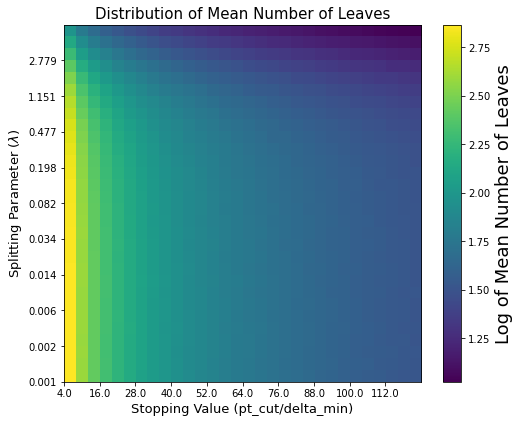

In [6]:
fig, ax = plt.subplots(nrows=1, ncols=1)
fig.set_size_inches(8,8)

cm = ax.imshow(np.log(mean_leaves), interpolation="none", extent=[0,30,0,30], origin="lower")
#ax.plot(mle_coords[1]+0.5, mle_coords[0]+0.5, '*', color='yellow', markersize=9, label="MLE")
#ax.plot(truth_bin[0]+0.5, truth_bin[1]+0.5, "*", color="red", markersize=9, label="Truth")
cb = fig.colorbar(cm, ax=ax, shrink=0.82)
cb.set_label(label="Log of Mean Number of Leaves", size=18)
#ax.legend(labelcolor="white", facecolor="black", fontsize="large")

ax.set_title("Distribution of Mean Number of Leaves", size=15)
ax.set_xlabel("Stopping Value (pt_cut/delta_min)", size=13)
ax.set_ylabel("Splitting Parameter ($\lambda$)", size=13)
ax.set_xticks(np.arange(0, 30, 3))
ax.set_yticks(np.arange(0, 30, 3))
ax.set_xticklabels(np.round(cut_vals[::3], decimals=0))
ax.set_yticklabels(np.round(lambda_vals[::3], decimals=3));

#fig.savefig("likelihood_landscape3.png")